
#  <table><tr><td bgcolor=orange> <font  color=#4B0082 size=5>  Active Portfolio Management Final Project </font> </td></tr></table>

### - <font color=#4B0082 size=3> Student Name:   Xinyu Zhang </font>



In [1]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
plt.style.use('ggplot')

import warnings
warnings.filterwarnings('ignore')

## Import Data:
- Store data in a list of dataframe, every dataframe contains data of a same day.

In [2]:
import os 
path = "/Users/zxy/Desktop/2019 Spring/portfolio/CorrectedData"
files= os.listdir(path)
dfs = []

for i in range(2007,2018):
        for data in os.listdir(path+"/"+"apt-"+str(i)):
            df = pd.read_csv(path+"/"+"apt-"+str(i)+'/'+str(data), sep = '|')
            dfs.append(df)

In [3]:
len(dfs)

2768

## Feature Engineering
### - One hot coding of industry factor 

In [4]:

from sklearn.preprocessing import LabelBinarizer
lb = LabelBinarizer()
lb.fit(dfs[0]['GICCODE'])
classes = lb.classes_
for df in dfs:
    onehot = lb.transform(df['GICCODE'])
    for i in range(len(classes)):
        df[classes[i]] = onehot[:,i]

In [5]:
dfs[1].iloc[0:10,0:20]

,ID,NAME,BETA,SIZE,MOMENTUM,VOL,GICCODE,XDATE,T,RDATE,R,ADVP,USDCAP,RESVOL,tir,td,10101010,10101020,10102010,10102020
0,4503_01,EXXON MOBIL CORP,0.164058,3.719016,0.257795,-1.512077,10102010,2007-09-28,2007-10-22,2007-10-23,0.004840,2.291308e+09,5.133620e+11,0.010142,-0.149063,0.078440,0,0,1,0
1,5047_01,GENERAL ELECTRIC CO,-0.802483,3.312710,0.088128,-2.837713,20105010,2007-09-28,2007-10-22,2007-10-23,0.007717,1.633273e+09,4.241917e+11,0.009170,-0.053998,NaN,0,0,0,0
2,12141_01,MICROSOFT CORP,-0.686341,3.147286,-0.078112,-1.452216,45103020,2007-09-28,2007-10-22,2007-10-23,0.012783,1.440538e+09,2.769756e+11,0.009105,-0.141178,-0.011448,0,0,0,0
3,9899_01,AT&T INC,-0.643331,3.039221,0.539546,-1.739150,50101020,2007-09-28,2007-10-22,2007-10-23,0.020646,9.894185e+08,2.580475e+11,0.010041,-0.019389,0.079461,0,0,0,0
4,3243_01,CITIGROUP INC,-0.097240,2.958055,-0.569173,-2.422755,40201020,2007-09-28,2007-10-22,2007-10-23,-0.003990,1.571780e+09,2.321624e+11,0.009395,NaN,NaN,0,0,0,0
5,7647_01,BANK OF AMERICA CORP,-0.724747,2.892669,-0.592805,-3.312710,40201020,2007-09-28,2007-10-22,2007-10-23,0.000000,1.312804e+09,2.230657e+11,0.008010,-0.046826,-0.061297,0,0,0,0
6,8762_01,PROCTER & GAMBLE CO,-1.517794,2.837713,-0.190789,-2.440194,30301010,2007-09-28,2007-10-22,2007-10-23,0.002815,8.171819e+08,2.191842e+11,0.007985,-0.107408,0.030219,0,0,0,0
7,20779_01,CISCO SYSTEMS INC,-0.145691,2.790186,0.933425,-0.651163,45201020,2007-09-28,2007-10-22,2007-10-23,0.005419,1.588617e+09,2.020655e+11,0.011862,0.001710,NaN,0,0,0,0
8,2991_01,CHEVRON CORP,-0.122801,2.748233,0.526994,-1.175403,10102010,2007-09-28,2007-10-22,2007-10-23,0.005427,9.822447e+08,1.994854e+11,0.010237,-0.160000,0.045370,0,0,1,0
9,6266_01,JOHNSON & JOHNSON,-1.934516,2.710622,-0.693247,-2.616347,35202010,2007-09-28,2007-10-22,2007-10-23,0.003264,8.224786e+08,1.901692e+11,0.006859,0.009401,0.015835,0,0,0,0


### - All factor classifications: style factor, alpha factor, non-alpha factor

In [12]:
allcoulumns=dfs[0].columns
stylefactor=['BETA','SIZE','MOMENTUM','VOL']
alphafactor=['tir', 'td']
nonfactor=['ID','NAME', 'XDATE' ,'T', 'RDATE',"ADVP","USDCAP","RESVOL","R",'GICCODE']
industryfactor=list(dfs[0].iloc[:,16:].columns)

indus_name=industryfactor
Xname=stylefactor+alphafactor+industryfactor
nonalpha_name=stylefactor + industryfactor
allfac_name=stylefactor+alphafactor

### - Find all stock IDs

In [13]:
allstocks=set()
for df in dfs:
    allstocks=allstocks | set(df.ID)

#  <table><tr><td bgcolor=orange> <font color=#8A2BE2 size=5>  1. Arbitrage Pricing Theory </font> </td></tr></table>

# Problem 1

### (a) OLS / WLS

In [14]:
factorreturn_ols = pd.DataFrame(columns = Xname)
factorreturn_wls = pd.DataFrame(columns = Xname)

In [15]:
alldata = pd.concat(dfs, axis = 0, ignore_index = True)
alldata[['T','XDATE','RDATE'] ]= alldata[['T','XDATE','RDATE']].apply(pd.to_datetime)

In [ ]:
# alldata.to_csv("alldata.csv",index=False)
# alldata = pd.read_csv("alldata.csv")

In [16]:
# Indexed by date and id
data_t_i = alldata.set_index(['T','ID']).sort_index(level=[0,1])
data_t_i=data_t_i.dropna()

In [18]:
data_t_i.iloc[:,0:16]

NAME      BETA      SIZE  \
T          ID                                                            
2007-01-03 10035_01              STATE STREET CORP  0.214309  1.567480   
           1004_01                        AAR CORP  1.118885 -0.249304   
           10063_01       STERLING BANCORP/NY -OLD  0.627111 -1.426470   
           10086_01   STEWART INFORMATION SERVICES  0.460462 -0.587256   
           10096_01                 PUBLIC STORAGE -0.515433  1.391687   
           10115_01                   STRYKER CORP -0.499723  1.576986   
           1013_01      ADC TELECOMMUNICATIONS INC -0.192690  0.108856   
           10156_01                     SUNOCO INC  0.653102  1.011717   
           10187_01             SUNTRUST BANKS INC -0.651963  1.775202   
           10195_01       SUPERIOR INDUSTRIES INTL -0.132042 -0.984446   
           10200_01                   SUPERTEX INC  1.028760 -0.929150   
           10232_01            SYMBOL TECHNOLOGIES -0.566595  0.658811   
           10247_01                     SYSCO CORP -1.317937  1.586637   
           102696_02     LOGITECH INTERNATIONAL SA -0.625991  0.834084   
           10277_01                TECO ENERGY INC -0.763154  0.614830   
           1034_01             ALPHARMA INC  -CL A  0.949184 -0.285566   
           10353_01                       TEAM INC -1.539780 -1.846322   
           10391_01                  TEKTRONIX INC  0.444144  0.354381   
           10405_01     ALLEGHENY TECHNOLOGIES INC  2.888322  1.083434   
           10407_01                   TELEFLEX INC -0.478967  0.379989   
           10420_01                    TELLABS INC  0.655383  0.746018   
           10426_01              TEMPLE-INLAND INC -0.013811  0.790543   
           10441_01                     TENNANT CO -0.189877 -0.917868   
           10443_01                    TENNECO INC  1.125798 -0.217136   
           10453_01                   TERADYNE INC  1.793293  0.466612   
           10484_04            UNITED AIRLINES INC  1.545834  0.640618   
           10498_01           TEXAS INDUSTRIES INC  1.640789  0.030388   
           10499_01          TEXAS INSTRUMENTS INC  0.608170  1.940186   
           10507_01    ENERGY FUTURE HOLDINGS CORP -0.230353  1.658740   
           10519_01                    TEXTRON INC  0.273121  1.194364   
...                                            ...       ...       ...   
2017-12-28 7982_01             NORTHERN TRUST CORP  0.839151  1.302597   
           8007_01                WELLS FARGO & CO  0.319732  2.655095   
           8068_01       OCCIDENTAL PETROLEUM CORP -0.140473  1.748969   
           8079_01       OCEANEERING INTERNATIONAL  0.460459 -0.128033   
           8214_06                   OWENS CORNING -0.460459  0.856813   
           8240_02                        PHH CORP  0.872167 -1.765463   
           8245_01    PNC FINANCIAL SVCS GROUP INC  0.347662  1.871136   
           8264_01                       PG&E CORP -2.044028  1.432637   
           8272_01                   SEMPRA ENERGY -1.583451  1.457655   
           8386_01          PATRICK INDUSTRIES INC  0.698293 -0.226469   
           8402_01                     PAYCHEX INC -0.556693  1.321337   
           8455_01                        PPL CORP -1.748969  1.375992   
           8479_01                     PEPSICO INC -1.655311  2.315686   
           8486_01               TUTOR PERINI CORP  1.304657 -0.443878   
           8549_01                  CONOCOPHILLIPS  1.034478  1.822678   
           8605_02               PIPER JAFFRAY COS  1.175520 -0.462418   
           8644_01               KINROSS GOLD CORP -2.799499  0.518032   
           8762_01             PROCTER & GAMBLE CO -1.628201  2.599580   
           8807_01               PNM RESOURCES INC -1.913333  0.300329   
           8898_01    RAYMOND JAMES FINANCIAL CORP  1.003401  1.010712   
           8901_01                         RPC INC  0.579458  0.509992   
           9273_01                  ROYAL GOLD INC

In [230]:
from sklearn.linear_model import LinearRegression 

def calculate_factorreturn(data,Xname,yname):

    factor_return_ols = pd.DataFrame(columns = Xname)
    factor_return_wls = pd.DataFrame(columns = Xname)
    
    lm = LinearRegression(fit_intercept = False)
    
    for time in data.index.levels[0]:

        df =data.loc[time,:]
        df = df[df[yname]!=0]

        X = df[Xname].values
        y = df[yname].values

        # OLS: store factor return
        factor_return_ols.loc[time, df[Xname].columns] =lm.fit(X, y).coef_
        
        # outlier trimming
        df[np.abs(df.RESVOL)<0.005].RESVOL=0.005

        # WLS
        df["w"] = df.RESVOL ** 2
        
        
        X = df[Xname].values
        y = df[yname].values
        
        factor_return_wls.loc[time, df[Xname].columns] = lm.fit(X, y, sample_weight = 1/df.w).coef_
    return factor_return_ols,factor_return_wls


In [231]:
factor_return_ols,factor_return_wls=calculate_factorreturn(data_t_i,Xname,"R")

In [232]:
#factor_return_ols.to_csv("factor_return_ols.csv")
#factor_return_wls.to_csv("factor_return_wls.csv")

### (b) Cumulated factor return

In [233]:
factor_return_ols_cumsum = factor_return_ols.cumsum()
factor_return_wls_cumsum = factor_return_wls.cumsum()

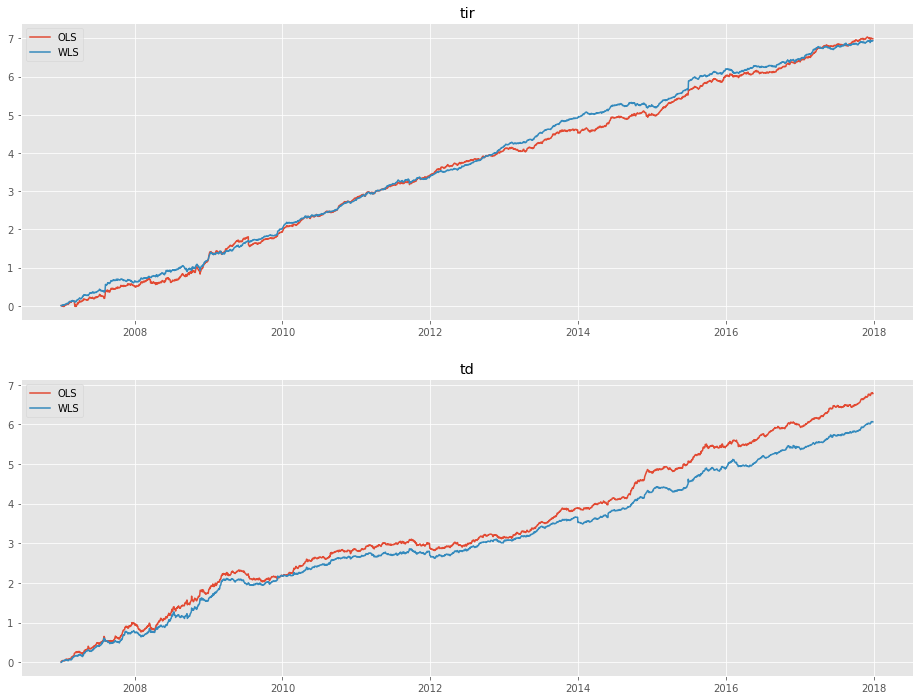

In [235]:
fig, ax = plt.subplots(2,1, figsize=(16,12))
for i in range(2):
    col_now = alphafactor[i]
    ax[i].plot(factor_return_ols_cumsum[col_now], label='OLS')
    ax[i].plot(factor_return_wls_cumsum[col_now], label='WLS')
    ax[i].set_title(col_now)
    ax[i].legend()

In [236]:
from scipy.stats import ttest_ind

pvalue_tir = ttest_ind(factor_return_ols['tir'], factor_return_wls['tir'])[1]
pvalue_td = ttest_ind(factor_return_ols['td'], factor_return_wls['td'])[1]

print ('The p-value of t-test between OLS tir and WLS tir is: '+str(pvalue_tir))
print ('The p-value of t-test between OLS td and WLS td is: '+str(pvalue_td))

The p-value of t-test between OLS tir and WLS tir is: 0.9551983316459998
The p-value of t-test between OLS td and WLS td is: 0.48877732893028414


- From the p-value above, we can't reject the original assumption, which means they are not significantly different.

### (c) Mean factor return

In [237]:
print ('Mean of tir in OLS is:'+ str(factor_return_ols['tir'].mean()))
print ('Mean of td in OLS is:'+ str(factor_return_ols['td'].mean()))
print ('Mean of tir in WLS is:'+ str(factor_return_wls['tir'].mean()))
print ('Mean of td in WLS is:'+ str(factor_return_wls['td'].mean()))

Mean of tir in OLS is:0.0025250992498675076
Mean of td in OLS is:0.0024490973641823053
Mean of tir in WLS is:0.0025062817361783127
Mean of td in WLS is:0.0021911217306907213


# Problem 2

### (a) Optimal holding

- Inverse of covarinace matrix:
$$
\Sigma^{-1}=(XFX'+D)^{-1}=D^{-1}-D^{-1}X(F^{-1}+X'D^{-1}X)^{-1}X'D^{-1}
$$
- Optimal solution of h:
$$
h=(\kappa\Sigma)^{-1}\alpha
$$

In [238]:
# h*= [D^(-1)*alpha - D^(-1)*(X)*(F+X'*D^(-1)*(X))^(-1)*X'*D^(-1)*alpha]/kappa

def optimal_holding(kappa, F, X, alpha, D_inv, D_inv_h):
    factor_m = np.linalg.pinv(X) @ alpha
    x1 = (1./kappa) * np.linalg.inv(F + np.linalg.pinv(X.T @ D_inv @ X)) @ factor_m
    h = D_inv_h @ np.linalg.pinv(X.T @ D_inv_h) @x1
    return h

In [240]:
factor_return_ols

,BETA,SIZE,MOMENTUM,VOL,tir,td,10101010,10101020,10102010,10102020,...,45301010,45301020,50101010,50101020,50102010,55101010,55102010,55103010,55104010,55105010
2007-01-03,0.000409016,0.00200778,-0.000523702,0.00176798,0.0100956,0.00923602,-0.0271302,-0.0309847,-0.0157203,-0.021554,...,0.0145228,0.0124013,-0.00623069,-0.00167958,0.00431185,0.00150324,-0.00298192,0.00206197,0.00277479,0.00488782
2007-01-04,-0.000262066,0.00498133,0.00119547,0.00247759,-0.00618931,0.00967229,0.00274454,-0.00764847,-0.0139414,0.00546278,...,-0.0253507,-0.0119367,0,0,-0.0170864,-0.0199623,0,-0.0210693,0,-0.0147204
2007-01-05,0.000631725,0.00337384,-0.000150303,0.00139793,-0.0024546,0.00798085,-0.00290134,0.00196922,0.00452039,0.00158532,...,0.0129686,0.00753695,0,0,0.00893664,-0.0045368,0,-0.00471197,0,-0.00220957
2007-01-08,0.00022307,0.0022232,0.000447295,0.0014401,-0.00343898,0.00829646,-0.00602224,-0.0117562,-0.0226841,-0.007364,...,0,0.00287254,0,0,-0.0692247,0.00146453,0,0.00312658,-0.00433192,0.0113535
2007-01-09,-0.00127874,0.00202476,0.000683012,0.00178042,0.00697198,0.0035117,-0.0141761,-0.0139202,-0.0213823,-0.0158689,...,0,0.0175545,-0.00767556,0.0442623,0.0168319,0.00111308,0,0.000212485,-0.00324598,-0.00111026
2007-01-10,0.000468857,-0.00231858,0.00102577,-0.00057643,0.00571704,0.00121055,-0.00989763,-0.0146903,-0.00950251,-0.00302949,...,-0.00258752,0.00715256,0.158549,0.0754079,0.000473371,0.00721967,0,0.000935671,-0.00783548,0.0110021
2007-01-11,0.00133963,7.38668e-05,-0.00100481,0.0022593,-0.000458805,-0.00176063,0.0305446,0.0281716,0.0285553,0.0282383,...,-0.00367725,-0.00189383,0.0141896,-0.000415663,-0.00756631,-0.00553704,0.0152685,-0.000725977,0.00441099,0.00010545
2007-01-12,-0.00274819,0.0029718,-0.00242619,0.00324486,-0.0183461,0.000208733,-0.00448213,-0.00548882,-0.01783,-0.00842345,...,-0.0201928,-0.013123,-0.00623356,0.0183302,-0.0119876,0.000876275,-0.00500362,-0.000194742,0.000464446,-0.0019944
2007-01-16,-0.000997919,0.0021497,-0.00183988,0.000993975,-0.0078539,-0.00203584,0.0132021,0.0119604,0.00832178,0.0104085,...,0.000858182,-0.00965622,-0.00121763,-0.0106431,-0.015052,-0.00351458,-0.00297803,-0.00340155,-0.000409219,-0.00213914
2007-01-17,-0.00240219,0.000317703,-0.00300423,-0.00316858,0.00922695,-0.00483485,-0.014379,-0.0150583,-0.00916685,-0.00792178,...,-0.0592123,-0.0318093,0,-0.00162405,-0.00238261,-0.0111076,-0.0120711,-0.0114284,-0.0222929,0.000196585


In [241]:
'''
Calculate optimal holding for each stock in each day:

'''

def compute_optimal_holding(factor_ret, kappa=1):
    # Save holdings: dates,stocks
    holding_df = pd.DataFrame(columns = data_t_i.index.levels[1])

    for dt in factor_ret[200:].index:    
        print(dt)
        # Get X
        df = data_t_i.loc[dt, :]
        df = df[df["R"[0]]!=0]
        y = df["R"]
        
        df_X = df[stylefactor+alphafactor+industryfactor]
        df_X = df_X.loc[:, (df_X != 0).any(axis=0)]
        
        X = df_X.values

        # Expanding covariance
        F = factor_ret.loc[:dt, df_X.columns.values].astype(float).cov().fillna(0).values

        # Get D
        df.loc[df['RESVOL'] < 0.005, 'RESVOL'] = 0.005
        D = np.diagflat(df['RESVOL'].values ** 2)
        D_inv = np.diagflat(1. / df['RESVOL'].values ** 2)
        D_inv_h = np.diagflat(1. / df['RESVOL'].values)
        
        # Get alpha: n*1
        alpha = df['td'].values + df['tir'].values
        
        # Get holdings
        holding = optimal_holding(kappa, F, X, D_inv, D_inv_h)
        print(holding)
        
        # Store into df
        holding_df.loc[dt, df_X.index.values] = holding.reshape(1,-1)

    
    return holding_df

In [242]:
holding_df = compute_optimal_holding(factor_return_ols)  


2007-10-18 00:00:00
[-7.82651026e+00  3.87044019e+02 -2.76577168e+01  4.27125941e+01
 -4.37961595e+02  1.81066649e+02 -6.00348919e+01 -2.18623959e+02
 -6.85059836e+00 -4.78295409e+02  3.88279418e+02 -3.84302172e+02
  5.39077766e+02  3.61658393e+02  1.28029151e+01 -1.75145341e+02
 -1.14482184e+02 -5.59015170e+02 -5.23355618e+02 -1.29648808e+02
 -2.28095970e+01  2.64548475e-02  8.39901689e+01 -1.63485929e+02
 -4.42391905e+01 -7.81493112e+01 -2.72696281e+01  3.38914079e+01
  2.94729680e+02 -2.24997730e+00  3.52371278e+02  1.30047584e-11
 -2.28427914e-11 -8.63856542e+01  5.34630658e+01 -8.17955230e+01
  1.44254346e+02 -2.12702564e+02 -1.39897260e+02 -3.33470872e+02
  2.20335299e+02 -3.64981287e+02 -7.60669763e+01  1.71833214e+03
 -3.95645080e+02  1.16110831e+02 -1.87986040e+02  1.60561546e+02
 -6.87376330e+01 -2.36941358e+02  1.94967950e+02  8.05411207e+01
  4.16034894e+02 -1.68580107e+02  3.40773324e+02  1.92398335e+02
 -6.92322468e+02  1.67130791e+02  3.41254091e+02 -1.45237364e+01
 -5.0

[ 1.03620077e+01  3.54527086e+02 -3.53274421e+01  1.83152615e+02
 -7.04785945e+01  7.06134735e+01  4.75054618e+01  2.23318611e+01
  2.10163280e+02 -7.81688099e+01 -3.93987966e+02 -2.23338846e+02
  5.21041713e+01 -2.99129724e+02 -2.12816166e+02  1.41324923e+02
  1.95192365e+02  3.51941629e-10  1.06035568e+01 -1.05868562e+02
 -1.24016165e+02  6.06211393e+01 -3.20452679e+01 -3.42043961e+02
  2.77694492e+02 -3.21446172e+01  1.17632233e+02  9.09426261e+01
 -1.17178681e+02 -2.28915677e+01  1.03215879e+02 -1.65873471e+02
  1.83180810e+02 -3.68635957e-10 -3.30074044e+02  1.26470249e+02
  6.36027540e+01  3.99743829e+02 -2.20953220e+01  3.68541156e+02
 -1.64679741e-10 -7.42847797e+02 -5.84001952e+02  3.31100756e+02
  4.03922724e+02 -4.33998261e+01  7.48583320e+01  9.08250986e+01
 -2.32236585e+02 -5.52415000e+00 -3.13360243e+02  1.49649249e+02
 -9.57083537e+01 -2.16650904e+02 -4.28427671e+02  2.86973525e+02
  1.93770487e+01 -5.30140555e+01 -6.96495880e+01 -1.19775850e+02
 -5.45726185e+01 -4.80173

[-1.85646821e+02  4.50046411e+02  1.13328881e+02 -1.10371874e+02
  1.78943765e+02  5.20701063e+02  4.01607779e+01 -7.04542374e+02
  2.01006375e+02  4.06555690e+01 -4.09793136e+02 -1.57110662e+02
 -2.54463954e+02 -2.28860873e+01  1.57782605e+02  1.72044069e+02
  4.13197753e-10 -5.02818422e+01 -1.35396437e+03 -8.10103968e+01
  1.30211714e+02 -2.97126156e+01 -1.32161671e+02 -1.02705273e+02
  2.07174245e+02 -3.72501968e+01  3.14600851e+02  1.99969787e+02
  1.35780156e+01 -8.74342047e+01  2.72575393e+01 -4.10184185e+01
  1.36218750e+02 -1.59772141e+02  1.78507331e+02 -4.11682268e-10
 -1.85047245e+02  5.74224308e+01  3.00893765e+02  1.47157054e-10
  3.32235746e-10 -1.81344237e-10 -5.90278738e+02 -3.01491095e+02
 -5.69444235e+02  5.97590963e+01  2.86944661e+02  4.06542924e+02
  3.96653681e+01  1.22809954e+02  2.06259965e+02 -2.13280545e+02
 -2.13633492e+02 -1.90642773e+02 -2.22479732e+01 -2.03120104e+02
 -2.06420978e+02 -2.15676782e+02 -2.43468199e+01  1.89894331e+01
 -7.76820570e+01 -1.67902

2007-10-25 00:00:00
[ 1.36817780e+02 -2.10600688e+02 -9.32778150e+01  2.48604349e+02
  1.86072909e+02  7.47104888e+01 -4.36650488e+02  1.06602623e+02
  4.21549724e+02  4.52716803e+01 -1.75142260e+02 -6.83557148e+01
 -3.67464632e+02  4.97862453e+02 -4.43044274e+01 -2.23764000e+02
 -5.74758112e+02 -2.26272821e+02 -3.82876744e+02 -1.24195073e+02
 -3.80361105e+01 -2.00350775e+02 -5.33724861e+02  4.93123244e+01
 -7.03083243e+02 -1.51205930e+02  2.20223706e+02  2.44650615e+02
 -1.41871152e+02  3.18391608e+02  1.28273087e+02  4.84590371e+01
  3.66436955e+00  1.23571690e+02 -2.35143062e+02  3.35489120e+02
 -5.30917568e-10 -8.80531111e+01 -1.25826211e+02  1.19479841e+02
  2.80184637e-11 -2.94880968e+02 -1.54343470e+02 -4.52617889e+02
 -1.54542730e+02  2.57651693e+02  2.74115895e+02 -5.33466007e+02
  3.99371442e+02  4.34218920e+01  1.76526651e+02  5.22606839e+02
 -1.71192313e+02 -3.23809382e+02 -1.69480852e+02  5.85088545e+01
  2.63446789e+02  1.16508488e+02  1.44698311e+02 -8.28425931e+01
 -3.4

[ 2.31920382e+02 -2.52102095e+02 -4.46856614e+02  2.87025120e+02
  5.52591141e+01  6.49653773e+01 -4.13284648e+02  8.51386982e+01
 -1.99659061e+02  3.40894915e+01  3.18420811e+02 -1.99494431e+02
 -4.96035169e+01 -2.65153543e+02 -4.49928281e+02 -9.40082114e+02
  1.61509068e-10 -1.62372322e+02 -2.49160924e+02 -9.32145448e+00
  3.52889353e+01 -5.63131691e+02 -2.88169499e+02 -3.77702040e+01
  1.51294253e+02 -2.56683715e+02  2.53628768e+00 -1.04945110e+02
  2.23899135e+01  3.07537779e+02  1.61944324e+02  1.32439454e+02
  1.62147953e+02  1.54006852e+02  9.19029052e+01  1.03643130e+02
  2.88389441e+02 -3.67674987e-10  1.86303062e+02  2.96269259e+01
 -5.79521022e-11  1.37223272e+02  1.11460436e-10 -3.00082183e+02
 -3.17077264e+02 -5.91990407e+01 -2.52031537e+02  1.20995897e+02
 -2.64681962e+02 -3.66800004e+01  1.62372322e+02  5.28991434e+02
 -1.76839150e+02 -6.39744863e+02 -1.34944048e+02 -8.63858907e+01
 -5.67761170e+01 -1.33857486e+01  1.69054063e+02  6.46953408e+02
 -4.19131244e+01 -5.41194

[-1.01191358e+02  2.33129132e+01 -2.36536248e+01  3.15440002e+02
  7.31326573e+01 -4.73953844e+02  1.55053238e+01  1.96286643e+02
 -1.95040362e+02 -2.91789035e+01  3.67787484e+02 -1.76714021e+02
  1.88278272e+02 -4.78257841e+01  5.69871632e+01 -3.24944054e+02
 -3.42004039e+02 -1.00209769e+02  1.60106846e-10  6.38181619e+00
 -1.60617132e+02 -8.06200807e+01 -2.90202703e+01 -1.16471158e+02
 -6.03238949e+02 -1.18877891e+02  2.48981428e+02 -1.04945228e+01
  1.59689003e+02 -1.32726275e+02  7.11203780e+01  7.39817273e+01
  2.06477818e+01  2.60457464e+02  1.34453174e+02 -8.88447360e+01
  8.33641258e+01  2.20897322e+02  1.77116671e+02  1.69106840e+02
 -3.35231953e-10  1.44917339e+02 -1.80139489e+01 -9.10890962e+01
  6.67757339e+01 -6.60305167e-11  1.18952504e+02  6.81477696e-11
 -2.81733627e+02 -4.12734001e+02 -2.00007867e+02  1.54150112e+01
 -3.50994741e+02 -9.41220056e+01  6.60092595e+02 -1.58021516e+02
 -6.39160778e+02 -8.07400385e+01 -7.52806899e+01  3.40413051e+02
 -7.85907348e+01  6.51896

[ 1.54929802e+01  3.11517926e+02 -9.02369730e+01 -1.87697100e+02
 -5.88370965e+01  5.54396879e+01 -4.94612081e+01  2.26088026e+02
 -2.09111185e+02 -3.48066313e+01  8.35605500e+01 -2.19066885e+02
 -3.10168917e+02 -1.75651708e+02  1.72218148e-10  8.41195499e+01
 -1.82169818e+02  1.68058178e+02  1.15338977e+01 -1.43138448e+02
 -6.28291578e+02  4.25327267e+00  1.91019354e+02  3.94122213e+01
  1.22439896e+02 -1.86611108e+02 -1.78142161e+02  2.30009243e+01
  9.03571711e+00  2.15585307e+01  1.38540762e+02  7.27681077e+01
  2.62785216e+02  1.96451553e+02 -5.41979892e+01  1.43076849e+02
 -4.44444162e-10 -3.79108988e+02 -4.96616708e+01 -2.20529107e+01
  1.25467525e+01 -4.60588696e-11  1.17090898e+02 -1.25843759e+02
 -7.32149761e+01 -1.28537428e-11 -1.07549065e+02 -1.92599368e+02
 -3.52069500e+02 -1.16376195e+02  1.50043602e+02 -2.62736633e+02
  1.97621451e+02  2.37689067e+02 -1.64730908e+01 -1.71102497e+02
  8.01519397e+01 -2.06686564e+02  1.18521710e+02 -3.72348899e+00
 -9.50389327e+02  7.95523

[-1.18197557e+02  2.05479783e+01 -7.95039783e+02  1.57101810e+02
  8.03808055e+01 -1.05332840e+02 -1.41278794e+02 -2.31007451e+02
 -5.71747428e+01 -8.03081405e+01  2.08921108e-01 -2.42960105e+02
 -2.73730892e+02 -3.50282901e+02  7.56659774e-11  6.73725661e+01
 -1.66343657e+02  3.97109617e+01 -1.32126867e+02 -3.13931262e+02
  3.21475495e+02  3.40649374e+01  1.03116225e+02 -1.10850291e+02
 -1.69320056e+02 -6.97396142e+00  3.78380715e+01  2.02637911e+01
  1.19778306e+02  7.69036480e+01  1.58950993e+02  1.59069992e+02
  3.32965435e+02  1.68605266e+02  1.13785955e+02 -5.94329472e-10
 -4.67984555e+01 -5.03070933e+02 -2.94269829e+01 -6.45571691e+01
  6.13672165e+01 -3.04475730e-11  9.67591938e+01  9.77210710e+02
 -3.79461135e-11 -7.05996158e+01  1.08518585e+02 -3.86037689e+02
 -2.15596955e+02 -2.21676446e+01 -4.73122027e+01 -1.97898346e+02
  3.67740402e+01  1.60040748e+02  8.71459336e+01  2.90339897e+02
  1.93894506e+02  1.00261169e+02 -1.41936590e+03 -7.45606447e+01
 -5.54668827e+02 -4.56477

[-1.15371537e+02  1.12674355e+03  1.50451815e+01 -3.31905016e+02
  1.30881810e+02 -4.03439052e+01 -4.80066062e+02 -2.24915898e+02
  1.33223083e+02  7.44118961e+01 -4.07238743e+02 -8.02836267e+01
  7.82656770e+00  6.20063691e+01 -1.09868029e+02 -1.27372258e+02
  1.15013084e+01  1.30487493e+02  2.90593703e+01  3.60332561e+01
 -5.63917397e+01 -1.45012748e+02 -8.64995070e+02 -3.08287528e+01
 -1.14723506e+01 -1.59578650e+01 -3.29727413e+01  5.37476616e+01
  2.01788782e+02  2.08593157e+02 -2.97102996e-01  1.71881171e+01
  9.18292576e+01  6.09837994e+01  7.51271911e+01  8.39885037e+01
 -5.70092448e-10 -3.92365078e+01  7.03883112e+01  1.71159429e-10
 -2.34973446e+01 -5.82238289e+01 -4.12141477e+01 -5.87259996e-11
  1.03008974e+01  5.01258609e+01  1.11369335e+03 -3.82550686e-11
 -3.84815908e+02  1.67113757e+02 -1.74901729e+02 -1.44012451e+02
  6.29995398e+01  1.75451998e+02 -3.25409052e+01  1.45676333e+02
  9.17347786e+01 -7.58333310e+02 -2.12126197e+02 -2.90658159e+02
 -1.91212502e+02  1.10099

[-1.20775563e+02  1.21271831e+03 -4.17300355e+01 -3.50221804e+02
  5.80235358e+01 -3.30960420e+01 -2.42790864e+01 -2.94491214e+02
 -2.36221116e+02  9.08907549e+01 -1.55214910e+02  6.08222121e+01
 -1.01721118e+02 -4.14548195e+01  1.71397928e+02  2.19010774e+01
  2.13810488e+02 -9.13781687e+02 -6.60444582e+01 -5.35844055e+02
 -6.71866982e+01 -1.30491244e+02 -2.21795422e+02 -1.77218918e+01
 -3.84335438e+01  1.31728533e+02  7.58495887e+01 -5.39322331e+01
  6.29907180e+01 -1.78210970e+01 -4.75887106e+01 -3.66119117e+01
 -3.50797282e-10 -3.38421181e+01  4.82903715e+02  1.40704119e-10
  7.27524336e+01 -6.26416571e+01 -8.09581512e+01 -8.58274857e+01
  3.66549603e+02 -4.28880038e-11  6.57718210e+01  1.06656931e+03
  2.96508777e+02  4.56710629e-11 -2.97751037e+02  1.04945349e+02
  1.66569962e+01  8.86265285e+01 -2.73628037e+02 -5.28543236e+01
  2.98558818e+02  6.98666772e+00  6.61587728e+01 -7.80395806e+02
 -2.94368062e+02 -1.32253582e+02  2.68479296e+01  2.10725596e+01
 -3.48041105e+01 -1.67681

[-1.36794843e+02  1.39558322e+03 -1.13118809e+02 -4.75764819e+02
 -6.88322014e+01  2.31483010e+02  7.61720097e+01 -3.63256124e+01
  7.02174824e+01 -3.43272697e+02 -1.66275118e+02 -3.95514945e+01
  3.57372925e+02 -4.24594806e+01 -2.51367006e+01  6.35735204e+02
  4.60457730e+01 -6.11008432e+02  1.00403343e+01 -1.79380019e+02
 -6.43236774e+02 -1.94225814e+02 -1.19125933e+02 -7.70322156e+01
  1.03547315e+02 -5.98112836e+01  4.26456353e+00  3.28955739e+01
 -1.56528176e+02 -1.82166443e+01  1.91661457e+01  3.71115381e+01
 -5.46811731e+01  4.58209570e+02  1.65427034e-10  3.72067899e+01
 -1.52804663e+02  1.55059381e+02 -1.01802372e+02 -7.52555938e+00
  7.91856761e+02 -7.11652903e+01  3.04319165e-11 -1.97377226e+02
  2.57158998e+01  7.97055168e+01 -4.08593354e+01  3.06743336e+01
 -6.48047605e+02 -7.12290005e+01  2.72932774e+02 -4.44719513e+00
  5.21879070e+01 -1.37937962e+02 -5.57543233e+01 -4.39416513e+02
 -8.23649300e+02 -2.02260159e+02 -1.76798811e+02  1.13506164e+02
  7.28145229e+01 -8.32267

[-2.54749744e+02 -8.54436017e+02  1.35183923e+03 -5.38444183e-11
 -4.40240034e+02 -1.67773057e+02  4.27612249e+01  2.61588757e+02
  1.54049668e+02 -6.47983170e+01  6.50144103e+01 -2.77492365e+02
 -1.81045543e+02  2.71992161e+02  2.51408867e+00 -5.93149889e+01
 -1.17909910e+02  5.12802533e+02  2.76235843e+01  5.61216034e+01
 -5.23137548e+02 -2.84610835e+00 -2.17335183e+00 -5.97820504e+02
 -9.69039379e+01 -7.79440726e+00 -7.48403958e+01  2.03627408e+02
 -1.87037031e+02  1.07692733e+00  1.76608439e+02  6.60670681e+01
 -9.54547760e-01 -5.04774000e+01  5.64130865e+02  7.96898359e-11
 -6.69424420e+00 -4.85998305e+02 -1.86601832e+02  1.19363350e+02
 -9.06283904e+01  9.25127883e-11  5.14649255e+02  2.04471531e+02
  9.36598121e+01 -7.99407887e+01 -3.35295069e+02  5.42131328e+00
 -9.62538291e+01  1.47165172e+02  2.79850806e+01 -3.05575714e+02
 -1.07460880e+02  2.71602429e+02 -3.78291217e+01 -2.99647497e+02
 -4.24512544e+01 -4.02177813e+02 -4.53956157e+02 -8.01928563e+01
 -2.03737804e+02  7.03497

[-9.56609412e+02  2.68813191e+02 -6.10721174e+01 -6.19748569e+02
 -1.48855024e+02 -4.63359223e+01  2.66545226e+02  7.57597717e+01
 -1.57746131e+02 -1.78748399e+02  2.36437702e+02  2.39264879e+02
 -5.11017492e+02 -4.62029664e+01 -1.17609796e+02  5.04008356e+02
  3.19235486e+01 -6.86549750e+02 -2.08525909e+01 -6.93131940e+02
 -1.18078584e+02  1.68408146e+01  9.88970901e+01  1.81735354e+02
 -8.90358787e+01 -1.91401966e+02 -3.55413706e+00  4.74564834e+01
 -6.66673731e+01  6.57558652e+02  1.22159521e+02 -4.98479254e+01
 -4.92986557e+02  2.26584051e+02 -3.65801511e+01 -6.60650901e+01
  1.85221321e+02 -8.99107509e+01  3.71910449e-11  3.03841242e+02
  2.41270228e+02  1.09432292e+02  9.93849730e+01 -2.19038341e+02
 -4.95649628e+02 -5.60399109e+01 -1.99182700e+02  1.43493876e+02
 -8.73892934e+01 -3.71907074e+02 -1.18602131e+02 -1.98647179e+02
 -4.57207279e+02 -2.49502225e+02 -1.44326061e+02  3.39976370e+02
  2.98773903e+02  2.23000719e+01  4.86278009e+00 -5.89106674e+00
 -1.46344085e-12 -3.64687

[-8.13062688e+02  3.17551215e+02 -7.24494036e+01 -6.25455061e+02
 -1.11034433e+02 -9.16819770e+01  2.98058618e+02  8.78284576e+01
 -3.50787993e+02  1.18432920e+02 -2.11447029e+02  2.26562630e+02
  2.98574259e+02 -4.15494675e+02  1.63170129e+02 -1.52795987e+02
  9.99667361e+01  2.93213561e+01 -4.00944009e+02  6.46487326e+00
 -3.80047336e+02 -2.46260531e+02  4.60722685e+01  3.01322737e+01
  8.66218101e+01  1.42050895e+02 -7.62530740e+01 -1.29833149e+01
  4.51906253e+01  4.19508242e+01 -8.58354464e+01  3.29314593e+02
 -2.57032555e+02 -2.47765952e+02  1.50801388e+02 -1.65146822e+01
 -1.51450770e+02  1.96156671e+02 -1.02252784e+02  3.02053361e+02
  1.65967592e+02  1.44392974e+02  1.03558847e+02 -2.93874752e+01
  4.74283938e+02 -3.59599784e+02 -4.75437879e+02  2.00040885e+01
 -2.03665219e+02  1.79588836e+02 -2.68130203e+02 -1.25780027e+02
 -9.09741215e+01  6.64306608e+00 -8.59845921e+01 -4.50657403e+02
  3.73532267e+02  2.25389437e+02  6.53063570e+01 -3.26956116e+01
 -2.19269734e+01 -5.00441

[-3.26259373e+02 -7.10906841e+01  7.44600787e+01 -7.49137716e+00
 -4.61299430e+02 -2.60599058e-10 -3.64946511e+01  2.06957283e+02
  2.76350073e+02  5.37153903e+00 -1.44758773e+01 -9.66978543e+02
  5.21327727e+01  5.08023342e+01  2.03824731e+01 -2.08336819e+02
 -1.58776375e+02  6.67123609e+01 -4.81785839e+01 -1.37929228e+02
  2.69660385e+00  2.09083265e+01  1.02831204e+02  2.85275504e+02
 -1.71976537e+02  1.61016623e+02 -6.13301158e+00  1.33342393e-10
  3.52629442e+02 -9.66313578e+00  1.51558077e+02  1.38787581e+02
 -3.21641983e+01 -4.15766748e+01  2.76576380e+02 -1.42997960e+02
 -3.13518498e+02  1.67234781e+02  2.04425137e+02 -7.20864917e+01
 -1.30758403e+01  1.50595153e+01  2.37365464e+01  1.56227839e+02
  1.32232945e+02  1.46171754e+02 -5.82086432e+00  3.38072405e+02
 -1.31682209e+02 -3.95604291e-11  1.83394978e+02 -4.18344590e+01
  1.17000666e+02  7.69349745e+01  4.92020557e+01  4.93148105e+01
  4.42562865e+02  1.03685536e+02 -3.59826726e+02 -1.19279308e+02
  5.03011345e+01  3.70161

[-9.56315782e+01  4.55135888e+02 -1.18107342e+02 -4.63806392e+02
 -1.56705753e-10 -3.70994532e+01  1.66165736e+02  1.97668657e+02
  6.98053380e+01 -2.25028899e+02  1.20584522e+02 -8.36733053e+02
 -5.62691582e+01  2.56285942e+01  1.74464217e+02 -8.36561143e+02
 -2.07763292e+02 -1.61144542e+02 -1.96157462e+01  7.43562145e+01
 -1.24805648e+02 -1.37265312e+01 -8.01462502e+01  1.62834011e+02
 -7.25961256e+02  9.01555562e+01 -1.00173302e+02  1.45674035e-10
  5.26204195e+02  9.98390165e+00  4.82510051e+01 -2.71263186e-10
 -2.23859581e+02 -2.93914274e+02  3.97652257e+02  2.72220257e+00
 -4.81089846e+02 -9.37325992e+01  5.99017366e+01  8.45726906e+00
 -2.45975417e+01  1.29186984e+02  2.32514047e+02 -8.00757711e+01
  1.28655393e+02  2.22934477e+01  3.35908123e+02  6.54259523e+01
  1.81077095e+02 -1.05679814e+01  1.68448004e+01  4.66744745e+01
  4.39460754e+02  1.07472667e+02 -3.61613703e+02  1.24038113e+02
  6.45169870e+01  3.11303779e+02  1.07867407e+02 -4.78665380e+02
 -2.77064311e+01 -7.12190

[-1.20340704e+02  3.71326150e+02 -7.87727827e+01 -1.08188204e+02
 -5.29101554e+02 -1.61486441e-10 -3.09597926e+01  9.33420846e+01
  3.92285229e+02  1.30755857e+02  1.59804738e+02 -1.02331111e+02
  1.36806102e+02 -9.95750141e+02  6.96588157e+01 -1.29944360e+02
  4.13332603e+02 -9.13267157e+02  4.59076096e+01 -1.43210730e+02
 -1.21330619e+02  6.79096360e+01  4.98082810e+01  2.78599152e+02
  6.52691648e+01 -8.16717166e+02  4.28505422e+02  9.00819093e+00
 -2.50918081e-10  6.38741609e+02 -2.79503972e+02 -1.98667950e+02
  3.48077826e+02 -4.08911632e+01 -3.18107303e+01 -4.73334625e+02
 -1.83504171e+02  5.51140008e+01  1.28801649e+02  1.86870106e+02
 -1.09167326e+02  5.11398363e+01  5.03376710e+01  3.48383425e+02
  1.93318891e+02  3.43353490e+01 -1.09861445e+01 -1.27998216e+01
 -1.79240463e+01  5.76088020e+01  1.05123693e+02 -3.48675041e+02
  3.83850453e+01  7.50911132e+01  2.94059524e+02  1.19639771e+02
 -4.93705038e+02 -7.93412610e+01 -4.32366760e+00  6.61794830e+01
 -5.90713484e+01  1.78600

[-6.37956037e+01  5.86443850e+02 -5.07994681e+01  3.50546718e+02
  1.33013693e+02  5.09433220e+02  3.45302450e+02 -7.65861503e+01
 -1.63944310e+03  7.80171122e+02 -9.15528130e+02 -1.16619913e+02
 -2.38816618e+02  3.12162513e+02 -1.62689316e+02  1.70590964e+02
  8.21911610e+00  2.38890842e-03  4.31256533e+02 -1.01932536e+01
  1.24404487e+02  1.68190192e+01 -3.71430896e+02 -3.37088778e+02
  7.03578993e+02 -2.46458642e+02  3.87244427e+02 -1.09584886e+02
  1.57214812e+02  1.98946742e+02 -3.23061474e+02 -2.56620065e+01
  1.36325784e+02  1.55403850e+02 -2.16794198e+02  1.41151830e+02
 -2.52719413e+01  1.06245693e+02  7.32518659e+01 -8.20550657e+01
 -2.36768081e+01 -1.23140440e-02 -2.97807987e+02  2.11676609e+02
  9.81477902e+01  2.13977460e+01  3.34482607e+01 -3.94652855e+02
 -2.13723842e+02 -1.74807119e+02 -5.22058035e+01  4.21760828e+01
 -2.85871646e+01  8.85226674e+00  1.15458677e+02 -3.64110922e+02
  1.78807215e-10 -2.37724962e-11 -5.41390600e+01  1.89792161e+02
  1.86519417e+02  6.77762

[-7.25305607e+00  4.11564685e+02  1.21976011e+02  1.86087899e+02
  2.41390395e+02 -1.29750014e+03 -6.43750355e+02 -3.45924199e+02
 -5.92210926e+02 -2.61367273e+02 -1.78213898e+02 -1.69257811e+02
  2.88440369e+02 -3.25239931e+02 -2.07434913e-10 -3.55758949e+01
 -1.05544473e+02 -1.34119784e+02 -5.68377693e+01  2.36103071e+02
  2.18361258e+02  1.05212629e+02  9.90544533e+00  8.26551163e+02
 -2.48200570e+02  4.37876325e+02 -1.94174874e+02  4.05029230e+01
  2.92710717e+02  2.85346075e+02 -2.48272428e+02 -7.11909249e+02
  1.39118833e+02  2.22306639e+02 -5.12212103e+01 -2.73420738e+01
  8.43502389e+01 -2.32839259e+01  2.26480951e+02 -3.36078352e+02
  1.46043958e+02 -1.27949035e+02 -7.75505570e+01 -4.80350034e+02
  7.04327791e+01 -1.84704621e+02 -1.21660703e+02  5.54745291e+01
 -1.88176691e+02 -3.87577511e+01 -5.84408851e-12 -1.27848258e+02
  3.55067308e+02  1.27004256e+02 -3.32936856e+01 -6.37665489e+01
  1.83139283e+02 -2.48691910e+00 -4.69688316e-12  6.75632602e-11
  3.07156425e+02  8.03275

[ 1.00978405e+02  6.94801179e+01 -4.11579804e+01 -2.54737829e+01
  1.90354740e+02  3.08175870e+02 -6.56993399e+02  4.45708423e+01
 -4.80191518e+01  4.28892454e+01 -1.51879778e+02  1.86103529e+01
  5.58929187e+02 -2.68218247e+02  2.63306464e+02 -8.01230414e+01
 -4.84102064e+01  7.03465015e+00  2.68792059e+02 -1.62354470e+01
  2.18663875e+01 -3.29364909e+02  2.90315573e+02 -3.54936533e-11
  4.95348460e+00 -1.46564142e+02  1.72679530e+02 -2.56499749e+02
 -7.10054936e+01  5.56095891e+02  3.58269145e+02 -2.12063659e+02
 -5.92097641e+02  2.08397731e+02  2.13030327e+01 -5.11260705e-11
  4.57265668e+01  3.41286972e-11  3.34767186e+02 -6.10708706e+02
  2.80420773e+02  1.98992741e+02 -3.08967929e+01 -4.62575981e+02
  7.51878528e+01  2.17756779e+01 -1.73653571e+02 -4.97698590e+01
 -5.58306404e-12 -7.87357432e+01 -1.13002156e+02  6.94136613e+02
 -7.62288726e+01 -2.14430079e+01 -4.87320815e+02  6.39516151e+00
 -1.20970044e-12  3.35572068e-12  1.66918898e+02  3.23425836e+01
  1.02648872e+02  2.68944

[-1.39721229e+01  9.99229728e+01  1.92318386e+02 -4.37267235e+00
 -5.47985521e+01 -3.35416920e+02  1.46119052e+02 -4.51484348e+01
 -3.79663473e-12  8.03711305e+01 -8.39228742e+01  2.33266854e+00
  7.45745580e+00  5.18899910e+02 -1.10037953e+01  4.48334971e+01
 -6.29187207e+00  4.95280098e+01  6.98393161e+01  1.56932593e+01
  4.04218325e+01  5.33032563e+01  4.18455050e+02  2.06719359e+01
 -9.09127636e+01 -8.50234363e+02 -5.96846279e+01 -1.00263760e+02
 -1.76331786e+02 -1.08573611e+02 -2.86985802e+02  1.70377895e+02
 -1.08731321e-10 -7.95550126e+01 -5.92823807e+01 -1.92673999e+02
 -2.23272601e+02 -1.16385012e+02  1.73821708e+02 -1.35339866e+02
  2.27075642e+01  3.54945203e+02 -3.31660577e+02  3.01841670e+02
 -7.08042133e+01  7.52395153e+02 -2.49597667e+01 -1.19887023e+02
 -2.28345781e+02 -7.97339647e+01 -1.15352459e-10  2.47044452e+01
  1.21313899e+02  6.97433824e+01  2.81350194e+02 -4.40387340e+02
  2.25932841e+02  1.28148587e+02  6.49795491e+01 -2.96783502e+01
 -5.92464213e+01  4.95592

[-1.19214684e+02  1.76524842e+02  6.84618883e+01 -2.95893390e+02
 -9.50102024e-01 -1.34436860e+02 -5.55515876e+02 -4.02104412e+02
  2.89183920e+02 -2.91766222e+01  8.88299402e+01  1.80950911e-11
  1.09336988e+02 -3.95787679e+02  8.37973438e+00  3.08633091e+02
  2.14924206e-11  3.54389132e+02 -2.70274615e+02  4.58506144e+01
  8.00894070e-11  3.93575245e+01  2.74000420e+01  4.53444966e+01
  7.76831964e+02 -1.32771256e+02 -1.01980404e+03 -1.47804726e+02
 -2.28710821e+02 -1.02686062e+02  5.23636793e+01 -2.33349635e-09
  3.17918483e+01 -1.44015735e+02  2.04179881e+02  2.26281111e+02
  5.82728902e+01  1.12474382e+02 -4.04990597e+02  1.70286838e+02
 -4.12136670e+01  4.74118988e+02 -5.20875838e+01 -1.20481990e+02
 -3.57580588e+02 -2.57705652e+01  1.96308638e+02  1.82915810e+02
 -2.00514001e+02 -1.26590673e+01  4.46500635e+01  3.11826617e+02
  3.57160172e+02  1.91196146e+02 -1.95213003e+01  3.66929136e+02
 -1.16458330e+02 -1.01100538e+02  3.19028097e+02 -3.54497249e+01
  3.34971258e+02  9.65934

[-2.47510637e+02 -1.22896890e+02 -3.04951611e+02 -7.96596663e+01
  3.33108111e+01 -1.73323507e+02 -5.45431886e+01 -4.22515967e+02
 -2.55697498e+02 -2.13408954e+02 -9.03260449e+01 -7.74937465e+01
  1.37375787e+02  1.32140717e+02  6.38812617e+01 -1.72694204e+02
 -2.73599438e+02 -1.26620522e+02 -8.95004369e+01  3.44382332e+02
 -3.90792942e+02 -6.41116378e+01 -3.55520872e+00  1.06921382e+02
  9.16635179e+01  5.96067249e+01 -4.01761281e+01 -1.14501025e+02
 -1.24117937e+02 -2.52138377e+01 -1.16244448e+02  1.76349653e+02
  2.62724273e+02  2.32319813e+02 -1.89640859e+02  2.42525966e+02
 -9.35946577e+00  2.85084213e+02 -8.19064558e+01  2.21486553e+02
  1.06116565e+02  7.74313083e+01 -2.51497837e+02 -8.10492475e+01
  8.11527601e+01 -2.90964570e+02  4.46485418e+02 -1.27805198e+02
  7.63207217e+01  2.56025248e+02  2.28239918e+01 -6.77809718e+01
  1.20528330e+02  9.17143979e+01  4.01431282e+02  1.65101682e+02
  1.12024539e+00 -1.36638730e-10  1.85448444e+02 -1.42944213e+02
 -1.81488923e+02  3.77395

[-7.71968952e+02 -3.48258520e+01 -2.24845633e+02 -2.39660510e+01
 -1.09992030e+02 -3.34588779e+01 -1.32827117e+02  2.84379436e+01
  1.73559531e+02  1.90227570e+02 -2.65110935e+02 -4.87626993e+01
 -3.33292168e+01  1.35382525e-09  4.81836665e+02 -2.21030090e-03
  1.26365705e+02  7.00518054e+01  5.43370191e+01 -1.28230328e+02
  3.05450810e+01  2.95687733e+02 -6.26149162e+01  1.80625340e+02
 -1.33141647e+03  2.39119824e+02  1.72380677e+02 -5.26537982e+01
 -3.00247732e+02 -1.43491555e+02 -1.86077629e+01 -2.60269719e+02
 -1.94137160e-10  6.52425869e+00 -2.14149106e+02 -5.03025236e+01
 -3.62153645e+01  7.72222306e+01  4.26023666e+02 -2.86678053e+00
  7.83234655e+01 -1.56947235e-10  4.30525189e+01 -1.59958490e+02
  1.96993936e+01 -3.46543567e+02  1.32083178e+02  8.46713667e+01
  1.85561568e+02 -7.82921484e+02 -3.62520801e-11 -9.47826377e+01
 -3.74315820e+01 -1.20965830e-10  2.66383078e+01  1.83707386e-12
  6.83555873e+01 -5.18040164e+01 -2.04088981e+02  1.06716715e+02
 -9.64439470e+00  2.33113

[-1.52313700e+01 -5.50181138e+02 -1.54171653e+02 -1.74318095e+02
  1.44907690e+02  4.32349129e+01 -5.99337659e+01 -1.08659609e+02
  2.90304994e+02 -3.16121601e+02  9.27432903e+01  1.94966387e+02
 -1.71883341e+02  4.16069205e+02 -2.07383497e+01 -2.68856923e-03
  1.47557659e+02  4.57565702e+01  2.33468152e+02  1.00191122e+02
  4.04326737e+02  1.98735290e+02 -1.23812423e+02  3.12171568e+02
 -4.25521004e+01  3.20341942e+02  5.61620344e+02 -1.32928117e+03
 -5.32531649e+01 -9.19224074e+01  1.23994604e+02  1.65875390e+02
 -2.57932846e+01  1.32357328e+02 -3.16844188e+01 -8.67017694e+01
 -6.14584434e+01  9.00164251e+01  6.00488658e+01  7.09580460e+01
  1.79016996e+02 -1.77097406e+02  2.68361783e+02 -9.65941500e+01
 -9.44067489e+01 -6.92780754e+01  3.33024340e-13  3.99922015e-12
  3.15157769e+02 -3.21468283e+02 -1.22324816e+02 -1.50486220e+02
  3.19427383e-11 -3.08247947e-11 -7.61740373e+01  3.20057540e+01
  2.22671455e+02 -7.91985500e+01 -6.23328609e+01 -7.91939454e+01
 -4.22408116e+02  3.26161

[-1.76683568e+02 -5.08144776e+02 -1.54854575e-10 -6.38925049e-11
 -2.89376749e+01  1.38393702e+02  8.36259257e+01  3.30855941e+01
  3.00813508e+02  2.80191588e+02 -1.47773580e+02 -3.04448672e+02
  2.51013211e+01  5.68177716e+02  4.37930759e+01 -1.81717157e+02
 -4.99952835e+02  2.21367758e+01  4.79753900e+00  1.34195824e+02
  9.95502466e+01  4.93122084e+02  1.86501093e+02 -1.54524040e+02
 -1.62773969e+02  2.01286913e+02  3.08622381e+02  2.05839693e+02
  3.87891265e+02  3.35004515e+02 -2.96653211e+02 -4.86544863e+02
  1.04003698e+02 -3.86948585e-02 -6.23823533e+01 -1.33540748e+02
 -4.12659641e+02 -9.81445264e+02 -1.52714641e+03  1.07323728e+02
  1.53735523e+01 -9.58906133e+01 -8.56745241e+01  4.82831944e+01
  7.85805554e+01  1.51782175e+02 -1.57952054e+02  6.02800221e+01
  2.74933708e+02  1.37699187e+02  1.09509843e+01 -3.55993058e+02
  2.92913225e+02 -4.52455908e+02 -1.19378485e+02  7.47380818e+01
 -2.00434591e-11  1.88538167e+01 -1.51524200e+00 -6.57344090e-12
  1.81538191e+02  6.95524

[-2.43817616e+02 -2.54870554e+02 -2.79637197e+02 -5.50827297e+01
  2.09252812e+02  1.71918284e+02 -1.21132700e+02 -6.34680030e-11
 -1.73925110e+02  9.60257901e+01 -2.66559184e+01  2.29330041e+02
  8.95935602e+01 -1.30109306e+00  2.08573991e+02  2.49482726e+02
 -1.51522548e+02 -3.42083256e+02  4.41692743e+01  1.08416809e+02
 -1.15388663e+02  6.04162883e+01  6.84352891e+01  3.61689955e+01
  3.31324326e+01 -6.84352891e+01  3.66336655e+02  1.09200991e+02
 -1.52918826e+02 -5.97839092e+02 -4.39758979e+01 -5.67148015e+01
  3.52125091e+02  2.11032656e+01  8.04501588e+01  3.24447268e+02
  8.44370499e+01  5.52762573e+02  1.48479995e+02  2.86450878e+01
  2.39945429e+02  8.96302060e+01 -3.46898804e+00 -2.19070229e+02
 -6.77936438e-02 -6.35918609e+01 -4.83347176e+02 -1.01033089e+02
 -1.13826523e+03 -5.97002677e+01 -2.54883210e+01  2.33549238e+01
 -1.66115869e+02 -1.74098712e+02  5.64467910e+01  2.36766717e+02
  4.37771480e+01 -1.68760244e+02 -3.74297708e+02 -1.60494837e+02
  2.12798130e+02  1.74695

[-2.05726982e+02 -2.75993945e+02 -3.99809637e+02 -8.83507734e+01
  7.82047094e+01 -2.79584316e+02 -8.99869683e+01 -1.44225153e+02
 -9.97152131e+01  3.10994230e+02  2.57762261e+02  2.49746566e+02
  8.59759083e+01 -2.63497690e+02 -2.23873756e+02  2.06770668e+01
  3.06267628e+02  7.08164252e+01  5.81719100e+01  3.67426981e+01
  3.60752805e+02  1.90018569e+02 -1.91064483e+02  8.51424534e+00
  6.71661083e+01  1.82383747e+02  1.24131312e+02  3.28435742e+02
 -8.02896214e-01 -1.01282170e+02 -6.95466107e+01  2.23589978e+02
  5.29027099e+02  1.46884911e+02  2.17541425e+02 -1.46570159e+02
  2.01619432e+02 -1.42930599e+02  5.98782146e+01 -5.21319514e+00
  2.97120672e+01 -6.71229493e+01 -1.50752252e+02 -1.50581812e+02
  1.07336801e+01 -8.33835646e+01 -4.70156956e+01  3.44380213e+02
  5.76456881e+01 -1.24125852e-10 -9.63372401e+01  2.20973746e+01
  9.38690095e+01 -2.12377862e+02 -1.66602730e+02 -3.70284563e+02
  2.14195815e+02 -9.28974089e+01 -1.02868359e+01 -1.27436806e+01
 -1.11764918e+01  1.32457

[-4.18107605e+02 -6.90864333e+01  8.74096875e+01 -3.88923507e+02
 -8.90777163e+01  2.51250184e+02  1.08988658e+02 -3.62003712e+01
  1.34608988e+02 -4.22878024e+02  4.95284204e+02  1.31370325e+01
  1.44101538e+02 -8.91172615e+02  4.86297380e+00  2.19538478e+00
  5.24587768e+01 -2.99946971e+00  7.02577943e+01 -1.69781670e+02
  2.31949010e+02 -6.23582227e-11  2.02365729e+01 -2.25532287e+02
  7.41857471e+01  2.85662555e+02 -4.48742993e+01 -3.04511223e+01
  9.46847897e+01 -6.83668483e+01  6.28870164e+01 -2.54387416e+02
  2.74944357e+02 -4.49569802e+00  3.53893352e+02 -9.21645941e+01
 -5.55222737e+01 -8.86827732e+00 -1.27569686e+02 -1.53281309e+01
 -4.48594796e+02  4.41062105e+01 -7.78954959e+01  6.98858555e+02
 -1.88903156e+02 -2.94716181e+02 -4.26282224e+00 -5.66898788e+02
 -1.11298250e-10 -1.56271864e-10  1.21648124e+02 -1.47561719e+02
  3.29810592e+02  3.98020039e+02 -1.36813916e+02  3.81991714e+02
  3.10883884e+01  6.12038077e+01  2.01307438e+01  7.96293749e+01
  1.74206773e+00  1.45805

[ 6.15401053e+01 -5.22296719e+02  4.10139283e+01 -2.06382396e+02
  1.36798294e+02  7.92823725e+01  3.20737513e+02 -6.63382823e+01
  3.28715331e+02 -1.13784317e+02  2.25071459e+02 -7.07750060e+02
  4.09680308e+01 -1.63527220e+02  6.66985935e+01  4.43955566e+01
  1.19008579e+02 -2.37941621e-01  4.57357058e+01  5.71800217e+02
 -9.30799547e+01  9.23408196e+01  4.22794647e+02 -1.40219108e+02
 -2.49905890e+01 -3.52196652e+01 -5.36845714e+01  1.60871877e+02
 -1.76284995e+01  6.94317714e+01 -6.95985471e+02  3.18956837e+02
 -1.58815219e+02  1.07237490e+02 -1.60563192e+01 -2.44323296e-11
 -1.09212926e+02 -1.32731626e+02 -7.66764178e+01 -3.19356255e+01
  2.73995750e+02  1.09793213e+01  2.82734250e+02 -1.17574194e+02
 -2.90608346e+02 -1.50150587e+01 -3.93885023e+02 -9.14576366e-11
  2.36172314e+02  1.49103188e+02 -1.93303976e+02  2.83241461e+02
  1.60030713e+02  3.69564753e+02 -1.17799483e+01 -2.82135777e+02
  2.67833469e+02  1.35828340e+01  9.08186931e+01 -6.64950523e+02
  7.46547262e+01  5.63294

[ 1.85231971e+02 -6.90196865e+02 -8.76737341e+00 -1.57040407e+02
  1.86876542e+02  3.29479044e+02 -1.20285632e+02 -2.35829709e+02
  2.65632588e+00 -3.76351972e+01 -5.53167113e+02 -2.01156321e+02
  2.39451562e+01  8.18829293e+01  3.37016087e+00  2.45463266e+02
  8.54939796e+01 -2.45467808e+02  1.73828611e+02  2.12536088e+02
 -9.76879310e+00 -5.60979607e+01 -3.83121384e+01 -1.00895159e+02
  1.07894475e+02 -6.24142995e+02 -1.62427332e+02  3.25723971e-11
  3.41425413e+02  1.01731913e+02 -6.33535178e+02  2.57738391e-10
 -2.60895081e+02  9.44091521e+01  5.02026136e+02 -1.21619083e+02
  2.20328969e+02  5.45548873e+01  1.80069479e-11  1.25271142e+02
 -2.47165804e+02 -4.59662358e+02  5.87593272e+01 -3.01846312e+01
 -3.86022353e+01 -8.17928011e+02  6.25975696e+01 -8.01917416e+01
  4.10488779e+01 -1.38124004e+02 -1.01271131e+02 -9.25714004e-11
  3.04347083e+01 -1.49588268e+02 -2.80536766e+02 -1.30849448e-11
  3.17649054e+01  7.47692850e+01 -3.90754703e+02  1.32855313e+02
  8.51423056e+01 -4.47645

[-4.02055824e+02 -1.03095334e+02 -5.25545006e+02  2.52201373e+02
  1.25559645e+01  1.97753428e+01 -2.97584813e+02  2.53351688e+01
 -2.61320644e-02  1.55035567e+02 -4.08422389e+02  1.40396465e+02
  2.87123581e-11  5.68022945e+01 -8.40262396e+02  1.10331645e+02
 -8.27550015e+02  1.49868119e+01  2.13434663e+02  8.65915146e+01
 -4.62825775e+01  4.23913651e+02 -8.09782383e+01 -1.04071325e+02
  1.31531254e+01 -8.08598319e+01 -4.30497870e+01 -1.65718520e+02
  8.19775386e+01 -7.47941696e+02  2.52468715e+01 -3.68171826e+01
  2.62759004e+02  1.95186580e+02  9.32289012e+01  7.93561812e+01
  2.90334989e+02 -1.29159556e+02  7.70142899e+01 -2.05298150e+02
 -3.23661959e+01 -3.32788559e+01  1.56858660e+02  7.90403306e+01
  1.55651170e+02  8.68248198e+02  8.55504947e+01 -2.79153123e+02
  1.45652552e+00 -4.64051591e+02  8.98759626e-11 -5.14025442e-09
  7.55023685e+00 -6.15354266e+01  1.54525106e+02 -1.70428175e+02
  4.62825775e+01 -7.24854609e+02  2.47975094e+02  5.50740525e+01
 -1.71915695e+02 -2.91825

[-1.39006608e+02 -1.95336574e+02 -5.99654877e-11  1.54586365e+01
 -1.77655950e+02  5.42029752e+01 -1.82407200e+02  5.29058639e+02
  3.32852700e+02 -1.82018291e+02 -1.18883075e+01 -7.64435104e+02
  1.48248705e+02  4.27753374e+01  5.10562599e+02  3.11972262e-07
  4.24062364e-06  1.09291313e+02 -1.67727857e+02 -6.01941936e+01
 -1.86156310e-10 -3.53116792e+01 -1.42927319e+02  1.27647449e+02
  4.86382416e+01  4.72538883e+02 -1.68329990e+02  2.22497763e+02
  5.10564575e+02  1.62148246e+02 -7.93041935e+02  2.52006417e+02
 -3.87288722e+02 -2.66162494e+02  1.24020010e+02  3.59179566e+02
  5.06743495e+01  1.21062119e+02  1.77345764e+02  1.19119846e-12
  1.45152154e+02 -2.33268739e+02 -4.83416042e+02 -9.05512322e+01
  2.35389162e+01 -8.74822247e+01 -1.97908471e-12  2.96217111e+02
 -6.13533638e+01  1.61972227e+02 -2.55783694e+02 -1.31890637e+02
 -4.35185581e+02  3.09618544e+02 -4.43293567e+01 -1.94699278e+00
  7.16152558e+01 -3.09028662e+02 -2.74301001e+02  4.42148341e+01
 -4.26046488e+00  5.37725

2008-01-08 00:00:00
[ 5.28720542e+01  3.41011263e+01  1.81321024e+01 -2.17931797e+01
 -8.11199763e-11  1.17277018e+02  1.63134114e+02 -2.30374516e+02
 -9.37009814e+01 -1.18585595e+02 -4.88181196e+02  4.29513450e+02
  2.49260255e+02  9.79517374e+01  6.49657331e+01 -7.59886276e+02
 -4.11081427e+01  1.20492964e+02 -4.97023687e+01 -9.76936576e+01
 -4.79105399e-06  1.05435963e+02 -7.32802042e+01 -1.89112827e+02
 -3.69404771e+01  5.79784849e+02 -8.03115224e+01  5.72816316e+02
  8.18266848e+01 -2.00102847e+02 -1.90105764e+02  5.77379124e+00
  1.74650070e+02  2.85954910e+01 -3.31775751e+02  4.91660302e-11
  4.79304427e+01  4.15435919e+02  1.64331347e+00  8.82824517e+01
  2.63245381e+02 -1.25089817e+02  2.87231413e+02  5.78349835e+01
 -4.59695820e+02  1.30175066e+02 -2.86915120e+02 -7.33151460e+01
 -6.63874670e+01 -6.63703888e+02 -6.85378469e+01  1.45651421e+02
 -1.57906561e+02  1.04795741e+01 -1.02224968e+02  1.67703964e+02
  5.57316329e+01  1.38702948e+02  8.56005692e+01  1.05975302e+01
  1.4

2008-01-11 00:00:00
[-1.00919794e+02 -1.77213370e+02  8.56722379e+01 -4.76452782e+01
 -1.88429410e+02 -2.94192090e+01 -4.39271640e+02  3.94546275e+01
 -3.61820989e+01  1.61716852e+00  4.20785336e+01  1.99337829e+02
 -1.39132165e+02  7.06909744e+01 -3.29542436e+01 -9.23218370e+01
 -9.34398873e+02  1.64169369e+01 -7.00765741e+01 -5.12691707e-11
 -8.22591675e+02 -3.90397035e+00 -2.23803545e+02  6.62419789e+01
 -5.18927784e+01 -1.42221052e+02 -1.26352689e+02 -5.16078998e+00
 -3.01368879e+02  2.75016776e+02  5.99472857e+01  1.48979562e+02
  2.63953505e+01  1.89248366e+02 -1.37786217e+02 -1.08925906e+02
  5.90860235e+00  9.93559836e+00  1.00607069e+02  5.75274763e+01
 -9.39858621e+01  2.17234684e+02 -9.96268946e+01  2.17332116e+02
  9.77314864e+00 -3.24671710e+01 -1.28714557e+01 -1.60900573e+02
  8.35975089e+01  1.78946276e+02 -7.22250750e+02 -9.17975374e+01
  1.47674005e+02 -2.55685983e+02 -7.63043667e+00  1.99828240e+02
  1.32700911e+02 -2.93089313e+01 -6.48981488e+01  1.37083557e+02
 -5.3

2008-01-14 00:00:00
[ 1.21913890e+02 -2.60219311e+02  4.25014721e+00 -3.37703246e+01
 -7.19592413e+01 -2.11281545e+02  1.24758593e+01 -1.11163923e+02
 -4.78638700e+02  2.86742400e+01 -8.64127581e+01 -1.13019377e+01
  3.81956025e+01  4.52514854e+01  1.24959390e+02 -2.70494545e+01
  6.11233477e+01 -3.19789786e+00 -1.85661016e+02 -9.99257464e+02
  4.74785985e+02  8.27813799e+01  8.38112006e+01 -5.96913650e-11
 -7.47828769e+02 -1.75459253e+01 -1.98343696e+02  2.84282991e+02
  3.00890167e+01 -1.76147030e+02 -1.61315731e+02 -1.03809691e+02
  1.46331549e+02  9.73486176e+01  1.45230737e+02  1.40513657e+01
  2.34657274e+02 -3.18838150e+01 -1.34508718e+02 -1.53052474e+01
 -5.39373986e+01  1.83350516e+02  6.25862954e+01 -2.63234417e+01
  1.43969502e+02 -1.77229629e+02  2.25418969e+02  3.43020882e+01
 -2.42383216e+01 -2.04506492e+01 -1.15086569e+02  1.02543926e+02
  1.34592634e+02 -7.86567734e+02 -1.62135821e+02 -1.26761591e+02
  3.41972912e+02 -2.80117996e+02  1.30040859e+01 -1.98736579e+02
  2.0

[ 1.15048161e+02 -1.78007772e+02  4.03993804e+01  1.32066414e+02
 -1.77987604e+01 -1.56709428e+02  5.80850717e+01  2.55174399e+01
  6.12990793e+01  6.25488145e-11 -3.05298442e+01  3.13985748e+02
  2.67317747e+01  1.11215002e+02  9.10268327e+01  6.87535345e+01
  2.14854830e+02 -1.35998535e+02 -9.38659959e+02  1.12480643e+02
  3.56017772e+02 -1.87502768e+01  1.15652752e+01 -2.24997918e-11
 -1.67650122e+02 -7.68828509e+02 -4.21104018e+01 -6.64028998e+01
 -4.57658655e+01 -1.26546553e+01 -4.02170363e+01 -9.90883620e+01
  1.14494991e+02  3.92638208e+01  6.45123116e+01  1.00212291e+02
  6.88973727e+01 -3.52162872e+01 -5.47470220e+01 -1.60710551e+02
 -1.24492315e+01 -7.05155890e+01  1.82510033e+02 -3.81357352e+01
 -1.65122312e+02 -3.18533783e+01  1.82734939e+02  3.06192895e+02
  7.14847635e+01 -3.54590150e+01  1.73636730e+02  1.24302329e+02
  1.73533509e+01 -7.15915038e+02 -2.27257622e+02 -1.03050493e+02
  2.20072671e+01  3.73031681e+02 -1.40241845e+02 -1.79519265e+02
 -3.80202995e+00 -5.15085

[-9.53120596e+01  6.48997963e+01  6.24327933e+01  1.38485965e+02
  7.97725478e+01 -1.31417823e+02  6.63432597e+01 -6.24825895e+01
  4.48977575e+01  2.52728505e-11 -4.52152587e+01  3.54954135e+02
  1.26789903e+01 -2.40691000e+02  1.37139119e+02  9.84656803e+01
  1.19571709e+02  6.01340014e+02 -1.78796149e+01 -1.05270574e+03
  1.07639891e+02  2.89553782e+02  4.56828205e+01 -5.57583341e+01
  5.02884610e-11 -2.17641341e+02 -5.39655410e+01 -2.72772263e+02
 -1.63623384e+02 -2.34952250e+01 -1.18618670e+02 -1.19776906e+02
  3.08638677e+01  9.19018587e+01  5.51330899e+01  6.57029885e+01
  7.94940307e+01 -5.19610985e+01  2.07273718e+02 -2.82592323e+01
 -1.78590255e+02  1.62697268e+02 -9.21293530e+01  1.62184117e+02
  1.09986406e+02 -8.21871540e+01  2.45541994e+01  2.91051037e+00
  1.85002840e+02  5.70912471e+01 -4.03077603e+01  1.40457040e+02
  1.86800043e+02 -1.67416708e+01 -1.50137636e+02 -2.01403387e+02
 -2.72068395e+02  2.89847362e+01 -8.30003106e+01 -1.93340881e+02
  3.73609473e+01 -2.07301

[-1.62043400e+02  7.43558831e+01  1.46350759e+02 -1.30227303e+02
  5.17993121e+01 -1.14536716e+02  3.66751656e+01 -1.98721995e+02
  3.13206702e+02  1.64902848e+01 -2.72470520e+02  1.63212544e+02
  2.04540579e+02  1.41729979e+02  5.72668390e+02 -2.03294654e+02
 -2.44437792e+02  1.32064970e+02  1.62569010e+02 -3.25798988e+01
  3.18731430e+00 -7.00463226e+01  3.58620555e+01 -2.61910500e+01
 -3.01334569e+01 -9.96476174e+01 -7.93540188e+01  6.06310548e-02
  8.45485289e+01  7.14380903e+01  1.28063468e+02  8.97941696e+01
 -1.01339342e+02  1.06826685e+02 -1.01700269e+02  1.98634521e+02
 -6.63732082e+01 -9.33579120e+00  2.04246922e+02  3.90957425e+01
  8.70550702e+01  8.32750553e+00 -2.04129612e+01  1.56173548e+02
 -2.94752411e-12 -2.26233098e+02  2.86455034e+02 -3.21737884e+01
 -8.02417223e+01 -2.07812379e+02 -7.44465194e+01  1.56758528e+01
  3.01598213e+01 -1.90706383e+02  3.20459541e+02 -5.62799299e+01
 -9.25955426e+01 -1.16339855e+02  3.68906971e+01 -4.00769313e+02
  8.06819996e+01 -1.99414

[-8.06700589e+01 -3.79350827e+02  5.42649750e+01  6.10808477e+01
  1.15759842e+02 -1.56788422e+02 -9.07631033e+01 -1.41313496e+00
 -1.76564953e+02  2.91565532e+02  2.16454281e+01 -2.59483574e+02
 -9.04895410e+01  1.56982991e+02 -1.50510337e+02  1.66035914e+02
  5.57665016e+02 -1.96922845e+02  1.01424261e+01  1.96198534e+02
  4.13086713e+01  2.34794421e+02 -8.85366715e-12 -6.36572809e+00
 -6.95440044e+01 -6.85497347e+02 -4.21104022e+01 -5.11968880e+02
 -1.04539081e+02 -9.69346163e+01  2.67260445e+00  1.37154660e+02
 -5.38928100e+01  3.36915174e+01  1.27015930e+02  5.11961160e+01
  9.70301310e+01 -1.32403279e+01  1.86520574e+00 -2.35933560e+02
 -8.51296946e+01 -2.41654793e+01  2.09150607e+02  8.37079830e+01
  2.74546613e+01  5.70550309e+00  2.11606103e+02 -5.55390744e-12
 -2.01415702e+02 -8.87519831e+01 -1.69463929e+02 -2.07245214e+02
 -2.97283746e+01 -1.45514216e+02 -3.07410315e+01 -3.38495367e+01
  5.91268227e+01 -5.14989273e+01 -1.01029095e+02  3.09309001e+01
 -5.93870621e+02 -6.77077

[-8.73376306e+01 -3.06850427e+02  7.46934484e+01  4.78559911e+01
 -1.32008276e+02  6.35383389e+01 -8.42087635e+01  1.36749238e+01
 -1.06603285e+02  2.58519075e+02  1.91812104e+01 -2.47652407e+02
 -1.22469085e+02  5.30652713e+01 -1.28690430e+02  1.75551505e+02
 -4.43881200e+01 -1.65464353e+02  4.64713619e+02 -1.80899498e+02
 -9.61573566e+01 -7.71786897e+02  1.36987396e+02  2.27884792e+02
  1.86622475e+02  4.76768301e+01 -8.44335988e+00 -2.14120613e+01
 -2.29487232e+02  1.40658924e+01 -6.25806373e+02 -5.73749101e+01
 -1.05165431e+02 -7.09001399e+01  6.14722817e+00  5.03712961e+01
 -1.11295523e+02 -7.32080595e+01  1.67809384e+01  9.71378734e+01
  8.91961896e+01  1.45740489e+01 -2.74650345e-10 -2.07922781e+02
 -6.26442672e+01 -4.72049751e+01 -1.67061265e+01  1.32994924e+02
  3.13069133e+01  1.27611734e+02 -1.43356907e+02  4.10277203e+00
  2.19132842e+02  2.48270994e+02  2.13201925e+01 -3.10561467e+02
 -5.30652713e+01 -2.60450154e+01 -1.72638879e+02 -2.42153053e+02
 -2.35277724e+01 -1.23094

[-3.93451263e+01 -3.66191329e+02  8.17731486e+01  4.36026692e+00
 -1.78338369e+01  1.39027256e+02  7.31739582e+01 -4.03044018e+01
 -1.46340665e+02  1.16230999e+01 -1.08279167e+02  1.14441965e+01
 -1.09506312e+02 -2.32294810e+01 -2.57114299e-11 -9.84357881e+01
 -2.28398350e+01 -1.74071333e+01 -1.39249874e+02  1.58022580e+02
 -1.71684218e+02 -2.16021591e+02 -8.46695221e+02  2.57660191e+02
 -7.46935853e+01 -6.37531836e+01 -7.47334769e+01 -1.83045644e+02
  1.97176714e+01 -3.44744178e+02  1.98402514e+02 -1.49154408e+00
  5.70613717e+01  1.91071298e+02  8.05892519e+01 -1.15949287e+02
 -1.04603113e-01  2.73373124e+01  3.26063618e+01  2.53816322e+01
  8.89648533e+01  2.98901625e+01 -3.69056751e-10 -2.42785624e+02
 -1.06979541e+01  1.57185212e+02  3.43106544e+01 -6.39680553e+01
  3.29303185e+01  3.66506165e+02  1.94359491e+01 -1.26093385e+02
  1.68562351e+02  4.13129418e+01 -1.21922832e+02 -2.52296688e+02
  1.45734565e+01 -1.21833231e+02 -4.26121084e+01  1.13365089e+02
 -9.28930493e+01 -4.40998

[-8.36090390e-01  3.01835150e+01  1.02786697e+00 -1.16096233e+02
  6.88293630e+01 -2.26700999e+01  5.86806066e+01  3.49947101e+01
  3.97052401e+01 -2.06151006e+02  5.81824161e+01  9.42901802e+01
  3.28993616e+01 -1.64376318e+02 -5.16946182e+01 -8.25707880e+01
  4.52403810e+01 -1.37455317e+01 -1.67159330e+02 -1.60802234e+02
  1.54989129e+02 -2.12918663e+01 -3.06665940e+02 -8.11056713e+02
  3.86998672e+02 -3.50332845e+01  2.40193069e+02 -6.20700084e+01
 -7.65647860e+01 -9.47909952e+01 -1.39727268e+02 -1.48493554e+00
 -2.01216779e+02  5.82367001e+01  8.34348677e+01 -1.09139090e+01
  1.13282459e+02  8.32241291e+01 -9.40839235e+01 -2.57229450e+01
  3.95568036e+01  7.48005426e+01 -3.40762304e+00  9.89275243e+01
  5.02698690e+00 -2.49571243e-10 -2.47957771e+02 -1.43356037e+01
  3.21819880e+01  1.67183175e+02  1.42551568e+01  2.63207042e+01
  2.02435956e+01 -1.42523780e+02  1.79677034e+02  4.80521814e+01
 -1.09863137e+02 -1.74698555e+01  1.41790454e+01 -1.26726267e+02
 -8.54864044e+01  2.65508

[-1.70117212e+01 -3.87372386e+01 -3.24663856e+01 -1.66285648e+01
  1.43043203e+02 -6.43590674e-11  4.44597685e+01 -1.88186344e+02
  5.28634718e+01  2.61920250e+02  3.75059322e+01 -3.96757017e+01
 -1.79138386e+02 -8.27375651e+01 -1.55612877e+02  3.47821403e+01
  1.01521773e+01 -9.17056640e+01 -1.58807390e+02  2.12735740e+02
 -3.18863112e+02 -2.67059158e+02 -6.48378716e+01  3.91077895e+02
  7.91992073e+01  2.04638121e+02 -5.10580980e+01  6.46872027e+01
 -2.24866816e+02 -1.58227122e+02 -1.21354805e+01 -1.37516779e+02
  7.95562204e+01  1.01860966e+02  1.69699764e+00  2.86197474e+01
  6.09196324e+01 -9.99539470e+01  6.55305923e+01  4.85434496e+01
 -1.47918395e+01 -3.16617554e-11 -1.99617804e-10 -4.78368341e+01
 -2.89336836e+01  5.97417433e+01  1.57249407e+02 -4.39357204e+00
  5.12702351e+01  6.77230833e+01 -8.19678412e+01  2.98075604e+02
  3.13565179e+01 -1.06031793e+02 -9.13920290e+00 -6.94040880e+01
 -4.75821675e+01 -5.14790904e+01 -3.63940366e+00 -7.38799964e+01
  7.70784124e+01  4.11981

[ 5.16411910e+00  5.41103783e+00 -4.68888697e+01 -1.20244343e+02
 -6.14557508e-11  7.44226740e+01 -2.06336092e+02  3.82526496e+01
 -6.40770335e+01  2.46698897e+02 -7.31636547e+01 -1.36600017e+02
  1.58238009e+02  1.62303983e+02 -1.74315401e+02  1.45289064e+02
  5.59354302e+01 -5.82293732e+01  2.75913692e+01  2.36676168e+02
 -3.92373792e+02  1.22169494e+02 -6.78454415e+01  6.62743759e+02
  1.36592812e+02  2.25590291e+02  8.34454234e+01  7.06955221e+01
 -3.30353473e+02 -2.77840338e+02  1.74519430e+01 -1.20791398e+02
  1.40336686e+01  6.41021990e+01  5.49239267e+01  3.69653253e+01
  8.32223222e+01 -2.38929198e+01  3.70371487e+01  7.43460892e+01
 -2.06795442e+01  8.31835805e+01 -1.80276782e-10  7.46281406e+00
 -6.28904081e+00  2.93558532e+00  1.81655137e+02  1.53816076e+01
  6.22281174e+01 -6.15269978e+01  7.12655348e+01  7.21245323e+01
  2.91057984e+01  6.89124115e+01 -8.39641971e+01 -7.72462930e+01
 -5.62136619e+01  9.80612102e+01 -3.11124254e+01  2.57999645e+02
  9.15310683e+00 -3.63387

[-2.22587435e-02 -1.16584873e+02 -3.57307878e+01 -3.91594377e+01
 -1.00679594e+02 -4.91965423e-11  9.91360646e+01 -7.71326004e+01
  3.38821521e+01 -2.07720396e-10  2.26556959e+02 -6.14763126e+01
  8.93786173e+01 -1.98076717e+02 -1.56147512e+02  3.55098064e+01
 -6.78806541e+01  1.17601390e+02 -6.03568785e+00  2.59165433e+01
  1.01146658e+02  1.69579481e+02 -1.38758606e+01  8.08674583e+01
 -3.12803846e+02 -3.03350650e+02 -4.50578852e+00 -9.26405248e+00
  1.03724391e+02 -2.91600808e+02 -9.14342628e+00  1.13046279e+02
  6.12155738e+00 -1.41488479e-10  1.59585972e+02 -8.80136729e+00
 -8.76581932e+01 -6.27825106e+01 -7.69435608e+00  3.01756594e+01
 -9.41938577e+01  1.50031858e+02  6.53971760e+01 -6.09942717e+00
 -1.92375217e+01 -7.33845105e+00  6.65048177e+01 -7.99696317e+01
 -9.10521556e+01 -6.67009275e+01  4.46479440e+01  9.24553651e+01
 -5.65087462e+00  2.90124430e+02  1.95141050e+01 -1.37815661e+01
  3.96237785e+01  1.37085018e+02 -1.37410273e+02 -4.70157164e+02
 -1.11748970e+02 -1.08801

2008-01-31 00:00:00
[-9.30576542e+01 -4.30179841e+01 -1.24262474e+02  1.70649530e+02
 -2.57708178e-10  1.77482063e+02 -1.00237908e+02 -1.36907941e+02
 -1.64066307e+02  5.96516644e+01  1.56222593e+01 -4.86044079e+01
 -3.08924410e+02  9.08569183e+01  3.86723441e+02  3.26066640e+01
  4.75093900e+01 -4.65019044e+02 -2.22768028e+02  5.03927951e+01
 -3.46715919e+02  1.64066307e+02  3.01599660e+01  7.34444812e+01
 -8.24110523e+01 -3.78738141e-10 -8.63236300e+01  7.24526043e+00
 -6.50783048e+01 -2.02406688e+01 -4.17009527e+01  3.89809834e+00
  1.18202703e+02  3.36180766e+01  2.28859293e+02 -2.36078441e+02
 -5.25426417e-11  1.88797219e+02 -7.12355828e+01 -1.09374201e+02
  5.40791440e+01 -2.12885528e+00  8.42583517e+01  1.05632571e+01
  4.82012657e+01 -2.73086836e+01  2.82894540e+01  1.03566238e+02
 -6.19405741e+01 -4.12488822e+02 -8.13670991e+01 -1.68252540e+02
  9.74454543e+01  1.15537339e+02  1.56608028e+02  2.85919086e+01
 -1.04506337e+02  1.49691000e+02  1.04814572e+01  2.32665617e+02
  6.0

2008-02-01 00:00:00
[-7.78420151e+01 -2.99234400e+02 -1.92930189e+02  7.28918657e+00
 -2.40535103e+01 -5.01248822e+00  2.15864884e+02 -3.99417483e+01
  3.12006901e+00 -5.68313938e+01 -4.46123198e+02  9.23946219e+01
  4.92635444e+02  7.83037341e+01 -2.37268986e+02  7.17980480e+01
 -2.09714593e+02 -2.20620603e+02 -3.98970472e+02  7.12998392e+01
  1.61135037e+01  7.71419319e+01 -8.11638026e+01  3.54756453e+01
 -2.87869487e-10 -8.83709986e+01 -5.29288684e-08 -4.78858620e+01
 -9.61014294e+01 -6.33895560e+01  9.59937703e+01  2.01034745e+02
  3.22563706e+02 -2.13256707e+02 -1.11912820e-10  3.48800604e+02
 -3.64190650e+00 -1.01806705e+02 -5.30678918e+01  1.75156919e+01
  1.49168008e+02  3.44363931e+01 -1.25674083e+02  8.29215542e+01
  6.36488261e+00  5.08315327e+01 -2.26463893e+02 -3.68036010e+02
 -1.25798006e+02  2.12357531e+02  1.90371577e+02  1.05184790e+02
  4.54077495e+01  1.09731283e+02  1.26386606e+01  9.03281495e+01
  1.72625905e+01  5.30878036e+00 -4.24672527e+01  1.66115243e+01
  2.8

2008-02-04 00:00:00
[-4.19368025e+01 -6.92127329e+01 -2.46355689e+01 -1.21159670e-10
  6.90647934e+02  1.01726575e+01  5.57381972e+01 -3.10785582e-11
  7.96803484e+01  2.45985498e+02  5.43414377e+00 -1.05413771e+02
 -1.45656755e+02  2.55511798e+02 -2.78356219e+01  5.15999170e+02
  8.03991290e+01 -1.84287799e+02  5.09147392e+01 -1.93046975e+02
 -5.98453402e+01  8.00213178e+01  3.34283481e+01 -1.48439334e+02
  1.62534768e+02  9.31550008e+01 -8.75947706e+01  3.34733151e+01
 -2.50015389e-10  3.26530981e+01 -1.58726329e+02  3.35561396e+02
 -7.00320208e+01  1.09609670e+01 -7.13189492e+02 -8.44715040e+01
 -1.63970548e-11  6.55371767e+01  1.01172815e+02  1.60279845e+02
  2.95495368e+02 -2.48084012e+02  9.99790769e+01 -4.52927646e+01
 -1.02024543e+02 -6.26580467e+01  1.69500259e+02  7.32949943e+01
  7.57452604e+01 -2.05784323e+02  4.57831533e+00 -8.74837576e-01
 -2.39296579e+02 -5.80858003e+02  9.56566319e+01  4.96134948e+01
 -1.18395582e+02  1.72711368e+02  9.35998662e+00  5.48847935e+01
 -4.5

2008-02-06 00:00:00
[-2.07307441e+02 -1.62334498e+02 -2.35617671e+02  3.63356344e+02
  2.08443490e+01 -3.06570801e+01 -9.37542146e+01  4.13055247e+01
  1.32578745e+02 -3.09054477e-11  4.66509375e+01  1.83436774e+02
  1.87924794e+02 -8.28889994e+01 -1.69076506e+02  1.31173523e+02
 -8.56821585e+01 -2.88737444e+02  7.20085716e+02 -3.39036664e+02
 -1.49129167e+02  6.45742449e+01  1.15551852e+02  1.49240659e-01
 -4.08389284e+01  6.36344800e+01 -9.61436674e+01  6.01422046e+01
 -2.76495392e-10 -2.17504836e+01 -2.65029942e+01 -4.13695451e+02
 -1.68056318e+01  3.78290971e+01  2.42215180e+01 -1.31404804e-11
  5.00816934e+01  3.38836618e+02 -5.93336950e+01  1.54545274e+02
 -2.67895350e+02  4.38816642e+01 -3.04081704e+02 -4.45527118e+01
  1.28589667e+02  2.68058895e+01 -5.01756032e+01  3.71661037e+02
  8.83761486e+00  3.17556633e+01  1.31083192e+02  1.01566594e+02
  1.52953562e+01  5.00491163e+01 -4.90183503e+02  7.55733320e+00
  4.85899189e+02 -1.29911189e+02  1.65846374e+02  1.83761080e+01
  2.9

[-1.82351207e+02 -1.71956213e+02 -3.17999540e+02  2.06838911e+02
  4.23268128e+01 -7.25657579e+01 -8.82065609e+01  2.23857992e+01
  1.21437343e+02 -2.36739894e-11  6.52050585e+01  1.62330774e+02
  2.87240242e+02 -2.51827289e+01 -1.64808583e+01 -1.86275711e+02
  1.86428254e+02 -1.37375462e+02  1.05618815e+03 -2.55137298e+02
 -6.51490877e+02 -3.26462036e+02  8.42005082e+01  4.26791824e+01
 -1.13448013e+02 -4.35067654e+00 -2.01707619e+01  9.32620548e+01
 -6.54009535e+01  1.44493808e+01 -2.24160385e-10  3.40506723e+01
 -5.04557683e+01 -4.08098734e+02 -2.61750233e+01  6.92735133e+01
  3.16221604e+01 -2.16564253e-11  2.32368989e+01 -5.98463946e+01
 -1.08491684e+02 -7.47655595e+01 -5.24519029e+02 -1.49855016e+02
  7.73876273e+01  1.49485677e+02  4.78714315e+01 -2.91524749e+01
  2.65911649e+02  2.40230360e+01 -9.95716898e+01  1.18143615e+01
  1.11684061e+02 -4.99865435e+00 -2.27658992e+02  4.18311006e+02
 -5.79197303e+01  1.20976802e+02 -5.60925010e+00  8.22802232e+01
  5.77035416e+01 -5.47549

[-1.96537391e+02 -1.36645475e+02 -2.95525928e+02  1.52378986e+02
  4.09802921e+01 -6.61221991e+01  1.87851877e+00  3.46106379e+01
  5.86045912e+00  1.97706107e+02 -1.25473379e+02  1.20620926e+02
  5.89844206e+02  3.98779302e+02 -5.26860577e+02 -2.16941331e+02
  2.22211495e+02  2.09940473e+02  2.76576786e-11 -1.16611244e+02
 -1.73170247e+01 -1.94449864e+01  8.38997491e+01 -2.42837933e-10
  6.03375420e+01  1.69648642e+01  1.51632951e+02 -7.16737191e+01
  4.68009920e+01 -4.12474823e+02 -1.47348742e+02  1.13069193e+02
 -3.97451703e+01  1.68260950e+01  1.38893247e+02 -1.40047061e+02
 -1.48548660e+02  3.72227448e+02  1.00660658e+01 -2.26976411e+02
  6.28959766e+01 -1.44305804e+02  1.65684377e+02  1.82371434e+02
 -5.03179060e+00 -4.04878411e+01 -1.01159143e+02 -8.48537981e+01
 -2.02864796e+01 -7.72340181e+01 -3.01229246e+02  9.93831502e-11
  2.99558607e-11  3.41479330e+02 -3.66388867e+01 -6.24854983e+01
 -5.40260938e+01  1.40261750e+02  4.72138242e+01  2.96385636e+02
  6.80085099e+01  2.30516

[-2.73182486e-11 -3.47007126e+02  4.36278244e+02  2.72903133e+01
 -4.28501275e+01 -1.05574634e+02  7.73174527e+01  7.18429296e+01
  5.31867810e+01  1.03674764e+03  1.00702255e+02  1.18898337e+02
 -5.47736094e+01 -1.21148400e+02 -7.24687848e+01 -1.46281046e+02
  7.75182879e+00  8.13130396e+01 -8.77107164e+02  3.91977841e+01
  2.16868698e-12  6.31330231e+01 -3.49785936e+01  4.79212827e+01
 -4.42599575e+01  5.31627210e+01  8.80757637e+01 -1.45992912e+02
 -6.02179989e+01 -1.98363483e+02  5.20886836e+01 -1.58655659e+02
 -1.74691362e+02 -2.10598943e+00  4.77148274e+01  1.58646460e+02
 -1.56772745e+02 -1.67679234e+02  9.12920686e+01 -3.66513162e+02
 -2.07879260e+02  3.08091592e+02 -4.74774741e+02  5.43229933e+01
 -1.00768846e+02  1.72868525e+01  8.49801245e+01  7.67499408e+01
  1.48482985e+01 -1.25333221e-11 -8.34822630e+01 -1.40556476e+02
 -1.55722129e+02  6.36909664e+01  5.83637147e+01 -4.34823494e+01
 -2.00273242e+02  9.83373348e+01  2.16092604e+01  2.09591913e+02
  1.34734758e+02 -5.29539

[ 4.50871302e+01 -1.66879472e+02 -5.35926609e+02  3.77118041e+01
  2.34331208e+02 -5.07688160e-12 -3.86861581e+02  1.91187847e+02
 -2.66668557e+02 -1.68076143e+02  3.18469568e+01  7.85813762e+01
 -1.82211372e+02  9.18676627e+01 -1.87790907e+02 -6.24140125e+01
  1.30911491e+02 -1.20924852e+02 -1.30296572e-10 -2.88326930e+02
  1.17509710e+02 -9.22862958e+01 -3.62640392e+02 -2.63528206e-12
  1.19728392e+02 -2.22338699e+02  3.62640392e+02 -4.21446078e+02
  1.16161733e+01  3.77043818e+01  1.21590862e+02  2.71963002e+01
 -8.30225033e+01  1.46402966e+02 -2.77708479e+01  2.44126409e+02
 -1.88169875e+02 -2.61289630e+01  1.50772971e+01  1.97931827e+02
 -1.39492980e+01  1.23111814e+02  2.58811018e+02 -5.87787650e+02
  1.10826450e+02 -6.45072996e+01 -2.39475078e+01  1.17613158e+02
  4.12380407e+01 -5.54937848e-12 -2.46392588e-11  2.65015030e+02
 -1.07012403e+02  4.16441195e+01 -5.53788493e+01  1.24049171e-10
  3.03835981e+02  1.47246548e+02 -8.13278129e+00  8.11769919e+02
 -1.44806857e+02  3.26469

2008-02-20 00:00:00
[ 2.33814459e+02  1.08576162e+02  3.54216509e+01  1.82511726e+00
  6.64098101e-12 -1.19746305e+03  2.14144837e+02 -3.29581660e+02
 -2.26099302e+02 -4.09353904e+01 -2.28937527e+02 -1.99031563e+02
 -3.49848144e-11  1.45869781e+02 -1.20441304e+02 -1.11223539e-10
 -1.85801549e+02  4.49040393e+01 -4.40149408e+01 -1.69844846e+02
 -5.17443817e+02 -1.33383234e+01  7.99594584e-15  7.58555756e+01
  5.00326834e+02  5.17443817e+02 -5.37132884e+01 -1.77924408e+01
  7.18639322e+01 -3.36026947e+01  5.01496212e+01 -7.96006777e+01
 -7.30103834e+01  1.60027875e+02 -1.78010203e+02 -1.26134602e+02
 -4.68591167e+01 -4.98808277e+01  1.48721437e+02 -1.45676289e+02
  1.28054051e+01  2.66749899e+02 -2.67945412e+02 -1.12267103e+01
 -9.66617092e+00 -3.90403944e+02  3.39888697e+02 -5.18534972e+01
  1.38440229e+02 -5.56188879e+00  5.37476787e+01 -6.11200291e+01
 -4.18011144e-11  1.97574961e+02 -1.70703306e+02  1.03364862e+02
 -1.38258647e+01 -3.95150289e+01 -1.28419340e+02  1.61121178e+02
  1.5

2008-02-25 00:00:00
[ 1.57108871e+02  4.17643424e+01 -3.57031264e+02 -5.02523374e-11
 -1.06279342e+02 -7.36484903e+01  3.41211217e+02 -1.30987262e+02
 -5.33093946e+01  1.11568609e+02  1.77008777e+02 -1.47567841e+02
 -2.60981165e+01  1.60246881e+02 -1.29566493e+02 -2.08458265e+02
 -1.65959449e-12 -4.51051752e-08  5.22383529e+02 -7.05643487e+01
  1.43431297e+02 -1.40256936e+01 -1.15584102e-11  2.68937162e+01
  9.26410008e-01  1.62641000e+02  6.48581052e+02  1.57775071e+02
 -7.29487332e+02 -2.67287100e+00 -9.25575560e+01 -8.41838546e+01
  1.75465228e+02  6.85219573e+01 -9.42562746e+01 -1.13350757e+02
 -1.18050618e+02 -8.19170694e+01 -6.14264418e+01 -1.70513725e+02
 -3.36864763e+02  9.31052989e-01 -6.48581052e+02  2.41549596e-11
  6.20176569e+01 -4.95898096e+01  3.10487354e+01 -1.56368170e+01
 -1.59997373e+02 -1.43919062e+02  4.61658057e+02 -2.58946181e+01
 -5.67551626e+01  7.84855423e+00  1.63011693e+02 -2.88793475e+02
 -1.11070302e+00  1.09081585e+02  9.61871137e+01 -4.31060701e+01
  3.6

2008-02-28 00:00:00
[-4.59920226e+02  2.09231705e+02  4.53324208e+01  5.73041752e+02
  7.50242586e+01 -7.44877041e+01  1.20661553e+02  1.95916454e+01
 -7.02035534e+01  3.16733358e+02 -1.04242337e+02 -1.57143385e+02
  1.52093472e+02 -6.76372437e+01  7.69546268e+01 -2.60929591e+02
  2.76297207e+02  9.80850158e+01 -1.50727942e+02  2.92159420e+01
 -2.53555947e+00  2.72685782e+01  6.92255389e+01  1.05533311e+03
 -2.21167929e+01  2.67719972e+02 -7.74136433e+02  1.79368506e+01
 -8.41152575e+01  8.87355751e+01  2.20639454e+02 -2.34857169e+02
 -1.12016541e+02 -1.43337777e+02  8.23488949e+00  2.58698258e+01
 -1.24652130e+02  5.77564982e+01 -2.57497848e+01  9.15989423e+01
  1.28653812e+01 -1.03084210e+01  3.84401936e-11  5.41846680e+01
  6.20852420e+00 -1.94685633e+02 -7.90259829e+01  1.40114316e+02
 -9.56797000e+01  2.77596866e+02 -3.78306188e+02  4.30847349e+02
  2.77878857e+01  3.43408274e+01  1.31383644e+01 -4.03346536e+01
 -1.93242065e+02 -5.19830953e+00 -4.33655748e+01 -9.85714075e+00
  2.9

2008-03-04 00:00:00
[-4.60136943e+01 -1.56545043e+02  1.64306566e+02  3.98228282e+02
 -1.06486368e+02  6.57924937e+01  5.43507706e+01  6.17130819e-13
  1.51649702e+02 -1.11027055e+02 -8.15947542e+01  6.53295555e+01
  3.24595234e+01  3.74978473e+02 -2.07545111e+02 -9.37549775e+01
 -1.24698830e+02 -1.41794338e+02 -1.58014441e+02 -2.40729274e+01
  2.22620415e+02  9.06574079e+02 -2.61255012e-11 -2.81298881e+01
 -5.10454936e+02  1.51268917e+02  1.27545157e+01 -7.49816043e+01
 -4.91785164e-11 -5.68266250e-11  8.68831542e+01  1.07300740e+02
  6.83181214e+01  9.70139670e+00  6.12016379e+01  2.49750299e+01
 -4.11180967e+01 -1.09222005e+02 -9.68450260e+00 -6.02141202e+01
 -1.11605652e+01  9.73106357e+00  5.81079210e+01 -1.36337625e+02
  1.00340268e+01 -5.10841373e+02  4.51050256e+02 -6.04585926e+00
 -4.95674735e+01  9.71327988e+01 -1.08771117e+01 -4.49868658e-11
  1.74024244e+02  2.74823871e+02 -4.20304518e+01 -3.20505140e-11
  4.45488075e+01  1.47111842e-11  5.02054941e+00  1.46099759e+02
 -1.7

2008-03-07 00:00:00
[ 1.14324135e+02  2.34101106e+02 -1.71194475e+02  5.31568342e+01
 -6.96419042e+01 -4.12044387e+01  1.67763714e-11 -1.90304457e+02
  1.68909231e+02 -7.30457372e-04 -1.49046859e+02  1.17013361e+01
 -8.32796472e+01 -4.53155457e+02 -1.71193298e+02 -2.71833115e+01
 -3.11147037e+02  4.80868662e+02  1.22950158e+02  1.10654722e+02
 -5.31442860e+02 -3.06078025e+01 -2.75246733e+01  1.02337468e+02
 -2.31004195e+01 -3.91979727e+02 -1.80086308e+02  9.83439333e+01
  5.70053081e+01 -5.63060783e+02  1.37108103e+02 -2.15725620e+02
  3.54104105e+02 -2.05898087e+01 -6.15857348e+01 -1.03181656e+01
 -6.32179596e-11  1.97338195e+02 -2.18646581e+02 -1.40731487e+01
 -1.01695360e+01 -1.03382767e+02  2.47801265e+01 -1.78798565e+02
  1.94866593e+02  4.44096004e+01 -1.52921193e-11 -2.81875057e+02
 -5.48737871e-11  3.19707335e+01  4.37318048e-11  2.55417333e-11
  3.43240307e+01  1.34015734e+02 -1.07977370e+02  4.47508009e+02
 -5.98911230e-11  3.18135086e+02 -1.57165372e+02  1.39709183e+02
  3.3

2008-03-12 00:00:00
[ 1.16309892e+02 -1.15466747e+02 -1.50225383e+02  1.60620644e+02
  1.18868886e+02 -2.07215543e+02 -1.11725336e+01 -1.37584103e+02
 -2.98640471e+02  4.18332295e+01 -1.36001270e+02 -2.34323122e+02
 -3.86211977e+02 -9.49994139e+01  3.31193345e+01  1.41971364e+02
 -7.78203542e+01  4.65858742e+02 -3.80304783e+02  1.96143397e+02
  1.93246553e+02  1.35974380e+02 -2.18081778e+01 -4.89635429e+01
  1.68147219e+01 -5.38942487e+01  1.11725336e+01  2.13534194e+02
  8.37072864e+01  1.74724856e+02  5.55339346e+01  9.91123494e+01
 -1.35850674e-10  1.53539662e+02 -2.47868864e+02  2.51151504e+01
  2.22400486e+02 -2.25287837e+02 -2.65943599e+02 -9.03410708e+01
 -5.14765986e+00  6.86597785e+01 -1.07903066e+02 -3.07008263e+02
  1.10273902e+02 -5.38815897e+01  6.05386593e+01 -2.59608490e+01
 -9.95325727e+01  6.45683004e+01  7.38180910e-12 -6.08143883e+01
 -4.47293501e+00  7.75275534e+01 -3.24658076e+02  1.29449743e+01
  4.77519529e+01 -3.44632791e+02  3.80073868e+01 -1.23893184e-12
 -1.2

2008-03-17 00:00:00
[ 5.05221288e+01  1.13383168e+02  1.75655329e+02  2.29122209e+02
 -2.03082938e+02 -3.91057619e+02 -7.88648135e-13 -1.62972920e+02
 -2.66182910e+01  3.91338851e+02 -1.31289928e+02  3.21861517e+02
 -9.69477773e+01  9.46905982e+01  1.97841520e+02  4.44580418e+01
  2.08824123e+02 -2.10530190e-08  9.10508220e+01  2.90926316e+02
 -1.76824883e+02  5.64255495e+01  2.05673291e+01 -4.02556326e+00
 -1.38509950e+02 -3.38166737e+02  1.31923988e+02  9.56099240e+01
  2.25141261e+02 -1.21679129e+02  2.22996104e+01 -1.67165283e+01
 -1.21136841e-12  1.93254357e+02 -4.08521649e+02  1.17977598e+02
  2.04626019e+02 -3.11330697e+02 -1.52676326e+02  1.57867731e+01
  4.77285652e+02  1.14808609e+02 -1.80908053e-10 -1.13042544e+02
  1.52954626e+02  2.78140924e+01 -3.86119989e-12 -1.09091309e+02
 -2.15295618e-11  2.25482822e+01 -1.97299849e-09 -9.02428203e+01
  5.55167894e+01  9.37547083e+01 -4.27865387e+02  3.10384417e+01
 -5.35971788e+01 -3.90376123e+01 -2.62536614e+02  3.03442654e-11
 -1.0

[-4.32396574e+02  1.85187847e+02  1.87644169e+01 -5.09706474e+02
  7.13422119e+01 -1.56160856e+02  9.55454449e+02  2.20771515e+02
  1.32606880e+02 -2.00309410e-11 -7.95259626e+01 -5.02861855e+02
 -1.34397434e+02 -9.16753756e+02  6.85827520e+01  3.17231569e+02
  6.48581173e+01  1.46740903e+02  1.87777870e+01  6.68426516e-11
 -2.59845237e+02 -1.08009390e+02 -6.44862584e+01  1.87538154e+02
  1.24135008e-10 -1.59841823e-11  6.73776286e+01  1.14495985e+02
 -2.54285604e+01  9.49008637e-12  1.62560121e+02 -3.30509872e+01
  2.02751044e+02  5.00590163e+01  2.24068418e+01  1.90509943e+01
 -2.60099541e-10 -1.07805043e+02 -1.57780231e+02  1.04313154e+01
 -1.66897677e+02 -6.24330281e+01  8.20748836e+01 -1.58835948e+01
  1.34333728e+02  5.32982216e+02 -2.86103859e+02  1.32205872e+02
 -4.00176552e+02  5.48633857e+00  3.20587067e+02 -2.77000981e+02
  1.11313691e+02  1.97679408e+01  1.51487624e+02  2.70034731e+02
  7.24645974e+01  3.25469740e+01 -6.44701555e+01 -1.07480865e+02
 -1.64788573e-12  1.27608

2008-03-25 00:00:00
[-8.03322763e+01  1.77345769e+02 -1.11936544e+02 -2.40193050e+02
 -6.24020181e+01  8.68691193e+02  1.39138524e+02  1.58124168e+02
 -1.52122070e-11  2.14563838e+02 -4.64814482e+02  2.88389050e+02
 -1.17521098e+01  6.39024612e+02 -5.92309183e+02  1.65961712e+02
 -1.99691550e+00  6.33514122e+00  1.07321806e+02  1.96086015e+02
  7.30110861e+01  1.27879074e+01 -5.07416197e+01 -9.46350042e+01
  1.23523856e+02  1.46821603e-10 -1.18219142e-11  1.36287560e+02
 -5.82437326e+01 -2.14801837e+01 -1.02136700e+02  1.74497528e-11
  2.09077706e+02 -3.72891904e-11  1.05443480e+02 -1.47377598e+02
  9.34619676e+01 -3.56881742e+01 -1.79791310e+02  5.96239246e+01
 -2.35896478e+01  7.96788564e+01 -3.56231709e+02 -2.23539180e+01
 -4.97336042e+02  3.77839163e+00 -9.08423809e+01  2.22544588e+02
  6.48235664e+02  4.47027351e+01 -8.28094203e+01 -4.73434161e+02
 -1.12807091e+01  2.64215533e+01  1.40756010e+02 -4.73592425e+01
  1.35802535e+02  2.14612894e+02  4.08478957e+01  7.07669988e+01
 -1.7

2008-03-28 00:00:00
[-1.34512584e+01  1.09795364e+02  4.25131901e+02  5.19666049e+02
  1.27343575e+02 -2.84107742e-12 -1.53391909e+02  3.45660813e+02
 -4.25030274e+01 -2.40866373e+02 -2.27343784e+02 -1.66090409e+02
 -2.12643899e+03  1.41552774e+02  2.49835566e+02  6.13061111e+01
  2.02545133e+02  3.28960556e+01  4.33883204e+01  7.04833451e+01
 -1.15841213e+03  2.72565470e+01 -5.07112714e+01 -8.04954529e-12
  1.55420192e+02 -2.42533471e-11 -1.23295665e-11  2.38793746e+01
 -6.57277627e+01 -9.10251951e+01  1.09144270e+02  7.10868341e+00
 -1.35394150e+01 -2.16827722e+02 -3.35959741e+01 -1.99004446e+00
 -7.76069723e+01 -4.02966867e+00 -5.94849421e+01  1.28173552e+01
  3.45593743e+01 -5.61038889e+02  2.86948731e+01  5.74339950e+00
  9.00099084e+01 -1.94006843e+02 -3.42626941e+01 -9.71262889e+01
 -7.49542498e+01 -1.07645917e+02 -1.28301453e+02 -1.49660851e-11
 -9.98165435e+01  1.79039050e+02  6.48175456e+01 -1.07061938e+02
  9.18614617e+01 -1.31821414e+02 -4.96745305e+00 -1.29374898e+02
 -2.7

2008-04-02 00:00:00
[-1.26957473e+02 -2.39348674e+02 -9.62508705e+00 -4.98444775e+02
  2.67683088e+02 -1.90646444e-11 -1.37707661e+02  1.06581490e+02
  2.27550992e+02  5.65755211e+01  1.37880553e+02  7.54124336e+00
  5.30194031e+00  1.26679275e+01 -9.91088193e-12  2.56704063e+02
  4.62924583e+01  4.51623838e+01 -8.70643324e+01 -1.50992809e+02
  3.05987494e+02 -2.54273554e+01 -6.29344301e+02  3.05513616e+01
 -9.79632867e+01 -1.08511378e+01 -8.38817580e+02 -1.01327501e+02
 -3.10735904e+00 -3.01950548e+02 -1.28161037e+02  2.64816559e+02
  5.81508402e+00 -1.99313551e+02  2.15698690e+02 -2.23182028e+02
  5.09799532e+01 -6.92944411e+01  4.94598219e-11  4.81592356e+01
  1.02430827e+02 -2.84675961e+02  1.50338020e-11 -2.47064241e+02
  1.40530803e+02  1.59072757e+02 -3.62551457e+02 -5.99560282e+01
 -1.10063388e+02 -1.92519353e-11 -8.29915645e+01  4.41542486e+00
 -1.52210845e+02  3.18104623e+01  2.39060306e+01 -2.87275565e+01
  3.69067994e+01 -2.73221065e+01 -2.70405470e-11  3.08828406e+02
 -5.3

2008-04-07 00:00:00
[-2.19870373e+01 -1.17987937e+02 -2.00309934e+00  9.62082769e+01
  5.36578504e+01  1.08706407e+02  1.32190950e+02  2.05580327e+01
 -3.42725113e+02  3.99675774e-01  9.70387866e+00  1.20209641e+02
  5.02509452e+01  3.27556941e+02  6.61484024e+01  9.31215633e+01
 -1.33982418e-11 -2.90348952e+02 -5.34604304e+02 -2.22220369e+02
 -8.97460890e+01 -1.15085934e+03 -1.47054740e+02 -8.11845846e+01
 -1.54852002e+02  2.15394209e+02 -8.58816217e+01 -1.51649507e+02
  3.82338749e+01 -2.42319007e+02 -3.20363952e+02 -2.13354865e+02
  2.27748904e+02 -2.34894176e+02  8.74319949e-11 -5.35520603e+01
  2.40465607e+02 -3.51169401e+01  1.24714034e-11 -1.67515233e+01
 -2.71882127e+02  1.08202938e+02  1.80698719e+02 -1.72545912e+02
 -2.63941919e+02 -8.71834522e+01 -7.81847097e+01  9.04955944e+01
 -2.82987277e+01 -1.75925664e+02  8.71001791e+01 -6.10291038e+01
  3.81199571e-11  2.28811110e-11 -1.08706407e+02  1.66799352e+02
 -2.06762950e+02  1.55660427e+01 -2.08486194e+02 -2.76952699e+02
  5.5

2008-04-10 00:00:00
[-1.37852166e+02  1.96198808e+02 -2.52328671e+02  4.07237355e+01
 -1.07295937e+02 -3.01777312e+02 -5.71679133e+00  1.83985605e+02
 -1.97431805e+02 -1.19046101e+01 -9.67663098e+01 -9.66471920e+00
  1.43953442e+02  2.90799218e+02 -1.08660549e-08 -2.91363544e+02
  1.00739719e+02 -1.56971879e-11 -1.10939177e+02 -5.29677619e+01
 -1.28087771e+02  3.11455819e+01  3.53650507e+02 -2.16597628e+02
 -3.87980583e+02  6.30595703e+01 -1.65844927e+02 -9.63085698e+01
 -1.83871795e+02 -1.16350921e+02 -1.94675699e+02 -1.12254143e+02
 -8.15887968e+00  1.66560968e+02 -1.42338213e+02  4.17101729e+01
  7.96539337e+01  2.41606069e+02 -1.58663120e+02 -2.96455363e+01
 -1.08663142e+02  9.08030393e+01 -9.46189073e+01 -1.37647447e+02
 -1.12351330e+02  3.54393961e+02  5.90722660e+01 -2.98283792e+02
 -1.13298927e+02 -8.27578881e+01  1.17308082e+02 -8.23170400e+00
 -1.14061108e-11  1.61330977e+02  1.34725123e+02  1.31718241e-10
 -1.84557490e-11  1.18034148e+02 -1.73344663e+02 -1.05265076e+01
  1.0

[-7.43672306e+01  2.78481638e+02 -1.30291118e+01 -2.97329121e+02
  4.65518557e+01 -5.25459224e+01  1.37911044e+02 -4.27976782e+01
 -1.28082179e+02 -1.61689706e+01 -5.60590977e+02 -3.30511355e+01
  6.35683790e+01 -5.66561968e+01 -9.66866960e+01 -3.45395443e+01
 -7.27501096e+01 -2.15101948e+02  1.56189172e+02  2.09287686e+02
  9.46097141e+01 -1.33411671e+02 -1.34043473e+02 -2.08768535e-08
 -2.34801625e+02  8.61980250e+01  5.32501167e+01 -1.85869730e+02
 -1.95613484e+02  2.79758360e+01  1.20615817e+01 -1.64879119e+01
 -9.27889377e+01  3.68936793e+02  1.46793761e+02 -2.51363352e+02
 -4.09588329e+02  4.46827339e+00  2.02133374e+02  3.35150795e+01
 -4.41851264e+01 -1.86737224e+02  5.25459224e+01 -6.17358707e+01
 -2.33936690e+01  2.25670530e+02  1.69295055e+01  3.71234159e+01
 -1.44686503e+02  4.37849422e-11 -1.56660636e+02  9.68667743e+01
 -4.34225675e+01 -1.35344978e+02 -1.99993578e+02  7.40477021e+01
  9.53136972e+01 -2.45347846e+02  2.42605020e+02 -3.36946215e+01
 -8.51962511e+01  1.32188

2008-04-17 00:00:00
[-6.87708320e+01 -1.56702668e+01 -1.84874438e+02  8.43561088e+01
 -1.58664317e-11 -2.52571980e+02  6.09965702e+01 -7.60897473e+01
  3.13987895e+01 -4.11077555e+02  1.14193409e+02 -2.99753224e+01
 -1.78907954e+02 -6.34767396e+01  1.22730630e+02  8.40606915e+00
 -5.81343804e+01 -1.91308946e+02 -7.44277044e+01  1.49789340e+01
 -1.60687998e+02 -2.64956153e-08 -6.74822508e+01  9.52326243e+01
  1.31152410e+02  2.05188102e+02 -3.00823710e+01  8.04640685e+01
 -8.63979983e+00 -1.13156677e+02  3.58624247e+00  7.60897473e+01
  9.31712552e+01 -4.66009384e+02  6.66170760e+01  4.16623635e+01
  4.66403050e+01 -3.21862997e+02 -6.49246792e+01 -1.29632896e+02
  1.18650856e+01 -4.56652286e+01 -9.60329323e+01 -1.10188774e+02
 -7.86027204e+01  1.52572973e-01 -1.56679349e+01  8.15289790e+01
  9.93125364e+00 -4.99041004e+01  1.06666965e+02  1.89118623e+02
  5.43602957e+02  5.37798099e+01 -2.13613927e+02 -6.16415146e+01
  6.94229020e-14 -1.57038331e+02 -1.49198086e+02 -1.81285642e+02
 -5.1

2008-04-21 00:00:00
[-3.53316588e+00  2.27255881e+02 -8.25947449e+01  9.95906543e+01
 -7.11471778e-12  5.54810240e+01 -1.00588916e+02  1.00057206e+02
 -2.18386469e+02 -1.79588968e+02 -3.64605229e+02  1.77055636e+02
 -1.14574315e+02  1.34892908e+02 -5.19261986e+02  7.65739222e+01
 -1.08263717e+02 -1.57402417e+02 -6.12593151e+01  6.07144913e+02
 -1.15770594e+02 -4.93463146e+01  8.73639800e+01 -1.12889220e+02
  3.46345188e+02  1.64755534e+01 -2.44530354e+02  2.48200792e+01
  1.44902672e+01  3.04248970e+01 -1.22100750e-11 -3.78672328e+02
  6.57911639e+01  9.10303948e+01 -1.55604602e+02  1.25106630e+02
  1.72937461e+01 -4.16914702e+01 -9.47283398e+01  8.56193649e+01
  2.69258422e+01 -8.71179319e+01 -4.79978910e+02 -5.38021868e+01
 -2.85925799e+01 -9.28635066e+01  8.76959182e+01 -3.02628264e+02
 -7.66803661e+01  3.13820673e+00 -1.60486826e+02  9.89906669e+01
  7.93401046e+01 -7.92064069e+01  5.35445573e+02 -8.57186076e+01
  2.12941003e+02  1.24270488e+01  1.50695227e+01 -3.34297664e+01
  1.9

[ 1.56109835e+01  1.60422283e+02 -4.44101175e+01 -1.94685995e+02
 -9.05052587e+00  6.11180613e+01 -7.98024618e-12 -9.53854895e+01
  8.76879837e+01 -2.03972042e+01  1.40641288e+02 -3.15045616e+02
 -3.48123124e+01  4.02474965e+02 -2.20268488e+02  3.17692047e+02
  6.00138114e+01 -1.08733475e+02 -8.88097330e+01  8.76181300e+00
 -3.87933314e+02 -6.23490320e+01 -6.94632525e+01  3.88475760e+02
 -1.01147768e+02 -1.11226954e+02 -3.47138061e+02  6.11814033e+01
  2.07174720e+02 -1.92155320e+02  8.75435892e+01  3.48837395e+02
  6.08877026e+01 -4.68111582e+01  4.35639660e+01  4.43088152e+01
 -1.46492666e+02  2.47464545e+01  6.39328705e+01  5.57498908e+01
  1.62692729e+01 -2.93333286e+01 -2.61500731e+02  1.40370031e+02
  3.20927793e+02 -7.78482937e+01 -3.81076978e+01 -3.57989553e+01
 -4.49569237e+01 -6.54843955e+01  4.78651433e+01  1.22011951e+02
  2.96683352e+00 -1.58837650e+02  1.68107418e+02  7.24191124e+01
 -7.49778876e+01  1.06745605e+02 -1.26494042e+02  9.74591764e+01
  3.95105392e+01  1.62096

[ 7.78605390e+01 -2.72459042e+02 -1.63273455e+02  5.67075690e+01
  4.93401716e+01 -9.20481845e+01  2.43844423e+02  7.01733761e+00
  1.20281501e+02 -3.09402769e+02  2.98883573e+02 -2.33732027e+02
  2.50183302e+01  1.20983986e+02 -5.06903763e+01  1.72758872e+01
  2.60467199e-11 -1.01849944e+02 -5.50504525e+01 -9.79743842e+01
  9.09884246e+01 -1.10790526e+02  1.94057383e+02  4.37105107e+01
  1.05472915e+02  2.74084779e+02 -2.68755540e+01  5.23203283e+01
  3.21554845e+01  9.84846731e+01 -3.47733521e+01 -1.70122510e+01
  2.67992335e+02 -3.76587646e+01 -5.61733578e-12 -8.26482535e+01
 -2.81621658e+02 -1.79296525e+01 -4.11117900e+02 -1.74345389e+02
  1.51784248e+02  2.23764706e+02 -2.89317410e+01 -3.54772665e+00
  7.44144763e+01  2.47118436e+01 -2.36615744e+02 -2.40739533e+02
 -1.57828074e+02  7.49537237e+01 -3.06731422e+02 -1.09296356e+01
 -7.70660989e+01  1.26624932e+02  3.27910706e+01  3.87086612e+01
 -1.74158042e+02 -1.00481975e+01 -5.47385125e+01 -2.79845653e+01
 -9.03533137e+01  8.26252

[-4.42473517e+01 -2.44800876e+02 -2.39584212e+02  1.01469964e+02
  4.60620296e+01 -1.23493785e+02 -1.12794741e+02  2.10110746e+02
 -3.86352031e-11 -1.89115953e+02  2.17924618e+02  1.36110186e+02
 -1.76348300e+02  2.28908953e+01 -1.41878840e+01 -2.99282532e+02
 -6.83616319e+01 -2.26635420e+01 -2.63764550e+02  1.61437488e-11
 -1.85104225e+02  6.41864250e+01  2.18263012e+02  5.60699900e+01
  9.77367290e+01  2.69950946e+02 -3.75717391e+01  1.68556402e+01
  3.88364627e+01  2.03466989e+02 -6.30919139e+02  1.37572079e+02
 -4.42569504e+01  7.94557432e+01 -7.35515043e+01 -2.84685316e+02
 -1.91727925e+02  2.22475425e+02 -3.68837040e+01  6.60138117e+02
  4.74078043e+01  1.15954834e+01  1.32835638e+01 -1.48913394e+02
 -2.77725687e+02 -5.49446902e+01  1.25404253e+02 -5.86481984e+01
  6.42972971e+01 -6.05082064e+02  2.22882384e+02  1.91013227e+01
  4.70352949e+01  3.80979734e+00  2.77144679e+02 -1.98302248e+02
 -9.80979926e+01  4.01422659e+01 -1.77494591e+02  5.62098338e+01
 -1.25195061e+00  7.93929

[-4.83368486e+01 -1.75722928e+02 -2.22698471e+02 -6.46279928e+01
  5.30646986e+01 -2.02033149e+02 -3.99233343e+01 -6.10238164e+01
  2.43710560e+02 -1.61390264e+01  1.33416813e+02 -7.76354916e+01
  2.75874995e+02 -5.70702888e+02 -1.86430651e+00 -2.94132306e+02
  8.47034124e+01  1.08329364e+02 -1.42019102e+01 -3.68896331e+01
 -1.80693520e+02 -1.28176259e+00 -6.96970837e+01 -1.97576843e+02
 -2.18900213e+01  3.28042663e-11  2.98096556e+01 -1.62774690e+02
  4.26029241e+02  2.24568873e+02  7.89899935e+01  8.78155593e+01
 -4.05505317e+01 -2.02852736e+02 -1.02295845e+02  2.84287106e+01
  1.33375650e+02  9.48796884e+01  1.50227753e+02  4.72396638e+02
  6.99022930e+01  1.87685345e+00 -3.01415512e+02  1.16653640e+02
  2.01562396e+01 -5.88197927e+01  4.90464584e+01 -1.10824531e+02
 -2.15460193e+02 -2.49785154e+02  7.29543987e+01  2.02679657e+02
  4.35093616e+01  6.73988152e+00 -8.37435703e+01 -3.01867150e+02
  1.17935479e+02 -5.08349848e+01  6.22232198e+01 -9.38476873e+01
  1.27504660e+02  6.31290

[-7.51914185e+01  6.85886572e+01 -3.78635893e+01  9.17524990e+01
 -1.96915528e+02  1.45998120e+01 -9.01408432e+01  1.01950940e+02
  2.46972066e+00  5.24897935e+01 -1.14481445e+02  5.54105375e+01
 -4.15802947e+02 -7.73940164e+02 -9.99577288e+01 -3.08132592e+02
  8.66063893e+01  2.45228220e+02  3.60566629e+00 -2.89239091e+01
 -2.12408389e+02  1.06626801e+02 -2.38317520e+02 -1.42312458e+02
 -1.41952508e+02  1.28837995e+01 -3.64681503e+00  7.01163276e+01
 -1.66059480e+01  2.77098691e+02  1.53902558e+02  1.15296918e+02
 -8.37190205e+01  1.74280055e+01 -5.46465021e+00  1.01586839e+01
 -1.40523117e+01  1.50120517e+01  2.61882739e+02  2.64589221e+02
  8.49237793e+01  1.72313446e+02 -2.80193601e+02  1.33386073e+02
 -6.22135895e+01  6.81510478e+00  7.21955976e+01 -3.45080934e+00
  3.20251782e+01  1.30823587e+02 -1.04116961e+02  2.20674703e+01
  4.59211849e+01 -5.26312776e+01 -4.57735842e+01 -2.93655373e+02
 -1.74222308e+02 -1.29233681e+02 -9.91031902e+00 -1.55861536e+01
 -3.49795110e+01 -3.34516

[-1.52009708e+02  5.20051169e+01 -8.85336924e+01 -1.56161318e+02
 -2.07980809e+02 -1.58497762e+00 -7.54108945e+01 -1.26485637e+01
  1.56689091e+02  1.88290769e+01  8.44800670e+01 -6.23264620e+01
  6.64215930e+01 -3.05554739e+02 -5.02741904e+02 -3.33895859e+02
  5.65174414e+01  9.56183780e+01  2.31340613e-11 -5.64063070e+01
 -1.72038914e+02 -4.17218272e+01 -1.78953447e+02  1.15572789e+01
  1.14449964e+01  5.19443499e+01  4.21924744e+01  1.83874663e+02
  1.29403778e+02 -2.44415777e+01  2.47946527e+01 -5.84401536e+01
 -7.46498762e+01  3.54546568e+00  7.19879768e+01  2.12577301e+02
  9.00621515e+01  7.44816220e+01 -2.31829980e+02 -1.12962328e+02
 -3.25514452e+01  4.78720436e+00  4.72788082e+01  6.89705885e+02
 -3.75630434e+01  1.06592106e+02 -1.89021025e+01 -1.03950271e+02
  2.11750406e+01  9.34240956e+01 -4.52817337e+01  7.69927324e+01
 -2.89482302e+02 -1.52956067e+02 -9.80181292e+01 -3.16556352e+01
 -3.94546772e+01 -2.31250740e+01 -6.40481334e+01  3.37465863e+02
 -2.45532405e+02 -9.64481

[-1.90633764e+02  6.53160246e+01 -9.25001957e+01 -1.41172162e+02
 -2.05156661e+02 -5.53291581e+00  1.41365258e+01  9.26503215e+01
  1.01744210e+02  4.33460175e+01 -3.02642067e+02 -4.02766038e+02
 -2.76191441e+02 -5.56186365e-01  2.73548696e+02 -5.94899639e+01
 -2.05794554e+02 -9.84375604e+01 -1.77096646e+01  1.50255428e+00
  1.96618321e+01  7.61369151e+01  1.23952660e+02  1.18586855e+02
  2.79319689e+01  4.74104902e+01 -1.02679978e+01 -7.49815180e+00
 -2.97497659e+00 -1.09940799e+01  5.88058806e+01 -3.51228482e+02
  1.84974119e+02  5.16859321e+01 -1.95487491e+02  4.73305120e+01
 -2.19545853e-11  7.22131633e-11  1.09472775e+02  5.39762883e-12
  9.42120901e+01  5.70023928e+02 -1.05313220e+02 -4.29463926e+01
  9.79196040e+01  2.23910539e+01 -1.36168257e+02  1.55995793e+01
 -4.84653201e+01 -3.17404361e+00  1.03915375e+02  1.85502852e+01
 -1.59401060e+02 -6.78699020e+01 -2.15927275e+00 -7.17554519e+01
  1.10114069e+01 -1.09984830e+02  3.27141768e+02 -7.52379724e+01
  2.48821699e+01  2.78097

[-2.17674161e+02  8.32853919e+01 -1.69882986e+01 -1.84126146e+02
 -3.58315927e+02 -4.74693585e+01  5.05835782e+01 -2.83954559e-11
  5.80470523e+01  4.20183883e+01  1.00728036e+02  1.62421745e-01
 -4.19492828e+02 -6.85700185e+02 -2.08409594e+02  2.50892241e+02
  4.58236392e+02  4.88319851e+01  7.10207166e+01 -2.67094722e+01
  8.58797699e+01 -7.48902604e+01  2.41045564e+02  1.13953894e+02
 -6.31818213e+01 -4.92755187e+01 -1.96025963e-05  8.66841556e+01
 -8.48869567e+00 -5.04960250e+01  1.04123027e+02  6.53238668e+01
  5.45719320e+01 -2.64428217e+02  2.56761608e+02  4.11654263e+01
 -4.14011174e+02  1.69620135e+01  5.53491101e-11  1.05826900e+02
  3.85758255e+01 -8.48268858e-12  5.65688751e+02 -1.05575935e+02
  1.62126138e+02 -1.72001227e+02 -1.73795831e+02  5.00827414e+01
 -7.96028689e+01 -2.32061878e+01  1.44789310e+02 -3.62124572e+01
  6.42256224e+01 -1.63319420e+02 -8.19924277e+01 -9.15378612e+01
 -3.00320265e+02  3.43239819e+01 -2.75585468e+02  2.49644761e+02
 -7.87221364e+01  2.70513

[-2.14197922e+02  8.75120807e+01 -4.98487428e+01 -1.51441260e+02
 -4.82507694e+02  3.95429058e+01  1.06192372e+01  1.27929207e-11
 -4.65243798e+00  5.83938295e+01 -4.37437361e+01 -2.52808442e+02
 -6.91949186e+02  2.70468212e+02 -2.99269829e+02  9.71226880e+01
 -4.69425324e+02  1.22553279e+01  3.25323824e+00  2.62468555e+02
 -8.45545085e+01 -6.46539168e+01 -1.95800289e-05  7.39645636e+01
  2.73023883e+01 -5.92577687e+01  1.26533964e+02  1.41905320e+00
 -6.24384523e+01 -2.66667606e+02 -5.12020539e-08  3.34063643e+01
 -5.25766804e+01  3.96734119e-11  1.07447278e+02  3.39760366e+01
  7.43640135e+00  6.29806838e+02 -9.78088131e+01  1.27263669e+02
  3.74104107e+02 -1.31681333e+02  1.14157867e+02 -3.06574573e+01
  1.73514963e+02  1.19633093e+01 -1.64306698e+02 -9.05960076e+01
 -1.17481696e+02 -1.27971892e+02 -2.69179306e+02  1.77541778e+01
  3.59035831e+01 -1.90768590e+02 -1.78716382e+02  5.93538991e+01
 -8.49384305e+01 -5.86931311e+01  2.79738399e+01 -1.58287346e+01
 -1.48124254e+02 -1.27428

[-2.21696220e+02  7.54000888e+01 -2.81469710e+00 -1.56300613e+02
  8.81856096e+01  2.11821920e+01  1.65084951e-11 -1.36248507e+01
 -1.20409923e+02 -4.01246519e+01 -8.65240250e+02  2.35085770e+02
 -2.19128275e+02  9.71811177e+01  3.89733525e+02  1.26199729e+01
 -3.93641395e+00 -1.39310494e+02 -1.38349033e+02 -1.35875743e+02
 -6.12001105e+01 -1.92310986e-05  3.68988195e+01 -6.48732840e+01
  5.92927398e+01  1.16250368e+01 -5.19935964e+01  2.08004104e+01
 -2.66003058e+02 -1.16250369e+01 -1.43205477e+02  4.61579561e+01
  1.55731986e+01  9.55513171e+01  2.84425771e+01  6.27158651e+01
  2.65260616e+01  2.10297070e+02 -1.27029771e+01  2.41196845e+02
  1.44281974e+02 -2.40887005e+01 -1.57397566e+02  1.86781211e+02
  1.06284562e+01 -1.02694165e+02 -7.96888872e+01 -1.56722577e+02
  1.63016946e+01  4.81774128e+01  2.01020426e+02 -1.41139701e+02
  1.56481432e+02 -6.92541216e+01 -2.21491259e+01  6.07045522e+01
 -3.22796588e+00 -1.25403281e+02  2.21187671e-11 -4.96351984e+01
 -4.60025185e+01  1.14862

[-1.83765282e+02  8.61540636e+01 -9.48532168e+00 -1.07044765e+02
  2.25922548e+01  1.85018940e-11 -2.70027045e+01  4.17333346e+01
 -7.56138337e+02  4.27542349e+01 -1.37741935e+02  8.98555106e+00
  4.22842230e+02 -1.61744326e+02  5.95376208e+01  1.02053004e+01
 -1.37979500e+02 -1.89042330e+02 -5.27507146e+01 -3.16936467e+01
 -1.90607530e-05  8.55092462e+01 -2.62717351e+01  2.38037255e+02
 -5.24111529e+01 -4.69811273e+01  1.06183951e+01 -1.23379125e-11
 -3.90673312e+02  7.10376031e-12 -9.94909309e+01  5.64010852e+01
 -6.69028327e+02 -3.98172158e+01  6.93649621e-12 -2.74342791e+01
  4.65102356e+01  4.61614779e+01  2.16100342e+02 -1.38460485e+02
 -2.39680186e+01 -1.54372650e+02  2.28919814e+01 -1.54513753e+02
 -1.42768195e+02  3.01252419e+01 -1.11219401e+01  6.12745025e+01
  2.14640153e+02 -3.34682700e+02  1.57767720e+01 -5.95416359e+01
  6.69326362e+01 -1.53503225e+01 -6.72000239e+01  1.31896661e-11
 -4.17674641e+01  7.09164341e+01 -4.60164939e+01 -3.82682069e+01
  8.53790743e+01 -1.15478

[-3.88533874e+01  9.54745666e+01 -8.28452472e+00  5.90722670e+01
 -2.36271519e+02  1.84475656e-11  1.03305101e+02 -7.12735023e+02
  2.16525827e+01 -3.86423277e+02 -7.07753497e+00  5.49135796e+02
  2.11813704e+02 -4.05117086e+01 -1.18451998e+01 -1.33143190e+02
 -2.26697930e+02 -5.27073067e+01 -1.32218660e+02 -1.52641250e-05
 -6.97834201e+00  4.76400387e-11  1.97534787e+01  1.57438005e+01
 -6.86151692e+01 -5.47812713e+01  2.33057389e+01  1.20766801e+02
  2.97045810e-12 -3.73661576e+01 -1.57719017e+01 -5.39005034e+02
  4.58216184e-12  7.47619331e+01  3.71831477e+02  3.88542615e+01
  2.93340458e+02 -1.28024238e+02  1.48890027e+02 -6.87686673e+01
 -5.34291050e+01 -8.09501772e+01  1.08929205e+02 -2.78988474e+01
 -1.59622650e+02 -9.07921018e+01 -7.29040338e+01  5.89783074e+01
 -1.40697802e+02  2.84940948e+02 -3.01182658e+02  3.54611274e+01
 -8.20319935e+01 -4.74001506e-01 -2.81727446e+02  2.33720842e-11
 -1.05706148e+01  4.49226944e+01 -7.89214304e+01 -1.00192571e+00
  1.87584093e+01 -1.52519

[ 1.11257502e+01  1.50795501e+02 -3.14042481e+02  9.38565937e+01
 -1.92904988e+02  3.51252500e+01  1.96026847e+02 -7.49772750e+01
 -1.60962312e+02  2.53801532e-12  1.26004043e+02 -1.64312821e+02
 -2.20875937e+02  1.17498380e+01  2.37557787e+02  2.66972759e+02
 -1.82994779e+00  3.28371325e+01  1.03944667e+01 -1.49281378e+02
 -1.24448774e+02  4.36542144e-07  2.03494075e+01  3.23546194e+01
  4.94196974e+01 -1.25896997e+02 -9.09993507e+01  3.58172083e+00
  3.33323032e+02 -2.07143254e+01 -4.53628677e+01 -6.01332081e+02
  4.09552403e-12  4.73312906e+01  3.65081722e+02  5.09888067e+01
  2.91248600e+02 -4.88262238e+02 -3.54881604e+01 -6.27311608e+00
 -5.24347673e+01  3.00234926e+02 -3.61413125e+01 -1.90983234e+02
 -9.57095664e+01 -1.98163721e+01 -7.18315606e+01 -1.61463965e+02
  6.61629901e+00 -2.78238213e+02 -7.16225887e+01  4.57850946e+00
 -1.19292455e+02  6.82246469e-12 -3.26224919e+01  4.95395916e+01
 -7.80661786e+00 -1.02591843e+01  7.96782468e+01 -2.59003048e+01
 -1.30716837e+02  1.92750

[ 7.21734738e+00  1.96640722e+02 -2.26693642e+02 -1.46853266e+02
 -1.60977073e+02  2.90869644e+00  2.24570691e+02  1.05416795e+02
 -7.50544056e+01 -2.44306989e+02  1.42832472e+02 -2.16441520e+02
 -6.00598838e+02  1.18006174e+01  1.46398517e+02  1.23712923e+02
 -2.23829877e+02  7.30499295e+01  4.26615898e+00  4.19590370e+01
 -3.66431088e+02  2.17906816e-07  2.43793022e+00  8.56607810e+01
  7.72705075e+01 -1.72498271e+02  2.03179413e+00  8.32570752e+01
  3.49974390e+02 -2.74332348e+01 -9.46677796e+01 -2.78044805e+02
 -6.56056934e+00  3.49343792e+02 -6.93444850e+00 -4.67671534e-11
  3.08617258e+02 -4.12029987e+02 -2.21082963e+01 -6.25164433e+01
 -1.16124200e+01  5.34759695e+01 -1.26720567e+02  2.48354373e+02
 -5.11583710e+01 -1.11157971e+02  1.12798265e+01 -6.71347602e+01
 -1.76034304e+02 -1.69926585e+02 -8.50166513e+01 -1.58738651e+02
  3.22813558e+01  2.09176779e-11 -3.76356794e+01 -9.01363400e+00
 -6.53467493e+01  8.53894113e+01 -1.46617497e+02  1.48073794e+02
  1.60549872e+02 -1.23357

[ 2.49917096e+01  2.51671974e+02 -2.98830580e+02 -2.46309637e+02
 -7.25292873e+01  1.57454268e+02  1.14549347e+02 -9.29956742e+01
 -2.74064615e+02  1.98425826e+02 -2.03051381e+02 -6.00803638e+02
  5.25114460e+01  1.51706787e+02  7.00357368e+01 -2.66553454e+02
  9.24011902e+01  1.63059386e+01  2.94995126e+01 -4.08787096e+02
  3.77155338e+01  1.11453984e+01  1.35662632e+02  1.09617754e+02
 -2.64031264e+02  1.69003375e+01  6.96047141e+01  3.65109692e+02
  1.00969668e+02 -9.96077695e+01 -3.15072935e+02 -6.91317493e+01
  8.22587120e-12  1.18253066e+02  3.41344640e+02 -1.00740083e+01
 -6.29308195e+01  2.37768521e+01 -5.71842065e+02 -3.80179062e+01
 -1.22170219e+02 -1.81954142e+02  1.58168702e+02 -4.92592341e+01
  2.32237977e+02 -3.89576964e+01 -1.34348551e+02 -5.36711204e+01
 -2.03001084e+02 -8.34281502e+01 -3.31664816e+02 -1.17082429e+00
 -1.00631228e+01  4.06739257e-11 -2.73796286e+01 -1.46448590e+01
 -4.18489548e+01  9.18301238e+01  2.57737437e+01 -1.85385949e+02
  1.78323419e+02  1.42548

[-5.79172702e+01  3.36408539e+02 -2.12262401e+02  1.97286606e+02
 -4.16787518e+01 -3.01974809e-11  2.81236522e+01 -2.53593286e+02
  2.66858205e+02 -2.14345603e+01  1.53910538e+02 -2.29928278e+02
  2.01229585e+01  1.88432336e+02 -2.59884022e+02  1.56810946e-10
 -2.92775446e+02  7.54550446e+01 -5.52230112e+01  1.04527532e+02
 -5.03832808e+02 -8.44586010e+01  1.32338175e+01  4.92731379e+01
  5.93071996e+01  1.90559820e+00  8.51351410e+01  1.52726143e-11
  2.48819849e+02 -4.77062465e+02  1.23498900e+02 -4.81413924e+00
 -5.07170914e+01 -2.54533540e+01 -2.69393247e-12  1.36508801e+02
  7.87382119e+02 -6.13019244e+01  4.39666427e+00 -1.18984050e+02
  9.47879537e+01 -1.47800359e+02  2.05582155e+02 -1.78211531e+02
  1.04624129e+02 -6.22961659e+01 -1.05704357e+02  9.93238144e+01
 -4.31424304e+01 -1.50040171e+01 -2.03091642e+00  1.38918514e+02
  3.68994646e-11  3.12469022e+01 -9.97524906e+01  2.47772075e+01
 -9.32316407e+01  1.50733969e+02 -1.56938443e+02  6.23662530e-12
 -6.67866569e+01 -8.87372

2008-05-21 00:00:00
[ 2.09500521e+02  8.13874290e+01 -1.30989645e+02  3.27055753e+02
  2.47512817e+01  1.16912611e+02  4.14737099e+01  4.71618935e+02
  2.77513137e+02 -3.68415438e+01 -2.46509134e+01  1.71147809e+02
 -2.63079667e+02  5.27792298e+02 -1.77742468e+01  1.63602090e+01
 -2.28264085e-11  2.58721785e+01  2.82940937e-11 -3.73685639e+02
  6.49896865e+00 -2.81730525e+01 -7.30474056e+01  4.68557003e+01
  2.23350644e+02  2.95521821e+01  2.03460862e+01 -4.39356546e+01
  1.56188436e+02 -8.66472439e+01  5.46854801e+01 -3.62148531e+01
 -6.10715229e+01 -9.17471446e+00 -7.67839722e+01  6.59793229e+01
  3.82560207e+02 -7.74950584e+01 -7.46370958e+01  1.82821797e+01
  2.63079667e+02  5.07683085e+01  3.75484369e+02  1.55973797e+02
 -9.31597899e+01  7.93224318e+01 -1.13280552e+02  2.59899293e+02
  2.06159428e+02 -3.67909711e+02 -1.66588609e+02  4.80189842e-13
  8.28284044e+01  1.73278270e+01  3.60273179e+01 -2.01043592e+02
  6.16431667e+01  4.29846274e-11  1.24413863e-11 -2.78082419e+02
 -4.0

2008-05-23 00:00:00
[ 2.60819281e+02 -1.26861189e+02 -2.65776737e+02  1.68354657e+02
  2.00393865e+01  5.18084055e+02 -2.64496844e+02 -1.61748178e+02
 -8.12976876e+01  2.15188270e+02 -4.86398632e+01  7.85194122e+01
 -5.82704447e+01 -2.53366460e+02 -2.87841115e-11 -5.56951894e+02
  3.25243291e+01 -1.82282123e+02  1.77627965e+02  1.59098614e+01
  1.90710772e+01 -1.34840421e+00 -1.20635642e-01 -1.08812462e+02
  1.21203776e+02  5.92576560e+01  4.92131724e+00 -5.83130315e+01
  6.52535196e+01  4.47756646e+02 -9.34310849e+01 -7.08488690e+01
  4.40057324e+01  4.00148740e+00  2.77980406e-02 -9.70720538e+01
 -1.59607785e+02 -1.38542928e+02  1.27225718e+02  5.72417828e+01
  1.31986370e+01 -2.65610977e+02 -3.63714546e+02 -1.80600374e+01
 -1.13429928e+02 -6.19606470e+01 -5.20589673e+01 -8.64539663e+00
  2.77537438e+01  2.87377737e-11  1.11723521e-11  2.98211542e+01
 -4.27038213e+02  2.07687475e+02 -1.51422351e+02  1.54079678e+02
  2.28860783e+02  1.80600374e+01 -1.50503933e+02  1.94801981e+02
  1.2

2008-05-28 00:00:00
[-2.38228358e+02 -1.01267225e+02  1.51702953e+02 -1.03275335e+02
 -1.29783602e+02 -1.96555149e+02  1.47473620e+02 -3.62390575e+01
 -9.28022404e+00 -2.12970162e+02  1.45391002e+02  4.35370578e+01
  7.98822175e+01 -2.51138669e+02 -1.05257891e-11 -1.72145846e+02
  2.81955872e+01  3.06123332e+02  7.28140607e+01  5.29295708e-11
 -1.36042419e+01 -3.93179182e+01 -4.78071474e+01 -1.54438130e+02
 -1.49112202e+01  2.46946979e+01  1.88042568e+02 -2.59552228e+02
 -2.19214200e+02 -6.78054981e+00 -2.21061377e+01  8.08499779e+01
  6.96246553e+00  2.83433995e+02 -1.36278125e+02  3.35281152e+02
  1.53642886e+02  2.32280046e+02 -7.32001705e+01  1.01112308e+02
 -3.39342532e+01  2.71197044e+02  8.76746832e+01  1.20608311e+01
 -9.58592387e-13  1.02089270e+02 -1.63328828e+02 -9.30480336e+01
  2.66259896e+02  1.85703571e+02  4.94726777e+02  4.13358329e+01
 -9.70878312e+00  1.10684454e+02 -1.21105200e+02 -4.04357802e+02
  8.53304060e+01  1.19006362e+00 -2.29915598e+02  1.28746420e+02
  3.3

2008-05-30 00:00:00
[-7.61954299e+00  1.57646502e+02  4.07163050e+02 -2.38984223e+02
 -1.02147266e+02 -6.70281687e+01 -1.88514082e+01 -1.70933914e+02
 -1.25192599e-11 -5.51120123e+02  1.37590274e-11 -1.63978170e+01
 -3.90887440e+02  2.51688868e+02  7.26566844e+01  1.69893717e+02
  5.69466635e+01  1.16168847e+02  2.14457700e+01  3.38091492e+02
  1.14832892e+03  2.01843264e+01  1.10944668e+02 -1.70983125e+02
  4.96175072e+01  1.99728820e-12 -3.12330187e+02 -5.22180497e+02
 -3.05259316e+02 -4.40364764e+01  6.22468416e+02  1.73757562e+00
  3.50759556e-11  3.88102498e+01 -7.22431612e+01 -1.60337718e+02
  4.90718209e+00  7.34710290e+01  1.79271658e+02  1.29402594e+02
 -2.04928221e+02 -7.18928106e+01 -3.04337153e+02 -2.54697302e+02
 -3.54872225e+02  2.01192194e+02 -1.66120524e+02  1.62929400e-12
  8.97314401e+01  1.37293850e+02  1.48161445e+02  2.77349374e+01
 -1.65830338e+00  4.59237942e+01 -4.68020908e+01  1.74384132e+02
  4.61017692e+01  3.15442469e+01  1.01642103e+02  1.18908026e-11
  1.1

2008-06-03 00:00:00
[-6.13247229e+01 -6.94212069e+01  2.22239450e+02  1.47054292e+02
 -1.66558803e+02 -1.40517969e+02 -2.88640971e-12  1.84549391e-11
  7.31748682e+01 -4.33069720e+02  4.24211291e+01  2.30133463e+02
  5.30195643e+02  1.08012409e+02  4.88904048e+01  1.61082366e+02
  1.42445178e+02  5.80544300e+02 -4.42013075e+01 -4.85436425e-12
 -9.66608048e-12  7.62411977e+00 -6.55494710e+01  1.40517969e+02
  3.72060898e-13 -5.11299927e+02 -1.75034270e+01 -5.29571816e+01
 -1.95584578e+01 -2.64343354e+01 -1.42666627e+02 -2.26483969e+02
  1.20970776e+02 -7.86082060e+01  1.88798603e+02 -7.65466290e+01
 -3.76769622e-13 -9.71825436e+01  6.62936635e+01  2.84302136e+02
 -1.22510029e+02  5.54044383e+01  1.64464899e+02 -2.77627755e+01
  1.04885049e+02  3.46243949e+00 -1.13621160e+02 -1.13161302e-10
  1.29309167e-12  5.48495971e+01  1.38216327e+02 -1.53631799e+02
  6.96324366e+01 -1.75270039e+02  2.53638848e+01  4.27294580e+01
  2.65496237e+01  2.26036272e+02  2.53419612e+02  1.44078210e+02
 -2.1

2008-06-05 00:00:00
[ 1.74157796e+00 -1.84514170e+01  4.03237164e+01 -5.55543083e+01
 -6.86345660e+01  4.57689416e+01 -1.74736213e-11 -1.15500872e+02
  8.22838105e+01 -7.50873454e+01  1.33330656e-11  1.34653586e+02
  1.59144643e+01 -1.42654191e+02  2.66614670e-01 -4.13725419e+01
  4.94143724e+01  4.24641886e+02  1.43552043e+02  1.70710346e+02
  1.60844934e+02 -4.18779199e-12 -1.99707782e-11  6.89976913e+01
 -6.78600027e+01 -2.92674035e-11  1.15500872e+02 -4.58518324e+02
  2.83907901e+01 -7.53998615e+01 -8.25835852e+01 -5.76947767e+01
 -4.95653838e+01 -4.02327530e+00 -2.25537128e+02  2.15423384e+02
 -8.85054299e+01  9.46262834e+01 -6.63093922e-12  3.08896760e-06
 -1.52781551e+02  6.45483642e-12 -3.14672812e+01 -6.54993501e+00
 -1.63136958e+02  1.81331887e+02 -3.04150017e+02  1.52408881e+02
  1.04782578e+02 -2.39670621e+02  8.14427481e-12  1.49610191e+02
  1.42654191e+02 -4.39681441e+01  3.14672812e+01 -1.17524568e+02
  1.22080770e+02  4.17576180e+01 -8.08208003e+00  1.27042746e+02
 -1.9

2008-06-09 00:00:00
[ 9.07082792e-01  3.26043895e+01 -1.09496930e+02 -9.53002506e+01
  1.10115205e+02 -4.67590917e-13 -1.87911283e+02 -3.71290230e+02
 -2.48759003e+01  1.59676252e+02 -1.69575255e+02 -3.65608836e+02
  1.70101894e+02 -4.67631997e+01 -3.24933808e+01 -6.22754047e+01
  2.09246590e+02  2.96152916e+02  5.55703128e+01  1.78030128e+02
 -1.02179185e+02 -1.15806536e+02 -3.12348455e-11  1.87911283e+02
 -5.17026757e+01  9.16508871e+01 -1.62016273e+02 -1.06997834e+02
  1.08752120e+02  2.37146035e+02 -1.27062497e+02 -2.43011320e-11
 -2.17477641e+02  1.81005108e+02 -5.39453584e+01 -6.33963427e+00
 -4.16576188e+01 -6.28482690e+01  1.05599088e+02  8.51148882e+01
  1.91753233e-11 -2.17490069e+01 -6.82756955e+01 -1.85014373e+02
  1.09683120e+02  7.86884049e-11  1.28526159e+02 -3.68339726e+02
 -1.20852514e+02 -3.09584886e+02  1.69575255e+02 -5.57741094e+01
 -1.68113859e+02 -7.26118802e+01  1.78180149e+02 -2.95839804e+01
  2.25004357e+01  2.68652670e+01 -7.36436888e+00 -2.29564369e+02
 -1.3

2008-06-11 00:00:00
[-5.10092785e+01  3.13533151e+02 -1.09400146e+02 -7.62186403e+01
 -7.82212273e+01 -3.13430603e+02  1.17104855e+02 -1.54774183e+02
 -3.30420290e+01 -3.62925425e+02 -1.00776046e+02 -1.75113422e+02
  1.11201276e+02  1.05602346e+02  1.09847671e+02 -9.15134045e+01
 -3.22182403e+02  1.94411579e+00  6.30856754e+01 -9.42415602e+01
  1.97670447e-11  2.33869374e+02 -1.81176498e+02  8.05195082e+01
 -2.72059522e+02 -2.03378331e+02  3.48277234e+01  4.53383952e+00
 -1.06964570e+02 -1.31226807e+02 -6.01793687e+01  1.15471806e+02
  4.81160584e+02  1.54774183e+02 -1.07877955e+02  3.98498956e+01
 -1.31745350e+01 -1.08105463e+01  2.47392325e+02  1.01505655e+02
  7.52304914e+01  1.80532772e+01 -1.44326708e+01 -2.23037538e+02
  6.26727631e-11  2.74815853e+01 -1.69220986e-11 -3.78760266e+01
 -1.61197651e+01  2.19218720e+02 -1.71899948e+01  1.44041641e+01
  9.56470579e+00  5.91514237e+01  2.49580518e+01 -1.05437468e+02
  9.57072082e+01  6.49001789e+01 -1.75564629e+01  5.82661283e+01
  1.9

2008-06-13 00:00:00
[-9.36342999e+01 -1.26053536e+02 -3.87978137e+01 -3.19330116e+02
  9.10501748e+01 -1.84221460e+02  1.15362849e+02  1.06313359e+02
  3.05783516e-12 -2.24183763e+02  4.19918908e+01  7.18201279e+01
 -7.68879280e+01 -2.36736537e+02  1.09759181e+02  5.85548608e-10
 -8.43372072e+01  2.91923610e-11 -4.28002014e+02 -1.36128798e+02
 -3.62540306e+01 -2.70221978e+02  3.32759675e+01 -2.56484227e+02
 -1.55272995e+01  5.49812619e+02 -3.56200358e+02  1.84221460e+02
  7.58520003e+01 -8.24594124e+01 -1.21009330e+02  4.93760878e-11
  2.59378938e+01  4.57192603e+02  8.91159877e+01  4.39928070e+01
 -1.98469666e+02  1.00098193e+02  8.85328252e-11  1.21698443e+02
 -1.47907748e+02  3.25912051e+01 -1.19837224e+02 -1.18930673e-11
  1.00957520e+02 -2.80454366e+02  9.96386571e+00 -1.03770675e+01
  3.96413602e+01 -1.17935801e+02 -1.98091614e-11 -8.05416502e+01
  6.79909252e+01 -4.28296907e+00  6.27058337e+01 -3.54886899e+01
 -6.06644872e+01  8.40968135e+01  7.86734532e+01 -1.74580957e+02
 -7.9

2008-06-17 00:00:00
[-1.89705022e+01 -3.22737333e+02 -5.21984169e+02  1.52495774e+02
  8.30619894e+01  8.27443411e+01 -8.68453308e+01  4.59317512e+01
  1.64705228e+02  1.73142073e-07 -2.53781558e-11  1.88083496e+01
 -5.35806332e+02  5.51403281e+01  1.44214641e+01 -1.27330320e+02
  1.01084433e-11 -5.59695124e+01 -3.35341571e-11 -8.27443411e+01
  1.05738509e+01 -1.58432006e+01  3.60308253e+02  2.06240719e+02
 -3.26691119e+02  9.40730704e+01  4.74603832e+02 -2.22417908e+02
  9.74755029e+01  1.24267510e+01 -1.04335817e+02  1.16068307e+02
 -1.37439280e+01 -7.45519140e+01  1.26985547e+02 -3.16810131e+02
 -4.75233211e-01 -9.59957124e+01 -1.61844178e+02 -3.86410275e+01
  1.88526531e-11 -6.61751664e+01  1.06654679e+02  6.08188616e+01
  2.69306266e+02 -8.18007041e+02  1.39500439e+02 -2.57167401e+00
 -9.47987639e+00 -1.54302782e+02 -6.45510352e+01 -8.31899046e+01
 -2.43350873e+02 -6.47773361e+01 -1.24962500e+02 -1.18895206e-11
 -9.93335670e+00  9.52673480e+01  2.45633653e+01  1.18792176e+02
 -7.2

2008-06-19 00:00:00
[-7.17552048e+01 -1.40228431e+02 -3.08985124e+02 -2.44584279e-12
  8.79005719e+01 -5.60682611e+01  1.54891952e+02 -1.77201773e+02
  2.07758669e+01 -5.20071027e+01  1.15138501e+02  4.87180723e+01
  1.67334678e+01 -1.53679915e-11  8.88832677e+01  3.39951015e-11
  3.59320491e+01  8.73574383e-07 -2.04061563e+02  1.93356495e+01
  5.89818441e+01  7.09957085e+00  1.27015535e-11 -1.12304320e+02
 -9.35018090e+01  7.19893011e+02 -9.76038486e+00 -8.66992845e+01
 -9.19804930e+01 -3.60970616e+01  7.33717850e+01  3.54950165e+02
  1.04821067e+02 -1.56886361e+02 -4.70289637e+01  9.72300087e+01
  3.00204046e+02  7.73228193e+01  2.12241560e+02 -2.97319399e+01
  1.71280963e+02 -2.50295922e+02  2.77332169e+01  1.49937397e+02
 -2.56385900e+00  5.16089259e+01  6.05816660e+01 -1.98433829e+02
 -8.87840476e+00 -8.17569675e+01 -7.05581641e+01  9.78766798e-01
  1.12666287e+01  1.40779111e+02  1.01831175e-11  8.28347073e+01
  2.04931193e+02 -1.09090208e+01  3.23152572e-06  4.10020414e+01
 -6.3

2008-06-23 00:00:00
[-1.23340486e+02 -1.01509415e+02 -3.34281211e+02 -1.72770575e-13
 -1.69895045e+01 -1.52509465e+02 -1.57493929e+02  9.32156343e+01
 -1.05869257e+01  1.74200099e+02  2.20940856e-11 -2.65350810e+02
  1.62013766e-07  5.10903285e+01  8.84205791e+01  4.73276842e-11
 -5.25572940e+02 -6.18562934e+01  1.38227396e+02 -3.51370253e+01
  1.17965803e+02 -1.47982903e-11  1.71353688e+02  5.13118791e+02
 -1.93415667e+01 -7.17772062e+01 -2.41968698e+02 -5.43404967e+01
 -1.65427270e+02  7.09973506e+01  7.12380814e+01  2.46795096e+02
  2.33634816e+02 -2.62415205e+02  4.15192794e-11 -9.50108883e+01
  1.07230340e+02  2.81507164e+02  8.47264644e+00  6.89102608e+01
  3.28103237e+02 -1.79321395e+02  4.86482263e+01  1.27067588e+02
 -3.39604573e+02 -1.01157793e+02  8.03391414e+01  2.42753334e+02
  7.54869962e+00  6.34197510e+01 -1.40769080e+02 -1.36277929e+02
  1.88784049e+02  1.17634652e+02 -1.02284231e+02  8.95954937e+01
  3.28900646e-05 -7.90321654e+01 -3.03397895e+00  1.06309567e+02
  4.2

2008-06-25 00:00:00
[-1.23085051e+02 -2.00030686e+01 -2.46030961e+02  1.58750053e+01
 -4.37670751e+01 -1.31516863e+02  1.62967634e+02 -6.56008864e+01
  1.35270162e-11  2.10256292e+01  2.55600191e-07  1.21186819e+00
 -6.31841284e+01 -2.14261333e+02 -1.72554723e+02 -2.76614405e+01
  1.69950914e+02 -4.68941988e+00  8.19827426e+01 -1.02103870e+02
 -2.80620473e-11  6.11803691e+01  1.00320535e+02  4.35728717e+01
 -8.83206169e+01 -9.18565077e+01 -6.65063744e+01 -1.50967225e+02
  1.32450520e+02  1.39774248e+02  3.00969102e+02  3.67351478e+02
 -2.16322876e+02 -2.27614908e+02 -2.34962143e-11  1.00084201e+02
  1.67221359e+02 -2.21252250e+02  4.01421066e+02  1.09097991e+01
 -2.86981296e+01  3.68743232e+02 -3.08401261e+00 -2.39146590e+02
  1.41698267e+02 -1.95973824e+01 -1.65531792e+02 -7.05212159e+01
  1.94616350e+02 -2.39500000e+02  1.42448887e-10  3.30174429e+01
  1.20680746e+01  5.38664791e+01 -2.79562260e+01 -1.29554745e+02
  2.07305189e+02  8.84926563e+01 -9.33458585e+01 -4.80146947e+01
 -1.2

2008-06-27 00:00:00
[-1.38282708e+02 -2.32687806e+02 -4.89583439e+01  1.19213454e+02
 -4.11534064e+01 -3.45912856e+02 -2.52067179e-11  1.40661627e+01
  2.40833717e+02  1.26413118e+02 -1.93394018e+02 -3.75293590e-12
  1.28008224e-06  3.02266067e-09 -1.62460565e+01 -4.09010440e+02
  1.14111310e+02 -1.05264910e+02  6.61324642e+00  3.88015682e-12
  4.66966606e+01 -8.25875479e+00  8.00699615e+02  4.30979197e+01
  4.77075190e+01 -2.49973542e+02 -1.92007546e+01  3.64002728e+01
  1.21699349e+01 -3.81891713e+01 -3.92039126e+01 -2.13737569e+02
  9.42510647e+01  5.50341150e+01 -2.44519872e+02 -1.15526248e+02
 -5.99724006e+01 -6.66840460e+01 -8.83742461e+01  1.98191133e+02
 -1.00636638e+02  2.27044348e+02  6.81652643e+01  4.38775323e+00
 -4.93323023e+01 -1.20069607e+02 -5.95019101e+01  1.05326996e-01
  8.05402854e+01  1.35070808e+02 -1.19736371e+02  4.39417141e-11
 -2.52854420e+01  7.64566444e-13  1.88713145e+01  2.08206266e+01
 -2.88197481e+01 -1.03829582e+02  1.27474212e-11 -2.78185948e+02
 -2.3

2008-07-01 00:00:00
[ 2.23217593e+01  6.74927261e+01 -9.15973769e+01 -8.55371596e+01
 -4.26538651e+01 -3.11112247e+02  2.73188569e+02  4.11603550e+01
  3.13910987e+01 -6.59326726e+02  2.71952782e+02  6.40777518e+01
 -1.83412781e+02  7.12275275e-12  2.82603114e+02 -5.14320446e+02
  7.15763544e+01 -9.92729234e+01 -3.35626470e-08  6.36654229e+00
  2.07853873e+02 -1.95935791e+01 -4.30143596e+02 -4.25036116e+01
  3.76691886e+01 -2.45562370e-12  1.27116865e+02  5.12292759e+02
  5.57689805e+01  1.54012218e+02 -1.27427505e+02  4.44179697e+01
  1.92092520e+02 -1.06749866e+02 -2.20029625e+01 -5.76164729e+01
 -9.11908364e+01  1.49568434e+02  4.00395804e+01 -3.13528260e+01
  1.99023402e+02 -5.67844997e+01  2.41552541e+02  2.16218828e+02
 -2.51831767e+02 -1.25758801e+02  6.93255506e+01  1.67581563e+01
 -3.34272833e+02  7.41459907e+00 -1.20380316e+02  3.69532799e+01
  4.78158514e+01 -4.21401152e+01  6.70650097e+01  7.81940201e+01
  3.97310375e+02  7.40659186e-11  9.35796074e-13 -1.86546583e-11
 -3.2

2008-07-03 00:00:00
[ 2.27358629e+02 -1.77731734e+01 -1.50234616e+02 -4.65622362e+01
  3.17425942e+02  2.50129146e+01 -1.74633485e+02 -3.29081756e+02
 -2.68380369e+01  4.04780495e+01  1.33623922e+02  2.02185078e+01
  2.03941263e+00 -3.89145842e+02  2.66838311e+02 -6.69657789e+01
 -9.42947737e+01  4.28095068e+02  5.63637964e+01  2.02599725e+00
 -1.30248358e+01 -3.00727085e+01  1.13889031e+02 -7.97251648e+01
  2.66887943e+02  5.96646380e+00 -1.81340027e+02  4.67137548e+00
 -1.46116329e+01  3.98811718e+00 -2.35777730e+02  1.49836711e+02
  2.39875886e+01  8.54209802e+01  3.02998776e+01 -9.54677121e+01
 -4.88969786e+01  8.13302591e+01  1.14393936e+02 -2.24362770e+02
 -1.74581443e+02  2.07863117e+01 -4.87728405e+00  5.14374017e+01
  1.91083260e+02 -8.87417113e+01  1.14473614e+01 -3.29331795e+02
 -1.74784561e+02 -1.02596900e+02  3.90953414e+00 -2.16888684e-11
 -1.11017568e+02 -6.24076448e+01  3.18406341e+02 -1.78584660e-11
  1.67471107e+02  1.64623688e-11 -2.69285122e+02  4.91433861e+01
 -1.2

2008-07-08 00:00:00
[-9.06230871e+01 -6.84905762e+00 -1.13337512e+02 -5.53657842e-11
 -9.58454994e+01  2.99265324e+01 -2.59863761e+01 -4.12541904e-11
 -3.11276313e+01  1.19795331e+02 -6.91069153e+01  3.95655347e+02
  8.17398806e+01  6.73220816e+01 -1.07835691e+02 -1.12446855e+02
  4.55560386e+02 -1.00087747e+02  7.54932845e+01 -7.38948427e+01
 -2.06756443e+01  4.30223793e+01 -6.93868207e+01 -3.74366251e+01
 -1.00558555e+02 -1.93689572e+01  1.09924089e+02  6.89398944e+01
 -1.46447699e+02 -3.11377749e+01  8.94022538e+00  1.05840175e+02
 -5.52750379e+01 -1.42957346e+02  1.04282136e+01 -5.68714595e+00
  1.80449618e+02 -2.05928582e+02 -2.59318536e+02 -3.44938627e+01
  4.01770080e+02 -1.80726496e+02 -1.06577420e+02  5.90143910e+01
 -3.89732538e+01 -1.08301545e+02 -1.23178860e+01  1.17455658e+02
 -1.87708352e+02  6.04546280e+01 -9.77852608e+01  7.70555847e+01
  4.20204032e+01 -4.21752634e+01 -4.24334219e+02 -3.77076919e+01
 -5.32913731e+01  4.09967927e-11 -3.16891790e+02 -1.63484033e+02
 -1.2

2008-07-10 00:00:00
[-9.33026134e+01 -1.37811070e+02 -1.46834652e+02 -5.44558052e-11
 -3.97194130e+01 -2.12250824e-11 -1.59508613e+02 -6.90824524e+01
 -2.97644616e+02 -5.12871633e-11 -7.20642075e+01 -7.07972791e+01
  3.22649025e+01 -8.42381618e+01  5.69675330e-12  3.28496368e+02
 -5.27328575e+01 -3.45024804e+01  2.65722341e+01 -1.99525790e+02
  1.65565485e+02 -7.67369852e+01  8.35052378e+01 -2.10787405e+02
  2.77209360e+02  1.41141766e+02  7.17807066e+01  1.81559461e+02
 -1.06354508e+02 -2.21950417e+01 -6.94100775e+01  6.90824524e+01
  1.36924660e-11  1.99545414e+01 -8.21935064e+01 -2.84793733e+01
  8.30310405e+01  7.86440761e+01 -5.41191812e+01 -9.44158898e+01
  1.41503086e+01  1.60419129e+01  2.81276297e+00 -7.41021218e+01
 -1.19009589e+02 -1.05441163e+02 -4.64411247e+01  5.04455955e+02
  1.10527166e+02  8.78537790e+00  1.99697978e+01  1.02421055e+02
 -3.78879028e+01 -6.56848878e+01  1.26020907e+02 -5.11295638e+01
  1.67322326e+02  3.31589693e+01 -2.33911475e+02  9.46093537e+01
 -8.0

2008-07-14 00:00:00
[-2.53624065e+02  1.89596793e+01 -1.49026245e+02 -1.26780256e+02
 -1.47992428e+01 -6.82294351e+01  1.23027407e+01  5.81964723e+01
 -9.65118137e+01 -6.42849032e+01 -1.00622734e+01 -2.79025489e+02
  1.96117294e+02 -4.26871655e+01 -1.42897480e+01 -6.92704580e+01
  1.24296974e+02  8.50279189e-12  9.55123581e+01  1.94611781e+02
 -9.09781653e+01 -2.72680260e+02 -1.14410208e+02  7.87986661e+01
 -4.45262971e+01 -1.68923486e+01  2.71323330e+01  4.11972140e-01
 -1.83241737e+02 -1.01343086e+02  1.51768723e+02  1.73421498e+02
 -1.99828547e+01 -2.29549003e+01  1.19055171e+01 -2.29910755e+02
  6.42849032e+01  4.48768510e-11 -1.39791210e+02 -1.73582706e+02
 -1.42220167e+01  1.85597282e+01 -1.87006955e+02 -2.13302231e+02
 -1.29789167e+02 -2.59539470e+01 -1.43780965e+01 -2.80349271e+02
  4.97224806e+01 -4.38268813e+01 -1.31768351e+01  5.49801688e+01
  2.33918298e+01  3.75570513e+01  2.11685773e+02 -6.82378783e+01
 -5.15060617e+01  1.44550691e+02  1.72489326e+01  7.66968064e+01
 -1.0

2008-07-15 00:00:00
[ 2.44111183e+01  3.42993382e+01 -1.84863618e+01 -1.57194469e+01
 -1.78193489e+01 -7.10375947e+01 -5.09600152e+01  8.83732340e+00
 -1.90993006e+01 -3.40418151e+01  6.62017044e+00 -2.54766677e+02
  1.79479044e+02 -7.14663959e+01  7.93038160e+01 -7.82143495e+01
 -3.81570237e+01  1.11422829e+02 -1.53308100e+01  8.94366169e+01
  1.19163037e+01 -4.59323748e+01 -1.49573484e+02  6.07933826e+01
 -2.56542672e+01 -1.09833792e+01  1.79481029e+02  7.43564960e-11
 -1.01623256e+02 -4.29877018e+01 -8.44892237e+01  9.62921015e+01
  9.87758800e+00 -9.42585706e+01  1.62413776e+02 -5.73681130e+00
 -1.10193532e+01 -2.16528405e+02  3.40418151e+01  3.28111984e-11
 -1.32358247e+02 -1.95305579e+02 -1.71976028e+02 -1.51693991e+01
  5.24161717e-01 -1.64511398e+02 -7.57502528e+01 -1.20429675e+02
 -2.08922039e+01  7.07149741e+01 -3.68437116e+02 -1.56201736e+01
 -6.92116445e+01 -1.34737091e+01  7.48929799e+01  1.62741085e+02
  4.28847570e+01 -4.56242100e+01  5.24785867e-01  5.70880044e+01
  4.8

2008-07-16 00:00:00
[-1.67352500e+01 -9.86930522e+00 -1.82043229e+02 -1.02894069e+02
 -3.21788318e+01 -1.86486748e+02 -7.42589994e+01  3.66210784e+00
 -2.20487064e+01  1.22815710e+01 -8.00518212e+00  2.12323661e+01
 -2.46692815e+02  1.67996686e+02  1.43161207e+01  7.47802657e+01
  8.20586887e+01 -7.04386873e+01  2.37945030e+02 -9.35522082e+00
  8.99682964e+01 -1.13750205e+02 -1.61897153e+02  1.83835422e-11
 -1.20954469e+02 -1.59194661e+01 -3.55500793e+01  4.32601323e+01
  1.49658123e+02  9.38946785e-11 -4.27367857e+01 -1.04298932e+02
 -3.96937745e+01 -1.17268794e+02  1.65457625e+02  2.42208049e+01
  1.76057490e+01 -1.52803778e+01 -2.00789586e+02  3.29364555e-11
 -9.91312026e+01 -1.42898939e+02 -1.63445307e+02 -3.26797458e+01
  3.13540942e+01 -1.18699734e+02 -5.42751629e+01 -9.98738047e+01
 -1.70305554e+02 -3.38774632e+02 -2.07812584e+02  1.11578472e+02
 -3.26378481e+01  1.68665479e+02 -2.15260914e+02 -9.28205581e+01
  3.46939824e+01 -6.93546898e+00  1.53317549e+02 -1.68527629e+00
  1.3

2008-07-17 00:00:00
[-2.27697487e+01  5.79103606e+01 -1.34283746e+02 -1.40459367e+01
 -1.65235819e+02 -2.74698176e+01  9.23335732e+01 -5.86692186e+02
  3.37785620e+02 -3.66650340e+01 -3.94673309e+01  4.03973877e+00
  6.48912719e+01  6.60066242e+01 -8.92036473e+01  8.13540389e+01
  6.23326269e+01  3.12833952e+01 -5.81567815e+01  7.13722694e+01
  9.48381554e+01 -7.01962508e+01  1.49402637e-11 -5.69704787e+01
  1.17202450e+02  8.89487899e+01 -1.24074082e+01  3.20732853e+01
 -4.59812336e+01  3.75440041e-11  5.99791449e-11 -4.19443124e+02
 -1.06932717e+02 -5.01062866e+01 -2.37387589e+02  1.55764548e+02
  9.87951965e+01  9.88003147e+01  2.14323142e+01 -8.88308588e+01
 -8.91912017e+01 -1.18494091e+02 -1.78157344e+02  4.15809762e+01
 -8.90264189e+01 -2.22991800e+02  3.88904681e+00 -3.30918238e+02
  4.12180909e+01  1.32434808e+02 -8.56435172e+01  2.10060029e+02
 -6.54614875e+01 -9.03781973e+01  2.42042152e+00  2.25240244e+01
  1.31080644e+02  3.11142131e+02 -1.66650182e-03 -4.71014522e+02
  8.4

2008-07-18 00:00:00
[-3.46063976e+01  2.27612239e+02 -1.47677872e+02 -1.78470834e+02
  2.17973729e+01 -1.84371028e+02 -3.84091650e+00 -4.47868440e+02
  3.88902634e+02 -3.51293534e+01 -3.82474271e-11 -6.11322644e+01
  3.60790812e+01  5.13569445e+01 -9.25089255e+01 -1.62523634e+01
  1.56521451e+01  8.53461035e+01 -1.22092278e+01  6.07781066e+01
 -8.46299386e+01  8.58629808e+01  9.25089255e+01 -1.10926080e+02
  4.70431710e+01  3.05827528e+02  4.17287096e+01 -5.93677186e+00
  1.48704325e+01 -8.07700102e+01 -6.05464631e+00  2.24235438e+02
 -6.04510807e+01 -4.90433403e+01  1.40869035e+02  2.19636733e+01
 -7.33457526e+01  3.13910077e+00 -8.36620334e+01 -1.02227617e+02
 -3.35882822e+00  3.45073637e+01  2.79930090e+01  2.79147030e+01
 -3.54213394e+02 -1.84878649e+02  3.71558907e+01  9.36470221e+01
 -9.71264396e+00  5.41852812e+01  1.81238789e+02 -6.34620542e+01
 -7.69394460e+01 -1.18902510e+01  5.53956587e+00  1.66153816e+02
 -8.25750141e+01 -5.17087228e+02  2.82316579e+01 -2.21993314e+02
 -4.8

2008-07-21 00:00:00
[-9.03476809e+01 -1.61543614e+02 -3.85064543e+02  9.51182424e+01
 -2.36244686e+02 -1.14218129e+01 -4.81083505e+02  4.48299462e+02
 -2.98284593e+01 -3.48737256e-11 -2.32950489e+01 -8.09940150e+01
 -1.71989956e+00  2.06899543e+02 -4.86878543e+00 -2.47593223e-10
  8.47471105e+01  1.52762141e+02  9.70648284e+01  1.16185082e+02
  1.43177106e+01 -1.73514632e+01 -4.32337449e+01 -5.68667682e+00
  2.97716166e+02  3.30709591e+01  1.39796730e+00 -6.50452387e+00
 -1.09367206e+02  1.66433574e+02 -6.79679764e+01 -5.28595516e+01
  1.16824375e-11 -2.71721005e+00 -3.79845699e-11 -3.88168916e+02
 -8.28655467e+00 -8.27772052e+01 -4.91625859e+01 -1.07001556e+01
  4.27095296e+01  3.86814068e+01  1.68720056e+01 -2.28601105e+02
 -4.70017263e+01  2.67443073e+01  8.08309186e+01 -4.20419639e+00
  8.10953643e+00  9.30677386e+01  1.04139393e+02 -1.25883528e+02
  6.33487821e+00  2.12246074e+01 -2.51871393e+01 -5.21199942e-01
 -8.03851190e+01 -2.04168743e+02  1.16144252e+02 -3.35067856e+02
 -4.6

2008-07-22 00:00:00
[-1.07138945e+02 -1.54351336e+01 -2.95946605e+02  7.76073228e+01
  5.35834562e+01  1.70917478e+02 -1.71157870e+02  3.49042755e+02
 -2.15231531e+02  3.88238031e+02 -4.13293721e+01 -4.21513765e+02
  2.53522825e+01  1.05662224e+02  4.97828868e+01 -1.76868866e+02
 -1.66596077e+01 -4.45143410e+00 -2.97902104e+01 -7.46977591e+00
 -3.31027042e+01  3.22731150e+01  2.73019870e+01  2.06594686e+02
 -1.07147092e+01  7.80109176e+01  3.93002207e-01 -7.28751450e+00
  2.49089963e+02  2.09464789e+01 -4.07330343e+01 -3.95838719e+01
 -1.31960770e+02  1.49345026e+02 -2.12321910e+01 -5.88644946e+01
  8.32849076e+01 -3.04947041e-11 -2.32363232e+01 -3.66487142e+01
  2.39435309e+01  1.64492923e+01  1.70242345e+01  4.55578832e+01
  9.63517004e+01 -6.45107994e+01  1.26550895e+02 -3.84743312e+00
 -4.19963286e+00 -2.32309479e+01  5.87870980e+01  1.18004859e+02
 -1.05332427e+02 -2.42616315e+01  7.37591917e+01 -1.70648784e+02
 -1.93239455e+02  2.13630670e+01  3.57946426e+01  1.78876647e+02
 -1.2

2008-07-23 00:00:00
[-2.89735213e+02 -3.73072317e+01 -1.62922512e+02  1.00936756e+01
  1.88064658e+01  6.11372658e+00 -2.13798905e+02 -3.10206082e+01
  3.95022495e+02 -4.01579182e+01 -8.14975651e+01 -1.01345809e+02
  1.11015980e+02  6.77619887e+01  4.46316734e+01 -5.68304400e+00
  1.23130664e+02 -1.67836944e+02  1.59250946e+01  7.29065710e+01
  1.53073773e+02  7.54920685e-01  9.40215194e+01  1.35040164e+02
 -1.92751388e+01 -1.13742846e+01  8.85390042e+01 -5.45974176e-01
  4.36935972e+00  2.11885897e+02  4.79137472e+01  4.60886520e+01
 -7.21345038e+01 -1.09743829e+02  1.68505364e+02 -2.58764041e+01
  8.95308956e+01 -1.23130664e+02 -1.05046326e+02 -5.20586890e+01
 -4.95490342e+01 -3.65956756e+01  1.71552191e+01  7.06721360e+01
  3.42116399e+01 -7.53631355e+01  9.75455090e+01 -5.19929799e+01
  1.74816451e+01 -2.97811437e+01 -6.71349082e+01 -1.09653876e+02
 -1.93919383e+00 -7.53372683e+01  4.03723009e+00 -1.39786227e+02
  3.47385643e+01  5.52895156e+01  3.04889366e+01  1.01080337e+02
  1.6

[-1.25259151e+02 -3.15920580e+02  6.64626195e+00  7.80038416e+00
  2.46315134e+01 -4.13208166e+01 -3.79461035e+01 -3.53087924e+01
  3.77521909e+02 -4.61553032e+01 -7.44831506e+01 -1.00060837e+02
  2.18012426e+02  5.17720576e+01  3.75238169e+01 -1.53544330e+02
  5.10787225e+01  3.31522427e+01  8.28694496e+01 -4.10495798e+01
  3.66332705e+02  2.55118232e+00 -2.21568417e+01  1.66945146e+02
 -6.32950021e+01 -1.90853545e+02 -3.18700238e+01  1.26196904e+02
  6.79760861e+01  3.04346282e+01  1.68655929e+02 -6.68197560e+01
  2.65557588e+01  2.56501482e+02 -6.55453801e+00 -7.46752564e+00
 -9.37144585e+01  1.26026208e+02  2.89575906e+02  1.98042234e+02
 -2.17455649e+01  5.92184752e+01  9.43819463e-12  5.10418155e+01
  1.33975533e+02 -5.10787225e+01 -9.20837085e+01 -3.65693860e+01
  1.38439228e+02 -8.00875758e+01  7.66250381e+01  6.21565198e+01
 -3.74739572e+00  4.66485824e+01  1.00524057e+01  2.34852968e+01
 -9.92573932e+01  7.20310369e+01 -2.92147903e+01  9.43896194e+01
 -2.80142433e+02 -6.73368

[-1.21084662e+02 -2.98056749e+02  9.41369759e+00  1.63393709e+01
 -3.81774400e+01  1.19706557e+02 -1.33197880e-11  1.01104711e+01
 -4.49837738e+01  4.38605733e+02  1.89806187e+02 -4.18413067e+01
 -5.95616908e+01 -7.60956607e+01  3.40768469e+01  7.64446540e+01
  2.29738472e+01 -1.25064856e+02  2.45734647e+02 -2.62383560e-11
  7.62550594e+01  6.18216864e+01  4.71167142e+01  8.73536083e+02
  1.02494381e+01 -2.69532952e+02 -7.42468960e+01  2.90997586e+01
  2.63016779e+02  6.39899598e+01 -1.48062025e+02 -7.49363198e+01
 -3.17584989e+01  1.26401007e+01  3.77503266e+01  7.12930836e+01
  1.79435722e+01  9.04111864e+01 -2.49705478e+00 -1.49327764e+00
 -6.10461872e+01  2.04946984e+02 -6.11143055e+01  4.38673566e+01
 -1.75419091e+00 -1.28265922e+01 -2.68477347e+01 -4.79673636e+01
  6.15538329e+01  9.77377250e+01 -5.86499108e+01  1.43765305e+02
 -8.06175170e+01  1.14210601e+01  1.45147474e+02 -3.29503836e+01
  9.91160631e+01  4.93436931e+01 -1.33883122e+01 -5.81590792e+01
 -5.86027008e+01  7.50750

[-1.11397482e+02  2.68441256e+00 -3.92113327e+00  8.32711343e+01
  7.30243216e+01  1.89892958e+02  6.22930196e+00  1.81320382e+01
  1.24946403e+01 -1.77202765e+02  1.43900322e+02 -2.97055788e+01
 -7.67636654e+01  1.02767035e+02  1.47637628e+02  2.40768553e+00
  2.15774704e+02 -8.86517207e+01  3.37234344e+02 -2.99699708e-11
  1.15703727e+02 -6.04804360e+01  1.32482076e+01  8.31842231e+01
  1.49857999e+02  1.05079556e-01 -2.17850244e+02 -5.79595121e+01
 -3.62427559e+02 -4.50196218e+01  2.59532273e+02 -2.58053222e+01
 -6.30844329e+01 -1.31913794e+02 -1.54377057e+01  3.13093895e+01
  1.35113887e+02  5.14548584e+01  2.63259405e+01  3.02550393e+01
 -2.03314205e+01 -4.99474050e+01  7.14956866e+00  7.74627530e+01
 -2.70902587e+00  1.71865253e+02  1.23328463e+01 -5.92438834e+01
  2.64102706e+01 -8.13525215e-12 -2.00429713e+01 -5.10192019e+01
 -6.23085045e+00 -1.50190375e+00  2.07908294e+02 -3.22243977e+01
  3.11389024e+01  5.38453181e+01  9.32936875e+01  5.28558745e+01
 -7.00708046e+01  1.69446

[-8.89709012e+01  1.12802700e+01 -3.90182188e+01  1.43575006e+02
  8.30402725e+01  3.94820017e+02  7.34284324e+01  2.61960194e+01
  6.61127748e+01 -1.70027555e+02  1.59116714e+02 -1.06913507e+02
  1.56670812e+02  2.34490980e+00 -6.97138475e+01  2.75970602e+02
 -6.17055790e+02 -4.84325466e-11  1.64169531e+02 -1.60543335e+02
  4.91722339e+01  1.63116185e+02  6.49288918e+01  4.99708436e+00
 -2.41218659e+02 -1.54560295e+02 -3.50075165e+02 -4.83625109e+01
  3.70631700e+02  8.71343489e+00 -5.73903479e+01 -2.56967751e+01
 -3.05290094e+01  1.65928983e+01  8.45312536e+01  1.67144282e+01
  3.17217614e+01 -4.34637191e+00 -9.50693179e+01  3.32905015e+01
 -4.95904465e+00 -3.72841638e+01 -1.82401696e+01  1.87303511e+02
 -6.33769470e+01 -6.72869433e+01 -1.36098814e+01 -4.68913913e-12
 -1.03793498e+01 -8.81226836e+01  6.34402492e+01 -7.49119288e+01
  2.87916621e+02 -2.61214502e+01  4.23814287e+01  1.51906405e+01
  3.80211990e+02  7.53542669e+01 -5.26045315e+01  9.75246613e+01
 -1.29739804e+02 -5.56303

[-1.23341054e+02  8.57547554e+01  1.16401120e+02 -3.49726807e+01
  3.78424159e+02 -1.67920287e+01  7.78648283e+00 -2.98203312e+01
 -1.84881410e+02  1.11280838e+02 -5.18677075e+01  1.26801269e+02
  7.16521997e+00 -9.20808766e+01  3.12150729e+02 -4.19564382e+02
 -5.00254436e+02 -3.09568212e+01  1.85954223e+02 -1.10714803e+02
  1.93701329e+02 -1.14945224e+02 -4.36948684e+00 -5.02460923e+02
 -1.99539395e+02 -2.96999178e+02 -1.08002545e+02  3.18234970e+02
  1.89559974e+01 -5.72878367e+01 -2.86724469e+02 -1.12518963e+02
 -4.93959213e+01  1.06924212e+02  2.36130699e+02  2.05852797e+01
  4.18024583e+01 -1.54747315e+02 -3.66236436e+01  4.09459702e+01
 -1.00717805e+02  3.40406762e+02  6.04824211e+01 -8.02913801e+01
 -2.67005438e+01 -1.20172755e+02  9.72531523e+01  1.86214818e+02
 -7.19516486e+01 -1.91041179e+01  1.75944425e+02  1.48869542e+01
  9.76679222e+00  2.67940555e+01  3.21529556e+01  2.95244394e+02
  2.50210229e+01 -7.56888554e+01  1.30434547e+02 -2.14498690e+02
  1.15490505e+01  5.89753

[ 7.94699146e+01 -5.32326226e+01  3.77183045e+02 -2.81333415e+01
 -4.90898523e+01 -2.34901446e+01 -2.08343555e+02  9.54369572e+01
  4.19432739e+01  1.15722387e+02  9.40142066e+01 -3.99697587e+01
 -5.26005254e+01 -1.37203350e+02  3.52146618e+02 -3.03211348e+01
 -4.72317448e+02 -5.51908184e+02  1.10824204e+02 -1.19375418e+02
  1.87656305e+02 -3.39099416e+02 -4.33027237e+01 -1.05668101e+02
 -1.98405802e+02 -1.09090722e+02  3.04839954e+02  1.13138009e+02
 -6.88930400e+01  3.82791445e+00 -2.63285454e+01  1.37450286e+02
 -1.22933725e+01 -2.27533903e+01 -3.52592947e+01  1.31682952e+02
 -1.26920969e+02  4.83331990e+02  5.48686406e+01  7.93404322e+01
 -8.82104721e+01 -2.43368341e+01 -6.88428022e-12  2.30283145e+02
  6.96908550e+01  6.58044403e+01  6.22568388e+01 -6.23543843e+01
  1.96499732e+01  2.98004007e+01 -1.75376402e+00 -2.03370831e+01
 -9.29940318e+01 -1.93979801e+02  6.49163949e+01 -1.07130730e+00
  5.11693931e+01  6.45055451e+01  1.17830718e+02 -6.29388689e+01
 -5.62202811e+01 -7.80226

[ 2.45498725e+00  2.99389486e+01  3.33923025e+01 -1.18029923e-02
 -2.85605015e+01 -3.33188843e-11 -1.22502610e+02  7.31288049e+01
  7.76954032e+00  2.00283789e+01  2.40917427e+02  2.52786560e+02
  3.62150219e-12  2.08453061e+02 -1.84000997e+01  6.45531541e+01
 -3.98138290e+02 -3.73398512e+02  1.39375040e+02  3.13898295e+01
  1.39670473e+01 -9.29283417e+01  1.90502734e-11  5.42464007e+00
 -4.32782457e+02 -2.38789580e+01  1.34946375e+02 -9.69758943e+01
  1.37116161e+02 -6.09307382e+00 -2.38706084e+01 -3.54384301e+01
  1.24709153e+01 -3.89741097e+02  2.31586297e+02 -5.57903350e+00
  3.54599610e+01  3.63940275e+02 -8.51037741e+01 -8.26808306e+00
  3.22962355e+02  7.94868557e+01  5.69218893e+01  5.74747174e+01
  3.59231217e+01 -2.00283789e+01  8.76420351e+01 -6.89889984e+01
 -1.32472411e+02  7.20606128e+00  2.19953162e+02 -4.46907502e+01
  2.83842656e+02  2.42606700e+00  6.52274891e+01 -3.81484908e+01
  1.34536124e+02 -1.36088919e+02  5.54614687e+01 -1.52724294e+01
 -5.73913660e+00 -7.22436

[-9.25896225e+01 -1.93809738e+02 -5.11219394e+00  2.09318040e+01
 -2.76182511e-11  6.95815128e+01  5.46329261e+01  8.15525699e+01
  1.74978162e+02  6.37669807e+01 -5.61685462e+01  6.69866376e+01
 -3.81901545e+02 -3.76242953e+02  8.37753980e+01  2.20235852e-11
 -5.83348116e-01 -5.20360542e+02 -4.02272599e+01  1.38488339e+02
 -9.03354571e+01  1.09843442e+02 -3.72261697e+01  6.04344399e+00
  1.26514040e+02 -6.48953705e+01  2.11578475e+01  3.17356468e+02
  5.58130409e+01 -1.18709639e+01  1.63159117e+02 -5.23198990e+01
 -2.63877753e+01  1.88984005e+02  6.94006423e+01  1.35801073e+01
  2.74882547e+01  2.64230285e+00  5.77556371e+01  9.42740344e+01
 -5.87483943e+00  6.41953142e+01 -9.22054166e+01 -1.45084607e+02
  9.41626962e+01 -6.34818835e+01 -8.73348813e+01  2.33161809e+02
  3.88430008e+01  1.10877706e+02  8.01828890e+01  1.25078424e+02
 -1.37564752e+02 -3.61919802e-11 -1.15197309e+02 -1.68855442e+02
  1.21973138e+02 -8.29552256e+01  1.95385708e+01 -3.32289879e+01
  2.92355167e+01 -9.56783

[-9.85110456e+01 -9.05277014e+01 -2.39862951e+01 -2.04796820e-11
  6.75466941e+01 -5.49040164e+00  5.91375438e+01  1.63106270e+02
  1.19750038e-11  8.34797178e+01 -7.12784987e+01  2.25093046e+01
 -2.46275921e+01 -3.78640015e+02 -5.62642983e+01 -4.42018595e+02
  3.08061536e+02  1.69021802e+02 -6.23003825e+01  4.27905689e+00
 -4.92375816e+02 -5.68770595e+01  1.50713848e+02 -8.87064095e+01
  1.28694960e+01 -4.12789914e+01  6.70828013e+00 -1.59554857e-10
 -1.77608791e+02  1.62614294e+01  2.64350835e+02  1.67235625e+02
  1.13937957e+01 -6.91973422e+01 -2.96426302e+01  2.31448280e+02
  7.38136589e+01  6.74870882e+01  7.21417627e+01  3.91004651e+00
 -2.18935569e+01  7.05928991e+01  5.24454057e+01  1.46971666e+02
 -9.74795393e+01 -1.41134033e+02  1.24126812e+02 -4.34475171e+01
 -4.72311369e+01  5.31710967e+01  8.13238724e+01  9.34106100e+01
  1.31849817e+02 -2.04300037e+00  1.00941378e+02 -1.91591577e-11
 -1.07538298e+02 -3.54380733e+02 -1.85792538e+02  1.47670692e+02
 -4.16793962e+01  1.25269

[-6.37435805e+01  3.09620795e+02  3.29235772e+01 -1.36637994e-11
  3.10204729e+01 -6.77189937e-01 -2.23264305e+01  9.23807001e+01
  1.48314991e-11  6.53559193e+01 -6.06999146e+01 -1.91202260e+01
 -3.97657170e+02  8.26506328e+01 -7.09395065e+02  3.74131713e+02
 -6.40771490e+01 -3.46628003e+02 -1.21268689e+01 -2.54123251e+01
  1.70876001e+02 -3.21956644e+02 -4.21013727e+01 -1.40290494e-10
 -4.88009551e+01  3.66571347e+02  1.24204905e+01  1.24080352e+02
 -2.02734397e+02  5.82630270e+00  3.72927857e+02 -1.95381869e+02
 -7.41136640e+01  1.38053831e+01  1.93112734e+02  4.78016485e+02
 -3.98204075e+01 -3.96252253e+01 -4.83928695e+01 -2.10521657e+01
  2.02734397e+02  1.37705427e+02 -1.15659924e+01 -9.48722764e+01
  1.80153869e+00 -1.45840505e+01  1.02488147e+02 -1.04860185e+02
 -8.04770891e+01 -3.81667025e+02  9.55706393e+01 -3.93615756e+01
 -3.35878401e+02 -4.76651527e+01  2.02891938e+02  1.22641822e+02
 -6.87109106e+01  5.52617005e+01 -7.51951138e+00  9.98204108e+01
 -8.84460939e-12 -9.48913

[-1.19952698e+02  4.12281860e+01  2.95506815e+02 -1.37403698e-11
 -1.50057757e+01 -3.59931235e+01  1.17108939e+02  7.19306548e-12
  9.25217415e+01  6.41566757e+01 -8.83448301e+01  1.37035353e+02
 -4.37535353e+02  9.81917592e+01 -9.55038021e+02  3.79907276e+02
  7.52828912e+01 -3.03809077e+01 -3.06723751e+01 -1.23022297e+01
 -1.03074976e+02 -6.46800662e+01 -1.23373875e+01 -9.47392529e+00
  1.10961384e+02 -2.43659998e+02 -5.35571219e+01 -2.30021654e-10
  1.56837560e+01  3.67287098e+02 -1.14843327e+02  9.98650882e+01
 -2.19469735e+02 -4.73321664e+01 -3.23180389e+02 -7.59253189e+01
 -5.44822976e+01 -1.96126146e+01  2.08356877e+02  5.39929496e+02
 -3.00148139e+01 -4.74100120e+01 -1.13012046e+02  3.39631311e+01
  2.19469735e+02  6.87934385e+01 -1.18577023e+02  6.22999529e+01
 -2.70030023e+01  5.41782787e+01 -1.27228627e+01  1.19329638e+02
  2.28751362e+01  7.17034821e+01 -4.64530120e+02  2.80021422e+01
  5.56479160e+01 -4.63565403e+02  8.84714273e+00  4.78048956e+01
 -5.24222779e+01 -8.06072

[-4.38701923e+01  6.81799768e+01  2.94005236e+02  1.61828868e+02
 -3.49455032e+00  5.82983158e+01  8.29211075e-12 -4.08807667e+01
  5.89324873e+01  2.37620356e+01 -4.92833602e+01 -1.86978781e+02
  2.36086949e+01 -1.00581422e+01 -7.45673316e+02  2.90177796e+02
  2.58318359e+02  5.52801281e+01  1.89078632e+02 -6.86080632e+00
 -6.72879347e+01  1.21371724e+01 -1.36260148e+02 -4.69065660e+01
 -8.72779207e+00  9.82410964e+01  2.15422290e+02 -2.11665788e+02
  2.08338467e+01 -4.92308745e+01 -1.73837816e-10 -1.37152084e+01
 -7.29851288e+01  3.74360886e+02  7.75561833e+01 -1.70120607e+02
 -2.66236069e+02 -1.57928639e+02 -3.83158263e+01 -5.05919179e-12
  2.45373520e+02  5.46997005e+02 -2.45420800e+00  6.15367743e+01
  2.76133322e+01  8.70537015e+01  2.82989877e+02 -1.50905285e+02
 -1.00510301e+02 -3.97150245e+02  1.12592228e+02 -8.95487446e+01
  5.56614301e+01  4.48643860e+01  9.51255073e+01  6.03031222e+01
 -6.87633777e+00  4.93858550e+01 -3.82178943e+02 -3.34115109e+02
 -9.11890156e+01 -1.22956

[-2.04040113e+02 -3.00886340e+01  4.73752166e+01 -3.29479355e+02
  1.37662267e+02  1.77655517e+02 -9.81561801e+00  6.64161206e+01
  8.66769985e-12  5.68487881e+01 -3.93785696e+01 -1.31493788e+02
 -1.42587098e+01  4.67313709e+00 -7.07060762e+02  2.59350246e+02
  2.67634842e+02  1.72516121e+01  9.45183825e+01 -1.76849273e+01
 -2.52803431e+01 -1.41718118e+02 -6.22492612e+02 -4.06032942e+01
 -2.53918959e+01  1.39294459e+02  2.28826051e+02 -1.89320308e+02
 -7.22783450e+01 -6.29539488e-12 -1.08402967e+02 -2.58486539e+01
 -7.50290107e+01  2.66750180e+02  6.85968475e+01  9.56370024e+01
 -1.72730399e+02  4.30023464e+00 -5.86761702e-12  1.93447684e+02
  6.62779186e+02 -5.87708623e+01  3.86021245e-11 -1.27380384e+02
  1.28863808e+01 -1.16230229e+02 -1.29676350e+02  1.12124370e+02
 -1.85357338e+01  3.40609184e+01 -7.55461691e+00  1.10357612e+02
  4.04928976e+01 -1.42345683e+01  1.76569101e+01 -6.62158034e+01
  1.37018495e+02 -3.55733752e+02  6.09207140e-12 -1.04848828e+01
 -5.90367544e+01 -1.01140

[-1.82809375e+02  4.45942618e+01  5.39609740e+01 -2.48547264e+02
 -1.46137031e+01  4.93704257e+01 -5.31563201e+01 -2.96669222e+00
 -1.19255912e+02  1.97590439e+02  3.13022720e+02  4.69840768e+00
 -1.82890449e+01  1.67876404e+01 -4.46020800e+01  4.17209752e+01
 -1.02279523e+02 -6.36287460e+02 -3.53524387e+01  3.49723261e+00
  9.48555655e+01  2.47715093e+02 -1.09411728e+02 -8.76167167e+01
  2.89921054e-10 -8.62087936e+01 -4.35278225e+01 -9.42354222e+01
  5.80316898e+02  2.57534443e+01  1.20140276e+02 -7.95332305e+01
  3.13548408e-11  2.45716173e+00 -1.02047299e-11  1.02624686e+02
  3.78968662e+02  6.25952165e+01 -2.64971209e+02  3.43957758e+00
  2.86678302e+02 -3.86316304e+01 -9.67601691e+01 -6.87259207e+01
  1.18604834e+02 -1.57752050e+01 -1.09086316e+01 -1.87784387e+01
  4.66249037e+01  4.39613999e+01 -7.03659961e+00  2.89288657e+01
  1.56969481e+02  3.19775202e+01  4.40626255e-12  1.09231780e+01
 -5.96323639e+01 -1.00572025e+02 -3.30156539e+02  8.19698670e+00
 -2.49043912e+02  9.23653

[-1.90932090e+02  3.52755297e+01  6.63504811e+01 -6.89962750e+01
 -1.77915156e+01  4.21819558e+01 -5.90926118e+01  1.50467797e+01
  2.35336288e-11  2.88404112e+02  3.79793602e+01  4.55151469e+01
 -1.16668447e+02  2.10744513e+01  2.76045829e+01  4.51862627e+01
 -1.76472209e+02 -6.72594885e+02 -4.30619711e+01  8.04807996e+01
  1.55104965e+02  2.35966896e+02 -6.38451455e+01  1.46907822e+02
 -9.17542370e+01  8.06394531e+01 -5.71608704e+01 -5.46967286e+01
  2.60487927e+01  4.23257905e+02  5.19546449e+01  1.88616501e+02
  3.23449125e-11  1.33247634e+01 -8.87277744e-12  9.72464132e+01
  4.29696876e+02 -2.89501169e+02 -1.60862116e+01  2.94237095e+02
 -2.93044338e+01 -6.92853673e+01  2.18949218e+02 -1.67886517e+01
 -1.69990852e+01 -2.86363077e+01 -2.70142925e+02  2.17299898e+01
 -6.55988931e+01 -1.72992992e-13  2.83806294e+01  1.71802010e+02
 -3.00747618e+01 -2.78074846e+02  3.01662772e+01 -1.94996195e+02
  1.03892342e+02  5.93401293e+01 -8.37078922e+01 -8.08732576e+01
  8.60676129e+01  1.88357

[-1.30005913e+02  5.54705986e+01 -3.74944137e+01 -6.99472375e+01
 -1.36673617e+01 -2.01414452e+02  4.45179738e+01  1.85655551e-11
 -4.89670381e+00  8.58783983e+01  2.13529459e+01  3.89036293e+01
 -6.20751668e+01 -1.61520323e+02  5.26989907e+01  9.31822526e+01
  2.29541940e+02 -3.55017535e+01  9.35535507e+01 -3.08539247e+01
  6.74422894e+01 -2.13208506e+01  3.59853859e-11  2.98570757e+01
  3.75883022e+02  1.23125171e+01  4.07178161e-11 -7.10878335e+00
 -6.29086188e+01  4.62240409e+02 -1.13046275e+02 -6.71077273e+01
  3.11011224e+02 -1.74196060e+02  2.93786347e+00 -9.10585192e+01
  1.72523926e+02 -9.07778827e+01  1.09003591e+01 -4.12242044e+01
 -3.56168534e+01 -2.48264152e+02  7.49265638e+01 -4.95534959e+01
 -9.38031286e+01 -1.67453195e-12 -5.49346716e+00  1.78536860e+02
 -1.47655281e+02 -5.48332964e+00  4.30103927e+00 -1.13082159e+02
 -1.96373199e+02  6.64303872e+01  6.06341421e+01 -9.48646420e+01
  5.23992870e+01 -2.07712534e+01 -1.10872350e+02 -1.58298094e-11
  1.01433800e+02 -1.56421

[-1.84304356e+02 -2.07440464e+01 -2.62599271e+02 -1.25173291e+01
 -3.18520944e+01  2.19832619e-11 -4.12321620e+01 -6.95710352e-11
  1.07304268e+01  3.89014319e+01 -2.49084866e+01  6.26997454e+01
  3.62342104e+01  1.05884152e-11  1.24448244e+02  6.58665128e+01
  3.33942866e-11  4.43643368e+01  3.37670265e+02  4.28147407e-11
 -6.02620867e+01  1.00022163e+02  5.88389955e+02  1.05050697e+02
  9.03953053e+01 -2.00863153e+02  8.30863565e+00  5.54480343e+01
  1.42853790e+02  1.64206948e+01 -4.56071438e+01 -2.96372912e+02
  2.31236287e+01 -5.56462613e+01  3.55931803e+01  3.18059539e+01
  1.76453760e+02  7.96957020e+01 -8.47386225e+01  4.60646547e+01
  8.35131032e+01 -7.31411086e+01 -5.52861258e+01 -1.12841947e+02
 -2.24006815e-11  4.50733765e+01 -2.47199301e+02 -7.68460967e+01
 -1.76092631e-11  3.97548918e+01 -6.27288410e-12  4.20421183e+00
  5.20711558e+01  4.45170506e+01 -9.23758311e+01 -1.48182798e+02
 -1.49056622e+02 -4.91033721e+01  2.82830103e+01  6.01625960e+01
  9.40476618e-12 -6.56701

[-2.23626535e+02 -2.63319689e+02  1.07895659e-11 -6.34938922e+01
 -7.85753904e+01  1.64282849e+01  3.49884894e+01 -5.15515371e+01
  1.66374882e+01  1.10270075e+02  7.60619774e+00  1.06886452e-11
 -1.51360520e+01  2.62990475e+01  1.30408032e+02  1.15416110e+02
 -1.62334049e+02 -1.41901158e+02 -4.88597163e+01  1.70099843e+01
  6.73165850e-01 -4.54449891e+00 -1.24109821e+02 -2.67144986e+02
  6.66895316e+01 -4.00153452e+01  5.37379507e+01  3.53051970e+00
  2.60268306e+02  6.01417150e+01 -4.28511662e+01  1.40745020e+02
 -1.22022475e+01  4.21387907e-12 -2.04947943e+02 -9.42634674e-12
 -3.60541938e+01 -2.51470731e+02  3.12552870e+01 -1.19767365e-11
  1.50452307e+01 -8.31039993e+01 -9.88233153e+00 -6.67254946e-12
  8.05401746e+01  2.30075685e+02 -1.08168830e+02 -3.53915069e+01
 -2.36376889e+01  8.00658578e+01  7.02377395e+01 -1.90768884e-11
 -4.03768883e+02  1.10975782e+01  4.59274880e+01 -2.83146807e+01
 -1.61559709e+02  1.57261699e+01  7.91592215e+01 -1.31806462e-11
 -6.58933979e+01 -1.08694

[-2.10731085e+02 -9.01096012e+00  5.72492647e+01  1.04176557e+02
  3.57107421e+01 -1.44316104e+02  4.44662312e+01 -8.09342905e+01
 -6.68452521e+01 -8.42808340e-01 -2.72462925e+01  6.44113871e+01
 -9.37472179e+01  3.48910944e+01  2.29883202e+02 -6.54427445e+00
 -2.47387025e+01 -2.18639579e+01 -3.43199731e+01  2.09804091e+02
 -8.84709232e+01 -2.63196000e+02  2.18428420e+01  5.01994957e+01
  1.82903690e+02  5.61920991e-12  1.01889118e+02 -2.29390065e+01
  8.59536603e+01  3.61731131e+01  3.54332759e-13 -1.83312420e-12
 -6.37527845e+01  5.67814260e-13 -2.19939348e+02  6.67743097e+01
 -6.89557932e-12 -7.21680559e+01  1.40294772e+01 -2.46837017e+02
 -1.50688506e-11 -9.58994155e+01  9.49710407e+01  2.32002114e+01
 -9.71170146e+00  1.03027600e+02  7.78451153e+01 -2.02402947e+02
 -2.33202252e+02  6.40357926e+01 -2.31724507e+00 -1.45461565e+02
  4.38140232e+01  4.39574920e+00 -1.90900550e-11  1.18849888e+01
 -2.38707389e+01 -1.71347477e+01 -4.31427407e+01 -4.33700169e-13
 -2.68302997e+01 -2.44067

[ 9.83052050e+00  5.15154079e+01 -2.00012225e+02  3.61694652e+01
  2.22941030e+01  1.71896541e+01  1.49529689e+02  6.52731685e+01
 -1.50495943e+02  1.29342056e+02  3.01258852e+01  2.90660616e+01
 -8.03241920e+01 -1.75235308e+00 -1.14497974e+02  2.38565307e+01
 -2.36286000e-11  4.20793788e-11  1.54282304e+02  7.96676743e+00
  5.29703224e+01  2.79287406e+02 -6.04084615e+02 -3.98313667e+02
  1.61728925e+02  8.09733037e+01 -5.72037751e+02  5.86498931e+01
  4.96709104e-01  1.53482805e+02 -1.32349075e+00  5.09514366e+01
 -3.40077680e+01 -2.14970211e-12 -1.70460704e-11 -1.00324233e+02
 -1.24519239e-11 -5.45548517e+01 -1.70351926e+00  4.86138892e+02
  5.95841833e+01 -1.98401405e+01  3.68932886e+01  2.00615683e+01
 -2.78543697e-11 -1.08357605e+02  5.47928231e+01  1.40182639e+02
 -5.87643966e-12 -3.71091425e+02 -9.33167910e+01  1.00638576e+02
 -4.37880327e+00 -2.16226034e+01 -9.72546111e+00 -2.59342112e-03
 -1.62882048e-11 -2.67727261e+02 -1.20871920e+02  3.86112444e+02
  2.22174869e-01 -1.04550

[-1.04761566e+01 -5.56684295e+00 -1.48414199e+02  3.51521714e+02
  3.13117023e+01 -5.19291899e-11 -1.11847702e+02  8.12293270e+01
  1.45797640e+02 -5.02051161e-10 -3.66634286e+01 -7.28547495e+02
 -3.16445120e+01  1.01844185e+02 -1.54369447e-11 -9.99948704e+01
  1.54198120e+02 -1.60888961e+02  1.13488738e+02 -2.95499085e+02
  7.84327876e+01  1.93914789e+02  1.18639181e+02  3.30074680e+02
 -1.99422590e+02  8.13701619e+01  2.60519439e+00  3.35296272e+01
  1.93468748e+02  5.10811227e+01  1.44541959e+02  1.49078864e+02
  8.58214178e+01  2.80806871e+02  5.19849531e-12 -4.66314666e-12
 -2.63942598e+00  1.05435294e+01  3.80762568e+02  2.23479448e+02
  2.82236142e+01 -1.51877187e+02  1.29312949e+02 -5.86216944e+02
 -5.91395406e-12  3.56543626e+00 -3.80272237e+02 -1.19757989e+02
  1.38339444e+02 -1.44124707e-11 -2.18893429e+02  2.29687873e+00
  4.49421898e+01  5.52435860e+01 -1.94947889e-03 -9.98844295e-12
 -1.13348751e+02 -1.30639607e+02  2.93380693e+02 -3.09674414e+02
 -1.48280931e+02  1.01273

[-3.34095761e+02  1.10473520e+02 -3.04919473e+02 -5.69396355e-01
  2.52764020e+02  2.70824970e+02 -2.35282273e+02 -1.56397827e+02
  1.56397827e+02 -4.54589088e+01 -1.52323810e+02 -4.77674631e+01
 -1.81389524e-11 -1.00376041e+02  9.18378342e+01  3.83286332e+01
 -2.61288257e+01 -9.63019692e+01  1.66533996e+02  1.18519298e+02
  1.72137106e+02  3.31857918e+01  2.62214502e+02  6.85473867e+01
  7.99711371e-12  1.57699786e+01  1.76678559e+02  1.01822547e+02
 -2.94950419e+02 -5.42031323e+02 -1.01550490e+02  2.76558112e+02
 -2.46211295e+01  3.35498141e+01 -1.17827998e+01  2.00966047e+02
  6.47616455e-13  1.90845212e+01 -1.08806945e-12  1.05498489e-11
  1.29032970e+02 -5.46160271e+02 -1.27763054e+02 -2.09355390e-12
  3.06853756e+02 -2.65755503e+02  3.21919404e+02 -6.20107599e+01
 -1.02777626e+01  1.05287769e+02 -1.67577784e+02  5.81213939e+00
 -1.17419105e-11  9.48146658e+01 -2.71788753e+02 -2.65862906e+02
 -8.23545639e+01  1.04572473e+02  1.27761609e+02  1.20687506e+02
  3.16994309e+02  1.10000

[-8.31708313e+01 -1.22730518e+02  2.13755686e+02  6.17287332e+01
 -2.10908680e+02 -1.40741273e+02 -3.60358129e+02 -1.95654283e+02
  9.12205516e-12  4.75188230e+02  4.14780200e+01 -8.51629978e-12
 -2.52487489e+01  1.95513913e+01 -1.36909792e+02 -5.07209322e+01
  1.10428176e+02 -1.51549078e+02  5.23934144e+01 -2.00574351e+02
  2.12486206e+01  4.33794993e+00 -6.06178205e+02  9.47918224e-01
 -1.85034229e+01  1.30890397e-10 -3.75138411e+01 -3.87520601e+01
  8.22985571e+00  2.03452605e+02  2.04966471e+02 -9.91343397e+01
  8.25512105e-12 -6.80070278e+01 -5.48301554e+02 -8.15451144e+02
 -1.85176974e+02 -2.87598117e+01  4.06316158e+01  1.06849526e-11
  2.96467408e-12 -4.90380935e-12  8.67898493e+01 -1.71226072e+02
 -1.55761928e+01  9.17038071e+01  3.70657232e+01 -1.20990497e+02
 -1.04828662e+02  5.92219333e+02 -4.37051071e-12 -1.33837879e+02
  3.00971472e+02 -8.00455149e+01 -4.23517799e+00 -3.34226145e+01
 -3.35741476e+01 -1.42545277e+02  4.46611095e+01  1.18865101e+02
  7.17349693e+01 -8.66769

[ 4.46164718e+01  9.31531617e+00 -3.57618610e+01 -5.83896380e-13
  1.47451293e+02  1.45998103e+02 -1.62090918e+02 -9.86175390e+02
 -1.12238940e+02 -7.84420636e+01  4.38586508e+02  5.85468644e+01
 -4.28860672e-12  1.84852804e-11  1.54128236e+02  4.38545521e+01
 -3.78399370e+01  4.37882156e+02 -7.66265763e+01  2.85446281e+02
  2.66962467e+01 -1.39132286e+02 -1.67543254e+02  8.06141726e+01
  6.44807822e+00 -3.93973015e+02  2.45632328e+01 -1.52374586e+02
  3.31933747e+01 -3.03911970e+00 -1.76885205e+02  1.77695570e+01
 -1.92883053e+01  1.37172416e+02  2.99267158e+01  8.79207223e+01
  1.85044531e+02 -1.04925945e+02  1.97743398e+01 -8.47048595e+01
 -1.37203504e+02  5.84216813e+01 -4.55025930e+02 -1.65948041e+02
  1.18416995e-11  1.43586868e-13 -7.60298498e-12 -7.37277567e-12
 -2.60791997e+02  1.49064494e+02 -7.86167393e+01 -2.02818885e+00
 -5.47654899e+01  2.93192203e+01 -2.46950360e+02 -5.40093037e+01
 -1.25276386e+01 -1.71121206e+01  1.85124266e+01 -1.26040840e+02
  2.35057961e+02 -8.48220

[-3.24185773e+02  8.82117488e+01  6.87215736e+01  4.57206658e+01
 -2.69206753e+01  2.68507046e+01 -2.34238959e+02 -1.36663447e+01
 -3.20472379e+01 -1.99063476e+02 -1.73900079e+01 -1.10465981e+03
 -7.75635812e+01  1.05753248e+02 -1.36551758e+02  1.33653260e+01
  5.78285069e+01  1.78893947e-11  2.16291333e+02 -1.07102016e+02
  3.10848287e+01  2.74547022e+02  1.91553000e-11  2.03567716e-11
  3.96986004e+02  9.68789577e+01 -8.28506397e+01  2.45126791e+02
 -9.04036322e+01 -1.57839073e+02  8.94757941e+01 -7.69294206e+01
 -4.85211553e+01  3.31702082e+01 -4.13154629e+01 -6.50607395e+02
  1.27057289e+02 -2.52163423e+02 -1.58774574e+02  6.15936780e+00
  9.84631402e+01  9.78742413e+01  6.90257167e+01  7.79451940e+01
  2.98373011e+01  1.33161227e+01  2.26223516e+02 -2.85990282e+02
 -1.86693577e+02 -1.52202217e+02  5.50853526e+01 -3.21635336e+02
 -1.87073392e+01 -3.28103788e+01  1.38378110e-11 -4.70004081e+01
 -5.41616406e-12 -3.42171989e-11 -2.31304591e+02 -4.91198148e+01
 -8.82523582e+01  1.36663

[-1.17277308e+01 -2.59500469e+02 -5.09107701e+01 -1.13080930e+02
 -2.93306722e+01 -1.40541617e+02 -1.93064156e+01  6.10394362e+00
  4.36934285e+01  2.82438216e+01  1.16595443e+02 -3.20797085e+02
  2.80450881e+01 -4.60778025e+02 -3.87990162e+01 -3.01818752e+01
 -6.27902125e+00 -1.18395889e+02  5.83441460e+01  5.99224686e+01
  1.15858682e-01  1.51898684e-10  7.77793554e+00  7.87107739e+00
  2.13237768e-11  1.48978096e+02 -7.55099427e+01  8.21086167e+01
  2.68509338e+01  1.52375502e-11  3.53188762e-11 -7.22648227e+01
  3.14930053e+02  4.01079005e+00  6.81515059e+01 -5.17906837e+01
 -1.08548085e+02 -8.78467939e+00  9.16882657e+00  5.40255688e+01
 -3.72262208e+01 -1.18677820e+02  1.45404414e+00 -2.35228338e+02
 -4.91522292e+01 -2.34071878e+01  1.33755264e+02 -4.50087203e-12
 -2.97958607e+01  7.88740502e+01  6.43636595e+01  4.76946900e+01
 -1.80766623e+02 -3.11187764e+02 -2.80640248e+02  2.77177788e+01
 -1.05401643e+02  5.24630053e+01 -4.42630836e+02  3.01119928e+01
 -1.05268288e+01  9.84104

[-1.82370144e+02 -3.52833312e+01 -3.30545552e+01 -2.45798216e+01
 -1.42940138e+01  3.12196226e+01 -3.94170168e+01  6.08201818e+00
  5.74815555e-01  1.05795590e+01  2.54118307e+02 -6.09487401e+01
 -3.29912706e+02  1.73197840e+02  2.23992431e+01  8.81932077e+01
  1.47870256e-10  1.97665378e+02  9.41179647e+01  1.26948707e+02
  1.36228783e+02  6.70266695e-02  1.10094950e-10 -5.56229236e+01
  1.33101485e+01  2.61793910e-11  1.74780731e+02  1.15700970e+02
 -3.74031818e+01 -5.20742160e+00  8.76615496e+01  1.51634165e-11
 -2.61503519e+02  1.36790801e+02 -2.75934818e+01  1.26108808e+01
  5.01792226e+01  4.32625834e+01 -2.01696878e+02  9.24266044e+01
 -4.85125317e+01 -5.55674747e+01 -5.20465346e+01  1.48112873e+02
 -4.03321022e-12 -1.54072907e+01  8.77285283e+01  2.85294018e+01
  7.60109136e+01 -4.13640557e+02 -3.55556269e+01  1.18365335e+00
 -4.06051669e+01  2.87300584e+01 -4.59899473e+02  9.43216452e+00
  1.56216435e-11 -2.05231474e+01 -1.29473854e-11 -4.13623365e+01
  1.40931592e+02 -2.37732

[-7.16110057e+01 -1.12808826e+02 -3.56077679e+01 -4.71192744e+01
 -6.97971761e+00 -4.18650308e+01  7.66590467e+01  8.69850698e+01
  1.50199061e+02 -3.10299254e+02  1.69722368e+02  8.87336568e+01
  1.01970118e+02  1.01921764e+02 -5.39052890e+01  3.41765255e+02
  1.36235809e+02  3.07506419e+01  9.02527082e+01  7.07484533e+01
  1.14774247e+02 -8.29321047e+01  4.86962440e-11 -3.68828993e+01
 -3.56080924e+01  2.89057681e+00  4.04748816e-11  1.19801809e+02
 -2.36047686e+02  2.28426022e+01  9.63928335e+00 -3.86687714e+01
  1.22417085e+02  1.17239243e+02 -1.82474894e+01  3.43228295e+01
 -5.31485936e+01 -3.92583921e+01 -1.29457245e+02  7.90735862e+01
 -3.81130201e+00 -8.51416489e+01 -1.02800794e+02 -9.05625874e+01
 -1.54996605e+01  1.70268587e+02  1.03355552e+01 -5.60267836e-12
  1.47158615e+01 -2.69151593e-01  7.78714009e+01  5.98294630e+01
  2.64629688e-11  1.24692743e+02 -4.43335046e+02  7.28380565e+01
  5.36732371e+02  5.49505319e+00 -1.85361704e+02 -4.39449524e+01
  6.24900324e+01 -1.24187

[-2.38910167e+01 -1.92233687e+01 -5.50630888e-11 -4.70662963e+01
  1.02987429e+02  2.52906718e+01  1.61464190e+02  1.34826327e+02
  1.67846444e+02  5.16279447e+01 -8.87726018e+00  1.42336482e+02
 -8.07904218e-04 -6.34490012e+01  3.19134960e+02 -8.92548955e+01
  2.14037431e+02  5.36905110e+01 -1.00136793e+02 -1.92179756e-10
 -3.95764549e-11  1.47210606e+01  1.11162215e+01  3.69558294e-11
  2.23421928e+02 -1.65572795e+02  2.97058423e+01  2.48714803e+01
  2.78856108e+01 -7.98201861e+01  7.73509866e+00  3.20774490e+01
  2.74377860e+02  1.47736349e+01  1.97390129e+02 -2.38317701e+01
 -2.37593376e+01  3.38379337e+01 -4.45770008e+01 -4.64507386e+00
 -5.23062147e+01 -1.64285727e+02 -4.57878508e+00 -1.60508120e+02
 -8.99140077e+01  2.05560293e+02 -1.58780117e+02  2.74817855e-12
 -1.05269878e+02  6.82207440e+01  1.61579709e+02  6.17362645e+01
  1.17672022e+02 -1.43416086e+01  2.09819669e+01  1.58411624e+01
  7.06434871e+01 -3.98759797e+02  6.96120818e+01  4.11791431e+01
  5.43891436e+02  9.32000

[ 4.45720244e+01 -6.28481682e-11 -6.57018669e+01 -2.13070401e+02
  1.57500389e+02  5.18922399e+01  8.67185670e+01  5.26155204e+01
  1.17514732e+02  1.71862971e+02  1.20230012e+02 -6.17895832e+00
  2.51537299e+01 -8.70477535e-04 -8.75908415e+01 -1.70897160e-07
  1.75231463e+02  2.55232650e+02 -1.07986540e+01 -1.38392894e+02
 -1.15943295e+02 -2.69942881e-11 -7.57601487e+00 -2.09485860e+01
  5.63369931e+01  2.88348966e+01 -7.21025268e+01  9.44076684e+00
  4.22909558e+00  1.76384887e+02  5.90960172e+02  5.57139292e+01
 -8.46210725e+01 -4.59223513e+01  3.18181697e+01  6.18006206e+01
  7.43337605e+01  6.99868625e+00  5.13183465e+01 -3.29566286e+02
 -1.48410467e+01 -1.01831687e+01 -1.50387019e+02 -3.29739001e+02
  5.10241186e+00  3.68547810e+01 -3.95491935e+01  3.37713130e+01
  8.47743152e+01 -1.13581774e+02 -3.07344911e+01 -9.44401086e+01
 -3.30718378e+01  1.02907521e+02 -3.54342419e+02 -6.75931762e+01
  2.82748152e+02  2.23773788e+00 -1.88945390e+02 -2.76390394e+01
 -2.58120332e+02  1.99532

2008-09-29 00:00:00
[-4.63914506e+01 -4.02035268e+02  1.19077896e+01  8.64461606e+01
 -7.97753117e-11 -4.06374028e+01  2.60193208e+02  9.42703641e+00
  4.68553447e+01  1.24896835e+02  6.72672075e+00 -4.66179563e-11
 -2.33465973e+00  7.70797106e+01  3.13268644e+01 -6.85046930e+01
  7.86154506e+01 -4.59658942e+01  6.16254744e+01 -1.57659441e+01
 -2.63570444e+02 -8.86422770e+01 -6.48766523e+01  6.14392864e+01
  3.09043881e+01  1.16754638e+02  5.45258024e+01 -5.24354035e+01
  4.05712164e+01  2.66916941e+01  6.17206980e+01  3.65048812e-01
 -5.25123831e+01 -4.00327389e+01 -7.14163768e+01  5.66172341e+01
 -1.45446472e+02  2.09712379e+02  1.11829069e+02 -2.74054953e+01
 -8.12957641e+00 -1.11344251e+02 -1.75059004e+01  5.08462590e+01
  1.25964971e+01 -1.09058317e+00 -1.91680553e+01 -1.82692657e+02
 -1.37854876e+02 -4.50028680e+01  6.42841329e+01 -8.44571881e+01
  1.06055569e+01  4.37837663e+01  9.99167237e+00  8.01052508e+01
  4.44879114e+00 -1.16911350e+01  2.09102610e+02  2.47096682e+02
  5.3

[-1.08889467e+01 -3.19870636e+02  1.49105646e+01  1.14119786e+02
 -8.30748921e-11  3.45328156e+01  2.41669512e+02  1.91558058e+01
  7.95070827e+01  7.75598908e+00 -3.79418819e-11 -1.00068895e+02
  9.73516834e+01  4.27783050e+01 -3.74850641e+01 -3.74360799e+00
  5.04663274e+01 -9.11486323e+01 -9.13479473e+01 -2.60361721e+02
 -6.74623897e+01 -1.24963481e+02  1.25243098e+02  1.50238061e+01
 -2.17246920e+02  9.96863382e+01  2.03682056e+01  7.19627077e+01
  1.43575065e+01 -1.02177644e+02  1.76933048e+01  4.88282234e+00
 -4.34252689e+01  5.20937850e+01 -1.47438116e+02  4.46804817e+01
 -1.14549461e+01 -8.13277078e+01  9.22278938e+00  4.28640506e+01
 -4.83263292e-08  1.89304120e+00 -9.87229433e+01 -3.83504879e+01
  4.37250778e+01  1.15070621e+01  3.74997425e+00 -1.40173511e+01
 -7.82474104e+01 -9.26505739e+01  6.82021604e+01 -9.78910233e+01
 -7.92667860e+01  2.88182739e+01  4.29991079e+01  6.50421849e+00
  1.23174038e+02 -5.86172708e+00  8.78106202e-01 -4.57897640e+01
  2.29443900e+02 -2.52149

[-1.36399041e+01 -2.77993678e+02  2.04756660e+01 -1.62997927e+01
 -7.95788863e-11  3.82623511e+01  2.39592535e+02  1.44941337e+01
  7.39084973e+01  8.07605280e+00 -3.60944434e-11 -8.12887082e+01
  9.51881304e+01  2.27472786e+01 -4.57316785e+01  4.71771647e+01
 -4.02227000e+01 -8.24072027e+01 -1.84762886e+01 -2.61248913e+02
 -6.86777634e+01 -1.16293232e+02  1.16691746e+02  1.60076016e+01
 -1.68731137e+02  9.97546552e+01 -6.26045958e-02  2.33539053e+01
  1.37387564e+01  4.25767463e+01 -5.14423934e+01  2.52960813e+01
  7.73201313e+00 -5.17957824e+01 -1.34326621e+00  4.43402694e+01
 -1.09082599e+02  5.72633125e+01  3.03241758e+01 -8.52584609e+01
 -4.37949676e-08  2.09216766e+00 -5.69173120e+01 -2.65585936e+01
  5.83623432e+01  2.21311995e+01  9.18160357e+00 -1.63328088e+01
 -9.34897231e+01 -5.80205375e+01 -6.53650213e+01 -3.89504550e+01
  8.21509506e+00  3.87966963e+01  8.04987163e+00  1.08563790e+02
 -4.58060652e+00  4.94360641e+00  2.57724503e+02  1.90082305e+02
  2.10563463e+01 -1.40164

[-7.04193096e+00  3.07939919e+01 -1.07205349e+01 -2.71643079e+01
 -8.24031593e-11  3.28028247e+01  2.27299192e+02  9.93282263e+00
  7.28228085e+01  7.62158017e+00 -3.59604907e-11 -3.35433018e+01
  3.73580508e+01  2.86536147e+01  4.30895940e+01  5.18221441e+01
 -5.43822747e+01 -6.49687506e+01 -5.72880572e+01  5.66738710e+01
 -1.47272890e+02 -1.62567866e+02 -1.40489704e+02  9.83867795e+01
  2.85177564e+01 -2.02473114e+02  1.13574965e+02  9.05868736e+00
  2.54076640e+01  1.06508501e+01  5.29355833e+01 -1.64286799e+02
  2.11725944e+01  4.51020791e+00 -4.77330539e+01 -2.87778743e+01
  6.66083616e+01 -1.08138015e+02  6.49687506e+01  4.33929990e+01
 -2.09366076e+01 -3.94386569e+01  1.44243686e+02  2.06986590e+01
 -2.39407343e+01 -5.76137883e+01  2.62167501e+01 -5.21300388e+01
 -1.47668729e+01  2.45062178e+01 -6.10978497e-01 -2.02277702e+01
 -1.62990729e+02 -1.00337061e+02  2.58316106e+01 -7.33214021e+01
  2.33295706e-11 -7.07464145e+01  3.19376704e+01  1.40071549e+01
  1.12684317e+02 -4.98032

[-6.28381514e+00 -4.18316362e+01 -2.19678993e+02  1.54679948e+02
  3.54512903e+01 -3.26873895e+00  1.22816096e+02  7.84022353e+01
  9.93599403e+01  1.77607490e+02 -9.75419088e+00 -4.42293220e+01
 -1.34509756e+02 -1.08748095e+02  1.47653619e+02  9.58950214e+00
 -3.56285742e+02 -1.69797670e+00 -1.97379135e+01  2.11429034e+01
  3.77532266e+01 -1.02138294e-01  4.47373793e+01  8.51329120e+01
 -2.42423398e+01  1.15411808e+02  4.42293220e+01  1.23879553e+02
 -5.96997923e+01 -4.35449991e+01  1.70677845e+02  6.03686698e+01
  8.12160748e+01  1.56021813e+01  5.97501390e+01 -5.92500336e+01
 -3.27015376e+01 -5.65589454e+01  8.59325509e+01  4.26678925e+01
  1.57438436e+02 -7.38466695e-01 -2.88025347e+01  2.66876096e+02
 -7.41082705e+01  6.33391469e+00  5.79410320e+01 -7.51402617e+00
  3.25264814e+01 -1.58147305e+01 -2.39745650e+01 -3.10530586e+01
 -2.24391416e+01 -1.64812991e+00  2.17414766e+01 -1.25017313e+02
  6.40582737e+01 -1.30582497e+01 -6.47280802e+01 -1.52127823e+02
  6.85347680e+01 -1.52861

[ 6.07697342e+00  1.97125614e+01 -1.55637824e+01  1.61484805e+01
 -6.86203659e+01 -2.17725761e+02 -1.63004083e+02  2.06533440e+01
  5.37530536e+01  1.34277899e+02  4.05339525e+01  2.07765990e+02
 -1.56572035e+01 -3.95544187e+02 -1.81772955e+00  1.61507269e+02
 -4.40726110e+01  3.18195721e+01 -1.62473706e+01 -4.56793526e+01
 -7.08284203e+00  1.39720737e-01  1.06189796e+02  8.45281300e+01
  7.51466892e+01 -2.56956243e+01  1.54407141e+02  2.84323029e+01
  6.44625145e+01 -9.52076800e+01  8.67412379e+01 -2.37469346e+01
  6.22219212e+01 -2.32962485e+01  1.16668970e+02  4.88955673e+01
  1.65086383e+02  7.05289171e+00  7.57689199e+00  2.77938516e+02
  7.60356884e+01  9.89695815e+00  1.85529278e+01 -6.18702944e+01
 -8.58976166e+01 -2.28221145e+01  9.75333832e-01  1.50898662e+02
  5.51681790e+01 -5.61913232e+01 -1.59260423e+01 -5.99072673e+01
 -2.94826371e+01  1.64608527e+02  6.58038244e+00 -1.85176970e+00
  4.32195353e+01  3.45457035e+01  5.18349255e+01  7.27831277e+01
 -9.00251509e+00 -5.71803

[ 7.53301828e+00  1.43072112e+02  1.46810491e+00 -2.59179167e+01
 -4.04131174e+01 -1.80891203e+02 -2.44138736e+02 -1.08537751e+02
 -1.41075654e+01  2.26536066e+01  1.33331076e+02  1.48615874e+02
  4.16123003e+01  2.18106616e+02  1.29089666e+02 -3.44865042e+02
  7.03311323e+01 -3.20086655e+01  4.94227415e+01  4.76899381e-01
  2.13173429e+02  7.33205698e+00  8.16366169e+01  4.10062501e+01
  2.36586913e+01 -1.88797876e+02  1.48735764e+02  8.06059501e+00
  4.36566430e+01 -8.98218033e+01  1.02757990e+02 -7.39298486e+01
 -2.20460273e+01  1.16152926e+01  1.48492453e+01 -3.67770145e+02
  6.26081286e+01  4.97324987e+01  2.33777102e+02  4.91972845e+01
  5.78844518e+00  8.22236712e+00 -2.28964115e+01  1.89390514e+02
 -1.85776076e+02  7.85099400e+01  5.08951928e+01  1.73065911e+01
 -6.67866247e+01 -7.91963104e+01  5.48547998e+01  5.85413380e+01
  4.54604064e+01 -9.39784472e+00  2.96427146e+01 -2.05386083e+02
 -4.01521154e+01  8.30719239e+01 -1.79365970e+01  1.10662075e+01
  5.18180211e+01  1.58765

[ 3.91995363e+00  1.52975107e+02 -1.95827022e+01 -2.86529499e+01
 -1.83732879e+02 -2.33470601e+02 -1.11256434e+02 -5.60008817e+01
  1.74984404e+02  2.20348094e+02 -1.22970633e-11  2.41964200e+02
 -3.45273420e+02  2.73304443e+01 -3.34336012e+01  6.46467668e+01
  2.77809657e+01  2.77267592e+02  3.12880776e+01  9.05744892e+01
 -6.18961681e+00 -1.60260421e+02  2.00371429e+02  6.77470135e+00
  1.58026330e+01 -8.38485889e+01 -7.89215170e+01 -2.64266715e+01
  1.27139259e+01  4.58400494e+01 -3.03118838e+02 -7.54265379e+00
  1.43966915e+01  2.62769174e+02  1.10939563e+02 -2.75988989e+01
  3.25994591e+01  1.24365233e+02 -1.89999660e+02  1.68862369e+01
 -8.48146055e+01 -6.47783693e+01  8.87250551e+01 -2.38213559e+01
 -9.59132762e+00  4.22870419e+01 -2.12142925e+02 -6.06471883e+01
  1.08573805e+02  6.28165926e+00 -5.18712465e+01  3.74230602e+01
 -5.37050628e+01  1.35931468e+02  1.56535245e+02 -4.82021806e+00
  7.32156640e+01  4.33965076e+01 -3.62066859e+01  4.83721065e+01
 -1.05655366e+02 -1.54061

[ 5.72016573e+00  2.04922295e+02 -1.10475971e+01 -2.28348463e+01
 -1.52332551e+02 -1.78732913e+02 -8.22007530e+01  1.21352365e+02
 -2.85208986e+01 -3.17241721e+01  1.29948189e+00  3.95695045e+00
  4.97141939e+01  4.26090752e+01 -3.26269246e+02 -1.58531780e+02
 -3.12327666e+01  3.17586187e+01  1.65163027e+02  2.30455247e+01
  7.46275775e+01  1.35148154e+02  2.65673375e+01  1.05352218e+02
 -8.54576567e+00 -6.73187685e+01 -1.28897501e+02  6.95386303e-01
  7.63911500e+01 -4.34619753e+01 -1.09159001e+02 -2.49994245e+01
  2.12388899e+01  4.17207081e+00 -1.88727457e+02 -5.01917190e+01
  1.20874930e+02 -1.93588249e+01 -5.76428282e+01  7.20562276e+01
  8.76383413e+01 -5.05645437e+01  1.76006115e+02  1.15670488e+01
  3.20550215e+01 -1.03082317e+01 -5.26442812e+01 -3.55419587e+01
  1.61077128e+01  4.80909763e+01 -5.18845520e+00 -1.36165208e+02
 -1.62447720e+02  1.96757103e+01  2.23460935e+01  1.40661108e+01
 -7.00667164e+01 -2.47753189e+02  5.53913813e+01 -1.58117961e+01
  1.80361191e+02  4.54787

2008-10-13 00:00:00
[-2.58251513e+00 -1.85737075e+02  2.76661749e+01 -7.94245204e-11
 -4.45006985e+01 -8.82565997e+01  4.40942083e+01  3.49068097e+01
 -4.11852873e+01  7.54763660e+01  3.93450165e+01 -5.62254897e+01
  1.07033110e+02  5.35368930e+01  1.13124253e+01  1.32896944e+02
 -1.12833524e+02 -3.46646536e+01 -1.37459885e+02  1.12663995e+02
 -3.07982048e+02  2.22787069e+01  3.70245124e+01 -4.88882914e+00
  7.08170861e+00  4.66259668e+01  4.86804558e+01 -6.88471822e+01
  4.19119451e+01  1.05174497e+02  2.82206126e+01 -4.60714694e+01
 -3.19787030e+01 -5.60488917e+01  1.18221490e+02  1.23802797e+02
  8.11637205e+01 -1.26872997e+01 -5.23693762e+01  5.69217108e+01
  3.31986778e+01  5.00388004e+01  6.29907095e+00 -1.43856602e+01
  2.52803765e+01 -3.50502714e+01 -6.87728547e+00  5.64702561e-12
 -7.08798724e+00  2.77252595e-12 -9.13205848e+01  5.79723357e+01
 -1.35589443e+01 -2.09380669e+01 -3.93992691e+01  1.77127729e+01
 -1.25092931e+02 -5.70498992e+01 -2.43189521e+01 -4.26067955e+01
  5.3

[ 8.57183011e+00 -3.77100791e-01 -3.13742732e+01 -2.11921426e+02
 -4.49411374e+01 -8.49564852e+01  5.21402755e+01  2.29953911e+01
 -1.47788771e+01  7.71604559e+01  2.29298631e+01 -2.47115526e+01
  8.66222526e+01  6.09091003e+01  1.50995200e+01  7.09769946e+01
 -7.66719630e+01  8.88161888e+00 -2.36152268e+01 -3.11105943e+02
  1.32026995e+02 -8.87102516e+01 -8.16815946e+01  2.41654466e+01
  2.55925226e+01 -1.97535679e+01  1.89195161e+00  6.25621047e+01
  4.87694776e+01 -7.25739650e+01 -7.25255668e+00  1.00198924e+02
  5.69801092e+01 -3.85315282e+01 -2.53332539e+01 -4.60279984e+01
  1.22531913e+02  7.49663128e+01  5.09386951e+01  1.32491724e+02
 -4.96724972e+01  7.06408308e-01  6.05758019e+01  8.54565603e+01
  1.81235244e+01 -1.34875470e+01  3.60259566e+01 -2.10298864e+02
 -1.14448644e+01 -3.73048875e+01 -1.61663713e+01  1.32415937e+01
  1.36473139e-11  2.28962403e+01 -8.12907438e+01  1.08319320e+02
 -1.65080461e+00 -2.17611525e+01 -5.64313422e+01  5.11671401e+01
  2.96801749e+01 -1.14339

[-13.70293    -47.2048167  -23.56043277 ...   0.6251751    0.25885885
 -61.8105883 ]
2008-10-16 00:00:00
[-1.79691643e+01 -1.99956258e+01  4.72871275e+01 -9.34774145e+00
 -2.28326848e+01 -1.18222197e+02  1.64627059e+01 -5.43160503e+01
  7.90064189e+00  1.41301219e+01 -4.67312439e+01  1.02284062e+02
 -2.77572419e+01  3.00250783e+01 -7.93741174e+01  4.74637307e+01
 -2.18050454e+02  1.02898916e+02 -1.08970699e+02 -3.03577111e+02
 -6.06797512e+01 -1.10631544e+02  7.03718979e-01  2.17167530e+02
  3.72529206e+01 -1.47921162e+01 -1.82972882e+01 -2.01223221e+02
  2.90118335e+00 -6.40267674e+01  5.69040634e+01 -9.55534249e+00
  4.36193010e+01 -2.98151296e+01  4.76565596e+01  4.00687034e+01
 -1.82522916e+02 -1.89237112e+01  1.24898074e+02  6.13049590e+01
 -9.78228606e+01  5.72961050e+01  6.97026769e+01  8.88623667e+01
  2.79019236e+00  8.60265677e+01  7.02339362e+01  2.40759118e+01
 -3.94153310e+01 -2.91658540e+00 -1.77228254e+02  4.57099341e+01
 -2.44640324e+01  1.01729994e+01 -1.91205063e+01 -

[-1.63057067e+01 -5.71276476e+00  1.36995675e+01 -1.72009334e+01
 -2.60447945e+01 -9.31427562e-11 -1.27366757e+02 -7.87395077e+01
  1.19579406e+01  2.57634483e+01 -2.55944573e+01  8.01686818e+01
  1.79859102e+01  3.45180295e+01 -2.82316995e+02  1.79915268e+01
 -9.93622829e+01  2.30683313e+01 -3.76146391e+02 -9.06681177e+01
 -1.74525806e+02  2.41977283e+00  3.10870958e+02  2.59428613e+01
  2.99093068e+00 -6.36085583e+01 -4.68154963e+01 -1.62413372e+01
 -5.17939914e+01 -9.50062415e+01 -9.84237848e+00  5.68056709e+01
 -8.39869221e+01  1.06806981e+01 -1.42267720e+02 -1.74196481e+01
 -1.09799391e+02  7.04111100e+01  1.40543110e+00  1.02232942e+02
 -8.28824027e+00  3.10405853e-11  8.19882261e+01  6.76713419e+01
  3.54438226e+01 -1.37716450e+01  1.06481611e+02 -2.50329698e+01
 -2.26164248e+02 -5.26966979e+01  6.15262182e+01 -3.70458477e+00
  2.45460325e+01  7.69553937e-01 -4.12596515e+01  3.97223848e+00
  1.07306940e+01 -1.07199976e+02 -2.81791181e+01 -3.26830724e+01
 -4.16468543e+01 -1.42364

[-8.04398369e+00  9.81617940e+00  8.11916714e+01 -2.82276718e+01
 -4.61896814e+01 -9.80191301e-11 -2.43846905e+01  8.42058249e+01
 -1.97682134e+00  9.11995549e+00  1.63509304e+01 -2.92623911e+01
  5.57286444e+01 -1.65722994e+01 -5.73829314e+01  1.13266721e+01
 -6.75270153e+01  1.05110556e+01 -1.17907226e+02  5.97166169e+01
 -3.03324869e+02  2.31917422e+01 -2.95065449e+02 -5.39340676e+00
  1.69008028e+02  2.08817542e+01 -1.25134940e+01 -2.00513526e+01
  5.92307664e+01  4.37427860e+01 -4.40719955e+01 -7.97991045e+01
  2.37304736e+01  5.86801922e+00 -5.94848730e+01  7.21544571e+01
 -3.45861047e+01 -1.29255861e+02 -4.05153302e+01 -4.17416024e+00
  8.54133405e+01 -1.53690904e+01 -4.89764888e+01  6.01661526e+01
  3.25465752e+01  2.83568120e-11  4.72883287e+01  9.85584429e+01
 -2.69585600e+01  5.36835479e+01 -1.16443670e+02 -3.67373221e+01
  4.17877071e+01 -4.89195109e+01  1.56214526e+02  5.64326990e+01
  2.76541439e+01 -2.01531900e+01 -6.35361419e+01  2.33315712e+00
  4.00920863e+01 -4.58861

[-1.08821026e+01 -4.75701728e+00  7.90109381e+01  7.76782017e+01
  7.66549545e+00  2.84913624e+01 -3.60258463e+01 -1.33654725e+02
  3.04246254e+01  6.36625780e+01  2.22901651e+01 -1.43035168e+02
  6.52447350e+01  5.62003183e+01  1.64565243e+01 -3.66987756e+01
  5.65221398e+01 -1.46896135e+02 -5.24897952e-01 -1.03696039e+02
  4.37354380e+01 -3.17476791e+02  1.59163866e+01 -1.83849850e+02
  3.04146011e+01  1.56606056e+02 -5.36326571e+01  1.74015523e+00
 -3.41624128e+01 -1.19757708e+02  5.85124074e+01 -7.75852725e+01
 -4.55349412e+01 -8.75862382e+01 -2.98003245e-01  6.83709919e+01
  6.68697945e+00 -3.41670750e+01 -9.89277695e+01 -4.31279745e+01
 -1.06663769e+02  5.83374094e+01 -2.95498169e+01 -4.31654850e+01
  3.98648378e+00  6.50916122e+01  3.85504713e+01 -2.57280849e+01
  8.30668384e+01 -5.57628108e+01  2.25204271e+01 -6.83585711e+01
  5.44863124e+01  1.56855374e+01 -8.96324347e+00 -1.72542628e+01
  9.01188572e+00  5.17036163e+01 -5.14817417e+01 -4.49772541e+01
 -2.55993344e+01  2.73146

[-2.10175190e+01 -1.60760386e+01  6.88032037e+01  2.68087145e+01
 -4.59810601e+01 -1.41625366e+02 -2.26392749e+00 -7.05441254e+01
 -2.91918922e+00  7.30924276e+01  1.82816262e+01 -1.69525671e+02
  8.27746685e+01  8.25808158e+01  1.15635289e+02 -4.35601271e+01
 -3.52167316e+00  4.92275408e+01  1.78316168e+02 -3.44726912e+01
  1.00065015e+02 -1.02965642e+02  4.28281543e+01 -1.65392082e+02
  4.77979560e+00 -2.17799125e+02  2.69499368e+01  1.88502440e+02
 -4.21805894e+01  2.70506897e+00  2.70665884e+01 -3.70652607e+01
 -1.26948143e+02  4.26000861e+01  1.30644895e+02 -1.44816369e+02
 -4.28344361e+01 -1.74840744e+01  1.02963094e+02  4.52298548e+01
 -2.24650375e+01 -3.89883083e+01 -3.55655415e+01 -1.16785208e+02
  4.26344779e+01  1.43269646e+00 -4.78206960e+01  2.13369740e+02
  5.56761435e+01  4.09883306e+01  7.83740432e+00 -3.37810135e+01
 -9.28160543e+01 -7.58493200e+01  4.27547687e+01  9.00909662e-12
  1.91659311e+01 -2.84876723e+01 -1.25481220e+01 -5.42875292e+01
 -5.65208111e+01 -1.81274

[ 7.65535185e+00  1.60773847e+02 -2.80537967e+01 -1.28222156e+02
  4.48210360e+01 -4.05135064e+01 -1.52632297e+02 -1.65567562e+01
 -7.63517777e+01  1.33366015e+00  7.36334938e+01  9.25305087e+00
 -1.76299101e+02  1.18857810e+02  1.84273640e+02  1.60161262e+01
 -4.30275818e+01 -9.72659585e+01  3.28288543e+01 -1.28081938e+02
  9.23697854e+01  4.54888846e+01  1.56383409e+01  1.14605726e+01
  1.62036918e+02 -5.17760755e+01 -1.72812125e+01 -4.29096436e+00
 -1.14882499e+02 -1.54315529e+02  4.13684613e+01 -4.18779754e+01
 -4.48962407e+01  9.55044635e+00  9.87958088e+01  7.03812262e+01
  7.84557467e+01  7.46092402e+01 -1.03618233e+02  5.92345911e+01
  1.50904488e+02 -4.20304986e+01 -6.83853704e+01  2.64202559e+01
  3.00559529e+01 -2.42732007e-01 -2.34317162e+01 -7.48190983e+01
  5.81682906e+00  1.13762051e+02  3.04812942e-12  3.98228639e+01
 -4.12278464e+01 -2.89479260e+01 -1.85506434e+01 -9.40721170e+01
 -6.39462018e+01 -1.60161262e+01  6.85212261e+01 -2.49506842e+02
 -4.83164803e+01  1.50148

[-3.73522086e+01 -1.67789236e+01 -1.94075677e+02 -4.13549983e+01
 -1.64692307e+02 -3.37562876e+01  1.51147568e+01 -5.64282945e+01
  7.09721180e+00  4.74019105e+01 -3.05418996e+01  2.26475255e-01
 -1.29950163e+02  5.74272885e+01  1.23493481e+02 -2.33294658e+01
 -4.59713001e+01 -6.26390761e+01  2.98385737e+00 -1.13607701e+02
 -9.76036344e+01  9.95971263e+00 -2.32558675e+01  1.62051526e+02
 -5.28724364e+01 -1.75952727e+01 -7.27190832e+01 -1.87599742e+01
 -8.72657955e+01 -1.64129626e+02  5.35044192e+01  1.31144485e+02
 -5.29618319e+01 -9.81545985e+01 -6.14845011e+00  9.62466224e+01
  7.22196060e+01 -1.25725011e+02 -1.08270122e+02  4.17680837e+01
  4.19098288e+01 -4.53995477e+01 -1.11490250e+01  2.57128870e+01
 -8.53184035e+01 -6.86896094e+00 -4.17545394e+00  5.30194320e+01
  2.69130752e+01  4.83366266e+01 -3.58984513e+01  1.46941579e+02
 -4.97377995e+01  2.33294658e+01  4.60129058e+01  8.83277436e+01
 -4.06170044e+01  7.77218322e+00  5.70313597e+01  1.32312543e+01
  1.56231925e+01  3.30973

[-3.38740568e+01  9.13236517e+01 -2.94942844e+00  1.30443451e+01
 -9.32253091e+00 -8.34999731e+01 -8.32355822e+01  4.92956051e+01
  2.99158646e+01  5.06707395e-02 -4.11423032e+01  2.76267223e+01
 -2.27149275e+01 -2.40560036e+00 -1.76412700e+00 -6.61388218e+01
 -5.37854569e+00  9.79438479e+01 -1.65681668e+01 -5.00810370e-12
 -1.25424222e+02 -6.18116102e+00 -1.01225150e+02 -1.57221557e+02
  2.86119897e+01 -1.68324580e+02  5.48040155e+01 -1.18907368e+01
 -1.96697031e+01  3.93849835e+01 -1.16536256e+01  1.51376724e+02
 -2.92857322e+01 -5.80377192e+00 -4.89327006e+01 -7.26856242e+01
 -2.37190190e+01  2.07518349e+01 -1.06328674e+02  2.22300190e+02
  7.17338417e+01 -3.18023504e+01  5.02205493e+01  3.28316445e+01
  1.00422940e+02 -2.30933422e+01  2.05465704e+02  1.23289565e+02
 -6.74729157e+01 -4.84317816e+01 -2.52171482e+01  8.04343531e+00
  5.57212068e+01 -4.53206580e+01 -1.84047036e+01  4.54440643e+01
 -1.13917614e+01  5.22505049e+01 -1.21632543e+01 -1.43884633e+01
 -6.67285070e+01  3.89603

[-3.44668745e+01  6.41222608e+01 -1.56021787e+01 -1.93379148e+01
 -8.19843213e+00 -9.56107392e+01 -8.78680588e+01  1.02505761e+01
  6.75388813e+00 -1.30220909e+01 -4.45217964e+00  3.44420122e-01
  2.61232347e+01 -1.34178725e+01  7.18112927e+01 -1.97054021e+01
 -3.78216063e-12 -9.33677670e+01  1.27195424e+01 -4.49476278e+00
 -5.87156943e+01 -1.46826310e+02  2.19309426e+01 -1.82566200e+02
  5.81464181e+01 -1.49019677e+01  2.45607817e+01 -6.06531832e+01
  1.12459260e+02 -5.10993402e+00  1.54834963e+02 -1.58677517e+01
 -4.56879302e+01 -9.32464471e+01 -2.65546045e+01  2.25684022e+01
 -9.30273154e+00 -1.94929394e+00  5.46784695e+01  5.38360193e+01
  1.11012891e+02 -3.36995485e+01 -6.75115382e+01 -5.29835816e+01
 -2.57297008e+01  2.68189850e+01  6.06192868e+00 -4.46508895e+01
  6.70878427e+00 -1.00157969e+01  6.29321043e+01 -6.95252366e+00
  8.66405864e+01 -3.45728850e+01 -3.12971071e+01 -7.63029437e+01
  3.90737910e+01  3.89779511e-11 -4.70254827e+00  1.39149754e+02
 -5.72211401e+01 -1.39350

[-5.31538145e+01  4.41041736e+01 -5.11391278e-01 -8.76855890e+00
 -2.48719372e+00 -8.72836809e+00 -6.87723094e+01  1.83049390e+01
  1.94405277e+01  4.86508813e-01 -2.67794975e+01  1.46904094e+01
 -1.45322552e+01 -5.87678882e+01  3.86112493e+00 -5.61003937e+01
 -4.31551437e+01 -1.02076919e+01 -5.24489390e+01 -1.30788742e+02
  1.06552601e+01 -1.63725580e+02  6.57377775e+01  1.83368498e+01
  4.75228229e+00 -7.01736749e+01 -5.35040442e+00 -6.39733754e+01
 -2.66431261e-01 -1.85855512e+01 -6.02742534e+01 -2.95522597e+01
  2.44210336e+01 -1.72639469e+01  6.15941231e+01  5.95172417e+01
  8.56032821e+01 -6.84825589e+01 -7.93085287e+01  5.60922839e+00
 -3.11961255e+01  5.94769867e+00  5.86555594e+00 -4.41933644e+01
  6.78567601e+00  1.09732285e+02 -1.01266245e+00 -6.99595275e+00
  6.88147134e+01  6.05561411e+01 -4.22823387e+01 -6.58846086e+01
  6.03454521e+01  2.41518966e+01  7.09377042e+01 -3.84866819e+01
 -4.84862117e+01 -1.55087276e+01 -5.50742873e+01 -1.98159684e+01
  2.40183563e+01 -9.22967

[-3.98448390e+01  2.23340917e+01  2.93791073e+01 -5.96226274e+00
  4.64853851e+00  5.19660999e+01 -3.52567151e-01  1.96265610e+01
 -1.33518142e+01 -3.05699820e+01  1.24026548e+01  1.74364264e+02
 -2.65537044e+01 -1.30888570e+02  3.42186140e+00 -6.94537848e+01
  7.40510437e+00 -1.61638069e+01 -1.01513037e+01 -1.27773475e+02
  4.55777638e+01 -1.62414075e+02  4.25207921e+01 -1.40472657e+01
 -4.45080315e+01  4.09346323e+01 -5.57460384e+01 -7.96757552e-01
 -3.36224647e+01  2.49376381e+01  6.38886664e+01 -1.83073195e+01
 -6.50794593e+01 -1.21996014e+01  3.26101578e+01 -1.84405030e+01
 -2.15180436e+01  6.84931536e+01  9.15694988e+01 -1.51557139e+02
  4.92628094e+01 -4.29066676e+01  2.50811399e+01  1.16238044e+01
 -3.90304335e+00 -6.36846355e+01  3.97689914e+00  8.49290857e+01
  8.00695518e+00 -1.61574564e+01  6.67218670e+01  6.89945407e+01
 -1.36752472e+00 -8.40639577e+01  4.69167755e+01  4.64559968e+01
  7.05128441e+01  8.51807162e+01 -5.00755456e+01 -6.54036352e+01
 -4.97390139e+01  4.87229

[-7.41863941e+00  1.52968191e+02  2.45712980e+01 -9.70773317e+00
  1.88187206e+01 -2.50754936e+01  2.13664488e+01  1.77886447e+01
  2.17189213e+01  1.87271031e+02  1.76309258e+01  1.92463156e+02
  1.11603301e+01 -9.92255864e+01 -1.03280731e+02  4.13138644e+01
 -8.78792360e+01  2.65663177e+01 -1.20831437e+02 -7.75432917e+01
  1.52372820e+01 -1.47697687e+02  2.14364493e+01 -1.14744232e+02
  4.64390051e+01 -7.71606148e+01 -5.59898769e+00 -1.00152893e+02
 -4.12503997e+02 -3.09955231e+01  4.24424594e+01  6.86691456e+00
 -9.98241489e+01  3.17360313e+00  4.15564262e+01 -5.80818960e+01
  6.84098902e+01  7.72060758e+01 -1.66461448e+02  1.08696017e+01
 -4.07538385e+01  2.08122680e+00  1.19741020e+01  8.22550200e+01
 -3.93430427e+00  1.32265239e+01  2.19640065e+01 -9.87813904e-01
 -4.48676474e+01  5.20498706e+01  4.05617316e+01 -2.27157416e+01
  1.55782808e+02 -6.60654305e+01 -2.37649437e+01 -3.16501632e+01
  2.00479649e+01 -1.19385291e+01  6.93685855e+01  2.17652359e+00
 -1.31162778e+02  3.37303

[-2.34575388e+00 -4.83075121e+01 -2.08147603e+01  3.09702543e+01
 -2.32771887e+01  4.28390274e+01  1.93453871e+01  2.03557745e+01
  2.31197160e+02 -1.38883398e+02 -9.94904328e+01  5.96381320e+01
 -1.25245133e+02  5.19420972e+01  5.72281373e+01 -1.78860128e+02
  2.20269294e+01 -9.04423128e+01  5.47054073e+01  6.58504676e-01
  4.22039997e+00 -6.48297643e+01 -5.33359502e+02 -4.09543084e+01
  3.32063346e+01 -1.44358303e+02  8.07289827e+01  1.13555270e+02
  1.96282553e+01 -1.99871939e+02  3.75615937e+01 -3.00890325e+01
  6.92029252e+00 -9.05907456e+01  5.88233548e+00 -9.03211419e+01
  7.80516487e+01  3.72368731e+01  1.62044416e+02  4.77117705e+01
 -7.94228263e+01  1.96828197e+02  8.66007936e+01 -4.14873334e+01
 -4.92946689e+01  1.74802836e+01 -3.32564770e+01  6.56486680e+01
 -1.20306211e+01 -1.51245140e+02 -2.43734495e+01  6.77123175e-12
  3.18405932e+01  1.23603665e+01 -1.79092935e+01  1.58917911e+01
  1.69745722e+02  3.06303512e+01  5.82862447e+01 -4.27415627e+01
 -6.43628264e+01 -8.99179

[-1.22815088e+01 -4.15867928e+01  2.58574713e+01 -3.86853044e+01
  3.80598791e+01 -1.89549888e+01 -2.27383664e+01  9.98415588e+01
  4.03497187e+01  2.19276986e+02  1.41409101e+02 -9.42884109e+01
  5.61709848e+01 -1.42957740e+02  4.78424186e+01 -1.98364675e+02
  1.77145924e+01 -1.20038561e+02  6.25354940e+01  5.69477027e+01
 -7.97246974e+01 -5.04434462e+02 -8.77557021e+01  2.23587803e+01
  6.86971245e+01 -1.94068379e+02  5.69267484e+01  4.99467820e+01
  9.79183359e+01 -1.63163770e-11  1.64518301e+02  3.78243898e+01
  2.41664809e+01 -8.50566397e+01 -1.50611281e+01  6.23266654e+00
 -1.01716521e+02  1.31299580e+02  3.92795212e+01  2.12815449e+02
  1.09661785e+02  4.42799741e+01 -1.27627295e+02 -5.87215433e+01
 -3.70898006e+01  1.36891245e+02  3.49282519e+00 -1.54969101e+01
 -1.58238295e+02  1.42611631e+01 -2.61551147e+01  5.36777462e-12
  5.50744552e+01 -4.10069454e+01  2.78010319e+01  2.74482745e+02
  4.21510077e+01 -6.15089215e+01  7.61082142e+01 -8.08196680e+00
 -7.84790517e+01 -8.32361

[-1.21391998e+01 -4.90608053e+01  5.02682379e+01 -1.03681138e+01
 -7.38578921e+00  2.65826437e+01 -4.92270063e+01  4.68190181e+01
  3.21846403e+01  3.80596587e+01 -6.79718286e+01  3.23148749e-12
  5.57083783e+01 -1.59667012e+02  5.42084196e+01 -1.16113621e+02
  2.53337609e+01 -1.25195046e+02  8.07661068e+01 -9.40283122e+00
 -2.81912678e+02 -2.92575524e+01  2.28494510e+02  5.64354556e+01
 -6.59732081e+01  5.25304632e+01  3.14285873e+01  7.03088708e+01
  1.05699928e+02  1.64373530e+02  3.72270100e+00  4.99954889e+01
  2.91180400e+01 -9.14312729e+01 -7.30071430e+01 -1.78393995e+01
  2.91082462e+01 -1.01856984e+02 -1.18172893e+01  2.01993447e+01
  1.52199323e+02  3.02947892e+01  1.53865802e+02  9.14415950e+01
  8.78654864e+01 -3.35759642e+01 -3.53933451e+01  1.15748763e+02
 -1.16786346e-01  7.37864159e+01 -2.93784362e+01 -1.57515973e+02
 -1.27797174e+01 -2.62591238e+01  4.07177336e-12 -1.75198003e+00
 -6.08705821e+01 -5.73199625e+01  8.74872747e+00  2.54929494e+02
  6.32318555e+01 -4.23709

[-1.85644680e+01 -3.30859471e+01  4.87205104e+01 -3.07118364e+01
 -1.76081431e+01  5.14232986e+01 -5.87898365e+01  4.10040646e+01
  1.51865642e+02 -8.02311059e-12  6.19858595e+00 -5.20713127e+01
  1.13018200e+02 -1.60361872e+02  4.17848006e+01  1.32691660e+01
  9.64441192e+01 -3.65400159e+01 -2.90720740e+02  1.64557056e+01
  2.23195095e+02 -6.43423617e+01 -9.79405241e+01  3.33605666e+01
 -3.15527582e-01  1.74112992e+01 -3.75898152e+01  1.27771836e+02
  1.75817684e+02  5.11063069e+01  2.26631780e+01 -4.18756312e+01
 -9.17092633e+01 -1.02066735e+01 -1.04304440e+02 -3.74084296e+01
 -2.51048507e+01 -4.50966452e+01  1.53088265e+02  8.87675757e+01
  1.00388349e+02  2.91383251e+01 -9.19085376e+00  1.21765457e+01
  1.38029437e+02 -3.24660496e+01  1.04073976e+02  2.90310134e+01
  2.21654871e+01 -9.91811037e+00 -1.69169284e+01  3.99786829e-12
  1.45043727e+02 -5.98694205e+01 -5.75895932e+01  2.31865908e+01
  2.18254779e+02  2.91125294e+01  8.99349563e+00 -4.12261017e+01
  1.17986108e+02 -7.79417

[ 5.51694731e+00  1.50787451e+01 -4.33387453e+01 -8.68451835e+00
  5.61770923e+01 -6.21927090e+01  6.48718223e+01 -1.03303219e-11
 -1.52544767e+02 -4.83045104e+00 -2.68003571e+02  4.85628966e+01
  1.84564639e+02 -5.12387483e+01 -1.11678281e+02  5.25967411e+01
  1.11802289e+01  1.36787470e+02 -9.08451377e+01 -6.10708953e+01
 -1.23968991e+00 -2.23497255e+01  6.05956951e+00 -3.68494722e+01
 -3.58764192e+01 -5.00198592e+01  4.05050050e+01  1.85225274e+02
  6.26052930e+01 -5.80920447e+01  1.11104371e+02 -6.61208037e+01
  4.15505594e+01 -2.18725614e+01 -1.77301201e+01 -6.44044189e+01
 -5.80536910e+01  2.71523724e+02  5.67016204e+01  6.36938381e+00
  3.14248858e+00  2.80453173e+01 -2.18411429e+01 -7.41461658e+00
 -2.52606008e+01  3.46774544e+01 -7.42693668e+00  8.76335363e+01
 -7.27477116e+01 -3.20402683e+01  1.40552528e+01 -1.27293315e+01
 -3.14524625e+01 -1.05023973e+02 -8.36978375e+00  8.73672422e+01
  6.14694537e+01  1.19997421e+01  2.06311371e+01  3.10173855e+01
 -2.75980735e+01  1.19331

[-9.01871420e+00  3.57952955e+01  1.15102586e+01  1.03341240e+02
  7.32876610e+01  7.16125974e+01  5.40021158e+01 -1.07178828e+02
  2.79154943e+01  5.52312520e+01 -2.42362559e+02  5.07027850e+01
  9.00995212e+01  1.07227091e+02  6.55159645e+01  3.00223825e+01
  3.88277780e+01 -9.53743117e+01 -3.73462623e+01 -2.33162390e+02
 -5.97795934e+01 -7.22716226e+01  1.55057225e+01  1.57672625e+02
 -3.58902107e+01 -2.93797163e+01 -2.50722165e+01  4.77773728e+01
  2.70847674e+02 -4.06743768e+01  1.61252143e+02  9.03960915e+01
 -9.82647489e+01 -3.88090374e-01 -8.48958035e+00 -1.40814776e+01
  6.86823028e+01 -6.53940987e+01 -7.68143765e+01  2.43711591e+02
  1.33141353e+02  5.02636713e+01 -2.26209576e+01  6.24648985e+00
 -4.53140239e+01 -5.23306650e+01  8.48097109e+01  5.51243866e+00
  3.30099011e+01 -4.93180297e+01  6.75521193e+01 -7.25640314e+01
 -4.32034608e+01  4.29928556e+01  1.89270680e+01 -1.17499138e+02
 -6.76728979e+01  4.00288737e+01  8.50271601e+00  7.75855229e+01
  7.24932267e+01  2.27935

[-2.70850939e+01 -4.53270850e+01  4.00845693e+01 -2.16699442e+01
  4.83886156e+01  7.47635027e+01 -4.33267262e+01  1.00727919e+02
  9.19584169e+01  1.14236394e+02  5.07078507e+01  2.65807791e+02
  1.21125887e+02  2.57249930e+01  1.25669235e+02 -3.03315639e+00
  2.90195927e+01 -8.09810458e+00 -1.96487185e+02 -3.95205252e+01
  6.92671774e+00  6.80810078e+00  1.42436824e+01  1.69510858e+02
 -4.57971561e+01 -4.86199035e+01 -2.31104859e+01  3.98612624e+01
  2.35759556e+02 -2.04310422e+01 -5.48403304e+01  7.73266499e+01
  9.86194217e+01  5.34310775e-12 -1.85308824e+00  8.77434955e+00
  5.98334734e+01 -4.68769359e-11 -3.91719148e+01 -6.73375551e+01
 -6.08279929e+00 -2.88455815e+01 -5.37008256e+01 -3.08617678e+01
 -4.66880313e+01  1.03228438e+01  4.02092109e+01 -8.40864026e+01
  1.07728040e+02 -1.36898147e+02 -8.68680115e+01 -1.39806339e+02
 -2.20611265e+01 -6.04312406e+01 -9.54169255e+01  2.94785607e+01
 -1.20255087e+02  3.93936226e+01  3.89378459e+00  6.20558188e+01
 -1.12994836e+02  9.08199

[-3.75948613e+01 -4.50381613e+01  1.74408890e+01 -2.31782653e+02
  1.49186929e+01  1.79726118e+01  4.08283748e+01 -2.91664812e+01
 -7.86401866e+01  4.81448833e+01  1.09980933e+02  7.57590960e+01
  4.90165717e+01  3.41445670e+00  1.94513152e+02  1.38046180e+02
 -4.23117301e+01 -1.32797555e+02  7.37943123e+00  2.60684903e+01
  1.82348664e+01 -8.76536619e+01  5.21841638e+01 -1.34747155e+01
  8.21714811e+01  8.89430616e+01  1.56369006e+02  1.34236129e+02
 -5.56918112e+01 -2.63811228e+01  1.56742914e+01 -5.75933086e+01
 -2.37925796e+01  5.50453162e+01  3.86034689e-12 -4.63299751e+01
  2.59306125e+01 -2.79220776e+01  3.35006969e+01 -2.33490570e+01
  2.67609281e+01  1.84550714e+00 -4.38350864e+01 -2.02047592e+01
 -3.39552848e+01 -2.85635000e+01  3.44308356e+01 -3.22619998e+01
 -1.42355354e+02 -6.23028849e+01  4.54182972e+01 -9.14193567e+01
  8.55221441e+01 -1.34605970e+02 -1.95810589e+01 -1.36054535e+02
 -6.42447693e+01 -1.22926287e+01  5.93597383e+01 -1.25369520e+02
  1.64570642e+01 -2.71976

[-2.93406677e+01 -6.41201922e+01  9.92430502e-01 -1.14581154e+02
  6.03130818e+00  2.47637000e+01  4.65955663e+01 -5.06256043e+01
 -9.56777400e+01  3.29100147e+01  1.17086338e+02  9.62509906e+01
 -2.59380215e+01 -2.71022782e+01  1.01720556e+01 -4.82070633e+01
 -7.69647786e+01  2.10167176e+01  1.00872293e+01 -8.98543974e+01
 -6.98706102e+01 -9.80967441e+00  1.35553908e+02  3.29436950e+01
 -1.12150214e+01 -1.22250614e+01  1.11296885e+02 -8.77360423e+01
 -4.34028177e+01  3.30762350e+01  5.00023449e-12 -2.41497805e+01
  6.27280709e+01  3.53289100e+01 -2.04273061e+01  1.92357247e+02
  3.36165924e+01 -3.49905512e+01 -1.65002778e+01  9.38523957e-01
 -6.01597343e+00 -5.71753580e+01 -9.32191084e+00  3.26847022e+01
 -5.26183534e+01 -5.64569404e+01 -6.57821208e+01 -1.12176640e+02
 -1.57129634e+02 -1.26751158e+02 -2.80520202e+01  5.26008440e+01
  1.13158885e+02 -7.40755431e+01  3.20268647e-01  4.65964646e+01
  1.05089398e+01  6.69472331e+01 -1.53123585e+02  4.77649039e+00
  5.76591215e+00 -2.18106

[-2.72015137e+01 -1.07812479e+02 -3.02170470e+01 -2.84221427e+02
  8.99079970e+00  4.06854136e+01 -2.39951320e+02 -6.97315002e+01
  2.55890409e+01 -1.76869864e+02 -4.15605113e-01  7.08964664e+01
 -3.17697058e+01 -2.97404844e+01 -1.22727665e+02  1.92544884e+01
  4.66310911e+01  1.14535430e+01 -2.93726977e+01 -1.27441622e+02
 -3.45690709e+01 -7.15552461e+01  1.02714625e+02  1.05890834e+02
  2.22317168e+02  1.29516406e+01  3.84334258e-12 -3.96132148e+01
  5.09904079e+01  5.20204870e+01 -1.53475663e+01  3.34340082e+01
 -3.80586171e+01  2.82096880e+01 -1.77369484e+01 -5.48584750e+01
  2.82600529e+01  2.79868975e+01  3.23943995e+01  4.95249446e+01
 -8.37549831e+01 -7.64780743e+01  4.85458268e+00 -1.98176452e+01
  4.83117010e+01 -1.94713605e+02 -1.35096965e+02 -7.70517283e+01
 -1.17982212e+02  1.34795152e+02 -6.67426849e+01 -1.94067016e+01
  6.60139458e+01  2.69751953e+01  1.76229692e+01 -1.52944666e+02
  1.45975126e+01  5.36074552e+01  3.08602868e+01  1.81078661e+01
  3.60125245e+01 -9.35768

[ 7.13792440e-02 -3.75992016e+01  3.83530926e+01  1.52878484e+01
  2.65394814e+01  1.68543786e+01 -8.22695690e+01  2.71279906e+01
 -3.15995881e+02 -2.60159528e+02  7.02221765e+01 -7.09849100e+01
 -1.03573942e+02 -1.65337781e+01 -4.17027245e+01  4.02757279e+01
 -2.67535977e+01 -1.36306507e+02  6.21409024e+00  5.56602205e+01
 -5.72637079e+01 -1.06142789e+02 -7.08515966e+01 -7.59553720e+01
  1.31656870e+00  4.92073086e+01  2.28849948e+00 -1.34891678e+01
 -1.41697776e+01  4.52263547e+01  5.85962957e+01 -9.68993744e+00
 -3.71217448e+02  2.71632006e+00  5.97069838e+00  5.09379925e+01
 -1.75546858e+01  5.95309122e+01  5.31240499e+01  1.58692073e+01
  1.47201342e+02 -9.50986679e+01 -6.32470977e+01 -2.32723027e+01
 -4.32197861e+01 -1.64016562e+02 -4.66286729e+01 -1.88734824e+01
 -4.84420486e+01  1.06041337e+02 -2.09927357e+01  6.40834815e+01
  2.56139187e+01 -2.73919118e+00 -9.53482925e+01  5.50510302e+00
  4.39244772e+01 -1.74478885e-01 -1.97706999e+00  7.83564167e+01
  6.46547829e+01 -1.72956

[-3.10634737e+01 -4.26141505e-11 -1.48697906e+00  1.31909302e+01
  2.59487602e+01  6.21700603e+00  1.15046174e+02  2.50569870e+01
 -5.78304931e+01 -1.64797485e+02 -7.85254119e+01 -1.76988366e+02
 -7.54706615e+00 -1.51085302e+02 -4.71348513e+00 -1.45793165e+02
  1.86671419e+01 -2.54057072e+01 -1.42735395e+02  2.15669870e+01
  1.49965875e+02  4.79600066e+01 -7.11898367e+01 -8.94087289e+00
  6.04758864e+01  2.28139645e+01  6.63745840e+01  1.25416592e+01
 -3.15433458e+01  3.79446515e+01  4.47026474e+01  6.18063860e+00
  1.89175324e+02 -2.53451314e+02  8.53464026e+01  3.10240805e+00
 -1.09427485e+00 -6.54087857e+01 -6.48754979e+01 -4.80153256e+00
  5.43291783e+01 -1.03168366e+02 -1.01766256e+02  4.21496652e+01
 -1.12454909e+02  9.01893868e+01  1.19745236e+02 -1.18072193e+01
 -3.63220913e+01 -3.08236658e+01  7.53651606e+01  1.98916935e+01
  1.32774866e+01 -5.63461480e+01  1.68963408e+02 -2.49662015e+02
  6.83897377e+00 -1.66914012e+00  4.59096503e+01 -1.02334096e+02
 -1.11915443e+01  3.91691

[-3.42068390e+01 -8.90524997e+01  3.39346282e+01 -4.41127761e-11
  3.18572872e+00  3.17069746e+01  1.91036920e+01  2.15884798e+01
 -4.58275508e+01 -1.71480466e+02 -1.70540467e+02 -3.42979312e+00
 -2.34751819e+01  2.16030655e+01  7.58223211e+00  1.32146303e+00
 -8.50198724e+01 -3.25661056e+01 -1.32395353e+02  4.44407419e+01
 -6.28461221e+01  3.76279855e+01 -6.38205467e+01 -2.11182830e+01
  3.44640170e+01 -1.51533824e+01  6.23804105e+01  8.14736182e+01
 -1.47044849e+02  1.47739826e+02  4.47389566e+01  1.04615648e+02
 -8.29597002e+01  1.19385402e+02  6.56425545e+00 -1.40944978e+00
 -8.12181611e+01  2.99073954e+01  8.15416780e-01 -1.07337930e+01
 -2.62842802e+02  2.10730418e+01 -7.06247139e+01  1.15545179e+01
 -2.32605071e+01  7.58639050e+01  4.50375948e+01 -4.80918030e+01
 -7.19745096e+00  1.28361424e+02  7.14004901e+00 -1.96113189e+01
 -1.25033042e+02  2.72991742e+01 -2.29503819e+01  1.30745336e+02
 -8.39665519e+01 -2.89552936e+00 -2.00597199e+01 -4.01888925e+01
 -3.99220808e+01  1.45702

[-2.84392381e+01 -5.51404521e+01  2.02947960e+01 -4.45713873e-11
  7.18985582e+01  2.21720699e+01 -7.85987794e+00 -5.96933849e+01
 -1.74966544e+02 -1.00936378e+02  7.38162767e+01  9.12474276e+01
  1.59021633e+01 -6.83452790e+00  8.31321799e+01 -6.08850608e+00
  8.91223420e+01 -7.17699773e+01 -3.43576356e+01 -1.85066515e+02
  1.54705630e+01  1.95221512e+01  3.70241707e+01 -6.22161930e+01
 -1.29110973e+01  1.58435935e+01  4.54166919e+01 -4.03189562e+01
 -3.77932046e+01  7.53041766e+01 -9.83066735e+01  5.28725202e+01
  1.50624971e+01 -6.41943267e+01  2.02953724e+01 -4.25288716e+00
  1.01247411e+01 -3.00063769e+02 -1.14903319e+02  9.87428092e+00
 -1.72399754e+00  5.99045896e+01  7.34044594e+01  5.46862741e+01
 -6.27605885e+01 -2.72855568e+01 -3.69775725e+01 -3.33785577e+01
  1.99200858e+02  1.50947873e+01  3.73482665e+01 -8.34916159e+00
  2.01851533e+01 -7.03981555e+00  1.08443149e+01  2.81727497e+02
 -1.18762472e+02  3.95230699e+00 -1.74411953e+01 -2.88305084e+01
  3.78602398e+01  8.66800

[-6.34899344e+01  8.99731706e+01 -3.81503782e+01  1.21248884e+01
 -3.81850597e-11 -4.45033442e+01  6.10789797e+01  3.74083418e+01
  1.25780953e+00  2.85604883e+00 -1.27222123e+01 -1.87776634e+00
 -1.96768949e+02 -5.37459808e+01  8.28169371e+01  1.73810342e+02
  2.74145683e+01 -5.56023198e-01 -1.94041335e+01 -4.11354214e+00
  8.50835180e+01 -1.00414029e+02 -4.58466598e+01 -1.83971400e+02
 -1.19485684e+01  2.30716279e+01 -1.48697722e+01  5.26201926e+01
 -1.21811865e+01  5.24062701e+00  1.71483861e+01 -8.11749190e+01
 -1.03428397e+02  4.09846268e+01 -3.99650895e-11  7.87903495e+01
 -9.25042268e+01 -1.09366496e+01 -1.00692151e+01  1.70438054e+01
 -5.64450627e+01  7.74275747e+01  1.84312884e+02  3.75539738e-01
  3.31887920e+01  2.24058508e+01 -6.89596360e+01 -1.13383508e+02
  1.27109335e+01  5.91721599e+01  9.37997670e+00  1.19335939e+02
 -5.29310778e+01 -3.97215428e+01 -1.19070441e+01 -2.56350449e+01
 -1.93502874e+01  1.51465351e+00  1.97502098e+02 -6.42410282e+01
  2.38961424e+01  3.57611

[ 9.77398011e+01  8.90079037e+01 -4.06685980e+00 -2.13122233e+00
 -5.98986107e+00 -3.67731032e+01 -4.15096617e+01  4.10776009e+01
  2.76594810e+01  7.92765291e+01  2.15979347e+01 -9.18700769e+00
  8.68798268e+00 -7.90312929e+00 -1.83240364e+02 -6.34085822e+01
  6.48230544e+01  2.40030624e+02  3.20528051e+01  4.31482210e+00
 -1.22864344e+02  5.34563544e-01  8.79389983e+01 -7.16688660e+01
 -1.62234400e+02  4.74706172e+01 -1.21539359e+02 -1.60908311e+00
  9.62827327e+01  3.34845870e+01  6.66416714e+01 -2.73258957e+01
  2.67530171e+01  1.34286874e+01 -6.28198635e+01 -7.87912562e+00
  6.79594678e+01 -6.46986239e+00  5.17908836e+01 -1.25404539e+01
 -5.15438016e+01  1.89120501e+01 -8.42197483e+01  4.98669592e+01
  1.53908374e+01  1.02124875e+01  1.06393272e+02 -5.04940233e+01
 -1.29541091e+02  3.46978782e+01  1.70635857e+00  1.83229583e+02
 -4.99797864e+01 -1.86160771e+01 -5.62689019e+00 -9.15231823e+00
  4.54165122e+01 -4.98124460e+01  1.35212452e+01  2.48262956e+01
 -5.44563757e+01  6.61706

[ 5.21356472e+01  1.21663905e+02 -5.60324571e+00  3.40304752e+01
 -3.88167385e+01  3.72282480e+01  1.28207168e+01  4.01600820e+01
  2.32856418e+01  4.37759261e+00  2.86820103e+01 -1.66245126e+02
  2.13303046e+01 -1.50253032e+01  2.59110720e+02  7.12382313e+01
 -1.27364686e+02  6.00730132e+00  7.24569614e+01  5.75959258e+01
  5.75914771e-01 -1.25283396e+02  3.24717932e+01  1.53326204e+02
  3.27828573e+01  5.95385467e+01 -5.73165985e+01  2.42376673e+01
  8.09676222e+01 -7.72121280e+01  3.29710184e+01  1.88472534e+01
 -1.04535185e+01 -1.61225531e+01 -4.24829671e+01  1.35457448e+01
 -4.55248375e+01  9.80773848e+00  8.34419187e-01  9.60763470e+01
 -5.16426862e+01 -1.34330715e+02 -1.69654931e+01 -6.70406309e-01
 -8.48650822e+01 -2.55850622e+01 -1.85017955e+01  5.30874891e+01
 -2.19240801e+01  3.15317502e-11 -6.23227468e+01  5.07596338e+01
  5.14350502e+01 -7.97314129e+01 -6.63610706e+01  2.85999776e+01
  1.99438270e+01  7.08088457e+01 -2.97820879e+01  3.72472842e+01
  9.25687167e+01  6.09530

[ 7.77506119e+01  1.27397032e+02 -1.13329418e+01  2.98779191e+00
 -1.70403564e+01 -3.88377974e+01  3.88325377e+01 -7.65036816e+00
  3.38615319e+01  8.94453414e+01  1.10718954e+01  2.00560438e+01
 -2.06987348e+02 -1.56203811e+00  3.21244679e+02 -1.65971484e+02
  9.09939103e+00  3.66627035e+01  8.19362811e+01  5.93114227e+01
 -1.78440753e+00 -1.33289027e+02 -2.18594738e+01  1.83907679e+02
  8.14802465e-01 -7.23599225e+01  4.53199916e+01  4.99237453e+01
 -6.95830159e+01  3.31889355e+01 -1.85138973e+01  3.95888129e+00
  2.57898127e+00  1.84355385e+02 -1.76613786e+01  5.56195165e+01
 -3.93529166e+01  2.90089719e+00 -4.80731556e+01 -8.78229820e+00
  2.69890089e-02  2.75200289e+01  4.04200197e+01 -1.59294775e+02
 -5.59757629e+01 -3.65464247e+01 -4.02980464e+01 -3.52758161e+01
 -2.63151327e+01  3.10310660e+01  6.90311141e+01  3.65441675e+01
  9.48864116e+01  1.01643258e+01  2.97944527e+01 -7.88690965e+01
 -5.98967549e+01  1.52189542e+00  5.87298868e+01 -2.68746489e+01
  1.99344267e+02  8.84260

[ 1.70694878e+02  3.10586145e+02 -3.73493254e+01  2.13631855e+01
 -1.27391725e+02 -2.61762923e+01  1.03654541e+02  1.91696897e+01
 -2.79247686e+01  3.12653586e+01  1.91464396e+02 -1.67175359e+01
  3.43099372e+01  9.61674456e+01  5.06571318e+01  2.67190714e+01
  2.71234703e+00  3.45344889e+02 -1.47529636e+01  1.24207818e+01
  4.62055818e+01  8.40119242e+01  8.21852206e+01 -4.09319051e+01
 -1.89777668e+02  4.09319051e+01  1.83284514e+02 -8.28541140e+00
 -7.73936229e+01 -1.01116104e+01  1.03176832e+02 -5.03371366e+01
 -2.70989481e+01  3.85261193e+01 -4.73824433e+01  1.85063419e+01
 -7.49924736e-01 -1.88497040e+00 -5.24813659e+01  3.62451670e+01
 -8.34952985e+01 -4.68067911e+00  2.76733762e+01  3.61837801e+01
  5.79428222e+01 -1.86905233e+02 -2.85907515e+01 -3.15839419e+01
  7.75418773e+01  7.49108872e+01  1.04811318e+02  1.77882653e+01
 -6.88469811e+01  1.40112415e+01  7.16212321e+01  7.39417468e+01
  3.88430755e+01  1.68359199e+02  1.38084615e+02  1.20593168e-01
 -1.11122281e+00 -4.27938

[-4.20787703e+01 -1.43442303e+01 -3.83743006e+01 -8.41913205e+01
  2.11383018e+01  1.59715911e+01 -4.43182717e+01  7.96607961e+01
  5.65124794e+01  8.36560883e+01  9.94813515e+00 -2.86826760e+01
 -7.32033877e+01  5.86213936e+00  5.28658076e+01  5.78773476e+01
 -3.72398587e+01  3.72398587e+01  4.19597243e+01  4.08596615e+01
  1.58162408e-10 -9.83868638e+00 -1.07243603e+02  1.66237973e+02
 -1.69778903e+01  3.85818958e+01 -3.56632631e-01 -7.54581099e+01
  4.94692275e-12  8.34754421e+01  3.63601951e+01 -6.52395533e+00
  1.75100429e+01 -1.20234492e+01 -1.24156329e+02 -3.24085973e+00
  2.13945674e+01  1.07827063e+02 -7.64650041e+01 -3.75482952e+02
 -1.33984084e+02 -1.03922808e+02 -1.22208759e+01  5.45190579e+01
 -1.47194141e+02  4.36844511e+00  1.07935960e+01  1.12758696e+02
  7.23057931e+01 -5.35199616e+01 -2.07734109e+01 -3.92654398e+01
 -3.16623620e+01 -1.83266455e+00 -1.44692095e+02  7.11657311e+01
  9.88167331e+01  3.91931798e+01 -7.02881350e+01  2.00867680e+01
 -6.92747153e+01 -2.60527

[-2.25816282e+01 -1.83289043e+02 -6.12414659e+01 -3.67356531e+01
  3.73658754e+01  1.02096659e+02 -8.09043149e+01  1.49018408e+01
  1.94648466e+01 -9.78156782e-12  4.47051626e+01 -1.19768551e+01
  1.60359465e+02  9.64359987e+00  1.33360805e+01  4.58843983e+01
 -2.41617233e+02  1.79617652e+01  5.39382062e+00  6.14274267e+01
 -7.52827972e+01  5.63696448e+01  4.57175046e+01  8.04419344e+00
  2.69225286e+01  4.24104302e+01 -3.51419159e+01  2.81493314e+01
 -5.32150511e+01  3.18163675e+01  2.11424128e+01  3.36321854e+01
 -7.49499403e+01  3.91790787e-12  6.52159638e+01 -2.46227274e+00
 -7.71250856e+00 -1.06907370e+01 -6.43669122e+01 -1.24847105e+01
 -3.55216740e+01 -1.63833907e+01  5.10694573e+01 -2.60150361e+01
 -3.46947745e+02  1.81755125e+01 -1.37843710e+02 -6.34359213e+01
 -4.68104566e+01  3.68962082e+01 -3.37808037e+01 -7.29255156e+01
 -1.45766237e+01 -8.02322949e+01  3.78651311e+01  1.80857587e+01
 -3.08189292e+01  7.22388768e+01 -7.40908039e+01  1.88212558e+01
 -5.92273123e+01  8.30751

[-2.91296197e+01 -2.01144894e+02  5.28581025e+01 -5.72817316e+01
 -1.44981303e+01  4.67043283e+01  1.02129289e+02 -8.34971982e+01
  5.82142602e+01  1.03179459e+02  1.96744577e+01  3.69804522e+01
  1.68471667e+00  1.57031594e+02  3.55283708e+01  4.45534085e+01
  1.26642457e+02 -2.88169345e+02  2.55491396e+01 -2.39781774e+01
  5.72679098e+01 -4.78218362e-11  2.24462842e+01 -2.24799220e+01
  1.82141794e+02  1.39929428e+02 -1.85450032e+01  4.68955652e+01
  1.38690269e+01  2.78537180e+01  3.22001353e+01  6.10744539e-12
  6.05678056e+01  6.43758188e+01 -3.61547895e+01 -2.48485623e-11
 -6.24654918e+01 -3.42016631e+01 -1.00171836e+01  3.86227222e+01
 -2.40776028e+01 -1.08697375e+02  2.00522121e+01 -1.30095099e+02
 -1.01411218e+02 -5.81915485e+01  4.29216253e+01 -2.19602845e+01
 -7.34658837e+01 -2.01016725e+01 -7.06470959e+01  3.83098017e+01
  2.50601125e+01  7.88148830e+01 -7.22586509e+01  9.67902931e+00
 -2.96506663e+00  9.19115698e+01 -3.06023163e+01  3.20574298e+01
 -1.14440198e+02  1.27732

[ 1.10519369e+00 -2.16384368e+02  1.41814385e+01 -2.34411717e+01
  5.65177504e+01  5.08270041e+01 -1.56549233e+02  1.22000311e+02
  4.82434470e+01 -2.01973018e+01 -9.30632234e+02  1.36631179e-01
  1.98686308e+02  1.31122527e+01  1.25096510e+02 -1.91811743e+02
  2.85801349e+01  1.09868077e+02 -6.55245599e-11  7.40732987e-07
 -5.00879442e+01  5.64663039e+01 -1.36851933e+01 -3.54718089e+01
  5.98423521e+01  2.51944789e+01  7.08636037e-01  5.29840584e+01
  1.45028183e-12  7.74878128e+01  8.53783517e+01 -3.49546111e-11
  1.03046777e+02 -3.09185607e+00 -2.46107556e+01  3.14365113e+01
 -4.16605022e+01 -5.06191156e+00  2.08282782e+01 -9.60051391e+01
  2.84703521e+01 -7.32630537e+01 -2.63773836e+01 -1.84310358e+02
 -5.18358586e+01  2.22405733e+01 -1.34506019e+01 -5.75364915e+01
 -3.23442069e+01 -6.89831259e+01  3.50631435e+01  1.82863584e+01
  7.86316256e+00  1.64574856e+01  5.93273980e+01 -4.10797819e+01
 -1.27669949e+02  5.95985175e+01 -6.27570644e+01 -3.23228596e+00
 -1.33083220e+01  7.42980

[ 2.63601923e+01 -1.49257778e+02  1.25531101e+01 -3.17992318e+01
  5.01975025e+01 -1.23146109e+02  1.31396847e+02  6.69545656e+01
 -1.44092559e+01 -9.27913163e+02  4.18388328e+01  1.14056952e+02
  3.96940375e+01  9.78496444e+01  1.77018526e+02  4.13251436e+01
 -1.63354232e-11 -3.19868687e+00 -3.14091594e+01  2.48296308e+01
 -3.13593365e+00 -2.05351178e+01 -3.28659277e+01 -1.68018481e+01
 -4.79929614e+00  9.05459966e+01  6.76685953e+01  2.00606648e+01
  1.79990914e+01 -5.77407666e+01  2.60341284e-12  7.50930334e+01
  5.84226699e+01 -3.43839674e-11  4.57269787e+00 -1.02886371e+01
  2.50092338e+01 -1.10757604e+02 -1.26987437e+01  1.06233084e+01
 -6.88522057e+00  2.84115252e+00 -1.76036303e+02 -4.74522356e+01
 -1.24608283e+01  4.72505925e+01 -8.04534100e+01  2.56824516e+01
 -7.22747535e+01  2.01268915e+01 -1.41288113e+02  1.98114652e+01
  1.70958465e+00 -7.25020206e+01 -1.31777036e+02  3.81232642e+01
 -8.90288874e+01  3.06031369e+01  1.61083093e+01 -1.63384015e+01
  1.15125913e-10 -7.50668

[ 1.37209965e+01  3.30364778e+01  1.12095523e+00 -3.56997995e+01
 -4.64825329e+01  1.90674687e+02  4.09102668e+01 -1.30349649e+02
  1.08144297e+02  5.97145284e+01  1.60680119e+02 -5.60393094e+01
  1.11688439e+02 -3.07403854e+02 -5.02190354e+02 -5.16156202e+00
  8.68286170e+01  8.22205476e+00 -1.23744845e+02  5.80203295e+01
  7.74339496e+01 -2.09300449e+00  3.10464460e+01  1.03622790e+02
 -3.47050390e+01 -2.28814415e+01  1.59385927e+01 -1.61801230e+01
 -3.54283859e+01 -3.84951563e+00 -1.26272637e+00  5.10063846e+00
  2.04786312e+01 -3.44345810e+00 -4.22788377e+01  3.52909268e+01
  1.62570371e-11  7.39574191e+01 -2.84494193e-11  7.17431058e+01
 -1.20584581e+01 -8.34397539e+01 -1.07050406e+01  9.49508757e-01
 -1.22934896e+00 -4.47884681e+01 -3.39197177e+01 -1.25534423e+01
 -7.03500473e+01 -7.08769336e+01 -5.22237656e+01  9.10400316e+01
  4.90951055e+01 -1.24787147e+02 -9.56556261e+01  4.08956692e+01
 -5.17723531e+01  6.20450338e+00  2.98101932e+01 -1.12180303e+02
  1.31642741e+02 -1.31846

[ 2.37278679e+00  2.07458908e+01  5.24137559e+01 -2.91209309e+01
 -4.49989239e+01  1.87954742e+02  2.69995863e+01 -3.88546643e+01
  9.44461919e+01  4.40328051e+00  1.60283914e+02  5.79775088e+01
 -1.96892296e+02 -5.02192645e+02  2.77863474e+01  1.11315166e+02
  2.68400178e+01 -1.22692457e+02  6.44891920e+01  2.10774107e+01
 -7.09415925e+00 -3.65056230e+01  1.90463010e+00 -2.12038606e+01
 -2.27144220e+01  2.03261026e+01 -5.58587940e+00 -1.75415254e+01
 -1.29946159e+01  3.04781956e+01  2.19756608e+01  4.96193428e+01
 -4.83823401e+00 -8.34038666e+01  6.49097163e+00  5.80772392e+01
  1.21820427e+02  6.74654262e+01 -3.22808961e-11  5.62108544e+01
 -6.48183633e+01  6.27005416e+01  1.13784426e+02 -6.17932376e+01
 -9.94412415e+00 -3.01442365e+01 -9.88647085e+00 -2.86179267e+00
 -1.07124862e+01 -1.05002131e+01 -5.41932265e+01 -4.21670654e+01
 -3.37577398e+01  1.02347497e+02 -7.35456816e+01 -7.68470389e+01
 -5.16900028e+01  8.78491506e+01 -1.30772234e+02 -1.06002195e+02
  3.43341880e+01 -6.21471

[-1.01383529e+01  5.32878363e+01 -6.00394995e+01 -4.68106665e+01
  1.95258002e+02 -7.40367630e+00  5.92731855e+01  1.81102420e+02
  5.47444281e+01 -9.08756048e+01 -3.24417257e+02  3.29126374e+01
 -1.59534044e+01 -2.34558118e+01  3.66690059e+01 -1.69817923e+02
  5.15065674e+01  3.15454580e+01  5.45852133e+00  4.05448166e+01
 -3.96026788e+01  2.28911442e+01  2.74565785e+01  1.84475758e+01
  2.32115009e+00 -7.24008623e+00 -1.16983118e+01 -3.92784470e-12
  6.35279645e+01  1.35125573e+02  6.26711567e+01 -6.01904301e+01
 -1.12404468e+02  1.15209899e+02  1.19482694e+02 -6.06909489e+01
  2.82451712e+01  1.58834310e+01  3.01543659e+01  6.19873964e+00
 -6.29701656e+00 -4.94107824e+01 -1.53203228e+01 -1.67956926e+01
  1.10032826e+02  1.13473687e+01 -3.90660538e+00  8.98930544e+01
 -3.90851431e+01 -3.10416454e+01  1.00059778e+02 -4.45081384e+01
 -1.05118903e+02  4.02628329e+01 -6.93689854e+01  3.78454635e+01
  1.02434459e+02 -7.45815872e+01  3.43077567e+01  6.31192463e+00
  1.55911812e+01 -5.70604

[ 9.75938366e+00  4.32810184e+01 -3.66415258e+01 -5.43872879e+01
  9.62688526e+01  2.98203640e+00 -3.92733640e+00  4.61147028e+01
  1.67565429e+02  5.88114351e+01 -8.56793512e+01  2.55080449e+01
  1.99208175e+01  4.81065680e+01 -7.25386063e+01 -4.09093625e+01
  2.97235054e+01 -6.68954309e+01  2.43237196e+01  9.19799052e+00
  2.59736522e+01 -3.50000511e+01  5.78600965e-01  2.96124549e+01
  3.49788881e+01 -9.14055950e+00  2.61773293e+01 -3.49788881e+01
 -1.35032510e+02 -2.43008813e+01  1.35346629e+02  9.71015595e+01
 -5.23547264e+01 -1.02288273e+02  1.04028413e+02  1.10352062e+02
 -4.50666558e+01  2.76197331e+01 -9.30750155e+01 -3.28702364e+01
  1.73462143e+01 -3.40025459e+01 -2.95207555e+00 -4.75306627e+01
 -7.96602520e+01  1.22723504e+02 -1.49344747e+01  1.10751694e+02
  4.28589014e+01 -3.01186461e+01  1.51482358e+01  4.08100703e+01
  3.17634858e+01  4.79795173e+01 -6.02938688e+01  3.01818339e+01
 -2.30933105e+02 -3.66832065e+01 -6.08782905e+01  2.92969609e+01
  3.96345651e+00  9.72869

[ 3.71849630e+00 -1.91164563e+02 -4.23139691e+01 -6.88566950e+00
 -5.98689165e+01  4.71121841e+00 -5.35729145e+00  1.39256630e+02
  3.62620968e+01  8.52901988e+01 -5.73248464e+01  1.71593718e+01
  2.02962793e+01  6.98352847e+01 -6.66596478e+01  2.76364463e+01
  2.89949606e+01  4.29315745e+01 -1.61205286e+01  2.77301157e+01
 -5.58980346e+00  5.22293610e+01  3.46531455e+01 -3.06313920e+01
  1.21899253e+02 -1.51084516e+01  1.28567721e+01  3.99624867e+01
  7.99909051e+01 -1.40219930e+02 -9.69639856e-12 -3.82239695e+01
  1.72004572e+02  1.90155125e+02 -1.48912871e+01 -1.22697675e+02
 -2.08318439e+02  1.00888551e+02  1.02312392e+02 -4.98456972e+01
  2.50534687e+01 -1.30885331e+02 -5.24393716e+01  2.18871010e+01
 -3.38613085e+01 -1.26954865e+01  4.22298453e+01 -8.84034977e+01
 -3.07419548e+00  2.17213049e+00  7.43471186e+01 -2.97384385e+01
  3.15961256e+00  3.41859778e+01  9.46178924e+00 -4.90159335e+00
  3.69476383e+01 -2.41937432e+02 -2.65537759e+01 -8.74529005e+01
  4.32435686e+01  1.94831

[ 1.09196995e+01 -1.10260023e+02 -5.03268732e+01 -4.10954953e+01
 -2.22625420e+01  3.06554278e+01 -2.22778594e+01  5.85557683e+01
  3.63333027e+01  4.97825939e+01  7.40867591e+01  3.28136333e+00
 -6.77033418e+00  5.46299525e+01 -1.47221720e+02 -1.00957337e+02
 -3.65605435e-01  3.12346398e+01 -1.36183802e+02  2.54616341e+01
  3.33280807e+01  3.09526676e+01 -6.15023044e-12  1.08566641e+02
  5.03953234e+01  3.12501742e+02  1.08424677e+02 -1.66113837e+01
 -1.79000192e+00  2.68458247e+01 -1.60312778e+02 -6.50496733e-12
 -5.86223226e+01  3.49239037e+01 -1.15331129e+02 -1.16658162e+02
  2.94056468e+01  5.15107415e+01  2.41135059e+01 -1.10046429e+02
  1.16707539e+02 -5.41568020e+01  3.29565053e+01 -4.07509378e+01
  1.02905037e+02 -1.37355208e+00  8.11018148e-01  2.75538700e+01
 -1.54567417e+02  6.72421038e+01 -1.34254725e+02 -1.19938273e+02
 -3.59847741e+01 -1.92661082e+01  3.45222504e+01  2.64223046e+01
  4.40607782e+01 -3.63463355e+01  2.69820811e-11  4.41895856e+01
 -2.63967943e+02 -1.09076

[ 2.44598241e+00 -1.68914812e+02 -5.60436722e+01 -5.46662712e+01
 -7.46427591e+01 -2.20335134e+02  1.54857460e+01 -6.08830264e+01
  3.49348889e+01  1.56685682e+01  5.89483702e+01 -1.17232073e+01
  8.01932694e+01  1.89773031e+01  6.60479797e+01  5.79327087e+01
 -9.20129022e+01 -9.58206978e+00 -1.40211490e+02  3.73027425e+00
  2.63259579e+01 -6.40393455e+01  3.28216504e+01  1.06742217e+02
  4.62733227e+01  1.51901193e+02  9.14447247e+01  3.93774278e+01
 -6.77942830e+01  7.98585938e+00  8.45810768e+01  3.23463377e+01
 -1.67262589e+02 -9.52403676e-12  3.65580180e+01  3.48792561e+01
 -4.52138389e+01 -2.00811792e+01  4.31735109e+01 -8.83284777e+01
  1.23543740e+02 -3.31671969e+01  1.28635262e+01  2.90130912e+01
 -2.42963298e+01  2.05802619e+00  2.66332697e+01  6.63632793e+01
 -2.19305227e+02  6.06353576e+01 -1.48363323e+02 -1.19227259e+02
 -3.33942652e+01 -9.74829619e+00  2.35856216e+01  1.09302707e+02
  4.61964204e+01 -1.31428223e+01  3.11968643e+01 -1.14920697e+02
 -1.60312409e+02 -9.29415

[ 2.10191107e+01 -2.26024122e+02 -9.09807572e+01 -2.17358625e+01
 -3.78551854e+02 -9.79208638e+01 -3.17076338e+02  3.11917700e+01
  1.89046213e+01  5.98037274e+01 -6.57390132e-12 -1.70475417e-11
  1.09529645e-11  3.66943187e+01 -1.20816672e+02 -6.89904575e+00
 -3.09291017e+01 -1.06271829e+02 -1.28170337e+02 -2.52464015e-12
  1.16141915e+02  2.54819782e+01  2.88079949e-11 -1.47335671e+02
  5.81594892e+01 -5.91496047e-12  4.26242564e+01 -1.01862751e+02
  3.64310440e+01  1.52389800e+02 -9.23565281e+00 -2.15615336e+02
 -8.49484426e+01 -9.65283221e+00  4.65185376e+01 -2.70566452e+02
 -1.42719591e+02  1.10579634e+02 -1.01799348e+02 -3.46582691e+01
 -1.57016142e+01  1.42487935e+01 -8.06495504e+01 -7.93996192e+01
  9.13142617e+00  6.18057167e+01 -2.04642005e+01  4.93699053e+01
 -2.80015639e+01  4.93426612e+00  7.90437064e+00  3.06191731e-12
  1.25345887e+01 -1.50503735e+01 -1.62940046e+01 -1.44042558e+01
  1.86635383e+02 -8.83455375e-01 -6.00323878e+01  9.69291790e+01
  4.02383340e+01 -7.36253

[ 6.35212040e+01 -5.83782831e+01  1.90723796e-12 -6.33480395e+01
 -9.43476556e+01  1.83467978e-11  3.80143614e+01 -8.33491940e-12
  5.59150789e+01  1.50760547e+02 -2.88673573e+02 -3.31940663e+01
 -4.18025345e+01  8.42514742e+01  1.06658277e-12 -1.45419040e+02
  1.59597187e-11 -1.73970853e+02 -1.54958512e+02  8.24446015e+01
  3.20352358e+02  6.62862606e+00  2.66994688e+01 -2.36562066e+01
 -1.33531585e+02 -8.23064939e+01  1.43706367e+02 -7.27839909e+01
 -1.80963145e+02 -9.53452790e+01  6.80569726e+01 -7.96597580e+00
  1.33978948e-01  9.26149008e-13 -1.04309073e+02 -1.01530089e+02
  6.38150543e+01  6.96607238e+01 -1.05948189e+02  7.25342203e+00
 -1.76030417e+02 -2.90833596e+01 -7.18767068e-12 -1.31583473e+02
  2.31673142e+01 -3.45846245e+01 -9.99370524e+01  3.39797422e+01
  2.04526162e+02 -1.52258968e+02  7.35488634e+00  7.46185682e+01
 -1.23078994e+02  8.62896941e+01  8.34796713e+01  4.12565960e-12
  5.74090411e-12  8.76294984e+01 -2.26963454e-12  1.81240265e-02
 -9.52716204e+01 -4.04058

[-3.19876570e+01 -1.30374502e+01  7.74314361e+01  1.08282922e+01
  3.38661009e+00  3.98064076e+01 -8.84166799e+01 -2.07372869e+02
  2.31211684e-05  8.88745270e+01 -2.97768820e+01 -5.70142847e+02
  7.63634238e+01  3.77781693e+01  1.29444713e+02 -6.19290116e-01
  8.82977452e+00  4.39553043e+01  6.36918710e+01  4.56607962e+01
  2.12145689e+01  8.08649782e+00 -3.80134659e+01  8.50246864e+01
  3.33174211e-12  1.09852701e+00  8.55823495e+01  1.90606278e+02
  5.64531403e+01 -5.51493114e+01  1.78809516e+01 -8.13430646e+01
 -2.58557137e+01  1.11924383e+02 -1.26412402e+01 -1.70673718e+02
 -1.00613086e+02  1.34857641e+00  2.73973237e+01  1.18614520e+02
 -6.49603061e+01  5.65489115e+01  4.24155721e+01 -2.65608458e+00
 -7.77200564e+01  9.42658993e+01  6.19398028e+00 -9.23104442e+01
 -2.18375080e+02 -8.64487547e+01 -7.42600472e+01 -7.22966152e+00
  2.79662963e+02  1.14155357e+02 -7.93740628e+01  2.28079980e+01
  8.22023452e+00 -2.32113871e+02 -1.45329640e+02 -3.47679429e+01
 -3.79255644e+01  1.36073

[-3.33276873e+01  1.83236366e+01  1.46120735e+02  1.69734444e+02
 -8.89675729e+00 -1.18194769e+01  4.48365236e+01 -7.19922219e+00
 -6.13698316e+00 -2.40674013e-01  4.88775555e+01 -7.50907475e+01
 -1.71493402e+02  5.62435650e+01 -5.04580850e-01 -9.53255292e+01
  9.19608857e+01 -1.23747091e+01 -4.63339167e+02  4.48766170e+01
 -7.14465634e+00  2.99103620e+01  1.01745536e+02  1.15541638e-10
 -1.88321242e+01 -1.01530864e+02 -1.27764485e+01 -5.96465160e-11
  8.19657193e+00  3.27694316e+01 -1.10427280e+01  7.35990463e+01
 -3.98409014e+01 -3.57336545e+01  5.90157670e+01 -2.96861982e+01
  2.45169211e+00  1.66855433e+01  3.87024023e+01  6.65973595e-13
 -1.14294835e+01  3.36721273e+01  6.48155594e+01  9.55188825e+01
 -5.29952626e+01  1.46320260e+00 -1.47039189e+02 -4.14351449e+01
 -2.20016444e+01  8.79108116e+01  3.42959908e+00  3.88073862e+01
 -1.17646694e+02 -7.95165996e+01  4.71398836e+01 -8.76785949e+01
 -4.86580458e+00  4.97812358e+01 -2.10504918e+01 -1.26468112e+01
  5.11601738e+01 -8.67767

[-8.60202237e-03  1.88383998e+01  1.21081222e+02  1.52813013e+02
 -5.73438890e+00 -1.36872654e+01  1.09693413e+01 -1.50653832e+01
 -1.59745103e+01 -1.40248825e+01  3.74668575e+01  4.01992753e+01
 -2.81331844e+01 -5.85303376e+01  6.99395385e+01  8.29249013e+00
 -1.21572485e+02 -8.94434942e+00 -3.14732789e+02  4.96402967e+01
  9.67169341e+01  4.86405295e+01  7.08579518e+00 -6.08646662e+01
  2.11910708e+01  2.88820435e+01 -1.41235332e+02  1.03864415e+02
 -7.13622596e+01 -4.15921667e-10 -2.19981949e+01 -1.08896946e+02
 -8.89818857e+00 -5.35193409e-11  1.77672872e-01  4.88117512e+01
 -8.16815325e+00  1.58216930e+01  7.83917767e+01 -4.45285146e+01
  4.93419856e+01  6.58524491e+01  8.46997090e+00  2.52558157e+00
  5.29195822e+01  4.28840898e+01  4.41547346e-12 -2.20260182e+01
  6.38996470e+01 -6.11380266e+00  8.46767237e+01  1.37574152e+02
  5.52365784e+00  6.34098720e+00 -4.27957792e+01 -1.44557356e+02
 -7.11306472e+01 -8.04995060e+00  9.96562220e+01  2.20488355e+00
  1.63518770e+01 -1.23081

[ 2.92507050e+01  5.93132375e+01 -4.16734282e+01 -5.56271750e+00
  7.31518448e-01 -7.83583017e+00  2.54928109e+01  1.08078010e+01
  4.47315274e+01  4.89275411e+01  6.28136252e+00  8.81172057e+01
  4.25163561e+00 -1.38862782e+02 -4.17838324e+01 -4.87965310e+00
  5.39325554e+01  3.67887959e+01  1.47877238e+01 -9.88435632e+00
 -6.71543758e+01  3.22258613e+01  1.48710714e+01 -1.52052287e+02
  1.44447965e+01  6.08159008e+01 -1.10606337e+02 -7.64286029e-09
 -2.20007590e+01 -1.31131038e+02 -3.81430777e+01 -7.13403161e+01
  8.70076310e-01  5.37344832e+01  3.68278541e+01  1.74569930e+01
  6.75355297e+01 -2.99820502e+01  1.66337174e+02  6.24118754e+01
  9.71444677e+00 -4.64291227e+01  8.72496748e+01  1.79585988e+01
  8.99401237e+01  2.44678202e+01  1.82748223e+01  1.47692691e+01
 -4.07003816e+01 -9.31946926e+01  8.03665590e+01 -1.22735476e+01
  6.67896536e+01  1.17804914e+01 -1.22503785e+01  1.35172149e+01
 -1.38158048e+02 -2.91774078e+01 -2.33889542e+02  2.96627495e+01
  6.21320518e+01 -1.92262

2009-01-14 00:00:00
[-5.32870432e+00 -2.82844145e+01 -7.38943883e+00 -2.93463011e+01
  2.65705001e+01 -1.25417660e+02  1.87788019e+01 -1.47544790e+01
  2.10265689e+01  6.24663422e+01  5.85684687e+01  5.13705074e+01
 -5.20092650e+01 -1.65306365e+02 -5.36017402e-12  7.71039009e+00
  2.67916265e+01 -2.60507512e+01  6.43293460e+01  2.54715123e+01
 -9.68829525e+01 -2.64533061e+01  7.55129355e+01 -1.97606118e+01
 -4.76458240e+01 -4.86909825e+01 -4.92082287e+01 -1.09947833e+02
  6.44431443e+01 -1.33430576e+02 -4.85945201e+00 -9.03707161e+00
 -9.33527728e+01 -1.63575865e+01  2.01123499e+02 -4.85071449e+01
 -1.79041894e+01 -1.66678328e+00  1.82076400e+01 -2.18211208e+02
  1.21990714e+02  7.44825899e+01 -2.41881390e+01  1.20353109e+01
  2.71668002e+01 -6.72115917e+01  4.05236761e-12  4.94869069e+01
 -4.30039654e+01  7.33634484e+01  1.85069676e+00 -9.43186092e+01
  5.21403371e+01 -1.73459238e+02 -2.26177494e+00 -2.19110897e+02
  7.40346546e+00 -3.08799219e+01  2.41504555e+00 -1.41891668e+02
  6.7

2009-01-15 00:00:00
[-1.26495299e+00  4.19140216e+00 -5.41072465e+01 -3.53093100e+01
  5.50423206e+01 -1.36296430e+02  7.41690472e+01 -1.48217819e+01
  4.00939486e+01  1.08780797e+02  4.39272202e+01  2.86517785e+01
 -4.93907445e+01 -1.37702643e+02 -7.85580761e-12 -9.17358479e-12
  1.11750937e+02  7.61799937e+01 -1.32712156e+01 -9.93518883e+01
  3.83784667e+01  6.27183229e+00  9.01871452e+01 -2.09894892e+01
 -6.51435724e+01 -1.67109759e+01 -4.26186715e+01  5.53344554e+01
 -2.15542501e+00 -1.29383386e+01 -7.80755697e+01 -3.60248126e+00
 -1.15560074e+01  7.70979703e+01 -1.04249372e+01 -3.54696224e+01
 -1.09536613e+02  3.24764358e+01 -5.56280890e+01  1.17234923e+01
  5.07724414e+01  8.24697614e+01  2.70501676e+01 -1.07637177e+02
  5.03379109e+01  2.25254154e+01  1.94738112e+00 -3.65991789e+01
  7.01777119e+01 -2.88393705e+01 -6.13172679e+00 -9.25516218e+01
  5.74355038e+01 -1.84929716e+02 -5.09466637e+00 -1.21916686e+02
 -1.36874478e+01 -3.62949007e+01  1.64910928e+01 -8.95230316e+01
  2.7

2009-01-16 00:00:00
[-5.22907236e+00  4.75399562e+01  1.03134866e+02 -2.13247552e+01
  1.37645139e+01 -1.05135119e+02 -4.43573610e+01  7.55532646e+01
  4.97980265e+01 -6.30169599e+01 -1.53370607e+02  2.53057617e+01
 -1.03950416e-11  1.04866905e+02 -9.82109545e+01  3.22172665e+01
 -1.12437832e+02  4.01197330e+01 -7.71640630e+01 -1.12995742e+01
 -7.51471345e+01 -4.24292236e+01 -1.35063580e+01  7.53799830e+01
  8.33156512e+01  1.71635430e+01 -4.87288053e+01 -4.15890351e+00
 -3.58260344e+01 -8.94009350e+01  6.74674254e+01 -8.18027373e+01
  4.52136942e-11  2.55186197e+01  7.92185224e+01 -3.12422459e+01
  2.11215956e+01  5.38044651e+01 -8.31316928e+01  1.35013859e+02
 -1.62888186e-01 -4.05976926e+01 -5.75807874e+01 -1.44144142e+01
  2.87910840e+00 -1.04000639e+02  7.22289117e+01 -8.80843476e+01
  4.68459568e+01  7.42472324e+01 -4.87292120e+01  2.94156685e+01
  5.19971941e+01 -7.43907096e+01 -8.71814840e+00 -1.57599491e+02
 -2.77932339e+00  4.22476435e+01  1.33907943e+02  3.65201382e+01
 -1.5

[ 5.25707661e+01 -3.65767138e+01  7.48831143e+01 -1.63502723e+02
 -3.59772235e+01 -4.11331590e+01  1.79267724e+01  7.39141062e+01
 -1.40613581e-11  1.63544680e+01  9.77376291e+01 -8.92300511e+01
  6.62331910e+01  2.66621320e+01 -6.59555133e+00  3.45994844e+01
  3.99808374e+01  4.84173336e+01 -2.20764318e+01  6.84433301e+01
 -1.09058286e+00  8.22753036e+01 -5.58413766e+01  1.81101471e+02
 -1.22561614e+00 -2.19036599e+01 -1.44642850e+00  6.55294492e+01
  7.74320350e-11 -1.10065542e+01  3.29624949e-11  1.39624163e+02
  7.27373121e+01 -6.14674045e+00 -5.73676331e+01  2.37136569e+00
  1.95371135e+01 -2.51975960e+01 -3.36127379e+01  7.22359202e+01
  1.58549300e+00 -1.90594892e+01  6.84994303e+01 -3.07079526e+02
  1.14559856e+02 -1.83747440e+01  3.16119230e+01 -1.77151066e+01
  1.71034619e+02  1.15861012e+02 -1.05544762e+02  2.41713131e+01
  3.29391787e+01  4.33498630e+01 -2.07081239e+02  6.17593994e+01
  3.69386033e+01 -3.89293596e+00 -2.17244593e+02  3.22786470e+01
  4.93516718e+01 -1.09993

[-8.64578439e+00 -7.30023385e+00 -5.74189260e+01  7.80768372e+01
 -1.12058157e+02 -1.81705466e+02 -5.18619266e+01 -1.27887751e+02
  2.35148846e+01 -9.07165968e+01  2.19820183e+01  4.69107589e+01
 -1.28062788e+02 -8.44116881e+01  1.05156236e+02  2.13061640e+01
  9.30730486e+01 -1.53246375e+01  4.30567944e+01 -1.67247232e+02
 -2.02075074e+00  4.82190086e+01 -9.27770274e+01  4.97308021e+01
  2.67013258e+01 -4.11558039e+01  6.69680281e+01  2.74374304e+00
 -7.37264411e+01 -8.52185855e+01  1.06930045e+02  1.07611669e+01
  7.70134422e+01  4.74030600e-11  7.42414216e+00 -6.20125500e+01
 -2.32619574e+01  1.66412822e+01 -5.83193553e+01  1.23398893e+02
 -1.08261754e-11 -3.58660200e+01 -5.94095055e+01 -5.45138976e+00
 -2.90621535e+02  2.24378814e+02  3.58381385e+01 -4.47110252e+01
  4.35734285e+01 -1.03096785e+01 -3.64186876e+01 -8.90817457e+01
  1.06943863e+02 -1.97532693e+01 -4.30295430e+00  2.25683753e-11
 -2.65640596e+01 -4.74054178e+01 -3.38461970e+01 -4.07947886e+01
 -3.38880716e+01  2.40030

[ 8.16382801e+00 -5.58462516e+01  7.29151579e+01 -8.94843948e+01
 -1.55891507e+02 -5.08432258e+01 -2.87920579e+00  9.27654542e+01
 -1.24857349e+02  3.51926946e+01  1.90967925e+02 -1.35658070e+02
  6.66692122e+01 -9.95915719e-01  6.50742109e+01  1.40133527e+01
  5.53570668e+01 -7.04903034e+01  2.78324460e+01  5.40325746e+01
 -5.70272702e+01  4.86706590e+01 -4.70707554e+00  1.30405050e+02
 -4.93587562e+01 -1.00288520e+02 -1.36829412e+01  3.12565025e+02
  5.68398372e+01  7.91332934e+01  4.31251298e-11 -3.00373785e+02
 -8.81074688e+01 -6.48979045e+01  8.64170412e+00  2.48660135e+01
  1.06705277e+02 -4.20593831e+01  2.91238662e-12 -1.13907640e-11
 -2.45211915e+01 -4.18378503e+01 -3.24060792e+01 -2.65126131e+01
 -2.37387469e+02 -5.22947989e+01 -2.84562893e+01  5.70454006e+01
 -2.07338360e+01 -1.54502271e+02  1.15874648e+02  2.56281816e-11
  5.11137304e-01  9.91210022e+01 -4.29231821e+01 -2.45490382e+01
  2.93360104e+01  4.11587937e+00  9.83616064e+00  4.97691098e+01
  3.27506267e-12  1.53224

[-2.17996094e+01 -7.43903137e+00 -5.47647817e+01  1.68174132e+01
  5.42101125e+01 -1.05792791e+01  7.87527788e+01  2.17881579e+01
  2.21196000e+02  7.36789816e-01 -9.06045222e-12  4.64154548e+01
 -1.40725311e+02  2.52202256e+01 -1.04940151e+02 -3.88632113e+02
  5.41715815e+00  1.72508011e+02  3.31629927e+01 -2.10702455e+01
  5.84009516e+00 -2.29906477e+02 -1.51439219e+02  2.94397023e+00
  3.84104407e+01 -5.70661812e+01 -5.47308437e+01 -1.16614775e+01
  3.43457056e+02  8.85079993e+01  8.73484886e+01 -3.52320413e+02
 -1.06975083e+02 -8.35416151e+01  2.00758916e+01  4.64091409e+01
 -4.57411941e+00  9.65523206e+01  1.56510949e+01 -8.09613271e+01
 -9.13149174e-13  5.71369875e+01  2.63885406e+01 -1.01309565e+01
 -2.08868282e+01 -2.54966050e+01 -8.03122742e+01  6.38840780e+01
  3.76315248e+01 -1.25879561e+02 -2.26348756e+01 -7.94204756e+01
 -4.23176401e+01 -1.49487068e+01 -1.23578883e+02  1.20736339e+01
  2.17381095e+01 -1.74564481e+01  2.59808879e-11  2.42826536e+01
  5.98256674e+01 -7.32352

[-3.24321844e+01 -2.21943207e+01 -5.44806573e+01  1.84599047e+01
  9.55620002e+01  2.46593144e+01  4.73394558e-01 -9.76238486e-12
 -1.47429575e+01  6.31629360e+01 -2.78868772e+02 -6.45979149e+01
 -9.04704115e+01 -3.26357131e+02  4.01723823e+01  3.00238545e+02
  1.86271189e+01 -4.10300240e+01  5.03075822e+00 -2.38420206e+02
 -1.04767595e+02 -1.54069711e+02  3.89526346e+01  6.77946766e+01
  2.12255575e+01  9.04836635e+01  4.76747695e+01  1.19214907e+02
 -1.88887667e+02 -1.50193164e+02 -1.05022292e+02  2.16821480e+01
  3.73738584e+00  8.12633124e+01  1.91668563e+02  1.79656595e+01
 -7.02339417e+01 -1.39395187e-12 -4.04116505e+01  5.98684094e+01
  3.27376583e+01 -3.29874063e+01  4.54619613e+00 -1.93823170e+01
 -2.15377979e+01 -9.29471186e+01  5.39174788e+01 -3.14665545e+01
 -8.22250184e+01 -1.56936879e+01 -6.94296705e+01 -4.46651449e+01
 -8.90545833e+00 -7.77222886e+01 -2.79591850e+01  5.91430500e+01
  2.80498076e+00 -2.11927233e+01 -2.40941015e+01  5.53719466e+01
  2.22000879e-11  5.13221

[-2.11216224e+01 -4.91618431e+00  1.82999429e+01  8.42354270e+01
  1.87853238e+01  1.03486341e+02  1.29342492e+01 -1.47621174e+02
  1.28696024e+01 -1.03979549e-11 -2.44645339e+00 -1.03913476e+02
 -1.80216088e+02  3.02839367e+01  1.88666574e-11 -1.17300488e+02
  5.33430916e+01 -6.57334594e+01  1.61738787e+02  5.13641478e+01
 -3.01164519e+01 -4.55926823e+01 -9.90595271e+01 -8.78460025e+01
 -3.94633469e+00  6.72745956e+01  1.19712623e+01  2.80585069e+01
  1.14246161e+02 -3.93573224e+01  8.74683030e+00 -6.23217278e+01
  2.34622725e+01  1.10911267e+01  5.17473476e+01  1.40066541e+02
  3.69844976e+01 -9.53096872e+01  2.80395823e-12  9.95987633e+01
  3.71387528e+01  1.31582315e+02  3.13784943e+01  2.37580451e+01
  1.42636391e+00 -4.95978300e+00 -2.25937158e+01 -1.86425657e+01
  5.79715657e+01 -3.35590989e+01 -1.01599802e+02 -6.91638178e+01
  5.03049526e+01 -8.23233688e+01  7.74712371e+01  4.19608766e+01
  7.20356472e+01 -6.36907129e+01  7.56207330e+01  7.40776494e+01
 -1.25413137e+01  1.85846

[-2.11984833e+01  7.81070302e+00  8.86246464e+01 -3.16200381e-11
  6.05417086e+01  1.12085447e+01  1.76823712e+00 -5.44538897e-02
 -1.57707974e+02 -4.89800716e+00  2.12589754e+01 -4.14880086e+01
 -2.05637828e+02  1.49052435e+02 -4.23758749e+01 -3.91465340e+01
  2.03647879e-11 -2.63467240e+02 -6.61974854e+01 -1.81269429e+01
  2.49079830e+01  1.07486725e+00 -4.01845691e+01 -1.83886899e+01
  4.85324086e+01 -1.18973153e+01  1.14967040e+01 -3.33156250e+01
 -4.22994141e+00 -1.82334979e+01 -4.23538166e+01  2.47200899e+01
  4.62386985e+01  9.78392057e+01 -7.31227137e+01  9.36628361e+01
  3.35837767e+01  1.73071941e+02  5.96659019e+01 -1.18625598e+01
  1.75003381e+01 -7.22475037e-01  9.93406230e+00 -2.72643859e+01
 -6.52673300e+00 -1.40292417e+02 -2.86654554e+01 -9.94889475e+01
  5.12249041e+01 -4.45699796e+01  2.19709310e+01  8.34013611e+01
  1.25400134e+02  2.24358320e+01 -6.99004543e+00  3.45777149e+01
 -1.81768869e+00 -4.23829278e+01  2.78082616e-11  4.80307427e+01
 -1.91649080e+01 -9.16668

[-2.10571720e+01  3.57730831e+01  4.15065178e+00  9.32719137e+01
 -2.45206218e-11  2.30021792e+01 -4.68631667e+00 -3.76529779e+00
  1.77761163e+01 -2.83158786e+02  2.33934510e+00  1.65340227e+01
 -4.34218420e+01 -4.00765689e+01 -1.99375515e+02  1.33169857e+02
 -7.59612100e+01  1.66465215e-11 -4.07187491e+02 -6.00865754e+01
 -4.42057340e+01  1.92078404e+01 -6.18220249e+01  7.04634906e+00
  5.61331783e+01 -9.24440333e+00 -9.85870767e+00  9.98492462e+01
  6.70114700e+01 -3.50431255e+01 -4.03376407e+01  3.90418633e+01
  2.13508338e+01  8.86050337e+01  1.04628327e+01  9.24559993e+01
 -1.98156421e+01  2.40790906e+02  6.73960335e+01 -4.65530661e+01
  6.87217320e+01  1.63520524e-02 -8.17095229e+01 -2.70007272e+01
 -1.33232453e+01 -3.50279704e+02 -2.84165040e+01 -9.42186469e+01
  4.65076813e+01  6.30513493e+01 -3.84516045e+01  2.49018028e+01
 -7.49947016e+01  1.43673506e+02  3.63405597e+01 -5.62677169e+01
  1.71741824e+01 -4.66720943e+01  4.73097303e+01  2.83973804e+00
 -8.90668515e+01 -3.20295

[-2.18251068e+01 -2.67279919e+00 -4.80821314e+01  1.10681788e+02
 -2.87407098e-11 -8.24526735e+00 -1.65285549e+00  3.55803577e+01
 -2.80072737e+02 -1.19158544e+01  4.19502273e+01 -3.11068950e+01
 -1.99287932e+01 -7.53370310e+01  2.18326004e+02 -3.62057999e+02
 -1.05597733e+02  1.69544503e-11 -2.74778819e+01 -6.02482613e+01
 -5.25467142e+01  1.14599861e+01  1.95310853e+01 -1.31379108e+02
 -1.41746892e+02  8.06601219e+00 -8.96564823e-01  1.05154043e+02
 -3.68873661e+01 -4.47404976e+01  4.35584046e+01  2.75455135e+01
  1.19224432e+02  2.97403910e+00  1.01715981e+02 -2.19257039e+01
  8.33622796e+01 -1.06232172e+02 -3.24078364e+02  5.61954193e+01
  5.61607372e+00 -8.77704968e+01 -4.63104418e+01 -2.26845927e+01
 -3.89261701e+01 -1.79307190e+02 -2.22951037e+01 -8.57145311e+01
  6.24127080e+01  3.71858465e+01 -4.32094978e+01  4.25210858e+01
  4.89006656e+01  6.35867231e+01  8.03687301e+01 -6.41115949e+01
  9.39774359e+01 -7.19822414e+01  2.51290990e+01 -6.74631471e+01
 -6.30986159e+01 -3.02400

[-2.27524896e+01  4.23523273e+00 -3.54479166e+01  6.25493806e+01
 -3.23019213e-11 -1.06704604e+02  2.34637005e+01  3.45902823e+01
 -5.30321432e+01  2.95724109e+00  3.10085404e+01  1.22402343e+02
  1.70334547e+01  9.95484444e+01  5.09209040e+01 -1.46435237e+01
 -8.00735024e+01 -6.06323391e+01 -2.72473237e+02 -3.36171900e+01
  1.79082468e-11 -4.42590488e+01 -6.62917777e+01 -4.55856863e+01
 -1.36435108e+01 -1.21371892e+02 -2.60174424e+01 -1.17273713e+02
 -6.43300249e+00  6.96152112e+01  1.78694462e+01 -4.73046726e+01
  1.06704692e+01  2.83482637e+00  6.69005539e+01  7.52320740e-01
  8.36552783e+01 -2.22148269e+01 -7.76696678e+01  5.78955326e+01
 -1.06301957e+02 -3.33487214e+02 -1.08053485e+02  8.95443679e+00
 -8.21582362e+01 -2.96564694e+01 -5.09281265e+01 -1.90330095e+01
 -2.65691213e+01 -6.08556464e+01 -6.08581841e+01 -9.48694722e+01
 -2.44715428e+01  3.67361756e+01  3.32459904e+01 -4.69764799e+01
 -5.16946826e+01  3.93260632e+01  6.51826035e+01  7.43345420e+01
  4.10791846e+01 -1.08742

[ 1.40381156e+01  1.18935010e+01 -1.63299231e+01  5.98839972e+01
 -3.17754817e-11 -1.10714197e+02  4.67964613e+01  3.89593445e+01
  1.71900723e+01  1.25179143e+01  1.51566955e+02  1.44414275e+01
  4.72262263e+01 -9.33123295e+00 -7.44770814e-01 -4.35631009e+01
 -2.90432892e+02 -1.41382242e+01 -6.82700008e+01 -8.80123620e+01
 -7.33567102e+01 -5.96681793e+01 -1.47452745e+02  9.56557249e+01
 -1.25177213e+02 -4.20297832e+01 -1.22127529e+02  3.60493370e+01
  7.41746676e+01  7.23798900e+01 -3.33304074e+01 -1.60140878e+01
 -7.80372063e+00  6.88948888e+01  6.91556365e+01 -1.25997023e+02
 -1.58079581e+01 -1.11859707e+02 -7.26992433e+01 -3.56864405e+02
 -9.82256033e+01 -3.90778191e+01 -2.22119171e+02 -3.30106241e+01
 -1.75503929e+01 -3.40426862e+01 -3.98423200e+00 -8.78093764e+01
 -9.61698907e+01 -4.59883348e+01 -5.61076141e+01  1.14050717e+01
  2.65665756e+01  3.89635648e+01 -3.62897657e+01  6.57516686e+01
 -9.81614801e+01 -1.31184222e+02  1.06005797e+02 -9.86940840e+01
  8.85431101e-02  5.31806

[ 8.58744499e+00  7.98610038e+00 -2.84384857e+01 -1.68261616e+01
 -3.10226961e-11  7.15499568e+01 -2.24205614e-11  1.72113908e+01
  1.17552037e+01 -2.63495491e+00 -2.17467008e+00  1.65774126e+02
 -1.70084727e-11  4.19631310e+01 -1.18929298e+02 -1.25617587e+02
 -3.21741855e+01 -5.58385919e+01 -4.58968721e+01 -5.84180949e+01
  2.25963936e+01  9.62415122e+00 -5.71500109e+01 -1.28846806e+02
 -3.21216908e+01 -8.93484727e+01 -1.26040553e+02  6.27101849e+01
 -6.47245020e+01  5.51544097e+01  6.32835486e+01  2.00507486e+01
 -2.21072928e-12  7.99410923e+01 -1.43108694e+02 -9.09057630e+00
 -1.07176458e+02 -4.68802739e+01 -3.78379009e+01 -3.69207965e+01
 -7.13184222e+01 -2.76376891e+01  1.08803826e+01 -2.31707978e+01
 -1.82575013e+01 -3.92218160e+01 -1.07776224e+02  2.02457048e+01
 -5.11776802e+01  4.80027756e+01  3.30103998e+01 -4.27328847e+01
  3.52109411e+01  1.09064186e+02 -1.64077106e+02 -1.14179261e+01
 -1.29984924e+01  4.55657054e+01 -4.83507141e+01 -2.46134591e+01
 -1.68082221e+02  3.83903

[-5.45138666e+00  2.79683810e+01 -2.76589528e+01 -2.74265704e+01
  1.09828258e+01 -1.53942595e+01  1.39166856e+01  2.00310861e+01
  2.79357021e+01  1.06649761e+01  1.47957304e+02 -1.64622467e-11
  3.68998916e+01 -8.25951558e+01 -3.99469270e+01  2.89573272e+01
 -8.55995028e+01 -1.87191982e+01  2.92981996e+01  5.10609430e+01
  1.92880999e+01  1.85280929e+01 -4.11582168e+01 -1.45867987e+01
 -3.30451567e+01  6.94276612e+01 -5.71736229e+01  8.74791385e+01
  4.20676773e+01 -8.77649960e-12  4.69303150e+00 -1.87980723e-12
  7.01760201e+01 -1.41253385e+02  7.23558757e+01  1.15457752e-01
  2.30184133e+01 -1.14449971e+02 -1.07749491e+02  6.50766657e+01
  3.62184768e+00 -6.30586841e+01 -3.37652672e+01 -4.70702773e+00
  8.35292873e+01 -4.94203888e+01 -1.47270485e+02 -5.86354868e+00
 -2.57819276e+00  3.11847869e+00 -3.86134176e+01 -3.81325747e+01
  3.17029422e+01  1.11402543e+02 -1.45667426e+02  9.65005739e+00
 -1.96515026e+01  4.94568998e+01 -2.73149865e+01 -5.48098079e+01
 -1.76290950e+02  5.16928

[ 2.41624087e+00  3.62899405e+00  2.97357097e+00 -1.95102491e+01
 -1.95052359e+01  8.63257994e+01  1.23585283e+01 -1.51737247e+01
  6.89846053e+01 -1.58789264e-11 -1.52509840e+02 -1.36935090e+02
  7.71081805e-12 -3.95652564e+01 -3.61672307e+01 -8.03294963e+01
 -2.34485490e+02  1.09171885e+01  1.25996123e+02  4.09682162e+01
  1.96839030e+01 -3.85457213e+01  2.97543986e+01 -2.69645685e+01
  6.53572323e+01 -5.74077137e+01  1.03289105e+02 -8.50227886e-12
  3.47055139e+01  8.23221382e+01 -2.09755365e-12  3.96745049e+01
 -1.45590013e+02  6.96731835e+01 -8.16100119e+00 -9.58686226e+01
 -1.00125242e+02  1.00797874e+02 -3.54241715e-01 -6.13342430e+01
 -4.07917068e+01 -4.48194956e+01 -4.33578593e+01 -5.04464166e+00
 -4.61127495e+01 -4.41637114e+01 -1.35235967e+02  2.32651060e+01
 -2.65565605e+01 -4.72282910e+00 -2.79696807e+01  1.00215787e+02
 -1.81810050e+02 -2.03861598e+01  9.37222115e+01 -2.69174408e+01
  3.44492335e+01 -5.18950205e+01 -6.34821885e+01 -1.50849251e+02
 -1.38838791e+02  3.94869

[ 1.25368801e+00 -7.11752321e+01 -1.84075300e+01 -1.48223668e+01
 -6.93431615e+01 -2.10594025e+01  6.31206732e+01  4.01197241e+01
 -3.00089842e+01  2.03384393e+01 -7.75199699e+01 -1.63836163e+02
  1.69995101e+01 -1.13934320e+02 -4.00799947e+01 -3.36107950e+01
 -2.60426708e+02  2.23865930e+01  1.32997753e+02  2.28692538e+01
  1.38891286e+01  1.13585011e+02 -5.79356118e+01 -6.97509508e+01
  2.61675851e+01 -5.03852401e+01  5.25633099e+01 -7.43331734e+01
 -8.60195954e+01  5.61812015e+01 -1.63309918e+02 -9.70593796e-12
  1.66980374e+01  8.97612830e+01  4.05569462e-12 -1.35206926e+02
  9.84829259e+01  8.96590587e+00  2.07138164e+01 -1.67204175e+02
 -1.23469452e+02 -6.87211312e+01 -7.06163980e+00 -2.55508367e+01
  5.13360743e+00 -2.53122811e+02 -1.87960266e+01 -1.77267248e+01
 -6.12690202e+01 -4.23659390e+01 -4.38502766e+01  1.61222058e+00
 -3.96463499e+01  5.93771191e+01 -4.09193864e+01 -5.37585357e+01
  1.00667985e+02 -2.69512116e+01 -5.98065938e+01  9.67563315e+00
 -2.95154041e+00  4.02809

[ 2.89212524e+00 -4.04492003e+01 -2.80049816e+00  5.39641828e+01
 -3.18619065e+01 -8.66616321e+01 -4.14211667e+01  5.82592569e+01
  2.65662404e+02  4.83949088e+01 -1.04275205e+02  5.87350021e+01
  6.25337980e+00 -1.82648727e+02  2.51712129e+01 -3.83142587e+01
 -2.86394944e+02  3.09908229e+01  1.28763120e+02 -9.06432542e+01
  6.78372511e+01  9.60527639e+00 -8.96471992e-01  1.44072770e+01
 -6.90152181e+01  1.23677985e+02 -3.75244495e+01 -1.00019363e+02
  3.67006116e+01 -4.29145572e+01 -9.03159042e-12  3.15853705e+01
  9.55227376e+01  3.69670857e-12  1.22597825e-11  9.70335796e+01
  1.24586783e+01 -3.34684188e+01 -5.11563847e+01 -1.91804397e+01
 -8.24523105e+01 -1.66059211e+01  5.23909608e+01 -1.63244842e+02
 -4.67312105e+01  1.48909245e+00 -1.60173497e+01 -6.22893537e+01
 -6.36205073e+01  8.76607375e+01  6.28686479e+01 -1.29506292e+02
 -7.25913159e+01  1.10139188e+02  7.82941449e+00 -8.48563765e+01
 -4.49896002e+00 -1.88011059e+01  4.46136414e+00 -9.06738788e+01
  7.04095288e+01 -3.16010

[-5.33378875e+00 -1.00602148e+02  5.05924208e+01 -9.05732356e+01
  6.65725620e+01  2.08522377e+02  4.60612733e+01 -1.12096205e+02
 -5.41063785e+01  4.28199553e+01 -8.14305859e+02  6.96378896e+01
 -1.33745832e+02 -2.96549581e+02  7.85904314e+01  2.97036942e+00
 -1.06873616e+02  7.27638275e+01 -1.78900714e+02 -1.33994230e+01
 -9.99590228e+01 -3.17523213e+00 -7.17722903e+00 -1.02457520e+02
  2.05002098e+01 -3.80532990e+01  3.00227166e+00  9.90084912e+01
  1.29882962e+01  1.35816786e-11  9.34318860e+01  1.40748958e+01
  6.57407571e+01  1.87386243e+02  8.29577994e+00  6.18654335e+00
 -7.58039446e+01 -2.31420773e+01  1.11878786e+02 -2.81001442e+01
  5.53842196e+01 -2.55299940e+01 -3.32649315e+00  3.83474257e+01
 -8.84697786e+01 -5.06940016e+01  9.49266202e+01 -9.38756952e+01
 -4.22811586e+01 -8.96717438e+01  9.37812423e+01 -1.92619082e+01
 -1.15077301e+01  3.05179800e+01 -2.51292078e+01 -2.33563191e+01
  1.14454621e+02  9.15232039e+00  7.57254445e+01  1.32636582e+00
 -2.22666294e+02  1.99050

[-3.77604057e+01 -5.03538111e+01  2.42939962e+02  4.82285552e+01
 -1.24293309e+02  4.22802840e+01 -7.29109958e+01  5.86235629e+01
 -2.55346705e+02 -1.21190814e+02  1.03762668e+01 -8.81052440e+01
 -2.00432343e+02  7.65424028e+01 -1.17504909e+02  1.04378408e+01
 -5.35399326e-01  1.63221590e-09  1.62407540e+01  2.43260443e+01
  3.62629957e+01 -2.31056428e+01 -3.21603759e+01  8.87513165e+00
  4.42511170e+01 -4.61525283e+01  1.61020643e-11 -2.66853433e+02
  3.74941434e+01  1.88804614e+02  1.15544471e+00  9.41364279e+01
 -6.60893548e+01  8.44082181e+01 -8.68112765e+01  7.62651487e+01
  5.59891834e+01 -5.68070856e+01 -5.24609601e+01  6.06145386e+01
 -4.20929845e+00 -4.76570935e+01 -7.08805628e+01 -7.67143767e+01
  3.62582123e+01 -7.57492976e-01  1.69474789e+00 -5.96971244e+01
 -4.67309593e+00 -2.35979732e+01 -1.19982248e+02  1.15438633e+02
  2.49060638e+01 -3.98778320e-12 -1.06972289e-11 -7.76705864e+01
 -5.84810311e+01 -7.56895637e+01  4.91757140e+00  3.43963876e+01
 -2.91879462e+01  4.87264

2009-02-23 00:00:00
[ 9.03478608e+00 -1.56366849e+02 -2.54248886e+01  6.87411776e+01
  3.33758882e+01 -6.78029493e+02 -1.61982853e-11 -4.35695076e+01
 -2.42295742e+02  8.73426630e+01  1.32531401e+02 -2.05690978e+01
  6.14817971e+01 -7.93124427e+01  1.19203953e+02 -9.89684230e+00
  5.07441109e+01 -2.28557788e+02 -3.84014931e+01  3.62635154e-11
  6.81046508e+01  1.09977087e+02 -1.42481340e+02  4.28612007e+01
 -1.15588385e+01  6.06817239e+01 -8.70850531e+01 -4.19166594e+01
  1.57708653e-11  1.19897429e+02  1.76272702e+02  1.68205639e+02
  5.79531712e+01  4.96928396e+01 -1.12339006e+02 -2.58839119e+01
 -7.86212237e+01  4.25752093e+01 -8.99633924e+00  2.82886166e+01
 -1.98199169e+01  9.92830357e+01 -2.73397147e+01 -1.00810585e+01
 -6.76075287e+01 -1.22899066e+01 -4.01413593e+01  4.93056424e+01
  1.48893259e+02 -2.32674929e+02 -7.53917450e+01  4.25272218e+01
 -3.79865010e+01  1.45724353e+01  2.80233623e-11 -4.75971420e+01
  1.35713147e+02  8.79437081e+01 -1.83016243e+02 -1.47126669e+02
  1.8

[-2.16477750e+01 -3.36438834e+01  2.03181355e+01 -2.46719137e+02
 -3.05626139e-11  1.94770320e+02 -3.44652333e+01 -1.56262511e+02
 -6.46736639e+01  1.24744412e+01  2.04358773e+02 -1.01449252e+02
 -8.03938450e+01 -2.27305711e+01 -7.46653808e+01  3.78171244e+01
 -5.94115028e+00  1.27403421e+01  9.70814212e+01 -2.35853238e+02
  2.49993499e+01  4.18201603e+01  4.62225889e-11  1.21668159e+01
  5.56336509e+02 -1.12590032e+02  2.55797541e+01 -1.19709535e+02
  3.00701002e+01  9.94561575e+01 -1.23385287e+02  3.70817499e+01
  1.46026921e-11  1.23206525e+02  2.86622803e+02 -7.27065530e+01
  1.29241025e+01  4.00898738e+01  3.07029601e+00 -1.91111276e+02
 -2.80764089e+01  4.45759544e+01 -6.12512632e+01  2.63396408e+00
  3.33909183e+01 -9.35840801e+01  2.49485871e-11  2.47452291e+00
 -2.88335802e+00  2.91357293e-01  8.67685574e+01 -2.78004316e+01
  4.14342781e+00  2.68271977e+01  1.15695295e+02 -1.57928418e+00
 -2.41214550e+01 -1.26742255e+02 -2.18937185e+01  2.45872389e+01
 -8.41692633e+00 -1.36252

[-2.36222377e+01  1.09521062e+01 -1.50095825e+02  1.33508946e+02
 -1.01758216e+02  1.41991472e+02  1.53869538e+01 -6.95477260e+01
 -1.47770236e+02 -8.06846135e+01  1.57453274e+02 -4.17818556e+00
 -6.97249413e+01 -7.36110351e+01  8.50471500e+01 -6.54986727e+01
  1.37777138e+02 -1.26032294e+02 -9.43778788e+01 -1.09521062e+01
  3.89018895e-11  6.36185966e+01  8.69197073e+01 -9.52631940e+01
 -3.00663140e+01  1.05609339e+02  3.49860898e+02 -4.56026091e+01
 -1.40028141e+02  1.16945531e+00  1.48599322e+01  1.00775163e+02
  1.51641645e+01 -1.09422635e+02  2.69523548e+01  8.69549386e+01
 -4.51270442e-01  6.91971590e+01  3.01207856e+01 -1.02467602e+02
  2.23203751e-11 -1.10699811e+02 -8.66494754e+01  8.60952833e+01
  3.43505572e+01  3.94469556e+01  4.39754424e+01  4.85973867e+01
  5.89299123e+01 -7.28669656e+01 -7.23950352e+01 -4.96735011e+00
 -1.01688111e+00 -1.66057285e+01 -3.93655483e+01  1.33488637e+02
 -1.95392269e+01 -8.66851546e-01  1.26971850e+02 -4.43948312e+01
  7.23950352e+01 -4.15363

[-3.59854825e+01 -1.08499521e+02 -1.82241685e+00  9.44791546e+00
  5.93225330e+01 -8.15300917e-01  2.03757475e+02 -7.35010854e+01
  3.01976092e+02 -6.29414627e+01  7.70192427e+01 -4.95175395e+01
 -1.02266803e+01  3.70252251e+01  2.68984341e+01  3.99772203e+01
 -1.21400269e+02 -1.27102402e+01 -1.39677967e+02 -7.54429287e+01
  3.65848162e-11  1.27567810e+02 -2.44038831e+01  4.08774092e+01
  6.22037843e+01  6.39018378e+01 -3.42087361e+01 -1.33301750e+01
  1.17474888e+02 -3.56195768e+02 -3.86404138e+01  8.31574323e+00
 -5.73517169e+01 -7.16607588e+01 -2.33764663e-07 -1.21000960e+02
 -2.79993790e+01  5.06839555e+01 -1.46082073e+01  7.44136821e+01
  7.95379830e+01 -1.13714330e+01 -5.58528034e+01 -1.37252379e+02
  5.04911434e+01 -2.44680185e+01 -1.57448493e+02 -9.21257049e+01
  2.74559375e+00  1.28675876e+00 -2.65936871e+01  7.72653456e+01
  4.12538749e+01  1.81340088e+02 -9.35218238e+00  5.26882393e+00
 -3.42338199e+00  5.38820569e+01 -7.01407026e+01  1.43558801e+01
  5.58528034e+01  2.61240

2009-03-05 00:00:00
[ 1.23714245e+01 -8.68181494e+01 -1.98052550e+01 -5.90051895e+01
  9.63362342e+01 -6.84913334e+01  5.92442852e+01  4.27842750e+01
  1.80792611e-12 -5.49280700e+01  3.01132735e+01  2.33512535e+02
 -1.66488426e+02  2.15846642e+01 -4.22054149e+01 -2.67573286e+01
 -1.11620915e+01  7.18294348e+01  3.26141369e+00 -1.03818811e+02
 -1.15935561e+01  1.20025262e+02  6.11547234e+01  2.15791212e+01
 -1.84951539e+02 -1.05802844e+01  5.60015805e+01 -7.21015256e+01
  1.39129313e+02 -2.29400580e+02  6.80426268e+00  2.02658144e+01
 -5.60504560e+01  6.76840436e+01 -1.22524946e+02  4.08779337e+01
 -1.69743895e+02 -1.08326424e+02 -3.87227448e+01  8.70012767e+00
 -2.49944795e+01 -2.23997344e+02  3.51613463e+01 -7.35934988e+01
  4.39604415e+01 -1.15636422e+01  1.78402471e+01  9.65470665e+01
  7.49596536e+01 -1.88354847e+00  4.52954090e+01  5.18828064e+01
 -1.14026666e+02 -1.34972332e-11  1.40381550e+02  9.64530287e+01
  1.06329398e+02 -8.39429813e+01  1.14274716e+01  5.55671309e+00
  2.9

2009-03-09 00:00:00
[ 2.46909253e+01 -2.04570022e+02 -1.04690084e+01 -1.55997552e+01
  1.10784075e+02 -9.33401238e+01  3.49535682e+00  3.26700379e+01
 -7.86702532e+00  6.51226203e+01 -1.55984770e+02  1.95984819e+00
  9.02730025e+00  1.76072060e+01 -2.19458114e+01 -1.71067643e+00
  6.76073870e+01 -1.02256817e+01 -9.90436918e+01  3.07481039e+01
 -1.16995540e+02 -5.69764855e+01 -1.04473822e+02  1.70834577e+02
 -2.61839011e+01 -5.86272896e+01 -4.44322837e+01 -1.12070847e-11
 -3.37229003e+02 -2.24597369e+01  1.13252030e+00  5.14352651e+01
 -3.36814726e+01  2.66420541e+01  5.98087202e+01 -2.17434272e+00
 -1.99537399e+02  1.42963175e+01 -4.66987204e+01  6.00207182e+01
 -6.79077283e+01 -2.54526271e+00  3.01340329e+01  4.53055425e+01
 -1.50667314e+02  2.95382148e+00  8.46024607e+00  1.64124444e+01
 -1.81747684e+02  4.94832005e+01 -5.38855103e+01  9.91784988e+01
 -1.16444658e+02 -2.82731084e+00 -1.90641033e+01  2.17072315e+01
  1.46850036e+02 -3.13612828e+01  8.65538898e+00 -2.43833554e-12
  2.1

[-2.97610360e+01 -1.94188669e+02  8.28667137e+01 -2.39557310e+01
 -3.00595229e+01 -1.62708170e-01 -3.51700569e+01  1.12901833e+01
 -2.10632929e+02  5.69737597e+01 -2.26221643e+01  1.61175513e+01
 -6.81042163e+01  8.35019546e+01  4.95045176e+01 -2.19309990e-11
  1.50559225e+01  1.21160394e+01  6.96318662e+00 -1.01625663e+02
 -3.16778119e+01  2.56797063e+01  1.23827765e+02 -3.66004405e+01
 -2.36657676e+01 -5.38732730e+01 -4.94086715e-01 -7.66495495e+01
  1.47593022e+00  2.12078942e-10  6.76983147e+01  3.96863909e+01
 -1.05771075e+02 -9.72327689e+00 -1.08684033e+02  3.73169264e-01
 -1.76481831e+01 -7.88052111e-12 -6.98872784e+01  1.96187553e+02
 -2.12275437e-11  1.86195425e+01  6.31939251e+00  7.77830946e+01
  6.72581466e+01 -2.72283803e+01 -4.53858033e+01 -3.52190302e+01
 -1.02187804e+02  1.97712232e+01  5.09573795e+01  1.05953295e+01
  1.19170194e+01 -1.81775819e+02  2.36436578e+00  5.79062434e+01
 -9.53633203e+01  8.98206684e+00 -1.68950674e+01  3.02135544e+01
  9.59362266e+00  6.05076

[-3.80252336e+01  1.65979293e+01 -2.24308053e+01 -2.85777468e+01
  1.10159961e+01 -3.41436935e+01  1.63910464e+01 -1.59599711e+02
  6.29042926e+01  7.24649022e+01  3.24413201e-13 -6.94792568e+01
  7.54085169e+01 -1.62548452e-11 -2.66405067e+01 -1.83656174e+01
  5.24679915e+01 -2.58260837e+01 -4.43826022e+01 -1.64675390e+01
  1.24077066e+02 -2.17290460e+01 -2.64583798e+01 -7.08970858e+01
  3.12643903e+00 -7.06410880e+01 -4.21713142e+00  1.63017826e-10
  6.57482767e+01  8.75287076e+00 -9.82772875e+01 -2.55236325e+01
 -1.10825387e+02 -1.61683475e+02  1.31497103e+02  3.28155232e-13
 -6.15325814e+01  1.65679552e-11 -2.31968803e-11  2.55625761e+01
 -2.17268433e+01  1.77555498e+01 -6.65280150e+01 -2.75672942e+01
 -1.30253083e+02 -3.68489859e+01  4.76186140e+01  2.02416816e+01
 -5.67230439e+00 -1.02830125e+02  7.18151629e+01 -9.38975023e+01
 -2.15127058e+01 -2.71585945e+01  6.60226243e+01  1.05551205e+00
  3.22410544e+01  8.15576529e+01  6.25715140e+01 -3.35759623e+01
 -1.86886352e+02 -1.53157

2009-03-17 00:00:00
[-3.88540390e+01 -8.43307035e+01 -2.33513411e+01  5.43641091e+01
 -8.30132808e+01  2.25220434e+01  1.52440810e+01 -7.76451622e+01
 -5.98126543e+01 -8.36586890e+01  2.04042448e+01  3.04153483e+01
 -3.51617036e+01  1.45327353e+00  2.69374869e+01  1.58390848e+02
 -3.84855957e+01  3.61223601e+01  1.10370970e+01 -4.78015640e+00
  2.92251303e+01 -1.82743815e+01  6.76308567e+01  1.14450811e-12
  1.25435756e-11  4.35546878e+01  3.55031559e+01 -2.35670147e-11
 -7.15462041e+01 -2.70973418e+01  4.19985309e+00 -1.98809302e+01
 -2.09892365e+00 -8.04702474e+01  8.85186382e+01 -2.39984892e+01
 -3.40390181e+01  2.61804076e+01 -1.53952480e+00  5.97380463e+01
  7.95745332e+00  7.89247747e+00 -2.89657029e+02 -2.20106198e+01
  5.92937889e+01  1.03086832e+02  9.86879887e-02  2.31916620e+01
 -2.25794850e+01  1.75411057e+01  2.72748577e-10 -1.53692126e+02
  3.30300940e+01  6.63494692e+00 -8.09615737e-14  1.27671271e+02
 -4.21557180e+01 -2.13199222e-12  3.47633604e+01 -3.62777063e+01
  3.8

2009-03-19 00:00:00
[ 6.94895409e+01  2.95917173e+01  1.20269085e+01  1.40040486e+00
  2.70443644e+01 -1.62718112e+01 -3.03394245e-12  7.98116199e+00
 -3.12945832e+01 -1.24453307e+02 -8.69357328e+01 -7.05242315e+01
  2.09671176e-10 -9.00506944e+01  5.06340505e+00 -1.31791112e+01
  2.03764902e+02 -5.34411932e+01 -1.65665517e+01  1.32162337e+02
 -2.09825445e+01  2.14417907e+01  1.56733375e+01  1.04287610e+01
  1.66846444e+01  3.22426403e+01 -2.92792543e+01  6.83713023e-12
  1.10985454e+02  3.51656781e+01 -5.38306190e+01  1.87179019e+02
 -4.36367944e+01 -7.29613685e+00 -2.71178188e+01  2.72791222e+01
 -4.18337567e+01  1.17169211e+01 -2.33954789e+01  6.49522019e+01
  2.55392665e+01 -3.29425123e+00 -1.07892097e+02  6.29414512e+01
  1.59707006e+01  1.73509671e+01  2.88717045e-01  5.24016182e+01
  1.31810391e+02  9.71273578e+01  3.48164090e+01 -1.10706774e+02
  1.57160104e+01 -2.17772858e-12 -3.39277945e+01 -4.93942980e+01
  4.62931896e+01  2.15459227e+01  5.27439484e+00  1.53203374e+02
  4.7

[ 9.13703216e+01  4.92687944e+01 -3.17529053e+01 -2.38664959e+01
 -2.42230475e-12  1.62804646e+01  2.17079709e+02 -1.01551876e+02
 -1.36587769e+02 -9.86014242e+01 -1.59861724e+01  1.02563038e-10
 -2.05948027e+02 -5.80410502e+01  2.79734140e-12 -7.97154457e+01
 -9.27883372e+00  1.07542633e+02 -8.82827843e+00  1.31018791e+01
  6.43672840e+00  1.17270586e+01  1.77744378e+01 -7.78159787e-13
 -3.62421910e+01  8.81165714e-12  5.13847960e+00  1.18413086e+02
 -1.46294254e+02 -5.25564988e+01 -3.39719425e+01  1.93377322e+01
 -2.30116424e+01 -2.64652953e+01 -2.78169071e+01 -6.47322250e+01
  1.77638674e+01  3.05819005e+01  2.97949470e+02  6.71449824e+00
  3.85239905e+01  1.02951166e+01 -1.03067144e+02  6.30943755e+01
 -1.05590219e+02  1.40999791e+01 -9.34438517e+01 -2.56073259e+00
  3.62421908e+01 -2.68351852e+01  2.03179418e+01  8.46588332e+01
 -2.45688323e+01  3.39525180e-10  1.75562007e+02  3.92052806e+01
 -3.60757722e-13  9.48569494e+01 -5.76314763e+01  4.57786755e+01
 -2.86427327e+01  5.55992

[ 5.33402571e+01  3.35245428e+01 -4.37084206e+00 -5.58957500e+01
 -6.09657765e+01 -1.94730200e+01 -5.63621039e+01  1.13253784e+01
 -4.33565139e-12  2.65700438e+00  1.70049142e+02 -5.33463075e+01
  1.18680946e+02  1.73942000e+01 -3.02744513e+02  1.59422270e+01
  1.08704679e+02 -9.29306425e+00  3.62978889e+01  6.64447281e+00
 -3.49419263e+01 -2.25952977e+01  3.84348112e+01  2.08675629e+01
  5.32059749e-12 -3.31182233e+01  8.48190199e+00 -1.42864818e-01
 -6.09385916e+01 -1.38642822e+02 -1.87947676e+01 -1.06291930e+02
 -5.16211739e+00  6.14207345e+01 -5.65375910e+01 -8.01684763e+01
 -3.06850307e+01  8.04129731e-01  2.65924790e+02 -1.24357183e+02
 -1.23209987e+01 -1.55761121e+02 -3.05453520e+01 -6.86200267e+01
  1.94167462e+01  3.84628403e+01  3.04985852e+01 -1.08832231e+02
 -2.95840915e+01  2.52398869e+01  1.28493915e+01 -6.11198338e+01
  1.92015438e+01  2.76757082e-10  1.11072473e+02 -6.32382327e+00
 -4.23475497e+02  2.81933558e+02 -9.61671644e+01 -5.50226645e+01
  1.06584542e+02 -5.76626

[ 9.61552255e+01 -9.15778204e+00 -4.69574769e+01 -5.63045028e+01
 -9.12028511e+00 -1.30328631e+02 -6.23443588e-12  6.81156042e+01
 -2.97300490e+01 -1.03020171e-01  1.07267169e+01  9.17858246e+01
  3.15323085e+01 -6.17433226e+01  3.25390924e+01  2.14029089e+02
  3.64277719e+01  1.74135199e+01  8.01455041e-11 -1.15569276e+01
  1.13441990e+02  6.18099841e+01  1.49362284e+00  4.21515429e+00
 -1.43138175e+02  1.57894041e+00 -3.08905859e+01 -2.99207709e+01
  1.90700102e+01  7.75354650e+01  3.10574083e+01 -8.64512852e-12
 -6.14688112e+01  2.30778657e+01 -1.04859313e+02  2.66958250e+01
 -2.01539421e+01  1.31352402e+01 -3.35242592e+01  2.00699385e+02
 -4.05089808e+01 -1.49406493e+00  1.34679674e+02 -1.76225289e+02
 -3.19952605e+01 -3.95686832e+01 -9.03953512e+01 -9.02439036e+01
  1.68894665e+01 -9.18198427e+00 -6.29964875e+00  3.83197523e+01
 -9.71715915e+00 -3.63952584e+02  1.47855672e+02 -3.09438933e+01
 -4.72681308e+01  7.68348821e+01 -7.20663453e+00  1.35404489e+00
 -5.11365048e+01  1.44999

[ 4.28643980e-01 -3.59309957e+00 -7.19618874e-12  8.36780225e-13
 -3.96227459e+01 -8.94608970e+01 -4.18842075e+01 -3.10711769e+01
  1.96199844e+02 -1.32792433e+01 -2.60622285e+01  1.73136240e+01
 -8.13882219e+01 -2.72066076e+01 -5.24067329e+01  8.98039937e+00
  1.04861416e+02  1.10009536e-10  3.32706157e+01  1.44800327e+02
  2.68135490e+01 -5.68995411e+00  2.77122643e+01 -3.01554400e+01
 -7.76403817e+01 -1.13371925e+01  3.13305141e+00 -1.19070499e-11
 -4.04912583e+01  8.53961055e+01  2.30135818e+02  3.02652171e+02
  3.74482376e+01 -1.14803201e-11 -1.27205005e+02 -5.78118000e-01
  5.27535387e+00 -7.52768495e+01 -4.64533819e+01  1.09882536e+02
  1.17735148e+02 -3.07594710e+01 -1.47468940e+01 -1.04365340e+02
 -3.32075743e+01 -5.16182739e+01 -9.60773026e+00 -2.03632797e-01
  1.42374018e+01  1.23325309e+02 -7.11304160e+01  1.01424645e+02
  1.93168908e+02 -4.04384315e+01 -3.04807735e+01  9.66188994e+00
 -2.03585116e+02  5.37658379e+01 -3.65058830e+01  7.73691774e+01
  9.63243497e+01  3.67236

[-7.87768132e+01  8.58038602e+00 -8.81353460e-12 -4.44165315e+02
  2.22350374e-12 -9.99783286e+01  8.57579343e+01  2.24412407e+02
  1.63370492e+01 -8.88200929e+01 -4.70322993e+01 -9.42181792e+01
  6.70543234e+00  1.01770040e+02 -6.42470727e+00  1.17959886e+02
  2.98074417e+01  1.30054685e+01  8.55803573e+01  1.19593188e+02
 -1.31093092e-11 -3.90132103e+01  3.28314789e+02  3.05867272e+02
 -7.73533030e+00 -5.29457243e-12 -9.06323759e+00  7.24171652e+00
 -7.02782571e+00  1.26653338e+02  8.22674502e+00 -3.75734049e+01
 -1.16282224e+02 -2.01290021e+01  5.24606764e+01  1.63426710e+01
 -5.67653340e+02  1.26114996e+02  2.01083724e+01  7.46721570e+01
 -5.59463258e+01 -3.35137606e+01  7.97895808e+00  4.60668548e+01
  1.40889536e+02 -2.65851672e+01  2.00486318e+02  6.94576223e+01
  2.31875469e+01 -4.92769137e+01 -7.44692742e+01 -1.89611021e+02
  8.98471899e+01  1.24742813e+02 -2.02437853e-02  7.69003602e+00
 -5.60467205e+01 -1.60067072e+01  3.68395320e+02  2.45778028e+00
 -3.18078127e+01  5.66883

[-2.31762144e+01 -7.54196183e+01  4.42935661e+01  1.31859200e+02
  7.95802541e-13 -4.31586045e+02 -1.01478055e+02  4.96660416e+01
  3.14694819e+01  1.42325177e+01  1.32930809e+01 -4.43405526e+02
  3.01227845e+01 -2.10694868e+02  6.44598031e-12 -2.35741644e+01
  4.03678000e+00 -1.10829367e+02 -3.89434300e+01  4.94753536e+01
  8.39474420e+01 -7.48392160e-12  3.55989126e+01  4.27791236e+01
 -8.83190979e+00  6.95721296e+00  2.70697238e+01  3.78319198e+01
 -5.48240273e+01 -5.19180375e+01  9.00013725e+01  1.41407306e+01
  1.26471501e+01  1.30940726e+02 -6.70537297e+01 -8.05524345e+01
  5.04632836e+01  2.01455340e+01 -1.80209903e+02 -2.88207408e+02
  7.68756482e+01 -1.83093557e+01 -7.83149733e+01  2.81320645e+01
  6.57163984e+01 -4.16356936e+01 -6.39011543e+01 -1.26186498e+02
 -2.01702407e+00 -1.94660241e+01  2.27888303e+02 -1.93636556e+02
  7.41534751e+01  4.46969427e+01  5.28612207e+01 -5.00459187e+01
 -1.63641664e+02  5.66356131e+01 -1.25436605e+02  1.61842864e+01
 -8.54554033e+01  4.15383

[-3.79329238e+01  5.50092215e+01  1.07146867e+02  1.13479710e+01
 -4.46914883e+02  4.87678127e+01  1.00737179e+01 -9.68566412e+01
 -2.93114831e+02  7.97557164e+00  4.47828709e+01  1.86607772e+01
  1.10787975e+01  4.03537618e+01 -3.69484330e+02  1.21752597e+02
 -8.15685704e+00  2.46445992e+01 -1.79221493e+02  3.16407915e+01
 -1.07053885e-11  1.78218697e+01 -2.35483526e+01  4.14173742e+01
 -8.90368768e+01  1.32824220e+00  4.10073916e+01  6.07902283e+01
  4.12262245e+01 -1.03016694e+02  2.00280091e+02 -3.35066977e+00
 -5.93538146e+00 -5.37294148e+01  9.81953026e+00 -7.63000118e+01
  1.31983576e+02 -2.29980352e+01 -4.11505188e+01 -1.40092268e+02
  3.60583511e+00 -4.80455006e+01 -5.36114959e+00  4.63945588e+01
 -1.84320222e+02  1.97906302e-11 -1.62340893e+02 -8.94710630e+00
  8.03586824e+00 -4.20832844e+01 -4.24418390e+01 -5.30804640e+01
  1.45363926e+01  5.01664787e+01  1.03438083e+01  5.85681820e+01
  1.05460186e-01  3.52605607e+02  7.14220892e+01  2.63685578e+00
  1.14091326e+01 -6.77378

[ 5.29395485e+01 -5.38038104e+01  7.87203894e+01  3.83275426e+00
 -9.77673414e+01  2.77711273e+01 -3.45907708e+02 -1.49474994e+01
 -3.89499736e+01  5.27643698e+01 -8.31365356e+01  1.03213498e+02
  7.85265981e+00  1.14346516e+02  5.67291077e+00 -6.82677766e+01
 -2.46220745e+01  3.37273733e+01  9.41028152e+00 -7.16512850e-12
  5.40383859e+01 -4.62282252e+01  9.69075173e+01  3.70853277e+01
  2.46366330e+01 -4.53797636e+01 -2.56793672e+02  2.08634275e+00
  1.89483096e+01  2.10250598e+01  2.45036134e+02 -2.23433665e+01
 -4.03456104e+01  4.36072702e+00  5.24440480e-01 -5.12174835e+01
  8.64956169e+01 -2.61643513e+01 -1.61035099e+02 -1.56891144e+02
  1.93562322e+01  4.91707842e+01  2.22032383e+01  2.56793672e+02
 -1.60478097e+02  6.41982992e-01 -2.03534704e+01  5.00872989e+01
 -2.07436253e+02  5.50002067e+00 -1.68101230e+01 -1.77702531e+01
 -1.28157439e+02  2.64988529e+02  8.40519980e+01  6.06031606e+00
  2.56189438e+02 -5.24785062e+01 -1.82620357e+01  2.45161126e-13
 -5.03649644e+00 -1.06292

[-1.22082076e+01  4.20900582e+01  2.80514388e+01 -6.44260092e+01
 -3.11795460e+01  7.52228014e+00  6.30814934e+00  9.60774721e+00
  3.56850909e+01  4.93122024e+00 -1.30358351e+02 -1.32925213e+00
  3.22089626e+00 -2.65394289e+02  3.48677275e+01 -1.37688332e+01
  1.12722655e+01 -5.77484410e+00  4.02307259e+01  4.75749500e+01
  9.29100041e+01 -1.09104726e+01  1.69918113e+01  7.95009415e+00
 -1.26902881e+02  3.84644160e+01 -9.34928378e-12 -4.21924306e+01
 -1.04584885e+01  1.04757306e+01 -3.02513882e+01  4.40305251e+01
 -7.67651645e+01  9.35519051e+01 -1.84338306e+01  1.63223294e-12
  2.59425298e+02  8.12888464e+01 -2.23357783e+02 -3.27002827e+01
  5.69430855e+00 -1.56253456e+01 -4.31984684e+01  3.83762942e+01
  5.58067568e+01 -1.12855820e+02 -1.71644704e+02  5.23979624e-01
 -3.33276053e+01  3.45624433e+01  1.15136923e+01 -2.77116546e+01
  1.13125024e+02 -2.16033030e+02 -6.38356063e+01 -2.84630729e+00
 -1.82744588e+01  1.18213584e+02  3.75936787e+01 -2.02277621e+02
 -7.57874874e+01  3.98235

[ 2.67992600e+01  4.33008145e+01  2.13526714e+01  3.99114711e+01
 -2.41779189e+01 -4.27696212e+01 -2.54491223e-11  1.85199731e+01
  1.50705075e+01 -3.23216131e+01  1.17364248e+01  3.50693795e+01
  3.94899224e+01  1.76573799e+01 -3.98471520e+01 -2.47510998e+02
  2.27983485e+01 -6.02315551e+01  9.36112277e+00  1.51080555e+02
  6.74337861e+01  1.26921269e+01  4.13230005e+00 -1.11788921e+02
  1.34900006e+01 -9.40973520e+00 -3.47652135e+01  4.47028330e+01
  3.17036121e+01 -2.34653660e+01 -7.84814510e+01 -6.50353523e-01
  8.85146293e+01 -6.07991142e+01  2.85411498e-12  4.82974742e+01
  3.74988567e+02  1.90188298e+01 -5.26782838e+01 -1.06819238e+02
 -1.94590522e+01  6.14173766e+01 -4.36743281e+01 -4.58922837e+01
 -9.60154019e+01 -4.93745186e+00  4.62858101e+01 -6.79406084e+01
  4.40310179e+01  1.94391360e+01 -4.49913777e+01 -2.36541540e+02
  2.45819861e+01  6.85008443e+01  1.52538260e+02  2.58813307e+01
  5.39122053e+01 -1.20851568e+02 -4.62254736e+01 -1.46931838e+01
  2.75267928e+01  1.39120

[ 3.00524188e+01  4.05791493e+01  8.77175625e+01 -3.46495608e+01
 -5.09084268e+00 -1.87634791e-11  4.38377238e+01  2.39731916e+01
 -4.88587949e+01  4.63836728e+00 -2.22995552e+01  2.53659353e+01
  3.20455968e+01  2.62012618e+01  2.37955262e+01 -8.88290643e+01
 -5.75854362e+01 -1.22180556e+02  8.38736175e+01  1.22345121e+01
  1.38297533e+02  1.85687118e+02  2.40636891e+02  9.91959003e+00
  9.43332403e+00  1.31814063e+02 -1.18358514e+02 -3.38598184e+01
 -2.42070080e+01  6.66085142e+01 -4.65014572e+01  4.93148820e+01
 -3.81073186e+01 -1.02451497e+02  5.46527711e+00  4.58524153e+01
  3.13983848e+01 -6.55690433e+01  4.29449676e-12  2.12676638e+01
  7.43759746e+01  3.33447142e+01  1.31506488e+02 -6.21623883e+01
  1.69588908e+01  1.21379021e+02 -4.90258615e+01 -8.37588505e+01
 -1.05739746e+02  4.48641279e+00  6.73794957e-01  5.39628443e+01
  2.23626231e+01 -1.22693409e+01 -5.37163901e+01 -2.76867679e+02
 -4.03326995e+01  8.54355351e+01  2.07001453e+01  2.75346105e+01
 -7.65364340e+01 -8.17789

[ 9.23048781e-01  3.29940038e+01  5.93632032e+01 -3.04482215e+01
  4.70769407e+01 -5.64815793e+01 -1.65883700e-11  3.17027707e+01
  6.95236166e+01 -7.89114202e+01 -8.30127675e+01  5.97593306e+01
  3.97035672e+01  6.49976421e+01  9.79785522e+00 -8.91232119e+01
 -2.01888286e+02 -5.41172487e+01 -1.35387555e+00 -2.20204632e+02
  3.22308281e+01 -1.41491748e+01  3.12336247e+02  1.45952733e+02
  1.87799785e+02  1.95341632e+02 -2.00738266e+01 -1.28655391e+01
 -2.07635421e+01  1.31785464e+02 -9.19066599e+01 -2.60327129e+01
 -2.85153896e+01  8.90657407e+01  4.96750498e+01  9.93649124e+00
  4.19493346e+01 -9.80693003e+01 -2.51385766e-11  9.01773665e+01
  2.73793847e+01 -1.73444215e+02 -3.45592537e+01  9.25703974e+01
  6.66639171e+00  1.16023352e+02 -7.54332780e+01 -4.33501952e+01
  9.89360854e+01 -5.36357767e+01 -7.74902207e+01 -1.35529429e+01
 -7.90377215e+01  2.45123360e+01  7.79334363e+01  1.14497673e+01
 -8.62172697e+00 -6.65847551e+01 -1.61693611e+02 -1.14882160e+02
  2.02541877e+01 -3.11487

[ 1.22752300e+01  3.11914391e+01 -2.61962431e+01 -8.20712284e+01
  4.48555977e+01 -3.12400666e+01 -1.72799258e-11 -5.38355055e+00
 -8.59116325e+01  1.08802005e+01 -4.17714618e+01  1.88839583e+00
 -2.58811651e+01  4.82366830e+01  1.71009520e+01 -8.44740851e+01
 -2.07696620e+02  5.62794858e+01 -1.74131077e+01 -2.30830656e+02
  8.18323436e+01  4.10770741e+01  3.00718794e+02  9.07826709e+00
  9.96168723e+01  1.90143504e+02  4.68144519e+01  1.10905611e+02
  1.15377450e+02 -1.03557219e+02 -3.58852610e+01 -9.84221722e+00
  9.75329495e+01 -1.33687355e+01 -1.06504495e+02  8.39312922e+00
 -8.66116887e+01 -2.23745398e-11  5.94398269e+01 -8.49857587e+01
  2.48618347e+01  2.69795962e+00  8.83690128e+00  1.40549654e+02
  1.21051057e+02 -6.56937545e+01 -4.73231362e+01  1.07424135e+02
 -8.22555430e+00 -1.71545372e+00 -5.07412047e+01  4.12074369e+01
  1.97796234e+01  5.79857223e+01 -1.18867922e+01 -5.26179552e+01
 -1.83560639e+02 -1.23362438e+02  1.69061397e+02 -3.21791714e+00
 -9.36489867e+01  8.36696

[ 1.36387155e+01  6.21336783e+00 -8.42649159e+01 -8.19651520e+01
  4.91516380e+01 -5.92556196e+01 -1.86566027e-11 -5.58658416e+00
  3.82007965e+01  1.70966983e+01 -9.53031251e+00 -7.57859731e+01
 -7.82634296e-01  3.01343264e+01 -7.97306970e+01 -8.28829996e+01
 -1.30773377e+01 -2.24444023e+02  7.26341220e+01 -6.06845241e+01
  3.80248722e+01  3.51598588e+02 -5.05458892e+01  2.37229741e+02
  6.39663598e+00 -4.47736001e+01 -7.55105198e+00  1.30125745e+02
 -1.41825223e+02 -4.52411699e+01  3.85368710e+01  3.46083318e+01
  7.83334431e+01 -2.44209292e+01 -1.11612049e+02  3.20183480e+01
  3.55968912e+01  4.35067501e+01  5.75902789e+01 -8.86596168e+01
  2.35217175e+01  6.44180539e+00 -2.74593106e+00  1.57367393e-11
 -2.11826429e+01  6.95573306e+01  4.58791637e+01  1.26056080e+02
 -3.34009920e+01 -8.63621937e+00  1.60468145e+02 -1.16365542e+01
 -8.07123830e+00 -2.33680090e+02  3.46270358e+01  1.72847916e+01
  1.51109318e+01 -3.42370119e+00 -6.09614368e+01 -2.05874430e+02
 -1.05222559e+02  1.17590

[ 7.92175671e+00 -8.50863520e+01  4.74793594e+01 -5.13701091e+01
 -2.04326666e-11  7.56734940e+00  3.76953197e+01 -2.66410212e+00
 -2.30073595e+01  7.25048381e+01 -1.02807227e+01  8.60489356e+01
  4.56600980e+00 -8.57035938e+01 -2.40096074e+01 -2.40336165e+02
 -9.61674042e-01  2.25662214e+01 -1.28973552e+02 -1.92477820e+01
 -8.92807599e+01  4.04290518e+01  5.92434088e+01 -1.06105336e+02
 -4.11586861e+01  1.77169117e+02 -6.70665323e+01  6.31755049e+01
 -4.97575766e+01  1.52320172e+02 -1.08508999e+02  1.78643472e+00
  1.60177463e+01  6.46934186e+01 -2.37693521e+01  1.02141127e+02
 -1.12448659e+01 -1.99594551e+01 -8.24076822e+01 -1.09495997e+01
 -9.99382434e+00  4.51282645e+01  7.42558700e+01 -4.73502395e+01
 -7.38747753e+00 -7.96230896e+01 -7.07752203e+00  5.40798510e+01
 -4.99086703e+00  5.20015480e+01  4.69311646e+01  1.04043403e+02
  1.02586948e+02 -3.07712783e+01  1.55522836e+01 -5.46615203e+01
 -1.55648364e+01 -1.42182226e+02 -3.34823358e+01  5.65406338e+01
  4.76750182e+01 -1.16141

[ 1.20253756e+01  2.36776809e+00 -8.11533575e-01 -1.76633100e-11
  6.83447055e+01 -2.22290351e-11  1.09729182e+00  1.24086807e+00
 -1.75718174e+01  7.09374743e+01  7.23063345e+01  3.37918775e+01
  5.34685446e+00 -1.53884850e+02 -4.01320737e+01 -2.79894989e+02
 -3.43149037e+01  2.82403958e+01  1.17661820e+01 -5.56755008e+01
 -3.18001713e-10 -1.12092651e+02 -4.05802494e+00  6.05277100e+01
 -5.80782607e+01  6.55506441e+01 -6.02582713e+01  7.58145476e+01
  5.45066722e+01 -1.36740718e+02  7.08423802e+00 -1.65706419e+01
 -2.21510501e+01  4.41083800e+01 -2.81000460e+01 -6.18071864e+01
  8.00711862e+01 -9.53738226e+01  1.66440958e+01 -5.94422585e+01
 -3.61381004e+01  9.37165140e+01  1.93842168e+01 -5.32941683e+01
 -1.00568891e+02  2.36883783e+00  2.39207688e+01 -1.29217059e+02
 -2.11517393e+01 -1.30865089e+00  3.57836626e+01  8.07184462e+01
  1.30101507e+01 -1.88484398e+00 -2.60706965e+01  4.56693009e+01
 -2.32371397e+01  8.18828571e+00  7.70441366e+01 -1.80508037e+00
  1.28611090e+00 -8.26339

[ 1.86853453e+01 -1.58328391e-11  2.55569086e+01 -8.78457396e+01
  1.31378895e+00  1.47315788e+01  1.05266215e+01 -6.66635117e+00
  8.14698864e+01  3.56360740e+01  1.47483351e+01  2.47465825e+01
 -1.63577544e+02 -4.22797090e+01 -1.95659165e+02  4.19736004e+01
  1.80855520e+00 -3.75203341e+01  9.27885684e+01  4.15344777e+01
 -2.21614483e+01  4.63711376e+01  3.51472889e+01 -4.81377640e+01
  8.10973884e+01 -5.51067248e+01  7.32299506e+01 -5.54928740e+01
  1.01515403e+01  1.94585994e+01 -4.94432673e+00 -4.86858945e+01
 -4.68445250e+01  6.03047250e+00  2.96725502e+01 -6.23723607e+01
 -1.79497605e+01  7.33208536e+01  2.03214486e+01 -5.06513026e+01
 -6.67061175e+01  1.28325817e-12  1.23436287e+01  6.69621729e+00
 -5.22184034e+01 -4.23280412e+01 -6.94301906e+00  3.02515775e+01
 -1.39551342e+00  2.80687929e+01 -2.65704806e+01  5.07104212e+01
 -5.24718654e+01  5.28612098e+00 -1.12994994e+02  7.89910119e+01
 -2.54713131e+01 -2.92490480e+01  2.74104898e+01 -1.61115212e+00
 -7.39898250e+01  2.44615

[ 1.82391756e+01  2.46405246e+01 -1.11692779e+02 -8.15273974e+01
  5.61988136e+01  5.41743668e+00 -6.85822851e+00  9.06389827e+01
 -3.74354315e+01 -3.78246286e+01  3.10534816e+00 -1.18680805e+02
 -6.58155360e+01 -2.61811450e+02 -1.82655835e+02  1.92183825e+01
  4.03802843e+01 -1.38758168e+01 -5.49248645e+01 -1.27506969e+02
 -3.35041905e+01 -9.71352368e+00 -5.19545857e+01  1.15538114e+02
 -8.40669155e+00 -3.67677114e+01  1.47637726e+01  6.63521890e-01
  4.90304642e+01 -1.01148165e+02 -6.91638975e+01 -6.01193048e+01
 -4.80032321e+01  1.46381364e+01  5.63921141e+01  8.11126009e+01
 -5.02655735e+01 -6.38190204e+01  3.94306144e+01  5.02033731e+01
  1.80481227e+01 -4.90613938e+01  1.59541768e-12 -6.82526613e+01
 -7.06252677e+01 -5.12706027e+01  2.71729576e+01 -3.21589834e+00
  3.77775160e+01  2.76731908e+01 -4.97245404e+01  6.98471419e+01
 -5.09027630e+01 -1.92646974e+01 -4.65462304e+01  1.12374310e+02
  5.94295701e+01  3.33530099e+01  2.02041508e+02 -2.79009407e+01
  2.34401489e+00 -7.88174

[ 2.44165583e+01  1.73576853e+01 -1.41721995e+02  2.82627016e+01
 -7.83290779e+00  2.92088442e+00 -8.17596034e+01 -2.67021227e+01
  4.03279589e+01 -1.34693507e+02 -3.94947556e+01 -7.24606057e+01
 -5.25450310e+01  6.23457739e+00  4.31850431e+01 -7.03912371e+01
 -9.73141108e+01  8.38262654e+01 -1.34267250e+02 -1.95316010e+01
 -1.09451722e+01 -7.90025380e+00 -6.56867853e+00  3.20559588e+01
  8.81745165e+01  1.00904653e+01  3.83162495e+01 -9.14675103e+01
 -7.44536444e+01 -3.73387602e+01 -2.62388583e+01  2.63277057e+01
  6.08658589e+01  8.74891617e+01  9.57432324e+01 -3.12130502e+00
 -7.70987786e+01  4.32172728e+01 -6.08989641e+01  2.09629287e+01
  5.28677830e+01  3.18666715e+01 -3.65715144e+01 -1.53692892e+02
  6.16957054e+01 -6.59097069e+01  1.83444137e+02  5.15619739e+00
 -2.23867489e+01 -4.05144554e+00 -2.16697853e+01  9.61227581e+00
 -4.80693364e+01 -2.91206505e+01  4.57579091e+01 -1.18991000e+01
 -2.05052002e+01 -2.64833098e+00 -5.65815852e+00 -2.14114594e+01
  1.29433166e+01  8.00988

[ 4.08548010e+01 -3.68545437e+00  1.83863400e+02 -8.06890269e+01
  3.87673083e+01  1.23326730e+02  2.59344691e+01 -3.30505652e+01
 -1.96666939e+00  6.06802481e+01  2.99834092e+01  4.67612308e+01
 -1.13333284e+02 -9.94278553e-01 -4.00055071e+01  1.51401078e+01
 -3.47526457e+01  7.11262874e+01 -6.35671291e+01  3.49370017e+01
 -2.05203911e+01  2.98871335e+01 -1.06641124e+01  2.32427823e+02
 -1.02280074e+01  1.21492115e+02  3.40617842e+00 -1.25779613e+01
  2.15550670e+01  8.62864292e+01  7.52163953e+01  2.26132774e+02
  5.16037255e+01  4.41379978e+00 -6.50305199e+01  2.31397805e+01
 -3.59775470e+01 -2.71743524e+01 -7.59574811e-14  1.71672739e-11
 -6.24811332e+01  1.66089309e+02  4.26364702e+01 -1.14251880e+01
 -5.54109079e+01 -7.65729440e+00 -9.22806988e+01  1.46823889e+02
  8.00774569e+00 -2.50951465e+01 -5.44558865e+01  3.90533621e+01
  2.13038956e+01 -4.18683998e+00  1.38366259e+01  1.09400545e+01
  4.83461666e+01 -2.11964543e+01 -4.15190926e+01  1.29093053e+01
 -6.80648607e+01  1.91978

[-1.25727716e+01  4.74456746e+00  1.67272665e+02  3.75628408e+01
  3.84587219e+01  7.74031542e+01 -1.73083596e+01 -4.92770112e-12
 -7.70521285e+01  2.79679773e+01  7.22473138e+00  1.73753804e+01
 -4.34839126e+01  1.38527873e+02  6.99108266e+00  5.87750239e+01
  6.97790890e+01 -2.93996852e+01  6.03322494e+01 -1.59851145e+01
  3.71655034e-01  3.77422050e+01 -2.84523310e+01  2.31217414e+02
  1.40644800e+02 -3.25009378e+01  6.93343318e+01 -3.49515004e+01
  8.91149939e+01 -2.10437839e+02  7.10369510e+01  1.17756110e+02
 -6.64179557e+01 -1.41528575e+01 -7.70221098e+01  1.70265185e+00
 -2.79779382e+01  3.80090836e+01  2.01928162e-11 -4.85038396e+01
  1.78987187e+02  4.25422276e+01 -5.70986478e+00  8.88905271e+01
  2.03086878e+00  2.89842887e+01  4.54682115e+01 -8.23141608e+00
 -2.55286543e+00 -1.24577514e+02  1.19581755e+01 -3.65836616e+01
  9.66914927e+00  4.09642711e+01 -6.86939840e+00  1.88976698e+01
 -1.47702191e+01  2.53319009e+01 -7.04814171e+01  7.66054572e+01
  1.18741568e+01 -1.06738

[-9.41805165e+01 -2.97665211e-11  1.36708123e+02 -1.60587798e+01
 -2.50941733e+01  1.14926034e+02 -2.01107565e+01 -2.68336817e+01
 -7.62109471e+01 -7.87338247e-01  2.38524097e+01 -5.87191630e+00
  4.31929433e+01 -1.31565317e+01 -2.47239528e+02  1.21064825e+02
  2.06066572e+01  1.46804457e+01  2.66511631e+01  2.06808696e+01
 -3.56462480e+00 -3.37917194e+01 -9.84273151e+01 -4.65872514e+01
  9.11126751e+00 -4.03247443e+00 -8.20834451e+01 -1.03262626e+02
  2.54719241e+02  6.49166609e+01 -2.85957356e+01  6.59550895e+01
 -3.81984524e+01  1.34133387e+02 -1.10218698e+02  5.35458735e+01
  1.13343494e+02  8.19521091e+00 -2.11201803e+01 -5.22003290e+01
 -7.43129019e+00 -1.99277979e+01 -2.35505839e+01  1.03763496e+01
  2.01673148e-11 -1.99578296e+01  1.68700129e+02  4.27393966e+01
 -1.32011708e+01  3.52280654e+02  4.44793863e+01  1.76976153e+01
 -1.11896106e+01  2.81349507e+01 -2.07980970e+01 -4.85320267e+01
  2.36025305e+01 -1.37805586e+02 -7.85299414e+00 -4.34225911e+01
 -6.53627427e+01 -5.05449

[-2.22504782e+01 -3.54665090e-11  1.15007198e+02 -3.94522024e+01
 -3.17047145e+01  1.51603990e+02 -1.04678980e+01  1.91601332e+00
 -8.41795541e+01 -2.86497738e+01  2.16837282e+01  7.13217983e+01
 -3.73071092e+01 -2.19018412e+02  1.14076202e+02 -2.14428955e-11
 -2.29194931e+02  2.11534722e+01  2.14097881e+00 -1.51151076e+01
 -2.78169656e+01 -1.14423062e+02 -3.71119123e+01  1.43127043e+01
 -1.03020321e+01  2.54625735e+02 -1.86734421e+01 -2.60875464e+01
 -3.37907532e+01  5.67905021e+01  5.20207711e+01 -3.32835032e+01
  5.26858011e+01 -1.10186305e+02 -2.42762200e+00  9.34554667e+01
  3.65720500e+01 -4.00323834e+01 -9.91825762e+01 -9.22885898e+00
  3.90120411e+01 -1.46453175e+01 -6.67571639e+01  1.05424412e+01
  2.06894829e-11  2.28729336e+02  4.28301714e+01 -3.05319406e+01
  3.59307933e+02 -6.03726677e+01 -5.53480245e+00 -6.31830959e+00
 -8.15931350e+01 -6.43721132e+01 -1.65288682e+01  2.94386245e+01
 -5.81460285e+01 -7.11386625e+01  1.15706166e+02 -8.29829350e+00
  4.23453081e+01 -2.72905

[-8.74266706e+00 -2.75867788e+00 -1.02162874e+01 -3.04427688e-11
 -3.16908260e+01 -1.14442768e+02  1.48400209e+02 -3.66880852e+01
  1.56123504e+02 -2.78053296e+01  8.75759734e-01  1.99435096e+01
  9.03399854e-12  9.55557942e+01 -5.07186569e+01 -2.18506827e+02
  7.23566606e+01  4.47838648e+01  2.13125986e+01 -1.86627346e+02
  4.17215802e+01  1.08615554e+01 -1.30845819e+01 -2.56573253e+01
 -9.59612644e+01  1.56354077e+02 -5.92349568e+01  4.49202701e+01
 -3.07015799e+01  1.29563069e+02  1.07530291e+01 -7.33781657e+01
 -1.39617692e+00 -3.31990157e+01  3.24780687e+01  4.92116887e+01
 -4.60235072e+01 -1.82162321e+02  1.17471372e+02  1.32966191e+01
 -3.40852819e+01  4.70072869e+01  8.28997759e+00 -7.52118490e+01
 -3.54166114e-01  2.09300605e-11 -1.82830308e+01  2.42355742e+02
 -1.01141966e+02 -2.33187346e+01 -1.40416219e+01 -5.93887855e+01
  2.45126715e+00 -1.86876667e+01 -7.42991960e+01 -8.54838796e+01
 -5.86942734e+01  9.45381662e+01  1.80386511e+01 -6.85481081e+00
 -2.81183642e+01 -2.43859

[ 1.97631504e+00  5.70007705e+00 -2.41438024e+01  2.85637113e-01
  1.74579737e+01  4.29291270e+00  1.00548752e+01 -6.67856132e+00
  1.56633229e+02 -1.91554962e+01  1.06054421e+02  1.38245244e+02
  1.15472041e+00 -5.07517955e+00  8.57774448e-12  9.92984051e+01
 -7.02368230e+01 -2.36404401e+02  4.81890223e+01 -6.82905078e+00
 -2.05543512e+02  4.68288647e+01 -8.12490566e+01  2.19920923e+02
 -2.92381893e+00 -2.17722381e+01 -7.66985730e+01  1.48173345e+02
 -4.73976844e+01 -4.84220845e+01 -1.03014144e+00 -1.13960235e+02
  4.50660260e+01  9.34813324e+01 -5.02346855e+01  6.52078143e+01
 -4.44800652e+01  7.85745782e+01  9.94706850e+01 -4.49606350e+01
  4.36175669e+01  8.85412604e+00 -3.47576951e+01  5.21506625e-01
  2.20550999e+02 -3.56635456e+01 -4.07316000e+01  2.01198748e+01
 -1.11391563e+01 -7.49909002e-01 -1.01515492e+01 -4.52303979e+01
  1.34463329e+01 -2.86551411e+01 -1.00467470e+02  3.31539253e+01
 -1.61343307e+02 -1.12198687e+02 -5.31416985e+01  1.10301361e+02
 -2.79570162e+00 -4.74745

[-2.16054792e+00  4.21226204e-02 -3.64076500e+01  6.22340978e+00
  2.07504532e+01  9.83409115e-01 -7.21557845e+01  1.35028512e+02
 -2.05688552e+01  4.66722073e+01  8.79262707e+01 -3.23036417e+00
 -7.03431330e+00  7.29103352e-12  4.48795882e+01 -1.86721692e+02
 -6.90217346e+01 -3.67802398e+02 -5.29707640e+00  8.31677141e+01
  5.57144301e-01 -1.57531903e+02  2.20448644e+01 -7.76887589e+01
  1.24761543e+02  1.61779771e+01 -8.86444387e+00 -6.64383617e+01
  8.57642226e+01  7.33847029e+01  2.78048763e+00 -1.51761079e+01
 -1.17332333e+02  5.73270465e+01  9.40028337e+01  6.66969277e+01
 -3.89826415e+01  8.20797904e+01  1.64371669e+01 -4.20759117e+01
  5.10937238e+01 -1.79753456e+01 -6.88829383e+00  7.30773941e+00
 -4.92783053e+01  1.77883015e+00 -1.30437547e+02 -1.84188579e+02
  4.80973441e+00 -2.99139000e+01  2.07188426e+02  1.29246016e+02
  3.10893242e-01 -2.48199631e+01 -6.76427510e+01 -3.08482969e+01
 -5.46804326e+00 -4.10580114e+01 -6.17979160e+00  1.13312929e+01
  4.36022009e+01 -1.01134

[ 2.21208501e+01  6.43128089e+00 -2.43535264e+01  1.16525567e+01
  2.34604138e+01 -5.86383743e-02 -5.84437772e+01 -4.80909795e+01
  1.08987271e+01  2.92827081e+01  1.27818232e+02 -4.63211627e+00
  5.21623175e-01  4.63146110e+01 -2.12930781e+01  1.05279521e+02
  1.94897826e+01 -1.41387749e+02 -1.08645326e+02  1.66266631e+02
 -3.13824039e+01  5.84469449e+01  4.03987358e+00  1.43858346e+02
  9.18376171e+01 -7.78999548e+01 -1.77614161e+01 -2.36455957e+01
 -1.44326595e+02  3.71006003e+01  1.05354804e+02  4.15938095e+01
  6.31323761e+01 -2.36100068e+01 -5.04137493e+00  9.19349080e+01
 -1.35069222e+01 -4.98706836e+01  4.63865253e+01  2.48179040e-11
  1.61514432e+01  1.40518980e+01 -3.69441014e+01 -6.52111306e+00
 -6.07068260e+01 -2.00840566e+02 -1.34645638e+00 -2.14144574e+01
  1.52706039e+02  1.08997090e+02 -6.00923489e+00  2.38983743e+00
 -3.69192832e+01 -7.56332445e+01  9.50013692e+01  6.57547316e-01
 -4.36597784e+01 -2.97925874e+01  9.20624902e+00  3.78248053e+01
 -1.12686185e+02  2.74794

[ 2.35735338e+01 -9.61122345e+01  1.73978124e+01  1.02463027e+01
  2.25448552e+01 -7.83717886e+01  1.30114227e+01  3.51562443e+01
  1.56335483e+02 -1.26300552e+00 -4.61285044e+00  9.28230651e+01
 -9.62695159e+01  9.52804293e+01  2.28372185e+01 -2.14076108e+02
  1.93558473e+01 -1.10715128e+02  1.15036428e+02  5.66863432e+01
  1.67053943e+01 -3.02764865e+01  2.63201542e+01 -7.76657311e+01
 -1.77182053e+01 -3.88044201e+01 -5.18567126e+01  9.03546682e+01
  3.45482089e+01  1.79358792e+00 -1.75847996e+01  9.27199361e+01
 -2.80896888e+00 -1.66347331e+01  3.06978431e+01  2.38196996e-11
  3.47002545e+01  9.17185591e+00  7.92739307e+00 -8.74032684e+00
 -1.01612613e+02 -1.98411550e+02 -1.36080042e+01  1.63489589e+01
  1.14347233e+02 -8.18717342e+00 -5.86135446e-01 -4.92675422e+01
 -8.80860259e+01  6.68734601e+01 -5.61397490e+00 -4.64249902e+01
  6.18776412e+01  4.96590206e+01 -1.14280325e+02 -1.35930121e+02
 -1.40450048e+02 -8.16395456e+01  1.03478851e+02 -9.39257519e-01
 -2.36289405e+01 -4.74109

[ 1.92316371e+01 -1.02862310e+02  1.77484966e-01 -6.71720162e+01
  1.92944271e+01 -1.37809853e+02  1.25995569e+01 -6.85855944e+01
  1.64133280e+02 -1.28579757e+02  4.30570317e-01  1.54302023e+01
  9.70835571e+01 -1.23682379e+02  5.41459271e+01 -8.78385017e+00
  1.66110677e+01  2.04123716e+02  6.54463536e+01  1.10643252e+01
 -7.01823472e+01  1.11661395e+02  4.99565011e+01  1.22009770e+01
 -8.47406033e+01  6.11219821e+01 -5.87430503e+00  3.53448166e+01
 -5.69027982e+00 -2.02334103e+01  8.79204015e+01  1.26430687e+01
  2.36987192e+00  2.37598367e-11 -2.59781215e+01 -6.88436532e-01
  4.11242131e+00 -1.15771140e+01 -1.25426504e+02 -2.79387309e+01
 -1.89970003e+02 -2.80186493e+01  9.32432501e+00  1.00254676e+02
 -7.62116456e+00 -2.76818946e+01 -8.57043728e+01 -1.90722164e+01
  1.20097097e+02 -2.82780496e+00 -4.89561197e+01 -9.35286980e-01
  9.02037998e+01  9.56803018e+00 -8.96560068e+01 -5.34536670e+01
 -8.65936767e+01  9.29375551e+01 -2.81670754e+01  1.47883345e+01
 -1.46862861e+01 -3.85131

[ 4.57061547e+00 -1.35651837e+02  4.52143223e+01  1.33065769e+01
  6.17617002e+01 -1.69263223e+02  3.98092948e-01  2.42469705e+01
  7.63435995e+01 -2.00316423e+02 -7.28098827e+01 -1.43192432e+01
  2.00432614e+01  1.99540032e+02  2.01060549e+02  2.02088748e+01
 -4.66859205e+01  7.31656007e+01  1.25112351e+01  1.45757778e+01
  2.02403287e+01 -1.01555990e+02  2.53038554e+02 -9.73797709e+00
  5.68336015e+01 -5.77526357e-01 -5.95327231e+01  1.12809983e+02
 -1.73866468e+01 -1.84167395e+01  7.43541962e-12 -3.28263805e+00
 -6.22855558e+00 -2.32711674e-14 -7.86697570e+01 -2.04394094e+01
 -6.16036245e+01 -3.76466238e+01  3.35522634e+01  7.66363058e+01
 -8.71077799e+00 -3.32050826e+00 -9.54058397e+01  1.64783983e+01
  2.11909342e+02  7.93339244e+00 -1.15345269e+01 -8.37613455e+00
  7.21684876e+01  1.40406408e+02  2.74688643e+01 -1.56610324e+01
 -1.08724619e+02 -1.10967808e+02 -2.10335363e+01  2.70804420e+00
  5.80382787e+01 -6.22823212e+01  3.82466050e+01 -1.01095246e+02
  3.87740159e+01 -1.23481

[-1.14457259e+02 -1.58604165e+00  1.10765174e+01 -1.97962152e+02
  1.45882147e+01  3.45260317e+01  8.59074586e+01 -2.03783632e+02
 -7.50991605e+01  1.71640776e+00 -6.16661512e+02  8.40911478e+01
  1.88572757e+02  1.77361745e+02 -1.92024619e+01 -1.99914572e-01
  1.63867667e+01  4.02765544e+01  3.71202734e+00  2.70830696e-01
  1.86901314e+02 -3.55483497e+01  2.74061361e+01 -4.41613506e+00
  7.96231649e-01 -1.58413517e+01 -1.24286668e+01 -8.92812208e+00
 -1.85039861e-11  2.18347618e+01 -2.91478108e+00 -4.45834159e+01
  6.67177540e+00 -1.08898988e+00 -3.41857744e+00  2.09797018e+00
  3.05513637e+01  1.14104702e+02  2.54338021e+01 -3.61263831e+01
 -9.46133317e+01 -1.14953125e+02  4.50089303e-01  4.53213770e+01
 -5.28538898e+01 -1.57888700e+02 -4.40097351e+01 -8.86644102e+01
  4.98972635e+01 -9.86483420e+01  6.11559656e+01  8.09773965e+01
 -1.69480650e+01 -2.17593197e+02  2.69857402e+01  6.75745917e+01
 -9.15570681e+00  4.12445339e+01  6.26691263e+00 -5.67285519e+01
 -2.55078955e+02  1.38742

[-1.03634243e+02 -6.84490906e+00  1.26494650e+01 -1.06081142e+02
  3.94890072e-13  8.36958198e+01 -2.22195084e+02 -7.40183904e+01
  8.86498909e+01 -1.11443731e+01 -6.25948476e+02 -1.06411829e+02
  2.06076790e+02 -2.88782807e+01  1.79487818e+01  4.75337532e+01
  1.00515754e+01 -1.31836274e+01  1.67763691e+02 -2.24959698e+01
 -7.28697063e+00  1.35379101e+01 -3.06293302e+00 -3.31450014e+01
  5.75031003e+01 -2.47517089e+00 -1.71203535e+01  2.31629175e+01
 -1.12715354e-11 -3.68133600e+01 -8.45807357e+00 -1.01753512e+02
  3.40900991e-11 -5.70731028e+00 -2.57413752e+00 -2.76611853e+01
  4.66261817e+00  1.23875380e+02  2.55233556e+01  8.34889582e+01
 -1.19121196e+02 -1.23986785e+02  1.00144351e+01 -1.32089667e+00
 -5.51707344e+01 -3.73476866e+01 -7.97618971e+01  1.92911108e+01
  5.37587691e+01  9.67228135e+01 -2.30874603e+01  6.09283886e+01
  2.59078777e+01 -9.19473946e+01  5.87818205e+01 -7.27280464e-01
  5.05835966e+01  1.12480144e+01 -2.28828353e+01 -1.92090648e+02
  1.17636049e+02 -2.28809

[ 3.93368369e+01  8.73855400e-01  2.79381457e+01 -5.08556107e+01
 -2.18554699e+02 -6.80082555e+01  3.86399431e+01  2.93263448e+00
 -6.29988704e+02 -4.87833802e+01 -1.22851652e+02  7.30298259e+01
  1.50932472e+01  2.18791673e+01 -2.19936417e+01  1.24714537e+02
  3.54267217e+01  1.00889588e-01  1.10943881e+02 -1.63213262e+01
  5.90354253e+01  5.72110477e+01  9.11992178e+00  4.42996110e+00
  2.09616787e+01 -1.73412583e+01 -4.69219448e+01  5.81837578e+01
  3.25981180e+01  5.81947025e+01 -1.30155299e+01  1.33651996e+01
  1.35026333e+02  4.98532842e+01  6.55507831e+01 -1.27549398e+02
 -5.49663057e+01 -4.69691724e+01 -5.18565366e+01  5.63351588e+01
  6.42921032e+01  1.16191578e+02 -1.27166808e+02 -2.37315778e+01
  4.80290940e+01 -2.29891610e+01 -1.09717242e+02  4.02209745e+00
  3.65592260e+00 -1.35780858e+01 -2.98057513e+01 -1.65502674e+02
  1.08594874e+02  8.53028910e+01 -6.14741818e+01 -1.27350827e+01
 -6.39041063e+00  3.78860976e+01  2.03077601e+01 -8.33106087e+01
  5.55699085e+01  3.33279

[-1.53871454e+00  2.11329681e+00 -1.61394613e+02 -7.19259830e+01
 -1.96209442e+01 -2.84132041e+01  4.35036801e+01  1.06706845e+02
 -4.32317151e+00 -5.82769469e+02  2.86845469e+01 -3.95606096e+01
 -3.59638878e+00 -6.34013929e+01  1.11432356e+02  1.55341642e-11
  1.72724666e+02  4.36054873e+01  6.77052553e+01  7.86438505e+00
  1.67466908e+01 -1.83823439e+01 -1.52933472e+01  5.59911626e+01
  4.78143850e+01 -1.25575940e+02 -2.59582837e+01  3.35463155e-11
  8.85241150e+01  1.82796072e+02  6.03327105e+01 -2.30222596e+00
 -1.92898657e+01 -1.72588720e+01  7.33362536e+01  1.13879960e+02
  6.85633002e+01  2.77047138e+01  8.65234738e+01  2.65308154e-11
 -6.75295669e+01 -1.80375304e+01 -4.13284289e+00 -2.26724011e+01
 -1.79274303e+01 -3.14629039e+01 -9.40881479e+01  1.06259236e+02
  9.15715626e+00 -7.94868510e+01 -1.25170820e+01 -1.39353798e+00
 -5.24124109e+00  2.06065127e+02 -8.15930897e+01  2.67162096e+01
  2.07510609e+01  1.01788561e+02  2.10746260e+01  1.60735699e+02
 -7.25424587e+00 -2.29674

[-4.95100969e+00  5.25796303e+01 -1.53331770e+01 -1.66391649e+01
 -1.48919066e+02 -4.49626882e+01  1.34257136e+01  9.48559530e+01
 -4.95617058e+01 -5.91735056e+00  1.30516716e+02 -1.31083418e-11
 -8.27565130e+01  1.88325550e+02  6.79181998e+01  2.26448413e+01
  1.61080230e+02 -6.79181998e+01  2.10642035e-11 -3.27868418e+02
 -1.13173611e-07 -8.32736629e+01 -3.74979133e+01  7.41433890e+01
  7.73671205e+01 -1.43500991e+02 -8.60249424e+01  3.27260636e-11
  1.56236130e+02 -4.25925711e+01 -2.80712251e+01  4.95226743e+01
 -2.52298074e+00 -2.97444927e+01 -1.04272430e+02  7.63245339e+01
 -6.31511936e+00 -1.44027458e+01 -6.50379640e+01  9.16440727e+00
  3.02448172e+01  6.46871953e+01  7.87965411e+00  4.57010111e+01
  2.13358055e+02 -2.54397586e+01 -8.14381028e+01  4.34158052e+01
 -1.46396449e+01  5.62545989e+01  2.41477528e+01 -4.87511292e+01
  4.10579465e+01  2.84311134e+01 -9.20778260e+01 -2.43795233e+01
 -1.03534274e+01  1.05268176e+02 -1.14039585e+01  1.73704650e+01
  7.33035100e+01  7.45238

[-6.04807018e+00 -5.04685876e+01 -3.89100442e+01 -4.92869538e+01
  2.84334985e-12 -2.17261754e+02 -3.68312290e+01 -6.15718616e+00
 -1.94850422e+01 -3.49073487e-04  4.12376003e+02  1.33330939e+02
 -6.52967162e+01  9.04236137e-11 -2.97407495e+00  5.02728493e+00
  1.94372590e+00  1.92535366e+01 -5.89595024e+01  1.67499534e+01
  1.39824237e+01 -3.24774728e+02  1.18595065e+01 -1.05222919e+02
  3.35591527e+00 -5.44344605e+01  8.71193457e+01  9.51183716e+01
 -8.49651618e+00  2.39490982e+01 -3.03452119e+01  7.20449672e+01
 -7.28600676e+01 -3.89225274e+01 -1.78330213e+02 -9.74285350e+01
  1.78597312e+01 -7.72772728e+01 -6.60193960e+01  5.89595024e+01
  1.23316835e+02  3.08011585e+01  2.27879443e-01  5.10537634e+01
  1.11650986e+01 -8.85683403e+01  8.56481617e+01 -1.18595068e+01
 -2.02781856e+02  2.71136590e+01 -1.11735988e+02 -2.75980722e+01
  4.18812687e+01  5.78271481e+01 -1.17642114e-11 -4.31350760e+01
  3.29160308e+01 -4.55286448e+01  2.67628861e+01 -7.38004276e+01
  1.13561485e+02  1.05951

[ 1.89715239e+01 -5.72388985e+01 -2.47462928e+01  3.69720512e+01
  4.88842900e-12  3.67397188e+01 -7.20322730e+01 -6.34049765e+01
  1.54381861e+01  5.23731020e+01 -2.00997587e-04 -1.09558337e+02
 -4.00493371e+00  5.43294469e+01 -5.12666808e+01 -4.40670845e+00
  7.51200896e+01  8.00894429e-11 -9.40801971e-12 -3.81168179e+01
 -3.41621600e+01  2.40165979e+00  2.39930295e+01  8.63124646e+00
 -1.97178853e+02 -1.58471410e+01 -4.61117782e+00 -2.30479565e+00
 -2.60493367e+01 -1.32508917e+01  5.34286783e+00 -7.92276836e+01
  3.53729875e+01 -3.78470477e+01 -1.27120173e+02  1.93428714e+01
  3.83388027e+01 -2.31028615e+01 -4.75013688e+00  3.01841899e+01
  6.93409272e+00  3.57922357e+01  1.16879617e+01 -1.61361104e+02
 -3.84158284e+01 -1.18321642e+01 -4.37433916e+01 -8.70724063e+01
  7.56090666e+01  4.61117756e+00 -3.51409703e+02  9.71718219e+00
  2.69975113e+00 -2.17245441e+01  9.86308709e+01  5.85460875e+01
 -1.05290957e+02 -1.83893660e+01 -1.41781514e+01  4.84907475e+01
 -4.74445441e+01  3.80252

[-1.83959937e+01  5.38010349e+01 -9.91500014e+00  6.90801466e+00
 -1.28578770e+02 -4.11726080e+00  1.38732615e+02 -4.03262507e+00
  3.11276856e+01  6.58755825e+01  1.07774660e+00 -7.90003686e+01
 -7.41871422e+01  3.11894331e+01 -1.15987429e+02  6.15930317e+01
 -7.94530547e-12 -3.58977468e+01 -1.04093351e+02 -4.42626718e+00
 -1.21908919e+02 -3.42805720e-12 -5.61536734e+01  1.69065011e+01
 -1.70525080e-11 -7.25791766e+01 -7.91084465e+01 -7.58593558e+01
 -1.68430158e-10  5.29037118e+01 -6.39671986e+01 -3.76224023e+01
 -2.62765586e+01 -5.11227504e+01  2.93512428e+01  8.64011009e+01
  3.18583580e+00  3.70089818e+01  1.32283332e+01 -1.88288470e+02
 -1.52252433e+01  3.44051596e+01  6.34976308e+01 -2.29882346e+02
 -2.25440754e+01 -7.05004878e+01  1.49581781e+01 -1.65652338e+02
 -2.54598498e+02 -2.13552962e+01 -1.44415182e+01  6.74583936e+01
 -1.34763498e+01  4.31059926e+01 -5.52717792e+01  8.43668911e+01
  2.16545072e+02  2.40358588e+01 -1.17158158e+01  2.35879751e+02
 -6.76126854e+00  1.09552

[ 5.56657067e+01 -2.07125067e+01  3.29239360e+00 -2.16028132e-12
  2.32869730e+01 -1.38567070e+02 -2.23690987e+00  1.39522994e+02
 -2.74009188e+00 -8.93884245e+01  5.82150978e+01  1.15108131e+01
  2.87228183e+00 -1.31653459e+02 -3.72781671e+01  2.45187031e+01
 -3.06875131e+01 -1.31622414e+02 -5.27822185e+00 -1.57398775e-11
 -6.45570329e+01 -5.94864501e+01 -3.24830768e+02 -2.55395890e+00
 -1.06751739e+02 -3.65580811e+01 -1.97051234e+01  8.67443436e+01
 -6.66615419e+01  4.30768901e+01  7.43894367e+01 -3.77571277e-11
  4.34576554e+01 -2.34634539e+01 -2.42519106e+01  2.74771587e+01
 -6.14299840e+01 -4.48126212e+01 -1.73608582e+02 -1.38163046e+02
 -3.43004641e-12 -7.02137846e-12  6.54333661e+01 -5.15973420e+01
  4.58492024e+01  3.77423881e+01 -2.12907849e+01  1.80533675e+02
  6.06072137e+01  3.99147833e+01  2.68656474e+02  3.36769668e+01
  1.92225586e+02 -7.61705705e+01 -6.83317810e+01  7.92233242e+01
 -2.01439501e+02  5.34591371e+01  1.06432589e+02 -3.03417797e+01
 -3.00994838e+01  8.46651

[-2.01905396e+01 -1.76793095e+02 -1.06497096e+01  8.00148116e+01
 -7.35150190e-12  1.83973443e+01  4.79191340e+01  4.37742459e+01
  1.98712565e+02  1.13910121e+02  3.92568276e+01  1.69907517e-01
  7.34181366e+01  1.96248475e+01  1.73927591e+01 -1.94056067e+01
  7.61418412e+01 -1.01549852e+02  2.82281924e+01 -4.51538127e+01
 -9.67508202e+00 -4.68788691e+01 -3.20392029e+01  4.84494110e+01
  1.76627466e+02 -1.83521900e-11 -6.43307176e+01 -2.93785787e+02
  4.56775330e+01 -3.21706990e+01  1.78574830e+01 -4.66356594e+01
 -5.52095197e+00 -6.95146487e+01  5.17443415e+01  1.98615841e+02
 -2.26369446e+01  2.85230281e+01  1.32985583e+01 -1.86691091e-12
 -3.55311372e+01 -2.21107702e+01 -5.15994155e+01  3.49615440e+00
 -5.49477396e+01  3.84054107e+02  1.90818547e+01  7.00537701e+01
  1.13915887e+02  1.60257327e+02 -1.14182005e+02 -2.84291002e+01
 -2.80507799e+01  3.39562466e+01  3.08592196e+01  8.60203932e+01
 -1.27808909e+01 -4.57590409e+01  5.09395537e+01 -7.63416581e+01
  2.14633804e+00  6.51633

[ 1.55407750e+02 -1.79245478e+02 -5.59334654e+02  1.11565307e+02
 -5.45028232e-12 -2.86439463e+01  4.39653288e+01  5.23926102e+00
  3.97471835e+02 -3.66236198e-12  2.14677083e+02  1.46258459e+02
 -1.12915656e+01  9.92514102e+01 -3.63443605e+02 -8.61498872e+01
  9.06279259e+01 -3.95508884e+01  4.79358113e+01 -5.27336102e+01
  2.10680937e+00  1.20438003e+01  4.70988537e+00 -5.47405301e+01
 -3.40179274e+01  1.00546101e+02  2.75902544e+01 -4.94798097e+01
 -1.37682774e+02 -3.60576790e+00 -6.46140432e+01  4.91037349e+01
 -1.05863325e+01 -1.16733688e+01  9.10500951e+01 -1.01206315e+02
  1.37284438e+02 -5.52447184e+01  1.02656699e+02  2.45509611e+01
  2.16278226e+00  1.41368972e+02 -1.77661192e+01 -5.68578547e+01
 -6.11100798e+00 -8.03878098e-12 -6.83473421e+01 -5.42636636e+01
 -3.17992692e+02 -5.58510802e+00  1.27422997e+02  5.55530574e+01
  2.30587233e+02 -4.59903699e+01 -4.50576864e+01 -6.20790062e+01
  4.74072011e+01 -4.09309498e+01 -1.53501538e+01  1.14037399e+01
  3.55255379e+01 -3.68123

2009-06-16 00:00:00
[ 1.48728595e+02 -1.72219724e+00 -5.56873632e+02  7.65413668e+01
  2.90605549e+01  9.74477720e+01  6.03082688e-14 -2.68706413e+02
  2.59083061e+02 -3.01331974e-12  1.96266044e+02  8.62356927e+01
 -3.03491177e+02 -1.42413560e+02  6.53648103e+01  1.52144133e+01
  4.85348837e+01 -7.62327419e+01 -3.26202818e+01 -3.15673632e+01
  4.54891057e+01  1.20308534e+02 -1.13144853e+02 -6.45072469e-12
 -1.21506089e+01 -3.88581536e+01  2.16595400e-11  4.85337377e-11
 -5.01485286e+01  2.27782321e+01  7.36040900e+01  2.26062998e+01
  5.35557804e+00 -3.18551479e+01 -1.38601842e+02  1.38902522e+02
 -1.14856447e+02 -7.52624746e+01 -2.22284275e+01  3.78627457e+01
  4.12749163e+01  2.32331389e+01 -1.93186533e+01 -1.12119645e+00
  1.73730412e-11 -2.43782286e+01  1.04944982e+02  6.11517975e+01
  9.59771926e+01 -6.08356386e+00 -4.52063621e+00 -5.15208713e+01
 -5.43157288e-12 -3.24509101e+02  5.47810451e+01  8.72364541e+01
  3.54195561e+02 -2.56612759e-12  1.09502297e+01  8.83892404e-01
  5.8

2009-06-18 00:00:00
[-1.12204239e+01  1.33059450e+02  9.87111274e+01  3.66907376e+01
 -9.97341805e-02  2.14521746e+02  5.18151762e+01 -1.77460121e+02
  1.80200336e+01 -2.73796506e-10 -4.23187889e+00  9.93441536e-12
  3.16682261e+01  1.50008578e+02 -1.01534203e+02 -9.75990281e-12
 -2.78059574e+01  3.58017853e-11  6.83961637e-11 -2.99896655e+02
  3.74476210e+01  2.53754694e+01  2.46684228e+01  1.31985120e+02
  1.53138129e+01 -1.31721362e+01  1.98238372e+01  7.12432970e+01
  8.85391828e+01  1.51723913e+02  1.15378384e+01 -2.18904229e+02
 -6.30060093e+01  9.71173673e+00  1.45702987e-01  2.36076751e+01
  2.26653252e-11 -7.85315375e+01  2.97874942e+01  7.77012952e+01
 -4.18822516e+01  1.81658213e+02  4.85625580e+01  1.42385787e+01
 -6.88992385e+01  2.87287577e-11 -4.97589852e-12 -1.43984939e+02
  3.00456225e+01  4.38109221e+01  4.52534367e+02  7.35577820e-13
 -1.34022253e+02 -4.55485219e+01  3.29651851e+02 -2.36414222e+02
 -3.12559893e+01  2.01234573e+00 -5.62880229e+01 -5.51880517e+01
  5.7

2009-06-22 00:00:00
[-1.98266400e+01  1.03148541e+02 -3.42295268e+00  3.32140531e+01
 -4.32376702e+00  2.30104449e-12  5.55129991e+01 -2.32807936e+02
  1.78397002e-11  2.99960635e+01 -1.30153902e+01  5.93509362e+00
  1.04087930e-10 -4.81976524e+01  1.63575816e+01  1.38287861e+01
  7.60095230e+01  1.33057497e+02  2.57054855e+02 -1.79825149e+01
 -4.26971725e+01 -3.14399650e+01 -7.55971608e+01  7.51800685e+01
  9.81051255e+01  9.18564345e+00  3.87164168e+01 -1.22774225e+02
 -3.08349932e+00  1.95037705e-11 -1.61917863e+02  5.47360353e+01
  2.92399458e+01 -9.41850314e+01  2.26453065e+01  1.21989416e+01
 -3.05778493e+01  1.36436916e+01  1.27305945e+01  5.83657854e-11
  5.68159878e+01 -2.61993654e-12  6.50317789e+01 -1.38222316e+02
  2.88589207e+02 -1.68852964e+01 -3.21977266e+01 -2.47024450e+01
 -1.26664577e+00  8.21547283e+00 -8.82818333e+01 -7.77858523e+00
  2.07108874e+00 -2.85244424e+01  1.26664572e+00  1.62644724e+02
  9.30475275e+01 -7.01335070e+01 -2.48758941e+02 -9.09245048e+01
 -2.8

2009-06-24 00:00:00
[ 8.60409835e+01 -1.44656608e+01  2.26852351e+01 -1.86466183e-12
 -8.79556811e+01 -9.53561287e+01 -6.31167133e+01  3.21784462e+01
  2.34319663e+02 -4.38202262e+01  1.25846118e+01 -2.64639938e+02
  1.50993703e-11 -2.04661201e+01  3.26286822e+01  1.09737661e+02
 -8.59361136e+01  3.69745524e+01  3.64154773e+02  4.40041528e+01
 -4.69146495e+01 -2.18867636e+01 -9.70326424e+00 -1.82156247e+02
 -1.01009577e+02  5.06419951e+01  2.56866887e+01 -1.29600905e+02
 -2.73123190e+01 -9.70025081e+01  8.46642634e+01  5.44109153e+01
 -4.93011033e+01  1.31216194e-11 -5.39619580e+00  1.06757107e+02
 -2.92049032e+01  5.06320219e+01 -3.49395837e+01  1.14027614e+01
  4.65031747e+01 -7.88207372e+01 -3.82786037e+02 -4.86713444e+01
 -4.76121388e+01 -1.85956947e+02  5.65207519e+01 -5.26592973e-12
  5.63515489e+00 -1.66073823e+02 -1.31103531e+02 -1.78409338e-11
  2.44665270e+01 -3.90596425e+01  5.54744821e+01 -1.75430386e+01
 -7.47487316e+01  1.41655175e+02  1.00392643e+02 -2.28879883e+00
 -9.4

2009-06-26 00:00:00
[ 1.12840180e+01  2.65213047e-12 -3.20639214e+01 -2.29851584e+02
 -6.72771192e+01  8.99154266e+01  8.22643698e+01 -5.08566338e+01
  3.72191424e+02  9.43556895e+00 -1.32947981e+01 -1.83436721e-12
 -1.45387373e+02  1.01421772e+01 -1.55708497e+02  1.13373093e+02
 -4.08569775e+01 -2.10200915e+02 -1.65443883e+02  1.65443883e+02
 -1.77188118e+01  2.47808650e+01 -6.83073307e+01 -2.90187522e+01
  1.32659080e+01  2.73158242e+01 -4.63007861e+01 -9.75110959e+01
  8.87020276e+00  6.74756555e+01 -1.43228312e+02 -3.97636474e+02
  1.04780143e+02  1.41263859e+02 -4.62304371e+01  2.11429861e+01
 -2.35180617e+01  1.21489900e+02 -4.89428828e+02  1.53107478e+01
 -5.72106665e+02  2.40910535e+01 -4.19399713e+01 -1.76320051e+02
 -1.76148418e+01 -4.32268085e+01  5.81909299e+00 -8.26255639e+01
  7.63465678e+01  1.85790395e+02 -5.89223271e+01 -7.52709151e+01
 -1.68958986e+02  1.61843414e+01  4.25609314e+01 -3.83277754e+01
 -1.59197796e+02  1.72385547e+02  1.30232381e+02 -1.06285997e+01
  1.3

2009-06-30 00:00:00
[-7.93934226e+00  5.09900094e+01 -9.31330262e-12 -6.33936095e-12
  3.00868965e+01 -6.20066664e+01 -3.95705082e+02 -6.53533136e+01
 -4.14606453e+01 -2.22885010e+02  1.20111655e+02 -2.02721553e+01
  3.22540030e-11  2.98512803e+02  1.71999820e+01  5.76047869e+01
 -1.51939869e-11  6.15290792e+00 -6.09447200e+01  1.01081022e+02
 -1.00156682e+02  6.86222812e+00 -1.00156519e+02  4.24837574e+02
 -3.47303755e+01 -5.91875278e-01  5.19920459e+00 -4.16632905e+00
  5.54907766e+01 -1.32642831e+02 -3.98789708e+01 -2.43780935e+01
 -2.28730790e+02  1.38740612e+02  1.66220353e+01 -6.56826164e+01
 -1.31440113e+02  2.18140988e+01 -2.87680755e+01 -1.74412408e+02
 -1.88199581e+02 -3.08721740e+02  1.78463926e+01 -5.10135473e+00
  2.40448199e+02 -1.03593842e+02  7.52115241e+01  7.11099694e+01
  5.05836533e+01  2.98147989e+01 -6.01483558e+02 -3.04830722e+02
  9.80877667e+00  7.80925966e+01  4.07175387e+01 -9.86580907e+01
  2.42005476e+01 -3.77048882e+01  1.80710280e-01 -2.99174742e+00
  2.3

[-9.49481007e+00  3.60483202e+01  6.61334051e+01  7.11475010e+00
  3.56607918e+01 -6.11279117e-12  2.90146234e+01 -2.80404480e+02
 -2.14427476e+02 -7.55782100e+01 -1.69950611e+02 -1.42736768e+02
 -2.86955215e+02  2.12678645e+01  2.81261178e+02  3.51868080e+01
 -2.25201297e+02 -1.31545085e+01  1.97871506e+02 -8.56374495e+01
 -5.78932115e+01 -1.63460491e+01  1.05624002e+01 -1.38450264e+01
  2.20533288e+01  4.24022867e+02 -3.31219348e+01 -2.78959031e+01
 -3.88259721e+01  6.01653175e+01 -3.74972913e+01 -1.55538455e+02
  5.27732546e+01 -4.54625740e+01  1.39963754e+02 -2.27157412e+02
  9.66175489e+00 -5.55356399e+01 -9.44217054e+00 -1.71342723e+02
  4.29904946e+00  1.28400798e+01 -2.27806614e+02  1.11502913e+01
  4.85005017e+00  1.28015509e+02  1.08056392e+02  6.94483247e+01
 -2.64207305e+01  3.40570391e+01  5.47538225e+01  5.59083153e+01
 -1.33970627e+02  1.55483628e+02 -1.30219651e+02 -3.57355770e+00
  3.92983225e+01 -1.09059620e+02  5.10151026e+01 -4.77269859e+01
 -5.05951617e+01 -7.14041

2009-07-07 00:00:00
[-2.45068761e+01 -1.99617516e+02 -5.10150516e+01  3.00701061e+01
  1.13717058e+01  2.13822876e+01 -3.31463769e+02 -6.63635630e+01
 -7.05261040e-01 -1.74537448e+02  3.17914828e+01 -1.71389346e+01
 -2.54456216e+02  1.95750069e+01  1.39412671e+02  7.97592308e+00
  6.17941882e+00  4.88747098e+01  9.78827304e+01 -5.66958677e+01
  1.56083535e+01  2.57497189e+02 -3.35261288e+01 -2.24309171e+01
  3.54249940e+00  5.47238151e+00 -2.00544029e+01 -3.24380332e+02
  6.26975493e+01  1.54341954e+00  1.49425992e+01 -9.19938818e+00
 -5.80920367e+01 -5.52750866e+01 -1.68757059e+02 -1.77939702e+00
  5.16792542e+01  5.91278210e+00  1.46494546e+02  2.29734112e+01
 -8.76619562e+01  1.31819964e+02  5.76059595e+01  5.99579400e+01
  3.69620689e+01  8.99732490e+01  8.57843183e+01 -1.19790873e+02
  1.70020362e+02 -1.17880152e+01 -4.56233770e+01  3.78718035e+01
 -6.58059337e+00  4.94904291e+01  2.65335042e+02 -1.63228342e+02
  7.18542102e+01  5.91335287e+01 -1.75893287e+01  2.27158485e+01
 -3.2

2009-07-09 00:00:00
[-1.08844440e+02 -8.51940438e+01 -5.73424096e+01  9.22019637e+01
  1.64227582e+01  1.92091044e+01 -5.20453356e+01 -1.17723040e+02
  8.62760963e-12 -7.34564521e+02  5.31770819e+01 -4.57364371e+02
 -9.88519561e+01  3.82656659e+01  7.61335310e+01 -7.99208600e+01
 -6.48262366e+01  1.46761602e+02 -1.46761602e+02 -6.19291706e+01
  3.80826853e+01 -8.99520796e+01 -7.53802765e+00  4.01957467e+01
  5.25678696e+01 -1.19473105e+02  1.91737706e+02  1.43579510e+01
  2.23442039e+02 -7.16381300e+01  1.28926045e+02  1.19374746e+01
  7.29733697e+00  2.98341536e+01 -1.14005936e+02  1.13787460e+01
 -4.65024253e+01 -9.49710235e+01 -1.81924332e+01  6.71790582e+01
 -6.54690908e+01 -2.18625504e+02 -1.71578063e+01  1.39311584e+02
  3.11750881e+01  2.11649161e+01  2.45249167e+01  1.84096167e-11
  2.04486546e+02  3.93271419e+01 -1.87118705e+01 -3.03456634e+00
  1.27705132e+02  8.64733776e+01  5.77565143e+01  3.96148004e+01
  9.20467895e+01  1.08760778e-11  2.00614117e+01  1.80324217e+02
 -5.5

2009-07-13 00:00:00
[-2.19700125e+01 -1.09944374e+02 -6.92546672e+01  5.12474139e+01
  2.32274826e+01 -5.31276517e-14  7.20656416e+01 -6.00656233e+01
 -6.53775205e+01  8.39941165e+01 -2.76222829e+02 -5.85022548e+02
  2.35683927e+01 -4.31702472e+02 -2.42772159e+01  7.95096046e+01
  2.47353088e+00  7.41476166e+01  1.83791881e+01  5.09259707e+01
 -1.30602348e+02 -6.38113446e+01  2.07797651e+01 -1.57616816e+02
 -2.51985347e+00 -3.13322488e+01 -1.34233841e+01 -5.44340727e+00
 -2.72773153e+00 -3.22269686e+01  1.98999709e+01  2.49342185e+02
 -2.79476053e+01 -1.98406980e+01 -7.52758745e+01  1.03245332e+02
 -3.71592021e+00  3.25820418e+01  6.83002494e-01  7.83070715e+01
 -5.55798079e+01 -6.25844052e+01 -9.09895452e+00 -1.33561682e+02
  2.73598840e+02 -1.74271140e+02  9.46652424e+01  3.76886253e+01
 -1.28631085e+02  4.71106624e+01  2.56025599e+01  6.05656007e+00
  2.41766544e+02  1.10328747e+02 -3.00409014e+01 -1.73762638e+02
 -1.92907905e+01  2.42429806e+01  8.83594341e+01 -1.71647001e+02
  7.3

[-4.10492011e+01  1.56399231e+01 -8.55796817e+01 -2.40026795e+01
  4.69459062e+01 -5.67585166e+01  1.87282921e+01  5.19192778e-12
  3.05824132e+01 -2.69722486e-12 -5.71995838e+01 -1.17658759e+02
 -1.98618533e+02  1.90707350e+00  1.47899506e+01  3.41440038e+01
 -3.85411502e+01  1.75810283e+02 -7.61147370e+01 -1.31252399e+01
 -8.90263178e+01 -4.70259207e+01  2.53710619e+01 -7.58235489e+01
 -1.08338805e+02 -6.43882160e+01 -3.02155729e+01  2.30964916e+01
  9.69864829e-01 -9.80290888e+01  2.85380972e+02  1.31949957e+01
  6.40824313e+01  4.22214179e+01 -8.66060768e+01  4.71565789e+01
  2.50486493e+01 -3.33443460e+01 -3.20836527e+01  9.94103995e-01
  8.00266383e+01 -3.37758233e+02 -6.30090799e+01 -7.61760059e+01
  6.06572408e+01  7.65077180e+01  5.39892594e+01 -1.26223171e+01
 -6.96073713e+01  8.63998668e+01 -1.06804694e+02  2.71941418e+01
 -3.20821959e+01 -2.23597397e+01  1.03724626e+02 -5.51464315e+01
 -1.22300889e+02  2.87656120e+01 -5.65300204e-12 -2.07133406e+01
  6.45991544e+01  7.46592

[ 8.76372390e+00  4.54814323e+01 -1.39539243e+02 -6.62962515e+00
 -1.16140732e+02  9.04531635e+01  1.96210594e+01  4.86876465e-12
 -8.80184670e+00 -1.46940089e+02 -1.00550128e+02  6.34460158e+01
 -1.13408227e+02 -9.11282123e+01  4.00276819e+01 -2.40652368e+01
 -5.82213360e+00  1.22291518e+02 -4.64046351e+01 -5.90403386e+01
 -1.05413066e+02  1.68169434e+01  5.13364571e+01 -1.12430022e+02
 -1.50823478e+01  4.19454393e+01 -1.04223270e+02  9.36146071e+01
 -6.78129855e+01 -1.62332582e+02 -8.01319346e+00  3.25095327e+01
 -9.04531635e+01  4.36226434e+01 -3.56661037e+01  3.24398033e+01
  1.21949975e+02 -9.69731789e+00 -8.93416266e+01  4.91381218e+01
 -4.23632864e+02  3.98444629e+00 -1.65038091e+01  3.35053625e+01
 -3.43533618e+01  3.08648035e+01 -1.11324456e+02 -1.39550523e+02
  1.57581884e+01  1.18519043e+01 -4.43395369e+00  2.46016335e+01
  8.37757925e+00  7.54420611e+01  1.74376387e+01  1.02178979e+02
 -3.61141646e-12  4.74882853e+01  1.05451857e+02 -1.26763048e+02
  3.47649812e+00 -8.65564

[ 3.44720976e+01  7.53176035e+01 -2.48068219e-11  9.37752892e+01
  1.51006786e+01 -4.44991312e+01 -1.04660750e+00 -9.58362872e+01
  1.25534303e+01 -7.75808799e+00 -6.28987239e+01  5.11184564e+01
  5.09686683e+00 -1.86883368e+02  2.46867934e+01 -1.00865680e+02
 -1.61720362e+02 -9.92473447e+01  4.11519783e+00  4.35026080e+01
 -1.75831434e+01 -4.71861528e+01 -3.66583793e+01  6.31573340e+01
  4.33345347e+01  6.42918408e+01  9.77444689e+00  2.79981786e+01
  1.00460008e+02 -9.37752892e+01 -4.17765379e+01 -5.44804458e+01
 -1.31068877e+01  9.42250681e+00  3.95406698e+01  4.29191371e+00
  1.23174048e+02  6.06131096e+01  4.26389381e+01  2.24681071e+00
 -1.56719457e+02  2.69265918e+01 -2.46604808e+02  1.74408990e+02
  1.31959266e+01 -1.15024875e+02 -1.25180500e+02 -6.49005836e+01
  1.81872225e+01  9.82436872e+01  2.53538111e+02 -8.84562616e+01
 -1.29285741e+00  1.43303308e+01  9.03775816e+01  2.07414713e+02
 -2.43193550e+02 -5.41623884e-12  2.32620938e+01 -5.06103738e+01
  1.24005770e+01  5.77605

[-1.77727211e+01 -5.81416239e+01 -1.45513221e+01 -1.63819481e-11
 -4.83855305e+01 -4.16366292e+00  1.87810033e+01 -2.04526559e+01
 -6.17656297e+01  2.04647120e+02 -4.18623968e+02 -1.50242450e-11
 -1.67983703e+01  8.96734817e+02 -9.22801242e+01  5.04406541e+01
 -2.84060337e+01 -8.91986476e+01  2.00313143e+01  4.00382505e+01
 -6.88897394e+01 -3.79306332e-09  1.14663309e+02 -1.56951053e+02
  5.53834240e+01 -2.63696090e+01 -1.15072220e+01 -2.42082217e+01
  7.90816772e+01  1.06214619e-11  2.69434951e+02  1.16757367e+01
  3.63704437e+01 -2.06058049e+01  9.35440983e+01 -2.04690568e+01
  8.92737772e+00 -2.95633076e+01  7.94004429e+01 -2.62549958e+01
  1.03836357e+02  3.65404498e+01 -1.22300618e+00 -1.45545326e+02
 -2.78436694e+02  2.27419332e+01  1.96832876e+01  1.34212856e+02
  8.90996704e+00 -7.98392660e+01  2.06226270e-11  1.01687964e+02
 -1.05408504e+02 -1.19015666e+02  4.95570412e+01  2.15552031e+02
  3.58969627e+01  8.11138360e+01 -3.13888867e+01  1.34205795e+02
 -1.83578281e+02  6.80539

[-2.99458217e+01 -2.18614743e+01  4.27206090e+01  2.65396668e+00
 -4.38122811e+01 -5.63665380e+01 -1.14120568e+01 -1.30911830e+01
 -6.35860173e+01 -2.14931269e+01 -2.00616804e+01 -7.83129072e+01
  1.64557292e+02 -4.73128403e+02 -1.64393024e-11  8.61307154e+02
  3.68825132e+01 -1.41981613e+02  6.25791933e+01  1.48554261e+01
 -1.11890468e+02  2.03230142e+02  5.05629738e+01 -3.26642169e+01
  2.57141715e+01  3.87813602e+01  6.49907936e+00 -3.14876598e-09
  1.09476474e+02 -3.46142831e+01 -1.66158788e+01 -2.76064382e+01
 -3.90689953e+01  9.66107750e-11 -2.91151702e+01 -1.90108269e+01
 -1.90155411e+01  4.55557762e+01 -8.69928146e+01 -4.91335687e+01
  2.43161403e+02  2.16157227e+01  3.16577312e+01  4.78972490e+01
 -1.96458961e+01 -7.82241852e+01 -9.66135236e+00 -4.45052085e+01
  3.51348743e+01 -5.63688642e+00 -2.48381058e+01 -2.13669879e+02
  3.55259146e+01  3.62241353e+01 -1.29859533e+02 -5.94702952e+01
 -3.61107212e+01 -2.40111359e+02  7.08585154e+01  5.55077849e+01
  1.22319654e+02 -1.57763

[-5.26845654e+00 -8.54305159e+01 -3.86565119e+01 -4.57403073e+00
 -3.80638701e+01 -4.02773755e+01  1.72707427e+02  6.20526835e+01
 -1.49770053e-01  2.17645029e+01 -9.35640080e+01 -3.44624136e+01
 -8.01726390e+01 -7.83037251e+01  1.30500560e+01  6.32104462e+01
 -5.48622182e+02 -2.18053771e-11  1.45117818e+02 -1.88065586e+02
  4.01072318e+01  7.74567851e+01 -4.61736300e+01 -2.98503794e+01
 -1.48075535e+02  2.84996134e+02  6.85117306e+01 -4.80404006e+01
 -2.98297214e+00  3.64239065e+01  1.39586517e+01 -5.33963149e-09
  1.45514561e+01 -5.80431759e+01  1.13526594e+00 -7.05512855e+01
  7.25605741e+01  1.19552873e-10  1.58650300e+00 -2.08390201e+01
 -8.20830987e+01  2.51969565e+01 -8.39438693e+01 -5.52409299e+01
  1.69563760e+02  3.18161657e+00 -1.55700928e+01  4.06964064e+01
 -3.67720372e+01 -2.77865209e+01 -1.73683403e+01  2.79179790e+01
  1.72270105e+01 -1.60915837e+01 -3.02497340e+01 -3.67264663e+01
 -2.27927498e+02 -6.52261332e+01 -1.61796126e+01  3.38857651e+01
  8.55834070e+01  4.62971

[-1.11427030e+01 -8.99894757e+00 -1.39312364e+01 -6.61586379e+00
 -9.88718084e+01  2.03558669e+02  1.95340789e+00  1.56695845e+02
  3.53854650e+01 -5.20250217e+00 -2.22298717e+02 -6.51492685e+00
 -3.76461136e-01 -2.19315551e+01 -6.43082513e+01  3.30886043e+01
 -6.65685366e+02  1.29507871e+02 -1.26483066e+02  7.95231961e+01
  6.13914294e+01 -4.30365209e+00 -7.36566935e+01  3.00306021e+02
  3.20129463e+01 -6.70718838e+01 -1.89074610e+01  2.40500325e+00
 -1.44390353e+02  4.59928739e+00  1.34164609e+01 -6.08599005e-09
  2.75652256e+01 -6.87612547e+01  1.37238423e+00  8.84517451e+01
  9.67358030e+01 -1.58223024e+01 -1.97095323e+01 -4.84315900e+01
  5.82117473e+01  4.83511939e+01 -1.15387618e+02 -6.61391151e+01
 -1.28657395e+01  1.53323143e+02 -8.40831841e+00  2.53605195e+01
 -1.91691856e+01 -2.41378985e+01 -2.61680741e+01 -1.33771692e+01
  1.05970169e+02 -4.83277991e+01 -8.91367665e+01  9.89957494e+00
  8.58438352e+01  4.19056635e+01  3.93551771e+00 -2.75276794e+01
  3.40240039e+01  2.94483

[-2.46335479e+01 -1.48375306e+01 -9.88790829e+01  1.64375647e+02
  9.57660445e+01  5.12218095e+01 -5.34881228e+00  4.72045633e+01
 -9.30476233e+00  4.78251624e+00  3.50742698e+01 -5.00194169e+01
  4.03869498e+01  1.26437334e+02 -1.39972870e+02 -1.15367712e+01
  7.38227061e+01 -1.28906935e+02 -1.26966165e+02  2.82465836e+02
 -6.69474938e+01  4.76793604e+01  1.10900632e+01 -3.24219369e+01
 -1.37631997e+02 -1.65615069e+02  1.26046336e+01 -1.63246183e+00
 -5.80327351e+01 -1.10024975e+02 -4.54435652e+01  7.21287345e+01
  1.19855795e+02 -1.96566167e+01 -1.09647084e+00 -9.31646896e+01
 -2.09594333e+01  5.45993360e+01  4.16186736e+01 -6.24598094e+01
 -1.06490293e+01 -6.64064209e+01  7.07668751e+01 -9.72688879e+00
  3.17899597e+00 -6.90039392e+01 -2.52531699e+01  1.27423686e+02
 -3.27433131e+01 -6.86308962e+01  4.85943080e+00  8.65214701e+01
  1.99607950e+01 -2.54106132e+01  4.62323446e+01 -4.77540242e+01
  1.27768978e+02  5.76632167e+01 -1.13923374e+02 -1.64984369e+02
 -3.04337868e+01  1.35045

[-6.19444715e+01 -2.06817945e+01 -1.19807031e+02  1.61029984e+02
  1.06973981e+02  4.00753375e+01 -6.71809065e+00  1.56477511e+02
  7.58151175e+00  1.33946954e+02  2.77681680e+01 -6.52237744e+01
  2.19359909e+01  1.18506372e+02 -3.49894465e+01 -2.20278734e+02
 -1.36001106e+01 -6.83737517e+01  1.29444904e+02 -1.86836518e+01
 -3.22892216e+01 -8.82090780e+01  1.25266491e+01 -1.53307666e+02
 -1.36601791e+02  7.00611097e+00  5.41203204e+01  1.20819878e+02
 -5.37040036e+01  7.65127563e+01  8.76085182e+01  8.48239362e+01
 -1.67818486e+01  2.53929923e+01 -1.71119788e+01  1.22851825e+01
  4.27438054e+01  9.30802530e+01 -1.02854136e+01 -7.86212811e+01
  3.97987922e-12 -1.47643013e+02  3.65709611e+02 -2.20585775e+01
 -3.15357608e+01 -8.01285087e+01  1.37564116e+02 -4.37391667e+01
 -9.87950242e+00 -7.44654607e+00  7.59065945e+01  5.52761114e+00
 -5.08064474e+01  4.34177524e+01 -4.08868862e+00  1.10601281e+02
  2.19628026e+01 -1.13089831e+02 -1.48913202e+00 -3.76991352e+01
 -5.80870611e+01 -5.35400

[-5.89028638e+00 -3.47011235e+01  2.70828483e+01 -1.52603038e+01
  6.73189895e+01 -3.14780180e+00  2.50122891e+01 -4.56216033e+00
  1.26298229e+01  1.28786241e+01 -1.38484955e+01  1.00938154e+02
 -2.08468097e+02  1.69418036e+01  3.06047053e+00  2.13986965e+01
 -2.30886489e+01 -1.61658305e+01 -8.22202409e+01  2.75177130e+01
  6.45223721e+01 -1.13161680e+01 -8.70409279e+00  2.62792572e+01
 -1.08771860e+02 -3.05929760e+01  2.17048242e+02 -1.14359855e+01
 -1.37954502e+01  6.78162161e+01 -1.23328606e+02 -1.19887324e+02
  1.14332555e+02  1.19569246e+01  1.64676091e+01 -8.80786233e+01
 -3.53716267e+00  5.84091548e+01  9.00933874e+01 -6.77559910e+00
  2.26521113e+01 -3.73701669e+01  2.76322701e+01  9.36888522e+01
  1.21133723e+01 -2.10916426e+01 -2.82390568e+01 -6.13267131e+01
 -4.87197996e+00  7.53348425e+01  3.13781364e+01  3.04276087e+01
 -9.30582168e+00  7.99863810e+01 -3.88200137e-12  7.90153919e+01
 -8.70090552e+01 -9.80058942e+00  5.50111307e+00  2.87186861e+02
  1.35840785e+01 -1.02901

[-1.10586552e+01 -3.66095899e+01  5.35191739e+01  8.42522166e+00
  4.81330309e+00  5.54128847e+01  8.71360146e-01  1.12061277e+00
  1.57891386e+01 -5.14851999e+00 -1.17436327e+01  7.82579090e+01
 -2.33783095e+02  1.61460817e+01  1.35890699e+00 -3.53558750e+01
 -1.34731854e+00  3.14250476e+00 -3.96534307e+01 -1.21968103e+02
  4.45681826e+01  1.51070122e+01 -7.97224436e+01 -2.71172099e+01
 -3.45100094e+01  2.65628793e+00 -1.17119104e+02 -1.36262552e+01
  2.15631747e+02 -1.25034287e+01 -7.68169309e+00  6.32330631e+01
 -1.53609240e+02 -8.00919782e+01  1.06836944e+02  3.33271454e+01
  3.31255070e+01 -8.10923730e+01  7.65173792e+01  3.14195481e+01
  6.01308320e+01  8.16275720e+01  5.15079809e+01  6.76329837e+00
  4.82224752e+01  8.06669210e+01  1.99413786e+00 -7.00266822e+00
 -6.36669296e+01 -1.69938804e+01 -1.18856402e+01 -4.86391311e+01
  6.80343919e+01  9.68493610e+00  5.21110707e+01 -1.50314627e+01
  3.16099587e+01 -6.22370615e-12  1.03251968e+02 -1.03155608e+02
  4.14557229e+01  4.16556

[-1.17273751e+01 -3.23011926e+01 -2.22272511e+00  1.51122706e+00
  9.91479226e-02 -4.16060020e+01  2.14533866e+01 -2.44971206e-01
  1.44012926e+01 -2.50531348e+01 -1.14612270e+01  6.77330065e+01
 -1.56444342e+02  1.95716124e+01  3.05265774e+00  3.28290637e+01
 -2.87914251e+01  3.72306402e+00  1.29139906e+01 -4.90187257e+01
 -5.45362191e+01 -2.67746572e+02  9.10251219e+01  5.62583320e+00
 -9.79084177e+00 -1.71163951e+01 -4.64346251e+01  9.74081998e+01
 -1.76383135e+00 -1.15953291e+02  2.17196015e+02 -2.17840679e+00
 -2.79817082e+01  6.32295450e+01 -1.29931687e+02 -3.52202769e+01
  2.86311764e+01  3.16098657e+01  1.58513253e+01 -5.13706249e+01
 -5.81999507e+00  3.50350879e+01  1.89291280e+01  1.68981888e+01
  4.50513993e+01  7.33197927e+01 -2.61732549e+01 -1.22695208e-11
  5.60293150e+01  6.67100181e+01  2.20733532e+00 -5.75953933e+01
 -1.57577521e+01 -5.22821058e+00  2.49137527e+01 -4.66298986e+01
 -3.57696727e+01  2.08821491e+00  5.03776653e+01 -1.92704421e+01
  5.06402530e+01 -1.58994

[-1.21970055e+01  7.02088409e+00  5.12946752e+00 -1.11290820e+01
  3.98292923e+01  2.44733995e+01  2.24149660e+01 -1.81534706e+01
 -1.83389504e+01 -1.29720519e+01  8.04077444e+01 -3.67646337e+01
  1.67938477e+01  1.00578315e+01  1.52370925e+01 -2.24916011e+01
 -4.99786085e+00 -1.81816801e+01 -4.73877095e+01 -2.68149018e+01
 -1.60411983e+02  5.35483308e+01  2.02657454e+01 -4.95065600e+01
 -5.73896786e+01 -3.25003806e+01  8.17454953e+01 -1.71254871e+01
 -5.37832774e+01  1.96818590e+02 -1.77159791e+01 -3.06290702e+01
 -6.14099502e+01 -4.64665152e+00  1.25817709e+01  3.02548434e+01
 -7.86787489e+01 -2.66039881e+00 -8.00176092e+01  3.69063601e+01
 -7.54891831e+01  5.32888453e+01  7.03607215e+01 -6.58687699e-01
 -1.03333668e-11  5.28391465e+01  6.04351145e+01  1.82755686e+02
 -8.92159727e+01 -6.13557236e+01 -9.96700827e+00 -3.63112270e+01
  1.54516761e+01  4.18688501e+01 -4.87184712e+01 -2.24686048e+01
 -4.87311407e+00  3.92126204e+01 -2.74542491e+01  7.38637193e+01
 -7.22724277e-01  1.22195

[-1.38546628e+01  4.19010588e+01 -1.93369463e+00  7.80263978e-01
  1.24283786e+01  7.49037183e+01 -3.40209045e+00 -6.13945938e+01
 -1.52953214e+01  8.11599620e+01 -1.14727316e+02  2.74814185e+01
 -6.40695101e+00  9.71610282e+00 -7.66805307e+01  8.59226372e+01
 -2.47887497e+01  2.40074326e+00 -1.60644335e+02 -4.60762150e+01
 -9.47474404e+01 -6.68806116e+01  2.11734581e+02  1.18505170e+02
  7.32287460e+01 -1.69720205e+02  6.69592236e+01  3.25249154e+01
 -5.21139546e+01 -2.26136496e+01 -6.90009952e+00 -1.19480624e+02
 -1.45921136e+00  1.69820907e+01  4.18227450e+00  5.86997070e+00
 -8.42435204e+00  1.05544695e-01 -8.47699814e+01  8.24709051e+01
  5.48138771e+01  1.51648488e+02  5.37426318e+01 -6.70702892e+00
 -1.12674112e-11  8.37466013e+01  2.31280410e+02 -6.96470287e+01
  3.16785555e+00 -4.04814626e+01  9.07015811e-01 -5.35643188e+01
 -2.37118098e+01 -7.75572927e+00  6.81349175e+01  8.08307979e+00
 -1.29147318e+02  5.35566797e+00  7.01312348e+01  3.18028249e+02
  1.31784433e+01 -3.22030

[-1.43944395e+01  1.56318141e+01 -8.92472568e-01 -6.42919005e-01
  7.38625429e+00 -6.30131666e+01 -1.63120296e+01 -3.17066982e+01
 -2.14850924e+02 -1.23408932e+01  3.34627023e+01 -2.74451178e+01
 -3.30388223e+01 -2.63668625e+01 -2.06060957e+02  2.60971535e+01
 -3.86811421e+02 -5.30992028e+02 -3.78421310e+01 -5.21232779e+01
  7.65178979e+01  7.39977311e+01 -8.04232015e+01 -9.94801628e+00
  1.96500317e+02  2.61699091e+00 -1.16402325e+02  7.56973240e-01
 -4.35019754e+01 -1.30337965e+01 -8.93087558e+00 -1.92522707e+01
 -1.13582877e+02  4.44632076e+01 -1.47789083e+01  1.39192530e+02
  1.12422624e+01  8.87988080e+00 -8.57205554e-12  5.40835274e+01
  2.32508546e+01  2.19347183e+02 -7.32460246e+01 -2.82821926e+01
 -6.49818311e+01 -3.80275206e+00 -4.22998164e+01 -3.12255465e+01
  1.60294946e+01 -7.08145471e+01 -1.19700899e+01  2.90490402e+02
 -1.97191567e+01 -6.26881672e+01  3.73808826e+02  2.62376212e+02
 -5.15690672e+01 -3.82310735e+01  8.06307988e+01  1.08199154e+01
 -5.15281938e+01  1.47271

[-2.15967809e+01  3.15987504e+01 -2.58160388e+01 -9.27033217e+00
 -7.54792338e+01  2.05702584e+01 -2.51081665e+02 -4.31492772e-12
 -2.81346775e+01 -6.86425144e+01 -1.96342599e+02 -1.67314730e+02
 -5.05438030e+02 -2.38980069e+01  4.65408626e+01  7.29731973e+01
  6.05592544e+01 -1.07812128e+02  1.10392381e+01  1.67885876e+02
  1.85458275e+01 -1.56142227e+02 -1.74790399e+02 -2.47830928e+01
  9.78530959e+00  7.73188338e+01  1.22023454e+01 -1.80205299e+02
  1.04376617e+02  1.28793858e+02 -4.23712270e+01  9.45248388e+01
 -8.55382678e-12  4.54741502e+00  5.26075670e-01  2.12931575e+02
 -5.05476681e+01 -9.23348867e+01 -2.01587352e+01  3.05322305e-11
 -1.68998987e+01 -5.07303976e-01  6.63274933e+01  3.03993641e+02
  3.13995467e+02  2.77260744e+02 -2.09493686e+01 -3.87159661e+01
  6.18457817e+01  3.31692419e+00 -1.15175914e+01  3.96871913e+00
  1.45809112e+01  3.25979335e+01  2.39144780e+01 -1.04843552e+02
 -1.21671280e+02 -9.10389479e+01  3.50488552e+01 -2.36345641e+01
 -1.82216962e+01 -6.60104

[-5.80999580e+01 -2.84311727e+01 -7.60330274e+01  7.44158677e+01
  6.81781913e+01 -3.85145771e+01 -2.08507559e+02 -7.46539851e+01
  2.72001163e+01  1.04190522e+01 -1.73190002e-12 -2.71845915e+01
 -1.54073616e+02 -1.62153086e+02 -3.50512570e+02 -1.68567048e+01
  1.01373463e+01  7.25923857e+01  7.82286859e+01 -6.25399248e+01
 -7.39598774e+01  1.85605464e+02 -8.45729768e-01 -1.02362778e+02
  6.84075341e+00  1.42109145e+02 -2.69356780e+01  1.56326517e+01
  1.47833061e+02  4.98032907e+01 -5.32401960e+01 -4.98032907e+01
  1.12571994e+02 -4.80790473e+00 -1.25438802e+02 -4.45845528e+00
  3.58993851e+01  2.80682323e+02  4.71355343e+02  1.85655440e+01
 -1.71296844e-01 -6.15682246e+01 -5.45887360e+00  8.07982664e+01
 -8.71423692e+01 -1.72545093e+01 -1.12170177e+01 -2.95234251e+00
 -1.28851241e+01  3.04890032e+01  2.73497145e+01 -8.26670195e+01
 -2.74858988e+02 -1.07917785e+01 -1.16877989e+02  1.81669503e+01
 -8.92158682e+00  6.70278947e+00  1.51292485e+02 -2.52040829e+01
  2.27881305e+01 -5.47939

[-8.11320488e+01  6.82230185e-02  1.99419510e+01 -1.99694443e+02
  2.96565551e+01  3.69394135e+02  1.30235178e+01 -6.81173800e-12
 -1.51126905e+01 -1.61932806e+02 -2.15787847e+02 -2.21029425e+02
  2.42140540e+01 -1.58571750e+02  3.15286883e+01  8.52424000e+01
 -5.17004238e+01 -2.03642122e+01  1.30705700e+02 -3.10134072e+00
 -1.98940174e+02 -1.15492061e+01  4.08009967e+01 -4.71143752e+01
  3.11765317e+01  5.15889645e+01 -8.28676242e+01 -5.15889645e+01
  1.88172287e+01 -9.98692551e+01 -3.05601919e+01  4.66972138e+01
  2.43213648e+02  1.33042694e+02  1.01444704e+01  6.85126611e+01
  1.94126886e+00 -5.36191350e+01  3.36491057e+00 -7.11410690e+00
 -7.62423573e+00  1.56779111e+01 -1.01221793e+01  4.48202163e+01
  3.35499160e+01 -3.80039922e+02 -1.05060083e+00  1.42608514e+02
 -1.01606465e+02 -7.65217733e+01 -1.79976009e+01 -5.36186576e+01
  1.10826591e+02 -8.06208956e+00  4.80659517e+01  9.82493671e+01
  4.94522732e+01 -1.58408402e+01  1.00517227e+02 -2.06619802e+01
  7.01393240e+01  4.40293

2009-08-17 00:00:00
[ 8.84067036e+00 -3.82902206e+01  3.78007577e+01  1.39753070e+01
 -8.35500309e+01 -1.92695806e+02  1.56051906e+01 -5.34817964e+01
 -7.58639299e+01  4.43085221e+02 -8.28920044e+00 -1.65664190e+02
 -3.20596687e+02 -9.67297538e+01 -4.30567543e+02 -9.44352263e+01
  2.37334438e+01 -9.28673516e+01  1.13389239e+01 -1.33859063e+02
 -1.00090437e+01 -3.26035834e+01 -8.77654279e-01  9.15579988e+01
  7.54827057e+01 -7.11468076e+01  2.21357350e-11  1.10506281e+01
 -3.98444355e+01  2.06551385e+01 -2.48177141e+01  2.08942640e+01
  4.05285332e+01  1.15198084e+02 -3.76486333e+01  1.13146758e+02
  1.79187313e+01 -1.63050958e+02  5.64406054e+00  5.52836371e+00
  5.24637899e+01  4.92984880e-12 -8.79038800e+01 -3.62095215e+01
  3.19474050e+01 -9.17895364e+00 -6.40997440e+01  2.60650058e+01
 -5.08848921e+02 -7.32573912e+01  1.14504719e+02 -1.20201996e+02
  1.46630317e+02 -3.17999903e+01  1.06067545e+02  6.46724387e+01
  4.78811937e+00 -1.07573358e+02  8.64545036e+01  6.44243985e+01
 -1.5

2009-08-18 00:00:00
[-9.70134292e-01 -5.61442035e+01 -1.35661609e+00  1.53175747e+01
 -4.35173014e+01 -4.49024279e+01  4.20325958e+00  4.88071538e+02
 -4.17781746e+01 -2.61697545e+01 -1.08560483e+02 -2.35959747e-11
  6.36189593e+00 -1.51225213e+02 -4.83994700e+00 -8.36033378e+01
 -5.77639262e+01  1.60765540e+00  1.18839060e+02  8.76527840e+01
  1.94298985e+02  2.69509512e+01 -1.19825731e+01  4.22851650e+02
 -6.51678361e+01 -1.17291382e+01 -2.80882355e+01  1.67185142e+01
  1.23341120e+02 -6.49296104e+01  2.95845940e+01 -9.72236924e+01
  2.97607694e+00  1.53097803e+01  7.54503239e+01 -6.60793415e-13
 -1.65606452e+02 -4.45739019e+01  1.03284815e+01 -5.10419295e+01
 -3.78036243e+02  1.44913306e+02 -1.04917868e+02 -5.96325689e+00
 -6.35353923e+00 -4.31145396e+01 -3.07841140e+01  2.52778477e+01
  7.13490225e+01  3.65441620e-12  1.42056386e+02 -9.81947966e+01
  7.87730323e+01 -2.06904086e+02  4.93640954e+01 -1.72919006e+02
 -8.99092217e+00  2.64575425e+01  9.26736284e+01  2.82293330e+02
  2.5

2009-08-19 00:00:00
[ 4.22954320e+00 -8.55984038e+01 -2.08587580e+01 -1.49238693e+01
 -2.67515248e+01  5.94074344e+00  5.16133916e+02 -1.19136388e+02
 -1.84877713e+02 -1.11222227e+02 -3.25252590e-11 -1.88076098e+01
 -1.85052349e+02  6.53005513e+01 -9.28122690e+01  1.23004333e+01
  3.86723587e+01  1.61176798e+02  5.50392369e+01  2.32056028e+02
  2.91868019e+01 -6.09479335e+01  4.13310648e+02 -2.91379121e+00
 -1.11386156e+01 -1.35907002e-12  1.51985870e+02 -5.92904618e+01
  3.59336631e+01 -3.80857390e+00  5.28178305e+01  7.27332464e-13
 -8.59247233e+01 -4.16382868e+01 -9.56138260e+00  5.51995821e+01
 -6.30088346e+01 -7.03667084e+01 -1.89380261e+01 -3.90652416e+00
 -7.28943938e+01 -3.10562731e+01 -9.29437544e+00  8.66979682e+01
  4.12587705e+01  7.98674649e+01 -1.96416091e+01 -1.33790443e+02
  7.47982163e+01 -2.15233385e+02  5.01805360e+01 -1.64320461e+01
 -6.77306035e+00  1.41518840e+02  2.84569749e+02 -4.21385759e+01
 -3.18130761e+00 -3.62072147e+01  4.87338908e+01 -5.96915141e+01
 -4.0

2009-08-21 00:00:00
[-6.32098167e+01  8.65466094e+00  4.36224810e+00 -1.01014087e+01
  1.16722311e+01 -1.39381422e+01  2.77980217e+01 -2.49769554e+02
 -8.95016347e+01 -3.49325460e+02 -9.80881800e+01  9.10308057e+01
  2.39738926e+01 -1.16319542e+02  8.00772215e+01 -1.00401941e+02
  1.17526339e+02 -2.77980217e+01  1.49604418e+02  6.98097269e+01
 -1.19881052e+02  1.26381309e+02 -3.72501570e+01 -3.51725726e+02
  4.04298474e+02 -9.48841935e+01 -9.60880598e+00  5.87912099e-13
 -4.24550732e+01 -1.18429655e+02 -2.14994331e-11 -1.20304268e+01
  2.00548009e+00  1.66487833e+00 -3.49664740e-10 -7.44271352e+01
  7.42278072e+01  9.35407479e+01 -4.34494604e+01 -5.49445940e+01
  1.06219021e+00 -4.11396376e+01 -6.38135922e+01 -1.37481287e+02
  1.46874559e+02  7.68528060e+01  1.14020549e+02  1.23766254e+02
  1.17453942e+02 -8.40520039e+01  1.48613195e+02  1.00884600e-10
 -1.00398840e+02  2.37026115e+01 -3.77573390e+01  6.73341926e+01
 -2.67826041e+01 -1.19649780e+02 -1.03680184e-02  2.71751942e+01
  2.1

2009-08-25 00:00:00
[-7.16241596e+01 -8.27394112e+00 -1.80266103e+02 -2.58242592e+01
  1.35131157e+02 -6.50577474e+01  2.99028792e+02 -1.14022334e+02
  4.64536880e+01 -7.19093243e+02  1.86846453e+02  2.88370472e+01
 -8.46816282e+00 -1.24926794e+02  3.98822872e+00 -1.52070471e+02
  6.99467557e+01  2.02326937e+02  9.31013029e+01  2.44344940e+02
 -3.38257155e+01 -8.87039845e+01 -3.29502511e+02  1.91228605e+02
 -1.43338817e+02  1.53608434e+01 -1.21181151e+02  1.79321597e+01
  1.56526340e+02 -1.55156355e-11 -4.39224589e+01 -1.53041456e+01
  7.00931932e+01  3.63743665e+01  1.04591178e+02  6.56522103e+01
 -5.44709701e+00  1.66135667e+01 -1.08318947e+02 -2.19049821e-09
 -1.72438151e+01  1.43487459e+02  4.61476809e+01 -3.98761846e+01
  1.06138141e+01 -7.24497981e+01  1.11108982e+02  1.79407594e+02
  2.06373293e+02  3.13462999e+01 -2.75417296e+01  8.80509191e+01
  1.57606734e+02  1.02105077e+02  1.57294821e+02 -3.98822872e+00
 -2.73446756e+01  5.41229133e+01 -1.44673323e+01 -1.18413005e+02
 -6.5

2009-08-27 00:00:00
[-2.96847130e+01 -3.85262700e+01 -1.24797306e+02 -2.08154577e+02
 -2.23180998e+01  1.21292587e+02 -8.74653376e+01 -1.30439310e+02
 -9.67709984e+01 -1.72538997e+02  4.35908422e+01  2.14031789e+02
  4.72750767e+01  4.60515141e+01 -5.45955185e+01 -4.60515141e+01
 -1.33403113e+02 -7.15896939e+01 -1.41958246e+02 -2.48139118e+01
  7.15093669e-12  3.04657839e+01  5.04622637e+01 -1.82086394e+02
 -3.63927127e+01 -1.39452880e+01  1.64097820e+01 -5.48963092e+01
  1.28029418e+02 -6.55978119e+01 -5.78705549e+01 -5.82962507e+01
 -4.41767247e-09  6.69776808e+01 -1.87044241e+02  5.73473381e+01
 -3.97606781e+01  1.40053914e+02 -1.15256565e+02  7.33188458e+01
  3.64536426e+01 -3.87845354e+01  2.76991593e+01  4.14653201e+01
  1.61136434e+02 -1.71748958e+02 -8.67302504e+00  1.73497652e+02
 -1.63673430e+02  4.89566942e-11  7.09712503e-12  3.38321669e+01
  6.74134624e-01  2.10376447e+02 -2.58250176e+00 -1.02688288e+01
  5.65740843e-13  4.79259822e+01  1.38477453e+02  7.32289001e+01
  3.3

2009-08-31 00:00:00
[ 4.17803122e+00 -1.67888368e+01 -1.63819696e+01 -1.16241169e+02
 -3.18974909e-12 -8.46526129e+01 -8.58417173e+01 -1.09148189e+03
  3.88195585e+00  7.16416719e+01  2.44442759e+02  4.44386677e+01
 -6.32350476e+01 -1.48845661e+02 -4.49716914e+01 -3.95626597e+01
 -1.31397542e+01 -7.07904036e+01 -7.98313584e+01  2.56829627e+01
  1.65335249e+00 -4.14823443e+01 -2.51046991e+01 -9.03787806e+00
  1.68441177e+02  4.96938428e+01 -4.41854449e+02 -1.38207105e+02
  8.57427784e+01 -1.29148418e+02 -1.60390761e+02 -1.84139932e+01
  8.67355578e+01  4.30990559e+01 -2.07963848e+01  1.32949503e+02
  2.06703196e-10 -1.90438923e+02 -1.21931550e+02 -1.96410669e+02
  6.80239683e-12 -3.15554048e+01 -5.91153056e+01  3.32965891e+02
  4.71900999e+01 -2.59810710e+00 -2.50476418e+01  1.15902282e+02
  1.22471056e+00 -1.93920186e+02 -3.72434389e-12 -1.52690733e+02
  1.78496401e+02  1.75813780e+02  6.91982146e+00  3.29428852e+01
  4.53766866e+01 -6.21727410e+01  1.81123968e+02  1.05713181e+02
 -4.0

[ 5.44746761e+00 -3.35099453e+01  2.13312154e-01 -1.56865656e+02
 -5.54140002e-12  2.83871409e+02 -1.77437068e+02 -9.75369572e+02
 -2.10628100e+01  1.40577546e+02 -7.93613206e+01  5.69517278e+01
  1.27060892e+02  2.73753757e+02 -3.21072096e+02 -8.98708109e+01
  2.28995674e-07 -4.13029581e+01  3.42143395e+01  5.68323259e+01
  3.62728499e+01  7.60195034e-14 -9.04843802e+01 -6.65658301e+01
  8.26586927e+01 -2.26312874e+01  4.98187574e+01  1.64965574e+02
  1.48035145e+02  3.47564988e+01 -7.43109511e-12 -1.10598593e+02
  2.69626355e+01 -3.51024665e+01  1.03399719e+02 -9.97271921e+01
 -2.59065579e+01  2.71698673e-10 -3.18665238e+02 -3.92780491e+01
 -1.99413187e+01 -1.37340903e+02 -8.04698571e-12 -2.22619949e+02
  3.14079732e+01  6.71353068e+00  1.99567848e+02  1.37340903e+02
 -2.13312154e-01  1.37757746e-11 -2.25707096e+01 -6.98496015e+02
  1.50054755e+02  1.19475512e+02 -1.06901449e+02  2.34190635e+01
  4.22834848e+01  4.03806758e+01 -9.62639975e+01  6.64594160e+01
 -1.35643567e+01  2.29869

[ 1.06225767e+01 -1.34427740e+01  1.74538899e+01 -2.52928717e+02
 -7.89080869e-12 -3.63580087e+01 -2.41704830e+01 -4.05587938e+02
  7.73624534e+01 -1.08582794e+01 -1.34003093e+02 -9.13857246e+01
  5.65001987e+01 -1.19045469e+01 -5.87825986e+02 -7.68359509e+01
 -9.16994146e+01 -4.01021797e+01 -1.96032233e+01  6.14469175e+01
 -1.46994075e-11 -2.86242060e-12 -1.08618042e+01  9.12205015e+01
 -2.27536122e+00  1.24178372e+01 -1.19720382e+02  1.17808720e+02
 -3.90586200e+01 -6.42492392e+01 -5.48355569e+01  5.64740238e+01
 -5.34166423e+01 -8.02919867e+00  1.05453548e+02  1.45753762e-10
 -1.25415039e+02  9.24711421e+01 -6.25547389e+01 -8.51573249e-12
 -4.34657731e+01 -1.10144940e-11 -3.14156096e+01 -1.74538899e+01
  1.59516345e-11  1.18385344e+02 -7.33494894e+02  2.21336733e+01
  1.65270737e+02 -1.36118030e+02  2.72255305e+01 -3.82902023e+01
  1.48836642e-11  1.03374136e+01 -3.17698327e+01 -8.65420342e+00
 -2.90628514e+01  4.18260892e+01 -4.19437013e-12 -5.39866129e+01
  2.06474028e-12 -8.41186

2009-09-09 00:00:00
[-4.41670254e+01  3.54579324e+01 -1.77699996e+01  4.51514932e+01
 -3.32614089e+02 -2.52596522e+01 -1.50810338e-11 -5.74368454e+00
 -2.17491613e+02  1.28958226e+02  4.31621195e+00 -7.39292692e+01
  8.34297899e+00 -3.12276392e+01  8.15922365e-10  6.80820831e+01
  2.40571153e+01  9.22920302e+01 -6.83521311e+01 -9.80708190e+01
 -4.50574238e+01  2.88475828e-12 -1.14247578e+02 -1.98616521e+01
 -7.02195076e+01  9.08300185e+01  2.43420609e-10 -1.57005385e+02
 -1.56402176e+02  6.24420347e+01 -4.05473874e+01  2.76005932e+01
  2.27260128e-11  5.30084245e+01 -1.29091945e+02  8.94052488e+01
  3.65746146e+01  4.02210874e+02 -1.46528287e+01 -5.10529602e+01
 -6.05786634e+01 -5.48885533e-12 -1.01478080e+02  1.12418119e+02
  1.44188236e+02 -2.89493484e+02  3.18407607e+01 -1.58499129e-11
 -3.43995877e+01 -4.51514932e+01  2.60272535e+01  5.39976624e+02
  1.24284648e+02  8.35729649e+01 -1.25787133e+02 -3.19363404e+01
  9.32108865e+01 -2.17667489e+02 -4.82789558e+01 -1.28269942e+02
 -5.5

2009-09-11 00:00:00
[ 3.99817080e+01 -7.73344566e-01 -2.92657292e+01  1.12597152e+01
 -8.39208036e+01  1.11969513e+01 -2.23607614e-11  2.89413957e+02
 -3.74434476e+01 -3.64741247e+02  5.01017294e+01  1.04395372e+01
  5.25138561e+01 -1.40285908e+02 -9.46523042e+01 -1.64098916e+01
 -1.13042033e+02  9.61306035e-11  8.73733319e+01  5.33777416e+01
  1.46860906e+02 -2.68925359e+01  7.40638766e-12  4.37711514e+01
 -9.92064452e+00 -4.74887238e+01  3.32911830e-12 -1.23658706e+02
  7.41913317e+01 -6.66630829e+00 -1.58840166e+02  7.23943613e+01
  3.44768044e+01  2.77943645e+00 -2.20114201e+02 -5.31910867e+01
  1.59376713e+02  5.95740276e+01  2.12182023e+02 -6.04874518e+01
 -8.53510437e+01 -3.21725613e+01 -3.16546623e+01 -9.77897471e+01
  1.99964192e-11  3.94873836e+00 -1.20597970e+01 -2.51355316e+02
  8.18259657e+01 -3.29695621e+01  2.57552781e+02 -1.37949795e+01
  2.27398148e+01 -1.26263806e+02 -6.28428773e+01 -3.77430556e-12
 -9.00256516e+01 -8.84688064e+01  1.12439634e+02 -8.25320106e+00
 -2.3

2009-09-15 00:00:00
[-1.09382426e+00 -2.78420446e+02 -1.05060741e+02  1.94520272e+01
  1.51763683e+01 -8.44476546e+01  4.02860349e+01 -2.11226529e+02
 -8.34417593e+01  3.41204838e+01  6.65248752e+01 -6.27807073e+01
  1.71303629e+01 -8.22857066e+01 -9.11899237e+01 -1.25118985e+02
 -1.38089828e+02  4.30598747e+01 -6.86284926e+00 -5.62032707e+01
 -1.55714027e+02 -2.04670368e+01  1.83020243e-11 -6.25141786e+01
 -2.13628987e+01  1.78946649e+02 -1.07051958e+02  4.45981913e+01
 -1.11851693e+01  6.38376296e+01 -1.91488299e+01  1.64455755e+02
  7.03320477e+01  1.78638236e+02 -1.80415290e-12 -1.54246355e+00
 -9.26493569e+01  2.78464744e+00  1.61109210e+00 -6.85287921e+01
  2.34156471e+01  5.38398167e-01 -2.16829908e+02 -5.22706569e+01
  6.51199419e+01  1.34946869e+02  1.62404603e+02 -1.30346839e+02
 -1.68039716e+00 -7.95639082e+01 -3.01774700e+01 -6.29716917e+01
 -8.03099161e+01  1.82891357e-11 -1.45961180e+02  5.05643803e+01
 -2.46967145e+02 -1.57717148e+01 -4.46799721e+01  2.51148343e+02
  2.0

2009-09-17 00:00:00
[-4.51951703e+01 -1.06004072e+02 -2.66249025e+02 -6.65579603e+01
 -2.50099007e+01  2.24019421e+02  2.12534217e+01  1.89652807e+02
 -9.65275404e+01 -1.22303130e+01 -1.83075191e+02  1.01465115e+01
  8.74856383e+01 -1.16764348e+02 -7.83803452e-01 -9.21893003e+01
  5.41634348e+01  3.73888661e+01  1.73909325e+02 -4.34484195e+01
 -1.49501241e+02 -9.99113936e+01  7.23383706e+01  2.50650712e+01
  2.13557820e+01 -2.26529839e+02  1.12610810e+02 -6.76368551e+00
  1.68845995e-11 -1.95747062e+01  9.71084250e+00  1.58561009e+02
 -4.52487437e+01  5.94207263e+01  9.14188298e+01 -1.09350175e+01
  1.94446168e+02  5.07890184e+01  6.77746932e+01  5.03908061e+01
 -1.35174983e+01 -5.43161446e-12  2.72788879e+02  3.02452056e+01
 -1.01699764e+02 -4.60484621e+00  3.89168636e+01  2.01826593e+01
  3.85882841e+00 -1.77222940e+00 -1.28878577e+02 -1.21573600e+02
  9.81723459e+01  8.67429469e+01 -1.26365649e+02 -8.31929419e+01
 -7.64676591e+01 -1.00559927e-11  5.78903714e+01  4.37558633e+01
  1.2

2009-09-18 00:00:00
[-3.56134820e+01 -1.48660117e+02 -2.51574010e+02 -7.21301713e+01
 -4.07791819e+01  1.72040875e+02  5.71892850e+02  1.62520128e+01
  1.86635304e+02 -2.86451774e+02 -1.94027745e+01 -2.71265494e+01
 -1.06383798e+00 -7.05633458e+01 -2.01969196e-01 -2.02759890e+02
  5.71224633e+01 -1.65152794e+02  2.67640439e+02 -7.30458121e+01
 -1.29405180e+02  2.00228825e+01  1.30726104e+01  1.15720004e+02
 -3.55918395e+02  8.14290710e+01 -2.54809523e+01  1.17438680e-11
 -4.36854582e+01  6.15771115e+00  4.60270107e+01 -7.16597321e+01
 -2.36295012e+01 -8.06584996e-01  9.32373027e+01  1.88994129e+01
  1.04895399e+01  4.47404960e+01 -2.06238286e+01  6.89684636e+01
 -2.56177698e+01 -7.01632717e-12  3.62220360e+02  1.11971665e+01
 -4.29598225e+01  1.69205565e+01  1.98732224e+01 -8.08746019e+01
  1.01151228e+01 -1.27699080e+02 -3.92396484e+01  5.29850847e+01
 -1.50331285e+02 -1.84494467e+02 -1.17418085e+02 -2.89565025e+01
  8.02303977e+00  4.29777223e+01  1.24345480e+02  1.37519384e+02
  7.6

2009-09-21 00:00:00
[-2.67735338e+02 -3.03601457e+02 -1.06062557e+01 -4.94985661e+01
  1.54397733e+02  4.57376245e+02  1.47864414e+01  1.77640538e+02
  4.75500544e+01 -8.83762492e+00 -2.51838977e+01  2.89775786e+01
 -5.60472147e+01 -1.61997129e+02  4.09509809e+01 -1.86067171e+01
 -9.14539650e+00 -3.69614958e+01  7.66799826e+01  2.86421751e+02
 -9.67572117e+01 -1.79669385e+02  3.68779664e+01  3.53048494e+02
  1.46491594e+02 -1.85047788e+02 -7.01666366e+01  3.44942387e+01
  2.38056455e+01  1.20315032e+02 -9.05513036e+00 -1.29392729e+02
 -4.54657607e+01 -1.00436140e-11  5.96013930e+01  7.59296867e+01
 -2.60512349e+01  1.58162018e+02  8.77584127e-01  1.85188407e+02
 -3.25149929e+01  1.36901145e+01  7.47280474e+01 -6.03216806e+01
  1.10099603e+01 -1.44683491e+02  1.76214455e+01  5.01660133e+01
  1.00615371e+02 -1.51475583e+02 -1.80333103e+02 -7.44324590e+01
  2.39719016e-11 -1.89961240e+01  6.75619704e+01  9.27326381e+01
  8.11701284e+01  6.05904838e+01 -9.63180600e+01  2.24998755e+01
  1.2

2009-09-22 00:00:00
[ 3.80621663e+01 -2.18041057e+02 -2.77659507e+02  2.67669930e+01
  2.02759347e+01 -4.98707743e+01  1.45226859e+02  4.83502807e+02
  4.03906778e+00  7.87618268e+01  1.43104463e+01  3.26908038e+01
 -6.44466881e+01  2.12978935e+01 -5.76741482e+01  8.95424896e+01
  2.33133631e+01  9.83366156e+01 -6.83411529e+00  7.58471709e+01
  2.92743101e+02 -9.07469139e+01 -2.47157160e+02  2.37731235e+01
  8.97562172e+00  3.20010159e+01  2.61704363e+02  1.55390862e+02
 -2.06327980e+02 -3.41368907e+00  1.08296888e+02  5.47534704e+01
 -4.02071987e+00 -3.39170472e+00 -5.47534704e+01  8.34486397e+01
  3.10794933e+01  5.79830941e+01 -8.27287981e+01  9.51525082e+01
  2.18636767e+01 -5.78882414e+00 -4.71465991e+01  1.04666967e+02
 -3.60713513e+01 -4.29643371e+00  4.01667183e+01 -1.70691475e+01
  1.22908948e+01 -1.10704549e+02  1.09148014e+01  3.61835563e+00
  3.59196902e+01  8.12066806e+01 -9.03865234e+01 -7.64168373e+01
 -3.74767977e+01 -1.43568675e+02 -2.93986699e+01 -1.71617304e+02
  6.8

2009-09-23 00:00:00
[ 2.34257958e+01 -3.57424434e+02 -3.32420047e+02  2.78887877e+01
  1.95905042e+01  1.36995333e+01  3.99456356e+02  9.40332387e+01
  4.80617968e+01  1.82691111e+01 -1.56003189e+01  2.63460965e+01
 -4.47949683e+01 -6.52790192e+01  1.11482338e+01 -9.27111460e+01
  7.12319248e-01  9.16130570e+01 -3.08202973e+01  5.87979012e+01
  2.96951190e+01 -1.37252899e+02 -1.68354639e+01 -6.32816960e+01
 -9.40394853e+01  1.15199278e+01  7.01136045e+01  2.00977331e+02
  1.20822851e+02 -1.94753015e+02 -4.83523208e+01 -7.31002133e+00
 -1.00930967e-02 -4.72458217e+01  5.88173254e+01 -4.80411299e+00
  5.01775436e-01  2.50791052e+01 -5.88173254e+01  7.94858832e+01
  3.38828187e+01  6.23156017e+01  2.16739228e+01 -1.01768402e+01
  2.73711464e+01  9.38339182e+01 -7.01462290e+01 -9.86309278e+00
  3.47712600e+01  1.33294252e+01 -3.17351021e+01 -8.11637022e+01
 -2.92694606e+01 -6.06547300e+01  6.07581683e+01 -9.97247774e+01
 -5.46447383e+01  2.72980014e+01 -1.42804634e+02 -1.56330769e+02
 -1.4

2009-09-24 00:00:00
[ 4.48816576e+01  6.59926877e+01  2.83451200e+00  1.61407996e+01
  7.81706992e+00  2.00692905e+02  9.60078187e+01  6.37377894e+01
 -4.45749418e+00 -3.27078006e+01  1.77718450e+01 -5.92266750e+01
 -8.99207847e+01 -3.38695951e+02 -1.49782460e+02 -8.64509068e+01
  8.67152442e+01 -5.19729946e+01 -1.23356606e+02 -9.80038731e+01
 -1.03666099e+02 -8.64617233e+01 -1.63172808e+01  1.21868431e+01
  5.97217672e+01  2.47516433e+02  1.74097589e+02 -1.41770904e+02
 -5.02760099e+01 -3.42653495e+00 -4.21325659e+00 -1.12421108e+01
  7.22646571e+01 -6.55960336e+01 -1.99543277e+01  7.91708596e+00
 -5.78442662e+01  1.37251724e+02  6.27701720e+01  8.54439472e+01
  5.89173341e+00 -4.88049500e+00  3.91838259e+01  1.21273593e+02
 -7.35560758e+01 -1.52317472e+01 -3.89062383e+01  1.07213444e+01
 -2.92938886e+01 -1.09553591e+02 -2.60557357e+01  5.14154148e+00
 -7.08425379e+01 -4.46096889e+01 -5.81913230e+01  3.94969144e+01
  3.34521874e+01 -1.49563162e+02 -6.11423676e+01 -5.26209796e+01
  4.1

2009-09-25 00:00:00
[-1.97872260e+01  9.01123415e+01 -2.26007201e+02  7.96245638e+00
  2.60566137e+01 -1.72367086e+02  1.01318805e+02  8.53555082e+01
 -5.26419759e-01  8.09070521e+00 -8.66031524e+01 -4.43266969e+01
 -3.12770316e+01 -2.88247763e+02 -1.45664782e+02 -6.52603189e+01
  8.81918347e+01  7.57381852e+01  3.68112196e+01 -1.49961878e+02
  5.42494588e+01 -8.20585804e+01 -5.41807441e+01 -3.66687663e+01
 -6.47651417e-01  7.60145004e+01  7.53748304e+01  2.62953166e+01
  1.45225971e+01 -5.63374155e+01 -7.32252405e+00 -6.92050102e+00
  6.24149986e+01  2.68956880e+01 -6.20586494e+01 -8.43993513e+01
  7.84741382e+01 -1.46024514e+02  1.68070800e+02  8.02061664e+01
  5.75381053e+01  7.14124945e+01 -1.93417416e+01  4.59214097e+01
 -9.10485274e+01 -5.13097268e+01  8.08142934e+00 -1.83933662e+01
  1.41537680e+01 -2.34878716e+01 -1.67307876e+02 -2.90482144e+01
 -2.98313840e+01 -7.62594738e+01 -6.54482915e+01  1.20668733e+02
  2.89511287e+01  3.36334012e+01 -1.77560738e+02 -6.34985719e+01
 -5.0

2009-09-28 00:00:00
[ 9.92387017e+01 -2.51374177e+02 -4.66008314e+00  2.79133331e-02
  7.67223094e+01  3.36976537e+01 -1.29806191e+00 -9.41411084e+01
  2.14589810e+00  7.21982983e+00 -7.85631010e+01 -1.96479253e+02
 -1.64566644e+02 -6.76158333e+01 -5.04354690e+01  7.44262466e+01
  3.16342783e+01 -1.34593923e+02  5.87471654e+01 -9.09949254e+01
 -6.68628419e+01 -1.37394424e+01  3.02146231e+01  6.13837364e+01
  5.63722668e+01 -5.94195799e+01 -5.22991430e+00 -6.62445404e+01
 -9.90649555e+01 -2.86086802e+01  7.30964738e+01 -1.44488904e+02
  1.33523951e+02  3.78544440e+01  6.46223296e+01  8.05691036e+01
  7.13487868e+01  4.19845198e+01 -1.17633182e+02  2.85706083e+01
 -2.94165371e+01 -8.87113867e+01 -2.60276820e+01 -1.47561200e+02
 -1.49473603e+02 -8.81409911e+01 -6.08994201e+01 -7.94227503e+01
 -6.22142688e+01  9.95905451e+01 -1.57742166e+02  6.62445404e+01
  2.61509185e+01  1.68600313e+01 -2.20680780e+02 -6.33286886e+01
  7.18366180e+01 -1.98424424e+01 -1.34282970e+02 -1.28369676e+02
 -2.8

2009-09-29 00:00:00
[ 8.93055562e+01 -1.28695907e+02 -4.73007152e-01  9.30489664e+01
 -2.56600572e+01 -4.81170509e-12 -9.60385058e+01  4.28073127e+00
 -1.21093638e+02  1.16459061e-02 -1.17915023e+02 -7.20021445e+01
 -2.17316389e+02 -1.37720034e+02 -6.17662456e+01  5.27498453e+01
  2.56348784e+01 -1.04827331e+02  6.53855144e+01 -2.54803318e+02
 -4.58620311e+01  1.10572910e+02 -1.49906812e+02 -2.08840572e+02
 -3.16227252e+01  3.10017800e+01 -6.62439286e+01 -1.80247698e+01
 -8.48091622e+01 -2.03302302e+01  2.20771772e+01 -1.36804857e+02
  1.06968802e+02  4.18789744e+01  4.78704103e+01  9.66472339e+01
 -8.14775274e+01  1.47523563e+02 -3.65120126e+01 -8.37263664e+01
 -5.69083569e+01  1.61804118e+01 -1.36481697e+01 -2.15587330e+02
 -1.10798772e+02 -5.33129690e+01  2.03317313e+02  8.40529007e+01
  1.80247698e+01  7.70208793e+00 -1.90840284e+02 -6.80624298e+01
  9.20908058e+01 -1.42617555e+01 -1.07100901e+02 -2.17389948e+02
  8.29919081e+00 -1.49482758e+01  1.84529475e+02  8.41653286e+01
  1.8

2009-09-30 00:00:00
[ 2.73340195e+01 -3.07102568e+02  2.56632312e+01 -2.62799225e+01
  1.08283253e+01  5.34911981e+01 -1.09324120e-11 -1.19737814e+02
  6.94008082e+00 -1.11455957e+02 -1.57842766e-13 -2.22604099e+00
  8.32049014e+00 -2.08187822e+02 -5.52647656e+01  2.41264908e-11
  1.14879074e+01  2.08094517e+01 -4.73051585e+01  1.18023856e+01
  4.98458313e+00 -9.63351963e+01  5.87739546e+01 -5.37176075e+01
  2.53752755e+01  2.84412249e+00  2.70459959e+01 -1.31300921e+02
  9.36196725e+01  8.46801447e+01  6.49021391e+01  5.35537438e+01
 -9.04362403e+01  1.65489126e+02  1.14410921e+01 -7.20646306e+01
  4.86546192e+01 -3.64825833e+01 -1.02810554e+02 -8.44240403e+01
  2.25008356e+01  1.19840858e+02  7.04261084e+01 -9.24815577e+01
 -2.50950879e+00  1.02074454e+01 -9.96181573e+01  1.02428284e+02
 -1.79296237e+01 -1.47168885e+02 -1.78717572e+01  1.41558714e+02
  3.28224170e+00  1.85856103e+02  1.38510258e+02 -2.22544970e+01
  4.60566743e+00  1.05494667e+01  3.94699751e+01 -1.67735499e+02
  1.1

2009-10-02 00:00:00
[-6.08574507e+01 -1.53248608e+02 -3.24244269e+01  4.54768482e+01
 -6.05376569e+01  1.05646465e+02  1.61240053e+01 -8.36848068e+01
 -2.98313706e+01 -1.32638715e+02  7.58282615e+01 -1.57409351e+02
  5.46762978e+01 -8.94762990e+01 -4.46002371e+01  5.88812755e+01
 -2.96911605e+01 -1.52030307e+02  5.95130786e+01  4.85301759e+01
 -1.93098600e+01 -3.47917677e+01 -3.12800069e+02  7.10685306e+01
  4.57370643e+01  4.44718393e+01 -5.10364678e+01  5.65904989e+01
  1.85185670e+02  5.69762232e+00  1.05442724e+01 -2.32012841e+01
 -5.26229490e+01 -1.45544360e+02  7.77348564e+01 -5.77449071e+00
  1.01722533e+02  3.00686887e+01  6.86783124e+00  2.13954606e+02
  4.49795893e+01 -4.57370643e+01  1.59419155e+02  3.55270837e+01
 -1.49932808e+02 -9.31898355e+01 -1.66111438e+02  1.03509520e+02
 -3.78617776e+01  3.91942231e+01  3.93555440e+01 -8.06788153e+01
  1.47874122e+02  3.35240488e+00 -1.14226972e+02  1.39200613e-02
 -1.11194749e-11 -9.06668523e+01  5.02800114e+01 -3.57326648e+01
  1.7

2009-10-06 00:00:00
[-6.62748390e+01 -1.20555241e+02 -4.93927131e+00  6.54128859e+01
  1.45332755e+01  6.39396525e+01  1.36347034e+02  2.29872845e+01
 -4.80337851e+01  4.22060046e+01  6.21756821e+01 -1.64067612e+02
  5.91237281e+01 -1.25523394e+02 -2.21904529e+01 -3.61085981e+01
  3.59511032e+01  1.45983601e+02 -8.58042375e+01 -1.56847475e+02
  4.21847820e+01 -2.16338379e+02  1.35162291e+02  7.22112726e+01
 -6.21529068e+00 -5.42869419e+01  9.26451422e+01  1.81158037e+02
  3.80450165e+01 -7.08705842e+01  3.64264252e+01 -3.05782642e+01
 -4.90224747e+01 -1.60416334e+01 -3.88053610e+01  4.59429476e+01
  1.61946735e+02 -4.44913626e+01  1.01386098e+02  2.51463394e+01
  9.21416235e+01  1.41062089e+02 -7.22844134e+01 -1.11009672e+02
 -1.07998379e+02  2.28980195e+01 -1.06306850e+02 -1.93943387e+02
  6.46906150e+01 -4.49099072e+01  1.31149407e+02  4.44341522e+01
 -9.22776317e+01 -1.87808600e+02  1.51012400e+02  1.49408432e+02
 -3.80450165e+01  1.03028314e+02  2.63557108e+01 -2.84840644e+01
  7.6

2009-10-07 00:00:00
[-5.36824037e+01 -2.36805066e+02  1.70773739e+01  6.27252038e+01
  1.65477586e+01  2.78422265e+01  1.08797198e+02  2.14490603e+01
 -1.52021374e+02  5.77454417e+01  3.86905903e+01 -2.40038947e+02
  3.52875051e+01 -3.41502588e+01  8.98704414e+01  2.92863065e+00
 -1.81681015e+01 -2.75277732e+01 -7.85216159e+01 -1.02881534e+02
  2.64091082e+01 -1.84875257e+02  1.00866323e+02  6.13328038e+01
  6.34326695e+02  9.89090669e-01 -1.80981356e-11  1.42369813e+02
  7.99575854e+01 -6.97726085e+01  4.83304642e+01 -2.19141160e+01
  1.21595350e+01 -2.14798383e+01 -3.75360966e+01  2.66783514e+01
  2.86342199e+02 -8.58104250e+01  9.87700590e+01 -3.97297075e+01
  8.96943535e+01  1.59101668e+02 -1.00700586e+02 -1.02207392e+02
  5.00498939e+01 -1.37940086e+01  2.29574274e+01  4.29788100e+01
 -1.11585673e+02 -2.61181279e+02 -1.23826295e+01 -2.47679861e+01
  1.62714652e+01  2.40011685e+01 -6.76804761e+01 -1.01011076e+02
  1.69958766e+02  1.21779452e+02 -7.99575854e+01  7.30302197e+01
  2.9

2009-10-08 00:00:00
[-9.43102606e+01  1.24907922e+02  6.89851151e+01  2.93041415e+01
  2.20948200e+01 -1.82348964e+01 -2.73962176e+01 -2.08963098e+02
  3.40569474e+01 -1.20573859e+02  1.50556052e+02 -1.07543290e+02
 -3.59182970e+01 -1.53728937e+00  1.18137144e+02 -4.76030153e+01
 -3.67223797e+01  2.68965394e+01 -1.60579394e+02  2.41182352e+01
  7.63425228e+01  6.23134479e+01  5.57969544e+02  6.08580202e+00
  1.11120442e+02 -4.28235135e+02  5.51854549e+02 -4.12460280e-11
 -6.88867180e+01  2.87473123e+01 -5.51590273e+00 -1.03605530e+01
 -2.80999040e+01  2.60248715e+02  2.14209065e+02 -4.63069712e+01
  5.88967196e+01 -6.07416851e+01  8.72754632e+01 -1.51579093e+00
 -2.84713483e+01 -9.44800175e+01  3.93830465e+01 -2.79430607e+01
  2.85362281e+01  2.86282643e+01 -1.65719021e+02 -2.53369781e+02
 -7.32827583e+01 -5.94225951e+01  2.77115667e-12 -3.13962660e+01
 -9.53608831e+01  1.24014015e+02  1.01131907e+02  8.15081012e+01
  2.85950808e+01 -3.67750826e+01  4.41758430e+01 -3.94908073e+01
  6.1

2009-10-09 00:00:00
[ 1.24020433e+02 -1.42347141e+01 -8.65577432e-12  2.22515195e+01
 -2.66194813e+02  2.81099463e+01 -1.56084701e+01  3.36746489e+02
  1.35927328e+02 -1.20050092e+02 -8.21247464e+01  5.18138316e+01
  8.24874721e+01 -3.60166311e+01 -3.09817942e+01 -5.26694649e+00
  2.70066120e+01 -1.36153100e+02  2.43975299e+01  8.57251608e+01
 -2.68883893e+01  5.61452240e+02  1.31965899e+01 -1.14064205e+02
 -2.77923392e+02  5.65722226e+02 -8.09793144e+01  2.28505858e+01
 -6.58876162e+01 -6.32973934e-12  2.61163179e+02  2.00487604e+02
 -1.23547577e+01  1.05789787e+02 -6.62569287e+01 -3.89640895e+01
 -6.13348937e+01  2.60573160e+01  5.84671347e+01 -3.09613248e+01
  1.64457693e+01  5.36656467e+01 -2.71760429e+02 -2.51658915e+02
 -8.28028052e+01 -5.33137680e+01 -1.17662765e+01 -7.44941999e+01
  1.32995177e+02 -5.10440792e+01  1.77629526e+01  1.78183135e+01
  1.94575891e+01 -3.84772181e+01 -3.61892550e+01 -1.74061496e+01
  4.69577079e+01 -1.33128163e+01  4.80070906e+01 -6.21269168e+01
 -2.3

2009-10-12 00:00:00
[-1.74742081e+02 -6.16107267e+01 -8.61220607e+00  7.26741427e+01
 -1.29142775e-11 -5.05576100e+01  1.01107693e+02  2.21770830e+01
 -6.94258269e+01 -3.14413772e+00 -2.47811701e+02 -4.12760025e+02
  3.77120725e+02  8.84675404e+01 -9.51519714e+01  9.23682422e+00
  3.95639618e+01 -2.25903022e+02 -6.27173416e+01 -3.48859496e+01
 -9.58721970e+00 -9.72412190e+00 -1.24383963e+02  3.45022030e+01
 -1.42663222e+02 -2.42817565e+02  3.42422686e+02 -3.03944517e+02
  2.84126076e+01  1.30630395e+01  3.02017370e+02  1.07888765e-11
  3.02310084e+02  2.86885700e+01 -2.15222965e+01 -2.50574270e+01
 -4.46131682e+01 -6.42652179e+01  6.67366978e+01 -1.21438378e+01
 -9.60967583e+01 -6.65164176e+00  3.38278031e+01 -3.40622045e+02
 -2.45458501e+02 -3.58153310e+00 -9.78079956e+01  7.00445945e+01
 -1.78181829e+02  7.68071718e+01 -6.05449429e+01 -6.72475217e+01
 -2.05128155e+01 -2.73766710e+01 -2.19646528e+01 -8.06208498e+01
 -2.86885700e+01  4.77425029e+01 -2.47634877e+01 -9.27657182e+00
 -1.1

2009-10-13 00:00:00
[-1.47583888e+02 -1.43946665e+01  3.38570539e+00  5.79604608e+01
 -1.33767493e-11  5.79000045e+01  1.68053651e+01  5.61924353e+01
 -2.02853105e+02 -1.90919570e+01 -2.95859507e+02  4.00240161e+02
  9.68164199e+01 -1.45760148e+02 -3.41427385e+01  1.47188811e+01
  1.56550245e+02 -4.98965305e+01 -4.52592057e+01 -1.12153453e+01
 -4.45994561e+01 -8.97214937e+01 -8.68728896e+00  1.54265596e+02
 -3.33324542e+02  1.70177369e+02  5.94349126e+01 -6.63505585e+01
  1.08221367e+00 -1.11138917e+00  2.68770198e+02  5.54139203e-12
 -9.47728523e+00  1.05841814e+02  2.54743780e+01 -1.55042840e-12
 -4.07988684e+01 -6.09379971e+01 -8.48044080e+01 -7.32573887e+01
  1.56830814e+01 -8.27000873e+01 -5.24876241e+00  6.77591143e-01
 -4.89184884e+02 -1.01970262e+02 -2.71485355e+02 -1.47705845e+01
 -1.43617951e+02  3.87729604e+01 -5.12425875e+01 -1.12528324e+00
  3.29024646e+02 -6.85053401e+00 -7.97011632e+01  1.48994617e+02
 -2.28206845e+01  1.94554014e+01  4.94824893e+01 -4.95618100e+01
 -4.9

2009-10-14 00:00:00
[-1.03653566e+02  1.08214051e+02  7.63706979e+00  1.33447798e+02
  8.52833645e+01 -1.30319593e-11  5.26505452e+01  2.97918978e+01
 -1.76968520e+02  6.39645455e+01 -8.28303251e+01 -2.85685240e+02
 -1.03618003e+02  1.17264661e+02  3.08126039e+00 -3.44863736e+01
  7.01143612e+01  1.11921491e+02 -6.23274390e+01 -6.35412308e+01
 -6.20510234e+01  4.98104116e+00 -3.71313074e+01  4.29968877e+01
  1.48944439e+02  4.75589696e+01 -4.20070727e+02 -6.01499439e+01
 -6.85659920e+01  1.83793387e+01 -2.12439968e+01 -2.20884140e-01
  1.00140850e+02  3.09451510e-12  1.25206525e+02  1.10845142e+02
  2.62050416e+01 -7.64102597e-13  6.24170557e+02 -1.57485631e+01
 -3.49941840e+01 -8.67993221e+01 -2.72553948e+01  8.67866116e-01
 -7.33179236e+01 -1.21597352e+01 -3.63414020e+00 -3.64608851e+02
 -7.60217197e+01 -4.83959838e-01 -1.37359259e+02  4.36905986e+01
 -5.69233604e+01 -6.78970572e+01  2.37244809e+02  4.06299956e+00
 -1.02915395e+02  7.95018117e+00  9.40575649e+01 -3.50898430e+01
  8.6

2009-10-15 00:00:00
[ 1.03832287e+02 -9.08388123e+01  8.87145533e+01 -2.11068682e+01
  1.23920650e+02  1.18819109e+02  7.42973701e+01 -1.60463768e-11
 -9.28556981e+01  2.19608792e+01 -1.94018493e+02  7.94006032e+01
  4.90985595e+01 -9.78987626e+01 -3.11837438e+02 -7.61915224e+01
 -2.83050768e+02  1.17658211e+02 -4.78882612e+01 -1.30051015e+01
 -1.17109311e+01 -1.19285710e+02  2.68128819e+01 -2.43645585e+02
  2.35646180e+02 -1.78306483e+01  6.56950703e+01 -6.56769758e+00
 -4.81194814e+01  7.99860036e+01  1.31528161e+02  6.56548651e+01
  4.75535240e+01 -2.30152546e+02 -8.11627587e+01 -6.46070920e+01
  7.77862105e+00 -8.94735130e+00  4.29911283e+00  6.96302771e+01
 -4.81852659e+00  4.57188352e+01  1.20637203e+02  1.02165227e+02
  1.49430911e+01 -7.15206054e-12  5.69312419e+02 -4.12092391e+01
 -2.33269213e+02 -8.61043353e+01 -5.70792806e+01  7.96394787e+01
 -7.10436926e+01 -5.41953880e+01 -4.67571865e+00 -1.14220799e+01
 -4.84787801e+02 -1.31738786e+02 -1.76320264e-01 -1.64840487e+02
  2.8

2009-10-16 00:00:00
[ 7.49944707e+01 -2.98213091e+01 -2.42372920e+02  7.10535078e+00
  4.37817441e+01  1.33165645e+02  7.30929068e+01 -3.16757405e+01
 -1.75419694e-11 -1.08835967e+01 -1.76377389e+02  6.15838992e+01
  2.55355854e+01 -8.80014578e+01 -2.69702145e+02 -6.55950646e+01
 -1.20291468e+02 -2.31606386e+02  4.29263632e+01 -5.55258776e+01
 -6.14727303e+00 -5.01336277e+00  6.38247047e+01  2.34338726e+01
 -1.19756373e+02  1.52510372e+02  7.25287352e+01 -3.84290882e+01
 -5.65514844e+01 -3.74780516e+02 -2.27799776e+02  6.52445275e+01
  3.10388892e+01 -1.05242500e+02  2.02259759e+00 -7.28427218e+01
 -5.52598703e+01  2.50557176e+01 -4.36198526e+01 -3.98715068e+01
 -3.60462864e+01  8.63273394e+01  1.66915851e+02  1.11395612e+02
 -6.58462636e+01  1.42423891e+02  1.95296153e+01  4.20744215e+00
 -4.18903329e-12  5.19139659e+02 -2.30424250e+01 -2.34968646e+01
 -7.68535813e+01 -9.44306646e+01 -9.60230754e+00 -1.03033192e+01
 -3.56994772e+02 -1.27460774e+02 -2.94980267e+00  5.11644233e+01
  2.9

2009-10-19 00:00:00
[ 1.01845979e+01 -2.03206789e+01  8.44669821e-01  4.79403996e+01
  1.37256830e+02  7.76729693e+01  1.82415668e+01 -1.33435896e-11
 -6.47533741e+01  5.54490674e+01  1.31124030e+01 -1.63421653e+02
 -3.00808288e+02 -3.68806887e+01 -8.03825023e+01  8.20672526e+01
 -5.81905492e+01 -1.35983975e+01  1.85465879e+02 -1.78549492e+02
  6.33103716e+01  1.43749950e+01 -1.21661614e+02  2.93793570e+02
  5.84561174e+01 -2.43161309e+02 -4.54387134e+01  1.56751389e+01
 -4.56923723e+01  1.69427042e+02  2.07528483e+01 -1.27001344e+02
  2.79729980e+01 -8.64709365e+00 -4.10378402e+01 -1.38448160e+01
  3.76930771e+01 -1.91572626e+02  8.28699685e+01  1.16768050e+02
  8.75569150e+00  4.25890662e+01  1.11140390e+02 -4.62755621e+01
  5.04402993e+00  2.74788804e+01  4.28965452e+02  6.72619240e+01
 -2.32679132e+01 -2.13143739e+01 -2.18577865e+01 -1.07952176e+01
 -6.62652452e+00 -3.67098609e+02 -5.75419222e+01 -8.46371581e+01
 -7.44742374e+00 -2.32713853e+01  2.17022640e+02  3.52024905e+01
 -1.0

2009-10-20 00:00:00
[ 1.35214814e+01 -7.06893837e+01  8.54258339e+00  5.34085172e+01
 -9.79959689e+00  7.48869721e+01  3.09619938e+00 -1.41339987e-11
 -8.35338044e+01  3.45210181e+01  5.80345015e+01 -1.17606842e+02
 -4.11277882e+01 -7.16473093e+01  8.79937519e+01 -3.48565641e+01
 -3.17108132e+01  1.75389191e+02 -1.23931554e+02 -3.85457368e+01
  1.08579914e+01 -7.82463053e+01  9.59887700e+01  5.39295667e+01
 -2.33333915e+02 -2.95947357e+01  1.13052763e+01 -3.51260848e+01
  1.18259856e+02  4.49966180e+01 -9.86085945e+01  1.12015786e+01
 -2.75612504e+01 -9.48429085e+00  3.91545554e+01 -1.98487073e+02
  1.20554405e+02 -2.17728760e+01  2.65394291e+01 -1.55022711e+01
  1.11538496e+02  4.33938838e+00  1.48725502e+02 -2.52746331e+00
  6.10387482e+00 -2.16646607e+01  4.47504484e+01 -7.97683860e+00
 -2.81870522e+01 -1.31535754e+01 -6.66327244e+01 -5.50448305e+01
 -7.49408563e+00 -3.31078482e+00 -2.53166662e+02 -1.74860468e+02
 -5.54020246e+01 -4.53800898e+01 -3.59109955e+01  1.68097491e+02
 -1.1

2009-10-21 00:00:00
[ 3.60600640e+01 -8.39557636e+01  4.52796933e+01 -1.54638582e+00
  6.47279323e+01  2.92597126e+01  1.40154972e+01  9.26535663e-01
 -1.02338489e+02 -7.41098835e+01 -6.22024724e+00 -5.79583782e+01
 -1.40062162e+02 -2.26541555e+01  1.91493638e+01  1.97035556e+02
 -2.98025087e+01  2.03428303e+01  1.39485691e+01  7.23670216e+01
  9.15915324e+01 -4.48433530e+01 -2.53780331e+02 -1.50121522e+01
  5.89003950e+01 -8.28190506e+01 -1.78148811e+01  1.02184892e+02
  3.36584962e+01  5.10960366e+01 -1.27393713e+02  3.41483607e+01
 -9.85349298e+01  4.07630859e+01 -2.65192420e+02  1.11363435e+02
  8.41406019e+00 -6.23134121e+01 -6.07100069e+00 -2.25965973e+01
  1.31704852e+02  3.88974307e+01  1.74713653e+02 -6.35835027e+01
  1.74099561e+01 -5.88391473e+01 -4.53808025e+01  8.70691451e+01
 -6.80805020e-01 -3.16573641e+01  2.20642263e+01 -1.62657458e+01
 -2.01297480e+01  2.37247474e+01 -2.03428505e+02 -4.78579150e+01
 -2.18689060e+01 -3.00685818e+01  2.96053659e+01  2.93754362e+01
  3.7

2009-10-22 00:00:00
[ 1.38798479e+00 -8.98057581e+01 -2.77692408e+01  3.02747552e+00
  8.86161294e+01  1.30975150e+01  1.46049343e+00 -7.86093743e+01
  6.44041228e+01 -7.54037243e+01  7.69885256e+01 -9.71719809e+01
 -1.95998770e+02 -1.20321472e+03 -1.12553604e+01  9.48703431e+00
  6.59321495e+01  2.85214141e+01 -1.50030843e+02  9.10933598e+01
  8.31309572e+01 -4.28997613e+01 -1.27767208e+01 -2.56894229e+02
  1.90576441e+01  5.44958292e+01 -4.74600141e+01 -3.59622968e+00
  1.05729452e+02  4.28961600e+01  5.39684579e+01 -1.42933102e+02
  7.51074057e+01  2.02334710e-11 -4.22997949e+01  2.74837665e+01
  6.50149373e+01  6.70009251e+01  1.49589528e+02  4.66463834e+01
 -1.09308826e+01 -5.98339154e+01 -2.52691978e+01 -2.95164477e+01
  1.10451035e+02  1.70220508e-11 -3.18505467e+00  5.44653207e+02
 -2.11199869e-11 -5.16535440e+01 -3.32856543e+01  2.94124883e+01
  3.46282501e+01 -5.45640370e+01 -4.43118457e+01 -8.36470533e+01
 -1.34503698e+01  7.53423597e+01 -1.91868231e+02 -3.73118373e+01
 -2.3

2009-10-23 00:00:00
[-8.18279136e+00 -3.63016163e+01  1.29938278e+01  1.02446523e+02
  4.21734362e+01 -7.66923576e+01  5.97120853e+00 -1.03905996e+02
  3.59311542e+01 -1.30918516e+02  1.06305282e+02 -5.14165371e+01
 -1.01682963e+03  9.97946192e+01  2.77229449e+01  1.40236356e+02
 -4.45186305e+01  2.66621244e+01 -2.88161237e+02 -1.20064350e+02
  5.05302542e+01  5.38019594e+01 -5.54573821e+01 -4.96940171e+01
 -1.13888179e+02 -1.56981760e+02  1.29939563e+02 -6.88636421e+01
 -4.94891186e-01  1.34142682e+01 -6.08502314e+01  6.57340769e+01
 -1.29654183e+01 -1.21536828e+01  7.95737993e+01  1.72224884e-11
 -3.85583026e+01  1.80634840e-10  6.02966507e+01  4.47125898e+01
  1.50311430e+02  2.87828624e+00 -4.64868338e+01 -7.45825086e+01
  2.57962695e+01 -2.75092303e+01  1.21938607e+02  2.09068996e+01
 -2.43295228e+00  4.98960749e+02 -6.30790784e+01  3.48578838e+01
  2.66932273e+01 -1.80481932e+01 -5.74708833e+01 -3.24914578e+01
 -2.26494860e+01 -1.73650042e+01 -5.07516317e+00  2.24934712e+01
 -2.0

2009-10-26 00:00:00
[-1.09025435e+01  7.62025027e+00  1.33090981e+01 -5.44132446e+01
  9.56731657e+01 -6.27927526e+01 -1.28635370e+01 -1.30463526e+01
 -7.63661142e+01  9.41597316e-01  2.13254363e+01  9.49607170e+00
 -1.76565794e+02  1.25948018e+02  8.02195560e+01  1.11681562e+01
 -3.26564167e-11 -1.55431156e+01 -1.12534103e+03  1.05802714e+02
  6.07087036e+01  1.32475449e+02 -5.09595748e+01  2.15705437e+01
 -2.49393469e+02 -1.26276426e+02 -6.95170492e+01  4.47651605e+01
 -5.25567724e+01  3.77836978e+01 -1.47143612e+02  8.44742065e+01
 -8.31602186e+01  8.42896671e+00  7.81720650e+01  6.10207328e+01
 -6.99286016e+01 -4.78218747e-01 -4.40704090e+01  1.46604820e+01
  3.09706936e-11 -5.31485209e+01  3.83314925e-11  5.49054800e+01
 -3.12694468e+01  9.16841582e+01  5.10392505e+01 -7.26915660e+01
 -7.56498866e+01  2.79836317e+01 -2.20453265e+01  1.38985934e+02
 -4.30451437e+01 -1.44814386e+01  5.40477962e+02  1.86080761e+01
 -1.04046367e+02 -8.42494755e+01  1.83020658e+01  5.52721721e+00
 -5.1

2009-10-27 00:00:00
[-8.47847417e+00 -6.84847970e+01  1.90482947e+01 -4.13891518e+01
  4.95276483e+01 -6.06459121e+01 -8.88528424e+00 -1.37747644e+01
  1.16684493e+00 -9.38175623e+00  1.90631424e+01  1.01487755e+01
  8.89776793e+00  4.43633838e+01  8.89447805e+00 -4.03915633e+01
 -3.15972090e-11 -1.21707657e+01 -3.18721511e+01 -1.09660540e+03
  1.14014083e+02 -2.99472247e+01  1.31702841e+02 -3.32698022e+01
  6.25170596e+00 -2.28901350e+02 -1.20097091e+02  9.10663010e+01
  1.41862474e+02 -3.80624105e+01  4.18262855e+01 -1.01825902e+02
  1.10447050e+00  4.37321919e+01 -7.40835655e+01  1.83278249e+01
 -2.63896168e+01  1.70090668e+01 -6.71720634e+01 -5.01434461e+00
  1.28700194e+02 -2.53227545e+01  1.71852871e+01  3.16923946e-11
 -6.50496529e+00  1.56471352e-10 -1.38085557e+01 -5.92086727e+01
  5.01185337e+01 -4.15052263e+01  4.16550745e+01 -1.14738933e+01
  1.18471639e+01  5.90393144e+01  5.35806427e+02 -4.14623187e+01
  9.13235596e+01  1.94603486e+01  3.40049976e+00 -3.73809638e+01
 -2.7

2009-10-28 00:00:00
[ 1.01097950e+01 -4.79996605e+01 -1.39707498e+01  2.49272321e+01
 -5.99773960e+01 -5.05059120e+01  3.56778527e+00  3.05113089e+01
  6.07964680e+01  5.21104665e+00  1.78472967e+01  6.76322244e+00
 -2.33789030e+01  6.11363710e+01  1.95980141e+01 -1.41830676e+02
  2.55327899e+01 -1.94518322e+01 -3.44727300e-11 -6.94073922e+00
 -3.20112683e+01 -3.75812580e+02  1.09026314e+02 -5.44092187e+01
  8.88668375e+01  6.72502037e+00  1.91195662e+01 -2.87782827e+02
 -2.27637969e+01  4.57552793e+01 -6.62825562e+01 -9.02306470e+01
  4.45140404e+01 -7.43580091e+01  2.99549381e+01  3.42628684e+01
 -9.62579663e+01  6.39003778e+00 -6.37808179e+01  2.81091464e+01
 -5.54497639e+01  7.04131398e+00  9.59385751e+01 -1.00832146e+01
  1.78479505e+01  3.03119866e+01 -9.26275282e+00  1.51341587e+00
 -7.70425572e+01  4.49833250e+01  3.66925011e+01  4.85775643e+00
  4.37733593e+00  2.16406516e+02  3.97763431e+01  6.50371045e+01
  1.98268464e+01  1.12502459e+02 -4.29339211e+01 -2.04748428e+00
 -4.7

2009-10-29 00:00:00
[-1.15962055e+02 -2.74624231e+01 -5.08915001e+00 -9.86965147e+01
 -1.18321293e+02 -2.63931963e+01 -3.65419832e+01  1.52574010e+01
 -4.21488631e+00  2.36275554e+01  8.71953793e+00 -2.48922081e+01
  4.36514195e+01 -3.63902116e+00 -9.58770787e-01 -1.16212330e+02
 -3.63949917e+01 -7.69200185e+01 -4.30653702e+01 -8.24826288e+00
 -3.03572411e-11 -1.10739687e+00  1.05253134e+01  1.51042428e+02
 -3.87270228e-01 -5.61219137e+01  4.96513496e+01 -2.43766381e+01
  2.76896747e+01 -1.08171467e+02  5.24857598e+01 -1.56949363e+02
  2.95976040e+01 -6.38440541e+01  4.09705484e+01  4.38795577e+01
 -9.17454027e+01 -8.16831953e+00  5.40477638e+01 -5.72566856e+01
  4.40668913e+01  1.42860377e+02  3.28593046e+00  1.60538225e+01
  5.44521392e+01 -1.00615207e+02  7.29213564e+01 -8.00529963e+01
  1.48660835e+01  9.93750073e+01  7.53966248e+01  5.15678161e+01
  1.38817687e+01 -3.90082542e+01  1.37139387e+01 -1.09867586e+01
  1.80979242e+02  5.62587613e+01  7.70321468e+01  1.13484908e+02
  2.1

2009-10-30 00:00:00
[-7.98585642e+01 -1.64124578e+01  4.36729735e+01 -4.65314698e+01
  2.11135108e+01 -1.84236538e+01 -1.35929084e-01  2.93353406e+00
  1.04325115e+01 -1.59685189e+01  6.67571616e+01  4.49871637e+01
 -5.49788339e+00 -1.61795185e+02  3.93884223e+01  1.88280835e+01
 -5.68842109e+01 -9.20088178e+01 -1.06670806e+02 -3.01426706e-11
 -7.48796389e+00 -2.88583863e+00 -2.96615175e+01  1.24887077e+00
 -4.93398051e+01  6.86030467e+01 -8.11536280e+01  1.95312327e+01
 -7.82927501e+01  3.76637372e+01 -1.82269448e+01  5.90789852e+01
 -8.48663702e+01  5.05911663e+01  1.21169001e+02 -3.75542027e+01
  5.11239918e+01 -6.53139358e+01 -1.00144360e+01  5.91792329e+01
 -8.82304258e+01  2.77492173e+00 -3.02848780e+01  3.75255743e+01
 -7.82242089e+01 -2.52579628e+00 -1.39279251e+02  1.46726832e+02
  3.19972776e+01 -2.88017512e+01  4.94123305e+01  6.47924569e+01
  3.87364157e+01  1.20039127e+01 -1.06452291e+02 -3.53656288e+01
  2.25493629e+02  4.80431919e+01  7.39633753e+01 -1.47860491e-11
  1.3

2009-11-02 00:00:00
[-8.25017899e+01  1.90236523e+00  6.31670928e-01 -1.90083867e+01
 -1.01200238e+01 -8.31326642e-01  2.29544209e+01  1.59840857e+01
 -2.41510624e+01 -2.62462309e+00  2.92424202e+01  6.29965449e+01
 -2.27951942e+01 -1.61421352e+02 -4.38047808e+01  2.05895630e+01
 -4.20255785e+01 -1.16781031e+02  3.36455005e+02  7.57891771e+00
  2.84400536e+00  2.05613128e+01  2.27727492e+00 -3.56457111e+01
 -1.25214338e+03  5.83058975e+01 -7.13854672e+01  1.04624828e+02
  6.17206985e+01  2.67518633e+00 -7.25576338e+01 -9.14385286e+01
  7.50190662e+00 -1.09835375e+01 -4.09672720e+01 -2.48184394e+01
  4.44808100e+01  1.29355720e+02 -3.57191876e+01  4.49343512e+01
 -8.81113153e+01  2.18950475e+01  6.76370094e+01  1.43913317e+01
  6.61632402e+01  4.64730447e+01 -6.66429080e+01  1.47362176e+02
 -7.04579212e+00  2.98487564e+01  7.12318963e+01  9.16148417e+01
  1.27979050e+00  5.76761313e-12  7.53734773e+01  2.86960227e+02
  2.70196992e+01  8.10437009e+01 -2.31573678e-11 -3.90760178e+01
  2.8

2009-11-03 00:00:00
[-1.07982971e+02 -2.54763906e+01 -1.34747072e+01 -5.09413618e+01
 -6.48116907e+01 -8.26351529e+00 -1.64942728e-01  7.30528731e+01
  1.38964757e+01 -7.94869976e+01 -2.17121001e+01  1.22005682e+02
 -8.97458326e+01 -1.79608776e+02 -3.05529807e+01 -8.55077164e+01
 -4.87130886e+01 -8.08371549e+01  3.89853077e+02  4.36927861e+00
 -1.14886345e+01  1.74320622e+01 -1.98264960e+01 -7.43251036e+00
 -1.27255486e+03  1.99356369e+01  1.03553772e+02  7.09279910e+01
  1.85949607e+01 -8.20181380e+01 -1.06777946e+02 -1.43599601e+01
  2.28851214e+01  2.60576488e+01 -1.98986002e+01 -3.97223035e+00
  1.29261189e+02 -6.40923458e+01  1.24125578e+01 -2.34442726e+01
  2.82835507e+01  3.97990975e+01 -8.35974455e+00  2.63355763e+02
  7.36436212e+01  1.85332578e+00  2.08575317e+02  1.51616111e+01
  2.47333797e+01  1.17749040e+02  2.17104647e+01  3.27684433e+00
  1.51749415e-12  6.53273909e+01  3.40839749e+02  4.73288112e+01
 -2.14733615e-11  1.07258235e+02 -9.83654780e+01  6.79628646e+01
 -2.3

[-1.20364339e+02 -4.94200991e+01 -4.38307867e+00 -3.62724321e+01
 -7.82131358e+01 -5.68564968e+00  1.23658735e+00 -1.19101254e+01
  7.75054137e+01  2.05521559e+01 -1.47929606e+02  9.34321952e+01
 -2.86867942e+01 -1.44362228e+02  3.57265251e+01 -4.90895524e+01
 -1.44782056e+02 -7.19521221e+01  2.43938894e+02 -3.01077362e-11
  1.42281591e+01  3.04698927e+00 -3.49157422e+01 -8.17310617e+01
 -1.13055022e+03  2.87601365e+01  9.33646320e+01 -1.82615494e+01
  4.22744021e+00 -1.28957060e+02 -6.42204089e+01 -1.13681823e+01
 -6.72603068e+01  5.89079813e+01 -3.80408471e+00 -2.65668339e+01
 -7.44070974e+01 -4.59460839e+01  1.08851960e+01 -1.46485375e+02
 -1.78067756e+01  2.06073549e+02 -3.28654787e+01  2.76623587e+00
  5.29915991e+01  3.35499277e+02  4.10485182e+01  1.43293644e+01
 -1.57394934e+01 -6.01207263e+01  1.95756368e+01  3.70978192e+01
 -6.68235110e+01 -3.00862006e+00  5.83403792e+01  3.08761296e+02
  4.63581612e+01 -8.05889502e+00  1.51584159e+02 -2.66032929e+01
  3.42714041e+01 -8.33465

[-3.17889834e+01 -1.22916068e+02 -5.63955977e+01 -2.65396849e+01
 -2.18590248e-11  6.93027644e+01 -2.15031120e-01  1.37594217e+01
 -1.12740712e+01  5.30252158e+01  2.09622920e+01  2.53593054e+00
 -1.55697872e+01 -9.80535575e+01  5.34226798e+01 -2.95623880e+01
 -1.93399906e+02 -6.27824279e+01 -1.33505403e+02 -3.12949860e-11
 -6.32566118e+01 -1.31912911e+02 -1.20758777e+03  4.44324534e+01
  3.76308925e+01  2.29357169e+01 -2.98593759e+01 -5.87789537e-01
 -8.11260350e+00  6.67756292e+01  1.78898442e+01 -1.82780078e+02
 -3.55036842e+01  8.09030005e+01 -1.56534311e+02  1.22331344e+01
  2.26384270e+02  6.54365902e+01 -5.53350173e+00  3.79324534e+00
  2.58512397e+01  3.89412387e+01 -3.09444511e+01 -1.20064165e+01
 -5.28724869e+01  7.02493941e+01 -1.20227836e+00  6.34150128e+01
  8.68907226e+01  6.64225960e+01  1.04163056e-02  2.94795684e+02
  4.71294167e+01 -6.01933459e+01  2.03204001e+01 -2.57445889e+02
 -1.69205167e+01  5.41658667e+00  7.84806528e+00  3.54854561e+01
  6.42520617e+01 -4.53662

[-3.94010347e+01 -5.18522977e+01 -1.65800735e+01 -2.20049030e-11
  1.03410513e+02  2.43236931e+01  9.13742016e+00 -1.51096826e+01
  1.05646658e+01 -2.06356335e+01 -1.39041833e+02  8.84186074e+01
 -2.66993176e+02 -2.10820595e+02 -3.45329654e-11 -5.63039625e+01
 -7.12600124e+02  1.66340660e+01  1.32569273e+02  2.00147970e+01
 -2.21566846e+01  4.03922776e+01  3.10367929e+01 -1.75272234e+02
  5.06360529e+00 -4.15425662e+01  1.26280408e+01 -4.11231358e+01
 -1.05014948e+01 -1.55274191e+02 -1.07290986e+01  2.59892703e+02
  3.10718290e+01  3.51427867e+00  1.16116941e-01 -1.15756594e+01
 -2.29225435e+01 -4.10305679e+00 -1.57378852e+01  7.89929721e+01
  3.78394580e+00  8.79530523e-01  4.27876785e+01  6.97223033e+01
  3.36540553e+01 -5.45612767e+01  9.91218977e+00 -1.23774103e+02
 -1.51407803e+01  1.88821710e+01  5.25970183e+00 -8.10031336e+01
  5.70371955e+01 -4.85287594e+01 -4.30277181e+00  1.50295612e+02
 -3.19857649e+01 -1.41952574e+02 -6.63168390e+01  1.97846801e+02
  2.62759977e+00 -6.49304

[-1.56006190e+01 -1.51289446e+02 -4.03545909e+01 -5.03187595e+01
 -5.29875508e+01  5.15569678e+01  1.38428591e+02 -5.61385831e+01
 -8.97994924e-02 -3.34565538e+01 -7.16881406e+00  5.06864867e+01
 -4.15576219e+01 -1.01655975e+02  6.19092166e+01 -1.27795481e+02
  7.69142130e+01 -4.15458497e-11  5.74305807e+01  1.78596278e+00
 -3.28997632e+01  2.38182969e+02 -5.18233837e+00  3.29740642e+02
 -3.62330105e+01 -7.27706361e+00  6.63199115e+00 -3.00198208e+01
 -1.45963689e+02 -1.75153133e+01  1.13752193e+02  6.48118848e+01
 -2.55554109e+01 -3.60383161e+00 -9.59666991e-01  8.64493412e+01
  3.33740679e+01 -2.62650499e+01 -6.94349989e+01 -2.94921228e+01
  4.79317660e+00  7.53820531e+01  6.77423151e+01  1.82546959e+02
 -1.80035685e+02  2.55664604e+01 -2.35390771e+01  1.61347481e+01
  4.23216744e+00  7.67155064e+01 -5.01039521e+01  1.94002190e+01
 -6.19395701e+00 -1.35795612e+02  8.82522358e+00  2.68318049e+02
  5.57991804e+00  1.23391120e+01 -2.17811088e+02  4.71553531e+01
 -6.36700939e+01  1.38552

[-2.50688292e+01 -1.06687421e+02 -1.53868878e+01 -5.48156546e+01
 -1.46369689e+01  4.66902121e+01  2.63168277e+02  3.90614510e+00
  9.79527575e+00 -6.04157036e+01 -3.00646399e+01  6.52556964e+01
 -2.71461288e+01 -1.53276851e+02 -2.25195717e+01 -1.36696659e+02
  7.03606227e+01 -3.44798929e-11  7.76926254e+01  4.89168458e+01
 -1.40342080e+02 -4.57833834e+01  2.52397738e+02  3.58707990e+02
  1.59324229e+00 -5.41617438e+01  1.03015683e+01  4.62536301e+01
 -2.96638255e+01 -2.39442420e+02 -4.98741813e+01  8.10056437e+01
 -3.50460761e+01  2.03654259e+01 -2.34543349e+01  9.02503250e+01
  2.35902411e+01 -5.20390187e+01 -7.11156425e+01 -9.43378248e+00
  3.66543540e-01  7.52037787e+01 -9.25021250e+01  1.19837152e+01
 -2.05072269e+01  1.48984459e+01 -3.86970312e+01  5.58395265e+01
 -5.35171198e+01  2.19128372e+01 -1.98325568e+01 -1.16921884e+02
  2.30625058e+00  2.61294090e+02  1.25081608e+00  6.59830564e+00
 -1.53091639e+02 -1.39669628e+01 -5.58877022e+01 -4.47585553e+01
  1.43345422e+02 -1.62892

[-1.01477192e+01 -1.85372680e+02 -7.52498872e+01 -1.93985106e+01
  4.26744275e+01  1.13070912e+02 -2.91400997e+00 -3.49005177e+01
  7.55295219e+01 -3.84089553e+01 -1.99179934e+02 -1.43806852e+02
  8.76649202e+01 -9.90754961e+01 -1.18043741e+00  7.03671208e+00
  2.07305322e+01 -2.60262349e+02 -8.90789167e+01 -2.87089997e-12
  3.81097673e+02  5.42994208e+00 -5.86522748e+01  1.58564256e+01
 -7.78315798e+01  6.27079012e+00 -9.88031556e-12 -1.12882038e+01
  1.14705439e+02  1.16486565e-11 -3.76439916e+01 -9.11427746e+01
  7.16974707e+00  5.71177510e+01 -3.02485147e+01  3.04250138e+01
 -1.63784954e+02  1.63597111e+01 -3.31535519e+01  1.50539856e+01
  6.55626702e+01 -5.51583656e+01  3.53324642e+01  1.26254778e+02
 -1.31527904e+02  3.10396974e+00  2.97805106e+02  2.85092472e+00
  1.51880454e+01 -2.49407024e+02 -8.47874750e+01 -8.91553407e+01
 -2.86614558e+01  1.64826517e+02 -6.72891474e+01  1.75072513e+02
 -1.68280646e+01  8.80550391e+01  2.44637456e+01 -9.60843942e+01
  4.66006550e+01 -4.96040

[-1.71988014e-01 -1.48815330e+02 -3.98314591e+01  7.53053746e+00
  3.43933232e+01  1.78722777e+02  2.85065576e+01  3.67434855e+01
  1.11692884e+02 -5.01283635e+01 -1.22150512e+02 -1.55932336e+02
  1.31736238e+02 -8.22740439e+01 -1.69215657e+01  2.77301601e+01
 -7.97873561e+00 -9.68341669e+01 -2.05499429e+01 -2.49654565e-12
 -9.44110769e+00  1.71887613e+01  1.05568678e+01 -1.30653894e+02
  1.83138239e+01 -4.42372599e+01 -1.26732109e-11 -1.94028275e+01
 -6.72053961e+01  2.93023929e+01 -1.31969144e+02 -1.32845733e+01
 -3.72906009e+00  6.18902098e+01 -3.27130990e+01 -8.84683350e+01
  4.84469505e+01  8.91223765e+01 -1.06613355e+02  2.26082665e+01
  1.09148047e+01  2.02658316e+01  7.26197125e+01 -1.07435593e+01
  3.22351331e+01 -3.71352979e+00  9.72098602e+01 -1.83690161e+02
 -1.52787121e+01 -2.86562800e+02  5.38837299e+00  1.69336207e+01
 -1.94279411e+02 -8.55181152e+01 -1.38508694e+02  1.10709540e+00
 -1.04844917e+01  1.90781392e+01 -1.70324823e+02 -7.81076853e+01
  5.08323349e-11  9.17404

[ 4.03530670e+01 -1.36397890e+02 -6.00904246e+01  1.66335398e+00
 -1.02292958e+02 -3.91396599e+01  2.54093487e+02  1.30999549e+02
 -8.86157467e+00  8.16628267e+00 -1.80552635e+01 -7.30419037e+01
 -1.62172625e+02 -1.03419343e+02  1.28468681e+01 -9.75753437e+01
 -6.63918489e+01 -1.48028780e+01  5.49523301e+01 -5.09071996e+00
  6.65543893e+01 -1.51263400e+02 -4.53924511e+01  1.95540820e+01
 -8.56197322e+01 -1.06829724e+02 -6.97845655e-12 -1.39958182e+01
  2.78939636e+01 -6.05239621e+01 -1.84903880e+02  5.51389589e+00
  4.42915320e+01  8.21002064e+01  1.67491679e+01 -5.32208205e+00
  4.03240161e+00 -1.07588392e+02 -1.43205075e+02  2.39969620e+01
  1.22767301e+02 -3.52327423e+01 -3.22025288e+01 -9.07964177e+01
 -7.02954079e+01  4.49864099e+00  6.30968541e+01  8.75430345e+00
  3.40483886e+01 -3.79816989e+02 -7.06576848e+01  6.98630326e+01
  7.31173702e+00 -1.36290678e+02 -7.91730081e+01  4.87043063e+01
  1.71446829e+02  8.01179688e+00  5.67833869e+01 -3.60473415e+01
  2.27796048e+01  1.67281

[ 4.90599039e+01  2.56822516e+01 -5.37081057e+01 -7.89050009e-01
  6.71946189e+01  1.01904074e+02 -3.77150624e+00 -4.50671726e+00
  2.00726473e+02  5.74003520e+01 -6.76187748e+01 -1.06392789e+02
 -1.51808620e+01 -7.27746950e+02  4.16935751e+01 -6.64647848e-02
  6.39900187e+01 -4.74911720e+01 -5.51662400e+01 -8.02943276e+01
  1.79896550e+02  1.53713156e+01 -6.62721509e+01  5.49622205e+01
  5.56468248e+00 -2.18090512e+01 -1.56605377e+02 -4.51871106e+01
  6.80884829e+01 -1.52234010e+01  5.93490109e+02 -5.74003520e+01
 -2.38048784e+02 -4.96561986e+01 -4.19261827e+01 -4.71530983e+00
 -7.09859510e+01  6.62063370e+00  6.37336055e+01 -1.93357611e+02
 -6.60885357e+00  3.65689172e+01 -2.20791399e+02  9.93844940e+01
  1.14667430e+01 -1.17961047e+02 -2.22706422e+02  4.71025889e+01
  1.43768004e+02  8.98930732e+00  5.27012057e+01 -6.53035013e+01
  9.26149346e+00  6.12836000e+00  1.91082206e+02  5.52475456e+01
 -2.33060820e+01 -6.52250691e+01  6.32210932e+01  3.19571406e+02
 -1.20239515e+02 -8.16183

[-4.65393867e+01 -1.26948493e+02 -6.12046403e+01 -3.15923517e+00
  9.80565346e+01  3.18781933e+01  1.06625384e+01  1.34367296e+02
  1.76721276e+01  7.20596216e+01  4.71557957e+02 -1.41733124e+01
 -2.87816937e+01 -1.00177184e+03 -5.76725838e+01 -3.25576129e+02
  2.93403175e+01  1.09135476e+01  3.58916138e+01 -6.90966406e+01
 -7.51638166e+01 -1.28188922e+02  2.26964672e+02 -6.27569266e+01
  6.42027005e+01  6.27907641e+01  7.00141635e+01 -5.56323551e+00
  7.95158908e+01  2.45017829e+02 -7.20596216e+01  2.39624806e+01
 -3.32677534e+01 -8.35498529e+01 -7.76040151e+01  6.18842208e+00
 -2.02924268e+02 -2.27220329e+02  9.87517467e+01  7.69266285e+01
 -1.38913557e+01  3.55464113e+01  1.36531953e+01 -1.18812762e+02
 -5.83523997e+01  3.50143684e+01  4.44384206e+01  1.37261549e+02
 -6.08117441e+01 -4.11672527e-13  1.10007670e+02  1.80973363e+02
  3.62247222e+00 -5.43390493e+01  6.26231214e+01  1.18302820e+02
 -9.43908429e+01 -1.33882235e+02 -3.58064804e+01 -1.34919590e+02
  1.30926560e+01 -5.72646

[-1.19759145e+02 -1.47272365e+02 -6.35847629e+01 -7.07304117e+01
 -1.68476815e+01 -7.32654434e+00 -2.47751575e+02 -1.93284126e+01
  4.75438563e+01  5.79763398e+01 -1.09611834e+02  2.86131704e+00
  4.74708651e+02 -1.81183659e+01 -5.63294857e+02 -2.02638264e+02
 -7.01308265e+01 -1.23787495e+02 -3.93002798e+01  1.54741550e+02
  1.16882672e+02  8.48593814e-12 -1.72533184e+02 -1.01791715e+02
 -2.51267104e-11  1.44541953e+02 -3.56530988e-11  8.06318514e+01
 -1.07542358e+00 -7.15706837e+01 -8.25039067e+00 -1.25231094e+01
 -3.24873920e+00  1.36537996e+02 -8.80381107e+01  9.55547197e+00
 -2.69699551e+01 -1.34748949e+02  5.40872155e+01  1.84466962e+02
  1.31725650e+02 -1.50287281e+02  1.10258036e+02 -3.31787414e+01
  1.52148519e+02  4.70781795e+01  1.16246577e+02  2.85033737e+01
 -2.91410791e+02 -1.40187426e+01  5.26273391e+01 -4.40054564e+02
 -2.87024631e-02 -6.98194458e+01  1.68476815e+01 -4.00961952e+01
  1.15437183e+02  6.36205280e+01 -1.42536842e+02 -5.74970120e+01
  1.64478911e+02 -3.16489

[-2.76658959e+01 -2.42890014e+02 -1.49162983e+02 -6.24415631e+01
 -6.53181840e-01 -4.00436058e+01  3.54434220e+02 -2.65189874e+01
 -3.36261944e+00  9.93612607e+00 -2.49631296e+02 -2.29666126e+01
 -1.81843812e+01  4.41539537e+01  3.19338484e+02  6.27872968e+01
  3.96633524e+01  4.43326740e+01 -1.07726995e+02  2.97783025e+02
 -1.09120949e+02 -3.15111973e+02  4.31474935e+01 -5.14152845e+01
 -9.38407403e+01  1.35102835e+02  1.29237048e+02  1.82118121e-11
 -1.98310650e+02 -2.19475420e-11  8.97660225e+01 -3.75764747e-11
  3.48862659e+01  9.34273674e+01  9.87996041e+00 -7.75197118e+01
 -9.23132907e+01 -7.74273435e+01 -3.18766935e+01  8.30349940e+01
  9.33391626e+01  4.63134537e+01  4.75810785e+01  2.25076071e+01
 -1.55132133e+02  3.83995055e+01 -2.03687431e+02  1.62505026e+02
 -5.98729554e+01  2.82715585e+00  3.42527322e+01 -4.21157453e+02
 -6.12868937e+01  2.65189874e+01 -1.73401844e+02 -1.27439509e+02
 -3.32552923e+02 -2.14012277e+02  1.70900117e+02 -2.97250354e+02
 -2.35822448e+02  9.24868

2009-11-27 00:00:00
[-7.66366204e+01 -1.68140634e+02 -8.59791872e+01  1.07837064e+01
  3.44269612e+01 -9.23270163e+01 -2.73488282e+01 -1.31957145e+01
  5.71870847e+01  9.73707672e+00 -4.93248164e+01 -2.59103582e+01
  4.41874632e+02  3.74163831e+01  9.98696835e+01 -2.53896255e+01
  2.37781502e+02 -1.75649446e+02 -2.62151694e+01 -1.17023459e+02
  4.83537881e+01 -1.57775723e+01 -1.23052565e+02  2.37281878e+02
  2.45832764e+02  5.16650215e-11 -1.37232418e+02  6.56453906e+01
 -3.55044128e-11  4.41293718e+01  1.33921918e+01 -8.47030868e+01
  3.32538479e+01 -4.59772322e+01  7.79685503e+01  6.68028375e+01
 -1.03301620e+02 -1.29618269e+01  1.52570149e+00 -9.15939623e+01
  9.37901771e-12  8.53119087e-12 -5.27509176e+01  1.26460986e+02
  2.66771465e+02 -1.00596515e+02 -1.43601879e+02  8.91220049e+01
  5.74788608e+01 -2.94905769e+01  4.71286471e+01  2.73488282e+01
  2.13629644e+01 -1.96767591e+02 -8.67531685e+00  7.14594987e+01
  1.40320174e+02  5.45821976e+01 -4.07438762e+01  5.02452032e+02
 -3.8

2009-12-01 00:00:00
[ 4.07778445e+02  3.38844401e+01 -2.35766144e-11 -5.00773330e+01
  6.32183706e+01 -7.24552559e+01 -1.39319073e+02  3.87932098e+01
  5.76448397e+01 -2.62335366e+01 -2.25242203e+02  6.98718783e+01
 -1.82323614e+02 -3.38844401e+01  2.57369388e-11 -3.76704278e-11
 -7.19778407e+01 -1.17858657e+02 -2.63216057e+01 -7.38385022e+01
 -6.83816041e+00 -2.38809579e+00  1.61298194e-01  1.77604596e+02
 -1.48834931e+02 -7.17813318e+01 -5.15666868e+01  7.64150881e-12
  3.74102498e+02  1.97199605e+02 -7.72259882e+01 -3.68076569e+01
  5.24045071e-12 -2.23867477e+02  1.82394834e+02 -1.57836293e+02
  8.23525788e+01  8.03414631e+01  1.39739624e+01  8.51111440e-01
 -3.96824579e+01  5.00773330e+01  1.22883086e+02 -3.37073123e+02
  4.11178248e+02  3.44212202e+02  2.39418011e+01  5.27781987e+01
  1.77587289e-12  8.55386967e+01  7.24552559e+01  1.20974410e+02
  2.40011109e-12 -1.16115680e+02 -1.00734685e+02 -1.50358243e-11
 -4.26408783e+01  8.07530852e+01 -2.34398642e+01 -2.76301251e+02
 -9.2

2009-12-03 00:00:00
[ 1.77373398e+02  1.53381479e+02 -7.73614058e+01 -3.65411759e+02
 -6.08612271e-12 -1.68990836e+02 -1.91548834e+02 -1.84247722e+02
 -3.76065053e+02  1.69969593e+02  1.62999077e+02  2.02247772e-10
  9.47321379e+01  8.51968164e-07 -3.99246297e+02  4.99275946e+02
 -2.65590776e+02  2.26263458e-12  3.10036155e+02 -2.40619088e+01
 -5.78941392e+02 -1.02758137e+00  2.60207692e+02 -6.46529819e+01
 -4.70225896e+01  7.66150216e-12  1.39783666e+02 -3.30018310e+02
  1.95827203e+02 -1.11690639e+02 -4.65218697e-11 -1.80731175e+02
  3.59291748e+02 -1.83028082e+02 -2.70169051e-02  2.01781661e+02
 -1.86749174e+01 -1.83639340e+01  2.02483619e+02 -4.31901942e+01
 -9.81265340e+01  1.84079075e+02  4.70265435e+01 -2.62958049e+02
 -1.26986453e+02  3.04493196e+02 -4.86275242e+01 -2.35671670e+02
  5.93238512e-01 -2.13371110e+02  1.57556393e+02  2.52519210e+01
 -4.69571661e+02  3.80383768e-11  4.98929996e+01 -1.10146971e+02
 -8.19678765e+01  3.45532755e-10  2.04660891e+02 -4.40620232e+01
  1.6

2009-12-07 00:00:00
[-2.57938469e+02  2.22995315e+01  1.33405328e+02  2.60363744e+00
  5.17667740e+00 -2.67178366e+02 -6.03397275e-12 -1.26393100e+02
 -1.00957477e+02 -2.23404278e+02 -2.76051960e+02  1.14411572e+02
  1.34257749e+01  8.78143904e+01  2.33475075e+01  1.34106212e+02
 -3.51386469e+02 -5.10907088e+00  3.53837243e+01  1.38280711e+02
 -2.48350051e+02 -5.37914078e+00  6.14541946e+01 -3.73600143e+02
  1.19736999e+02 -1.55129627e+02  2.26463701e-13  5.11014702e+02
 -6.33573834e+01  1.03202182e+01 -6.88555345e+01  3.21250509e+01
 -9.73701856e+02 -1.07403807e+00  5.17381978e+01 -1.05351554e+02
 -1.26071709e+01  9.49689119e-13  1.39976680e+02  1.72007675e+02
  2.28427122e+02 -2.07759476e+02 -2.27461862e+02  1.67006901e+02
 -3.53394154e-01  3.09796155e+02 -6.13477800e-12 -2.56837968e+02
  1.96193618e+01 -3.26033321e+02 -1.60664456e+02  3.00846528e+02
 -3.71542617e+01  4.42884946e+01  1.07627842e+02  8.63101413e+01
  8.80562305e+01  2.53765755e+02  6.02839985e+02 -2.38615235e+02
 -3.4

2009-12-09 00:00:00
[-5.72314102e+01 -1.01780330e+02  2.39442516e+01 -2.89350207e-11
  1.23553185e+01 -2.04068028e+02 -1.14052821e+02 -3.18571226e+02
 -2.16108970e+02  5.76120189e+01 -1.53282087e+02  5.65460439e+01
  1.90175143e+01  8.14471246e+01  3.44682270e+01  3.77939740e+01
 -1.77681954e+02 -2.50373416e+01 -7.45868047e+01  1.99403249e+01
  1.49527960e+02 -2.53088366e+02 -1.22261092e+02  1.29851826e+02
  1.20061846e+02  1.91843470e+02  9.17123425e+01  1.00673535e+02
 -1.19199975e+02  5.75612450e-14  2.79597687e+02  4.98831118e+01
  4.20911125e+02  2.91273204e+01 -2.24866631e+01 -8.27940970e+01
  2.44046563e+00 -3.42337906e+00  4.56162907e+00 -1.98662532e+00
  1.56754815e+01  3.77860352e+01 -6.83306575e+01  1.54367113e+01
 -1.46558454e+03 -5.62528820e+00 -3.68394554e+00 -8.44144768e+01
  3.46474817e+01 -7.74922891e+01 -9.65203345e+01 -1.95037390e+01
 -9.18449980e+01  2.47669524e+01 -4.43181202e+01 -1.98904766e+02
 -4.49682811e-12  2.60732912e+01  1.16150656e+02  6.92603624e+01
 -7.2

2009-12-11 00:00:00
[-4.70882584e+01 -3.17976987e+02  7.47462245e+01  1.39470063e+02
 -8.57685622e+00  5.01996656e+01 -2.98163645e+02 -3.19108374e+02
 -1.67732975e+02 -7.07133255e+00  2.81740203e-11  3.65590789e+01
  1.04028935e+02  1.15778307e+02 -1.56351085e+02  1.16133666e+02
 -3.20871582e+01 -9.97693819e+01  3.04829316e+01  3.05783648e+01
 -9.74082472e-01 -2.34514104e+02  4.14343160e+01  4.72474359e+01
  2.34514104e+02  3.62159623e+01  4.42449919e+01 -1.57088903e+02
  1.24590908e+02  1.08212841e+01  1.70102250e+02  5.71585489e+00
  1.04423204e+02 -9.97839870e+01  4.91286981e+00  7.36734776e+00
 -1.14280892e+01  1.39214838e+01  1.22883918e+01  9.00945902e+01
 -5.64540406e+01  8.75219966e+01 -5.21623060e+01  5.24739896e+00
  1.21893093e+01 -8.86690351e+01  4.57885233e+01  1.20939846e+00
  8.34764695e+01 -1.14649664e+02 -5.69245380e+01 -1.04802131e+02
 -5.49964501e+01 -5.96399500e+01 -2.92295782e+02  2.61317744e+01
  9.72836869e+01  5.14912743e+01 -8.63551280e+01  1.80990568e+02
 -8.4

2009-12-15 00:00:00
[ 3.70813646e+01  2.90998813e+02  2.29581147e+00  3.07279827e+02
 -1.07836991e-11  1.60768634e+02 -1.23467993e+02 -4.99742185e+02
  1.96648317e+02  2.02351330e+02  1.66928845e+02 -1.26391774e+02
 -4.39348252e+01 -1.38027601e+02 -2.01539335e+01 -2.19874933e+01
  2.56757777e+01  6.47106997e+01  5.18936638e+01  2.32848220e+02
 -2.04830721e+01  5.42071396e-12 -7.12049420e+01  9.30280111e+01
 -1.41544962e+01 -1.64630210e+01 -3.10769511e+01 -7.40437465e+01
 -2.92795169e+00  2.52177167e+01 -1.85911586e+02 -5.90166607e+01
 -2.87594175e+01  1.81742358e+02 -8.34985306e+01 -3.67464741e+02
 -1.55385803e+02 -3.65531797e+01 -1.85436163e+00 -2.02502301e+02
  2.11365582e+02  2.61017951e+02  1.45810473e+01  2.36776734e+01
  6.29925470e+01  2.32221181e+02 -5.77913180e+01 -9.31195281e+01
 -2.21625583e+02  1.71364077e-10  1.85301730e+01  1.37370347e+02
 -4.32169662e+02  3.11564609e+01 -2.32689727e+01 -7.44030804e+01
 -4.91832768e+01  3.51934089e+02  2.79716615e+01 -8.78261477e+01
 -5.6

2009-12-17 00:00:00
[ 4.94155317e+01 -7.85654038e+01 -1.25987289e+01  1.09109369e+03
  2.68185468e+02 -7.84196603e-12  1.74330649e+02 -4.07457950e+01
 -6.39583430e+02  2.55202425e+02  1.95825109e+02  9.18724171e+00
  7.86666374e+01 -4.71727486e+01 -7.76272274e+01 -2.98116911e+01
  8.09150331e+00 -1.59141559e+01  3.01302246e+02 -3.66608767e+01
  7.04870291e-12 -9.72574053e+01  5.86291370e+01 -8.27792167e+01
 -1.07880512e+01  7.74851419e+01 -1.03210013e+01 -2.74786298e+01
 -7.58408745e+01  7.23309953e+01  1.56574594e+02 -8.04333541e+01
 -4.61209854e+01 -6.26645417e+01 -7.80582546e+01 -1.50984198e+02
  2.18901338e+02  1.54905148e+02 -3.14366112e+02 -1.32775479e+02
 -7.80055139e+01  7.21933314e+01  3.71846086e+01  1.50490181e+02
 -6.24849587e+01  7.72070683e+01 -1.27052223e+02  8.58032615e+01
 -8.21693838e+01 -3.97160034e+02  1.84679830e-11 -3.27681329e+01
 -2.65027310e+02  3.03080046e+01  5.97386378e+01 -4.37694748e+00
 -6.32001496e+01  3.06847734e+01 -1.07905769e+01  2.35587289e+02
 -2.5

2009-12-21 00:00:00
[ 8.36997209e+01  9.71468570e+01 -2.93383088e-11  9.63830103e+02
  5.31976237e+01 -4.65714932e+01  3.89168742e+01  1.40304314e+02
 -9.97372115e+00 -1.02369306e+02  4.86902226e+01  1.06604660e+02
 -1.73640220e+02 -4.88962869e+02  1.59205338e+02 -1.19903056e+03
  2.25923889e+01  1.12786311e+02 -7.99128529e+00  1.03654340e+01
 -4.62173960e+01 -1.05841307e+02 -1.54695549e+01  4.50802684e+01
  8.51773298e+01  1.34618137e+02 -3.96439526e+01  3.61913420e+01
  2.68385455e+02 -1.75920138e+00 -5.62548128e+01 -6.09529920e+01
 -7.72529586e+01 -3.47902541e-12 -1.90833095e+01 -5.33443677e+01
 -1.10720111e+02 -2.21314103e-11 -4.86902226e+01 -5.31104864e+01
 -9.68057944e+00  7.66008662e+01  1.02327677e+01 -1.75938295e+01
 -7.48146691e+00 -7.64765858e+01  7.65600061e+01 -1.30032091e+02
 -8.17292996e+01  2.70408466e+01  2.47928287e+02 -7.03138141e+00
 -7.50458748e+00 -1.61148916e+02 -6.41281561e+01 -8.39927467e+01
  1.07236110e+01  1.28308701e+02 -3.37858128e+02  8.19495144e+01
 -2.0

2009-12-23 00:00:00
[ 9.79558124e+00  5.80182306e+01 -6.24580418e+00  1.90512022e+02
  1.03115101e+02 -6.66251946e+01  7.79305974e+00  4.75898629e+01
 -1.34870785e+01 -9.13651656e+01 -2.48716302e+00  2.67333857e+01
 -1.13303862e+02 -6.26764954e+02  9.37292849e+01 -9.19904489e+02
 -7.24434626e+01  3.50485258e+01  8.61636445e+01 -1.55236872e+01
  1.23889750e+02  1.50249152e+01 -3.31189891e+01  7.15929761e-11
 -2.47398360e+01 -3.36829087e+01 -3.13910466e+01  1.59993406e+01
 -2.03580740e+02  9.26740413e+01  3.11163304e+02 -8.97613575e+01
 -3.56420114e+01 -8.92647808e+01 -1.78583767e-12  4.52811926e+01
  9.86578133e+00 -1.39707747e-11 -6.00291268e+01  2.17455290e+02
  6.91488686e+01  2.84259486e+01 -8.20575378e+00 -1.17946375e+02
 -2.00950385e+01 -1.01081293e+02 -4.96834671e+01  2.48588240e+02
 -2.58818535e+01  2.49180516e+01  1.09600126e+01  2.64097387e+01
 -4.59670400e+01  1.44971765e+01  2.58011202e+01  1.15754697e+02
 -1.44403831e+02  7.60599565e+01 -1.89077988e+02 -3.08205062e+01
 -4.9

2009-12-28 00:00:00
[-6.86119878e+01  2.29724668e+01  2.99556177e+02 -3.05198030e+01
 -2.42366768e-11 -1.12025545e+02 -4.30942203e-02 -4.19298353e-13
  4.63742812e+01 -1.27133154e+03 -9.61944400e+01 -2.43648770e+02
 -5.77877692e+01  5.38149418e+01 -4.33317312e+01  7.05613016e-11
 -4.95769685e+01 -3.38078320e+01  2.21659067e+01 -2.20060432e+02
  9.42049988e+01 -1.68748597e-11  6.72556420e+01  4.20882591e+02
 -3.20845616e+01 -6.94971716e-12  1.56366587e+01  1.76428077e+02
  1.31353518e-11 -3.44003609e+01 -7.80262284e+01  3.57085431e+01
  3.49510352e+01  1.02334559e+01 -2.19060118e+02  2.47582361e+01
 -2.40437604e+00 -5.21940984e+01 -1.06505499e+02  4.53652731e+01
  6.10702965e+01  1.48011545e+02  1.80234931e+02  5.89470587e+01
  9.10091405e+01  3.44349019e+01 -1.05890052e+02  8.64405026e+00
 -1.83084651e-11 -3.74998539e+01 -1.55017153e+02  3.73107233e+00
  2.65085813e-10  2.89708928e+01 -8.72340117e+01  1.38414588e+02
 -1.76231185e+01  1.14367045e+02 -1.18577550e+02  1.95498677e+01
 -5.8

2009-12-30 00:00:00
[-1.00137211e+02 -4.11172019e+01 -1.25811988e-11  1.97937280e+02
 -4.04696713e+01  2.66804183e+02  1.25820292e+01  1.03346770e+02
  6.21160178e+01  5.53263729e+00 -7.86809702e-10  6.09231193e+01
  2.91470649e-11 -2.49483961e+02  3.47121599e+02  1.01915976e+02
  5.07179247e+00  4.29851782e+02 -1.34960189e+01  1.37821391e+02
 -6.17447064e+02 -2.44830995e+02 -1.46850676e+01 -2.98717248e+02
  2.78365736e+01 -1.04483448e+02 -1.59614932e+02 -1.81851782e+02
 -6.57303192e+01 -1.85183381e+01 -1.97567134e+01  2.11038622e+02
  2.22872498e+02 -3.92826748e+01  3.09300887e+01 -3.28537853e+00
 -5.62113675e+02 -1.29300468e+01  6.90506970e+01  1.21290477e+01
 -9.21756116e+01  3.53439470e-10 -2.27660001e+00  7.98844253e+01
  2.84360057e+01  1.27584098e+02  1.34576712e+02  1.23795524e+02
 -1.39877226e+02 -6.87273454e+01 -1.59537293e+01 -1.86675773e+02
  2.73724585e+01  5.08904130e+01  3.82539405e+00 -1.75602786e+01
  1.25946762e+01  1.80523482e+02  1.38203586e+02  3.75016428e+02
  8.7

[ 3.02325477e+02 -2.75834707e+01  5.57499895e+01 -2.16945881e+01
  2.69620715e+02  8.31836075e+01  7.77322588e+02  8.27561437e+01
  4.26562339e+01 -3.36204723e+01 -1.27726572e+02  1.41700554e+02
  5.99961823e+01  5.47293818e+01 -2.95975542e+02  5.17600150e+01
 -3.69489627e+02 -2.02245246e+02 -3.22732609e+01  3.17741507e+01
  6.52942056e+01  6.89443825e+02 -2.30645060e+01  1.91107873e+02
 -2.04889699e+02  3.73083655e+01  1.91699514e+02 -6.02550038e+00
 -2.10548975e+02  7.55958915e+01 -1.17420907e+02  4.51757782e+00
 -1.05374495e+02  1.28491352e+01  8.71471066e+00 -1.11484339e+02
  6.29021680e+01 -2.06151640e+02  7.25323027e+01 -1.03209245e+02
  5.46732103e+01  1.07732553e+02 -1.62429645e+02 -6.56969116e+01
  1.62776579e+02  2.05061116e+02  9.67666503e+00 -5.55486646e+02
  4.58324899e+01 -2.54709430e+01  1.27019127e+02 -5.91530485e+01
 -1.43729699e+02 -4.87033290e+01 -5.87502742e+01  8.12892757e+01
 -9.07903006e+01 -2.14325439e+01 -5.67804543e+01 -4.24940905e+01
  6.29931022e+01  3.19254

[-5.00795414e+01  5.68676301e+01 -1.06043570e+02 -8.76555629e+01
  1.15533209e+02 -3.29067699e+01 -8.86523875e+01  1.03248182e+02
  1.77685659e+01 -1.72107130e+00  3.09344457e+01 -1.74053253e+01
 -8.97204658e-01 -1.75922172e+01  1.13121354e+02  2.78365360e+02
  6.58491745e+01  9.53393381e+01  7.34481772e+02  5.51337037e+01
  2.30285089e+01  6.55312829e+01  3.94951500e+01  6.04990250e+01
 -1.94108388e+01  2.94900893e+00 -1.96975937e+02 -2.49147832e+02
 -9.85017977e+00  3.72522349e+01 -2.35368066e+02 -1.27026516e+02
  2.53217655e+02 -1.91396157e+02 -2.53664408e+01  2.32424699e+00
 -2.04137864e+01  3.56465889e+02 -2.30038531e+02  1.20196819e+02
  1.08025493e+02 -1.77685659e+01 -2.73163313e+00 -2.26004929e+01
  9.77783916e+01 -1.32908246e+02 -3.84518494e+00 -1.75513962e+02
  2.65292850e+01 -1.01073059e+01  1.90789351e+00 -6.87566433e+01
 -3.10953098e+01  1.50142904e+01  7.31358045e+00  7.16440710e+01
 -3.91984234e+01 -1.25787151e+02  9.31363431e+01 -1.72479192e+02
  5.05714463e+01 -3.94032

[-5.12665680e+01  5.48874781e+01 -1.27516738e+02 -3.69688649e+01
  7.07414811e+01 -1.70553239e+01 -2.10554909e+02  7.93738369e+01
 -8.48005942e+01  6.68961652e+01  4.42855700e+01 -1.81088817e+01
 -7.76609954e+00  2.14935151e+01  8.74472758e+01  1.47922919e+02
 -8.34219967e+01  7.82691445e+01  8.85094413e+01  3.98830585e+01
  2.25915257e+01  9.59207014e+01  4.43131074e+01  1.13361600e+02
 -8.93260061e+01 -4.90469769e+00 -1.92304502e+02 -2.43202210e+02
  7.87995959e+01  3.55879679e+01 -1.20467809e+02 -4.32740303e+01
 -6.47925818e+02  3.60648881e+01  1.77301433e+01 -1.18224046e+02
  1.20958572e-12  1.24254251e+02  3.34826308e+02  7.88737463e+01
 -3.86812216e+01  2.51275800e-01 -7.08131696e+01  8.28113059e+01
 -1.14603358e+02 -1.70663693e+01 -1.51170812e+02  5.73265419e+01
 -1.12601265e+01  3.52121335e+00 -2.34993689e+01 -6.49488546e+01
  1.74543431e+02 -4.52817887e+01  2.32734100e+01  5.71756651e+00
  6.89458864e+00 -1.29432524e+01 -3.24152043e+02 -3.83443244e+01
 -2.74733762e+02 -2.97083

[-8.11983318e+00  5.43544474e+01 -1.35015208e+02 -2.33977038e+01
  5.90862209e+01 -1.96735464e+01  7.23468822e+00  8.17998684e+01
 -2.08403497e+01  7.69697515e+01  3.84892283e+01 -4.16571019e+01
 -1.02404401e+02  6.61303805e-01  1.18673911e+02 -4.20200563e+01
 -1.03320181e+02  3.11532027e+02  1.11100824e+02  7.97648132e+02
  6.23083971e+01  2.83268363e+01  5.73163578e-01  6.82786613e+01
  3.90878798e+01  7.30532159e+01 -1.66932927e+01 -8.72238594e+01
 -1.49454260e+02 -2.19259412e+02 -4.23999574e+00 -6.15161836e+00
 -7.24104762e+01 -2.21933113e+02 -3.88888691e+01  1.12808789e+02
 -5.98986020e+02  1.38567339e+02 -5.19513546e+01 -8.95814482e+01
 -9.26879218e+01 -1.92053403e-12  1.52243304e+02  4.65366038e+02
 -3.13002725e+01 -6.08462351e+01  2.08403497e+01 -4.59052528e+01
  1.38383065e+02 -8.33712505e+01 -1.78749161e+02  4.11881169e+01
 -3.05589838e+00 -6.43586152e+00 -2.40677357e+01 -1.47703249e+02
  5.88730943e+01  8.65297756e+00 -1.24884103e+02  7.49442093e+01
  1.15507021e+01  1.86894

[-5.38412870e+01  5.54297972e+01 -1.56345650e+02  1.02251283e+02
 -6.52823612e+01 -1.80604333e+01 -9.27172554e+01  1.38668371e+02
 -5.35140278e+01 -6.78273833e+01  2.45599038e+01 -3.41391507e+01
 -9.16557189e+01 -2.13580646e-11  5.27165638e+02 -2.56155865e+01
 -1.64613672e+01  1.18957134e+02  3.94219693e+01 -7.29414959e+01
  1.32101699e+02  3.08375420e+00  6.01959210e+01  7.77557764e+01
  8.09741641e+01 -1.30984558e+02  5.13850649e+01  3.87228482e+01
 -2.12912585e+01  2.96588227e+01  8.11869224e+01 -4.11933544e+01
 -5.39972660e+01 -2.65532956e+02  3.21844274e+00 -1.25865436e+02
  1.34160727e+02 -1.98891071e+02 -6.78065954e+01  9.41879055e+01
 -3.51534441e+01  9.03116765e+01  3.05317166e+01 -5.05709256e+02
  8.33853636e+01  4.83324839e+01 -6.15242493e+01  5.44985250e-13
  3.93086555e+02  1.15010567e+01  3.02086226e+02  1.71160892e+02
 -1.12251676e+02  4.79721683e+00 -8.31053552e+01 -1.66506815e+01
  2.28335627e+01  9.10676025e+01 -5.68138808e+01  2.50368549e+01
 -1.72715859e+01 -4.05494

[-4.54822773e+01  2.70165692e+00  6.03198124e+01 -1.22653538e+01
 -2.22067597e+02  2.29494923e+01 -2.93301955e+01 -5.59440199e+00
  1.64596435e+01 -2.92671191e+01 -7.33648464e+01 -2.26404011e-11
  4.92673411e+02 -2.91880536e+01  3.99019488e+01  1.07114148e+02
  2.69662397e+01 -5.68560392e+01  1.14107846e+02  6.59465437e+01
  6.56917752e+01  2.95794526e+01 -1.25017738e+02  1.16211225e+01
 -9.54626189e+00  1.08995270e+01 -1.20384596e+01 -1.41214863e+02
 -1.68251930e+01 -4.98021338e+01 -2.39496678e+01  1.39828194e+02
 -2.85920388e+01  1.63588113e+00  6.76791477e+01 -7.80032763e+01
  1.72853422e+02 -1.92038613e+02  8.17562128e+01 -2.85538567e+01
  8.19157660e+01  1.61984946e+01 -5.00259729e+02  6.36989473e+01
  4.78208004e+01 -4.21092949e+00 -1.81474634e+01  4.07578346e-13
  4.21776061e+02 -1.18330267e+01  2.80770806e+02  1.05606072e+02
  1.21757366e+02 -2.53608370e+01 -6.87538536e+01 -2.61407005e+01
  2.99482815e+01  3.46670640e+01 -3.77713860e+01  7.25012821e+00
 -5.47000556e+01  1.33893

[-4.49439463e+01  8.35620364e+01 -1.28471572e+01 -1.38991444e+02
  1.73624534e+01 -2.30821741e+01  6.20195661e+01  6.89199550e+00
 -3.47937873e+01 -4.88135409e+01 -1.58528215e-11  4.95520177e+02
  6.83410424e+01  5.18467395e+01  1.99677996e+01 -6.34906524e+01
 -4.49613702e+02  1.62461907e+02  8.64974672e+01  6.36117292e+00
  7.01708067e+01  6.14934073e+01 -1.12406459e+02 -1.90696873e+00
  1.09059178e+01  1.80326661e+01 -3.34349692e+00  7.10089840e+00
 -4.45754902e+01  3.58761796e+01 -9.43588993e+01 -4.92680361e+01
  9.52607257e+01 -2.36055758e+01 -3.01855850e+01  7.57590271e+01
 -9.69205294e+01  1.53538911e+02 -3.89798294e+02  7.74069995e+01
 -2.51232416e+01  8.16266248e+01  5.20997462e+01 -5.28874732e+02
  4.41147759e+01  5.37532417e+01 -1.57638974e+01 -5.46327001e+01
 -1.39871586e-12 -2.36295124e+01  4.54313897e+02  7.00933385e+01
 -6.45681853e+01 -1.00641075e+02  6.97126592e-01  1.09413527e+02
  7.11375855e+01 -2.05803468e+01 -3.32950996e+01  8.48651420e-01
  2.17714433e+01  6.32291

[-1.04741472e+01 -9.79690041e+01  4.78027728e+01 -1.57210891e+01
 -7.99060149e+01  2.49606327e+01 -4.23568884e+01  4.51235736e+01
 -2.16223028e+01 -9.78406515e+00 -6.56421385e+00 -1.48271194e-11
  5.56256212e+02  5.41829264e+01  1.47400830e+01 -1.44512011e+02
  1.56390624e+02  6.56339636e+01 -9.67036586e+01 -1.87976038e+01
 -1.72830582e+02  1.76318547e+02  1.04585409e+01  5.15626022e+01
  8.59203758e+00  7.10868600e+01 -2.54040077e+01 -2.61150037e+01
 -6.74917289e+01 -9.51138683e+01 -1.11431072e+02  1.04811596e+02
 -2.86148515e+01  6.42909588e+01 -6.27569691e+01  1.65285825e+02
 -6.35597119e+01 -2.77909433e+01  6.57340489e+01  1.57970736e+02
  3.78957976e+01  1.57936623e+01  1.04462180e+02  2.44762490e+01
 -2.29705309e+01 -1.36617037e+01 -1.08544128e+02 -4.09691038e+01
  2.81441001e+02  7.23686957e+01 -6.18422230e+01 -1.06766741e+02
  1.22234065e+02  6.94861125e+01 -4.15399318e+01 -1.10491010e+02
 -1.33509997e+00  4.25385710e+01  7.39571011e+00  1.86347270e+01
  3.60463769e+00 -4.33467

[ 1.52098244e+01 -6.15615590e+01 -5.50947844e+01 -1.04492173e+01
 -2.19574992e+01 -7.16384489e+01  4.32109137e+01  5.83535055e+01
 -6.35307960e+00  4.79566383e+01  7.93807245e+01  2.70373152e+01
  3.30328669e+01  1.77585100e+02  4.97811163e+01  3.83512322e+01
 -3.33600267e+02 -3.89003395e+01  2.55326296e+02 -9.23392827e+00
  2.64203967e+02 -1.18594081e+02 -5.09427557e+01 -7.08463450e+01
 -3.39951082e+01 -5.39516280e+01 -1.35290868e+02 -3.96156110e+01
 -2.26367555e+01 -7.19606438e+01  5.49145505e+01 -7.63317128e+01
  1.18813528e+02  3.22200505e+01  3.76358470e+01 -3.83807843e+01
 -6.09336873e+01  7.83517472e+01  3.35442702e-11  1.71026216e+02
  6.43843103e+01  9.71732201e+00  1.47953136e+02 -6.56540369e+01
 -7.46559264e+01 -8.68766689e+01 -6.48622354e+01  8.26596012e+01
 -3.45442212e+01 -1.25869117e+02 -2.05048514e+01  3.66238114e+01
  3.26653329e+01 -9.84722875e+01  5.61228850e-01  5.68633803e+01
  1.89527360e+01 -1.15326979e+01  5.21366323e+00 -6.92213698e+01
 -4.20138576e+01 -3.49825

[-3.22924104e+00 -8.04275915e+01 -1.05439208e+02 -1.58240435e+01
 -6.19153280e+01 -1.60596420e+01  6.79719669e+01  1.96867797e+01
 -8.40635124e+00  2.28710742e+01  5.56064811e+01  1.07639516e+02
  1.36588322e+02  3.57473570e+01 -3.96027834e+02 -3.92810548e+01
  1.36202733e+02  2.42688663e+02 -1.60528988e+01  2.86455403e+02
 -2.48572273e+01 -7.51276185e+01 -4.31092488e+01 -6.56417557e+01
 -1.27597012e+02 -1.57145896e+01 -2.23030651e+01  5.86653104e+01
 -8.25136941e+01  1.67544288e+02  7.15580238e+01  3.71280326e+01
 -5.96609769e+01  9.00870066e+01  3.76046374e-11  1.88643798e+02
  5.30262422e+01  4.20838989e+01  1.62191404e+02  1.34394936e+02
 -8.22295153e+01 -8.55494045e+01 -1.36793772e+02 -6.89430371e+01
  2.37165709e+02  8.83193706e+01 -1.07639516e+02 -1.32957213e+02
 -2.41725134e+01  5.05115568e+01 -1.19455598e+02  1.62317902e+01
  4.99463998e+01 -3.53748324e+00 -2.05342179e+01 -4.69559036e+00
 -7.21983609e+01 -4.80572815e+01 -3.51020262e+01  3.84691228e+00
  2.01360053e+01  1.37554

[-1.85555716e+01 -8.77688252e+01 -8.44754762e+01 -1.99790627e+01
 -4.84932918e+01  9.15333554e+01 -9.07409725e+01 -1.46154486e+01
  1.70769404e+01 -3.46203327e+02  5.01650643e+00  9.18756145e+01
  8.83667150e+01 -9.06581345e+01 -3.92498026e+02 -3.26054544e+01
  8.76945046e+01  2.37883667e+02  6.65637944e+00  2.79991732e+01
 -2.59516223e+02 -9.99270058e+01 -3.63684232e+01 -5.30739052e+01
 -9.99392211e+01 -1.20627293e+01  1.76020301e+01  6.50692029e+01
 -7.66747631e+01  8.55417859e+01  4.77618520e+01  1.44202518e+01
 -4.43391315e+01  2.45275544e+01  3.42620694e-11  1.95077544e+02
  1.79547279e+01 -9.79360544e+01  1.69080019e+02  1.28546328e+02
 -8.56695479e+01 -8.51033912e+01  1.41903632e+02  1.42822885e+02
 -1.18487518e+02  1.85804486e+02 -2.14451622e+01 -9.18756145e+01
 -2.11890617e+02 -1.40150573e+01  4.58064507e+01  6.57890960e+01
 -5.04021086e+01 -2.48442247e+01  4.52900385e+01 -9.50182479e+00
 -3.18925607e+01 -1.04409849e+02 -4.55085887e+01 -3.67967792e+01
  3.13273685e+00  2.20193

[-4.91810943e+00 -4.34589892e+01 -1.50459884e+01 -1.39694570e+01
 -3.54690874e+01 -6.39762768e+01  1.38769191e+02  3.06552049e+01
 -4.65792794e+00 -1.21752462e+02  1.70941251e+01 -2.37657292e+02
  1.79791035e+01  1.37761062e+02  3.33302328e+01 -3.67537063e+02
 -2.94971115e+00  1.11101214e+02  1.09823429e+02  2.15389719e+00
 -9.12080972e+01  2.36144213e+02 -6.90214336e+01  1.06193664e+01
 -2.74379616e+01 -9.34763284e+01  1.87159043e+01  1.47992390e+01
  4.77937630e+01 -4.13852475e+01 -1.12765816e+01  3.52072615e-11
  1.30562204e+02 -1.96389460e+02 -2.25940635e+00 -3.82515320e+01
  9.27009483e+01 -1.76410595e+02 -6.55871459e+01  3.41958935e+01
 -4.34237317e+00 -5.06257812e+01  1.37647760e+02 -3.42222182e-11
  1.57446402e+02  8.56309481e+01  1.27130724e+02 -4.71038761e+01
 -5.31418603e+01 -8.87775320e+01 -3.56397442e+01 -7.75657952e+01
 -8.85991394e+01 -1.38728366e+01 -5.13598756e+00 -1.06173436e+01
  2.59673601e+01  1.10991285e+02  1.36665318e+02 -7.82189907e+01
 -1.09219247e+01 -1.59476

[-4.11574629e+01  3.82778881e+02 -4.48223820e+01  8.19099214e+01
 -8.50057081e+01 -8.25973118e+00  4.44693448e+01  1.03241550e+01
 -1.00479137e+02  8.44471591e+00 -2.18943993e+02 -1.15976860e+02
 -2.72445563e+02 -1.47003290e+02  7.77125103e+01 -4.88960561e+02
  2.77703692e+01  4.86556477e+01  5.68893842e+01 -1.11452840e+02
 -6.16164456e+01 -1.70016855e+02  4.55948819e+01 -1.34221765e+02
  4.48325186e+01  2.24417311e+02 -2.95193590e+01 -1.53883452e+01
  3.10280232e-11  1.37732095e+02  4.42897463e+00  1.09058550e+02
  9.52778487e+01  7.53168140e+01  6.74970162e+01  9.44222735e-01
  1.82402087e+02 -3.05507345e-11  2.07683067e+02  8.32796672e+01
  1.23839524e+01 -2.63951343e+01 -3.46308235e+01 -5.68842511e+01
 -9.32362119e+01  2.44207299e+00 -1.60869274e+01 -1.07660087e+01
  1.54585346e+00  2.81311081e+01  2.96480652e+01 -7.83589584e+01
 -3.66926627e+01 -4.74472819e+01  5.84792037e+01 -1.18263114e+02
 -1.15652549e+02 -2.80069647e+01  5.00754386e+01 -3.18620376e+01
 -2.43248406e+02 -4.12183

[-7.56489602e+01  4.75710798e+02  8.12345559e+01  2.29160219e+01
 -2.79140469e+01 -5.84495405e+02 -3.16436474e-12  4.35778191e+01
 -2.58555953e+02 -1.40817679e+02 -1.80969141e+02  6.79315136e+01
  9.96505726e+01 -1.22053608e+02  2.90876544e+01 -3.14344590e+02
  6.75365185e+01  6.09687625e+01  1.61499704e+02 -1.57047774e+01
  6.04981190e+01 -1.39748417e+01 -2.57108492e+01 -7.13729172e+01
  3.32792928e+01  7.27960289e-12 -8.04606071e+01  5.77150425e+01
  1.75063883e+02  4.12653901e+01  3.64281183e+01 -1.15010387e+02
 -5.37259223e+01  4.93566121e+01 -3.26200697e+01 -2.45748249e+02
 -1.29331396e+01  1.56233159e+01 -3.93788265e-01 -7.50916269e+01
 -5.08653014e+01  6.94210322e+01  2.01871529e+02 -2.32332638e+02
 -7.98671444e+01 -1.25581859e+01 -8.24902381e+01 -2.78962238e+02
  5.45139732e+02  8.07821150e+01  8.12543368e+01  1.61270465e+02
 -6.71797025e+01  1.76160747e+02  1.38916191e+00 -1.89197091e+01
 -5.74467654e-12  2.28323022e+01  1.89163758e+01  7.69577773e-12
 -4.26430139e+02  1.12355

[ 1.59024093e+00  7.59204553e+01  3.42831444e+01 -1.91557783e+02
 -4.47456679e+01  1.29599660e+01 -1.21477580e+01  2.44989759e+02
 -2.55614280e+01 -3.32445885e+02  2.48884004e+01  3.99492791e+02
 -7.05189462e-13 -7.03750463e+01 -1.83535237e+02 -1.27512416e+02
 -2.40864772e+02  1.22172732e+02 -2.60237241e+01  6.00114326e+02
 -1.86068391e+01 -5.98565444e+00 -6.93791719e+01  2.53613307e+01
 -2.03120394e+02  4.31426900e+00  1.04405098e+02  1.17350430e+02
 -5.12848104e+01 -8.66961913e+01  1.40863834e+02  1.01136662e+02
  5.43950082e+01 -1.18824542e+00  1.01165933e+02 -1.42204537e+01
  8.07751613e+01 -1.45084273e+01 -1.79258395e+01 -1.32866225e+02
  1.35805042e+01  4.08782411e-11  1.77918180e+02 -1.61898617e+01
  3.54214350e+01  1.25154977e+02  4.44046117e+00  1.40614247e+01
 -6.92769445e+00  1.23800875e+02  8.04192684e+01  3.60649839e+02
  9.13538104e+01 -2.04761236e+00  2.72573151e+01  1.51694343e+01
 -3.40235846e+01 -7.23593518e+01  1.60608322e+01  4.77900636e+01
 -3.77748692e+00 -1.01556

[ 5.03937968e+00  1.09551713e+02 -1.99159422e+01 -1.99018625e+02
 -3.96510242e+01  2.26219790e+00 -6.65316640e-01  2.82527896e+02
 -1.83216814e+01 -3.57498583e+02 -2.19802047e+01  3.95167520e+02
  3.03502617e+01 -1.72247735e+02 -5.86955147e+01 -1.98256991e+02
 -1.16650915e+02 -3.06067715e+02  9.18373554e+01  5.45204274e+02
 -3.34041197e+01 -7.84246079e+01  3.46889187e+01 -2.68127188e+02
  5.66850140e-12  7.93689358e+01  2.90217585e+01 -4.14551326e+01
 -8.62443333e+01  1.32877553e+02  8.50435665e+01  6.45778270e+01
 -3.17530704e+00  1.11666799e+02  1.00737906e+01  8.97209654e+01
 -4.48665165e+01 -6.38166845e+00  4.30629380e-11  2.05702551e+02
 -9.14908109e+01  3.84330699e+01  1.39188444e+02  3.27616703e+00
  2.09033340e+01  1.36396175e+02  1.06074365e+02  3.71731136e+02
  6.20542030e+01  1.60510265e+02  1.94172523e+01  3.02690045e+01
 -3.22051330e+01 -4.17050009e+01  5.83769755e+00  5.76761143e+01
 -1.47928955e+01 -1.71049547e+01 -1.06731138e+02 -6.68548211e+00
 -1.19872525e+01  7.02238

[ 6.18545742e+00  9.53266604e+01 -3.57943620e+00  1.59697930e+01
  6.26164732e+00 -1.38142415e+00  2.43650438e+02 -1.75458672e+01
 -4.48525899e+02 -2.31961548e+01  3.78244092e+02  2.92837528e+01
  4.65431851e+01 -1.40023025e+02  1.95465378e+01 -1.90877279e+02
 -1.13180906e+02 -2.23220696e+02  9.98627830e+01  5.38199447e+02
 -5.20743897e+01 -1.24689672e+02  4.75441193e+01 -3.48102955e+02
 -4.72444391e+02  6.77747090e+00  4.99088485e+00  1.26053457e+02
 -2.77448348e+01 -8.07310430e+01 -2.92228311e+01  3.31496808e+01
  5.50990333e+01 -3.46910263e+00  9.79088742e+01 -1.89160109e+01
  9.51745546e+01 -4.55640569e+01 -6.76998698e+01  4.54837696e-11
  1.66753484e+01 -2.19616055e+01  5.60575078e+00  1.21207531e+02
  3.30949455e+00 -3.09253612e+01  1.47541274e+02  1.16042870e+02
  3.65393861e+02  6.58516806e+01 -3.78674723e-11 -5.31109429e+01
  1.45391195e+02  3.01225825e+01  4.29203220e+01 -1.50198144e+01
 -5.68459509e+01 -6.94803432e+00  4.61768455e+01  5.19418633e+00
 -3.04316440e+01 -1.07584

[-6.86702563e+00  3.16613585e+02 -2.06956379e+01 -1.69361668e-11
 -1.98430889e+02  3.14857127e+01  2.62803619e+01 -1.29095336e+00
  2.45023297e+02 -1.09799820e+01 -3.37409670e+02 -3.17618074e+01
  4.31596158e+02 -1.68827317e+00 -8.87753339e+01  2.85501527e+01
 -1.16075602e+02 -1.92911456e+02 -3.14994120e+02  1.28947852e+02
  4.43070233e+02 -2.03180948e+00 -1.00675236e+02  1.58890666e+01
 -4.97767804e+02  5.30802305e+01  2.15369402e+02 -2.56746836e+01
 -3.79527602e+01 -1.02158058e+02 -4.83014856e+01  7.51222128e+01
  9.37563920e-01 -7.07887220e+00 -2.27444287e+00 -2.82474793e+01
 -3.33783372e+01 -2.09486985e+01  4.32795740e-11  2.36508930e+02
 -3.17617698e+02 -7.30105852e+00  2.43270229e+01  2.45019932e+02
  1.72338703e+01 -1.10694438e+01  1.74712689e+02  1.19192096e-11
  1.10441410e+02  2.78005019e+02  4.96092044e+01 -3.50778678e-11
 -1.04754008e+01 -9.28717988e+00 -7.39885184e+01 -5.20034513e+01
 -3.02297726e+01  1.01089988e+02  8.10327378e+01 -2.01940500e+01
  4.67268384e+01  6.34037

[ 3.86315816e+02 -3.33875996e+01 -2.35885564e-11  6.69363420e+01
 -6.03906710e+01  2.59595340e+02 -4.30484997e+01  2.10388891e+02
  8.21883834e+01  8.24303848e+00  4.16626504e+01 -3.06330223e+01
  1.58824723e+01 -1.00326427e+02 -1.42346000e+01 -8.45064896e+02
 -3.49608674e+01 -1.68277382e+02 -5.48119128e+02  2.71780021e+02
  4.10052965e+01 -1.02226053e+02 -6.81075966e+01  1.14536965e+02
  1.55633442e+01 -2.92341872e+01 -2.49718460e+01 -4.50609510e+01
 -1.33993597e+02  2.39811738e+02 -3.06892464e+02  6.68412043e+00
  3.69256354e+01  6.25006109e+00  3.26250952e+01  3.15294015e+01
  4.49377296e+01  3.30458502e+01 -3.32092351e-11 -9.14612104e+00
 -4.54149224e+01  1.34938141e+02 -2.76514162e+01 -3.11313022e+01
  4.13567458e+01 -6.77204536e-01  1.62582084e+01  5.97262223e+01
 -2.51510627e+00  1.23793855e+02 -1.09235916e+01  1.56541858e+02
  2.22453426e+02  8.08932923e+01  1.79272184e+01  6.20553973e+01
  2.44840124e+01  8.42165871e+01 -3.41861441e+01 -1.28670074e+02
  4.14825585e+00  1.24915

[ 4.07568839e+02 -1.83162177e+00 -2.12551930e-11 -4.40436258e+01
  2.36632374e+02  4.74325543e+01 -9.34034642e+01  2.56476548e+01
  1.31746116e+02  2.88734901e+01  2.66278434e+00  4.92508036e+01
 -1.04097479e+00 -6.96931571e+01 -1.00015561e+01 -9.23128297e+02
 -1.41475525e+01 -3.62616761e+02  1.83502084e+02 -9.84946441e+01
 -6.61561219e+01  2.12134927e-01  3.05906128e+01 -7.08492677e+01
 -1.26775537e+02 -4.57805432e+01 -2.05508045e+02  2.00514057e+02
 -3.35198518e+02  1.86339605e+00  8.61015953e+01  1.20706827e+01
  2.81777156e+01 -7.41615900e+00  7.61782057e+01  5.33993127e+01
 -3.56081941e-11  7.10046835e+00 -1.03291888e+01 -3.17889808e+01
  3.82522926e+01  5.95008528e-01 -1.13000066e+01 -2.83904300e+01
  2.21195458e+01  3.23181154e+02 -3.40279399e+01 -1.49701711e+01
 -7.38531430e+01  9.62176652e+00  2.03822760e+02  2.11147466e+02
  5.66692124e+01 -2.73963392e+01 -3.92750100e-11  8.66561055e+01
 -2.56603315e+01 -9.31968311e+00 -1.57288533e+01  1.86034777e+01
 -1.80050892e+02  2.82948

[ 4.25664813e+02 -2.19227452e+01 -2.39349645e-11  3.60954192e+01
  1.59694968e+01 -1.11090467e+02 -3.78738390e+01  1.26802529e+02
  3.92541995e+01  4.28715858e+00  2.64620554e+01  1.35029777e+02
 -7.91524690e+00 -1.09202046e+03 -4.36853588e+01 -1.78764366e+02
  1.67374535e+02 -9.93969930e+01 -7.47473467e+01  4.39947891e+01
  1.16644284e+01 -2.99653914e+01 -1.05581834e+02  1.86280153e+02
 -2.38505273e+02 -1.10468989e+01  6.95801291e+01 -2.54804759e+01
 -1.22787113e+02  5.59582594e-12 -5.35092433e+00  7.44336817e+01
 -3.48180997e-11 -2.14095165e+01  1.73250072e+01 -2.19759496e+01
  2.90235163e+01 -2.88585239e+01 -1.81977533e+01 -1.16832754e+02
  1.59607485e+02 -1.17683537e+01  2.47558933e+01  2.62916882e+02
  1.89982654e+02  5.37659055e+01  1.62892095e+02 -6.31426795e+01
 -3.01938129e+01  4.31385811e+01 -2.23704329e+01  4.44636795e+01
 -1.73250072e+01  3.51200355e+01 -1.14941935e+02  5.79940843e+01
  1.52758946e+02  1.14098103e+02  4.34297602e+00 -1.65485179e+00
  6.85472860e+00  1.76834

[ 1.09393236e+02  1.99231984e+00 -1.95068757e-11 -1.02771325e+02
  3.18616684e+01  1.01797377e+01 -9.84525050e+01 -4.74192605e+01
  1.08734951e+02  9.17394221e+01 -4.08006237e+01  2.91056386e+01
  8.52462396e+01 -1.56155777e+01 -6.91777295e+02 -1.68033591e+02
 -1.63338148e+02  1.69104073e+02 -8.13491596e+01 -2.08300351e+01
  3.29714176e+01  5.87105424e-12  1.05796980e+01 -2.91005199e+00
 -4.66379431e+01 -6.62812743e+00  1.46885429e+02  5.87809413e+00
 -1.23072122e+02  5.81929806e-12  1.93847856e+01  7.82657094e+01
  6.35179554e+01 -3.29769396e+01  5.49016225e+01 -2.85649398e+01
 -1.40177617e+01 -1.69784971e+02 -2.59657207e+00 -1.09767091e+01
  1.07437958e+01  2.97776506e+02  1.91653412e+01  5.84432834e+01
  1.00525313e+02  1.31154472e+01  4.68538182e+01 -8.96967773e+01
 -3.28945578e+01  5.80813254e+01  2.73396108e+02 -4.46191759e+00
  1.12915927e+02  1.02908426e+02  1.11808459e+01  5.30994991e+01
 -1.46917410e+02 -1.21552246e+01  1.24278061e+02  4.19935227e+01
  6.15611640e+01 -1.45809

[ 1.80956341e+01  7.88345780e+00  3.17420527e+02  4.43630657e+01
 -4.62936386e+00 -8.23982878e+01 -2.21805739e+01  7.32971955e+01
 -2.74913963e-12  6.78359903e+01 -2.56613904e+02  2.94798744e+01
  4.67531721e+02  9.13774175e+01 -2.23609935e+01 -8.95948396e+01
 -1.16894565e+02  1.54105792e+02  2.98065859e-11  3.76729618e+01
  3.22464738e-12 -1.73926345e+00  1.01341371e+01  4.15996042e+01
 -4.28137603e+01 -1.38019442e+00  1.81642769e+00 -4.32252216e+00
 -8.82830158e+01  5.73062061e-12 -1.26998530e+01 -4.87846111e+01
  3.97887807e+01 -1.51100228e+02  4.25008005e+01 -1.02010978e+02
  7.57895350e+01 -4.76132836e+01 -3.49492705e+01 -1.62244230e+02
 -6.30269553e+01  3.51650044e+01 -1.21784917e+01  2.07619195e+02
  1.68280984e+01  1.48446801e+02  3.34327503e+01  1.37650148e+01
 -6.82318010e+01 -2.09831977e+01  6.61370629e+01 -1.31524549e+02
  1.22489456e+02  1.74343086e+01 -1.54103286e+01  5.11849734e+01
 -1.55087686e+02  2.58758901e+01  8.67660835e+01  1.18151496e+02
  8.10665005e+01  7.60907

[-3.03523331e+01 -7.08820789e+01  2.92769834e+02 -6.86932065e-12
  5.10858807e+01 -9.07090456e+01 -2.75421341e+01 -5.11091781e+01
 -7.03753317e-13  5.58077649e+01  1.37719561e+01  5.64186543e+02
  7.41525352e+01 -8.83073823e+01  1.37653730e+02 -4.33570410e+02
  1.90300874e+01 -8.64230991e-13  7.99836347e+00 -5.34275746e+01
  3.30409958e+01  1.03556396e+02 -8.75971265e+01 -3.03713009e+01
  3.31324960e+01 -6.74291230e+01  1.59405541e+01  3.91399630e+01
 -2.85722064e-11 -2.16511763e+02  7.06087517e+01 -6.98799677e+01
  7.22612395e+01 -2.20868496e+01 -5.29505117e+01  8.32507784e+01
 -1.12205386e+02  4.09397437e+01  3.91405278e+01 -1.51665829e+01
  5.61469894e+01 -2.74466757e+01  1.85403038e+01  1.26941353e+02
  2.44757782e+01  1.11539315e+02 -8.64252957e+01 -1.54540671e+02
 -4.91523281e+01  6.24478834e+01 -1.85662979e+02 -2.09225158e+01
  8.53688632e+01  6.70286664e+01  1.73442983e+01  8.22451502e+01
  6.30813740e+01  8.82209626e+01  2.12583025e+01  9.15911331e+01
  1.55903222e+01 -3.15326

[-2.75042817e+01 -8.42113257e+01  3.81426792e+02  1.54772975e+01
 -9.53089137e+00 -4.61758809e+01 -1.48995209e+01 -1.31897259e-13
  5.89622734e+01 -1.25509207e+02  1.35838538e+01  5.36222015e+02
  6.74723451e+01 -6.34027905e+00  6.99495210e+01 -8.50870807e+01
  5.27771359e+01 -8.81038461e+01 -3.91144243e+01 -1.55963887e+02
  3.01093183e+01  3.91144243e+01  2.43698118e+01  1.67855930e+01
 -2.90942983e+01 -6.81609012e+01  1.16743185e+02 -2.05232025e+01
  8.03276940e-12  3.77403057e+00 -2.84434115e-11 -2.36861971e+02
  1.02161247e+02 -1.92456752e+02  6.39695423e+01 -7.78478318e+01
 -3.84511586e+01  1.05471390e+01 -5.49717916e+01  3.12443941e+01
  3.70576692e+01 -1.77262025e+01 -5.24825149e+01 -1.07498841e+01
  2.74241987e+01  3.68777252e+01  8.14543098e+01 -1.74192093e+02
 -2.13908426e+02 -2.46874177e+01  1.16844193e+02  3.44925169e+01
  5.20638744e+01 -1.79187242e+02  6.28658135e+01  1.06835690e+02
  1.05531042e+01 -3.18138351e+01  6.34831318e+01 -2.43310121e+02
  5.74515022e-01 -1.55368

[-2.45917006e+01 -6.03616594e+01  3.01275206e+02  3.69154475e+01
 -4.73935478e+01 -7.36046922e+01  8.98785495e+01 -6.79388122e+01
  1.48863114e+01  6.37702258e+02 -1.16545062e+02 -2.24224105e+01
 -6.32311614e+01 -2.38976910e+02  8.20859079e+01 -6.15453997e+01
  4.02991283e+02 -5.91534915e+01 -1.80681752e+02  3.11415619e+01
  5.91534915e+01 -9.84237814e+01  1.18789513e+01  1.21817876e+02
 -3.26812460e+01 -1.67779842e+02  6.20032782e-01 -2.01447791e+01
 -2.67426205e-11 -1.70322521e+02 -8.84723526e+01  5.00106289e+01
 -3.16524145e+01 -4.18499989e+01  1.92569182e+01 -1.12419084e+02
  6.38413284e+01 -1.08013363e+02 -4.15259293e+00 -7.03625793e+01
 -8.43566336e+01  1.66727085e+01  1.46416680e+02  8.50100632e+00
 -2.96564419e+02 -1.00809558e+02  8.43839681e+01  3.22011080e+01
  2.16029455e+02 -1.30769393e+02  4.44769990e+01  6.32801920e+01
  5.85861467e+00  1.02981403e+02 -2.18098172e+02  2.24867296e+02
  1.28514086e+01  1.35396103e+02  3.72146072e+01 -3.11529843e+02
  1.00204590e+01  2.25575

[-7.61199643e+00  6.64188059e+00 -2.32394642e+01 -6.13176122e+01
 -1.95331773e+00 -4.71729291e+01 -4.93388372e+01 -1.21980749e+02
  7.45574532e+01 -7.19683733e+01 -3.54513425e+01  2.38860290e+02
  5.18577316e+01 -3.10781390e+02 -6.27896010e+01  1.71678418e+01
 -2.86182674e+01 -1.53819671e+02 -5.70465033e+01  2.86104614e+02
  2.35475796e+01  1.71588367e+02  7.27045395e+00 -7.06874743e+01
  4.74880216e+01 -1.74237757e+01 -3.74860325e+01 -2.03562415e+01
 -4.14434964e+01 -1.50148251e+02  1.11375983e+01 -1.80209305e+02
 -5.62558548e+01  2.30141282e+01  2.05289320e+02  3.11014049e+01
 -1.85095725e+00  1.19681478e+02  1.72152763e+02 -3.97549807e+01
  6.71162134e+01 -8.76651345e+01 -4.00032224e+00 -1.04031667e+02
 -1.15564608e+02  1.12244808e+02  2.47050942e+01  4.96501947e+01
  6.07384715e+00 -1.69646882e+02  3.58803523e+01  2.97090714e+00
  1.31473536e+02  7.91444401e+01  2.21870245e+01  8.19754261e+01
 -9.21618304e+02 -1.92645433e+02 -2.29517194e+00  2.25200177e+01
 -3.31769923e+02  4.91216

[-6.90665268e+01 -2.30386054e+00 -2.12605566e+01 -1.18500094e+02
 -1.22393484e+02 -5.16723669e+00 -3.36237138e+02  4.75168511e-13
  1.03574889e+02 -1.63985548e+01  5.59188008e+00 -2.54499859e+01
 -5.60605244e+02 -2.45660353e+02 -7.94670238e+00 -9.77646902e+01
 -3.25279490e+01  1.62389921e+02  1.99596506e+02  6.39277406e+02
 -3.39372043e+00  2.67388371e+01  3.29670867e+01 -2.94977602e+01
 -2.98207908e+01  2.09895802e+02 -2.90348782e+00  9.50169012e+01
  6.36399395e+00 -7.98470042e+01 -3.03489096e+01 -4.77207910e+01
  1.03798474e+00 -5.06142354e-01 -9.61370700e+00  2.16593042e+02
 -1.31684652e+01 -4.89549787e+01 -1.03596432e+02 -8.69192633e-01
 -5.80843472e+00 -2.00329683e+01  2.78408611e+01  3.77868352e+02
  1.27298570e+02  2.14617851e+02  1.40096534e+02 -2.96615388e+01
 -3.68605061e+01  8.79124122e+01 -1.05742857e+02 -1.06431915e+02
  1.56880535e+02  9.01126757e+01  8.48085305e+01 -1.20131921e+01
 -5.25317641e+00 -9.24052334e+01  2.08918739e+01  1.11022190e+02
  1.90083878e+02 -1.05591

[ 4.70512607e+02  1.00273136e+02 -2.04165166e+01 -1.93645950e+01
 -2.49223379e+02  1.49802283e+02 -7.96995083e+00 -2.64536243e+02
 -2.75453358e-11 -3.22919406e+02  1.87220161e-12  9.28366745e+01
 -1.94067916e+01 -3.32658636e+02 -6.56325422e+02 -2.96683030e+02
 -1.76439263e+01 -1.35864132e+02 -7.84011587e+01  2.38619167e-11
  4.39706947e+02  1.06450402e+02  6.97389426e+01 -6.25345017e+01
 -5.88056595e+01 -2.82118035e+01  7.14352680e+01 -1.07524251e+02
  1.71788575e+02 -4.93009679e+01 -1.26427560e+01 -2.21404224e+01
  3.15330729e+01  4.27610923e+01  8.63707798e+01  9.04550682e+00
 -1.79631113e+01  3.79422945e+01  2.27139037e+02 -3.32147971e+01
 -1.16249162e+02 -6.58369854e+01  1.72188990e+02  6.86318359e+01
 -1.22656997e+02 -9.05748348e+01  7.48472573e+01  3.42736370e+02
  3.60828382e+01  8.51157340e+01  1.00325465e+02  4.41298107e+00
  5.55511783e+01  6.52343483e+01 -1.76834006e+02 -9.17424269e-12
  1.45200438e+02 -1.33058637e+02  8.96817372e+01 -3.19667564e-11
 -4.04273511e+01 -1.69512

[ 4.87557460e+02  6.56062602e+02  1.36573479e+02 -8.92484109e+01
 -1.26202111e+01  1.30605055e+02  3.06556262e+00 -2.92352079e+02
 -4.79661480e+02 -6.59055811e+02 -6.76747596e+01 -1.06760331e+02
  2.01322090e+01 -3.77052254e+02 -3.14880546e+02 -2.14513255e+02
 -1.17330147e+02 -2.19360673e+02 -7.04391727e+02  1.37348691e+02
  2.57918766e-11  1.09462498e+02 -1.37348691e+02  4.83313342e+02
 -4.36400570e+01 -6.10048113e+01  9.37544743e+00  3.28650303e+01
  1.30841607e+02  3.32081407e+00  8.41422118e+01 -6.79374854e+01
 -1.39528247e+02  4.70722390e-01  4.76512340e+01 -6.38650088e+01
  1.70461230e+02  1.08056107e+02 -1.17424756e+02  4.29111788e+01
  9.80272129e+00  1.96842529e+01 -6.51009130e+01 -6.67303984e+01
 -6.34518522e+01 -6.29767606e+01  7.88953278e+01 -9.17659947e+00
 -4.64727325e+02  9.79890403e+01  6.61463864e+01  4.95665440e+01
 -9.62780068e+01  1.90796805e+02  2.17426389e+02  2.21424700e+02
  3.12231824e+01 -5.35504300e+02  2.94890358e+01 -1.27581323e+02
 -7.08198560e+01 -5.98004

[-4.02206973e+01 -9.39027428e+01  5.45656357e+02 -1.84916140e+01
 -1.00139135e+02 -5.24090793e-12 -2.69266113e+00 -3.16509012e+02
 -8.16353740e+01 -1.16141242e+02  3.18225882e+01  3.96787001e+01
  4.25488664e+01  1.91412418e+01  7.85941189e+01  3.80838636e+01
 -2.33307527e+02  1.43496435e+02 -1.84304607e+02 -7.52535416e+01
  1.64891183e+01 -1.43496435e+02  4.41263371e+00 -9.27633723e+01
  1.78846155e+00 -4.12602782e-11 -1.44513155e+02 -3.87627929e+02
  2.83502279e+02  3.56162469e+01 -5.43371349e+01 -1.33164639e+02
 -9.24666456e+01 -6.28323494e+00  4.60591345e+01  2.94805515e+02
 -6.55278401e+01 -7.31851087e+01  3.49133927e+00 -9.00530876e+01
 -6.75655240e+01  1.77920377e+01  8.79074595e+01 -2.46878536e+01
 -3.32497162e+01  8.35917826e+01 -2.23414312e+00 -1.76352264e+01
 -3.69835073e+01  3.89404919e+02  5.67081394e+01  1.33099294e+02
  1.45312143e+01 -4.67341177e+02  7.73273977e+00 -3.35686797e-12
 -1.40037326e+02  4.23573313e+01  5.02831003e+01 -3.02605665e+02
  2.56471368e+01 -3.62084

[ 2.85873399e+02  3.56696101e+01 -3.53700210e+01 -1.73416368e+02
 -7.21844154e-12  6.47623506e+01 -1.10837298e+02 -6.35416522e+01
 -5.25143235e+01  3.73468878e+01  6.74360601e+01 -4.55430438e+01
  3.40123998e+01  7.02156424e+00  2.42491274e+01  1.11229027e+02
  6.34387598e+01  2.99293903e+01  4.71462336e+02 -8.40305297e+01
  4.58450516e+01 -3.33410254e+01  9.03253371e+01  2.84158610e-11
  3.13178269e+01 -1.27015323e+01  5.51933705e+02 -2.26564464e-11
 -3.72605590e+02  7.36202196e+01 -2.79204661e+01 -1.36341984e+02
 -1.01834220e+01  1.24357275e+01  3.27158911e+02  3.75186738e+01
 -9.04503223e+01  6.24153175e+01  3.19883911e+02 -2.16747728e+01
  7.00445676e+01  1.16162456e+02 -6.11378824e+01  3.96414771e+01
  6.40657361e+01 -1.44617536e+01  2.54637833e+01  7.87286882e+01
 -3.95483287e+02 -7.74238350e+00 -1.67954481e+02  3.21210484e+01
  3.15568172e+01  6.36172051e+01 -2.43571161e+02 -8.64989018e+00
 -8.51706281e+01  8.28392325e+01 -8.93347653e+00  1.73345315e+02
 -1.57060362e-01  9.91947

[-3.67767999e+01 -6.16141065e+01 -5.69889017e+01 -6.84246893e+01
  1.34939462e+02  4.32950160e+00 -1.00384686e+02 -1.51267702e+02
 -6.94938540e+01 -9.98883880e+01 -4.07266732e+01 -6.80362870e+01
  7.45723590e+01  2.14569789e+01  4.64801554e+01  9.30534212e+01
  2.16759901e+02 -7.64498311e+01 -5.30216122e+01  5.85055267e+01
  5.06068824e+02 -8.05390072e+01  5.87001890e+01 -1.69632121e+02
 -1.28529635e+02 -1.37327462e+01 -1.39233167e+01 -3.44258642e+01
  4.63438394e+02 -4.18114836e+02  8.59252211e+01 -3.62804003e+01
 -5.36205856e+01 -2.89719896e+00  1.58316440e+02  3.53199150e+01
  4.58486985e+01 -1.95966445e+01  6.13583741e+01  1.46703992e+02
  1.71203550e-11  1.37073710e+01  2.91516104e+01  1.81327202e+02
 -3.46362311e+02 -1.90357498e+02  3.92617284e+01  9.43877610e+01
  1.87512111e+02  5.55112284e+01  6.37504993e+01 -1.34968265e-11
  1.09638760e+02  1.16906826e+01  1.76555560e+02  2.93607090e+00
 -1.70080839e+02  5.63741424e+00  1.13022189e+01 -5.71532312e+01
  4.81718646e+01  1.02509

[-3.74403619e+01 -8.49870833e+01 -1.11317601e+02 -1.29567097e-11
  1.55152941e+02  1.12929960e+02 -2.21004099e+02 -1.39413040e+02
 -7.68029567e+01 -2.02239928e+01  6.47142888e+01  3.12257667e+01
  5.22065077e-11  4.72057517e+01 -1.81091030e+02 -7.90289575e+01
 -3.84740272e-09 -8.15839751e+01 -4.94834555e+01 -1.64244264e+02
  5.76010570e+01  2.49023685e+01 -1.45388873e+01  8.50495658e+02
  9.27629082e+01 -7.50510274e+01  1.49306286e+02  4.01376875e-01
  2.73284944e+00  1.38418277e+02 -4.48587975e+01 -4.68898551e+01
  9.16738445e+00  1.04623133e+02  2.32462061e+01 -1.13170743e+02
  4.18219072e+01 -1.09169955e+01  1.71510614e+02 -9.15045396e+00
  1.43979690e+01  1.67837168e+02 -7.20789659e+01  2.26608680e+01
  1.02231143e+02 -1.44610680e-11 -1.40432013e+02  3.31803124e+01
  1.11725306e+02  9.39456207e+00 -3.81872025e+01 -4.01376875e-01
 -9.72968505e+01  1.10888882e+01  2.02273241e+02 -1.00671329e+01
 -9.74467981e+01  1.08924264e+02  6.45276168e+01  1.85528550e+02
  1.15559205e+01  1.24851

[-1.02741400e+01 -2.14353896e+02 -6.14060678e+01 -3.92755243e-12
 -1.68952871e+01  1.74617623e+02  1.40951595e+01  1.19069067e+01
  8.87006616e+01 -4.17614947e+01 -1.02122102e+01 -1.02748078e+02
 -9.11498830e+00  2.32313022e+00  1.91602880e+01 -1.16731547e+02
 -1.72689971e+02  1.61321511e+02  6.35308945e+00 -1.32349527e+02
 -9.71386724e-02  1.86587645e+02  3.13191165e+02  1.04452183e+02
  1.67495983e+02 -2.39175255e+01 -3.23923539e+02  1.20114693e+02
  5.55238447e+01  4.05346362e+00 -1.08545718e+02 -1.71447424e+02
  5.85436382e+01  3.58941619e+01  4.92256639e+01 -8.95788391e+01
 -2.65308394e+00  6.19147949e+02 -3.24463203e+00  1.43452979e+01
 -7.50125260e+01  6.52826871e+01 -1.08326414e+02  2.35988457e+01
 -9.46466826e-12  4.12925378e+01 -1.76730350e+01  6.03713212e+01
 -1.19939733e+02 -1.77708054e-11 -1.40784959e+02  1.15986691e+02
  9.70129681e+01 -3.51251955e+01 -4.62388190e+00  4.12180070e+01
  1.98216695e+01  1.85823927e+01  2.25837903e+02  1.24613191e+02
  1.73003251e+02  2.23864

[ 2.99902224e+01 -3.12981965e+01 -5.99777074e-12 -1.28586915e+01
  2.90476876e+01  1.20671021e+02 -2.83011255e+01  1.77096813e+02
  1.14145343e+00 -9.20152737e+01 -9.67344194e+01 -1.25550131e+02
 -1.58114889e+01 -8.02655297e+01 -9.75240794e+00 -1.38441655e+02
 -2.50534387e+01 -8.85750641e+01  1.17281152e+01  1.48109266e-10
  1.68382346e+00 -4.20587435e+01 -1.03070932e+02 -4.81555764e+01
  1.83974696e-13 -5.90608555e+00  9.19844866e+01  4.36557509e+02
  8.53781878e+01 -1.13759060e+01 -8.08536688e+00 -1.03225493e+02
  8.55780817e+01  2.42693548e+01  5.19344936e+01 -1.15969353e+01
 -2.94138297e+02 -7.03905357e+01  5.57746239e+01  5.82493349e+01
  1.74270482e+02  4.56327927e+00 -1.21034507e+02 -9.73385224e+00
 -1.79674041e+00  9.42265055e+01 -4.89200429e+00  1.41436054e+01
  4.82616918e+01 -6.37280036e-12  7.69811889e+02  2.95102585e+01
  1.31909347e+01  8.06475868e+01 -1.70394571e-11 -4.25671159e+01
 -2.79936819e+02 -1.05972154e+02 -4.21378764e+01 -1.99073345e+00
  1.67958740e+01 -8.68055

[ 6.52075496e+01 -1.68632639e+01 -1.85735564e+01  5.98825401e+01
 -1.02185260e+01  2.98183937e+01  1.42468949e+02 -5.84751222e+01
  1.20646990e+02 -4.31968489e+01 -1.42062276e+02 -7.45186787e+01
 -1.19985437e+02 -7.77574481e+01  2.07270189e+01  6.19249805e+01
 -3.26254224e+01  5.65294583e-10  3.17436746e+01  2.22343757e-11
 -2.38649198e+00 -1.17637521e+02  3.54818352e+01  2.74503183e+01
  6.94491587e+01  7.77626149e+01  3.33230383e+02  1.27477904e+02
 -3.58118103e+01  8.66021598e+01 -5.12643161e+01 -1.04231777e+02
 -2.30753006e+01 -9.47969026e+01  3.22491513e+00  1.94354513e+01
  2.96631453e+01 -2.50533888e+01 -2.44850084e+02 -9.07095473e+01
 -8.05043995e+01 -2.44684349e+02  4.92865599e+01  3.87960592e+01
  2.52749434e+01  7.01416541e+00  5.75240026e+01 -8.75789120e+00
 -1.89473509e+01  1.07157570e+02  1.12892941e+02  6.27639677e+01
  1.31400260e+02  3.97372947e+01  2.69295656e+01  4.53422228e+02
  1.85735564e+01  1.41853579e+02 -6.56932612e+01  2.59308888e+01
  1.82017051e+01  1.40118

[-2.69860740e+02  4.69617502e+01  1.07969823e+02 -7.86574567e+01
 -1.44686039e+02 -4.06370455e+01  2.14459448e+01  2.66020191e+01
  1.58069199e+01 -1.71224135e+02 -1.33406065e+02 -1.05540526e+01
  4.60373209e+01 -1.76316315e+01  7.94314902e+01 -9.05171127e+01
 -1.00730704e+02 -3.01313403e+02  2.42527929e+01 -2.55792128e+01
 -2.29025377e+02  1.20878070e+02  2.76080855e-11  6.77767951e+02
  3.36571943e+01 -5.88990852e+00 -9.04166254e+01  8.16884770e+00
  4.85819450e+00 -2.70058817e+01  2.15526113e+01  5.28872330e+02
  1.11007757e+02 -5.52613754e+00 -9.70131618e+01  1.44215811e+02
 -1.11417527e+02  1.14772706e+01  1.16206417e+00  1.56520790e+02
 -3.83915447e+01  3.28053663e+01 -4.71005036e+01  5.40667601e+01
 -4.23547353e+02 -9.40930089e+01  6.25939863e+01 -1.80570893e+02
 -1.18673865e+02  2.68551198e+01  1.59538357e+01 -2.62308190e+01
  1.06285338e+02 -6.09412626e+01 -4.51566303e+01  1.12317172e+02
 -2.61619672e+01  2.94626039e+01 -9.97588506e+01 -1.27445983e+01
 -5.91116398e+01  1.04762

[-4.88336918e+00  4.53923519e+00 -2.74454705e+02 -7.43254945e+01
  4.10598642e+02 -2.80651365e+01 -5.34820493e+01 -4.03710808e+01
  1.84456048e+02 -2.36697499e+01  1.11523925e+02 -4.80457795e+01
  5.52495414e+01  8.57438158e+01 -7.14798612e+01 -2.62783636e+02
  6.13068016e+01 -1.19403722e+01 -1.10830464e+02 -5.98967809e+01
  5.48113555e+02  5.28306498e+01 -7.50595389e+01  1.10992479e+02
  6.77956233e+01  4.86548138e+02  5.48024047e+01  2.27432293e+01
 -1.54872557e+01  1.76558887e+02 -2.26586175e+01 -3.71928483e+01
  1.46566979e+01  6.70785525e-12 -3.06523604e-11 -2.59978330e-12
  1.03778695e+02 -2.24089636e+02  5.51183320e+01  2.77845532e+01
 -1.57982798e+02  5.60106869e+00 -3.86315121e+01 -1.93873234e+02
 -7.18170469e-01 -2.38248836e+00 -5.03896106e+01  5.61125669e+01
 -5.31519773e+01 -3.52634776e+02 -2.61061376e+02  8.34272321e-12
 -1.18333930e+02 -8.08207779e+01  2.35857877e+00  1.50781098e+02
 -3.47415408e+02  1.33602784e+02  1.66269493e+02  6.54947496e+01
 -6.52949811e+01  7.03883

[ 3.97076774e+02 -2.45996562e+01 -8.15812503e+01  2.52633401e+02
 -3.51839605e+00 -1.59551479e+02 -1.04644778e-11 -3.19517127e+01
  1.43999369e+02  1.10250894e+02 -1.04997911e+02  1.53414584e+02
 -4.32757235e+02 -1.13454649e+02  7.22343190e+01  1.89616769e+02
 -2.38084787e+02  7.65335144e+01 -4.09423518e+01 -1.92303596e+02
 -4.70698390e+01  2.47569774e+02 -4.60907289e+00  7.27710375e+01
  1.06835759e+02  1.06637600e+02  5.13630957e+01  6.30801382e+01
  2.66135998e+02 -8.75804562e+01 -5.52369149e+01  2.30082855e+02
  5.28706646e-12  1.96657871e+02  2.84932450e+00 -2.79258807e-13
  2.39464162e+02 -4.43144217e+02  7.59280005e+01 -1.21450032e+00
 -3.22968393e+01  9.38209428e+01 -3.37436597e+02 -1.95165977e+02
  6.88697927e-12 -1.29161411e+02  1.18491839e+01  1.73842261e+02
 -1.04148484e+02  8.44931663e+01 -1.17367590e+02 -3.12669810e+01
  1.87955621e+02  8.63162467e+01  9.20022881e+01  3.68353324e+01
 -6.18205153e+01 -9.80544613e+01 -3.65544942e+01 -1.79093180e+02
  4.30144292e+01  6.88450

[ 2.75481887e+02  9.77888346e+01 -1.12530279e+01 -9.23951365e+01
 -1.55105766e+01 -8.05508700e+01  1.05351653e+01  1.19474848e+02
  3.88353352e+01 -2.21097872e+02  1.10264705e+02 -5.01637119e+02
 -9.62716479e+00  1.43303785e+02 -3.28242531e+02  8.12016857e+01
 -1.90411497e+02  2.13104951e+02  1.28865169e+01  2.98768070e+02
 -1.69813120e+02  3.63245685e+01  2.29734737e+02  1.21203078e-12
  9.31828893e+00  1.91231652e+02  1.03555161e+02 -2.13300228e+01
  5.83336838e+02 -1.41796395e+02 -7.80663880e+01 -6.59674692e+00
 -8.99465783e+00 -4.60465478e+01 -3.01793087e+02 -3.84062517e+02
 -2.14390122e+02  1.22695724e-13 -9.52185939e+01 -1.56915660e+02
  1.51562372e+02 -5.08341026e+01  1.76300951e+01  1.00939209e+01
 -1.64202144e+02  5.27137518e+01  9.93243560e+00  7.13150228e+01
  9.36590736e+01 -2.81188418e+02 -1.20318538e+02  2.72196522e+02
 -1.57946665e+02  5.65894399e+01 -1.59586191e+01 -4.00847917e+01
  2.12683082e+02 -7.36935044e+00 -2.28435448e+01 -1.61691997e+02
  6.97787838e+00  8.60468

[ 1.00229701e-11 -8.17030639e+01  3.46469156e+01 -2.18431273e+02
  1.73305143e+02 -1.80025172e-11  1.40738791e+02  4.73868369e+01
 -9.33969097e+01 -1.99022642e+02 -1.03698217e+03 -8.52507009e+00
 -4.95344488e+01  4.24549629e+01  1.02918442e+02 -5.35638202e-12
 -2.43789889e+01  1.26407805e+02 -1.06048054e+02 -1.19332417e+02
  2.00965483e+01 -1.20722396e+02  1.36397641e-10  5.89365483e+01
 -1.47077023e+02  7.11740721e+01  1.13710876e+02 -7.07167765e+01
 -5.71758699e+01  5.93310088e+01  1.07563282e+00 -3.13847925e+01
 -1.54981474e+01 -5.89142295e+00  3.30628477e+01  2.36017032e+02
 -6.94975404e+01 -2.36365132e+01  8.55898396e+01 -6.59569112e+01
 -8.41365102e+01 -4.86663879e+02 -1.98692877e+02 -9.67887444e+01
  1.83346564e+01 -1.27343570e+01  5.39402310e+00 -6.37368901e+01
  1.36627065e+01  1.84631600e+02 -1.63497432e+01  1.30901888e+02
  1.09166775e+02  3.69965316e+01 -2.64425047e+02 -1.79049084e+02
  8.11106887e+01 -2.29025215e+01 -2.05106037e+02 -7.71863595e+01
 -2.99849599e+01 -5.76948

[ 5.79704308e-12  2.92370785e+01  4.54693249e+01  6.70155660e+01
 -2.87935254e+01  8.22801945e+01  2.26771372e+01 -3.70128807e+01
 -4.32338869e+01  7.67307919e+01  4.52317316e+01 -1.01997600e+03
 -4.13467415e+01  2.63041170e+01  3.84985664e+01  3.20630882e+01
 -4.43251273e-12 -7.27019350e+01  4.88751470e+01  1.02336034e+02
  2.97441996e+01  6.15187326e+01 -5.24610094e+00  4.37830309e+01
  3.58272460e+02  3.23126094e+01  1.31398789e+02  3.74426085e+00
  5.41325830e+01 -5.38574866e+02 -7.54545228e+00  6.63740099e+01
 -4.39834335e+01 -9.83901115e+01  4.43134473e+00  2.39821127e+02
  3.04653896e+01 -1.91195181e+02  1.07049668e+02  9.09496660e+01
  6.46209965e+01 -8.03628910e+01  7.89606301e+01 -3.15336077e+01
 -8.02803583e+00  1.28910013e+02 -2.52948930e+01  1.37420108e+02
 -1.41991807e-11 -7.38504178e+01  8.70013420e+01 -8.79038739e+01
 -9.30118861e+01  1.31412761e+01 -1.11976425e+02  2.49830100e+02
  3.97886148e+01 -4.82143756e+01  6.24409983e+01 -8.22204576e+00
  8.74087835e+01 -1.67152

[ 1.55296066e+01 -1.65468422e+02 -9.66864510e+01  1.10729186e+01
 -8.16337304e+01 -1.40563488e+01  2.78583485e+01 -5.68302292e+01
  4.26991295e+02 -4.12513855e+01  5.18689294e+01 -5.70886922e+01
 -4.23152153e+02  3.09915272e+01  1.06214607e+02  6.09291725e-01
 -2.59689677e+01  5.41161469e+01  4.08689721e+02 -7.67216398e+01
  3.03135112e+01  4.87916678e+01  7.40810042e+01  1.41251147e+02
  4.39052088e+02  4.01021761e+01  6.86663801e+01 -9.08871412e+01
 -3.77646795e+02  6.47298666e+01  1.28433916e+02  1.97225343e+01
  2.31982496e+02 -3.64507480e+00 -1.81601031e-12  7.75014100e+01
 -9.29237198e+01 -6.11418611e+00 -3.74690926e+01 -1.16080518e+01
  6.27424387e+01 -5.70890227e+01 -9.09877824e-01  2.22056400e+01
  5.28205667e+01  1.04651640e+02 -2.28081529e-11 -2.75994785e+01
  9.99250786e+01 -1.88203960e+01  2.04808388e+01  1.67958324e+02
  1.86460263e+01 -8.57507485e+01 -1.52087614e+02  4.11916494e+01
  7.83799827e+01  3.70334337e+01 -1.52707662e+02  5.78923449e+01
  5.48637442e+00 -1.32319

[ 6.20713398e+01 -2.36947513e+02  1.26067946e+02  7.43849000e+01
  1.61633402e+02  5.50939320e+01  4.12385976e+02  1.27684366e+02
  1.94150673e+02 -3.71867903e+01 -4.85523217e+02 -9.97472821e+01
 -7.05104040e+00 -6.12028645e+01 -1.26460710e+02 -1.36408527e+02
  4.53763811e+02 -2.34118639e+02 -6.69003715e+01 -1.29035065e+02
  6.07905745e+01  7.15703243e+01 -8.86318269e+01  1.24213771e+02
  2.98833673e+02  4.20837899e+01  2.64320551e+02 -2.82260529e+01
 -2.30948957e+01 -1.12584090e+02  1.81301952e+01  9.70337039e+01
  9.27637633e+01  4.64685789e+00 -5.96251521e+01  8.58144059e+01
  9.17493200e+01 -1.03129554e+02 -5.92913659e+01 -1.54477230e+01
 -7.14611641e+01  2.31246540e+01 -1.95029678e+01  1.58079516e+01
 -2.11605770e+01 -1.44451641e+01  2.91669816e+01  2.91262048e+01
 -1.85479703e+01 -6.84828588e+01  4.27090464e+01  7.18909279e+01
  9.36333434e-11  9.00614049e+01  6.61019368e+00 -3.57161651e+01
  2.92792260e+01  1.72882614e+02 -2.00646407e+01  5.48492981e+01
 -7.05251296e+01 -3.60657

2010-04-12 00:00:00
[-1.97287931e+02  1.20003242e+02  5.04926409e+01  1.61369777e+02
 -7.02394098e+01  4.78978827e+01  6.77074997e+02  3.02466885e+02
  1.23571222e+02  1.84150993e+02  5.83033482e+01 -4.69155125e+02
 -2.65639450e-02  9.70466305e+00 -3.40546653e+01 -9.94079169e+01
  3.64454424e+01  3.78167467e+02 -2.30855407e+02 -3.11802510e+02
 -8.15539390e+01 -1.32297028e+02  3.86806910e+01  6.50772723e+01
 -8.66769521e+01  1.46491277e+02  1.30470185e-11  5.01158455e+01
  2.45469915e+01  1.27356936e+02 -3.68179399e+01 -1.33950679e+02
  2.92530635e+01 -5.37652733e+00  1.59210348e+01  7.46795166e+01
 -2.03022200e+01 -1.21206425e+02  2.84743515e+01  1.21572621e+02
  6.04512747e+01 -9.82293367e+01 -3.88662789e+01  3.27452095e+00
  1.04892366e+01  1.71370655e+01 -8.20718598e+01 -1.51638535e+01
 -5.51780291e+01  1.19705868e+02 -3.18580075e+01 -8.59682673e+01
 -1.09876000e+02  9.22810187e+01 -8.03072383e+01  1.82471232e+00
  1.19369442e+02 -8.00755788e+01  1.81790533e+01  1.60352350e+02
  3.0

[-1.33792348e+01 -2.02554041e+02  5.05410015e+01  3.81031952e+01
  1.39677093e+02 -9.42346633e+01  4.07095746e+01  2.51611373e+01
 -1.35806966e+02 -6.94169220e+00  4.15770413e+02  3.85113882e+02
 -1.05025600e+02 -2.23912421e+01  2.54937762e+02  2.81915259e+01
 -6.24940534e+02  1.57805329e+00 -7.86868570e+01 -7.58864538e+01
 -3.32787713e+01  3.09739337e+01  3.18611989e+02 -2.12299300e+02
 -2.89504983e+02  3.31888728e+01 -1.82114132e+02 -1.48193422e+01
  6.91885805e+01  1.71058417e+02 -9.94297697e+01 -9.64254506e+01
  1.73652859e+02 -7.93648144e+01  3.36351224e+01  1.58577022e+01
 -3.75640334e+01 -1.22885158e+02 -8.05701306e+01 -3.40571403e+00
  3.03847252e+00  7.76955773e+01 -9.89782357e+01 -1.91992008e+02
  6.72779942e+00  1.32545391e+02  8.78218589e+01 -8.74682689e+01
 -5.41763215e+01 -7.94208981e+00 -1.12404375e+01  1.35499476e+01
 -9.21297339e+01 -1.55623639e+02 -1.69192851e+01 -6.47252031e+01
  1.33085564e+02  1.82198708e+01 -7.34089243e+01 -7.47316790e+01
 -8.64499175e+01  1.44787

2010-04-14 00:00:00
[ 7.47608989e+01 -1.09583679e+01 -2.25355168e+02  3.46307038e+01
  3.07000457e+01 -3.81188324e+01 -2.05972526e+01  1.91625112e+02
 -7.10209515e+01 -7.71831064e-01  4.70389457e+02  3.34803767e+02
 -7.00949649e+01  3.33049777e+02 -2.31293399e+01  4.34377299e+01
 -9.40075599e+01 -8.31390283e+01 -1.35781389e+01 -4.88299885e+01
  2.47158268e+02 -2.44728888e+02 -3.40139006e+02  4.44614640e+01
  4.94210097e+01  1.06587536e+02 -9.47280522e+01 -1.04916442e+02
 -8.79906823e+01 -8.55222969e+01  1.77606289e+01 -4.86041217e+01
 -1.10446854e+02 -8.83894202e+01 -6.65474088e+00  1.74346555e+01
  9.23945073e+01 -6.76120799e+01 -1.71125538e+02  1.05698267e+02
  1.79347874e+02  8.86471532e+01 -4.70724125e-01 -6.01913756e+01
  3.45179943e+01 -1.20174599e+02 -1.50188535e+02 -6.12148063e+01
  1.13722862e+02 -8.42498501e+00 -6.31147414e+01 -1.55366669e+02
 -1.12765749e+02 -4.43530563e+01  3.76178173e+01  8.57866550e+01
 -2.26738370e+01 -1.73335249e+01 -1.16743153e+01 -1.97777512e+01
 -9.6

[ 8.55921310e+01  2.15441567e+01 -2.15030426e+02  8.07118567e+01
  2.81248771e+01 -1.06476159e+02  1.32815870e+02 -1.08331963e+00
 -5.13895772e+01 -7.09106320e+01  5.18863714e+02  3.29397333e+02
 -3.70253119e+01  2.52566009e+01  3.12683237e+01 -4.70547158e+01
  1.26135284e+02 -6.37559367e+01 -7.89441260e+01 -3.51655565e+01
 -8.37800873e+01  3.43638722e+02  8.07454231e+01 -2.10475997e+02
  1.61860864e+02 -2.03637513e+01  3.21661969e+01  1.86249299e+02
 -1.59278763e+02 -8.70906398e+01  2.28369592e+02  6.32089755e+01
 -2.04723584e+01 -5.25255828e+01 -2.17148732e+02 -1.05624396e+02
  7.31606460e+01  1.24204294e+01  1.33051186e+01  1.51778107e+00
  3.36584131e+01 -1.68476367e+02  5.69071875e+01  1.09476796e+02
 -5.67513689e+01  1.19757187e+01 -7.43779654e+01  5.55959623e+01
 -3.75991183e+01 -7.92878110e+01  7.61109695e+01 -4.37652584e+00
 -6.75458299e+01  1.17924919e+02 -1.66515860e+02 -7.46879572e+01
 -1.79131577e+02 -1.34767421e+02 -2.46315778e+01  1.13603634e+02
  3.29429432e+01 -6.43738

2010-04-16 00:00:00
[ 7.56171975e+01  9.39441844e+00 -1.80068758e+02  7.42492026e+01
 -3.79075611e+01  1.35799490e+02 -3.81606073e+00 -1.33716122e+01
  4.80362584e+01 -2.97587670e+01 -6.04835870e+01 -1.43691995e+02
  3.60551794e+00  2.60272975e+02 -4.12962079e+01  1.72642218e+01
  6.15244731e+01  3.44145616e+01  1.19399327e+02  1.50332644e+02
 -6.12612034e+01 -1.76498078e+02  5.73675202e+01  1.72587561e+02
  1.40597336e+02 -2.58193443e+02  1.29392959e+02 -1.30470410e+02
  3.88168446e+01  4.63117784e+01  7.00553153e+01  1.00048143e+02
  2.99221479e+01  1.82461334e+02  7.33661601e+01 -2.36397163e+01
  3.64590646e+02  1.44946817e+02 -7.17461451e+01 -9.23223536e+01
  8.05184235e+01 -1.31000606e+02  2.83309046e+01  1.07408409e+01
  3.57905899e+01 -2.48686770e+02  9.17942165e+01  8.09646726e+01
 -1.20469015e+02 -1.11747907e+02 -1.40032050e+02  3.91672954e+01
 -3.72614395e+01 -5.15481772e+01  1.08002025e+02 -3.29059916e+00
 -1.89561507e+00  3.01127926e+01  1.20964478e+00 -7.10392167e+01
 -1.5

2010-04-19 00:00:00
[ 1.01724878e+02  3.52523326e+01  1.15573132e+02  2.05421870e+01
  6.69940777e+01  1.27824227e+02 -5.04032891e+01 -4.33791732e+01
  6.84274428e+01 -1.74188054e+01  4.94155567e+01 -5.83379244e+01
 -3.85955895e+01  4.16608062e+01 -1.16009170e+01  2.72260625e+01
  3.57503213e+01 -1.27729397e+02  1.32590523e+02 -4.04459400e+01
  1.59770242e+01  1.59477213e+02  2.22426180e+02  3.35098378e+01
 -1.36694519e+02  2.20139194e+02 -1.83821610e+02 -2.57221328e+01
  5.75088900e+01 -2.96853353e+01  7.33114973e+01 -2.42069585e+02
  2.09038292e+02  8.14389776e+01 -3.21992785e+01  3.39410416e+02
  2.16746456e+02 -7.33403048e+01  1.49977829e+00  6.32595061e+01
 -1.78686140e+02  4.10898040e+01 -1.51108362e+01  1.27729397e+02
  2.41262260e+01 -4.70137349e+00  1.01893475e+02  9.81876897e+01
 -8.64249272e+01 -5.89804108e+01 -2.16176791e+02  2.01452241e+01
 -4.77895500e+01  1.15680620e+02 -2.85947134e+00  8.99581194e+00
  1.42780907e+02  5.05814880e+01 -7.03852375e+01 -1.66802133e+02
 -1.5

2010-04-20 00:00:00
[ 4.53846343e+01  1.57014034e+02 -4.84673703e+01  6.87868374e+01
 -1.53454293e+01 -4.50567687e+01 -2.81328510e+01  4.28127091e+01
 -6.61150337e+00  6.61717297e+01 -3.88955947e+01 -1.04493180e+00
 -2.40125231e+01  4.64060520e+01  2.61630509e+01 -3.30228480e+01
  6.55027439e+00 -1.34903153e+02  1.64311527e+02 -3.19096878e+02
 -1.00266183e+01  5.60264410e+01 -7.13798455e+02  7.56833792e+01
 -9.34987165e+01  4.13821947e+01 -1.13618844e+02 -1.87330276e+02
  3.77036993e+01 -8.52619877e+01  2.06331276e+01 -2.32702721e+01
  4.65393054e+01 -2.90715813e+02  1.65537696e+02  7.24333667e+01
 -4.62426317e+01  3.83840172e-11  2.22141935e+02 -6.07483183e+01
  1.03121707e+01  1.85611945e+01 -1.71117065e+02  2.89780132e+01
  1.48557835e+02  8.64457722e+00  1.34903153e+02  2.31685216e+01
  5.74205110e+01 -7.18462481e+01  1.13276863e+02 -3.07375592e+01
 -5.53029280e+01 -9.20148443e+01 -1.38152763e+02  2.94492023e+01
  9.11994504e+01 -2.17693521e+01  1.83856180e+00  1.87111895e+02
  4.9

[ 4.02186279e+01  2.65004893e+02 -3.47264095e+01 -2.90463642e+00
 -4.31445655e+01 -7.06731152e+01  3.91582552e+01 -6.77748569e+01
  6.14015023e+01 -3.31725463e+01  3.36585684e+01  1.44044513e+01
 -7.11128449e+01  5.12636095e+01 -5.14780532e+01 -4.10335946e+01
 -1.34441259e+02 -3.67226969e+02 -1.21851993e+02  5.57196457e+01
 -5.40714321e+01 -3.86743033e+02 -1.08973451e+01  3.45441132e+01
 -6.25017196e+02  1.32293242e+02  1.79713448e+02 -3.08655437e+01
  2.06797584e+01  2.44265558e+02 -5.50708981e+01 -1.80621743e+02
 -7.81700151e+01 -8.79666362e+01  2.67636930e+01  3.60990560e+01
 -3.60990560e+01 -2.53555247e+02 -9.20972348e+01  8.28247336e+01
  4.47880117e+01  3.78386955e-11  1.73988879e+02 -7.11691077e+01
  7.59596949e+00 -2.80947522e+01  2.31429972e+01  6.76675202e+01
 -6.26829238e+00  5.84262981e+01  1.00112124e+00 -1.58636577e-01
  9.23995711e+01  4.19001514e+01 -5.36236061e+01 -9.48326060e+01
  4.10510068e+00 -5.96301066e+01  9.68630724e+00  8.17006007e+00
 -2.51330451e+01  9.69910

2010-04-22 00:00:00
[-6.19830272e+00  4.42742164e+01 -9.12658858e+01 -6.03934892e+01
  8.43529301e+00  1.22156893e+00 -1.88759850e+00  5.00956817e+00
  5.19409104e+00  6.33136459e+01 -3.13354740e+01  5.84661262e+01
  1.98632314e+00 -1.21609570e+02 -1.27257853e+02  6.78003088e+00
 -9.21015582e+01 -2.41951351e+02 -5.87262969e+01  4.66399458e+02
  8.98045517e+01 -5.46151065e+01 -2.53516079e+02  2.87526412e-12
  1.68098688e+01  2.22632735e+01 -4.41799768e+02  1.78000803e+02
  2.56830518e+01 -8.18044654e+01 -4.92084043e+00  3.24648061e+02
  2.66162748e+01 -8.95076419e+01 -4.09453066e+01 -2.18203878e+02
  6.92674897e+01 -6.11612564e-09 -2.64496176e+02  1.68056371e+01
  5.30091254e+01  5.25237543e+01 -1.11185583e+02  4.49866697e+01
 -1.47710078e+02  4.78736968e+01  5.49309682e+01  4.78781790e+02
 -9.58397314e+01 -9.21245554e-01  2.96185758e+01  4.60211731e+01
 -1.55233140e+02  1.81266770e+01 -5.19828625e+01 -7.87742648e+00
 -1.12488925e+01  2.39077346e+00  6.10646956e+01 -1.00988454e+02
 -1.6

2010-04-23 00:00:00
[-9.34563680e+00  2.41788096e+01 -1.44585041e+02  3.09265159e+01
 -1.54580593e+01  3.13619040e+01  1.67119899e+01  3.10663598e+02
 -3.95538213e+01 -2.42116366e+01  5.51159960e+01  7.75347078e+01
  8.37453500e+01 -6.76990792e+01 -5.12008136e+01 -5.49972719e+01
  7.92259145e+01 -2.45861503e+02 -6.62758150e+01  2.61286252e+02
  9.70834495e+01 -4.54940116e+01 -4.03022685e+02 -1.03616046e-13
 -3.39232392e+00  6.66312123e+01 -4.35877685e+02  1.09019090e+02
  4.00495051e+01 -1.37016048e+01  4.01873118e+01  2.02783492e+02
 -2.32928219e+01 -1.50183368e+02  2.31370132e+01 -1.30245917e+02
  4.99766170e+01 -1.88282239e+02  3.53444990e+01 -1.94222264e+01
  5.21448562e+01  1.89803991e+02  4.46519829e+01 -5.36288241e+01
  2.60579998e+01  2.61373364e+01 -1.01928095e+02 -5.88958883e+01
  6.62625479e+01  3.59152062e+02 -1.66037045e+02  3.55372201e+01
  4.14476777e+01  2.57530015e+01 -1.93031324e+01 -5.79639187e+01
 -8.35412747e+00 -1.30780359e+01 -1.08306609e+02  8.86567678e+01
  5.1

2010-04-26 00:00:00
[ 1.07552355e+01  2.53160968e+01 -1.29022598e+02 -1.86040225e+02
  1.97927667e+01 -1.00153448e+01 -2.50792001e-11  3.79345387e+01
  4.49286367e+01  1.31378770e+01 -3.77976586e+01  2.02315688e+02
 -5.06877758e+01 -2.19864337e+01 -4.65981097e+00 -6.32085552e+01
  1.14081308e+02 -2.13151022e+01  2.09842925e+01 -6.37253877e+01
 -8.84750202e+01  4.36491935e+01 -2.18427464e+02 -6.55753324e+01
  2.36209299e+02  2.21074388e+02 -4.17586067e+01 -5.15753869e+02
  1.26963961e+01  8.59967448e+01  6.10703798e+01 -6.17763109e+02
 -6.90337744e+01  5.36414886e+01 -2.20459460e+01  4.18878597e+01
  2.09038862e+02 -1.73659502e+02 -1.54007653e+02  1.65436460e+02
  7.44424233e+00 -3.20543397e+01  4.19881129e+00 -2.10839965e+02
  1.71420636e+01  1.28519281e+01  4.59066908e+01  3.12955974e+01
  2.43605159e+02 -1.14179327e+02 -6.98675017e+01 -7.55713393e+01
  6.79879158e+00 -9.71009514e+00  7.22055591e+01  4.02321381e+02
 -3.32148442e+01  2.12364281e+01 -5.47308085e+01  5.04847824e+01
 -3.6

[ 2.43038976e+01 -3.92690842e+01 -2.12979338e+02 -1.88504152e+02
  6.31741015e+01  1.01574912e+01 -2.57819288e-11  5.22864155e+01
  1.71870442e+02  5.02019370e+00 -3.32656653e+01  1.84156243e+02
 -7.52422783e+01 -4.97679676e+01  4.00736967e+00  9.85092343e+01
 -1.08015659e+02  9.10211709e+01 -5.28340627e+01 -1.62016662e+01
  9.42305604e+01  1.19022826e+00  1.52786450e+01 -5.23676966e+02
 -6.03764539e+01  1.86414224e+02  1.15064570e+02 -6.39387537e+01
  1.84472659e+01 -2.85156143e+02  3.88661948e+01  9.12704554e+01
 -4.36524617e+01  6.22016920e+01 -1.91513835e+01  9.59177662e+01
  1.89235318e+02  9.65454616e+01 -2.58547572e+02  6.96111362e+01
  3.89680604e+01 -1.86470918e+01  1.73891082e+01  2.97751440e+01
 -2.61785283e+02  2.51282483e+01  4.90685885e+01 -1.72926502e+02
  6.91713727e+01  2.23336923e+02  1.12855588e+02 -5.66736563e+01
 -1.49907682e+02 -3.04862296e+01  3.75611273e+01  6.64580074e+00
 -1.36168900e+01  2.86507465e+01  1.22632505e+02  1.27071088e-11
  2.96511798e+02  9.76054

2010-04-28 00:00:00
[-4.69377965e+01 -1.52461599e+01 -1.62078665e+02  5.47874824e+01
 -5.92321070e+01 -2.54884933e-11 -4.60151646e+01  6.99494159e+01
  2.34041752e+00 -3.35643193e+01  1.64296907e+02 -7.03241359e+01
 -5.63830048e+01 -3.06651810e+01  1.58245424e+00 -5.83698385e+01
  8.32466084e+01  1.57920354e+01 -1.84871708e+01  8.04639658e+01
 -1.82659376e+02 -8.14231797e+00  2.84087423e+01  1.12358064e+02
  4.73310706e+02 -1.50841868e+02  1.00379026e+02 -6.98563929e+00
 -1.31478352e+02 -7.06274538e+01  9.36936864e+01  1.54169434e+02
  9.26703919e+01 -2.76467408e+01  5.27300460e+01 -8.43484857e+01
 -2.23869906e+01 -1.67199122e+02  6.16827355e+01 -1.32985502e+02
  3.01653306e+01 -3.37101031e+01  4.22039082e+01  2.51922515e+01
 -2.44946036e+02  1.28515682e+02  2.40040133e+01 -2.24638021e+02
 -1.53224736e+02  9.95062876e+01  2.10513772e+02  8.11572271e+01
 -3.90836023e+01 -2.38357762e+02 -9.32583046e+01  1.21033068e+01
  2.52685573e+01  7.50572810e+01 -2.15722336e+01  4.69377965e+01
 -3.7

2010-04-29 00:00:00
[ 1.14289757e+01 -4.15549945e+01  3.20302025e+01 -7.45163475e+01
  2.17879324e+01 -2.09961779e-11  2.68316301e+01  2.05114939e+02
  6.06418960e+01 -2.99514260e+01 -3.03575894e+01  1.84117162e+02
 -5.84201343e+01  8.85035431e+01 -4.17683930e+01  3.13221976e+01
 -1.14538756e+02  8.01665945e+01 -3.90282290e+00  1.69288038e+02
 -3.48636019e+01  3.33115333e+01  2.10349699e+02 -1.03456746e+02
  2.25579987e+01  2.07679020e+02  6.30117853e+02  8.86630795e+01
 -1.87577802e+01 -1.00699758e+02 -1.94215003e+02 -2.66250182e+01
  1.12263455e+02  1.01578053e+02  3.39903535e+01  1.34083347e+01
 -5.42594779e+01 -6.99979194e+01 -1.67270007e+02 -1.46139409e+01
 -1.40590850e+02  1.17341358e+02 -3.94906783e+01  7.23042486e+01
  6.49166348e+01  2.75850310e+01  8.54603694e+01 -7.04391216e+01
 -2.29865372e+02  1.88220063e+02 -9.42032571e+00 -6.89612147e+00
  3.00491067e+01  6.46701641e+01 -1.51311747e+01 -2.90629328e+02
 -1.79896220e+02 -1.39083848e+02  3.34607112e+01 -1.08074847e+02
  5.6

2010-04-30 00:00:00
[ 6.54249288e+01 -3.36048473e+01  6.54466070e+01 -1.89518100e+01
  8.19916147e+01  7.87549909e+01  1.37261989e+01 -2.41503742e-11
  6.94211266e+00  1.38958067e+02  3.92615343e+01 -4.38202308e+01
  3.36792545e+01  8.03675633e+00 -9.31113158e+01  6.02500492e+01
 -1.09836818e+02  1.07546778e+02 -1.18793846e+02  5.13460055e+01
  2.41104574e+02 -3.36166756e+01 -8.03870014e+01  5.76800103e+01
 -2.71518857e+02  2.24579332e+02  6.20407035e+02  6.87646561e+01
 -1.44968768e+02 -1.43559234e+02 -1.76841774e+02 -2.30706269e+02
  2.22637705e+01  1.82794167e+01 -2.98566267e+01 -1.14074045e+02
  1.44284245e+02 -3.17106372e+01 -1.34895921e+02 -2.03789286e+01
 -3.18588251e+02  1.36651414e+02 -2.69754654e+01  1.29714927e+00
  4.35782725e+01  5.63044890e+01  9.45851738e+00  7.12049857e+01
 -1.54869608e+02 -9.22502863e+01  1.70735306e+02  1.36315048e+02
 -2.99471080e+02  2.27262940e+01  9.63797314e+01 -4.72571018e+00
 -4.49068035e+02  8.00548667e+01 -3.63579322e+01 -3.39142260e+01
 -3.0

2010-05-03 00:00:00
[ 1.58722917e+02 -3.63104674e+01  7.39639252e+01 -3.05477716e+01
  6.32634222e+01  2.80569413e+01 -6.06339444e+01 -5.38433337e+01
 -2.92245767e+01  1.44123869e+02  4.78073738e+01 -6.54693326e+01
 -4.36580420e+01  1.73421637e+02 -2.72551717e+00 -8.70127815e+01
  2.94428114e+01 -2.65024705e+00  2.71579410e+01  2.23103356e+02
 -5.39887165e+01  9.13904257e+01  2.63460859e+02 -3.17031010e-11
 -2.89851415e+02  2.43184920e+02  5.90299169e+02  6.88063432e+01
 -1.12750640e+02 -1.63334123e+02 -3.91717876e+01 -3.44109080e+00
 -1.84533250e+02  1.37871483e+01 -4.08667392e+01 -8.28904930e+01
 -1.13912216e+02 -1.79400627e+02  1.26102147e+01 -1.77146209e+02
 -1.35265863e+02 -2.02523280e+01  7.12718300e+00 -2.58186067e+00
  7.82724092e+01 -3.92109751e+00 -4.58310546e+01  7.49634344e+01
 -8.33224332e+01 -4.59490530e+01  6.81498179e+01 -2.87357137e+02
  3.23133266e+01  8.31270411e+01  1.22325303e+02 -8.66751046e+01
 -5.42955800e+00 -9.09023201e+01  4.85605422e+01 -4.28174359e+01
 -2.4

[ 2.07653078e+01 -1.34958844e+01  1.59896112e+01  2.77096616e+02
  7.85580854e+01  8.12835628e+01  2.99026469e+00  9.61586167e+00
  3.21008514e+01  9.72317402e+01 -6.83337301e+01  4.01264194e+01
  1.59345759e+02  5.58873338e+01 -1.04118713e+02  7.38552221e+01
  8.36813329e+00  2.26964974e+01  2.26492968e+02 -3.77473381e+01
 -1.51218815e+02  8.61691658e+01  2.70337758e+02 -6.74526090e+01
  2.55060511e+02  5.75135847e+02 -4.62645454e+01 -1.89885330e+01
 -1.09520191e+02 -6.02306732e+01  3.92345216e+00 -2.41232877e+02
  2.76853270e+01  3.35643002e+01 -6.64254477e+01 -1.44758037e+02
 -3.90334105e-02 -1.87826394e+02  2.38007365e+01 -9.45169640e-01
 -5.04675227e+01  5.48063941e+00 -7.08754628e+00 -4.41604014e+01
  7.43967308e+00 -1.05938505e+02  9.56040057e+01  8.22741483e+01
 -3.36998908e+02  5.90613119e+01  1.25591843e+02  3.60992924e+02
 -1.01175917e+02 -1.70829912e+01 -1.26905301e+02  5.57380691e+01
 -6.39992145e+01  5.22027265e+01 -1.68703241e+01 -1.56312818e+01
 -4.49881930e+01 -5.57260

2010-05-05 00:00:00
[ 1.45418241e+02 -4.05789162e+01  2.60904393e+02  5.38212108e+01
  7.17277079e+01  7.79477776e+01 -7.00244490e+00  1.95614225e+01
  2.51784702e+02  3.38431198e+00 -3.19094260e+01  3.58668473e+01
  1.62555218e+02  6.69174169e+01 -1.01124969e+02 -1.32883952e+01
  2.74704520e+01  1.10203560e+01  8.98599252e+01  2.33739051e+02
 -5.02944590e+01 -1.09982316e+02  9.58341162e+01  2.29204916e+02
 -5.41315749e+01  2.94784266e+02  1.66415039e+02 -6.80087076e+01
 -6.44553668e+01 -1.01319611e+02 -5.58196677e+01  1.18748702e+02
 -4.30385468e+02  6.31156274e+01  1.96823373e+01 -6.29322668e+01
 -6.98082104e+01  4.40392873e+01 -5.95672135e+01  1.58666152e+02
 -2.20821894e+02 -9.87931735e+00 -1.14609414e+02  5.20141793e+01
 -6.45351913e+01 -3.43632696e+01 -6.17362318e+01  1.15099870e+02
  4.27337616e+01 -3.82413734e+02  2.57732813e+01 -5.24075951e+01
  1.43909243e+02  4.00694915e+02 -8.69244111e+01  3.36941431e+00
 -3.98599624e+01 -8.84215281e+01 -5.79194674e+01  4.85486854e+01
 -5.3

2010-05-06 00:00:00
[ 8.97909466e+01 -6.32031766e+01  2.85164664e+02 -2.56533429e+01
  4.27399951e+01  8.10030062e+01  5.98722596e+01 -1.31760869e+01
  9.05228737e+01  3.07005427e+02 -1.84128702e+01  2.88585274e+01
  2.21463800e+02  5.00587038e+01 -1.64774270e+02  2.88321226e+01
 -1.53796126e+01  6.50053780e+01 -4.43954081e+01 -8.09618901e+01
 -1.22836686e+02 -1.17568199e+02  7.01393528e+01 -1.41975907e+01
  1.82630433e+02 -2.49435426e+01 -6.54579661e+01 -3.15577966e+01
 -1.52923598e+02 -7.43931222e+00  4.31699826e+01 -1.66049844e-11
  9.79669086e+00 -2.01093799e+01 -1.05539677e+02 -4.07222697e+01
  4.57191629e+01  1.66864507e+02 -3.33338862e+01  6.10692031e+01
 -4.22147910e+00 -1.54592787e+01  2.38473842e+00  5.80852696e+01
  9.29567898e+01 -2.32434501e+02  6.71114474e+01 -4.52620767e+01
  1.60264319e+02  2.65236054e+02  3.90674711e+01 -1.11246059e+02
 -1.40424818e+02 -9.12461624e+01 -4.34305221e+01  4.48468271e+01
 -2.36167633e+01 -1.03619601e+02 -5.70172979e+01 -2.64613665e+01
 -7.5

2010-05-07 00:00:00
[ 8.78313331e+01 -8.12217940e+01 -1.69470125e+02  4.97309558e+01
  7.75169171e+01  8.13743670e+01 -5.86486498e+00  3.91432822e+02
  4.03738491e+01  1.46425619e+02 -7.15684588e-01  2.58500049e+01
  9.91358817e+00  1.32527631e+02 -1.72475000e+02  8.41852840e+01
 -1.89218434e+01 -8.75290837e+01 -2.47245141e+01 -6.91618881e+01
 -8.25015484e+02 -7.80004403e+01  3.71921372e+01 -3.19734593e+01
  3.06985437e+00 -5.20615509e+01 -6.86807887e+01  6.15064300e+01
  1.26792863e+02  7.55301526e+01 -1.94637943e+00  1.06238512e+01
  1.87337276e+01  3.04433532e+01  1.75616468e+01  6.04733212e+01
 -2.22066977e+02  1.03671771e+01 -1.05833470e+01 -1.33179080e+01
  1.46499272e+02  1.43405025e+01 -7.16678793e+01 -1.60352100e+02
 -9.35904826e+01 -5.22723169e+01  6.02928356e+01 -5.28389746e+01
 -1.05283094e+02  4.66012700e+02 -1.22146328e+02  2.77217866e+01
  1.14347418e+02 -6.55371251e+01 -1.49658181e+02  1.85175096e+00
 -7.06467789e+01 -7.57555457e+00  2.94859073e+01 -8.01024579e+01
 -8.9

2010-05-10 00:00:00
[ 8.67203887e+01 -6.54298357e+01 -1.81706956e+02  4.35850868e+01
  3.29733788e+01 -4.61240225e+01  2.58972790e+01  1.17678029e+02
 -2.35862939e+01  5.50826405e+01  3.92209810e+00  1.18770568e+02
 -1.97975241e+02  1.86189648e+02 -1.15500806e+02 -6.93394938e+01
 -4.49741679e+01 -6.42221698e+01 -7.44023032e+02 -3.73997320e+01
 -6.34703884e+01  1.55847194e+02 -9.32169780e+01  2.17974823e+01
 -6.13214580e+00 -2.56339661e+01  4.78714518e+01  1.03984017e+02
 -1.91802007e+02 -1.26312208e+02 -2.66827457e+01  1.05169575e+02
  5.66127389e+01 -8.63757235e+00  3.69535188e+00 -4.11317503e+01
  5.35429204e+01 -5.19335486e+00  3.36913364e+01 -2.13677024e+02
  3.04562736e+01  3.03481295e+01  9.56589027e+01  1.03199584e+02
 -3.75949030e+01 -3.24443686e+01 -1.55568261e+02 -2.42794097e+01
  8.01074144e+01  4.13255311e+01 -1.02148641e+02  4.74787761e+02
 -8.38978993e+01 -2.02262983e+01  1.04365643e+02  3.13954279e+01
 -1.22536107e+02  3.61638670e+01  7.37292057e+00  6.50040871e+01
 -1.3

[ 1.83111734e+00 -2.96347601e+01 -1.81228390e+02 -1.95419163e+02
  4.89023621e+01  8.78576621e+01  2.02135011e+02 -3.33734115e-12
  5.53781619e+00  1.79193893e+01  2.63987815e+02 -1.41407307e+02
 -6.89144460e+01 -6.31755733e+01 -8.01594403e+02 -1.56280925e+01
 -5.43008389e+01 -1.45522234e+02 -1.62314521e+02  1.85631747e+01
 -4.16911216e+01 -4.17713781e+01  4.12929281e+01  1.94380503e+02
 -1.50737564e+02 -4.49415049e+00 -1.11345172e+02  1.18528901e+01
 -5.54657070e+01  7.72895062e+00 -3.93557640e+01  6.04243333e+01
  1.20549439e+02 -3.02041752e+01  4.87674619e+01  3.99886221e+01
  4.06111402e+01  4.20225546e+00  2.35025294e+02 -3.65644696e+01
 -4.72170049e+01 -1.82447411e+01  5.18442314e+01 -2.69934336e+01
  2.99948769e+01  5.80605246e+02 -8.79594312e+01 -1.31519091e+01
 -4.39771475e+02  1.09295806e+02  4.30036264e-01 -1.30871231e+02
  3.45329219e+01 -8.09258481e+01  5.91948930e+01 -9.48947946e+01
  7.85871283e+01  3.46849418e+01 -1.70302682e+02 -5.11920635e+01
 -2.37812410e+01 -1.04478

2010-05-12 00:00:00
[ 2.69665141e+01 -1.46782679e+02 -1.46729788e+02  3.14628448e+01
  8.04619026e+01  2.35711910e+02  1.25586193e+02  6.54963862e+00
  2.80405524e+02 -1.30066942e+02 -7.73133626e+02 -3.41340536e+01
 -9.11658242e+01 -1.98477686e+02  1.57658469e+01 -2.85495149e+01
  6.26461556e+01  2.01062850e+02 -1.47700096e+02  4.16838538e+01
 -1.07731335e+01 -9.24614113e+01 -1.20440818e+02  6.25404582e+01
  7.84644918e+01  7.30027203e+01 -2.81658545e+02 -2.90759274e+01
  4.83556890e+01 -5.13716604e+01  3.81350280e+02 -3.50842777e+01
 -5.33114369e+01 -3.28633288e+01 -1.09556288e+01  3.82923347e+01
 -2.85476355e+01  3.95839593e+01  5.62011606e+02 -1.24167987e+01
 -1.14086785e+02 -4.40297338e+02  8.91728239e+01 -1.29173284e+01
 -1.59062170e+02  2.09234568e+01  3.89064551e+01 -6.94424180e+01
 -3.06463124e+01  1.71958825e+01 -2.47228692e+01 -4.52455502e+01
 -2.95820024e+01 -1.08005053e+02  2.59711105e+01 -1.80731952e+02
 -8.21446102e+01 -3.66336503e+01 -5.07080997e+01  2.37364866e+02
 -7.6

2010-05-13 00:00:00
[ 1.91905014e-11  4.56720220e+01  1.12917395e+02 -1.29741138e+02
 -1.50505769e+01  1.38209987e+02 -5.91417425e-01  1.72933306e+02
 -7.22482191e+00 -2.35117690e+01 -7.52687847e+01 -3.20791331e+01
 -8.45181575e+01  1.84786853e+02 -1.10621991e+03 -2.25332309e+01
 -6.83997538e+01  1.75637676e+02 -4.31878101e+02  3.73639584e+01
 -4.45880857e+01  9.47970851e+01  5.88668631e+01 -9.65550074e+01
  1.43356399e+02  7.92994276e+00 -9.79395573e+01 -9.97307005e+01
  4.16252280e+01 -5.31143362e+02  9.82841111e+00  5.06754265e+00
 -4.03841541e+02 -1.04187773e+02 -2.90982297e+01 -2.58907189e+02
 -2.13662110e+01 -3.86106535e+01  1.46751064e+01 -1.02804617e+02
  1.09360948e+01  4.47223156e+02 -1.09877042e+01 -1.99518106e+02
 -4.80526218e+02  1.73802485e+01  3.08631733e+01 -2.44960762e+02
 -5.16796535e+01 -5.05133621e+01 -1.09769600e+02 -4.05616727e+01
 -1.82960404e+01  7.38641387e+00 -7.91565229e+01 -4.23143562e+01
 -1.68683916e+02  1.35971892e+01 -1.03208820e+02 -3.44236566e+01
 -6.2

2010-05-14 00:00:00
[-1.38718683e+02  6.69922812e+01  4.90536563e+02 -3.60898744e+01
  1.63640757e+02  1.77955707e+02 -8.38208102e-12 -1.56346460e+02
  2.72701791e+02  2.37063368e+02  3.05597650e+01 -2.34769977e+01
 -1.35819652e+03  1.09821245e+01  4.89330507e+02 -4.90132520e+00
 -6.23756634e+01 -9.43742973e+01  2.33005707e+02 -3.17804959e+00
 -4.74582767e+01 -2.69696719e+01 -6.37298686e+02  4.68329084e+01
 -4.76807724e+02 -2.76306859e+02 -1.23252868e+02  5.72056937e+01
 -5.54460655e+01 -1.03490651e+02  2.54862688e+01 -3.64420211e-11
 -7.17326084e+00 -5.64670820e+02  6.64565060e+01 -2.30927397e+02
 -1.27141444e+02 -2.90241594e+01 -8.47447731e+01 -1.84877784e+02
 -6.23459839e+01 -2.39493180e+01 -1.04479233e+02 -5.40575165e+01
  2.99883680e+01 -6.61913619e+01  1.23410198e+02  4.62951037e+01
 -6.03090883e+01 -9.83185402e+01  9.43887433e+01 -2.05396320e+01
  4.88286404e+01 -3.32687153e+01  2.13620102e+02 -1.41631555e+02
  8.99208856e+01  3.28233594e+02 -1.00271452e+01  2.84311025e+01
 -6.1

2010-05-17 00:00:00
[ 3.77088297e+01  3.05358345e+01  2.83924332e+02 -1.24955095e+02
  1.71799814e+01  1.46811932e+02 -8.18214537e+01  1.62853324e+02
 -1.07137140e-11 -6.44204111e+01  1.28034196e+02  2.03049445e+02
  8.55310277e-01 -1.30082572e+01 -1.14715930e+03 -7.67892203e+01
  3.79255665e+02  7.03462531e+01  1.48314271e+01  3.75794583e+01
 -4.96366427e+01 -1.96205247e+01 -9.72924292e+00 -5.13683209e+02
 -2.13616673e+01 -5.18930678e+02 -1.38230324e+02 -1.82244612e+02
 -2.19636008e+01  7.64057170e+00 -6.17043651e+01  1.52655382e+01
  1.00638258e+03 -3.94401540e-11  2.78851838e+00 -5.35443090e+02
 -7.56867656e-02 -3.03644853e+02 -1.46809314e+02 -1.42188130e+01
 -2.38932197e+01  5.94969217e+01  6.20348625e+00 -1.30293163e+02
  1.75486870e+02 -1.00795494e+02 -7.92026900e+01 -1.52314926e+01
  7.01191670e+01  2.86310382e+01 -7.49664842e+00  7.43915541e+01
 -1.44092974e+01  6.56009860e+01 -6.32265585e+01  5.18777349e+02
  1.81013559e+02 -1.20514800e+02  9.67885420e+01  5.23143130e+01
  1.2

2010-05-18 00:00:00
[ 3.41021258e+01  1.74294663e+01  2.19010151e+02 -6.40251311e+01
  1.36486195e+02 -9.85308672e+01 -4.74382015e+01 -1.39427292e-11
 -6.98790968e+01  2.19810375e+02  5.51530908e+01  7.07452459e+01
  5.90768130e+00 -9.41237016e+02 -7.45034376e+01  4.21320258e+02
 -2.83324615e+01  4.55157327e+01  1.13632716e+02 -3.12725460e+01
 -3.92156779e+00 -5.10327334e+02  7.81711209e+01 -5.28237512e+02
 -1.23599373e+02 -1.94239849e+02 -3.10805571e+01  1.38811760e+01
  1.00062003e+03 -2.62671633e-11  2.31745789e+00  1.03425402e+01
 -2.68303929e+02 -1.98550641e+01 -2.19479776e+01  7.30714802e+01
 -5.21732533e-01 -2.01085355e+02  8.52405318e+01 -2.16366265e+02
  7.42026605e+01  5.25987822e+01 -2.81804771e-01  2.19828661e+01
 -1.75472876e+01 -3.17724327e+01 -7.18684969e+01  5.54214273e+02
  2.29838449e+02 -1.32129910e+02  1.10843378e+02  1.24510854e+02
  1.66624418e+01 -8.27007460e-14  1.01739062e+01  5.04174536e+00
 -8.69657976e+01  9.94114374e+00  1.25799229e+01 -2.05809197e+01
  1.4

2010-05-19 00:00:00
[ 3.67496872e+02 -2.51821953e+01  1.49599548e+02 -9.33838696e+01
 -1.07119529e-11  2.12732353e+01 -1.83365052e+02  2.50783979e+02
  4.42899144e+01 -6.13941950e+00 -7.73906643e+01  2.59267753e+01
 -3.48618479e+02  9.52863542e+00  3.42727587e+01  8.59837005e+01
 -5.53689822e+01 -1.27170208e+02  1.55321124e+02  3.30315680e+01
 -7.86288484e+02 -1.67004732e+02 -2.17844916e+02 -3.48371345e+01
 -2.59692502e+00  1.14369234e+03 -2.67937610e-11 -9.19968121e+00
  7.22556837e+01 -2.54823119e+02 -1.92338334e+02 -4.92199968e+01
 -1.34759185e+01  6.42516394e+01  1.36805559e+01 -1.90121004e+02
  8.43035750e+01 -1.48082292e+02  8.08969596e+01  4.24160138e+01
 -3.30923008e+01  5.22524690e+01  5.25325068e+01 -3.82943025e+01
 -1.31313150e+02  7.58920948e+02 -3.08147800e+01  2.56248308e+02
 -1.44759870e+02  1.16719190e+02  1.83129726e+01  1.33539720e+02
 -1.35225723e+02  1.22689622e-11 -2.40602089e+01  4.84569080e-13
  3.42056102e+01  7.65344974e+00 -7.59257271e+01  1.55824499e+00
 -1.2

2010-05-21 00:00:00
[ 2.53877302e+02 -4.58013145e+02 -2.07195606e-11  7.72038386e+01
 -2.02564175e+02 -5.95833486e+02  6.45047661e+02 -8.53283733e+01
 -2.60213230e+00 -1.31446179e+02 -2.95954212e+01  2.72120030e+02
 -3.46580746e+02 -8.29221280e+01  3.07775753e+01  1.29243657e+02
  9.34415797e+00  2.37750273e+02 -4.74162875e+01  1.28133003e+02
 -2.63647343e+01 -4.35856227e+01  2.92324487e+02 -3.08599462e+01
 -5.12931887e+01 -2.15219276e+02 -4.81517708e+01 -2.56185165e+01
 -9.44848661e+01  3.09192294e+01 -2.33598873e+02  9.02692253e+01
  7.80683333e+01  8.20018374e+01 -2.25418580e+01  7.63643023e+01
 -1.37058451e+01  2.17405026e+02 -9.06758227e+01  4.88582682e+01
  1.31474378e+02 -2.32912871e-12  1.60799225e+02 -1.63414600e+02
 -1.46024899e+01 -3.55643596e-01  4.45073000e+01  1.43218781e+01
  2.02219599e+02  4.79557634e+01  8.54238555e+01  1.63181923e+02
  2.14399688e+02 -1.89392154e+02  5.79848567e+01 -1.86794689e+02
 -5.65067846e+02  1.27821705e+02  9.60500729e+01 -3.59367369e+01
  1.4

2010-05-25 00:00:00
[ 2.06207122e+01  4.16519380e+02 -2.46628463e+02 -1.60524668e-11
 -3.18015119e+01 -2.30474518e+01 -1.60772703e+02  1.40355113e+02
 -1.13879995e+02 -2.56424424e+02 -1.72526993e+00  6.40187598e+02
  1.28100768e+02 -3.33152735e+01 -1.23597065e+02  1.49012062e+01
  1.90819886e+02  4.46543141e+02  2.07868958e+02 -3.28442946e+01
  1.03648989e+02  3.98673372e+01 -6.75225239e+02 -1.39247258e+01
 -6.92202463e+01  2.66203436e+01 -2.74842099e+01  5.66187794e+00
 -1.61690984e+02 -1.44271478e+02  2.24847188e+01 -6.05386776e+01
 -1.14788211e+00 -2.86194858e+01 -2.08389718e+01 -1.04247921e+02
 -1.53468989e+02 -1.16311544e+02  6.44020198e+01 -1.49012062e+01
 -1.08077735e+02 -6.70834268e+00 -1.36018670e+02 -1.09237721e+02
  4.73552183e+01  2.49539872e+02 -5.12227125e+01 -7.68068447e+01
  1.39567111e+02 -2.37896773e+02  4.06324928e+01 -6.45621314e+01
  3.23598175e+01 -3.04145555e+01  8.39443789e+01  9.44375281e+01
  2.02284313e+02  2.49035883e+01 -1.66626678e+02 -5.44523869e+01
  1.3

2010-05-27 00:00:00
[ 1.06323345e+02  3.02067742e+02 -2.28472290e+01 -9.91449155e+01
 -6.72758419e+01 -3.71397521e+02  1.69437540e+02 -1.51162887e+02
  4.32008374e+01 -1.52102771e+02  7.36907400e+01  5.31633097e+02
  2.04167843e+02 -2.85609265e+01 -6.09067935e+01  6.78833874e-11
  7.16430796e+01  3.73187811e+02  1.67717742e+02  4.82811707e-10
  1.16601783e+02 -3.47784165e+02  7.60976307e+01 -2.69940189e+01
 -9.71154794e+01 -5.40524020e+01 -8.75041912e+00 -3.12648535e-11
 -8.35761851e+01 -1.66402425e+02 -2.03734366e+02 -2.39326152e+01
 -2.63782887e+01  1.38388640e+02 -5.04495634e+01 -3.99803843e-01
 -6.42893231e+01  1.14598363e+02  1.86056691e+00  4.40890924e-12
  1.39557209e+02 -1.81337087e+02  2.42082114e+02 -2.30015031e+02
  2.12197972e+02  1.77331749e+02  3.09391734e+02  3.59977987e+02
 -9.36203038e+01 -4.84321410e+01 -7.91365220e+01 -6.89747678e+01
 -5.36985585e+01 -3.05829639e+01 -6.85550989e+01  5.27595084e+01
 -1.64373406e+02  1.32326683e+02 -1.86438476e+02 -9.70395320e+01
  1.8

2010-06-01 00:00:00
[ 8.19660645e+01  1.65593943e+02  2.58265365e+02 -1.79137108e+00
 -1.36239505e-11  6.60084138e+01  4.33340540e+01  9.62689949e+01
  3.12507253e+02 -7.98251417e+01 -1.82637731e+01  1.60973961e+02
  1.47345750e+02 -2.03082386e+02 -5.28928719e+01  3.43434686e+02
 -5.67747591e+01 -4.39175473e+01  3.51115465e+01  1.01601705e+02
 -1.09369044e+02 -5.52200743e+01 -2.67048486e+01 -9.25076047e+01
 -1.55518094e+02  1.36777707e+02 -6.39137637e+00 -5.10700193e+01
 -1.10122569e+02  8.19442479e+01 -7.04363131e-12 -7.32606882e-01
 -3.27868014e+02 -4.33865116e+01  2.36294495e+02 -3.33301569e+02
  1.09711098e+02  1.52119298e+01  2.80819837e+02 -6.58315663e+01
 -1.04874663e+02 -9.61668735e+01 -1.09196988e+02  6.20642081e+01
 -1.49849195e+02  1.03338764e+02 -5.03488823e+01 -7.90304155e+01
  1.80892816e+01 -1.06798523e+02  2.42075086e+00 -8.97083540e+01
 -2.81466228e+01 -2.85213141e+02  3.61867727e+02 -7.34123219e+01
 -9.94235856e+02  3.12177555e+01  5.37033611e+02  2.12977659e+02
 -1.9

2010-06-03 00:00:00
[ 1.05594927e+01  2.35944242e+02  5.85452643e+01 -9.39312442e-12
  1.06428756e+02 -4.04473299e+02  1.16963503e+02 -9.23262298e+01
 -2.19848764e+01  7.54657420e+01  2.35868417e+01 -1.92757870e+02
 -4.64899836e+00 -1.33397585e+02  3.70525769e+01  2.86522803e+02
 -2.18973503e+01  3.55287078e+01  1.40769233e+02 -6.46098926e+01
 -5.13856417e-11 -2.03222501e+02 -2.95041304e+02 -2.79658559e+01
 -1.71698149e+02  1.75386207e+01 -3.49212153e+01 -1.04799330e+01
  1.67555156e-11  9.48365660e+00 -2.34747425e+00  5.65656995e+01
 -5.48777230e-01 -2.00858246e+02 -2.97920251e+02 -5.80812304e+01
  2.13909458e+02 -3.25961205e+01  2.80461696e+02  2.99225396e+01
  2.99129053e+02  2.04235677e+02  4.87997730e+02 -6.24323593e+01
 -2.90071829e+02  2.69462297e+01 -7.87155364e+01  7.60629132e+01
 -6.81455756e+01 -1.09739462e+01 -7.09008224e+01 -7.56065850e+01
  1.12526125e+02 -3.36314043e+01  5.13140030e+00  4.96988339e+00
 -1.40255082e+01 -1.58863152e+01 -1.54499500e+00  9.49489086e+00
 -3.9

2010-06-07 00:00:00
[-6.94464602e+01 -1.13407842e+02  2.38569576e+02 -5.16134120e+01
  2.91037457e+01  1.27180043e+02 -7.93523242e+01 -4.77249432e+02
  5.40944334e+02 -6.75797584e+01 -1.71217274e+01 -2.66852135e+01
 -3.36004813e+01 -1.61156656e+02  7.67794394e+01 -1.20578612e+02
 -6.52092128e+00  8.58225385e+01  1.11952588e+02  2.90723041e+01
 -3.81882907e+01  1.39533312e-11 -8.42003451e+01 -1.57940636e+02
 -2.88429114e+02 -7.44124874e+01  1.64653946e+01  2.69226875e+02
 -1.01057424e+02  6.23905487e+00  2.40654044e+01  3.61171772e+01
  1.34595935e+02 -7.64253806e+01  1.83067392e+01  6.58996976e+00
 -2.93468496e+01  1.97708840e+02 -8.49973861e+00  6.85707046e+01
  1.78708299e+02  1.24155529e+01  2.71644608e+02  8.56955071e+01
  3.80857908e+02 -7.78361601e+01  7.70262814e+01  2.25861601e-12
  1.22694399e+01  2.19470322e+02  4.44000235e+00 -2.09576637e-11
  5.62915471e+01  2.04151912e+01 -1.01578274e+02 -6.55629724e+01
 -6.01314903e+01 -6.35222222e+00  1.92270908e+01 -2.20881381e+02
 -1.4

2010-06-09 00:00:00
[ 9.39015391e+01  7.64486737e+01 -9.29702771e-01  5.45353521e+01
  7.12359332e+01 -4.27330017e+00 -8.49793752e+01  4.57687772e+02
  4.07801268e+00 -1.27729285e+02 -1.39320795e+02 -1.14007119e+02
  1.27476029e+02 -7.59839619e+00  8.90380389e+01 -4.27835817e+01
 -1.00477425e+02  1.62612330e+01  7.47955081e+00  1.06733726e-11
 -3.18166379e+01 -6.17835681e+01 -6.52650778e+00 -1.46376584e+02
 -5.86954391e+01  1.78182995e+01  2.49896951e+02 -1.32445889e+02
 -8.49620203e+00 -1.61958476e+02  8.03153821e+01 -7.32252357e+01
 -4.74392353e+01 -1.77555907e+01  2.53122168e+01 -2.64943993e+02
  2.46446033e+02 -1.10404010e+02 -4.99249205e+01  1.67177857e+02
 -2.50987571e+01  1.22310573e+02  1.42259582e-12 -4.00551662e+01
  2.08531269e+02  4.29990201e-01  1.60555031e+01 -6.49147140e+01
 -1.74129959e+02 -1.10078403e+01 -5.45353521e+01  9.21486584e+01
 -8.51322681e+02  2.63912515e+02 -1.02184992e+02  5.58321472e+01
  8.72648502e-14  4.60037971e+01  1.34612872e+02  4.33422888e+01
 -1.8

2010-06-11 00:00:00
[ 9.85811610e+01  7.68215621e+01  1.24064590e+02 -2.17331324e+00
  7.05082149e+01 -1.51135991e+02  7.97087999e-12  2.96320311e+02
 -1.42466228e+02 -1.11612378e+02 -2.18267861e+02 -2.81322262e+02
  3.51919927e-11 -5.82659433e+01  2.60886592e+01 -3.47704280e+01
 -8.67781302e+01  2.23726471e+01  1.71204357e+01 -9.60498660e+00
 -7.20363569e+01 -7.55285577e+01  1.54304147e+02  9.28137163e+00
  2.95342741e+01 -9.49016010e+01  2.61150353e+01 -1.33464029e+02
  9.89994425e+01 -3.36242155e+02  3.59914308e+02  7.58745334e+01
  3.42656325e+01  1.22151903e+02 -1.83101713e+02  1.23951861e+02
 -3.68591611e+01 -2.77582079e-12 -2.22438175e+00  1.54051373e+02
 -1.53431605e+01 -4.19820834e+01 -1.43322365e+02 -2.51058146e+01
 -6.73363585e+01  2.61326388e+00 -5.89326771e+01  2.99572816e+01
  2.17331324e+00 -4.52068107e+01 -1.41046445e+01  9.54210546e+01
 -8.93398413e+02  1.64686817e+02 -1.32142899e+02  1.05719657e+02
  1.22726441e+02  1.86375909e+02 -2.69704325e+02  2.22936849e+02
 -2.9

2010-06-15 00:00:00
[-3.39698766e+00  1.09604570e+02  6.31007073e+01 -1.16085260e+01
  1.10849309e+02 -1.45313908e-11  1.35856396e+02 -2.04814665e+02
 -7.25812969e-12  2.07567546e+02 -1.19071761e+02 -1.74592078e+02
 -1.60907136e+02  1.45035698e+02 -2.01695168e+02  3.40044877e+01
 -3.37035629e+01 -3.25524934e+01  9.11394420e-13 -4.12131419e+01
 -2.95624598e+02  8.76268536e-11  3.77501991e-01 -6.12895470e+01
 -4.69867113e+01  2.17523781e+01  1.35263149e+02  2.40634554e+02
 -4.18910047e+01 -4.67532415e+00  4.99267192e+01  2.19620959e+01
 -9.75680566e+01  1.50734116e+01 -1.93342550e+02 -2.66030224e+02
  1.99758980e+02  1.09155975e+02  1.07097020e+02  2.06337658e+02
 -9.17496208e+01 -1.84508079e+02  4.01203776e+01 -1.23870255e+02
 -5.06240894e-12 -4.98173344e+02 -3.92182721e+02 -6.56986582e+01
 -1.25413187e+01 -1.71533607e+00 -1.77899912e-09 -3.36552322e+01
 -2.15826032e+01 -7.04684462e+00  3.63891201e-10  6.45685109e-01
  1.26651773e+01 -7.52269087e+02  1.45128168e+02 -1.16075938e+02
 -1.9

2010-06-17 00:00:00
[-4.94190504e+01 -9.01361987e+00  5.02891247e+01 -9.58430152e-12
 -1.22427075e+01 -1.37468594e-11  3.67124032e+01  1.95422345e+02
 -2.05624496e+02 -1.06879730e+02 -1.73708860e+01  2.73512488e+02
 -9.29885394e+01 -1.16266066e+02 -3.68046020e+02 -3.93876402e+01
 -2.18651298e+02  1.32817884e+01 -6.94320735e+02  9.49674665e+01
 -1.11206102e-12 -2.09367446e-01 -3.21647752e+02 -3.56213290e-12
 -1.41592980e+02 -4.57042068e+01 -9.69398521e+00 -1.58346584e+01
 -7.78846783e+01  3.94271476e+01  6.97732642e+01  7.93929174e+01
  4.74534182e+01 -5.79979996e+00 -2.46575164e+02  2.55865318e+02
  2.86392214e+02  4.13143449e+01 -1.11373846e+02 -5.18961083e+01
 -3.35027340e-12 -5.58227081e+02 -2.53960298e+02  1.09485022e+02
 -3.07798284e+01  9.16873311e+01 -1.89320122e-09 -5.94611018e+01
  4.48103930e+01 -3.74438940e+01 -1.55479787e+02 -1.90676977e+02
 -1.63053402e+02  2.28887245e+02  5.64678381e+01  8.60136474e+01
 -1.01247705e+02  4.15895482e+02 -2.28560712e+01 -5.72341604e+00
  1.2

2010-06-21 00:00:00
[-6.05639737e+01 -1.25448223e-11  1.07268618e+02 -4.25818639e+01
  7.40615039e+01  8.61131180e+01  9.15616909e+00 -1.05514996e+02
 -2.09947426e+01 -7.81117200e+00 -7.29967213e+02 -7.61349416e+01
  2.69332857e+01 -5.62876601e-12 -6.32772887e+02  1.10271620e+02
  1.24395791e+02 -1.22547916e-11 -3.50323282e+01 -8.15749649e+01
 -5.07422030e+01  6.95819997e+01  1.64888900e+01  1.89494453e+02
  5.98323746e+01 -6.73996503e+01  3.45377440e+01 -9.71453379e+01
  1.60940646e+01 -1.93346112e+02 -1.66827384e+02  2.83389141e+02
  2.57455822e+02  4.29340394e+01  2.02631979e+01  1.61226570e+01
  1.27993923e-12 -1.74543780e+02  1.57459484e+02 -7.69583364e+01
 -5.20334445e+01  4.25818639e+01 -9.26532493e+00  1.73166407e+01
  2.79089914e+02  1.68012607e+02  2.05771477e+02 -2.96600140e+02
 -1.43727606e+02 -1.37824320e+02  3.43629540e+02  5.48620385e+01
  9.10347056e+01  6.69588059e-10  5.05810935e+02 -9.93508271e+01
  8.08735245e+01  4.06053177e+01 -1.33420269e+01  2.01550833e+02
 -4.0

2010-06-23 00:00:00
[ 1.34610081e-11 -5.73190040e+01 -1.35066238e-11  1.74996560e+02
  1.43619649e+01  8.05790253e+01 -3.03693024e+01 -2.01100681e+02
 -3.23316037e+01  5.55541669e+01  3.43023979e+02 -2.32153720e+01
 -8.06991676e+02  7.02558375e-12  4.12636456e+01 -6.20753689e-12
 -1.97053313e+02 -4.18871349e+02  8.24374736e+01  1.29631616e+02
 -1.69839679e-11  6.48531471e+01  4.98553492e+01 -5.21620184e+00
 -3.88099831e+01  2.72928172e+01  8.63091276e+01 -1.49949134e+02
  1.97492010e-11 -6.78459873e+01 -5.21664356e+01 -2.18014507e+02
  1.42929114e+02 -1.77666828e+02  7.89377166e+01  1.38171248e+02
 -9.37651538e+01 -1.90752204e+02  1.64818870e+02 -1.25275432e+02
 -7.48112478e+01  1.46009312e+01 -5.40283904e+01 -1.43619649e+01
 -7.50583696e+01  3.57574577e+01  5.71394969e+02  2.20039315e+02
  3.27185299e+02  6.95131591e+00  3.48195568e+02 -3.50959438e-12
 -1.82215233e+02 -1.41664052e+01 -1.41640931e+02 -2.51658774e+01
 -4.06295924e+01 -7.22126244e+01  5.62636090e-10 -9.39055477e+01
  1.0

2010-06-25 00:00:00
[ 7.28828710e-12 -5.81783995e+02  2.30551867e+02 -5.70928297e+01
  2.65483558e+01 -2.14023343e+00 -9.97858472e+01 -8.22840214e+01
 -5.02056462e-01 -1.49370502e+02 -1.22855932e+02 -5.61995459e+01
 -3.78015851e+02 -5.26044949e+01  1.89196757e+01  2.92015195e-11
  2.80207000e-11  3.49397110e+02 -4.41007272e+02  1.76117544e+01
 -3.68452420e+02  3.91714380e+01  4.35817594e+01  6.58746755e+01
  4.16767658e+01  1.29116036e+02 -1.07628213e+02 -8.11966443e+01
 -2.97232744e+01 -2.73547346e+02  5.45376480e+01 -2.19420799e+02
  2.30529663e+02 -5.62525637e+01 -1.79683168e+02 -4.40607433e+01
  1.44424280e+02  5.70928297e+01 -4.26573999e+01  1.62130348e+00
 -5.52054977e+02  3.78347070e+01  3.34907995e+02  8.47431441e+01
 -1.42436429e-12 -3.98433828e+02  5.19236072e+02 -1.66450655e+02
  9.13096594e+01  1.22895674e+01  4.14420932e+01 -1.11055086e+02
 -6.85352859e+00 -1.03509827e+02  3.09928006e+01 -1.10183559e+02
 -3.21166195e-09 -1.28623838e+02  4.86381376e+02  2.73540020e+02
  8.3

2010-06-29 00:00:00
[-1.24078981e-11 -2.00931961e+02 -4.79343252e+02 -8.38015573e+01
  6.87983508e+01 -1.30144239e+02 -5.01552869e+01  5.30702226e+02
  6.90650341e+00  4.89828628e+02 -4.25363546e+01 -1.13376917e+02
 -8.47984942e+02  1.39999821e+02  2.39029009e-11 -2.18191270e+02
  2.31358743e+02 -1.75820245e+02  1.24275006e+01 -2.99747517e+02
  1.27425454e+02 -4.60212927e-12 -6.51750199e+01  1.08430259e+02
 -8.10070509e+01  3.28051641e+02 -1.38774292e+02  1.39186482e+02
  3.76320763e+02  1.68095277e+02 -3.21077142e+02 -7.82909953e+01
  2.15048973e+02  4.39878908e+02  4.20154783e+01 -7.43352866e+01
 -6.47774650e+01 -1.05058051e+02 -5.85837644e+02 -2.66353948e+01
 -1.59615873e-12  5.73501556e+01  1.68999534e-11 -1.33573606e+02
 -5.61622270e+01  4.88802781e+02  7.82909953e+01 -2.81804025e+01
 -4.76003387e+00  5.95906334e+01  4.66786759e+00 -7.29022207e+01
 -5.81356844e+01 -1.14713083e+02 -1.20470384e-09  3.50317161e+02
 -1.35351062e+02 -1.16426436e+02 -3.94364783e+02  6.32380986e+01
 -2.4

2010-07-01 00:00:00
[ 1.60025373e+02 -1.66668434e+02 -6.67686658e+01  6.06239935e+01
  1.17055858e+01 -3.47762146e-11  1.75770325e+01 -6.82557553e+01
 -6.85178229e-12 -1.25036126e+01 -3.19338009e+01 -2.30050741e+02
  2.27219437e-11 -7.32756705e+02 -1.11457630e+02 -3.13250049e-11
  2.11995344e-11  1.53089897e-11  2.84403974e+01  5.20717711e+00
  2.26879861e+01  2.81893455e+01 -2.53064720e+02  1.16753448e+02
 -8.46773653e+01 -5.94316402e+01 -2.65005495e+02 -1.26313283e+01
 -5.30911295e+01  2.98887529e+02  1.74280853e+00  1.59096586e+01
  4.82237179e+01  7.88346938e+01  2.89286172e+02  4.16304279e+01
  1.61388281e+01 -5.45924761e+01 -1.27660621e+02  2.56343862e+01
  2.27829823e+02 -5.77691118e+01  1.21078188e+01  3.36791132e+02
  4.27910152e+01 -3.99643545e+00 -4.43145871e+01 -1.17630315e+02
 -2.29587550e+02 -1.54720448e+02 -1.77855056e+02 -1.77638894e+02
 -1.32155018e-07 -1.03708252e+02  1.51629354e+02  9.46624005e+01
 -9.96719352e+01  2.78334544e+01 -1.21078188e+01  1.74370924e-10
  5.9

2010-07-06 00:00:00
[ 1.11948221e+02 -1.18606434e-11 -3.14629915e+01 -5.17694065e+01
  4.32811214e+00  4.08198064e+02 -6.14149020e+01 -8.97307454e-12
 -7.89581147e+01 -2.74589485e+02  2.69878252e+02 -1.49226252e+02
  4.19658955e-11 -1.31369409e+02 -4.05462418e-11  3.54806491e+01
  2.02633633e+02 -4.40337006e+01  1.23577162e+02 -8.98154027e+01
 -1.46294481e+02 -2.64193258e+01  7.50062145e+01 -1.09508030e+02
  5.21662815e+00 -1.69340468e+02  2.88088517e+01  7.77256606e+01
 -8.09905134e+01 -4.78138277e+01 -1.90544196e+02 -1.90931489e+01
 -6.40757176e+00 -2.54646883e+01  1.85561763e+02  2.30662197e+01
 -1.11699346e+00 -7.90059952e+00  1.13410028e+01 -4.44797635e+01
  1.22097541e+02 -2.25481903e+02  5.31792667e+01 -2.03134600e+01
 -4.92605227e+01  8.04341405e+00 -6.34661138e+01 -9.26792754e+01
 -3.08803054e+02  1.44691459e+02 -3.26830357e+01  1.25094075e+02
 -3.16287983e+02 -8.74186678e+01  1.23785104e+02 -4.77188326e+01
 -1.44189482e-11  8.41562539e+00 -2.46076142e+02 -1.36640109e+02
  1.2

2010-07-08 00:00:00
[ 1.15615458e+02  1.63440791e+02 -2.92649353e+01 -4.15966987e+01
 -4.16475392e+00  1.77481060e+02 -2.12765465e-11  7.98143339e-12
 -1.06535206e+01 -1.26132050e+01  3.53474754e+01  4.19604251e+01
  3.97090065e+02  2.00688548e+01  5.76902409e+01 -3.72851514e+02
  1.29208369e+02 -1.97523851e+02  3.82494137e+01 -3.88247100e+02
  4.75059368e+01  6.85880992e-12 -6.26099190e+00  5.17972458e+01
  2.24462228e+02 -2.36197177e+01 -1.00854719e+02 -2.46958423e+02
 -5.03980889e+01  5.37899911e+01 -9.73863709e+01 -4.16364874e+00
 -4.53858156e+01 -3.40363923e+01  1.26132050e+01  1.32346465e+02
 -7.11811343e+01  2.29224078e+01 -3.45907767e+01 -2.01069865e+02
 -4.13194352e+01  1.83240787e+02 -3.01611465e+01 -5.27522198e+01
  5.12988448e+01 -3.40872174e+01  5.44235095e+01 -2.31110251e+01
  1.48546083e+02  5.14987722e+01  2.06702403e+02  4.65094450e+00
 -3.54197151e+01 -6.58688405e+01  9.27013783e+01 -2.22152328e+02
 -2.46448272e+02 -4.71803602e+01 -4.37780021e+01  9.84208047e+00
 -8.5

2010-07-12 00:00:00
[ 9.16431331e+01  8.38056440e+01  3.58942470e+01  1.02891545e+01
  1.51248443e+02 -4.41669438e+01  1.49373627e+02  2.32662935e+02
 -2.02493023e-11 -1.33923357e+01 -8.18138392e+00  2.69845737e+01
 -6.67876870e+02 -2.71733570e+01  1.16934197e+01  3.26527319e+02
  8.03030344e+00 -9.71217800e+01  2.97635843e+01 -2.04677434e+01
 -2.20868013e+02  5.85226185e+01  4.32057199e+00  1.28345792e+02
 -3.20393355e+02  2.79650031e+01  3.24815745e-12  8.44884672e-01
 -1.06540641e+02 -2.22337044e+02  8.67116386e+01 -1.11516825e+02
 -5.28925829e+01  8.37672292e+01 -3.19576377e+01 -3.93204645e+01
  8.18138392e+00 -6.50048438e+01 -1.11540009e+02 -7.46484761e+01
 -2.01856933e+02 -5.65997306e+01  8.90192251e-01 -9.61661303e+01
 -4.28717960e+01 -1.46419749e+02  3.23355139e+01 -2.99044128e+01
  2.50657086e+01  5.61719230e+01  1.90130404e+02 -4.57765281e+01
 -1.43755533e+02 -3.16335153e+01  5.33983131e+01  6.33418698e+01
 -3.33451513e-01 -4.37446728e+01  3.46758049e+01  2.19768903e+02
 -2.1

2010-07-13 00:00:00
[ 4.92041742e+01  8.25301231e+01  7.19075106e+01 -1.77125991e+01
  1.06858791e+02 -3.44348751e+01  1.18483418e+02  1.72894230e+02
 -2.13063313e-11 -5.45606857e+00  5.58283691e+01 -8.45276691e+00
  2.29634646e+01  3.60513233e+02 -1.33487497e+02 -4.47842507e-11
 -9.85789778e+00  3.30710374e+02 -1.25254467e+02 -7.98553094e+01
 -4.78002354e+00 -2.67929489e+01  6.40403716e-01  2.41055212e-12
  2.88773069e+01  1.79949401e+00  8.75229587e+01 -5.21274666e+01
  1.48099286e+01  3.81746850e-12 -4.14153201e+01 -4.74809635e-11
  5.84733270e+01  1.11147828e+02 -2.09556815e+02  2.95939410e+01
 -1.16448315e+02 -2.97162719e+01  7.77802805e-12  3.74276942e+01
  3.49901543e+02  7.01892807e+01  8.45276691e+00 -3.83281390e+01
 -8.14549447e+01 -9.13264937e+01 -1.42086350e+02 -3.41879195e+01
  1.39056472e+01 -1.10731275e+02 -7.57896576e+01 -1.14604952e+02
  5.46554787e+01  7.39011009e+00  6.00468941e+01  2.23683465e+01
  1.51536299e+02 -3.50918651e+01 -1.39987348e+02  8.32365610e+00
 -8.0

2010-07-14 00:00:00
[-1.00990458e+02  3.45672783e+01  7.89784102e+01  7.62199395e+01
 -1.49424525e+02  2.27420613e+01 -2.66072577e+01  1.48854313e+02
 -1.43611907e-11  1.90956713e+02 -1.53447131e+01 -1.88262240e-11
  3.58950878e+01  4.50076747e+01 -8.36660083e+00 -6.79601926e+00
  3.44247249e+02 -2.21103524e+02 -9.03905316e+01 -6.41266388e+01
  1.25491778e+02 -1.43985364e+02 -1.38407485e+02  1.44599069e+01
 -1.21378674e+02  2.00594144e+01 -9.22761799e+01 -9.88386837e+00
  4.77314738e+01  7.78830123e+01  7.90669407e+00  9.22047730e+01
  1.66312800e+02  4.04203309e+01 -8.18328385e+01 -1.37958210e+02
 -6.02782243e-11 -2.88150905e+01  2.34894093e+00 -2.73901944e+02
  2.23624433e+01 -1.09815950e+02  3.21512967e+01  6.55333978e-12
  3.86447931e+01 -1.15073478e+02  1.92872112e+02  8.36660083e+00
  4.46170190e+00  4.92461854e+01 -3.69274795e+01  6.39044806e+01
 -1.07074441e+02  3.20018992e+00 -3.32620894e+01 -2.38566756e+00
 -1.04547486e+02  1.00921284e+02 -1.14146860e+02  1.40046685e+01
  6.7

2010-07-15 00:00:00
[ 4.31461357e-12  5.27588850e+01  2.14226315e+01  4.19266879e+01
 -1.37546595e+02  2.42037561e+01 -8.28940797e+01  1.48953498e+02
  2.97189938e+01 -1.29778023e-11 -2.70937791e+01 -1.81540732e-11
  3.00071564e+01  2.64745586e+02 -2.27162329e+02 -1.35895481e+02
 -4.51272862e+02 -8.73020467e+01 -7.66311656e+01 -9.06999116e+01
 -7.53669556e+01 -4.22982894e+01  1.22199897e+02 -1.20630665e+02
 -2.27530402e+00  9.06685499e+01  6.62748907e+01  4.30072984e+01
  1.02384304e+02 -1.04450896e+02  2.32175465e+02  5.28535775e-10
 -5.51637499e-11 -4.68218757e+00 -7.00314150e+01 -1.83178897e+01
  2.31079253e+01  7.21994232e-12  6.36878327e+00 -2.53233430e+01
  1.91958425e+02  3.10941078e+02 -1.55546701e+01 -6.55775009e+00
 -4.07969114e+01 -4.08800293e+01  6.26884390e+01 -4.14591697e+01
  4.05470327e+01 -2.05990717e+01 -2.26981713e+01  1.17204475e+01
  1.03817742e+02 -2.08810422e+02  1.93751211e+01 -1.11836197e+02
  8.88890236e+01 -3.15462275e+01  1.53008599e+01 -1.86714082e+02
  8.5

2010-07-16 00:00:00
[ 8.83041124e+01  5.81785430e+01  2.09688256e+00 -9.26529689e+01
  2.33678929e+01 -7.85171648e+01  2.02969088e+02  7.24594256e+01
 -1.22488447e-11 -1.95679516e+01 -3.17929256e+00  1.72327162e+02
  3.48080691e+00  2.12496598e+02 -2.45201796e+02 -1.21202152e+02
 -5.21669472e+02  1.26367558e+02  4.92710554e+01 -1.88749201e+01
 -5.99466345e+01 -1.30614633e+02 -1.20709411e+01  1.14392115e+02
 -1.20127672e+01 -7.33499195e+01  2.37560269e+01 -1.56813288e+01
 -9.57749717e+01  2.46682878e+02 -3.36829837e+02 -5.21602422e-11
 -4.97323784e+01 -8.16693405e-01 -5.60021111e+01  2.02900995e+01
  6.46400862e-12  1.47328247e+02 -7.01399437e+01  2.06128892e+02
  1.99722265e+02 -2.43757287e+01  1.82759491e+02 -7.76940763e+01
 -5.90316755e+01 -1.89513776e+01 -9.81821278e+01 -1.67170314e+02
  4.32464223e+01  2.50251381e+01 -9.21307861e+01  1.28660004e+02
 -8.55455532e+01 -6.42901783e+00 -1.10531820e+02  7.10453172e+01
  3.29945094e+01 -1.97529785e+02  1.91495451e+01  1.33959773e+02
  1.5

2010-07-19 00:00:00
[ 7.86600763e+01  1.03602263e+02 -1.66743313e+01 -1.08357351e+02
 -7.42247442e+01  4.32602069e+01 -9.00973196e+00 -1.09744135e+01
  1.47228975e+02  3.69842739e+01  2.82747916e+01  5.94434181e+01
 -8.84258994e+01 -4.58358618e+02 -3.73907845e+02  2.51634059e+02
 -1.79032761e+02 -2.28941351e+01  7.45329041e+01 -1.18900138e+02
 -1.29326089e+02  1.14608131e+02  4.46717709e+01  3.74675236e+00
 -4.74504989e+01  2.77877188e+01 -6.24187759e+01 -1.14643759e+02
  1.54852541e+02 -2.42434529e+02  9.35172607e+01 -3.64446279e+01
 -5.15129614e+01 -1.07475408e+01  1.40994859e+01 -1.06963349e+02
 -3.93742536e+01  4.52777828e-12 -2.53852950e+01 -6.44047794e+01
  1.76174186e+02  1.76601457e+02 -2.65946853e+01  1.90793179e+02
 -2.29005455e+02 -3.04363830e+00 -2.47781473e+01 -6.34860388e+01
 -5.67739026e+01 -1.24546107e+02 -6.07515349e+01 -4.49326193e+01
  1.08518047e+02 -6.26528180e+01 -1.66074265e+01  7.30888494e+01
  2.16896354e+01 -8.62161153e+01  1.61198888e+01 -1.44878471e+02
  2.7

2010-07-20 00:00:00
[ 1.64297360e+02 -1.48876558e+01 -4.89700640e+01  1.85836840e+01
 -1.23947532e+02  5.07508479e+01  5.50691832e+00  3.88294080e+01
 -2.79698133e+02  7.45950240e+01 -1.36594405e+02 -5.56699974e+02
 -4.09066051e+02  3.15125210e+02 -1.29835686e+02  7.38958595e+00
 -6.86606518e+01 -1.00927672e+02 -2.23807114e+01 -1.51017458e+02
  1.22846507e+02  1.04045378e+02  4.42955794e+00 -1.10315295e+01
 -6.30417169e+01 -1.02073838e+02  2.10693804e+02 -5.66509717e+01
 -3.49247814e+01 -3.86597477e+01 -7.99188389e+00 -1.06216303e+02
 -8.99009152e+01  9.48132299e-12 -9.01654541e+00 -1.00086060e+02
 -1.00143648e+02  2.21219344e+02  1.69842773e+02  3.17756626e+00
  2.13945338e+02 -2.37062272e+02  7.75557608e+00  1.19093706e+02
 -6.01848077e+01 -9.15227802e+01 -1.10032348e+02 -2.06864686e+02
 -5.80044076e+01 -3.78098713e+01 -2.04593041e+02 -3.83870356e+01
 -2.41619999e+01  4.62044772e+01  2.48390024e+01  2.29903012e+01
 -5.77693145e+01  9.36186799e+01  7.10603671e+01  5.14998847e+01
 -2.0

2010-07-21 00:00:00
[ 6.80697096e+01 -6.03822530e+00 -5.73206812e+01  1.73559989e+01
 -1.31443666e+02  5.72018613e+01 -7.31962898e+01  1.77422226e+02
 -1.72483091e+02 -3.66273659e+02 -4.95045649e+02  4.90819085e+02
 -1.15417818e+02  1.55715155e+02  3.06152852e+02 -3.96281853e+01
 -1.43026351e+02 -1.10044818e+02 -2.50387295e+02  4.82781651e+01
  1.44973039e+01 -8.03250610e+01 -8.65298983e+01  6.68358211e+01
  3.70291678e+01 -3.66646560e+01 -7.95769486e+01  3.28372072e+01
 -1.34621736e+02 -6.79694827e+01  3.38566349e+01  4.63274211e+01
  5.13467328e+01 -1.06137993e+02  3.32095145e+02  1.82832206e+02
  3.02802864e+02 -2.85661549e+02 -2.47633514e-01 -1.18106303e+02
 -8.29946961e+01 -1.43723609e+02  9.14935960e+01 -1.13780927e+01
 -4.65066909e+01 -5.93361903e+01 -2.40583576e+02 -6.10236495e+01
 -1.40814868e+01  8.74818233e+00  1.26055824e+01  4.35150194e+01
  1.08161411e+01  7.40697608e+01  8.46202040e+01  4.85057591e+01
  2.81033963e+01 -2.03039708e+02 -1.06642692e+02 -6.45845720e+01
  1.6

2010-07-22 00:00:00
[ 7.44577774e+01  1.40135741e+02 -1.01676424e+01 -4.35340773e+01
  2.43016981e+01 -3.06934109e+02  1.92316898e+01  2.36461201e+00
 -8.33760043e+01  3.88609293e+01  1.76434341e+02 -1.71701481e+02
 -5.18997952e+02  2.33640677e+02  4.13832514e+02  1.89670860e-13
  6.30722992e+01 -2.94099006e+01  8.94055948e+01  1.30119704e+02
  1.63189368e+01  6.14190637e+01 -1.47204412e+01 -4.96548042e+01
 -2.69737108e+02 -1.50895411e+02 -1.75211343e+02 -2.60447662e+02
  2.23654793e+01  3.39062773e+01 -3.49919901e+01 -1.35104109e+01
 -5.31831501e+00  2.73783090e+01  1.09452627e+01 -1.86196838e+02
 -8.35116894e+01 -2.54203189e+01 -1.07245711e+02  2.75512229e+01
  1.96212882e+01 -2.10687829e+01  6.46886167e+01  4.34289766e+02
  1.25739012e+02 -3.81215899e+02  7.24317031e+01 -2.06615838e+02
 -7.36930179e+01 -1.36899457e+02  8.34692401e+01  2.53588928e+01
 -3.20109655e+01  3.19213737e+01 -2.46716956e+02 -3.98800562e+01
 -5.43619759e+01 -2.49670811e+01  9.09131915e+01  4.11307511e+01
  9.0

2010-07-23 00:00:00
[ 3.59462395e+01  9.06167831e+01 -1.06557082e+01 -1.13303324e+02
 -4.14779166e+00 -4.76262863e+01  1.57758676e+01 -1.94123718e+02
  9.09942277e+00  1.15439652e+02  2.60440852e+02  1.78913822e+02
 -2.43641015e+00 -1.54177906e+02 -2.38398740e+02  2.71235883e+02
 -1.62112330e+01  4.27390483e+01 -5.75139267e-12 -1.09251533e+01
  1.72719776e+01  1.65154539e+02  4.76538142e+01  1.07176370e+01
  6.16926047e+01  1.22735952e+02 -3.42099362e+02 -1.81763745e+02
 -1.19528290e+02 -7.83195653e+01  7.54426009e+00 -1.03057484e+01
 -9.35563427e+01 -1.57758676e+01  3.88602648e+01 -5.32133691e+01
 -6.76188014e+00 -1.08727835e+00  2.27479543e+01 -3.59462395e+01
 -8.19444678e+01 -1.01076463e+02 -1.22122836e+02  1.21988363e+02
  2.67699211e+01 -7.80570537e+01 -2.81063736e+02 -1.50845959e+01
 -3.31955087e-13 -5.19944001e+01  8.89703632e+00 -1.65402117e+02
 -3.08446366e+01  1.16538815e+02  3.95692977e+01  1.06633078e-05
  8.05228433e+01 -1.98601589e+01  1.58983709e+02  1.25855574e+02
 -6.6

2010-07-26 00:00:00
[ 7.45290834e+00  3.58253117e+01  5.37579333e+00 -1.72956751e+02
 -9.12003424e+01 -8.22532901e+01  1.18064333e+01 -1.62574263e+02
  8.22928034e+00  7.33418377e+01  2.15249012e+02  1.80650101e+02
 -2.40472007e+02 -1.37711658e+02  9.58730151e+01  5.09075445e+01
  4.60541660e+01  2.82414388e-12 -2.10991116e+02 -1.02158138e-10
  1.15002605e+02  9.72501183e+00  3.89289478e+00  1.21484546e+02
  6.63628874e+01 -5.43411275e+02 -1.22650681e+02  1.22165733e+02
 -1.85721158e+02  4.49379921e+01 -7.56617206e+01  4.11690059e+01
  4.71228046e+01  3.87488787e+01 -1.89022573e+01 -1.27521811e+01
 -1.83551930e+01  5.69185736e+00  3.35132451e+01 -7.45290834e+00
  1.02353191e+02 -7.61949609e+01 -9.65637745e+00  1.29472753e+01
 -6.10982253e+01  1.15867196e+02  4.83896439e+01 -1.21969466e+01
 -5.52346236e+01 -6.35149669e+01  5.05264595e+00  1.14591758e-11
 -5.28441684e+01  5.94740557e+01 -1.08952304e+02 -1.59466726e+01
 -1.79818550e+01  2.93887013e+01  1.21360197e-05 -4.78152892e+00
  9.7

2010-07-27 00:00:00
[ 1.37800758e+01  5.85151621e+01  2.20623079e+01 -2.32781665e+02
  9.56987910e+00 -4.80671555e+01 -5.27985741e+00  9.64603578e+00
 -6.59209359e+01  1.36617662e+01 -1.80549740e+02  3.02240981e+00
  6.41439897e+01  2.17204007e+02  1.42034682e+02 -2.76287222e+02
 -2.40320313e+02 -3.81139634e+01  1.83003209e+02  8.03447316e+01
  7.34310592e+01 -6.25346213e+01  2.80997565e-12 -9.84359313e+01
 -2.67210724e+01  1.74473261e+01  4.13554764e+01  1.31989871e+01
  1.35905556e+02 -4.11320264e+01 -5.37577615e+02  6.56437066e+01
 -5.26070559e+01 -1.28873824e+02  3.88483755e+01 -7.40514003e+00
 -2.11896132e+02 -3.25390949e+01 -1.56326326e+01 -7.13938523e+00
  4.64812939e+00  4.56149350e+01 -1.37800758e+01  1.12408885e+02
  7.49130624e+01 -1.83003209e+02 -2.76481755e+01 -2.70610339e+02
  2.04098768e+01  9.33833719e+01 -8.98928429e+00 -6.08160998e+01
 -2.29367863e+02 -1.42443475e+01 -5.53825821e-01 -6.14473042e+01
  6.90607556e+01 -1.59060875e+02 -2.14688598e+01 -7.23251756e+01
  2.8

2010-07-28 00:00:00
[ 1.12245345e-11  4.16266671e+01  6.45086407e+01 -7.17089250e+01
 -1.19902387e+01 -3.42387625e+01 -3.24116331e+01 -1.14789010e+01
  2.76553651e+01 -3.22922738e+01  1.55987887e+01  2.12928271e+01
  2.63144905e+02  1.30709387e+02 -3.14756109e+02 -2.71893293e+02
  2.06657354e+02  8.70771287e+01 -5.51401200e+00 -5.01384571e+01
  3.30289260e+01  1.75028427e+01 -5.09682529e+01  5.11996292e+01
  6.17924784e+01 -3.30756653e+01 -4.99083589e+02 -7.92149602e+01
 -7.24473749e+00  4.08108978e+01  5.87711645e+01 -6.14499240e+01
 -1.58543352e+02  5.12601838e+01  5.36902373e+01 -3.06437284e+01
  2.89667517e+02 -2.73719215e+01  8.56086680e+00 -4.48976354e+01
  2.32360329e+01  3.16935587e+01  3.65671714e+00  3.78732250e+01
  4.19444765e+00  8.16916057e+01 -1.39146073e+02 -3.93397547e+01
 -9.29772475e+01 -2.40581250e+01  6.37886725e+01  2.48997264e+01
 -8.57992734e+01 -2.25167965e+02  2.73450803e+01  8.30345611e+00
  1.39602247e+01 -6.74478006e+01  6.40629518e+01 -1.67172243e+02
 -3.1

2010-07-29 00:00:00
[-1.47526679e+02  6.01471758e+01 -3.75360637e+01 -1.48047524e-01
 -3.14459496e+01  3.09991704e+00 -7.43019476e+00  4.34586635e-01
 -9.24134000e-01  9.20588604e+01  7.04685638e+00  3.93316222e+01
 -4.31480013e+01 -7.41272888e+01  2.19083121e+02 -1.45169100e+02
 -1.85562893e+02  1.17212316e+02  1.10813659e+02  6.88861910e+01
  1.85488772e+01 -2.02379118e+02  3.79817120e+01 -6.17055756e+02
  1.00950114e+02  1.36393347e+01 -1.10729665e+02 -5.44663917e+01
  3.67628187e-01 -5.84432864e+01  3.14861138e+01  2.04648950e+01
  2.99640928e+01  3.84166083e+01  1.12465856e+02  5.39066494e+01
 -1.40622315e+02 -5.08386535e+01  1.14699605e+02  7.20144230e+01
 -1.28685874e+02  1.43393242e+02 -4.33170352e+01 -1.91492880e+00
 -2.82382084e+01 -3.21381583e+01  5.41498195e+01  6.20590545e+01
  4.94006778e+00 -7.57762713e+00  1.18723742e+02 -2.96702167e+01
 -5.31562069e+01 -3.81301078e+01 -2.79649287e+01 -1.36535980e+01
 -1.73115579e+02  1.48522747e+02 -1.38509101e+01 -2.18944336e+02
  2.2

2010-07-30 00:00:00
[-1.68175476e+02  5.82247135e+01 -3.09847359e+01 -1.40389053e+02
 -2.90980292e+01  2.09664330e+02  1.17695201e+02 -3.53416095e+01
 -2.30479646e+01  2.31580894e+00 -3.69598401e+00  6.19306626e+01
 -2.80991641e+01  4.25524020e+00  2.69452742e+01 -4.35941201e+01
  7.49954021e+01 -8.92312277e+01  9.11961982e+01  6.92196631e+01
  2.00820352e+01 -6.48357301e+02 -3.61021245e+01 -5.48780975e+02
  2.27761015e+01 -3.97793733e+01 -8.38027007e+01 -5.68146594e+01
 -4.32049726e+00 -3.58720306e+01  7.42233740e+01  1.48015424e+01
  4.05175994e+01 -1.38069781e+01  1.39645367e+02 -1.27192057e+02
  2.10135038e+00  7.71441152e+01  8.01995393e+01 -1.85222512e+02
  2.32844836e+02 -7.28378325e+01 -5.22847428e+00 -9.14012430e+01
 -5.51719668e+01 -6.04941037e+01  8.51275067e+01 -1.62656753e+00
 -1.52075813e+01 -6.92196631e+01 -8.26306041e+01  4.38980478e+00
 -1.05975369e+02 -2.55829526e+02 -2.13594424e+01 -1.05939204e+02
  6.03790399e+01 -1.91672569e+02  5.84176253e+01  1.92608500e+01
  1.0

2010-08-02 00:00:00
[ 1.00569287e+01 -1.81947964e+02  3.19849325e+01  1.06776510e+01
 -1.21077209e+02  2.17535387e+02  9.25744165e+01  1.09472260e+01
  4.23251389e+01 -4.00118019e+01 -2.05285848e+01  3.16169728e+01
  1.51904877e+01 -2.86947467e+00  3.17475268e+01  7.48774855e+00
 -2.82522562e+01  1.20997678e+02 -3.38260307e+01  1.29138090e+02
  1.86977089e+01  2.93344179e+01 -3.17604580e+01 -6.05803520e+02
 -7.26398236e+01 -8.86578398e+01 -1.65095729e+01  9.26633060e+00
  3.37644756e+02  9.06686733e+01  1.48013424e+02  8.99836675e+00
  5.93628297e+01 -1.08804031e+02  1.04204043e+02 -5.95359161e+01
  1.10708262e+02  1.57446376e+01  5.48484292e+01  2.81785414e+01
 -1.09789844e+02  8.36359299e+02  5.20233813e+01 -6.34223101e+01
 -6.55456809e+00 -3.87322997e+01  7.69691025e+01  5.68556375e+00
 -4.24901433e+01 -1.86977089e+01  5.91269558e+01 -9.74280691e+00
  8.81179309e+01 -1.06701140e+02 -2.41710868e+02 -1.98240277e+01
 -6.99851696e+01  3.89968121e+01 -2.00449088e+02  4.97901999e+01
  2.7

2010-08-03 00:00:00
[ 8.32233336e+00 -1.27401511e+02  9.88857775e+01 -3.61165361e+01
  2.21851488e+02  9.09236120e+01  1.47648786e+01 -1.09138000e+01
 -1.55674023e+01 -5.48489147e+01  3.84796044e+01  7.39298499e+00
 -4.53663357e+02  6.84724464e+01  9.59677515e+00  1.42840928e+01
  1.21592621e+02 -3.35403518e+01 -2.61223427e+02  1.08056845e+01
  1.26907757e-01  5.80824280e+01  2.09017098e+01 -5.30473444e+01
 -2.04635030e+02  3.81331552e+02  9.02480165e+01 -3.81682298e+01
  2.28237229e+01  7.59871333e+01 -9.06770345e-01  5.12079230e+01
  4.27517223e+01 -6.63830376e+01  5.33984703e+01  6.84366732e+00
  9.11206520e+01  4.24203121e+01 -2.81083320e+02  6.45345852e+02
 -5.98562746e+01 -3.19328313e+02 -1.26888638e+01 -3.47824365e+02
 -2.88959266e+01  7.35834571e+01  9.19830984e+00 -6.12934781e+01
 -3.72879791e-11  9.23163385e+00 -9.69872099e+01 -1.90415260e+02
 -4.08846507e+01 -1.15050879e+02  2.40498705e+01 -5.81949472e+01
 -1.47327237e+02  4.94537919e+01  1.39503316e-01  3.65078721e+00
 -5.2

2010-08-04 00:00:00
[ 7.11867425e-01  5.65631958e+01 -5.28972068e+01  3.05220526e+02
 -2.41868553e+01  1.07033770e+01  1.60497675e+01 -6.33809812e+01
  4.08137350e+01 -4.77617466e+02  7.67996847e+01  1.28085612e+02
 -9.71007620e+01 -3.08952163e+02 -6.01793236e+01 -1.39420611e+02
  1.86756283e+01 -4.39954546e+01  7.74980462e+01 -2.56783824e+01
 -4.83897866e+01  3.07939308e+02  8.77854348e+01 -4.68360988e+01
  7.30186216e+01 -1.42316429e+02  2.77225555e+01  1.12761985e+01
 -2.61431757e+01  9.45369576e+01 -2.49225441e+01  1.81878575e+01
 -1.24901870e+01  7.17157472e+02 -6.83181833e+01  2.24181944e+02
 -1.45293705e+02 -1.23107893e+02 -3.59513462e+01 -8.14286023e+01
  6.65851639e+00 -2.57620729e+01 -3.54868457e-11 -6.02437497e+00
 -4.09117807e+01 -8.21320377e+01 -1.90623344e+02  1.30013889e+00
 -8.43015261e+01  2.97071352e+01 -1.80259415e+00 -1.43966264e+02
 -2.19228034e-01  2.40939490e+01 -7.98992842e+01  5.69940367e+01
  6.02689643e+01  2.59250540e+01  5.34719192e+01  7.40121477e+00
 -6.0

2010-08-05 00:00:00
[ 1.64386764e+01 -7.49553389e+01  1.90098240e+02 -1.59181487e+02
 -3.56565281e+01 -6.25863781e+01  9.15804781e+01 -5.90635606e+02
  8.21154468e+01  1.58751816e+02 -1.30001419e+02 -3.09699275e+02
 -5.03210876e+01 -1.37716869e+02  4.60251174e+01 -8.44451876e+01
  8.84185394e+01  4.66603146e+01 -3.79303506e+01  1.33808436e+02
  2.89815078e+02  1.75679551e+02  5.31709476e+01 -1.95179970e+02
  1.03170409e+00 -2.65888447e+01  5.81733162e+01  1.17778613e+01
  1.54503702e+02  5.74209794e-10 -2.61733365e+01 -8.67439166e+01
  7.61831371e+02 -1.96397984e+01 -4.15792689e+01  2.09878491e+02
 -1.58125150e+02 -1.50574517e+02  7.86391937e+01 -1.27475355e+01
  7.18816362e+00  6.56452210e+01 -3.01473189e+01 -3.78825201e+01
 -1.05668559e+02 -9.12623147e+01 -7.94070255e+01  4.60892939e+01
 -1.47315943e+02  1.25494787e+01 -3.61771059e+01 -2.17848409e+02
 -4.30665641e+00 -3.90769542e+01  1.06193798e+02  1.03323706e+02
  5.89568333e+01  2.51242911e+01  1.05062462e+01  1.56395582e+01
 -3.7

2010-08-06 00:00:00
[ 1.95806691e-11 -5.99100090e+01 -1.85753679e+01 -4.69362301e+02
 -4.84851726e+01 -1.11968152e+02 -8.39298559e+01 -2.36437849e+02
  1.11682862e+02 -2.55840240e+01 -6.23345652e+00 -2.12601259e+02
 -3.76302358e+02 -1.19368068e+02 -1.36265206e+02 -1.01108509e+02
  1.72256728e+00  7.21950989e+01 -1.02620715e+02  8.94270019e+00
  6.28089893e+01 -4.33210248e+01  1.35603397e+02 -1.62114858e+02
  3.56847005e+02  1.83853157e+02 -2.01026789e+02  2.76948398e+01
 -1.11906223e+01  6.93231258e+01  8.58439441e+01  7.99545771e+01
 -7.31727799e+01 -8.15441343e+00  2.10975660e+01 -1.14032391e+02
  5.63646134e+02  6.45970058e+00 -4.44926693e+01  1.72909328e+02
 -1.95841148e+02 -1.01805296e+02 -1.64108296e+01  5.87466384e+00
  7.82222422e+01 -9.44205829e+01 -7.15510550e+01 -3.80391702e+01
  3.49574371e+01  9.23925670e+01  2.15267065e+01 -5.16223843e+01
 -1.92231496e+01 -3.23167322e+00  1.37410291e+02 -3.14051191e+01
  7.87983568e+01  9.88331166e+01  1.06213270e+01  3.24226116e+01
 -9.3

2010-08-09 00:00:00
[-2.39487873e+02 -1.08360044e+01 -4.88584112e+02 -5.29075013e+01
 -8.98738009e+01 -8.58147258e+01  1.56085705e+01  1.09673365e+02
 -6.53221362e+01 -2.46302007e+02 -1.43167309e+02 -2.09531037e+02
 -3.86191607e+01 -1.82164584e+02 -6.02461638e+01  4.95888073e+01
 -8.78606176e+01 -1.80524202e+02  9.69899296e+01 -3.16466736e+01
 -2.71877504e+02 -1.19596347e+02  4.03253971e+01  1.79261363e+02
 -2.71091399e+02 -9.81970721e+00 -1.30052782e+02 -2.27673595e+01
 -2.32849318e+01  6.06692619e+01  3.31267256e-01 -2.19576854e+01
 -5.58345598e+00 -1.71229957e+01 -1.36499575e+02  1.20566808e+01
 -6.43239724e+01  2.60063783e+02 -1.81323554e+02 -2.00584362e+02
 -3.82486373e+01  3.58416239e-01  1.14188186e+02 -3.53843123e+01
 -1.44526683e+02 -6.33200885e+01  3.32623317e+02 -1.09129182e+01
 -4.75835562e+01 -2.06583674e+02  2.50503622e+01  1.02137858e+02
 -3.50342469e+01 -2.61267763e+02 -3.47213763e+01  2.11879722e+02
  4.82459824e+00  1.38835005e+00 -1.77673891e+02  3.28286491e+01
  1.2

2010-08-10 00:00:00
[-2.55238664e+02 -5.48429162e+00 -5.41296696e+02  3.08072010e+01
 -6.76349148e+01  2.40534997e+01  1.77104596e+01 -1.17398528e+02
 -3.67246288e+02 -8.80662727e+01  6.69216922e+01 -1.72315038e+02
 -9.29630834e+01  4.92086061e+01  6.67115839e+00 -1.37091970e+02
  1.03775549e+02 -1.79608933e+01 -1.29799657e+02 -8.21142103e+01
  1.04148254e+01  2.18587530e+02 -1.34562038e+01  4.48647782e+01
 -1.01830701e+01 -8.28282824e+01 -6.06738498e+00  5.78749634e+01
  1.64745605e+01 -3.18662890e+01 -1.63245163e+01 -3.24011531e+01
 -5.18494210e+01  7.49893078e+00 -7.01104030e+01 -7.58838756e+00
 -4.99180781e+01 -5.67257523e+01  3.11590360e+01 -7.75895979e+00
  3.06113995e+00 -4.75539400e+01 -7.49903288e+01 -3.96334662e+01
 -1.62303973e+02 -4.01442890e+01 -1.17085262e+02  2.55149740e+02
 -6.54987564e+01 -2.05097207e+02 -1.81706972e+01  8.57345875e+01
 -8.81901993e+01 -2.51473748e+02 -9.24196751e+01 -4.89061468e+01
 -2.16844379e+00 -2.67395483e+01  2.30915221e+01 -1.37913541e+02
 -5.9

2010-08-11 00:00:00
[-1.13644956e+02 -1.24292867e+01 -5.08188894e+02  3.77286795e+01
 -2.63446451e+01  5.47176686e+01 -1.57517281e+02  6.74898244e+01
 -1.98517795e+02 -4.60161548e+02  2.29977705e-01  3.81701563e+01
  3.14901577e+01  9.73360846e+01 -1.50010170e+02 -1.83805506e+02
 -4.04462978e+02 -1.18442813e+01 -4.99667006e+00  4.15366405e+01
  7.64622929e+00 -1.28467089e+02  5.67970276e+01  8.75764555e+00
  1.25058302e+02  2.24960849e+01 -2.85975098e+01 -1.59120924e+02
  6.92367994e+00 -5.84025305e+01 -3.58966310e+01  6.57307642e+01
  7.22851505e+00  1.74285358e+01 -1.57889788e+00 -5.69361811e+01
 -6.26618450e+01  9.16467387e+01 -7.74700138e+01 -8.61455251e+01
  3.03885165e+02  5.63151567e+01 -4.08513856e+01 -3.69893897e+01
 -2.34780261e+02 -1.13177101e+02 -5.69867484e+00  4.35401286e+01
  5.84763409e+01 -1.88032257e+02 -1.54567264e+02  6.84035672e+00
  3.24282235e+02  1.44654156e+02  7.15199836e+01  6.04512222e+01
 -6.25875419e+01  1.28157757e+00 -8.87604162e+01  2.73036273e-12
  1.0

2010-08-12 00:00:00
[ 6.28072653e+01 -6.60291080e+01 -6.87977531e+00  7.72872058e+00
  1.02558074e+01  2.08446953e+01 -2.33073784e-11 -5.58078254e+02
  1.17752770e-11 -1.51342065e+02  3.01000062e+02 -1.72451314e+02
 -2.35202640e+01 -4.87800263e+01  3.52402584e+01 -8.44268672e+01
 -8.82762157e+01 -1.55851725e+02 -1.64939220e+02 -3.21180766e+01
  4.28735136e+01 -1.91241507e+02  5.18363761e+01  4.32247706e+01
  4.39322480e+01 -6.91695679e+01 -3.81582173e+01  8.64711971e-12
 -9.41613365e+01  3.61346249e+01 -2.32420626e+01  3.25143302e+01
 -7.41391952e+01 -3.83280281e+01  1.32935774e+01 -6.71342511e+01
 -1.28193864e+02 -1.32715312e+02  4.82499279e+01 -7.94442138e+01
 -2.07940040e+01 -2.66595049e+02 -1.01042688e+02  4.23467120e+01
  4.85315126e+01 -1.47240745e+02  9.89909208e+01  4.32124996e+01
 -1.50977495e+02 -4.48450232e+01  1.71731340e+02  1.27491649e+02
 -1.09919981e+00  6.89365323e+01 -2.09667442e+02  1.63392512e+00
 -3.21986197e+01 -7.86324788e+01 -2.66474972e+01 -6.62786447e+01
 -2.7

2010-08-13 00:00:00
[ 2.30364623e+00 -8.15372037e+01  2.31924980e+02 -5.52609453e-01
  2.49005503e+00 -5.86479794e+02 -1.57266525e+02 -4.09230676e+01
  2.78245653e+02 -4.09510382e+01 -1.47762940e+02  5.75091582e+01
 -4.54581311e-01 -2.41884344e+02 -1.51785956e+02 -1.51773468e+02
  1.37863436e+02  3.01736057e+01  9.51299444e+01  1.23846637e+02
  8.72374102e+00  5.41991813e+01  3.94862814e-11 -5.77966288e+01
 -7.43502297e+01  1.44496189e-11 -5.15101094e+00 -2.32058024e+01
  2.40682930e+01 -6.22261124e+01 -1.07270421e+02  1.18264022e+02
 -1.76929310e+02 -1.53080600e+02 -1.23011199e+02 -8.19991433e+01
  7.69398830e+01 -5.27992863e+01 -2.98971724e+01  1.08022384e+02
  1.20900378e+02  1.24734554e+00  2.35927658e+01 -4.10511209e+01
 -3.24602749e+01 -1.62560016e-12 -3.98176150e+01  1.36880553e+02
  9.65087633e+00 -2.72061459e+02  5.90542768e+01  4.54847686e+01
 -6.40749768e+01 -1.06421660e+01 -1.32914788e+01  4.84501246e+01
 -8.52656674e+01 -4.02820957e+01  2.37152621e+01  3.36777013e+01
 -6.4

2010-08-16 00:00:00
[ 6.44850339e+01 -6.49847512e+01  2.06554076e+02  3.69346224e+01
  1.15603995e+01  1.99709353e+02 -2.75682732e+01  7.56810948e+00
  2.86683766e+02 -1.22536792e+02 -1.62658169e+02 -9.76217674e+01
 -1.26712558e+02  4.38581879e+01  6.69689602e+01  1.53788249e+02
  8.73870597e+01  3.61221571e-11  7.05035921e+01 -1.08866865e+02
  7.37867004e-12 -2.09837829e+01 -1.28301743e+01 -3.86776720e-13
  1.97138959e+01  4.94622574e+01 -2.09295029e+02 -1.21648451e+02
  1.15815527e+02 -2.09170845e+02 -3.03491775e+02 -6.90947507e+01
  5.69199596e+01 -1.88865334e-08 -2.60637186e+01 -6.63756426e+01
  1.29615903e+02 -5.95850395e+00  3.03828037e+01  5.17545441e+01
  2.29723197e+01  1.13558638e-11  6.75443516e-12  1.89368581e+01
  1.67502418e+02 -1.97708975e+01 -3.23802592e+02  4.03329344e+01
 -6.85174863e+01 -3.28375362e+02 -1.12951973e+01  6.80121306e+01
 -8.66090409e+00 -6.87388120e+01 -2.49212193e+01  1.50629783e+01
 -1.55156962e+01 -3.02964051e+01  3.95775031e+01 -3.64998712e+02
 -2.7

2010-08-18 00:00:00
[-2.27854833e+01  1.74437361e+02 -1.44029737e-11  2.63992532e+02
  4.45745506e+01 -1.53042097e+02  1.44216215e+01 -2.50071506e+02
  1.54749361e-05 -2.14197575e+02  6.64712252e+02 -8.99799012e+01
  4.11533065e+01 -1.72957178e+02  1.21935711e+02 -1.81922047e+02
 -4.50013800e+02  3.22066205e+02  5.37320889e+01  8.66383604e+01
  1.68665796e+02  2.15091927e+01  3.83547594e-11 -5.89464438e+01
  1.29593994e-11  3.34327062e+01 -1.26597468e+02 -3.70686819e-12
  7.65600132e+02  1.05610155e+02 -3.16298797e+01 -2.10114459e+02
 -1.59208089e+01 -1.25350680e+02  2.52410377e+01 -5.95660382e+01
  1.39141767e+02  1.57982772e+02  2.39220947e+00  7.19943140e-12
  5.18765011e+01  5.31233952e+00  1.94526839e-11 -9.66461188e+01
  1.37903155e+02  5.74200603e+01 -2.37145104e+02  1.47269446e-12
 -4.48503479e+01 -9.41769067e+01  2.76789918e+01  3.20293664e+02
  1.53331047e+02 -6.86539269e+01 -2.55877559e-11  6.67538037e+00
 -1.80260163e-11  3.30965874e+01 -1.42936139e+02  3.39307641e+01
 -3.9

2010-08-20 00:00:00
[-4.81023723e+02  2.15761915e+02 -2.40287244e-11  1.02312348e+02
 -8.50704419e+01 -4.20829749e+02  5.94160794e+02  1.27327176e+02
 -7.89198800e+00  3.72999196e+02  8.82578101e+01  1.27859857e+01
  2.91240716e+02  2.14273656e+01  8.11673358e+01 -2.04489049e-12
  9.16985239e+02 -4.24948189e-11 -1.14380272e-12  1.51755489e+02
  1.30337045e+02 -1.78832167e+02  4.99183226e+01 -3.39118906e+02
  2.49474633e+01 -2.43668866e+02  4.67080640e+01  6.65566648e+00
 -2.43149290e+02  6.50820776e+01  2.29730297e+01 -1.14373124e-11
  2.75870027e+01 -7.22559490e+01 -1.89351478e+02  1.84329290e+02
 -4.47233016e+02  1.90082986e+02  1.87227664e-12 -6.60489731e-13
  1.52840053e+02  1.39371573e+02  1.81022667e+02  7.48088694e+01
 -8.95180259e+00 -1.55714462e-11  2.03748163e+01 -1.22827949e-11
 -2.41875114e+02 -1.20788626e+02  3.08262397e+02  1.48133500e+02
  2.18264194e+02  2.09831590e+02  7.60961329e+01 -1.77749953e+00
  1.39811007e-11 -7.60961328e+01  1.35437818e+02 -7.78973243e+01
  4.6

2010-08-24 00:00:00
[-5.14241833e+02 -1.21271690e+02  7.29984810e+01 -1.70276176e+02
  1.25344542e+02 -6.11486422e+01 -9.31279959e+01 -1.80916171e+02
  1.73633829e-10  4.81290778e+01  3.38037332e+02 -1.88336718e+01
 -7.54487247e+01  4.85826040e+02  1.05395912e+02 -2.49361896e+02
  1.32531010e+03 -3.04389655e+01 -4.98619247e-12  3.51306745e+02
  1.45000108e+02 -2.74876498e+02  2.04186304e+01 -8.33521871e+01
 -7.27397322e+00 -1.48891138e+01  1.47458296e+01 -6.21008194e+01
  2.87257847e+02  3.35264702e-10  9.52082601e+01  3.70481670e+01
  1.09616284e-11 -1.25046557e+02 -2.26263229e+01 -1.05600796e+01
  6.22304230e+01  1.88868351e+02  1.17169548e+02  2.79484527e+02
 -7.71558536e+01 -1.03542105e+02  2.35398869e+01  1.91718502e+02
 -1.24151259e-11  2.02993534e+02 -1.20847035e-11  9.05332520e-03
 -1.25840057e+02  3.74339055e+01 -2.87980137e+02 -1.40396313e+01
 -1.85813146e+02  9.03450595e+01 -7.96596607e+01  1.92092755e+01
 -3.25007078e+02  3.11251077e+02 -2.17767241e+01 -9.62472011e+00
  2.3

2010-08-26 00:00:00
[-4.23492746e+02 -1.11352118e+02 -1.18872594e+02  9.74781559e+01
  6.45496905e+01 -1.39688420e+02 -1.15950615e+02  2.77303030e+02
  1.17100958e+02  1.14635538e+02  1.12772498e-10  3.17540403e+01
  1.13811770e+02  3.04431414e+02  9.86914462e+01  1.40487743e+02
 -1.92954437e+02 -1.81268100e+01  1.78825153e+02 -1.66542070e+02
 -2.56468593e+02  1.69956261e+02 -1.05048159e+01  2.11657085e+01
 -5.92865114e+01 -1.27547142e+02  1.33071472e+02  5.19299807e+01
  3.10706405e+00 -4.27714643e-01  1.43471205e+02 -1.58630847e+02
  2.76595833e+02  1.66035886e+02  1.87809863e+01 -1.51190639e+02
 -6.03590114e+01 -9.94906149e-02 -3.27087899e+01 -1.17083799e-11
  1.51460398e+02  9.06614638e+00 -9.86551430e-12 -7.26238602e+01
  4.20181599e+00  3.39776808e+01 -2.07523873e+02  1.61368857e-11
  1.49933110e+02  1.63209564e+02 -2.05440792e+02  1.43643315e+02
 -3.36718497e+01  2.71713597e+02 -1.64058455e+02 -1.27625606e+01
  1.35634193e+01  9.34922223e+01 -5.51134463e+01 -1.63813629e+01
 -7.5

2010-08-30 00:00:00
[-1.30965533e+02  7.98736982e+01  8.08655791e+00  1.17521499e+02
 -1.41381976e+01 -1.77522899e+01  7.44065665e+01 -5.64187436e+02
  5.09682195e+01 -4.91069027e+01 -1.29963201e+02  3.53242204e+02
  8.71226829e+01  1.65515010e-10  1.22527651e+01  3.08278814e+01
  5.46100404e+01 -1.94595933e+02 -2.15064423e+01  2.94473668e+01
 -2.65966047e-11 -6.90594817e+01 -4.01510810e+02  1.95839440e+02
 -8.49819808e+01 -9.56805319e+01 -2.66551756e+02  3.33493533e+02
  5.44441418e+01 -2.13848311e+02 -1.37237078e+02  1.53924648e+02
  4.29069939e+01 -9.43138746e+01  1.25975371e+02  1.14749686e+02
 -1.56896846e+02  6.90691447e+01  1.82065232e+02 -1.04511396e+02
  1.97482666e+02  4.28147434e+01 -1.64875531e+02  1.25702482e+02
 -1.57066042e+02  9.56036891e+00  5.03521655e+01  7.23336130e+01
 -9.45141026e+01 -1.42469124e+02  9.41413834e-12  4.59508103e+01
  2.09054308e+01  1.42782056e+00 -2.18907070e+01 -1.10064662e-11
 -1.53432137e+02  3.05284265e+00  1.10872335e+01  1.04185699e+01
  9.1

2010-09-01 00:00:00
[-1.85511301e+02  1.72814090e+01  1.78923486e+02  1.86030080e+01
  1.67275982e+02 -4.42633713e+01 -6.00126780e+01  8.21728335e+01
 -3.46160636e+02  2.80959019e+02 -6.04653279e+01 -1.05409219e+02
  3.12417720e+02  2.63998058e+02  1.95651397e-10 -2.57620691e+01
  8.83310476e+01 -2.61981050e+02 -1.78886391e+01 -4.49258636e+01
 -1.23582146e+02 -3.13379134e+02  2.26616925e+02 -7.65224109e+01
 -1.94895468e+02  2.85743552e+02  1.01181997e+01 -2.24743030e+01
 -3.76375712e+02  3.23146286e+01  1.31222531e+02  1.56073221e+02
 -5.72390781e+01  2.67359091e+02  5.34716612e+01 -9.09862736e+01
  5.30699370e+01  1.16618687e+02 -1.72259760e+02 -7.45444709e+01
 -2.65880783e+02  5.01563452e-01  6.93823156e+01 -1.46104470e+01
 -2.24064624e+02  4.67662519e+01 -1.47377035e-11  1.83534408e+02
 -1.95813643e+02 -4.70510257e-13  1.00034772e+02  1.81233855e+02
  9.84545115e+00 -2.90733691e+01 -1.70074774e+02  7.35419967e+01
 -1.65470015e+02  6.15599548e+00 -2.78150629e+01  1.00637166e+01
  6.8

2010-09-03 00:00:00
[-3.60537794e+01 -1.46433934e+02 -5.40720268e+01 -1.57606570e-12
  2.24713987e+02 -8.60236232e+01 -1.45422441e+02 -5.92827908e-09
  2.33818031e+02  4.38805978e+00  1.99666518e+02 -6.98117026e-13
 -2.24758258e+01 -1.20592822e+02  2.23847245e+02 -4.65594422e+01
 -2.95650997e+01  4.38378469e+01  1.29235149e+02  3.95028393e+01
 -5.51776615e+02 -4.62314127e+01  8.79510851e+01 -4.47783799e+01
 -1.11464706e+02  3.53794719e+02 -2.56141642e+01  1.87190500e+02
  9.09294574e+01  2.95781526e+02 -3.02990085e+01  2.21191917e+02
  7.24481710e+01 -2.23040479e+02 -1.48893226e+02  1.76314801e-12
 -8.14800382e+01  3.38581812e+01  3.45544740e+01  2.04588821e+02
 -3.12211568e+02 -1.52115328e-11 -1.37619215e+02 -3.45544740e+01
  2.90468314e+02  3.17419164e+02 -9.38875984e+01  1.09863131e+02
 -4.86282791e-12 -4.59540708e+01 -1.29788289e+02  4.66807167e+01
 -2.06450021e+00  1.58948154e+00  4.78555076e+01  3.32815232e+01
 -2.05665770e-11  1.64542567e+02 -4.07416923e+02  2.81713996e+01
 -1.5

2010-09-08 00:00:00
[ 2.86343325e+01 -1.42947054e+02  1.67167723e+01 -6.87559108e+00
 -1.86006110e+02 -1.88265283e+01 -3.93041280e+01  8.38277600e-12
 -5.33003915e+01  1.73663944e+02  2.72648616e+02  1.34101928e+02
 -6.36421849e+01  3.35497620e+01 -1.41052422e+02  1.42018018e+02
  3.23536211e+01 -3.78253975e+01  1.27612571e+02 -3.13206518e+01
 -6.94459325e+00  5.75464789e+01  8.31313716e-12  1.49497061e+00
  8.56271683e+02 -1.23268104e+02  3.68458121e+02 -1.52779548e+02
  1.56921759e+02  5.95971073e+01 -2.29692865e+00  5.70950077e+01
  9.46741790e-01 -2.31590398e+01  4.16503064e+01 -1.93125250e+02
 -9.93336581e+01 -1.05060065e+02  2.40830028e+02 -1.08381677e+01
 -7.50216493e+01 -7.34283368e+01  4.84387029e+01  3.55257641e+01
  1.28280918e+02  1.65853465e+01  2.35706679e+02  3.59453823e+01
  3.35636093e+02 -6.69061898e+01 -5.45959447e-12 -8.14969194e+01
  1.27465714e+02  1.15779257e+02 -6.95627392e-01  6.43636734e+01
  9.17849473e+01  8.84562488e+01  2.91930550e-12 -1.61036267e+02
 -1.7

2010-09-10 00:00:00
[ 1.09783658e-11  1.56878340e+02 -7.70821090e+01 -1.29061378e+01
  2.83517732e+01 -1.99664370e+02 -1.66829360e+01 -1.33130754e+02
 -1.23041777e+01 -8.51476364e-12  3.80438626e+01  2.59427207e+02
 -5.20470279e+00 -9.00810365e+01  8.57391549e+01 -3.77991371e+02
 -1.32775221e+02  9.09296586e+01 -5.30198062e+01  7.23927434e+01
  2.92649583e+01  2.51055230e+00 -3.65063603e+00  6.23070907e-12
  9.02847459e+02  2.17630613e+01  2.83490183e+02 -2.26838442e+02
  4.88922901e+01 -3.79943632e+01  1.04449691e+01  7.84037182e-01
 -3.52067491e+01 -2.53779917e+02 -1.12745346e+02  2.50735221e+02
  3.00513651e+01 -9.22234204e+01 -1.78073558e+02 -2.27398506e+02
  2.83647152e+00 -1.17050294e+02  3.20646254e+01  2.35884823e+02
  2.48421313e+02  3.85039862e+02 -5.75018999e+01 -1.13929632e-11
  6.91005803e+01 -3.90786945e+02  8.85006861e+01  1.46260207e+00
  6.49539397e+01  5.63804819e+01  6.52461913e-12  3.41173021e+02
 -1.54249835e+02 -4.95794809e+01 -4.37621277e+01  1.65733753e-11
 -9.2

2010-09-14 00:00:00
[ 1.18709215e-11  1.00922815e+02  4.43921568e+01 -1.24910727e+02
 -8.79018086e+00 -5.87052956e+01  3.86285240e+01 -1.56396002e+02
  4.12953548e+01 -3.56070459e+02 -1.78284511e+01  1.29928703e+02
  6.40580136e+01  1.26131642e+02 -8.42059586e+01  2.42148470e+02
  7.77673849e+01 -1.56828675e+02 -3.82174613e+02  1.02462883e+02
 -2.54035544e+01  3.66758436e+01  5.68682223e+00 -3.40123401e+01
 -4.36965099e+02  1.19493416e+02 -3.62434908e+01  2.65690705e+00
  4.10988167e-12  9.85085362e+02  9.42173252e+01  2.83045893e+01
  5.97480598e+01 -6.42683137e+01  3.52626175e+01 -2.59350409e+01
 -2.29438023e+01  1.55059011e+01 -7.32128089e+01 -1.38159372e+02
  1.73187316e+01 -2.72410248e+01  6.03275617e+00  7.42059408e-12
 -2.27360379e+02  1.23286831e+02 -3.71642195e+01  4.38321728e+01
  1.82807020e+02  7.28565754e+01 -6.65152797e+01  5.65831584e+01
  1.86959922e+01 -3.23427484e+01 -4.77057055e+01  7.17251571e+01
 -9.50970301e-12  4.97371305e+01 -7.97446137e+01 -4.68658570e+00
  1.1

2010-09-16 00:00:00
[ 1.71923139e-11  4.59015178e+01  1.43093515e+01 -5.18567040e+01
  5.92048243e+01 -1.62891774e+02 -1.51379841e+02  3.96145911e+01
  4.44987431e+01 -2.06373495e+02 -6.47852639e+01  3.96923646e+00
  1.20692660e+02  1.55913269e+01  2.78773002e+01 -1.96758078e+02
  3.67652442e+02 -7.95592541e+01 -1.36236209e+02  4.56790838e+01
 -7.62644874e+01 -1.89683230e+02 -3.48187953e+01  1.99335129e+01
  2.20218101e+02 -2.80372837e+02  1.12711709e+01  9.48800111e+02
  1.30174453e+02 -4.06496456e+01 -2.82038089e+00 -1.38797918e+02
  1.33130641e+01 -2.64119179e+01  1.18051296e+02 -4.66900679e+00
 -5.93649614e+01  3.60123084e+01 -3.46198777e+01 -1.45773182e+02
  1.37515065e+02  4.52821254e-01 -1.04103070e+02  5.58259680e+01
  2.21439433e+01  2.22952499e+01 -5.65874875e+01 -2.53436194e+01
  1.03108960e-11  1.23414858e+01  3.02272888e+00 -3.61418891e+00
  2.85569772e+01  1.86776387e+02  5.77170001e+01  3.80553538e+00
  1.35071020e+02  3.96959509e+01  1.18705984e+01  5.42117734e+01
 -2.5

2010-09-20 00:00:00
[ 1.94967314e-11  1.08114932e+01 -3.34065827e+02  4.36171252e+01
 -2.38973444e-01  6.05915085e+01 -2.43899693e+01  3.20470870e+02
 -2.09353031e+02  3.73628533e+01  2.38517241e+01 -1.56510088e+02
 -9.50352159e+01 -1.24404264e+02 -3.18950188e+02 -5.12751941e+00
 -7.79896877e+01  3.64405402e+02 -6.82398983e+01  1.06292074e+02
  3.19562774e+01  5.09942185e+01 -4.09037133e-09 -3.56220132e+01
 -1.37468527e+01  2.76129192e+02 -1.44014368e+02 -2.15707020e+01
  1.27611866e+00  7.52901235e+02  1.03425569e+02 -2.22558445e+01
 -3.05957998e+00 -3.91265558e+01 -4.00772634e+01 -3.75511089e+01
  6.51461599e+00 -5.83733616e+01 -3.14028922e+01 -3.17481403e+01
 -7.79838185e+00  1.10170632e+01  1.33886509e+01  8.26367554e+00
 -1.09915624e+02  1.21671760e+02  1.10931091e+02  1.92182171e+00
 -8.94975453e+01 -1.25160201e+01 -1.24371192e+02  7.90126337e+01
  1.19085455e+02  1.80957357e+01  1.63521475e+02  2.14498534e+01
  3.37758994e+01  5.04513867e+01 -3.21240440e+01 -7.78827718e+00
  1.9

2010-09-22 00:00:00
[ 4.64556235e+01 -3.59572689e+02  6.07650246e+01  1.08158176e+02
 -8.92748839e+00  8.39021716e-12 -1.33021144e+02 -5.03429317e+01
  1.27431402e+02 -2.07636442e+02 -1.02709194e+02 -1.28090554e+02
 -2.88400665e+02  1.19138687e+01 -7.34804920e+01  8.00734484e+01
 -1.15738906e+02  5.21311523e+01 -4.05931524e+01 -4.83009638e+01
  2.04368029e+02 -5.60943003e-01 -1.68372658e+01 -1.38532488e+01
  3.43967418e+01  6.61149107e+02  1.96701041e+01 -7.42948773e-01
 -3.46166981e+02 -9.55056859e+01 -5.34475681e+01  9.87306940e+01
  9.43043200e+01 -9.87821045e+00 -3.58552122e+01  3.08723411e+01
 -1.50701778e+01 -6.27603846e+01  2.24080096e-01 -1.69272003e+01
  1.92370903e-01 -2.56514547e+02  2.01410861e+01 -2.38729502e+01
  1.96619446e+02  3.38457840e+01  1.63000470e+01  8.12359005e+01
 -2.71672392e+02  6.02893274e+01  1.60188421e+02  6.67549799e+01
  1.24463112e+02  2.62849933e+01 -1.89055379e+02  4.74541872e+01
 -1.52131784e+02 -5.50489564e+01  9.50260913e+01  1.49348726e-11
  4.2

2010-09-24 00:00:00
[-2.93199216e+02  7.51675267e+01  1.13690647e+02  3.48894428e+00
 -6.71132877e+01 -2.13574130e+02  1.10708297e-11  1.51300791e+02
  1.89168037e+01 -2.21836456e+01  4.76688832e+00 -4.29501076e-12
 -1.86161131e+02 -1.56886596e+02  8.25412572e+01 -4.74809274e+01
 -1.72250693e+02 -5.06326336e+01  1.05031560e+01 -1.52823865e+02
  2.79195197e+01  3.09711148e+02  6.56788588e+00 -9.99396782e+01
 -5.41179085e+01 -1.33517451e+02  6.55170569e+01  2.07927497e+01
  1.03713650e+02 -1.87321842e+02  1.34555507e+02  2.31248341e+00
  6.07689244e+01  1.36040743e+02  5.35009713e+02 -4.28678101e+01
 -2.42794856e+00 -4.93003487e+01 -2.53347733e+02 -1.11919519e+02
  1.22842911e+01  7.22536459e+00 -1.51372874e+02 -1.45299801e+02
  2.15851552e+02 -6.44300224e+01 -4.66252207e+01 -1.35703614e+02
 -1.02780444e+01  3.21746670e+02  1.22802683e+01  6.06781610e+01
  2.20192918e+01 -4.06920039e+01  1.51456375e+02  5.11601381e+01
 -1.63025424e+02 -1.13514198e+01  2.80733472e+01 -1.61864512e+02
  1.5

2010-09-28 00:00:00
[-2.31432136e+01 -8.99612753e+01  4.76432914e+01 -3.13574763e+02
  3.47921621e+01 -1.21839795e+03 -4.04908074e+01 -2.47713876e+02
  4.22535915e+02 -1.53453684e+02  7.22756754e+01  2.10926889e+02
 -4.11394703e+01  6.10466792e+01 -1.07741167e+01  1.62584080e+02
  4.19036344e+01 -9.39113984e+01 -5.42508311e+01 -1.35536358e+02
 -3.79281802e+01 -2.70679757e+01  5.99469596e+01 -1.43111382e+01
 -2.96187612e+02  1.33723628e+01  6.82942013e+01  2.00964238e+02
  6.42349070e+02  8.43742646e+01  1.61082775e+02  5.27662672e+00
  3.06486675e+01  1.33766886e+02  1.13244125e-11  1.18355967e+02
 -1.00035810e+01  3.77761804e+02  3.67936726e+01 -1.74513581e+02
  9.55099522e+01 -1.25701485e+02 -5.99013981e+01  2.85604413e+02
  3.27224061e+01 -1.44659406e+02  6.05558481e+01 -1.60440888e+01
 -5.89790912e+01 -6.73363692e+01 -1.31256651e+02 -6.21564061e+01
 -3.99903171e+01 -7.76483443e+01  1.72470097e+02  1.15533532e+02
 -2.75767147e+01 -2.44198424e+01  7.43148783e+01 -1.42039926e+02
  3.3

2010-09-30 00:00:00
[-5.28749931e+01  2.42301106e+02 -1.36903571e+02 -3.50064100e+02
 -1.72608103e-11  8.66945282e+01 -1.86124505e+02 -4.40255428e+02
 -2.87843995e+02  9.68055192e+01 -1.20965882e+03 -8.35370038e+01
 -6.88137742e+01  3.46296707e+02 -4.24453937e+01  2.03407631e+02
  1.01520737e+02  1.06572975e+02  9.94283690e+01  4.32341298e+00
  1.34215176e+02  3.30875048e+01  1.51200791e+02 -2.85773540e+01
 -1.62096392e+02 -1.07656482e+01  6.92412458e+01  1.68670598e+01
  1.17971625e+01 -2.18384537e+02 -1.20571725e+02 -1.54492079e+02
  9.22005114e+01  1.47045747e+02  9.07052306e+01  6.16890235e+00
 -1.73004940e-01 -2.86386290e+01  6.76058938e+01  8.82298613e+00
 -2.34301724e+01  1.52679762e+02  1.64044145e+02  1.31702618e-11
  1.08090467e+02  1.17151963e+02  2.57105372e+02  8.95105328e+01
 -1.68323917e+02  7.32936887e+01 -1.69269842e+02 -5.24830621e+01
  2.19501200e+02 -2.03459180e+02 -1.20364810e+02 -2.06891761e+02
 -1.28242105e+02 -7.03210280e+01 -1.26928138e+01 -1.07728251e+02
 -7.3

 -4.77779380e+02  8.82853492e+01 -4.70466912e+01  4.47742537e+01]
2010-10-04 00:00:00
[ 1.67071109e+02 -7.18219770e+00 -1.78603617e+02 -2.02516222e+01
 -6.01635268e+01 -6.34590550e+01 -8.52179351e+01 -1.04925092e-11
 -8.76460283e+01 -2.64117126e-12 -5.29165379e+02 -5.85839650e+02
 -5.17345541e+02 -3.07857628e+02 -2.37071923e+02 -1.63287841e+02
  1.19521255e+02  1.43565814e+02  1.15662260e+02  5.15405699e+02
  1.16641709e+02  6.19061302e+01  3.41694563e+02 -6.54967540e+01
  1.37847424e+02 -1.26541318e+02  6.16633669e+01  3.41660994e+01
  7.67466270e+01  6.67724699e+01  8.77334300e+01 -4.35219177e-11
 -1.81682873e+02 -1.33491441e+02  3.37933520e+00 -7.56665111e+01
 -1.98583617e+01 -4.97740188e+01 -1.19235331e+02 -3.76983605e+01
 -4.00652971e+01 -8.24813699e+01  2.20934988e+01  4.66137002e+01
  1.44644011e+01  2.76390206e+02  1.41037099e+02 -1.81335035e+02
  1.46510948e+02  2.15461916e+01  6.46637176e+01  5.79152699e+01
  1.38928712e+02  1.32507151e+02 -1.24273308e+02  1.22980691e+02
 -8.

2010-10-06 00:00:00
[ 2.39118250e+02 -5.70745091e+01  5.98619121e+01 -1.28927100e+02
 -1.33718650e+01 -8.38575715e+01 -1.85308774e+02  1.46739941e+02
 -3.92238822e+00 -1.21684499e-11  2.30864142e+02 -6.16527386e-12
 -3.04984119e+02 -5.54610062e+02 -2.54989388e+02 -1.90855900e+02
  3.16472296e+01 -1.84164832e+02  2.59377729e+02  2.49690142e+02
 -2.11255120e+01  1.44969565e+02  4.47605930e+02  1.01198181e+02
  3.38873356e+02  8.27663641e+00  1.49873400e+02 -1.23264122e+02
 -7.07788299e+01 -1.06277880e+02  8.65434282e+01  5.94377952e+01
  4.83116427e+01 -4.74880770e-11 -2.53626096e+02 -1.16508916e+02
 -1.32261764e+00  2.01070739e+01  5.84639084e+01  2.46701466e+01
  9.41706850e-02 -1.22058757e+02 -1.35625799e+01  4.92238142e+01
 -1.05537416e+02 -8.30270675e+01  5.65151130e+01  3.53247207e+01
 -1.94351970e+01  2.75991170e+02  6.48755622e+01 -1.52796583e+02
  2.21421505e-12  9.39066400e+01 -3.39647163e+01  8.09953841e+01
 -8.67371747e+01  1.48251619e+02  8.96318715e+01 -2.65369188e+02
  4.2

2010-10-07 00:00:00
[ 1.09875833e+02  1.47624718e+02  8.36895121e+01 -1.30799372e-11
 -2.91604882e+02  2.25456446e+01 -4.00061110e+00 -4.73644320e+01
  4.65020015e+01  3.38979811e+02 -2.79916139e+02 -2.93240976e+02
 -1.60741136e+02 -2.39899086e+02 -1.36263771e+02 -1.67653953e+01
  2.13632480e+01  6.47762634e+01  5.74025363e+01  1.36856574e+02
 -1.06370841e+02  1.18748634e+02  4.84220193e+02 -6.36906063e+01
  1.32788436e+02  2.15022300e+02  6.18632196e+01  1.16703743e+02
 -4.03305056e+01 -6.12690796e+01  3.00207466e+01  3.01610218e+01
  5.68814105e+01 -1.40620153e+02 -1.44570203e+02 -2.48247975e+01
 -1.18123793e+01  1.32823420e+01  1.16302779e+02  1.45148955e+01
  1.02893792e+01 -2.21711808e+01  4.90795359e+01 -1.30343705e+02
 -8.79797537e+01 -1.43151034e+01 -2.77734723e+02  1.19284492e+01
 -5.72668999e+01  1.99958059e+02 -1.75026743e+02  1.08904047e-12
  1.00273200e+02 -1.32705268e+01 -7.42456272e+01 -1.63252927e+02
  1.20778820e+02  9.87864380e+01  2.11559690e+02 -8.10893679e+01
 -1.7

2010-10-08 00:00:00
[ 5.30946893e+01  6.84545212e+01  5.60273879e+01 -9.40255199e-12
 -2.97428697e+02  5.70018260e+00  4.87663998e+01  7.27524854e+01
 -3.09360449e+01  3.79976895e+01 -2.83558181e+02 -1.86469347e+02
 -2.59324942e+02  2.69818434e+01 -8.90432624e-01  1.80765059e+02
 -1.19031496e+02  9.19616014e+01  4.11294719e+02 -1.57415530e+02
  1.18890385e+02  5.79522015e+02  2.71696289e+02  1.12805466e+02
  9.78625708e+00 -6.30481436e+01  2.61810010e+00 -3.73603997e+01
 -2.80579879e+01  3.87283787e+01 -4.07879271e-11 -1.24572244e+02
 -1.52147475e-11 -1.55506563e+02  1.43739409e+01  8.70435003e+01
  5.73014877e+02  3.98515268e+01  3.22313183e+01  1.78514746e+02
 -1.25704911e+01  4.27449400e+01  1.16510658e+01 -6.15824713e+01
  2.74447932e+01 -4.11645404e+01 -5.33870647e+01 -4.18685574e+01
 -1.76568894e+01 -6.49452258e+01 -3.56700643e+02  6.64004000e-12
  7.43910559e+01  4.46218512e+01 -1.54546493e+02 -9.94471873e+01
 -3.52577509e+01  6.60275789e+01  1.98030850e+02 -4.29972912e+01
 -1.0

2010-10-11 00:00:00
[ 9.11089904e+01  7.14337902e+01  7.76863083e+01 -5.80774975e-12
 -3.01128449e+02  6.61180425e+00  5.17193744e+01  8.36077362e+01
 -2.64168446e+01  7.20248953e+00  1.95191301e+01 -2.14408382e+02
 -2.23302557e+02  4.13556557e+01  1.28409636e+02  1.75209409e+02
 -1.01156891e+02 -1.84831281e+02  1.41678767e+02  4.18522615e+02
  2.40976996e+02  1.16848480e+02 -4.86934220e+01  4.36154658e+01
  2.50182473e+00 -6.07819480e+00 -3.94127182e-11 -1.35857679e+02
 -1.03492575e+01  8.74335173e+00  4.45972483e+02  4.23615162e+01
 -9.20822849e+01 -9.87122602e+01  6.48791236e+00 -3.22809310e+01
  1.28543178e+02  1.10172301e+01  6.96051393e+01 -1.55919175e+02
 -3.09645172e+01 -7.30571268e+01  3.38655858e+02 -1.54214449e+02
  4.64956420e-12  5.64794202e+01  1.09698135e+02 -1.16778249e+02
 -2.07990979e+02 -3.56015234e+02 -7.33477638e+01 -7.63032324e+01
 -4.55724922e+02  2.05804356e+02 -4.43538310e+01  6.07389446e+01
 -1.87075304e-11  2.18822723e+01  3.37133331e-12  2.21913450e+02
  1.7

2010-10-12 00:00:00
[ 6.01570040e+01  4.19959429e+01  2.97242333e+00  7.54937614e+01
 -3.57396447e+02 -3.27877510e+01  6.18616004e+01  3.04832810e+00
 -3.12611137e+01  3.64075728e+00  5.18237808e+01  3.39721454e+01
  9.36663367e+00  5.23568078e+02 -2.78566752e+02 -4.89515898e+01
 -8.57108196e+01  3.70279969e+01  2.08710417e+02  1.58268866e+02
 -6.89684300e+01  1.16111926e+02 -1.79879453e+02  7.74910227e+01
  1.94649323e+02  7.65376972e+01  1.17320166e+02  6.31651701e+01
  1.70478397e+00  8.98672969e+01 -4.07563853e-11 -4.29046093e+01
  5.35351135e+01 -1.51428480e+01  1.11780929e+02  6.59196446e+01
 -1.08114617e+02 -7.02434117e+00 -3.48677703e+01 -1.80072571e+00
  4.70813358e+01 -7.91625464e+01 -1.46819220e+02 -1.25600936e+02
  8.95354601e+01  4.67355745e+00  3.94127190e+02 -1.35445711e+02
 -1.14820561e+02  8.43686848e+01  5.93366369e+01  1.07110868e+02
 -8.92734694e+01 -3.37060770e+02 -1.42148554e+02 -5.94338766e+01
 -4.19073978e+02  2.38083121e+02  9.98093266e+01 -1.72647982e-11
  5.1

2010-10-13 00:00:00
[ 5.34392222e+01 -2.74281445e+01  2.56845899e+02 -2.37074111e+02
  1.51831673e+01  9.61859426e+01 -2.32552268e+02  2.37388989e+01
  9.97552085e+01 -4.61657792e+01  1.01170258e+02  2.82706841e+02
  2.03461441e+01  6.10825852e+02 -5.09344573e+02 -1.44244027e+02
 -7.93227282e+01  6.07857328e+01  5.11801893e+01 -2.20938877e+02
  6.37259353e+00  1.71752864e+02 -3.40124229e+02  9.57889665e+01
  2.32172765e+02  1.39908594e+02  1.20652126e+02  2.85877996e+01
  1.34079594e+00 -4.28268572e-11 -5.79418136e+01  1.25239281e+02
 -2.24905727e+02  6.79821652e+01 -5.66499752e+01 -9.93808041e+01
 -2.77409868e+00 -1.07347100e+02  9.82957713e+01 -1.46521314e+02
 -6.80647872e+01 -1.57586769e+02 -1.10315843e+02  6.97485346e+01
 -5.97029994e+00  3.06050086e+02 -1.33553094e+02 -1.39429499e+01
 -1.51691378e+02  6.94825929e+01  2.89618284e+01  3.44371298e+01
 -5.82163029e+01 -3.66153125e+02  1.22040100e+01 -7.97268831e+01
  1.27455184e+02  1.83570830e-10 -2.64308877e+02  8.00288639e+01
 -1.8

2010-10-14 00:00:00
[ 4.93859302e+01  2.45733947e+02  2.34684472e+01  1.21747070e+02
  9.51877454e+00 -5.22260277e+01  9.44797586e+01  3.72125483e+02
  8.72220496e+00  2.32689998e+00  5.82315130e+02  3.18262620e+01
  9.51734928e+01 -4.35554963e+02  9.60510499e+00  3.49956910e+00
  9.94851761e+00 -2.60761947e+02  1.46613013e+02  1.86511586e+02
  2.41272494e+02  3.26756279e+01 -5.98230224e+01  3.62949506e+00
 -1.40064633e+01 -3.88321278e-11 -9.15671332e+01  1.32747712e+02
 -3.16660217e+02 -1.46790695e+02 -1.61791286e+02 -1.20578007e+00
 -2.48070874e+00 -1.68151821e+02 -1.53511283e+02 -1.12650400e+02
 -1.31963214e+02  5.54911251e+01 -1.04207203e+01  3.32077296e+02
 -2.08220935e+02 -1.36679504e+01 -1.47553276e+02  6.99452376e+01
  2.94595244e+01  6.46607267e+01 -3.87572120e+01 -6.25758119e+02
  5.15168987e+01  1.53031530e+02 -4.32333323e+02  2.19942783e-10
  3.05302370e+01 -3.16046501e+02  6.88807397e+01  6.91131868e+01
 -1.50064002e+01  6.11954681e+01  1.71587917e+02  2.93212793e+01
 -2.4

2010-10-15 00:00:00
[ 1.19086601e+02  2.43906871e+02 -1.34101162e+02  4.26994109e+01
 -3.60108772e+01  3.51230393e+01  4.53696363e+02 -7.20972156e+01
  1.13771805e+01  7.07102164e+02 -7.06452876e+01  5.33232913e+01
  1.01008527e+02 -7.47072607e+01 -6.95059999e+01  1.17816835e+02
  9.78577949e+00 -3.27276264e+02  1.96774048e+02  1.30567211e+02
 -1.90561552e+01  2.10212964e+02  6.80065219e+01 -1.68821817e+01
 -6.70914219e+01  1.82182314e+02 -4.12351157e-11  4.44386908e+01
 -1.76361889e+02  1.58223063e+02 -1.54118180e+02 -1.33666864e+02
 -7.13361929e+01 -1.40021252e+02  5.29198763e+01 -8.66577865e+01
 -2.06946235e+02  6.69915799e+00 -1.22838542e+01  7.51613214e+01
 -7.43517448e+01 -1.31498022e+01  1.57823005e+02 -6.25142594e+01
 -2.56082416e+01 -1.24389541e+02  6.64956780e+00  4.48519378e+01
 -1.54940226e+02 -4.89153372e+02  1.56301048e+02  1.68102438e+02
 -1.38068840e+02 -1.21010668e+02  3.93049259e+01 -3.97434471e+02
  3.14293349e+01 -1.09890595e+02  7.47829156e+01  6.85871053e+01
  4.9

2010-10-18 00:00:00
[-2.36271003e+02 -1.75429533e+02  1.90341976e+01 -1.67018457e+02
  1.48953998e+02  1.04233861e+02  1.26812362e+01 -2.33670552e+00
  6.43851261e+02 -1.28530182e+02 -1.43291213e+02  1.77027341e+02
  5.67828397e+01  8.82655526e+01  4.70655758e+01  1.33922542e+02
 -9.89421760e+01 -7.58165489e+01  1.48943359e+01 -1.30793160e+02
  7.68958254e+00 -3.39000375e+02  2.13220274e+02 -1.79071737e+02
  1.51247517e+02  1.39488133e+02  3.43671970e+01  1.52708495e+02
 -1.45900526e+02  4.05669439e+01 -5.12214821e+01 -5.81344821e+01
  2.03015442e+02 -4.44842059e-11 -1.68371632e+02  1.37834585e+02
 -1.18545335e+02 -1.09484982e+02 -1.43865887e+02  1.43401012e+02
 -1.85356348e+02 -1.21519352e+02 -1.87710958e+02  9.76742720e+00
  1.06743629e+02 -5.57444389e+01 -3.26356487e+01  1.72583706e+02
 -1.06749299e+01 -2.07055255e+02 -7.03605500e+01  5.70232512e+01
 -1.76646784e+02 -3.33493248e+02  2.09860365e+02 -1.60731979e+02
 -9.77395118e+01  3.18776897e+01  1.91345191e+02 -2.80430065e+02
 -5.0

2010-10-19 00:00:00
[-6.86845854e+01 -2.19108713e+02 -1.47812508e+02 -1.64734047e+02
 -4.22591795e+02  9.39220352e+01  1.56395161e+02 -2.27012628e+02
 -1.57067920e+02 -4.97732505e+01 -8.14814541e+02 -4.03203866e+01
 -1.41689995e+02  1.91901547e+02 -1.15154778e+02 -3.86069591e+01
  1.42745243e+02  3.04833814e+01  8.58907199e+01  1.99202680e+02
 -9.91533042e+01  4.71130218e+02 -1.05495234e+02 -3.45007617e+02
 -1.03501737e+02  2.99798183e+02 -1.32368321e+02 -6.01319647e+01
  7.34534200e+01  1.22595095e+02  1.97134116e+01  5.20871039e+00
 -5.04898194e+01 -2.04955177e+01 -3.98707818e+02  1.74705569e+02
  6.75098111e+00 -1.23342135e+02 -1.12854965e+01 -1.15579034e+02
 -9.51738523e+01  3.34600283e+01 -2.82464010e+01 -6.51918851e+01
 -1.64934746e+02 -1.39564717e+02 -1.84265940e+02 -2.05045360e+00
 -6.71172462e+01  1.27490415e+02  1.68207421e+02 -2.16682608e+01
 -1.91006509e+02 -1.14750295e+02  2.31417690e-11  1.39914064e-11
 -1.37817166e+02 -2.03525151e+02 -9.57847886e+00  4.23219362e+00
 -2.0

2010-10-20 00:00:00
[ 1.56714998e+02  1.25604655e+02 -1.33468093e+02 -1.93594391e+02
 -1.44858208e+02 -1.67778664e+02 -3.79133101e+02  1.96718465e+02
  1.03591221e+02 -2.06830351e+02 -8.16315153e+01 -1.10992575e+02
 -3.72197089e+01 -2.63727301e+01 -7.19288774e+02 -8.84812260e+01
 -1.69456981e+02  6.66389507e+01 -6.40521315e+01 -2.76068773e+01
 -1.41455746e+02  3.60709900e+01  1.72731571e+02  5.38505310e+00
 -6.72322909e+01  1.73790527e+02 -9.91628100e+01  5.61118368e+02
 -9.14369001e+01 -4.51123845e+02 -1.19688183e+02 -1.37749446e+02
 -5.79266875e+01  1.10837671e+02  9.52115436e+01  3.75182339e-11
  2.84243516e+02 -1.53411886e+01  3.30704497e+01 -6.16529663e+01
 -3.67758290e+01 -1.48278218e+02  1.38464143e+02  2.78845926e+00
 -6.23628897e+01 -1.66331664e+01 -7.70901020e+01 -1.43920224e+02
  4.56107605e+00 -2.55104130e+01 -5.86461511e+01 -7.34963825e+01
  1.47698340e+02 -4.49035503e+01 -1.00064651e+02 -1.64965627e+02
  7.12843468e+00 -4.80062958e+01 -4.97831844e+00  9.60417704e+01
  1.7

2010-10-21 00:00:00
[ 1.82987128e-11  7.65595679e+01 -9.42203948e+01  1.31787373e+01
 -1.26396309e+02 -6.60282679e+01 -1.05207633e+02 -3.48661092e+02
 -1.85282378e+01  1.71240865e+02  7.86335015e+01 -1.34969325e+02
 -5.40692413e+01 -1.49448915e+02 -3.38789820e+01  1.20144401e+02
  4.17010450e+02 -2.86223899e+01  4.71320770e+00 -6.67894243e+02
 -6.26547210e+01 -1.42122535e+02  3.34016906e+01  2.62253443e+01
  7.56785987e+01 -5.33307730e+00 -1.11722758e+01  1.75243342e+01
  7.75768711e+00 -2.99654674e+01  8.76953712e+01 -1.12852649e+02
 -1.45988190e+02 -3.86992659e+01  2.16330282e+02 -1.10026822e+02
 -6.66594240e+02 -1.41870563e+02 -1.70378767e+02 -5.98046846e+01
  7.99029821e+01  3.05963878e+01 -7.44505236e+01  1.99593383e+02
 -5.04972190e+01  3.55654535e+01 -8.70727222e+01 -4.24426256e+01
  2.93026916e+01  6.35992485e+01  2.66925025e+02  1.17233502e+01
 -1.89989997e+01  1.56791453e+02 -5.89441151e+01 -9.34994457e+01
 -5.94654198e-01  2.92434219e+01 -2.43463796e+00  1.28647674e+01
 -7.6

2010-10-22 00:00:00
[ 1.87772423e-11  6.30584505e+01 -4.04299001e+02 -1.77108273e+00
 -1.46419543e+01 -9.35919725e+01 -3.60565146e+02 -4.02592857e+02
 -7.92324507e-01  8.35739262e+01  2.07696849e+02 -2.76432606e+01
 -2.72646676e+02 -6.83117863e+01 -1.52408110e+02  2.28158052e+01
  6.73030555e+01  2.98310801e+02 -2.82470872e+01 -5.46391136e+00
 -7.05660899e+02 -2.29811638e+01 -1.49754055e+02  5.85467529e+01
  5.19287060e+01  8.52551043e+01  2.79480713e+02 -3.76796451e+01
 -6.23916377e+01 -3.02980811e+01  5.67832099e+01 -1.17797139e+02
  7.45520990e+01 -2.04826669e+02  1.72559712e+02 -8.70051028e+01
 -1.07844887e+02 -7.03027556e+01  2.34609214e+02  5.03628805e+01
 -1.57931113e+02 -2.10496764e+02 -4.31142476e+01  9.67250009e+00
 -6.42937328e+01  8.94281817e+01  1.12077622e+01  2.22068409e+02
 -4.62686903e+01  2.80085021e+01 -8.28257889e+01 -6.49223270e+01
  4.65224958e+01  8.15168484e+01  2.12190472e+02  1.91414197e+01
  1.84399444e+02 -5.23701651e+01 -6.22713064e+01 -1.81035057e+01
  1.9

2010-10-25 00:00:00
[ 1.79580622e-11  8.23231538e+01  1.74303294e+01  1.16809803e+01
 -2.66322286e+02 -1.61993049e+02 -3.41435935e+02  1.72524162e+01
  1.86880975e+02 -1.08862326e+02 -1.01419377e+02  6.12728642e+01
 -2.96470936e+02 -3.14269964e+02  5.69554257e+01  1.65976246e+01
  4.55543715e+02 -4.62862785e+01  5.74168959e+01 -7.69944946e+02
 -3.62566780e+01  2.53754996e+01 -8.64132700e+00  2.43690022e+01
  3.12745942e+02 -4.58484948e+01 -1.91591707e+02 -1.86888719e+01
  1.25730897e+02 -1.70894989e+02  1.24368102e+02 -1.93114287e+02
 -8.53502649e+01 -9.60473207e+01  1.09014094e+02  3.43638935e+01
 -1.63641719e+02  9.89774098e+01 -1.82862061e+00  5.39223412e+01
  2.52121512e+01  2.49165219e+02 -8.33797176e+01 -6.71749164e+01
 -5.03634594e+01 -2.77548973e+01  9.90021395e+01  2.24164168e+02
  1.03471785e+02  2.92248775e+02 -6.70485144e+01 -1.19411722e+02
 -1.00457819e+02 -9.40396591e+01  1.52696985e+01 -4.92293030e+01
 -4.99875231e+01 -3.35468904e+00  1.00768187e+02 -3.81987591e+01
 -7.1

2010-10-26 00:00:00
[ 1.22008054e-11  1.38433943e+01 -4.83563250e+01 -6.34814949e+01
  5.32473895e+01 -2.63559581e+02 -5.78563912e+01  1.66266813e+02
  1.01513677e+01  6.99223570e+01 -1.34243978e+02 -1.39834563e+02
  4.73344107e+01 -2.85587436e+02  4.99182557e+01 -3.16778364e+02
 -4.46434462e-11  4.21800679e+01 -1.00821488e+02  1.71033451e+01
  1.65439148e+02  4.26145708e-01 -4.11042772e+01  2.72938013e+01
 -1.72778475e+02  1.53945979e+02  1.06380306e+02  2.22405895e+02
 -1.74813972e+02 -5.86187172e+01  1.09646409e+02 -1.58562344e+02
 -1.63036636e+01 -9.11574131e+01 -9.73186630e+01  1.73010467e+02
  2.59127838e+01  1.03838498e+02  4.15205268e+01 -1.57156732e+02
 -5.58242173e+01  4.19387908e+01  1.97096954e+02 -3.17228285e+01
  1.09500123e+02 -2.77659754e+01 -6.38804891e+01  5.85237877e+01
  7.05405233e+01  2.17290578e+02  2.11262907e+02 -4.37835569e+01
 -7.74120810e+01 -1.13512001e+02 -3.49304121e+00 -2.95261145e+01
 -1.72227330e+01  9.31066351e+01 -6.05072977e+01 -6.58480253e+01
 -4.0

2010-10-27 00:00:00
[-2.04800615e+01  2.44824063e+01 -7.35487056e+01 -4.99323210e+01
  5.23742511e+01 -1.47746694e+02 -5.06775259e+01  1.27917199e+02
  7.35450006e+01  8.95256498e+00  4.75089060e+01  2.65266762e+01
 -1.39668065e+02  4.20676692e+01 -2.17312464e+02  5.85662625e+01
 -2.90025823e+02 -4.17156094e-11  6.59535103e+01 -1.30811128e+02
  4.13240318e+00 -4.06754627e+02 -8.81107945e+01  2.60734886e+01
 -1.96296422e+02  1.42232223e+02 -3.38591157e+00  4.55253314e+01
  2.43581125e+02 -4.32799165e+01  1.32448739e+02 -1.26394719e+02
  1.38214609e+01 -8.76248107e+01  5.10582362e+01  1.67401999e+02
  2.99083327e+01  1.10570172e+02  8.10807468e+01  1.42677337e+01
 -1.52775351e+02 -3.45991692e+01  1.14285044e+02  1.55627704e+02
  5.35061904e+01 -1.49729534e+01  2.87540703e+01  2.04800615e+01
  1.90077935e+02 -2.44716129e+01 -7.96022159e+00 -6.18631104e+01
  6.18120447e+01 -1.61212871e+02  9.51919481e+00  2.23167385e+01
 -6.74955193e-01 -1.14234624e+02  4.92911503e+00 -5.57960679e+01
 -1.1

2010-10-28 00:00:00
[-5.00902539e+01  7.60301391e+01 -9.88620359e+01 -2.22359248e+02
 -2.50021237e+01  3.34122594e+01  7.40123649e+01  6.53696147e+01
 -4.43279013e+01  4.23267155e+01 -1.31576918e+02 -8.02216667e+00
 -1.86168235e+02 -3.77596273e+02 -4.86680184e-11 -1.83789507e+01
 -3.32291649e+02 -8.97343511e+01  1.63407962e+01 -1.68063302e+02
 -6.18023609e+01 -5.72385860e+01  3.40784595e+02  1.79063759e+01
 -8.47977101e+01  1.25363534e+02 -9.95561390e+01 -9.90157608e+01
  4.47759284e+01  1.79104450e+02  2.41395913e+01  8.48024264e+01
 -1.61051307e+01  3.26373761e+00 -3.03357207e+02  1.18462127e+02
  1.64356101e+01  1.12117739e+02  5.90393226e+01  9.20738307e+01
 -3.90048262e+01  3.53632994e+01  1.35990706e-11  2.26416108e+02
  2.90232029e+00 -1.75018950e+02 -3.04541299e+01 -4.23722386e+01
 -1.49358520e+02 -5.84091844e+01  2.76635146e+01  3.90986862e+00
 -3.38397309e+02 -6.17169391e+01  1.98979806e+00 -4.37444868e+01
 -1.17655500e+02  3.06498681e+01  1.98250931e+01 -3.75285721e+01
 -9.3

2010-10-29 00:00:00
[ 1.91915288e+01  1.01843272e+02  2.45084093e+00 -3.94143448e+01
  5.46582895e+01  1.79887971e+02  6.64722373e+01  1.75840028e+01
  1.38411554e+02  3.82791858e+01 -6.62265722e+01 -2.42584642e+02
  1.01307584e+01 -2.41572425e+02 -7.74609546e+00 -4.28397051e-11
  5.86731348e+01 -1.26663117e+02  1.85867161e+01 -4.75284639e+02
 -1.22923320e+02 -8.98719938e+01 -9.39820527e+01  3.58639516e+02
 -8.35307299e+01 -7.27664294e+01  5.25873464e+01 -1.47327312e+02
 -7.16525576e+01  8.02775924e+01  1.33928927e+02  2.69524140e+01
  5.90457263e+01  1.47528979e+02  8.56588284e+00 -2.25694539e+00
  1.81964356e+02  7.68385016e+01  7.32569382e+01 -1.38275183e+02
  2.42106125e+01 -2.40197550e+01 -1.36368788e+02  7.25177022e+01
 -2.05080519e+02  5.19067863e+00 -2.76771825e+01 -1.74616509e+02
 -5.53742619e+01  5.81808738e+01 -7.27450042e+01  4.43820036e+01
  7.25685158e+00 -3.64616883e+02 -8.98448074e+01  1.79695012e+01
  1.04464965e+01 -7.58659993e+01 -1.52636741e+02  2.59928355e+01
 -8.8

2010-11-01 00:00:00
[ 5.06612148e+02  1.44194864e+01  2.34011062e+01 -1.48330330e+02
  1.68163970e+01  3.19605929e+01  1.18145075e+02 -6.67973947e+01
  5.47594364e+01  5.23578656e+01 -1.01018626e+02  4.85541302e+01
  4.52754557e+01 -7.82017244e+01  6.09222047e+01 -8.31486606e+01
 -2.04503104e+02 -1.47146827e+01 -2.51828700e+02  2.17539397e+01
 -3.55152657e-11  9.93972466e+01 -1.38190425e+02 -3.72583364e+01
 -2.91098329e+02 -1.29490177e+02 -8.47103182e+01 -7.09366682e+01
  3.43456118e+02 -1.05913447e+02 -8.43002933e+01 -3.29301655e+01
  4.58579769e+01  6.79205912e+01 -1.39899652e+02  3.44889689e+00
  2.39222336e+01  1.35273508e+02 -4.97878665e+00 -4.46790078e+01
 -1.37764109e+02  2.65469568e+01  8.53667302e+01  9.34371412e+01
  1.36657895e+01  1.92711358e+02  6.85726095e+01 -6.77359275e+01
 -8.93107343e+00 -9.99251327e+00 -2.45297650e+01 -8.77661373e+01
 -3.41990578e+01  1.09598305e+02 -2.20757175e+02 -2.64528556e+00
 -1.55247704e+01 -9.64613403e+01 -3.56845467e+01  4.89876373e+01
  4.5

2010-11-02 00:00:00
[ 3.80919098e+02  3.03998265e+01 -1.21907093e+00  2.26678784e+01
  8.20638809e+01 -6.89571983e+01  9.17980223e+00  4.68822858e+01
 -1.04173328e+02  8.25113112e+01  5.08160811e+01  1.52535516e+02
 -1.17170201e+00 -1.85678117e+02 -2.17696244e+01 -2.87782002e+02
 -2.79301157e+01 -3.76020455e-11  5.11516492e+01 -1.36024432e+02
 -8.30528872e+02 -1.35444764e+02 -4.03082984e+01  3.41027682e+02
 -2.45118327e+02 -8.47027709e+01 -1.08686868e+01  4.86359976e+01
  5.21426197e+01 -1.04702737e+02  2.05068908e+01  8.16357609e+01
  4.63178947e+01 -2.23964919e+01 -4.29397965e+01 -1.11128352e+02
  3.38791235e+01  1.37518763e+02  8.23114636e+01  4.43619037e+01
  2.25181668e+02  6.54584620e+01 -6.90313275e+01 -1.01027028e+02
 -7.91941742e+00 -8.49865974e+01  8.73350088e+00 -1.02912561e+01
 -8.44519435e+01  7.99992895e+01 -1.17237362e+02 -9.12942722e+00
 -1.17136414e+01 -1.36740957e+02 -4.46455995e+01  4.50443659e+01
  1.82066825e+01 -3.89838032e+01  1.29347992e+02  1.37589320e+01
  2.5

2010-11-03 00:00:00
[ 7.83026781e+00  3.89091022e+02  1.98893567e+01  6.52143134e+01
  8.68154103e+01  8.72656234e+01 -6.59948218e+01  7.21076627e+00
  1.63143174e+02 -1.18085133e+02  5.46016751e+01  3.93147709e+01
  5.05681384e+01  1.32680032e+02  9.63361011e+00 -1.79942435e+02
 -4.53689248e+01 -2.30510664e+02 -3.89634435e+01 -4.51706198e+01
 -1.18866028e+02 -7.93568392e+02 -3.46277911e+01  1.69449051e+02
 -2.71571324e+01  1.68732550e+02 -1.30571508e+02 -5.55338549e+01
  1.19191140e+01  4.24985481e+01  9.33009555e+01 -9.58899067e+01
  2.71878594e+01 -1.29611501e+02  7.88467280e+01  1.33047490e+02
 -3.54442747e+01 -1.34852502e+02 -5.81249130e+01 -4.63567553e+01
  3.85658610e+01  1.91607205e+02  1.34255040e+02  1.24031055e+02
 -3.53790318e+00  1.22883129e+02  1.78877128e+01 -7.17633016e+01
 -3.17509642e+01 -1.02947110e+01 -3.23748939e+01  2.60051945e+01
 -1.01263992e+01 -3.52346661e+01  7.38242083e+01 -1.30265679e+02
 -3.07182124e+01 -1.31797529e+01 -3.70905942e+01  2.22286613e+01
  1.5

2010-11-04 00:00:00
[-2.32259993e+01  3.53857551e+02 -1.34891670e+01 -1.28074912e+02
  1.41630039e+02  5.31205400e+01  2.91454830e+01 -6.52607297e+01
 -5.21744575e+01  5.43810501e+01 -1.38333842e+02  1.08641186e+02
  8.78050816e+00  5.75659518e+01  1.23347503e+02  1.52203571e+01
 -1.99495020e+02 -2.78823048e+02 -9.67336404e+01 -7.69894665e+02
 -2.58320600e+01 -1.39347415e+02  4.33370250e+02 -6.26020462e+01
  1.02271663e+02  5.08647928e+01  8.13008075e+01 -1.85938619e+02
  2.61220802e+01 -1.33968958e+02  3.72823107e+01 -1.20397053e+02
  1.02284987e+02 -1.87691278e+01 -3.74211368e+01 -9.72415430e+01
 -4.59279939e+01  5.99706548e+01  1.07470385e+02  9.17191439e+01
  8.69944266e+01 -9.31115298e+01  2.15636175e+02  4.76879250e+01
  6.89085104e+00 -2.63487548e+01 -1.01017771e+02 -1.46010584e+01
  2.73704389e+01 -3.62313302e+01 -4.56102044e+01 -7.87199731e+00
  1.27348025e+02 -1.54397384e+02 -3.18821493e+01 -2.77100997e+01
 -8.76652954e+01  1.99830468e+01 -1.16916070e+02 -7.82048954e+01
 -2.7

2010-11-05 00:00:00
[-2.07126791e+01 -6.63420726e+01  2.27982309e+01 -2.48992263e+01
  6.98707563e+01 -2.12390008e+01 -1.41503765e+02  2.90432632e+01
  5.75314295e+01  1.05053310e+02 -1.05776456e+02 -3.94576998e+01
 -8.46423699e+02 -2.65676165e+01  1.35010602e+02  3.27584801e+02
 -4.51759431e+01  1.84888083e+01 -1.68957168e+02  2.10810030e+01
 -3.98136371e+01  7.29186543e+01 -1.28696302e+02 -9.81703314e+00
  6.76282734e+01  4.63674463e+01 -5.30261590e+01 -5.34969640e+01
 -3.24955433e+01  3.11893349e+01  6.99778739e-02  1.07163527e+02
  4.47263319e+01 -1.95690553e+01  1.41257746e+02  7.93608806e+01
 -5.61724646e+01 -1.33974835e+02 -1.04611584e+02  3.43018842e+00
  5.67817307e+01 -3.86005956e+01  2.23135333e+00 -7.02249748e+01
 -2.66914764e+01 -1.51191180e+02 -9.74905542e+01 -6.26156379e+00
  1.77498513e+02 -7.22500721e+01 -3.67085609e+01 -3.30794740e+01
 -2.30599183e+01 -7.48503139e-01  5.53813256e+01 -6.95990209e+00
 -7.11624753e+01  1.64176303e+01 -5.13861387e+01 -1.71722188e+01
 -2.8

2010-11-08 00:00:00
[-1.84534155e+00 -3.07278158e+01  6.98143551e+01  3.27845686e+01
 -8.93397250e+01  6.99882815e+00  4.08826833e+01  6.88929315e+01
 -5.36510003e+01  8.23376280e+01 -1.42621208e+01 -8.99558908e+00
 -8.13475639e+01  1.47833725e+02  9.07498150e+01 -1.12727705e+02
 -6.61993208e+01  1.16361902e+02  2.75921996e+02 -8.93806242e+00
 -1.20652900e+02 -8.43218889e+01 -5.02014454e+01 -8.64718500e+01
  5.59286251e+01  4.25521886e+01 -2.96477001e+02 -7.69068858e+00
 -5.16837962e+01  8.82509565e+01 -5.77417800e+01  6.33916578e+01
 -2.45231221e+02 -3.84231169e+01 -2.80454354e+01  1.17610273e+02
 -1.33744589e+02  1.48478534e+02 -1.04889842e+02 -8.52499423e+01
  5.57560741e+01 -4.03199740e+01 -1.18798994e+01  2.32317867e+02
  5.83863096e+01 -1.22308658e+02 -5.99752214e+01 -4.46140200e+01
  6.53189208e+01  1.06816057e+02 -9.73125556e+01 -1.33393585e+01
 -6.52791565e+01 -1.13311439e+02 -6.37781798e+01 -1.15492490e+02
  5.60880365e+01 -5.01016062e+01 -4.48316310e+00 -5.74822761e+01
 -4.2

2010-11-09 00:00:00
[ 1.27362124e-11  4.27652786e+01  2.66724358e+01  6.78037948e+01
  2.01289473e+01  7.33229043e+01  1.17399034e+01  6.44811779e+01
 -3.56816871e+01 -5.32014498e+01 -5.04558446e+01 -3.43795228e+01
 -3.61216473e+02 -4.81539540e+01  1.80156739e+01  1.85423386e+02
 -1.83451232e+02  6.20634080e+01 -7.62403868e+01 -6.37364042e+01
  1.39232923e+02  1.00050474e+02 -3.10050524e+01 -8.41122658e+01
  3.32286087e+01 -8.92887195e+01 -4.78444237e+01  3.95289742e+01
 -3.06656586e+02 -6.36085969e+01 -1.19306154e+02  3.46970759e+01
 -2.71827901e+01  1.31021993e+02 -2.52879838e+02  6.17609177e+01
  1.54270936e+02  9.91347537e+00 -1.57930120e+02  1.50736787e+02
 -1.22916645e+02  1.57231895e+02 -1.51103420e+02 -6.53233766e+01
  4.01781116e+01  2.13821756e+01 -3.92573260e+01 -9.16667727e+01
  2.67789189e+02 -6.08362437e+01 -1.05436018e+02 -6.47889367e+01
 -6.69223843e+01  6.77880793e+01  2.35144982e+01 -8.42777590e+01
 -2.29309716e+01 -1.30121079e+02 -1.99290451e+02  3.24243575e+01
 -4.4

2010-11-10 00:00:00
[ 5.68350421e+01  3.70850824e+01  1.48148189e+01  5.05758222e+01
  7.96607404e+01  2.08435623e-11  3.54802172e+02  5.27489410e+01
 -4.08943838e+01 -9.65582844e+01  1.63138543e+02  1.44188320e+01
 -4.37245122e+02 -4.72350011e+01 -1.24444603e+01 -2.38764449e+01
  6.51956283e+01 -9.00329938e+01 -7.89525876e+01  1.64827257e+02
  4.96330145e+01 -1.63732263e+01 -6.64094873e+01 -1.07837534e+02
  5.66648980e+01 -9.61960526e+01  2.23950942e+00 -6.12670195e+01
 -1.72686493e+01 -7.31968603e+01 -4.12071919e+02  3.15729009e+02
  1.68368022e+02  3.64661264e+01  6.12231595e+00  1.42936294e+02
 -1.68144672e+02  1.57693177e+02 -3.87544329e+01  2.84431622e+01
 -7.39117149e+00 -4.47170057e+01 -2.54927985e+01  2.73308153e+02
 -9.29415761e+01 -3.13508359e+01  5.00208215e+01 -9.22511008e+01
  5.38498920e+01  6.92694914e+01  1.23607976e+01 -4.00617598e+01
 -3.09370781e+02 -1.77462273e+01  3.79431684e+01 -3.55115131e+01
  5.72356967e+00 -5.25200743e+01 -2.11959277e+01  3.55371004e+01
  1.7

2010-11-11 00:00:00
[-8.31559269e+01 -1.20651331e+01 -3.03047411e-11 -2.20677603e+01
  1.50134201e+02  7.74923446e+01  1.88130347e-11  4.57118648e+02
  7.83451202e+01 -8.03316566e+00 -1.17060376e+02 -4.14905913e+01
  1.64043738e+02 -1.01690555e+02 -8.54570324e+01 -3.58279140e+02
 -7.87579824e+01 -3.08450181e+01 -1.74383965e+01 -1.47351630e+02
 -9.64684748e+01 -1.24559296e+02  1.93934290e+02  1.69392042e+01
 -8.89265708e+01 -4.40851056e+01 -2.10138036e+01  2.30830550e+01
 -9.64716496e+00 -5.40098453e+01 -6.06792100e+01 -3.44460397e+01
 -3.98169053e+02  1.65993626e+02  6.60076263e+01 -3.55302718e+01
  4.53666452e+01 -1.53961992e+02  9.35440544e+01  4.67734592e+01
 -1.39561127e+01 -4.68630150e+01 -1.97411184e+02 -1.39111700e+02
 -1.44648268e+02 -2.13677721e+02  3.38969333e+02 -1.65311568e+02
  7.18465090e+01  2.55407867e+01  9.67455258e+00  3.38813663e+01
 -3.10971164e+02 -1.01277871e+02  2.28631982e+01 -4.03858656e+01
 -4.18055125e+00  2.55913482e+00  4.97472312e+00  4.13095375e+01
  2.9

2010-11-12 00:00:00
[-8.22215176e+01  5.19655663e+01 -2.71833475e-11 -4.06881615e+01
  1.51035376e+02  1.81138307e+01 -7.47368486e+01  4.69868989e+02
  3.02166246e+01  3.01981438e+01 -1.11984001e+02 -1.90249162e+02
  1.10685096e+02 -4.46862018e+01 -1.22442869e+02 -4.60166608e+02
 -3.46754245e+00 -4.63279393e+00  7.33213204e+01 -1.89036768e+02
  3.34132495e+02 -4.55598244e+01  3.80833857e+01 -9.41961477e+00
  4.69118713e+01 -2.01333588e+02  3.16254007e+01  1.32914338e+02
 -1.48930643e+02 -3.97719991e+01 -2.37953522e+01 -3.26067000e+02
  1.70614466e+02  1.53750670e+02 -3.97560505e+01 -1.33805168e+02
  3.74423875e+01  2.52773592e+02 -1.36131387e+01 -4.18346363e+01
  2.79217632e+01 -1.11312314e+02 -1.50117460e+02 -4.59661510e+01
  2.88155345e+02 -5.81256318e+01  7.70796616e+01  2.95049385e+01
 -8.04397398e+01  1.53261966e+01 -1.34892597e+02 -1.12216352e+02
 -1.17394474e+01 -2.65481509e+01 -6.71417281e+00 -1.09886151e+02
  1.78575617e+00  3.70911397e+01  4.66454237e+01 -2.25914222e+02
 -2.6

2010-11-15 00:00:00
[-4.59647051e+01  2.72100599e+02  1.27448841e+01 -2.83503608e-11
  8.30517111e+01 -3.87095196e+01  1.28616190e+02 -6.98528067e+01
  5.57973560e+02  4.48919218e+01 -6.80660865e+01 -1.57144432e+02
 -2.28696476e+02  1.52255800e+02 -5.66127852e+01 -1.46716845e+02
  1.15982883e+02 -2.65576918e+01  7.54849051e+01 -2.09490738e+02
  8.45527151e+01  3.07902492e+02 -7.31097433e+01  2.26785074e+00
 -1.31407053e+02  6.92772948e+00 -1.41469518e+02 -1.24710151e+02
 -8.13335211e+01 -2.28864112e+00 -2.72508142e+02 -1.34755455e+01
  9.94003838e+01 -5.01457456e+01 -1.33539340e+02 -3.08631219e+01
  3.35923280e+02  5.86069496e+00 -1.77363401e+01 -3.23385976e+01
 -1.78574839e+02 -2.44310049e+01  2.43232624e+02 -9.54454074e+01
  1.80117998e+02 -4.15716313e+00 -7.82914064e+01 -9.81821890e+01
 -1.95541130e+02 -1.34729018e+02 -2.97726715e+01  3.83379184e+01
  2.72228253e+01  1.13891656e+02  2.80713451e+01 -2.74617610e+01
  2.85845668e+02  1.23377210e+02  1.52262641e+02  1.02546489e+02
 -1.8

2010-11-16 00:00:00
[-5.46178119e+01  8.87232553e+01  9.18510336e-01  9.87958097e+01
 -9.30988435e+01  1.26542213e+02 -1.19220225e+02  2.03817109e+02
  6.40914554e+01 -1.15190593e+01 -1.16521450e+02 -2.89975107e+02
 -3.10347918e+02 -6.87555408e+01 -1.58578978e+02  1.29452231e+02
  7.99936379e+01 -2.60488221e+02  8.41848506e+01  9.81029316e+01
 -5.70602732e+01  3.69716319e+00 -3.20189359e+02 -3.37734076e+01
 -5.23191658e+00 -2.54291554e+02 -1.38139290e-11 -1.36599354e+01
  9.68340445e+01 -1.53578781e+01 -1.35132801e+02  3.95270999e+02
 -2.70361001e-11  1.73525210e+02 -6.09266140e+01 -2.12187767e+02
 -1.86738949e+02  1.76945690e+02 -7.98839404e+01  1.84202673e+02
 -3.51745127e-07 -1.21809464e+01 -6.50956158e+01 -2.43243291e+02
 -1.82986452e+02  7.35011845e+01  2.58022558e+01  1.52010008e+02
  3.43264736e+01 -1.35950623e+02 -2.17610694e+01 -8.25293635e+01
  2.65291056e+02  7.63609824e+01  3.37292719e+01  8.12916991e+01
 -3.62278607e+01  1.30743873e+02  1.27925756e+02 -9.18631618e+01
 -7.6

2010-11-17 00:00:00
[-7.73893006e+01  2.22957717e+02  2.38940001e+01  8.93165369e+01
 -1.39011996e+02  4.79789902e+01  1.13917750e+02 -2.84618317e+01
 -3.23126813e+02  6.16068930e+01 -7.80457237e+01 -4.64493593e+01
  1.43550862e+02 -2.61975846e+02  3.01768419e+00  5.10105037e+01
  3.43798757e+01  1.15905595e+02 -1.25878185e+01 -3.88048585e+02
 -1.01189925e+02  3.08227013e+01 -2.65133395e+02 -1.10559779e+02
  9.63945931e+01 -1.81290461e+02 -4.18307263e+01 -1.88167920e+02
  2.80866286e+02 -2.17993911e-11 -2.60371210e+02  1.71771686e+02
 -8.55330994e+01 -1.71400906e+02 -1.09051365e+02 -4.15050872e+01
 -2.02528206e+02  2.13869112e+02 -3.31599566e-07 -8.25486150e+00
 -9.50590234e+01  4.47156643e+01 -2.08183494e+02 -2.04822991e+02
 -5.90082349e+01  4.28740163e+01  1.96992823e+02  3.30237218e+01
  2.67683702e-12 -6.54890230e+00 -7.30972090e+01  3.24138656e+02
 -5.26022513e+01  5.38888080e+01 -3.75944814e+01  1.64728070e+02
  1.32698407e+02 -9.84872214e+01  2.34830269e-01 -3.62779284e+01
 -2.0

2010-11-19 00:00:00
[ 1.17713085e+02 -2.40500174e+01 -5.70364155e+00  2.32933233e+01
 -2.79411784e+02 -1.38026450e+02 -5.30726936e+01 -1.48924625e+01
  5.65891413e+01 -2.44473498e+02 -6.00631398e+00 -1.53749793e+02
  1.65028912e+01  5.40418863e+02  6.92027825e+01 -1.46297559e-11
 -6.48279923e+01  2.79773889e+02 -1.46351368e-11  1.30142860e+02
  6.01579238e+02 -1.66037740e+02 -2.03907085e+01 -3.16167418e+02
  1.34462428e+02 -5.06287445e+00  1.31843071e+02 -1.76124198e+02
  8.37814600e+01  4.31567254e+01  1.04395179e+02  5.30735612e-12
 -2.55449304e+01 -2.40482978e+02 -1.15728777e+02  9.88036829e+01
  2.74253116e+02 -1.03379662e+02 -9.20392636e+01 -4.33014991e+02
 -9.72532038e+01  1.18658884e+02 -3.43689240e+01 -1.30305232e+02
  2.19438044e+01  2.54897303e+00 -5.65891413e+01  3.86944475e+02
 -9.88945516e+00  1.49049389e+02 -1.32579360e+02  2.12104137e+02
  3.48033095e+01  1.12849677e-05  2.53958660e+02 -4.87696836e+02
  2.08339509e+01  2.76629422e+01  1.81815416e+02  6.06847762e+01
 -1.3

2010-11-23 00:00:00
[ 1.92287300e+02 -5.07729962e+01 -9.45018575e+00  2.50672372e+02
 -2.96861045e+01  2.01294187e+02  1.54830921e+02  2.76253774e+01
  1.92169768e+02  8.46446064e-01 -1.73728557e+01  1.98506293e+02
  7.82646395e+01 -2.34762322e+01 -2.15656341e+02 -1.04181362e+02
  2.60365198e+02  1.19761084e+02  1.57238208e+02 -9.79087426e+01
 -1.46929767e-11 -6.66871718e+01  1.88194234e+00  2.34347122e+01
 -3.99838617e+01  1.81350214e+02  2.37753539e+02 -1.55687857e+02
 -3.36454049e+02  2.77916084e+02  2.85559298e+01  6.88290276e+01
  3.69560888e+02 -2.08017526e+02  8.96503404e+01  9.53605029e+01
  1.47126828e+02  1.37104896e+02 -3.31025797e+01  4.67869951e-12
  1.86715708e+02 -1.01784183e+02 -2.16883371e+02 -6.78102668e+02
 -5.01405485e-01  2.06998544e+02  2.57048307e+01 -2.84774872e+02
 -7.15352682e+01  1.76631910e+02  1.36818173e+01  1.92074227e+01
  1.44642834e+02  1.14502144e-11  2.34762322e+01 -5.97151017e+01
 -1.16435910e+02  1.39926022e+01  2.78595967e+02  5.79711670e+01
 -9.2

2010-11-26 00:00:00
[ 7.14494740e+01  1.04998995e+02  6.90390493e+02 -5.57340414e+01
 -3.84850649e+01 -2.27366572e+01  2.14040393e+02  1.23403752e+02
 -5.36573978e+02  3.67310087e+02  2.14486476e+02 -2.23414593e+02
  8.55266591e-01  1.47236844e+02 -8.03589365e+01  1.48368059e+02
 -4.99249213e+01  2.17995114e+02  3.23775409e+01 -5.34288601e+01
  1.93754018e+01 -2.96565400e+01  9.39114159e+01 -5.23309828e+01
  3.11720422e+01  2.46956325e+02  1.04969149e+02 -1.31215661e+02
  2.28451049e+02 -3.66567885e+02 -1.82967645e+02 -2.74333749e+01
  9.03659147e+01  2.04449935e+02  9.10546071e+01 -4.10063387e+01
 -2.35138624e+01  8.86646694e+01  2.29193961e+02 -1.76059477e+02
  5.63592520e+01  2.47822324e+01 -8.82551463e+00 -5.12799510e+00
  1.50870779e+02  2.37057247e+02  2.26435885e+02  1.89902722e+02
  7.14288051e+01 -9.58367521e+01 -1.12885756e+02  2.19476600e+01
  5.01581577e+02 -1.20671594e+02 -2.52550961e+02  3.56716857e+01
  5.55348014e+02  1.72557735e+02  5.60519689e+01 -1.79050719e+01
 -2.9

2010-11-30 00:00:00
[ 7.80617163e+01 -4.05079068e+02  5.78488309e+01  3.40191373e+01
  2.14721868e-05 -2.35600290e+01  1.05676212e+02 -4.53884049e+01
 -8.26287827e+02  3.95004546e+02 -3.02018031e+02 -2.47233448e+01
  1.54909908e-01  4.79975245e+01  4.96464253e+02  3.35263606e+02
  1.15481811e+02 -4.58338585e+01 -5.54778512e+01  3.61287200e+02
  5.49778737e+01 -6.79770941e+01 -8.99960218e+01 -5.65178297e+01
  1.03552486e+02  1.13445489e+02  8.04746197e+01  6.88595853e+01
  1.78556182e+02 -3.92253205e+02 -1.97652013e+02 -2.17410933e+02
  2.71402237e+01 -5.52248114e+01  2.67852074e+01 -1.56522058e+01
  8.53217940e+01  8.37820401e+01 -5.40280121e+02  9.55572749e+00
  1.69776179e+02 -1.34016249e+02  3.63617209e+01 -1.26505244e+02
 -3.38638822e+01  3.65093907e+01  5.31452142e+01  1.77890425e+02
 -2.24859062e+02  3.69542814e+01  3.53959066e+02 -2.32727716e+02
 -3.28943284e+01  6.43000140e+01  1.48703786e+01 -1.07263635e+02
  7.75070302e+00 -1.75893647e+02  1.45054011e+02 -3.84266014e+02
 -9.6

2010-12-02 00:00:00
[ 2.83077526e+02 -4.34868847e+01 -1.76987463e+02 -2.96860252e-12
  3.34581795e+02 -3.26715485e+01  9.37779400e-12  3.37146160e+02
 -3.60959494e+02  3.68729383e+01 -2.72364151e+00 -3.28638521e+02
  2.40567403e+01  5.59624433e+02 -1.51142093e+02  2.26173915e+02
  4.37732386e+01  4.83454201e+01 -3.00649929e+00 -1.61449937e+02
 -4.03107945e+00  6.95148595e+01 -1.24999737e+01  1.51763960e+02
 -4.23835757e+01  2.73349892e+02 -2.36659416e+01  2.54983380e+01
 -7.45787772e+01 -6.10413952e+02  7.58937629e+01  2.20830039e+02
  4.99443482e+01 -2.09894925e+02 -2.13453701e+02  5.71720315e+01
 -4.08566225e-11 -3.03788871e+02  2.95045617e+02 -5.42202216e+02
  2.83883975e+02  2.32475824e+02 -1.19003967e+02  5.60615473e+01
 -3.01472111e+01 -1.24371754e+02 -2.43811935e+02  1.45545221e+02
 -3.72965418e+01 -7.86311734e+00  1.01433096e+02  4.11699116e-12
  2.55456320e+02 -2.72705245e+02  2.14248264e-07  2.86577673e+02
  1.96373269e+02  1.74667001e+02 -7.20663677e+01  1.51558624e+02
 -1.6

2010-12-06 00:00:00
[-5.39067462e+01 -4.49358823e+01  5.93268768e+01  7.07676329e+00
 -6.08825330e+01  5.47455825e+01 -4.74181969e-12  1.27106491e+00
  4.78726246e+01  4.28989344e+01 -6.31351748e-11  3.05677110e+01
 -1.99126491e+02  1.47679210e+01  8.54878841e+01  4.04350572e+01
 -3.82932619e+00 -1.33668257e+02  2.70760026e+02 -2.60309267e+02
  5.36306369e+01 -4.49982954e+01  1.14486901e+01 -1.10461867e+02
  2.68176764e+01  7.44865448e+01 -3.63714776e+01  3.36369077e+01
  1.29762383e+02 -4.06046011e+01 -3.08112642e+01 -3.47966837e+02
  6.63781760e+01 -7.93608911e+01 -1.60123770e+02 -1.89594081e+02
  7.67329859e+01  1.35011149e+01 -6.88300307e+01 -2.29121189e+02
 -1.26886510e+02  1.26648104e-11  4.81936997e+01 -4.46240332e+01
 -8.46481358e+01  1.72164888e+02 -6.07091950e+01  5.59238067e+02
  1.71110087e+02 -6.11795063e+00 -4.92042594e+01 -3.19257564e+02
 -1.02324211e+02  5.48780073e+01 -4.57308967e+01  2.41376405e+01
  6.63513892e+01 -8.48612261e+01  9.14228538e-01  3.93637230e-12
  2.9

2010-12-08 00:00:00
[-5.54659370e+01 -1.38139847e+02 -4.18195586e+01  4.30716444e+01
 -2.42142984e+01 -2.09881096e+01  2.62316943e+00  7.64292675e+01
  5.31894424e+01 -6.39809267e+01 -3.55480036e-12 -1.38974783e+01
 -1.57023569e+02 -2.02130223e+02  5.64074605e+01 -3.03961050e+02
 -2.38669962e+01 -1.16126955e+02 -7.82016853e-11  2.31779022e+00
 -1.05607714e+02 -1.15275247e+02  7.62856519e+01 -4.84701089e-09
 -8.63767871e+00  1.27667909e-10  2.26317181e+02  2.31571446e+02
 -2.22060101e+02 -5.12457215e+01 -1.38698539e+01 -9.30907264e+01
  1.95211342e+02  3.24377094e+01 -9.53087477e+00 -5.11954792e+01
  5.39067545e+01  1.72487053e+02 -1.26577341e+02  2.29696900e+02
 -2.62965822e+02 -2.35544577e+02  9.85916593e+01  1.97870341e+01
  9.69880595e+01  1.45698593e+02 -1.94539419e+02  1.33576906e-11
  1.38131866e+01 -3.27641337e+01 -4.15258037e+01 -1.19609417e+01
 -2.33268677e+02  6.50669681e+02  4.59201235e+01 -3.47827549e+01
 -3.61112520e+02  2.41435292e+02  1.01248947e+02 -1.61540996e+02
  8.3

2010-12-10 00:00:00
[ 2.42008454e+01  2.22352352e+01 -1.13243124e+02  1.12990744e+01
  2.82323997e+01  9.52432475e-01  1.26344747e+02 -1.40837412e+01
  3.60688611e+01 -2.15745862e+02 -2.37123993e+01  5.13334649e+01
  7.45422748e+01 -3.55707419e+02 -1.38306013e+03  4.05664324e+02
 -8.26114099e+01 -5.89246190e+02 -1.83252908e+00  4.63155190e+01
  3.54853514e+01 -2.05909862e+02 -1.72057555e+02  3.31502594e+01
  1.55228165e-10  2.29781533e+02  2.67481063e+01  2.42260387e+02
 -8.61480799e+01  1.04076281e+02 -9.16147235e+01  1.25024977e+02
  2.43985818e+01 -3.74766520e-11 -1.25796195e+02 -7.96344074e+01
 -3.74032558e+01  1.91183092e+02  1.26813137e+01 -3.84290750e+01
  9.27934596e+01 -2.23445248e+01 -1.81531556e+02 -2.14995112e+02
  4.52816313e+01  8.59486500e+01  1.17790879e+02 -2.34098930e+02
  2.96845823e+01 -1.14389979e+02 -4.21519987e+01 -2.38910604e+01
 -2.78705223e+01  1.43085828e+01  1.63792514e+02  1.02621718e+02
 -9.48948888e+01  9.05922906e+01  1.73614094e+02 -5.75250745e+01
  2.1

2010-12-13 00:00:00
[ 5.46280941e+01 -1.91226586e+02  1.06921748e+02  3.54271463e+01
 -6.09899341e+01  7.43223239e+01 -1.08346661e+01  2.74133800e+02
  7.45175694e+01 -1.77859462e+02 -6.83476102e+01 -4.27593079e+01
  2.76877890e+01 -2.55138628e+02 -1.07703086e+03  4.49678083e+02
 -1.18788003e+01 -5.06332651e+02 -1.63104046e+02  4.50496053e+01
  9.57522365e+01 -4.74238224e+00 -1.71572360e+02 -2.01196973e+02
  1.03194102e+02 -5.64541856e+00  3.97830594e+01 -6.28662321e+01
  7.12243426e+01 -7.97254526e+01  7.50238645e+01 -2.37056283e+01
 -1.16598074e+02  3.45636767e+01 -1.03944268e+02 -8.36232059e+01
  1.33763859e+02  3.45100809e+01 -5.23539870e+01  8.50946612e+01
 -2.12977591e+01 -1.17605029e+02  2.81219573e+01  8.96620901e+01
  1.12063870e+02 -2.08034952e+02  1.66844954e+01  2.06883593e+02
  1.90157136e+02 -9.60720973e+01  7.34154870e+00  3.04391280e+01
 -1.90105465e+01  4.30333277e+01 -8.01753047e+01  6.70256194e+01
  1.65236534e+02  1.16735188e+02 -1.68924807e+03  2.37520261e+02
  9.1

2010-12-14 00:00:00
[ 6.52107436e+01 -2.75235089e+02  1.05747096e+02 -2.84761075e+01
  1.78274744e+02  3.20128935e+01  2.16323434e+01  5.63384918e+01
 -1.80986208e+02 -1.37576984e+02 -1.44665571e+01  3.39796458e+01
 -9.02174444e+02  4.47696476e+02 -3.92618567e+00 -4.42792800e+02
 -4.08429389e+01 -1.41121740e+01  8.23310295e+01 -1.56953274e+02
 -5.74380621e+00 -3.85971565e+01 -2.72166986e+02 -2.07564185e+02
  9.06020068e+01 -3.64637397e+01 -5.23688925e+01  3.00426744e+01
  3.80655820e+01 -8.53433011e+01  1.21152933e+02 -4.05489612e+00
 -1.05502950e+02  2.95542043e+02  2.34894198e+01 -1.07390684e+02
  4.77194386e+00  1.63888824e+02 -1.24158460e+01 -9.73725064e+01
  3.93187767e+01  2.56769363e+01 -2.60181014e+01  1.56400998e+02
  1.93996794e+01 -1.57664955e+02 -7.84480832e+01  5.24570192e+00
  8.73793297e+01  3.85281320e+00 -3.27099624e+02  2.41381504e+02
  1.73646986e+02  1.38897689e+02 -1.17049657e+00  3.38160504e+00
 -1.45696085e+02  6.13272549e+01 -1.05019194e+02  7.11467534e+01
  5.0

2010-12-15 00:00:00
[ 4.66329225e+01 -1.65237898e+02  1.13398486e+02 -1.54009076e+02
 -1.29347196e+02  1.75482470e+02  4.86107829e+01  2.39557903e+02
  1.65042843e+01  1.09451842e+02 -1.57304902e+02 -7.90715541e+00
  6.07775451e+01  3.44699284e+00 -6.02392237e+02  3.27681654e+02
 -2.80612020e+02  3.52573770e+01 -1.20431718e+02  2.94582563e+01
 -1.09957718e+02 -1.61106684e+02 -3.41534615e+02 -1.63876875e+01
 -1.88316126e+02 -1.30650109e+02  8.43236138e+01 -1.80891531e+02
 -2.45211455e+02 -4.73393980e+01  2.36423330e+01  2.80915389e+01
 -6.89615617e+01  1.21787212e+02  5.40524003e+01 -7.42288365e+01
  1.30115370e+02  2.13579266e+02  3.14314338e+01 -3.29736329e+01
  8.11752084e+01  1.44833295e+02 -1.04301881e+01 -1.08747365e+02
  3.64258681e+01  3.44900568e+01 -4.17728720e+01 -1.34631706e+02
  9.56873011e+01  1.00214318e+02  3.76285739e+01 -1.69702972e+02
 -3.45655395e+01 -3.47957523e+00 -1.81391530e+01 -7.13139856e+01
  2.27283370e+02  1.49077282e+02  8.19168465e+01  6.29224073e-01
  1.9

2010-12-16 00:00:00
[-8.36858433e+00 -1.04506234e+02  1.29495792e+02  1.36529694e+01
 -3.27483568e+02  1.58176575e+02  4.50441123e+01  2.25320673e+02
  1.37105740e+01  3.24458119e+01  9.71695723e+01 -2.70242788e+02
 -1.70562443e+02 -1.58104761e+02  1.91571900e+01  6.34148230e+01
  1.38425246e+01 -1.07674231e+02 -7.68164238e+01  1.36729636e+02
 -2.08157759e+02  1.59923021e+01 -1.26036247e+02 -7.17758427e+01
 -2.85693239e+02 -1.54099924e+01 -9.06176402e+01 -1.23413324e+02
  8.18305926e+01  1.14089255e+02 -4.03248151e+01 -6.67023429e+01
  5.23586657e+00 -9.50672849e-01 -7.36934970e+01  9.97304078e+01
  4.19727660e+01  3.95387329e+02  1.13337905e+02  1.99070800e+02
  4.44852811e+01  5.28374347e+01  3.45898023e+01  7.96040079e+01
 -1.76447789e+00 -1.33171682e+02  5.45802198e+01  5.59761463e+01
 -5.97513649e+01 -5.49196702e+01 -2.14691013e+01  7.13727814e+01
  8.22943293e+01 -2.13124950e+02 -2.77750302e+01 -1.43079566e+01
 -7.37299177e+00 -6.58605072e+01  1.76515658e+02  5.71718062e+01
  7.8

2010-12-17 00:00:00
[-1.12862261e+02  1.23525682e+02  2.67860947e+00 -3.68555304e+02
  1.35265894e+01  1.60347278e+02 -6.17182476e+01  2.56671474e+02
  4.54536917e+01  4.47595851e+01  1.44951022e+02 -3.19212814e+02
 -1.85947761e+02 -3.00182933e+01  8.29641304e+01  2.00989748e+01
 -1.08828088e+02 -1.29192288e+02  1.57857190e+02 -4.12101770e+01
 -2.51420271e+02  2.97880703e+01 -1.17521515e+02 -1.43531722e+01
 -3.54384819e+02 -1.64334004e+01 -1.55490326e+02 -1.39692188e+02
  1.84475488e+01 -9.00390881e+01  2.32609740e+01 -2.29185293e-01
 -3.36945117e+00  5.09632265e+00  9.56123699e+01  9.57147233e+01
 -5.09306973e-12  4.38679934e+02  1.43247926e+02  2.79321173e+02
  5.39746187e+01  6.24585057e+01  1.56535258e+02  3.62036915e+01
  4.85844187e+01  4.55395343e+00 -1.44826580e+02  3.01534398e+01
  4.99862498e+01 -6.87188518e+01 -1.11732226e+02  7.54364668e+01
  7.88899127e+01 -2.01613878e+02 -7.09815415e+01 -2.18831695e+01
  3.08155096e+01  3.65799036e+00 -5.52002336e+01  7.58016073e+01
  1.2

2010-12-20 00:00:00
[-7.66607787e+01  1.42066159e+02  7.41846668e-01 -3.60895841e+02
  6.97539459e+01  6.40418345e+01  1.86714039e+02  4.70923955e+01
  8.05969285e+01 -3.04759911e+02  3.40935309e+01 -1.98348070e+02
 -3.68413035e+01  6.28765609e+01  6.89897708e+01 -2.04272159e+02
  2.05681038e+02  4.66123998e+01 -2.18439390e+02 -3.20066573e+01
 -1.67382227e+02 -8.00628258e+01 -5.20269462e+02 -2.41583426e+01
  2.47865092e+01 -6.70560182e+01  9.15686031e+00 -1.01599641e+02
  4.06646379e+01  2.31606443e+02  9.34736641e+01  3.89386666e+01
  1.61429439e+01  1.26657405e+02  5.50993485e+01  2.95107615e+02
  1.06627855e+02  9.01149328e+01  8.44672955e+01  2.46675029e+01
  7.47336471e+01 -1.28872794e+02 -1.38957895e+02 -9.23156907e+00
 -2.11505718e+00 -4.91217387e+01  9.63856209e+01  1.05758710e+02
  1.08460566e+02 -1.60523814e+02 -1.22162962e+02  1.53177673e+01
 -2.84392404e+01  2.84794698e+01 -8.75626480e+01  4.33511066e+00
  7.40382812e+01  3.83763993e+01  1.16601150e+02  2.13419939e+02
  5.5

2010-12-21 00:00:00
[-1.76850023e+01  1.81639434e+02 -4.92255131e+01 -4.29486148e+02
 -3.31900777e-11  2.22222562e+01  6.82791194e+01 -4.42881772e+01
  1.16253915e+01 -3.79080621e+02  2.36076798e+01 -1.36347595e+02
 -1.68502354e+02 -7.06819660e+01 -3.66514472e+01 -1.81545490e+02
  2.30161386e+02 -2.98569014e+02 -3.18269044e+00 -4.90578793e+01
 -1.76733764e+02 -1.05403385e+02 -8.54281769e+01 -2.65581836e+01
  2.41795920e+01 -8.34657546e+01 -1.83874466e+01  2.08512986e+02
  4.81962483e+01 -1.03702626e+01  8.01730893e+01  2.36422220e+01
  3.34046776e+01  2.16806418e+02 -1.16253915e+01  4.08135806e+02
  1.29034510e+02 -4.22505079e+01  1.34970277e+01 -3.45046194e+01
 -6.56199241e+01 -1.02077345e+02 -6.07898789e+01 -1.33836072e+01
 -2.84063436e+01  1.66737849e+02  1.69600503e+01 -1.05515983e+02
 -2.12887193e+02  3.41828471e+01 -3.46616358e+01  1.02565607e+01
 -3.64999076e+01 -5.80429857e+01  6.30319050e+01 -6.11626896e+01
 -8.13776881e+01  6.15919117e+01 -3.96435004e+01  1.50425395e+02
  6.5

2010-12-22 00:00:00
[ 2.06709338e+02 -9.81556297e+01 -1.36311483e+02 -3.00905912e-11
 -7.15807835e+01  2.82005725e+02 -3.33999246e+01  1.07249543e+02
 -4.10596013e+00  3.87926245e+01 -2.50843759e+02 -6.42141294e+01
 -7.48064253e+01  1.04882789e+02 -2.28199271e+02  2.03697094e+02
 -5.63499810e+02 -7.10545628e+01 -3.55277203e+01 -1.33796943e+02
  2.97176243e+01 -1.94312580e+01 -1.22665667e+02  1.02235059e+02
  2.88060040e+01  3.63195761e-11  1.84115726e+02  1.51384265e+02
 -8.34210842e+01  8.78379296e+01  5.92074340e+01  3.24106309e+02
 -2.23444563e+01  4.87943175e+01  3.52966019e+02  1.74115231e+02
  1.18643668e+02 -7.29361890e-01 -1.96696939e+01 -4.87006536e+01
 -1.37280047e+02 -3.99159106e+01 -4.62436468e+01  1.09089814e+02
 -5.04219996e+01 -5.88929037e+01  1.10822915e+01 -2.78531614e+01
 -2.54054360e+01  1.10418596e+00 -8.78379296e+01  1.72949738e+02
 -2.02048700e+02  7.63182270e+01 -2.34639173e+02 -1.52296747e+02
  6.26298237e+01  1.05146823e+02  9.97211361e+01 -7.41039093e+01
 -8.9

2010-12-23 00:00:00
[ 2.80863052e+02 -6.96835127e+01 -4.56465497e+01 -1.20142355e+02
  2.51106415e+02  1.58105802e+02  1.99941371e+02  1.96534535e+01
 -1.19538797e+02 -2.73029013e+02 -2.60143586e+02  4.23977757e+01
 -1.41386596e+02  2.94212306e+01 -2.08075811e+02  2.08094261e+01
  1.26597175e+02  1.12314524e+02  3.04178252e+01  3.50260187e-11
  1.54275460e+02 -3.59552896e+01 -6.30692787e+01  6.05505346e+01
  2.97528197e+02 -9.03619137e+01 -1.90138787e-01 -8.19446296e+01
  1.37637123e+02  8.51034074e+01 -4.57382831e-01 -3.43874441e+01
 -5.98443678e+01 -1.42625331e+02  6.74987767e+01 -1.13469981e+02
  7.98501862e+01 -3.58295007e+01  3.53465989e+01 -1.10656144e+01
 -3.49258134e+01 -1.76722324e+02  1.87060343e+00  2.18582608e+02
 -5.36514966e+01 -2.09862448e+02  5.39747202e+01 -2.65084414e+02
 -1.27530122e+02  6.86244127e+01  1.36457234e+02  1.91135448e+02
 -8.40300369e+01  5.03028865e+00 -1.33973156e+02 -1.28043548e+02
  6.90149599e+01  1.15808505e-01  7.56024583e+01 -2.58285535e+01
 -1.5

2010-12-27 00:00:00
[ 7.26857674e+01 -1.66071508e+02 -5.66187322e+01 -1.22493918e+02
 -1.32036797e+02  3.69555719e+02  5.78677461e+01  2.82145034e+02
  2.70319343e+01 -2.67540149e+02  1.18495264e+02 -7.91819532e+01
 -1.97963229e+02 -2.29550391e+02 -1.37912364e+01  1.11118417e+02
 -2.90535369e+01 -3.92873505e+00  1.38364643e+02 -1.26462144e+01
 -8.04925554e+01  5.08070134e+01  3.28596229e+02  5.17460306e+01
 -5.78677461e+01 -9.47592476e+01  1.43839510e+02  1.50991732e+02
 -1.92633628e+01 -6.06535293e+01 -1.27673933e+02 -1.41940302e+02
  2.02570348e+02 -1.60067270e+02 -1.20272302e+02 -2.76695148e+01
 -6.15190214e+01 -4.69149502e+01 -1.69598441e+02 -6.52206413e+01
  2.78352831e+02 -5.70224896e+01 -2.59012535e+02 -1.35527732e+01
 -2.06232034e+02 -2.47199527e+02  4.65102428e+01  1.81935425e+02
 -9.90534314e+00  2.21043659e+02  3.50132988e+01  6.96444096e+01
  7.98562377e+01  6.59533813e+01 -3.41602714e-12 -2.09007195e+02
 -4.30511212e+01  5.57737648e+01  7.85909133e+00  2.76295941e+02
 -3.2

2010-12-29 00:00:00
[-1.08625854e+02 -5.82802422e+01 -2.26408353e+02 -1.60145657e+02
 -8.50465997e+01 -1.37074067e+02 -6.47742970e+01  1.98865538e+02
 -9.93968302e+02 -1.00145136e+02  2.33919523e+02 -1.01055425e+02
  3.46487898e+02  5.08825997e+01 -2.50427595e+02  3.82619341e+02
  4.44700940e+01 -2.94615677e-12  2.66243638e+02  2.04094086e+02
 -6.24573822e+01  2.41585586e+02 -2.03234223e+02  9.08043166e+01
 -8.90192812e+01 -1.71228186e+02 -1.49848926e+02 -9.96085041e+01
  3.97687724e+01 -3.49058749e+01 -1.53252115e+02  7.41734053e-01
 -3.95200581e+00  2.49681621e+02  1.40639643e+02  3.40703741e+02
 -6.94834244e+01  4.34167047e+01  1.36315747e+02  4.12895873e+01
 -4.05745751e-12 -2.51138310e+02 -1.28879558e+02  2.95173398e+02
 -1.29240992e+01 -3.61542524e+01  6.92844225e+01 -5.45909266e-12
 -1.47992021e+02  1.18119339e+02  4.05017303e+02  2.27585266e-11
  6.99707034e+01 -1.87134823e+01 -1.76450176e+02  1.86363036e+02
  2.09256444e+02 -1.59682639e+02 -8.12263037e+01  8.66211820e-12
  3.2

2010-12-31 00:00:00
[ 7.93277925e-12 -1.90412957e+02  6.91566338e+01 -7.04474187e+01
 -1.20950938e+03 -2.71956819e-12  2.69474895e+02 -4.41523618e+01
  4.16860477e+02  9.89425432e+02  1.26107624e+03  2.63716550e+02
 -1.33112468e+01 -1.25473189e+02 -1.07312902e+02 -9.67864479e+01
 -7.43399520e+01 -6.61750686e+01  7.29056380e+02  2.71543860e+02
  1.77535050e+02 -6.80486398e-13 -4.44919718e+01  1.00450640e-10
 -1.91705506e+02  2.25367957e+02  2.37003051e+02  2.32744741e+02
  1.75704192e+02  9.52774409e-12 -8.96686893e-12 -3.08073044e+02
  1.54070086e+03  1.46764543e-12  2.41140715e+02  1.98757256e+02
  1.90412957e+02 -2.95295070e+01 -8.68524024e+02 -1.56971983e+03
  1.49944778e+02 -1.43474558e+02  1.40865850e+01 -2.28063691e+01
  2.13882140e+01 -1.85237463e+02 -1.83723011e+01 -1.54592978e+02
 -1.77523030e-11  1.05839288e+02  2.23206088e+02 -1.27138409e+02
  5.96505705e+02  2.50728127e+02 -1.09017993e+02  6.23326663e-13
  4.73140961e+02  7.48262042e+01 -1.20410468e-12 -8.21202746e+02
  1.9

2011-01-05 00:00:00
[ 1.18923954e-11  1.92311960e+02  1.31501858e+01 -4.80438326e+01
 -6.81407839e+01 -2.29819746e+02  1.29733471e+01 -1.85132464e+01
 -7.25432808e+01  3.26175355e+01 -8.10807805e+00  5.68226392e+01
  4.47204140e+01 -3.21658295e+01  3.78240353e+01 -1.02910720e+02
 -1.83571519e+02 -1.89405285e+01  3.25567243e+02  2.03986704e+01
 -5.71455686e+00 -1.02574708e+02  9.22124767e+02  3.23169771e+02
  2.71445243e+02 -8.35367550e+01 -3.87967931e+01 -5.36216676e+01
  1.41125631e+02  3.47326913e+01  5.38262651e+01 -6.48583250e+01
 -3.26175355e+01 -5.01075205e+01 -7.49900013e+01 -3.78254457e+02
 -2.63444919e+00  2.99100490e+01 -2.65611451e+01 -2.80570532e-11
  1.70572409e+02  2.42847998e+01  8.16545988e+01 -6.04918509e+01
 -7.50371885e+01  7.48550057e+01  5.47632505e+01  5.66107822e+00
  5.81323280e+01 -3.53111774e+01 -1.25613657e+02  4.72726198e+01
 -1.53538740e+02 -2.11551382e+02  1.06857096e+02 -1.00068948e+02
  4.74672581e+01 -7.49101323e+01  2.76484897e+00 -3.61736965e+01
  2.0

2011-01-06 00:00:00
[ 1.14606926e-11  1.23945229e+02  7.26801012e+01 -4.30921250e+01
 -3.06757007e+01 -1.01503235e+02 -1.49574855e+02 -2.11754323e+01
 -1.91428085e+01 -2.50423190e+01  1.26203018e+01 -2.80349467e+01
  7.68727157e+01 -5.55009274e+01  3.54655748e+01 -9.61867390e+01
 -1.90409262e+02 -1.26595103e+02 -4.49451092e+00  2.31283210e+02
 -9.08608505e-02 -3.66380185e-12 -1.54216418e+02 -4.26450383e+01
  7.55036508e+01 -1.23978966e+02  7.82216338e+02  1.63146670e+02
  2.39940992e+02  5.20902860e+02  2.45875978e+01 -4.94838746e+01
  1.42264600e+02  2.02749352e+01 -3.98428297e+01  4.53306749e+01
 -6.92729815e+01 -1.05796675e+02 -1.26203018e+01  1.41183874e+00
  1.64516663e+01 -2.78422560e+01  2.21375544e+01 -2.02283055e+01
 -1.19849992e+01  3.17308049e+02  1.32494639e+02  4.53126414e+01
 -9.88772979e-12 -7.44597405e+01 -3.02497941e+01 -5.44258508e+01
  7.63033538e+01  3.23878235e+01  7.36338952e+01 -2.45069099e+02
  9.10285814e+00  3.50449995e+01 -2.10730421e+01 -7.48171233e+01
 -6.6

2011-01-07 00:00:00
[ 9.60510986e-12  7.37975854e+01  4.71066352e+01  6.18234041e+01
 -3.08934251e+01 -2.10530629e+00 -9.74227157e+01 -1.43728137e+02
 -2.77534077e+01 -1.82446935e+01 -1.05025829e+01  1.74686300e+01
 -2.04182963e+01  4.90546896e+01  2.29626962e+01  9.99165682e+01
 -1.28572080e+02 -1.05834363e+02 -2.10237860e+02  2.27963890e+01
 -6.54157010e+01  2.12210004e+01  9.59048240e+01  2.69540098e+00
 -4.18007866e-12 -8.44906120e+01 -6.85797899e+01  1.39837840e+02
 -8.64759055e+01  3.51247441e+02  1.77000699e+02  2.98554068e+02
  6.88980641e+02  4.10989495e+01 -6.24756772e+02 -3.63827879e+00
  1.00093422e+02 -1.44060088e+01 -1.10915362e+01  2.65227370e+01
 -5.08125176e+01 -5.35672317e+01 -1.74686300e+01  1.30448918e+01
  1.23360661e+01 -1.54534148e+01  7.90027123e+00  8.65730829e+01
 -1.10108958e+01  1.08979932e+01  2.78858472e+02  1.23274223e+02
  6.92810092e+01 -6.42791290e+01 -2.39443729e+02 -1.73627191e+02
  9.95239662e+01 -5.91834570e+01 -2.95494464e+01  7.76430410e+01
 -2.2

2011-01-10 00:00:00
[ 1.24311289e-11  8.38120803e+01 -4.10494455e+00 -2.51837710e+01
 -2.03831473e+01 -5.96708068e+01  1.48118172e+02  6.89218883e+01
  2.50295856e+02 -3.74174042e+01  1.86919249e+02  1.34692207e+02
 -9.52224574e+01 -1.10783175e+02  1.35147073e+02  3.93346766e+02
  1.17204753e+02  5.66968106e+01 -1.95346414e+01 -1.63271369e+02
  4.33359569e+01  1.73902102e+02  3.02291271e+01  6.71404839e+01
 -5.02187707e-12 -4.75347013e+01 -1.02334205e+02  1.67831740e+02
  6.38263247e+01  4.98032036e+00  2.91050435e+02  1.00874960e+02
  7.64884720e+02  4.81053525e+01 -2.78523210e+02 -4.60077619e+00
  8.92420022e+01  4.71022305e+01 -2.52181147e+01 -2.16667485e+01
 -8.23881142e+01  9.52224574e+01 -4.95188635e+01  1.03428941e+02
 -8.45887069e+00  1.48080180e+01 -1.71569419e+01  5.85686134e+01
 -8.08855008e+00  9.36137795e+00  2.39412777e+02  5.58166849e+01
  7.58391291e+01 -4.46648709e+01  1.16925876e+02  9.25375494e+01
  2.12240048e+01 -7.18252832e+01 -1.93068649e+01  5.94654198e+01
 -2.3

2011-01-11 00:00:00
[ 1.10373494e-11  5.91233862e+01 -1.93661746e+02 -1.66486180e+01
  1.62966885e+01  7.03935577e+01 -4.35622125e+01 -3.51052180e+01
 -5.23252240e+01  3.06792898e+02 -5.16982774e+01  1.69005738e+02
  1.51269158e+02 -1.84374762e-11  1.73452948e+02  3.58515317e+02
  1.53992817e+01 -5.66720780e+01 -1.92094015e+02  2.89822050e+00
  1.31307429e+02  3.97416085e+01  4.92788347e+01  4.85063721e+01
 -2.98129520e+02 -6.55418011e-12 -4.12032095e+01 -1.53014348e+02
  4.50613350e+01  8.42357512e+01  4.31708311e+02  7.50947890e+02
  6.48416793e+01 -2.95064025e+02  5.50821316e+00  4.23690449e+00
  5.21270771e+01 -3.83676139e+01 -8.77326720e+01  1.61600414e+01
  2.35788943e+01 -2.56455457e+01  3.43402811e+01 -1.40272481e+02
 -5.99365829e+00 -4.26953874e+01 -1.22250666e+01 -1.66909198e+01
 -4.08328613e+00  2.94574355e+02  1.30754909e+01  3.61875693e+02
  3.36770440e+01 -6.41347498e+01 -5.93163404e+01  1.34270278e+02
 -2.00009623e+02 -5.50647400e+01  8.39418920e+00  7.85249058e+01
 -1.6

2011-01-12 00:00:00
[ 1.30953699e-11 -1.00178624e+00 -2.11550284e+02 -3.73019900e+01
  8.41407112e+01  3.71841109e+01 -5.35098821e+01  8.69993005e+01
 -3.73332358e+01  3.54767709e+02 -6.00832302e+01  1.85883178e+02
  1.62569379e+02 -2.00064381e-11 -1.30511676e+02  2.34336178e+02
  4.33387378e+02  2.22850514e+01 -1.18313864e+02  1.61143834e+01
  2.06300819e+01  5.79424656e+01  5.58700099e+01  4.78946180e+01
 -5.35393214e+01 -3.10308926e+02 -5.52420567e-12 -1.44300878e+02
 -1.11393428e+02  2.55784534e+01  1.14949295e+02 -3.45157835e+02
  1.06172237e+02 -4.63808702e+01  4.46733815e+02  6.67665442e+01
  4.05341566e+02 -1.83352711e+02  7.21991455e+01 -2.86981540e+02
 -5.54559766e+01 -1.69138680e+01  5.94204835e+01  4.12243213e+01
  1.45633384e+02 -1.69826398e+01  6.09334905e+01  5.09975558e+01
  5.13649854e+00 -1.69741640e+02 -2.82481886e+01 -5.62516225e+00
 -2.67924635e+01 -3.51315308e+01 -1.00506873e+01  2.10809283e+02
  7.71700571e+01  2.41661356e+01  2.11785614e+02  3.64148250e+01
 -1.3

2011-01-13 00:00:00
[-3.02594490e-01 -9.03659529e+01 -1.65241958e+02  6.28568877e+01
  7.93917979e+01 -1.21913239e+02 -3.94375172e+01  1.31224377e+02
  6.87685898e-01  2.99423067e+02 -3.19427221e+01  1.74966294e+02
  1.13584051e+02 -2.12854519e-11 -1.06053615e+02  1.80436773e+02
  3.88195320e+02 -1.67494256e+01  2.69712430e+01 -2.33314201e+02
 -1.38874008e+02  1.20672495e+02 -1.02521429e+02  6.27981602e+01
 -8.67556622e+01 -2.24449714e+02  6.79247159e+01  1.19463996e+02
  1.05440734e+02 -3.14154760e+02  1.65556372e+02  4.38703695e+02
  9.97251774e+01  2.00205589e+02 -1.42964647e+02  6.33760152e+01
 -8.40138786e+01 -1.00841373e+02 -3.25930432e+01  1.84148195e+01
 -1.63978684e+00  2.15854857e+01  3.41781088e+01  9.78310712e+01
 -6.93285854e+00  6.43158713e+01  4.10027636e-11 -6.51820336e+00
 -1.47134287e+02  1.52328840e+01 -2.41815109e+01 -1.41103536e+00
 -5.56514931e+00  1.99904744e+02  7.21357245e+01 -2.66805890e-11
 -5.91654407e+01 -6.94880439e+01  1.67393092e+02 -4.30164010e+01
  4.8

2011-01-14 00:00:00
[-4.53669255e+00  1.76042231e+02 -1.82720284e+02  8.84061195e+01
  3.22296162e+01 -1.28749092e+02 -9.64794730e+01  2.68285337e+02
 -5.18286709e+01 -4.06466836e+01  2.68777810e+02 -2.67540068e+01
  1.43361720e+01  2.75197468e+01 -4.36376395e+01 -2.27864228e-11
 -1.22059686e+02 -3.19909057e+01 -2.95096435e+01 -9.39714553e-01
 -8.58820518e+00 -2.76831936e+00  5.19859314e+01 -2.71279811e+02
  4.36463470e+01  2.06903609e+02 -1.03748601e+02  2.50924308e+01
 -1.02722129e+02 -2.06891659e+02 -7.63763730e+02 -1.01806127e+02
  6.78540307e+01  9.04715063e+01 -3.50367904e+02  1.29119270e+02
  3.27554779e+02  1.92403051e+02  5.66861535e+00 -1.44602855e+02
  6.60842213e+01 -9.96932836e+01 -4.52234562e+01  4.44013796e+00
 -2.57465691e+01  2.31065374e+01 -2.87728780e+01  3.85965762e+02
  1.07514919e+01  9.79885149e+01 -9.86446952e+00  2.95152786e+01
 -1.50569645e+02  1.84866745e+01  2.72230120e+01  3.93566638e+01
  1.87896647e+02  5.72780762e+01 -5.64209629e+01  7.02147429e+01
 -7.4

2011-01-18 00:00:00
[-1.16547163e+01  6.79073959e+01 -2.51778525e+02 -4.12120183e+01
  1.16721006e+01 -1.01239272e+02 -5.95164077e+01  6.77583784e+00
 -2.95342513e+01 -9.78863650e-12  1.89044063e+01  2.18633025e+01
 -1.25398187e+02 -4.05863215e+01  4.55476466e+00 -2.26804812e+01
  2.54858635e+01  3.00959511e+01 -1.76617714e+02  6.63497132e+02
  1.85500470e+02  3.78324797e+01  3.74162700e+01  1.11379806e+02
 -1.02853547e+02  1.74762778e+01  1.79252992e+02 -1.13451659e+02
 -6.39600675e+02 -7.18139185e+00  5.08863409e+01  5.62689563e+01
  2.46242590e+01  3.36242279e+01  9.80803123e+01  1.78887749e+01
  9.32070912e-01 -8.36189424e+01  4.87653034e+01 -1.66584409e+01
 -3.88235569e+01  6.39825918e+01 -5.50153191e+01  3.12750248e+01
 -2.73488361e+02  1.23406211e+01  1.56538080e+01 -3.86616255e+01
 -3.06094479e+01 -8.55341013e+02  3.41694740e+02 -9.37557931e+01
  6.35774949e+01 -3.77948568e+01 -1.49534251e+02 -1.31294770e+01
  4.31933480e+01  6.54337383e-02 -5.00134832e+01 -7.58614598e+01
  5.0

2011-01-19 00:00:00
[ 7.86474492e+01 -6.29975338e+01  5.68564565e+01 -3.87020118e+01
 -1.00806227e+02 -7.14079516e+01 -6.63419749e+00 -5.11938360e+01
  2.04011987e+01 -4.94983943e+00 -2.53482419e+02 -5.62396117e+01
  1.15695655e+01 -1.90813634e+01  2.54975272e+00  8.50556519e+00
 -2.03264692e+02  3.91402090e+02  1.77982049e+02  3.64607589e+01
 -2.07620776e+01  1.45455852e+02 -1.04900914e+02  1.87715222e+01
  2.30483960e+02 -6.18666833e+02  1.22824530e+01  4.62138220e+01
  1.18436005e+01  6.70061181e+01  4.35222669e+01  9.16571932e+01
  1.45489086e+01 -7.31534294e+01  5.56998702e+01 -9.41855063e-01
 -5.07168548e+01  7.78428842e+01  3.28399039e+01 -2.68787926e+02
 -1.54023647e+00 -1.28829413e+01 -5.18053643e+01 -3.25526617e+01
 -8.40023768e+02  2.40432024e+02  4.91584880e+01 -5.35976056e+01
  1.30435040e+02 -4.15447792e+01  5.51486412e+00  2.72639880e+01
  3.41067920e+01 -5.01241015e+01  1.92071369e+01 -3.92860962e-11
 -3.69356789e+01 -2.01485489e+01 -7.69535477e+01 -1.04036064e+02
 -3.4

2011-01-20 00:00:00
[-7.96126524e+01 -9.91342863e+00  5.28466214e+01 -9.99122893e+01
 -2.69024957e+01 -1.05972896e+02 -3.03835143e-11 -1.57567288e+01
  1.18908903e+02 -5.18023387e+01  3.96574317e+01 -7.74614085e+00
 -9.60936097e+00 -6.23763314e+01  8.69199544e+00 -3.59991935e+01
 -4.09840795e+01 -1.44580117e+02  1.66090997e+02 -7.62884831e+01
 -1.84547633e+01 -6.45917189e+00  1.12220485e+02 -3.72646102e+01
  2.21862668e+01  2.51399518e+02 -8.61941990e+02  8.74708370e+00
  3.71841357e+01  5.03524352e+01  6.01781714e+01  9.01066344e+01
  2.63333673e+01 -8.16526227e+01  8.33298453e+01 -3.38129252e+02
 -7.63713934e+01  9.26066646e+01  6.74625469e+01 -3.21369230e+02
  2.50582788e+00  2.18361017e+01 -5.06143762e+01 -4.05028577e+01
 -8.86784059e+02  2.57415579e+02 -1.11519592e+01  9.73401724e+01
  1.63336213e+02 -9.21308670e+01 -1.97531059e+01  4.42501675e+01
  4.08214411e+01 -4.77313252e+01 -3.11528755e+01  4.65987344e+01
  1.26359526e+02  2.95743332e+01  5.03219223e+01  2.80066166e+01
 -5.7

2011-01-21 00:00:00
[-9.55836578e+01 -2.68625609e+01  1.32893434e+02 -7.10434906e+01
 -9.26822711e+01 -3.23481746e-11 -5.42179952e+01  7.38562529e+01
 -6.97579875e+01  1.65980623e+00 -4.13083518e+00 -1.17725693e+01
 -3.18425810e+02 -1.23311151e+02  1.64580093e+01  4.63851068e+02
  1.47714549e+02 -2.36662692e+02 -1.78150047e+01 -3.58406543e+01
  3.77483017e+02  8.78412472e+01  3.23174582e+01  1.98697874e+02
  7.86152298e-01 -7.71752245e+02 -4.48137352e+01  5.94126038e+01
  1.70733080e+01 -1.99770150e+00  1.50322098e+02  3.55603958e+01
 -3.40116218e+01  5.60782653e+01  4.09675928e+01  1.24870682e+02
  3.75261866e+01 -4.18340214e+02 -1.88911562e+00 -1.26924124e+01
 -5.71753650e+01 -8.28441108e+02 -3.36605506e+01 -5.12878746e-01
  1.09126044e+01  1.24970087e+01  2.60427024e+02 -8.89561325e+01
 -1.22937769e+02  4.77085264e+01  3.24547899e+01 -4.67494055e+01
 -3.68788526e+01  7.54791380e+01  8.93529398e+01  2.90368398e+01
  5.90791539e+01  3.01122547e+01 -5.78889352e+01 -6.56638713e+01
 -1.0

2011-01-24 00:00:00
[-7.94288317e+01 -3.03442187e+02  1.11506132e+01 -1.05781316e+02
 -4.88780401e+00 -8.82331264e+01 -3.19165931e-11 -7.24737921e+01
 -5.28262344e+00 -6.18774015e+01 -3.36489775e+02 -5.22628823e+01
  5.46135023e+01  5.71259927e+01  2.56784538e+02  3.49938796e+01
 -1.01727953e+01 -4.20585730e+01 -7.31649003e+01  4.41640950e+01
  1.06078702e+02 -2.15541191e+02  2.83867830e+01 -5.13024273e+01
 -2.19472479e+02  2.65247292e+01  9.33115061e+01  9.73505944e+01
  6.26232751e+01  3.78882211e-01 -4.77063878e+01 -1.07794218e+02
  4.44321098e+01  7.49694147e+00 -3.44543144e+01  1.38861048e+02
  2.34192205e+01  2.30083565e+01  3.93171295e+01  4.04837136e+02
 -1.72298403e+02  1.23838801e+02  4.67959076e+01 -4.37874554e+01
 -9.10741094e+01 -4.69549552e+01  2.41302831e+01  6.07229134e+01
  1.17213583e+02 -5.94603578e+01  1.57460829e+02  2.22811868e+02
  1.24163309e+01 -4.65830076e+01 -4.90053583e+01 -2.18855953e+01
 -1.01154962e+02 -1.03467192e+02  2.13790574e+01 -5.50492914e+01
  4.3

2011-01-25 00:00:00
[-2.02298043e+02 -3.80220278e+02  2.20201068e+01 -8.60186363e+01
 -1.70388423e+01 -2.84257050e-11 -3.02096063e+01 -2.09143426e+01
 -2.93065190e+02 -1.68830560e+00  4.08164498e+01  1.30329969e+02
 -4.89430297e+01  2.34004357e+01  6.78068398e+01 -9.82476273e+01
  7.28722715e+00 -9.95618461e+01  2.27652985e+01  1.07959782e+02
 -2.41310161e+02  2.36274346e+01  1.45649069e+01  3.57773702e+01
  1.90642945e-12  6.60681510e+01  9.82877792e+01  2.89236771e+01
  8.07004473e+01 -3.92811524e+01 -1.62258925e+02  5.80636420e+01
  9.33865044e+01  1.30506511e+01  1.62258925e+02 -1.67102028e+02
 -7.28057812e+01  9.65706075e+01  3.65203350e+01 -6.38696632e+01
 -8.81383066e+01 -5.57610188e+01  1.66561359e+01 -4.60566487e+01
  1.62892551e+02  1.48938546e+02  1.54422689e+02  4.06966901e-01
 -5.60535914e+01 -3.44988611e+01 -5.04233682e+01  4.94533211e+01
 -6.17967010e+01  6.22730056e+01 -1.62481481e+02 -1.07009319e+02
  4.05042476e+01  7.22476798e+01  1.01384802e+01 -1.56024051e+02
  1.0

2011-01-26 00:00:00
[-2.37213791e+02 -3.67129466e+02  1.53073236e+01  1.05676030e-11
 -5.53475936e+01 -4.54532687e+01 -1.60988032e+02 -2.99866482e-11
 -2.02194224e+02 -3.00528547e+01 -7.36688277e+01  1.30809071e+02
  1.05729700e+02 -2.88292799e+01  4.88191187e+01  1.94800308e+02
  4.47521538e+01 -1.15545382e+02 -1.54715352e+02 -1.19444662e+02
  3.30503789e+00 -2.89844985e+02 -9.37399382e+01  1.05770617e+02
 -2.66342130e+02  3.14242801e+01  1.15692980e+02  1.18967635e+02
  4.66706609e+01  1.90972313e+02  1.38888180e+02  1.09414841e+02
  8.94233656e+01  5.00348498e+01  6.77758433e+01  1.46323905e+02
  5.37417392e+01 -2.12694002e+01 -2.34157998e+01  5.34904101e-10
  5.35015814e+01  6.75775858e+01 -6.84179306e+00 -1.87414789e+02
  1.10378909e+02  1.39261613e+02 -3.48895429e+01 -9.24578138e+01
 -9.23446055e+01  2.07763962e+01 -6.61083669e+01  1.22495377e+02
 -1.36824458e+02  1.05065883e+02  1.77443630e+02 -5.13088907e+01
 -3.97148550e+01  1.11183845e+02 -9.27144074e+00 -8.45398426e+01
  7.3

2011-01-27 00:00:00
[-1.73779441e+02 -4.67587705e+02  3.92086740e+01  1.14734977e+02
 -2.15125357e+01 -3.64955329e+01 -1.72996562e+02 -2.89269656e+01
 -5.75330253e+01  1.74176338e+02 -4.12193784e+00  2.31164705e+01
 -5.70692526e+01 -1.18336640e+01  1.30682012e+02 -1.13742139e+02
 -1.18038534e+02  2.95909820e+02 -1.56015311e+02 -1.28632980e+02
 -1.35723781e+01  1.39324195e+02 -3.64692854e+01  2.80576736e+01
 -2.14334922e+02  7.52868098e+01  3.03577346e+01 -4.80434407e+01
  8.39021323e+01 -4.02184651e+01  1.71880831e+02  3.01980756e+02
  9.77990957e+01  2.28089118e+01 -4.42795408e+01  5.18834905e+01
 -2.72260733e+01 -6.21251431e+01  8.66512619e+00 -2.31418568e+00
  1.12207042e+02  5.50233546e-10  9.30422070e+01  5.05053808e+01
  5.27389759e+01 -1.33337663e+02 -7.19915277e+01  1.29067859e+02
  1.00123631e+02 -1.68635819e+02 -9.61985203e+01 -1.23944622e+02
  1.43858923e+01  6.82827444e+01  2.13242199e+02 -9.83152735e+00
 -3.94736120e-11  1.92500127e+02 -6.13632397e+01  1.20994384e+02
  6.6

2011-01-28 00:00:00
[ 1.00266526e+02  1.35392401e-11 -4.66839681e+01 -4.67477277e+02
  2.24158835e+01  9.76221102e+01 -6.49639513e+01 -5.09270664e+01
 -2.04723366e+02 -7.09980519e+01  1.62921114e+01 -6.47119680e+01
  8.05560940e+01 -2.32884445e+01  5.83927294e+01 -1.70635995e+01
  1.13959702e+02  2.86060938e+01 -2.33869870e+00 -1.25167754e+02
  4.73271307e+02 -1.49303450e+02 -1.77736721e+02 -2.17823654e+01
  1.66233339e+02  6.31452885e+01 -9.94563542e+01  9.86929082e+01
  3.03015845e+01 -1.16173369e+02  8.80471794e+01  1.47627242e+02
  2.47257110e+01  7.78056127e+01 -2.62416136e+01  1.64005445e+02
 -4.16247845e+01  8.01056784e+01 -2.45620869e+00  9.73515998e+01
 -2.31847847e+01  2.18220786e+01  9.42519269e+00  7.62881547e+01
  6.60498850e+01 -1.58036906e+02  4.20389209e+01  1.21267225e+02
 -1.85864398e+02 -1.03487049e+02 -7.59193202e+00  4.71295612e+01
  2.48615316e+02  3.33222136e+01 -3.98530217e-11  3.43989613e+01
  1.55595250e+01  3.16281721e+01  5.97646110e+01 -8.77805087e+01
  3.3

2011-01-31 00:00:00
[-3.47873441e+00  1.64205152e-11  4.36182080e+00  3.33506972e+01
  7.86368428e+01 -8.01969878e+01 -7.66077747e+01 -6.29426136e+01
  2.02203614e+01  5.30687590e+01 -4.00291721e+02  5.66834007e+01
 -1.64563833e+01  7.59333769e+01  1.34157669e+01 -4.24668335e+01
 -9.31326528e+01  3.17762591e+02 -1.29819218e+02 -1.31993982e+02
 -1.98413848e+02 -5.24081617e+01  2.31193088e+02  7.14910832e+01
  1.28087908e+02  2.94565401e+01  1.09091758e+02  1.37380172e+02
  1.92574875e+02  1.07419970e+01 -7.91050384e+01  1.34299800e+02
 -1.85988115e+01  4.74731557e+00  1.44081623e+01 -2.25078387e+00
  3.88001164e+01  1.48713353e+02  1.33213609e+02  9.56293621e+01
 -4.28161354e+01  8.17019682e+01 -1.52454327e+01 -1.21561031e+02
  5.42128258e+01  2.19521624e+02  2.42957859e+01 -4.57048765e-11
  1.02402037e+01  3.49602467e+01 -2.97879825e+01  8.43430278e+01
 -3.29419158e+01 -3.73317596e+01 -6.87768168e+01  5.08694299e+01
  1.63172392e+01  4.62799154e+01 -7.37793103e+01  2.89272780e+01
  1.4

2011-02-01 00:00:00
[-1.31845677e+01  1.09726824e-11  1.37375829e+01  2.35699116e+01
 -1.21665449e+02 -1.17667132e+02 -3.04455104e+01  4.43023489e+01
 -1.66072566e+01  4.48973947e+01  7.55252843e+01  3.17726096e+02
 -3.04579421e+01  2.23922772e+01  1.85001562e+01  4.33140663e+01
 -6.63288828e+01 -1.29700794e+02 -2.75200803e+02 -2.71381009e+02
 -2.22874861e+02  1.55393879e+02  1.05329198e+02  1.51154927e+02
  1.78499506e+02  1.24211296e+01  1.27563320e+02  1.84641431e+02
  3.64722825e+01 -2.77064548e+01 -1.12039993e+02  1.58856130e+02
 -3.88397685e+01 -4.43970138e+01  8.16432427e+01 -5.34383028e+00
  1.29702793e+02 -3.16192164e+01  1.33590825e+02  4.41728650e-11
  2.30295751e+00 -6.71576891e+01 -1.84503091e+01 -6.50826002e+01
 -4.13737487e+01  2.21259592e+01  1.45135176e+02  2.22905366e+01
 -4.88050832e-11 -3.07677879e+02  6.94213400e+01  4.10923617e+01
 -5.05190756e+01 -9.13456758e+01 -2.07694448e+01  1.21194321e+01
 -6.82960458e+01 -5.59987117e+01 -2.06819226e+02  2.15175609e+01
  5.4

2011-02-02 00:00:00
[-3.83527905e+01  1.14890721e-11  4.48004317e+01  8.63458151e+01
  8.62426227e+01 -6.53621077e+01 -3.55655808e+01  6.54656683e+01
  4.99513850e+01  6.67097584e+01  1.41743616e+02 -3.96240300e+01
 -2.81235981e+01 -1.49974997e+01  7.81246629e+01  6.31360735e+00
 -8.93980912e+01 -3.27669297e+02  2.07228696e+02  8.09011416e+01
  6.45699035e+01  8.93970528e+01 -4.08908213e+02  6.69550490e+01
  4.17826952e+01 -3.85901307e+01  1.84835344e+02 -1.12875827e+02
  4.98852089e+01 -1.00110426e+02 -6.37831259e+01  8.58846298e+01
  6.55805213e+01  2.53717534e+01  1.10824228e+02  4.21931397e-11
 -4.73704278e+01 -1.52799629e+02 -6.39673654e+01 -5.53175767e+01
  5.21161185e+01  1.66446954e+02  1.73553310e+01 -4.50783347e-11
 -3.80161515e+02  6.04471623e-12  1.67572048e+01 -5.89005239e+01
 -2.84458126e+00  1.20390755e+01 -7.13746212e+01 -1.15765056e+02
 -2.45940284e+02 -3.12730399e+01  5.98224409e+01  6.60446303e+01
  1.89517397e+02 -1.25996209e+02  1.23236751e+02  1.25665231e+00
 -3.7

2011-02-03 00:00:00
[-2.39762512e+01  7.95556552e-12  2.99377081e+01  1.02514653e+02
 -7.08859301e+01 -3.33488507e+01  2.16700409e+01  1.18638277e+01
  4.33162274e+01 -8.12130776e+01  7.34221233e+01 -3.78765094e+01
 -3.68158192e+01 -8.22300608e+01 -1.10037974e-11  5.22548105e+01
 -1.73053383e+01 -3.51707406e+02  7.28191906e+01  7.76375769e+01
  9.13312765e+01 -9.45446490e+01 -4.63271185e+02  1.11184841e+01
  5.47927287e+01 -6.80103958e+01  1.28871071e+02 -8.64106809e+01
 -2.10961355e+02 -4.70343433e+01  8.62736277e+00  1.24352365e+00
  1.26257146e+02 -1.04870682e+02  6.51045196e+01 -1.22035176e+02
 -8.61059433e+01  1.88151941e+02 -4.02841648e-11 -3.85654217e+02
  4.64610309e-12  4.01835656e+01 -6.29010896e+01 -1.15665077e+02
  6.58916866e+00  3.25023909e+01  7.51269058e+01 -8.36645468e+01
 -1.04967840e+02 -1.93952115e+02  4.23247875e+01  2.32934578e+00
  6.67938432e+01  3.48250025e+01 -5.18000022e+01  2.66615936e+02
  1.68271019e+02 -5.36802212e+00 -3.59287440e+00 -1.33570949e+01
 -2.2

2011-02-04 00:00:00
[-6.36547578e+01  6.61550789e-12  1.14533213e+02 -1.15998385e+02
  2.96990811e+01 -9.68529313e+01  2.53898016e+02 -6.60902868e+00
  1.26140930e+02 -4.96205797e+00  7.20124914e+01 -5.59215633e+01
 -2.35592833e+02  1.33609080e+01 -5.82598237e+01 -5.76931959e+02
  1.93614444e+02  1.36320116e+02  1.00428446e+02 -1.00885547e+02
 -5.75537157e+02 -4.08299093e+01  1.43876098e+02  1.24855075e+02
  1.24833478e+02 -7.50884136e+01 -1.37596657e+02  9.86265332e+01
 -1.56318318e+02  4.55432046e+02 -1.45970761e+02  1.16025682e+02
 -2.99186668e+01 -9.55092552e+01  1.12141641e+02  3.57348373e+01
 -6.50830934e+02  2.37636646e-12  3.43481841e+00 -3.78785279e+01
  3.07108920e+01 -9.68378557e+01 -9.50183359e+01  1.91688396e+01
  8.98710212e+01  2.86357072e+02 -2.02235022e+02  4.09443485e+01
  2.64170333e+01 -4.54996666e+01  5.05572502e+01  2.16777701e+01
 -1.32439570e+01  6.51380367e+00  1.70204065e+02  1.33149540e+02
 -2.51294563e+02 -1.36362548e+02  8.56941063e+01 -1.06893809e+02
  7.9

2011-02-07 00:00:00
[ 1.47055118e+02 -1.32630525e+02  1.31622670e+01  3.76340207e+01
  1.52269260e+01  8.03673157e+01 -3.92853833e+01  7.82925725e+01
 -7.69053351e+01 -7.66372660e+01 -6.98750829e+01  7.71345663e+01
  1.10250676e+02  1.53742716e+02 -7.65202332e+01 -6.57181524e+02
 -2.97678031e+01 -4.20605874e+01 -7.00074057e+01  1.72202795e+02
 -1.98433558e+02 -1.17062033e+01  9.29197976e+01 -4.80261049e+01
 -2.58903128e+02  1.93676601e+02 -1.76071567e+02  2.04557007e+02
 -1.69972846e+02  1.09621887e+02 -2.37561509e+02 -4.13505335e+01
  7.93579299e+01  3.66960997e+01  4.28329300e-12  1.23718262e+02
 -1.98315686e+02  3.03255580e+00  1.43309454e+02  8.36380724e+01
 -1.87095041e+02  5.21323210e+01 -5.06279997e+01 -9.61407798e+01
 -5.64194672e+01  9.36801413e+01 -1.45998241e+01  1.42396287e+02
  8.98948548e+01 -1.63913248e+02  7.54126747e+01 -1.51990948e+01
  3.04544121e+02  1.05887189e+02  3.94866817e+01 -1.09913625e+01
  1.70125957e+00 -2.38818145e+01  8.37914584e+01 -3.52817643e+01
 -1.3

2011-02-08 00:00:00
[ 3.08889188e+01 -3.59359074e+01 -3.42287872e-11 -1.22776833e+01
 -2.45394221e-01 -7.52234866e+00  6.14717313e+01  5.34265599e+01
 -5.64075649e+00  5.20894118e+01  5.97795519e+00  5.99396397e+01
  1.28406778e+02  1.38575726e+02  1.18688732e+02 -9.48707365e+00
 -1.21137172e+02 -6.10539144e+02 -6.81869076e+01 -1.40693715e+02
  5.75228805e+01 -2.04277756e+02  6.79860077e+00 -7.93302611e+00
 -7.72624207e+01  2.61546275e+02 -2.10248413e+02  1.84981288e+02
 -1.65424286e+02  1.95119837e+02 -1.51877580e+02  1.25275892e+02
 -2.53479027e+02  2.37033098e+01  1.95389601e+01  1.63248396e-12
  1.39694183e+02  1.10233670e+02 -1.36822394e+02  1.42971536e+02
  8.39457891e+01 -1.62735309e+02 -5.26489250e-02  1.16363974e+01
  1.79511734e+02  7.35252144e+01  1.26357409e+00  1.27418376e+02
  1.06669813e+02  1.50268042e+02 -1.57841705e+02  3.38755030e+01
  1.29253939e+01 -3.92708120e+02 -5.41211935e+00  2.22515682e+02
  1.06806460e+02 -7.47211461e+01  4.84225935e+01  1.58318507e+00
 -2.1

  4.22209939e+02 -1.49016511e+02 -4.58189373e+02  1.14561325e+02]
2011-02-09 00:00:00
[-8.29660198e+01  4.43284029e+01 -1.38812223e+02 -2.71203152e+01
 -4.12765623e+01 -2.81175394e+00 -1.18643154e-11  8.29837976e+00
  1.14802416e+02 -1.38256893e+01 -9.56046812e-13 -4.80363497e+00
  2.39925938e+01 -2.19019916e+02  2.04845295e+02  1.13318349e+02
  9.16426775e+01 -2.53750859e+01 -1.07397013e+02  1.85560025e+01
 -1.67314567e+02  1.71121902e+02 -1.23504267e+02 -7.67111546e+01
  2.72049974e+00 -2.93877515e+01 -1.66006093e+02 -6.95730569e+01
  2.94887898e+01 -1.12935554e+02  1.48635432e+02 -1.58824281e+02
  1.59507737e+02 -7.54575317e+01  1.21485425e+01 -2.02709921e+02
 -2.79721044e+01 -2.02684476e+01  1.28329164e+02  1.24963574e+01
 -1.17524543e+02  1.91927394e+01 -6.18019885e+00 -9.19556363e+01
  7.24088447e+01 -1.26468357e+02 -2.90882188e+01 -3.22662417e+01
 -5.85388393e+02  1.34214767e+02  1.13285555e+02  2.32861270e+00
  1.80174224e+02 -1.41462957e+02  1.01665925e+02 -1.13841690e+02
 -4.

2011-02-10 00:00:00
[-6.28321674e+01  7.33488506e+01 -9.63655819e+01 -4.67073691e+01
 -1.17590795e+02  3.52536342e+00 -1.61488078e+01  1.40500738e+01
  8.16411392e+01 -5.21186862e+01 -1.01777509e+01 -1.09550068e+01
 -3.43771869e+02  2.09914286e+02  1.37422607e+02 -1.03878037e+02
 -2.17848789e-12  7.47048917e+01 -1.53629379e+02  1.12254223e+01
 -1.05376084e+02  1.40313825e+02  8.21885687e+00 -1.23708667e+02
  2.07237525e+01  6.44494376e-01 -1.98596301e+01 -5.26158347e+01
 -6.64962029e+01  2.64906667e+01 -1.32997280e+02  1.89566521e+02
 -6.39542222e+01 -6.27901556e+01 -3.16827549e+01 -2.24004128e+01
 -4.86281432e+01  2.38972680e+01  4.69660334e+01 -1.04948451e+01
  7.39395511e+01 -5.63499586e+01 -1.46212589e+01  1.80088295e+01
  3.58606948e+01  8.65996636e+00 -8.76096758e+00 -4.27039373e+01
  1.07502633e+02 -1.69747430e+02 -4.15802910e+01 -2.11914227e+01
  2.02200349e+02 -3.80673349e+02  9.70286829e+00  1.48390150e+02
  6.75168692e+01 -1.23515993e+02  2.23942306e+01 -6.25860170e+01
 -5.8

2011-02-11 00:00:00
[ 1.27442941e+02 -4.22082753e+02 -3.69439064e+01  5.29470906e+01
 -9.10507880e+01 -1.19737165e+01  1.42239079e+01 -1.64999537e+01
  7.06452166e+00  4.93027564e+01 -7.37578615e+01  3.13108122e+00
 -7.01482810e+00  7.10628199e+01 -2.58494943e+02 -4.33599651e+02
  6.88492625e+01  6.85188340e+01 -2.41510010e+01 -2.96153431e-12
  8.29253777e+01 -8.81544020e+01  2.25457424e+01 -1.81395165e+02
  2.58479711e+02 -1.12105822e+02  5.96785117e+01 -2.50389187e+02
  2.78952625e+01  3.67884893e+01 -3.79226927e+01  8.41639401e+01
 -7.90154471e+01  3.66719660e+01  1.15633860e+02 -1.39425768e+02
  1.11713034e+02 -7.28458449e+01  3.48940482e+01 -3.85183654e+01
  6.01187532e+00  4.54536111e+02  5.32839280e+01  3.49374550e+01
 -2.47293162e+00  3.69822035e+00  8.52020279e+01  6.19089527e+01
 -1.14987725e+01 -1.94482969e+01  3.39170952e+01 -1.42919439e+02
 -4.27248239e+01  1.14454838e+02 -2.77348675e+01  2.76918064e+01
  2.18124112e+02 -3.46713280e+02  3.91681933e+01  1.12309368e+02
 -1.0

2011-02-14 00:00:00
[ 1.65424421e+02 -4.62580193e+02 -3.65226846e+01  3.55085796e+01
 -4.75777163e+01  3.31214081e+01 -1.49686023e-11 -2.71394625e+01
 -1.13886269e+01 -1.30390239e+02  4.36910734e+01 -1.72942038e+02
 -5.34118648e+02  2.16732216e+02  7.27760932e+01 -3.90896725e-12
  2.47316514e+02 -1.78545734e+02 -2.45311800e+01  5.03389741e+02
 -1.18795128e+02  4.98470528e+01  2.67493496e+01  2.41168658e+02
 -5.78407628e+01 -4.02158546e+01  7.26714817e+01 -1.99450819e+02
 -1.07742387e+02  1.21328596e+02  1.20949243e+02 -1.55343639e+02
 -1.69396294e+01 -4.32417411e+00 -5.75220256e+01 -2.46914385e+01
  5.66694117e+02  1.05087843e+02  3.10979928e+01  8.15859373e+00
 -1.86723762e+01  7.09236657e+01  1.05929161e+02 -5.39091789e+00
 -4.46928073e+01  2.34828229e+01 -1.95632207e+02 -4.48171747e+01
  1.21481632e+02 -3.08369726e+02 -9.39742271e+00  2.17459067e+02
 -6.83069722e+01 -2.31895244e+01 -3.34053337e+01 -1.85284503e-11
  1.53185669e+02 -5.55777368e+01 -3.54898252e+01 -4.28052178e+01
  4.1

2011-02-15 00:00:00
[ 1.80474777e+02 -2.48011479e+02 -1.59494363e+02 -3.16961231e+01
 -1.39991184e+01 -1.47024711e+01 -9.45710816e+01 -7.86523419e+01
 -3.21955269e+02  4.36886293e+01 -6.20061262e+02  2.15313742e+02
  7.90731561e+01 -1.77444266e-12  2.51421871e+02 -2.67617441e+02
 -3.49694651e+01  3.06330785e+02 -1.38416134e+02  4.50547281e+01
  2.15022605e+02 -1.33844664e+02 -2.41660692e+02 -3.16822996e+01
  1.55030748e+02  1.48271170e+02  9.13752562e+01 -1.31975291e+02
  4.90587271e+00 -1.22637134e+02  6.34701047e+02  2.78034287e+01
 -5.20418437e+01  6.60627442e+01 -1.60677495e+01  1.11158032e+02
  1.34235334e+02  2.10767265e+01 -4.44102520e+01  3.74162016e+01
 -2.16420088e+02 -2.91022545e+01  6.44709089e+01  3.86405778e+01
  2.57491233e+02 -1.31045579e+02 -2.81630202e+01 -2.25551963e+01
  7.05977977e+01  1.27098802e+02 -1.28996303e+01 -1.67492737e+02
  1.46985548e+02 -4.81227758e+01 -2.02402775e+01 -6.07282306e+01
  4.39732551e-12  1.15715862e+02 -2.78093082e+02 -1.02615246e+01
  2.7

2011-02-16 00:00:00
[ 1.99752211e+02 -2.49539243e+02 -9.29869937e+01 -9.50744214e+01
 -3.05416347e+01 -1.56877402e+02 -6.62023632e+01 -4.37657515e+02
  4.00032685e+01  1.57862769e+02  1.56891730e+02  8.61606918e+01
 -3.55521094e-12  7.64172364e+01  2.08829145e+02  3.27737555e+02
 -1.34203411e+02 -2.66673149e+01  2.66336787e+01  3.18177224e+02
 -1.33612295e+02 -3.33582373e+01  1.68505813e+02  1.73657160e+02
  6.64113174e+01 -1.28726967e+02 -1.05850319e+02  3.42264138e+01
  1.78513370e+00  6.65324141e+02 -1.84584017e+02  6.77113358e+02
  2.13559565e+02 -1.26647389e+01 -8.22685183e+01  6.87529246e+01
 -1.01345531e+01  6.36348364e+01  1.07451316e+02  2.22074810e+00
 -1.28495115e+02  2.58736872e+01 -1.82055843e+02 -1.47099386e+01
 -8.23875152e+01  2.20097015e+02 -1.74455728e+02  1.89613750e+02
 -2.73200998e+01 -1.34200904e+02  2.83741388e+02  3.41312472e+00
 -6.63142911e+01  1.04911581e+02 -4.94967945e+01  1.15399170e+02
  2.37946199e+01  2.91526952e+01 -3.51680068e+01  2.55018062e+02
 -8.1

2011-02-17 00:00:00
[ 2.24444049e+02 -4.23352487e+02 -8.25905067e+01 -1.37101356e+02
 -2.90682465e+01 -1.35711230e+02 -1.77337625e+02  1.88458305e+01
  4.31291697e+01  3.77460990e+01  3.72503791e+02  8.90417249e+01
  1.31410890e+02  2.26659482e+02 -1.14992695e+02 -1.52684077e+02
 -9.07479240e+01  2.53687527e+02 -1.71979883e+02 -1.55085676e+01
  1.35336186e+02  7.77924626e+01 -7.42569865e+01 -1.46760228e+02
 -6.19009347e+01  4.26451404e+02 -1.53846182e+02  2.45630568e+02
 -2.08092964e+02 -1.03956685e+02  4.47847856e+01 -5.81778719e+01
  5.49838451e+00  1.04845778e+02 -1.18288326e+02 -4.08551580e+01
 -1.97847205e+02 -1.44435627e+02  1.89662322e+02 -3.30913836e+01
 -1.49633041e+02 -5.52158866e+01  3.58916200e+02  2.79118509e+02
 -3.93857381e+01 -8.56191424e+01  8.84323819e+01  8.04227440e+01
  6.45208370e+01  3.28590100e+01 -2.40480402e+01 -6.29378962e+01
  3.15242596e+02 -1.45031589e+02 -4.61162538e+01  3.89639241e+02
 -4.50253426e+01 -7.88744770e+01 -1.78158394e+02  1.63251339e+01
  8.2

2011-02-18 00:00:00
[ 1.34366786e+02 -4.67922648e+01 -3.56080045e+01 -2.85972461e+01
 -1.18435322e+02 -1.32883972e+01  2.74740401e+01 -2.15278761e+02
  2.85149562e+02 -2.96155033e+01  3.02941532e+01  1.71047958e+01
  9.23347865e+01  4.76945794e+01 -7.16331063e+01  6.14865263e+01
 -7.29855630e+01  9.94870556e+01  5.95728208e+02 -2.90619240e+01
 -3.04213603e+01  9.75516629e+01  1.70361732e+01  3.98296136e+01
 -6.60330649e+01  2.00387480e+02 -1.82070199e+00 -2.09335390e+01
  1.67003906e-11  3.38998810e+02 -1.82113135e+02  2.87021911e+02
 -2.11624891e+02  5.62560406e+01 -1.16126716e+02 -4.60180266e+00
 -5.76563496e+01  8.45240450e+01 -9.01109026e+01 -1.29653844e+02
 -1.64757143e+02  1.16026067e+02 -1.77822615e+02  3.07156388e+02
 -3.81555652e+01 -7.87319006e+01 -3.36682252e+01  2.02449803e+01
  3.03022937e+02 -1.14392948e+02  2.78263436e+02 -4.34235549e+01
 -5.87505226e+01  5.30217492e+01  2.01051523e+02 -8.02490126e+01
  4.77624053e+01 -9.80457434e+01  3.62799732e+01 -4.27067744e+01
  1.7

2011-02-22 00:00:00
[-1.14585534e+02 -5.07218726e+01 -2.60212481e+01  4.76096219e+01
  2.36150561e-11 -3.80177362e+01 -8.57449547e+01  1.32927218e+02
  3.78994478e+01 -7.09814757e+01 -2.10978923e+00 -1.59023365e+02
  3.07271042e+02  1.64220156e+02 -6.11593487e+02  2.82547398e+01
 -5.33847690e+00 -1.68675136e+02 -7.60116218e+01  5.23224663e+01
  6.33175906e+01 -1.03882563e+01 -9.97384700e+01  3.22856342e+02
  7.46263402e+01 -3.91913466e+02 -1.59061936e+01 -1.20788272e+02
  4.08189887e+01  1.25434303e+02  5.87188103e+01  4.91011398e+01
 -7.82708461e+01 -8.79773537e+01 -8.72023813e+01  1.47609358e-11
  4.89648178e+02  3.67591294e+02 -2.28187759e+02  4.14721824e+01
 -1.84019631e+02  3.76989362e+01 -1.72711203e+00 -5.74642432e+01
  1.77700334e+01 -1.03843086e+02 -9.88312065e+00 -1.36009983e+02
 -2.18197727e+01  6.25716424e+01 -1.87225778e+02  1.31227874e+02
  8.25792192e+01 -2.74938336e+02  2.29796811e+02 -8.90485973e+01
 -1.07887647e+02 -8.42529960e+01 -3.88453514e+01  3.01715429e+02
 -4.4

2011-02-23 00:00:00
[-4.55870489e+01 -9.48055461e+01  4.95963390e+00 -6.34558717e+01
  8.66514253e+01  6.98472928e+01 -8.89267254e+01  1.46629075e+02
  3.00220812e+01 -9.05752963e+01  9.50756846e-01 -1.94007761e+02
  2.66945332e+02  1.76002593e+02 -2.87866428e+02 -2.96765353e-11
 -8.07141795e+01 -5.93340724e+02  2.88924810e+02  1.25817370e+02
 -1.28059626e+02  5.09725552e+01  5.19866835e+01 -2.23533853e+01
 -7.50373633e+01  6.53648329e+01  8.50775515e+01  7.35511061e+01
 -3.72435404e+02 -5.61863039e+01  3.98731496e+01  1.25143892e+02
  3.78302000e+01  1.91968840e+02 -1.15875541e+02 -6.87870347e+01
 -2.26624351e+00  1.38101881e-11  4.81628974e+02  2.63412270e+02
 -2.39156122e+02  6.47318412e+01  9.20563831e+01 -1.48387312e+01
 -3.89843337e+01 -1.07633148e+02 -1.13354666e+01 -1.18940844e+02
  5.19402986e+01 -8.09447580e+01  1.00036726e+02  7.30033237e+01
  3.03266884e+02 -7.26029185e+01 -5.42532371e+01  7.46197949e+01
  3.55304177e+02 -7.79706434e+01  1.77055221e+02 -6.39979323e+01
 -5.1

2011-02-24 00:00:00
[-8.61886469e+01  6.80747304e+00 -5.58535493e+01  8.01767741e+01
  9.27598279e+01 -8.68838948e+01  8.09335105e+01  4.98845227e+01
 -1.47342281e+02  2.39084701e+00 -2.39883633e+02  1.91299475e+02
  1.15863858e+02 -2.75621876e+02 -3.55454614e-11 -4.31174361e+01
 -2.83155280e+02 -3.26355107e+02  3.56152626e+01 -9.35692995e+01
  4.67266072e+01 -5.72087732e+02  9.81929939e+00  5.41674257e+01
 -5.41908718e+01  1.63691570e+01  2.33518408e+01 -1.06950710e+01
  4.37378300e+01 -3.40337846e+02 -5.70532045e+01  9.02340476e+01
 -1.04376937e+03  2.00542301e+01 -3.19474341e+02 -2.34077824e+00
  1.68982471e+02  3.22820796e+01  1.69785108e+02  1.60022916e+02
 -8.12777120e+01  2.29185572e+01  2.44578248e+01  1.48801041e-11
  4.21299495e+02 -1.51612895e+01 -1.49590271e+02  1.51931780e+02
 -2.23216833e+02 -2.70538848e+01 -4.33571551e+01  5.56831323e+01
 -5.48242557e+01 -5.48650985e+01 -1.25708395e+02 -9.35685218e+00
 -1.65745449e+02  5.99308839e+01 -2.72687748e+01  5.94159781e+01
  8.0

[-4.17767496e+01  7.71934284e+00 -3.47385256e+01 -6.37062566e+01
  6.22860875e+01  1.12374988e+02  2.04812540e+02 -1.10000416e+02
 -8.65679175e+00 -3.28740927e+01 -1.04672684e+02 -3.02956023e+00
  4.13673580e+01  1.89113188e+02  4.34150607e+01 -2.06492133e+02
 -6.53989270e+01 -2.89941262e+02 -3.26466708e+02  7.88723534e+01
 -9.16767374e+01  5.72248429e+01 -5.89055912e+02 -5.15695947e+01
  1.16684544e+02  3.15897405e+01 -1.62427025e+02  8.04848974e+01
  3.31478007e+02  2.28397223e+01  7.79464609e+01 -2.05657093e+02
 -7.39654849e+01  6.51839015e+01 -4.72496069e+02  2.37251179e+01
 -1.56104269e+01  1.63925993e+00  4.32343851e-11 -4.56566972e+01
 -2.60416901e+01  1.81796602e+02 -9.33079196e+01  8.33811511e+01
  6.91340132e+01  4.95634912e+02 -4.44077907e+01 -1.27754688e+02
 -1.47855794e+01 -9.03390057e+01 -6.80726476e+01 -9.75834893e+01
  7.24383762e+01 -1.11153800e+01 -1.68493190e+02  5.98140762e+01
 -3.66615772e+01 -3.04855488e+01  7.43367014e+01  1.67638213e+01
  2.77558926e+02  3.34876

2011-02-28 00:00:00
[-1.07428741e+02  3.32561167e-12 -1.00120398e+02  8.26083458e+01
 -8.16337572e+01  5.13671108e+01 -2.30283964e+02 -1.08793057e+02
 -2.11223583e+02 -1.32487454e+02 -7.48073006e+01 -3.06678878e+02
  5.61976859e+01 -4.19229616e+02 -1.27596339e+00 -9.18679657e+01
 -6.47373410e+01  6.24196850e+01 -6.30667921e+02  1.79299501e+02
 -9.18109340e-01 -4.64883952e+01  1.41612345e+02  7.64883851e+01
 -2.98060814e+02 -8.25212826e+01  6.67338483e+01 -5.50297576e+02
 -3.10135059e+01 -3.06319446e+01 -1.00130427e+01  3.12905973e-11
  2.07525810e+01  2.17087517e+02 -7.71903238e+01  1.13633044e+02
  3.46511295e+01  1.06276999e+02 -1.14543728e+02 -2.84034893e+01
 -6.63329434e+01 -4.88423663e+01 -3.54729137e+01  8.96547049e+01
 -2.46037714e+01 -2.37601100e+01 -1.84586399e+02 -2.85965002e+00
  1.14768056e+01 -5.28920020e+01 -4.34751987e+01 -2.14453642e+01
  4.35121081e+01 -2.01544739e+02  5.52336579e+01 -1.46495791e+01
  2.49259309e+02 -1.13659611e+02  1.07748587e+02  7.65840091e+01
 -2.6

2011-03-01 00:00:00
[ 3.22375357e+00 -1.53387236e+02 -1.62647921e+01 -3.76318210e+01
 -1.41447998e+02 -2.51015852e+00  5.97890356e+01 -2.54223540e+02
 -1.20869316e+02 -2.77658913e+00 -2.04121198e+02 -8.10080678e+01
  3.69216817e+02  1.09302777e+02  4.25342975e+01 -3.30952508e+01
 -3.30817414e+02  4.33154581e+02 -9.02293308e+01 -1.45539600e+02
  7.10285294e+01 -5.88727995e+02 -2.03476662e+01 -3.27238602e+01
 -1.32506227e+02  1.47705408e+02  5.93680803e+01  9.55129847e+01
 -1.68375975e+02  1.08253575e+02 -5.14117229e+02 -1.81234350e+01
 -5.78747782e+01  1.75926793e+01 -1.23012899e+01  4.10753802e+02
  2.03018599e+02 -7.40192430e+01  4.49737642e+01  5.35682294e+01
 -1.04992271e+02 -7.88575895e+01 -1.42270988e+02  3.12123502e+00
 -6.13497980e+01 -1.03717764e+01 -5.22189162e+01 -1.44159893e+02
 -2.89173800e+00  3.89203297e+01 -1.32818417e+02 -5.57700737e+01
  7.26907280e+01 -1.11537014e+02  5.17664533e+01 -2.17366908e+02
  2.35545671e+02 -2.70931307e+01  4.92927423e+01  3.84516268e+01
  8.8

2011-03-02 00:00:00
[-4.76566337e+02 -1.51871828e+01  3.27671577e-12 -4.67332162e+00
  8.30505173e+00 -4.01365931e+02  8.13470044e+01 -2.63203279e+02
 -1.76721283e+02 -1.04728177e+01 -9.72456487e+01 -1.75867838e+02
 -2.73258811e+01  3.76725110e+01 -1.04025249e+02 -3.15567496e+02
  3.64769826e+02 -8.69597972e+01  3.02302074e+01  5.92570830e+00
  9.20100251e+01 -1.94965491e+01 -4.45228408e+01  2.41063971e+01
  1.12269589e+02 -1.04323752e+02  8.40462935e+01 -2.53086060e+01
 -4.34526545e+02  6.33754819e+01 -1.79719390e+02  3.32865284e+01
  2.66593935e+02  3.03956331e+01 -4.87759033e+01  5.77836741e+02
 -2.30780712e+01 -4.71852376e+01 -4.04856502e+01 -2.04295019e+02
 -3.06001889e+02 -8.54067900e+01 -2.11762398e+02 -3.66894183e+01
 -1.10225343e+02 -1.76477612e+01  3.72102412e+00 -7.45654902e+00
  1.03744232e+02  5.35556362e+01 -4.35059338e+01 -2.57215026e+02
 -2.57023729e+01  4.33817070e+01  2.35532223e-10  1.11700240e+02
 -3.30672474e+01  5.54710696e+01  1.31083080e+01 -3.49948428e+00
 -1.8

2011-03-03 00:00:00
[-4.72349455e+02 -4.17322413e+01 -5.25047730e+01  1.37100265e+01
 -4.15222114e+02  1.64093044e+02 -2.56468908e+02 -2.95342919e+01
 -2.02655478e+02 -2.73710908e+01  4.67246611e+01 -9.18812662e+00
  3.56785015e+02 -1.00058781e+02  2.62634792e+02  1.15548682e+02
 -5.15158453e+00  6.24787149e+01  1.58190544e+01 -1.04084562e+01
 -1.76263944e+02  1.74511682e+02  1.35107285e+02 -6.78871893e+02
  5.65212158e+01 -1.87010221e+02 -1.16903311e+01  2.34307628e+02
 -8.94457389e+01  4.53496339e+02 -2.64562593e+01 -4.28907910e+01
  1.26973709e+02 -1.42644234e+02 -1.25487351e+02 -3.14670115e+01
  9.46295285e+00 -1.32497896e+02  1.31922125e+02 -2.02128494e+00
 -3.75064726e+01  6.37315907e+00  3.14588627e+01  1.55355100e+02
  2.33578791e-10  1.55906776e+02  1.50030619e+02  6.35792554e+01
  1.03214751e+01 -4.55262512e+00  7.10057771e+01 -7.01812598e+01
  1.45567039e+02 -1.33434961e+02  1.91917499e+01  8.20491720e+01
  3.72981394e+01 -6.38984183e+00  6.22023890e+01 -2.38191280e+01
  9.3

2011-03-04 00:00:00
[ 1.48213228e-11  8.26968911e-01 -2.80260918e+02  2.71575827e+01
 -1.11142528e+01  9.99477869e+01 -5.15945983e+02 -2.63727247e+02
 -2.76025958e+01  4.98206742e+02 -3.22451724e+02 -4.31484035e+01
  4.51756518e+01  1.63756475e+01  5.03601387e+02 -1.68926365e+02
  2.79447674e+02  2.34478026e+02 -8.15770332e+00 -3.93380017e+01
  4.91803480e+01 -4.62367550e+01  1.15714183e+02  3.51558389e+01
 -6.98804257e+00 -1.38796572e+02 -2.11137182e+01  2.26984130e+02
 -5.04464557e-01  2.94400082e+02 -2.40662424e+00 -2.32132002e+01
  1.10928760e+02  2.11963690e+02 -1.00196398e+02 -1.28842818e+02
 -4.83129500e+01  5.80088997e+01  7.73663026e+01  4.54246348e+01
  5.57188707e+01 -1.10928760e+02  4.62003209e+01  9.33056573e+01
  1.57835187e+00  1.58668714e+02  2.32567745e-10  1.25866985e+02
  2.28847287e+01 -4.13430509e+01  1.33248325e+02 -1.65471763e+00
  1.36773825e+02 -3.95349713e+02  1.44998366e+02  2.45942697e+01
  1.03066264e+02  9.78529332e+01  4.47013605e+01  1.78139611e+01
 -6.7

2011-03-07 00:00:00
[ 1.29246587e-11  1.05330728e+01 -2.57538902e+02  1.16278525e+02
 -1.20653940e+02  1.93709230e+02 -7.02354027e+02 -2.87764926e+02
  6.20287360e+02  1.35136993e+01 -4.19564436e+02  9.15397764e+01
 -1.56241394e+01  8.27777515e+00  1.53425324e+02  3.14381333e+02
  7.93820073e+01  3.07122704e+02  7.43065414e+01 -4.02432208e+01
 -1.21245002e+00  2.60295299e+01  1.37255515e+02  1.10591583e+02
 -1.93808898e+02 -4.27137608e+01  2.85236428e+02 -2.92375651e+01
  1.53956940e+02 -1.11816402e+02  8.11469446e+01 -8.27356558e+01
  2.12892824e+02 -1.02698514e+02 -4.18910258e+01 -1.63691121e+02
 -7.14183063e+01  2.69039936e+01 -5.06818321e+01  1.52770990e+02
 -9.21033717e+00  9.22575274e+01 -8.11469447e+01  3.43312625e+01
  4.03073891e+02  1.56684385e+02 -1.26000164e+00  1.26595676e+02
  2.05029499e-10  1.53359999e+02  3.99023159e+00 -6.67025309e+01
  1.79099699e+01  5.18588041e+01  3.49853663e+02  1.58932385e+02
  1.65134540e+02  2.02029308e+01 -4.30052278e+01  5.67642839e+01
  3.3

2011-03-09 00:00:00
[ 8.95126850e+00  1.17104401e-11 -2.47587581e+02 -2.20608231e+01
 -3.03125779e+02 -4.82929229e+01  8.15098794e+01 -2.52040966e+03
 -6.09932287e+02  5.13906912e+01  1.45504630e+02 -4.92681149e+01
  2.65668879e+02  1.93569804e+02 -5.68636202e+01 -1.75686269e+02
  1.51163832e+02 -2.85789440e+01 -4.90437581e+01  5.52768743e+01
  7.36217288e+01  5.06978955e+01 -1.05232878e+02 -1.12751445e+01
  4.53404609e+01 -2.63443480e+01 -1.56532307e+02  1.75397403e+02
  2.88804191e+01  3.73220034e+01 -1.09218792e+02  3.62986632e+02
 -7.88071530e+01  1.08166052e+02 -1.70503749e-11  7.52615752e+01
 -8.37409769e+01  8.79232171e+00 -1.45242272e+02 -1.58797576e+02
  1.13686689e+02  3.00382302e+01  1.04280847e+02  1.21619999e+02
  5.10040310e+00 -1.64748683e+02 -5.59249650e+00  9.68944355e+01
 -1.75547564e+02  6.34532906e+00  3.50453414e+02  1.29337317e+02
  1.09211925e+02  9.46121327e+01  1.64829692e-10  2.23349692e+00
  3.03043450e+02  7.16973937e+01  3.30763131e+01  4.49667551e+01
  3.0

2011-03-11 00:00:00
[ 4.40157603e+01  3.62126496e+01 -8.13818663e+01 -1.63579847e+02
 -2.13724752e+02  1.61453820e+02 -5.98562605e+00  4.08956295e+01
  6.34901037e+01 -2.30859103e+03  2.17394747e+02  4.49488266e+01
  1.30603773e+02 -3.91701604e+01 -1.27244357e+02 -8.36317474e+00
 -3.02447602e+02 -2.31524961e+01  6.83079041e+02  2.37592555e+02
 -3.67869503e+01 -2.36897607e+02  7.70587209e+01  2.99470985e+01
  1.87668042e+02  3.71017917e+01  2.18626138e+02  4.26323204e+01
 -8.09398613e-12  3.42395877e+02  9.36297378e+01 -1.78365318e-11
  1.11299133e+02 -7.48975534e+01 -3.53478152e+01  1.92277437e+02
  4.07821132e+00 -1.74157037e+02  1.17323284e+02 -3.02154470e+01
 -7.57853891e+01 -7.81044997e+01  1.10673353e+02 -1.73858352e+02
 -2.44798252e+01 -4.93444009e+00 -2.27013009e+02  3.80118590e+01
  2.42434067e+01 -3.78379569e+01 -5.06981799e+01  1.63222543e+02
  6.38218266e+01 -1.70206791e-11  2.33406634e+02  1.59407902e+02
  7.41352087e+01 -8.24725464e+01 -6.06888161e+01  7.05472888e+01
  1.3

2011-03-15 00:00:00
[ 3.46475565e+02 -4.34727674e+02 -6.21715666e+01 -2.90799880e+02
 -1.62887063e+02  2.09340046e+02  9.74620795e+01  3.30762191e+02
  9.74838765e+01  5.11998921e+01 -3.44052193e+02 -1.20051194e+01
 -2.68254358e+02  9.84179303e+02  1.18340203e+02  2.19722777e+02
  1.23050707e+02 -7.22787577e+00 -9.02325810e+01 -4.64028540e+01
  1.42854396e-10  9.62893894e+02 -3.82043561e+01  1.97656308e+02
 -5.98203507e-12  5.29105545e+01  5.60305520e+01 -9.26700341e+00
 -2.66587923e+02  1.13331525e+01  2.37078294e+02  1.94701524e+02
 -3.98508891e+01  9.76928721e+01  1.99436375e+01 -9.86330123e+01
  1.26651377e+02 -3.71045486e+01  1.78061021e+02 -1.77918282e+02
  1.47940437e-10 -1.30929212e+02  2.21088977e+02  5.98774932e+01
 -1.35719945e+01  1.53117532e+02 -1.45186286e+01  3.54816926e+01
  2.13255280e+02  1.50710524e+02 -3.81404226e+01 -2.30204060e+02
  4.68672926e+01  1.00855672e+01 -1.93174217e+02  4.76060024e+01
  2.61904291e+02  1.90895608e+00 -5.27439183e+00  5.95170184e-12
  5.0

2011-03-17 00:00:00
[ 3.06345652e+02  1.21793086e+02  1.28680265e+02 -1.48404527e+02
  1.40543228e+02 -2.47102560e+01 -1.01207072e+02  8.38356112e+01
 -8.72511736e-12 -1.50525760e+01  8.08550066e+01 -4.58407922e+02
 -3.25527546e+01  3.74225886e+02 -3.55972598e+01  8.24553393e+01
  4.54225993e+01 -3.87980601e+01  4.49775682e+01  1.40874999e-10
  2.74025076e+02 -2.29772096e+02 -2.33244612e+02 -4.00592833e-12
  1.31086971e+02 -4.30518689e-11 -1.09675911e+02 -2.40910252e+02
  1.58218798e+02  1.22376270e+01 -1.87844603e+02 -3.09770487e+01
  4.34590125e+01  5.85906359e+00 -1.38713919e+02 -9.37401693e+01
  7.59751051e+01  4.70052104e+01 -3.04830747e+01  2.53270904e+02
 -1.27028001e+01  2.18902044e+02  4.97584068e+01 -2.81866188e+01
 -3.38151510e+01 -5.41182365e+01 -1.06616499e+02  6.22636874e+01
  7.96740194e+01  3.87402571e+00 -9.22027044e+01  4.78897129e-12
 -1.05768964e+02 -5.55811700e+01  6.33342152e+01  3.54159402e+02
  9.17862360e+01  2.24190982e+01 -2.60442445e+02 -1.15832972e+02
 -4.0

2011-03-21 00:00:00
[ 5.19598537e+02  1.46800342e+02  1.74716498e+02  1.07027524e+02
 -2.45449193e+02 -2.14888643e+02 -4.52883886e+02 -1.52479768e+02
  6.29093551e+01 -2.02198538e+02 -1.84158561e+02 -2.65951547e+02
  1.46636662e+02  7.54635969e+01  9.38294783e+02 -9.38294783e+02
  5.98438201e+01 -2.50606055e+02 -3.54243719e+02 -2.50531266e+02
 -8.73560060e-12  1.68092850e+02 -9.69029560e+01 -5.73057483e-12
 -1.93887437e+02 -8.78383853e+01  3.88085216e+01 -1.52505601e+02
  9.91796051e+01  2.80740323e+02 -1.40394397e+02 -8.79773236e+01
  4.46858043e+02  5.73752179e+01 -4.34174130e+01 -9.91891809e+01
  8.62155648e+01  8.72383445e+01  2.34625224e+02 -2.25066153e-01
 -1.18604071e+00 -7.96837276e+01 -2.24741421e+02  3.34873164e+01
  1.63870213e+02  2.87185934e+01 -8.59364947e+01 -3.36485743e+01
 -1.25436254e+02  7.01722613e+01 -5.66872188e+01  1.40206729e+02
 -3.27749451e+02 -1.25015391e+02 -4.73708286e+02 -5.39825205e+01
  1.17136301e+02 -4.53539509e+02  1.31579047e-10 -2.42584798e+02
 -4.2

2011-03-23 00:00:00
[-1.64042914e+02  6.69622114e+02  2.15801434e+02 -4.03783061e+02
 -1.59567215e+02 -8.72415269e-12  1.42247011e+02 -1.79695756e+02
  3.76977185e+01 -1.27712238e+02  2.41226904e+02  1.58592330e+02
 -2.17943729e+02 -4.62804835e+01  3.17153302e-10  4.85287038e+01
 -1.44264737e+02 -9.36175181e-12  5.38823943e+01 -5.33363545e+02
 -2.00780283e+02 -2.16976167e-12  7.86382975e+01  1.47023267e+01
 -5.75749513e+01  1.05679380e+02  3.53851789e+01 -4.85287038e+01
 -7.60407264e+00  8.73138621e+01 -2.36353010e+02  4.11277851e+01
  4.40891490e+02  4.24942375e+02 -1.53140114e+01 -1.20124644e+02
 -7.78195124e+01 -9.97012260e+01  1.12395621e+02 -1.35956721e+01
  8.63053947e+00  2.00144808e+01 -5.97855048e+02 -4.23488106e-06
  4.45813088e+01  1.20403310e+02 -1.77407828e+02  8.74134656e+01
 -1.48835349e+02 -4.85293793e+02  8.87444443e+01 -8.21291578e+01
 -2.13584990e+01 -1.81469588e-11 -1.53058163e-11 -4.88527419e+02
  7.92204186e+01 -1.05449732e+02 -1.97167783e+01  3.66917623e+01
 -1.3

2011-03-25 00:00:00
[ 6.76768106e+00 -1.53756274e+02 -7.30900976e-12  2.80762928e+02
 -6.26499429e+01 -7.84440105e+02 -2.14767187e+02 -4.58462399e-12
  1.07236167e+02  3.33973686e+02 -4.26999105e+01  3.18799198e-11
  1.47832696e+02  2.80788006e+01 -6.78041292e+01  1.39154956e+02
  1.25429284e-10 -6.95815675e+01 -2.06814442e+02 -8.14175769e+01
  2.05480089e+01 -9.39477935e+02 -2.31753914e+01  6.28559201e+01
 -2.04824041e+02 -1.57747478e+03  4.35366923e+02  2.87480112e+02
 -3.05724405e+02 -1.01275344e+02  1.12952842e+02 -1.16537715e+02
 -2.05480089e+01  1.05012420e+02 -2.38164055e+02 -3.50557635e+01
 -4.65124025e+01  4.86607479e+02 -6.48053223e+01 -1.04926911e+02
 -1.19645916e+02  1.44875629e+01  1.05125624e+03 -1.09569022e+02
  3.59496453e+01 -2.49340399e+00 -4.00402567e+01 -6.14326454e+02
  1.74219200e+02 -1.17529040e-06  5.07783200e+01  6.79397222e+01
  1.28168870e+02 -1.99002471e+02 -2.82260666e+02  6.98648110e+01
 -3.01402244e+01 -1.96980413e+01 -1.04248899e-11 -3.43899822e+02
  1.7

2011-03-29 00:00:00
[-2.77040728e+01  7.17474594e+00 -1.42465747e+02  1.87354672e+02
  5.99112202e+01 -1.06245597e+02 -6.81007561e+02 -1.02042537e-11
 -7.02297308e+01 -3.68920955e+01  3.14886315e+02 -2.07654648e+02
  2.12015003e+02 -3.04040247e+02 -1.07084823e+02  1.51872490e-10
  2.02339819e+02  2.27828199e+01 -2.14323073e+02 -6.24951814e+01
 -1.59705354e+02 -9.85335862e+02 -2.44135663e+01  1.70596194e+01
  2.00041480e+01  1.43693213e+01  2.07231103e+02 -1.43622161e+03
  4.18575615e+02  5.31469672e+00  2.10049615e+02 -3.60059763e+02
  1.87874812e+02  6.53842040e+01  5.19304058e+01 -1.03038861e+01
 -1.11790845e+02 -1.72049833e+02  1.03737239e+02 -6.01545895e+01
  1.94901781e+02 -2.64840307e+01  1.81323783e+02 -2.57144663e+02
 -7.69638913e+01 -2.21598515e+02 -5.86309635e-01 -7.36286223e+01
 -2.68720899e+01  8.88853654e+02 -1.43089186e+02  4.59118807e+01
 -1.38286899e+01  2.40739664e+02 -2.06042725e+02  1.11147103e+02
 -3.34123951e+02 -3.65471444e+00  2.88342673e-06  5.76500463e+01
  4.8

2011-03-31 00:00:00
[-1.80369460e+02 -3.70501377e+02  1.70354086e+02 -8.80160907e-12
  6.29786621e+01  2.98982253e+01 -9.46236218e+01 -2.36501318e+02
 -1.06303825e+02  3.42312077e+02  1.22187173e+02 -6.45971073e+01
  2.22100555e+02  3.99339408e+02 -9.98677533e+01  2.26519077e+02
  5.29348601e+01 -1.25326181e+01  8.14813043e+01  1.03570643e+02
  6.15532653e+01  3.18209681e+01 -3.10098798e+02  8.76743955e+01
  7.21941506e+01  9.02484079e+00 -1.37946896e+01 -1.13703125e+02
  1.71239371e+01  1.11294711e+01  8.54243057e+01 -4.37903675e+01
 -2.22100555e+02 -2.05329287e+02 -1.53128465e+02  1.38825099e+02
 -5.60266579e-12 -1.78248771e+02 -1.11941192e+02  9.56373685e+01
  4.79801729e+01  1.95330571e+02 -9.08395078e+01 -1.94693141e+02
  4.05071561e+01 -3.23669676e+02  3.14864390e+02 -7.39960908e+01
 -2.79010211e+01  3.09259170e+01  1.81601971e+02 -3.87153976e+02
  7.99244400e-13 -1.36091041e+02 -8.28596694e-12  2.33929256e+02
  1.39102824e+02  3.44553664e+02 -7.72827263e+01  6.55943413e+01
 -4.6

2011-04-04 00:00:00
[-1.35308067e+02  1.72595163e+02  8.10753581e-01 -1.46667212e-11
  5.22241988e+02 -5.65998845e+01  1.07575321e+02 -1.02112194e+02
 -3.67566782e+01 -2.20814490e+01  7.96660476e+01 -4.06788126e+02
  8.75603645e+01  4.20621176e+00  1.12168804e+02  1.25856715e-10
 -5.78647485e+01  1.34962938e+01 -2.66561714e+02  3.26603991e+02
  1.20919848e+01 -1.93343657e+01  2.96485657e+01 -1.16175674e+03
 -1.33272651e-11 -1.06503245e+02 -1.21397448e+02 -1.47168448e+01
  2.00470618e+02  6.57802538e+01  2.36905872e+02 -4.25186392e+01
 -2.38232936e+01  4.18892582e+02  5.46900227e+01  1.23905311e+02
 -3.67461061e+01 -2.34215275e+02 -2.36302091e+02 -7.22513650e+01
  1.79232386e+02  7.90390371e+01 -1.60582920e+02 -1.81532390e+00
 -1.73329864e+02 -2.67724997e-11 -2.12397183e+01  3.12179463e-06
 -2.52880375e+01  1.67647818e+02  9.91948706e+01  1.31379279e-11
 -2.77937376e+02 -2.91042207e+01 -6.10069576e+01 -6.08203325e+01
  3.80895433e+02 -4.31044900e+01 -1.86851641e+01  1.19935470e+02
 -3.4

2011-04-06 00:00:00
[ 7.46526857e+01 -5.13571687e+01 -1.17670407e+02  4.55045723e+02
  2.96931916e+02  2.22137388e+02  1.17753300e+02  1.79603224e+02
 -9.69615681e+01  5.27391818e+01  1.47004941e+02  1.04932985e+02
  4.47674559e+01 -3.40225609e+01  3.16246567e+02  1.46349926e+02
 -8.01002384e+02 -4.13229623e+01  4.61022430e-10 -2.85570490e+01
  6.23861197e-11 -9.21395382e+01 -1.77339802e+02  2.23601666e+01
  1.39558519e+02 -3.17722351e+01 -9.24010516e+02 -2.79075499e-01
  8.76687640e+01 -6.26395826e+01 -8.87087939e+01 -3.08245095e+02
 -7.44733230e+01  1.05120172e+02 -1.18165258e+02  2.92449370e+00
  2.37827199e+02 -2.11068963e+02  1.89067353e+02  1.12701025e+01
  1.06906052e+02 -9.85922983e+01  2.52546107e+02 -3.32649991e+01
 -1.39569987e+02  6.91775743e+01 -3.19698482e+02  1.88652827e+02
  9.66810503e+01  8.71676352e+01 -2.08121696e+01 -1.86772236e+00
 -3.75716785e+02  7.62587147e+01  9.89212078e+01 -6.08688423e+01
  1.00606378e+01 -9.16634080e-12  1.23762057e+01 -5.36203024e+01
 -9.3

  1.36411526e+02]
2011-04-08 00:00:00
[ 1.11994280e+02 -6.68401417e+02  1.78841724e+02  2.57664700e+01
 -1.26663934e+01 -1.94821762e+01 -7.04187019e+01  4.74837529e+01
 -1.75180214e+02  4.28369686e+02  9.15073922e+01  4.37673453e+00
  2.11591079e+02  7.88147321e+01  9.50924713e+01  6.88651507e+01
  1.72691645e+02  1.06681819e+01  1.00865294e+02 -5.64026197e+01
  2.21006268e+01  1.77670020e+02 -4.50141956e+01 -5.79805832e+02
 -5.58015589e+01  4.92748709e+02 -1.77453529e-11  2.76819628e+02
  3.57622971e+01  3.78899837e+01  1.77866676e+01  8.98411760e+01
 -3.86407596e+01  8.82289805e+01 -3.78794742e+01 -4.89065582e+02
  1.00747644e+01  2.84859237e+02 -8.30176556e+01 -9.36899865e+01
 -5.33478767e+01  2.56863786e+01 -4.67370815e+02 -8.10643098e+01
  6.40519528e+01 -1.26258075e+02  3.12651300e+01 -1.21789916e+02
 -7.39645033e+01  2.00101498e+02 -4.28618869e+01 -3.48408969e+02
  1.16597450e+02 -4.69567279e+01  9.31543078e+01 -4.56113869e+01
  1.67217920e-11 -2.47571605e+02  5.83124534e+00 -1.

2011-04-11 00:00:00
[ 1.00664207e+02 -5.73691902e+02  1.12589201e+02 -1.88210152e+01
  3.74321437e+02 -6.63929543e+00 -7.14483890e+01 -4.81881601e+01
  5.08703524e+01  1.86290071e+02 -7.63175362e+01  2.46793392e+02
  5.88921822e+01  6.92177221e+00  2.78832822e+02  7.38881474e+01
 -1.92611153e-02  9.35220617e+01  2.10411004e+02 -1.47970430e+01
  3.07148629e+01  1.71718103e+02 -1.09295682e+02  3.85692113e+01
  9.05138777e+01 -9.15601270e+01  2.01283979e+01  1.23346115e+02
  2.49408297e+02  6.81373107e+01 -3.52979414e+01  3.90596360e+02
 -2.22495484e-11  2.16290276e+02 -1.03959443e+02  1.21801841e+01
 -3.99150319e+01  5.86120651e+01  6.80267019e+01 -4.43799138e+01
  1.54830464e+02 -5.13602443e+01  2.37289746e+02 -3.45682597e+01
  2.56238357e+02 -8.96322782e+01 -6.42890668e+01 -1.70949480e+01
 -4.77832400e+02 -2.45450362e+01  2.89480119e+01 -9.39849614e+01
  4.98864297e+01  3.47064480e+02 -2.24886697e+02 -4.93485894e+01
 -5.89628615e+01 -3.16625648e+02 -4.87543938e+01 -2.63347188e+01
 -9.2

2011-04-12 00:00:00
[ 1.03516004e+02 -6.17741572e+02 -3.11913597e+01 -3.99552032e-01
  2.63681677e+02 -1.31862532e+01 -7.84977889e+01 -2.85505348e+01
  7.97781421e+01  1.70478164e+02 -2.66746623e+02  2.40802396e+02
  2.19782312e+01 -2.58768249e+01  4.38466099e+01  7.48228460e+00
  7.22960194e+01  1.84113459e+02 -5.12875905e+01  1.22324863e+02
 -6.50213176e+01 -3.60131260e+01  3.65196303e+01 -1.43662263e+02
 -5.03484574e+01  5.24650332e+01 -2.46838593e+01 -1.01762221e+01
  2.37574707e+02  4.68765839e+01 -3.39636861e+00  4.28205869e+02
 -2.38518647e+01  2.08765628e+02  1.11772270e+01 -6.11730250e+01
  5.29095037e+01 -6.83335603e+00 -7.57924402e+01  9.57924750e+01
 -8.44099843e+01 -4.83527825e+01  2.28016574e+02 -1.07258491e+02
  3.47024584e+02 -5.05292413e+01  1.50962687e+01 -3.27206559e+02
 -3.84302694e+01 -3.35139831e+01 -8.48737362e+01  5.59955176e+01
  3.47525057e+02 -1.95638802e+02 -2.40529969e+01  3.28687784e+01
 -2.79732031e+02  5.59252531e+01 -4.51636666e+01 -1.18577079e+02
  1.8

2011-04-13 00:00:00
[ 1.42638814e-11  1.04228624e+02 -5.55550896e+02 -4.13726015e+01
  3.24366964e+02 -1.27288539e+01 -7.11279852e+01 -2.09085275e+01
  9.44591318e+01  2.16412722e+02 -1.83982831e+02 -1.46808540e+02
  6.55008784e+01 -2.05327757e+01  2.77197354e+02 -1.46746764e+01
  7.37854644e+02  7.55638128e-01  5.56548529e+01  1.79890815e+02
 -5.96423294e+01 -2.61004137e+01  3.43301093e+01 -2.02541033e+01
  8.99315327e+01 -1.93797612e+02  6.35360330e+01 -7.11706530e+00
  1.14715109e+01  1.34832526e+01  1.46087224e+02 -1.80606095e+02
  3.11029210e+02 -4.93792136e+00  1.74047801e+02 -3.04178405e+02
 -5.65869685e+01  4.40548102e+01  4.91447020e+01 -3.75982280e+00
 -4.63315778e+01  9.88825144e+01 -2.57535234e+01 -3.75834754e+01
  2.16875657e+02  1.59010667e+02  1.34008073e+02 -3.20270157e+01
 -3.38255950e+02 -3.94123302e+01 -1.03901644e+01 -2.05393645e+02
  5.60279122e+01  3.62209751e+02 -1.33657696e+02 -6.12390124e+01
 -1.35353473e+02  3.55817646e+01 -8.61692307e+01 -2.72556390e+02
  8.6

2011-04-14 00:00:00
[ 1.42634626e-11  1.35942827e+02 -5.44588449e+02  2.24166955e+01
 -4.41845813e+01  2.85093304e+02 -9.85230707e+00 -4.21491506e+01
 -1.92950787e+01  8.58878358e+01  1.93438057e+02 -5.23087986e+01
 -1.62688174e+02  4.74209581e+01 -2.08282069e+02  2.78509500e+02
  7.07929946e+02 -1.08284579e+01  1.58946086e+02  3.24267461e+01
  2.47490625e+02 -5.88839049e+01 -7.20691509e+01  1.67667402e+01
  1.08346876e+02 -2.83278657e+02  5.19732952e+01 -5.04390852e+01
  9.44446682e+00 -3.88008985e+00  9.84293379e+01  1.98599919e+01
 -2.66032356e+02 -1.10951114e+01  1.04845024e+03 -1.37839126e+01
  4.45986703e+01  5.62062389e+01  1.27331394e+00 -4.30568276e+01
  4.60590135e+01 -4.19973641e+01 -8.98695318e+01  2.14018351e+02
 -2.94417501e+01  6.38494174e+01 -3.50020519e+01 -3.79416496e+02
 -3.83876599e+01 -6.51796902e+01  8.12750827e+01  3.83728801e+02
  1.41042614e+01 -6.67584946e+01  2.52476320e+01 -9.33881692e+01
 -2.05561546e+02  2.95524142e+01  1.49752869e+01 -2.90798354e+01
  9.8

2011-04-15 00:00:00
[ 1.10437617e-11  1.78377526e+02 -3.37114204e+02  1.00630690e+01
  3.37809083e+01  7.77324005e+02  1.48912715e+02 -2.22921448e+02
 -1.63364546e+02  1.98091899e+02  6.33132882e+01  2.48806022e+02
  2.43915980e+02 -2.72253749e+01  1.44422152e+02  3.54980654e+01
  6.60906655e+01 -8.00085945e+01 -5.09942639e+01 -8.91778197e+01
  1.21791051e+02 -1.74382412e+02  7.72809344e+01  2.69066440e+02
 -1.69863056e+02 -1.23029252e+02 -6.07686196e+01  2.95693758e+01
  5.30234622e+01 -2.11272753e+02 -7.19828515e+00  1.07482181e+03
 -2.26883289e+02  4.47738989e+01  1.96729893e+01  7.97087082e+01
 -6.00995606e+01 -4.87717069e+00  1.90154089e+02 -4.13345007e+01
  9.75187329e+01 -3.39333169e+01 -4.15607307e+01 -3.63119825e+02
 -7.04153443e+01 -4.99681573e+01  1.36474148e+02 -7.63938837e+01
  4.60540062e+01 -1.06542216e+02 -3.01065845e+01  7.00363253e+01
  5.70881419e+00 -2.24378065e+01  1.28970362e+02 -2.25163326e+02
 -1.00855389e+01 -4.59234704e+00 -2.42171131e+02  2.15895185e+02
  6.5

2011-04-18 00:00:00
[ 1.59028238e-11 -9.61151349e+01  5.77197107e+01  9.11689123e+02
 -7.94077668e+00  2.00171844e+02  2.63678659e+02 -5.35820147e+02
  1.86822915e+02  3.27406131e+01 -8.25875735e+01 -1.36972081e+02
 -1.84424694e+02  7.11169613e+01  3.92333930e+01 -4.13516810e+02
  1.16898399e+02  2.62273075e+02 -7.34678327e+01 -2.60341620e+02
 -2.07368808e+01  1.76621303e+02  2.58450874e+02 -2.03694063e+02
 -1.32105941e+02  1.70077307e+01  1.21520546e+03 -1.77370745e+02
  4.42281403e+01  3.85089181e+01 -2.28535053e+01 -4.39872957e+01
 -1.08531723e+02  1.60030156e+02 -3.51733745e+01  1.19325809e+02
  8.00559745e+00  7.71305937e+01 -3.67141721e+01 -8.91084193e+01
 -2.44035698e+01 -2.40849348e+02 -7.57814136e+01  1.28402439e+01
 -1.02649299e+02 -2.53733571e+01 -7.33327551e+01  3.62771923e+01
  1.28827446e+02  1.51984771e+02 -3.67057914e+02  1.91696131e+00
 -1.62052073e+01 -2.58326793e+02  1.34177050e+02  8.07468782e+00
  1.57480978e+02  1.69752849e+01 -2.88899171e+01 -2.53662753e+02
  3.8

2011-04-19 00:00:00
[ 1.56529439e-11 -7.78893690e+02 -2.73859519e+01  4.39422460e+02
 -7.33893724e+02  2.03546448e+01  1.67029399e+02  3.06546256e+02
  1.46502018e+02  1.09488464e+02  2.81131256e+01 -8.86632512e+01
 -1.11289910e+02  2.76048948e+02  1.84281962e+01  1.45751486e+01
  1.26387148e+02 -2.61926202e+02 -2.61862176e+02 -1.69506063e+02
 -5.04808080e+02  2.74032751e+00  9.87072560e+01  8.39948874e+01
 -8.15597042e+02 -1.88587003e+02 -1.09454257e+02 -1.56082237e+01
 -3.90922486e+02  1.58548760e+03 -8.56420287e+00 -1.22810618e+02
  1.18924983e+01  7.53147282e+01 -2.64140736e+00 -4.96235080e+01
 -7.91622759e+01  6.12780422e+01 -1.50811124e+01  6.73210794e+01
  1.46327361e+02 -7.45634675e+01 -2.07750519e+02  3.11029722e+02
 -4.95654291e+01  5.02584164e+01 -5.27456711e+01  1.07551423e+01
  1.98220978e+02  1.40225522e+02  1.99809716e+02  1.37901776e+02
 -2.65227875e+02  4.95018945e+01  2.59305130e+01 -2.23415802e+02
  1.10910022e+02  1.32258265e+02  4.73292720e+01 -5.06653510e+01
 -2.2

2011-04-20 00:00:00
[ 1.70392799e+02 -5.28235340e+02 -1.86439674e+01  7.40227855e+02
 -2.06663451e+02  2.07968597e+00  1.78723552e+02  2.66000268e+02
 -1.09665410e+02  5.62717602e+01  3.30476287e+01 -1.20540284e+03
  2.60363084e+00 -5.84394589e+01  1.09447190e+02 -1.40033506e+02
  1.49549434e+02  3.87075254e+01 -1.64648261e+02 -2.10881927e+02
 -1.75277450e+02 -5.15593425e+02 -2.11945498e+00  8.59554680e+01
 -5.11970570e+02 -7.97384761e+01 -1.09433902e+02 -5.02014018e+01
 -2.83837707e+02  5.28326870e+02 -7.48986469e-01 -9.78561224e+01
  6.41573440e+01 -9.80053439e-01  2.90744143e+02 -6.17136979e+01
 -3.61861659e+01  3.77816544e+01 -1.70358903e+01  5.43710947e+01
  8.10193937e+01 -5.10007379e+01 -1.46886534e+02  2.62414704e+02
 -6.38231709e+01  4.52256871e+01 -5.13970202e+00  1.99963214e+01
  1.13533191e+02  1.51176839e+02  6.04357975e+01 -2.51326542e+02
  5.39196638e+01  2.13167193e+01 -4.10320207e+02 -5.34503476e+00
  1.10366011e+02 -2.97967540e+01 -5.44824562e+02  4.24633394e+01
 -1.7

2011-04-21 00:00:00
[ 1.81582787e+02 -7.86831588e+02  1.34673827e+02  9.98733194e+01
  3.92575576e+00 -1.58303697e+02 -1.42289959e+02  1.94045770e+01
  5.16660020e+01 -2.74399798e+01  2.55571562e+02 -2.09205175e+02
  5.16263557e+01 -1.96914698e+01 -7.29048065e+02 -2.72642721e+01
  4.66383993e+01 -2.87682954e+02 -3.24870069e+01  2.00359785e+02
  6.11313794e+01 -2.20259071e+02 -2.16902198e+02 -1.72884426e+02
  1.52265790e+01 -4.80171540e+02 -1.50825338e+00 -5.38049248e+01
 -2.79105124e+02 -1.27175397e+02 -7.70760926e+01 -2.47281595e+02
 -1.31369005e+02  2.68134827e+01  6.60956815e+01 -2.42734513e+01
  2.60246485e+02  3.38702254e+02  1.15418240e+01 -1.49392701e+01
  2.09374001e+01  7.12431303e+01  3.22321912e+01  6.34086589e+01
 -2.53487817e+01 -9.65212157e+01  2.88204580e+02  3.94271464e+02
 -9.60767797e+01  5.24897512e+01 -1.37935734e+02  8.85821630e+00
  9.43293811e+01  1.04209651e+02 -1.63881712e+01 -2.79581283e+02
  6.10499957e+01  3.86823147e+01 -3.38378682e+02  4.11593764e+01
  1.1

2011-04-25 00:00:00
[ 1.62355081e+02 -6.93811550e+02  7.60859609e+01  7.25224916e+00
  1.01350518e+01  7.88783747e+01 -2.01555745e+02 -1.88094906e+02
  2.40055122e+02  5.99228740e+00 -5.38146131e+01 -1.41764880e+03
  2.66831139e+02 -5.99962993e+02 -3.57219263e+02  1.32420701e+00
 -1.81223025e+01 -7.24455919e+02 -2.09753541e+01  1.62744958e+02
 -3.50013834e+02  1.65093638e+02  2.66947094e+01  2.14675626e+02
 -1.05212734e+02  4.48743552e+01 -1.34764500e+02  3.48352409e+01
 -5.50617400e+02 -5.78041967e+01 -6.89155666e+01  1.58601544e+02
  2.65516721e+02 -2.15280131e+02  6.42728915e+01 -1.80740888e+02
 -3.11634750e+02 -1.48764799e+02 -6.57140317e+01  2.49919905e+01
  2.65586168e+02  3.05385818e+02 -5.37183636e+01 -1.25879690e+02
 -2.51933636e+01  6.87437125e+01 -1.32996528e+00 -1.84374454e+02
  3.51711658e+01 -6.60820779e+00 -8.62207388e+01  4.69352954e+00
 -9.31445197e+01 -1.69908507e+02  8.99077633e+01 -7.88141868e+01
  2.40559608e+01 -5.85950352e+00  1.93748879e+02  6.42560488e+00
 -1.2

2011-04-26 00:00:00
[ 1.38208933e+02 -5.39575126e+02  5.08086041e+01 -2.14567023e+01
 -3.20685496e+01 -4.51209475e+01  3.92630559e+01  8.66002639e+01
 -1.75211537e+02  1.46605778e+02  4.04771364e+00 -9.22162841e+01
 -4.44832491e+00 -5.85372955e+01 -1.09515486e+03  1.51614682e+02
 -6.39104041e+02 -4.04715819e-11 -2.59137455e+02 -2.01405866e+00
 -2.38692044e+01 -5.55259580e+01 -6.28140377e+02  6.61295459e+00
  1.77785171e+02 -2.24903725e+02  7.82069927e+01  5.94835898e+01
  4.30038186e+01  3.04174167e+01 -2.96575980e+02  4.64656617e+00
 -3.43659101e+02 -5.69903851e+01  1.43920094e+02  3.17034251e+01
  2.15499073e+02  5.90107555e+01 -3.48032203e+01  5.14134210e+01
 -2.60668310e+02 -1.01855631e+02 -1.27961179e+02  3.51820211e+01
  1.52140291e+01  1.78187529e+02  2.47340707e+02 -6.73187379e+01
  2.69752229e+02 -2.72334673e+01  4.61776912e+01 -7.73051330e+01
 -1.49314507e+02 -1.50284373e+02 -1.76982387e+01 -3.49025273e+01
 -4.54963245e+01 -1.47623640e+02 -2.76166643e+02  3.13038300e+01
 -9.2

2011-04-27 00:00:00
[ 6.95613893e+01 -5.42103227e+01 -3.07820037e+01 -3.93891016e+01
 -5.33939141e+01  6.18078547e+01  8.41930352e+00  7.86278357e+01
  7.43091583e+01  7.72896489e+01 -8.86231250e+01 -7.05747949e-01
 -1.05593825e+02 -1.08337793e+03  1.36092040e+02 -4.95492894e+02
  2.86838388e+01 -4.80935539e+00  5.72040444e+01 -2.99069899e+02
  5.68064306e+00  2.64867608e+00 -4.95735321e+01 -4.58188685e+02
 -5.47459304e+00  7.27073505e+01 -3.80424119e+02  8.73486692e+01
  3.44267875e+02 -5.33779315e+01  1.77446784e+02  5.04868946e+01
 -6.62270893e+00 -8.49327897e+01  5.29318913e+00  1.17435869e+01
  2.16181350e+02 -2.38099944e+01  7.13089204e+01  8.21291230e+01
 -3.23233452e+02 -2.57517605e+01 -3.76006809e+02  2.76320031e+01
  2.42677933e+01 -2.02102152e+01  1.34788395e+02 -3.45872211e+01
 -3.98332448e+00  7.06499284e+01 -3.26055466e+01  1.01272365e+02
  5.77687211e+01 -8.95837204e+01 -1.43617800e+02 -9.96678455e+01
  1.37875176e+01  6.41504351e+01 -6.04183439e+01 -7.13911566e+01
 -2.0

2011-04-28 00:00:00
[-4.00297571e+01  7.14154107e+01 -1.74064239e+00 -3.05273131e+01
 -1.07554279e+02 -5.99314254e+01  5.61285865e+01  1.63143478e+01
  1.00141990e+02 -2.35799036e+02  1.75879157e+02 -2.27640670e+01
  8.47398032e+01 -9.59877244e+01  9.90030548e+00 -1.08091764e+02
 -9.46614364e+02  1.50566974e+02 -3.04443368e+02  1.05797916e+01
 -4.21172860e+00  4.36036094e+01 -2.60206677e+02  1.03411879e+01
  1.75025603e+01 -5.64756391e+01 -6.81887628e+02 -4.92349473e+01
  6.91701417e+01  3.88762177e+02  1.74536019e+02  3.37892461e+01
  8.71782582e+01 -2.41287252e+00 -7.79742179e+01 -2.36172011e+01
 -2.65413773e+02  1.99006702e+01  3.41613694e+02  1.05616011e+01
  9.17814251e+01  1.45325460e+01 -8.20927805e+01 -4.12188270e+02
  8.11404834e+01 -1.20378684e+01  9.14800136e+01  5.80934491e+00
  1.02086315e+02  3.36802879e+01  2.47534566e+01 -8.52711512e+00
  4.34674275e+01 -9.54805356e+01 -3.01848866e+01 -7.15451264e+01
 -7.50103730e+01 -7.49880876e+01 -9.56569533e+01 -1.60674641e+01
  1.0

2011-04-29 00:00:00
[-3.60845558e+01  1.17828275e+02 -4.26286596e+01 -5.22495328e+01
 -5.85536531e+01 -1.86726339e+02 -1.28592922e+02 -5.64622255e+01
  1.01506830e+02 -1.91478213e+01 -1.17020460e+02  4.44551662e+01
 -1.56232999e+02  1.23004056e+02 -1.19767247e+02  7.69970744e+01
 -9.03279907e+01  3.35823536e+00 -2.14763070e+01 -1.09553564e+03
  1.28375871e+02 -2.68298320e+02  7.70476088e+00  8.66545558e+01
  9.70378677e+01 -4.23999531e-11  3.24470742e+01  4.20108846e+01
  4.45950584e+01 -9.26642500e+01 -5.18141665e+01 -6.61038489e+01
 -5.42968000e+01  3.73291273e+02 -2.18064151e+02  7.66127462e+00
  2.10247529e+01  3.94469758e+01  6.84338782e+01  8.72281904e+01
  1.17994366e+01 -1.16962682e+02 -3.21623952e+01 -5.95411785e+01
  1.21766998e+01 -1.01815296e+02  9.40596344e+01  4.20642035e+00
  7.57479549e+01  5.79126503e+01 -1.94197404e+02 -1.84738886e+02
  4.59400380e+01  4.97952144e+00  2.41275003e+01  1.68112379e+02
  3.99503496e+01  8.73864522e+00  1.59930128e+02  3.10243756e+01
 -2.6

2011-05-02 00:00:00
[ 4.56823024e+01  1.09779605e+02 -2.83620362e+01 -7.75059475e+00
 -3.98544377e+01 -1.07845962e+02 -1.84249917e+02 -3.12043249e+01
  7.13143632e+01 -9.52508439e+01 -2.67412605e+02  6.47601041e+01
  5.03464892e+01  1.17160451e+01  2.02083238e+01 -5.15135347e+01
  2.18099974e+02 -3.03226809e+02 -8.21559884e+01  3.73582561e+01
 -8.09904491e+00  1.21011203e+01 -4.21013951e+01  4.53709419e+01
 -1.15976513e+02 -2.89348685e+01 -4.05448487e+01  3.13605277e+02
  8.58019341e+00  2.47100160e+01  9.74516334e+01  3.49022735e+01
 -3.74837724e+00  2.93892621e+01 -4.65854960e+01 -2.05650177e+02
 -1.24140474e+01  5.11653469e+01  1.87521825e+01  5.57080220e+00
  1.87258220e+01 -4.61770459e+02  1.38914324e+02  3.38831731e+02
  3.05779992e+01  1.75684278e+02  2.72680272e+00 -4.44002454e+00
  2.62016680e+01  3.41116444e+02  4.88815576e+01  2.62747305e+01
  1.10203720e+02 -9.09622024e+00  3.51529385e+01 -9.15597940e+01
 -4.29357087e+01  2.02617336e+01 -9.19306226e+01  5.13886198e+01
 -1.5

2011-05-03 00:00:00
[ 3.50968543e+01  1.21873528e+02 -1.94955681e+01  2.48224157e+01
 -3.85388787e+01  1.69510852e+02  3.15661130e+01 -1.81126983e+02
 -1.05440460e+01 -8.52734490e+01  1.05398192e+02 -1.51020737e+01
  2.45055548e+00  4.21630745e+01 -6.07244674e-12 -7.18427912e+01
 -4.95466755e+01 -3.37502727e+02  8.32328793e+01 -1.24072598e+01
 -1.51519933e+01  2.28344871e+02 -3.56368863e+01  4.13237551e+01
  2.68711094e+02 -1.13277511e+02 -3.82375371e+01 -2.96244253e+02
  2.64695947e+00  1.68764677e+02 -8.17535107e+01  1.29253083e+01
  1.13252735e+02  9.75931765e+01  9.51640793e+00  6.53498127e+00
 -1.42351049e+02 -2.23925535e+02  2.17683573e+01  7.04947418e+01
  2.18288027e+01 -1.28622461e+01  1.79034638e+01 -3.82414190e+02
  1.22685495e+02  4.28267008e+02  2.75563825e+01 -3.98406902e+01
  2.44337761e+01  9.67840240e+00  9.61735227e+00  3.21566206e+02
  6.64653478e+01  1.73926073e+01  1.24072598e+01  9.49054633e+01
  1.34438983e+02 -1.88489806e+01  3.24187314e+01 -5.85774305e+01
  4.7

2011-05-04 00:00:00
[ 6.24363453e+01  4.32139581e+01 -4.88047062e+01 -5.94511825e+01
  9.44770629e+01  2.95626355e+01 -2.36631704e+02 -1.64585335e+01
 -1.96315133e+01 -9.71843026e+01  1.48592483e+02 -4.04930370e-01
 -5.26231441e+01 -6.75243999e-12  1.38085645e+02  5.57861863e+01
 -1.39626688e+02  2.06799825e+02 -3.42546342e+01  1.74190816e+01
  2.47577385e+02 -1.01724294e+02 -9.52568196e+01 -1.55406991e+02
 -1.54388262e+02 -5.48474343e+00 -5.75739869e+01  4.46054339e+01
  8.30676372e+01  2.45008519e+01 -4.22083435e+01 -1.49995483e+01
 -2.03158168e+02  1.09631420e+01  6.20311833e+00  6.86632074e+01
 -1.27942431e+02 -2.74727681e+01  6.43267373e+01 -4.43329611e+02
 -1.29689141e+02  2.51402651e+01 -2.10426993e+01  2.05095067e+01
  3.69611269e+01 -2.73509704e+01  2.80204670e+02  4.70205869e+01
  3.33572273e+01 -4.62364827e-11  1.05813563e+02  1.50752254e+02
 -9.53865514e+01  3.21889209e+01 -8.22206056e+01 -6.70351102e+01
  8.87353272e+01 -6.20175316e+01  1.43809315e+02 -1.10783145e+01
 -1.2

2011-05-05 00:00:00
[ 1.93655647e+01 -4.59333244e+01 -3.23534191e-11 -3.17643095e+01
 -2.48769867e+01  5.52915279e+01 -2.09659665e+00 -2.21991268e+01
 -5.26900878e+01  2.31088001e+01 -1.67739984e+00 -4.23917302e+01
 -5.42494839e-12 -2.30401514e+01  1.22543900e+02 -3.33921154e+00
 -1.12246438e+02  1.86256888e+02 -1.17353618e+02  1.62515680e+01
  1.66270226e+02 -2.38401666e+01 -1.04999398e+02 -2.48730981e+01
 -1.76517234e+02 -3.36120532e+01 -8.52136661e+01  1.02663796e+02
 -8.84101572e+01 -1.85422467e+01 -3.44635062e+01 -2.06020967e+02
  6.34935974e+00 -1.32920138e+02 -1.76089754e+01  4.38521493e+01
 -1.09149056e+02 -3.82502046e+01  4.95987958e+01 -1.62288584e+02
 -2.30144008e+02  3.19754935e+01 -7.11770098e+01  3.21920731e+01
  1.21830319e+01 -3.05011278e+01 -1.40965399e+01  2.45135787e+02
  1.72702185e+02 -4.58638808e-11  3.70400608e+02  2.11312265e+02
  1.18015212e+01 -4.88157382e+01 -3.26672128e+01 -5.97108544e+01
  1.10465734e+02 -2.35952160e+01 -2.18082034e+01 -2.00252031e+02
 -1.0

2011-05-06 00:00:00
[-3.35903482e+02  1.36136811e+01  6.35956529e+01 -5.19754986e+01
 -2.29582356e+01 -2.02878999e+01 -1.16011068e+01  2.65123938e+00
 -2.35047606e+01 -5.74245399e-12  5.08113932e+01  1.27253552e+02
  4.00173599e+02 -3.09683734e+02 -2.21935781e+02 -1.79670030e+01
  2.24525155e+00 -4.59177913e+02  2.02107849e+01  5.06467618e+01
 -4.75607329e+01 -2.22353509e+02 -1.19703449e+01 -1.53329024e+02
 -5.53525876e+01 -7.08301530e+01 -1.44239116e+02 -4.83664837e+01
 -2.55007845e+02  2.66765250e+01 -4.55368456e+01 -1.96477099e+01
 -2.30319456e+01 -1.21382326e+02 -7.43215095e+01 -1.46088526e+02
 -2.91988261e+02 -7.04905798e+00 -1.06341950e+02 -8.15748151e+01
 -2.92319506e+01  8.23602440e+00  2.16605449e+02 -4.95440833e-11
 -2.37992856e+01  1.93580131e+02  2.84246966e+02 -5.96693409e+01
 -6.84273013e+01  4.86274816e+00 -6.83884611e+01  1.36409809e+02
 -2.90251762e+02  6.01781535e+00 -2.23096277e+01 -2.93132450e+01
  1.11607840e+01  2.89010809e+00  2.36719968e+01 -4.66335475e+01
  2.1

2011-05-09 00:00:00
[-1.58951630e+02 -7.87439608e+01  7.64747678e+01 -6.94501481e+01
 -5.40850302e+01 -2.36210264e+02 -2.47112665e+01 -2.24769665e+01
 -2.86753015e+00 -8.72942898e+00 -7.64348876e-12  3.08736649e+01
  1.51945525e+02  3.75103418e+02 -1.30416616e+02  2.31731087e+01
  9.26995336e+01 -6.25249939e+01 -2.63105429e+02 -8.95716582e+01
 -2.71911324e+02 -5.18169454e+01 -7.17538765e+01  6.66960866e+01
 -1.06504047e+02 -1.32984793e+01 -2.88226243e+01 -5.01021757e+01
  2.57598979e+01  1.95433278e+01 -6.67193687e+01 -7.03101758e+01
 -1.18828114e+02 -8.86695488e+01 -6.69988958e+01 -3.73843027e+02
 -1.21138994e+02  4.68485042e+01 -1.14991158e+02  3.19503744e+01
 -1.97602956e+01 -1.54358279e+01  2.00228471e+02 -4.33018021e-11
  8.32199137e+01  1.21616382e+02  1.54494096e+02  5.01065784e+01
 -1.15589118e+02 -7.34930795e+01  8.98982282e+01 -8.58158677e+00
 -4.49619570e+01  2.82817557e+01 -3.52801583e+02 -2.22947973e+01
 -1.19879214e+02 -9.15310756e-01  2.43252106e+01 -3.40908011e+01
  8.5

2011-05-10 00:00:00
[ 1.13619065e+02 -8.83187658e+01  1.07991948e+01  4.58278852e+01
 -4.69760087e+01 -3.98329963e+01 -2.48138807e+02 -1.15507878e+01
 -3.23021227e+01 -9.09546860e+00 -5.29666318e-12 -5.47686464e+01
  2.01834689e+02  4.39883340e+02 -6.78051315e+01 -1.44926455e+02
  5.11674581e+01  1.53762708e+02 -8.65544885e+01 -1.75311878e+02
 -5.19151480e+01 -3.25732928e+02 -9.67302011e+01 -7.81283731e+01
  1.58989503e+01 -4.60401471e+01 -1.78234083e+00  1.71744153e+02
  7.11162937e+01  1.76066606e+02  6.28445029e+01 -6.45239624e+01
 -9.60047563e+01 -2.58588002e+02 -7.58178025e+01 -4.58278852e+01
 -3.29022560e+02 -2.48301243e+02  3.19759658e+02  7.11390808e+01
 -4.63499805e+01  3.17585793e+01 -7.62309082e+00 -4.54052318e+01
  1.84641858e+02  5.69143950e+01 -3.61799386e+01  1.75325117e+02
  8.29539732e+01 -1.54873962e+02 -8.05881177e+01  1.82020416e+02
 -5.61049564e+01  4.91148814e+01  2.87996720e+02 -1.70001374e+01
 -4.41048596e+02  1.28575319e+01  1.85751998e+01  1.63763053e+01
 -5.2

2011-05-11 00:00:00
[ 4.45977249e+01  1.36323207e+02 -5.39029411e+02  1.63086350e+02
  1.56428906e+01 -5.32419654e+01 -3.93914650e+01 -2.36096784e+02
  2.85330801e+02  1.37528005e+02 -3.05624964e+01  4.99549437e+01
 -5.64707113e-12  5.39572640e+02 -5.49754881e+01  2.46075724e+00
 -1.55863146e+02  8.25701160e+01  1.31112550e+01 -2.70404845e+01
  3.18447964e+02 -3.02689399e+01 -5.06497785e+02 -3.31213132e+02
  3.40534999e+02 -4.78911354e+01  4.31310777e+01  3.32087807e-01
 -6.71027873e+01  1.41548422e+02  8.89627019e+01 -1.87993002e+02
  3.71676171e+01 -1.55142429e+02  5.52078256e+01  5.48002544e+00
 -1.56428906e+01 -4.09571960e+02  3.15107532e+02  7.91216444e+01
  3.60721455e+01  1.27888501e+02  1.19823722e+01 -2.12556337e+01
  9.26680562e+01  1.95255820e+01  9.16978758e+01 -1.29563751e+01
  2.41543316e+02  9.53858475e+01 -1.03503688e+02  4.79869697e+01
  3.03324119e+02  6.56128654e+00  3.39822338e+02 -2.03952846e+00
  1.08181601e+02 -7.45112985e+02  1.57487052e+01  2.53540438e+01
  2.8

2011-05-12 00:00:00
[ 1.88251021e+01  3.23380068e+02 -5.09875187e+02  1.42359863e+02
 -5.74595755e+01 -9.93017110e+01  5.20794236e+00 -7.73944341e+01
 -2.52921394e+02  1.80871680e+02  4.29285796e+01 -2.05304482e+01
  4.29465493e+01 -8.81121927e+01 -2.41248059e+02 -5.46059993e+01
  8.46489337e+00  7.46424128e+00 -1.87820885e+02  1.35022950e+00
  4.02481202e+01  8.15456893e+01 -2.26015850e+01  1.86506212e+02
  2.14405712e+02 -7.30944683e+01  5.92397130e+01  5.74089549e+01
 -5.60962513e+00  2.99133356e+02  1.46012316e+02 -1.98920708e+02
  3.37233384e+01  2.63680457e+01 -3.95830241e+02  3.50253082e+01
 -3.20973237e+02  4.37512652e+02 -4.69521752e+01  1.60296972e+01
  4.96729429e+01  2.09526823e+01  1.54872970e+01 -1.06033321e+00
  3.10493825e+01 -5.69592283e+01  6.33603749e+01 -1.06552127e+02
 -5.08352544e+02  2.57565822e+01 -8.40502765e+01  3.06872303e+02
 -3.70847314e+01  3.65963677e+02 -4.16518584e+01  1.15157692e+02
 -6.09941608e+02 -2.58958236e+01  2.34230858e+01  1.29301286e+02
 -6.0

2011-05-13 00:00:00
[-2.80242485e+01  3.52563453e+02 -3.95584857e+02  1.31553814e+02
 -3.09674301e+01  1.03464557e+02 -8.00295914e+01 -3.17623176e-11
 -7.24565943e+01 -3.03700664e+02  5.66877829e+01  1.29902215e+02
 -2.46614218e+01  2.39714065e+01  7.94065681e+01 -5.66197520e+01
 -1.39444606e+01 -2.96151244e+01 -3.53240337e+02 -2.51873737e+02
  1.16298527e+02  3.73465047e+01  2.04516399e-12  3.82958737e+02
 -5.52588994e+01  3.02063471e+01  2.50405059e+01 -2.06569970e+02
  5.85951418e+01 -1.95431918e+02 -1.83008333e+02  1.49752211e+01
 -6.32605573e+00  5.48651189e+01 -4.93700529e+02  4.06589393e+02
 -3.00253089e+02  1.53058337e+01  2.70063266e+01  1.94995341e+01
 -5.26784889e+01  2.23031894e+01  2.29160057e+02 -6.83680552e+01
 -1.92740218e+02  1.44125978e+02  1.37632106e+01  4.39563241e+02
 -1.51541475e+02 -3.71314460e+01  3.26264537e+02  1.15759641e+02
 -5.54983884e+02  6.70736476e+01  1.41663417e+02 -4.18181127e+01
  6.16438701e+01 -6.65447517e+01 -4.34420844e+01 -6.47007289e+01
 -9.4

2011-05-16 00:00:00
[-7.38968855e+01  3.47368750e+02 -1.06015765e+02  1.22450303e+02
 -6.61865057e+01  1.18389633e+02 -3.28638296e-11 -8.84752424e+01
  1.16692218e+02  1.62553549e+02 -4.97167514e+00  2.37496633e+01
 -1.41404167e+02  2.91190724e+02  4.62055370e+01 -2.45089479e+01
 -3.70285205e+02  4.34250529e+01 -2.20663494e+01  1.39214941e+01
  2.70863977e+02  8.73043652e+01  2.40648235e+02 -2.78057552e+01
  2.09063435e+02 -1.70065956e+01  1.78312674e+02 -2.25402489e+02
 -1.81194279e+02  1.74674761e+01  2.11951565e+02 -2.26898865e+01
  5.12134149e+01  7.14322453e+01 -3.78745088e+02 -2.63177386e+00
  3.68084591e+01  8.78257683e+00 -9.23744027e+00  2.17829676e+02
 -6.55387107e+01  1.06672170e+02 -9.57338289e+01  3.72612990e+02
 -1.81445666e+02 -6.25550725e+01  4.76138327e+01 -3.01461048e+01
  1.58643869e+02 -5.86772909e+02  4.79180244e+01 -1.35037936e+01
  1.82677919e+02  1.11653682e+02 -5.62284150e+01 -1.33919620e+02
 -9.85365092e+01 -1.24056165e+02  9.13019440e+01  1.00498151e+02
  6.3

2011-05-17 00:00:00
[ 3.00604481e+02 -2.26980277e+02 -5.64406339e+01 -5.48880784e+01
  1.22101490e+02 -2.99215310e-11 -7.60922099e+01 -1.86437968e+01
 -1.79077647e+02 -4.73358528e+01 -3.32877582e+02  2.83132632e+02
 -9.67328350e+01 -4.58186098e+02 -2.17304967e+01 -1.56246651e+01
 -5.97153310e+01  2.45136063e+02 -4.05403574e+02  2.68588605e+02
 -3.78428967e+01  1.82194624e+02 -9.20325341e+01  1.84406112e+02
 -2.17336313e+02 -2.11447357e+01 -2.48456931e+02 -5.38355135e+01
  1.23693294e+02  8.87136574e+00  9.62147088e+01  2.70540695e+00
 -3.44197262e+01  2.59986652e+01 -5.43336159e+00  4.84043280e+02
 -4.13496480e-11 -9.25457069e+00  4.88266853e+02 -1.65843357e+02
 -9.47082756e+01 -1.30118030e+02 -2.62463303e+01 -4.09161394e+02
  6.16106118e+01 -1.81755452e+01  9.84008056e+01  5.40591128e+01
 -3.85399229e+01  7.95828923e+01 -1.23557740e+02 -1.46719852e+02
 -1.40840272e+02  1.21809519e+02  8.61900170e+01 -8.65315927e+01
  7.85124660e+01 -9.74510840e+01 -2.53770854e+02 -1.32383748e+02
  4.7

2011-05-18 00:00:00
[ 1.96384699e+02 -9.42182826e+01  3.39529361e+01  4.41957757e+01
 -4.64968970e+01 -1.71920362e+02 -3.48228116e+02  2.91818108e+02
 -3.17673565e+02 -3.26677820e+02  5.29820674e+00 -1.67787059e+01
  1.24385485e+02  4.19060729e+02  2.79458710e+02 -9.02559073e+01
  3.74272393e+02 -6.62418363e+01  1.63595258e+02 -2.23734742e+02
  1.21388945e+02  1.32127456e+02  1.86471567e+02  1.71934283e+02
  5.27149806e+01 -3.50250214e-11  2.97043457e+01  1.27171137e+02
  1.71434564e+02 -1.99161691e+01 -3.48162528e+01 -6.36999394e+01
 -1.14199595e+01  5.91293898e+00 -5.31004869e+00 -3.99209101e+01
  2.93147495e+01 -4.17062131e+01  6.36371271e+01 -1.42918593e+02
 -3.52509444e+02  1.29817336e+02  8.49839678e+01  1.09937938e+02
 -2.71400154e+02  3.42197140e+01  9.13761133e+01  8.80847363e+01
 -1.07107290e+01  1.61161456e+02 -3.54557934e+01  6.41039330e+01
 -5.15458823e+01  7.60988337e+01 -8.45962158e+01 -2.17850776e+01
 -9.51917481e+02 -7.82571882e+02  3.32894767e+02  1.10308366e+02
  2.3

2011-05-19 00:00:00
[-2.07977845e+02  4.01082932e+01 -1.02756468e+02 -7.17940910e+01
 -1.08881264e-11 -2.72408116e+02  1.74952149e+02  3.37848549e+02
 -3.18450597e+02  1.82633286e+01 -5.53464564e+02 -8.05260707e+00
  4.16548534e+01  9.11711298e+01  2.87446103e+02 -8.22640798e+01
  3.87115570e+01 -1.56518582e+02 -5.14432056e+01 -1.68688116e+02
  2.05391563e+02  2.92656192e+02  4.95782750e+01  2.72448312e+01
 -5.83169231e+01  6.30667894e+01 -2.76069378e-11  1.03159265e+02
  9.69404840e+01 -1.73592614e+02  1.23222582e+02 -1.37714931e+02
 -1.67978523e+00  1.49223818e+02  1.59670659e+02  2.03037002e+01
 -3.28079986e+02 -2.60299328e+02 -1.28631790e+02 -7.05902763e+01
  5.64039384e+01 -1.80152679e+02 -6.30351568e+01 -1.95829544e+01
  1.36636039e+02  7.23178161e+01 -3.41118724e+02 -1.05938436e+03
  1.07316842e+02  9.66555878e+01  9.02332255e+01  1.99764520e+02
 -8.06434551e+01  9.77428401e+01 -2.17124797e-11 -1.19042046e+01
 -8.06430071e+01  7.29039435e+01  5.26985806e+00 -6.10628513e+02
  2.5

2011-05-23 00:00:00
[-6.08611248e+02  2.88985883e+02  4.10596328e+01 -8.49339034e+01
 -2.39682233e+02 -9.05294416e+01 -9.39535448e+01 -6.83128334e-12
 -3.07861416e+02  1.42298888e+01  2.48244947e+01  1.13029976e+02
  1.65568315e+02 -5.48804185e+02 -1.19028243e+01  5.52085328e+01
 -1.09927360e+02  8.98338465e+01 -1.90190790e+02  1.11846409e+02
 -8.54105858e+01 -5.18604636e+01  1.45997480e+02  3.61116628e+01
  8.89489125e+01  1.26171709e+02  6.74278410e+01  5.89369888e+02
  8.16838242e+01 -1.42167957e+02 -7.39174569e+01 -8.89489125e+01
 -7.90261728e+00  2.27165595e+02 -2.25858148e+02  4.04847345e+01
  4.14710294e+01 -3.16846642e+02 -1.57728044e+02 -1.13390018e+02
  6.56966009e+01 -9.59830716e+01 -6.55230046e+00 -1.79202112e+02
  3.09082502e+02 -2.13033687e+02 -7.02910097e+00 -1.22862110e+01
  1.35679907e+02  1.81210257e+02  5.00447071e+01 -1.19131052e-11
  4.12263669e+01 -8.36033434e+02 -9.13804104e+01  9.22430586e+01
 -2.41735650e+01  3.83909789e+02  4.33036817e+01  3.52894839e+01
 -1.9

2011-05-25 00:00:00
[-1.49492892e+02 -9.03144938e+01 -2.76831249e+01 -1.17321892e+02
  2.02950976e+01 -5.50451639e+01 -9.81818327e-13 -2.85487379e+02
  7.71313841e+01  1.18051565e+02 -7.98232225e+02 -6.20290843e+01
  2.50634644e+02 -8.59565800e+01  4.72070804e+01 -7.91674999e+01
  1.28519650e+02  1.44470159e+01  2.88860100e+02  1.03601375e+02
  5.30132652e+01  5.42711645e+02  8.03205989e+01 -4.35896609e+00
  9.88868097e+01  1.82186312e+02 -3.15679059e+02 -1.48093897e+02
 -8.71745904e+01 -9.72308823e+01  3.10922808e+01 -5.32202751e+01
  2.29407843e+02  8.45738741e+01  1.21136599e+02 -2.88463311e+01
 -7.10845668e+01  3.76829918e+02 -2.18394347e+02 -1.23749295e+01
 -1.25257063e+02  9.43312491e+00 -9.49116683e+01  5.08625916e+01
  1.60701461e+02  5.64054382e+01  1.26455777e+02  7.48208964e+00
  1.01036360e-11 -4.82767819e+01  1.59021578e+01 -7.40004652e+02
  7.41181170e+01  7.89500227e+01  1.02750568e+02 -1.52211260e+02
 -1.28653996e+01  6.97371260e+01  1.05931078e+02 -4.87714417e+02
  5.5

2011-05-27 00:00:00
[-7.21541454e+01  6.86705385e-01  5.14159667e+01  4.24694061e+01
 -8.87583159e+01 -6.74320989e+02  1.11489366e+02  1.02654411e+02
 -1.68617742e+02  3.29111818e+02 -7.67665488e+02  1.42460614e+02
 -2.42787961e+00  1.29332903e+02 -2.44755824e-09 -1.35012758e+02
  9.50157154e+01 -1.91735477e+02 -2.19949059e+02 -7.44847448e+01
  1.10231034e+03  8.01523406e+01 -3.90544958e+01  2.68076497e+02
  1.70402574e+02 -2.66474009e+02 -4.70787400e+01  6.18408441e+01
 -1.30829374e+02  3.16254267e+02 -6.77311032e+01 -8.50288437e+01
 -6.76646004e+01  1.36379933e+02  5.89512486e+02 -1.19447105e+02
 -2.38799571e+02 -1.59209054e+02 -1.86773159e-11 -1.68404357e+02
 -3.71735486e+02  5.97852324e+01  4.45960074e+02  1.24350632e+02
 -1.53773564e+02  7.39801361e+01  4.23211351e+01 -3.02725463e+01
  1.55666900e-11 -3.56842325e+00  7.96730749e+00 -6.17500240e+02
  3.77622791e+01  8.87341747e+01  6.89319630e+01  2.98372392e+02
 -6.04459531e+00  2.02381668e+02  9.07360795e+01 -6.39502876e+00
 -1.4

2011-06-01 00:00:00
[ 3.18956826e+02  5.79646421e+01  1.31934697e+02  2.26831618e+02
 -3.12210920e+01 -8.38032030e+02  1.60521570e+02 -3.28289012e+02
 -5.17754856e+02 -7.67480708e+01  2.26161781e+02  1.45932935e+02
 -1.27629434e+02  3.09928725e+01  1.91099803e+02  2.06786718e+01
 -1.17430935e+02 -2.11963231e+01 -3.38128767e+02 -2.27598132e+00
  2.56696922e+00 -8.87339651e+01  2.83140087e+02 -4.79358205e+01
  7.22056916e+02 -5.88987081e+01  4.82089695e+01 -2.21579181e+02
 -1.62582027e+02  3.77849170e+02 -1.56520365e+02  5.27189048e+01
  6.70389294e+01 -7.85166522e+01 -4.43504307e+02 -1.67339209e+02
  4.42252649e+02  1.52833359e+02  2.22368052e+02  1.53787637e+02
  1.05534174e+02 -1.63131978e-11 -3.42138589e+02 -1.69715563e+02
  2.39474139e+02  7.70997405e+01  2.64097793e+02  8.03066345e+01
  1.51535926e+02  1.15899474e+01 -2.70464051e+02 -2.83140087e+02
  1.09309418e+02 -2.95471524e+01 -6.70389294e+01  1.27104935e+02
 -3.79430671e+02  6.75470837e+01  1.42635750e+02  3.48806234e+02
 -1.1

2011-06-03 00:00:00
[ 1.18360951e+02  1.26345218e+02  2.30572948e+02  1.37104406e+02
 -9.28869913e+01 -4.41119381e+01  5.55754492e+02 -1.09019110e+03
 -2.57608693e+02 -2.94295740e+02 -5.64672543e+02 -2.61505484e+01
  2.73309849e+02  3.37709628e+02  1.92203725e+02 -6.35607467e+01
  8.21441505e+01 -3.13834292e+02 -4.73895090e+02  3.22216356e+02
 -2.03234790e+01  8.89894060e+00  4.23779636e+02  2.23155224e+02
 -3.68217951e+02 -2.07899638e+02 -2.06084892e+02 -2.07246764e+01
  1.06464598e-11 -1.36358662e+02 -2.54551782e+00 -2.59550442e+01
  2.90742491e+02  2.24583642e+02  1.19527833e+02  2.51186302e+01
  1.14042200e+02 -1.56364708e-11 -4.36044942e+02 -2.05675930e+01
  2.77267291e+02  2.85690577e+02  1.61005504e+02  8.22761056e+01
  6.65378031e+01 -1.42456476e+02 -6.50452147e+01 -1.59619317e+02
  1.29617010e-11 -5.20325088e+01  6.61027367e+01  2.42178203e+02
 -1.05574280e+01  3.72496322e+02  3.69456144e+01  3.53778591e+00
 -2.55011593e+02 -4.43334265e+02 -2.86488192e+01 -7.14186876e-01
  1.8

2011-06-07 00:00:00
[ 1.11621404e-11  1.51877878e+02 -1.69116373e-11  1.46727369e+02
 -4.91168405e+01  8.33833585e+02  4.89953415e+02  3.56088961e+02
 -5.02126873e+02 -9.80624151e+01 -2.00557761e+02 -4.21448266e+02
  1.80374285e+02  1.91132085e+02 -1.14830372e+02  3.82505839e+02
  5.22302805e+01  4.41826060e-10 -1.87538119e+02 -2.44244493e+02
 -2.77339367e+02 -2.95180290e+02  3.28919774e+02  2.87748835e+02
 -1.50716757e+00  6.79950419e+02 -2.98694872e+02  1.00495308e+02
 -7.46634168e+01 -3.31354100e+02 -1.37354876e+01 -5.35386101e+01
 -1.01745148e+02 -1.34072091e+02  2.88284855e+01  8.72825235e+01
  1.76389547e+02 -1.13657026e+02  3.10931036e+01  6.00100857e+01
 -4.67028350e-12 -1.89782731e-11  1.30418960e+03  1.49088376e+02
 -2.09118853e+02 -7.20995329e+01 -4.34479546e+01 -4.25359919e+01
  2.31671515e+01  1.55575723e+01  3.40650350e+02 -1.97377795e+00
  3.09683975e-12 -1.98886413e+02  3.76879748e+01  2.46736521e+02
 -1.00784043e+00 -1.59902516e-11 -9.20114085e+00  3.20688890e+00
 -4.3

2011-06-09 00:00:00
[ 1.38143548e-11  1.61851558e+02 -1.33835671e-11  3.99989861e+01
 -1.17107099e+02 -5.19118161e+02  5.07404123e+02 -8.94724467e-12
  7.00354632e+01  2.70496252e+02 -8.47548216e+02 -1.85222398e+02
  1.22502602e+02  1.29852129e+01  1.54060171e+02  3.61750538e+02
 -3.40868878e+02  2.31346800e+02  1.28882489e+01  4.26787385e-10
 -1.58352749e+02 -1.08520072e+02 -2.39659428e+02  2.15186307e+02
 -3.60477236e+01  6.27238912e+01  2.23472474e+02  1.60892250e+02
  8.73639464e+00 -1.60706693e+01 -1.08031043e+02 -1.85675914e+00
 -5.57750310e+01 -1.41645764e+02 -2.55619709e+01 -1.99873050e+02
  3.13867109e+02 -8.19924433e+01 -4.58473338e+01  7.14253382e+01
  4.39834600e+01 -2.29124861e+01 -4.40963902e+01 -9.42299656e+01
  3.13081558e+01 -5.13043839e-12  1.26625149e+03  5.94866782e+01
 -1.28272984e+02 -1.73875212e+02 -1.50293841e+02 -5.15564027e+01
  4.71762485e+02  1.17395130e+01  2.61371696e+02  1.87090917e+01
 -6.88500991e+00 -8.27941410e-12 -1.41011278e+02  1.34951334e+01
  2.0

2011-06-13 00:00:00
[-1.61836197e-11 -1.96262904e+02  8.81901391e+00 -9.46651043e+01
 -1.77879744e+02  4.17827596e+02 -2.79700546e+01  1.13903253e+02
  2.80949458e+02 -6.78490014e+01  1.00483270e+02 -7.07493662e+01
 -1.80271411e+02 -3.00536506e+01  2.18889708e+02  3.66262551e+02
 -1.87301909e+02  1.06082412e+02 -1.15001845e+02 -7.73365070e+01
  5.46381675e+01  2.50538353e+01  9.41222230e+00  9.72155412e+01
  1.02136208e+02  1.09366084e+02  3.20599944e+01 -1.82228896e+02
  3.51518428e+02  1.62620464e+02  1.63694484e+01 -4.48997574e+01
  2.59485156e+02 -1.84999202e+01 -3.69396082e+02  1.69608987e+02
  3.78279253e+02  1.86988341e+01  6.53495629e+01  3.33493381e+01
 -3.30875514e+01 -3.41740955e+01  1.49168725e+02 -1.20754115e-11
 -8.34960778e+02  1.34976893e-11 -3.18920910e-01  2.14720965e+01
  3.42008766e+00 -5.25299896e+01  5.60813450e+01 -1.66593087e+02
  3.10346481e+02 -7.19062166e+00  4.97641716e+01  3.30424323e+02
 -9.79924624e+01 -4.22753475e+00  2.36755087e+01  2.01983742e+02
  1.4

2011-06-15 00:00:00
[ 1.08359684e+02 -3.45542140e+01 -2.15115360e+02  2.75427327e+01
 -6.78508232e+01 -3.15873356e+01  6.67354118e+00  8.80007113e+01
  2.29935678e+02 -1.20164019e+01  1.05458705e+02 -7.46806510e+01
 -1.66234329e+02  1.99162337e+01  1.25181454e+02  1.21085141e-12
 -6.59629410e+01 -1.97985952e+02 -8.10203207e+01  1.58140604e+02
 -5.08457155e+01  8.03892148e+01 -3.55628228e+01 -1.83271007e+01
  3.61503251e+02  1.08544368e+02  1.19240523e+02  4.75591848e+01
 -1.64438156e+02  2.84984833e+02  1.44868570e+02  3.42634987e+00
 -1.63661175e+02  2.18203795e-11 -9.26065736e+01  2.45010458e+02
 -2.72105677e+02  1.08084787e+02  8.20222593e+01  1.37266560e+02
 -2.30537551e+01  5.79720304e+01 -6.18660596e+01  1.64411954e+02
 -1.54868303e+02 -2.00368814e+02 -1.68574103e+02 -2.94110585e-11
  3.46329823e+01 -3.44579194e+02  7.40553274e+01 -2.71828231e+02
 -5.09718375e-12  4.12424311e+02 -1.28086872e+00  4.43356506e+01
  4.72543604e+01 -9.40276088e+00  1.11513842e+01 -3.42875471e+01
  1.8

2011-06-17 00:00:00
[-8.22618921e+01  5.13424505e+02  5.08146598e+01 -1.51874618e-11
  2.34092473e+01 -3.84809222e+01  4.21145883e+02  5.80547540e+01
 -4.37628115e+01 -3.20354247e+01 -2.65991638e+02  2.85674713e+01
 -5.78229996e+01  5.42473646e+01  5.82767931e+01  7.40107691e+01
 -1.38808246e+02 -5.18162349e+01  1.63752084e+02  1.89341646e+00
 -9.78403553e+01  2.55464454e+02  1.98730604e+02 -3.72920417e+01
 -9.69628244e+01 -3.53325031e+02  1.98586450e+02 -1.05556476e+02
  2.26403161e+01  8.36915753e+01  5.68349906e+01 -1.35768903e+02
  2.82093764e+02 -1.49606996e+02  1.67407537e+02 -7.05471345e+01
  2.48825765e+02 -1.44476105e+01  8.25571466e+01 -1.63286520e+02
  1.90430708e+02 -3.52989051e+02 -1.09962633e+02 -2.68417736e+02
 -2.06776555e+00 -1.90820480e+02  1.05009006e+01  5.05558891e+01
  4.58136892e+02 -2.66468528e+02  7.23693082e+01  4.58927321e+01
  3.38073400e+02 -4.27338078e+01  3.90445870e+01  2.06782140e+01
  1.35366589e+02 -1.36539420e+01  1.74275249e+02  1.87599666e+02
  7.9

2011-06-21 00:00:00
[ 2.71223433e+02  9.95730129e+01 -8.11819131e+01  3.49224507e+00
  2.51197011e+01 -5.78085453e+01 -1.53435157e+03  1.95163625e+02
  3.08803748e+02  4.06317522e+01 -4.56879865e+01  1.37417166e+02
 -6.65057408e+02 -8.76858208e+00 -3.63642299e+01  1.45432124e+01
 -4.40114426e+01  7.97378796e+00 -1.02813774e+02  1.08060664e+02
  9.51329953e+02  1.28571376e+02  1.36232117e+02 -1.00651044e+02
 -2.87268308e-11 -7.12314879e+01 -4.14426213e+01 -2.01081719e+01
 -3.59929116e+02  8.76858208e+00 -1.75190003e+02 -2.16094512e+02
 -7.21210422e+01 -5.30610523e+02  3.39050198e+02 -8.65294820e+01
  2.05099477e+01 -1.03534205e+00  1.44343603e+02  3.61377658e+00
  1.33997201e-11 -2.32437620e+02  9.21033572e+01 -7.17566833e+01
  4.10251999e+01  2.11635499e+01  1.58552362e+02 -3.35319146e+02
 -5.67661453e+00  1.21550336e+02 -2.15893214e+01 -2.53539026e-11
 -3.29803110e+01  3.56466192e+01 -1.51338883e-11  4.58859186e+01
 -3.54447261e+01 -6.26470716e+01 -1.27532590e+02 -6.93136462e+01
 -7.2

2011-06-23 00:00:00
[ 2.34656400e+02  2.70935281e+02 -1.29499233e+02  2.55544613e+02
 -1.02367247e-11  9.12656278e+00 -1.73927817e+03  2.82001145e+02
 -1.94926534e+02 -1.87205491e+01  8.62670625e+01  1.29964993e+00
  1.26635303e+02 -6.62601497e+02 -1.01037348e+02  1.14960441e+02
 -5.76464039e+00  1.09517418e+02 -9.92928387e+01  4.34099174e+00
 -2.02353640e+02 -3.18871893e+02  8.33915264e+02 -3.28034447e-11
  1.87304559e+02  1.11284676e+02 -1.61377239e+02 -1.13209583e+01
 -4.54196291e+02 -1.08172996e+02 -2.39824107e+02 -2.87775455e+02
  1.63070403e+02  6.59081279e+01 -8.02130563e+01 -5.89904520e+01
 -7.33602846e+01 -2.13062150e+02 -7.55358159e+01 -7.98949738e+01
 -2.81564261e+02  2.97253611e+02  1.95498493e+02  7.72017091e+01
 -6.19375860e+00  2.27094290e+03  1.21371494e+02 -6.04485528e+01
  2.88701650e+01 -1.93274853e-11  1.12515442e+01 -2.15963026e-11
  4.39548567e+01 -5.85245538e-12 -1.22583911e+02 -5.84314368e+01
  7.74401740e+01 -7.18950245e+01  2.20108711e+01 -3.08086842e+02
  2.4

2011-06-27 00:00:00
[ 1.33484148e+02 -9.40094415e+01  1.28091514e+02  4.47255265e+01
  2.05624490e+01  1.33708565e+03  1.14352903e+02  2.60619836e+01
  2.83800866e+02 -6.73712285e-12 -2.30932486e+03  2.82609178e+02
 -3.62928034e+02  6.40970479e+01 -1.19168787e+03  1.39645996e+01
  1.79325596e+02 -8.74724302e+01 -2.01097055e+02 -1.29180707e+02
 -3.65886201e-11 -2.50626051e+01  1.29715234e+02 -3.19299630e+02
  2.60137643e+00 -3.26883517e+02 -1.48208643e+02 -1.74059689e+01
  1.79749510e-11  2.43204485e+01 -3.58419525e+01 -3.45169397e+01
 -1.86258842e+02 -7.15630321e+01 -7.60054165e+01 -2.34666400e+01
 -2.71867380e+02  6.42883026e+01  2.58641880e+02  7.99186887e+01
  4.93368947e-12  4.09641533e+00 -6.85636960e-12  1.62155695e+03
  6.27030791e+01 -2.41591406e+02 -5.71035724e+01  9.79163219e+01
 -2.51112794e-11  2.91963145e+01 -1.11113955e-11  9.63783532e+01
 -8.71259220e+01  9.59321240e+01 -7.69543589e+01 -5.10096459e+02
  1.29452144e+02  1.55430904e+02  6.46020878e+00  1.63863610e+01
  1.9

2011-06-29 00:00:00
[-6.71810253e+00 -3.06135761e+02  1.16374652e+02 -5.39262483e+00
 -7.55125248e+02  5.04837381e+01 -5.01533511e+01 -1.60979438e+01
 -4.14408675e-12 -3.29329566e-12  4.34261979e+02  1.27467702e+01
  8.65629463e+01 -1.15994616e+02  5.24607813e+01  1.11990954e+02
  3.75025925e+02 -5.05164129e-11 -3.74535468e+01  1.98681223e+02
 -3.06369756e+02  1.34431539e+02 -6.23880512e+01 -1.21149476e-10
 -3.01793421e+02 -3.16000436e+01  7.94020797e+01  3.65380380e+01
 -4.36992644e+02 -1.58435832e+01  1.26309435e-11  1.73443657e+01
  7.46305730e+01  7.18721847e+02 -2.11857653e+01 -4.08873031e+01
 -2.28617052e+02  2.13093589e+01 -2.75557115e+01 -7.27536720e+01
 -8.91944581e+01 -3.27889796e+01  2.04810940e+02  6.63060697e+01
 -1.85951288e+02 -2.31435272e-12  1.60118847e+02 -2.24933968e+01
 -3.66908512e+02 -6.12966380e+01  2.86721189e+01 -4.74984723e+00
  1.32440974e+02  8.08648729e+01 -3.28735304e+02 -4.46890493e+01
  6.21570621e+01  7.65579159e+01  2.33846401e+01 -1.31901576e+00
  1.7

2011-07-01 00:00:00
[ 1.67222844e+02 -2.63173042e+02  2.08180969e+02  1.64459402e+02
  1.69853353e+02 -1.46024180e+01 -2.52853876e+01 -5.02117758e-12
 -7.62331343e+02  3.35600393e+02  4.95074494e+02  4.39188794e+02
  6.52643433e+01 -9.78801301e+01  3.43846394e+01 -1.43023982e+02
 -9.04658202e+01 -3.23805603e+00  1.09258251e+02 -1.08047823e+02
  3.05939738e+02 -6.24193449e+01  2.33032240e+02 -3.07263810e+01
  9.76697804e+01 -6.56710850e+01  1.58119924e+02  3.61692286e-12
 -2.23663736e+02  1.59673957e+01  6.95836538e+01 -2.43683816e+02
 -1.18421126e-10  4.20176364e+01  3.32091839e+02  2.42094770e+00
 -2.28652729e+02  6.43938280e+01  6.13394972e+01  1.42230517e+01
 -2.33600804e+01  4.15463952e+02 -1.03154874e+02 -2.08323941e+02
  2.54434916e+02 -3.20010851e+01  9.90038930e+00  1.26602929e+02
  4.97542083e+01  6.16828727e+01 -1.68554525e+02 -4.34871016e-12
  3.99429909e+00  1.19243696e+02 -4.07017478e+02 -2.50046378e+01
 -2.53256053e+02 -8.35562598e+01 -2.23093684e+00 -1.69401531e+02
  2.3

2011-07-06 00:00:00
[ 1.67500615e+02 -2.44536047e+02  4.49040831e+01  1.18227578e+02
  2.09024098e+02  7.71678317e+00  6.18732643e+01 -7.75267481e+02
  3.90842169e+02 -7.23446774e+02 -1.55140160e+02 -4.06272680e+01
 -1.47972705e+02 -1.24033342e+02  3.60669473e+01  2.39797743e+02
  2.34213020e+02 -9.86335275e+01  1.94230047e+02  1.42193759e+01
  1.08270725e+02 -1.15486368e+02  9.91149406e+01 -1.15744145e+02
 -1.98248081e+00 -2.12481187e+02  1.51863719e+02  1.76707414e+02
 -1.39516549e+02 -2.70215010e+02  6.13825413e+00  2.09605487e+01
  2.66133813e+02  4.33509434e+01  8.26980420e-12  1.14487307e+02
 -6.36250058e+00 -1.23133866e+02 -2.65155748e+02  4.36600068e+01
  4.83926091e+01  2.19052403e+01  5.22252168e+01 -1.43601516e+01
 -1.72670917e-11  7.38730438e+01  1.14593907e+01 -9.13413952e+02
  1.06941202e+02 -7.36738722e+01 -1.66275188e+00 -7.12768233e+00
 -2.82623057e+02 -7.38730438e+01  4.52147938e+01 -2.01650674e+02
 -3.60282028e+01  6.36250058e+00  1.67468232e+02 -6.59773608e+01
 -8.2

2011-07-08 00:00:00
[-1.42032433e+02  1.41715846e+02  8.14470994e+01 -3.46878185e+01
  4.46446346e+02 -1.13872947e+01  1.13948765e+02 -2.84842763e+02
 -1.06970628e+03 -2.25916984e+02  4.51816590e+01 -1.60340660e+02
 -2.81582799e+02 -4.76751610e+02 -3.71234310e+02 -3.89110470e+01
 -1.55832886e+02  1.39910434e+02 -1.50193034e+01 -1.08713481e+01
  6.61120734e+01  1.60715134e+02  4.83763350e+01  1.40632603e+02
  8.25812314e+01  1.65264623e+02  3.48342978e+00  8.32052401e+00
 -1.33425246e+02  3.06535652e+02  2.47126340e+02 -1.53859728e+02
 -3.12976431e+01 -1.98759004e+02 -3.11212985e+02 -3.23030762e+01
  5.84293786e+01 -5.28412781e+01  5.41489092e-12 -3.75219708e+01
 -1.73559044e+02 -2.29758979e+02 -1.21934338e+02 -2.98322438e+01
 -3.54707367e+01 -1.01645561e+02  1.74037308e+01 -3.69951917e+01
 -2.07190582e-11 -1.34117014e+02  1.03722981e+02  7.89812893e+01
 -5.67040351e+01 -1.86851464e+01 -8.02138718e+00 -9.10704903e+01
 -1.87887983e+01  4.14333292e+02 -4.42792309e+02  7.13241380e+00
 -7.8

2011-07-12 00:00:00
[ 2.12381932e+01  1.67672808e+02 -3.24769983e+00  1.62866838e+02
 -1.52603361e+02 -4.36121117e+01  3.46200172e+01  4.16247873e+01
 -6.04477557e+01  1.52542348e+01 -7.99025401e+02  3.49454207e+02
 -4.70697716e+02 -3.90802174e+02  4.23637917e+01 -3.94578086e+01
 -1.95266213e+01 -2.84786498e+02  2.60269523e+01 -7.98667029e+01
  2.08315868e+01 -2.83509775e+02  6.87549902e+02 -4.99573580e+01
  1.42744697e+01 -9.27477309e+01 -3.61425784e-11  1.51424721e+02
  3.41478633e+01  1.23681302e+01 -1.20724831e+02 -1.03103310e+01
  9.75569822e+01  5.40311485e-01 -1.23822235e+02  3.39417922e+01
 -1.44277970e+02 -1.03669231e+02 -9.03203229e+01  6.07201900e+00
  2.29098211e+02 -3.44470641e+00 -3.58730767e+01  1.16002967e+01
 -2.38530348e+02 -2.12645319e+02  1.14657287e+02  2.25624980e+02
 -8.73087491e+01  2.28618094e-11 -3.65792483e+01 -6.56362552e+01
 -5.32236813e+01  2.90213986e+01  3.08146206e+01 -1.94015280e+02
 -1.45884290e+02 -5.68798265e+01 -1.46448768e+02 -8.87005610e+01
  1.9

2011-07-13 00:00:00
[ 2.25344306e+01  1.48317100e+02 -2.10770256e+02 -9.94469001e+01
 -1.76900946e+02 -4.89929969e+01 -4.12046045e+01  3.47564467e+01
 -8.30818696e+00 -5.29281962e+01  3.04806424e+01 -1.36896027e+02
  3.49486368e+02 -4.77512603e+02 -6.37392034e+00  3.77035722e+01
 -1.76726043e+01 -3.98374069e+01 -4.52965657e+01 -2.24168900e+02
 -9.71505215e+01  6.73247387e+01  1.61838216e+01 -2.68227797e+02
  7.12435191e+02 -6.33995259e+01  1.09418998e+01 -9.09517616e+01
 -7.17902019e+01  3.50011372e-11  4.25439601e+02  3.33759344e+01
  5.15353573e+01 -1.16595687e+02 -4.20956066e+01  2.36228241e+02
  1.23064164e+01 -1.94409327e+01  4.27292471e-11 -1.27710453e+02
 -1.00739327e+02 -2.85446130e+01  1.86742249e+01  2.51479852e+02
  2.19888400e+01  1.19509521e+01 -2.51824872e+02 -1.92735542e+01
 -1.84632774e+02  1.33959509e+02  2.83450092e+02 -1.06276530e+02
  2.43859103e-11 -4.07469130e+01 -6.34167871e+01  5.49853478e+00
  6.86189559e+01  2.95328337e+01 -6.67421132e+01 -1.57386762e+02
 -5.1

2011-07-14 00:00:00
[-1.47890454e+02  3.04811667e+01 -1.97621694e+02 -1.44367401e+02
 -6.36703539e+01  6.42338419e+00  3.39196254e+01 -2.46931870e+02
 -4.82522453e+01 -1.01354615e+02  1.52132360e+01 -9.06194727e+01
 -5.07750128e+02  6.84231752e+01 -1.79325026e+01 -3.60574215e+01
 -4.50760008e+01  4.07887849e+01 -4.52855828e+02 -9.89986718e+01
  1.87411646e+01 -7.73184147e+01  7.35330820e+02 -6.18438080e+01
 -1.29782561e+02  6.21506153e+01 -8.67382832e+01 -1.04639981e+02
  2.12332245e+02  1.77672795e+01  2.17191765e+01 -1.49471492e+02
 -5.03100732e+01  7.58246942e+01  1.95622757e+01  1.85970745e+01
 -3.13453926e+01  8.89569685e+01 -1.68450387e+02 -1.69124746e+02
 -2.29769152e+02  2.69071822e+01  2.27128068e+02  1.63072183e+01
  4.89927412e+01 -2.83902152e+02  7.12771952e-01 -2.01410407e+00
  2.10962978e+02 -3.30016762e+01  2.05987519e-11 -1.25611082e+02
 -6.61309763e+01  2.36174731e+01  1.09055405e+02  5.91928435e+01
  3.24519975e+01 -4.85630986e+01 -1.86887025e+02 -4.35372008e+01
 -1.0

2011-07-15 00:00:00
[-2.05276961e+02 -2.88217182e+02 -1.92204525e+02  6.47885715e+01
 -4.94598572e+01  4.45859978e+00  7.08239429e+01 -3.27867435e+02
 -1.38386097e+02 -1.85067207e+02 -2.81661629e+01  2.97254693e+02
  1.24305876e+02  8.32056760e+01 -4.16915994e+01 -4.43881954e+01
 -5.54046918e+01  2.65172664e+01 -6.96354682e+01  1.28839253e+02
  1.23833515e+02  2.06634044e+00  3.01429320e+01 -1.31414685e+01
  3.96071331e+01  7.02463377e+01 -1.22292067e+02  1.24375611e+01
  1.19355065e+02 -1.14540550e+02  4.01537119e+01  8.43958691e+01
 -1.59721349e+02 -7.64416661e+01  2.74169515e+01  1.58398556e+01
  5.44614677e+00 -1.81912907e+02 -2.13510947e+02  7.21466421e+01
  8.47634255e+01 -2.99906714e+02 -2.06634044e+00 -1.40007100e+02
  4.09638429e+01  3.32244733e+02 -7.31376700e+01  6.82411102e+01
 -6.06945928e+01  1.69905828e+01  7.24546138e+01 -8.07124745e+01
  8.46818654e+01 -5.76108940e+01 -1.38140159e+02  1.41452980e+02
 -3.94681966e+01 -2.65853716e+02 -4.87072268e+01 -5.58493210e+01
  3.6

2011-07-18 00:00:00
[-2.02625128e+02 -3.23918674e+02 -2.21596404e+02  2.37508339e+01
 -4.01700961e+01 -1.35251256e+01 -2.94787807e+02 -1.25073800e+02
  5.03878300e+01 -8.52288041e+01  3.07515769e+02  1.98513917e+02
  1.07622386e+02  2.66330059e+00 -4.58546352e+01  1.68882024e+02
 -1.78515243e+00 -8.23505895e+01 -3.01044003e+01  4.90412802e+01
  1.48527089e+02  3.71384829e+01  7.24564821e+01 -1.41912451e+02
  3.74677845e-11  1.05354367e+02 -1.02114346e+02  1.34758595e+01
 -6.45221115e+01 -1.74925137e+02  6.70575439e+01 -4.32996789e+01
  4.33022905e+01 -3.34838865e+01 -1.05653572e+02 -2.02874807e+02
 -3.04423537e+01 -2.80700062e+01 -1.23662749e+02  9.16605294e+01
 -2.71034402e+02 -6.17124481e+01 -2.06296743e+02  1.87306413e+01
 -3.90427099e+01  2.06160173e+01 -6.41548456e+01 -9.51156085e+00
  1.34360442e+01  7.99840993e+00 -8.61802312e+01 -1.00064116e+02
  1.95827504e+02  2.91165542e+01 -1.88206173e+00 -1.04488849e+02
 -5.22240653e+00 -1.86722681e+02  6.67556352e+02 -1.59344270e+02
  1.3

2011-07-19 00:00:00
[-2.46802157e+02 -3.58900124e+02 -1.12054054e+02 -9.38172801e+01
  3.58198453e+01  8.00787400e+01 -2.19265308e+01 -1.95530847e-11
 -9.24974267e+01  4.37173096e+00 -1.99644089e+01 -4.26277655e+01
  3.16693337e+02  2.78016709e+02  1.15762388e+02 -1.86526674e+02
 -6.20149920e+01 -1.07230785e+02  2.24261249e+01 -1.12958093e+02
 -7.76290867e+01  5.88964666e+01  2.71308193e+01  6.82744180e+01
 -1.05432806e+02 -1.02853462e+02  1.24161174e+02  3.76679924e-11
  1.22886323e+02  8.41874552e+01  7.47713107e+01 -1.05743764e+02
  6.44988345e+01 -8.35641152e+00 -4.14641184e-11 -3.73292745e+01
 -3.16649037e+01 -2.00630886e+02  1.04541854e+02  1.19042827e+02
 -1.36211655e+02  3.77063369e+01 -2.92610805e+02 -2.50440704e+02
  7.08352378e+01 -2.47302648e+02  6.70974144e+01  3.60950329e+00
 -1.28521377e+02 -2.25288524e+02  2.10020548e+02  1.93975475e+01
  7.39710010e+02  2.31024359e+02 -1.01229082e+01 -8.98064118e+01
  6.58531945e+01 -2.91327669e+02 -1.44498007e+01  1.00846586e+02
  2.5

2011-07-20 00:00:00
[ 1.27949475e+02 -9.67438970e+00 -3.06105837e+02 -8.54572466e+01
 -9.99993558e+01  1.04042203e+01  5.13688243e+01 -2.88451799e+01
 -1.77952028e-11 -1.70174897e+02  4.89692878e+01 -2.04174973e+01
  1.32884227e+01  3.11972405e+02  4.75815339e+01  9.86845823e+01
  5.97999045e+01 -1.85978239e+02 -1.77702352e+01  1.20237267e+02
 -1.55752315e+02  2.30876572e+01  9.94138342e+01 -5.86821979e+01
 -3.00732438e+01  8.38558235e+01  3.21802960e+01  1.68790669e+01
  9.25471071e+01  1.49105864e+02 -7.12575083e+01  1.33058307e+02
  1.15261396e+02 -4.69052298e+00  5.68408733e+01 -8.81976875e+01
 -1.85685229e+02  9.38096445e+01 -1.79007855e+01 -3.65114191e-11
  8.14242644e+01 -4.25599989e+01 -2.17587926e+01 -1.40038568e+02
 -1.98434362e+01  1.06067654e+02 -1.31390852e+02  2.18848127e+01
 -2.03804768e+02 -4.67193030e+01 -1.06122410e+02  6.57755754e+01
 -1.87109295e+02 -1.17844777e+02 -6.99162015e+01 -1.18459029e+02
  5.99679467e+01  6.96791668e+02  2.04390833e+02  9.88588133e+00
 -3.5

2011-07-21 00:00:00
[ 6.85735840e+01  1.24812027e+01 -3.67372532e+02 -4.57740327e+01
  1.86564628e+02  3.89253816e+01 -3.61205060e+01 -1.88351773e-11
  9.33261421e+01 -4.13717178e+01  6.78897942e+01 -2.67633335e+01
  3.44103230e+02  1.83808767e+02  5.60051193e+01 -1.78249477e+02
  1.56537481e+02  2.06176062e+02 -4.68951272e+01  3.34716432e+01
  2.56427478e+01 -4.82678252e+02 -2.87444602e+01  8.17133949e+01
 -8.44495115e+00 -1.12363555e+01  5.99198869e+01  1.58417781e+02
 -1.04085108e+02  4.32215103e+01  1.32787854e+02 -4.15310387e+01
  5.16494618e+01 -7.01294520e+01 -9.15662949e+01  7.48838393e+00
  4.86339146e+01  1.01435666e+02  2.03509680e+01 -3.94586671e+01
  2.35147276e+01 -1.82125987e+02 -2.64091579e+01 -7.14861417e+01
  9.06595881e+01 -1.21518857e+02  2.64362063e+01 -1.00244558e+02
 -2.43400510e-01 -1.89780856e+02  4.37600040e+01  4.23630662e+01
 -6.11148181e+01 -9.67501258e+01  6.45921403e+02 -4.37604802e+01
 -1.84385246e+01 -1.49659475e+02  6.58539633e+02 -3.01902514e+01
 -1.9

2011-07-22 00:00:00
[-2.98753505e+01  2.44199814e+01 -3.28473501e+02  1.36189549e+02
  3.96680842e+01 -8.05768347e+02  3.72971822e+00  4.83768963e+01
  1.52713451e+02 -2.26127071e+01  3.58039782e+02  2.03009752e+01
 -2.53022339e+02  3.70412981e+01  2.46060072e+02 -1.58195416e+02
  7.51842590e+01  1.63912534e+02 -3.36686979e+01  6.15737410e+01
  4.66764812e+01 -4.75526766e+02 -3.19087191e+02  4.40523738e+01
  3.38945816e+01  5.16507901e+01  7.75117767e+01  1.39102316e+02
 -8.87709088e+01  4.75581099e+01  1.56456233e+02 -1.17852207e+01
 -1.83146013e+01 -1.48329598e+01 -9.65156203e+01 -3.86619796e+00
  5.85661040e+01 -7.46923855e+01  1.16110249e+02  4.29682176e+01
 -4.36623132e+01  1.27633114e+02 -3.60695861e+01  4.94654108e+01
 -1.43518716e+02  5.86596875e+01 -2.03005530e+02 -1.16082235e+02
 -1.07132476e+02 -2.36940311e+01 -1.39815598e+02 -7.10887288e+02
 -3.44689994e+01 -7.48509664e+01 -1.41565407e+02 -1.19934133e+00
 -6.39814433e+01  1.67977519e+00 -4.35976619e+01  1.93919036e+01
 -2.0

2011-07-25 00:00:00
[-1.58806571e+01  4.10209452e+01 -3.13330192e+02  1.20073095e+02
  1.49393497e+02  5.89981842e+01 -1.41378924e+01 -5.26489135e+02
  2.94990830e+00  1.27683126e+02 -6.87119313e+01  3.78171244e+02
  1.72778999e+01 -3.76396849e+02  2.78349390e+01  2.17404408e+02
 -3.89858175e+01  1.77086219e+02  3.78851872e+01  1.87346991e+02
 -2.84480700e+01  4.19381443e+00 -2.09444435e+02  5.73055556e+00
 -3.26380425e+02  1.72526376e+02 -2.86496762e+02  6.63659766e+01
 -2.08410900e+01  3.79416505e+01  1.12217650e+01  1.22910502e+02
 -8.59183355e+01 -1.93604049e+01 -2.55989432e+02 -3.94188154e+02
 -4.37424295e+01 -1.01112520e+02 -3.52698846e+01  2.53493227e+01
 -2.25828923e+01  8.27982827e+01 -9.86693565e+00 -4.32633386e+01
 -3.73721616e+01 -3.29582446e+01  8.80135871e+00 -1.08315898e+02
 -4.99862633e+01 -3.23870141e+02 -1.00229609e+02 -5.52934483e+01
 -8.08551970e+00 -9.92626672e+01 -1.00010691e+02 -8.40628891e+01
  1.55107187e+02  3.27503941e+01 -1.56632535e+02 -8.79825445e+01
  2.1

2011-07-26 00:00:00
[ 5.01274450e+01  9.93883343e+01 -3.78302508e+02  1.89866831e+02
 -2.58510399e+01  2.02884183e+02 -2.83328549e+02 -1.66143350e+01
  1.24033277e+02 -2.76494426e+02  1.32128338e+01  1.28986183e+02
  2.25029881e+01  3.18267226e+02 -2.15701456e+02  4.64729564e+00
 -3.28292418e+02  1.82639835e+01  7.32421452e+02  7.92688160e+01
  1.01406247e+02  9.23565948e+01  4.29889865e+01 -1.58335743e+02
 -5.30136244e+01 -5.13193088e+01  1.08776715e+02 -3.70822980e+02
  8.54142258e+01  1.75612206e+01  4.76003603e+01  5.47857623e+01
  1.25421882e+02  1.95760197e+00 -2.55082083e+02 -3.97026223e+01
 -8.64772479e+01 -4.51649684e+01 -7.23808655e+01  1.40496951e-11
  3.45290301e+01 -2.10547702e+01  5.21987469e+01  4.95199512e+00
 -5.33885496e+01 -1.20094711e+01  1.19038167e+02 -1.27402630e+02
 -3.10976749e+02 -2.03991503e+01  4.16466044e+01  2.79539157e+01
  1.36449383e+02 -1.12584301e+01  8.65460589e+01 -6.11520174e+01
  1.74128980e+02  6.34700412e+01 -1.71478214e+01 -9.48322726e+01
  1.4

2011-07-27 00:00:00
[ 1.44996535e+02 -3.64983878e+02  5.00674142e+02  3.07963850e+01
 -2.88593388e+01  1.59788467e+02 -3.03627337e+02  1.54907741e+01
  1.21985495e+01 -1.51567651e+01  1.09572674e+02 -1.97821108e+02
  1.29378055e+01 -9.38355797e+00  2.18603626e+01  9.95006013e+02
 -6.27059392e+01 -4.33420815e+02  4.12282657e+01  5.53119549e+02
 -1.62418270e+02  1.54205090e+01 -6.57260792e+02  1.32913341e+01
  1.68326008e+02 -9.80646454e+01 -1.69917751e+02  9.87102429e+01
 -3.27523240e+02  1.08735284e+02 -1.42671713e+02  6.03803142e+00
  8.51098993e+00  9.93549378e+01  8.87090220e+01  2.75760896e+00
 -1.17601672e+02 -2.24766673e+02 -3.69410981e+01 -6.31568718e+01
  1.16180476e+02  1.44671489e-11  1.39165302e+02  2.42949788e+01
 -3.58670222e+01  3.86912289e+01  1.09175690e+02 -9.71524809e+01
 -3.07671548e+02 -3.75773324e+01  4.70779925e+01  2.41054452e+01
 -6.79359473e+01  3.14289483e+01  1.17021594e+00 -5.17505536e+01
  1.70413477e+02  8.24663563e+01 -6.88334567e+01  1.56492712e-11
 -3.2

2011-07-28 00:00:00
[ 1.14042880e+02  1.30436186e+02 -4.98849557e+02  5.59519032e+02
  3.37020318e+01 -3.86237951e+01  1.72792276e+02 -3.09899191e+02
  1.17022962e+01 -5.54721885e+01  2.32325429e+01 -1.06287641e+01
 -1.36275802e+01 -1.37708182e+02  3.08184481e+01  1.13881236e+02
  1.20788790e+01  1.73281943e+02 -4.95870177e+01 -1.59558444e+02
  6.64187781e+01  1.16739416e+02 -1.88069771e+02 -8.17716485e+01
 -9.75518231e+01 -4.72606508e+01 -1.24478778e+02 -9.67341728e+01
 -2.30423888e+02 -1.87209782e+02  8.79461060e+01  2.88514707e+01
 -4.37346119e+02  1.80754723e+02  5.56941443e+01 -1.40188777e+02
 -4.96313498e+02  8.07957357e+01 -4.05047689e+00  1.06247907e+02
  2.10423799e+02  8.52085234e+01  5.91152494e+00  1.59517045e+02
 -1.57255637e+02 -1.54736298e+02 -4.71097518e+01  3.47247385e+01
 -7.29465646e+01 -5.14185893e+01  1.73108946e+02  6.40888784e+01
  1.93050580e+02  8.92164059e+01 -6.00172411e+01 -1.37699428e+02
 -3.90871597e+01  1.21410858e+02  6.80763192e+01 -3.12390255e+02
 -1.5

2011-07-29 00:00:00
[ 1.78108962e+02  1.22892186e+02  5.37949097e+02 -2.11485447e+01
 -1.02476415e+02  7.47894517e+01  3.87826831e+01 -3.02502057e+02
  9.96056262e+01 -1.52806332e+01 -1.15049978e+02  4.96399353e+01
 -6.56697011e+00 -1.94351915e+02  2.74013475e+00 -1.25427013e+01
 -1.15001988e+01  3.02683118e+02  1.82142857e+02 -5.16949980e+01
 -1.25460310e+02 -2.99475032e+02 -1.30930296e+02  8.08463716e+00
  6.60800867e+00 -5.60897373e+01 -7.95472285e+01  5.29409549e+01
  1.45810084e+02  3.21270930e+01 -1.04525449e+02 -1.28498384e+01
  5.85701819e+00 -7.02174408e+01  1.16708910e+02  1.43235860e+02
  1.03919117e+02  4.20855284e+01  1.25934852e+02 -1.78598961e+02
 -1.64670251e+02 -9.58471853e+01 -2.44094453e+01  4.02140315e+01
 -1.28571758e+02  1.69673600e+02  6.12022201e+01  2.01688867e+02
 -3.74994913e+01 -2.27872490e+01 -1.04414050e+02 -1.25261527e+01
 -4.10532881e+01  6.57144224e+01 -1.11544951e+02 -2.68669549e+01
  7.47562063e+01 -1.98685445e+02  1.05325241e+02  3.33108829e+01
  7.9

2011-08-01 00:00:00
[ 1.10696977e+02  5.05307428e+01  4.00022680e+02  7.48472467e+01
  2.05551075e+02  2.24837443e+01 -4.34474999e+02  1.49129787e+02
  2.01707364e+01 -1.32982721e+02  1.34324406e+01  5.96887413e+01
 -2.21293602e+01 -5.97412237e+01  1.72112478e+01 -1.98033025e+01
  5.81940132e+02 -9.95277371e+01 -1.06469760e+02  2.50966194e+02
  1.76735393e+02  2.43725800e+01 -1.57631922e+02  7.73988912e+00
 -6.12634297e+01 -6.25420320e+01 -8.35792513e+01 -3.23749065e+02
  1.05229427e+00 -2.60150062e+01 -4.63537546e+01  2.54182932e+01
  5.72770716e+01  2.94328799e+01 -5.28602213e+01 -5.77193578e+01
  6.24912522e+01  1.00207252e+02  1.59838404e+02  1.34422757e+02
  1.13209515e+02 -7.82568439e+01 -3.32021521e+01 -3.21962248e+01
 -2.97532373e+01 -1.64463723e+02  5.96506701e+00  1.81473231e+02
  3.96085156e+01  6.95683406e+01 -8.06934716e+01 -2.44501121e+00
 -5.38117143e+01 -9.98260011e+01  3.21530282e+01 -7.21517511e+01
  5.49411867e+00  1.16788196e+02  1.91571762e+01 -4.27253459e+01
  1.4

2011-08-02 00:00:00
[ 1.19957923e+02  6.91122028e+01  1.17681935e+02  6.61401148e+01
 -6.76843185e+01  3.95242356e+01  1.60944077e+02  6.20341356e+01
 -7.78609708e+01  7.12586271e+01  6.08163761e+01 -2.24594051e+01
 -7.41200967e+00 -2.07003426e+01  5.54772903e+02 -6.17341545e+01
 -6.51572912e+01 -1.15675294e+02  2.70285841e+02 -6.13694417e+01
 -1.03226556e+02  8.42324560e+00 -7.86556506e+01 -2.37271919e+01
 -8.08687552e+01 -1.24278776e+01 -3.21570131e+02  1.12459033e+02
 -6.59520777e+01 -1.07198369e+02  2.34605260e+01  7.45676258e+01
  2.32053867e+01 -9.53285476e+01  3.12576260e+01  6.77309334e+01
  2.12342353e+02 -2.30099402e+02  3.67510043e-11  1.28719088e+02
 -2.75459841e+01 -3.14007510e+01  8.64205126e+00 -3.24608786e+01
 -1.18921912e+02 -3.81414213e+00  1.97838411e+02  8.89117004e-01
 -6.43441462e+01 -1.26279295e+02 -3.36384401e+01 -1.08755973e+02
  9.16344977e+00 -7.04221615e+01 -3.48818411e+01  3.85517218e+01
 -1.42106935e+01  1.29342492e+02  1.75148422e+01  6.28778071e+01
  4.9

2011-08-03 00:00:00
[ 9.98556823e+01  1.18146501e+01  6.67631526e+01 -3.06103051e+01
 -1.03953287e+02  1.36914140e+02  1.21239328e+02 -8.08212184e+01
  5.72616165e+01 -3.49001672e+01  1.09980114e+02 -5.95649148e+01
 -1.90975790e+01  5.46410202e+02 -2.87037057e+02 -2.56734269e+01
 -3.97237649e+00 -1.53596008e+02  2.52291057e+02 -9.02561125e+01
 -3.22639352e+01 -3.07284564e+01 -7.95839458e+01 -8.76020447e+00
  1.10633588e+01 -2.16554354e+01 -1.05107196e+02 -3.05640280e+02
  3.04261855e+02 -9.12635238e+01 -3.47714555e+01  3.58019274e+01
  7.69187760e+01  6.08889388e+01  2.27691439e+01  1.81505396e+01
  6.70554395e+01 -1.89489904e+01  6.83476776e+01  6.54479691e+01
 -2.49064956e+02  4.14788050e-11  1.76153093e+02  1.80800805e-01
 -3.47869647e+01  2.26888209e+00  2.42032140e+00 -9.63646050e+01
  3.70918093e+01  4.21787272e+01  7.49243444e+01 -2.29092350e+01
  1.33481438e+02 -7.36168662e+01 -7.50822148e+01 -1.04993833e+01
 -1.18914372e+02  1.13208513e+01 -5.13948423e+01  7.08174379e+01
  1.0

2011-08-04 00:00:00
[ 1.29015180e+02  9.33796292e-12 -5.54922520e+01 -1.37621736e+02
 -6.22526741e+02  7.35241191e+01  5.62168321e+01  2.01452995e+01
  5.34241036e+01  3.12359006e+01 -6.13928322e-01  1.83759903e+02
 -1.05150351e+02  4.63438954e+01 -6.91955890e+01 -2.86790435e+02
 -2.31622038e+01  1.05240975e+01 -1.41057491e+02  2.03140636e+02
 -6.47571663e+01 -5.13323362e+02 -1.58287419e+01 -3.64652185e+01
  3.10327689e+02  3.52552029e+01  1.29318794e+01  1.97594511e+01
  8.65787900e+01 -5.51116267e+01 -1.05047812e+02 -3.79220982e+02
 -1.29819420e+02 -3.88607036e+01  2.72156893e+02 -5.44580014e+01
 -1.64768637e+01  1.26149590e+01 -3.83760635e+01  9.37672258e+01
  1.00058932e+02  1.22736809e+01  1.17917705e+02 -9.88260324e+01
 -1.69058341e+01 -3.12754227e+02  2.77940074e+01  3.85692680e-11
  1.33194290e+02  1.14858554e+02  2.41468167e+00 -5.25712061e+01
  1.37840385e+01  1.00585696e+01 -1.03408523e+02  5.40094413e+01
  1.51983074e+02  8.91239500e+00  6.42117120e+01  2.41287637e+01
 -7.5

2011-08-05 00:00:00
[ 1.32506536e+02  8.28764225e-12 -6.71644212e+01 -1.21804654e+02
 -2.80437331e+02  4.74042611e+01  7.95128904e+01  3.66931150e+01
 -2.17347694e+02  5.40645816e+01 -1.14762555e+02 -2.41463830e+02
 -7.12625303e+00 -9.52304312e+01 -7.16898886e+01  1.68280765e+02
 -4.03261326e+01 -1.33440421e+02  4.79685961e+00  2.25532952e+01
  2.35653360e+02  4.01991690e+01  1.47274671e+01  1.57621517e+01
  1.17902274e+02  5.89542960e+01  2.51752561e+01 -1.03019213e+02
  7.16679490e+01 -5.98512565e+01 -1.47602207e+02 -1.52959131e+02
 -1.74310530e+01  6.67668707e+01 -1.79559147e+01  8.60987749e+01
 -7.71292186e+01 -6.34213025e+01 -3.93694482e+02 -4.68165450e+01
  4.25829156e-11  1.06272236e+02  1.77072059e+02 -2.04561221e+01
  8.43774172e+00 -1.78083281e+02  4.52950316e+00 -6.89740392e+00
 -1.11711822e+01 -2.64857098e+01  9.47077365e+01  1.11836302e+02
  1.78980712e+01  1.12983215e+02 -3.47796805e+01  6.00602954e+00
  2.17859644e+02 -2.48094537e+01 -7.14217453e+01 -1.45496952e+02
  2.1

2011-08-08 00:00:00
[-1.41321837e+02  1.26868454e+02 -2.38435873e+02  1.09664408e+01
 -4.79896559e+01  5.58308187e-01 -1.60060143e+02  5.38299929e+01
 -5.46245035e+01  4.44745579e+01 -1.30207207e+02  1.00834563e+02
 -1.01962859e+02 -2.28584037e+01 -2.89253366e+01 -1.12567147e+02
  1.74123913e+02 -4.72121683e+01  1.14338940e+01 -7.74049197e+00
  2.51657625e+01  1.82852062e+02  4.19073069e+01  2.71308130e+00
  1.12597755e+02  3.21645587e+01  1.36799340e+02  3.13809475e+01
  4.38051943e+01 -5.15436549e+01  1.97036314e+02 -5.71064151e+01
  1.25654466e+02 -1.93764553e+02 -6.31774765e+01 -3.34360918e+01
  3.68592734e+01 -6.44068723e-01  1.18840540e+02 -4.40550598e+01
 -9.43359482e+00 -3.57734184e+02 -5.43574086e+01  6.57069185e+01
  4.09286130e-11  9.51530444e+01  1.95564573e+02 -1.26907318e+02
  2.89256151e+01 -4.95766976e+00  1.76926724e+01 -2.29265572e+01
  2.43132813e+02  2.24053740e+01  8.17086036e+01  1.33159583e+01
  2.42059210e+01  1.67042559e+00 -2.07444324e+02  2.37440541e+02
 -2.6

2011-08-09 00:00:00
[-8.20856889e+01  6.87166248e+01 -2.06403756e+02 -4.90993032e+00
  7.37671263e+01 -2.37300295e+01 -2.72300540e+02  5.61278779e+01
 -2.83577229e+01  5.61702449e+01 -4.03190679e+00  1.03773881e+02
 -7.97649720e+01  1.99604404e+02  3.16784694e+01  1.16283027e+02
  3.21268692e+01 -1.69420346e+02 -2.00035781e+01  5.76106932e+01
 -2.05593300e+01  1.63937638e+01  2.22103828e+00  5.85239635e+01
 -1.00863506e+01  6.51153136e+01 -5.38643505e+01  5.18572852e+01
  1.11782968e+02 -2.96776801e+01  6.15393547e+01 -1.89708979e+02
 -4.66836794e+01  4.26327964e+01 -1.01749587e+02  1.15428918e+02
  5.58052722e+00  1.05355549e+02  2.93274736e+01 -3.98530636e+01
  9.93901060e+01  2.18909823e+01 -1.12642280e+01  6.40577662e+01
 -2.23248966e+01  6.01934802e+01  4.74504744e-11  2.89770555e+01
 -3.53014768e+01 -2.27493040e+02 -1.24835773e+01  1.31644016e+01
 -2.99410323e+00  3.90949269e+01  3.60533820e+01 -3.41080985e+01
  2.87883274e+02  1.62908505e+01  8.07797040e+01  3.68672164e+00
  2.4

2011-08-10 00:00:00
[ 3.85135060e+00 -2.87642818e+02 -1.60138525e+01 -3.05781298e+01
 -1.72534521e+02 -3.32463086e+02  2.90081074e+01  6.83195772e+01
  3.71710172e+01 -6.92991301e+01  1.89579428e+02  2.44480831e+01
  1.18835863e+02  7.64670429e+01 -3.48605074e+01  3.61041894e+01
 -3.17858371e+01  3.51218388e+01 -9.73898955e+01  1.07067438e+01
  4.77953327e+01  8.00266027e+01  1.01691356e+02 -2.61886671e+01
  4.19830721e+01  7.41323539e+01 -1.17541030e+01 -8.68505996e+01
 -1.69452966e+02 -4.23394484e+01  1.10341445e+02 -1.41860094e+02
  5.73829358e+01  2.85712301e+01  9.59364500e+01  4.77615101e+01
  1.51605515e+01  7.47455263e+01 -1.08771761e+01  2.19409867e+02
 -1.47120212e+01  6.89636288e+01  1.08444807e+02 -2.16784087e+01
 -1.63079886e+02 -6.03782459e+01  2.06389654e+01  7.70768232e+01
  3.65750292e+01 -3.74825961e+01  1.35308715e+02 -2.16613601e+01
 -9.70059080e+00  2.76547461e+01 -1.82420938e+02 -1.14914561e+02
 -1.31297781e+01  7.39157986e+00  2.49526296e+02  1.02185894e+02
 -2.1

2011-08-11 00:00:00
[ 4.97932250e+01 -2.86398800e+02 -2.16013526e+00  5.95575110e+01
 -1.42521380e+02 -3.41245574e+02  1.94687480e+01  3.65127540e+01
  1.13139265e+01 -2.32713594e+02  7.10644408e+01 -2.77889535e+02
 -1.45634438e+01  1.54244320e+02 -3.46336572e+02 -2.10684163e+01
  3.71271457e+01 -2.17192525e+01  9.25942150e+01  9.31392353e+01
  1.63586205e+02 -1.57216504e+01  7.57149678e+01  1.73330322e+02
  2.04532856e+01 -8.51457449e+01 -1.77325030e+02  4.17060080e+01
  1.40994474e+02  5.51423659e+01 -2.24797781e+02  8.91516858e+01
  1.83169375e+01  5.32973733e+00  5.68498852e+01 -1.26762531e+01
  1.54967049e+00  3.41559431e+01 -9.26195754e+00  8.85819120e+01
  9.38816091e+01  7.37759132e+01  4.06008347e+01 -1.33052548e+02
 -2.81522906e+02  1.05321916e+02  1.37556567e+01  1.65454698e+01
 -2.43413587e+01  1.77783950e+01  3.87636797e+00 -1.58654594e+01
 -8.91288303e+00 -5.87174020e+00 -6.58752171e-01  2.01905384e+02
 -6.32623001e-02  1.04481102e+02 -3.14711424e+01 -1.46320084e+01
 -7.6

2011-08-12 00:00:00
[ 1.24608283e+02 -3.30039097e+02 -1.48702579e+01  4.68105209e+01
 -1.76119819e+02 -3.47714971e-11 -2.90450695e+02  4.20198533e+00
  6.75362800e+01  2.45008460e+01 -1.29355230e+02  1.46938414e+02
 -2.80423508e+02 -7.86764356e+01 -3.12678947e+01  2.00058858e+02
 -3.35677633e+02  9.86946807e+01 -1.60720127e+01  1.69262151e+00
  5.50902323e+01  9.59687620e+00  2.74707532e+01  6.40328051e+01
  1.79161881e+02 -3.38863627e+01  5.84168802e+01  3.94820963e+01
  1.16141873e+01 -2.74778286e+02  1.01846348e+02  1.08057128e+02
  4.91408713e+01  2.63911072e+01 -1.88868578e+02  2.38347740e+02
  2.51420195e+01 -2.34833614e+01  8.73496519e+01 -1.60686238e+01
  1.23418935e+01 -1.86212941e+02  1.09624805e+01  1.02049870e+02
  1.51974696e+01 -1.17213887e+02  6.92823764e+01 -1.82496853e+02
 -2.55356951e+01 -2.82000122e+02  2.88061295e+01  1.37920199e+01
  2.41926362e+00 -2.07427184e+01  2.91958722e+00  2.15346993e+01
 -1.06132205e+01  2.18318417e+01 -2.86730490e+01  2.40431766e+01
  1.3

2011-08-15 00:00:00
[ 1.13429047e+02 -1.24248109e+02  1.12008306e+02  4.10279852e+01
 -3.32517998e+01 -3.40111118e-11 -3.45597513e+01 -2.02948587e+02
  1.82649427e+01  5.00458159e+01  2.98879036e+01  1.32851679e+01
 -1.55268944e+01 -1.38092806e+02 -4.50208503e+01 -2.33855629e+01
  2.36739317e+02  1.04055956e+03  9.59220562e+01  1.15212536e+01
  9.39626462e+01  3.92020244e+01 -3.25035105e+00  5.39948254e+01
  1.85243266e+02 -4.90154023e+01  3.83308190e+01  2.71614331e+01
  1.83731017e+02 -2.89676472e+02 -2.20330855e+01 -2.69265398e+02
  1.15119159e+02 -1.29112356e+02  1.93376334e+02  4.48788225e+01
 -5.30885425e+01 -1.13986616e+02 -6.10637715e+01 -1.08046170e+01
  1.35753988e+01 -1.73170550e+02  8.73796345e+01  1.26611111e+01
 -2.80060785e+02  1.78019638e+02 -1.89265577e+02 -1.84215324e+01
 -1.29352621e+02 -1.10749467e+02 -3.90356442e+00  1.71459492e+01
  1.47842993e+01  1.46891381e+02 -5.64643640e+01  4.71636817e+00
  3.12038319e+01  1.17134352e+01  1.01046590e+02 -1.33021754e+02
 -4.0

2011-08-16 00:00:00
[ 1.31361219e+02 -1.48447696e+02  1.63737950e+02  1.96536186e+01
  2.74983418e+01 -3.57893478e-11 -3.70285224e+01  2.15536402e+02
 -8.20688936e+01  1.35578825e+01  3.74626156e+01  1.79334357e+01
  6.90009396e+00 -8.60400698e+01 -1.50457823e+02 -5.27243306e+01
 -2.53577352e+01  9.54917708e+02  1.17212810e+02 -2.73977454e+02
  8.44705393e+01  9.78791175e+00 -6.36101798e+01  4.74709431e+01
 -5.95638201e+01  4.14946871e+01  1.37684188e+02 -6.44754748e+00
 -2.92899704e+02 -9.62609343e+00  1.76176958e+02  2.29454757e+02
 -1.41324798e+01 -6.55164160e+01 -3.70297134e+01  2.87326021e+00
  6.03644622e+00 -1.68654177e+02 -1.02845820e+00  4.98352162e+00
 -2.95265710e+02  3.45683188e+02 -1.99023017e+02 -1.50609681e+01
 -1.13869754e+02 -1.17647236e+02 -6.55638687e-01 -3.56936283e+01
  4.97258484e+00  1.42401525e+02 -4.64598474e+01 -4.92108621e+01
 -1.48511595e+01  2.48433787e+01  9.14398144e+00  1.34368376e+02
 -2.38884773e+01 -5.34836009e+01  6.16858060e+01 -1.19748494e+01
  1.1

2011-08-17 00:00:00
[ 1.05313691e+02 -2.61994496e+02  1.77236764e+02  1.28253081e+01
 -5.94354072e+00 -3.12991086e-11 -5.21328554e+01  1.60057559e+02
 -9.09727777e+01  2.13070231e+01  3.77330431e+01  1.92835645e+01
  3.44142634e+00 -1.93954141e+02 -3.07417884e+01 -7.56845787e+01
 -1.66208231e+02 -8.03646614e+01 -4.45955789e+01  9.60035460e+02
 -1.42328204e+02  1.21271491e+02 -2.57503166e+02  4.65282632e-01
  2.64420884e+01  2.22752676e+01  5.90805672e+01 -5.89038692e+01
 -9.92910460e+00 -6.76344511e+01 -4.05267092e+01  1.80293858e+02
 -3.53701427e+02 -3.83912129e+01  1.56929201e+02  2.20550715e+02
 -1.09382993e+01 -6.25444656e+01 -2.24411145e+01  5.88572380e+00
  3.50113463e+02  1.14038268e+02  3.64949886e+01 -4.71798337e+02
  2.93683527e+02 -1.54524878e+02 -2.75609867e+01 -8.01364155e+01
 -1.24323154e+02 -1.33705784e+01 -5.08525900e+00 -1.06570744e+01
  4.92962288e+01  7.68575654e+01  7.74204878e-01 -1.65918837e+02
 -4.38857988e+01  1.55536705e+02 -4.82525574e+01 -4.52169052e+01
  5.9

2011-08-18 00:00:00
[ 1.76500752e+02 -4.07126961e+02  2.06208166e+02  3.56628717e+01
  1.70835138e+02 -3.28592558e-11 -1.13698014e+01  1.74548153e+01
 -1.00315377e+02  1.02825111e+01  5.44362514e+00  8.44409068e+01
  3.63088206e+01 -2.53055239e+02 -3.94247495e+01 -9.08010423e+01
 -1.91398980e+02  3.08263168e+01  1.06021054e+02 -1.10533088e+02
  1.25058853e+02 -1.51002533e+02  3.32924786e+01 -9.71106178e+01
  2.98061587e+01 -5.54650721e+01  4.14963326e+02 -3.44414353e+02
 -2.39048233e+01  2.65260712e+02  3.35520003e+01 -1.12121620e+02
 -9.93168185e+01  1.12954870e+02  2.17190900e+02 -1.29319840e+01
 -8.70004393e+01 -4.52661848e+01  2.35251604e+01 -1.12526458e+01
  5.96331200e+01 -5.57053816e+02  2.49484954e+02 -5.82508493e+01
  3.38580385e+01 -2.19359918e+02 -1.39527044e+02  4.26752918e+01
  1.02860517e+01 -3.82007908e+01  3.64763967e+01  1.34457731e+02
 -5.37305036e+00 -1.82604037e+02  1.68900118e+00 -3.02152748e+01
  3.37489834e+01 -3.43577757e+01  3.00120360e+01  1.46068033e+01
  1.3

2011-08-19 00:00:00
[ 1.60325003e+01  3.03211918e+02  5.45926936e+01 -3.13595175e-11
 -2.62320010e+02 -8.84457695e+01  3.58818688e+01  1.77409791e+01
 -2.45486665e+02 -1.54404196e+02 -1.34545799e+02  2.39214690e+01
 -1.12214033e-11 -6.26672046e+01  1.32945992e+02 -4.08898007e+01
  3.52530420e+01  5.53145564e+02 -6.86450847e+00 -1.39447678e+02
  1.31271787e+01  4.41614105e+02 -3.93944415e+02  1.74869955e+01
 -8.02428733e+01 -1.25356013e+02  4.60504918e+01 -8.10078632e+01
  8.51133725e+01 -1.66391471e+02  1.64652799e+02  1.07460377e+02
  1.76480882e+02  1.40019670e+02 -3.29475899e+01 -8.66249402e+01
  3.42842637e+02  4.20539003e+01 -8.46628500e+01  4.28454936e+01
 -1.82437053e+01  5.32866902e+01 -3.60340367e+00 -2.03998522e+02
 -4.48690982e-04 -4.96687455e+01 -1.41583393e+02  3.73745529e+01
 -6.20647847e+01  1.87339514e+02 -1.44139790e+02  1.39513645e+02
  1.41652935e+01  2.05510931e+01 -1.69043276e+01 -6.30364097e+01
  3.50844813e+02 -2.42447248e+02 -7.60732280e+01 -2.47657814e+01
 -4.6

2011-08-22 00:00:00
[-3.11225631e+02  3.34656041e+02 -2.05424214e+01  9.62896535e+01
 -3.14442373e-11 -7.20558126e+01 -7.66642576e+01  1.40093038e+01
  1.21115634e+01 -3.21651610e+02 -9.52938006e+01 -3.78647575e+00
 -9.55471053e-12 -1.39877248e+00  1.18545134e+02 -7.61278468e+01
 -3.16683745e+02 -3.72114933e+02  4.65245058e+02 -1.86254350e+02
 -1.61408783e+01 -1.93273947e+01  1.07674693e+02 -3.65990230e+02
 -1.53226963e+01  2.00294470e+01 -1.09969330e+02 -1.30380434e+01
 -7.65517451e+01  7.25294407e+01 -1.40440844e+01 -1.51968469e+02
  9.64403418e+01 -6.97699139e+01  1.03137141e+02 -1.87880879e+02
  3.85613257e+01  1.10198662e+02  6.34852631e-10 -2.05735165e+01
 -1.46034878e+01  7.05195407e+01 -7.91576021e+00  4.48022338e+01
 -2.80139776e-01 -3.88768788e-11  8.87128622e+01  6.39673950e+01
 -4.26184697e+01  1.00299960e+02 -1.52718329e+02 -1.65539765e+02
 -9.19859725e+00 -1.93532705e+02 -4.97105790e+01  2.67608758e+02
 -1.96332945e+02  1.17782935e+02 -2.84003925e+02 -2.53612863e+01
 -1.8

2011-08-23 00:00:00
[-2.28960658e+02  1.51260083e+02 -2.58967918e-11  2.58803955e+01
  2.52488757e+01  6.56424155e+01 -2.55507385e+02  1.55709740e+02
 -4.06820234e+00 -1.18260665e-11  4.11647889e+00  1.22610444e+02
 -7.56816822e+01 -2.54978193e+02 -4.01635932e+02  5.31846737e+02
  9.59336195e+01 -2.00354386e+01 -7.16441644e+00  1.00044121e+02
 -5.05409652e+01 -4.23051873e+02  1.95423033e+02  2.10013165e+01
 -2.25822276e+02 -9.27229300e+01 -3.86205193e+01 -3.73028624e+01
  6.81767965e+01  8.43854955e+01 -8.28366901e+01  7.95489205e+00
  1.08826681e+02  3.28295399e+00 -1.68867375e+02  4.02529123e+01
  3.48203432e+01  6.05138843e-10 -4.94522802e+01 -3.64961046e+01
  1.37721704e+02  1.26556685e-11  1.58345710e+02  1.55951277e+01
 -3.23145359e-11  5.72008321e+01  9.06481530e+00  8.86690517e+01
 -3.97686886e+01  1.22111571e+02  2.09605816e+02 -1.58608693e+02
 -5.64516868e+01 -7.76740549e+01  2.85858259e+02 -2.76740198e+00
 -1.06417702e+02 -7.02241418e+01 -2.18905090e+02 -4.19165699e+01
  5.7

2011-08-24 00:00:00
[-2.41471844e+02  1.47130843e+02  1.61523386e+02  2.65767925e+01
 -8.15632634e-12  8.26720682e+01  1.16976304e+02 -7.08818892e+01
 -4.08244800e+01 -4.12225539e+01 -1.34976542e-11 -7.92520622e+01
  1.12342118e+02 -4.14521910e+01 -2.71980925e+02 -6.18270347e+02
  3.41807918e+02 -1.07488921e+02 -1.81298330e+01  6.16649320e+00
  6.75630307e+01 -4.07289388e+01 -3.83734909e+02  1.35131101e+02
 -6.42830817e+01 -9.09606624e+01  8.33048955e+00 -4.55762169e+01
  7.35132074e+01  1.33637951e+01 -5.55943086e+00  3.09075671e+01
  8.98792581e+01  4.20446046e+01 -2.00752840e+02 -1.90254610e+01
  2.49887251e-12  6.27061804e-10  5.94130168e+01 -5.03941858e+01
 -4.41416261e+01  1.05782315e+02 -2.98029010e-11  5.51264055e+01
 -3.79632889e+01 -6.36097420e+01  1.29158468e+02  2.13496842e+02
 -2.39825909e+02 -1.05161469e+01 -9.62058646e+01  2.59746290e+02
  6.16212181e+00 -6.47724641e+01  7.08818892e+01 -2.13579136e+02
 -8.30260181e+01  2.71425829e+02 -1.17391705e+02 -2.23673872e+02
 -9.2

2011-08-25 00:00:00
[-3.06828575e+02  7.34670087e+01  4.03727257e+02  1.33220158e+02
  3.38577933e+01 -1.49838483e-11 -1.11308440e+02 -7.23163614e+01
 -2.83973323e+01 -5.53617441e+01 -1.13899570e-11 -7.02237287e+01
  1.17632603e+02 -1.16221240e+01 -2.65403666e+02 -1.53243850e+02
 -2.19483347e+01 -1.62844010e+02  3.47160489e+01 -4.83877632e+01
 -4.05349720e+01 -7.47121752e+01  4.10429213e+01  4.87386213e+01
  6.29569109e+01 -4.01984030e+01  5.84024232e+01  2.63526409e+01
  9.17368046e+01  7.33767131e+00 -4.59947396e+01 -2.19664637e+01
  1.37000180e-12  6.94003568e-10 -8.03019180e+01 -4.49719483e+01
  4.47948092e+01  1.33919381e-11  1.62814887e+02 -2.11663418e-11
  1.50430331e+01  1.40398585e+01 -5.55162468e+01  1.14153202e+02
  2.25986310e+02 -1.28531269e+02 -1.09119069e+02  2.00108060e+02
 -8.48745693e+00  2.66613673e+02  7.23163614e+01 -2.18813853e+02
 -1.01040337e+02 -1.05140114e+02 -4.21930400e+01 -2.51091926e+02
 -1.19842724e+02 -1.37618788e+02 -5.92645806e+00 -6.53280181e+01
 -4.1

2011-08-26 00:00:00
[ 1.69786718e+02 -4.37657738e+01  2.85093109e+01  1.89675665e+02
  6.71372651e+01 -1.63201820e-11 -2.75569265e+00  5.62431925e+00
 -8.43192027e+01 -7.20109115e+01 -1.13838922e-11 -6.61714247e+01
  1.30424593e+02 -1.98146348e+02 -8.40002174e+00 -8.93942524e+01
 -7.62974420e+01 -3.22511290e+01 -5.11704630e+01 -1.39946734e+02
 -6.33783201e+01  4.78326034e+01  3.45632414e+01 -9.33476760e+01
  5.71433157e+01 -4.55493402e+01 -5.61203316e+01  2.13998348e+02
  2.12110554e+01 -2.77281683e+01  7.05087356e-10 -3.34458099e+01
 -4.33338547e+01  1.02995841e+02  1.47851219e-11 -2.61923010e-11
 -1.31470510e+01  4.22615853e+01 -2.18608088e+01 -4.64711352e+01
 -1.12811441e+02  2.29307052e+02 -9.60909551e+01 -1.03575795e+02
 -5.25237743e+00  1.14264909e+02  3.67360494e+02 -1.49475422e+02
 -1.15386710e+02 -7.76257589e+01 -3.24707806e+02 -1.20824922e+02
  1.19415330e+02  5.67792751e+00 -4.78326034e+01 -2.14318886e+01
  2.49125039e+01  7.28443215e+01  7.29467723e+01 -3.99522874e+02
  6.1

2011-08-29 00:00:00
[ 2.91339115e+02  5.37404571e+01  1.72767276e+01 -1.50509519e-11
 -1.24716517e+02 -4.01004570e+01  2.72619589e+02 -6.32177979e+01
 -8.73206547e+01  1.57981610e+02 -1.74378178e+02 -1.07211151e+02
  6.55025590e+00  1.20522443e+02 -6.75701181e+01 -6.63735130e+01
  6.15638579e+01  3.52746960e+01  7.22331449e+01 -1.65209302e+02
 -1.14042281e+02  3.16492158e+01 -4.73846563e+01 -2.98733255e+01
  2.71349410e+01 -8.41838662e+00  1.47731877e+02  1.40022612e-11
 -1.74778583e-11  2.25382513e+01 -7.83634687e+01 -1.19774209e+01
  9.38556707e+01 -3.00679473e+02  5.42330134e+01 -1.18848192e+02
  1.36795814e+02  1.31576481e+02  2.53610961e+02 -1.70085398e+02
 -9.95726475e+01 -7.59567529e+01 -5.93265736e+01  1.42633643e+01
 -6.15638579e+01 -1.40894387e+02  3.72082008e+01  1.09579964e+02
  1.16481652e+02 -4.97304120e+02  2.03434899e+02 -9.10447050e+01
 -8.98257442e+00  3.46560742e+01 -6.56418893e+00 -1.08369406e+02
 -2.10587307e+02  1.04424045e+01 -1.34597512e+02  6.91784296e+01
 -5.2

2011-08-31 00:00:00
[ 4.69552713e+02  1.51262013e+01  8.75416773e+00 -1.87939132e+02
  1.38218427e+02 -7.05453548e+01 -4.30822563e-01 -2.40361439e+02
  8.11517881e+01  2.59303762e+02 -3.69420922e+01  1.37058190e+02
 -6.75800671e+01  5.98155480e+01 -2.75441810e+02  1.12571945e+02
  2.60248610e+02  3.99536853e+01 -4.33788486e+01 -9.82337136e+00
 -3.85990605e+00 -2.62576145e+01 -2.52520648e-11 -8.96294093e+01
 -1.84645873e+02  1.99221777e+01 -2.56572305e+02  9.52344635e+01
  6.06055078e+01  4.00327066e+01  1.44285854e+02  3.65075180e+02
 -1.57512063e+02 -4.43859207e-12  1.20958122e+02 -4.82280586e+02
  3.22611095e+01  8.43465063e+01  1.46772003e+01  4.00356905e+01
 -5.21073761e+01  4.53717629e+01 -9.25289326e+01 -1.16906018e+02
 -1.28145726e+02 -3.38129746e+01  7.20800686e+01 -1.24479398e+02
  1.52944741e-11  1.11721736e+02 -6.03384505e+01  7.74449583e+01
  1.03644567e+02 -9.08687925e+01  2.43256374e+01 -8.96762162e+01
 -3.57924487e+02 -1.40304959e+01 -6.26685143e+01 -5.62909344e+01
 -1.0

2011-09-02 00:00:00
[ 4.15530661e+02 -8.21109591e+01 -8.69799285e+01  8.41507263e+01
 -8.21284084e+00  2.43001773e+02 -5.58095694e+01 -3.43445287e+01
  2.26035133e+02  9.41560634e+01  5.88098200e+01  9.92649131e+01
 -5.17985558e+01  3.37800443e+02  2.60797028e+01 -9.32545953e+01
 -5.47075427e+01 -1.61123742e+02 -5.84041624e+02  4.15948061e+01
 -2.30739583e+01 -3.61823670e+01  9.73902463e+01  3.36970331e+01
 -1.07672918e+02 -6.84930106e+01 -1.31474957e+02 -4.91435709e+01
 -4.82065606e+01 -1.00971704e+02  4.64019004e+00  8.68050334e+00
  3.02791227e+02  5.59638028e+01 -3.81376903e+02 -6.87620956e+01
 -6.98355649e+01  1.25042554e+01 -4.01820475e+01 -1.98724570e+01
  2.73546123e+01  1.36840807e+02  4.96715799e-12 -1.95903862e+01
 -1.85802719e+01 -9.91727327e+01  1.46204552e+02  1.14253067e+02
  3.24348585e+01  4.80566193e+01 -1.56195398e+02 -7.79566166e+01
  5.56048741e+01 -5.74657039e+01 -1.03604584e+02 -2.15158624e+02
 -3.50872919e+02 -6.96934976e+01 -4.99874192e+01 -8.67894421e+01
  2.8

2011-09-07 00:00:00
[ 2.76333151e+02  1.10701578e+02 -1.44823939e+02 -1.17582125e+02
  1.13976212e+02  1.93968782e+01 -1.50560647e-11  3.22803907e+01
  3.22589450e+02 -9.22216811e+01 -3.67488205e+02 -1.10751688e+02
 -4.40280485e+01 -4.99059710e+01  1.54453407e+02 -3.21775637e+02
  5.20992637e+01 -8.34126891e+00 -1.62802649e+01  2.93390636e+02
  2.21592007e+02  9.33144934e+01 -8.38375885e+01 -5.68563063e+01
 -7.20805284e+01 -2.17842722e+02  2.31904195e+01  1.06710544e+02
 -1.29421864e+02 -2.39937359e+01  5.01683899e+01  3.96837396e+01
  2.42757534e+02 -2.61742612e+02  3.08269492e+01 -7.22525253e+01
 -5.70438469e+01  4.18196428e+01  8.19502691e+01 -2.42616455e+02
 -8.62012445e+01  5.40849046e+01 -2.63505989e+02 -5.04471728e+01
  4.02047527e+02 -2.43058602e+02 -1.25871706e+02  2.87366328e+01
 -5.90400509e+01  5.46846171e+01 -1.53890694e+02  4.97090945e+01
  1.23761922e+01 -1.98081441e+02 -8.23244407e+01  2.04297234e+02
 -1.36017159e+02  7.80208153e+01  2.05154178e+02  8.60376536e+00
 -3.9

2011-09-09 00:00:00
[ 2.80934082e+02 -8.43675398e+01  3.96158838e+02  1.55412787e+01
  1.91317140e+02 -1.28668862e-11  7.09656783e+01  3.31936924e+02
 -9.40449706e+01 -2.42832100e+02 -1.57147145e+02 -2.34646101e+01
 -2.84305184e+02  2.39840289e+01  2.83831561e+02 -4.92122950e+01
 -2.51562041e+01 -3.60410124e+01  2.03906032e+02  3.37051403e+01
  6.29088109e+02 -8.04473861e+01 -4.60652354e+01  6.61294632e+01
 -1.79088726e+02 -3.49468552e+01  1.10812176e+02  1.17941437e+02
 -4.12015890e+01 -1.74464481e+02  5.04990079e+01  1.36797218e+02
 -7.10235278e+01  1.64756444e+01  1.29781057e+02  5.26835914e+01
 -2.83251257e+01  4.79231923e+01 -3.68676527e+01  4.34248487e+01
 -1.79440084e+02 -6.66252607e+00 -1.28591918e+02  1.71708446e+02
 -1.64383205e+02  1.21979791e+02  6.94300790e+01  2.06390187e+02
 -5.73954472e+00 -2.16646360e+02 -7.83357945e+01  4.25007605e+01
 -8.98608735e+01  1.37850370e+02 -1.22002231e+02 -5.32072013e+01
  1.89335947e+02 -1.74303496e+01 -8.14245394e+01  2.76978150e+01
 -1.5

2011-09-12 00:00:00
[ 2.29670942e+02  9.73779492e+01  2.42686728e+02 -1.53218152e+02
 -9.99185924e+01  1.14988627e+02 -1.29479768e-11  1.10713257e+02
 -5.56936680e+01 -7.67913594e-12 -4.72456080e+02 -8.26614772e+01
 -2.67104417e+02 -7.19175030e+01  2.68668364e+02 -3.65034047e+01
 -2.40324726e+02  1.36526391e+01  1.96474369e+02  2.84995561e+02
  4.07854502e+02 -9.03072639e+01 -2.25131077e+02  6.99541579e+01
  6.62552223e+01  1.68347493e+02 -7.21075392e+01 -2.14605952e+01
  1.25249707e+02 -4.07356226e+01 -1.72701382e+02  1.57639334e+02
 -1.16553861e+01 -6.13134535e+01 -6.31886276e+01 -1.23551999e+01
 -6.22260198e+01  1.20340522e+02 -3.43306199e+01  3.26163132e+01
 -1.01020040e+02  1.62201780e+01 -1.63299108e+01  9.73941832e+01
 -1.61137160e+02 -1.73901331e+02 -3.42454170e+01  1.05788423e+02
  3.30059402e+00 -2.10825111e+02 -6.76972085e+01  7.15260863e+01
 -5.80514164e+01  8.45901488e+01 -1.59705876e+02  1.17084899e+02
 -3.90008566e+01  1.89708382e+02 -1.10014592e+01 -1.00506603e+02
  6.9

2011-09-13 00:00:00
[ 2.11274918e+02 -2.98846425e+02  1.49510661e+02 -1.82253397e+02
 -1.14662229e+02 -3.32583228e+00 -4.62506924e+01 -4.50764486e+02
 -9.92483727e+01  1.72503904e+02 -1.70362128e+02 -1.40442594e+02
 -8.03951638e+01 -2.84359405e+01 -2.01791124e+02  3.08014654e+01
  7.18078476e+00  1.03159756e+02  1.60748908e+02  4.72590387e+02
 -8.41712448e+01 -1.44742581e+02 -1.89315059e+02  3.71859306e+01
 -1.22736025e+01  1.72501009e+02 -6.11565224e+01 -1.67079920e+02
  1.13605500e+01  4.74721412e+01  6.67962391e+01 -6.20430954e+00
 -4.70413747e+01  1.48249776e+02  5.36444886e+01 -7.61816439e+01
 -3.93892781e+01 -8.42050182e+01 -6.19296357e+01  8.34835427e+01
 -3.68716486e+01  1.16810741e+02 -7.44932183e+01 -4.79616222e+00
  6.77915030e+01 -3.99843684e+01 -2.68767528e+01 -1.27248129e+02
 -1.33339671e+02  1.68505504e+02 -5.29784138e+00 -5.48320575e+01
 -5.50747755e+01  6.07436115e+01 -5.42137878e+01  1.55693811e+01
  5.01078865e+01 -5.87564432e+01  1.93074665e+02 -8.51347286e+01
  4.2

2011-09-14 00:00:00
[ 5.75387150e+01  8.94896042e+01 -2.58608396e+02  8.41537095e+01
 -2.16217559e+01 -9.77324742e+01  3.77744400e+01 -8.64855679e+00
 -3.23102604e+01 -4.40916738e+02 -7.87916896e+01  1.55568034e+02
 -4.65458058e+02  1.22180887e+02 -1.18182725e+02 -5.36680652e+01
  2.11408511e+01 -1.64557093e+02  4.27127943e+00  5.36172505e+01
  7.88184468e+01  9.69090643e+01 -9.29036023e+01 -7.78580441e+01
 -1.01902516e+02  3.74794954e+02 -1.33196123e+02  7.34596849e+01
 -4.94264331e+01  3.82330024e-01 -1.39185553e+02  1.86679425e+02
 -5.32285765e+01 -3.04623794e+01 -1.50158747e+02 -3.29089956e+01
  8.29882262e+01  1.21237254e+02  8.74787238e+00 -1.95357541e+01
  7.08539031e+01  3.95738373e+01 -3.47490828e+01 -7.44619636e+01
 -5.31597965e+01 -5.49782553e+01  6.14406179e+01 -4.20117529e+01
 -2.51947415e+02 -1.52709278e+01 -1.08361806e+00 -4.41428279e+01
 -2.05003689e+01 -7.30428844e+01 -1.30650980e+02  1.73232290e+02
 -1.05658430e+01 -8.58597550e+01 -2.64507002e+01 -6.82231738e+01
  2.6

2011-09-15 00:00:00
[ 7.07578433e+01  6.45085245e+01 -1.96105800e+02  8.69386209e+01
  1.16005198e+02 -7.55237426e+01  5.15624751e+01 -5.93250561e+00
  1.32438267e+02 -6.45215587e+01 -4.15776258e+02  1.53311561e+02
  1.45192606e+02 -3.72059197e+02  1.13300234e+02 -1.13604718e+02
 -2.01739292e+02 -1.76857178e+02  2.38140037e+01  1.04742540e+02
  3.47512197e+01  8.54081131e+01 -1.38899391e+02 -7.83973537e+01
 -1.46426328e+02  3.32583411e+02 -1.12179975e+02  1.44770977e+02
 -7.44641466e+00  6.73771115e+00 -1.74079067e+02  2.22333301e+02
 -5.75530094e+01 -1.66809791e+02 -4.01509855e+01 -1.22768352e+02
  1.47410901e+01 -3.43434779e+01  1.67553451e+02  1.59889409e+01
 -4.39167021e+01 -1.61926614e+01 -8.38610927e+01 -5.75934958e+01
  1.07653717e+02 -3.54515083e+01  1.98786407e+02 -2.16900039e+02
  5.32073070e+01  2.43474796e+02 -9.46820387e+01  1.22065408e+01
 -9.53576797e+01 -1.54449823e+02  1.41735351e+02 -7.99588209e+00
 -6.53329102e+01 -9.42734271e+01  2.56811290e+00  2.36032940e+01
 -8.7

2011-09-16 00:00:00
[ 4.87773556e+01  1.10298471e+02  3.23422364e+02  1.89513827e+02
 -3.59178682e+01  9.71939288e+01  4.00164659e+01 -6.02857241e+00
  4.80055266e+01  1.28776240e+02 -1.02239278e+02  1.23929530e+02
  1.96466158e+01  1.44035738e+02 -2.30392472e+02  1.50428939e+02
 -1.69587707e+01  7.45757265e+01 -1.05164662e+02 -5.24739634e+01
  2.72481684e+01 -2.21501381e+01  3.63135426e+01  1.44031046e+02
 -1.21392530e+02 -6.57324307e+01 -1.74396583e+02  2.57250058e+02
 -7.08355299e+01  1.63573244e+02  3.70331457e+01 -5.36036912e+01
 -1.51311765e+02  1.73767319e+02 -5.18708764e+01 -2.04597441e+02
 -1.51879373e+02  3.20329315e+00 -1.02745602e+02  1.26208392e+01
 -3.29410855e+01  1.67120800e+02  3.46747635e+01 -4.90759062e+01
 -3.41509715e+01 -1.37434576e+01 -1.20083934e+02  2.53428732e+01
  1.97505521e+02 -3.29878877e+02 -8.90524784e+00  1.82280503e+02
  1.09651947e+02 -2.67068582e+00 -1.34561396e+02 -4.51455020e+01
  4.66630303e+01 -5.24763690e+01 -1.38721556e+02 -3.81087385e+01
 -3.9

2011-09-19 00:00:00
[ 5.32820168e+01  2.93653023e+02  9.56652385e+00  5.44492855e+01
 -8.40579141e+01  7.28424071e+01  1.11303985e+02  9.42023620e+01
  9.02585306e+01  1.16334868e+02  8.05827894e+01 -2.09914449e+01
  2.94430490e+02 -2.33474525e+02  7.87312285e+01  6.91484999e+01
 -1.78460127e+02  2.49442469e+01 -4.34155672e+01 -3.45988160e+01
  3.42176426e+01 -1.49255347e+02 -7.90535198e+01 -1.87106719e+02
  8.07681115e+00 -9.35102634e+01  1.14960232e+02  5.08541448e+01
  5.66480881e+00 -6.38018210e+01 -4.07005404e+01  5.51889528e+00
 -2.06345380e+02 -1.46752643e+02 -5.96536042e+01 -2.86047239e+01
 -2.78480006e+01  1.70094372e+02  1.57816180e+02 -4.39361622e+01
 -7.13976216e+01 -9.70592687e+01 -1.85662286e+02  8.36764934e+01
 -2.28389170e+01 -1.41455469e+02  8.44268519e+01 -8.83696344e+01
  1.25781585e+01  1.06022011e+02  2.26553721e+02  1.44825456e+02
  9.85652637e+00  1.58323405e+01 -8.41953154e+01 -4.34690071e+01
  2.73065418e+01 -6.58518021e+01  6.19262564e+01  1.52220866e+01
 -3.6

[ 3.75048167e+01  1.01898676e+02  9.91866374e+01 -9.73098823e+01
 -9.02247582e+01  8.57996114e+01  9.96700072e+01 -1.04034058e+01
  9.87208666e+01  9.32079122e+01 -5.66771181e+01 -1.31510193e+02
  5.11198107e+01  1.19227099e+02 -3.16207007e+02  8.87381891e+01
  4.12239207e+01  1.10443659e+01  5.96782866e+00 -7.02853991e+01
  1.17733716e+02 -8.60450058e+01  2.26123645e+02 -6.71743809e+01
 -4.26204644e+01 -1.93658197e+01 -7.96444968e+01  8.21736528e+01
 -1.95121265e+02 -3.49381629e+01 -2.82304248e+01  1.51572355e+02
  1.68314991e+02 -3.69323987e+01 -1.58966477e+02 -6.95444403e+01
  6.05380230e+01 -6.16652322e+01  8.81327833e+01 -1.83879144e+01
  1.08188141e+02 -7.63967706e+01  1.55600113e+01  3.11253433e+02
  1.72586161e+02  1.09241617e+02  2.36311313e+01 -1.10030854e+02
  1.37689350e+01 -5.35259744e+01  1.51160262e+01 -2.09840427e+01
 -2.26814473e+01 -2.94069140e+01  1.05074694e+02  9.54363416e+01
 -2.64502893e+02  8.44284200e+01 -4.30449700e+01  5.77852423e+01
 -8.86989441e+01  1.40250

2011-09-21 00:00:00
[-4.77781724e+01  1.39784954e+02 -1.97782395e+02 -1.70552914e+02
  1.18617895e+02  7.58638114e+01 -1.75416956e+01  1.68818063e+02
  1.23199013e+02 -4.54583531e+01 -8.20560801e+01 -1.15788166e+02
  1.82205809e+00  1.65700526e+02  3.86880850e+01  1.70516527e+02
 -8.87591140e+01  5.63538827e+01 -1.72748577e+02 -7.21458778e+01
  1.25693197e+02 -1.39991613e+02  2.29937337e+02  5.49345976e+00
 -1.08627045e+01 -1.09825980e+02  4.55131470e+01  6.74904949e+01
 -8.14525664e+01 -5.29915672e+01  6.62604881e-01  5.06579336e+01
  1.80589194e+02  2.33580706e+02 -4.12973126e+01 -8.23005611e+01
 -1.01128821e+02 -1.00212896e+02  9.69722944e+01 -1.93893423e+01
 -2.57756770e+01 -1.21975520e+02  6.33078477e+01  1.63425779e+02
  1.19024134e+02  2.18933778e+02 -1.14039008e+02 -3.52600225e+00
 -1.11659954e+02  1.65924608e+01 -1.67857048e+01 -3.61898752e+01
  3.74658994e+00  9.63517799e+01  1.17218415e+02 -4.69116616e+02
  8.52313021e+01  7.43227999e+01 -6.98386326e+01  5.01535683e+01
 -1.1

2011-09-22 00:00:00
[ 2.00082860e+02 -7.01336571e+01  8.81937496e+01 -2.15228887e+02
 -1.89025081e+02  3.57288390e+02  6.01384508e+01  1.10989257e+02
 -5.94031532e+00 -9.00491641e+01 -1.01138442e+02 -3.84900596e+01
  1.11883915e+02  3.65080099e+01  1.33373216e+02  1.47344658e+02
 -4.58964878e+01 -1.62199071e+02 -7.86117020e+01  1.12089067e+02
 -1.56632221e+02  2.17681694e+02 -3.15071930e+02 -2.29782357e+02
 -6.46514032e+00 -1.24275099e+02  2.21949212e+01  5.69521361e+01
  2.94742026e+01  5.45346202e+01  2.37722870e+02 -1.77349488e+02
  2.36860276e+02 -4.82921193e+01 -1.48335089e+01  2.06143728e+00
 -1.00633030e+02  1.00653600e+02 -2.92471712e+01 -1.06839897e+02
  1.08284795e+02  3.12778720e+02  1.37588081e+02 -1.09678081e+02
 -1.36895099e+01 -1.08208517e+02  2.65440493e+00 -4.20757251e+01
 -5.83999661e+00  1.26927212e+02 -4.86412720e+02  5.95109236e+01
 -1.05859826e+02  6.09301908e+01  2.30917661e+00 -1.24012304e+02
 -5.39181931e+01  2.47761281e+02 -8.47926656e+01 -3.06172531e+00
  1.1

2011-09-23 00:00:00
[ 2.53368852e+02 -1.31691436e+02  1.53559782e+02  4.34804440e+01
 -7.56167274e+01  6.64544225e+01  2.31499359e+02 -8.33691190e+01
 -1.11510924e+02 -1.90952110e+02 -1.31727703e+02  1.76049417e+02
  3.26385749e+01  9.58770710e+01 -3.67232623e+01 -1.53741826e+02
 -6.14279873e+01  1.20845858e+02  8.50127372e+01  1.74512616e+02
  1.84745944e+01 -2.17771291e+02 -2.57967824e+02 -1.22067865e+02
 -9.22328978e+00 -5.47025021e+01  1.32196574e+02  1.88578673e+01
  1.41839734e+02 -3.20970936e+01  4.79901334e+01  2.50758560e+01
 -1.35164224e+02  1.89277610e+02 -1.02396205e+00 -4.93095295e+01
  8.92655008e+01  1.65796758e+02  1.45957481e+01  7.73883211e+00
 -1.52274822e+02  1.63233306e+02  1.26685894e+02  1.96523363e+02
  2.44209253e+02 -1.22450927e+02 -6.75814721e+01 -1.64505211e+02
 -2.28405011e+00  8.49935109e+01 -4.06123125e+02  2.12635901e+01
 -1.24626534e+02  7.03304967e+01 -7.44143809e+01 -4.13057668e+01
  1.31799358e+02  1.58948405e+02 -1.44387515e+01 -2.62331906e+02
 -5.4

2011-09-26 00:00:00
[ 1.89763852e+02 -2.20136210e+02 -5.53343319e+01 -1.38811793e+02
  1.79385153e+02  2.93712460e+02 -3.94931429e+02  4.37133238e+01
  1.18559303e+02  6.99108237e+01  3.16536542e+02 -4.45592656e+02
  1.63361291e+01  4.41695749e+01 -1.18436871e+01 -1.06786400e+02
 -7.48160540e+01  9.93118415e+01 -3.62234850e+01  1.06968125e+01
  2.59966880e+01 -7.47377577e+01 -2.70249121e+02 -9.37418143e+01
  5.21922414e+00  1.70002761e+02  1.20952778e+02  2.27697909e+00
  1.72511849e+01 -2.30964659e+01 -3.10677974e+01  4.77632232e+01
 -1.12159745e+02  2.20645619e+02 -1.40019806e+01  1.44745496e+02
  9.22512117e+01  1.88109009e+02  2.48902007e+01 -7.53736843e+01
 -1.48072091e+02  5.04770632e+01  4.74178551e+00  4.79061357e+01
  2.50325800e+02 -1.05272025e+02 -7.75943614e+01 -2.01011442e+02
 -9.63541717e+01 -9.06518407e+01 -9.94944889e-01 -3.76875518e+01
 -5.45459374e+01  7.56536683e+01  1.78702989e+00 -8.43018316e+01
 -3.77661034e+01  5.14591739e+01  1.27681303e+01  4.01574406e+01
  2.1

2011-09-27 00:00:00
[ 2.26650092e+02  8.23513649e+00  2.80520718e-01  2.94722634e+01
  8.33835865e+01  5.58650064e+01  2.93558136e+02 -2.43917594e+02
  1.18196289e+02  9.51628366e+01 -6.64161265e+02  2.41619372e+02
  7.31893559e+00  3.69820261e+02  7.28105190e+01 -2.13250095e+01
  5.97642781e+00 -6.76400932e+01 -4.01379516e+01 -2.00224006e+01
  9.87343910e+01 -3.12346403e+01 -2.35243663e+02 -1.01676267e+02
  3.68981431e+00 -1.09666963e+02  3.62774334e+02 -3.37958933e+02
 -7.21269226e+01  2.45568624e+02 -6.23802203e+01 -1.31617342e+02
  6.39927846e+01 -3.39313118e+00 -1.33084191e+02  8.03293119e+01
 -5.34983218e+01 -4.03823870e+01  8.83638935e+01  1.48243227e+02
  8.51125845e+01  2.07170708e+02  2.25947640e+01 -6.97858175e+01
  5.65426849e+00  1.83267507e+01  2.99699445e+01 -8.23535683e+01
  4.97827143e+01  2.56791246e+02 -7.41367712e+01 -8.04743800e+01
 -1.86998935e+02 -7.61204256e+01  5.15929247e+01 -4.10158155e+01
 -8.86909885e+01 -7.75122340e+00  7.60289783e+01 -3.85558638e+01
  6.0

2011-09-28 00:00:00
[ 3.02901915e+02 -2.44461865e+01  7.36416919e+00  7.52529047e+01
  6.86886856e+01  5.50670124e+00  2.45443154e+02 -2.47689271e+02
  1.09553427e+02 -3.51406436e+01  1.06263701e+02 -4.77319105e+02
  3.00779680e+02  4.87758901e+00  3.10418891e+02  5.94384809e+01
  9.08212480e+00 -1.45539482e+02  1.05234770e+02 -4.15269793e+01
 -1.63476929e+01 -2.39744753e+01 -4.70303428e+01 -7.27046825e+01
 -9.58547411e+01 -8.99941353e+00 -2.25160514e+02 -2.52146988e+01
  1.44140483e+02 -9.70152437e+01 -1.19312648e+02 -1.47219355e-11
 -3.14306075e+00 -6.86816986e+00  1.04039964e+02 -6.91735173e+00
 -9.38519267e+01  1.23910988e+02  1.37469869e+02  1.72542574e+02
 -1.75746826e+02 -2.19747542e+01 -5.71314538e+01 -1.63721487e+02
  2.91133208e+01  6.97344151e+01  9.87329573e+01  9.64459818e+01
  2.39532280e+02 -1.15245668e+02 -1.80812275e+02 -6.90583737e+01
  6.52880087e+00 -1.40608648e+01 -7.83578018e+01  7.37093386e+00
  7.66389487e+01 -6.56547129e+01  4.39874822e+01 -1.34890650e+01
  6.3

2011-09-29 00:00:00
[-2.01984594e+02  3.87273096e+01 -1.96377870e+01 -3.66196532e-11
  6.05633146e+01 -6.41983286e+00  2.58781401e+02 -2.66111136e+02
  4.79875213e+01 -4.90113544e+00 -5.86059444e+01  9.37531911e+01
 -4.76489218e+02  2.05400796e+02  2.15845445e+01  3.26000414e+02
 -5.30108088e+01 -1.76388753e+01  7.16559638e+01 -9.37876254e+01
  3.70609867e+01 -3.05636244e+01  2.09889422e+02  2.16871493e-01
 -8.15643735e+01 -4.88028269e+01 -1.70059681e+01  5.53767017e+01
 -5.15528652e+01 -7.11677519e+01 -2.64417103e+02 -3.09805987e+01
  1.41047979e+02 -1.43543912e+02 -1.29615770e+02 -2.10805392e+01
  1.39146746e+01 -4.75414531e+00  1.05350666e+02 -3.15281147e+00
 -1.03139271e+02  1.10507591e+02 -1.04880957e+02 -7.16514555e+01
 -2.03125203e+02 -6.54776362e+00 -6.04472735e+01 -4.72343474e+01
  1.40682171e+01  3.50190139e+01  1.51933728e+02  2.23436979e+02
 -1.34283404e+02 -2.18883099e+02  3.45210666e+01  3.07011599e+01
  2.37409313e+00  3.11939908e+01 -3.49665865e+01  1.08525514e+00
  8.5

2011-09-30 00:00:00
[-6.06199507e+00 -1.48536798e+02  1.29973058e+02 -7.75124834e+01
 -3.25123093e-11  7.67148609e+01 -3.13643015e+01  3.03122929e+02
 -1.11225678e+02 -1.01495833e+02 -6.89771863e+01 -1.13926502e+02
  5.98743742e+01 -6.52505948e+02  1.76582788e+02  3.43385678e+02
 -7.52748211e+01 -7.55978059e+01  3.32416937e+01 -1.55977699e+02
  8.29849736e+01 -1.30275592e+01  2.66595052e+01  9.82688373e+01
 -8.29411358e+01  5.62066497e+01 -1.72874435e+02 -7.17516656e+01
  8.44643060e+01 -9.45635479e+01 -1.17494930e+02 -1.47502380e+02
  1.07431460e+01  3.01841861e+01  1.82402249e+02 -1.88774360e+01
 -1.15653583e+02  1.38262734e+01 -3.80036943e+01 -1.99156987e+02
 -1.76742027e+00 -6.42572285e+01  1.49831444e+02  1.49024969e+01
  2.18859577e+02 -3.67004116e+01 -5.37294932e+01  2.65502705e+02
  1.54966724e+01  3.25392571e+01 -3.50702349e+01 -8.77465954e+00
  1.07062326e+02 -1.08459737e+02 -8.29738686e+00  3.99170353e+00
 -7.43112750e+01 -2.39002822e+02  3.78746730e+02 -8.64064463e+00
 -5.7

2011-10-03 00:00:00
[ 1.63340707e+02  1.87043556e+02  1.77285772e+02 -1.70442261e+01
 -3.57655773e-11 -3.20006448e+01 -1.66090694e-11 -3.33217178e+02
  1.51006952e+02 -5.31631249e+01 -1.11831872e+02  1.19015049e+02
  3.32662675e+00  3.61153280e+02 -5.81518041e+01 -1.04775281e+01
  1.24463018e+02 -1.23352433e+02  2.63751327e+02 -4.89735862e+01
  3.25769782e+01  1.30873738e+02 -3.58657271e+01  2.25945602e+01
 -5.20804955e+01 -1.47533390e+02  1.08477618e+02  1.18889627e+01
 -1.45630470e+02  1.15833568e+01  2.23038092e+01  2.11466781e+02
 -4.81525640e+00 -2.13379527e+01 -1.29034739e-11 -5.05116809e+01
  1.29611704e+02 -2.60965446e+02 -4.43867398e+01  9.38906285e+01
  2.84866724e+02 -9.96072923e+01  1.43263088e+02  1.29601263e+01
  2.61724845e+01  1.79736714e-11 -2.97754199e+01 -1.90556238e+01
  1.20608724e+02 -4.85576590e+02  1.38544225e+01 -1.07321316e+02
  1.80637505e+02 -1.55907813e+02  4.34030516e+01 -7.28637654e-12
  5.06685660e+01 -2.43848000e+01 -6.09523720e+00 -6.71533599e+01
  8.8

2011-10-04 00:00:00
[ 1.38249611e+02  2.06215875e+02  1.57528571e+02  8.17812172e+01
 -3.44600251e-11  2.51815367e-12  6.63068856e+01  1.99911202e+01
 -1.52290326e-11  7.39685563e+01  1.82815316e+02 -4.91067434e+01
  3.39891820e+01  1.12541251e+02 -4.69569517e+02 -1.15973262e+01
  7.66086593e+01  4.08036950e+02 -6.83478526e+01 -6.76592470e+01
  2.31147439e+02  2.10003989e+02  1.22879110e+02 -1.74183959e+01
  1.52226500e+02 -5.90758058e+01  7.89771926e+01 -6.17132740e+01
  7.49652971e+01 -3.59126171e+01  1.85756477e+02  2.27806528e+01
 -9.61048587e+00  2.97021384e+02  1.87739135e+02 -3.88987458e+01
  1.10780369e+02  1.51323456e+02 -1.37358977e+02 -3.63884365e+02
 -1.52329727e+02  7.50308148e+01  3.35120527e+02  6.08499180e+01
  1.19765199e+02  3.04846932e+01  2.85726280e+01  1.19639773e+02
 -6.27936655e+01 -9.87789583e+00  1.13531403e+02 -3.17241246e+02
  2.06102792e+01 -3.78464011e+01 -1.30288661e+02  2.37165805e+02
 -1.70349824e+02  1.23011835e+02 -5.88331811e-12 -1.25482400e+02
 -5.1

2011-10-05 00:00:00
[ 1.86095626e+02 -1.45111431e+02  2.47619360e+02  1.43407350e+02
  3.82252433e+02 -3.59690254e-11 -1.87225561e-12  5.35839249e+01
  1.66845928e+01 -8.94819776e+01 -1.36627324e-11  4.71075251e+01
  5.92058822e+01 -6.64947633e+01  9.10841082e+01 -2.71674455e+02
 -4.03087497e+02 -1.26623362e+01 -4.45706194e+01  2.51613549e+01
  2.26551989e-02  1.67436707e+02  2.84550802e+02  7.79640221e+01
 -5.05991604e+01  1.05661381e+02 -2.46340749e+02  7.81680518e+01
  8.09908568e+01 -1.27166577e+02 -6.38885827e+01 -3.26623539e+02
  1.90835003e+02 -6.43497379e+01 -3.99816632e+02 -6.07080151e+01
  1.02886533e+02 -5.55471039e+00 -1.09756675e+02 -7.23865910e-01
 -1.88286258e+01  8.89373856e+01  3.21755970e+01 -1.50110114e+02
 -3.08275239e+02 -1.41335872e+02 -6.06879370e+01  1.24721459e+02
 -1.43881408e+02  5.77468957e+01  3.38132362e+02  1.04008228e+02
 -1.40810437e+02  1.10511795e+02  1.36671038e+01  3.91646324e+01
  9.68764965e+01 -5.09220499e+01 -1.34972053e+01  7.58139653e+01
 -2.1

2011-10-06 00:00:00
[ 3.04272466e+02  1.31703792e+02 -1.27448065e+02  1.35492510e+02
  2.29750113e+02 -4.88777315e-12  8.62172863e+01  1.41780045e+01
 -7.94478757e+01 -1.19836487e-11  4.24501970e+01  5.26807567e+01
 -3.66660351e+01 -2.17366340e+02  1.39922476e+02 -2.79970583e+02
 -1.57820316e+02 -3.08235503e+01 -4.22551808e+01  3.16902155e+01
 -2.27790921e+01  5.64087429e+01  7.37935262e+01 -5.54592367e+01
  9.64074180e+01 -2.86223192e+02  1.09200538e+02  1.68729862e+02
 -1.59037561e+02 -3.65811969e+01  3.42208195e+01 -3.35882570e+02
  1.78985381e+02  3.21213287e+01 -3.29897653e+02 -7.08996612e+01
  1.22697261e+02  7.00859954e+00 -4.31476307e+00 -1.57450824e+02
 -1.67282615e+01  5.09736025e+01  1.08991943e+02  1.31327884e+02
 -8.00737324e+01  9.00763661e+00  6.41438671e+01 -5.97780538e+01
  8.08911570e+01 -1.03657022e+02 -1.04337837e+01  1.19296596e+02
  1.02735355e+01 -7.86247014e+01 -7.98597430e+01  1.95434761e+01
  1.03785062e+02 -6.10772702e+01 -6.62945127e+00  8.25798684e+01
 -1.7

2011-10-07 00:00:00
[ 8.06869177e+01  1.28827324e+02  5.61690282e+01  1.46463124e+02
 -8.41169969e+01  4.48672254e-13  6.02781862e+01  7.33313030e+01
 -8.70790575e+01  2.25515737e+02 -1.43608937e-11  4.39726857e+01
  1.18974066e+02 -1.77406376e+02 -2.62830262e+02  4.57619085e+00
  9.31867917e+00 -9.27275706e+00  2.29431468e+01 -6.82216038e+01
  3.41825486e+01  1.03419677e+02 -3.30301033e+01  1.67309084e+02
 -1.75990077e+02  7.52425215e+01 -3.55566445e+01  1.52959498e+02
  1.15512676e+02 -4.19391079e+01 -3.35374539e+01  3.54576013e+01
 -3.36924321e+02 -1.56572574e+01  1.01002775e+02  1.13837749e+02
 -2.85035953e+02  2.05653095e+02 -5.43715184e+01 -8.00947875e+01
  1.00269563e+02  3.29017265e+01  2.88426484e+01 -3.54822925e+01
 -8.31101016e+00 -1.45832092e+02 -6.66287754e+00  1.35118342e+01
  1.64554147e+02  1.00765469e+02  6.50309801e+01 -9.13678759e+01
  2.21098660e+00 -2.08100789e+01  5.10422394e+01 -8.81982509e+01
 -6.65457885e+01 -7.18416348e+01  1.14229892e+01  1.38738248e+00
  6.9

2011-10-10 00:00:00
[ 1.77410932e+02 -1.37286094e+01  9.30963321e+01  1.47964360e+02
  1.28372807e+02 -8.92900300e+01 -1.75484694e-12  9.06607568e+00
  3.96605179e+01 -6.25950020e+01  2.18479516e+02  9.16911231e+01
  4.52920272e+01  1.77646622e+02  1.56543621e+02 -9.85860906e+01
 -8.92041487e+01 -2.19149779e+01 -2.26383761e+02  3.12365255e+01
  1.77587636e+01 -8.22909351e+01  3.25422263e+01  7.82615374e+01
 -7.81987313e+01 -1.39243877e+02  8.07299576e+01 -8.96047636e+01
  9.32077974e+01 -1.29628524e+02  1.22958193e+02 -6.84160967e+01
 -7.82614512e+00  4.46186697e+01 -3.65216208e+02 -3.31143402e+01
  4.09141430e+01 -5.16355696e+01  1.42826063e+01  1.37132633e+02
  2.14988296e+02 -4.72547589e+01 -7.14354047e+01  2.07778278e+02
 -1.06619010e+01 -3.38009739e+01 -9.17321859e+00  4.17156522e+01
  1.18472187e+02  5.27922200e+01  2.28650298e+01  1.01022794e+02
  1.51144511e+01  6.61039679e+01 -1.04610259e+02  1.91532166e+01
  1.50051275e+01  1.14087225e+02 -1.16275824e+02 -4.50702896e+01
 -9.4

2011-10-11 00:00:00
[ 1.63807866e+02 -2.23335372e+01  1.28915758e+02  2.27172880e+02
  1.41610505e+02  7.19819903e+01 -1.25650897e+02 -7.44362329e+01
 -6.90831758e+00  4.24267875e+00 -3.31611800e+00 -1.37832254e+01
  1.88690681e+02 -1.01076564e+01 -1.76185324e+02  4.99591238e+01
  1.73923558e+02 -3.22516288e+00 -3.32702664e+01  7.70836525e+01
  5.17241264e+00 -1.46592909e+01  4.37616715e+02  3.72824249e+01
  1.51498859e+01 -2.20070052e+02 -5.19777147e+00  1.03458985e+01
 -9.30410942e+01  1.24992406e+02  1.55933588e+02 -7.45375658e+01
  7.68288329e+01  1.05135351e+02 -1.45135354e+02 -1.23085732e+02
  6.72830766e+01 -4.06504633e+01 -1.34018344e+01 -5.17241264e+00
  1.05893227e+02 -8.29736798e+01 -1.43679025e+02 -3.06274653e+01
  6.90831758e+00 -1.86809969e+02 -5.43120614e+01  4.74519472e+01
  1.75368202e+02  4.11806698e+01  1.06513832e+01  2.14006660e+02
 -6.39360247e+01 -7.72503527e+01  1.29159310e+02 -7.94560950e+00
 -3.76199774e-11 -1.09403105e+01  2.18529220e+01  1.34381823e+02
  4.1

2011-10-12 00:00:00
[ 1.25412745e+02  4.62304929e+00 -1.27175883e+01  2.08015466e+02
  1.11552275e+02  1.95794892e+01 -3.68096907e-11 -5.67574340e+01
 -8.17852715e+00  7.32644541e+01 -2.68218577e+00  1.72418622e+02
 -1.01169039e+01 -1.57710114e+02  6.22898778e-01  2.37652039e+02
  2.09259797e+01 -1.48774208e+01  1.17954842e+02 -2.08389335e+02
 -4.15774790e+01  4.39727135e+02  4.20754174e+01  1.18496520e+01
 -2.06055499e+02 -1.54596893e+02 -7.11786430e+00  1.82214481e+02
  4.41961838e+00 -8.53398562e+01 -9.41064971e+00 -1.68751540e+02
  4.73959285e+01 -1.39217573e+01 -8.14705374e+00  9.53199035e-12
 -6.90859261e+01 -2.29727723e+01  8.17852715e+00 -2.11192355e+02
 -3.56274846e+01  4.07092965e+01  1.57523882e+02  1.72787476e+02
  1.87571219e+01  1.85707442e+02 -6.90243691e+01 -3.25600003e+01
  1.39489274e+02 -1.00831931e+01 -3.33451402e-11 -5.50934068e+00
 -2.64337295e+02 -3.47545769e+00  2.48828961e+01 -2.76650540e+01
 -1.51752921e+01 -2.12613324e+00 -9.01102493e+01  2.86233852e+01
  1.0

2011-10-13 00:00:00
[ 7.58485618e+01  1.37214391e+02 -8.72070158e+01 -5.09658896e+01
  1.82716371e+02  4.98836413e+01 -4.07546416e-11 -3.95003559e+01
  3.82462966e-02  4.17896252e+01  7.38470767e+01 -2.74058961e+01
 -1.82217225e+02  6.00519720e+01  2.25468246e+02  8.54507983e+00
 -3.10792133e+01  1.89269899e+02  8.40164645e+01 -1.81978145e+02
 -4.83468920e+02 -4.15019166e+01  3.80658249e+02  1.84460863e+01
  7.33129830e+00 -7.61385225e+01 -1.86940235e+02  1.61112804e+01
  9.67861486e+01  9.82913300e+01  4.22259585e+01 -9.51257402e+01
  4.60998150e+01 -1.63902386e+02  2.27367033e+00  5.94782485e+01
 -6.07855963e+00  4.79963217e-12 -8.58121105e+01  2.75785258e+01
 -3.82462966e-02  2.68561627e+01 -5.19224289e+01  8.78749931e+01
 -3.47488503e+01  1.50668536e+02  1.77954426e+02  1.18176040e+01
  1.37770266e+02 -4.55961419e+01 -1.12352658e+01 -2.80047432e+01
  6.47166367e+01 -2.70407713e+01 -3.53895048e-11 -6.65743298e+00
 -2.16689228e+02 -1.48220606e+01  3.82504106e+01  1.15413459e+01
 -8.1

2011-10-14 00:00:00
[ 7.35589867e-01  1.05077569e+02 -1.01246307e+02  2.19972200e+02
  4.06062959e+01  1.03017126e+02 -2.46702933e+01  2.35889146e+01
  8.07323048e+01  1.58047257e+02 -7.26885452e+01 -1.73936339e+02
  5.42415251e+01 -9.30785565e+01 -4.32797592e+01 -4.31557561e+01
  8.04590054e+01 -1.45913847e+02 -6.16175298e+01 -8.81514390e+02
 -3.38858476e+01  4.95734574e+00  3.18892239e+02  2.38585436e+01
  1.42635334e+02 -1.86344554e+02 -2.25171737e+01  1.55911008e+02
  1.49347164e+01 -4.58751800e+01 -7.59627407e+01 -1.04577421e+02
 -4.87646010e+01  1.43738836e+01  2.25202731e+01 -2.35889146e+01
  1.49104958e+02 -1.75947349e+00  5.76064007e+01  2.95037032e-11
  2.17926257e+01 -3.92878978e+01 -1.54259425e+02  3.86618300e+01
 -3.56293810e+01  8.16125835e+00  2.82828823e+01 -4.65768022e+01
 -6.87966222e+01  6.72401151e+01  5.57341376e-02  6.80602465e+00
 -8.71179312e+01 -1.85708915e+02 -7.41155507e+00  1.93065846e+02
  1.98245917e+01 -8.49758545e+01  1.14700107e+02 -1.00790769e+01
 -6.5

2011-10-17 00:00:00
[ 2.93987140e+01  3.17522369e+02 -7.74802931e+01 -1.56735682e+02
  2.36326920e+00  3.14521581e+02  4.32357572e+01  9.95612804e+01
  8.27668455e+01 -1.06053781e+02 -2.43615028e+02  3.41425433e+01
 -5.70114195e+01 -3.57384134e+01 -1.73318129e+01  1.57322277e+01
 -5.76490240e+01 -2.49891282e+01 -1.09297288e+02 -6.23471232e+02
 -5.47955776e+00 -2.39179879e+01 -3.71130426e+01 -8.64698792e+01
 -8.00911836e+00  4.17926893e+01  1.50185939e+02  7.63353063e+01
  2.49587939e+02  8.15940593e+01 -4.19017907e+01 -5.15667082e+01
 -4.66451658e+01  1.15237835e+02 -4.13778299e+01  3.20866558e+01
  8.64552449e+01  9.86423456e-12  1.70653538e+02  4.82462804e+01
  4.98014760e+01  2.91729374e-11 -2.14239739e+02 -1.01742912e+02
  1.54464064e+01  1.82034224e+01 -5.63676363e+01  9.63393929e+00
  6.93626126e+01  4.34810506e+01  5.84243546e+00 -2.99165973e-11
 -5.73254309e+01 -1.46949364e+02 -6.19537498e+00 -2.89688863e+00
 -1.36566460e+01 -1.01176960e+02  1.23296287e+02  3.37823350e+01
  1.3

2011-10-18 00:00:00
[ 2.09664767e+01  2.41519489e+02  8.96108772e+01 -1.57567485e+02
 -4.66510990e+01  2.80637091e+02  6.63470370e+01  5.82778250e+01
 -8.18448803e+01 -2.19927405e+02  9.74761251e+01 -1.51467804e+02
 -4.49466536e+01 -1.42483658e+01 -1.02834888e-11 -7.17014490e+01
  2.61019296e+01 -1.00477517e+02 -6.85157625e+02 -2.34181179e+01
 -9.34222827e+01 -7.24460471e+00  4.55062622e+01  1.47630349e+02
 -6.91507878e+00 -1.75703018e+02 -2.00700326e+01  1.97785600e+02
  1.77938675e+02 -5.21684872e+01 -6.41846591e+01 -6.01177176e+01
  2.10473482e+00 -5.47599495e+01  1.28399026e+02 -2.12902194e+01
  7.26654986e+01  2.39763179e+02  8.18448803e+01  4.84045888e+01
  2.90811733e-11 -1.56817683e+02 -1.92148274e+02 -2.92960087e+01
 -4.59667432e+01  1.44379183e+02 -3.04163810e+01  6.47993876e+01
 -3.94986353e+01  9.19901512e+00 -2.87076102e-11 -8.43495003e+01
 -2.03119984e+02  2.92977064e-01 -1.46306341e+02 -2.09371085e+01
  1.02850929e+01 -1.10915344e+02  9.16529280e+01  1.34003961e+02
 -5.3

2011-10-19 00:00:00
[ 2.26551527e+01  8.40026102e+01 -1.28762343e+02 -2.40316821e+01
  3.12585612e+02  7.15588794e+01  1.14890430e+02 -5.23571218e+01
 -1.50244016e+02  1.14006936e+02  2.11502433e+01 -1.03687563e+02
 -4.90420637e+01 -1.02697236e+02 -1.13303024e-11 -9.56167501e+01
 -8.09297910e+01 -5.29633187e+00  5.83254141e+01 -7.69378048e+02
 -2.98207330e+01 -4.99652804e+01 -5.54990636e+01 -3.71703704e+00
  1.07988384e+02  4.10433875e+01 -9.98573565e+00 -7.91169512e+01
  1.23272931e+01 -1.82068099e+01  1.16273000e+02 -5.95238125e+01
 -4.36144496e+01 -4.39921064e+01 -1.10003023e+01 -6.47178540e+01
  1.45952921e+02 -6.21595250e+01 -4.97675926e+01  9.91175707e+01
 -2.36262791e+01  5.23571218e+01  3.37451243e+01  3.40977284e-11
 -6.92979430e+01  5.13823250e+01 -2.62549542e+01 -7.45945296e+01
  1.83109729e+02 -3.52911652e+01  5.75176179e+01 -9.67204982e+01
 -2.15985796e+01 -3.35473726e-11 -7.22717244e+01  8.77520277e+01
 -3.56669071e+00 -2.64609544e+01 -3.49663540e+01 -2.73706054e+01
 -5.0

2011-10-20 00:00:00
[ 1.16296195e+02 -1.27318141e+02  9.04825659e+01  3.13865197e+02
  9.08929426e+01  4.10899254e+01 -2.59275693e-01 -1.46192099e+02
 -1.22907422e+01  8.82217503e+00 -1.14757800e+02 -9.63615174e+01
  7.90528096e+01 -5.83301104e+02  2.81094191e+01  9.31057573e+01
 -1.22028285e+02  2.47835484e+01 -3.45774875e+00  8.29411481e+01
  4.38065191e+01 -7.44924509e+00 -1.36223133e-10  1.32740545e+02
 -5.73128142e+01  2.94438106e+01  8.29537066e+01 -2.90392910e+01
  1.42706863e+02 -2.09447702e+01 -3.18612311e-11  7.69382147e+01
 -8.19613689e+00 -7.45875526e+01  3.79496759e+01 -2.99708538e+01
 -6.70602127e+01  1.08672094e+02  2.21907169e+01 -1.84385515e-11
  1.11865260e+01  3.93058839e-11  2.56547608e+01 -8.75975760e+01
 -1.80916436e+01 -3.73867303e+00 -2.02379238e+01 -4.51987437e+01
 -8.56673395e+01  1.65660712e+01  1.03760472e+01 -8.15219726e+00
 -3.70723567e-11  4.62372202e+01  3.68260220e+01 -4.98223240e+01
  7.00090950e+01 -7.23518247e+01 -4.64713479e+01  7.36107132e+01
 -9.2

2011-10-21 00:00:00
[ 5.33422505e+01 -1.94585585e+02  7.70379353e+01  2.72028298e+02
  3.20263006e+02  6.96646843e+01 -1.14451098e+01  1.03735242e+02
  7.26183528e+01  7.84635367e+01 -9.42899293e+01 -1.13521856e+02
 -6.92018484e+02  6.19340475e+01 -1.92126991e+02  4.43076268e-01
  7.87725909e+01  8.57559580e+01 -1.59595101e+01 -1.41619096e-10
  1.20890719e+02  2.66716965e+01  1.19552214e+02  6.32404440e+00
 -5.33295428e+01  1.37566928e+02 -7.09621686e+01  3.83764471e+01
 -2.18625900e+02  3.82596090e+01 -1.43757205e+02 -9.55176811e+01
 -8.95527202e+01 -7.34304254e+01  7.44758134e+01  8.75939085e+01
 -3.03067948e+01 -2.00658135e-11  1.98582709e+01  3.96307162e-11
 -8.72796662e+01  3.18788757e+01 -1.21947106e+00  2.65872410e+01
 -4.49886959e+00 -1.56318615e+02  6.70298392e+01 -7.49649332e+01
 -5.03718502e+01 -1.99020366e+01  1.08653053e+01 -3.65977087e+00
 -2.58115395e+01  3.13058721e+01  1.81392446e+02 -3.68717567e+01
 -6.05624516e+01  8.76283130e+01 -3.40557031e+02  2.18115279e+02
  2.6

2011-10-24 00:00:00
[ 4.34634650e+01  8.48621069e+01 -1.93443554e+02  1.16395350e+01
  1.24379682e+02  9.80922558e+01  6.17985505e+01 -9.16666072e+01
  1.36459673e+02  5.18539139e+01 -1.13099090e+02 -3.15452841e+01
 -5.98980871e+02 -2.23610989e+01  1.02890984e+02 -2.51778311e+02
 -5.13267668e+01  9.33220000e+01 -6.15237369e+01  3.75797731e+01
  4.45258309e+02 -1.04215286e+02 -1.41035755e-10  7.55101488e+01
  3.20656325e+00  1.30305421e+02  2.86717766e+01 -4.49205446e+01
  1.99789896e+02 -6.15567633e+01  7.89344919e+01 -1.17101391e+02
  1.16856424e+00 -1.41971477e+02  5.35184514e+01 -4.08487101e+01
  5.95803839e+01  1.55504153e+01  1.90714588e+01 -6.40597070e-01
  1.19901511e+02 -7.67522392e+01  7.60611896e+01 -1.43139228e+02
 -1.42452319e+02 -3.69402285e+00 -1.41293227e+02  7.99454131e+01
 -7.86690732e+01 -6.17033688e+01 -5.77344949e+01 -4.70731812e+01
 -1.13032041e+01  5.20552812e+01 -1.05094139e+02 -3.94211274e+01
  9.95951332e+01 -8.42790630e+01 -4.53412792e+01 -7.56422351e+01
  2.2

2011-10-25 00:00:00
[ 5.18258010e+01  9.92221431e+01 -8.98479621e+01  6.12607328e+01
  3.40104736e+01  4.20078120e+01  1.12848127e+02  7.08491218e+01
  8.59924769e+01  9.81787498e+01  5.69152439e+01 -1.35959675e+02
 -8.55293665e+01 -1.04533614e+02 -6.58289094e+02 -1.75058103e+01
  1.37622860e+02  9.09474674e+01 -6.96130065e+01  2.50446811e+01
 -1.20813286e+02  3.58933432e+01  4.22084490e+02  1.01228312e+02
 -2.46872270e+02  1.51212902e+02  1.98847060e+00  1.36532102e+02
  2.09238072e+01 -6.77917064e+01  1.13038996e+02 -5.20648395e+01
  8.34017197e+01 -1.54452370e+02  8.38633354e+01 -1.40305067e+02
 -2.83351181e+01  2.76299326e+01  8.67551761e+01 -1.07041950e+02
  2.68717395e+01 -7.35353654e+01 -1.50583126e+02 -2.07137179e+02
 -7.97808353e+01 -1.83772761e+02  9.71390545e+00 -2.96519166e+01
 -6.07391379e+01 -1.02899127e+02 -5.88662110e+00  1.62825660e+01
 -6.22077095e+01 -4.34874640e+00 -9.56985775e+01 -5.19977637e+01
  9.82990397e+01  1.57438681e+02  1.38712439e+01 -7.56850322e+01
  3.9

2011-10-26 00:00:00
[ 3.13627478e+00  1.42059687e+02 -3.85871269e+01 -1.16466532e+01
 -1.54283763e+01  7.82187268e+01  2.18317877e+02  1.32957495e+02
  8.14548122e+01  4.66777005e+01 -1.92155519e+01  5.69096357e+02
  6.65816827e+01 -1.15283312e+02 -7.75216988e+02 -1.50640469e+01
  1.58230817e+02 -5.71757214e+01 -1.12591323e+02  6.24362374e-01
  3.02264111e+02  1.00323222e+02 -2.82607793e+01 -2.25862441e+02
  4.83774942e+01 -3.72851508e+01  8.00264901e+01  5.95644303e+01
 -9.50569095e+01  5.57399360e+01 -8.18045629e+01  7.58476226e+01
 -1.82391147e+02 -3.66172846e-01 -1.40959423e+02  1.57819964e+01
 -8.67841014e+00 -5.06543881e+01  1.71367789e+01  1.48630050e+00
 -1.13020333e+01 -7.14982772e+01 -1.78484697e+02 -3.25547929e+02
 -1.71179362e+02 -9.43305302e+00 -2.82338854e+01 -1.51961075e+02
 -3.06750741e+00 -3.52222554e+01 -9.57885524e+01  1.96449262e+01
 -9.06513297e+01  6.89989611e+01  2.02700883e+02 -6.52608883e+01
  5.88369716e+01 -6.63494963e+01 -1.20382907e+02  1.36922197e+01
  1.0

2011-10-27 00:00:00
[ 2.98723860e+01  1.40114021e+02  1.42441237e+02 -1.62700726e+01
  2.77832120e+00 -8.11047664e+00  6.94574323e+01  2.94583510e+02
  8.60879777e+01  1.51096889e+01  1.29414781e+02  2.63698763e+01
  5.47922147e+02  1.69107159e+02 -1.16148635e+01  1.58926636e+02
  1.90142569e+01 -2.18055995e+01  1.92827729e+02 -6.50264769e+01
 -1.61762451e+01 -1.57876926e+02 -3.02945636e+01  3.61614521e+02
  8.30906977e+01  1.09173727e+02 -1.06092712e+02  8.41785637e+01
  4.87508490e+01 -7.74724687e+01  8.43716628e+01 -1.84924987e+02
 -4.59197263e+00  7.42808883e+01  3.59311994e+02 -5.04488495e+01
 -1.04091366e+01 -6.65932488e+00  3.47395288e+01 -1.12508627e+02
 -2.36682002e+02 -1.43406299e+02 -1.72383222e+02  9.85801608e+01
 -2.07248701e+02  5.00919616e+01 -4.42395079e+01  3.31164909e+02
 -1.01919458e+02  1.53790757e+01 -5.63517101e+01  6.97610611e+01
  2.32138098e+02 -7.83040532e+01  6.93078405e+01 -8.97982909e+01
 -8.88023733e+01  5.79111925e+01 -5.06715100e+01 -2.51268579e+01
 -5.4

2011-10-28 00:00:00
[ 3.40736948e+01  3.28584920e+01 -2.34241207e+01  3.67960207e+01
 -1.46181546e+01  6.49885065e+01  1.93344568e+02  1.35425746e+01
  1.19431416e+02  2.71527649e+02  1.64031258e+02 -1.35519255e+01
  1.55592212e+02 -4.17784780e+02 -1.31457697e+01  2.14252430e+02
  2.49004572e+02 -6.03183864e+01 -1.71086096e+01 -1.01825301e+03
 -2.34384386e+01  3.79671291e+02 -2.23936969e+01  1.07604484e+02
 -1.09356640e+02  1.14864415e+02 -6.59484309e+01 -3.62192536e+01
  6.58152402e+01  1.47663964e+01  9.28407641e+01  3.29841453e+02
 -6.76869064e+01 -2.77561107e+01  9.78465126e+01 -1.22658037e+02
 -1.41323794e+02 -1.08360621e+02  4.94510969e+01 -1.84720579e+02
 -7.51592332e+01  4.37327349e+02 -1.47418181e+02  2.92463444e+01
 -8.62617847e+01 -1.01918373e+01  9.25325464e+01  2.08780303e+02
 -5.55528301e+01  1.55212965e+02 -1.27176008e+02 -7.86900497e+01
 -1.03629188e+02  5.77212696e+01 -6.51517503e+01  1.24420576e+02
  4.08965165e+01  1.51496498e+01 -6.36739752e+01 -2.47131073e+01
 -8.0

2011-10-31 00:00:00
[-1.13495993e+02  3.65224638e+01 -3.46192501e+02 -4.23121164e+01
  3.17998856e+00  2.96654417e+02 -2.60546507e+01  1.66236997e+01
  1.25354661e+02  3.27493794e+01  3.06618807e+00  1.37434882e+02
  8.06544440e+01  1.42585223e+02  1.79023077e+02 -1.60684747e+01
  1.34194366e+02 -4.68327653e+02 -5.96603983e+01 -7.53061604e+01
  2.40016734e+02 -2.39856154e+01 -1.03107706e+03 -1.46216139e+02
 -2.44895391e+01  7.67957885e+01 -1.18749567e+02  3.47907797e+02
 -7.03030578e+01  1.43050976e+00 -4.58483507e+01  7.17325457e+01
  2.60012105e+02 -7.63377605e+01  1.16562461e+02 -2.14042989e+01
 -3.96727325e+00 -8.58280529e+01 -6.87155540e+00 -1.06933686e+02
  1.05793529e+02 -1.01442126e+01 -5.16909273e+01  3.63657393e+00
  4.26459815e+02 -1.33461298e+02  3.08706301e-01 -1.46076051e+01
 -1.53261437e+01  6.61912100e+01  1.91648549e+02  1.23799797e+02
 -1.34234308e+02  1.19183400e+02 -1.08480866e+02  9.49844704e+01
 -1.36245763e+02 -1.47507143e+01 -4.85454482e+01 -1.12344262e+02
 -6.3

2011-11-01 00:00:00
[-9.70938046e+01  2.94847486e+01 -3.02343137e+02  3.76890171e+01
 -1.37301063e+02  2.52583650e+01  1.20932421e+01  3.02555847e+02
 -5.00356085e+01  9.11387541e+01  1.55685663e+02  1.14693109e+02
  2.38391056e+01  1.42251045e+02  2.47521246e+01 -1.16742050e+02
  1.71802119e+02 -1.37851429e+02 -2.30436424e+01 -5.11324754e+02
 -7.63356195e+01  3.55415184e+01 -3.74794597e-01 -1.16164591e+03
  5.64190053e+01 -1.84021792e+02 -5.74717414e+00 -2.37979161e+01
 -1.47090220e+02  3.53383814e+02 -6.40156747e+01  6.62728465e+00
  2.51125577e+01  9.30102417e+00  1.00629560e+00 -8.14159379e+01
  6.23690197e+00  4.79767775e+00 -3.27511812e+01  1.01551370e+02
 -2.20335415e+01 -5.21326578e+01 -1.66399857e+00 -1.01177430e+02
  2.22944940e+01  1.21944641e+01  1.50093654e+02  7.88192414e+00
 -1.68415742e+01  1.58970485e+01  2.01124914e+02 -9.16080499e+00
  8.33403763e+00 -4.63597389e+01  1.52445017e+02  1.36574697e+02
 -1.74200986e+02  8.30654802e+01 -1.27733459e+02 -1.05447887e+01
 -2.1

2011-11-02 00:00:00
[-2.03060461e+01  6.97023567e+01  5.53209327e+01 -2.50265641e+02
  5.73554815e+01 -1.54513958e+02  2.38177322e+01  2.82275208e+02
  7.16015179e+01  2.14621374e+02 -4.61823374e+01 -6.63579886e+01
  3.52231642e+01  1.74202596e+02 -1.07001342e+02  2.18106557e+01
 -1.50337789e+02  2.09695684e+02 -2.87214300e+01 -8.93945480e+01
  1.50124296e+02 -1.06826995e+02 -3.67430377e+02 -8.70203170e+01
 -1.09028613e+03  1.13400957e+02 -2.14198452e+02  5.99105214e+00
 -7.60621382e+01 -1.29454113e+02  3.37882467e+02 -3.94884542e+01
  1.17320038e+02 -2.61488605e+01 -1.46766821e+02 -3.14762782e+01
  1.21861308e+00  7.31224848e+01  1.67892250e+01 -1.10106901e+02
  9.98578531e+01 -2.91702285e+01 -3.29170998e+01 -1.99998684e+02
 -8.41825309e-01 -1.84373313e+02 -1.17102906e+02  3.21190212e+01
 -2.30745296e+01  4.82371963e+01  1.78759189e+02  3.16932469e+00
  1.16472542e+01  1.49353947e+01  1.97812368e+02  1.72018874e+01
 -4.54865198e+01 -6.43676689e+01 -7.21805672e+01  9.97611944e+01
 -1.3

2011-11-03 00:00:00
[-6.49667617e+00  4.44060694e+01  7.67308131e+00 -5.29694288e+02
 -1.97151376e+02  2.56545719e+01  5.63360156e+02 -2.38813771e+01
  2.70045201e+02 -3.33522918e+01 -7.52250271e+01  1.38217447e+01
 -1.39906480e+01 -3.99527312e+01 -9.12206948e+01  2.03158214e+02
 -2.54497618e+01 -7.35992769e+01 -1.39226648e+02  5.46338001e+00
 -4.83787681e+02 -1.92237618e+02 -1.01427687e+03  9.30768523e+01
  7.62208604e+01  3.69404003e+01  1.56813053e+02 -3.68790817e+01
  6.02658576e+01 -3.65168841e+01 -9.24931401e+01 -9.28806069e+01
  1.05497775e+02  1.13746070e+01 -1.16461665e+02  2.34481844e+01
 -1.20389749e+02 -4.81521737e+01  9.52213429e+01 -1.90849377e+02
  2.64910130e+01 -8.33796549e+01  7.54925619e+01 -2.22378759e+02
 -3.93072429e+01 -4.35987341e+01 -2.07642523e+01  1.73881356e+01
  1.48723266e+02  1.81872452e+01 -1.87389618e+00 -4.03412363e+01
  1.21438974e+02  1.66873796e+01 -5.00802012e+01 -7.17164216e+00
  3.69942600e+01 -1.41268914e+02  1.04743615e+02  1.72392253e+01
  1.3

2011-11-04 00:00:00
[ 1.03963157e+02 -5.26146339e+02 -4.23502153e+01 -1.69309913e+02
  1.85031269e+01  2.64374714e+02 -1.79009074e+01 -6.67008119e+01
  1.72386809e+01 -4.67848687e+00 -2.85513489e+01 -5.86255724e+01
  1.34870730e+02 -8.85134803e+01 -8.75343407e+00 -5.62287584e+02
  7.02943238e+01  9.33926721e+01  9.30925044e+01 -4.22826300e+00
  9.08307940e+01 -3.02088068e+01  8.62803951e+01 -2.45319738e+01
 -6.92334980e+01  1.38523242e+02 -1.31460644e+02  7.61773651e+00
 -1.20051496e+02 -6.66048681e+01  1.90265368e+02  5.91544802e+01
  1.62178264e+01 -4.13988459e+02 -2.78460257e+02 -6.95123718e+01
  5.41415250e+01 -2.15072716e+02 -8.48518748e+01 -1.89819131e+01
  1.14325608e+01  2.66740354e+02  1.36331410e+01 -1.15422340e+01
  1.19639930e+02 -1.02035372e+01  5.13003701e+01 -1.43483668e+02
  1.12140183e+02  1.52734350e+02  8.66636624e+01 -2.58896378e+01
 -2.37944752e+02  1.09201157e+02 -1.19438612e+01  1.32938038e+02
 -4.16313392e+01 -3.51797400e+01 -8.76633845e+01 -4.53272485e+00
 -1.2

2011-11-07 00:00:00
[ 5.75686832e+01  4.16050076e+01 -3.41604714e+02  5.45007478e+00
 -3.50904117e+01 -2.88818152e+01  3.42542156e+01  4.37059978e+02
 -8.05683621e+01 -3.35161577e+01  1.13344557e+02  4.99664429e+01
 -2.32428144e+01 -1.80768825e+01 -1.28906938e+02  1.90924663e+02
 -2.01773503e+01 -3.50701182e+01 -3.53365845e+02  1.47896394e+01
  8.43145515e+01 -2.15617237e+01  2.21616469e+02 -2.60908375e+01
  2.88352920e+01  6.98830301e+01 -3.91063233e+01  1.96430634e+01
  4.29092341e+01 -3.05367983e+01 -1.89363187e+02 -7.75574786e+01
 -4.52415096e+01  1.14540024e+02 -1.22928501e+02  1.62384665e+00
 -1.19174066e+02  1.50996586e+02 -2.05041461e+01 -9.91876587e+00
  3.76660875e+01 -2.87064533e+02 -2.17607134e+02 -6.78254400e+00
 -1.46854327e+02  4.10429232e+01 -2.03077751e+02 -8.30162578e+01
 -4.41205961e+01 -2.65580742e+01 -2.02121960e+01 -2.02836507e+01
 -1.08998988e+00 -1.51042467e+01  1.82359939e+02  5.67871170e+01
 -9.71646656e+00 -6.41321069e+01  1.58676180e+02  2.66632174e+01
 -1.5

2011-11-08 00:00:00
[ 5.20748633e+01  3.35616291e+01 -4.58010923e+02 -5.48889789e+00
 -1.54802491e+01 -3.53933901e-11  2.17879215e+00 -3.98496573e+02
 -1.69957325e+01 -7.71392297e+01  2.77464330e+01 -4.45005287e+01
 -1.58896149e+01 -9.41003495e+00  5.80111320e+01 -2.05068955e+02
  1.95830434e+02 -1.62076322e+01 -3.95623823e+01 -3.02620391e+02
  1.24591846e+01  6.19336031e+01 -1.44601352e+01  1.97358582e+02
 -1.24106640e+01 -2.11041295e+01  1.90198004e+02 -3.61223956e+00
 -3.52341470e+01  2.82058830e+01 -9.58413953e+01  4.01340849e+01
 -1.48827066e+02 -5.64874827e+01 -6.05912736e+01  9.59253714e+01
 -2.77277555e+01  1.88875477e+00 -4.68577391e+01  1.40984021e+01
 -1.21153534e+02  1.79225680e+02 -2.52326742e+01  7.08312517e+00
  5.46586752e+01  1.20475095e+01 -1.95938758e+02 -1.46394982e+02
 -1.47731671e+01 -2.18668181e+02  6.74118912e+01 -2.25935324e+02
 -7.09300426e+01 -1.93480895e+01  5.36449271e+01 -2.46449494e+01
 -1.43831432e+01 -6.64543502e+01 -2.11808379e+01  1.95092812e+02
 -3.2

2011-11-09 00:00:00
[ 3.54510643e+01  2.27425582e+01 -4.31631359e+02  7.30820450e+00
 -4.71280525e+01  6.69232114e+01 -4.03954623e-11 -3.67033936e+02
 -4.79919557e+01 -5.04924855e+01  1.07686244e+02  9.33235324e+00
  2.15613854e+00 -1.38761318e+01  2.04204449e+01  1.74403636e+02
 -5.88318098e+00 -4.87252492e+01 -5.91818501e+02  3.04029397e+00
  7.37123842e+01 -8.33603544e+01 -4.86829749e+01  1.38096230e+02
  4.89603571e+01 -2.18585993e+01  1.53897286e+02 -3.62546541e+01
  5.53131259e+01 -1.51815026e+02 -4.09945857e+00 -3.67857622e+01
  4.76169252e+01  3.09767499e+00 -3.91326463e+01 -1.82157304e+02
  5.14010969e+01 -4.05442555e+01  6.00829069e+00  4.70058547e+01
  2.44531432e+00  7.22471804e+01 -2.01735595e+02 -7.05362427e+00
 -2.42737723e+02  7.49912002e+00 -2.39770405e+02 -6.24464473e+01
 -2.08239658e+01 -1.88205912e+01 -1.32131698e+01 -1.98374043e+01
 -5.73977854e+01 -1.63003812e+01  1.67075662e+02 -4.78015712e-01
  1.62159374e+00 -2.84209365e+01  9.12756422e+01  1.14811087e+02
 -7.4

2011-11-10 00:00:00
[-4.98351267e+01  5.65166664e+01 -4.32993447e+02  8.32785945e+01
 -1.63764717e+01  1.48810055e+02 -3.97328215e-11  1.33859885e+02
 -3.02925637e+01 -2.22232918e+02  1.28236952e+02 -3.07720491e+01
  2.44499857e+01  2.94252282e+01  1.39931746e+02 -2.40733182e+02
  7.87383014e+00  5.91008368e+01 -1.68138102e+02 -7.05874835e+00
 -3.73307606e+02  2.14379742e+00 -6.46423031e-01 -1.41479093e+01
  2.00112608e+02 -3.53513713e+01  1.28227230e+00 -1.54543615e+02
 -1.72246361e+01  3.67479125e+01  1.33121174e+01 -2.62488695e+01
  1.69684938e+00  6.07428982e-01  1.17373683e+01  6.49225876e+01
  1.05622253e+02 -1.94122603e+02 -4.89724351e+01 -2.09098019e+01
 -1.58569659e+02 -7.91000230e+00 -1.29946760e+02 -7.04517592e+01
 -2.42255805e+01 -3.39516448e+01  4.21637265e+01 -2.44285849e+01
 -3.09582900e+01 -1.58327470e+01  1.19975358e+02  7.16240956e+01
  5.64613646e+01 -4.44166959e+01  6.07711238e+01  9.46981900e+00
 -3.49898905e+01 -1.15628971e+02 -1.05780944e+02 -3.12848674e+02
  3.3

2011-11-11 00:00:00
[ 2.64471978e+01 -1.78944186e+02  1.75969364e+02  2.29633010e+02
 -2.50823418e+01  1.93187019e+02 -1.35054685e-11  1.61561378e+02
 -1.14200861e+01 -5.26522367e+01 -3.60473909e-01 -1.26360841e+02
 -2.83573876e+01  3.91871214e+01  1.01502919e+02 -2.70247864e+01
  4.26206795e+01 -3.61929939e+01  3.14616146e+01 -3.01777911e+01
 -4.89221552e+01 -2.52654359e+01 -9.02869044e+01  1.52855194e+02
  3.14753330e+01  1.40357706e+02 -2.04020307e+02 -1.16263183e+02
  2.66598314e+01 -3.34057749e+01 -9.65994918e+01 -2.18817749e+01
 -3.05177223e+01 -3.93250796e+01 -4.21239182e+01  1.24954620e+02
 -1.51631644e+02  6.25397272e+01  4.62490178e+01  1.19166677e+01
 -6.53539844e+01  1.14228905e+02 -1.42326564e+02 -3.21928639e+02
  1.68823219e+02  4.18374076e+01 -3.94039376e+00  9.29534313e+01
  1.98855725e+02  1.87521593e+02  6.70012580e+01  3.74981634e+01
  4.18888318e+00 -2.18684243e-11  1.02154020e+02  9.86867417e+01
  3.11348866e+01 -6.22151558e+01  5.34652533e+00  7.05486263e+01
  9.3

2011-11-14 00:00:00
[ 4.75962487e+00 -1.16301176e+02  2.07037559e+02  2.97741679e+02
 -3.41733959e+01  3.40387961e+02 -1.19487212e-11  4.07433008e+02
  2.15074436e+01  3.27717789e+01 -6.87048246e+01 -2.76138221e+02
 -2.31047270e+01  6.20618932e+02 -2.03517514e+02  6.47728347e+01
 -2.68921736e+01  1.81904322e+02 -4.80400973e+01  5.66985716e+01
 -4.90183923e+01  1.46094387e+01 -6.67654421e+00  8.05404811e-12
 -6.32757207e+01 -8.90405970e+01 -8.28600208e+01  2.68500104e+01
  1.47393329e+02 -1.75300343e+02 -1.52048135e+02 -3.24838578e+01
 -1.60211970e+01 -1.00571012e+02 -5.56121943e+00 -2.33991709e+01
 -4.74823252e+01 -1.88325389e+02  6.99973164e+00  2.33768637e+02
  1.02907994e+02 -1.31240813e+02  1.44616816e+02 -2.19591544e+02
 -3.63594971e+02  3.61282492e+01 -2.03874329e+01  1.84123160e+00
  3.07337665e+02  5.74501505e+00  2.34444260e+01 -9.30391625e+00
 -2.22304240e-11 -4.61370895e+01 -3.43131695e+01 -1.94197334e+02
  4.97185240e+01 -1.07098993e+02 -6.02162543e+00  7.52698012e+01
 -1.2

2011-11-15 00:00:00
[-3.03944550e+01  2.44798001e+01  2.14218929e+02  2.81455375e+02
 -9.90594175e+00 -2.03277018e+02 -1.20580193e-11  4.13381941e+02
 -7.38919692e+01 -2.53198203e+02 -1.22984501e+01  4.71656261e+02
  2.72329096e+02  1.33494843e+02  2.02995163e+01  4.07043475e+02
 -8.82093746e+01 -8.09089371e+01  7.11678792e+01 -5.36337852e+01
  6.90958364e+01 -9.92094717e+01  2.13906926e+02 -9.29237974e+01
 -9.60647737e+01 -9.34765996e+01 -4.51071658e+01 -1.37627171e+02
 -1.73159993e+02 -2.21670629e+02  1.13176723e+01 -6.66421730e+01
 -5.73132118e-01 -2.95581003e+01 -3.82526465e+01  5.06427679e+01
  1.45805600e+01  1.73338824e+02  1.02971450e+02 -1.30081134e+02
  1.78149943e+02 -4.05718112e+02 -4.97254062e+01  2.84509934e+02
  7.97408659e+00  4.66008962e+01 -1.04602325e+02  6.41697648e-01
 -5.03202252e+01 -7.30629665e+00 -1.84715665e+02  5.30203929e+01
 -1.11054820e+02 -2.81640915e+01  6.22749087e+01  2.77459267e+01
 -5.98783699e+01 -4.26816995e+01 -3.31167521e+02 -4.69493815e+01
 -4.9

2011-11-16 00:00:00
[-3.34588115e+01  3.19293404e+01 -9.79723615e-01 -1.33019227e-11
  3.05713186e+02 -1.68991177e+02 -2.56487523e+02  2.79010448e+02
  3.95159755e+01  5.45293961e+02  2.90516919e+02  1.61426753e+02
  1.47410206e+01 -1.43720140e+02 -3.53484045e+00 -5.87746997e+00
 -5.60648191e+01  1.10494662e+02  2.41744392e+02 -5.09397804e+01
 -8.04758794e+01 -9.11621277e+01  7.90253020e+01 -1.40915077e+02
 -1.49799285e+02 -1.23495483e+02  4.02775293e+00 -3.02609873e+01
  1.16865196e+02 -8.24771107e+01  5.44181569e+01  7.43042816e+01
 -1.14735980e+01 -1.70471022e+02  9.60589980e+01 -1.45467495e+02
  2.13767001e+02 -2.25409705e+01 -2.99949835e+01 -3.07763317e+01
 -5.42902898e+01  1.00477777e+02  6.39747619e+01  5.26866488e+01
 -1.28350236e+02  7.75592674e+00 -1.08750261e+02 -1.95563876e+02
  3.95876797e+01 -1.64314403e+02  1.09233505e+02  1.31948594e+01
 -2.00598627e+01 -3.55796615e+01  9.83841702e+00 -2.64731482e+01
 -3.32110504e+01 -3.73706115e+01 -2.53060281e+01 -8.57113750e+01
 -1.1

2011-11-17 00:00:00
[-2.88391667e+01 -2.96077293e+02  1.75819330e+01  1.36969713e+02
 -7.91772315e-12  3.20863738e+02  2.05299236e+01 -5.50722273e-12
 -2.28959599e+02 -3.26328314e+02  2.68576533e+02  5.28195358e+01
  6.07341266e+02  3.08927511e+02 -1.91313937e-02 -6.93068937e+00
 -2.10333282e+02 -1.47043572e+01 -4.97089380e+01 -7.11489613e+00
  2.24023233e+02 -7.13716246e+02  1.08168340e+02 -4.25609500e+01
 -3.65643636e+00  1.21997217e+02 -5.23733219e+01  2.00808163e+01
  9.89654689e+00  1.82820676e+01 -2.40878811e+01  1.16042782e+02
 -6.31975812e+00  6.70741582e+01  3.23830445e+01  6.95788951e+01
 -8.51580019e+01 -1.79844757e+02 -1.52737507e+02  1.65220394e+02
  5.14170070e+01  6.98821971e+01 -5.21430661e+01  4.14226754e+00
  7.46544677e+01  5.07789605e+01 -2.16830173e+02 -7.03338698e+01
  1.67413116e+02 -8.97776502e+01 -1.77906524e+01 -6.03606024e+01
  2.90019555e+01 -7.74531950e-12 -8.94337501e+00 -3.76664379e+00
  3.62033902e+01 -1.37897734e+02 -2.11520204e+01 -5.42301224e+01
 -1.0

2011-11-18 00:00:00
[-8.61428842e+01  2.25480959e+02 -2.05858412e+01  2.00626416e+02
  1.17960130e+02  9.93682622e+01 -1.76164517e+02 -5.55908927e-12
 -1.98861605e+02 -4.28740770e+02  2.47500845e+02  6.52874727e+01
  3.68047073e+02  1.96871865e+02  5.58697012e+00 -4.20175337e+02
  1.96377454e+02  4.17624981e+01  1.93017887e+00  2.08678816e+02
 -3.57301925e+01  5.65800975e-10  4.22191206e-11  5.77894286e+01
 -2.01586070e+02 -5.76176194e+00  4.88946783e+01 -7.01769943e+00
  5.04545940e+01 -2.91368663e+00  1.74650821e+02  4.34487435e+01
  9.22528681e+01 -1.58200854e+02 -1.96426594e+02  1.73837785e+02
  1.41011756e+01  2.22342301e+01 -4.82121060e+02 -5.49661493e+01
 -1.32673736e+01  6.04586024e+01  5.11532385e+01 -6.80821670e+01
  1.36569343e+02  7.11122263e+01 -1.55473865e+02 -9.11178887e-12
 -1.23100009e+01  1.10450769e+02 -6.64057905e+01 -2.44990348e+01
  2.52969324e+01  3.68456891e+01  1.67162915e+02  5.77342381e+01
 -3.69130321e+02 -1.57329540e+02  5.39750808e+02 -2.90212778e+02
 -2.4

2011-11-22 00:00:00
[-2.30741578e+01  6.26262273e+01 -6.02256086e+01  2.43801051e+02
 -1.79360734e+02  4.59167770e+01 -4.10620621e+01 -5.98744293e-12
 -6.08825130e+01  2.10407792e+02  2.29507947e+01  2.95011148e+02
 -4.22003163e+02 -1.00130786e+01  1.47657161e+02  1.35402921e+02
  6.97688741e+02  2.87673245e+01  7.67621078e+01  8.22864762e+01
  1.18968606e-10  6.56526224e+01  4.12946815e+02  1.46447450e+02
  2.81700362e+01  3.62253592e+01 -9.14816645e+01  1.23850123e+02
 -6.99911320e+01 -9.38534987e+01 -1.69282383e+01  1.73244652e+02
  1.72739379e+02 -1.39202114e+02  6.63810203e+01 -5.37875124e+00
 -1.87878898e+02 -3.16321335e+02  1.62616440e-01 -3.45458981e+01
 -6.72131148e+01  6.20813011e+01  6.03871024e+01  5.37747514e+01
  1.65702411e+02 -8.83513387e+00  4.92522853e+01 -4.26939753e+02
  3.45063667e+02 -1.42516504e+02 -1.24784537e+02 -1.51219718e-11
 -7.21669064e+01  1.49880742e+00 -8.15871903e-12  1.65250974e+01
  1.20853251e+02 -1.09867847e+02  5.03781456e+01  5.28236474e+01
 -2.7

2011-11-25 00:00:00
[-6.36931455e+01 -3.03220409e+02 -9.07430590e+01  2.36717773e+01
  3.68655163e+01 -4.95362896e-12  4.63872599e+01  2.10192595e+02
 -3.26803496e+01 -6.56156135e+01 -1.64059184e+01  4.66567721e+02
 -1.03306423e+02 -8.80190268e+01  1.52043357e+01  2.44457277e+02
 -3.32056140e+02  1.18165102e+02  1.96056660e+02  1.62776959e+02
 -9.82216613e-12 -2.72095200e-11  8.51277500e+02 -1.04792314e+01
 -5.04103037e+01 -4.01649472e+01  1.77136564e+02 -2.94630581e+02
  1.69198137e+02 -3.32666985e+02 -7.90038032e+00 -2.09789225e+02
  1.57590686e+01  1.44350666e+02  1.01418966e+01  7.36233002e-12
 -6.12289211e+01  8.27131069e+01 -3.97092530e+02  2.82975881e+02
 -1.70764930e+02 -3.07053393e+01 -1.72839037e-11 -7.74363682e+01
 -3.09402131e+01 -1.51959651e+02 -2.71423570e+02  1.31335183e+02
  2.22077673e+01  7.29064444e+01 -7.94442045e+01 -4.20112180e+01
 -1.32990967e-12 -2.04670146e+01  4.82383348e+01 -2.40271213e+02
  3.00771997e+00  4.20112180e+01 -1.87051161e+02 -1.52828039e+02
  2.0

2011-11-29 00:00:00
[-2.56795422e+02  1.67050243e+02 -1.38320514e+02  4.47013113e+00
  5.98353346e+02  4.44642065e+01 -7.44625782e+01 -4.96816307e+01
 -2.87213280e+02  6.67463458e+00  2.01505477e+01  3.12179634e+01
  2.02206763e+02  3.61272975e-11  1.83159240e+02 -2.37692852e+00
  1.78879099e+02  1.31336449e+02  9.04031883e+02  3.28594636e+02
 -2.79757504e+00  3.56012803e+01 -2.00596918e+02 -4.16289139e+02
 -3.93234527e+02 -2.42114710e+02 -7.36225257e+02 -1.68562243e+02
  1.95583543e+02 -2.11626568e+02 -4.42901484e+01  8.18318380e+01
  3.05689802e+02 -2.24442809e+02 -4.51090032e-11 -1.64932237e+02
 -7.83439280e+01 -4.01740089e+02  2.18791213e+02  2.64910853e+01
  5.01769285e+01 -3.97066955e+01 -3.62275905e+02 -1.37995412e-11
  5.90528388e+00 -1.79290071e+02 -3.56012803e+01  2.04360459e+02
  5.87423626e+01  6.63095423e+01  4.00504083e+01 -6.49930299e+01
  5.05035550e+02 -7.00639924e-11  5.17169311e+01 -5.29087371e+00
 -3.69411053e+02 -9.51832797e-12 -2.02206763e+02 -2.82346851e+01
  1.5

2011-12-01 00:00:00
[-1.57218781e+02 -3.57275787e+01 -1.29648248e+02  4.99419353e+01
  3.89520500e+02 -2.37386323e+02  7.88107149e+01  1.01773913e+02
  2.90030741e-12  1.15658855e+02 -2.89042683e+02 -5.07590705e+01
  1.97665562e+02  2.34039931e+02  6.97358071e+00  2.78574005e+01
  5.46851563e+01  7.52808103e+01  3.53313802e+01  3.69359240e+02
 -1.44698733e+02 -3.13781095e+02 -3.87723473e+02 -3.76687170e+02
 -7.00756190e+02 -2.30621383e+02  1.47783198e+02  4.76454295e+01
  2.45521548e+01  1.93181218e-01  9.34742379e+00 -1.32720394e+02
 -1.10977929e+01  1.58964097e+00  8.20568308e-01 -3.98174161e+01
 -4.29925470e+02 -6.20746227e-12  1.12699781e+02 -1.46850956e+02
 -5.37902682e+01  2.09203486e+01  1.12145296e+02 -5.43266827e+01
  1.73603234e+02  1.23938312e+02 -4.10580381e+01  4.76038620e+02
 -2.08839792e+01  1.72935448e+02  1.22938172e+02  1.19166632e+02
 -6.52990533e+01  4.80533459e-12  4.18004093e+01  1.83292455e+02
  4.41375420e+01 -1.22232264e+01 -8.09342333e+01  3.73163275e+01
 -2.3

2011-12-05 00:00:00
[ 5.74859510e+00 -6.34151004e+02  8.22856129e+01  1.52685579e+02
  4.30134047e+01 -6.23334153e+02  8.06981693e-12  1.67710747e+02
 -2.75748568e+02 -2.50918628e+02 -7.82652496e+01 -4.83141874e+01
 -1.84401172e+02 -1.58520515e+02  1.80510158e+02 -7.71781119e+01
 -2.25056797e+02  9.96479714e+01  3.40470546e+01 -2.39568493e+02
  2.51325859e-01  9.07850784e+01  6.62672542e+01  8.25942660e+01
 -1.47037683e+02 -1.97615419e+02  1.02827352e+02 -3.77620446e+01
 -4.16869737e+02  4.07262153e+01 -2.75947320e+02 -6.12025720e+01
  4.95937070e+01  1.82219798e+02  6.33971784e+01 -7.04540447e+01
  1.37476977e+01 -2.86346910e+02 -8.57955127e+02  4.26154091e+02
 -6.28213797e+01 -4.51352918e+01 -9.87937809e+00  7.70162406e+01
 -2.20942202e+00  3.44657126e+01 -8.10256503e-12  8.28201104e-12
  1.54620740e+02 -9.40270764e+01  1.35770666e+01 -4.79959501e+01
 -4.46800914e+01  1.10908441e+01 -1.19396874e+02  1.44046588e+01
  7.62697417e+01  5.54162218e+01 -5.22249497e+01  4.77730216e+02
 -1.8

2011-12-07 00:00:00
[-1.72300593e+02 -2.11909480e+01  1.42866217e+02 -5.13275483e+01
 -7.36536206e+01  6.38103984e+01 -1.35232476e+02 -6.27798349e+02
  7.75977253e+01  1.38850210e+02  6.38041609e+00  1.47574147e-10
 -8.94664676e+01  5.84317878e+01  6.56698314e+01 -4.09412466e+01
 -1.25630936e+02 -1.51220291e+02 -2.95723237e+01 -1.89025889e+02
  7.40082162e+01  7.09832820e+01 -1.85605563e+02  1.85962751e+02
 -8.97383030e+00  6.40449211e+01  7.28527106e+01 -2.23918045e+02
 -2.12866417e+02 -5.24243392e+01 -2.48881447e+02 -3.70825722e+01
 -1.24102674e+02  8.47112608e+01 -5.62363474e+01  7.52674279e+01
 -1.40432161e+01  1.37955033e-11  2.22781575e+01 -8.72062815e+01
 -5.24268538e+00 -1.87352481e+02  2.20685920e+01 -1.56549310e+02
  1.49958496e+02 -1.02882280e+02 -2.35554833e+01 -2.31010719e+02
  4.22361880e+01  2.60427339e+02  4.01038508e+01  1.19704075e+02
 -8.04967263e+01  1.33510694e+02  3.37772088e+01 -1.06287011e+02
 -3.33239197e+01  3.22293326e+01  1.08687379e+02  2.22156108e+02
  4.0

2011-12-09 00:00:00
[-8.53822778e+01 -2.18964377e+01  1.45188405e+02 -7.34321561e+01
 -4.58270839e+02  1.16769902e+01 -5.48863820e+01 -5.28622483e+01
  4.17454692e+01  4.66424692e+01 -6.88457379e+02  1.92855770e+02
 -1.02711720e+02 -3.66411606e+02  1.19412590e-10 -9.80584085e+01
  3.69144013e+00  3.54000934e+01 -2.13936715e+01 -2.43549045e+02
  6.54256012e+00  6.62698833e+01  1.63427217e+02 -1.42691088e+01
  1.24916774e+02 -3.59828292e+01 -5.12720465e+01 -8.24173095e+01
 -2.24202963e+02  8.87220749e+01 -9.76474008e+01 -1.31046856e+02
  2.43040871e+01 -1.49648585e+02 -2.84177100e+01  7.10159565e+01
  2.15611780e+01 -5.84535626e+00  9.38948072e+00 -2.00230652e+02
 -6.39830476e+01  5.42349567e+01  1.36139844e+02 -4.69418501e+01
  2.30072127e+02  7.32107808e+01 -1.49406216e+02  7.76130088e+01
  1.57533699e+02  1.47323351e+02 -5.27187051e+00 -5.42999868e+01
  2.31494642e+02  4.42003806e+01  5.72885725e+02  5.84535626e+00
  3.70241789e+01 -2.23268135e+01 -2.63804862e+01 -4.40219614e+01
 -2.3

2011-12-13 00:00:00
[-2.16325583e+02  5.49943278e+02 -2.14617557e+02  1.69411028e+02
 -3.42094138e-11 -3.25039528e+02 -5.36362158e+01  2.67290298e+02
 -6.40624917e+02  1.89294429e+01  3.51981753e+00 -1.23021129e+02
 -9.63522783e+02 -4.13765720e+01  1.77121357e+02  5.49346148e+01
  2.33488879e+02  1.57843490e+02 -7.78050690e+01 -4.64643876e+01
  1.77093773e-10 -8.81192267e+01 -2.34657257e+01 -1.71535846e+01
  1.90740044e+02  3.75548208e+02 -1.35256149e-11  2.12688367e+02
 -1.38595588e+02 -4.89640782e+02 -3.77304414e+01 -3.43260967e+00
  2.89572228e+00 -4.87302896e-12  1.61594673e+02  8.33600039e+00
  2.53668119e+02  7.03662818e+01 -1.93797754e+02 -8.28116706e+01
 -2.08553708e+02 -1.04874256e+02 -1.44544893e+01  1.76931662e+02
 -1.25931955e+02 -2.81534712e+01 -1.88281089e+02 -1.66094342e+01
  1.97922084e+02  6.53153681e+01 -4.18974437e+01 -5.47179384e+01
 -1.71450016e+02  6.84484385e+01 -2.40264472e+02  1.51987238e+02
  2.39339114e+02  3.13579621e-12  3.87278904e+01 -7.24387105e+01
  1.5

2011-12-15 00:00:00
[-4.08036939e+01  3.97414675e+02 -2.65068063e+02 -9.80958584e+01
 -1.43735980e+02 -3.15421161e-11 -3.84296223e+02  9.93052796e+01
  2.13970880e+02 -6.27127785e+02 -6.57587818e+01 -9.26742408e+01
 -9.81161482e+01  1.36394892e+02 -5.09760599e+02  4.38067224e+01
  1.85865823e+00  2.53138821e+02 -1.62715615e+02  5.01754695e+01
  6.89259883e+01  1.63362034e-10 -1.14290499e+02  2.62498376e+02
  2.67617902e+02 -4.67390857e+01 -1.26129180e-11 -1.21724126e+02
  3.28342927e-11 -2.51286945e+01 -2.86342551e+01  4.56505855e+01
 -7.38264358e+00  2.20233095e+02  3.17097171e+01 -4.98146760e+01
 -8.37606789e+01  3.12551195e+01 -4.26515856e+01  2.08005719e+02
 -1.08471289e+02 -7.08674156e+01 -4.90554891e+01  6.71069678e+01
 -3.70420601e+01 -1.36811932e+02 -4.20379597e+01  8.62298456e+01
 -2.86811141e+01 -3.01384343e+02 -2.67823400e+01 -5.44569990e+01
 -3.00176599e+01  1.81188050e+02  8.92076544e+01 -8.17733093e+01
  6.56259556e+01 -2.97458155e+02  4.41499872e+01 -3.62737525e+01
  2.1

2011-12-19 00:00:00
[-8.56425914e+01 -6.25095160e+01  4.57007345e+01 -1.71854609e+02
 -1.92765826e+02  8.76240949e+01 -3.95627819e+02 -1.47312867e+01
  3.51580013e+02  1.24128355e+02 -2.11611055e+02 -7.07535228e+02
  1.63151811e+01 -1.56903765e+01 -9.17816478e+02 -2.11120564e+02
 -2.31777354e+02 -2.03654023e+02 -3.10272265e+01 -1.45939817e+02
 -4.04591857e-12 -1.33597000e+01 -3.59847840e+00 -4.66618883e+01
 -4.46889327e+01 -2.09180415e+01 -1.32874682e+02  1.32874682e+02
 -1.60848206e+01  2.63514513e+02  3.29860357e+01 -7.40869778e+01
 -6.79713482e+01  1.56073989e+02 -4.83687410e+01 -3.28387600e+01
  5.76860378e+02 -1.01219394e+01 -1.39118918e+02  1.94007200e+02
 -4.63546900e+01 -3.60950575e+02  5.67500007e+02 -4.77433280e+01
 -1.05187597e+01  5.01540919e+01  9.21050523e+01  4.11567800e+01
 -9.15764328e+01 -3.15114828e+01 -2.00380669e+01  1.35114667e+02
 -1.65777792e+02  9.34149702e+01 -3.08783952e+01  1.25980071e+02
  1.55093230e+01 -4.82852109e+02  7.89088520e+00 -2.87607066e+00
 -2.9

2011-12-21 00:00:00
[-1.14561495e+01 -7.90636496e+01 -3.45341589e+01  1.88048693e+02
  1.76756353e+01 -2.04848302e+02  2.55072101e+02  4.46293336e+01
  1.24459218e+02  3.66503233e+02  7.26915928e-01 -9.93610093e+01
  1.92207713e+02 -9.20590805e+02 -2.34714503e+01 -2.97297070e+01
 -2.59959177e+02 -1.19169025e+02 -1.11185690e+02 -4.80301368e+01
 -1.17573517e+02 -1.73192177e+02 -2.42141136e+02 -6.36799779e+01
  4.69547569e-10 -3.52418733e+01 -3.46648035e+01  1.00501469e+01
 -4.02508195e+02  1.43028925e+02 -2.98275429e+01  7.19586763e+01
 -3.95497015e+01 -4.58255240e-12 -5.60770190e-01 -1.95146278e+01
 -1.79367481e+02 -1.04337545e+02 -5.66435580e+01 -4.29806232e+01
  2.97185770e+02 -4.68209427e+01 -1.44611502e+02 -1.38407907e+02
  5.28486113e+02 -3.22032236e+01 -1.94135397e+02  9.36390655e+01
  4.78236328e+01 -2.32318586e+02 -9.83191039e+01 -1.11610380e+01
 -5.08731789e+01  1.21900705e+02 -5.68971854e+01  1.17124607e+02
  1.91679736e+02  1.63908411e+01 -1.16721438e+02  2.46389429e+01
  1.3

2011-12-23 00:00:00
[ 3.49488428e+00  1.91335805e+02 -5.94917118e+02 -3.43039652e+01
  7.60151810e+00 -3.05412946e-12 -1.07577886e+02  8.67580690e+01
  7.82914825e+01  1.25256432e+02  5.06750732e+01  5.24309348e+01
 -2.64012536e+02 -3.77096623e+01 -3.94089064e+01 -3.10216003e+02
  6.39568263e+01  5.47706690e+01 -1.06485001e+02 -5.14072622e+02
  4.48459328e+01  1.10364757e+01 -3.09336797e+02 -6.46249800e+01
  3.80680223e+02 -1.22571596e+02  2.78293581e+02 -3.63249856e+02
 -1.54291820e+02  1.23296410e+02 -7.87304691e-11 -5.93053362e+01
  1.17532001e+01  3.73695898e+01  3.34761696e+01 -1.09832862e+02
 -3.40134776e+00  3.60966654e+01  1.31868777e+02 -6.36941512e+01
 -9.70790951e+01 -6.25447491e+00  1.65194534e+02 -4.26040826e-01
  2.10125557e+01 -1.23006658e+02  1.75028491e+01  1.71134373e+02
  5.85499902e+01 -2.25050685e-11  1.60158851e+02  1.90760556e+01
  3.91248651e+01 -1.75028491e+01 -1.36728851e+02  1.28096552e+02
  1.64936307e+02 -5.26537012e+01  2.13833970e+01  2.86523695e+02
  4.5

2011-12-28 00:00:00
[-7.06918652e+01  1.06483828e+02 -2.39514109e+02  1.38886944e+02
 -4.26107200e-12  3.11130926e+00 -4.51698242e+01 -4.51732833e-12
  7.76680582e+01 -9.09393715e+02  1.04892869e+02 -1.63271458e+01
  1.66394388e+02  1.44079110e+02  7.90397927e-11 -3.19610746e+01
 -1.03821031e-11  1.02535179e+02  5.54918302e+01  1.25075002e-11
 -1.15285328e+01  3.82454152e+02 -2.46636595e+02  4.36253998e+01
 -3.21111575e+01 -2.81488437e+02  3.97936019e+02 -4.41452646e-11
 -9.73136771e+00  1.16137994e+02  9.67390760e+01 -1.61000913e+02
  1.57446478e+01  4.94317946e+02  5.08104009e+01 -9.89477219e+01
  1.45496253e+02 -2.42510460e+01  1.30092046e+02 -7.20045872e+00
  1.62870584e+01  2.54647229e+01 -2.54683250e-11  9.19043237e+01
  7.93222055e+00 -2.54647229e+01  2.31813220e+02  9.68355190e+01
  9.77710740e+01 -2.08871017e+00  4.27066011e-11  5.91035207e+01
 -4.00673857e+01 -3.99191159e+01  6.01412613e+01 -2.97153948e+01
  3.54827383e+01 -2.31717773e+01 -3.20485445e+02 -1.13403306e+01
  5.0

2011-12-30 00:00:00
[ 1.70936533e+01 -5.84046673e+02  2.39300815e+02 -2.18697243e-12
  2.36082533e+01 -2.97559942e-12 -8.28216082e+02  7.24082959e+00
  2.57801454e+01  3.08382247e+02 -1.92327983e+01 -3.79373130e+02
  3.09177798e+01  9.24429490e+01  9.32850330e-12 -4.86068363e+02
 -3.11751501e+02  1.03290050e+02 -1.21869831e-11  1.74454931e+01
  3.64662944e+02 -6.67958971e+01  6.90102889e+02  2.56054934e+02
 -3.96793925e+01 -5.03115470e+01  6.71794667e+01 -4.68952196e+01
  4.50056447e-07 -7.30513993e-12  3.44190064e+02 -1.01155055e+02
  6.73195672e+01  3.28280409e+01  6.65257065e+01 -1.91710451e+02
  9.88861010e+01  1.24294315e+02  2.32031565e+02 -6.11728983e+01
  4.19345284e+01  2.65983196e+02 -2.04657354e+02  5.51674526e+01
 -1.19695381e+02 -1.67878096e+02 -1.35031447e+03  3.80579835e+02
  2.24777440e+02  1.71197255e+02 -7.36468002e-10  5.16255941e+01
 -1.85239631e+02  4.81832065e+01 -1.54525167e+02  1.09113355e+01
  3.72215282e+01 -7.85688953e+00  4.60096977e+02 -5.22297747e+01
  4.5

2012-01-05 00:00:00
[-1.77579163e+02  3.62687635e+01 -8.45172388e-12  7.77591852e+01
  5.87611237e+01 -1.44266115e+02  8.60588304e+01  1.37091108e+01
  9.67639119e+01 -1.91016713e+02  5.85315602e+00  2.66828090e+01
 -4.99184974e+01 -9.44955399e+01 -1.02539965e+01  1.08255169e+00
  1.02944488e+02 -5.71824710e+00  2.17042940e+02  3.84732225e+01
 -2.69029082e+02 -6.19961312e+01  1.27573573e+02  6.44967521e+01
  4.20226132e+01 -5.75497697e+01 -5.40851857e+01  1.15267887e+02
 -1.74784471e+02  9.77751024e+01  5.29187885e+00  1.62875674e+02
  2.80654449e+02  6.43645312e+01 -4.46134650e+02  6.10062529e+01
  1.13840823e+02 -8.31724285e+01  7.22643819e+01 -9.81893217e+01
  1.45571826e+02 -1.90134472e+01  8.38195989e+01  2.07047806e-11
  2.40176993e+01 -2.16806454e+02  5.84161594e+01  5.15171143e+01
 -7.77618328e+01 -3.69661146e+01  5.68949796e+01 -9.17626539e+01
 -2.18170478e+02 -1.73689615e-11 -1.25470023e+01 -8.78952425e+01
  1.78919425e+00 -1.93475478e+02  3.17962685e+01 -2.56215664e+02
  2.4

2012-01-09 00:00:00
[ 3.65408137e+01  3.44659593e+00  2.89184272e+01 -4.23389269e+01
  5.47426027e+02  6.52393834e+01  8.07646687e+00  3.01383359e+01
  6.18542683e+00 -1.24342619e+02  6.19375630e+01  6.17397680e+01
 -1.25308893e+02  1.85459711e+01  8.00818507e+01  3.16162008e+01
  1.80602473e-01  1.35644479e+02 -1.27382573e+02  2.56385065e+01
 -1.10504606e+01 -9.20670622e+01  2.62020016e+02 -5.26469208e+01
 -9.95932999e+01 -1.63471372e+01 -9.19317308e+01  7.89621755e+01
  3.98722013e+01 -6.96543418e+01 -3.13302829e+02 -6.18542683e+00
 -4.76513300e+01  8.67924604e+01 -1.46274681e+02 -1.64318274e+00
 -4.68684459e+01  6.95427873e+01 -1.24060776e+02  8.04671558e+01
 -6.72209078e+01  1.37711958e+00  1.26723010e+02 -1.11123281e+02
  9.60412417e+01 -6.99127232e+01  8.56010519e+01 -1.09621468e+02
  6.47329836e+01 -3.19527037e+01  1.20920908e+02 -1.83111276e+01
  2.05762558e+02  6.51666685e+01 -4.19507256e+02  1.04045882e+02
 -6.20044017e+01 -2.54474130e+01 -7.95508273e+01 -8.53162099e+01
  1.3

2012-01-10 00:00:00
[ 3.43095355e+01 -1.94169862e+01  5.17315698e+01 -2.38923736e+01
  3.29907023e+02  1.07681422e+02 -9.59374563e-12  1.28667898e+01
 -1.50631149e+01 -2.99976247e+02  6.85633215e+01  6.73903985e+01
 -2.66488994e+02 -6.50527195e+01 -1.07041536e+02  1.88624324e+00
 -3.66020753e+01  2.84953106e+01  6.04318969e+01  4.45005150e+01
 -9.02409466e+01  2.06867580e+02  1.28658539e+02  1.75676902e+02
  3.00946572e+02 -9.69969759e+01 -2.72457828e+01 -9.52725759e+01
 -1.58773280e+01  1.40311999e+02  1.32007737e+02  8.23388799e+01
 -9.96746461e+01 -9.90692245e+01 -2.32884312e+02 -4.83315373e+01
  1.36200767e+02 -1.26920265e+02 -5.35272324e+01 -4.55270547e+01
  9.57257457e+01 -1.66472570e+02  9.54939184e+00 -6.95540899e+01
 -1.13493502e+02  5.91610453e+01  1.41731282e+02 -1.74793431e+02
  1.45940272e+02 -1.28558941e+02  2.11645284e+02 -1.78790324e+02
  1.05528672e+01 -5.52836508e+01  5.77601066e+01 -1.17263916e+02
  1.83008393e+02 -2.28365466e+02  2.80864944e+02  5.40565655e+01
 -6.9

2012-01-11 00:00:00
[ 7.25469824e+01 -5.33313623e+01 -5.12162731e+01  8.64431468e+00
  1.89330225e+02  1.52312442e+02  2.13786598e+01  4.96006751e+01
  5.66845089e+00 -4.00012453e+02  1.76158655e+01 -2.37330320e+02
 -1.64603609e+02 -6.29673846e+01 -9.79846243e+01  4.44196409e+01
  6.11616449e+01  2.42170723e+02  4.85260660e+01  3.11468460e+01
 -7.33317231e+01  8.73515587e+01 -2.95498469e+01  1.31246439e+02
 -3.64653566e+01  1.70124970e+02  2.41199575e+02 -6.45921250e+01
  9.23454739e+01 -5.64818431e+01  3.03683519e+01  1.33876625e+01
  1.34730064e+02  4.77527203e+01  8.33351230e+01 -1.17492865e+02
 -3.18427734e+01 -1.10717486e+02  1.54597823e+02 -9.49406861e+00
 -4.98173927e+01 -1.28737084e+02 -7.15614685e+01  1.25230819e+02
 -2.33256700e+02 -5.48485159e+01 -3.83216470e+01 -8.46061583e+01
  5.00627481e+01 -1.69504212e+02 -7.02021264e+01 -8.05044916e+01
 -2.39155245e+01  9.44690603e+01 -1.13465316e+02 -1.42316098e+02
  1.62542768e+02 -1.28088516e+02  2.06823317e+02  6.26603631e+01
 -7.0

2012-01-12 00:00:00
[ 3.33104671e+01 -7.04570309e+01 -2.42894767e+02 -2.41467894e+01
 -2.39322228e+02  8.93093109e+01 -2.85805825e+01  9.18576472e+01
  2.54446859e+00 -1.86090647e+02 -3.83942624e-01  6.36700460e+00
 -1.91702500e+02 -1.77851825e+02  2.16825171e+02  4.76221432e+01
  5.95614553e+01  7.97930465e+01  2.02167384e+02  3.59385704e+01
 -1.18113172e+01  5.14761328e+01  8.87078647e+01  1.31539727e+02
  1.44860373e+02  2.66890553e+02 -5.52589804e+01  7.20380091e+01
 -2.25897299e+01 -3.71707481e+01  1.83134529e+02 -2.20689658e+01
 -3.75687939e+01  8.02443014e+01 -1.81409051e+02  1.72866999e+02
 -1.61983708e+02 -4.66865014e+01 -9.94325728e+01  1.52577107e+00
  4.98007032e+01 -1.69400699e+02 -4.99284088e+01 -7.34302234e+01
 -3.17476579e+01 -4.21217010e+01 -1.09608345e+02 -9.70025992e+01
 -7.79171508e+00 -2.89466802e+01 -2.59368512e+01  1.40836478e+02
 -1.60027763e+02  1.18941221e+02  1.69306643e+01  5.42282164e+01
  2.04022084e+01 -3.63332026e+01 -1.15653542e+02  4.60237420e+02
 -1.0

2012-01-13 00:00:00
[ 5.87564782e+00 -3.44938004e+02 -1.93609478e+02 -4.01403247e+01
  4.14992764e+01  2.45069098e+01 -2.13820348e+01 -4.53515376e+01
 -1.79374490e+02 -2.01574539e+02  2.60455615e+02  5.49997269e+01
  5.76990390e+01  1.39693286e+02  1.99352727e+02  5.76260257e+01
  6.04709327e+01  6.28475008e+01  9.40151741e+01  1.45782462e+02
  1.04751629e+02  2.41144336e+02 -5.43662454e+01  1.46770165e+02
 -1.93704375e+01  2.25328367e+02 -1.22087663e+00  8.36683427e+01
 -1.46028213e+02  7.67726069e+01 -6.54798432e+01 -4.41087190e+01
 -4.31203535e+01  3.47209305e+01 -2.83921670e+02  2.72351046e+01
 -9.78013871e+01 -5.54695064e+01 -5.09714533e+01 -9.59352756e+01
 -3.88229297e+01 -4.84021139e+00 -3.34117201e-11 -2.88952021e+01
  3.29484312e+02  3.34164065e+01 -1.87787842e+02  1.00031117e+02
  1.39017074e+02 -6.73746500e+01 -1.63246140e+02  4.55083401e+02
 -1.01068865e+02  1.16684955e+02  2.93602530e+01  3.82033259e+01
 -3.72613726e+01 -1.62844581e+01  1.05567703e+02 -7.97846449e+01
 -1.0

2012-01-17 00:00:00
[-3.78469595e+01 -1.75292473e+02  7.23385184e+01  2.52784616e+02
 -3.59701275e+02  2.00406067e+01 -2.45813405e+01  2.27011092e+01
 -1.63337201e+01 -4.13598575e+01 -1.49924883e+01 -3.53621273e+01
 -1.18137407e+02 -2.06022729e+02 -3.18785962e+02 -1.82805411e+01
  5.46587751e+01  2.00455156e+02  1.38842379e+02  8.15408886e+01
  2.54200730e+01  5.32430249e+01  1.43513476e+02 -1.02292762e+02
 -3.38071183e+01  2.10186785e+02  4.01350112e+01  2.46970566e+02
 -6.18228169e+01  1.65236523e+02 -1.96757471e+01  2.39687680e+01
  7.23187620e+01  7.55975499e+01 -4.41025520e+00  6.35188986e+01
 -1.76798312e+02  2.11957307e+02  1.15100014e+01 -3.59401159e+00
 -3.54652989e+01 -1.22165607e+01  1.74044064e+01 -1.99110902e+02
 -1.15959715e+02 -9.73212436e+01  3.24511601e+01  5.46127266e+01
  3.47262643e+01 -3.89520320e+01 -4.57353213e-02 -3.48221142e-11
 -2.98509002e+01  3.50427162e+02  2.29872538e+01 -6.00911969e-01
  5.84128835e+01 -9.21801349e+01  1.08763688e+02  1.09301477e+02
 -1.1

2012-01-18 00:00:00
[-5.24473540e+01  1.32723847e+02  1.19079498e+02  2.63843107e+01
 -6.06540485e+02 -3.55751705e+02  8.89782164e+01  2.20694658e+01
  6.86882142e+00  9.19400509e+00 -5.58614086e+01 -2.72424992e+01
 -1.16128182e+02 -2.67051368e+02 -3.00196564e+02 -2.73220754e+01
  2.16560012e+01  1.31709475e+02  3.05676994e+01  8.32966192e+00
  6.96847993e+01  1.54305278e+01 -3.76055140e+01  9.55351950e+01
  1.10223090e+02 -4.31312759e+01 -1.24561076e+02  1.77051873e+01
  2.39296112e+02 -8.16145052e+01  7.11794459e+01  3.04597063e+01
  5.49059041e+01  5.28315999e+01 -1.00191903e+01  7.33455534e+01
 -1.07846049e+02  6.01534205e+01 -1.79996599e+02 -5.40980383e+01
 -3.99158043e+01  7.99342884e+01 -9.82093524e+00 -1.30796256e+02
 -1.59537239e+02  4.26611355e+01 -5.87249274e+01  2.07254268e+01
 -5.44744938e+01  3.37141490e+01 -3.51472255e-11 -8.98463449e+00
  4.00897039e+02  1.80092078e+01  1.14210355e+02 -4.81435659e+01
  1.83049255e+02  2.76759609e+01  1.38446926e+02 -9.55766948e+01
  4.2

2012-01-19 00:00:00
[ 1.63637405e+01 -9.62743079e+01  9.62689149e+01  4.79465919e-12
 -7.72405210e+01 -9.27629568e+01 -6.80771525e+02 -7.84609387e+01
 -3.86894583e+02 -1.63223973e+01 -5.15555330e+01 -1.12350729e+00
 -5.06754867e+01 -4.71745269e+01 -4.73315393e+01 -9.81137513e+00
 -3.29095627e+01 -1.39086230e+02 -3.76648699e+02 -3.45454668e+01
  1.80255320e+02 -1.35281416e+02  2.51001207e+01  5.65005690e+01
  1.17214821e+01 -4.47728508e+01  9.77705998e+01  1.55419596e+02
 -1.77022691e+02  8.67814856e+00 -3.20516675e+00  1.01969049e+02
 -5.82659407e+01 -6.50563342e+01  8.25449157e+01 -8.56487097e-01
  3.11130489e+01  4.94081405e+01 -2.44266368e+02 -2.07956467e-11
 -1.94769952e+02 -6.62141785e+01  9.71063072e+01 -7.03801338e+01
 -8.72279217e+01 -4.22703517e+01  8.13225227e+01 -5.04377429e+01
  1.48146516e+01  4.79960831e+01  9.20984146e+00  8.18130906e+00
 -4.37869740e+01  4.40324364e+02  1.46438750e+00 -1.15083673e+02
 -4.49374275e+01  1.88758615e+02  4.05923609e+01  1.19330456e+02
 -9.1

2012-01-20 00:00:00
[ 1.97328875e+01 -7.85152455e+01 -7.43971530e+01 -7.16486717e+01
 -8.62625652e+01 -8.09680615e+01 -4.90288627e+02 -1.01577316e+02
 -3.68318809e+02 -2.48240775e+02 -4.19173941e+01 -1.69365672e+01
 -4.76613746e+01 -3.62706546e+00 -1.66300348e+02 -5.56845089e+01
  2.07904841e+02 -5.45957608e+02  5.81008399e+01 -1.73919533e+01
 -4.27880818e+01 -5.66374138e+01  9.14659774e+01  1.80069053e+01
 -1.64475262e+01  1.14478215e+01 -2.82615324e+01  1.13284610e+02
  6.71894715e+01 -9.97276863e+01  3.64777700e+00  3.64693569e+02
  1.16228992e+02 -6.89599726e+01  2.59400322e+01 -1.79399425e+01
  8.20131066e+01  3.23976574e+01 -2.48824496e+02 -2.08895710e-11
 -1.60011849e+02  5.57378170e+01  1.06001580e+02 -2.49315682e+02
 -1.08091497e+02 -4.55888178e+01  1.27440027e+02  1.63640063e+01
 -8.80338231e+01 -8.04582950e+00  2.54339714e+01  7.92898179e+01
 -9.63674311e+00 -7.06289423e+01  4.19193360e+02  1.44101568e+01
  2.28685323e+01 -5.74397157e+01  1.76483502e+02  5.45915048e+01
  1.4

2012-01-23 00:00:00
[-1.10562653e+02 -2.63419794e+01 -4.77856015e+01 -9.58664884e+01
 -1.09055660e+02  8.35745309e+01 -6.01210063e+01 -6.05478844e+02
 -2.70856202e+01 -1.15583159e+02 -3.16134165e+02  1.36729218e+02
  8.55983120e+01 -2.20489661e+01 -3.23684586e+01 -1.89118885e+02
 -7.90403502e-13 -1.26457050e+02 -2.50818040e+02  2.10073709e+02
 -3.89573694e+02  2.67395348e+01  3.07090262e+00  1.78806092e+02
 -3.22063370e+01  7.35129859e+01  5.10937012e+01 -3.22902761e+01
  3.52531052e+01 -1.71458323e+01  7.84434570e+01  1.32467125e+02
 -2.80945035e+01 -4.92618459e+01  3.20409495e+02  1.87667365e+02
 -8.44498043e+01  2.67978623e+02  1.39492039e+02  3.54002160e+01
  1.25803650e+01  5.32223412e+01 -1.79357988e+02 -2.15789083e-11
  6.63137471e+01  3.33224382e-11  5.66579078e+01 -2.02021673e+02
 -3.01188553e+02 -4.34781423e+01  8.87950594e+01 -2.66205300e+01
 -7.69435868e+00  1.25251988e+01  9.82734404e+01 -5.83755457e+01
 -9.00868276e+01  2.30276014e+02  5.62321554e+01 -3.09738052e+01
  1.7

2012-01-24 00:00:00
[-1.04913928e+02 -2.36138806e+01 -5.50724983e+01 -1.12599359e+02
 -1.19786577e+02  1.00145868e+02 -1.53936517e+02 -5.05252933e+02
 -2.69989589e+01 -9.50606653e+01  1.74387002e+02  7.00159413e+01
 -2.97142094e+01 -1.88038977e+01  2.90127007e-12 -1.41766785e+02
  2.14403570e+02 -4.59034379e+02  3.38471341e+01  6.25992756e+01
 -2.25625112e+01 -1.46589745e+02  5.38244953e+01  8.54277189e+01
  5.08525585e+02  1.88356237e+01  1.99344844e+02  3.71601927e+02
  1.08147196e+02 -8.39918288e+01  7.01174405e-12  1.43847240e+02
 -8.78363876e+01  2.96367116e+02  1.61987002e+02 -3.84708980e+01
 -1.25813995e+02  1.16721240e+01  2.23768594e+01 -2.17751988e-11
  5.17961701e+01  3.68920736e-11  3.74245146e+01  2.32229097e+01
 -1.50385779e+02  4.67161294e+01 -6.52293267e+01  6.65218028e+01
  2.99525061e+01 -4.39679426e+01 -8.57655824e+00 -1.47118058e+01
  7.75426960e+01 -6.44318124e+01 -7.13698181e+01  2.19374648e+02
 -5.58503923e+01  1.82335591e+02 -4.56374957e+01 -1.50335100e+02
 -2.8

2012-01-25 00:00:00
[-1.48719104e+02 -3.84574043e+01 -1.98909812e+02  3.75930788e+01
 -4.80200232e+01  1.22071522e+02 -5.12261665e+01 -8.35095373e+01
  2.13647166e+02  2.06122463e+02  6.72971464e+01 -1.47395006e+01
  1.14676585e+02 -2.84192245e-12 -1.57037479e+02  2.82641736e+02
 -5.17430551e+02  3.76834217e+01  9.08888321e+01 -2.27642182e+01
 -9.43711025e+01 -7.77351062e+01  7.88518017e+01  6.07898857e+02
 -9.80792282e+00  1.34428414e+02  7.33692583e+01 -8.38768606e+01
  7.24290695e-12 -5.74881357e+01  1.53601894e+02 -6.90428221e+01
  1.36662064e+02 -8.90632627e+01 -1.69217771e+02  5.99992021e+00
 -1.74385685e-11  2.96496579e+01  3.71297327e-11 -3.20370572e+01
  1.57079404e+01 -3.21297874e+02  5.02099592e+01  6.08943652e+00
  5.14721665e+01  1.70774754e+00 -2.35548740e+01  3.77697157e+00
  6.03800960e+01  1.86052419e+01 -7.26055669e+01 -1.01286114e+02
  2.87621951e+02 -2.89636023e+02  1.69834864e+02 -5.01416608e+01
 -1.13686899e+02  4.96821476e+00  7.23371410e-01  5.85400041e+01
 -1.0

2012-01-26 00:00:00
[-2.00682965e+02 -5.46228423e+01 -1.22013570e+02  3.10662799e+01
  8.11920067e+01 -8.91951696e+01  2.45372134e+02  1.56927574e+02
  3.87312143e+01  2.48775235e+01  6.55871454e+01  1.02523420e-12
 -1.40713352e+02 -1.05952061e+01 -5.14592960e+02 -1.45207709e+01
  8.09754209e+01 -2.87586768e+00 -2.27630281e+02 -4.07068383e+01
  2.86104914e+01  5.53951060e+02  4.28113562e+01 -5.42104370e+01
  9.71858189e+01 -6.10683568e+01  7.55210091e-12  1.01832917e+02
 -2.44096480e+02 -6.08560233e+01  9.36520120e+01  8.05629413e+01
 -1.75912092e+01 -1.52216124e+02  1.25269073e+01 -8.26853094e+01
  1.57982116e+01  5.44209212e+00  1.06084274e+02  3.32032196e-11
  7.04026882e+01  4.73095299e+01 -1.69264247e+02  1.63553941e+01
 -2.41383686e+01 -4.04941246e+01 -7.04764305e+01  5.80403677e+01
 -2.25265215e+01 -7.84169365e+01  2.09206895e+02 -3.34649072e+02
 -6.36303042e-01 -1.07457643e+02 -4.84218784e+01 -7.22558690e+01
 -4.15206057e+01  1.42172486e+00 -7.68765277e+00  2.10260545e+02
 -1.4

2012-01-27 00:00:00
[-1.59644522e+02  1.03542861e+01 -4.30159204e+02 -1.03823364e+01
  1.77800633e+02 -3.97569832e-12 -6.64688711e+01  1.91138613e+02
  1.45241278e+02  6.77312785e+01  1.83184209e+02 -2.97189064e-13
 -8.54180724e+01 -2.20156805e+01 -5.17660332e+02  8.63382649e+01
 -5.86473555e+00 -2.25269853e+02 -7.09186119e+01  6.09599573e+01
 -4.18985600e+02 -2.57024722e+02  6.88012052e+00 -6.69111306e-01
  7.37710625e+01 -1.70112366e+02 -1.29132721e+02  2.49010878e+02
 -2.66949482e+01 -7.74822935e+01  8.71811810e+01  1.16055226e+01
 -2.58527666e+01 -1.53623922e+02  3.58128296e+00 -9.10593943e+01
  9.29372276e+01 -1.94683319e+02  4.78082408e+00  1.16479915e+02
  3.00846416e-11 -5.10256674e+00  2.87112964e+02  1.29064537e+02
  4.65588625e+01  5.02506120e+00  1.25309541e+01 -7.66444813e+01
  2.23475858e+02 -1.26357197e+02 -4.23516105e+01 -4.93863802e+01
  1.79771947e+01  2.08110257e+01 -3.03340251e+01 -9.20341745e+01
 -1.94426876e+02 -2.55822417e+01  4.65232140e+01 -1.58823309e+01
  1.0

2012-01-30 00:00:00
[ 2.10739877e+01  1.95154594e+01 -4.41325768e+02 -3.62100565e+01
  5.97771941e+01 -5.37783416e+01 -6.46421876e+02 -4.13405114e-12
 -3.54079000e+01  1.82260053e+01  2.37259575e+01  1.09909065e+02
  1.86483434e+02 -2.90810511e+00 -1.33652988e+02  4.67926991e+02
  2.24237581e+02 -4.75031439e+00 -1.05057631e+02  9.68626202e+01
  8.29682985e+01 -2.86735195e+02 -4.58479762e+01  7.46134645e+01
 -4.52257811e+02 -3.65763428e+02 -1.25576109e+02 -9.07396238e+01
  4.00427740e+01  1.74829873e+02 -2.62192731e+01  4.16626039e+01
 -2.36870385e+02  2.46657342e+01 -2.78659691e+02 -7.25054845e+01
 -9.70092781e+01  4.09267076e+01 -2.41264397e+02 -1.43689701e+01
  4.35412800e+01  3.36657138e-11 -4.76309358e+01 -3.50104947e+01
  9.35428488e+01  2.51393269e+01 -1.17980417e+01 -4.40263883e+01
 -5.62368750e+01 -2.58309321e+02  2.36573205e+01 -7.78022342e+01
  1.48367572e+02  5.86367931e+01  8.52064837e+01 -1.15401895e+02
 -9.52592698e+01 -1.61041823e+01 -1.73528007e+02  1.17406831e+02
  4.3

2012-01-31 00:00:00
[ 7.91472250e+01 -2.86939740e+00 -3.19948683e+02 -3.19324411e+01
  7.44714213e+01 -5.20564542e+01 -6.03132493e+02  4.15534726e+01
 -4.55913173e+01 -5.25345305e-01  1.64949813e+02  1.37319632e+02
  2.19182776e+02 -1.57909564e+01  5.22181522e+01  9.08868405e+00
 -1.16892382e+02  1.37063091e+02  2.59570086e+02 -3.37327412e+01
 -2.56106774e+02 -2.15106797e+01  7.07074421e+01 -1.47674539e+02
 -5.24988720e+01  5.68328298e+01 -5.10994265e+02 -3.47090137e+02
 -1.40110441e+02 -3.63593379e+02 -3.21732377e+01  1.41199018e+01
  1.95476650e+02 -6.09080369e+01  4.62188164e+01 -2.19574283e+02
 -4.11256429e+01 -2.72387938e+02 -5.77614318e+01 -7.15185384e+01
  2.62305494e+00 -6.16222359e+00 -2.35449331e+02  8.10894175e+01
  9.48951578e+01 -1.39894405e+01 -6.40754012e+01 -8.86161616e+01
 -8.31358730e+00 -3.52157531e-11  7.92736751e-12  7.98600696e+01
 -5.50890577e+01  7.44911022e+01  7.14653892e+01  2.40599297e+01
 -6.06441111e+01 -8.31910045e+01  9.89867135e+01 -6.38717401e+01
 -2.4

2012-02-01 00:00:00
[ 1.37336239e+02 -3.56407412e+00 -4.17350942e+02  4.55762054e+01
  7.31513811e+01 -1.67989334e+02 -4.52590478e+01 -4.55954957e+02
  4.11928147e+01 -2.10482988e+01 -3.48387191e+01  1.93826395e+02
  1.74044334e+02  1.97709892e+02 -1.33491988e+01  1.91975447e+01
  1.12145305e+01 -7.97848349e+01  1.38203982e+02  2.94854277e+02
 -9.81167367e+01 -3.07934311e+01  7.33498846e+01 -1.86608807e+02
 -1.04947069e+02  4.61395007e+01 -4.05796802e+02 -4.56006161e+01
 -6.29921946e+02  1.04604155e+02 -1.02220697e+02 -3.95807537e+02
 -2.30090150e+01  1.31584591e+02  2.21218338e+02  8.58299760e+01
 -5.64400221e+01  5.14709798e+01 -2.03036283e+02  2.76620864e+01
 -6.61268093e+01 -2.67598719e+02 -1.02921969e+02 -1.03683611e+02
 -2.41995205e+00 -3.64002136e+01 -2.30967883e+02  5.33999060e+01
 -1.56991891e+00  1.39595594e+02 -5.17484803e+00 -1.18213919e+02
 -1.10929774e+02 -1.15067408e+02 -1.83651731e+01  7.67810940e-12
 -1.51998854e+02 -1.44323918e+02  1.15911611e+02  1.54217952e+00
 -1.6

2012-02-02 00:00:00
[ 1.31211238e+02 -7.68164614e+00 -5.40346192e+02  5.12452413e+01
  7.78624246e+01 -1.87298892e+02 -3.59397241e+01 -3.16541699e+02
  1.93958293e+01 -1.98094657e+01 -2.94770322e+01  1.37016870e+02
  6.51826410e+01 -1.12078065e+02 -5.80481601e+01  9.29062428e+01
 -3.36770203e+01  6.43768308e+00 -1.00420504e+02  1.48690959e+02
  3.07511020e+02 -1.17811171e+02 -4.71119716e+01  7.02028559e+01
 -3.58293210e+01  2.24109795e+01 -1.74652531e+02 -5.11035789e+01
  1.43083649e+02  9.41065555e+01  3.94797194e+01 -8.60973206e+01
 -3.91553466e+02 -1.37256258e+02 -5.75339999e+01  8.22603703e+01
  3.81694726e+00  8.03707062e+00 -6.02307233e+01 -1.89098058e+02
  2.87841276e+01 -7.91368283e+01 -3.29292733e+02 -1.40788681e+02
 -2.35462866e+01 -2.08536480e+02  3.14058997e+00 -3.65202841e+01
 -1.49514545e+02  5.88661754e+01 -7.62408768e+01 -8.94397122e+01
  3.56424627e+00 -1.92431321e+01 -1.26850179e+02 -1.29201801e+02
 -1.40946644e+01  1.22012412e-11  1.96999954e+02 -3.61344924e+01
 -1.5

2012-02-03 00:00:00
[ 1.44414507e+01  1.69276213e+00 -7.16816963e+02  4.50186337e+01
 -4.23590268e+01 -1.51013540e+02 -7.96871591e+00 -5.49134208e+02
 -3.49448010e+01  1.11319788e+02  8.17115777e+01 -7.07059608e+01
 -1.94987164e+01 -1.14036424e+02 -1.72962382e+01  1.23658630e+02
  8.42035109e+01 -6.70382167e+01  3.05677527e+01  5.96280019e+01
  1.02692802e+01  6.19663026e+01 -5.03907905e+01  2.72290856e+01
  1.36554030e+02  2.69393527e+01  1.30119175e+00  9.47724207e+01
 -5.61090845e+02  1.67994550e+02  5.12117474e+01  1.68738298e+02
 -3.15034572e+02 -2.11094227e+02 -4.86298245e+00 -3.05314625e+01
 -7.67612729e+01 -8.04299257e+01 -1.15182457e+02 -1.94518745e+00
 -2.88480008e+02 -1.94168458e+01 -1.13975821e+02  1.22778108e+02
  1.16056937e+01 -1.49764170e+01 -2.31209246e+01 -3.06063797e+01
 -8.96208108e+01 -1.08396198e+02  1.50361865e-11 -1.26807816e+01
  1.32134372e-11 -3.24805157e+01 -4.66177935e+02 -3.78893867e+01
 -1.39589778e+02  5.38602782e+01  2.66966888e+02 -9.39731134e+01
 -7.8

2012-02-06 00:00:00
[ 5.89801894e+00  7.46738889e+00 -3.66177136e+01 -1.45637860e+02
 -4.68718685e+02 -2.12143904e+01  5.76493841e+01  7.28975319e+01
 -3.50427210e+01  1.67647349e+01  1.53076045e+02  1.10920775e+02
 -3.50623182e+01  2.53511344e+02 -4.65852161e+01  7.39130052e+01
  1.29277707e+01  2.08932478e+02 -3.04972135e+01  5.09518163e+01
  8.35724466e+01  3.72008897e+01 -9.61136718e+01  5.37055958e+01
 -6.38077295e+02  1.44771635e+02  4.83003815e+01  1.05602984e+02
 -6.44086292e+01 -3.75311973e+02 -8.84806813e+01 -4.49179251e+02
 -9.64955503e+01 -7.01175590e+01 -4.51485931e+01 -1.06399376e+02
  1.78623243e+01 -1.90915711e+02  1.94053045e+01  9.80880068e+01
 -2.06557711e+01 -1.53318143e+01 -8.06569589e+01 -8.79684475e+01
  7.39351936e+00  1.50517420e-11 -6.03167089e+01 -2.11690022e+01
  4.20218196e+02  1.08523944e-11  5.15299008e+01 -7.14516354e+02
 -3.07381562e+01 -2.19627123e+02  5.26975837e+01  2.04022205e+02
 -6.08368913e+01 -2.16139367e+01 -4.12056840e+02  7.94579398e+01
 -4.9

2012-02-07 00:00:00
[-1.02643506e+02 -4.30849163e+01 -6.26099055e+01 -2.04100622e+01
 -3.45225024e-11 -3.76923215e+02  3.44245865e+01 -3.96881892e+01
  2.68551294e+01  3.99114480e+01  1.71886223e+01  1.53568102e+02
  1.04586265e+02  2.29825956e+02 -2.03293054e+02  3.88045144e+01
  2.15799368e+02  8.17733766e+01  2.16701381e+01  1.89504482e+02
  6.01913441e+01 -2.91597855e+01  7.20925190e+01  1.35025689e+02
  8.64231639e+00 -9.64473503e+01  1.15301495e+01 -1.00395783e+02
  7.46707795e+01 -9.02008410e+01  1.03791331e+02 -8.34801314e+01
 -3.62339685e+02 -1.42335174e+02 -4.51898136e+01  8.07116144e+01
  7.54862356e+01 -2.04293774e+02  1.43064295e+02 -3.01643277e+01
 -4.31657845e+01 -6.29496568e+01 -3.66291469e+01  1.17494354e-11
 -5.62952766e+01  4.75119771e+02  1.45329403e+01 -5.51941511e+01
 -5.80571175e+02 -5.94233481e+01  4.44625779e+01  7.01767183e+01
  2.07262477e+02 -7.47127632e+01  4.26890303e+01 -5.16565620e+02
  3.02696489e+01 -2.76257886e+00  2.82014975e+01 -8.63079351e+00
  5.7

2012-02-08 00:00:00
[-1.09396952e+02 -4.14649528e+01 -2.40356803e+01 -3.75112850e-11
 -1.47415361e+02  3.14544721e+01 -7.10480479e+00  4.09970177e+01
  5.26712335e+01 -5.63980632e+01 -3.08881156e-12  1.59042261e+02
  7.93931327e+01  2.90003884e+02 -2.51059629e+02  3.04959685e+01
  2.68389655e+02 -1.97243556e+01  1.94522782e+02  8.91951257e+01
 -3.53370376e+01 -3.72366325e+00  4.45433552e+01  5.19970178e+00
 -6.84328373e+01  1.81821110e+02  5.49290049e+01 -1.27586667e+02
 -3.04036470e+02 -6.54827314e+01  7.49615377e+01  1.32804733e+01
 -5.67971046e+01  8.35798826e+01  3.15108424e+01 -1.98995799e+02
  1.43854719e+02 -1.96429391e+02  3.01865833e+02 -3.70823509e+01
  5.37632651e+01  5.79092947e+00 -2.65856299e+01 -6.65767838e+01
 -5.49284512e+00  9.09042901e+01 -1.06594243e+01 -6.46089241e+01
  4.72610103e+02 -1.87305793e+01 -9.44146462e+01 -5.16997672e+02
 -7.83117783e+01  6.37780546e+01  1.96722349e+02  9.14047045e+01
  4.54105391e+00 -5.86146428e+02 -3.47536443e+01 -4.73879233e+01
 -2.2

2012-02-09 00:00:00
[-1.21426530e+02 -5.34724422e+01 -5.25727958e+01 -1.27777873e+02
  6.57666927e+00  3.35205830e+01 -1.13681634e+01  4.92403088e+01
  1.27999647e-12  8.02412170e+01  9.89109214e+01  2.92015468e+02
 -1.51036779e+02 -1.25913973e+02  5.67997910e-01  2.11223980e+02
  1.96688136e+01 -2.04640101e+01  8.02609583e+01  2.54126285e+00
  8.82322660e+00  6.07718510e+01 -6.36215532e+01 -1.47307269e+02
  4.47824949e+02 -3.99567699e+01 -9.64577703e+01 -4.02011405e+02
 -9.00370021e+00  1.14149294e+02  5.47256220e+01 -2.85298066e+01
  5.90410205e+01  2.76261707e+01  2.50692128e+02 -4.51905176e+01
  2.18239948e+02  4.03652540e+01  2.82740105e+02 -8.15507774e+01
  2.03356796e+01 -1.13297184e+01 -5.70078141e+00  1.37219493e+02
  1.78268023e+02 -1.05466984e+01  4.25463124e+00 -1.13789986e+01
 -8.74355915e+01 -5.45639186e+02 -1.59374282e+02  6.03383250e+01
  1.59977938e+02  9.69043545e+01  4.04844969e+01 -6.30593740e+01
  4.69264384e+01 -2.83964091e+01  1.15002222e+02 -3.17742611e+01
 -2.4

2012-02-10 00:00:00
[ 1.16728268e+02  9.91034456e+01  8.08041692e+01 -1.00502389e+01
  8.73316320e+01 -1.01363254e+01 -1.26729933e+02  1.23543992e+02
  2.00033593e+00 -3.36769209e+01  1.97702945e+02  1.00163747e+02
  9.46705951e+01 -6.39546530e+01  3.84758781e+00 -9.03617323e+00
 -3.24076516e+02  4.27213668e+02 -4.16124228e+01  3.65929778e+02
  1.49352846e+02  4.50749972e+01 -7.99999748e+01  4.92883124e+01
  7.26883453e+01  2.36633489e+02 -8.28558286e+01  2.27071287e+02
  1.11798527e+02 -2.25145342e+00  2.76360031e+02 -4.59388875e+01
  4.84668159e+01 -1.29322439e+01 -1.47089683e+02  1.29563712e+02
  1.50717223e+02 -1.85645282e+02 -6.80450460e+02 -3.38441892e+01
  1.71720803e+02  1.24115179e+01  3.89103505e+02  4.39085719e+01
 -1.02707949e+02 -7.39067650e+01  1.65087030e-10 -2.13568149e+02
  4.62513135e+01  3.46903420e+01  1.63602186e+01 -2.41671050e+01
 -2.50070380e+02  3.84687350e+01  4.60531694e+01 -7.26204013e+00
 -5.58986943e+01  6.70018827e+00  1.58717896e+02 -9.78853804e+01
  7.4

2012-02-13 00:00:00
[ 1.06810233e+02  2.17581432e+02 -3.31969678e+02 -7.00180028e+01
 -3.82802918e+01 -1.29793150e+00 -2.10974249e+01 -6.31256247e+01
  3.12642788e+00  6.28005549e+01  2.62091733e+01  1.32887655e+02
 -2.23424425e-12 -4.32015628e+00 -1.66923326e+01  2.73592773e+01
  2.66116365e+02  3.24017172e+02  7.35490233e+01  4.96278328e+01
  1.99868874e+02 -1.86591464e+01 -9.17108745e-01  1.00696272e+02
  2.36611340e+02 -1.95519434e+02 -8.91166359e-01 -7.55117068e+00
  4.87878198e+01  3.99121563e+02  2.86166409e+02  1.54825320e+02
  1.28311656e+02  3.02212252e+01  1.68915169e+02  3.78268356e+02
 -8.49805263e+01 -6.34049861e+02 -7.84691894e+01  1.43764016e+02
  5.03881027e+01  1.97419508e+02  1.96255810e+01 -4.85768520e+01
 -1.92038745e+02 -2.19526231e+02  3.75969784e+01  9.05350196e+01
 -4.04713757e+01  6.07910973e+01 -2.07289516e+02  2.78194755e+01
 -3.34463131e+00  1.85176716e+01 -1.31757322e+02  2.40875909e+01
  1.13713634e+02 -1.22364859e+02  3.94558743e+00 -6.48064550e+01
 -3.3

2012-02-14 00:00:00
[ 6.10199215e+01  2.16455567e+02  2.39606518e+02 -1.22318830e+02
 -1.33615902e+02 -6.12745455e+00 -3.68050289e+02 -5.19442799e+01
 -1.71911593e+01  6.84779348e+01  2.71993670e+01 -3.28456577e-12
 -7.47369058e+01  2.50697263e+01 -1.01580589e+01  1.31712882e+01
  1.03961829e+02  1.78957392e+02  3.27807256e+01  3.25243424e+02
 -4.21401081e+00  1.33301917e+02  1.74392565e+02 -9.02030001e+01
  3.20013956e+00  1.04945900e+02 -2.19709003e+02 -1.04827562e+01
  4.14132229e+02  8.55545924e+01  1.21399902e+02 -2.51040032e+00
  1.10523933e+02  5.03680948e+02  5.34832518e+01 -8.20461013e+01
 -2.86797213e+02 -6.69086136e+01  4.64639000e+00  2.94725649e+02
 -5.05822187e+01 -3.13015794e+01 -1.09337558e+02  2.82823566e+01
 -5.93692388e+01 -1.79985752e+02 -2.13442041e+02  2.00362639e-11
 -4.79745345e+01  5.58597247e+01  1.36292513e+02 -1.24004658e+02
  4.68802765e+01 -8.06513038e+01 -5.23523464e+01  4.35852869e+00
 -9.94184680e+00 -3.82342113e+01 -3.28563153e+01 -3.96318901e-12
 -3.0

2012-02-15 00:00:00
[-7.25753270e+01  1.02824664e+02  2.55932130e+02 -2.88415076e+02
 -5.83822716e+01 -2.78489850e+01  1.95157243e+01  1.55503066e+01
 -3.18396587e+01  1.61031271e+02 -4.86023852e-12 -1.34706325e+02
  2.66720540e+02  5.50574168e+00  5.62602888e+01  3.33014434e+01
 -1.05898433e+02 -6.60047913e+01  2.63045208e+02  3.11181660e+00
 -1.61005736e+02  6.99283901e+01 -8.72108563e+01 -8.37025293e+00
  7.86888887e+01  1.99172270e+01 -1.73995722e+02 -5.25974198e+00
  3.61686754e+02  4.47612277e+02  1.92991024e+02  8.93616860e+01
  2.10065923e+01 -7.80589531e+00 -1.04119314e+01  8.50567581e+02
  1.02312666e+02  4.03347349e+01 -1.09797540e+02 -2.93796917e+02
 -1.00593149e+02 -4.22699782e+01  9.85674779e+01 -2.54175413e+01
 -5.57922674e+01 -5.44918853e+01  4.21917792e+01 -2.03116055e+01
 -1.84173321e+02 -1.99769932e+02  2.03159078e-11  6.15803306e+01
  1.31614766e+02 -1.32832985e+02 -8.19858412e+01 -5.96354722e+01
 -4.16039506e+01 -1.43924833e+01 -1.59511824e+02  5.08952010e-03
 -3.9

2012-02-16 00:00:00
[-1.30848071e+02  1.53054286e+02  1.28877040e+02  3.00901698e+02
 -4.55386955e+02 -4.38091110e+01 -4.26823385e+01  5.38537904e+01
  1.96421259e+02  6.49242589e+00 -1.66933208e+01  3.95237767e+01
 -1.26552883e+02  3.02448609e+01  3.39463359e+02  1.11011967e+01
  1.77037616e+02  1.21614828e+02 -5.38035634e+00  8.10414020e+01
  1.39181294e+02 -2.25717616e+02  2.34193305e+00  7.73572711e+01
 -5.82306557e+01 -4.91134400e+00 -1.18642939e+02  5.38074398e+01
  3.66177856e+02  4.51051167e+01 -3.24763718e+01  9.47058289e+00
 -7.08841551e+01 -3.78168872e+01 -2.49945130e+01  6.77242184e+02
  9.11899058e+01 -2.67870838e+01 -5.93732989e+01 -3.03460771e+02
  5.34594558e+01 -1.80215613e+02 -3.28457096e+02 -1.03385340e+02
  1.56451727e+01  1.21143051e+00 -1.72794591e+02  4.47515921e+01
 -2.84986324e+01 -1.78925983e+02  1.60505070e-11 -9.85291481e+00
 -5.34299257e+01 -8.10018322e+01  1.25557113e+02 -2.37733303e+01
  3.15237765e+01 -7.24519203e+01 -7.18522716e+01 -8.11193153e+01
 -2.0

2012-02-17 00:00:00
[-2.14377336e+02  1.68587920e+02 -5.10920948e+02  1.62641674e+02
 -4.50564126e+01 -5.37815899e+02 -6.52125063e+01 -4.57302587e+01
  6.78563910e+01  2.76269682e+02 -2.07683464e+02  2.09861245e+02
 -8.84467412e+01 -1.65059367e+01 -1.33619117e+02  1.31920095e+01
  4.45103840e+02 -6.72612969e+01 -3.14703784e+02  1.08801336e+02
  1.25622962e+01  3.71614172e+01  8.95926722e+01  1.00141574e+02
 -1.73302655e+01 -8.55694328e+01 -6.92434254e+00 -1.40220792e-11
  1.45709486e+02  7.20232729e+01  1.73819981e+02  7.96660865e+00
 -1.01559083e+02  2.11992411e+01 -1.68397467e+01  6.20286994e+02
  1.67982708e+02 -4.79935026e+01 -1.10180420e+02  1.23643014e+02
 -3.49487975e+02 -6.32027829e+01  1.87730974e+01 -2.16583465e+02
  1.27564466e+02 -1.17005324e+02  4.93898031e+01  4.31865432e+00
 -8.48936146e+01 -7.23524860e+01  1.04598110e+02 -6.06213225e+00
  9.97081001e+01  1.61738065e-11  1.66007846e+01 -5.38033941e+01
 -2.12502461e+02 -3.66174148e+01 -7.41711391e+01 -7.69537069e+01
  1.3

  3.80919793e+01  8.38386321e+00 -7.28701188e+01  1.03513949e+02]
2012-02-21 00:00:00
[-1.78689611e+02  7.42996507e+01 -2.68520762e+02  3.60904473e+01
  3.49911590e+01 -3.50925928e+02 -3.34049365e+02 -3.36167850e+01
 -3.87976759e+01  1.94798156e+01  1.07140606e+02 -4.29291975e+02
 -2.36253168e+02  1.81992889e+02  1.55038393e+02  4.08226936e+00
 -4.22359084e+02 -8.76104174e+01 -1.04348425e+02  4.28195244e+02
 -2.69141958e+02  1.36755679e+01 -1.17104243e+01 -7.01964343e+01
 -5.49720104e+00  1.07255313e+02  1.68018119e+02 -8.16041034e+01
 -3.55981213e+00 -1.38693927e-11  1.35105741e+02  5.65155943e+00
 -2.21817471e+02 -1.51168363e+02 -1.19345454e+02 -4.95736754e+01
  4.31589606e+01  1.26707227e+01 -7.67521072e+01  7.02160073e+00
 -4.58892454e+01  4.63295619e+02  6.72465470e+01 -2.68566188e+01
  1.62060547e+02  9.24680810e+01  4.56651100e+01 -3.87026508e+02
  1.92484974e+02  4.62057808e+01 -1.47566579e+01 -1.19842779e+02
 -7.18558365e+01 -9.77052438e-02 -1.11007070e+02 -1.10037773e+02
  4.

2012-02-22 00:00:00
[-1.33547447e+01  4.60438141e+01 -3.22390740e+02 -1.34581366e+01
 -4.11712298e+02 -3.22569680e+01 -9.65061485e+01 -3.81195284e+01
 -8.37459539e+01  6.08587193e+01 -3.35330826e+02 -2.63973344e+02
  1.70087304e+02  1.21461950e+02  3.44793545e+02 -1.00404071e+02
  9.31980605e+01 -2.20252214e+02  6.73328404e+01 -9.79087844e+01
 -1.98738412e+02 -1.65985014e+00  4.38066172e+01  1.99080879e+02
  2.19519509e+00 -1.21733295e-11  1.34954646e+02 -1.76045993e+02
 -5.60944384e+01 -7.09337124e+01 -8.42467433e+01 -4.58299912e+01
 -2.44187019e+01 -2.92818560e+01 -6.43006140e+01 -1.21654239e+01
 -7.34885749e+01  4.97658806e+02  5.91234548e+01  3.64919824e+01
  1.27870638e+01  1.18864451e+01  8.12307381e+01  4.05152916e+01
 -3.59020254e+02  1.53579906e+02 -2.03079915e-01  2.46482633e+01
 -1.18654149e+02 -4.46157572e+01  4.07318425e+01  8.71818701e+00
 -2.61543659e+02 -9.96697678e+01 -4.04711787e+01  9.27102938e+01
  3.86243656e+01 -1.27029128e+02 -5.46843085e+01 -1.71320060e+00
 -2.9

2012-02-23 00:00:00
[ 6.59969260e+01 -3.29405806e+02 -3.99228891e+01 -3.17790747e+02
 -4.85526815e+01  2.07390663e+02 -6.57579887e+01  7.60046854e+01
 -5.64099802e+02 -2.27512425e+02  1.97339892e+02 -1.84126802e+01
  1.49800740e+02 -9.14970148e+01  1.30363283e+02 -5.76071802e+01
 -1.70006798e+02  7.53227126e+01 -1.78398526e+02  5.74225294e+00
  4.33727495e+01  2.35249156e+02 -2.07653300e+01 -1.15114371e-11
  1.53984327e+02  1.26894018e+01 -2.54984868e+02 -7.89651680e+01
 -8.42304443e+01  2.93563799e+01 -1.13483988e+02 -4.45376494e+01
 -2.94452494e+01 -2.30948293e+01 -6.86817502e+01 -9.46853247e+01
 -3.40865084e+00  1.54765527e+02  1.11014861e+02  4.08927182e+01
 -3.97986495e+02  1.29469429e+02 -2.61023964e+01  3.26699669e+01
 -8.88344873e+00 -1.29464945e+02 -1.02796377e+02  2.19441837e+01
  2.73065516e+01 -1.37767224e+02  9.05587218e+00  6.66004708e+01
  3.08924604e+01 -1.77807217e+02 -5.11894206e+01 -2.85728230e+01
 -1.08143660e+02 -2.72448252e+01  1.80518492e+01  6.22991710e+01
 -1.9

2012-02-24 00:00:00
[-1.56584235e+02  8.19010079e+01 -5.46651170e+01 -4.61719383e+02
 -3.25817534e+01 -6.60934453e+01  6.84116233e+01 -4.82537827e+01
 -8.27101044e+01 -2.99589940e+02 -1.27635674e+02 -4.44567715e+01
  1.95291474e+02 -1.09268450e+02  1.24206556e+02 -2.33267980e+02
 -1.44177464e+02  8.87312466e+01 -2.69096355e+01 -2.19091750e+02
  1.48596285e+02  1.48063125e+02 -1.79589732e+01 -1.53785565e+02
 -1.33565242e+02  9.68465109e+00 -1.60484858e+02 -1.54163239e+02
 -9.51149688e+01  1.24823960e+02 -1.04394866e-11  2.10385072e+02
  3.16045404e+01 -3.11828273e+02 -2.92300943e+02 -9.31133651e+01
  8.85288271e+01 -1.21934682e+02 -4.00602853e+01  2.28301814e+01
 -3.06569357e+00 -6.09883637e+01  1.49914136e+02  2.86431213e+01
  1.76210812e+02 -1.35236670e+02  8.02344214e+01  1.44346324e+02
 -7.15368366e+01 -4.89754265e+02 -4.01371303e+01 -3.42469875e+01
 -2.91692845e+01  1.14967918e+01 -2.22716224e+01 -1.49587759e+02
  5.03437458e+00  2.83642193e+01 -9.56372488e+01  1.90882943e+02
  7.1

2012-02-27 00:00:00
[-2.97314871e+02  8.38031568e+01  2.88519952e+01 -9.07308758e+01
  4.30963882e+01  1.13949790e+02 -5.31066485e+01 -3.84977399e+02
  3.41221566e+01 -1.06499390e+01 -3.87321724e+02  2.29960382e+02
 -1.75479468e+02  2.17324360e+02 -3.71508145e+02 -1.83681501e+02
  1.85855166e+02 -3.47951760e+01 -1.36858903e+02 -5.44588873e-02
  2.17651934e+01  3.68517327e+02 -5.43223797e+02  1.83829994e+02
  4.03786832e+01 -9.76605974e+01 -1.19824717e+02 -4.36833905e+01
  1.37443780e+02  2.31267871e-11 -8.17108758e+00 -1.04547351e+02
  1.65626937e+02  6.07620578e+01 -1.13380398e+01 -7.13536323e+01
  2.24476394e+02  3.11679554e+01  1.03193545e+02 -2.74672904e+01
 -8.25669861e+00 -3.12518255e+02 -1.00025717e+02  1.06794292e+02
  1.47900090e+01 -7.67693610e+01  2.38998228e+01 -5.13483711e+01
 -6.03434627e+00 -2.48148808e+02 -2.64292616e+02  1.63121120e+02
  2.29698752e+01  1.66216335e+02 -1.81452902e+02 -9.21742702e+01
  4.30100480e+01 -9.31074137e+00  1.23864318e+02 -2.31910512e+02
 -1.1

2012-02-28 00:00:00
[-2.59657293e+02  6.20005830e+01  1.59257516e+02 -8.07295649e+01
  1.38742946e+02 -4.89246453e+01  8.25320105e+01 -5.50829420e+01
 -4.52104514e+02 -6.43808536e+01 -1.59256384e+02 -1.19203513e+02
  2.02921947e+02 -4.66853690e+02  7.71520051e+01 -3.06834632e+01
 -3.27258435e+02 -1.76301979e+02  7.40573614e+01 -5.74101389e-01
 -3.88435329e+01 -5.44537301e+00 -1.38018928e+02  2.68707714e+02
 -1.86335007e+02 -6.51238982e+02  1.20159596e+02 -1.35182039e+02
 -8.61268827e+01  1.50500562e+00 -9.76366296e+01 -3.80499483e+01
  1.27400741e+02  2.61024575e-11  2.10974513e+01 -2.46536972e+02
 -2.78086485e+01 -2.11817780e+00  3.28093060e+01  1.80514187e+01
 -6.26446681e+01  2.01228179e+02 -4.78730674e+01  3.55380529e+01
  8.17860371e+01 -1.37900505e+02 -9.52473472e+01  2.63532751e+02
 -6.82924087e+01  1.50598366e+01 -3.26482587e+01  2.32352366e+01
  9.65163059e+01 -2.53785643e+02 -2.31738966e+02  1.26107995e+02
  4.24272002e+01 -1.30966287e+01 -2.71479798e+02 -1.59536024e+02
 -1.6

2012-02-29 00:00:00
[-4.35719296e+02  7.04924939e+01  1.23490222e+02  3.52169677e+02
 -7.41881864e+01  1.39975264e+02  9.83420287e+01 -5.81670336e+01
 -3.57316547e+02 -7.89848032e+01  2.49786404e+02 -2.57515102e+00
  1.94698192e+02 -2.76282034e+02  1.33414372e+02 -2.53874365e+01
 -1.49434713e+02 -1.78223241e+02  4.99612251e+00 -2.40716265e+01
  1.59831786e+02 -2.32695151e+01 -1.65040600e+01  1.73599952e+02
 -1.77951718e+02 -3.63283196e+02  7.65142672e+01 -2.40816888e+02
 -8.79312424e+01  3.73512242e+00 -6.61144972e+01 -2.97937098e+01
  1.08195351e+02 -2.59958442e+02 -1.67158302e+02  3.33221465e+02
 -1.23254392e+02  6.45346096e+01  2.49001539e+00 -1.19303521e+01
  4.25193041e+01  5.44996919e+01 -4.79279265e+01  1.76869236e+02
 -1.31198855e+01  5.77038981e+02  1.03870666e+02 -4.23058493e+01
 -7.13737354e+01  2.38113846e+02  7.07102535e+01 -5.09752222e+01
  3.49567428e+01  7.41657419e+01 -1.83904639e+02 -1.27052227e+02
 -1.55973900e+02  1.15169890e+02  4.20465677e+01 -5.72447229e+02
 -1.4

2012-03-01 00:00:00
[-7.46537183e+01 -2.43810768e+02  6.32856489e+01  1.20932977e+02
  3.84326187e+02 -5.71971209e+01  1.57599182e+02  7.47158191e+01
 -1.47045393e+02 -5.86801676e+01 -3.83035366e+02 -1.42505545e+02
  2.50321849e+02 -2.78041596e+01 -4.70713090e+01 -1.24851987e+02
 -2.06509650e+02  1.33859319e+02  1.88904495e+02 -3.45706087e+01
 -1.84192302e+02 -1.08667714e+02  1.88073083e+01 -1.11990059e+02
  8.07093644e-01  9.33697075e+01  7.93073876e+01  1.42742935e+02
 -1.93014654e+02 -3.52523967e+02  6.91695021e+01 -1.64395721e+02
  2.61516044e+02 -6.33635213e+01 -4.27445228e+00 -6.94469673e+01
 -9.71728268e+00  7.25023990e+01  5.09168406e-10  3.26593450e+02
 -3.06589406e+02  1.51525295e+01  1.94431838e+01 -4.01529044e+01
  1.86014094e+02 -6.69590829e+01  5.58518377e+02 -1.20110136e+01
 -2.34193744e+02 -6.36996289e+01  2.35075782e+02  1.74553612e+01
 -5.51211721e+01  5.16429542e+01  1.00751423e+02 -2.04349258e+02
 -1.37467965e+02 -3.46760683e+01 -2.76310347e+01  4.06624987e+01
 -6.0

2012-03-02 00:00:00
[-1.00207265e+02 -5.17232237e+01 -1.61230114e+02  2.59100070e+00
  4.04522163e+02  8.90442867e+01  5.14036126e+01 -2.50363352e+02
 -4.22465812e+02 -1.52220141e+02  2.35512288e+02  4.93368580e+02
  2.17782132e+02 -5.73060590e+01 -3.02790246e+02  1.05429851e+02
  1.71944634e+02 -1.29373429e+01 -9.19782265e+01  5.37411413e+01
  3.96697792e+01 -1.69841587e+02  7.99722127e+01  1.58274116e+02
 -1.35946615e+02 -1.94193370e+02  8.33151466e+01 -3.27211835e+02
  2.15343018e+02 -8.45517028e+00 -1.27466548e+02 -5.35788905e+01
  5.27324050e-10  3.50085109e+02  8.16614700e+01  7.72581852e+01
  2.82697656e+01  5.27546935e+00  2.84157600e+01 -3.85977126e+00
  1.87517177e+02 -2.71547304e+01  5.88359282e+02 -2.38001383e+02
 -1.52404456e+01  2.93062160e+02 -6.87173159e+01 -3.75307837e+01
 -1.52016897e+02 -2.70390616e+01  9.29230291e+01  6.81812240e+01
 -1.66585386e+02 -1.01176060e+02 -4.51969100e+01  1.58177543e+01
 -5.84247473e+02 -2.07439191e+01 -2.95695071e+01 -7.59507029e+01
  1.1

2012-03-05 00:00:00
[-9.63555778e+01  8.68056173e+01  8.00201769e+01  2.52594270e+02
  8.11323686e+01 -3.04323139e+02  2.51117499e+02  5.11427876e+02
  2.50110655e+02  3.69544321e+01 -3.15670088e+02 -2.03910785e+01
  1.95453647e+02 -5.25845291e+01 -2.29455442e+02  2.97910357e+01
 -1.12854765e-10  1.00736675e+02  1.95532128e+02 -2.97575069e+02
 -4.26925292e+02  7.64503354e+01  2.69458980e+02 -7.83779663e+01
 -3.82899917e+02  1.39912027e+01 -3.80239146e+02  3.76239412e+01
 -2.90216095e+01  5.58401129e+01  1.05508296e+02  4.41522334e+01
  3.44497705e+01  2.66004860e+00 -5.21891000e+01  1.20493883e+02
  4.28244730e+00 -1.83307742e+02  1.04717221e+02  1.02423875e+02
 -2.02881251e+02  3.09172914e+01 -1.61542083e+02 -7.45338534e+00
 -3.67606865e+01  1.39072576e+01  9.28517296e+01 -1.28680548e+02
 -3.01079919e+01  4.52222565e+01 -2.56596672e+02 -5.61303845e+01
 -1.68218209e+01  1.39061614e+02  8.03674196e+01 -4.59154146e+01
 -5.75065008e-01  6.24251016e+01 -1.57791337e+02  3.48898755e+01
 -1.5

2012-03-06 00:00:00
[-9.54413248e+01  3.94687295e+01 -8.44967228e+01  8.90200296e+02
  1.02880195e+02  2.50028491e+02  4.59764350e+02 -2.01052596e+02
  4.45618114e+01 -1.69930617e+02  5.91277618e+02 -9.01275864e+01
  1.28999232e+02 -6.52767259e+01  1.18037636e+01 -8.67407072e+01
  7.32903486e+01 -3.39031041e+01  1.17869047e+02  2.60773778e+02
 -2.45419873e+01 -3.46717330e+02 -3.75399063e+02  4.75759785e+02
  5.00030008e+01  1.04541390e+01  8.11548286e+00 -2.55976246e+01
  4.51559484e+01 -3.49327742e+01 -3.04922666e+02  2.17726141e+02
 -9.13014962e+01 -6.67005805e+01 -3.08374283e+02  6.53068971e+01
  8.92028627e+01  4.00071871e+01 -1.81532494e+02 -4.93135186e+01
 -1.84462786e+02  2.51391545e+01 -7.75545147e+01 -1.33992967e+02
 -2.06059456e+02 -6.44682407e+01 -5.80657082e+01  2.98651561e+01
 -5.94724817e+01 -4.44176416e+01 -5.57505319e+01  7.60331232e+01
 -4.14032924e+01 -8.61032226e+01  5.70906798e+02  3.51991834e+01
 -2.43974046e+01 -1.77409528e+01 -1.95633944e+02  2.24368528e+01
 -1.3

2012-03-07 00:00:00
[ 3.34873188e+01 -1.60081273e+02 -2.70767103e+02  7.00515211e+02
  1.80389656e+01  2.97419067e+01  3.84303083e+02  3.82952325e+01
 -4.23409090e+02  5.05188674e+02 -1.19475074e+01  4.41232233e+01
 -4.25661556e+01 -5.45885277e+01  4.08442299e+02  6.02294551e+01
 -1.36276833e+02 -6.38271701e+01 -1.11202495e+01 -2.07596635e+02
 -2.34394949e+02  3.85384866e+02  1.43163583e+01  5.99543421e+01
 -3.98981856e+01  3.88155764e+01 -2.39708310e+01 -3.71566558e+02
  1.08841465e+02 -9.82198607e+01  8.33242604e+01 -2.72644392e+02
  7.48411709e+00  1.01156290e+02  3.30909689e+01 -1.36902475e+02
 -4.21074455e+00 -1.05989137e+02 -2.69859877e+00  7.78448580e+01
  4.74829473e+00  6.44058282e+01 -1.23958380e+02 -6.78701831e+01
 -4.87419896e+01  8.25638525e+01 -7.73965726e+01  2.41625884e+01
 -1.45048589e+02 -1.71761448e+02  3.84062856e+02  5.03373268e+01
 -1.40996862e+01  1.46646819e+00 -1.68049772e-11 -7.09114969e+00
 -3.99223026e+02 -1.33750213e+02 -2.47274243e+01 -1.00316453e+02
  2.1

2012-03-08 00:00:00
[-1.00266629e+02  4.83391566e+01 -1.65460317e+02 -3.87665052e+02
  2.84977601e+02 -1.39170011e-11  6.65779022e+02 -1.33413838e+02
  2.81249538e+01 -1.57806693e+01  4.37233386e+02 -9.75567011e+01
  5.53916357e+01 -2.94777357e+01  3.44245008e+01 -1.80921173e+02
  3.81381931e+02  4.77966536e+01 -1.83936452e+01 -3.12257423e+02
 -2.87675445e+02  3.63999752e+02  6.44959975e+01 -4.52057358e+01
  5.68909441e+01 -1.27826482e+02 -3.27138333e+02  1.18538177e+02
 -9.73610516e+01  7.33625184e+01 -2.59850058e+02 -5.64504527e+00
  1.47004837e+02  7.07596758e+01 -3.34475973e+00 -9.19743925e+01
 -1.18984615e+02 -1.24632180e+02 -4.05230497e+01  9.05321655e+01
  6.29687629e+00 -4.37797665e+01  4.86552242e+01 -1.07171095e+02
 -8.62208660e+01 -1.87836847e+01  8.97116739e+01 -1.85192014e+02
  1.38350504e+02 -1.50110986e+02 -1.08420549e+02  3.91992610e+02
  1.45220726e+01  1.75723592e+01 -3.61529468e+01 -1.48990352e-11
 -9.03962960e+00 -2.89586494e+02 -1.56401632e+02  1.06222398e+01
 -8.9

2012-03-09 00:00:00
[-1.07748714e+02 -5.13121303e+01 -2.81840327e+02 -4.66966699e+02
  2.64221976e+02  3.89464199e+02 -1.33633027e-11 -3.25305270e+02
 -5.19944351e+01  6.26822023e+01 -2.03997814e+01  8.47204510e+01
  4.69597987e+02  6.27572622e+01  3.48894824e+01 -1.75574050e+02
  4.30659564e+02  6.31798735e+01 -1.86478430e+02 -4.99864252e+00
 -8.60658809e+01 -3.58247463e+02  3.85490871e+02 -9.11690353e+01
 -6.12237502e+01 -5.43963519e+01 -4.76887809e+01 -2.85441326e+02
  1.60310271e+02 -1.04781205e+02  1.08625644e+02 -2.66686711e+02
 -1.02599597e+02 -1.17345084e+02  3.93882894e+01 -1.26782657e+02
 -3.99986741e+01 -1.52701115e+02 -1.12554335e+02  8.88975078e-01
  1.05536593e+02  1.04194739e+02 -7.31253547e+01  5.98596228e+01
 -8.79981679e+01 -7.75458560e+01 -2.67880441e-11  1.07768236e+02
 -2.05543272e+02  1.78103378e+02 -1.74938786e+02 -1.17087221e+02
  4.39789582e+02 -4.38583208e+00 -3.78953360e+01  3.75297082e+02
 -1.18474360e+02  6.09354449e+01 -2.14126232e+02 -9.46732567e+01
  2.8

2012-03-12 00:00:00
[-4.69137531e+01 -2.06848408e+01 -3.90398869e+02  5.95539566e+00
 -4.89404615e+02 -1.30774423e+01  2.69387441e+02  4.33354025e+02
 -1.74546190e-11 -2.58791791e+02  2.57728795e+02 -1.67521122e+02
 -7.00326930e+01  3.77045190e+01  2.56730823e+02  2.10616361e+02
  8.36199172e+01  6.15906914e+01  3.51978713e+01  2.44565957e+02
  1.17420214e+02  7.88496048e+01 -1.59754359e+02  8.84886891e+00
 -2.90755345e+02  5.20796457e+01  1.26605571e+01  5.00348902e+01
 -9.23712839e+01 -7.96274909e+01  9.18663140e+01 -1.16932313e+02
  8.64060331e+01 -2.41432588e+02  2.34210668e+01 -1.17388998e+01
 -1.55276052e+02 -3.57616353e+01 -8.47976207e+01 -1.35535371e+02
 -2.59650682e+01  3.95328107e+01  4.03397205e+01  1.21980519e+02
 -1.85150504e+02  1.11521112e+01 -3.90432554e+01 -1.96301164e+01
 -2.35563983e-11  7.50064354e+01 -2.72128477e+02  4.33005346e+02
 -5.30241623e+01 -1.62615199e+01 -1.23420204e+02 -3.11886072e+02
  8.89398046e+00 -4.41448159e+01  4.57521615e+01 -1.04036984e+02
  1.0

2012-03-14 00:00:00
[ 1.21419072e+00 -7.01711813e+01  5.40767122e+01 -7.55759604e+02
 -4.49319940e+01  1.40211360e+02 -4.36769514e+02 -2.42325327e+00
  1.42466504e+02  3.84819777e+02 -5.60155773e+02 -1.03443949e+02
  7.89709269e+02 -1.15361765e+02 -5.00314102e+01  4.41372204e+01
 -8.84692715e+00  2.12148726e+01 -2.35023654e+02 -1.57380663e+02
  1.03173004e+02  6.33005703e+01  3.86077127e+01 -9.26670958e+01
  1.79078473e+02 -4.10029628e+02  2.47271551e+01  5.68116263e+01
 -4.45245419e+02  7.28744061e+01 -9.80536172e+01  4.05550986e+01
 -2.98525478e+01 -1.86729606e+02 -4.39576339e+02  4.26985170e+01
 -1.61186488e+02  1.31614263e+02 -1.07638832e+02 -6.25447402e+00
 -1.04416163e+02 -6.90327043e+02 -4.78043934e+02  3.27393050e+01
  8.44728683e+01 -2.11633003e+02  1.15373887e+01  8.37706051e-12
  1.98597004e+02 -2.72432989e+01  2.87218726e+02  9.63181750e+00
 -3.76207450e+01 -1.44116535e+02  4.39713723e+02 -1.24029539e+02
  3.20799586e+02  3.46579250e+01 -6.30494562e+01  1.30207286e+01
 -8.7

2012-03-16 00:00:00
[-1.76086408e+01  4.62686390e+01  3.61067235e+02  6.52062946e+02
  1.53939169e+02 -2.19638935e+01 -2.38222596e+02 -5.30065824e+01
  7.23296646e+01 -1.21528525e+02  7.22137664e+02  2.79028549e+01
 -1.94674688e+02  2.07153922e+02  1.21653322e+01  7.83551652e+01
 -1.56172699e+02  8.25532184e+01 -4.36424556e+02  1.14843522e+02
 -1.04672738e+02 -5.97017313e+01 -1.08070982e+02 -3.53226577e+02
 -8.26584701e+01 -2.39050383e+02  2.38166730e+02 -4.95389498e+01
 -1.25536818e+01  8.57247198e+01 -4.22815373e+02 -1.25554695e+02
 -2.95441942e+01  5.23696854e+01  1.90056854e+01  3.41732166e+01
 -1.56747922e+02  8.50458885e+02  7.78601205e+01 -1.64439048e+02
 -1.62229842e+02 -1.66080450e+02  3.56122601e+01 -1.15217810e+02
 -7.83482506e+02 -2.81944352e+02 -1.18048338e+02  8.11240992e+01
  8.08990198e+01 -1.02761607e+02  6.93921879e+00 -1.51534770e+02
 -2.46442506e+01  7.56357293e-12  2.13911026e+02 -3.72822382e+01
  5.87413082e+01 -1.22576868e+02 -2.35338170e+02  9.29247987e+01
 -4.3

2012-03-20 00:00:00
[-1.56461541e+01  1.91089047e+02  6.06108330e+02  2.34864688e+02
  1.99122475e+02 -5.22061501e+02  6.32983523e+01  1.12536763e+02
 -5.62312472e+01  1.80644857e+02  2.28949994e+02  1.68252805e+01
  8.37127764e+01  2.57794272e+02  8.23489938e+01  2.10792264e+01
  1.63958113e+01  2.22968561e+02 -2.03161348e+02 -3.20382260e+02
  6.47204270e+01 -1.39628534e+02 -5.45645826e+01 -2.04288170e+01
 -1.14771740e+02 -6.58198498e+01  6.95379808e+01  1.28193853e+02
  4.82083961e+01  1.14551266e-11 -8.69227967e+01  9.52790343e+02
  3.28331308e+02 -1.28527182e+02 -2.30000533e+02 -1.48207555e+02
  5.54072787e+01  8.20321762e+01 -2.18500544e+01  4.70654981e+02
 -1.11970296e+02  4.13456653e+01  4.33767925e+01  1.06093237e+02
 -9.13070868e+01 -9.80199039e+01  5.56905912e-12 -2.06798277e+00
  2.43600912e+01  1.43543596e+02 -1.83992270e+02 -1.90367846e+02
  3.52031093e+02 -2.02359971e+01  8.82745814e+01  1.14818215e+02
  6.35722189e+01 -1.90098147e+01  4.15907596e+01 -7.22864367e-12
  1.8

2012-03-22 00:00:00
[ 5.68706286e+01  1.43087626e+02  8.58280064e+01  6.88017947e+01
  2.40877428e+00  1.13289623e+02 -3.76161174e+02  4.52454721e+01
 -3.00247653e+02  2.39112415e+02  5.10359671e+02 -8.27993124e+01
 -2.92747117e+01  2.51656512e+02 -3.15566016e+01 -7.60228404e+01
  2.07634037e+02  5.45910948e+00 -1.26274061e-10 -3.30915084e+02
  6.04756530e+01  5.73798068e+02 -4.71836659e+02 -8.42610457e+01
 -2.11901680e+00  5.37611300e+02 -1.66964260e+02 -1.55758140e+02
  4.12592795e+02  1.46183547e+02  1.42982572e+02  6.76490758e+01
  9.77548225e+01  5.46807978e+01  1.01061796e-11  4.76157758e+01
 -7.60320485e+01 -7.14731976e+01 -1.96635379e+02 -1.51541274e+02
  7.49272269e+01  3.30561391e+01 -1.41809001e+02  9.08623698e+02
 -1.22146040e+02 -3.82270485e+01 -3.20978333e+01  1.60057724e+01
 -1.53211216e+02 -1.06063881e+01  9.95414688e+00 -6.03788703e+01
 -2.96444765e+02  3.40587837e+02  5.67701671e+01  1.33988543e+02
 -1.54089578e+02 -5.89131801e-12 -1.66069896e-11  1.07972792e+02
  1.4

2012-03-26 00:00:00
[ 1.09023643e+02  6.78273695e+01  5.78792658e-12  2.81937708e+02
 -8.08170892e+01  9.25631126e+01  2.78196173e+02  3.00348322e+02
  5.25890430e+01  5.37895510e+01  3.25489867e+02 -2.61982212e+01
  3.64685656e+02 -2.79752796e+01 -2.78548254e+02 -5.67611089e+01
  4.19435358e+02  1.41622506e+01 -9.10781680e+00  2.35971385e+00
  7.63278288e+01 -2.45215050e+02  1.24870973e+02  1.94979214e+02
  1.86268162e+02  7.73462474e+01 -2.08337406e+01  2.56235536e+02
  1.35296013e-11  3.07129329e+01 -1.02649290e+02 -5.75875272e+01
  8.08615281e+02  9.22081443e+01  2.73987897e+02  7.84318868e+01
  2.83201650e+02 -2.62295344e+02  6.26703467e+02 -1.54115861e+01
 -1.42597587e+02 -5.63508582e+01 -1.44225240e+02  2.85050054e+02
 -9.65574212e+01  5.96093014e+01 -3.01722474e+02 -2.24575853e+01
 -1.11405585e+01 -2.91025888e+01 -5.65299844e-12  7.56646036e+01
 -5.91185268e+01 -3.66586400e+01 -6.48631490e+02 -5.98095123e+00
  1.52791013e+01 -7.56646036e+01  8.76033103e+01  1.05123059e+02
  3.5

2012-03-28 00:00:00
[ 1.60595129e+02  1.28857940e+02 -3.19452765e+01  7.92464800e-12
  2.83489733e+02 -2.53197378e+02 -5.98791418e+01 -2.39810429e-01
  1.92228375e+02  2.04736874e+02 -1.31269953e+02  2.94824665e+02
  1.45340902e+02 -5.24504082e+01  3.64840256e+02 -7.35338107e+01
  1.56187963e+02  3.22061217e+00  2.76414971e-11 -4.64796206e+01
  1.68465890e+02  2.90971857e+01  9.43208758e+00  1.26358967e+02
 -6.99662738e+01  7.46963056e+01 -2.83614941e+01 -2.65099508e+01
  6.59159251e+02  9.95691312e+01 -5.21648252e+01  1.90587593e+01
  2.75195506e+02 -7.46864323e+01 -2.95723642e+02  2.07122387e+02
 -5.68518696e+01 -1.28668833e+02 -7.77876026e+01  3.39837984e+02
 -7.64956305e+01 -5.37369553e+00 -8.09610969e+01 -3.53550749e+01
 -3.72023116e+01  2.69013036e+01  1.97730006e+01  9.63497790e+01
 -1.77521576e+01 -3.48941162e+01  1.21664378e+02  8.64199669e+01
 -8.69451794e+01 -6.63452080e-12 -3.44553169e+01 -2.80605071e+02
  1.35866817e+02  2.05787267e+02 -6.30347761e+01 -1.52083221e+02
  2.4

2012-03-30 00:00:00
[ 1.02826915e+02  5.25967723e+01  8.49222163e+01 -1.47114402e+02
 -1.96238418e+02  2.36409200e+02 -4.93742636e+02 -4.35845546e+02
  2.23316426e+02  3.25023750e+02  4.85900143e-06  3.09509927e+02
 -1.42953084e+02  6.32021901e+01 -6.12516774e+01  1.78872477e+01
 -1.04356515e+02 -3.28318520e+02  6.55532246e+01 -8.05545515e+01
  2.42559741e-11 -2.60566783e+02  1.61625102e+02  5.00299871e+01
  3.51003364e+01 -1.70292296e+02  6.09247312e+00 -2.97823881e+01
 -4.71448354e+01  1.83699768e+01 -2.69874768e+01 -3.10609505e+00
  1.73186842e+02  1.98397804e+01  8.06291759e+01 -1.99278078e+02
 -3.38286928e+02 -2.18559480e+02 -2.52536489e+02 -9.08798070e+01
 -5.72684733e+01 -3.07272090e-11  2.93134650e+02  9.69794403e+01
 -8.22477473e+01  8.32413508e+01 -5.44757061e+01  3.97344349e+01
 -9.90304617e+01  1.73178590e+02  3.01190878e+01  2.45828519e+02
 -3.30905650e+01 -5.50372169e-12  2.52484056e+02 -1.61275169e+00
 -2.31313085e+02 -1.37045789e+02 -9.12841483e+00 -9.69794403e+01
 -1.2

2012-04-03 00:00:00
[ 8.32962958e+01  3.28331693e+01  9.67084031e+01 -3.15100189e+02
  8.46708257e+01 -2.30405117e+02 -1.69834822e-11 -3.29874973e+02
  5.64909538e+01 -3.22477956e+01 -3.08282575e+02  2.77690590e+02
 -6.22422403e+01 -4.88220882e+01  4.74374925e+01  4.90739210e+02
  4.85640763e+02 -1.29938405e-10  3.00280346e+02 -2.30026491e+02
 -1.73072029e+01 -2.02180586e+01  2.69811482e-11  1.44192239e+02
  3.08673091e+00  1.18139550e+02  1.15081316e+01  2.53693451e+01
 -4.26554096e+01 -2.55004550e+01 -5.38817157e+01  1.00458508e+02
  6.57242307e+01  8.19444596e+01  2.91831297e+01 -5.27528377e+01
 -2.83323226e+01  4.02274475e+01  5.31057237e+01 -2.60883982e+01
 -8.05366193e+01  9.12413192e+01  8.82016511e+01 -4.41893547e+01
 -3.94079302e-11  1.47419966e+02 -7.31452997e+01 -1.93697851e+01
 -6.40833800e+02  1.21287725e+02  3.27808965e+01  2.04608626e+01
  2.01501827e+01  4.44221822e+01 -1.71087618e+01 -5.55436288e-12
  1.73103574e+02  5.39369064e+00 -1.35051827e+02  2.60533070e+01
 -4.2

2012-04-04 00:00:00
[-6.86029720e+00  6.49816452e+01 -2.14199477e+02  7.38383074e+01
 -4.14200742e+02  1.79593456e+02 -1.42409341e-11 -2.86763896e+02
  6.48658410e+01 -4.63196258e+01 -3.69270285e+02 -1.93572809e+02
 -1.29933250e+02 -3.05814006e+01 -9.34421270e+01 -1.40650189e+02
  5.25872089e+02  4.80327529e+02 -1.20418534e-10  2.97758730e+02
 -2.56902361e+02 -1.09079562e+02 -3.02803890e+01  1.21865537e+02
  1.04908611e+02  4.06592770e+01  2.55005495e+01  6.16372438e+01
 -2.01971951e+01  3.59794874e+00  2.10313972e+02  4.83685839e+01
  1.16583413e+01 -3.46950340e+01 -5.98202677e-01 -6.19944623e+01
  4.01139619e+01 -2.85872521e+01 -2.14776239e+02 -7.34178162e+01
  2.34247450e+02  8.87172462e+01  8.70969758e+01 -1.61793807e+01
 -4.93414477e+01  1.65227859e+02 -5.95572762e+01  2.77513318e+01
 -4.00349976e+02  2.55064969e+02  5.67366143e+01  3.79249669e+01
 -4.09850375e+01  3.35386456e+01 -4.95421293e+01 -6.03172824e-12
  4.76964990e+02  2.78113576e+02  2.89672553e+01  1.12925408e+02
 -1.3

2012-04-05 00:00:00
[ 1.13714826e+02 -1.88323223e+02  5.79445267e+01 -1.34113066e+02
  1.46166284e+02 -1.26860047e-11 -2.56697155e+02  2.21896648e+01
  2.81346832e+02 -5.92887783e+01 -2.50775105e+02 -1.28391244e+02
 -1.00593681e+02 -3.51641981e+02 -6.65325910e+01  1.57475510e+02
  4.33237156e+02 -5.03092123e+02  9.97584024e+01  3.87218783e+01
 -3.01726150e+02  6.72947699e+01 -2.99321445e+01  6.99218976e+00
  1.81197536e+02  6.67274349e+01  2.03247370e+02 -1.19658680e+01
  8.28911076e+01  3.06265880e+01  6.47932916e+01  5.70097024e+01
 -5.59826163e+01  2.46122767e+00  1.29099804e+02  7.44614592e+01
 -7.45888222e+01  3.45544910e+01 -4.63998727e+01 -1.19643567e+02
  2.41722109e+00  8.09327774e+01  3.18053952e+01 -2.22648756e+02
 -2.16750696e+02 -5.58764804e+01  2.27125333e+02  3.58225379e+01
  6.51011389e+01  6.33059700e+00  1.39209059e+02 -6.58176081e+01
  1.01151006e+01 -1.86321123e+02  4.81266300e+01  5.48063438e+01
 -5.88969962e+00 -6.84495403e+01 -5.41217399e+01  1.07394890e+02
 -5.8

2012-04-09 00:00:00
[ 9.11324019e+01  1.13570469e+01  6.94727830e+01  1.42831016e+02
 -1.86086824e-11 -2.55738068e+02  4.09708136e+01  3.65979245e+02
 -2.55402534e+01 -2.53579895e+02  2.01070389e+02 -2.28800535e+02
 -2.60301586e+02 -1.17650539e+02 -3.07918660e+02 -4.50052921e+01
  4.36297439e+02 -4.70085962e+02  2.83891789e+02  6.91456164e+01
  2.56152622e+02  1.49200335e+02  1.00014970e+01 -1.02111187e+02
  4.30571296e+00 -9.64744752e+01 -1.04195035e+02 -2.69836909e+01
 -4.76062292e+01 -2.92297908e+00  9.87041063e+01  2.59440340e+01
 -3.55781331e+01 -1.79479680e+01 -1.36263272e+02  2.92415811e+02
  1.15671879e+02  1.64864366e+02 -6.13099276e+01 -1.34670573e+02
  1.75998835e+02 -1.24489724e+02 -8.72831293e+00 -4.64163759e+01
  1.76757474e+01 -2.28451825e+02 -1.83782453e+02 -8.50589320e+01
  2.43267690e+02 -1.64976810e+01  4.81598211e+01 -3.44264898e+01
  1.15209958e+02 -2.62262450e+01 -6.66747885e+01  2.37188371e+01
 -1.89129239e+02  1.34627274e+02  6.13436588e+01  3.73527793e+01
 -4.8

2012-04-10 00:00:00
[ 9.13463580e+01  1.58122960e+01 -8.92281636e+01 -7.87306727e+01
  1.29486937e+02 -1.72313330e-11  3.32619726e+01  4.33543840e+02
  2.00719041e+02 -2.24717531e+02 -1.69370753e+02 -1.25091438e+02
  2.02389284e+02 -6.80869853e+01  2.28189455e+02 -4.53866412e+02
  1.94374717e+02  5.22901846e+01  2.12627309e+02  5.71190108e+01
 -1.94750546e+01 -1.24919234e+02  1.50302275e+01 -3.44219496e+01
 -6.27198340e-11 -2.43026058e+01 -5.46303210e+01 -3.47491708e+01
  1.25388011e+02 -1.05034345e+01 -4.86594112e+01 -1.19807190e+02
  1.56580554e+02 -3.59002885e+00  1.99215649e+02 -5.41422069e+01
 -7.89506655e+01  1.23399998e+01 -1.17954651e+02 -2.50290026e+01
 -2.64383947e+01  4.53398742e+01  8.44004385e+01 -1.39471373e+02
 -7.57914255e+01  3.61381647e+02  6.93884460e+01  6.17826037e+01
  1.08102635e+02 -4.79481631e+01  1.05251081e+02 -1.36314581e+02
  3.78176523e+01 -2.07663540e+02 -9.02768985e+01  6.18487451e+01
  7.09158008e+01  8.39083543e+01 -6.51419560e+01 -1.46118869e+02
  5.5

2012-04-11 00:00:00
[ 3.32566634e+01 -2.88750508e+01 -1.20196578e+02  7.85240567e+01
  8.22160022e+01 -6.61789597e+01 -5.97160376e+00  5.39784715e+02
  2.20559259e+02 -2.86596978e+02 -2.68231269e+01  2.64716177e+02
 -3.12776111e+01 -5.13570980e+02  1.93376088e+02  2.15910046e+02
  2.10562697e+02  6.41646995e+01 -1.22651528e+02 -2.18455912e+01
 -2.23301650e+02 -7.31252638e-11 -3.95945240e+01 -6.97762662e+01
  1.17566675e+02 -8.58008271e+01 -1.26781378e+02  2.38723864e+02
 -5.19336646e+01 -1.10702472e+02  1.48398680e+01 -2.51753113e+02
  2.56250440e+01  3.44376112e+01  7.09842305e+01  1.73453717e+02
 -2.67602808e+02 -1.09050828e+02  6.60841746e+01  7.96821978e+01
 -3.36292012e+01  1.03580444e+02  7.88262048e+01 -8.59812586e+01
  1.39801349e-11  1.11353937e+01 -1.76259291e+01 -1.55681171e+02
  3.44963500e+01  9.20779000e+01 -2.44521313e+01 -1.52589173e+02
 -6.36441137e-12  3.67605342e+02 -3.00139462e+02 -7.15512856e+01
 -4.22157184e+02  3.74961013e+02  1.51441835e+02  8.03327483e+01
  1.9

2012-04-12 00:00:00
[ 8.96779514e+00  5.69672211e+01 -8.97859703e+01  2.32935772e+02
  8.53124808e+01 -4.44009184e+01 -9.60608515e+01  2.55122562e+02
  2.17777714e+02 -2.09526140e+02  4.74008059e+02  1.16527407e+02
 -3.38225938e+01  1.59785425e+01 -2.87587986e+02  9.28785567e+01
  2.29015860e+02 -1.25697923e+01  6.42164501e+01 -8.06403641e+01
 -2.62470215e+02 -1.24957384e+02  3.42501660e+00 -1.21124794e+02
 -9.47643400e+01 -5.71367584e+01  2.75696931e+02  9.83868872e+01
 -3.30575047e+01  2.42430612e+02  5.03183757e+01 -1.36876109e+01
  3.77935848e+01 -2.51996376e+02  5.19661265e+01  6.35355059e+01
  8.91251693e+01 -8.04628319e+01  3.23335666e+01  2.36722618e+01
  4.76921432e+01  1.24771738e-11  9.05402150e+00  3.08928266e+01
  2.88907772e+02  3.15225825e+00 -7.95066918e+01 -1.22222937e+01
 -6.16747973e+02 -6.92230766e-12 -3.59428576e+02  3.40198950e+02
  1.10035629e+02  1.27157909e+02  1.00884734e+02  6.58605200e+01
  1.24124709e+02  8.30860911e+01  6.37179855e+01  6.34692239e+01
 -5.6

2012-04-13 00:00:00
[ 1.97317971e+01 -1.29292482e+02  2.33742386e+02 -5.99106123e+01
  1.81334876e+01 -1.04412530e+02 -1.55812039e+02  3.57417263e+00
  2.27305365e+02 -5.89550164e+01 -9.70788086e+00 -2.70853982e+02
  1.26622703e+02  2.30954308e+02  1.25977573e+02 -5.95873578e+00
 -9.66966532e+01 -3.53501293e+02  3.71314546e+01 -2.88194134e+01
  1.32291256e+02  1.46653997e+02  1.53752290e+02  3.81487572e+02
 -5.25377211e+01 -2.41729565e+02 -4.05204633e+01 -1.01584810e+02
 -9.11591633e+01 -1.75152975e+01 -3.09471453e+02 -8.31633212e+01
  8.10778277e+01  3.98897025e+01 -1.65237321e+01 -8.86994656e+01
  2.58176717e+01  1.77669735e+01  3.79261015e+01  3.93347632e+01
  8.64556734e+01 -4.05797788e+01 -3.47246375e+02  1.36274900e-11
  6.57092943e+01 -6.94326193e+01  4.90534266e+01 -4.71401119e+01
  9.82840171e+01  3.81463906e+00 -6.47942625e+01 -7.07980788e+02
 -6.19612654e-12 -2.01134041e+02  3.21498299e+01  3.40946991e-11
  9.92300514e+01  7.57259832e+01  6.15252319e-11  6.45129782e+01
  1.9

2012-04-16 00:00:00
[-3.29440846e+02  5.35859309e+01 -3.90212376e+01 -2.58757067e+01
  3.15909072e+02  9.36841596e+01 -4.56593688e+00 -7.30228965e+01
 -6.97924808e+01 -2.36909083e+02  2.49776879e+02  9.79342812e+00
  2.12162601e+02 -2.26987639e+01  1.03748720e+02 -7.56831421e+01
  9.24645201e+01  6.08617239e+01  2.15307687e+02  3.10997118e+02
 -3.91479845e+01 -5.02727266e+01 -1.83496095e+01  5.65085923e+00
  1.49850811e-10 -3.32610550e+02  1.84795589e+01  7.33473950e+01
  1.80022863e+02  7.75709449e+01 -4.36142298e+01  4.07013682e+02
 -1.02293807e-01 -2.20141577e+02  4.82016677e+01  1.13625762e+02
 -6.79152823e+01 -2.01486504e+02 -3.29761378e+02 -2.60107908e+02
  1.09707425e+02  7.83230479e+01 -5.56624060e+01 -6.05382856e+01
  5.24058822e+01 -5.23393628e+01  1.05903359e+01  7.40683274e+01
  3.45431503e-01 -7.26695657e+01 -2.08647483e+02  1.22965015e-11
  1.84681246e+01 -6.13105750e+01  1.98268597e+01 -3.61361847e+01
 -5.60009947e+01 -7.29766524e+01 -6.25674900e+01  2.12097789e+01
 -6.3

2012-04-17 00:00:00
[-4.01216056e+02 -1.17045047e+02 -9.90062319e+01 -2.74108682e+01
  1.04622814e+02  1.09854226e+02 -3.04840525e+01 -7.89860224e+01
  3.62348455e+01 -2.45588426e+02  1.99453173e+02  1.98155875e+01
  1.08138495e+02 -3.19113380e+01  6.63664302e+02  4.89439936e+01
  1.67780666e+02  8.02217477e+01  6.85884347e+01  3.06051168e+02
 -3.99973295e+01 -1.52262568e+01  1.11005147e+01 -7.03866246e+01
  1.33947519e-10 -1.44023051e-11 -3.42917993e+02  3.20404759e+01
 -1.22964771e+02  7.87101647e+01  1.32110626e+02 -1.32228376e+02
 -5.72031225e+01  4.15988303e+02 -3.57695317e+00 -2.02358614e+02
  8.31509490e+01  8.57292314e+01 -2.06380761e+02 -2.92947118e+02
  2.05597601e+02  5.56161098e+01 -5.59167464e+01 -7.17284641e+01
  5.28316115e+01 -7.35077609e+01 -2.56908436e+01  8.10110583e+01
  7.19514080e+01 -2.05683859e+01 -3.56297284e+02 -2.52087142e+02
  1.36951735e-11  5.30906541e+01 -1.16336606e+02  5.99324556e+01
  3.35130337e+00  5.06670214e+01 -8.42745711e+01 -6.87208965e+01
  5.2

2012-04-18 00:00:00
[-3.78993491e+02 -2.53903241e+01  1.46642546e+02 -2.51765638e+01
  1.66803985e+02 -3.20841096e+01  1.41771213e+02 -3.09948156e+02
  3.99173539e+02 -1.06196891e+02  2.74805781e+01  8.49665303e+01
 -5.97022747e+01  5.00649516e+01 -1.04673060e+02  6.45426500e+02
  6.39572054e+01  2.54731367e+02 -1.13439432e+02  7.91570828e+01
  3.29218990e+02  1.53134796e+02 -6.00231327e+01 -8.72481276e+00
 -2.27643575e+01 -4.67281422e-01  5.81827777e+00  1.51573681e-10
 -1.25931129e-11  2.43120408e-11 -5.60031217e+01 -3.13562394e+02
 -1.39582289e+02 -7.01776864e+01  9.89192429e+01  1.58446335e+02
  1.26327803e+01 -4.20680040e+01  7.01845473e+02 -6.41493416e+01
  9.23418876e+01 -5.53682630e+01 -1.54545802e+02 -1.95215482e+02
 -3.12334573e+02 -6.59231745e+01  4.30496835e+00 -3.90030398e+01
 -4.76868034e+01  8.17472493e+00 -3.96693394e+01  3.37287813e+01
  1.33463632e+02 -2.73049116e+01 -2.28303030e+02 -2.00739453e+02
  1.45423565e-11 -2.29292309e+01  9.89738247e+01  8.12425705e+01
 -2.5

2012-04-19 00:00:00
[-2.38948630e+02 -1.62299182e+02  1.45619605e+02 -3.71987648e+01
  2.71955770e+02  8.71875197e+01  1.26016596e+02 -3.36047847e+01
 -2.27537245e+02  2.77184899e+02 -2.18832837e+01  2.68633905e+00
  1.59288873e+01  6.24830473e+01 -1.27687497e+02  7.88261429e+02
  4.92443254e+01  3.20689387e+02  1.31579576e+02 -1.11963322e+02
  1.06888307e+02 -5.83581889e+01  2.68759189e+02  1.48034049e+02
 -7.64382568e+01  5.98351538e+00 -6.84007023e+01 -5.64145967e+00
  4.49805341e+01  1.60409753e+00 -1.34378076e-11  8.61771504e+01
  2.54766319e-11 -6.67945066e+01 -1.06548644e+02 -2.52374354e+01
  1.83074092e+02 -7.97182252e+00 -5.85784352e+01  2.32746868e+02
 -7.76177949e+01 -2.72061393e+02  1.06699064e+02 -8.18327025e+01
 -2.14069975e+02 -1.66705639e+02 -1.23238280e+01 -7.23295129e+01
 -9.60740138e+01  9.98670398e+00 -2.25914801e+02  1.61283024e+02
 -2.46864154e+01 -3.23674611e+02 -1.17349714e+02  2.78084919e+01
  9.37871512e+01  4.83314714e+01  7.21569769e+01  1.60802048e+02
  6.6

2012-04-20 00:00:00
[-2.87821758e+01 -1.42805910e+02  1.18107988e+02  2.55663261e+02
  7.10062180e+01  1.27987402e+02 -4.31602648e+01  3.86395690e+02
 -1.02070660e+02  2.91116006e+02 -1.69918845e+02  2.67199744e+02
 -5.86987431e+00 -1.95683366e+02  7.11832533e+01 -1.33650345e+02
  8.18447072e+02 -1.74346023e-02  2.94010352e+02  2.13842829e+02
 -4.31955343e+01 -1.97838077e+01  7.40253569e+01 -2.42074303e+01
 -7.09127399e+01  1.89140625e+02 -1.05468862e+01 -8.17222083e+01
 -1.91284905e+01  6.17033742e+01 -1.80113845e+01 -1.06077428e-11
  1.08121554e+02  2.52203647e-11  7.23037566e+00 -4.18916977e+01
 -7.11250523e+01 -4.01816806e+01  1.31043490e+01  6.85437683e+00
 -4.18319366e+01  1.30764956e+02  3.87537464e+01 -4.54551458e+01
 -1.15854585e+02 -2.45208370e+02  1.81073571e+01  1.80130413e+01
 -5.06339534e+01 -8.93876211e+01  4.07625820e+02 -2.51777261e+00
 -3.28503795e+01  1.15916768e+01  2.68560606e+02  1.26720489e+01
 -1.19797867e+02  5.83386646e-01  6.88317244e+01  1.05716734e+02
 -1.2

2012-04-23 00:00:00
[-3.95754751e+00 -1.25489251e+02  1.88188688e+02  7.90554177e+01
  2.79744961e+02  6.01377664e+01  1.57746491e+02  7.62738129e+01
 -3.12780325e+01  5.34476913e+02  2.95503700e+02 -3.52665629e+02
  1.95025837e+02 -2.74351991e+01 -1.57130887e+02  8.09314998e+01
 -1.27731364e+02 -6.16035996e+01  2.44011101e+02  4.49781248e+02
  2.27105237e+02  1.78345218e+01  9.31075378e+01 -3.57753647e+02
 -4.26449899e+01  2.89312201e+01  2.01344611e+01 -6.47069930e+01
 -3.07465738e+01 -1.08317624e-11  1.49958461e+02  1.86345650e+02
  3.54550681e+01 -6.75534232e+01 -1.04950763e+02 -3.69657770e+00
  4.67344802e+01  1.26037361e+02  1.13279242e+02  8.62364509e+01
 -2.06168585e+02 -1.30952814e+02 -2.74699336e+02  6.25688327e+01
 -7.86535993e+00  6.31398923e+01 -5.21119868e+01 -3.13606274e+01
  4.68724230e+02  1.90292561e+02 -1.08847025e+01  5.96052578e+01
  1.58784993e+02 -3.57336058e+01 -2.32286435e+00  9.63914040e+01
 -2.44225540e+02 -8.63021692e+00  2.44225989e+02 -3.19991995e+01
  2.7

2012-04-24 00:00:00
[-1.02485363e+01  2.76468452e+01  4.86731019e+01 -4.32928171e+02
  1.85155135e+02  2.24216981e+02  2.96144829e+01  3.16411617e+02
 -1.78671282e+02  2.12006188e+01  1.14101810e+02  6.21467670e+01
 -4.90747259e+00  8.89953422e+01  2.38344892e+02 -2.48156302e+02
  1.93689067e+02 -1.78081753e+01 -1.97061870e+02  2.36509032e+01
  5.89733977e+01 -9.32503188e+01 -7.50645668e+01  1.16975629e+02
  1.29559716e+02  6.68066529e+01 -7.99720903e+01  7.85514074e+01
  4.56868078e+00 -1.17403844e+02 -3.47656558e+01  1.09941033e+02
 -4.78944941e+01 -1.70877498e+02 -8.35157152e-12  2.01021274e+02
  1.26642218e+02  3.61475180e+02 -2.44087365e+02 -3.38152656e+01
 -1.38262674e+02  1.65156606e+01  1.20554073e+02  4.86535877e+01
 -3.22163907e+02  2.23939033e+02 -2.54059141e+02  8.42013119e+01
 -8.05181569e+01 -1.76905988e+02  4.83831529e+01 -5.91219246e+01
 -9.87192051e+01 -3.27958729e+01 -7.74086004e+01  3.27618678e+02
  1.99949452e+02  4.54070090e+01 -2.32397861e+01  8.68783290e+01
  1.8

2012-04-25 00:00:00
[-1.74175191e+01  2.45924461e+01  3.78350860e+01 -3.86340513e+02
  1.65495250e+02  1.61015168e+02  6.38845877e+00 -3.97655007e+02
  3.37721574e+02 -1.34567400e+02 -8.46036556e+01 -3.16065522e-12
  5.76404278e+00 -2.68443925e+02  2.22817960e+02 -5.51732652e+01
  2.93208638e+02 -6.41808987e+00 -6.23120603e+01  3.30794644e+01
  1.92362874e+01  4.28499285e+01  2.35117549e+01  6.46458492e+01
  3.32174243e+01  3.06605744e+01  1.68239364e+00 -2.17025908e+01
 -8.98735221e+01  1.01491834e+02  3.32916170e+01 -1.36887936e+02
  1.06781364e+02 -9.83185373e+00 -4.28694595e+00 -6.02121348e+01
  6.99220197e+01  7.48347429e+01  1.25979044e+02  3.53081482e+02
 -3.86598956e+01 -1.72259601e+02  4.34084884e+01  7.03775047e+01
  4.75881686e+01 -2.70760509e+02  2.05942580e+02 -8.77974704e+01
  1.42603250e+02 -5.46127596e+01 -1.71170091e+02 -2.95948069e+01
 -6.32280783e+01 -2.26922201e+02 -6.58581180e+01 -1.65604690e+02
  3.18385002e+02  1.58759164e+02 -7.50689041e+01 -2.46960680e+02
  2.2

2012-04-26 00:00:00
[-1.46743797e+01  5.62926504e+01  1.98770861e+01 -3.22288315e+02
  1.66438843e+02  2.00679227e+02  2.04989077e+01 -4.56499921e+02
 -4.28173815e+01 -4.42775909e+01 -2.20012955e+02  9.47670695e+01
  1.88361826e+01 -3.55139992e+02  1.71196617e+02 -1.04154287e+02
 -1.16177619e+02 -2.78015593e+01 -1.49015123e+02 -1.95780637e+01
  7.73250677e+01  4.74632205e+01  5.11045923e+00 -8.87991765e+01
  5.17751328e+01  2.54832151e+01 -7.77647045e+01 -1.29125814e+02
  3.27213679e+01 -3.98153227e+01  1.10134814e+02 -1.74916562e+01
  9.03457112e+01  3.47070229e-01  7.49165906e+01 -9.52063396e+01
 -1.39140753e+02  2.09222690e+01 -9.62855990e+01  4.27417203e+01
  1.29608858e+02  2.70330161e+01  3.44434838e+02 -1.26261316e+02
 -1.91535138e+02  8.47926866e+01 -7.24582326e-12 -7.44743477e+01
  4.19305143e+01  8.08582018e+01  3.50956813e+01 -2.47867841e+01
 -2.73519559e+02  2.59005116e+02 -7.84773763e+01  1.06923728e+02
 -3.02014922e+01 -1.82507017e+02 -1.10689597e+02 -1.07369755e+02
 -1.3

2012-04-27 00:00:00
[-4.64684947e+01 -9.81542647e+01  4.11381125e+01  2.27698851e+00
 -3.17280285e+02  1.02055301e+02  5.97871667e+01 -3.36887538e+02
  1.10546860e+02 -3.16784414e+01  3.80895905e+02 -1.81379555e+02
  1.80438275e+02  3.59571471e+01  2.24440445e+01  6.47328106e+00
 -2.55220867e+02 -1.91047556e+02  1.44377331e+02 -1.00272272e+02
 -3.12779558e+02  6.32070888e+01 -8.00463627e+01 -9.74915375e+01
  5.68320807e+01  6.69336882e+01  1.31164830e+01  3.91001290e+01
  1.00087471e+01 -1.06273444e+02 -1.26563243e+02  1.24625747e+02
 -2.90490986e+01 -1.10563293e+01 -5.28585598e+01  1.11174659e+02
 -1.00173099e+02 -7.63392716e+01 -1.32742639e+02  5.17618760e+01
  8.54606827e+01 -6.65396579e+01  5.83013659e+01 -2.36290005e+01
 -4.92985804e+01 -5.94257843e-01 -1.12497348e+02  2.47031605e+02
 -2.11584847e+02  2.74485776e+01 -5.20446233e+00 -5.38823887e+01
  2.67532413e+01  4.65811650e+01 -7.34976992e+01 -6.55250144e+01
  1.53341039e+02 -7.75601988e+01 -6.97701393e+01 -9.67997144e+01
  1.1

2012-04-30 00:00:00
[ 1.43665584e+02  1.64289341e+02 -3.17181447e+01 -3.41038170e+02
  2.10426840e+02  8.95103828e+01 -2.44661554e+02  1.12008443e+02
 -4.59136030e+01 -1.76154440e+02 -1.45267323e+02  1.69033867e+02
  6.27549089e+00 -5.78775050e+00 -3.46651120e+02  1.40357929e+02
 -3.37096039e+01  1.26952388e+02  3.01450388e+01 -2.77651841e+02
  5.18032412e+01 -9.40417994e+01 -1.24392367e+02 -2.58178041e+02
  1.66629572e+02 -1.25750988e+02 -4.14831715e-01 -2.17621958e+01
 -7.26150041e+01 -2.90082803e+01 -7.06425332e+01 -5.64415812e+01
 -4.60080919e+01 -5.34388522e+01  7.73128954e+01  4.76733452e+01
 -2.02052328e+01 -3.82845920e+02  2.40751363e+01  2.23919223e+01
  6.42425527e+01 -8.69555164e+01  5.02581213e+01 -5.16436675e+00
 -5.43317993e+01 -2.98568964e+01  5.17551277e+00 -2.28482574e+02
 -3.92819067e+01  1.50860151e+01 -8.41606612e+01  3.03818298e+01
 -2.06581790e+01 -1.32944687e+01  2.45719418e+01  5.09844968e+01
  6.06104735e+01 -5.70218694e+01  1.54384053e+00 -5.20029144e+01
  9.4

2012-05-01 00:00:00
[ 1.61024369e+02  1.65482839e+02  2.55857887e+00 -4.10843706e+00
  7.01550333e+01 -3.54281179e+02  8.33811082e+01 -4.99992867e+01
 -1.74141718e+02  4.55670655e+01  2.94437004e+02 -3.54943705e+02
  1.93950605e+02  3.42704171e+01 -5.23714110e+01 -1.20429530e+02
  1.42475692e+02  1.01052170e+00  1.21500776e+02 -1.45844400e+02
 -3.08663711e+02  6.48614805e+01 -8.65485851e+01 -9.01884998e+01
 -3.09532721e+02  6.89833826e+00 -1.57492802e+02  1.81171110e+01
  6.36612252e+00 -5.57147365e+01  7.68484127e+01 -5.45684523e+01
  9.06554271e+01 -1.53723732e+02 -5.31868849e+01  6.77386159e+01
 -2.83520632e+01  4.91496827e+01 -7.94644056e+01  1.68086914e+01
  4.78672667e+01  1.05096075e+01 -6.29710377e+01 -6.36959360e+01
  3.03404958e+01 -2.69875511e+02 -3.28254799e+01  8.62932485e+00
  3.74352272e+02 -1.40883361e+01 -1.33721161e+02  3.63977049e+01
 -5.07011683e+01 -5.24205055e+00 -1.98560289e+00 -3.22756394e+01
  5.01655437e+01 -9.27826541e+00 -5.32328677e+01 -1.82603062e+01
  6.0

2012-05-02 00:00:00
[-1.31996416e+02  1.87479830e+02  1.69875315e+02 -4.25889445e+01
 -5.04257553e+01  1.70150156e+01  8.63791828e+01  7.22881679e+01
 -3.28503706e+01 -4.60099234e+01 -2.04592264e+02  1.17784325e+01
  3.41010743e+02 -2.73892274e+02  1.99435227e+02 -6.06532974e+00
 -6.99556507e+01  2.86377046e+01  1.47518988e+02  5.96739966e+00
  1.52530240e+02 -1.40935053e+02 -1.08931579e+02  4.19582004e+01
 -8.70528352e+01 -6.77799166e+01 -9.30010811e+00 -2.28837133e+02
 -6.64945886e+01 -2.55563785e-01 -1.40504315e+02 -8.09998203e+00
  2.44295209e+01 -5.79902193e+01 -7.54700077e+01  1.17587471e+02
 -1.16325485e+02 -5.49659179e+01  6.54911079e+01  4.60333847e+01
 -1.46211844e+02  1.69011028e+02  4.26421330e+00  1.44720229e+01
  6.10914025e+01 -7.27324040e+01  2.01323900e+01 -1.89242425e+02
 -1.10632441e+02  2.22611925e+01 -8.45400344e+01 -1.24107415e+02
  3.14980959e+01  3.01149342e+01 -5.08613365e+00  7.22794278e+00
 -3.67862119e+01  5.17506821e+01 -6.05669839e+00 -4.19582004e+01
 -3.5

2012-05-03 00:00:00
[-1.14449929e+02  2.55626413e+02  7.09226697e+01 -9.46651208e+01
 -4.53960148e+01  1.39555121e+01  2.23909005e+01  3.72965427e+00
  1.20024631e+02 -8.45491774e+01 -3.11258719e+01 -2.13801785e+02
  5.09776683e+01  1.55249828e+02 -2.57648457e+02 -2.41487302e+00
 -8.38537050e+01  3.68650273e+01  4.83267858e+01 -3.68487862e+01
  1.87708845e+02 -1.77888516e+02 -2.36805214e+01 -1.68248187e+01
 -6.73286069e+01 -7.42903864e+01 -1.23278466e+01  2.65840084e+02
 -7.25926945e-01 -1.59036718e+02 -1.18644891e+01  2.63262750e+01
 -1.36098712e+02 -4.65358870e+01  1.49123163e+02 -1.36849521e+02
 -7.63270593e+01  5.12735452e+01  5.25254540e+00  4.62485286e+01
 -2.69712086e+00  7.17370034e+00  9.25446623e+01  4.04153063e+02
 -2.62236405e+01  1.86068169e+01 -2.01307503e+02 -2.66522053e+01
  4.26106412e+01  1.67220262e+02 -1.58998797e+02 -1.60110355e+02
  2.56447411e+00  1.27413473e+01 -1.13416748e+01  4.81948217e+00
 -6.20442144e+01  1.40178821e+01 -4.17691703e+00 -3.58984229e+01
  4.0

2012-05-04 00:00:00
[-3.16364201e+01 -1.80632366e+02 -3.54015232e+01  8.31165074e-01
  1.07957707e+01  3.92535473e+01 -1.42906104e+02 -2.23065064e+02
  5.04429787e+01 -2.75065173e+02  2.56927050e+01  3.70479790e+01
  5.76934193e+01  2.23233232e+02 -1.66236523e+02 -1.64249814e+02
 -3.19072040e+02 -6.74391868e+01 -5.16867798e+01  2.73242634e+02
  3.92069914e+01 -1.16473911e+02 -3.07836354e+02 -3.94701422e+01
 -3.36187045e+02 -1.90088498e+02 -1.76343294e+02  5.25625034e+01
 -2.16767434e+00  7.11731653e+00  7.70595925e+01 -5.79352508e+00
  2.80340574e+02 -1.40647444e+01  4.81057105e+01 -4.85794181e+01
  5.25956755e+01  1.64797314e+01 -2.27304998e+02 -6.72535744e+01
  1.86098594e+01 -7.87342257e+00 -8.71499397e+00 -8.13460621e+01
 -2.02880290e+01 -2.83030614e+01 -1.52626482e+01  1.64330060e+02
 -9.23468840e+00  1.18162565e+02 -8.74671585e+01  2.04066646e+02
 -3.07113072e+01 -1.84194063e+02 -6.59991703e+01 -2.42677375e+02
 -2.91531597e+01  2.11374443e+02  1.07909682e+02 -1.64808043e+00
 -2.9

2012-05-07 00:00:00
[-3.10723156e+01 -1.47868731e+02 -1.91236981e+02  1.81668259e+01
 -3.40729590e+01  1.19848856e+01  2.39120838e+02 -1.70810374e+02
  8.64677007e+01 -3.62845190e+01  5.36449055e+01  4.15994620e+01
  9.14988315e+01  2.02180880e+02 -1.49217515e+02  5.69365046e+01
 -5.36446731e+02  3.20869844e+00 -6.70265588e+01 -8.45642728e+01
  3.58896570e+02 -7.72407839e+01 -2.75609985e+01 -3.52553716e+02
 -2.88072284e+02 -6.45503974e+01  2.63510238e+01  2.57224734e+01
  6.91936269e+01 -2.96726117e+01 -2.41061228e+02  2.57709074e+02
  1.82284057e+02 -3.49955229e+01  4.32340051e+01 -7.21240877e+01
 -1.52932296e+02  7.74689459e+01  1.84436924e+01  3.45725206e+01
 -2.79880910e+02  5.14178410e+01 -6.91816675e+01 -7.04152941e+00
  5.86593083e+01 -5.16268115e+01 -3.33548094e+01 -8.80997613e+01
 -9.08645278e+00  2.23758674e+02 -8.77328686e+00  1.30575206e+02
 -8.68201021e+01  6.89379480e+01 -1.34682274e+02 -4.11894291e+02
 -1.85219228e+02 -2.79014232e+01  9.92007816e+01  8.13155039e+01
 -8.8

2012-05-08 00:00:00
[-1.42315353e+01 -1.62393524e+02 -1.83349352e+02 -3.06388288e+00
 -3.29438788e+02  2.58911389e+01  2.72120831e+02 -1.87047911e+02
 -3.27278752e+01  1.57740030e+02  1.43638405e+01 -1.78380324e+01
  7.60334098e+01  2.25416712e+02 -4.09741892e+02  7.24637593e+01
 -4.46886766e+02 -3.57847125e+01  2.36888355e+02 -2.23527786e+01
 -7.08147328e+01  4.13152714e+02 -1.34295993e+02  2.78464832e+01
 -3.06658125e+02 -1.23452710e+02 -6.36362198e+01  2.51823094e+01
  7.27332251e+01 -3.08346098e+01  8.97102295e-01  1.40867268e+02
  2.16410966e+02 -4.17524789e+01  6.83909797e+01 -7.95017306e+01
 -1.41540355e+02  1.02253230e+02  1.37595066e+01 -2.16980166e+02
  7.59325199e+01 -3.15355386e+01  1.19922755e+01  8.43606016e+01
 -4.17467567e+01 -2.42835295e+01 -5.37090539e+01 -2.00072249e+01
 -5.87274597e+01  2.57694725e+02  1.50629525e+01 -9.87613986e+00
 -6.08676041e+01 -1.29479589e+02 -8.15121563e+01 -1.26918415e+02
 -1.16664998e+02  1.00555756e+02  1.99671002e+02  3.69537369e+00
 -2.0

2012-05-09 00:00:00
[-3.42170223e+01 -3.27355214e+02 -9.18152098e+01  7.42899891e+01
 -3.40989616e+02 -6.67013247e+01  3.28875550e+02 -6.94143434e+01
  3.05925621e+02  1.19111031e+02  2.55560914e+02 -3.51420814e+02
 -7.75080954e+01 -4.27307110e+01  1.17753965e+02  9.38626254e+01
  3.76181124e+01  2.85679311e+01  3.07804631e+02 -7.17545775e+00
 -1.46837034e+02  5.79081858e+01  2.12511402e+01 -1.60961340e+02
 -3.06331353e+02 -2.29266984e+02  5.31435359e+01  7.39753009e+01
 -2.19533138e+01 -9.48835100e+00  2.26401209e+02 -3.59836101e+01
 -8.73359433e+01 -9.27052411e+01 -1.26796676e+02  1.21250499e+02
  2.40451282e+01 -1.25337211e+02  6.58851486e+01  5.23462175e+01
 -7.37127862e+00  7.53499079e+01  4.86894711e+01 -3.97386901e+01
 -8.06838196e+00 -2.54687212e+02 -2.33600753e+01  9.79238430e+01
 -2.16870043e+01 -8.59231149e+01 -4.19176684e+01 -1.04448527e+02
 -1.67465436e+02 -7.08503626e+01 -2.14070899e+02 -1.09225384e+02
  7.17782544e+01  2.65569723e+02 -7.19493374e+01 -1.23917821e+02
  4.6

2012-05-10 00:00:00
[-1.16221418e+01 -4.16754394e+02 -1.12908887e+02  8.52039674e+01
 -2.78787274e+01  5.82354950e+01  4.50189867e+02  3.82965834e+01
  3.51634428e+02  1.36526220e+02 -2.69548132e+02 -8.09640470e+01
 -3.30045663e+01  3.15793445e+01  4.11918002e+01  3.65351481e+01
 -2.43008003e+01 -2.59114112e+02  1.87129518e+01  2.60620951e+01
 -1.93291876e+02  4.67546197e+01 -2.86520484e+02  1.97319108e+01
 -2.86571113e+02  7.41110184e+01  1.38127401e+01 -2.79700003e+00
  4.26888424e+00  1.67761601e+02 -9.61216274e+00 -2.35862267e+01
 -1.34125698e+02  1.37103784e+02  5.21605803e+01  1.42482523e+02
  5.00574197e+01  3.25511950e+01  4.26455938e+01  7.52879488e+01
 -6.19552252e+01 -1.56039212e+02  6.79587708e+01  1.27755356e+02
 -5.47392263e+01 -2.53281735e+01 -1.38154544e+02 -1.11255068e+02
 -1.39341822e+02 -1.22202222e+02 -5.95116177e+00 -1.17127495e+02
  1.35193814e+02  2.68911193e+02 -2.59048753e+02  2.18136281e+01
  8.80392382e+00 -4.40939744e+01  5.61038451e+00 -2.77612326e+01
  2.4

2012-05-11 00:00:00
[-5.50986101e+02 -1.24496779e+02  8.43749968e+01 -1.06810191e+02
  8.91337467e+01  4.14106812e+02  3.36334892e+01  3.07962139e+02
  6.46619414e+01  1.56891843e+02 -2.73535545e+02 -9.81364212e+01
  1.25607665e+02 -7.28337637e+00  6.95740155e+01 -9.50667517e-01
  1.03073677e+01  1.60747733e+02  3.60233272e+01  3.57027064e+01
 -6.20771366e+01  4.60219219e+01 -2.19976609e+02 -2.71730571e+00
 -2.87632365e+02  6.79690272e+01 -4.95328050e+01  3.28092953e+00
 -1.93707332e+02 -1.04243477e+01  4.35915627e+01  3.81547242e+01
  1.59470157e+02 -2.77603699e+02  8.15431877e+01 -7.49458015e+01
  6.98489406e+01 -1.62394029e+02  1.67816679e+01  8.56503472e+01
 -6.24776492e+01 -5.27068723e+01 -5.45444950e+01 -1.16118135e+02
  9.98298566e+01 -1.20571257e+02 -1.21721869e+02 -1.07904144e+02
  1.53013839e+02  2.36669831e+02 -1.66625726e+02 -5.66804776e+01
  9.58725528e-12 -2.61385796e+01  3.95836879e+01  5.95208700e+02
 -1.68378006e+02 -3.16895764e+01  1.50441296e+02 -1.77828116e+02
 -1.6

2012-05-14 00:00:00
[-7.22110887e+01 -3.05127449e+02 -8.02804828e+01  7.40870751e+01
  2.98095979e+02  8.04484348e+01  9.86697322e+01  1.25784280e+02
 -9.10990826e+01  4.45188647e+01  2.01472640e+02 -2.20172879e+02
 -1.04169936e+02  7.62186598e+01 -2.04399616e+01 -1.25416995e+00
 -9.24413659e+01  1.92216428e+02  4.74609515e+01 -7.71222517e+00
 -9.00261070e+00  5.76906719e+01 -2.85715381e+02 -1.40463305e+01
 -4.91141172e+01  8.43527553e+00 -1.82641240e+02  4.47486259e+00
  4.49577029e+01 -6.84460664e+01 -1.69071524e+02 -8.14894573e+00
 -1.98277395e+02 -1.76554695e+01 -3.24980665e+02 -6.43902831e+01
 -3.06125723e+02  7.77832237e+00  1.22619073e+02 -3.83682945e+01
  7.84029434e+01  3.65230549e+01 -2.14044428e+02 -1.57587654e+02
  2.21059175e+01 -1.01381509e+02 -1.35989756e+02 -8.04462513e+01
 -2.16034938e+01 -9.55935470e+01  3.63877421e+01 -1.74840088e+02
 -1.50919726e+02 -1.07909274e+02  1.55615224e+02  4.94764789e+01
 -2.40267902e+02 -3.31302456e+01 -1.55289802e+02 -2.69448869e+01
  7.0

2012-05-15 00:00:00
[-5.70682150e+01 -6.88224963e+01  3.17510711e+01 -2.24878302e+01
  1.46282992e+00 -4.80707752e+00 -1.52292124e+02  4.10697242e+01
  1.27168574e+02  1.82254553e+02 -5.35708152e+02 -1.03162915e+02
 -1.11071725e+02 -5.63178496e+01 -1.29533244e+02 -4.97568939e+02
  5.70474998e+01 -2.65476527e+01  1.32553296e+02 -4.97486559e+01
 -3.79018488e+01  2.43662813e+02 -1.89210501e+02  1.05228286e+02
 -3.28519682e+00  5.90128704e+01 -7.29284021e+01 -2.31596694e+02
 -5.88485346e+00 -2.08746595e+02 -3.59714720e+02 -2.44218599e+02
 -3.02497660e-01  2.05427765e+02 -4.05849858e+01  1.76928825e+01
  4.22593049e+01  2.12668256e+02  3.40990345e+02 -4.25280926e+01
  5.04003941e+01 -1.12983239e+02 -2.17779152e+01 -1.80721413e+01
  4.64628599e+00 -1.55331558e+02 -1.26259331e+02  1.30583461e+02
 -2.54229296e+02 -6.90669987e+01 -1.33525133e+02 -4.48834285e+01
  6.34852281e+01  6.28363602e+01 -2.27416454e+01  7.18157326e+01
 -9.28930471e+01  2.43330378e+02 -2.68711322e+01  7.82564063e+01
 -6.6

 -1.74531734e+02]
2012-05-16 00:00:00
[-1.04610568e+02 -2.22797931e+01 -2.65005617e+01  1.25309071e+02
  7.82387417e+01 -1.05861051e+02  4.38602919e+01  1.06002654e+02
 -4.86171611e+02  9.93225992e+00 -4.22936963e+02  1.04788803e+02
 -6.60624086e+00 -1.41694502e+02 -8.03015293e+01 -2.02130048e+01
 -1.77408610e+02 -1.18021117e+02  3.70334308e+01 -1.64191259e+02
  1.66603222e+02  1.45910088e-02  8.52899205e+01 -2.83363238e+01
 -2.47057827e+02 -4.31425975e+01 -2.34652826e+02 -4.43576402e+02
 -2.37620962e+02 -1.13098778e+01  1.28185698e+02 -3.49397427e+01
  2.82025639e+01  2.58453577e+02  4.19900356e+02 -3.78637882e+01
 -5.71488306e+00 -6.80535245e+01 -7.12580188e+01  2.34093473e+01
 -1.36474264e+02 -1.86958385e+02 -1.14662507e+02 -2.47588035e+02
 -9.24573201e+01 -2.12287907e+02 -2.32735592e+01  3.34910672e+01
 -1.27297124e+01 -2.13963659e-01  8.42096796e+01 -8.91045118e+01
  2.21291908e+02 -2.05052515e+01  7.78479872e+01 -5.02326169e+01
  3.07152020e+01 -1.91736804e+02 -8.25183316e+01 -7.

2012-05-17 00:00:00
[-8.21800484e+01 -3.66003346e+01  2.48161053e+01 -3.05988727e+02
  3.83018412e+01 -1.20387205e+02  1.00683029e+02 -9.16367138e+02
  1.05542433e+02 -6.96266111e+02 -8.99528821e+00 -6.83202716e+00
 -5.78479075e+01 -1.27031858e+01 -1.62960594e+02 -2.28011288e+02
  1.44642282e+02 -1.72264618e+02  1.88069827e+02 -3.69626784e+00
  1.05979760e+02  4.64490043e-14  1.64755605e+01 -1.85166384e+02
 -4.62190747e+02 -1.40871967e+02 -6.07130881e+01  2.07565840e+02
  3.85731143e+01 -1.00786252e+00  3.53141608e+02  4.35661162e+02
  1.95142742e+01 -6.03068472e+01 -1.93866643e+02 -1.27037220e+02
  3.86518235e+02 -1.21264088e+02 -8.23746859e+01 -1.15846298e+02
 -9.68336425e+01  7.79812433e+01  1.45343051e+01  3.04917720e+01
  7.23736718e+01 -8.37339850e+01  3.27699049e+02 -2.88905718e+01
  9.35712113e+01  3.28984970e+01 -7.37785359e+01 -6.14755512e+01
 -2.24832180e+01  1.28190624e+02  4.79345131e+01  3.14253848e+02
  1.42010824e+02 -5.46917374e+01 -1.70836587e+02  1.69134500e+02
 -3.6

2012-05-18 00:00:00
[ 1.24633774e+01 -1.27417885e+02 -9.79874285e+01 -3.35704251e-11
 -4.52398672e+02  8.13329332e+01 -1.28040401e+02  4.98221820e+02
  1.16865517e+02  3.46529272e+01  2.88861071e+01  4.98108990e+01
 -4.07763853e+02  5.07538782e+02 -1.87056630e+01 -2.34316571e+01
 -1.47695057e+02  7.60770983e+01 -2.20579034e+02  6.46506690e+01
 -2.89842452e+00  1.30017823e+02 -5.38478547e-12  5.40772189e-10
  1.93622966e+02 -2.71864164e+02 -5.43585408e+01  2.39507327e+02
  6.88008760e+01  3.09097458e+02  3.37387482e+02  1.52047711e+02
  5.35780532e+01  7.63278665e+01 -2.02614611e+02 -1.04970554e+02
  4.22707808e+02 -1.21000391e+02 -4.00327044e+01 -9.33815494e+01
  8.31831512e+01 -4.08581923e+02  1.21939820e+02 -7.86420254e+01
 -4.16066256e+01  1.45994736e+02 -6.61105341e+01  2.15056116e+02
  1.22608600e+01  1.69883826e+02 -1.70191822e+02 -5.11512188e+01
 -2.10882305e-11 -4.23430503e+01  2.29298051e+01 -1.27919635e+02
  1.36412076e+02  3.30655012e+02  1.21087275e+02  3.96960453e+01
  6.9

2012-05-22 00:00:00
[-4.39842904e+02 -7.10764296e+02 -1.17035134e+02  1.55073961e+02
 -2.81495523e-11 -2.03965411e+02  9.83742727e+01  1.86085170e+02
  1.29850866e+02  2.60149269e+02  1.83207335e+01  8.81810080e-01
  7.53827430e+02  1.67675103e+02  1.48401082e+02 -1.53112335e+01
  1.23031429e+02  4.89007676e+01  1.51619470e-11  8.30691522e+00
 -1.08703801e+02 -5.03749777e+01  7.46902016e+01 -3.19361135e+01
 -7.57694552e+00 -5.62492283e+01  7.90328043e+01  2.81176955e+00
 -1.23826280e+02  2.72918964e+02 -1.48519783e+02 -1.04791287e+00
 -4.68045978e+01  1.65816713e+02  4.79639139e+02 -1.62830338e+02
  2.12127177e+02  2.47538162e+01  3.16263558e+02 -7.88876983e+01
  5.30267798e+02  2.02939584e+02  1.72085107e+02  3.12995038e+01
 -2.67323255e+01 -9.84274438e+01  5.90461538e+01  1.21828173e+02
  1.28543480e+02  5.28517400e+01 -6.47397379e+00  4.76296259e-12
  7.18679672e+01 -4.80728414e+01  1.09160612e+02 -4.29300566e+01
 -3.56868860e+02 -1.37448109e+02  8.07740188e+01  2.39423358e+01
 -1.3

2012-05-24 00:00:00
[-2.66460214e+02 -3.40914732e+02 -3.15622409e+02  2.18307262e+02
 -2.39467893e-11  6.30414997e+01  2.63807298e+02  2.39880969e+02
  1.65332185e+02  6.60784100e+00  1.21054940e+02  1.57486885e+02
 -2.51779921e+01  4.97369618e+01  3.56275597e+02  1.39529946e+02
  8.64601331e+02 -5.42713244e+01  4.81190248e+01 -2.56640452e+02
  1.61474406e-11 -2.37732956e+02 -1.98706343e+02 -4.71114356e+01
  1.36318233e+02 -5.41719222e+01 -6.78658967e+01 -3.61628997e+01
  2.37403827e+02 -8.35697894e+01 -5.52015451e+02  4.01628396e+02
 -4.44714431e+02  5.94240020e+01  4.64885633e+01  1.59874615e+01
 -4.50626695e+00  2.49535525e+02 -9.47920237e+00  3.50620489e+00
  5.37769791e-01 -6.66954970e+01  2.81844718e+02  4.62907310e+01
  2.39659133e+02  3.68141470e+02  1.09881300e+02  9.64034511e+01
  5.63906103e+01 -1.09343973e+02  1.07693538e+02 -4.18403372e+01
 -1.74681270e+01  1.20039827e+02  5.64073132e+01  1.90380961e+02
 -1.02202013e+02  4.58903043e+01  5.21147192e+02 -1.00424731e+02
 -3.4

2012-05-29 00:00:00
[-6.16019403e+01 -1.29489558e+02  4.70084265e+01 -7.16722776e+01
  1.32786747e+02  7.29761201e+01 -1.43030898e+02  3.08971120e+02
 -1.39605345e+02  1.21396702e+02 -6.67564774e+00  1.01178333e+02
  5.17346840e+00  8.45712518e+01  2.92970151e+02  1.00184623e+03
  1.11150037e+02  6.12179184e-10  1.16791297e+02 -2.10709636e+02
 -2.11547532e-13 -1.12846985e+01 -7.05714015e+01  5.03323133e+01
  1.39587631e+02 -1.68001268e+02 -1.47049158e+02 -2.05125947e-11
  2.30218675e+02  6.45078774e+02  2.40244190e+02 -2.41362004e+02
  9.97132178e+01 -5.65336255e+01 -1.25669056e+02  2.80588045e+01
  5.13531702e+02 -9.66267542e+01 -4.44561038e+02  2.79374071e+02
  6.11261333e+01  3.94934312e+01 -1.57476027e-11  1.87421974e+02
 -3.22634882e+02 -2.08463818e+01  3.85830012e+01  3.02652466e+01
 -6.68623578e+01  2.89287350e+01  1.23562713e+02  1.95439408e+02
  1.47408767e-12 -1.14354933e+02  6.37621813e+01  3.78164695e+02
 -6.16610788e-01  2.52034225e+01 -3.24204496e+00 -5.66021883e+01
 -1.9

2012-05-31 00:00:00
[ 1.47971754e+02 -9.67375721e+01 -8.95260106e+01 -3.18561756e+02
 -4.99996335e-12 -1.38831164e+01  9.32241993e+01 -1.23585059e+02
  3.37610363e+02 -7.03934252e+01  1.01547028e+02 -1.60179368e+02
 -2.02198562e+01  2.61223848e+01  4.84679055e+02  6.65773947e+02
 -1.13194660e+03  1.12505221e+02  1.75970567e+02  9.95151611e-11
  3.92539234e+01  1.21312648e+02 -4.92584767e+02 -8.33616289e-12
  1.07982440e+02 -1.07420887e+02  1.56148437e+01 -2.42618189e+02
 -8.16503926e-12  2.34633077e+02  6.02233275e+02  2.11649799e+02
 -1.01524766e+02 -1.95087250e+02 -2.70600276e+02  6.64684488e+01
  1.50694474e+02  2.96060267e+02 -1.25998032e+02  8.96027063e+01
  1.90436112e+02 -1.66598145e+02 -6.01369456e+01 -5.19373949e+01
  2.37773703e+02  1.17267256e+01 -3.78718795e+01  1.23098863e+02
  2.62730494e-12  6.27101539e+01 -2.16690997e+01  1.91966773e+02
 -8.65091158e+01 -3.64011235e+01  2.71463999e+01 -4.56605042e+02
 -2.56316917e+01 -1.68149840e+01 -2.85914426e+02  7.90505615e+01
 -3.8

2012-06-04 00:00:00
[ 1.32740294e+02  5.81704227e+01 -8.82605721e+01 -2.48086646e+02
 -3.16397049e+02  3.66357083e+02  2.24948580e+02 -3.30953125e+01
  1.99030236e+02  3.77787918e+01  1.46020135e+02  4.16280446e+01
  2.05844909e+01 -1.03895767e+02  7.70638238e+00 -2.85712216e+01
  4.97657555e+01  3.95017093e+02 -4.18560824e+01  1.42632812e+01
  1.00721852e+02  1.93395848e+02  1.34369367e+02  1.21112262e+02
  5.38039497e-13  2.48458874e+01  1.26276657e+00 -1.05685546e+02
  1.12853796e+02  2.98003688e+01 -1.52675246e+02 -2.77388525e+01
 -6.59278128e+01  1.21930071e+02  2.30427237e+02 -1.97353398e+01
  2.75489476e+02 -1.10249692e+02  2.88199497e+02  8.86330334e+01
 -7.01548167e+01  1.65080804e+02 -2.89229279e+01  4.89998251e+01
 -1.55155228e+02 -6.65444662e+01 -4.63526094e+01  5.30522180e+01
  1.30764267e+02  1.43151605e-12  1.30697332e+02  1.57644611e+01
  1.52949974e+02 -4.77004006e+02  1.20030592e+02 -9.97635991e+01
  1.94724865e+01 -1.98041039e+02 -4.16723574e+00 -3.20313944e+01
 -8.9

2012-06-06 00:00:00
[-4.79518984e+01 -8.40531930e+01 -3.05387840e+02  4.57242365e+02
 -4.68608676e+02  4.67473994e+01  1.78071060e+02  2.18338519e+02
 -5.40141630e+01 -6.03274583e+01 -5.35341018e+01  3.18260854e+01
  2.86116624e+02 -1.10842438e+02  7.07121103e+01  1.36167295e+02
  7.85456429e+01 -3.64060120e+01 -7.56643698e+01  1.33790491e+02
 -1.55150554e+02  1.65302555e+02 -6.02423737e+01 -1.87639604e+01
 -6.44268279e+01  3.29239740e+01  2.27020168e+02  9.06280865e+01
  5.05196808e+02  1.40676659e+02 -1.00740820e+02  3.22564131e+02
  1.26973112e+02 -3.96541590e+02 -1.32233570e+02 -1.54188533e+01
 -1.14132779e+01  5.68318679e+01 -3.77151421e+02  8.96998690e+01
 -8.06223016e+01  1.07830223e+02 -5.18594758e+01  8.25892056e+01
 -1.49060029e-11 -7.05646952e+01  1.46041499e+02 -1.54785043e+02
 -2.84419083e+02  2.00129955e+02 -1.13095209e+01  6.33344146e+01
  5.62762000e-06 -6.44069747e+01 -1.22163155e+02 -1.38386853e+01
 -4.03083162e+01 -5.29770995e+01  9.32917707e+01 -7.66280712e+00
  1.2

2012-06-08 00:00:00
[ 9.85376244e+01  1.88251168e+01  2.67731321e+01  1.11700241e+02
 -2.43040745e+01 -1.00928366e+01  4.57316601e+01 -5.33029448e+00
  1.97418826e+02 -1.45812691e+02 -1.47386131e+02 -3.31432963e-01
  4.78281320e+01  3.47265795e+02  2.93976006e+02 -6.04793628e+01
  2.04846946e+02 -1.40481448e-11  2.06278171e-11  7.79360845e+00
 -8.90262230e+01  3.94074745e+01  1.04182025e+02 -1.51118027e+02
  8.00201464e+01  3.79620601e+02  4.30382913e+01 -1.86641264e+02
  6.14092711e+00  1.65908990e+02  3.72044051e+01  2.29993013e+02
 -4.29785024e+01  2.41446579e+02  4.42652515e+01 -1.34368366e+02
  2.66941321e+02  1.77987149e+02 -4.32898893e+02  8.19649409e+01
 -1.31790001e+02 -1.56657407e+02 -1.75542671e+01  1.08095659e+02
 -5.01036641e+02  2.37210508e+02  5.35726155e+01 -8.17050771e+01
  2.57937508e+00  1.12641321e+02 -9.06195363e+01 -4.78899977e+01
  1.24164764e+02  1.54310296e+02 -2.28995300e-11 -1.33419574e+02
 -7.00185796e+01 -6.54848771e+01 -6.06975445e+01 -1.00190403e+00
 -2.2

2012-06-12 00:00:00
[ 4.67671128e+01 -2.37954324e+02  4.39103644e+01 -2.03562337e+02
  1.22057509e+02 -1.00235534e+01  6.56975918e+02  4.87976833e+01
 -1.08282942e+02 -3.36957235e+01  8.61813919e+01  1.74538382e+02
 -1.02395845e+02 -1.54198082e+02  5.75669299e+00  4.71110827e+01
 -4.01083114e+01 -1.40708838e+02 -2.87619654e+02  7.34988539e+01
 -1.17794589e-11 -4.05840762e+01  2.77357754e+02  2.77283539e+02
  1.00624990e+02 -1.93334592e+02  2.39724556e+02 -8.03951708e+02
  2.79632948e+02 -3.09864087e+01  1.45972628e+01 -1.31504153e+02
 -1.06471570e+02  2.13864772e+01  3.31137607e+02 -6.74532250e+01
 -1.20501803e+02  2.47473992e+02 -2.35364470e+01 -5.11533519e+01
  2.17003113e+02  1.28372708e+02 -3.86832313e+01  4.05056558e-12
  1.15121638e+02  3.14453922e+01 -9.92085230e+01  1.81796300e+01
  4.92102318e+01  1.07856337e+02  8.46213724e+00  1.67722883e+02
  1.49243237e+02 -1.28501617e+02  2.24812436e+01  6.35127650e+01
 -1.35358050e+02 -1.03471003e+02 -3.10906906e+01  7.16974279e+01
 -4.1

2012-06-14 00:00:00
[ 1.53995509e+02 -5.19299610e+02  8.24942407e+01  2.25999889e+01
  6.25056640e+02  2.63323908e+01  7.76645938e+01 -1.58127098e+02
 -3.89341385e+01  8.92404716e+01 -1.69157300e-12  1.62294550e+02
 -2.57062771e+02 -1.70723896e+01 -9.36385413e-04  4.35867630e+02
  2.26605211e+02 -1.28569805e+02 -1.59153885e+02 -2.36052243e+01
 -1.51383271e-11  2.03181636e+02 -1.42776915e+01  2.68453642e+02
  4.96887999e+01  4.36776975e+00  1.77265856e+02  3.40289240e+02
 -6.66237240e+02  3.38082975e+02 -3.20218427e+01 -2.19973001e+01
 -2.98305184e+01 -1.12425507e+02 -1.28497399e+02 -5.35329288e+01
  1.14720174e+02 -2.64144178e+02  4.08723266e+01 -7.51828918e+01
 -1.21729126e+02  1.54493394e+02 -1.34474067e+01  2.85844642e+01
 -2.36083099e+01  7.30306278e+01  9.37431115e+01  1.44343408e+02
 -2.43355693e+02 -5.50608332e+01  5.79502967e-12 -7.40771730e+01
  6.88636438e+00 -5.37438301e+00  1.27331758e+02 -6.63567944e+01
  1.84801437e+02  1.37476323e+02  2.40012757e+02  2.39056914e+01
  7.6

2012-06-18 00:00:00
[ 1.43951169e+02 -2.51908802e+02  1.79535863e+01  5.34483628e+01
  1.42739027e+02  8.70297057e+01 -6.31014265e-12  1.40175323e+02
 -2.40115357e+02 -2.37214968e+01 -7.50665184e+01 -1.17121290e+03
 -7.38091895e+01 -3.04727531e+01  4.55205286e+02  5.29648023e+02
 -1.87933925e+02  9.65972141e+01  2.09711544e+00 -6.43965069e+01
  7.69670178e+01  6.79352392e+01  2.29208273e+02 -2.99094740e+01
  6.24023774e+02 -3.79638223e+02 -3.90603659e+02  3.31861649e+00
 -5.89881594e+01 -4.70326779e+02 -1.04461072e+02 -2.11238618e+02
  2.16742853e+01 -2.06464731e+01  6.49572751e+00  9.14497245e+01
  2.70940097e+02 -2.75321927e+02 -7.73084754e+01 -1.11331671e+01
 -4.01125214e+01  1.14410996e+02 -1.00183423e+02 -3.92451560e+01
  1.72400563e+02 -1.10998128e-11 -5.23789306e+01 -2.14392461e+02
 -3.48951600e+02 -2.05377964e+00  9.78390676e-01  1.00359842e+02
  4.24132901e-12 -7.18399973e+00  2.00868664e+02  1.07695363e+01
  4.08690281e-10  3.05621434e+01  3.79823964e+01  8.65895109e+01
  2.2

2012-06-20 00:00:00
[-1.40461398e+02 -1.69498679e+01 -6.31212683e-12 -4.41413686e+01
  1.82268708e+02 -2.16156464e+02 -2.35094193e+02 -1.34660486e+02
 -8.36693481e+01 -1.15657594e+03 -8.19517467e+01  1.68178700e+02
  5.24706351e+02 -1.06660910e+02  2.84506293e+02  1.05723279e+01
 -2.93062311e+02 -1.60453458e+02 -9.32137884e+01 -5.30092921e+00
  4.15811059e+01  1.96965390e-10  1.17819378e+02  1.18562923e+02
 -1.58421618e+02  2.06270936e+02 -3.60332169e+01  9.42620105e+01
 -3.08627935e+02 -5.08833524e+02  2.33422032e+01 -2.93400147e+01
 -1.50105840e+02  4.86325496e+01  5.56066131e-12  7.61494616e+01
 -9.04192122e+00  1.34561146e+02  1.97992928e+01  2.29007063e+02
 -1.07526901e+02  7.24200128e+01 -2.18231541e+02 -4.27948830e+01
 -5.79224144e+01  1.28270095e+02  8.34444453e-01  3.54840328e+01
 -2.09445728e+01  5.72529324e-12 -2.87056328e+01  8.69989109e+01
 -2.84318445e+02 -5.26930879e+02 -9.41647853e+01 -2.91343325e+00
  6.92410193e+00 -1.82844415e+01  1.85774127e+02 -3.15048917e+02
 -4.3

2012-06-22 00:00:00
[-2.59729642e+01 -1.25794848e+02  3.73585283e+02 -2.13328633e+02
 -9.99905905e+01  1.62776979e+02 -3.13243372e+02 -1.37752387e+02
 -1.09410976e+03 -2.22707020e+02  5.98109693e+01  5.33345110e+02
 -2.47491272e+01 -4.54316446e+02 -2.08006947e+02 -9.75590183e+01
 -4.03886860e+01  3.46613905e+01  1.50329177e-11  4.94875664e+01
 -1.77745847e+02  1.32055604e+02 -9.39741924e-12 -4.98719352e+01
 -6.07662562e+01 -3.28991158e+01 -1.41158442e+02 -2.51748372e+02
 -1.74045178e+02  3.09159395e+02 -1.06860134e+02  5.74338874e+01
 -2.80436319e+01 -9.72522055e+01  2.50358274e+02  9.02540450e+01
  1.13208079e+02 -1.67116355e+02  6.30438691e+02 -4.16567279e+02
 -1.49105713e+02  1.66040532e+01 -1.05679448e+02 -2.51231272e+02
 -2.13609968e+02 -2.66948438e+01  2.89463148e+02  5.99701210e+00
 -3.39878398e+01 -1.31678659e+02 -3.92579527e+02 -9.57491562e+01
  4.91607961e-12 -8.91239093e+01  6.15201977e-11 -1.80482748e+01
  8.95432413e+01 -2.84966193e+02  1.97850000e+02  4.82478083e+01
 -2.1

2012-06-26 00:00:00
[ 4.27321004e+02 -5.60489714e+01  1.35714542e+02 -5.28056389e+02
 -5.49633320e+01 -2.02496609e+01  1.22743961e+02 -5.18844441e+02
  6.84841651e+01 -7.83621630e+01  2.27084142e+02 -1.05119957e+02
 -1.56426889e+02 -1.58254827e-01 -1.16243267e+02  1.69012559e+02
 -2.40664066e+02  1.04624465e-11  1.47900306e+02 -2.90180035e+01
 -8.62936859e+00  2.13209078e+02 -4.80984685e+01 -1.09365796e-11
  4.28930546e+01  2.87761537e+02  9.84241815e+00 -3.34735137e+01
  1.13656430e+02 -7.27392598e+01 -1.65636991e+02 -4.97135020e+01
 -2.89680883e+02 -9.38766638e+01  9.15466480e+01 -8.12375890e+01
  5.73148250e+01  1.74879512e+02  1.00782039e+02 -1.09698392e+02
  2.52981904e+02 -7.09789433e+01 -1.73555566e+01 -2.52696737e+02
  1.69735588e+02 -3.75833061e-12  5.73810777e+01 -6.34842470e+01
 -2.10165921e+02  4.22549490e+01 -5.22760374e+01  1.90702606e+02
  8.40639418e+01  2.88157002e+01 -1.37909890e+02  5.13077954e+00
 -2.52972286e+02  2.98816663e+02  5.90257579e+00  1.02497659e+01
  5.8

2012-06-28 00:00:00
[ 2.76077421e+02 -1.11052255e+02  1.08378289e+02 -4.81575477e+02
  2.32222736e+01 -8.99884656e-12  6.56629915e+01  1.52342784e+02
  5.24855724e+01 -5.19343604e+01 -1.24382246e+02  9.84903864e+01
 -2.90241437e+01 -4.95731441e+02  8.67262878e+01 -2.99700120e+02
 -6.17356248e-01  2.22132768e+01  3.63771008e+01  2.34439912e+02
 -6.80843128e+01 -3.81414643e+01 -8.16376359e+01  3.20226935e+02
 -1.32001426e+01 -8.50873934e+01 -5.07980930e+00  9.86274357e+01
 -1.47272415e+02  2.11920438e+02  5.41730826e+02 -2.92858636e+02
  7.84730111e+01  2.66633591e+01  9.68599645e+01 -9.86655495e+00
 -5.30726880e+00 -3.04325448e+01 -1.04986716e+02 -6.24292096e+01
  1.03122214e+02 -1.21641317e+02 -4.04118907e+01  2.92277056e+01
 -4.25898985e-12 -5.93525867e+02 -4.95092756e+00  7.24732970e+01
 -1.11169598e+02  3.88579376e+01 -5.64806192e-11  9.14316695e+01
  1.38699057e+02 -6.57170530e+01  6.60984245e-12  1.31473253e-11
 -2.65310795e+02  2.56008113e+02  4.65155053e+02  3.23851831e+00
  4.7

2012-07-02 00:00:00
[-2.02260448e+02 -2.38995153e+01  2.78425404e+02 -2.04885433e+01
  2.56504059e+01 -3.94564419e+02  1.83829515e+01 -1.09756767e+02
  1.44851234e+01  1.34861776e+02 -7.53879917e+00  5.28857123e+01
  4.80214976e+00 -3.76608197e+02  2.96508387e+01 -4.22462358e+01
  1.35142977e+02 -1.06379038e+02  9.87148362e+00  2.95633896e+02
 -1.90409342e+01 -3.77260810e+00 -8.26181847e+01  4.39187037e+01
 -2.85992761e+02 -7.28222287e-01  6.47284147e+01  2.30322509e+02
 -6.62301215e+01 -4.31447022e+01 -1.74092977e+02  1.06966155e+02
  2.47929568e+02 -7.21971587e+00 -6.64133830e+01 -6.18565821e+01
 -1.06765198e+02  7.37021116e+01  4.21476525e+01 -7.74700870e+01
  1.55855248e+02  4.49467308e+02 -4.21649066e+02 -1.80310040e+02
 -3.24743125e+01  1.05006966e+02  1.36585367e+01 -9.42193378e+00
  3.98326720e+00  8.72099534e+00  7.11140146e+01  2.54259814e+02
  3.80635049e+01 -8.88730675e+01 -1.63989378e+01  3.54524465e+01
 -7.71349553e+01  1.03721728e+01 -1.02650130e+01  7.68873459e+00
 -5.2

2012-07-03 00:00:00
[-2.16274632e+02 -3.24170894e+01  1.89773438e+02  1.08559968e+02
 -3.43458761e+00  1.02933720e+02  2.94994409e+00 -4.48170352e+02
 -4.94987860e+02 -8.95185051e+02 -2.59447043e+02  5.18195181e+01
  1.39536337e+01 -9.38827750e+01  2.06949650e+01 -2.98632550e+02
  8.35531684e+01 -9.00391635e+01 -1.48452039e+02  1.26373399e+02
 -4.39512238e+01 -2.06785162e+02 -7.77537957e+01 -2.34622649e+01
 -2.24415188e+01 -8.62431356e+01  3.45995650e+01 -2.10745533e+01
  6.16228911e+00 -8.99502752e+01  1.84342288e+02 -1.72098554e+01
 -4.12736402e+01  1.08447095e+02  2.47021252e+01  3.26382074e+02
 -7.54619570e+01 -6.79343650e+01 -1.61125218e+01  2.95878325e+01
  2.32140588e+01  1.43252306e+02  2.73604173e+02 -2.60682775e+02
 -1.74778402e+02 -1.41318892e+01  1.85544715e+02  3.62034593e+01
 -4.42512733e+01  1.36845459e+02  8.75864931e+01  1.34012600e+02
  7.59524242e+01  1.80778356e+02 -7.19297382e+01 -1.81458955e+01
 -2.66233315e+01 -2.23625180e+00 -7.40721691e+01  1.25638855e+02
 -9.2

2012-07-05 00:00:00
[-1.74077385e+02 -1.50191090e+02  2.00779114e+01  1.77737467e+02
  9.41743988e+01 -8.49293411e+01 -3.97987965e+02  1.42145614e+02
 -5.94808113e+02 -9.76842189e+02 -1.12004139e+02  2.31531536e+02
  6.41345273e+01 -1.61664337e-12  4.83724075e+00 -4.88815846e+02
 -9.38939279e+01  8.42640228e+01 -2.53751403e+02  2.87255900e+01
 -1.80025113e+02  2.34190407e+01 -1.07611974e+02  1.82341245e+02
 -5.81759247e+01  2.37245846e+01 -2.15849102e+02 -7.40521231e+01
 -1.53757210e+01  1.12263867e+01 -5.11594147e+01 -2.72429383e+01
 -2.54883606e+01 -2.30376557e+02  2.15713865e+02  5.65080827e+01
  4.12360408e+01  5.41155235e+01 -7.36566235e+01  4.69158220e+01
  2.28752957e+01  2.62875334e+02  2.48141485e+02 -2.70352415e+02
 -6.81468467e+00  6.87711059e+01  1.54968466e+02 -1.10966636e+01
  1.10344749e+02 -7.17318090e-01  1.64858006e+02  1.06954960e+01
  5.13241118e+01 -4.28161116e+02  9.35793131e+01  1.62890430e+02
 -7.87544947e+01 -2.03303753e+01 -2.88218686e+01  1.11829596e+02
 -3.8

2012-07-06 00:00:00
[-2.18868593e+02 -2.94028342e+02 -1.69052804e+01  1.61605303e+02
  8.01406499e+01 -1.92959651e+02 -4.67233733e+02  1.25073189e+02
 -6.07876568e+02 -9.73360777e+02 -1.72458513e+02  1.49041183e+02
  4.06424450e+01  5.95514723e-12  1.68685587e+02 -3.89295253e+02
 -7.14134845e+01  7.41565537e+01 -2.07249156e+02  1.61510310e+02
 -1.83769497e+02 -1.06978803e+01 -7.92038024e+01  7.72300981e+01
  1.48737154e+02 -3.39310206e+01  3.58909821e+00 -2.19355554e+02
 -5.65698182e+01 -3.01221198e+02 -1.56926634e+01 -1.43181813e+00
  9.49701288e+00 -6.77220094e+01 -1.35670764e+02  7.76946331e+01
  1.27588980e+02  2.43439590e+01  7.63452412e+01  5.13449522e+01
  5.13885620e+01  5.64195989e+01  4.99436511e+00  4.80021970e+01
  6.49302860e+01  1.17104641e+02 -2.31567189e+02  1.51913660e+02
 -3.06092235e+02 -6.92904240e+01  1.23893961e+02 -1.29519362e+01
  1.71169804e+02  1.29289788e+01 -2.33324052e-01 -4.15484650e+02
  1.54106992e+02  1.84607342e+02 -5.80743133e+01  3.34564511e+01
 -7.4

2012-07-09 00:00:00
[ 1.19715513e+02 -2.23616551e+02 -1.51844372e+02  5.20216744e+01
  2.63676396e+02  6.47667090e+01 -2.00228819e+02 -8.06680455e+01
  1.35085230e+02 -5.21884342e+02 -2.65976735e+02 -2.75019279e+02
  8.07817556e+01  1.20739794e+02  1.37832821e+02 -3.13876764e+02
 -4.54120601e+01  1.77895716e+02 -1.43744133e+02  3.21956683e+00
 -5.91909319e+01  1.74454519e+01  1.21620087e+02 -1.26914243e+01
 -1.12713723e+02 -2.74454915e+01 -1.42286038e+01 -3.39163184e+02
 -5.48484690e+00 -1.87090559e+01 -1.15215330e+02 -8.52101941e+01
  9.02545232e+01  1.14168211e+02  5.13738629e+01  1.12859365e+02
 -1.07036902e+02  1.49158712e+01  7.86404102e+01  5.71052947e+01
 -9.46220023e+01 -1.06436956e+02 -4.09290117e+02 -3.46063978e+00
 -7.34541648e+01  4.34757048e+01 -4.96508092e+01 -1.10401811e+02
  1.19397102e+02 -4.24891941e+01  1.53118483e+02  2.04618972e+01
  3.12121307e+01  1.59962934e+02  1.07987258e+00  2.15542983e+02
 -6.93491012e+01 -5.07888915e+02 -1.20739794e+02  9.34798297e+01
 -4.8

2012-07-10 00:00:00
[ 1.66951951e+02 -1.04913054e+00  3.22965166e+02 -2.16899118e+02
 -3.29400379e+02  3.00368224e+02  1.47498815e+02 -7.73109203e+02
  3.10972999e+02  7.90647948e+01  2.04810508e+02 -7.59395470e+01
  2.19749471e+02 -2.78609278e+02 -8.97718527e+01  2.08969199e+02
 -3.63168574e+01 -4.31341252e+01 -4.59090396e+00  1.67048806e+02
 -6.30316517e+01  5.13260046e+01 -1.84766425e+02 -2.00052993e+02
 -4.54797550e+01 -1.90636398e+02  3.46967976e+02  2.03285613e+02
  1.55635949e+02  1.85423481e+01  1.54785651e+02 -1.06906451e+02
 -2.09814370e+02 -5.60513765e+00  1.29917829e+02 -2.55905788e+01
  1.52923484e+01 -5.03122341e+02 -8.52617484e+00 -7.40178722e+01
  1.18422585e+02 -6.07089633e+01 -1.02809864e+02  5.80334141e+01
  2.02829118e+02 -4.48849906e+01  2.38140780e+02  3.91722240e+01
  1.07551857e+02  5.03213280e+01  2.48760694e+01  3.33981244e+02
 -1.92645042e+01 -2.65115166e+02 -6.61347083e+01  9.22234372e+01
 -9.40959974e+00 -3.18076460e+02  5.66757758e+01 -3.02222225e+01
 -1.7

2012-07-11 00:00:00
[ 1.46410867e+02 -3.87909633e+01 -8.51749848e+01  2.55368564e+02
  9.98199621e+00 -1.98914238e+02 -1.81412914e+02  2.29430279e+02
  7.31228767e+02 -4.45272790e+02 -7.48003195e+01  6.39399144e+01
  5.16268446e+01 -6.35877839e+01  1.76750776e+02 -2.16865225e+02
  1.94256808e+01  1.42089386e+02  8.82265600e-01  4.23097110e+01
 -1.24128460e+01 -3.91488248e+02  5.19563895e+01  1.07630992e+02
 -9.80837869e+01 -1.45146394e+02  6.22555736e-10 -2.56670170e+01
 -1.22529715e+02 -9.90445636e+01  2.62510063e+02  1.10636228e+02
  2.01289105e+00 -1.44832663e+02  2.08658583e+02  3.13866830e+01
 -2.51109028e+01 -4.65469018e+02  1.01196220e+02  3.03877330e+02
  7.27825301e+00  3.34439229e+01 -4.07828285e+01 -1.55955618e+02
  6.94798637e+01  3.84072928e+00  5.42880469e+01  5.80993417e-01
  1.84358804e+01  2.32114024e+02  1.39393260e+01 -2.64455734e+02
  8.08840476e+00 -1.47365448e-11 -3.20457555e+02  1.45751024e+01
  5.81222327e+01  5.40315630e+01 -1.39950114e+02  3.70557562e+01
 -8.8

2012-07-12 00:00:00
[ 2.69813111e+02  1.98611595e+02 -1.33331793e+02  1.82209419e+01
  2.04515907e+02  1.21895134e+01 -2.09625678e+02 -1.06982962e+02
  1.55517797e+02 -9.04101336e+01 -2.34351527e+02 -5.66137543e+01
 -2.20020010e+02  4.31110635e+01 -5.55714348e+01  5.91957191e+00
 -3.10458207e+01  1.46402946e+02  2.34239120e+01  9.53671509e+00
 -9.94019617e+01 -3.15915282e+02 -2.12425901e+02  1.18619177e+02
 -5.23167199e+01 -1.07577930e+02  1.13297623e+02  1.46635316e+01
  5.97711548e+01 -5.56568716e+01 -1.11882920e+02 -7.62414560e+01
  4.17801689e+01  2.48199007e+02 -1.48621820e+02  9.99582634e+01
 -5.35351519e+01  8.65042940e+01 -1.17936064e+02 -1.16457546e+02
  2.24214483e+00 -9.55442997e+01 -1.07218949e+01 -2.42251059e+02
 -7.36950823e+01  2.87764545e+02  1.36021172e+01  1.46228773e+00
  1.38705941e+02 -3.86151511e+01 -9.20012293e+01  4.74115891e+01
  1.66686867e+02  4.74253416e+01 -3.23287003e+01  5.36780679e+01
  9.27642749e+01  6.07860034e+01  2.23395656e+01  4.09653181e+01
 -3.2

2012-07-13 00:00:00
[ 2.57212061e+02  1.03940319e+02 -1.47643345e+02 -6.14033111e+01
  1.89870778e+02 -2.68325031e+01 -3.64156502e+01 -3.63341229e+01
  3.66549480e+02  2.24817582e+02  1.17257067e+01  9.93787615e+01
 -2.29930133e+02 -8.04786337e+01 -8.66468132e+01 -1.42525778e+02
  7.80864465e+01  1.85231023e+01 -5.83750006e+01 -5.79869063e+01
  4.86456806e+00 -1.05889993e+02  4.00615039e+01  1.25527296e+01
  4.10359665e+01 -2.90507325e+02 -7.47806822e+01 -1.19329265e+01
  1.18458707e+02  1.05101521e+02  4.05234845e+01  2.23692771e+01
 -5.19224322e+01  2.29312937e+01 -6.14997174e+01  2.24042548e+01
  1.68015972e+02 -1.01475688e+02 -5.78061882e+01 -2.31658587e+01
 -4.94511419e+02  7.77302075e+01 -6.31085146e+01 -1.22055475e+02
  3.31081101e+01 -5.58425210e+01  1.57719918e+01 -5.80657163e+01
 -1.95781223e+01  2.38993197e+02 -1.11726708e+02  2.24185877e+01
  4.58312946e+00  5.67503151e+01 -4.74494338e+01  3.28118111e+01
  1.71885906e+02  6.12331025e+00  4.40644176e+01 -1.34192292e+01
  9.0

2012-07-16 00:00:00
[ 1.98198121e+02  1.06201907e+02 -1.07036728e+02 -1.30051688e+02
  7.56223363e+01  1.42402808e+01 -1.65428034e+02 -4.23748779e+01
  2.41569726e+01  2.88308430e+02  2.02823841e+02 -1.12427418e+02
  1.80258207e+02 -9.75373794e+01 -6.18030176e+01 -8.00368367e+01
 -1.43788746e+02  1.28363144e+02  1.15084473e+01 -4.93755567e+00
  4.01907997e+00  1.38297668e+02  3.69839650e+00  9.44096222e+01
  3.62982717e+01  7.03468000e-01  9.62804184e+01  1.47195099e+01
 -2.33730205e+01 -2.11652048e+02  7.64521532e+01  6.25320123e+01
  6.75445633e+00 -1.95405607e+00  1.47106959e-01  8.15562400e+01
  2.44187241e+01  1.88008352e-01 -4.48199334e+01 -5.71704448e+01
 -4.11687140e+01 -3.87119310e+01  6.09519992e+00 -1.65315009e+02
 -1.16191803e+02 -7.63103575e+01 -3.31423781e+01  1.84110559e+02
  5.92025639e+01 -1.08164977e+02 -7.92122962e+01 -5.27413690e+01
 -4.26819398e+01 -2.11976183e+01 -7.33833722e+01 -1.00296083e+02
 -3.69287223e+01 -1.41803669e+02  1.28997235e+02 -1.00916721e+02
  5.5

2012-07-17 00:00:00
[ 1.96894831e+02  1.17407092e+02 -7.82544170e+01  3.96425197e+02
  1.74895662e+02  6.21049066e+01 -1.66658307e-11 -9.21643560e+01
  5.54852635e+01 -1.37542672e+02  2.17310859e+02  1.62454245e+02
 -3.07987989e+01 -6.42832131e+01 -4.69212036e+01 -5.55032202e+01
 -1.44464050e+01  2.86254544e+01  7.77807133e-01 -4.00164463e+01
  2.31078144e+01  1.58676770e+02  2.36190182e+00  2.85307625e+01
  6.45032058e+01  9.12115179e+01  5.02605576e+01  1.15006230e+02
 -7.08626572e+00 -4.63696165e+01 -1.35132731e+02  9.78660209e+01
 -2.94715833e-01 -1.12418426e+01  1.17550748e+02 -9.65054206e+00
 -4.04114332e+01 -5.66242587e+01  3.37126447e+01 -3.29281878e+01
  2.98747035e+01  6.78875302e+01 -6.87937963e+01 -4.16541161e+01
 -5.28473418e+01  1.61972929e+02 -1.19323442e+01 -6.89973502e+01
 -6.90289961e+01 -8.04832592e+01 -4.40124880e+01 -7.85318637e+00
 -9.51047103e+01 -5.75871209e+01 -7.39232797e+01 -1.37419994e+02
  3.58226456e+01 -1.22745648e+02  2.42676887e+01 -3.54063020e+01
  1.7

2012-07-18 00:00:00
[ 1.06178605e+02 -5.72487391e+01 -1.06064691e+01 -1.20426092e+00
  9.43465668e+01  4.96876321e+01 -2.13303286e-11 -1.25807830e+02
  1.43987703e+01 -1.39746494e+02  2.03358259e+02 -1.28061064e+02
  1.02314119e+02 -1.60032199e+02 -1.20644105e+02 -7.09956476e+01
 -1.63168570e+02  1.68143800e+01 -2.02870334e+00 -2.38547553e+00
 -1.14235824e+01  2.71087003e+02  3.21171077e+00  1.32946662e+01
  7.62951275e+01  8.95012238e+01 -4.20982599e+01 -3.75823105e+01
 -1.07205328e+01 -9.78088577e+01  7.14772141e+00 -1.67564025e+00
 -6.19293881e-11 -3.30635295e+01 -6.17859199e+01 -7.05390780e+01
 -4.44907975e+01  3.45855904e+01  5.72989928e+01  2.65884592e+01
 -4.70323824e+01 -7.21991959e+00  1.15596505e+02 -6.02304400e+01
 -4.29492400e+01 -6.82254996e+01 -1.19498189e+02 -5.13003860e+01
  6.84090141e+00 -6.88227184e+01 -3.96546088e+01 -7.70360773e+01
 -2.83630108e+00 -1.42225471e+02 -3.17469446e+01  4.75196705e+01
 -9.85617207e+01 -1.24514671e+02  1.59240902e+01  7.32480433e+01
  2.2

2012-07-19 00:00:00
[-5.76396712e+01 -2.35866150e+01  1.29961135e+02 -1.15305291e+02
 -3.60457364e+01  5.06782422e+01  3.28678061e+02  2.14282483e+01
 -1.56594406e-11 -3.17391978e+02  2.85202368e+01 -1.14412274e+02
  5.03445130e+01 -1.91355689e+02  1.53925191e+02  6.37748032e+02
  4.48206326e+01 -3.87168462e+01  4.67727786e+00 -1.38563241e+01
 -5.77363787e+01 -3.03577827e+01  8.09377047e-01 -3.22700804e+01
  2.78350269e+02  9.40764048e+00  5.57991505e+01  2.11947648e+01
  1.04975933e+02 -1.18214949e+02  1.51289513e+02 -1.89555767e+01
 -5.66710043e+01 -1.78425650e+02 -3.87756434e+01 -1.35876378e+02
 -1.57404433e+01 -9.09516418e-01  3.58546658e+01  3.03702548e+01
 -8.66600044e+00 -8.81515582e+01 -6.47454339e+01 -8.20806914e+01
 -4.20586420e+01  3.89467304e+01  7.03493247e+01 -1.81402948e+01
 -4.27938680e+01  1.24593422e+02 -8.55190692e+01 -5.56786489e+01
  7.10196109e+00  2.40357832e+00 -1.57260351e+01 -3.40930702e+01
 -6.18283462e+01 -2.40433621e+02 -1.97876764e+02  1.52831679e+02
 -8.2

2012-07-20 00:00:00
[-4.81612746e+01 -2.27143931e+01  1.26290922e+02 -4.22872378e+01
 -3.82717052e+02  4.96734106e+01  3.45550676e+02  7.99886634e+00
 -1.68572639e-11 -5.47977129e+01  3.73681828e+01 -2.22652177e+01
 -2.15138524e+02 -1.95308236e+02 -1.28597937e+01 -7.47248775e+01
  2.08461573e+02 -1.12501313e+02  2.02988367e+00 -8.91044765e+01
 -2.80322151e+01  3.51015755e+00 -2.94046072e+01  3.23301482e+02
  5.23608910e+01  3.85037246e+01 -5.12737027e+02 -7.52911568e-01
 -1.05010186e+02 -3.31452441e+02 -2.34249578e+01 -1.24203538e+02
 -2.56755295e+01  3.33822675e+01  1.85977454e+00  6.17951121e+01
 -8.32306898e+01 -1.41757399e+02 -1.07943956e+02 -2.51242545e+00
 -5.57822307e+00  6.24458573e+01 -3.87457369e+00  3.68544164e+01
  1.82517303e+02 -5.71221952e+01 -8.44851466e+01  5.15415130e+00
 -6.21262547e+00  6.98885960e+01 -4.40546980e+01 -1.00818458e+02
 -1.36006769e+02 -4.42695907e+01  5.35093039e+01 -2.50215660e+02
 -4.19556348e+01  3.71860424e+01  1.07951445e+02 -1.36938145e+02
 -3.3

[-4.77318779e+01 -3.86980234e+01  1.02553000e+02  1.33751135e+02
 -2.55580224e+02  8.74828470e+01  1.85121028e+02  4.27853805e+01
  4.93015708e+02 -2.03893840e-11 -1.78547425e+01  1.51155866e+01
 -3.51572814e+01 -1.79976722e+02 -7.36107324e+01 -1.48831165e+02
 -1.66444414e+02  8.12741637e+01  3.32361987e+02 -6.67169891e+01
  3.57457706e+01 -1.78510845e+02 -1.22782851e+02 -8.23486004e+00
 -6.70375814e+01  3.21701194e+02 -1.29256310e+02  4.22145546e+01
 -4.03064450e+02 -5.31567768e+02  3.82399515e+00 -1.70021397e+02
 -2.74985453e+02 -5.66540584e+01  2.51970300e+02 -1.60078193e+01
 -4.36659938e+00  3.93792156e+01 -6.13822286e+00  4.28104880e+01
 -1.03564740e+02 -9.82719632e+01  1.30289635e-01 -1.22206877e+01
  2.76852162e+01  7.84549283e+00  2.06839635e+02 -7.96426940e+01
 -4.37304322e+01 -8.82168038e-01  1.17393412e+01  4.01517845e+00
 -5.30199837e+01 -2.92345687e+01  2.86872578e+01  1.62021449e+02
 -1.65702344e+02 -2.28982416e+02 -2.57841932e+01  1.74251785e+01
  8.43245485e+01 -1.33421

2012-07-24 00:00:00
[-2.21711582e+01 -6.17522931e+01 -3.00807711e+02  2.86282173e+02
  1.12369833e+02 -5.11487666e+02  1.58006027e+02  1.33159786e+02
  4.20663442e+01  4.26818114e+02 -6.22406379e+01  1.40587713e+01
 -6.29956893e+01  2.35640530e+01 -4.65197765e+01 -9.42662085e+00
 -2.45749653e+02  6.45495696e+01  3.13512874e+02 -5.03324447e+02
  4.79154204e+01 -2.40268614e+02 -1.24109233e+02 -4.10267517e+01
 -8.44470112e+00  2.77947284e+02 -7.14165503e+01  4.15774740e+01
 -3.68659336e+02 -1.90384914e+01 -1.02114442e+02 -3.96250446e+02
 -1.83085631e+02 -3.35366352e+01  2.17636671e+02 -1.78199910e+01
 -7.75982933e+00  9.66251585e+01 -1.87002679e+01  5.32608841e+01
 -1.34796701e+02 -3.67670978e+01 -1.69272205e+01  1.05861393e+01
 -8.16016714e+00 -8.88412342e+01 -1.00860095e+02 -3.76570800e+01
 -1.14065533e+02 -5.10506025e+01 -3.23383101e+01 -6.10426939e+01
 -2.98194375e+01  1.93535155e+01  5.91457826e+02 -2.59250819e+01
 -2.67629237e+02 -2.30009764e+01  2.18155758e+01  1.35255410e+02
 -1.4

2012-07-25 00:00:00
[-2.62833442e+01 -5.41401166e+01 -3.30099452e+02  3.16557994e+02
  1.40815550e+02 -3.71333978e+02  1.60452554e+02  4.71580939e+02
 -1.21893741e+02  1.93305999e+01 -6.16055806e+01  5.33009764e+01
 -7.15025153e+01 -5.02715711e+01 -3.45190234e+02  6.84938645e+01
 -1.69454207e+01 -5.64263552e+02 -4.02866574e-11  5.83579060e+01
 -3.00752599e+02 -1.56194128e+02 -9.73005009e+01 -4.38574200e+00
  2.33018258e+02 -6.98671159e+01  7.00669424e+01 -8.28970563e+01
 -1.67520817e+02 -2.23806186e+01 -5.87435931e+01 -4.29947095e+02
 -3.71899584e+02 -4.40550182e+01  2.59108242e+02 -3.60967466e+00
 -1.00850155e+01  1.07512040e+02  2.83109507e+01  5.66442885e+01
  1.64503114e+01 -2.24438187e+02 -2.16304510e+01  3.32240482e+01
  1.17772694e+01 -1.00973268e+02 -5.08741611e+01 -5.15924951e+01
 -5.99774105e+01 -4.96112925e+01  6.32168293e-01 -1.05015348e+02
  7.47061410e+01  7.18892434e+02 -1.73071533e+01 -2.96978802e+02
 -4.63618743e+01  1.01185965e+01 -1.53482121e+02 -4.25961191e+01
  5.7

2012-07-26 00:00:00
[-5.35299207e+01 -6.60810577e+01 -1.31636272e+02 -2.62599424e+02
  4.15317407e+02  1.85234591e+02 -4.52294718e+02  8.33309310e+01
  3.21479425e+02  5.83024654e+02 -1.47352185e+02 -2.67610525e+01
 -6.93631224e+01  7.19772185e+01 -7.25969931e+01 -7.60630440e+01
  1.26778217e+02  6.58376127e+01  1.38003021e+01 -6.02717226e+02
 -3.87676980e-11 -6.05343530e+01  4.66365661e+01  1.97884358e+02
 -8.52536363e+00 -1.64918391e+02  2.99875980e+01  2.17879115e+02
 -9.42494179e+01  1.07825215e+02 -3.32502661e+02 -4.42721017e+01
 -1.18408158e+02 -8.34141086e+01 -3.17099363e+01 -3.59239719e+02
  1.48355241e+01  1.25409558e+00  3.24291140e+02 -9.16115552e+01
 -3.85955148e+00 -2.40083468e+01 -8.98041387e+01  4.09869273e+01
 -1.28363103e+01  8.90175588e+00  2.84007689e+01 -2.19438155e+01
 -4.28259771e+01  5.73090649e+01 -6.80987184e+01 -7.53342103e+01
 -5.79668992e+01 -2.08360060e+01  2.75734613e+01  8.74370152e+00
  1.52451975e+01  9.33886368e+02 -4.41795593e+01 -2.61620168e+02
 -3.7

2012-07-27 00:00:00
[-1.59365564e+01 -2.53250291e+01 -8.44571349e+01 -4.60477791e+02
  3.62187010e+02  1.00525493e+02 -4.56777109e+01  7.06332437e+01
  7.52794856e+01  4.99378256e+01  3.17059235e+02 -1.26006782e+02
 -3.88133222e+00  1.15148339e+01 -4.79904651e+01 -8.45338070e+01
  1.10621168e+01  2.02600780e+01  7.32401262e+01  4.07692282e+01
  1.75894525e+01 -2.83971079e+02 -4.00258144e-11 -1.60229003e+01
  1.52942487e+02  2.64778696e+00 -3.69371343e+02 -4.61486371e+01
  1.55855252e+02 -8.63573271e+01  6.98009073e+01 -3.29352352e+02
 -5.71776477e+01 -2.98722637e+01 -8.84174455e+01 -2.22552921e+01
 -3.55376562e+01  5.24846355e+01 -8.74848572e+01  8.80882736e+01
  4.65474495e+01  4.75767986e+01 -7.77148328e+00 -1.67615062e+01
  1.83470989e+01 -5.59266743e+01 -1.55500016e-11  4.20095951e+01
 -1.33932599e+02  3.45188603e+01 -1.70621794e+02 -4.14890124e+01
 -1.97906768e+01 -2.80881888e+01  3.30783558e+01 -6.30211178e+01
  8.76863125e+00 -3.80012390e+01  1.36756479e+01  5.36459239e+00
  4.3

2012-07-30 00:00:00
[ 2.86092386e+01  1.63906626e+02  4.40882948e+01 -4.35850596e+02
 -2.63055847e+02  8.63728150e+01 -6.03446369e+01  1.25462806e+01
  2.15902755e+02 -2.44042077e+01  3.22747728e+01  7.40791315e+01
 -8.95322630e+01 -1.82714505e+02 -7.83883954e-12 -1.27725711e+01
 -2.17864113e+01  1.55176112e+01  1.19752922e+02  1.37841937e+01
  1.31526140e+01 -4.50948248e+02 -4.02482343e-11 -5.87278883e+00
  1.83495037e+02 -4.43072036e+00  1.51400772e+02 -3.01105614e+02
  3.87599810e+01  1.13788622e+02 -1.10577436e+02  5.24689480e+01
 -2.17968722e+01 -1.16567200e+02  4.59897138e+02  8.60411475e+01
  4.63109875e+01 -1.88206505e+01  4.78603083e-01 -7.65550604e+01
  3.44875409e+01  2.99184203e+01 -5.13116278e+02 -1.61565965e-11
  1.29230683e+02  2.44826271e+02 -1.10571404e+02 -2.55720125e+00
 -1.08711061e+02 -6.63761802e+01 -4.94568208e+01 -2.33140365e+01
  2.76963984e+01 -1.85017301e+01  5.33223549e+01 -8.40769682e+01
  9.65298420e+01 -1.15659780e+02  3.81436364e+01  4.26377369e+01
  4.1

2012-07-31 00:00:00
[ 1.43480966e+02  3.42113010e+01 -6.11020421e+02 -4.43065224e+01
 -3.18777098e+02  1.21945757e+02 -7.22761128e+00  4.25585234e+00
  2.22113567e+02  5.48781216e+01  2.15877249e+01  6.38743296e+01
 -2.32741453e+02 -5.27852979e-12 -1.63656874e+01  3.91859720e-01
  2.03418384e+02 -8.64623768e+01  8.95886474e+00 -5.69694825e+01
 -4.32344878e-11 -9.15933672e+00  6.80803342e+01 -1.40239172e+00
  1.73831789e+02  1.75114608e+02 -4.41192226e+01 -3.01327569e+02
  8.22836267e-12  4.40750721e+01 -1.04137899e+02  2.11620989e+01
 -1.74853295e+01 -6.95344268e+01  2.51358020e+02  6.12335200e+01
  2.89738681e+01 -3.83270362e+00 -6.70607517e+00 -3.28741292e+01
 -9.81565574e+01  4.27202906e+01  2.18787804e+01 -4.86344414e+02
 -1.68199947e-11  1.38072158e+02  2.26029308e+02 -9.89594384e+01
  1.38783517e+00 -8.81588110e+01 -5.67241601e+01 -6.89725824e+01
 -1.14186126e+01  2.43133486e+01 -2.40003397e+02  1.30181812e+02
 -1.10788318e+02  3.77298821e+01  5.51011693e+01  3.64985593e+01
  3.7

2012-08-01 00:00:00
[ 1.36858641e+02  3.61773901e+01 -7.08648963e+02 -3.92343102e+01
  8.54275203e+01  8.09664518e-01 -6.85685243e+00  1.58986016e+02
  3.53335043e+01  5.94953637e+01 -1.36658276e+02 -3.78182826e-12
 -1.77615219e+01 -5.29201973e+01 -3.93280619e+01  1.49377987e+02
  2.02435633e+00 -1.26135642e+01 -1.15397800e+01 -1.77043222e+01
  1.94539428e+02  1.50754159e+02 -1.36262603e+01 -2.13561856e+02
  6.44766164e+01  1.46723099e+01 -1.09517219e+02  6.43349809e+01
 -1.90774144e+01 -1.14452576e+02  2.74893818e+02  4.92721442e+01
 -1.20187223e+00  8.37748232e+01  5.16297460e+01 -5.08903025e+01
 -3.08861623e+01 -3.99864202e+01 -8.36409598e+01  7.41233779e+01
  3.56712252e+01 -4.10480576e+02 -3.66195026e+01  5.79000764e+01
  8.57168715e+01  2.75827134e+02 -9.24998685e+01 -9.35783835e+01
  5.79526039e+01  3.71240856e+00 -9.68097548e+01 -5.55650363e+01
 -8.36981819e+01  3.71176197e+01 -4.24175454e+01  1.28885133e+02
 -2.97949652e+02  1.08198600e+01 -1.16276606e+02  8.81629081e+00
  2.5

2012-08-02 00:00:00
[ 1.16673275e+02  4.18207664e+01  8.77107854e+00 -3.86965009e+01
  5.57606752e+01 -1.27354156e+01 -1.97839738e+01  2.09143349e+02
  2.43868707e+01  4.19351171e+01  1.34550904e+02 -1.14690601e+02
 -2.97419850e+01 -2.10457484e-12  1.91929657e+01 -7.27457404e+01
 -5.59779117e+01  1.43286068e+02 -2.26496117e+01 -3.42989169e+02
 -3.97188585e+01  1.57637159e+01  2.06448062e+02  8.02095134e+01
  7.51652272e+00 -4.09186174e+00  1.04955590e+01 -9.02381310e+01
  1.85824304e+01  8.02835557e+00 -1.18967140e+02 -4.15791394e+02
  3.78885948e+01  1.07465956e+02 -4.32784682e+01 -4.37817279e+01
  2.95366347e+01  2.18854383e+01 -6.53373679e+01  3.68052493e+01
  3.64392127e+01 -5.24544137e+02 -8.14612975e+00 -1.64650686e+02
  1.44850858e+02  1.50061405e+02 -1.13031422e+02 -1.78419177e+01
  5.52092660e+01 -3.07242098e+01 -6.42633655e+01 -1.14320243e+01
 -2.28257469e+01 -5.30802532e+01  1.86095126e+02 -7.43398080e+01
 -1.12254235e+02  4.07578464e+01 -1.03716609e+02  1.80157300e+01
  1.2

2012-08-03 00:00:00
[-1.57198264e+01  3.73367043e+01  8.26897734e+00 -3.00971060e+02
  6.95969740e+01 -3.31015765e+02 -2.99950947e+01  4.06643710e+01
  2.94911907e+01 -7.75188320e+01 -6.85086725e+01 -1.77100653e+01
 -6.86110465e+01  1.46084643e+02  3.61989705e+01 -2.50701830e+02
  2.06544779e+02 -4.01324086e+01 -3.12894941e+02  1.85955646e+02
  1.32781884e+02  1.01638070e+01  3.94215711e+01  2.05915240e+01
  1.35344838e+01 -5.23722086e+01  3.33577594e+01  2.54269529e+01
  8.85585078e+01 -4.36390127e+01  4.58651586e+01 -5.76621965e+01
 -6.90987738e+00  4.06129578e+01 -1.01914175e+02  7.47339111e+01
 -3.69446725e+00  3.64137315e+01  1.92809392e+02 -1.31454289e+02
 -7.73546930e+01 -4.36666311e+00  2.05797962e+01  1.52245144e-11
 -1.72436360e+00 -6.49785666e+01 -4.22458208e+01  3.89573910e+02
 -2.50208467e+01 -1.54308159e+01 -1.36728906e+01 -1.32973800e+02
  2.62940886e+01  9.91034055e+00 -7.69540632e+01 -1.55507417e-09
 -2.14441838e+01 -2.46584468e+00  1.62794721e+01  1.26323598e+01
 -5.3

2012-08-06 00:00:00
[-1.54229680e+02 -1.16983537e+01 -4.19628438e+02  8.50899052e+01
  1.35884396e+01  6.12115905e+01  3.53645819e+01  6.67182683e+01
  1.66484428e+01  4.36775354e+01 -3.39075648e+01 -1.24782860e+01
 -6.74040835e+01  1.75051387e+02 -4.95663081e+01 -1.62741178e+01
  1.41909628e+02  2.34509032e+02 -1.15873678e+02 -2.80279056e+01
 -1.09980726e+02  1.70017345e+01 -9.46819926e+01  1.29282204e+02
 -2.59151093e+00  2.66558472e+02 -2.60848902e+01  6.68536812e+00
  2.80829357e+01  9.30376049e+01 -8.87051895e+00  6.14231148e+01
 -7.05117437e+01  2.26067586e+01  7.75635447e+01 -3.78943552e+01
 -1.25394028e+01  9.23216891e+01  8.32675316e+01 -7.69775056e+01
 -3.27629405e+01 -1.39508459e+01 -1.11545304e+02 -7.87394550e+01
 -2.99065732e-11 -5.69841910e+01  4.35295140e+02 -1.88846909e+01
 -5.82752947e+01 -1.03338072e+02  2.91969277e+01  3.75629884e+00
 -6.18576392e+01 -1.87797704e-09 -4.13251194e+01 -2.60088391e+02
 -4.53502042e+01  7.85606280e+00 -6.15948527e+01  8.66149347e+01
  1.6

2012-08-07 00:00:00
[ 1.57406022e+01 -1.27087001e+02 -1.31656865e+02 -3.62210805e+02
 -4.01935124e+02  6.72821324e+01  9.36993184e+01 -1.64751600e+01
  9.04004264e+01  1.46214851e+01  4.44119711e+01 -2.96037265e+01
 -4.90917807e+01 -6.90612669e+01 -2.20169119e+02  1.80213308e+02
 -7.09280735e+01  1.30076634e+02  2.18146540e+02 -4.66438921e+01
 -1.86658629e+01 -7.18567334e+01 -5.09213726e+01  1.58284870e+02
  6.12882954e+00  1.09842311e+02  2.48502079e+02 -6.81454428e+01
  1.57479470e+01 -7.20910361e+01  2.50620411e+01  1.32458387e+02
 -4.93017685e+01  8.48549398e+00 -9.64614491e+01  1.64638848e+01
  6.68611431e+01 -4.79917733e+01  5.42841192e-01 -1.16969766e+02
 -2.24564305e+01 -6.82387649e+01 -3.81619666e+01 -2.73551447e+01
 -1.12211767e+02 -6.27599908e+01 -2.33111743e+02 -2.14298785e+02
 -3.25748032e-11 -2.24299463e+01  3.52172150e+02  5.03083058e+00
  2.05194047e+01 -4.15029616e+00 -2.24903347e+01  3.54746484e+01
 -1.70406975e+01 -4.25968235e+01 -2.01338680e-09  3.46387087e+01
 -4.0

2012-08-08 00:00:00
[ 1.56483381e+01 -1.93897261e+02  5.32267372e+01 -3.89511768e+02
 -2.60425505e+02  7.87977005e+01  1.25936191e+02 -5.34931090e+01
 -1.04469132e+02  9.54602594e+01  4.56109326e+01  5.54068255e+01
 -4.21483009e+01 -5.24264245e+01 -8.01955179e+01 -3.62063881e+02
  1.73246043e+02  1.01126635e+02  1.32513083e+02 -7.44145518e+01
  4.17143294e+01  6.86157916e+01 -1.46644223e+02 -1.12932607e+02
  1.29789379e+02  3.85048647e+00  2.61391447e+02 -8.29816027e+01
  3.38002441e+01  6.85417755e+01 -1.56293396e+01 -1.18536495e+02
 -1.01181643e+02 -3.96366797e+01  3.31845146e+01 -7.77363795e+01
  2.62175401e+01  1.86993616e+01 -5.02068098e+01 -1.36395526e+01
 -1.08528818e+02 -7.22879630e+00 -6.07315687e+01 -4.88537689e+01
 -4.48488789e+01 -1.01782917e+02 -3.22640849e+01 -3.33334265e-11
  3.18654263e+02 -8.00563765e-01 -1.81946364e+01 -6.47205834e+00
  3.68259313e+01  4.85881181e+00  2.62402581e+00  2.90015609e+00
 -8.22080148e+01 -1.48119214e-09 -7.49653630e+01 -4.10885049e+02
  4.8

2012-08-09 00:00:00
[ 1.83063865e+01 -6.58019585e+02 -3.53192096e+02  2.13803394e+02
  1.48551868e+01  2.09020964e+02 -9.66614772e+01 -9.88118658e+01
  1.04625035e+02  5.74046446e+01  3.18677150e+01 -2.13638278e+01
 -8.70671608e+01  1.16136254e+01 -3.22579725e+01  1.85712312e+02
  3.37559311e+02  1.31331788e+02 -1.59413864e+01 -5.02168715e+01
  5.43940664e+01  3.84880756e+01  1.64914980e+02  4.99030057e+00
  1.71673817e+02  2.73732846e+02  2.61783589e+01  2.07864552e+01
  6.95864601e+01  3.18548203e+02 -1.16084197e+02 -6.11875599e+01
  1.27768326e+01  1.68767397e+01  2.48588054e+01 -5.84469765e+01
 -2.18947415e+01 -1.38473944e+01 -1.47075703e+01  1.99576228e+02
 -6.55567862e+00 -1.07664145e+02 -4.68333889e+01 -2.39803223e+01
 -5.07676021e+01 -2.94794089e-11 -1.28401685e+02  2.27201148e+02
  3.61666003e+01  7.92152786e+01  9.71596040e+00 -3.13542078e+01
 -2.53522501e+01 -7.83351023e+00 -2.35138505e-09 -1.99678791e+02
  9.92190482e+01 -4.40328329e+01 -1.81634812e+02 -6.33578773e+01
  1.0

2012-08-10 00:00:00
[ 1.09998832e+01 -7.76403998e+02  1.13199804e+02 -4.34280498e+02
  2.97641655e+02 -8.06534455e+01  9.41366457e+01 -2.39454775e+01
 -2.61837802e+01 -1.15823698e+02  1.00570484e+02  1.22080157e+02
  7.47749511e+01  2.26314998e+02 -7.87667538e+02 -5.86190287e+00
  1.29103369e+01  1.21868876e+02  4.18284882e+01 -3.31366007e+02
  2.27218045e+01 -1.12877588e+02  2.45393014e+02 -5.88497991e+01
  6.90340803e+01  5.11297441e+02 -7.52985647e+01  3.19609558e+01
  5.25033101e+01 -2.70644004e+02 -6.52338836e+01 -1.43928119e+01
  3.98122705e+01  3.31203696e+02  1.15007835e+01  2.01941641e+01
 -3.21038309e+01 -6.86998921e+01 -2.95031993e-11 -1.50740673e+02
  4.19878062e+02  6.53589436e-12  1.69584783e+02  4.24468989e+01
 -2.24688640e+01 -9.96491750e+01 -8.19394648e+01  6.61595586e+01
  7.92252218e+01 -6.94440615e+01 -3.86930385e+02 -5.35680439e+01
  1.15945012e+02  1.22005329e+01 -1.43936721e+02  2.38230862e+01
  1.57068910e+02  1.80090609e+02  3.96515494e+01 -1.38444666e+02
 -1.8

2012-08-13 00:00:00
[ 4.95079579e+01 -5.96603742e+02  9.29190733e+01 -3.23149967e+02
  1.07809439e+02 -3.95802171e+01  5.07952875e+02  2.75470484e+01
 -4.33382477e+01 -7.78646883e+01  5.70347947e+01  4.94830513e+01
  2.07812918e+01  2.12474400e+02 -6.84712656e+01 -7.35718699e+01
  2.79246685e+01  1.76073535e+01 -1.97310212e+02  8.09224080e+01
 -8.33299906e+02  4.56244878e+01  5.64220054e+01  6.68909776e+02
 -2.04628448e+02 -7.59508677e+01  4.75888416e+01  2.59632997e+01
  7.29704305e+01 -1.69357829e+01  1.83592003e+02  3.59931444e+02
 -3.10743348e+01 -1.86654408e+02 -3.43721725e+02 -3.63600831e+01
 -6.56098179e+00  4.21292905e+01 -5.37411161e+01 -1.46564328e+02
  3.50931855e+02 -2.50573865e+01  9.96831807e+01  1.26241550e+02
  9.21847897e+00  1.38643882e+01  4.08564943e+01  4.31919636e+01
  2.09740377e+01 -3.58334665e+00 -3.87300254e+02 -5.44592415e+01
 -9.29026196e+00  2.83578228e+01 -1.36431045e+02  5.15183987e+01
  6.20268275e+01 -2.27907022e+01 -8.45370800e+01 -1.97619775e+02
  7.0

2012-08-14 00:00:00
[ 2.47277751e+01 -3.59518723e+02  8.43563294e+01 -2.08314961e+01
  1.40926630e+01  6.12989803e+02  5.60203262e+01 -6.59129760e-12
 -8.47904245e+01  6.61978470e+01  6.26533217e+01  1.40515585e+01
  2.07514634e+02  3.68199965e+01 -4.68229315e+01  7.63448340e+01
  1.40532815e+01  8.49397241e+01 -5.59850357e+00 -2.21609635e+01
  7.65509767e+02 -1.33464715e+02 -3.42034134e+01  3.01763903e+01
  5.41234596e+01 -6.61650834e+01 -9.83916562e-01  1.12123848e+02
  4.00098615e+02 -7.75501890e+00 -2.26911198e+02 -5.87290767e+01
 -5.30417532e+01 -4.50732999e+01  4.36341268e+01 -6.70103259e+01
 -3.69550642e+01  2.55295840e+02 -2.11532624e+01  1.09699468e+02
  1.64265530e+02 -6.81407137e+00  2.16509524e+01  1.08849689e+01
  4.87445055e+01 -1.57414994e+01 -3.65155901e+02 -1.06525948e+02
  6.48140588e+01 -1.30659157e+02 -3.26674328e+01 -1.71228522e+01
  6.00905669e+00 -7.38440048e+01 -6.47591445e+01 -2.05702607e+02
  3.23593975e+02 -5.37395817e+01 -3.51946618e+01  1.56883849e+01
 -1.2

2012-08-15 00:00:00
[ 1.39032051e+01 -2.07902384e+02  5.19807917e+01  1.96254053e+01
 -1.03065095e+02  6.31341069e+02  1.01137460e+02 -5.64728078e-12
 -4.72061541e+01  1.17742069e+02 -1.67757698e+02  7.22135826e+01
  2.23357955e+02  4.15401891e+01  1.73290357e+01  6.75415168e+01
 -5.34382583e+00  9.34842272e+00 -6.13890708e-01 -6.31822820e+01
 -1.29378667e+02 -3.68289029e+01 -1.90645635e+01  1.42473045e+01
 -7.17137904e+01  1.07689142e+02  1.18934223e+02 -5.86082846e+01
 -2.20597063e+02 -6.59918194e+01 -5.67100759e+01 -7.01978464e+01
  3.25875405e+01 -7.47175372e+01  2.05749291e+02  3.91138598e+02
 -2.47242635e+01  1.30962916e+02  1.82675226e+02  4.49354696e+01
  1.66167756e+00  6.62928428e+01  6.55400558e+01  5.69267844e-01
 -3.59610155e+02 -8.78424736e+01  1.58379522e+02 -1.20674952e+02
 -9.76488622e+01 -9.44827037e+00 -8.33361272e+01 -9.83830900e-13
 -2.01463432e+02  3.60720921e+02 -6.31750161e+01 -1.64942999e-11
 -3.83172176e+01 -4.70342179e+00 -8.97216568e+01  1.48684592e+02
  1.2

2012-08-16 00:00:00
[-4.62158069e+01 -3.06571961e+02  5.63334095e+00 -3.82557477e+01
  6.90618425e+02  1.49573703e+01  1.53718540e+02 -3.96193969e+01
  2.51437839e+02 -7.25961752e+01 -1.53592841e+01  7.54546190e+01
 -3.16883050e+00 -2.49858541e+00  3.16901992e+01 -1.74603530e+02
 -2.01256453e+01  8.77010285e+01 -7.51629252e+01  1.06901273e-11
 -7.07592913e+01  5.59774667e+01 -6.61120603e+01 -1.08390354e+02
  1.41831232e+02 -1.94015500e+01 -7.91271172e+01 -2.47020664e+02
  5.77377373e+02 -3.35331570e+01  3.03256074e+01  1.54761966e+02
  1.11829585e+02 -2.52037931e+01  1.33977545e+02 -8.01427614e+01
 -3.86472851e+01 -2.44572294e+01  5.05397846e+01 -7.94644538e+01
 -4.55019300e+01 -1.94801524e+02 -9.04375659e+01 -1.23613309e+01
 -1.22453572e+02 -1.64418085e-12 -1.41711737e+02  2.96423510e+02
  1.04247301e+02  4.08577861e+00 -1.70344642e-11  1.48829997e+01
  1.59042219e+01 -6.49933188e+01  8.61869960e+01 -5.88403080e+01
  1.54217929e+01  2.63911450e+01 -3.19396176e+01 -7.68177571e+01
 -9.1

2012-08-17 00:00:00
[-1.80517371e+02 -1.06839399e+02  1.23483961e+02  5.56256297e+02
  3.81683611e+02  1.20172431e+01 -5.94462690e+01 -6.28709108e+00
  3.08539569e+02 -2.07702566e+02  1.32329629e+02 -5.65121726e+02
  9.35398088e-12 -5.19096057e+02 -2.50627932e+02 -7.49957452e+01
  1.77494994e+02 -1.85067337e+01 -3.85510007e+01  5.28284253e+02
 -6.12420588e+01  1.36380030e+02  1.39118592e+02 -8.86921789e+01
  4.07118394e+01 -1.50088180e+02  2.36492975e+01 -1.15112736e+02
 -2.98545274e+02 -1.40513865e+02  3.16427865e+01 -4.42627532e+01
 -6.63747176e+01  6.47319422e+02  9.86889879e+01 -1.34502957e-11
  5.47474182e+01  1.63762901e+01 -6.16921451e+01  4.14799352e+02
 -1.31767411e+01 -2.50226192e+01  1.14181537e+02  8.22568200e+01
  1.15697402e+02 -1.70139072e+02 -2.46590920e+02  3.24646322e-12
 -1.30190274e-11 -5.13967677e+02 -8.40724941e+01 -1.11780980e+02
 -4.15239249e+02 -1.13780782e+01  4.19077907e+01  3.25201319e+02
  1.08108928e+02  4.03119853e+01  5.75768907e+01  2.28269150e+01
 -1.3

2012-08-21 00:00:00
[-2.61010755e-11 -9.20410620e+00  3.81331806e+00  1.48294050e+02
 -1.82096845e+02 -5.53299117e+01  8.65671684e+01  2.21919840e+02
 -8.12375845e+01 -2.92043917e+02  5.65327507e+02 -1.70776918e+02
 -9.37373800e+01  1.24672741e+02  8.00235752e-12 -3.11288410e+01
  6.34024629e+01  6.04448700e+02  8.52312579e+00  2.34169127e+02
 -3.35686501e+01 -1.10887085e+02  3.12210247e+01  7.50085719e+00
 -4.74596895e+02 -2.03362565e+02 -1.72081398e+01 -1.61108409e+02
  4.18049557e+02 -5.98373074e+02  1.62666374e+02  2.87911317e+01
  6.56778806e+02 -1.87989017e+02  2.46194473e+02  9.46521530e+01
 -5.48049454e+01 -5.80857354e+01 -1.32337421e+01  6.36165661e+02
  1.55238553e+01 -3.09171012e+01 -3.50845836e-12  1.69386551e+02
  3.09171012e+01 -2.33921629e+02  1.17174003e+02 -5.56602167e+01
  3.70900118e+02 -6.92255024e+02 -3.87963307e+01  1.65399706e+02
 -1.15976591e+02 -2.17112630e-12  6.49385561e+01  7.88146717e+01
  2.80536578e+01  2.87191233e+02  2.56487282e+02 -1.94797974e+01
  3.5

2012-08-23 00:00:00
[-2.17700995e+02  1.28088154e+02 -3.62860112e+01 -1.28783136e+02
 -6.58808146e+01  5.16490917e+01  3.36964190e+02  7.41526611e+01
  1.54439483e+01 -5.66261085e+01  1.02806945e+02  6.27811245e+02
  2.17196116e+02 -2.51240017e+01  1.00089055e-11  3.88320616e+01
  5.36858545e+02 -2.58730990e+00  6.72371920e+01  6.89570796e+02
 -5.08238894e+01  2.25955391e+01 -5.83062144e+01 -5.90252067e+02
  1.07066988e+02  1.81529173e+02 -5.70553239e+02  7.19961037e+01
  1.39184646e-11 -2.18496909e+02  2.12547796e+02 -6.33053110e+01
  2.86090481e+02  2.44837264e+01 -1.24814099e+02  3.23535033e+02
 -1.19592099e+02 -5.65393462e+02  1.06332297e-07  6.54094934e+02
  9.00426109e+01  1.65816005e+02  1.68162326e+02 -5.65060561e+02
  1.96031215e+00 -9.00426109e+01  7.00374483e+01  7.24850770e+01
 -1.67992743e+02  5.64676833e+01  5.30273991e+01  1.06397729e+02
 -1.75626408e+02  2.80741234e+01 -9.67258030e+01  2.45817606e+02
  1.73658740e+01 -5.23684097e+01 -4.23699880e+02 -1.80561974e+02
  7.0

2012-08-27 00:00:00
[-3.98685887e+01 -1.32585622e+03  2.03193492e+02 -2.42576013e+02
 -3.27969082e+01  3.40953072e+02  1.71747795e+00  4.20202062e+02
  3.66215402e+02  7.47625553e+00  1.39714203e+02 -1.35161520e+02
 -8.60976761e+01  5.85386238e+02 -6.45752375e+02  1.74284170e+01
  2.69067783e+02  4.51733216e+01 -2.27836077e+02  1.44508310e+01
 -6.46384915e+01 -3.11358281e+01 -2.52731372e+02 -5.29710428e+02
  3.00789297e+02  1.93004516e+02  1.01283368e-11 -5.92968590e+01
 -2.36340817e+02  5.27921249e+02 -2.72441495e+01 -2.59739864e+02
 -1.52541095e+01  4.87715248e+02 -1.12022444e+02  1.75874547e+02
  2.51799917e+01  2.31444127e-08  8.87884709e+02 -6.84409472e+01
  5.83884515e+01 -3.33832181e-11  2.11159789e+02  3.50109465e+01
  3.14881288e+02  3.50980004e-01  1.63993241e+02  8.36582320e+00
 -2.71451774e+02  1.36988325e+01 -1.34585328e+02 -1.21322120e+02
  6.84029635e-11 -4.12256591e+02  1.56766660e+02  1.18893482e+01
  2.88507485e+01  6.65106454e-12 -2.30372614e+02  1.30714642e+02
 -2.4

2012-08-29 00:00:00
[ 2.13035921e-11  1.88082477e+02 -2.48374104e+02  3.74616733e+02
 -1.18474223e+02 -7.86725755e+02  3.73613695e+02 -2.17208484e+02
  6.34232726e+02 -6.85755751e+01  5.24880286e+01 -1.99373681e+01
 -5.16979459e+01  1.86434711e+00  3.51272742e-10  6.76004469e+02
 -6.75977767e+02  5.64584567e+01  1.21957305e+02  2.40815308e+02
 -3.40166753e-11 -1.26590934e+01 -7.31215021e+02 -9.43276607e+01
  3.20793357e+02  1.27012830e-11  2.10326949e+02 -1.10539351e+02
 -7.33945009e+00  1.19414428e+02  3.22445917e+01  9.71725588e+00
 -4.56210738e+02  3.87671893e+02 -9.32757749e-12  5.34847926e+01
  1.60103117e+01 -5.06186174e+01 -1.57165109e+01  5.78373983e-01
 -4.57699996e+01  6.02365250e+01  2.21075601e+02 -6.14272389e-11
  2.67615461e+02  1.55429060e+02  8.33858850e+01 -1.47437680e+02
 -1.08928016e+01 -3.59881888e+01  1.64786807e+01 -8.02021422e+00
 -1.37809284e+02  3.49585374e+01 -8.00577875e+01 -4.66837632e+01
  4.97614464e+00  5.91857363e-11 -2.67405527e+01 -9.09752434e+00
 -1.3

2012-08-31 00:00:00
[ 2.15710423e-11 -6.02963587e+01  2.43286596e+00 -8.42419297e+02
 -8.22182610e+02  3.44652647e+02 -1.52771575e+02 -1.50253055e+02
  5.52872805e+02  2.69804996e+02 -3.63945589e+02 -3.61733288e+01
 -8.15128412e+02  6.42839910e+01 -2.31816496e+02 -2.91842301e-11
  1.08535481e-11  1.00626047e+02 -3.73993115e+00 -7.64440921e+01
 -6.46465214e+01  9.08909802e+01  9.94864444e+01 -1.37937610e+02
 -9.08318192e+00  1.52192979e+02 -4.51187793e+02  3.13402488e+02
  1.59512595e+02  7.68362866e+01  5.36714490e+00  2.70410814e+01
  1.00005411e+02 -1.52772872e+01  2.10367851e+02  2.26053820e+02
  1.45316412e+02 -1.13213291e+02 -6.20716208e+01  1.34292940e+02
 -4.02954763e-12  1.24148353e+02  1.86319394e+02  2.51588686e+02
  3.28718828e+01  6.38645232e+01 -5.58974142e+01  1.32268436e+02
 -9.68034239e+01 -1.40905360e+02  2.06594950e+02 -1.44896479e+02
 -1.57726885e+02  1.78494418e+02  2.54070673e+02 -5.93541267e+02
 -2.23255522e-03  7.61466575e+02  7.12227499e+00 -4.13638445e+02
  5.3

2012-09-05 00:00:00
[-2.29501757e+02 -2.63718000e+02 -9.37616482e+02  2.71975465e+02
 -1.03863681e-12 -7.02743558e+02  4.10331294e+02 -2.00083118e+02
 -3.13238713e+01  2.33047225e+02  6.25482014e+01 -9.31397554e+01
  1.12208614e+02 -9.27431882e+01 -9.29688810e+00 -3.78698989e+02
  2.48391434e+02 -2.40750679e-11  6.62078120e+02  3.32157127e-12
 -1.68630244e+02 -1.16720162e+02 -1.54746459e+02 -2.33384627e+02
 -4.37568931e+02  1.09174178e+02  1.22501010e-12 -1.31947655e+02
  2.77086026e+01  8.43140514e+01  2.30034305e+02  3.97561989e+02
  9.94877934e+01  1.50621550e+02  9.44236063e+01 -9.69585635e+01
  1.68113489e+01  2.76123385e+02 -5.48143440e+01  4.62519243e-11
  2.84080155e+01  1.20862611e+02 -8.61149758e+00 -4.93010243e+01
  1.74322597e+02  2.69518321e+02  2.80704479e+02 -1.91257612e+02
 -3.36141781e-12  1.97197841e+02  1.98917340e+02 -1.61393529e+02
  1.83268729e+02  2.04550554e+01  8.25535510e+01 -3.37446012e+02
 -2.24942569e+02 -1.71662553e+02 -1.40010206e+02  2.08066745e+01
  3.0

2012-09-07 00:00:00
[-1.02243571e+02  1.08594154e+02  1.10402301e+02 -4.21609830e+01
  2.20343678e+02 -9.02040869e+02 -1.31738605e-12  4.30843613e+02
 -1.91427284e+02  1.07427000e+02  3.16887659e+01  3.44038969e+02
  1.13550842e+02 -4.79320135e+01 -1.42282472e+02 -1.33007214e+02
  1.44525365e+02 -4.36246775e+02 -4.06232153e+01 -3.73641878e+02
 -3.95482878e+01  5.46375233e+01  1.07767890e+03  1.82636289e-12
  1.06701687e+02 -1.34941316e+02 -3.59774800e+02 -2.89052719e+02
 -4.15811174e+02  8.29184736e+01 -2.25886145e+01  1.95431841e+02
 -1.01534576e+02 -1.51605835e+01  3.06525690e+02  5.39551477e+01
  7.44891952e+01  1.47490542e+02  6.24622389e+02  9.67681992e+01
  8.18639386e+01 -6.03401551e+01  9.74304425e+01 -2.23924918e+02
  7.32295953e+01  1.63345149e+02  6.03401551e+01 -3.77369257e+01
  4.77923175e-11 -9.05374506e-12  2.05458189e+02  4.09491361e+01
 -2.29225641e+01 -1.45575800e+02  1.60525720e+02 -8.89060253e-12
  4.77287713e+01 -9.27571301e-12  5.55069516e+01 -5.44238416e+01
 -2.0

2012-09-11 00:00:00
[-8.38953452e+01 -1.64670587e+02  5.90393869e+01  7.92997891e+01
  1.59373385e+02 -1.91430599e+02  1.17140754e+02 -5.37292620e+02
 -7.10504216e+01 -1.60535238e+01 -3.93687553e-12  3.26591126e+02
  2.89732784e+01 -1.06762541e+02  4.96498770e+01  5.44085722e+01
  2.03979198e+01  2.06875140e+02 -4.37809919e+01 -6.56628576e+01
 -6.59120631e-01  7.73817871e+01  1.00835075e+01 -7.13181615e+01
  4.22047410e+01  7.70657529e+01  1.52103392e+01  1.15754610e-11
 -1.84063993e+01 -1.50449869e+02 -1.47773267e+02 -1.69890208e+02
 -1.51592737e+01 -1.86693174e+02 -6.70678853e-01 -8.37719295e+01
  1.19341813e+02 -5.69005795e+01 -7.81617983e+01  1.26453778e+02
 -1.54682473e+00  2.15417818e+02  3.28788871e+01 -9.98681198e-01
  1.84728413e+02 -5.71753700e+02  1.48581032e+00 -8.77062717e+01
  1.49156987e-10 -8.32976288e-01  1.97955477e+02 -5.93158824e+01
 -4.76781250e+01  1.08739650e+02  2.27036627e+01 -1.58158440e+01
  7.65242865e+01 -4.03139587e+01  4.65445692e+02  2.74780522e+01
  5.2

2012-09-13 00:00:00
[-8.93587554e+01 -1.05168945e+02 -3.13822015e+02  3.01670829e+01
 -1.09744747e+02 -5.03130841e+02  4.56246711e+00  2.06327719e+01
  3.29175950e+02  1.63180292e+02 -5.17873126e+02 -1.57480672e+01
  5.82261931e+01  4.15245900e+02  4.54346702e+01  3.56901733e+02
 -6.39177397e+01  1.51498991e-11  4.33271247e+02  1.15814086e+01
 -1.24439089e+01  9.60875970e+01  1.52995252e+01 -1.36100515e+02
  1.52141096e-11 -1.34747629e+02  1.38200549e+02 -1.98450281e+02
 -2.08856087e+02 -1.78273537e+02 -1.05484590e-10 -2.11436727e+02
 -5.85067892e+01 -2.06278223e+02  8.06184755e+01 -6.34460715e+00
  1.59696362e+02  1.31807752e+01 -6.49678011e+01  1.16282285e+02
 -5.37551878e+02 -5.03736195e+01 -1.78778371e+02  1.67048189e-10
 -5.99981559e+01 -3.30624696e+01  2.47157444e+02 -8.58573585e+01
  1.28798617e+02 -3.51482017e+01 -5.41784751e+01 -1.78461585e+02
  8.14455857e+00 -6.84892902e+01  2.25960574e+01  3.38389322e+01
  3.90837569e+02 -2.10979251e+02  5.62414705e+01  4.85124526e+01
 -1.3

2012-09-17 00:00:00
[ 3.43797226e+01  4.40844405e+01  2.23830181e+02 -2.36721268e+02
  7.72215720e+01 -5.36504066e+02 -9.25370578e+01  4.47539751e+01
  2.73675976e+02 -4.18614913e+02 -1.84770010e+02 -5.87136981e+00
  2.39666647e+02  2.79022415e+01 -6.97884929e+01 -6.82126193e+01
 -1.10073059e+01  1.19658161e-11 -9.76830199e+01 -3.80514412e+01
  1.81946768e+00  3.15128525e+01 -4.97989237e+02  1.75979802e+02
  1.09828794e-11 -5.83179456e+01 -1.53400768e+02  1.00760793e+02
  1.86210447e+02 -3.05204284e+01 -1.40817071e+02 -1.04556636e+02
 -5.64132511e+01 -4.33246988e+01 -4.43347768e+01  3.81245163e+01
  7.46635196e+00  3.27469039e+01 -7.11352965e+00 -4.91528015e+02
 -5.05613819e+02  5.59233021e+01 -9.89742553e+01 -3.19224685e+02
 -4.85763433e+01 -4.87140277e+01  9.63686461e+01 -2.88657466e+01
 -1.23094515e+02  7.62251951e+01  9.07167533e+01 -2.47522673e+02
 -9.70194425e+01 -6.98126169e+01  2.44097712e+02 -8.82142232e+01
 -2.64075518e+01  2.93017087e+01  2.27405153e+01  1.32060291e+02
 -2.6

2012-09-19 00:00:00
[-3.03561702e-01 -1.24429211e+02  2.07419264e+02 -5.38768467e+01
 -4.41422790e+01 -2.65704992e+01 -4.08943697e+02  5.32775955e+01
  9.08916439e+01 -6.34780680e+01 -5.12053302e+02  2.18292864e+02
  2.48876862e+02  1.71664694e+02 -9.44936137e+01 -4.16191522e+01
  1.95544375e+02 -2.83944791e+02 -3.45259203e+01 -1.89206836e+01
 -7.88634783e+01 -1.44290538e+01 -3.74459362e+01  1.04497492e+02
 -3.96017757e+02  1.62434504e+02  1.49281827e+02 -4.23617675e+01
 -4.05783503e+01 -1.08025093e+02 -5.44263207e+01  6.23659549e+01
  1.22320112e+02 -3.77486461e+01 -2.37740428e+02 -8.76239917e+01
 -1.87551631e+02  1.83931823e+01 -5.01765710e+01  2.08733554e+02
 -3.91698753e-12  3.14415818e+02  1.95100995e+01  4.07511994e+01
  9.75304310e+00 -3.70879517e+02 -7.21351919e+02 -1.70832837e+02
 -4.80378125e+01 -3.78054982e+01  9.11644845e+01 -1.01608986e+02
 -2.14803963e+01  6.90321248e+01  1.25387294e+01 -4.81031318e+01
 -1.66841852e+01 -9.66534777e+01 -2.86444023e+02 -8.24539881e+01
  2.1

2012-09-21 00:00:00
[-1.26855546e+01 -1.11971645e+02 -5.45870114e+01  1.17029913e+02
 -1.20882297e+02 -1.06410386e+02  2.82951436e+02  1.71683345e+01
 -3.89743910e+02  1.51241225e+02 -3.88369438e+01  8.43931008e+01
 -3.42101890e-08  2.43625567e+02  4.17897799e+01 -2.38292483e+00
  2.90717991e+01 -2.96244823e+01 -4.93370336e+01 -1.08043266e+02
  2.81364169e+02 -2.76767060e+02  5.20857300e+01  1.01003179e+02
  5.84661431e+01 -2.00743961e+01  3.26984967e+01 -4.00215874e+01
  1.18684586e+02 -4.99729190e+02  2.08982265e+02  8.61253581e+01
 -3.95761589e+01 -6.55701583e+01 -5.68017932e+01 -1.00971430e+02
  5.09444551e+01 -8.19392683e+01 -2.63576142e+02 -2.55600452e+02
 -2.22839307e+01 -2.56130092e+02 -1.06147802e-11  8.92678674e+01
 -1.20145790e+02 -9.58785277e+01  6.56100579e+01  6.86342809e+01
 -3.43821962e+02  2.58955729e+01 -7.78066351e+01 -2.90744018e+01
  9.15468674e+00 -3.19349255e+02 -1.12990923e+01  8.07968452e+01
 -1.25075510e+02 -8.74269246e+01  2.29641443e+02 -5.38543190e+00
 -1.5

2012-09-25 00:00:00
[-2.55258132e+02  8.01381411e+01 -5.35952261e+02 -7.64824877e+01
  4.92510676e+01  3.25290353e+01  2.20273513e+01 -9.06531376e+01
  3.47914983e+01  1.10858280e+02 -2.55294394e+02  3.48802601e+01
 -1.72097956e+02 -1.74816600e+02  6.06402086e+01 -2.74889201e+01
  1.83948122e+01 -1.90956425e+01 -1.97691879e+02  8.40958647e+00
 -1.02419287e+02  3.43712938e+01  5.30692842e+01 -7.19036725e+01
 -1.31965177e+01 -4.49746317e+01  9.57439815e+00  9.83973892e+01
 -4.94789305e+01  6.63325531e+01  5.30079994e+01  3.08502612e+01
 -1.30713265e+02 -1.41935439e+01 -8.64676767e+01 -6.60252297e+01
  1.65611451e+02 -2.84198093e+01 -1.43662640e+01 -3.70726450e+02
  3.31723374e+01  1.05867273e+02  8.05155210e+01  3.59060606e+01
 -2.98926866e+02  6.49493383e+01  3.63021049e+01 -1.17603852e+02
 -1.93090842e+02 -2.24293092e+01  2.22878241e+01  2.01665753e+02
 -3.60197472e+01  1.53275949e+02  2.04067627e+01  2.77359752e+02
  5.53446150e+01 -1.68413216e+02 -2.17508348e+02 -3.22216335e+01
 -8.9

2012-09-27 00:00:00
[-2.05243558e+02  6.62809131e+01  8.89875817e+01 -3.28789768e+01
  9.82667174e+01  1.32790220e+02 -6.67739990e+02  1.01162415e+02
  3.68113324e+02 -2.56744552e+02  5.40290357e+01 -1.72673049e+02
  3.48895820e+02  3.75909137e+00  1.35195845e+01  6.71076058e+00
 -2.88647672e+02 -1.11037398e+02 -6.14373608e+01 -9.92106090e+01
  2.31737299e+01 -7.16341272e+01 -3.52578700e+01  2.85468137e+01
 -5.45333494e+01  2.79920361e+02  5.14559461e+02 -1.44452778e+02
 -7.18261880e-03  1.54542358e+01 -6.54074221e+01 -1.06280752e+02
  1.00765700e+02  3.00800371e+02 -1.11116463e+02 -7.76850409e+01
  1.41013901e+01 -3.34569987e+02 -1.24048300e+01  1.46691236e+02
 -3.53950320e+01  1.20958225e+02  1.15868868e+02 -1.89454471e+02
 -2.70075412e+02  2.43676122e+02 -2.01843045e+01 -2.47029641e+02
  1.09850189e+02  1.02208886e-12 -1.12357271e+02  1.01793273e+01
  7.03641974e+01  6.97783167e-12 -2.06512370e+02 -1.03270421e+02
 -4.35742070e+02  1.54424666e-11 -1.14059384e+02 -1.64798871e+01
  4.2

2012-10-01 00:00:00
[-1.52853244e+02  1.39213068e+02  4.93370340e+01  4.83635148e+01
 -7.59959398e+02  7.20367489e+01  1.80511203e+01  3.04527050e+02
 -2.87336861e+01 -1.70955634e+02  2.35370219e+01  4.19669105e+01
 -3.96404848e+01 -2.79316500e+02 -6.08358787e+02 -7.24263018e+01
  1.72930129e+02 -1.66904551e+01 -3.11404795e+01  1.75078737e+03
  5.79880102e+01  1.28732678e+02  8.48551125e+01  7.29637241e+01
 -3.52048378e+01  3.57330790e+01  1.37477381e+01 -4.28827063e+00
 -5.05726977e+01  5.94517080e+01  1.16121588e+02  3.51874508e+01
 -2.29204169e+02  7.09572972e+01 -2.45313082e+02  3.10333833e+01
  8.58926460e+01 -2.30879064e+02  5.85425137e+01  2.88186040e+00
  1.77093215e+01  2.39800247e+01  1.07650633e+02  7.92543343e+00
  8.62373488e+01 -5.72270463e+00 -1.99006934e+02  2.61904422e+02
  1.65166496e+02 -4.35869060e+01 -2.34021995e+02  5.01650616e-12
  1.05507907e+02  7.13723675e+01  2.50465633e+02 -1.16593333e+01
 -4.11815347e+01 -3.76166249e+01  1.38604591e+01  6.06631804e+01
  1.7

2012-10-03 00:00:00
[-1.20157680e+02  1.28285601e+02 -7.14749536e+02  5.69446276e+01
  6.84312057e+01 -4.95708821e+02  9.73634752e+01 -6.64049667e-12
 -4.18575777e+00  2.20150387e+02 -2.53848654e+01  8.34207154e+01
 -3.16762031e+01 -2.25094281e+02 -4.63549849e+02 -6.91408069e+02
 -1.32166994e+02  4.02360322e+01  8.05073453e+01  1.54562391e+02
 -4.72751781e+02 -8.63418393e+01 -1.50766436e+01  5.79389543e+01
 -5.96108608e+01  1.23371026e+02  2.35584116e+00  8.95832090e+01
 -1.95181649e+02 -1.54913950e+01 -2.57239374e+00  4.90476190e+01
  2.09365202e+01 -7.45708273e+01 -2.77447953e+01 -1.67669808e+02
  1.49866675e+02 -4.56275262e+01 -2.84057555e+01  4.38781860e+01
 -4.31166991e+02  1.34605340e+02  3.67458285e+01  7.96486051e+01
  1.83921837e+01  4.42996119e+02 -4.47775223e+01 -5.25372238e+01
 -1.53266723e+02  1.29411651e+02  4.20591590e+01 -1.64205479e+01
  3.55710503e+01  3.00868836e+01 -2.41685420e+01  3.37150074e+01
  5.58820006e+01  3.87702964e+01  1.52603663e+01 -9.66000295e+00
  1.8

2012-10-04 00:00:00
[-4.42220826e+01 -2.64538746e+01 -9.80375057e+02  1.17775256e+02
  4.28715086e+01 -3.05363743e+01  3.36090550e+02 -4.37417541e+02
  9.12883927e+01 -4.96497911e-12 -4.51140716e+01  2.20755070e+02
 -5.52261691e+01  5.19201803e+01 -3.76152844e+01  3.46091182e+01
 -2.58554009e+02 -1.96794060e+02 -4.13442921e+01 -4.40459262e+02
  3.99768072e+01  6.99991223e+01  9.16173347e+00 -4.47047049e+02
 -4.44809498e+01 -8.85823334e+01  1.41685032e+02  1.57070821e+01
  3.43547553e+01  1.33445287e+01 -1.65975402e+02 -4.28715086e+01
  6.25144510e+01 -1.40714708e+01 -5.87583961e+01 -3.32275455e+01
 -1.82765929e+02  1.39980060e+02 -2.78766192e+02  2.02784680e+02
 -4.80873219e+02  1.40923004e+02 -6.39992711e+01  8.28947136e+01
 -5.20325386e+01  4.78827674e+02 -4.00216956e+01 -4.99514440e+01
 -4.96751135e+01  1.60687090e+02  1.82546929e+01 -4.19722695e+01
  1.26334781e+02  1.19371797e+02  6.29903710e+00  1.17390181e+02
  8.80382356e+01  2.74381554e+01 -2.76835220e+01  2.06577903e+02
  3.8

2012-10-05 00:00:00
[-5.79785965e+01 -8.59715215e+01 -3.03275040e+02  1.47395755e+02
  9.08165767e+01  2.57633872e+01  3.49102262e+02 -1.15414515e-11
 -3.60314591e+02  1.48756519e+02 -6.59511325e+01  2.69441939e+02
 -2.11021983e+02 -1.81188565e+01  1.00452679e+02 -2.45709571e+02
 -1.59809411e+02 -2.64924334e+01 -4.05360200e+02 -3.46137331e+01
  7.54631461e+01  1.75994402e+00 -1.87046650e+02 -1.47217853e-11
 -5.94950236e+01 -8.33401258e+01  1.30173831e+02 -6.79256273e+01
  1.79567871e+01 -1.68740171e+02 -5.36868160e+01 -3.06373678e+01
  5.79888507e+01 -6.84275244e+01 -7.19265286e+01 -3.39053100e+01
 -1.18621959e+02  1.79106710e+02 -5.65914904e+01 -4.38564586e+01
  9.94986201e+01 -4.81782746e+02  6.98600555e+01 -2.58223219e+01
  1.11280274e+02 -5.44581098e+01  6.64968186e+02 -1.70321049e+02
 -4.39912712e+01 -1.30173831e+02 -2.14601665e+02  9.80870103e+01
  2.44086471e+02  1.29860188e+01  1.86198898e+02  7.73965847e+01
  1.42019962e+02  8.35778645e+01  6.08524548e+01 -3.96973180e+01
  1.1

2012-10-08 00:00:00
[ 1.24553868e+02  4.45150603e+01  2.59586295e+01  3.71639947e-12
  5.57497434e+01  3.26120059e+01  2.45741655e+02 -2.78946101e+01
 -2.54745429e+02  2.53404689e+02 -7.40497463e-12  5.57780963e+01
  2.50157189e+02 -7.01057645e+01  8.61593038e+01  8.04481536e+01
 -2.65399964e+02 -1.17908752e+02 -1.52310970e+01 -4.01618446e+02
 -4.95048790e+00  4.27486828e-01  1.00931392e+02  8.17828897e+00
  1.00474281e+02 -2.27547293e+02 -1.28278776e+02 -1.19525875e-11
  2.36228346e+02 -2.72185050e+02  1.46412777e+02 -1.06085539e+01
  3.40818844e+01 -9.72656808e+01 -3.54307989e+01  6.45021285e+01
  5.87554436e+01 -4.08635963e+01 -8.63344065e+01 -1.05166820e+02
  1.69506941e+02  7.46946468e+01 -2.92374279e+02 -6.06114298e+01
 -2.43217399e+01  1.12314016e+02 -2.05643172e+02  2.24367846e+02
 -2.45915973e+01  5.78455643e+01 -5.73773748e+01 -6.59206833e+01
  4.55383982e+02 -1.45040310e+02 -5.32620776e+01 -6.16458253e+01
 -1.46412777e+02 -2.22508714e+02  2.71076610e+02  8.86043038e+01
  2.1

2012-10-09 00:00:00
[ 1.11951463e+02  6.35622971e+01  2.26608240e+01 -8.79509247e+01
  8.90875650e+01  1.11174345e+02  1.72144975e+02 -3.11285017e+01
 -3.55236267e+02 -1.19407024e+02 -6.60918587e-12 -3.48266612e+01
  2.84625765e+02 -8.09777525e+01  7.41357428e+01  7.29261416e+01
  5.91460850e+01 -2.60657122e+02 -6.63025148e+00 -2.68378113e+01
 -9.82292869e+01 -1.22916882e+02 -1.67805728e+01 -3.79463942e+01
  4.35932662e+01 -9.44604896e+01  9.55328141e+01  3.47292518e+02
 -1.36288806e+02  4.36730651e+02 -2.13420110e+02  2.30428787e+02
 -1.44485203e+02 -2.00230951e+01 -1.18958260e+02  3.06557370e+01
 -1.95455489e+02 -1.07061300e+03 -3.16404609e+01  1.31831280e+01
 -5.67195488e+00  5.31698222e+01 -2.72229555e+01 -1.07885545e+01
 -1.41170901e+02  2.53135142e+02 -2.07783974e+02  1.24844506e+02
 -5.58782449e+01 -1.80696260e+02  1.02270437e+02 -1.01808745e+02
 -2.04888679e+01 -1.82995546e+01  4.54315629e+01 -5.39131309e+01
 -1.44755518e+02 -5.85081772e+01 -1.03965192e+02 -1.42614207e+02
  2.8

2012-10-10 00:00:00
[ 1.41705096e+02 -1.56758900e+01 -2.00358903e+01  1.18726550e+02
  2.47271426e+02 -2.87476930e+01 -4.72445957e+02  2.16513320e+02
 -1.48689234e+02  9.05567600e+01  2.30857213e+02  1.33079368e+02
  1.29674394e+02  7.75562146e+01 -1.37156710e-10 -1.30587181e+02
  1.59948802e+02 -1.67883701e+01 -7.76039031e+01 -8.11760883e+01
 -3.02558889e+01  6.30560568e+01  9.00019077e+00  1.99828197e+02
  4.07895058e+02 -2.19441150e+02  4.96601839e+02 -1.45615586e+02
  6.36470167e+01  9.25467159e-12 -2.64497154e+01 -6.48047973e+01
  1.96123285e+02 -1.12947189e+03 -7.81052197e+01 -8.99589620e+00
  2.41225265e+02  4.13737713e+01 -2.42413940e+01 -1.33820342e+02
  2.65780451e+02 -2.51078827e+02  1.42405763e+02 -3.40379010e+02
  3.42211016e+01  3.09969714e+02  7.43076350e+01 -2.54286306e+01
 -1.52025087e+01  5.23678258e+01 -1.13983843e+02 -1.67607995e+02
 -8.61561791e+01 -1.17440859e+02 -1.52908735e+02  4.66698490e+01
  4.38196847e+01  1.51964892e+02  1.38030505e+02 -7.59807337e+02
 -5.4

2012-10-11 00:00:00
[ 1.16993967e+01 -6.90106400e+01 -2.54365944e+02  2.50176509e+02
  9.07932126e+01 -2.74918985e+01 -5.99849502e+02  2.18551241e+02
 -8.06722156e+01 -3.81258914e+01  2.13334144e+02  1.29418047e+02
  4.84688393e+01  5.44565140e+01 -1.38588271e-10  7.55046889e+01
  1.34706721e+02  8.09528810e+01  4.28286753e+01 -4.06549645e+01
 -4.84356106e+01  5.97151580e+01  3.99324027e+01  3.76671091e+02
 -1.90521271e+01  5.61270228e+02  5.81213091e+01  2.91002395e+01
 -7.79021825e+01 -1.07766574e+01  4.44263014e+02 -1.13554247e+03
 -8.17659933e+01 -8.93723977e+01  2.64331461e+02  3.29013326e+01
 -2.93384325e+01 -1.46870420e+02  1.00739295e+02 -2.63487950e+02
  3.58032173e+02 -3.57718307e+02 -1.72047181e+01  2.18815050e+02
  1.26433385e+02 -1.98577970e+02 -3.40459844e+01 -1.96217426e+02
 -9.95516330e+01 -4.58872790e+01 -7.32892259e+01 -1.05213486e+02
 -8.48207892e+01 -1.32271499e+02  7.54772526e+01  1.15757884e+02
  2.20352232e+02  1.31119841e+02 -6.85400063e+01 -6.77544752e+01
  9.0

2012-10-12 00:00:00
[ 8.51992907e+01 -5.40701285e+00 -2.95044976e+02  1.00383370e+01
  1.12828947e+02  1.45214743e+02 -6.08489027e+02  5.98629411e+01
  5.54559817e+01 -1.73805379e+02 -5.65744362e+01  1.77456650e+02
  9.96920304e+01 -1.41995741e+01 -6.21048509e+01 -2.44694263e+02
  1.21140951e+02  5.29836043e+01  4.31946089e+01 -1.47190022e-10
 -2.32429630e+01  1.35497258e+02  9.97240744e+01 -2.25716806e+01
 -4.07295633e+01  6.24082011e+00  4.58640685e+02 -3.24322754e+01
  4.00457315e+01  3.32440630e+01 -8.85284670e+01  4.27734198e+02
 -1.40507851e+01  1.44389065e+01  5.69936240e+02  1.12096209e+02
 -6.52359567e+00 -1.94692344e+02 -8.97213184e+01  3.29843958e+01
 -3.57377267e+01  4.11362652e+00  4.08622315e+02 -1.09577256e+03
 -1.28132742e+02 -1.03343064e+02  1.17640218e+02 -1.19177175e+01
 -2.54169735e+01 -1.37060391e+02  1.16570904e+02 -2.28472956e+02
  3.45055478e+02 -2.20777859e+02  1.15987921e+01  2.20514836e+02
  3.19151672e+02 -2.60135189e+02 -2.15613665e+02 -2.83242834e+01
 -1.8

2012-10-15 00:00:00
[ 4.27306697e+01 -6.79365570e+01 -3.43086672e+02 -3.15175418e+02
  1.14966481e+02  5.32406536e+01  1.31204233e+02 -7.45777272e+02
  4.94651902e+01 -2.41921550e+01  2.32794971e+02  1.96463054e+02
  8.78575200e+01  1.86199800e+01 -6.25575273e+01 -2.62251181e+01
 -2.33899975e+02  8.91755056e+01  6.56180470e+01  2.96755055e+02
 -4.29345245e+01  2.58511629e+01 -6.23469657e+01  1.42035971e+02
  9.58583047e+01 -4.60842224e+01  4.10049102e+01  4.15808253e+02
 -1.57980649e+02  2.98003216e+01  2.03669133e+01 -1.10443208e+02
  3.83387747e+02 -1.29887445e+01 -1.06206929e+02  3.91364590e+02
  1.13946836e+01 -1.14990392e+02 -2.45543365e+01  3.79234856e+02
 -1.93463370e+01  4.05436226e+01  3.02492380e+02  4.89767017e+01
  4.60196426e+02 -1.24891119e+03 -5.65246909e+01 -2.00721703e+02
  1.50648850e+02  6.66663998e+01 -2.84808663e+01  1.11533018e+02
 -1.22271093e+02 -4.36281055e+01  4.11403178e+02  4.76935323e+00
  1.83439948e+02  1.90185349e+02 -3.11790158e+02 -2.83362735e+02
 -3.0

2012-10-16 00:00:00
[ 2.78225124e+01 -9.24182766e+01 -3.96540652e+02  3.08105629e-01
  9.80284007e+01  1.61505983e+02 -1.28050581e+02  1.33202876e+02
  1.61050859e+00 -6.35391791e+02  7.70642223e+01 -4.75507943e+01
  2.49934710e+02  1.75047478e+02  6.14649049e+01  1.11790074e+01
 -9.66706315e+01 -1.49349386e+02 -2.06082549e+02 -8.07536513e+00
  1.35164870e+02  2.93732019e+02  1.27981393e+01  9.31245798e+01
  6.00011515e+01  2.98410216e+02 -3.14158984e+01  5.51119267e+01
 -3.22556044e+01 -1.04975418e+01  3.94420923e+01  8.34457843e+00
 -1.08440772e+02  2.35685588e-10 -6.90358767e+00 -1.20379228e+02
  3.33502645e+02  2.37068964e+01 -1.17951607e+02 -1.20736462e-01
  2.13583616e+02 -1.94348122e+01 -7.68648994e+00  2.11111746e+02
  4.25457553e+02 -1.08786547e+03 -5.36905808e+01  1.76025236e+01
 -1.63121469e+02 -1.01280402e+01  6.08688774e+01  7.58390469e+01
  1.07100983e+02 -1.13131140e+02  8.41329615e+01  1.78847531e+02
 -1.10956706e+02  6.39213745e+01  4.57146663e+02  2.23574143e+02
 -3.4

2012-10-17 00:00:00
[-3.83416921e+01 -2.08642713e+01 -1.05360890e+02  7.74001957e+01
  4.62993895e+01  1.43500780e+02 -7.03764708e+01  1.01359552e+02
 -1.90228677e+01 -6.26944916e+02 -9.06313644e+01  9.11802228e+01
  1.11095707e+01 -1.95865708e+01  2.85100716e+02  1.58791903e+02
  5.29838320e+01 -1.62765963e+01 -1.72762967e+01 -7.44784818e+01
  3.10437112e+01  3.44503683e+02  1.51004970e+01  9.18592501e+01
  3.49651877e+01 -2.50706344e+01  5.03843823e+01  3.84364398e+02
  1.68900893e+01 -2.62690785e+01 -1.44869905e-11  8.97631763e+01
 -7.76139921e+01  1.82296943e-10 -6.61623760e+01 -4.83735397e+01
  9.55679581e+00 -1.29780222e+02 -5.14160296e+00  1.81954712e+01
  3.03113305e+02  9.03422421e+00  1.77378506e+02  8.58834490e-12
 -7.11232288e+01 -4.39934465e+01  1.79508267e+01 -2.03315114e+02
  4.40744841e+01  5.61874849e+01 -1.09480432e+02  1.13645458e+02
 -1.03771008e+02  7.47598424e+01  4.84061501e+02  1.42948753e+02
 -3.40978609e+02 -1.45210330e+02 -5.66769010e+00 -9.86468830e+01
  1.3

2012-10-18 00:00:00
[-4.12386487e+01 -3.25458968e+01 -1.03827969e+02  5.72852583e+01
 -1.73457436e-11  1.47029542e+02 -6.95131005e+01  1.39788979e+02
  3.43678428e+01 -5.63830776e+02 -4.43222815e+01  8.57488556e+00
  1.71956482e+00 -1.95249524e+01 -7.08741042e+01  1.82599168e+02
  2.11479833e+02  2.17340174e+01 -4.31747936e+01 -1.62751465e+02
 -7.61275177e+01  4.41511664e+01 -9.32349027e+01  1.05959553e+02
  2.81687675e+02  3.08750972e+01  7.53278178e+01  2.75746908e+00
 -3.48411520e+01  1.70885846e+00  6.50933189e+01 -1.71203650e+01
  4.56186042e+01  1.77337320e+01 -1.61894905e+01  4.67225458e+01
 -1.84180256e+01  1.81385439e-10 -2.29150988e+02 -8.99494024e+01
 -8.39021426e+01 -1.14265654e+01 -8.14940558e+00 -4.24302116e+01
 -3.13798364e+01  6.04186773e+01  2.30707471e+02  3.43929740e-13
 -1.13785757e+03 -4.08287480e+01 -1.15165510e+01  1.42958170e+01
 -2.87260833e+01  4.86873603e+01 -1.29119375e+02  6.64080599e+01
  2.22682399e+02  3.23345315e+01  5.84913924e+01  4.21458934e+02
  2.1

2012-10-19 00:00:00
[-4.20571071e+01  7.43961909e+01  2.38659352e+02 -2.96870430e+02
 -3.09144915e+02  1.82664843e+02 -6.69481346e+01 -1.80001497e-11
  4.94410284e+02 -4.16803296e+01  4.37104783e+00 -2.52534230e+01
 -5.01131810e+01 -3.64711368e+02  2.13526940e+02 -9.86399250e+01
  4.67768334e+01  2.78118363e+02  4.78472940e+01 -9.98353049e+01
  1.36819401e+02  3.34132241e+02  8.01805537e+01  1.22866488e+02
  2.32466149e+01 -3.62709773e+01 -1.08688335e+02 -2.68601158e+01
  1.08810907e+02  6.94197753e+01 -7.89827858e+01  7.03573529e+01
  4.46016901e+01  1.82879064e-10 -2.32425025e+02 -1.00953405e+02
 -1.13646892e+01 -5.72486675e+00 -7.69536866e+01 -9.06508249e+01
  1.65413462e+01 -3.69800150e-11  9.88469630e+02 -1.45268860e+01
 -1.22030149e+03  1.35198760e+01 -3.73754661e+01  1.88045230e+01
 -1.50180039e+02 -3.18685939e+01 -1.50701520e+02  7.93580891e+01
  4.20907314e+01  2.13325406e+02 -1.49006849e+02  3.48372092e+01
 -5.54297430e+00  4.80602664e+02  3.26298727e+02 -2.47896573e+02
  1.4

2012-10-22 00:00:00
[-6.53520147e+01  1.52723785e+01  6.34111657e+01 -2.77381122e+02
  1.86103535e+01  2.14993300e+01  1.18210514e+01  1.74106991e+01
  2.57766580e+01 -1.86536637e-11 -1.39339952e+02 -5.40416253e+00
  1.81027521e+01 -2.65380390e+01 -7.96707192e+01  1.97115187e+02
 -6.45218135e+01 -1.60268129e+02  3.01409606e+01  2.83138237e+02
  5.22205756e+01 -2.09827759e+00  5.29758903e+01  3.53221002e+02
  1.24515439e+01 -1.01221878e+02  9.17942313e+01 -7.10650844e+01
 -3.82538600e+01 -1.07189431e+01 -2.26683779e+02  5.21553668e+01
  5.95259202e+01  2.78034241e+01  3.62215686e+01  9.18347520e+01
 -2.23221056e+02  1.36640630e+02  6.79946898e+01 -1.05153857e+01
  2.14822212e+01 -8.86763885e+00 -3.90446459e+01 -4.53193894e+01
 -1.39412426e+01  2.17884913e+02 -4.07325707e-11  1.04760671e+03
 -1.37816636e+01 -1.29647758e+03 -8.23007036e+00 -2.33551933e+02
  4.45859985e+00 -1.05218242e+02 -1.74471179e+02  1.37459189e+02
  6.82497739e+01  1.61729871e+02 -1.28680093e+02  9.26718785e+01
  1.1

2012-10-23 00:00:00
[-6.03863734e+01  4.63120676e+01  2.12486602e+02 -3.91208468e+02
 -5.99674640e+01  1.56477598e+01  5.81829314e+00 -2.08403640e+02
 -4.86235834e+01  3.14148298e+01 -2.30050056e+01 -6.46632533e+01
  2.25726035e+02 -1.39259385e+02 -5.28096516e+01 -5.32164977e+02
 -1.32355279e+02 -1.51402694e+01  3.29824191e+02 -1.37722800e+02
  5.81534319e+01  1.26505126e+01  1.00769907e+02  9.29479081e+01
  3.55367109e+02  6.76100123e+01 -7.21108739e+01  1.10173482e+02
 -3.98950183e+01 -6.27706404e+01 -4.23781928e+01 -1.83540969e+02
 -1.23802480e+02 -1.98453191e+01  6.99861200e+01  2.99477754e+01
 -5.06168002e+01  4.51309924e+01 -2.18700433e+02  1.09562356e+02
  9.31014402e+01 -1.76269800e+02  2.06337703e+01  2.46344669e+02
  8.49703772e+01 -1.01590609e+02  1.10584452e+02 -1.18447610e+01
  5.48590036e+00 -1.60282732e+00 -6.93033514e+01  1.09068353e+02
  1.56669395e+02 -3.75112952e-11  1.16387054e+03 -4.27749655e+00
 -2.56492145e+02 -4.57665658e+00  1.08054160e+01  1.72112672e+01
 -1.1

2012-10-24 00:00:00
[-5.96240935e+01  3.79448582e+01 -4.31990904e+01 -2.78255320e+02
 -6.15811347e+01  3.24608723e+01  2.31170485e+01 -1.58984880e-11
 -3.81942786e+02 -3.81398769e+01  9.56549231e+01 -9.80849895e+01
 -6.12844815e+01  2.10901388e+02 -2.81592160e+02 -2.07796825e+01
 -3.36393732e+02 -1.30774632e+02 -4.63560548e+01  4.01252364e+02
 -7.36166865e+01  4.46678902e+01  3.88102981e+01  1.50136810e+02
  7.39514231e+01  3.31914026e+02  3.98597251e+00  7.43214982e+01
 -9.82432705e+01  1.26341960e+02 -9.38774003e+00 -4.00440941e+00
 -1.06411963e+02 -1.61679078e+02  6.81810857e+01  9.50239074e+01
 -1.88726149e+01 -6.06954240e+01 -4.03411938e+01 -1.13007316e+02
  1.40462639e+02 -1.92918031e+02  2.04735699e+01 -6.87813925e-11
 -4.13332579e+00  1.20689168e+02  6.56349781e+01  3.22224457e+01
 -8.99067428e+01  7.10577011e+00  8.37896486e+00 -2.09611381e+02
  4.57601871e+01  1.25011715e+02 -3.26387741e-11  1.18996054e+03
  2.11277310e+02  1.89390455e+02  2.22863073e-01 -1.97380128e+02
 -1.9

2012-10-25 00:00:00
[-2.78974219e+01 -6.66739638e+01  8.25245766e+01 -5.98490240e+01
  9.79967802e+00 -4.62839245e+01  4.23274116e+01 -2.51484080e+01
 -2.47265299e+01  1.25819784e+02 -1.70305226e-11 -4.11761823e+02
 -3.72369126e+01  5.36583068e+01 -1.06717153e+02  2.05384897e+02
 -1.76327240e+02 -1.81944829e+01 -3.73818195e+02  2.46128098e+02
 -1.39026443e+02 -2.73173256e+01  1.32170332e+02 -6.29012469e+01
 -5.43650218e+00  4.99578400e+01 -6.88103975e+01  1.66209479e+02
  5.84885867e+01  3.02257631e+02  7.43763502e+01  1.92764460e+01
  1.12424442e+02  1.55212077e+02 -9.52084503e+00  1.81562535e+01
 -1.06386582e+02 -2.01422919e+02  1.83715216e+01  6.81007542e+01
 -3.65352586e+01 -1.53141260e+02  1.35060042e+02  2.72918882e+02
  3.99249292e+00  4.21616028e+01  2.41280868e+01 -7.84835976e+01
 -4.87356787e+00 -2.87068379e+01  1.10024477e+02 -3.38614800e+01
 -3.34486206e-11  2.15611710e+02  8.96873775e+01  4.02985866e+01
 -2.11222791e+01  5.35639584e+01  2.21088118e+01 -1.30017190e+02
 -1.1

2012-10-26 00:00:00
[ 9.60352713e+01 -9.21945178e+01 -6.33937673e+01  1.28188954e+01
  3.02254993e+01 -3.58735127e+01 -2.96159304e+00  2.51579570e+01
 -2.04602382e+01 -1.54495661e-11 -4.29789712e+02  3.13438818e+01
 -1.01015162e+02 -5.50894708e+01  1.16099076e+01  6.30684429e+01
  1.71902919e+02 -1.81466780e+02 -8.93785885e+01  2.27725104e+01
 -5.03595149e+02  4.26499655e+01  5.11684869e+00  4.21276264e+01
 -5.45818084e+01 -1.48386750e+01  5.08189149e+01  1.66835658e+02
  8.14667396e+01  1.68622824e+02  9.64552502e+01 -1.08186756e+02
  2.76472954e+01  5.86711050e+02 -3.30857251e+01  3.50029303e+01
 -1.32846968e+02 -1.13479287e+02 -4.48571379e+01 -4.66506955e+00
  1.78936202e+02 -4.34334743e+01 -1.64853227e+02  4.94512577e+01
 -1.07384995e+02 -1.21877919e+02  2.40204183e+02 -5.99537045e+01
 -1.57942211e+02  9.31824298e+01 -5.77606610e+01  1.15237218e+02
 -8.04569258e+01 -9.75824830e+01  9.36666670e+01  9.71818185e+01
  2.22423807e+02  1.07059379e+02 -1.70302141e+01 -1.34054687e+01
  2.5

2012-10-31 00:00:00
[-7.91421957e+01  9.55907651e+01  1.37398499e+02 -2.38390111e+01
  1.66036280e+00  7.09506025e+01 -5.48159650e+01 -4.19427687e+01
  3.26092164e+01 -3.52849721e+00  1.12417460e+01 -5.29935250e+02
  7.45573462e+01  2.03476784e+01 -8.36059903e-12  1.34715665e+01
 -8.58324180e+01 -8.60776793e+01 -7.94511027e+01  2.33655920e+01
 -3.09604703e-11  1.33457604e+02  2.71560844e+00  6.69416882e+01
 -1.96497899e+01  6.13198911e+01  1.90792150e+03  3.10489735e+01
  1.99964751e+01  1.46301481e+02 -7.72110820e+01  5.62820047e+02
 -3.16126230e+01 -4.03135969e+01  1.79176842e+01 -1.81206683e+02
 -3.02497608e+01 -1.05631907e+02  9.38597214e+00 -5.56134584e+01
 -6.69404928e+01 -1.77081612e+02 -3.13998737e+01 -2.05568986e+01
  1.35456680e+02 -1.71569886e+02  5.05642349e+01 -7.67427674e+01
  1.71910776e+02 -4.20530565e+02 -7.86970699e+01  1.13086210e+02
 -7.76899836e+01 -2.25113075e+01 -3.16119943e+01  6.04556870e+01
  8.82450415e+01 -3.53808954e+00  1.52928265e+02 -6.73044714e+01
  1.5

2012-11-01 00:00:00
[-6.90212592e+01  9.05060983e+01  4.85994765e+01 -6.18977099e+01
  1.24716783e+01  6.54097393e+01  2.72682828e+02 -8.22670888e+01
 -4.98459950e+01  2.92783667e+01 -2.58639169e+01 -2.56760436e+01
 -3.09438003e+02  6.63849756e+01  7.69432914e+01  5.55388625e+01
 -7.26512735e-12  6.07836719e+00 -6.27659314e+01 -1.41444921e+02
  5.75398506e+01 -3.28890448e-11  1.53896115e+02  1.01751732e+01
  5.53455520e+01  2.00184113e+03  2.23552611e+01  6.18442602e+00
  1.41219323e+02 -1.45311386e+02  6.65283855e+02 -3.15806993e+01
 -6.39838609e+01 -8.48059106e+01 -3.66429913e+02  3.52783770e+01
 -1.24477813e+02  1.93441341e+01 -6.73877303e+01  5.59708403e+00
  2.32606405e+01 -7.06341298e+01 -6.18588027e+01  2.39353000e+02
 -5.14331006e+01  7.71951233e+01 -2.48370351e+01  1.40769492e+02
 -6.46610609e+02 -9.30894504e+01 -4.13927806e+01 -7.58666687e+01
 -8.29109078e+01 -3.74710588e+00  1.61891683e-11  1.02743909e+02
  1.44046296e+02  8.12047327e+01  3.02538685e+01 -3.02769970e+02
 -1.1

2012-11-02 00:00:00
[-2.04664017e+01 -7.11389235e+01  6.85167338e+01  2.47581473e+01
  1.02397450e+00  8.28173553e+01  2.01583503e+02 -9.03733102e+01
 -4.95845640e+01  4.00208809e+01 -4.91259105e+01 -2.08716214e+01
  6.13361987e+01  1.84782580e+01  1.80989097e+02 -4.48590519e-12
 -2.62707743e+00 -2.59495482e+01 -1.00121079e+02  6.44058366e+01
 -3.42738887e-11  1.53084425e+02 -1.28403245e+01  3.53281697e+01
  2.21022642e+03  4.27993678e+00 -9.47437786e+01  8.63749073e+01
  6.53922379e+02 -3.08172179e+01 -3.64489781e+01  4.88905326e+01
 -4.66434792e+01  7.59951176e+00 -4.32427595e+01  4.97136241e+00
 -7.58950585e+00 -5.88490178e+01  4.90467469e-01 -6.97976111e+01
 -1.28844775e+01 -5.21245390e+01  9.12456482e+01  2.89445370e+02
 -5.23009784e+02 -1.07415809e+02 -3.35697654e+01  9.66836332e+01
 -7.99428900e+01 -8.60131551e+01 -1.82913623e+01  7.24631129e+01
  4.78306810e+01 -7.54523544e+01  2.33282480e+02  8.82398422e+01
  4.27296293e+01 -3.01091375e+02 -4.71707514e+01 -1.61846496e+02
  5.5

2012-11-05 00:00:00
[-6.45209879e+01  1.50196899e+02  1.50628259e+01  3.15882143e+01
 -3.35238258e+02  1.26041044e+02  2.57780270e+02  1.08487438e+00
 -6.87289119e+01  1.50375199e+01  5.55608231e+01 -3.96056452e+01
  5.88768239e+01  3.79365651e+00 -5.43996798e-12  1.43336295e+00
 -7.28963251e+01  7.12783315e+01 -2.92952678e-11 -8.79879736e+01
 -2.94297040e+01  1.35387802e+01  4.38193472e+02  2.26466160e+02
 -5.19763241e+00 -1.70955451e+02 -1.11231630e+02  2.87772473e+02
 -7.75650262e+01  2.03230093e+01 -2.42576990e+01 -1.15165348e+01
 -4.50836272e+01 -7.06816761e+00 -3.28862511e+01 -3.81080122e+01
 -1.07848459e+02  5.23011386e+01 -2.08031437e+01  1.25723080e+02
 -1.36966913e+01  1.14533230e+02 -7.23608477e+01 -2.68196542e+01
  8.97879056e+01 -3.06963051e+01 -1.14183423e+02 -1.63591656e+02
  4.55229138e+00  2.38776227e+02 -6.39104454e+01 -5.00297741e+01
  1.91131871e+02  5.00487827e+01 -1.99071716e+02  3.55323739e+00
  7.08631179e+01 -2.20013892e+02 -5.55155778e+01 -5.53527592e+01
  5.8

2012-11-06 00:00:00
[ 5.15176602e+01  1.29625978e-11  8.39054459e+01  8.76720420e+00
  9.05203489e+02 -1.59600152e+02 -4.63117878e+02  2.45436234e+02
  1.87850371e+01 -8.60589936e+01 -7.04938167e+01  7.33805575e+01
 -7.76458636e+01  1.20755785e+02  1.83253857e+01 -2.71150084e+02
 -1.01725634e+02 -6.61326794e+01  5.35723783e+00 -2.16571517e+02
 -8.14944138e+01 -5.36670874e+01 -2.83874622e+01  6.74347528e+01
  4.01139601e+00  1.59442998e+02  8.07007907e+01 -1.65035258e+02
 -8.91070828e+00  8.01294869e+01 -1.02793687e+02 -3.47055212e+01
  2.62424858e+02 -7.04649922e+01 -6.02058674e+01  8.35304411e+00
 -1.38847028e+01 -2.23492431e+02  6.27748812e+01 -2.04446599e+02
 -9.36963174e+01 -3.97645175e+01  2.40147903e+01  5.85406882e+01
 -2.05239811e+02 -2.22456287e+01  1.73190982e+02  3.66277673e+02
 -3.01814879e+01 -2.28455017e+02  1.23034183e+02  4.58367073e+01
  8.07813552e+01 -1.39095262e+02 -5.48099680e+01 -3.11989147e+02
  5.82957654e+02 -4.21464060e+01 -4.83026370e+01  4.08291871e+00
 -7.4

2012-11-07 00:00:00
[ 5.35484585e+01  1.46343127e-11  6.18415520e+01  1.04824514e+01
  1.11191039e+03 -1.00801913e+02 -5.14258286e+02 -1.31066707e+02
 -4.76157300e+01 -4.43513793e+01 -4.53323535e+01  5.60711232e+01
  2.12177132e+02  4.42723535e+00 -6.60233074e+01  1.68311881e+01
  1.12449205e+02  2.70436452e+01 -1.94491204e+02 -1.07713072e+02
 -5.47587813e+02 -5.91248830e+01  8.26023376e+00 -1.03161008e+02
 -2.43640816e+02 -4.12563486e+01 -2.27023919e+01  3.64876100e+01
  8.07667580e+01  7.17957936e+00  1.31610117e+02  9.08287610e+01
 -3.48163253e+01 -2.04915640e+01  1.01704782e+02 -2.78126413e+01
 -9.49385217e+01  2.49760569e+02 -7.20108938e+01 -8.01023923e+01
 -1.28588709e+01  3.66957052e+01 -2.15233882e+02  6.66180626e+01
 -1.94988581e+02 -8.37684454e+01  1.42450828e+01  1.63115043e+01
  1.05761651e+02 -2.05796647e+02  1.31587901e+02  3.12793053e+02
 -1.28186484e+01 -2.51973881e+02 -3.46609797e+01  5.17475774e+01
  8.87319490e+01 -1.15299830e+02 -1.66881575e+01 -2.68057588e+02
  5.4

2012-11-08 00:00:00
[ 5.58017489e+01  2.33721152e-11  8.23877923e+01  9.49766863e+02
  1.37278318e-12 -9.98262245e+01 -4.15910186e+02 -1.61630020e+02
 -3.90060568e+01 -2.41752859e+01  7.02764250e+01  3.43365916e+01
  1.91680480e+02 -7.69906900e+01  1.10609722e+02  7.77583974e+01
  5.48984551e+01 -2.41935731e+02 -1.05868198e+02 -3.80747862e+02
 -4.46880434e+01  1.03024232e+01 -1.81857074e+02 -3.16988015e+01
 -2.04005935e+01 -4.72757445e+02 -3.33070129e+01 -2.75511108e+01
  4.24117366e+01  7.82022130e+01 -3.03513275e+00  1.37523309e+02
  7.28542293e+01  2.61135550e-10 -3.57114570e+01  1.27190649e+02
 -2.65667988e+01 -3.37788657e+01 -6.45579245e+01  5.62960732e+01
 -7.46581998e+01 -2.11635902e+01 -3.78562015e-11 -1.21110335e+02
  1.59057860e+01 -2.67767339e+02 -2.07505033e+02  5.89610782e+01
  5.28011049e+01 -1.96694799e+02 -6.65613280e+01 -2.31024285e+02
  3.65163656e+01 -3.27899333e+00  1.48640399e+02 -2.08944313e+02
  1.42657756e+02  3.09430128e+02 -9.14587058e+01 -1.69506921e+02
 -4.4

2012-11-09 00:00:00
[ 6.77397583e+00 -1.12415717e+02  8.44159591e+02  2.50137829e-12
 -1.12374041e+02 -1.94933395e+02 -2.09680244e+02 -3.60964101e+01
 -3.23046936e+01 -1.06677098e+02  3.08611927e+01  1.92765005e+02
  4.53326115e+02 -6.69933827e+00  1.72825883e+01  4.66351658e+01
  7.21675925e+00 -3.29883817e+01 -2.48735529e+02 -8.03344336e+01
 -3.75761255e+02  3.59393505e+00  7.28972314e+01 -1.20822205e+02
 -1.05901919e+02 -3.41734594e+01 -1.53481161e+02 -3.70050851e+01
 -5.16816711e+01  6.57574380e+01  4.18984142e+01 -3.03651063e+01
 -2.34757223e+02 -3.90255208e+00 -8.90476402e+00  1.25144650e+02
  8.80330085e+00 -1.01024253e+01 -7.87862649e+01 -3.97039461e+01
 -1.01905046e+02 -5.23753585e+01 -7.49181919e+01  4.82860681e+01
 -8.65353989e+01 -4.03215485e-11  1.18087544e+02 -1.07664477e+02
  2.28838538e+01 -2.33651589e+02 -1.03093061e+02  6.49739162e+01
 -6.46606175e+01 -7.35334757e+01 -1.47975691e+02  2.33912457e+01
  8.51747769e+01  1.51786374e+02 -3.78136118e+01 -5.97301455e+01
  2.9

2012-11-12 00:00:00
[-8.63224397e+01  3.31726468e+01  9.61398015e-12  1.89856971e+02
 -2.35455354e+02  2.12112392e+01 -2.16284199e+01  7.70112553e+00
  2.75069388e+01  3.27401456e+01  1.88911883e+02  9.80197833e+01
  5.43212062e+02 -7.31266717e+00  1.31230150e+01 -4.19612136e+01
 -3.70640115e+01 -2.27909425e+02 -1.95171445e+00 -3.62254169e+02
 -7.19040660e+01  9.82111698e-01  7.96460577e+01  1.57194453e+00
 -8.02178446e+01 -1.50218642e+01  2.65961976e+02 -2.66774612e+01
 -5.69153279e+01  6.26702515e+01  3.91832941e+01 -9.90038916e+01
 -6.79221831e+01 -2.24887250e+02 -5.29882766e+01  5.62891487e+01
 -1.15932158e+02  7.96182244e+01 -1.33329476e+02 -5.13789441e+01
 -1.71468911e+02 -5.51233472e+01 -2.09460312e+02  5.49064717e+01
 -1.55315712e+01 -8.29997600e+01 -3.09473617e-11 -1.08714262e+02
  7.64013090e+01  4.83043334e+01  2.53613487e+01 -2.11114932e+02
 -4.82076446e+01 -4.18846678e+01  1.36884009e+01  1.60881675e+02
  1.78405284e+02  4.18345603e+01 -8.90391896e+01 -4.80700574e+01
  1.2

2012-11-13 00:00:00
[-9.92801328e+01 -1.63059360e+02  8.32574720e-12 -2.19934336e+02
  2.81983809e+02 -2.68446014e+02  1.44710563e+01 -1.26616268e+00
 -8.75821552e+01  6.80712087e+01  1.92120701e+01  4.82736734e+01
 -6.30332788e+01  1.44056562e+02  2.87058382e+02 -8.84599717e+02
  2.37978234e+01  3.62505330e+01  4.97139235e+01 -2.59572088e+01
 -2.19346245e+02  7.22339159e+01 -4.03353098e+02 -1.97850722e+01
 -6.79725733e+00  1.13914008e+02  3.21330843e+01 -1.37307534e+02
  7.58811779e+01  2.78974680e+02 -6.48930283e+01  6.33092714e+01
  4.73918642e+01 -2.09066946e+02 -6.78347996e+01 -9.72881944e+01
 -1.55952185e+01  1.32553226e+02 -1.52300080e+02 -2.61195526e+01
 -5.47524607e+01  4.78149072e+01 -1.98322250e+01 -1.35856800e+01
 -3.23314856e-11 -8.85934075e+01  6.58599878e+01  6.69134332e+00
  2.89558458e+01 -2.34166802e+02 -2.25378330e+01 -2.09005513e+01
  1.48810902e+01  1.30526543e+02  7.16152458e+01 -1.85474739e+02
 -6.05931984e+01 -6.66588534e+01  1.37841832e-11  1.90194080e+02
  1.0

2012-11-14 00:00:00
[-8.71769356e+01 -2.50246952e+02 -2.52863450e+02  2.20213622e+02
 -4.45288631e+02  1.92390775e+01 -6.39546830e+00  9.65274805e+01
  4.79100627e+01  5.78045275e+01 -1.07905346e+02  1.98683448e+02
  2.75151602e+02 -9.91231317e+02  2.29888170e+01  6.45156803e+01
  1.09124878e+01 -2.99598210e+01 -2.58085761e+02 -9.32556065e+01
  2.25761929e+01  1.26388610e+02  1.16167707e+02  1.82992598e+01
  4.21960834e+02 -8.32153370e+01  7.34253602e+01  3.12156549e+01
 -1.03716632e+02 -3.45686251e+01 -1.08140471e-11  6.71384434e+01
 -1.52068340e+02 -3.10057122e+01 -4.26949715e+01 -5.33422891e+01
  3.87484348e+00 -1.95193324e+01 -2.72428061e-11 -1.66595437e+02
  2.07924149e-01 -2.64705633e+01  2.36851141e+01 -1.91973868e+02
 -1.79421129e+02 -1.75422155e+02 -1.64448240e+00 -2.20792555e+00
  2.63773044e+01  1.12359014e+02  2.35915244e+01 -1.34370998e+02
 -7.46865839e+01 -1.33466940e+02  1.98371776e+02 -1.35197097e+00
 -1.31781798e+02  2.37003702e+00  3.15156783e+02 -1.84448848e+01
 -1.1

2012-11-15 00:00:00
[-8.49732998e+01 -2.85214121e+02 -2.00737348e+02  3.83645468e+02
 -4.11412528e+01 -3.47154652e+02  1.02554809e+02 -4.63537202e+01
  4.69917670e+01  2.79983485e+01 -1.21595593e+01  2.07036334e+02
  1.87310353e+02 -7.46874163e+02  9.55783853e+01  6.92202724e+01
  2.32786695e+02  1.13164419e+01 -5.26328832e+01 -5.01727359e+02
  3.23496464e+01  9.81641874e+01  1.10445703e+02  1.82936637e+02
 -5.55284243e+01  7.89720972e+00  6.04161286e+01 -8.06783852e+01
 -1.37128170e+02  5.61210023e+01 -1.31304217e-11 -7.35912306e+00
  3.85942025e+00  7.34450150e+01 -9.43905163e+01  1.24765123e+01
  2.37324237e+01 -3.12933097e+01 -2.46106203e+01 -2.69604759e-11
  1.33784564e+01 -3.32994403e+01 -1.80184808e+02  2.49861043e+01
 -2.03809562e+01 -1.25228999e+02 -1.17798709e+01 -4.82836659e+01
  4.16280712e+01 -1.41227231e+02 -1.98475076e+01  1.85376746e+01
  3.29473655e+02  5.91361708e+01 -1.53351859e+02 -2.06530344e+01
 -1.25656431e+02  1.81652211e+02 -2.12016154e+01 -1.25655950e+02
  3.5

2012-11-16 00:00:00
[-1.21372642e+02 -3.25466305e+02 -8.15992053e+01 -3.46641055e+01
  5.73948913e+02 -5.63439901e+01 -2.39171725e+02  1.06681504e+02
 -1.59546232e+02  4.29198389e+01  5.93155024e+01 -1.55998222e+02
  1.77234318e+02 -9.29101003e+02  1.26916656e+02  5.72897226e+01
  1.67040378e+02 -2.87668403e+01  1.10323039e+02 -4.55466864e+01
 -1.66321755e+02 -1.15045886e+02  1.09933238e+02 -1.60401565e+01
  2.41186674e-11 -7.84972060e+00  1.12137139e+02 -8.04942477e+01
 -1.84644744e+02 -9.37475117e+00 -3.33478761e-11 -2.08407376e+02
 -1.79899550e+02 -1.63049425e+02 -3.72876847e+01 -1.30648427e+02
  1.14352544e+02 -1.35565035e+02  2.28691163e+02  2.01598426e+01
 -2.18882185e+02  6.70218891e+01 -1.27260402e+02  3.27371481e+02
 -2.83717846e+01 -2.96686134e+01  2.20488487e+02  1.94944795e+01
 -7.17972618e+01 -9.56015337e+00 -1.66716052e+00 -8.23824330e+01
  1.54303364e+02  5.78614216e+01  2.59385649e+01  6.54545410e+00
  1.52050173e+00 -1.09039573e+02 -6.17032903e+02 -1.49993442e+01
  8.4

2012-11-19 00:00:00
[-4.12530111e+02 -3.45420507e+01 -5.69157183e+01 -1.40326096e+02
 -1.71763233e+02 -8.97746528e+01  2.49905764e+01 -3.11949721e+02
  2.28426343e+02 -2.76929308e+02  6.36396540e+01 -3.62090144e+02
  1.73483819e+02  2.01756563e+02  2.82763928e+02  1.11779317e+02
 -6.18933840e+01 -5.94387605e+01 -1.84047563e+02 -1.71208253e+02
 -1.56640954e+01  1.12614248e-11 -6.20796712e+00  3.90280647e+01
 -7.54841722e+02 -1.68052111e+02 -3.63619300e+01  3.19804875e+00
  1.32267040e-11 -3.21665861e-11 -1.13852720e+02  2.44219367e+02
 -1.65488246e+02 -3.17936359e+02 -1.82918841e+02 -6.17236797e+00
 -1.19193148e+02  2.84120549e+02  8.75924165e+01 -1.10006830e+02
  8.15921249e+01 -1.56893256e+02  1.46377421e-11 -2.20500379e+01
 -3.20655390e+01  1.55889603e+02 -6.26268692e+01  5.83675118e+01
  4.52290872e+01  8.62054942e+01 -3.01674700e+00  1.71075542e+02
  5.20356894e+01 -7.33336028e+01 -5.25107170e+02 -1.44943991e+01
  1.06746647e+02  3.37722665e+01 -3.86139878e+02 -2.53547664e+00
  5.4

2012-11-20 00:00:00
[-4.38989648e+02 -1.02363751e+02 -4.15888697e+01 -4.67424703e+01
 -5.78828676e+01 -7.23553110e+01  1.91668714e+01  2.29633738e+02
  2.43999630e+02  5.13272393e+01 -2.55189705e+02  1.96635705e+02
  2.37637785e+02 -2.33959992e+02  8.23148461e+01  1.60641132e+02
 -1.22553369e+01 -3.00240482e+02 -1.66610989e+02 -5.25935606e+01
  1.48234000e-11  1.41077979e+01  3.51145929e+01 -1.68208271e+02
 -4.70501160e+01 -1.56390105e-01  1.17335337e-11 -3.22513988e-11
 -7.83425063e+01  2.32782161e+02 -1.07194671e+02 -7.63778685e+01
 -1.27206917e+02 -1.30974549e+02  3.12353265e+02  8.68891012e+01
  5.44918273e+01 -1.66610578e+02  3.37099997e+00 -6.56258075e+01
  8.35228196e+01 -3.83883553e+01 -6.65523129e+01 -1.87307970e+02
 -7.60643324e+00  1.01631954e+02  1.71012499e+02 -2.92075862e+02
 -6.24400279e+02 -1.64779180e+01 -1.24299377e+02 -1.04586124e+01
 -1.23310670e+02  1.45807268e+01  4.89088856e+00  1.57390724e+01
 -6.02635787e+01 -1.14868681e+02 -4.42043713e+02  7.33368742e+01
 -1.8

2012-11-23 00:00:00
[-9.42846266e+01 -5.26241009e+02 -1.06138313e+02 -8.55551698e+00
 -2.41348279e+02  2.07759569e+01  2.56673249e+02  2.51149754e+02
  2.51120478e+02  1.33998159e+02  3.94121218e+02  3.43302088e+02
  2.80145810e+02  1.26191462e+01 -1.24617280e+02 -2.13265818e+02
  5.01830757e+01  1.11086864e+02 -1.31276027e+01 -5.85644808e+01
  1.34652748e+02 -6.95075441e+01 -1.53321148e+01  5.66821481e+01
 -6.60884494e+00 -1.39988601e+01  9.59194664e-12 -3.00414150e-11
 -9.81113818e+01  2.62906353e+02 -6.82047533e-10 -3.01939640e+02
  2.09474345e+02 -2.78498131e+01 -2.81050135e+02 -3.58346720e+00
  8.13401543e-12 -2.72244638e+01 -4.47923637e+02  1.82372753e+02
 -7.31549473e+01 -1.07906090e+02 -3.38866261e+01 -6.57908063e+01
 -1.62774346e+02  1.57182163e+01 -2.93741463e+02  2.42398062e+01
  1.49174334e+00  9.48931678e+01 -1.10272181e+02  1.10578774e+02
 -4.40778694e+02  1.56143759e+01  1.15364661e-11 -1.72256123e+02
 -6.34856445e+01  1.71479490e+02 -2.96301568e+02 -2.94616749e+01
 -1.1

2012-11-27 00:00:00
[ 9.62437866e+01 -2.64082223e+02  1.96571598e-12 -2.91513272e-11
 -1.01736623e+02  3.36067739e+02 -1.77843406e+01  2.01305996e+01
  7.97672769e+01 -5.64863146e+01 -2.56535472e+02  8.02718861e+01
  7.91094646e+01  8.23680519e+01  2.22257022e+02  2.30574030e+01
 -1.06228390e+02 -3.59445811e-11  2.11005117e+00 -4.67189725e+01
 -1.44368301e-09 -1.64885234e+02  6.89952018e+01 -1.91748611e+02
  1.64044439e+01  4.74430288e+01 -1.08237434e+02 -2.31742206e+02
  9.81508256e+00 -1.35816487e-11 -2.84935803e+01 -6.85145322e+02
  1.00810935e-12  1.62434353e+01  6.57133283e+01  9.69969043e+01
  4.56792381e-12 -2.70724987e+01 -1.32017561e+02  1.72955861e+02
 -4.74430278e+01  3.52731661e+00 -4.66968298e+01  3.13512501e+02
 -1.37812733e-11 -1.50835173e+02  2.77120609e+02  2.26884093e+02
  4.06948926e+01 -4.29850642e+01  7.25362090e+01 -1.07616795e+02
  3.46315071e+01 -1.38471581e+02  4.56964843e+02 -1.47444102e+01
 -7.22095524e+01  2.71850194e+02  2.11743879e+02  3.89262344e+02
  4.4

2012-11-29 00:00:00
[ 7.13242888e+01 -1.31198930e+02 -1.94248794e+01 -4.64450367e-12
  2.97891273e+02 -1.15949073e+02  4.77591869e+02  1.75578614e+02
  3.96998706e+01 -2.00492800e+02  1.80480115e+01 -1.49773882e+02
 -3.77337720e+01  1.08439175e+02  1.59636548e+02  4.54682468e+01
 -1.24140407e-11 -3.68351856e+01  1.89221311e-11 -1.86970476e+02
 -2.82586062e+02  2.40233814e+01  5.69842786e+02  9.42980861e+00
 -1.62244702e+02 -4.69687124e+02 -3.19975997e+01 -3.34856284e+02
 -8.45336592e+01  2.36912569e+02 -8.22867133e+02 -6.93076582e+01
 -5.55043602e+01  5.55043602e+01 -7.56374333e+01  9.67738016e+00
  9.09950893e+01  2.32027682e+02  3.68351857e+01  1.14439869e+01
 -6.19559083e-12 -1.24487566e-11  9.94667254e-13  3.62945640e+02
 -2.59428085e+01  4.56765741e+01  4.82525393e+01 -2.57518463e+01
 -3.96998706e+01 -3.62945640e+02 -3.68045534e+02  1.08187376e+02
 -2.07947886e+02 -1.29657490e+02  8.03701105e+01 -9.71936321e+01
  1.69395891e+02  2.82130221e+02  1.18872044e+03  5.80376776e+01
  4.4

2012-12-03 00:00:00
[-2.29489732e+02 -1.36780984e+02 -1.89267123e+02  1.37660604e+02
 -2.39502750e+01  3.76171371e+01 -5.96306850e-12 -1.72130078e+01
  6.22341611e+01  2.54510524e+02 -1.44042072e+02  4.78572470e+02
  8.79991590e+01  2.04820249e+01 -3.35246590e+01 -1.12309676e+01
 -1.79382827e+02 -4.17541893e+01  5.67814457e+01 -1.36278610e-11
 -1.95735932e+02 -8.30713246e+01 -3.27965615e-11 -1.66872123e+02
 -2.47146189e+02 -1.51140011e+02  6.46102961e+02  4.69299446e+02
 -2.70124213e+02 -3.04547046e+02 -6.69996374e+01  2.12511600e+02
 -2.38136791e+02 -7.08077146e+01  2.06310561e+01  6.50500288e-12
 -7.21910223e+02  1.56209152e+02 -2.74827068e+02 -3.12389854e+02
 -4.78375058e+01  6.38113628e+01 -3.10921095e+01  6.56111781e+01
  2.33205926e+02 -1.18763565e+02 -5.11560071e+01  9.89343251e+01
 -1.81168050e+02 -5.33129926e+02  1.70591515e+02  3.09885514e+02
 -2.29755830e+01  9.72921576e-01 -1.37660604e+02 -3.25228374e+02
  5.44458704e+01  2.30716164e+02 -1.28095293e+03 -2.00331205e+02
  3.1

2012-12-05 00:00:00
[ 5.07998871e+01 -3.36631262e+02 -5.03556455e+02 -1.14214407e+02
 -3.23868809e+01  1.85430212e+02 -2.00354001e+02 -5.83557170e-12
  4.53817913e+01  5.74817142e+01  3.26898563e+02 -3.54771090e+02
  3.43235775e+02  4.15256196e+01 -2.23408199e+02 -2.20109115e+02
  2.50064744e+02  4.04483443e+01 -2.50681749e+01 -5.89528149e+01
  1.14214407e+02  4.87285366e+01 -7.08533564e+01  1.48794374e+02
 -2.04464007e+02  6.75239988e+00  5.03103325e+02 -2.35559831e+02
 -1.07006188e+02 -1.59112334e+02  2.64768387e+02 -6.85418208e+00
  2.20096920e+02 -4.84713901e+01 -5.47914479e+01 -1.03949249e+02
 -2.53400226e+02 -3.34043884e+02 -5.65143713e+01  4.98582427e-12
 -8.15453669e+01 -9.36049042e+02  3.90691472e+02 -2.25731149e+02
  1.06343296e+03 -9.64573189e+01  8.72508707e+01  1.18995252e+02
 -9.56289797e+01 -2.42221358e+02  3.05032773e+02  3.43459126e+02
 -4.79686996e+01 -9.79524262e+01  2.53911080e+02 -1.85605414e+02
 -4.56325701e+02  2.03033654e+02 -1.43683127e+01  2.08693766e+02
  1.4

2012-12-07 00:00:00
[ 1.91030055e+02  1.41715780e+02  1.73198359e+02 -5.87338127e+01
 -2.72155218e+02  1.20005978e+02  3.98044055e+02 -7.09897850e-12
 -3.75308908e+01 -1.93675829e+01 -1.00091038e+02  2.66690887e+02
  2.26233996e+01 -4.61819797e+01 -3.71584071e+02  2.33652321e+01
 -4.33514319e+02  1.06141393e+02  3.22808337e+01 -2.16510457e+01
  4.84538170e+01  2.72155218e+02 -1.76285049e+03  1.07014855e+02
 -4.46015494e+02 -4.96722518e+02 -4.73413634e+01  3.61274945e+01
  4.77966274e+02 -1.79841966e+02 -2.28553406e+02 -1.44070973e+02
  8.63612972e+01 -5.88918010e+01  6.82389626e+00  6.20242975e+00
 -2.40556834e+01 -3.90285495e+02 -3.39236323e+02  3.73470146e+02
 -5.81855496e+00 -4.48970936e+01 -2.26634551e+02 -3.73167132e+01
  2.04450551e+01 -1.11770858e+02  1.03581014e+02 -1.82800107e-11
 -1.14636239e+03  2.03450503e+02 -5.79477903e+01  6.99668584e+02
  4.95003615e-12 -8.68221808e+01 -1.58248367e+02  6.51635650e+01
 -2.98063985e+01  4.98878009e+01 -1.15884711e+02  2.50279867e+02
  2.8

2012-12-11 00:00:00
[-3.22904218e+01  1.50907999e+02  1.50844811e+02 -2.17375276e+02
  8.60135467e+01 -8.97438550e+00 -5.29047763e+01  1.97198404e+02
  1.00331447e+02 -6.57725437e+02  4.20120815e+01  1.08471477e+01
 -5.64115695e+01 -1.20789098e+02 -1.13844185e+02 -7.86023037e+01
  1.19517029e+02 -1.53552789e+03  6.34330100e+01 -2.92537507e+02
  1.55821193e+02 -4.36258868e-12 -3.15573834e+01 -2.91947707e+02
 -6.02353967e-13 -6.44199720e+01 -1.39733979e+02  7.94411807e+01
  2.20597364e+02 -4.78792302e+01  2.62881622e+01  2.50714603e+01
 -1.57755021e+02 -1.84565289e+02  2.46760969e+02 -1.13811683e+02
 -2.77399082e+01 -5.66606114e+01 -2.11571370e+01  7.38897987e+01
  1.30737374e+02  1.79712400e+01 -2.21744922e+01 -2.13630488e+01
 -1.01152524e+02  1.52495451e+01  5.52167300e+01  1.18079147e-11
 -5.45371361e+01  2.16149251e+02  7.83201401e+01 -1.67596945e+01
  2.41475306e+00 -2.79374993e+00 -1.04217446e+02  2.48267370e+02
  2.07323860e+02  6.09101421e+01  3.28171874e+02  4.22239050e+01
 -1.2

2012-12-13 00:00:00
[-9.44334466e+01  7.14711872e+01  7.67902805e+02 -8.93767360e+01
 -1.25419329e+03 -2.73115180e+02 -3.58186428e+02 -6.87218027e+01
 -1.05443998e+02  5.16530685e+01 -3.18384348e+01  1.68566636e+02
 -7.29530550e+02 -1.44824292e+02 -3.67258192e+02  1.94186239e+01
  5.88938598e+01  7.65175952e+01  7.50781283e+00 -9.21234135e+01
  4.30173283e+01 -6.73885595e+01 -1.13630812e+02  7.40166091e+01
  1.35141983e+02 -8.14711873e+01 -7.21934562e+01  1.80543370e+01
 -2.69332481e+02 -2.61089814e+01 -4.70040696e-12 -2.32093750e+01
  5.35275786e+02 -5.13118833e+01 -1.91131458e+02  1.40361535e+01
  2.82601292e+01 -1.31502063e+02 -5.19435705e+01  2.54500614e+02
 -1.23780289e+02 -6.44358257e+01  8.13247598e+01 -1.45428204e+02
  2.16755001e+01 -1.04751196e+01 -1.98711234e+01 -1.30803872e+02
 -1.09089530e+02  1.52383321e+02  6.40508424e+01  5.70223559e+01
 -4.09308691e+01  1.54533847e+02  2.32242554e+01  6.18446580e+01
  6.50527690e+01 -5.16939203e+01 -9.69219532e+01  2.26254267e+02
 -2.4

2012-12-17 00:00:00
[ 1.39679471e+02  2.75397383e+02 -8.02247786e+00 -5.27433743e+02
  1.93205796e+02 -5.58742987e+02 -4.61510179e+01 -1.22418995e+02
 -4.35323737e+01 -5.36304018e+01  4.22055350e+01 -1.06699277e+02
  2.53696299e+02  1.16642271e+01 -5.31461014e+02 -1.79334912e+02
  1.15169233e+02  1.44609968e+02 -1.33026028e+02 -3.66689215e+01
  2.91038236e+02  1.82216390e+01  6.43853955e+01 -1.11770880e+02
 -9.26238406e+01 -2.47640376e+02  9.10011696e+00  1.33132368e+01
  1.11151309e+02 -1.90420459e+02 -1.28781038e+02 -2.31534897e+01
 -3.43450550e+02 -2.28940934e-12 -7.41748380e+01  5.39564727e+02
 -6.42341191e+01 -8.84348444e+01 -1.16330782e+02  2.72950519e+01
 -3.48465535e+01  4.72802619e+01  9.43482192e+00 -1.36748593e+02
  4.06225941e+02  1.03601379e+02  1.12805319e+02 -3.40026935e+02
 -1.16878224e+02 -8.60628933e+00  5.11214882e+01 -3.15346404e+02
 -3.99716451e+01  3.51954436e+01  3.30010352e+01  1.72174786e+02
  2.48532625e+01  9.08345911e+01 -3.20151261e+01 -4.88182863e+01
 -7.4

2012-12-19 00:00:00
[-5.31318094e+02 -1.31645588e+02  6.87433776e+01 -8.86804426e+01
  2.08616710e+02 -4.46334460e+02  3.08408991e+01 -2.12185848e+01
 -6.69603060e+01 -1.54890744e+02  8.14790150e+00  5.32999127e+02
  2.36831564e+02 -1.78403547e+01 -5.89071432e+02 -1.58434745e+01
  7.56619183e+01  1.16657667e+02  1.85967408e+02 -2.99938682e+01
  2.14581432e+02 -5.21824259e+01 -8.23298532e+01 -6.34329307e+01
 -1.16316020e+01 -2.47052981e+02 -4.43555217e+01 -2.07242359e+02
  4.68008136e+02 -1.15509123e+02 -8.93891567e+01 -1.35575251e+02
  1.77516897e+02  3.41785627e+01 -1.78633094e+01  3.09074345e+01
 -5.64167644e+01 -9.63870897e+01 -2.05042923e+02  3.37912865e+02
  8.14793631e+01 -2.94179103e-11  5.52565325e-12 -1.78063518e+02
 -1.25273808e+02  5.99063859e+01 -4.64486284e+01 -4.80299675e+01
  7.31386028e+01  4.82718026e+02  1.64006654e+01  5.43984481e+01
 -1.01720547e+02  5.76413463e+01 -3.58197229e+01  2.62684252e+01
  2.50572738e+01 -4.32442786e+00 -1.09328507e+01 -1.24177589e-12
 -1.7

2012-12-21 00:00:00
[-5.45255771e+01  9.16047042e+01 -7.01011811e+02 -2.51925340e+01
 -1.44464742e+02 -1.96944456e+02  2.38315546e+02 -2.33932950e+01
 -1.62764040e+02  4.40651178e+01  2.16058119e+02 -4.78940228e+01
 -4.66988254e+01 -2.36940094e+01 -2.25374729e+00  3.46826605e+02
  1.68381592e+02 -3.49243772e+02  3.22643701e+01 -1.16620540e+02
 -6.83526377e+01  2.82995693e+02 -1.27579050e+02  3.02369116e+01
  7.66708762e+01 -1.39979409e+01 -1.14094037e+02 -2.48689244e+02
 -1.78860123e+00  5.04311640e+01 -2.31636799e+02  2.30219685e+02
  1.11377885e+02 -6.28163426e+01 -9.40787075e+01  2.67038532e+01
 -1.29344872e+02  1.31536811e+02 -1.40644061e+02  1.33128536e+01
 -1.41966984e+02 -1.76198161e+02  8.24122146e+01 -1.45307639e+02
  3.74270660e+01  9.91493226e+00 -3.11266917e+02 -3.04032184e+01
  1.08129745e+02 -1.01397509e+02  3.94395728e+02  6.91471113e+00
 -1.46170858e+02 -5.47151337e+02  1.31937319e+01 -7.32348905e+00
  5.18040484e+01  1.38462146e+02  4.83362417e-12 -8.12949496e+01
 -2.1

2012-12-26 00:00:00
[ 3.24047068e+01  1.53140229e+02 -1.14352456e+02 -7.98382487e+01
  9.54704471e+01 -1.48628702e+02 -1.41095865e+02 -2.20041562e+02
  2.15706113e+02 -7.28807387e+01 -3.85357279e+00  6.08461460e+02
 -4.34421339e+02  2.58251279e+02  1.63182153e+02 -7.07118079e+01
  9.12144201e+01 -7.84683033e+01 -1.25393178e+02  8.96598183e+01
 -5.53898596e+01  1.66209208e+02  8.97039274e+01 -2.17904233e+02
 -3.48205163e+02  1.21188857e+02 -3.52369783e+02 -9.98469600e+01
 -3.41693839e+02  1.02259584e+01 -8.22364378e+01 -1.48810466e+02
  1.10242010e+02 -4.42301986e+01 -3.24894677e+02 -9.68118006e+01
  3.89070173e+01  9.99532857e+01  7.97040487e+00 -7.67124801e+02
 -2.50718204e+01 -1.51989232e+02 -1.53934890e-11  4.72392716e-12
 -1.90334536e+02  6.60190267e+01 -4.06144863e+01  5.74810853e+00
 -1.03418382e+00 -2.41291497e+02  1.01668543e-11 -1.01224926e+02
  1.59327718e+02  1.26685604e+02 -4.20463918e+02  4.34956752e+01
  9.53053798e+01 -1.53687816e+02 -1.92895290e+02 -2.15279181e+02
 -8.6

2012-12-28 00:00:00
[ 2.01327773e+02  5.92350010e+01 -7.05456139e+01 -2.62808935e-12
 -4.63584260e+02  2.89321505e+02 -6.25566424e+01 -4.45644597e+02
  3.99435083e+02  2.93952500e+01  1.32768710e+02 -3.17351322e+01
 -2.10811793e+01 -8.17285594e+01 -3.11447637e-09 -1.63244888e+02
 -1.75772035e+01  1.50567496e+01 -2.35440223e+02 -2.53433597e+01
  3.46458098e+01  5.93543004e+02 -5.93597792e+02 -3.55392595e+02
 -2.67079797e+02  8.03863662e+01 -1.77325147e+02 -3.87481646e+01
  4.78336802e+02  3.12342870e+01  1.69703780e+02 -1.46507695e+02
  8.11755782e+01  2.59591868e+01 -1.77070918e-11  9.52224214e+00
  2.04070802e+02 -7.62760314e+01  5.85056924e+01  2.84376827e+02
  1.63941688e-11  1.14257403e+02 -1.85486370e+01  2.52117548e+02
 -4.70326247e+02  3.76532615e+01 -2.91867933e+02 -1.46529490e+02
 -2.76368940e+02  8.44479304e+02  2.44124432e+02 -4.58078255e+01
 -1.85815733e+01 -6.54354751e+01  6.50965329e+01  4.61259238e+01
 -9.78795941e+01 -3.17337175e+01  3.74581382e+02  6.25064381e+01
  3.5

2013-01-03 00:00:00
[-1.83103561e+02  7.57406575e+02 -1.88426098e+01 -4.08694220e+02
 -6.79309366e+01  2.24056745e+02  2.72583968e+02 -7.03963972e+02
 -4.08749068e-01 -1.26742827e+02 -1.10485366e+02 -1.09493296e+02
  7.06401695e+01 -8.74217424e+01  2.10331581e+02 -5.18445593e+02
  1.76270715e+02  3.52687338e+01 -3.32543009e+01  1.60869312e+02
  2.80626187e+02 -3.12656221e+01  2.78236947e+02  2.92377210e+01
  6.66282234e+01 -2.38768006e+02  5.10519083e+00  7.30437933e+01
  2.05576018e+02  2.13122446e+01 -2.24638310e+02  1.28085934e+02
  2.13624828e+01 -1.22263507e+02 -6.06866234e+01 -8.50055642e+01
 -3.69930553e+02  1.09892429e+02  3.73372601e+02 -1.00750434e+02
 -1.39985279e+01 -1.38136074e+01 -2.81773630e+01 -2.41487122e+02
 -8.14116912e+01  4.44033001e+01  1.07709819e+02  3.38749773e+01
  4.90726403e+00 -1.10548291e+02 -2.04995414e+01 -2.16304116e+02
  3.06768963e+02  8.85248259e+01 -8.31314102e+01  3.01699660e+00
  2.31080157e+02  1.00203048e+02 -5.63064216e+01  1.47096891e+02
  1.6

2013-01-07 00:00:00
[ 5.59601893e+01 -2.01274299e+01  4.16287489e+02  6.73874447e+01
  5.80224383e+02  9.82974936e+01 -1.08900136e+02 -4.59459510e+01
 -3.22449316e+02  1.07465489e+02 -1.03611834e+02  1.10481922e+02
  1.36196068e+02 -1.76482728e+02 -7.03566119e+01 -5.27279636e+02
 -5.94234598e+00 -1.33265901e+02  2.06943346e+00  1.61547555e+02
 -2.74687725e+02 -3.54439501e+01  9.31640720e+01  1.32369832e+02
 -3.19453936e+02  1.30807297e+02 -3.00781627e+01 -1.14996103e+01
 -5.82332209e+01  6.01604573e+01  2.54388434e+02  2.46648203e+01
  1.44215781e+02 -4.22187796e+01  5.19789246e+01 -9.06546283e+01
 -1.40043499e+02 -1.14080900e+02 -6.89578731e+01 -1.21546227e+02
  9.30504068e+00 -4.78594336e+01 -5.24952716e+00 -6.93280085e+00
 -1.43755804e+01 -7.32133475e+01 -2.98524488e+02  2.48617015e+02
  9.42474953e+01 -6.80467794e-02 -3.08899530e+02  9.71206283e-01
  4.14914815e+01 -2.08107563e+02  2.52639910e+01  8.95147348e+01
 -6.25512068e+01 -7.73799781e+01 -5.84385536e+01 -1.75914141e+02
 -1.8

2013-01-08 00:00:00
[ 4.39959748e+01  5.32513067e+01 -2.04953437e+01  3.99000937e+02
  6.72242234e+01  5.12869377e+02  1.14231639e+02  9.52207543e+01
  2.69890463e+02  6.75400969e+01 -2.65425814e+01  4.70531284e+01
  1.13441830e+01  2.57345942e+02  1.71030391e+02 -1.74996346e+02
 -5.75693809e+00 -4.74974657e+02 -1.64424320e+01  4.37475082e-01
  1.39998559e+02 -2.38669383e+02 -2.30169770e+01  1.91722259e+01
  9.87286181e+01 -1.03781279e+01  1.65483880e+02 -6.50657072e+01
  2.69380614e+00  4.26683554e+01  6.16421488e+01  4.69603274e+02
  1.33669808e+01  8.27285694e+01 -6.33435079e+01 -1.51058397e+01
 -8.45447653e+01  3.17004379e+01 -1.15781463e+02 -7.19592987e+01
  5.37619616e+01 -1.75647099e+02  6.66074929e+01 -5.24330660e+00
 -5.61350617e+01 -1.30515206e+02  6.78509551e+01 -2.10671899e+02
 -1.25787442e+01 -1.62058363e+01 -4.47254815e+01 -2.43592918e+02
  1.82703886e+02  3.76101108e+02 -1.23604542e+02 -1.67791417e+02
 -9.73142242e+00 -2.51359128e+02 -5.68611129e+01  5.17794527e+00
  4.1

2013-01-09 00:00:00
[ 2.28725240e+01  1.79733237e+01 -7.58189140e+01 -8.06387878e+01
  1.84020258e+02 -5.19516689e+01  7.63373111e+02  4.23605308e+01
  9.88223163e+01 -1.30971063e+02  2.30137276e+02  4.06328797e+01
 -2.33486408e+01 -1.66541135e+02 -1.87649296e+02  2.00318497e+02
  1.56804024e+02  7.82320456e+02 -1.30060011e+02 -3.18491082e+02
 -4.87736942e+02  6.95581510e+01 -1.57660641e+01  7.87782645e+00
  4.08384647e+01  1.89609295e+02 -7.51786080e+01  7.06465566e+01
 -1.82530907e+01 -2.45770261e+01 -1.18365525e+02  1.65758263e+02
  1.18931550e+02 -1.65141124e+02 -9.60086998e+00  1.04252336e+02
 -2.36558680e+02 -1.71670349e+02 -4.45333177e+01 -2.22269382e+01
  7.12883732e+01 -4.13271695e+01  5.76350601e+01  4.70797599e+01
 -1.24882092e+02 -3.63415710e+01 -1.73195961e+02  5.04025971e+01
 -1.03236194e+02 -9.34066692e+01  8.23263833e+01  3.44268050e+01
 -5.70456407e+01 -5.23705769e+01 -3.72174921e+02  7.34380677e+01
  2.29514348e+02 -7.70249855e+01  1.86451725e+02  1.08919731e+02
 -1.1

2013-01-10 00:00:00
[-4.04540597e+01  4.36779929e+01  7.38449625e+01 -1.74019057e+02
 -4.37980404e+01  2.24235112e+01  3.61551373e+01 -1.58557476e+02
  1.33628230e+02 -3.70255541e+01 -1.79370858e+01 -1.56213767e+02
 -1.74790811e+02  3.71839470e+02  1.61441688e+02  6.21394455e+02
 -1.05298595e+02 -5.12777903e+02 -2.98254949e+01 -1.57077373e+01
 -5.85871934e+01 -9.93737313e+01  7.71108549e+01 -2.03068743e+02
 -1.91022589e+01  1.53942580e+02  1.76148781e+01 -3.38364975e+02
  8.88381718e+01  1.21542933e+02 -3.96646290e+00  1.02794306e+02
 -1.53589289e+02 -1.64300839e+02 -4.85355594e+01 -2.34667493e+01
  1.34277448e+01  2.58934094e+01 -1.55876830e+01  2.02050810e+01
 -2.43338515e+01  2.31214483e+01 -1.16406997e+02 -8.16572213e+01
 -1.78163754e+02  4.65992926e+01  6.77858646e+00  2.65803320e+01
  9.38292759e+01 -3.06747096e+01 -6.24468069e+01 -3.30317456e+02
  7.70854194e+01  2.09286681e+02 -6.25203532e+01 -9.80378050e+01
  3.56685561e+01  6.25675910e+01 -1.06241037e+02 -1.75719854e+02
  5.5

2013-01-11 00:00:00
[ 3.90962079e+01  7.11184928e+01 -2.11546940e+02  7.79147795e+01
 -2.10274822e+01  3.52593976e+01 -2.59406442e+02  3.57482358e+01
  8.14022240e+00 -1.19955884e+02 -1.63360050e+02  4.44554423e+02
  1.80004932e+02  6.17028714e+02 -4.91575675e+02 -5.61148859e+01
 -3.38695508e+01  3.56744372e+01 -2.27646263e+02  5.41363480e+01
 -1.84465241e+02 -4.19103889e+01 -3.43772177e+02  3.63494642e+01
  6.20676351e+01 -1.07698123e+00  1.21719036e+02 -1.13866102e+02
 -1.53619132e+02  8.54217428e+01 -1.79084370e+01 -4.35871031e+01
  4.07421633e+00  1.39599706e+01  8.97681373e+00  1.46589816e+01
 -3.05685022e+01 -6.18311947e+01 -8.40258159e+01  7.84622907e+01
  1.24466272e+02 -1.95730552e+02 -9.98156207e+00  2.83133574e+01
 -9.99955862e+00 -6.22848089e+01 -4.00263951e+02 -6.20166679e+01
  1.87241980e+02 -5.24551741e+01 -5.93435737e+01  9.04099125e+01
  3.21994801e+01 -1.49146645e+02  8.96771487e+00 -7.54727745e+01
 -6.62439615e+01 -1.89900061e+01  2.65644329e+00 -2.89167540e+01
 -1.9

2013-01-14 00:00:00
[-3.91951801e+01  3.79593441e+01 -3.36120094e+02 -4.12941159e+00
 -2.15709956e+01  4.44608955e+01  3.94959055e+01 -1.73168836e+01
 -7.36395715e-01  1.03729522e+02 -1.52513883e+01 -1.77400899e+02
 -7.02620802e+01  5.84103321e+02  1.71976484e+02 -3.15939473e+02
 -4.75843570e+01 -3.23420165e+01 -3.61868662e+01 -1.11700716e+02
  1.89505596e+01 -9.30327082e+01  1.65385015e+02 -2.80417438e+02
  4.66678691e+01 -7.01932772e+01 -3.30622142e+02  3.83551047e+01
  5.25286023e+01  7.93001481e+01 -1.20985474e+02 -1.74843993e+02
  7.31293608e+01 -4.46710254e+01 -3.46800964e+01 -7.43495918e-01
 -1.20466657e+01 -6.70081908e+01 -1.06353409e+01 -5.36661973e+01
 -1.83796884e+01 -9.51640931e+01 -3.35209388e+01 -5.85544251e+01
  2.78151945e-12  1.08919174e+02 -1.50885471e+02 -1.40711310e+02
  1.99527851e+01 -5.21629736e+01 -1.55362635e+01  1.84067143e+02
 -8.40523168e+01 -2.19058881e+00  1.67171075e+02  1.52406360e+01
 -2.45994080e+02  7.75725855e+00 -8.22537544e+01 -5.48941993e+01
 -1.3

2013-01-15 00:00:00
[ 9.57451252e-01 -1.31055369e+02 -6.25922617e+01 -8.35187327e+01
 -8.40063371e-01  6.29409271e+01  1.18472072e+01 -2.70435635e+01
  2.69878633e+02 -1.12732029e+02 -6.16516145e+01  2.17374278e+02
  2.19374046e+02  1.71408146e+02 -5.99930946e+01 -4.22543155e+01
 -4.56572178e+01 -1.46885202e+02 -2.27319333e+02 -2.01898952e+02
  3.39867569e+01 -3.24644495e+02  3.29581709e+01 -4.21833511e+02
 -1.63951064e+02  1.77293304e+02 -4.60154273e+02  2.09619231e+01
 -2.47541372e+02  3.11616857e+00  1.80389267e+01 -2.62790449e+01
 -2.15001669e+02  8.44115000e+00  1.21397892e+02 -4.15626077e+01
 -2.62828542e+02 -9.18620831e+01 -1.61750730e+00 -3.53225282e+01
 -1.00463979e+02 -5.92260804e+01 -3.52485625e+01 -1.21284663e+02
 -2.80882651e+01 -2.98813860e+02  9.30635833e-12  1.66655892e+02
  2.91649376e+02 -2.25643433e+02 -1.21647321e+02  4.02536312e+01
 -9.09554716e+01 -5.57446006e+01  1.52955580e+01  3.19934779e+01
 -2.79354080e+01 -1.84229175e+01  2.17092135e+02 -2.39509009e+02
 -1.8

2013-01-16 00:00:00
[-7.42223623e+01  9.20817495e+01 -3.20002375e+02 -1.45275385e+02
 -2.70799232e+01  1.76500092e+02  6.26241338e+01 -7.83284908e+01
 -5.65171047e+01 -2.04213965e+01 -1.48952415e+02  2.09123900e+02
 -1.02994230e+02  2.38476725e+02  1.93470859e+02 -1.11465103e+02
 -1.29486007e+02 -4.99662660e+01 -1.95509663e+01 -1.74077559e+02
 -6.27865130e+01  3.61959013e+01 -4.18176309e+01 -5.20734752e+01
 -4.79853527e+02 -5.87293730e+01  2.53514175e+02 -1.72916869e+02
  2.00380074e+01  4.64614505e+01  1.31418861e+01 -4.64021250e+01
  6.33954091e-10  1.28664090e+02 -9.71984792e+00  3.44078457e+00
 -1.80035592e+00 -1.66647848e+02  1.49921149e+02  2.90551262e+01
 -9.73519644e+01 -4.24453813e+01 -3.55822968e+02  8.84610614e-12
  4.12364417e+01  1.76927294e+02 -2.65373633e+01 -2.14913878e+02
  3.06725375e+01 -9.64499568e+01 -6.38637414e+01 -1.52530005e+02
  1.31197357e+02 -8.75848380e+01 -1.27704458e+01  3.68787061e+02
 -3.41532585e+02 -8.47120707e+01 -1.40818483e+02 -2.18788262e+00
 -3.1

2013-01-17 00:00:00
[-8.51587558e+01  2.20877501e+01 -1.63142832e+02 -1.22280342e+02
 -2.61126318e+01 -7.33711329e+01  1.52815925e+02  1.18092663e+02
 -3.66382232e+01 -3.37241901e+01 -3.01830118e+01 -1.90874833e+01
  1.08803400e+02 -9.32291606e+01 -1.81249890e+02  2.59330522e+02
  2.79452699e+02 -8.41584472e+01 -5.18921259e+01 -8.41287726e+01
 -6.74085929e+00  1.87520253e+01 -1.26892063e+02 -4.98453773e+01
 -2.60962903e+00  3.68400525e+01 -5.14273080e+01 -4.71240402e+02
 -2.98589256e+01  2.03750681e+02  9.90998467e+01  4.18197660e+01
  3.16053395e+01 -2.86811722e+01 -3.61801921e+02  1.52596296e+00
  1.63229031e+02 -9.50820505e+01 -2.91917128e+00  5.93772352e+01
 -1.14533936e+02  8.09073234e+01 -3.11640950e+00 -1.09808194e+02
  3.45277505e+00 -3.63826065e+02  4.92565951e+01 -5.23560857e+01
 -2.96388269e+02  4.72214685e+01 -1.49333118e+02 -5.37673697e+01
 -1.48299891e+02  6.32547508e+01 -1.21269244e+02 -2.11374470e+02
  3.72468901e+02 -3.89813710e+02 -4.51092531e+01 -1.31659536e+02
  9.8

2013-01-18 00:00:00
[ 3.48644922e+01 -4.32965209e+00 -1.84642535e+02 -2.24176427e+02
 -2.17541680e+01 -2.41839712e+01  1.29248447e+02  2.46451855e+00
 -2.03908801e-11 -9.96355002e+01 -4.88965915e+01 -4.78857696e+01
  5.77926204e+01 -1.56194036e+00  3.44214672e+01 -1.06341158e+02
  2.50237175e+02 -6.68771411e+01 -1.50509771e+02 -1.03577952e+02
 -4.66402421e+01  2.02170251e+02  1.89803908e+01 -3.49666826e+01
 -1.15999279e+02 -2.20811497e+01  2.27715215e+02  7.64507894e+01
  3.61839372e+01 -1.48892707e+01 -4.43310326e+02 -2.63788069e+02
  2.48105822e+02 -7.82333482e+01  4.00911766e+01  3.91326248e+01
  2.68497444e+01 -9.92678241e+00  2.19153587e+02 -6.37535667e+01
  8.85414564e+00  5.75765005e+01 -1.41191128e+02  1.12508366e+02
  1.11221232e+01 -4.24749336e+01 -3.92742006e+01  1.09787002e-11
  1.03950437e+02 -5.16982090e+01 -3.34915608e+02  3.84349919e+01
 -9.50379111e+01 -9.12347422e+01 -1.49602761e+02  5.76090947e+01
 -1.32185195e+02  8.27075116e+01  7.74569966e+01 -2.07992884e+02
  4.5

2013-01-22 00:00:00
[ 6.55881268e+01  1.12943259e+02 -6.28426960e+01 -1.19855872e+02
 -9.21425562e+01 -4.34362221e+01 -2.91046557e+01 -2.92355495e+01
  2.83112729e+01 -1.95537648e+01 -1.39271601e+02 -5.80660103e+01
 -1.99632792e+01  1.30616553e+02  4.34194278e+01  2.19888547e+02
 -4.75505509e+01 -1.13270758e+02 -3.43479925e+01  8.57052015e+01
  3.10663235e+01 -1.81838304e+02  3.04466422e+01  1.88603896e+02
  4.48542058e+01  3.50538586e+01 -5.21217643e+02 -1.25379751e+02
  2.96610581e+02 -2.33934128e+01 -6.36914607e+01  1.27245951e+00
 -1.40097909e+01 -7.81023955e+00 -3.90223355e+01  1.95537648e+01
  1.90513108e+02 -1.94062757e+02 -2.52401445e+01 -3.80487768e+01
 -4.69881565e+01  7.15350897e+01 -3.15491778e+02  4.58892161e+01
  9.95308714e+00 -8.15591467e+01  1.25934393e+02  1.29860741e+02
  9.43396898e+01 -3.41068411e+02 -1.93947082e+02  5.41078125e+01
 -1.61617796e+02 -9.42163662e+01 -3.89947091e+00  4.47020883e+01
  4.88130551e+01  1.77482095e+02 -4.24866033e+01 -1.24422777e+02
  1.9

2013-01-23 00:00:00
[ 5.72327570e+01  1.07286095e+02 -1.41084916e+01 -6.88160197e+01
 -7.68199657e+01 -2.09675057e+01 -3.73774415e+01  1.64263774e+02
 -1.75164971e+01 -2.22831368e+02 -1.44677645e+01  9.96280572e+01
  3.66658596e+01 -1.43935708e+02  2.62343040e+02 -9.89658800e+01
 -2.05375681e+02 -1.46099930e+02 -6.19706058e+01  1.05935272e+02
 -4.73508205e+01  9.47026413e+01  4.82756661e+01 -1.79726702e+02
  6.59665451e+01  1.68127395e+02  3.56831712e+01  8.12561737e+01
 -1.58355607e+02 -1.92208695e+02 -3.53021744e+01 -6.79856999e+01
 -5.87452036e+01 -3.79271371e+01 -4.77860218e+00  6.31327775e+01
 -1.17660967e+02 -1.53330672e+02  1.75164971e+01  2.67355341e+02
 -2.38800284e+02 -4.94077764e+01 -1.18977526e+02 -6.32808443e+01
  1.12567485e+02 -2.63482355e+02  4.63373251e+00  1.51035262e+01
 -9.86798812e+01  1.51578783e+02  2.70610726e+02  7.59137292e+01
  1.38097117e+01 -4.32993268e+02 -2.19143130e+02  2.25442191e+01
 -1.00699260e+02  5.26788549e+01  1.61572613e+02  1.65151883e+01
  2.8

2013-01-24 00:00:00
[ 2.61580242e+01  1.42910413e+02 -8.34134968e+01  7.94324615e+01
 -7.90299454e+01  3.69491780e+01 -8.58626607e+00  1.64718037e+02
 -2.78214475e+01 -2.12493892e+02 -1.26603635e+01  2.14560683e+01
  1.70305358e+02 -3.68094978e+02  2.08793384e+01 -1.10450894e+02
  2.16219070e+02 -1.08696614e+02 -8.91196768e+01 -4.15331705e+01
 -3.12621984e+02 -5.33865872e+01  8.75092110e+01  6.44962339e+00
  1.51215365e+02 -5.87276183e+01 -1.53739995e+02  1.89209001e+01
  6.15790730e+01  2.05596268e+01 -1.12976869e-10 -4.49416970e+02
 -9.77534164e+01  1.31862167e+02  2.62620903e+02  1.41562783e+01
 -6.83682325e+01 -5.33294769e+01 -5.49990370e+01  4.06825509e+01
 -8.50496076e+01  7.16651061e+01 -4.63065238e+01 -2.17865666e+02
 -3.60211600e+00 -4.90567727e+00  2.33159444e+02 -2.26649389e+02
 -3.68649057e+01 -7.52308662e+01 -5.81928492e+01  4.77786517e+01
 -2.29929244e+02  5.54714158e+01  1.51260768e+00 -6.45502028e+01
  1.47501538e+02  2.41916205e+02  1.97938105e+01 -4.24035832e+00
  9.0

2013-01-25 00:00:00
[-1.01313798e+02  9.19276891e+01  7.84884829e+01 -1.29873927e+02
  4.26678944e+01  1.90194434e+02  1.35883756e+02 -1.27332721e+02
 -1.72778504e+02 -4.15080622e+01  5.65120969e+01  1.26055670e+02
 -4.31350040e+02 -1.03517115e+01 -3.46549295e+02  2.16070615e+02
 -1.00889048e+02 -4.45184892e+01 -1.59446832e+02 -4.31767020e+01
  1.30319132e+02  3.13734247e+00  3.52320081e+01 -1.43065449e+02
 -1.39265954e+02  1.92255917e+02  2.67014225e+01 -1.15786533e-10
 -1.02413055e+02  8.19563553e+00  1.31954407e+02  4.61668408e+01
 -6.73886938e+01  6.90652297e+00  6.39367809e+01  7.15474531e+01
 -8.18918210e+01 -9.66553151e+01 -2.99109537e+00 -1.99177901e+02
 -3.08968791e+02  6.31891205e+01  1.11575978e+01  2.43672804e+02
 -1.57689087e+02 -2.44967775e+01 -7.44581417e+01 -4.58416970e+01
 -2.25299923e+01 -1.51044425e+02 -2.48055165e+01  2.94448351e+00
 -1.12634276e+02  7.90704659e+01  1.64921689e+02 -1.53681857e+02
 -8.26933002e+00  9.13356987e+01 -4.20458718e+02 -1.97021721e+02
 -6.9

2013-01-28 00:00:00
[-1.01644036e+02 -1.73676453e+01 -1.37025831e+02  4.14673670e+01
 -7.66777215e+01  2.46600490e+01  1.24517257e+03  6.52924092e+01
  1.12536449e+02 -6.91923510e+01 -2.31086444e+01 -9.57200405e+01
  7.23905313e+01  1.48568824e+02 -2.65665964e+02 -1.75848819e+01
 -2.45145315e+02  2.30785213e+02 -5.49710720e+01  3.11996986e+00
 -5.72455727e+01 -1.70428493e+02 -3.82391914e+01  7.45385707e-01
  3.56313691e+00 -1.14709447e+02  4.94959651e+01  1.91627862e+02
  9.63686957e+01 -1.44857499e+02 -1.67688739e+01  9.45969984e+01
  6.48529070e+01  1.17047283e+02  5.70517531e+01 -1.23469048e+02
  6.78596397e+01 -7.90541015e+01 -6.49623891e+01 -1.75190736e+01
  1.25095208e+02 -3.60812127e+01  2.58137197e+02 -1.02716558e+02
 -5.69116255e+01  2.96468650e+02 -2.72871578e+00 -6.60680950e+01
  1.85804306e+02 -5.65641825e+01  2.84089507e+01 -2.68231324e+01
 -9.11012193e+01  1.10187501e+02  1.28488871e+02 -1.92143777e+01
  8.10114403e+01  1.00903474e+01  7.43590706e+01 -1.18220186e+02
 -5.1

2013-01-29 00:00:00
[-1.16079741e+02 -3.49844140e+01 -1.38803238e+02  8.36496513e+01
 -6.40210939e+01  2.80380211e+01  1.25817653e+03  3.95953413e+01
  1.17762827e+02 -2.12171081e+01 -1.02374110e+02 -1.01991350e+02
  1.01558709e+02 -2.98645044e+02 -1.78163681e+01  1.86151156e+02
 -1.56226178e+02 -8.64119893e+01 -2.17086416e+02 -3.12515562e+02
  1.92184580e+01 -2.09557860e+01 -1.90510830e+00  1.61012219e+02
 -1.30226238e+02  1.57492862e+02  2.58697381e+02  7.57275019e+01
 -2.49613916e+01 -1.60706370e+02  2.50030940e+02  8.25966223e+01
  3.47760070e+01  1.26430309e+02  6.09430709e+01 -2.03670446e+02
  3.31563273e+01 -1.60121793e+01 -8.00782768e+01 -1.35211008e+02
 -6.69610462e+01  1.47982979e+01  1.60307392e+02 -3.32295543e+01
  2.42907516e+02 -2.74162396e+01  6.72110336e+01  2.37828802e+01
 -1.60186706e+02  2.06792749e+02 -8.23483232e+01  8.07576490e+01
 -3.36182488e+01 -6.42227311e+00  1.02920627e+02 -2.01034189e+01
 -2.97248112e+01 -2.16979391e+02  2.19990616e+00  3.77996390e+01
 -8.3

2013-01-30 00:00:00
[ 4.30606424e+00 -1.47384200e+01 -3.15168280e+01 -1.41539636e+02
  1.64740499e+02  2.46508921e+00 -6.04469909e+01  1.09746637e+03
  9.91366946e-01  1.13070420e+02  3.53222965e+01 -4.13086488e+01
 -1.31151516e+02  7.90795086e+01 -1.06069580e+01 -1.20135751e+01
  1.62109469e+02 -4.50819408e+01 -2.19688577e+02 -5.10547594e+00
  1.30773848e+02 -9.72900677e+01  1.26392862e+02  2.06970500e+02
  8.82737187e+00  1.23634371e+01 -1.46399150e+01 -1.12075273e+02
  1.90089159e+02  8.45121517e+01  2.08830374e+01 -4.08926548e+01
  3.74669190e+01  2.34938299e+01  1.71339978e+02 -5.62366155e+01
 -1.38672004e+01 -4.29564197e+01 -1.67177247e+01 -7.87707699e+01
  4.73602958e+01  2.39224386e+02 -6.12766225e+01  1.78636149e+02
  7.48898258e-10  2.08743476e+01  4.43156393e+01  1.85057005e+02
 -5.58679934e+01 -9.93304480e+01 -8.27745163e+01  1.31005851e+01
  7.34525338e+01 -1.74325266e+01 -1.26843712e+01 -1.43932598e+02
  5.49078311e+00  3.28604476e+01 -6.81291368e+01 -9.28978877e+01
 -9.7

2013-01-31 00:00:00
[ 3.96022347e-01 -7.31872002e+01 -1.52587726e+02 -2.31499704e+02
 -1.10890532e+02 -5.65850411e+00 -5.82018293e+01 -1.02939813e+02
  1.50098360e+02  7.34576040e+01 -4.26991270e+01 -1.64832893e+02
 -4.84196228e+01 -9.21573820e+01  2.18028888e+02 -2.17392325e+02
 -8.51231765e+01  2.79362682e+02 -8.16935528e+01 -2.00172670e+02
  2.59027453e+02  9.35618174e+01  4.62834295e+01 -8.34411151e+00
 -9.41251262e+01  1.30280840e+02  2.09127924e+02 -7.22358695e+01
 -4.18282719e-01  1.47709233e+02  1.69848358e+00 -3.42996515e+01
 -1.28406133e+00 -9.81435001e+01  1.22006582e+02  2.37300264e+01
  1.79219992e+02  2.60049179e+02  6.48210708e-10 -7.73682236e+00
  6.46111428e+01 -5.46497026e+01  1.87963471e+02 -7.63235223e+01
 -6.40630689e+01  3.97746013e+01  3.49582157e+02 -1.40977766e+02
 -2.34096738e+02 -3.00005402e-01  6.62329816e+01 -4.25815064e+01
 -1.45092739e+02 -1.24096617e+01  6.61956686e+01  8.32165095e+01
  2.61711295e+02 -4.75926431e+01 -1.44726224e+02 -1.98049753e+01
  1.1

2013-02-01 00:00:00
[-1.11527688e+01 -2.45831656e+00 -2.27972809e+02 -1.83384521e+02
 -9.00437644e+01 -2.98566314e+01 -1.39682844e+02  8.48471084e+01
  2.10727951e+01 -3.11857358e+02  1.07321744e+02 -4.88981303e+01
  2.74822023e+02  2.60274825e+02  2.82559817e+02  1.07113359e+02
  2.64493544e+01 -1.81086911e+01 -9.66847579e+00 -3.62529008e+01
  1.91051764e+02 -7.20711143e+01 -7.42732423e+01  2.11148639e+02
  2.81336490e+00  1.70244498e+02 -6.92955245e+01 -3.23006936e+01
 -1.59496285e+01 -1.10310170e+02  1.48808957e+02 -6.79298481e+01
  3.52449197e+02  1.79181100e+02  2.36365543e+01  1.24279728e+02
 -5.67559869e+01 -1.15632169e+02 -1.05519348e+02  9.34168209e+00
  5.91186553e-01  4.85828308e+02 -1.19650461e+01 -1.71498127e+02
  2.08790093e+01  1.99446523e+01  1.88766823e+01 -6.71697252e+01
  8.28756371e+01  2.29645378e+02 -3.30982868e+01 -4.84010546e+02
 -1.39167592e+02  1.20983137e+02  4.48237695e+00 -1.99569672e+02
 -2.69209464e+01 -3.34515797e+01 -1.87640514e+01  1.04866539e+02
  1.2

2013-02-04 00:00:00
[ 9.90677814e+01 -6.70103581e+01 -2.25555799e+02 -5.32430495e+01
 -1.64122967e+02 -6.78090675e+00 -4.83470714e+01  8.67300098e+01
 -1.23319299e+01 -1.52716068e+01 -7.87427499e+01  2.41669196e+02
  9.58074902e+01 -3.56828164e+02  2.57287052e+02  1.10005597e+02
  4.67969877e+01 -1.11019838e+02 -6.13500840e+01  1.46590661e+00
 -7.69701064e+01 -8.44970301e+01 -1.09048446e+02  1.61212622e+02
  1.46084946e+02  1.72327130e+02 -1.23634111e+01  3.23517165e+02
 -5.41369549e+01  1.62784018e+02  1.43085671e+01  3.02289790e+02
 -4.32436225e+01  5.10787165e+01 -3.19426740e+01 -1.80369811e+01
 -1.29593827e+02  8.53381332e-12  1.14765117e+01 -3.38073241e+01
  4.87560605e+02 -2.60591741e+02 -1.25718545e+02 -1.65599248e+00
  3.98672903e+01  1.11433551e+02 -1.83584025e+02 -5.44731911e+02
 -1.43497726e+02  2.96752540e+02  1.14568798e+02  6.20694118e+01
 -2.92185584e-11 -2.03970101e+02 -8.36645547e+01  1.07594827e+01
  5.72680977e+01  1.07722117e+02 -6.41058019e+01 -4.41141289e+02
  2.4

2013-02-05 00:00:00
[-3.86489423e+01  3.48530476e+01 -2.23801234e+00 -1.70723541e+02
 -5.84484968e+00 -1.17704907e+02 -1.62798221e+02 -1.28161113e+00
 -4.17796145e+01  9.23776512e+01  5.40212101e+01 -2.47304091e+01
  6.65098099e+01  3.67153276e+02  8.72788717e+01 -3.30113216e+02
  2.60734178e+02 -5.78025646e+01 -7.56488025e+00  2.77616769e+02
  2.21629188e+01 -2.69377484e+01 -3.48107890e+02  2.42212081e+02
 -1.28956050e+02 -7.09971801e+01 -3.15646443e+01 -1.17638913e+02
  2.03596257e+02  1.87318991e+02  5.51636470e+01  2.72766471e+02
  1.60989421e+01 -8.02215737e+01  7.78894214e+01  2.04665306e+02
 -1.48900686e+02  2.18868574e+02  2.63528339e+02  2.59881734e+01
  2.04520255e+01  6.67669794e+00 -1.10874237e+02  8.49036548e-12
  5.27293664e+00  5.13139979e+02 -2.49535194e+02 -6.24731705e+01
  4.35300853e+01 -9.07939712e+01  2.90678678e+02  2.18671405e+01
 -5.33301608e+02 -1.68809850e+02  1.90686055e+02  9.18171482e+01
 -3.11014244e-11 -2.68064194e+02 -1.75849851e+02  3.58144696e+01
  4.3

2013-02-06 00:00:00
[-4.69964888e+01  6.78189597e+01  2.33104772e+02 -8.91752969e+01
 -1.23147840e+02 -2.43565815e+02  3.70244185e+01  2.44835668e+00
 -4.19500345e+01  8.78111934e+01 -2.75197197e+01 -5.66415785e-12
 -1.33727059e+02 -9.17002066e+01  9.26734060e+00  6.09718972e+01
 -3.60137307e+02  2.53831826e+02 -6.04268672e+01 -1.12671648e+01
  2.75789860e+02  1.60168214e+01 -4.40284310e+01  2.50012068e+02
 -3.09559238e+02  2.26806914e+02 -2.16337105e+01 -7.77275140e+01
  1.00214830e+02 -7.73859877e+01  1.44526823e+02  1.44587300e+02
 -1.62206815e+02  6.77370779e+01 -6.04231245e+01  6.33119867e+01
  1.38854415e+02 -1.41534883e+02 -1.52579432e+02  1.68861021e+02
  2.44333926e+02  1.57469752e+02 -3.93436297e+01  7.32240083e+00
 -4.18648041e+01  8.32709790e-12  1.23717339e+01  1.84468290e+02
 -2.78308845e+02 -1.53855909e+02 -2.22364608e+01 -8.41419608e+01
  6.36325677e+01 -6.90381833e+01  1.50647791e+02 -4.81923050e+00
 -4.83333699e+02 -1.52132031e+02  2.23287585e+02  8.71058414e+01
 -4.9

2013-02-07 00:00:00
[-2.73365155e+01  2.26063513e+02  7.71305324e+01  3.38250597e+02
 -7.69213796e+01 -3.38121409e-11 -3.21632039e+02 -3.78536658e+01
 -4.52681291e+01  9.32782784e+01 -1.13214136e+02 -3.43946385e+01
 -1.21343016e+02  5.97545941e+01 -1.42371501e+02  2.45545204e+02
  5.93521168e+01 -1.29401659e+02  8.32681482e+01 -4.02947746e+01
 -1.10531683e+01  2.50836656e+02 -2.40074418e+02  1.57610473e+01
  1.15720025e+01  2.22258756e+02 -3.49288437e+01  2.45408896e+02
 -1.10644183e+02 -8.13992344e+01 -2.71866359e+01  1.86208768e+02
 -4.75260893e+01 -9.64753208e+01  7.44740498e+00  1.71916229e+01
 -1.62796651e+02  1.77206062e+02 -1.61920816e+02 -2.09558350e+02
  1.59328978e+02  2.75562306e+02  1.17874533e+02 -8.71241856e+01
 -7.05996228e+01  9.38015821e-12 -1.47500076e+01  4.34377805e+01
 -3.12028406e+02 -1.34873256e+02 -1.09248885e+02 -7.88293083e+01
  5.22135521e+01 -3.43163528e+01  1.55927509e+02 -4.01535000e+00
 -4.96127409e+02 -1.42116423e+02  1.91430858e+02  2.41454971e+01
 -1.0

2013-02-08 00:00:00
[-6.57771279e+00  1.70345712e+02 -2.09384468e+02  3.79404245e+02
 -1.30370039e+02 -3.14347130e-11 -1.19066183e+02 -1.50928501e+01
  9.55243282e+01 -5.30110198e-12 -2.16772216e+02 -1.10182717e+02
 -1.28754558e+02 -1.88628878e+02  2.49002482e+02  1.02886871e+02
 -1.36117535e+02  1.16797266e+02 -4.73757427e+01 -1.73015861e+01
  3.28600813e+02 -1.89813233e+02  1.65084874e+01 -3.36902725e+02
 -2.07747597e+00  2.58154018e+02 -4.13598463e+01 -1.72932296e+02
 -9.35636149e+01 -1.38867430e+02 -1.05789029e+01  4.05230239e+01
 -6.80703175e+01 -3.37758480e+01 -9.21946784e+01  1.65796513e+02
  1.52054468e+02  1.06688458e+02 -3.30923998e+02 -4.29729959e+01
 -1.11657584e+01 -2.12426510e+02 -1.09154205e+01 -1.14659502e+01
  2.70912542e+01 -1.46473837e+02 -6.75333690e+01  5.31055315e+01
 -2.75818080e+01  1.85105939e+02 -1.52246836e+01 -4.29339809e+02
 -1.66174509e+02  1.55962449e+02 -1.78543810e+02 -2.51869999e+01
  3.01730663e+00  1.11517243e+02  2.84565413e+01  1.63808771e+02
 -3.4

2013-02-11 00:00:00
[-7.74875978e+01  3.97262607e+01 -1.49365872e+02  3.33748776e+02
 -1.84419605e+02 -5.27489381e+01  5.08236454e+00 -1.03991057e+01
 -2.99332518e+02 -1.07669664e+02  1.81394171e+02  8.64854167e+01
 -1.19008680e+02  4.94644785e+01  1.62540095e+02 -1.77639012e+01
  1.45809323e+02 -2.38018268e+02  1.91108235e+01 -3.10479486e+02
  2.51064505e+02  9.18428009e+01 -9.44768433e+01 -6.36420342e+01
 -5.09950472e+01  7.76756526e+01 -5.87034372e+01  1.08689535e+01
 -2.28261285e+01 -3.51335954e+01  1.16762758e+02 -4.19245512e+01
 -3.80259816e+02 -6.19068046e+01  3.07393798e+01  1.59912550e+00
  3.47444058e+02  1.39879231e+02 -8.34692460e+00 -1.14148734e+02
 -8.12512412e+01  2.56235236e+02  1.44791283e+01  9.11212859e+01
 -2.02067626e+02  9.98103534e+01 -2.16356825e+01 -2.29202231e+02
  9.27687018e+01 -1.74649574e+01 -1.91950211e+01  9.00314921e+01
  9.89633272e+00 -8.05090508e+01 -4.17668255e+02 -6.85548129e+01
  1.18892267e+02 -1.11625963e+02 -1.58943364e+02  1.45611242e+02
 -1.2

2013-02-12 00:00:00
[-2.61162620e+01 -1.12536855e+02  2.97211564e+02 -1.97253207e+02
 -1.12395506e+02 -1.42013890e+01 -1.71125298e+02 -7.32648676e+00
  6.97768597e+00  7.95477715e+00 -2.86040424e+02 -1.34888468e+02
  3.17312662e+02 -1.12938852e+02 -2.51008035e-11  1.18558670e+02
 -3.03462364e+02 -2.50408005e+01 -3.22969536e+02  2.31120873e+02
 -7.67645452e+01  3.78049392e+01 -6.61299576e+01 -1.30975227e+02
 -3.71665041e+01  8.28476742e+01 -1.60481617e+01 -2.50667703e+00
 -7.27955327e+01  7.22179254e+00 -3.36666573e+02 -1.20751458e+02
  6.09452270e+01  1.76302989e+02 -8.74669245e+00  5.72487990e+01
 -1.94111937e+02 -9.39764228e+01  1.61635228e+02 -1.66515751e+01
  2.64093207e+01  1.20210524e+02 -2.21792954e+01 -8.24894267e+01
  3.48844932e+01 -1.76168583e+02 -7.98169833e+01 -1.92056175e+02
  1.04333280e+02 -3.93868103e+02 -1.29831999e+02 -1.53164809e+02
 -1.68059397e+01  4.03461595e+02  9.56032742e+01  1.55835910e+02
  2.11783582e+01 -1.13008953e+01  2.38973698e+01 -1.31709254e+02
  5.8

 -5.41611648e+01]
2013-02-13 00:00:00
[-8.96581365e+01 -1.97351590e+02 -1.18462300e+02  2.20477117e+02
  2.95677118e+01 -1.21534328e+02  3.70406489e+00 -2.15077121e+02
  3.01269211e+01 -2.66267771e+02 -1.75254758e+02  2.99854899e+02
 -2.41329583e-11  4.51717784e+01  1.27382471e+02 -2.88986338e+01
 -3.68822321e+02 -7.79810329e+01 -2.72079983e+02  2.58891802e+02
  1.22873397e+02 -8.91718379e+01  4.93743693e+01 -6.85667375e+01
  2.71652319e+01 -5.63196147e+01  4.49590185e+01 -1.20963791e+01
  7.69668024e-01 -3.22276966e+01  4.54408711e+01 -6.55889717e+01
 -3.14440905e+02  1.62352730e+02 -3.96694618e+00  7.07605535e+01
  4.75705551e+01  3.21952248e+01  1.60115868e+02  4.15453703e+01
  3.02994103e+01 -1.94553933e+02  3.10177867e+01 -1.52529642e+02
  1.35601489e+02 -7.93563680e+01  2.23588730e+01 -9.29606987e+01
 -3.21554566e+00  1.62200374e+02 -9.55607492e+01  1.12015639e+02
 -1.00393057e+02 -1.25224543e+02  3.38837549e+01  1.89699568e-11
 -1.51251496e+02 -1.39722576e+02 -5.15876592e+02 -1.

2013-02-14 00:00:00
[-7.25881058e+01 -2.06959560e+02 -5.91005408e+00 -2.81211740e+02
 -1.16082711e+02  4.78076829e+01 -1.97488911e+02  6.02075813e+01
 -1.82633551e+02  1.77723152e+01 -3.09045457e+02 -1.99844419e+02
  3.08972133e+02 -4.28561255e+00  6.78626873e+01 -2.36379596e+01
 -2.30380463e+02  1.08708150e+02 -3.46361846e+01 -8.38471965e+01
  2.43561106e+01 -4.09586540e+00  2.33729629e+01 -4.91910662e+01
 -3.87172521e+01  3.74070848e+01 -6.70585998e+00 -1.98748736e+02
 -6.47826443e+01 -6.69227649e+00  4.60786438e+01 -3.87022842e+01
 -4.42805695e+02  1.42471302e+02 -1.63441448e+02  8.67793844e+01
  4.59355305e+01  3.37385514e+01  1.54957462e+02  1.10519079e+02
  9.37819338e+01 -1.26564360e+02  2.65989573e+01 -1.97898187e+02
  1.49161145e+02  7.82208893e+01 -1.12893243e+02 -1.36004234e+02
 -1.02870789e+02 -6.08218798e+01  1.07611461e+01  2.07057469e+02
  1.22510325e+02 -2.57233033e+01 -6.58824947e+01  1.58502096e+01
  1.82149249e-11 -5.28261033e+01 -1.38656404e+02 -7.33163954e+01
 -3.1

2013-02-15 00:00:00
[ 1.80219713e+02 -3.65211946e+01 -1.90952994e+02  1.12125154e+01
 -2.56858355e+02 -3.00981223e+02 -3.79340275e+01 -1.24750870e+02
 -5.47963961e+01 -1.88047556e+02 -2.09235635e+00 -1.27827478e+02
 -3.07446376e+02  3.28502959e+02 -1.67357116e+02 -1.66263390e+02
 -5.52890954e+01  1.14154729e+01  5.39891658e+01  3.47911453e+01
 -8.47075934e+01 -2.06328811e+01  7.19636769e+01  1.23257902e+02
 -4.45777742e+01 -2.54671469e+01  7.00530351e+01 -2.76743658e+01
  1.22782486e+02  1.55398881e+01  1.77963774e+01  3.69787253e+01
  7.79646970e+01 -1.54414829e+02 -1.06525667e+02  4.27584318e+01
 -2.46924931e+02 -1.10029402e+02 -7.97429503e+01  9.31787543e+01
 -7.67245180e+01 -1.56800982e+02 -5.15724789e+00 -1.04095472e+02
  1.71096763e+02 -4.87193382e+01  2.77991619e+00 -2.60108038e+01
  1.28289853e+02 -4.92477286e+01  4.01015833e+01  1.87237962e+01
  1.63999524e+02 -1.53425112e+00 -3.68109938e+01 -3.87120696e+02
 -5.10255144e+01  5.09049039e+02 -8.05333873e+01  8.69058613e+01
  2.1

2013-02-19 00:00:00
[ 8.83127319e+01 -8.15869522e+01 -1.92307496e+02  5.09419159e+01
 -2.62376958e+02  2.77442010e+02 -1.59712211e+02  5.96748920e+01
  4.35422087e+01 -9.13755778e+01 -3.13622728e+02 -5.94098357e+01
 -7.22683679e+01 -4.74571832e+02  1.90885809e+02 -1.60540656e+02
 -1.94472643e+02 -5.49882591e+01  2.54236561e+01  1.80604835e+02
  2.29822749e+01  1.59223533e+02 -1.49187777e+02  7.20975401e+01
 -7.26842881e+01 -6.00964033e+01 -1.32272237e+02  4.03391410e+01
 -5.96553835e+01  7.61639857e+01  7.40306933e+01 -6.77264762e+01
 -3.93761400e+01 -1.52368818e+01  4.05301977e+01 -2.49676459e+01
 -9.75782646e+01 -9.09110327e+00  7.85095747e+01 -1.69020242e+01
  1.70628409e+01 -1.30063792e+01  2.18898816e+01  8.50547585e+02
 -7.39405627e+01  1.16013177e+02  3.64655352e+01 -1.47662893e+02
 -1.47985678e+02  2.85381274e+01 -2.40224621e+02 -1.93877963e+02
 -6.42155678e+01 -9.84738480e+01 -2.99187135e+01 -5.87811096e+01
 -6.09407345e+00  5.51225767e+01 -2.75225029e+01  1.32528125e+02
 -1.2

2013-02-20 00:00:00
[ 9.52736074e+01 -7.48156546e+01 -1.42240800e+02 -6.14388498e+00
 -3.26518553e+02  3.28770312e+02 -1.51350576e+02  2.21308289e+01
  4.30722515e+01 -3.99518863e+01 -1.11258013e+02 -4.13828148e+02
 -4.57504683e+02  8.54541518e+00 -2.49795697e+01 -5.80643808e+01
 -1.95954981e+01  9.50240386e+01  8.70731488e+01 -8.51301092e+01
  8.97953566e+01 -7.42802774e+02 -3.86806604e+01 -8.09498465e+01
 -9.39641733e+01 -7.33054846e+00  2.66078640e+01  1.31947656e+02
  5.32363221e+01  1.23430296e+02 -5.63809355e+01  2.56424770e+02
 -1.58293003e+02 -3.31371197e+01 -1.79376180e+01  1.29675116e-11
 -9.20242453e+01 -1.92403761e+02 -1.71145205e-01  1.16954127e+02
  8.00324030e-01 -3.01943629e+00 -2.25546387e+01  6.42839667e+02
 -1.22229077e+02 -5.60548175e+01 -7.99703343e+01  9.22958292e+01
 -3.29536160e+01 -1.57278369e+02 -1.99035813e+02  9.08872680e+00
 -2.18205865e+02 -1.23683333e+02 -3.07748737e+01  1.78297412e+02
 -8.93267883e+01 -3.13494709e+01 -5.77452899e+01  4.30607983e+01
  1.0

2013-02-21 00:00:00
[ 6.18449976e+01 -6.99353999e+01 -1.82401709e+01 -3.78999186e+02
  3.18653431e+02  3.93846481e+01  5.87209963e+01 -1.15982945e+02
 -5.92892921e-12 -5.28191915e+02 -3.19780693e+02  3.46918023e+01
 -1.66023529e+01 -8.93376140e+01 -5.45351721e+01  4.81884555e+01
  8.10603156e+01 -7.92635034e+01  9.43055732e+01  8.42221442e+01
 -8.09702613e+02  8.70578014e+01  1.30458921e+02 -5.31496161e+01
 -1.14629455e+01  1.29955971e+01  9.66254647e+01  1.20496082e+02
  8.33092400e+01 -5.91298689e+01  5.27709421e+02 -1.49677045e+02
 -2.28131996e+01  1.65118670e-11 -1.06036280e+02 -1.08441605e+02
  5.59754250e+01 -6.89914754e+01  8.70226285e+01 -4.81842281e+01
  5.85135054e+02 -2.06037657e+02 -6.76130456e+01 -1.39707679e+02
  2.41836496e+02  5.80119333e+01 -1.60327748e+02 -1.96767000e+02
  9.31009295e+00 -2.11029021e+02 -1.04825790e+02  2.19350399e+02
 -1.03279883e+02 -1.26052931e+02 -5.17597138e+01 -1.07593218e+01
  1.08150230e+02 -2.12538886e+02  1.10143680e+02  7.47638018e+01
 -3.4

2013-02-22 00:00:00
[-3.79776699e+01  1.32522320e+02 -2.95991610e+01 -4.88675624e+02
 -8.92192590e+01  4.57505137e+02  9.02384260e+01  4.94699047e+01
 -8.94986298e+01 -9.84856046e+01 -7.91250497e-12  5.56927833e+01
 -5.04278438e+02  1.02736700e+02 -3.24016554e+02 -4.34165949e+01
  5.97217843e+01 -7.60759576e+01 -1.73644078e+01  2.36915139e+01
  6.28754659e+01 -5.21381844e+01  6.96758879e+01  1.20211626e+02
 -7.76501592e+02 -9.76569379e+01  1.07750704e+02 -1.63241335e+02
  4.43084221e+00  1.53557562e+02  1.58454700e+01  1.30957108e+02
  8.60971422e+01 -4.21897239e+01 -8.15887176e+01  4.84912131e+02
 -5.40087477e+02 -7.76011115e+01  1.59153245e-11 -1.13665970e+02
 -5.10230461e+01 -1.57714803e+02 -3.35381865e+01 -6.79311886e+01
 -2.44809564e+02 -8.13997742e+01 -1.03032388e+02  7.09086913e+02
 -1.78087013e+02 -1.11255547e+02  1.41234024e+02 -6.62769891e+01
 -2.37571833e+02  6.56393037e+01 -1.48212829e+02 -1.60166819e+02
 -1.02297369e+02  2.49128854e+02 -4.26783796e+01 -8.35713999e+01
  4.7

2013-02-25 00:00:00
[ 2.93087041e+02 -1.57857667e+02 -5.62482719e+02  5.20086578e+02
 -7.71893444e+01  5.46255722e+00 -5.69903975e+01 -8.35631140e+01
 -1.81653216e+02 -1.39626490e+01  8.71844731e+01 -5.73604027e+02
  1.06173089e+02 -1.06774162e+01 -6.64221515e+01 -2.72933854e+02
 -2.14921680e+02 -8.54471517e+01  6.63981938e+01  7.26619654e+00
  2.81101169e+02  7.81223857e+01  1.69415408e+02 -6.62346638e+02
 -1.14466006e+01 -1.52002362e+02 -4.28852000e+01  1.12677258e+01
 -2.50001472e+02 -1.24306903e+00  1.39763670e+02  7.71469328e+01
 -7.15796849e+01  5.05869529e+02 -8.53977965e+02  4.15341918e+01
  1.82534160e-11  9.27517207e+01 -8.09697931e+01  1.08064425e+03
  2.88789983e+02 -3.73965247e+01 -7.91891591e+01 -1.27546791e+02
 -5.35360651e+01  2.00524351e+02 -2.83340297e+02 -8.39515085e+01
  1.46653193e+01 -1.15305203e+02  4.80206603e+01  5.26197008e+01
 -1.39325685e+02 -1.94761746e+02 -4.45742438e+01  1.08977782e+02
 -2.26882406e+02 -3.15491545e+02 -3.85218251e+01 -9.66790487e+01
  3.7

2013-02-26 00:00:00
[ 2.86692783e+02 -2.45330786e+02  2.85069288e+02 -1.09162778e+01
 -8.74702669e+01 -6.29024603e+00  5.70102185e+01 -3.28537930e+02
  2.03357109e+02 -6.40667781e+00 -3.37944441e+01 -5.13512772e+02
 -1.12124681e+02  1.12163340e+03 -1.57352455e+02  5.55233523e+01
  4.86052607e+01  2.87141133e+02  1.84627881e+02  1.63165594e+02
 -7.83186878e+02 -1.20831093e+02  6.85470967e+01 -8.77894786e+01
 -2.91363594e+02  5.96262729e+01  5.37993520e+01  2.21872652e+02
 -5.82438504e+02  1.07643081e+01  1.45991292e-11  1.58184189e+02
 -1.05784515e+02  1.10530760e+03  2.95493866e+02 -8.70267932e+01
 -7.68001618e+01 -4.96569232e+01 -8.13647812e+01  7.55079879e+01
 -1.01684748e+02 -5.11966922e+01 -5.56336447e+01 -3.49360242e+01
 -2.30386654e+02 -1.21084912e+02 -7.31376751e+02  1.00539237e+02
 -4.40862602e+01 -8.19398972e+01  1.28163012e+02  1.04538206e+02
  1.74768070e+00 -3.53863802e+01 -1.12062475e+02  2.07326779e+02
 -1.28956416e+02 -9.51861336e+01  8.65173821e+00  6.64982092e+01
  5.5

2013-02-27 00:00:00
[ 1.79144910e+02 -2.77607112e+02  2.80116236e+02  5.47453793e+01
  3.42300696e+01 -1.64716915e+02  2.12281896e+02 -2.28325230e+01
  1.42471874e+02 -6.00454221e+02  2.07202532e+02  5.82068725e+01
 -1.96919509e+01 -4.99739138e+01 -5.52422453e+02 -9.34924929e+01
 -7.41607460e+01  1.22776897e+03 -2.61871502e+02  4.82511297e+01
 -6.27578806e+02  3.02398577e+02  1.45447314e+02 -1.12706343e+02
 -2.80030450e+01 -4.11610312e+02 -6.45349162e+01 -3.28665982e+02
  1.10310598e+01  2.13097978e-11  8.59470107e+01  1.03750534e+03
  3.16187770e+02 -9.27556369e+01 -9.86537616e+01 -4.53902075e+01
  2.59544370e+00  1.25369504e+02 -1.01603105e+02  9.00936094e+00
 -2.21029466e+02  2.31599870e+02  7.54968958e+01 -7.48519142e+02
  1.70842357e+02 -2.37461369e+01 -8.04738300e+01  1.76259138e+02
  1.64440863e+02 -1.64496821e+02 -6.77771539e+01 -6.39625980e+01
  2.17654851e+02 -6.99069956e+01 -3.47119625e+02  3.12586722e-01
  8.43784869e+01  5.84272431e+00  1.05571503e+02 -4.44754186e+01
  2.3

2013-02-28 00:00:00
[ 2.28464855e+01 -2.53410144e+02  3.80961257e+02  3.68214796e+01
  3.32799442e+01 -1.52974429e+01  2.04442187e+01  1.11289483e+02
 -4.19254442e+02  1.96797014e+02 -1.02761844e+02 -2.16446118e+02
 -2.59922148e+01  7.69657218e+01 -1.66395200e+01 -6.50838310e+01
  8.76704358e+02 -1.11884442e+02  6.14458145e+01 -5.87889228e+02
  2.63471632e+02  9.62184240e+01 -1.40643375e+02 -3.22955887e+02
 -1.49463597e+02 -1.16069089e+02  4.68636765e+01 -3.46908000e+02
 -2.01908050e+02  2.45910307e-11 -1.42540451e+02  2.38220371e+02
  3.29766069e+02 -7.36212472e+01  1.06797106e+02 -4.87930823e+01
 -3.05412979e+01  1.08587708e+02  5.86091430e+00 -6.52721157e+01
  3.18217050e+01 -1.78076296e+02  2.12635148e+02  1.16427188e+02
 -5.94204777e+02  1.46115671e+02  9.62940564e+01 -2.44123632e+02
 -3.71622148e+01  1.57886360e+02 -6.66768955e+01 -3.27036541e+02
  8.92584341e+01 -1.49057191e+01 -1.09084369e+01 -7.08184019e+00
 -5.83007614e+02 -5.86910954e+00 -1.19327826e+02  7.52198555e+01
  9.1

2013-03-01 00:00:00
[ 1.01391610e+02 -5.15275437e+02  4.30183426e+01 -2.42044236e+01
  2.21091372e+01 -1.00573806e+01 -2.58181493e+02  1.23682511e+00
  1.16283553e+02 -4.05772410e+02  1.99202305e+02 -5.59921889e+01
 -1.14064713e+02  9.68230847e+01 -4.09954551e+01  9.82836353e+02
 -5.73601173e+01  5.55738552e+01 -5.33290266e+02 -8.97099699e+01
  7.10888412e+01 -1.08483879e+01 -1.11015351e+02 -1.17704836e+02
  3.28878089e+01 -1.54195992e+02 -6.99780793e+01 -5.62283510e+01
  5.31903088e+01  1.85790943e+01 -1.44904772e-07 -1.76252843e+02
  2.30186666e+02  1.88056615e+02 -5.89240284e+01 -6.23997811e+02
  1.35152536e+02  8.19652813e+01 -2.81601528e+02 -2.13876590e+02
  1.55370826e+02 -4.56846439e+01  5.82880991e+01 -2.02957462e+01
 -1.28554801e+02  1.06502385e+02  2.11415123e+01 -5.04572497e+02
 -3.74311818e+02  1.27931289e+02 -1.43441912e+01 -3.12204994e+01
 -4.97219666e+01 -1.46831059e+02  2.59043190e+01 -4.42517680e-01
 -2.11415123e+01  1.13601756e+02 -2.34782020e+01  9.20130282e+01
 -2.6

2013-03-04 00:00:00
[ 3.26858958e+01 -5.26771735e+02  3.47613168e+02 -2.76847506e+01
  3.47561356e+01 -4.33122361e+02 -5.15025251e+01 -5.94906997e+00
 -4.12451117e+02  1.90071209e+02 -2.16600338e+02 -3.10033136e+02
  2.94986485e+00  4.95782128e+01  6.18965382e+01  6.55811977e+02
 -1.45662254e+02 -5.84793376e+02  6.61595716e+00 -7.69752193e+01
 -3.65886626e+01  2.13343105e+01 -3.30722796e+02 -1.61651288e+02
  2.50152079e+01 -2.99504184e+02  2.18856207e-11 -4.90920942e+02
  5.24813132e+01  3.34304392e+02 -2.40530429e+01 -2.45113828e+01
  9.62968802e+01 -1.82838931e+02  1.22739794e+02  1.01957540e+02
 -8.56734281e+01 -6.02445345e+02  2.80827076e+00 -1.80831963e+02
  7.42493642e+00  1.03789399e+02 -1.01209252e+01 -1.76489286e+01
  1.65025941e+02 -8.03534465e+01  9.53636818e+01  2.20883170e+02
  4.55548602e+00  5.14956383e+01  1.43606903e+02  5.50122219e-01
  1.00795463e+01 -6.58919452e+01 -1.36152092e+02  4.62266509e+00
  4.57407223e+01 -4.55548602e+00  2.39545473e+02  2.63871565e+00
  7.5

2013-03-05 00:00:00
[ 1.91943240e+01  2.24374673e+01 -4.38636278e+02 -3.88909028e+02
  5.14175257e+02  6.11541910e+00  2.32314948e+01 -5.95886400e+01
  2.20500357e+02 -1.78773825e+02 -4.28949215e+02 -2.78144024e+01
  9.98034643e+00  2.05626951e+01 -1.89038360e+02 -1.19822229e+02
 -2.89778518e+01 -7.58721228e+02 -5.03326499e+01 -1.10590350e+02
  6.26375110e+01 -1.61214528e+02  2.38493748e+02 -3.11548232e+01
  1.51337645e-11 -1.85399964e+02 -4.58034746e+02  7.54318719e+01
  4.63195030e+02 -1.74486085e+02 -1.62859972e+01  5.22674649e+01
 -2.25166660e+02  3.69541642e+00 -8.38957536e+01  7.66308067e+01
  6.58902639e-01 -1.74209865e+02 -4.26213032e+01 -1.83659275e+02
 -8.96151782e+01 -1.97283737e+01  1.51535537e+02  1.06348928e+02
 -1.44182146e+02 -1.98910474e+01 -4.34042119e-13  3.45304727e+01
 -2.76202326e+01 -1.89909136e+02  2.33456309e+01 -1.18456008e+00
 -1.02105904e+02  1.18419303e+02  2.79477649e+01  7.05804421e+01
 -1.32877047e+02  5.06618917e+01  7.74475128e+01  9.34018734e+01
  1.1

2013-03-06 00:00:00
[-2.89407432e+01 -2.17631578e+02 -3.11817039e+02 -8.13619884e+01
  2.37781016e-01 -1.09320396e+02  1.87427392e+02 -3.25382385e+02
 -4.10620768e+02 -3.27533426e+01 -1.34197364e+02 -8.93159953e+01
  4.14050783e+01 -8.64089296e+02  1.82252055e+00 -3.84855432e+01
  6.04524023e+01 -2.99181442e+01 -1.68658585e+02  1.39481885e+02
 -1.28415328e+01  1.49468204e-11  7.64013703e+00 -1.67213924e+02
 -2.85033030e+02 -6.14902743e+01  1.03180538e+02  7.46010910e+02
  9.28521394e+00  2.53621799e+02 -2.05315688e+02 -6.64800365e+00
 -5.74961589e+01 -1.75888460e+02 -4.04253624e+01 -6.37234540e+01
 -1.91338980e+01 -8.43788236e+01 -3.11104900e+02 -1.72077273e+02
  1.83637731e+01 -3.28329141e+01  1.50875950e+02  6.56148676e+01
 -8.57685796e+01  1.32130168e-12  4.78611567e+01  8.59613378e+01
 -3.14301719e+01 -2.32493958e+01 -8.26404204e+01  1.34612967e+02
 -4.45283935e+00  7.99905970e+00  8.92627622e+01  3.29252788e+01
  8.50171782e+01  5.48384661e+01 -2.82436981e+01  4.28273464e+01
 -2.4

2013-03-07 00:00:00
[-1.46675791e+01 -1.22706291e+02 -2.96642996e+02 -2.98387617e+02
 -2.99882209e+02 -1.06749613e+02 -6.06234513e+01  6.21810992e+01
  1.88754077e+02 -6.12687793e+02  4.86030970e+01 -6.94728935e+00
 -3.59184105e+01 -1.20073441e+02  6.24709028e+01 -9.99631810e+02
  5.47902533e+01 -2.87850339e+02  2.28599735e+02 -1.22568440e+01
  3.43816206e+02 -1.03803153e+02  1.75725275e+02  1.16940359e+01
  1.12019332e-11  2.56574641e+02  9.51534135e+01 -2.24891963e+02
 -3.62306613e+02  2.34717485e+01  1.74686376e+02  9.73351740e+02
  5.55995325e+01  2.59259240e+02 -2.65244737e+02  7.23782576e-01
 -6.89542212e+01 -1.60902341e+02  2.20679847e+02 -7.09736276e+01
  1.28563151e+02 -1.71540833e+02  1.01210565e+01  1.65692472e+02
  1.24448677e+01  9.29438485e+01 -2.25138121e+01 -1.42976544e+02
  1.71118978e+01  5.86313074e+01 -8.75941768e-12  9.33214868e+01
 -3.29599507e+01 -4.29878653e+00  7.52640295e-01  1.36052339e+02
 -4.50803103e+01  1.15277828e+02 -1.43263964e+01  4.57932615e+01
  2.4

[-1.14720137e+01 -4.55900395e+00 -3.25347700e+02 -3.30089267e+02
 -1.55084568e+02  1.22207810e+01 -6.21597061e-12 -2.88995213e+01
  2.13541905e+02 -7.84848294e+02 -6.58814996e+01 -1.97592369e+02
  2.45413286e+01 -9.97776864e+00  9.00377493e+01 -1.65477621e+02
 -1.11911119e+03  1.03817668e+02  2.21715044e+02  2.81029707e+01
  3.26047512e+02  1.73162085e+02  2.78393228e+00 -2.09966326e+02
  4.98305256e+01  1.51888200e+02  5.66583745e+01 -1.87315397e+02
 -4.81785300e+01  5.39614234e+01 -4.53661732e+02  2.89342804e+01
  6.36901678e+01 -2.80904190e+02 -1.86861719e-09  1.15335072e+01
 -2.06102330e+02 -3.68038831e+01 -6.74105184e+01  1.06480030e+02
 -2.44693402e+02  1.01692605e+02  2.60874762e+01 -3.59067408e+01
 -2.13534082e+02 -1.25997188e+00  5.60867460e+01 -9.89490147e-12
 -1.17217856e+02  9.57568737e+01 -2.41656015e+01 -2.19815627e+02
  2.14509266e+01  3.12345807e+01  1.02652260e+02 -1.19524964e+02
 -7.39244444e+01  3.22835356e+01  1.09575496e+02 -6.72587049e+00
 -7.58257004e-12  1.36427

2013-03-11 00:00:00
[-1.10914119e+02 -3.91307242e+01 -3.77740691e+02 -1.24555702e+02
 -2.81038238e+02 -1.84140181e+02  2.48098708e+01 -5.33045357e-12
 -2.73536590e+01 -4.99416884e+02  1.72923506e+01  2.43920319e+02
 -2.52350247e+02  3.21009951e+01 -1.37584295e+02 -9.36632795e+02
 -4.79279482e+01  1.64762179e+02 -8.12346176e+01  3.92813567e+01
  2.55029572e+02  1.88957974e+01 -3.19079891e+02  4.94072587e+01
 -9.69029104e+01  7.93056404e+01 -2.83327993e+02  7.78861593e+00
 -3.93142519e+02  9.07670438e+01  1.96368679e+01  6.99358702e+01
 -2.94452079e+02 -2.02411804e-09  5.24524678e+01 -1.58180776e+02
 -5.06797443e+01  1.36556550e+02 -3.52574432e+02 -4.41410789e+01
 -1.31262233e+02 -2.46331512e+01  5.10461191e+01 -7.44806543e+01
 -2.00268935e+02  3.90052272e+01  2.85634402e+01 -7.57296062e-12
 -1.06641691e+02 -7.54095457e+01 -1.75134616e+01  1.61305145e+02
  3.15225858e+01  6.82467808e+01  1.80810237e-01  1.45633865e+02
 -8.82054107e+01 -8.33571123e-12  3.19030868e+01  9.56945988e+01
  1.0

 -3.06708812e+02  5.23157808e+02 -1.65102695e+02]
2013-03-12 00:00:00
[-1.32631918e+02 -3.71903485e+02  1.09632619e+02 -1.26824984e+02
  7.35802531e+01 -6.69628215e-12 -1.10882377e+01  1.90887843e+02
  2.10959706e+01 -8.78126841e+02  8.94046362e+01  3.42828985e+01
  1.61499076e+02 -2.66969369e+02  1.57194167e+01  4.54482320e+02
  3.19138327e+02 -6.92065909e+01  3.03578435e+02 -2.35732551e+02
  5.78578468e+01 -1.04578785e+02  6.26309495e+01 -3.31421066e+02
  7.76877603e+01 -7.23264796e+01 -1.16022973e+02 -1.07945101e+02
  9.53133269e+01 -5.89404016e+02  4.46772899e+01  1.27223396e+01
  8.20958017e+01 -1.24077164e+02 -1.96758193e-09  3.70844260e+01
  4.43441862e+01 -3.98446063e+01  1.14083891e+02 -2.44567621e+01
 -9.84560385e+01 -4.17389369e+01  4.26159673e+01 -8.30539411e+01
 -3.34068120e+02  6.86737252e+01 -8.54078714e+01 -9.60233603e-12
 -9.55362385e+01 -3.73221316e+00  2.35089726e+02  5.92412385e+00
  1.18637891e+01  1.29855612e+02 -1.16019071e+02  4.29204763e+02
 -2.27049061e+01 -2.

2013-03-13 00:00:00
[-1.52721985e+02 -3.04562763e+02  2.88346718e+01 -2.61457372e+02
  1.19241778e+02 -3.13757172e-12 -5.12217043e+01  1.71319278e+02
 -8.02780640e+01  9.39496475e+01  3.92220117e+01 -7.29018236e+00
  1.36147372e+02 -1.85147545e+02 -6.23511169e+00  1.88802782e+02
 -5.54661499e+01  2.69586927e+02 -3.34585195e+01 -9.50798795e+01
 -1.02533761e+02 -2.29631895e+02 -8.98192308e+01  2.89159996e+01
  6.33665720e+01 -5.00832614e+02  1.61594845e+02 -3.86688745e+02
  1.43355718e+02 -4.77962153e+02  2.96634924e+01  5.41742522e+01
 -1.59892409e+01 -1.23290931e+02 -2.59444722e-09 -6.49219581e+01
  1.13094620e+01  8.10672833e-01 -7.97211139e+01 -3.95525004e+02
 -1.21902184e+02  3.69678040e+02 -1.34422370e+02 -2.68355189e+02
 -1.25322059e+02 -1.39759609e+01 -1.01339293e-11 -1.81662363e+01
  2.53006295e+02  6.91822510e+01  6.04907975e-01  2.32018078e+02
  6.03821588e+00  1.23978368e+02  3.48324290e+01 -1.60431505e+02
  1.93502186e+02 -2.33729791e+01 -9.63620476e+00  9.18287837e+01
 -1.7

2013-03-14 00:00:00
[-1.65317255e+02 -1.97219228e+02 -2.87670584e+01 -2.33177796e+02
  1.83901142e+02 -6.38356159e-12 -7.85597539e+01  1.63518372e+02
 -7.94014191e+01  1.30106069e+02  4.94769423e+01 -1.89263629e+01
  4.93770740e+01 -1.57103873e+02 -8.10713970e+00  1.69621106e+02
 -3.20806165e+01 -5.88349259e+02  9.46612061e+01 -9.93240726e+01
  6.49696407e+02  4.34928644e+01 -9.64436084e+01  1.79725590e+01
 -2.29013630e+01  3.78919938e-01  2.99375750e+01  6.71929720e+01
  1.18835931e+02  3.93840484e+01 -2.34032181e+02 -2.20979493e+02
 -2.16538498e-09 -1.20247127e+02 -7.31678695e+01  1.01577787e+00
  6.81183295e+01 -3.37654913e+01  1.05336120e+01 -3.68367918e+02
 -1.46912904e+01  1.24494914e+02  1.32622757e+02 -2.48242771e+02
 -1.64807675e+02  5.65163675e+00 -9.39201726e-12  7.72400112e+00
  3.15405089e+02  6.95179600e+01  2.65883298e+02 -2.52556146e+01
  1.01105998e+02  2.93399518e+01 -2.61648695e+01  2.29081626e+02
 -2.17902305e+01 -1.68525042e+01  9.41314425e+01 -1.91759482e+02
 -1.4

2013-03-15 00:00:00
[ 2.09929007e+02  6.62586896e+01 -3.42342063e+02  7.31859487e+01
  1.63849530e+01 -1.30087498e+02 -1.90609943e+02  1.72511984e+02
  6.38071742e-13  1.71635952e+02 -6.50205214e+01 -6.96713636e+01
 -2.26305085e+01 -1.41870991e+01  1.55351130e+02 -5.73902021e+01
 -9.06786493e+00 -2.17756253e+01  1.70653578e+01  1.62153516e+02
 -5.80777407e+02  1.86667365e+02 -1.25278422e+01  3.47356650e+02
  6.73403501e+01 -8.85750364e+01 -4.32142821e+00  1.55561343e+01
  1.13942659e+02  1.06230601e+01 -9.29616504e+01 -2.43074214e+02
  8.77287815e+02  5.41435394e+01 -1.76124523e+02 -2.80371201e+02
  7.28091782e+00 -5.83455205e+01  8.92885273e+00  4.42611018e+01
 -1.03869533e+02  6.43380417e+01 -3.72699892e+02  8.21134522e+01
  4.09234657e+01  1.30321074e+02 -6.75703320e+01 -1.90597374e+02
 -1.34839339e+02 -4.85668786e+01 -9.00027480e-12 -2.52270583e+02
  1.31203156e+02  2.19033527e+02  3.02953470e+02  2.46619515e+02
 -7.77706479e+01  1.06789795e+01  3.36354047e+01  8.42963536e+01
 -5.6

2013-03-18 00:00:00
[ 2.50366762e+02  1.11194686e+02  1.35294182e+02  1.53340823e+02
 -1.59355458e+00 -3.79428235e+02  3.71673867e-13 -2.52580658e+02
 -4.38295859e+01  7.60007467e+01  7.57153441e+01 -5.28925764e+01
  8.81600557e+01  1.63068653e+02 -6.13240417e+02  2.63742980e+02
  3.83123734e+02 -8.06431422e+01  1.59772148e+02  3.47469164e+01
  1.28430903e+02  1.40492658e+02  3.84803189e+01 -8.64989916e+01
  7.71292643e+01 -1.63002205e+02  1.18588180e+02 -3.86187833e+01
  1.62286742e+02 -4.97028045e+00 -1.64693131e+00 -3.02224539e+00
 -2.00188815e+02 -1.14492430e+02 -3.07521274e+01 -3.75038143e+02
 -7.61122416e+01  1.32507803e+02 -5.45674959e+01 -7.11513421e+01
 -1.13442053e+02 -1.31457691e-11 -1.94043079e+02  1.36193427e+02
  2.09322064e+02  2.61812585e+02 -1.95727415e+02  1.28502998e+01
 -2.29549698e+02 -4.24393619e+01  4.46282361e+00 -1.80921097e+02
 -3.34246382e+01 -2.07350759e+02  1.15790253e+01 -7.05585896e+01
 -7.35605233e+01  4.15484831e-12  7.47329886e+01  1.71651389e+02
 -2.8

2013-03-19 00:00:00
[ 2.91113365e+02  5.96833852e+01 -1.04543825e+02  5.48884932e+01
 -1.65663442e+01  2.29180239e+02  3.09241736e-12  1.68595353e+02
 -9.26855274e+01  7.41277927e+01 -8.95045000e+01 -7.38638178e+01
  1.88541998e+02 -6.12644963e+02  3.71572453e+02  3.19785163e+02
 -1.03501158e+02 -1.56756637e+02 -1.23114571e+02  1.94098551e+02
 -1.38165956e+01  3.70307519e+01 -9.27411033e+01  7.94529983e+02
  5.18339377e+01 -3.66066649e+02  5.40699710e+02 -2.60012110e+02
  4.39101519e+01  1.17621401e+01  1.01587307e+02 -5.97542498e+02
 -1.87775907e+01  1.73560211e+01  1.10794825e+01  7.82852996e+01
 -1.68361405e+02 -8.73380787e+01 -8.28381969e+01 -4.18774255e+02
 -1.14251437e+02 -1.28277229e+02  1.26644456e+02  2.45173018e+01
 -2.02067480e+02  6.84584729e+01 -3.46802600e+02 -1.19574321e-11
 -1.43997788e+02  1.07747818e+02  2.80674065e+02  2.59050265e+02
 -1.85137354e+02  6.37551834e+00 -2.06998257e+02  1.12383651e+02
 -1.82769752e+01 -3.67210237e+01 -1.85021885e+01  1.99720564e+02
  3.1

2013-03-20 00:00:00
[ 2.69151851e+00 -1.32597156e+01 -1.13492805e+02  8.49483076e+01
 -3.82449228e+01  2.51194407e+02  1.84472031e+02 -3.80286185e+02
  2.89624438e+01 -7.62904281e+01  1.86905556e+02 -9.90240157e+01
 -4.75062470e+02  1.51031545e+02  3.35239743e+02 -2.01299556e+02
 -5.95783184e+01 -8.74274997e+01 -1.61145479e+01 -3.28162059e+01
  3.16153786e+02  2.76292803e+01  5.06490780e+01  5.41633272e+01
 -7.40418765e+01 -6.27859093e+01  3.51948764e+02  3.66378802e+01
 -4.11308694e+02  6.46830626e+02 -2.11926105e+02  1.16027044e+01
  3.68311083e+01  1.53505027e+01 -7.00784848e+02  5.05890743e+01
  3.06265743e-01  4.21359713e+01 -8.27497424e+01 -1.27083735e+02
 -1.74047750e+02 -3.45097348e+01  1.43597711e+02  1.84860942e+01
  2.86334283e+00 -3.75517272e+02  5.59594136e+01 -3.01010109e+01
 -1.09393834e+02 -8.39616828e-12 -7.64969066e+01  3.61269237e+00
  4.38563251e+02 -2.09879361e+02  9.73167002e+01 -2.40576152e+02
  1.14490571e+02 -1.46390457e+02  1.97600605e+01 -1.25369752e+02
 -2.4

2013-03-21 00:00:00
[-7.24357525e+01  4.63768025e+01  9.61593717e+01 -1.02878537e+02
 -3.90966678e+01  2.56472167e+02  1.71876266e+02 -1.41393814e+02
  1.86876310e+02  2.58705192e+01 -1.02722361e+02  2.10374232e+02
 -5.73697115e+01 -2.16326103e+02  2.25699701e+02  4.81508087e+01
  4.54621361e+02 -3.64332457e+01 -1.34153198e+02 -1.32040916e+02
 -8.73715933e+01 -3.62543758e+01  2.66932833e+01  4.04635445e+01
 -1.32439896e+02 -8.65246074e+01 -7.89971814e-01  4.09073747e+01
 -4.10059305e+02  4.14250490e+01  6.87974826e+02 -2.62612054e+02
  2.61791291e+01  1.79125119e+01 -4.44291447e+01 -8.12517346e+02
  2.19755398e+01 -2.28208008e+00 -9.11174735e+01 -9.60590257e+01
 -1.08577274e+02 -2.60091447e+02 -7.33264620e+01  5.08146804e+01
  3.67373278e+01  3.34189378e+00  3.82162401e+01 -6.09990739e+01
 -1.46113773e+02  5.46440220e+00 -7.97644599e+01  6.07626192e+01
 -6.64109501e+00  2.12318908e+02 -2.04258798e+02  8.90409834e+01
 -1.21295558e+02 -2.48617837e+01 -4.39761686e+01  3.90373502e+02
  1.5

2013-03-22 00:00:00
[-4.42220735e+01  8.38964837e+01 -9.34825362e+01 -3.34327448e+01
  2.36391897e+02  2.56391223e+02 -9.61262832e+01  2.19876819e+02
 -1.93951400e+02  2.53089781e+02 -9.26084056e+01  1.82184493e+01
 -2.46677256e+02  2.61435032e+02 -1.68222496e+02  4.41426707e+01
 -1.44471832e+02 -9.86798287e+01  9.04235536e+00  7.66896799e+01
 -7.15547732e+01 -2.33076769e-01  9.13071709e+01 -2.17259747e+01
 -4.40488617e+02  1.27240789e+02  7.06337179e+02 -6.30505709e+01
  5.69593126e+01  3.17217826e+01 -7.24101330e-01 -9.38997366e+02
 -2.32524435e+02 -1.01271815e+02  3.56597758e+01 -7.23640271e+01
 -7.63418675e+01 -7.26940482e+01 -5.85572969e+01 -8.67299721e+01
 -1.10536303e+02 -7.72533510e+02 -7.87840879e+00 -7.31283451e+01
  1.24933785e+01 -8.00143726e+01 -3.94076990e+01  4.08046190e+01
 -6.62367178e+01 -2.95873355e+01 -2.60645414e+00  3.25947903e+02
 -1.08942035e+02  1.43753825e+02 -9.00250703e+01  2.69339751e+00
  7.57874836e+00  4.37621992e+02 -2.09397419e+01  1.67645853e-11
  1.1

2013-03-26 00:00:00
[-3.68284972e+02  1.31495454e+02 -9.75896343e+01 -3.75126470e+01
  1.29716001e+02  2.10646675e+02 -6.49457456e+01  5.34686401e+01
 -2.89672617e+02  2.73026650e+01 -3.13341818e+02  4.14445334e+01
 -2.26386062e+01 -1.62203010e+02  1.08887831e+00 -7.77833874e+01
  1.00780195e+01 -3.14797772e+02 -7.12381489e+00 -1.40705274e+02
 -2.88992912e-11  5.17635580e+00 -9.19851246e+01 -1.77297757e+02
  1.57510355e+02 -3.03546071e+02 -1.45517968e+01 -7.37227984e+01
 -3.05332853e+01  7.65439130e+01 -4.86384568e+01  8.10955246e+01
  5.38398915e+01 -9.67359870e+01 -1.03888262e+03 -5.70166597e+01
 -2.81328697e+02 -1.66026210e+02 -1.71785453e+02 -7.35072760e+01
  1.44625721e+02 -6.32258474e+02 -6.07843796e+01 -7.35111442e+01
 -3.89754190e+01 -1.18110238e+02  7.33381529e+01 -7.64528252e+01
 -6.68844766e+01 -1.36742247e+02 -8.95766832e+01 -1.06894390e+02
  2.51584822e+02 -9.74664783e+01 -2.75867990e+01 -2.40961814e+01
 -9.05248704e+00  1.18125761e+01  6.32363462e+01  1.29631617e-11
 -3.4

2013-03-28 00:00:00
[-4.78167968e+01 -3.16058006e-11  1.71844348e+02 -5.25799892e+01
  8.95375733e+01 -1.10389416e+02  1.49861843e+02  1.88274912e+02
  6.28977279e+02 -3.88875936e+01  4.21798030e+01  6.37808039e+01
  5.38439386e+00 -1.36462793e+02 -5.82619652e+00 -3.02234860e+01
 -8.39838839e+01 -1.03265503e+02  1.13942677e+02  1.44799987e+02
  7.57125415e+00  3.94604160e+02  1.30070963e+02  1.56942047e+01
 -3.81201245e+01 -2.29514320e+02 -5.06857329e+01 -3.59163874e+01
 -6.92413002e+01  1.93583441e+01  1.88799134e+02 -8.91392012e+00
  1.03645958e+02 -4.78062567e+01  3.68509497e+01 -1.38247461e+02
 -1.15687186e+02 -2.90306943e+02 -6.65670441e+01 -2.16312865e+01
  6.47774046e-01  3.30004842e+02 -1.89037458e+02  2.31137447e+02
 -1.41701079e+02  6.36394528e+01 -3.64972482e+01  3.71322896e+02
  2.34737183e+01 -3.41576083e+01 -4.56623057e+01  1.99459090e+01
  2.45501406e+01  1.16621124e+02  1.26729650e-11  1.34847961e+01
 -7.36274206e+01 -9.17399183e+01  1.33227778e+01  4.20902687e+00
  7.2

2013-04-02 00:00:00
[-1.29131135e+02 -1.01077779e+02  1.54845242e+01 -2.21955906e+01
 -3.16680317e-11 -9.21828783e+00 -8.01770080e+01 -5.19172097e+01
 -9.69550086e+01  1.27620463e+02  1.05872609e+02  1.88659172e+02
  2.15904254e+01  2.39380567e+01  9.66884842e+01 -9.79780439e+01
  1.01003857e+00  2.16590734e+02  2.27684008e+00  1.61830094e+02
  4.81101712e+01 -8.99802130e+01  1.50092205e+01 -7.13581933e+01
 -9.61953443e+01 -6.39231783e+01  8.54361324e+01  3.19668908e+02
  4.22504164e+01 -2.09256704e+02 -6.18448070e+01  4.74698371e+01
  2.31990541e+01  7.39171427e+02 -1.59307897e+02  1.02393967e+02
 -1.30712003e+02 -4.98262595e+01 -1.32130621e+02  2.46177645e+02
 -1.60687274e+02  1.66822247e+02 -2.22115434e+02 -4.12228961e+01
 -7.85666012e+00  6.54515554e+02  1.78701897e+02 -6.80046230e+01
  1.75149008e+02 -8.37129884e+01 -1.81495595e+02 -1.02871795e+02
 -4.54277055e+02  2.28676293e+02  7.06437596e+01  3.79430758e+02
  1.64710863e+02 -3.64930205e+01 -1.38496494e+02  1.72069507e-11
 -2.4

2013-04-03 00:00:00
[-4.73996115e+01 -7.33190664e+01 -3.88176055e+01  9.31634194e+01
 -3.20364588e-11 -3.35224280e+01 -4.05062019e+01 -3.77049763e+01
  2.45046468e+01  4.63211148e+01 -7.30195507e+02  1.88607510e+02
  7.14818356e+00 -5.86693474e+02  7.45625343e+00  6.19398218e+00
  8.73795426e+01 -1.18397938e+02  2.64837691e+02  1.49403946e+02
  2.06748247e+01  1.68627441e+01  6.10955977e+01 -8.34460880e+01
  1.60982219e+02 -1.65261866e+01  2.09485622e-11 -5.07801871e+01
 -5.92163507e+01 -6.88019685e+02 -1.48397073e+01 -5.78802639e+01
  9.85131533e+00  3.62846701e+02  1.82377211e+01  5.46955552e+02
 -9.12705512e+01  7.59159387e+01 -1.08318477e+02  4.22343393e+02
 -2.80076330e+02  1.36728929e+02 -1.36182374e+02  9.04684323e+01
 -1.10722355e+02  7.04684800e+01 -7.92985353e+00 -3.76156877e+00
  2.13168433e+02 -5.46017966e+02 -5.92685939e+00 -1.08103969e+02
  4.75100048e+01 -2.33573934e+01 -1.23045591e+02  9.95958235e+01
 -7.34313463e+01 -1.59327767e+02 -1.05784012e+02  2.20749023e+01
  2.2

2013-04-04 00:00:00
[-6.93923445e+01 -6.86362396e+01 -2.36644489e+02  2.49907901e+02
 -3.38987185e-11  1.69679497e+02 -4.16511571e+01 -4.51153075e+01
  1.28327663e+02  9.13711753e+00 -5.52824591e+01 -5.55823875e+01
  9.90236603e+01 -1.29241681e+01 -5.47082782e+02  1.68118590e+02
 -3.19874465e+02 -6.65971101e+02  7.66815739e+00  2.50628979e+01
  8.90123755e+01 -2.94675586e+02 -6.82243765e+01 -4.24046894e+01
  1.47675443e+02 -4.13618978e+02  6.42637617e+01  2.27171887e+01
  5.75626339e+01 -9.74624106e+01 -2.12360599e+02 -4.69517488e+00
  2.09976422e+02  2.83987348e-11 -3.42417510e+01  2.78320537e+02
  2.96991930e+01  3.62971604e+02 -4.96223539e+00 -8.89478616e+00
  9.98269922e+02 -3.10503572e+02 -5.11647089e+01  1.84111034e+01
 -1.08895771e+02  7.58295167e+01 -7.23084679e+01 -1.64390402e+02
 -2.04879530e+02  2.26271401e+02 -1.20491392e+02  1.21672079e+02
 -1.14799841e+02  2.29104246e+01 -4.08461231e+01 -2.50850985e+00
 -1.03637966e+02 -6.93731473e+01 -1.71482779e+02  3.20282212e+01
  2.8

2013-04-05 00:00:00
[ 6.35221191e+00 -1.95852718e+01 -1.83649433e+01 -9.13714180e+01
 -3.41426203e-11  1.33611364e+02 -7.28319589e-12  1.20546552e+02
 -4.83318372e+01  1.39593781e+02 -5.19793714e+01 -6.14242418e+01
  1.48270944e+02 -5.01925439e+01 -6.40768149e+02  1.72987852e+02
 -6.90859727e+02  1.33610199e+00  9.66315053e+00 -2.93025701e+01
  1.14525243e+01 -1.34186819e+01 -1.48459344e+02 -4.92290843e+01
  1.07117445e+02 -4.44256112e+02  9.20926167e+01  2.42445351e+02
  8.18733616e+01 -1.89110188e+02 -2.69337942e+01 -1.92547473e+02
  2.49639446e-11 -3.45155123e+01 -1.15630141e+02 -9.92068803e-12
  7.71868570e+01  4.44003470e+02 -1.25072449e+01  1.08922054e+03
 -3.23454914e+02  1.75536739e+01 -8.55002833e+01  7.48300765e+01
 -1.61172886e+02  2.43173359e+02 -1.76158054e+02 -1.20433873e+02
 -2.76406339e+02  3.26333424e+02 -1.48212046e+02  3.54933743e+01
  6.23425734e+00  3.80318817e+01 -1.11678398e+02 -1.90089238e+02
 -1.24897967e+02 -1.50049176e+01  2.08698203e+02 -6.37158258e+01
  6.1

2013-04-08 00:00:00
[ 1.83419506e+02 -3.72447218e+01  2.75183317e+01 -6.13676889e+01
 -3.58804106e-11  2.18816518e+02 -3.33822817e+00  1.26306288e+02
  7.99504387e+01  1.29878668e+02 -2.86219701e+01 -1.04078285e+01
  1.81755131e+02 -2.61396450e+01 -5.81387226e+02  1.58328819e+02
  1.61565678e+02  1.77959140e+02  2.02434436e+01  2.94977850e+01
  3.52501481e+01 -3.07247785e+02 -2.19502544e+01 -6.95456934e+01
 -2.29719847e+01 -2.93676919e+02  2.82216049e+02  4.69465028e+02
 -4.22999115e+02 -8.06368606e+01  1.66044918e-11 -1.14600713e+02
 -1.99059499e+01 -3.99857841e+01  1.53959176e+02 -8.84107237e+00
  1.07027099e+03 -4.62611631e+02  4.75358093e+01 -2.64355896e+01
  1.06342650e+02 -1.31817486e+02  7.37330224e+01 -1.61122354e+02
 -7.89943367e+00  2.16056653e+02  2.11022847e+02 -1.01159440e+02
  1.71646971e+02  2.11850367e+01 -1.02625274e+01 -3.57003041e+01
  5.55563531e+00  3.62951727e+02  1.03696372e+02  1.02144424e+01
  3.88357048e+01 -1.84602332e+02  4.17766920e+01  8.46856348e+00
  1.8

2013-04-09 00:00:00
[ 2.09327978e+02 -1.23623194e+02  4.22738556e+01 -7.00399633e+01
 -3.44634272e-11  1.79250704e+02  1.42105188e+02 -7.54120274e+01
  7.80441455e+01 -8.79993440e+00 -4.13204203e+01  9.13076332e+01
 -6.71355351e+01 -7.27114606e+02  1.46692566e+02  2.79178245e+01
 -9.71336420e-01  1.55989129e+01  1.14314744e+02  3.99807741e+01
  3.51613650e+02 -5.66052614e+01  1.49371237e+02 -4.47451684e+02
  1.94343123e+02 -6.30059476e+01  5.04198384e+02 -1.68996931e+02
  1.47697470e+02 -2.08405519e+02 -3.48541079e+01 -1.29657872e+02
 -1.82742448e+01 -6.57623290e+01 -3.59619794e+00  9.88960186e+02
 -4.38852083e+02  8.23598840e+01 -2.79639694e+01 -3.77529919e+01
 -1.26900648e+02  1.83245176e+02 -8.17201528e+01  5.59210607e+01
  2.73027562e+02  1.42965231e+01 -1.03660672e+02  9.42016033e+01
 -8.51065314e+01 -7.43153197e+01  4.11119232e+01 -4.25447074e+01
 -8.58914594e+01  1.13798032e+02  4.21505628e+02  1.54257332e+02
  6.11493790e+01  2.24760660e+01 -2.09907455e+02 -3.99181126e+01
  3.2

2013-04-10 00:00:00
[ 1.95897871e+02 -6.37609668e+01 -2.63296093e+02 -1.07411500e+02
 -3.35666616e-11  8.89557754e+01  1.57569099e+02 -7.40229899e+01
  8.26592360e+01 -3.03809121e+01  6.15553074e+02  1.60709012e+02
  2.21299246e+02  2.17360454e+02  2.01657349e+00  9.21467594e+01
  2.64472206e+01  9.50001454e+01  2.31839118e+01  1.67455690e+02
 -4.64478616e+02  7.73828663e+01  1.30022072e+02 -4.07771423e+01
  3.68362820e+02 -1.15147072e+02 -1.57413503e+02  5.91951800e+01
  1.57508541e+02 -3.15415028e+02 -2.19990918e+02  3.75081917e+01
 -3.56118562e+01 -5.80670441e+01  2.53957027e+02 -3.40215355e+02
  1.22848620e+02  4.32267683e+01 -1.54936675e+02 -1.83719419e+02
  1.71528898e+02 -1.96290923e+02  1.54559756e+01  1.80919088e+02
 -1.09446238e+02  9.92874159e+01 -5.44192455e+02 -8.38507341e+01
 -3.09743530e+01 -3.65477560e+01  7.22673997e+00  1.09820771e+02
  1.95735604e+02  5.58056914e+01 -1.24124271e+02  1.09758865e+01
  2.52277555e+02 -1.68576977e-11  7.62115564e+01 -7.85802215e+01
  1.1

2013-04-11 00:00:00
[ 1.88368459e+02  3.26209765e+01 -6.25782871e+01 -5.49720501e+01
 -8.16590401e+01  1.15755364e+02 -6.39990209e+01 -1.45888012e+02
  3.83565690e+01  1.69527363e+02  1.10035942e+02 -4.67711231e+01
  2.06246394e+00  3.45196119e+01  5.53520494e+01  1.78100542e+02
  3.18014192e+02 -8.25928924e+01  6.22103617e+01  9.00926786e+01
 -1.11670613e+02  4.18391463e+02 -1.69556025e+02 -2.08263613e+02
  1.94894206e+01  1.90573324e+02 -3.03462734e+02 -2.01040873e+02
  1.38819228e+02 -1.86984246e+00  2.10208742e+02 -1.13457867e+02
 -3.67714049e+02  1.27014325e+02  5.92515831e+01  6.58461485e+01
 -1.73614061e+02  2.33150976e+02 -3.43663805e+00  2.00642907e+02
 -1.26032083e+02  1.08619321e+02 -4.23465474e+02 -1.21620520e+02
  2.00983831e+01  5.53029601e+01  5.69866277e+02 -3.60953773e+01
 -2.65587274e+02  4.93933701e+01 -7.91205298e+00 -6.51172033e+01
 -2.34264394e+01  5.90888800e+01  2.93110148e+02  9.61932407e+01
  6.97883418e+00  1.30825946e+02 -1.45438469e-11 -1.03146208e+02
  3.9

2013-04-12 00:00:00
[ 8.16114487e+01  3.25492530e+01 -1.06397772e+01 -1.14382448e+02
  2.75443447e+01 -4.58511448e+00 -3.44566809e+01 -3.74079119e+01
  4.56653851e+02  1.74689162e+02 -1.46878330e+02 -5.15127193e+02
 -7.99041513e+01 -1.95324381e+00 -5.07575152e+01  8.90470822e+01
  4.72888541e+01 -8.48510645e+01 -1.91262242e+02 -1.85929532e+01
 -8.33453410e+01 -9.22189681e+01 -1.83112947e+02 -1.68349445e+00
  2.21231724e+02 -3.16228286e+02  3.57163210e+01  1.23217519e+01
 -1.01376316e+01  1.90647345e+02 -1.25860606e+02 -3.26319128e+02
  3.06352774e+01  1.33687599e+02  5.50628658e+01 -2.84465825e+02
  3.10996844e+01  3.09779557e+02  8.02161904e+01  2.82957429e+02
 -1.47488307e+02  8.54037545e+01  8.77079287e+01 -5.30443245e+02
 -1.11127462e+02  4.14151519e+01  3.84944461e+01 -1.49812700e+02
  3.24957699e+01 -1.31658986e+01 -2.74074877e+02 -1.69821615e+02
 -3.73755225e+01 -6.78265096e+01 -8.77079287e+01  3.10490713e+02
 -2.74642520e+01  1.68349445e+00  5.47767114e+01 -1.93869448e-11
 -1.1

2013-04-15 00:00:00
[ 1.02692587e+02 -1.10451192e+02 -1.83500567e-11 -7.41198794e+01
 -3.84298045e+01  3.85498058e+02  1.31800440e+02 -8.46100160e+01
 -1.29172485e+00  2.02698216e+02  5.19878916e+01 -2.26729699e+02
 -7.09639481e+01 -7.72027979e+01 -1.62566538e+02 -1.68730648e+02
 -3.19690101e+02  2.91594397e-01  1.77144881e+01  9.90054158e+01
 -3.46953560e+02  3.53590596e+01 -1.59037387e+02  4.05603868e+01
 -8.69604426e+01  3.17927160e+02  1.24079000e+02  1.45996195e+01
 -1.54027404e-01 -1.15034332e+02  7.28481139e+01 -2.30770810e+02
 -4.09591496e+01  1.19185644e+03 -1.20295064e+02 -2.57178469e+02
 -1.83007591e-11  1.37785918e+02  1.08985037e+02 -2.81691038e+02
  3.61664006e+01  1.55810074e+02  1.40659264e+02  2.09893343e+02
 -3.30729323e+01  8.27520605e+01 -2.17526488e+01 -5.43502322e+02
 -9.24832630e+01  4.09050120e+01 -7.50497522e+01 -9.83766740e+01
 -5.25901660e+01 -2.09130079e+02 -5.72716117e+01  1.43747767e+02
  3.32229525e+02 -2.91594397e-01  1.34090129e+02  9.61198305e+01
  1.1

2013-04-16 00:00:00
[ 1.35217977e+02  5.45136875e+01  2.12171193e+02 -5.35748220e+01
 -1.36541328e+01  9.55804266e+01 -1.36578041e+02  5.80218201e+00
  2.01762844e+02  2.47286243e+01 -7.15078370e+02 -3.79099478e+01
 -2.04785757e+02 -3.73971436e+02  3.71483442e+01  3.87687813e+01
 -2.14100919e+02  1.79641843e+01 -1.40070360e+02  1.20393933e+02
  5.05591885e+01  5.35876375e+01  2.63623712e+02 -9.02161080e+01
 -1.00671998e+01 -3.22759666e+01 -1.18516156e+02 -1.12304762e+01
  2.71455738e+01 -1.13888410e+02 -1.10232267e+02 -3.43119520e+01
  1.26944354e+03 -1.24828590e+02 -3.44163315e+02  6.93368287e+01
 -3.02418491e+02 -6.88239291e-01 -2.02175505e+02 -1.62000414e+02
 -2.34416194e+02  4.99029643e+01 -1.77348583e+02  1.35181078e+02
 -2.83659471e+01 -7.00406571e+01 -3.91255283e+02  5.09563547e+01
 -2.56929525e+01 -6.44235707e+02  7.19781074e+01 -9.75183959e+01
 -1.05978643e+01 -2.80735490e+01 -3.60137003e+01 -3.95611869e+00
  1.75885585e+02  3.18097251e+02 -3.71483442e+01  1.30369782e+02
  1.1

2013-04-17 00:00:00
[-1.03391343e+02  1.08947290e+02  1.91135226e+02  1.84441188e+02
  1.50462464e+02 -5.36294324e+01 -1.28429956e+02  9.00097511e+01
 -9.04020233e+01 -1.43174790e+01 -3.34985220e+02 -1.48462412e+02
  5.74833262e+00  1.76130573e+02 -4.25336827e+02  1.24890957e+02
 -2.80776618e+02 -1.07522608e+02 -1.77756060e+02  1.23505802e+01
  2.11014133e+01 -1.39721397e+02  1.08261899e+02  4.26930845e+01
  2.16119990e+02  2.64000670e+02 -1.29508282e+02 -6.06901717e+01
 -1.13350416e+02  1.81135394e+01  6.70607486e+01 -1.03301564e+02
 -6.17642466e+01 -3.89802247e+01  7.94501902e+02  2.86378164e+00
 -7.83132450e+01 -1.06733735e+02 -3.17697776e+01  3.25400625e+01
 -1.83196726e+01 -1.98422934e+02 -1.45395284e+02  2.39511771e+01
 -1.50198055e+02  7.42964733e+01  1.79797921e+01 -9.57969677e+01
 -4.59723659e+02  4.15849672e+01 -7.44932733e+01  3.04265731e+02
 -2.85905194e+02  3.72746650e+01 -4.30441226e+01 -7.88115216e+01
  2.33630279e+02  2.84596797e+01 -1.24167293e+01  9.14422643e+01
 -1.1

2013-04-18 00:00:00
[ 2.08895661e+02  1.97915518e+02  1.44599897e+02 -4.36622869e+01
  1.37741939e+02 -1.47503839e+02  4.50555861e+01 -3.65384287e+01
 -7.10754345e+00 -2.99670302e+02 -1.15456041e+02  5.45467661e+00
 -1.77080896e+02  1.58142276e+02 -4.54287212e+02 -1.31992918e+02
  1.13969915e+02 -5.15595405e+02  7.46511794e+02 -1.71838251e+02
  3.23007717e+00 -3.00141793e+01 -1.40025629e+02 -1.17220557e+02
  4.29646852e+01  1.72445274e+02  2.56571629e+02 -1.92121140e+02
 -4.59569107e+00 -1.88954264e+02  1.27001799e+02  1.03825261e+02
 -2.22674495e+01 -6.54113999e+01 -2.01672334e+01  8.08178624e+02
  7.17940352e+00 -1.62822949e+01 -1.91574035e+01 -3.57582540e+01
 -8.00452605e+01 -1.32214476e+02 -5.92116041e+01  2.51078250e+01
 -1.46312998e+02 -2.85456168e+02  8.02935930e+01  2.39168793e+01
 -7.56800839e+01 -4.31486680e+02  8.38808800e+01 -1.46576326e+02
  2.71884440e+02 -2.93925691e+02  1.62895839e+02 -2.05791105e+00
 -4.14169659e+01  1.88167351e+02 -6.38051435e+02  2.51469765e+00
  1.4

2013-04-19 00:00:00
[-3.15232986e+01 -3.14607469e+02 -9.35512928e+01  2.65580584e+02
  1.40102884e+02 -7.57460682e+01  1.41289031e+02 -1.28204495e+02
 -2.79650996e+02  6.97583547e+01 -1.03821371e+02 -4.25633367e+01
 -3.24864414e+02 -5.35260050e+01  1.18429646e-01 -2.06134545e+01
 -1.58827012e+02  1.00480004e+02 -3.94737305e+02 -3.14630945e+00
  7.86776058e+01 -4.91061760e+02  1.04542760e+03 -2.91755344e+01
  1.06258446e+02  5.38712909e+01 -2.76588216e+01 -1.42559798e+02
 -1.46735465e+02  5.02921455e+01 -1.90672581e+02  1.28646012e+02
  1.35679882e+02 -2.15065901e+01  4.68757667e+01 -1.07334537e+02
  2.11773758e+02  7.05464505e+01 -2.25943558e+02 -3.85097163e+01
 -5.74801028e+01  7.85096786e+02 -7.65181428e+00 -5.44293133e+01
 -2.05401814e+01 -1.57917046e+02 -7.33942925e+01 -1.24275278e+02
  6.05100645e+01 -1.30794247e+02  5.86374639e+01 -5.64017332e+02
  5.38311373e+01  1.71238071e+01 -8.39406780e+01 -3.47686176e+02
  1.66608828e+02 -1.06212776e+02 -1.30598558e+02 -3.39309370e+01
  2.3

2013-04-22 00:00:00
[ 9.07054859e+01 -3.90091186e+02 -1.72568671e+01  3.37988871e+02
 -6.05220861e+01 -1.08036128e+02  7.72197659e+01  3.57600900e+01
 -1.00299625e+02 -3.23244916e+01 -3.87781654e+02  8.52775628e+01
 -8.54596727e+01  3.28687879e+01 -3.59437104e+02 -2.37779095e+02
  3.14900165e+01 -4.40966072e-01 -3.14089707e+01 -1.74517450e+02
  6.77219031e+01 -2.53935319e+02  1.10907144e+02 -3.80366836e+02
  1.05633590e+02  8.57170396e+01 -5.30696687e+02  1.09328823e+03
  3.21691286e+02 -7.38266246e+01  2.83849884e+01  9.99031413e+01
 -1.61460850e+00  1.01806607e+02 -2.00961717e+01 -1.95967425e+02
 -7.48420304e-01 -6.83970437e+01  2.39167663e+02  3.03594635e+01
  1.00713660e+01 -5.68267578e+01  5.24510932e+01 -5.61559316e+01
  3.53345553e+02  1.26829141e+02 -4.23870356e+01  7.68057536e+01
  9.82778920e+02  1.50346677e+01 -1.88265313e+02  3.15461193e+01
 -6.43018431e+01 -1.46578699e+02  4.42822946e+01 -1.88870158e+02
  8.30947761e+01 -5.39952451e+02  3.79747712e+01 -7.72197659e+01
 -9.2

2013-04-23 00:00:00
[ 9.37101195e+01 -2.33539653e+02 -7.66633917e+00  3.77525031e+02
 -9.38949674e+01 -8.26622024e+01 -1.40850345e+02  4.31258897e+01
  9.33597414e+01 -1.58927848e+02 -5.94158309e+01 -1.63835007e+02
 -3.20086931e+02  1.87009193e+02 -2.59026036e+02 -4.65042760e+02
 -6.02659577e+02 -1.95779478e+02 -1.00794382e+02 -1.66090416e+01
 -7.59803778e+01  4.13918700e-11  8.69793067e+01  2.22256169e+01
  5.71963251e+01 -1.91513765e+02  1.03644942e+02  1.27576387e+02
 -3.16966963e+02  9.51588439e+02  2.25630550e+02 -5.71220714e+01
 -8.07620017e+02  2.70956358e+02  2.94709886e+02  1.54067468e+00
 -1.26066148e+02 -1.71300806e+02 -2.55073059e+01  1.51590270e+02
 -1.55759759e+01 -4.37977497e+01 -8.65973033e+01  5.11865621e+01
  5.60872148e+01  3.60209182e+02  3.64203530e+01  7.05664458e-12
  8.96255842e+01  1.04611941e+03 -2.36021128e+01 -1.69417031e+02
  3.81509834e+01 -8.78260810e+01  1.29029469e+01  4.92735195e+01
 -1.43589933e+02  3.34937134e+01 -5.00057274e+02  1.97195823e+02
 -4.4

2013-04-24 00:00:00
[ 1.09329401e+02 -3.33716403e+02 -8.83290201e+00 -2.76389154e-11
  2.70791449e+02  3.19611082e+01 -3.71807644e+01 -1.35708820e+02
  1.31708332e+02 -3.16382278e+01  1.02092567e+01 -1.53488179e+02
  1.08545399e+02  1.75077885e+02 -3.62423930e+02 -2.18542616e+02
 -1.14147652e+02 -7.53011020e+01 -4.31283540e+01 -1.68500963e+01
 -6.19162369e+01  9.55251567e+01  4.14903826e-11  4.10293921e+01
 -7.05346564e+01 -2.39318807e+01 -5.07642805e+00  4.94699477e+01
 -4.97416547e+02  2.01172450e+02  7.74501045e+00 -1.89406430e+02
 -6.37164460e+01 -2.98680531e+02 -1.01591188e+01  2.34829844e+02
  3.15275796e+02 -1.84272400e+02 -1.29248314e+01 -1.53872133e+02
  1.11900609e+02 -1.32096264e+02 -6.52366007e+01  1.72955375e+02
 -7.25687614e+01 -4.65274094e+00  6.39530654e+01  5.83349773e+01
 -5.58321570e+01  2.07612036e+01  5.43108595e-12  1.51806051e+02
  1.14147652e+02  5.17737127e+02 -4.25862424e+01 -8.60598269e+01
  3.09100222e+01  1.70019738e+00 -3.94682091e+01 -8.05549763e+01
  5.6

2013-04-25 00:00:00
[-1.18308770e+02 -3.83557881e+02  1.41764870e+02 -5.70009496e+00
 -3.38085884e-11  3.28853224e+02  4.53388311e+01 -4.81392537e+01
 -1.03240830e+02  4.14918860e+01 -5.84218373e+01 -4.98477553e+01
  5.63840735e+01  1.72554327e+02 -1.85847595e+02  3.28307727e+02
  1.71898405e+02 -2.53785120e+02 -1.34176870e+02 -1.37112240e+02
 -1.66255051e+02 -1.08676615e+01 -2.49161442e+01 -7.09311770e+01
  1.04956310e+02  1.17205368e+02 -2.18816203e+01 -9.20638914e+01
  8.99963344e+01  1.85750339e+01  8.91823006e+01 -4.77383712e+02
  2.42152521e+02 -3.04196666e+01  2.57840410e+02  8.15696153e+01
 -6.88542907e+01 -9.24877720e+01 -3.28816691e+02  6.64435077e+01
  2.14638317e+02  2.53695492e+02 -1.65518494e+02 -1.56662338e+02
 -4.78876806e+01 -2.00785699e+02  5.41291991e+01 -3.49145279e+02
  3.30145395e+01  1.12002386e+02 -1.12630062e+02  1.96241177e-11
  3.01911334e+00  1.28674067e+02  3.75087020e+01 -3.61869361e-01
  6.37548667e+00 -3.35393411e+01  2.75119592e+00  1.71429190e+02
  8.6

2013-04-26 00:00:00
[ 8.70885873e+01 -2.37673554e+02 -4.90147488e+01 -4.22018278e+02
  1.04573057e+02 -6.41147061e+01 -3.11765929e-11  3.21092403e+02
  6.53851383e+00  1.27341279e+02  4.89760695e+01 -4.52753893e+01
  1.57279357e+02 -2.10235543e+02 -1.69928392e+01  2.83718617e+01
  1.84961200e+02 -5.10688958e+01  1.86427180e+02  1.72736647e+02
 -2.81050412e+02 -2.07050072e+02  4.74880480e+00 -1.59957142e+02
  8.55827108e+00 -1.52113624e+01 -3.70225879e+01  9.84485747e+01
  6.19825871e+01 -2.39303134e+01 -1.59864679e+01 -7.10954699e+01
 -4.14445401e+02 -3.22602563e+01 -4.23356728e+02  1.66057224e+02
 -1.06695886e+02  2.27364602e+02  5.55349995e+01 -9.02531211e+01
  1.86922839e+02 -3.90455014e+02  3.94047032e+01  1.99688849e+02
 -8.06695730e+01 -1.17274952e+02 -9.33807762e+00 -5.06691634e+01
 -1.62301329e+02  4.24283845e+01 -3.94656990e+02  8.03706384e+01
 -2.58757612e+01 -1.02012590e+02  2.27857178e-11 -5.64672093e+01
 -2.67851121e+01 -9.12265995e+01 -1.18200651e+02 -1.34794897e+01
  5.7

2013-04-29 00:00:00
[ 5.20011428e+01 -7.01204997e+01 -3.88164230e+01 -4.01738441e+02
  1.14177699e+02  3.06053785e+02 -3.04080536e-11 -2.02240136e+02
  2.57080864e+02 -1.35364392e+01 -1.53700689e+01 -7.57856733e+01
  3.30316023e+02 -1.10864286e+02 -2.49787848e+01  7.70795131e+01
 -2.03728766e+02 -2.90068701e+01 -2.95308456e+02 -4.44629693e+01
  5.32481161e+02 -6.47913516e+01  2.22757261e+02  1.50049211e+02
 -2.91390307e+02 -2.40984393e+02  1.39650464e+00 -1.60135201e+02
  8.86650850e+01  2.36201993e+01 -1.76070904e+01 -8.50835799e+00
  3.74181144e+01 -1.22956958e+01  1.42731537e+01 -2.98648828e+01
 -4.26354482e+02 -3.66401723e+02  9.71878552e+01 -1.50839905e+01
  2.67868118e+02  4.50703384e+01 -8.29807705e+01 -5.49585501e+01
  3.09936622e+01  8.29880648e+01  3.21509795e+01 -3.72769222e+02
 -3.60398980e+01  5.52874018e+00 -9.09833541e+01 -3.27686044e+01
 -4.48087032e+01 -4.96537427e+01  2.05046292e+01 -1.18630282e+01
 -1.90885192e+02  8.12091611e+01 -9.65647738e+01 -1.93832618e+01
 -2.7

2013-04-30 00:00:00
[ 9.69881741e+01 -3.66862054e+01 -2.06439813e+02 -2.55139148e+01
 -3.40984781e+02  9.58222813e+01  2.53248656e+02 -3.27544819e-11
 -1.81015154e+02 -2.67042086e+02  4.77406217e+00 -2.00041309e+01
 -7.28668152e+01  9.22457173e+01  2.91858037e+02 -2.14808814e+02
 -1.29798758e+01  4.08001374e+01 -1.27178397e+02 -3.51457747e+01
 -2.95006654e+02  4.94357306e+02 -7.90716036e+01  2.43560179e+02
  1.48098894e+02 -1.47217073e+02 -1.88827084e+02 -5.31994028e+02
 -3.39799422e+01 -1.38097412e+02 -2.46458705e+01 -1.00601990e+01
 -2.69652350e+02 -7.06044128e+00  3.13004735e+00  1.94124010e+01
 -3.34394915e+01 -2.04637532e+02 -4.41420932e+02 -1.87751596e+02
 -8.91848276e+01  1.15513335e+02  2.08773976e+02  3.21195375e+01
 -6.85185567e+01 -3.63686650e+01  6.15400676e+02  2.79335672e+01
  2.73227497e+02  6.39716930e+01  2.51587916e+01  2.17230577e+01
 -2.30168231e+01 -2.66477703e+01 -6.00058165e+01 -1.34473586e+02
  1.14421741e+02 -9.59196973e+00 -1.85052568e+02  7.71457426e+01
 -8.8

2013-05-01 00:00:00
[ 7.56782011e+01 -1.04000218e+02 -8.97230353e+01 -2.46911083e+01
 -2.69532012e+02  2.16653750e+02  2.34758588e+02 -1.90002403e+02
 -2.69481078e+01  2.86614506e+01 -1.08810513e+02 -2.76350374e+01
 -8.92029944e+01  6.32163964e+01  2.92149776e+02 -2.44588372e+02
 -2.52722477e+00 -1.11147058e+02  1.47678964e+02 -1.02182407e+02
 -2.66691536e+02  4.84130188e+02 -6.18049335e+01  1.07161921e+02
  9.61419510e+01 -2.99766661e+02 -8.54175386e+01 -5.26702702e+01
  1.66655741e+01  3.45771039e+00 -7.14888839e+01 -4.25584315e+01
 -4.69397785e+00  2.59302767e+01 -2.69298435e+02  1.35763783e+02
 -3.19901152e+02 -9.79020432e+01  1.05554207e+02  1.89035585e+02
  4.72936075e+01 -8.29105731e+01  1.02121640e+01  5.35542518e+02
  2.73502762e+01  3.75889324e+02  4.76653927e+01  3.14340746e+01
 -7.48328418e+00 -2.22933566e+01 -2.58606537e+00 -4.01992813e+01
 -7.75554390e+01 -1.02071118e+02 -5.17312836e+01  1.08185097e+02
 -1.17067868e+02  1.86405763e+02  7.97478458e+01 -1.38409260e+02
  1.8

2013-05-02 00:00:00
[ 9.83831058e+01 -1.10590570e+02 -5.69979041e+01 -7.49493086e+01
 -5.09452626e+02 -9.21241328e+01  2.94248835e+02 -5.07927532e+01
  4.13389949e+02 -1.29363172e+01  2.39764977e+01 -1.01577081e+02
 -3.27785912e+01 -8.60551380e+01  5.58043031e+01  1.20961217e+02
 -4.06202725e+02  1.01279943e+01  6.25757616e+01 -9.64662960e+01
 -3.02593586e+01  4.75316191e+02 -5.49204497e+01 -9.99044262e+01
  9.01108442e+01 -7.15381213e+01  1.27302496e+00 -7.19503132e+01
 -1.45166835e+01  7.96758901e+00 -7.18676040e+01  5.93214113e+01
  9.12110737e+00 -3.45305020e+02 -1.03985402e+02  1.62349969e+01
  9.51027292e+00 -1.46260648e+02  3.86844583e+02  5.07585185e+01
  2.94862779e+02 -5.80553380e+01  7.07722756e+01  1.78492130e+01
 -6.35616219e+01 -4.06950529e+01  3.56478613e+01 -9.13065969e+01
 -6.64060920e+01  9.69079027e+01 -6.30745286e+01  3.66597920e+02
  8.19491544e+01 -1.14251424e+02  7.48636317e+00 -6.21662750e+01
  1.19982847e+01  1.01662711e+02  3.27132225e+01  1.34388700e+01
  6.9

2013-05-03 00:00:00
[ 1.20692342e+02 -2.28162185e+02 -5.09450100e+01 -4.29292877e+01
  4.22794249e+02 -3.22371245e+00  1.94116338e+01 -1.58830050e+02
  3.82344964e+01  1.31696032e+02  9.29497532e+01 -6.46401249e+01
 -2.57252864e+01  9.97571791e+01 -1.05950943e+02 -2.77672276e+02
  1.03151142e+02 -6.40096252e+01 -3.72967562e+02 -9.28359694e+01
  4.55761756e+00 -6.33388683e+01  5.20768982e+02  9.58027549e+01
 -9.89466713e+01 -5.64031247e+01 -4.58852352e+02 -1.64648012e+02
  1.62158463e+02 -1.65969721e+02  9.65802005e+01  5.09867741e+02
 -4.57977172e+01  8.40003257e+01  5.20526506e+01 -4.92005058e+01
 -9.71891413e+01 -5.13339429e+01  1.36441508e+02 -6.83305287e+01
  3.93637077e+02  9.37953812e+01 -3.23616867e+02 -1.36003425e+02
 -1.50757972e+01  7.16883554e+01  1.66967519e+02  2.01451101e+01
  4.21500679e+01 -4.97163533e+01 -5.65006346e+01 -1.68756733e+02
 -1.77479786e+00 -3.57799952e+01  7.35551736e+01 -3.63041849e+01
  2.24461014e+02 -1.18278636e+01  2.87801593e+02 -5.10605496e+02
  2.3

2013-05-06 00:00:00
[ 6.68031703e+01 -1.35153380e+02 -1.94718192e+01  3.86232493e+01
  2.06848508e+02 -4.69314318e+01  4.00183585e+02 -3.18011823e+01
  1.46498832e+01 -1.40719641e+02 -1.03740817e+01  1.50299855e+02
 -1.95868397e+01  1.77842832e+01 -1.62786074e+01  5.65523959e+01
 -9.75484839e+01 -2.17188416e+02  9.88385108e+01  6.16783347e+01
 -4.22901585e+02 -5.79587615e+02  4.29173311e+01  3.16894205e+00
 -4.30800758e+01 -1.24132364e+02 -1.01950171e+02  1.63672992e+02
  8.33455064e+01 -7.47498854e+01 -4.97526376e+01 -4.81450103e+02
 -2.48878119e+02 -2.35284569e+01 -1.76379387e+02 -2.28950322e+02
 -3.49302657e+01 -3.07464663e+02  5.08032748e+01  5.15067363e-04
 -4.61053585e+01 -2.45480759e+01 -5.25318782e+00  4.87652608e+01
 -7.48554083e+01  3.30406834e+02 -1.45886740e+00  1.64653643e+02
  7.12192620e+01  9.71201350e+01  2.02698234e+01  7.74108330e+01
 -3.12746804e+01 -1.83252614e+02 -1.06679071e+02  4.31125792e+01
 -3.60247869e+01  1.01808796e+02 -6.92880438e+01  2.73354944e+02
  2.9

2013-05-07 00:00:00
[ 4.76732115e+01 -9.48348479e+01 -1.37638279e+02 -9.46097901e+01
  1.77025606e+02 -9.57733606e+01 -4.68295594e+01  3.06457378e+02
 -1.36298016e+01  6.42658024e+00 -7.75089597e+01  1.52084663e+02
  1.01257992e+01  8.16183616e+00  9.70667707e+00  6.29563962e+01
 -1.38305250e+01  3.02291573e+01 -1.63160617e+02 -2.60146071e+02
  1.21564586e+02  3.56193785e+01  8.28409741e+01 -2.18963838e+02
 -2.00997732e+02  4.59051894e+01 -1.08471028e+01  1.32174895e+02
 -3.53437953e+01 -5.23430434e+02  1.03107058e+02  2.56898206e+01
 -8.08198551e+01  1.50430618e+00 -7.46696890e+01 -6.84357980e-01
 -5.95237408e+02 -5.23723369e+01  1.69862825e+02 -4.30702259e+02
 -4.21490874e+01 -1.84558783e+02 -5.71968970e+01  5.81756859e+01
 -3.20078649e+00  5.16777360e+01  2.86839811e+02 -7.76103695e+01
  7.14634600e+01  1.37675736e+02  3.34356872e+01  9.17233329e+01
 -8.36513087e+01 -1.67396650e+02 -6.89287205e+02 -8.40227959e+01
 -4.29972209e+01 -6.84546896e+01 -1.12182981e+02 -5.79317335e+01
  1.3

2013-05-08 00:00:00
[ 3.39339146e+01 -6.39280921e+01 -5.99187339e+01 -8.07647256e+01
  1.80756709e+02 -1.02285612e+02 -6.22593373e+00  2.72950273e+02
  6.24432727e+01 -2.13993080e+01  1.52776332e+02  9.69861180e+01
  2.74426414e+00  4.05243433e+00  5.86462240e+01 -1.60223811e+01
  1.24169662e+01 -1.63840807e+02 -4.90780618e+02  1.13538818e+02
  6.48514459e+01  1.95426984e+02 -1.29615529e+02 -1.97490907e+02
  1.57545529e+01  2.21119185e+02 -3.70755718e+01 -1.48505599e+02
  1.15670603e+02  1.45332835e+01 -7.90865302e+01  2.13909142e+01
 -1.44605338e+01 -2.86145880e+01 -5.18927607e+02 -5.00779085e+01
  2.22058357e+02 -3.35297515e+02 -7.60444751e+01 -5.28545525e+01
 -5.66593373e+01  7.66711815e+01  3.56827816e+01 -6.84677727e+00
  5.98499452e+01  3.36595977e+02 -3.54624799e+01  7.07022735e+01
  1.74475983e+02  1.22357069e+02 -1.04817790e+02 -1.70717466e+02
 -5.24135802e+02 -7.55827750e+01 -4.93315339e+02 -6.74082263e+01
  1.29558579e+02 -3.14534061e+01 -7.75982775e+01  7.72649434e+02
 -1.8

2013-05-09 00:00:00
[-6.20932614e+01 -8.83543195e+01 -3.55238730e+02 -5.41916899e+01
  1.88804250e+02 -1.36189942e+02  3.85209958e+02  1.11781155e+01
 -1.34606295e+01  1.44401446e+02  6.56011936e+01 -1.25612628e+01
  3.26129985e+01  3.50922459e+00 -7.22831619e+00  6.80738639e+01
 -1.84770304e+02  1.20785896e+02 -9.91070589e+01  1.62500236e+02
 -1.58109167e+02 -2.02303962e+02  1.20320828e+02  2.26621043e+02
 -2.46973173e+01 -1.80270723e+02 -2.12050244e+02  4.98859604e+01
 -9.36329432e+01  2.99267501e+01 -1.47297820e+02 -5.70151743e+01
  2.23624372e+02 -2.31170156e+02  2.13054837e+02 -2.76261917e+02
 -4.34237260e+02 -2.72364566e+01  1.02971213e+02  5.22926885e+01
  5.01155864e+01 -9.67797719e+00  3.70381536e+01  2.44201423e+02
  1.15493533e+02  1.51429976e+01  2.66206280e+01  1.30975907e+02
 -5.27549349e+01 -2.17833765e+01 -4.61107069e+02 -1.81135174e+02
 -3.31371440e+02  5.19130741e+01 -3.80622375e+01  8.44101782e+00
 -2.63331252e+01  1.21610481e+01  1.05539475e+03 -5.60595345e+02
 -1.1

2013-05-10 00:00:00
[-1.98106634e+02  3.04313934e+01 -1.19916612e+02  5.04179997e+02
  4.44035969e+01 -2.49623219e+01  1.81186399e+02  1.09477883e+02
  2.78231377e+01  4.87238890e+01  1.41201109e+02  2.19427972e+02
 -2.06633935e+02 -2.65788303e+02  1.31562160e+02  3.95097021e+02
 -3.96276526e+01 -2.26599047e+02 -3.96905647e+02 -1.10643936e+02
  1.67291582e+01  1.33179739e+02 -2.24081748e+01  3.55805053e+02
  4.65191683e+01 -4.99463665e+02 -5.35585722e+01  9.72071982e+01
  6.19735327e+01 -3.17466254e-01 -2.00226782e+01 -4.57622830e+01
  2.74581414e+02  1.94670714e+02 -3.48286381e+02 -6.52723443e+02
 -1.50968208e+02 -3.31065505e+02 -7.63845042e+01 -4.49516712e+01
 -8.21348940e+00  1.33590518e+03 -2.97590986e+01  1.52128231e+02
  2.27511486e+02  1.92787005e+00 -6.39976237e+01 -1.68675775e+02
 -2.43745670e+01 -5.05775667e-08  2.52687456e+01  1.19869619e+02
 -2.25450450e+02 -3.46336065e+01  2.49081616e+02  1.16304891e+01
  2.66750784e+01  3.94895204e+02  2.69609149e+01 -3.94159060e+02
 -9.0

2013-05-13 00:00:00
[-9.09928123e+01  4.58293816e+01 -4.97061582e+01  9.82491415e+02
  5.35209393e+01  1.22593602e+01  1.80872452e+02  2.21661972e+02
  1.26114039e+01 -2.19385827e+02 -2.89666312e+01 -4.65286424e+02
 -2.10293136e+02 -1.78769299e+02  1.51657769e+02  4.57598374e+01
 -6.54407270e+01 -2.23082938e+02  4.85767854e+01 -3.49742428e+00
 -1.01884941e+02  2.71590237e+01  5.08638352e+01 -4.00894347e+01
  5.36170287e+02 -4.09871244e+02 -5.13827071e+01 -1.08394040e+02
  7.30937653e+01 -1.01206267e+02 -1.38939670e+00 -2.25521947e+02
 -8.83092016e+01  1.58354918e+02 -3.97722023e+02  5.96375852e+02
 -2.46123065e+02 -4.78396778e+02 -3.27519422e+02 -1.07797603e+02
 -8.48505477e+01 -1.13799781e+01  1.05310328e+02  2.28165665e+01
  8.86499402e+01  2.82466983e+02 -1.10447932e+01 -8.71770326e+01
 -1.91986624e+02  3.30089218e+01 -1.83569669e+02  6.86521487e+01
 -1.32873635e+02  1.67573467e+02 -4.14990765e+01  3.07351745e+02
  3.75169850e+01  1.75857688e-01  4.78272744e+02 -1.29793199e+02
 -3.2

2013-05-14 00:00:00
[-1.75644081e+02 -2.32924220e+02  6.04503737e+01  8.46444621e+02
 -5.81005955e+01  2.88554393e+01  4.23966114e+01  5.23225860e+01
  2.04158983e+02 -8.97865487e+01 -1.08873942e+01 -2.10782520e+02
  1.35262445e+02 -2.33293829e+02 -2.06211536e+02  1.71369813e+01
  1.27674826e+02 -7.59361958e+02  2.81780296e+02  5.22204817e+02
  8.82307476e+01 -9.88490547e-01  2.94410012e+01 -1.64470853e+02
 -1.79204625e+01 -7.91478686e+01 -6.45036101e+01  2.50966022e+02
  5.15014244e+02 -2.97284028e+02 -4.77703939e+02 -4.07783872e+02
 -5.88588547e+01 -1.08770640e+02 -4.16319195e+01 -1.55379605e+02
  1.09518880e+02  2.41748787e+02 -7.26881744e+00 -1.78154456e+02
 -2.06682233e+02 -1.89900773e+01 -1.64301358e+02  1.35347752e+02
  1.79991158e+02 -2.21422240e+01  2.99350960e+02  2.07471037e-01
  8.48873972e-01  4.45674165e+02 -1.34827879e+02 -3.40271843e+02
  2.22210392e+01 -6.05961091e+01 -4.72643075e+01  9.30281433e+02
  7.66933597e+01 -7.93947814e+01  3.28208251e+01 -6.51863861e+01
 -5.6

2013-05-15 00:00:00
[-1.24620617e+02 -1.79755962e+02 -2.31198190e+01  7.23623814e+02
  3.21620528e+01  4.86583181e+01 -1.22240930e+02  2.01032078e+02
 -1.40577814e+02 -2.59828054e+02 -1.65103912e+02 -1.29304944e+02
 -2.54951596e+02 -3.23807218e+02  5.30531597e+01  1.38478473e+02
  2.76813900e+02  2.26823081e+02  7.02410443e+00  7.45250754e+02
  3.62223643e+00  6.26599828e+01  2.13544221e+02 -1.42244489e+02
 -2.78488702e+01  1.99000196e+02  1.24196827e+02  5.32496133e+02
 -2.96353974e+02 -2.50189383e+02 -6.54433275e+01 -4.93949070e+01
  6.48888340e+01  3.06675727e+01  1.64447030e+02 -2.36023653e+01
 -1.61851843e+02 -8.31512088e+01 -1.55669071e+02  1.44458423e+02
  1.83818838e+02 -9.96838544e+00  2.86744433e+02  1.07738452e+02
  2.50674088e+00  1.33421556e+02 -1.40446295e+02 -3.20093978e+02
  3.73914848e+01  7.23715028e+00 -6.91066947e+01  9.04865111e+01
 -1.52046537e+02 -1.61983631e+02  6.89846152e+01  2.32137028e+02
 -1.71596315e+02  1.39871032e+01 -3.53677206e+01  1.10726745e+02
  2.2

2013-05-16 00:00:00
[-1.88494307e+02 -1.35435265e+02 -4.06226986e+01  4.30140708e+02
 -1.86188526e+01  3.77632180e+01  3.49956358e+02 -1.26758444e+02
  1.62685275e+02 -1.37728449e+02  5.11972205e+01 -1.33877601e+02
  1.03522207e+02  7.16510671e+01 -1.03956372e+02  2.21978063e+02
  2.08510968e+02 -1.85921930e+01  7.98991102e+02  8.44383638e+01
  4.21244310e+01  1.45119844e+01  1.97647240e+02 -2.36607520e+02
 -3.26528546e+01  1.49154159e+02  1.61039805e+02  4.72299876e+02
 -2.37642709e+02 -6.69857332e+02 -7.89963743e+00  5.31823118e+01
  2.34461792e+01 -2.79846779e-11  5.52805235e+01  5.31671974e+01
 -7.02333414e+01 -4.11810625e+00 -1.30934936e+02 -6.94895523e+01
 -2.69774394e+02  1.37069258e+02  1.44754311e+02 -3.20463377e+01
  2.92695428e+02  8.99169088e+01 -3.37750622e+01  1.80342594e+02
 -3.25965091e+02  2.91973501e+01 -1.02179638e+02 -6.05085199e+01
 -1.66275099e+02  4.30077418e+01  5.25868183e+01 -1.40377098e+02
 -1.14220173e+02  4.78057892e+01  1.75726973e+02 -1.01294537e+02
 -1.3

2013-05-17 00:00:00
[-7.92281443e+01 -1.96772043e+02 -1.34315687e+02  1.46187216e+02
  1.35399762e+02  5.57227037e+02 -1.29833575e+02  1.72881194e+02
 -2.05235947e+02  2.43367021e+02 -1.18168332e+02  6.20391315e+01
 -3.17583507e+02  1.94599566e+01  1.19447423e+02  7.81994208e+00
  2.58220032e+02 -8.78814149e+01 -6.72935254e+01 -7.27307986e-02
  1.37384080e+02  2.01326344e+01  2.42528766e+02 -3.99790157e+01
  9.89884996e+01  2.09462974e+02  3.07916048e+02 -3.66805976e+02
 -1.32545963e+02 -2.96230031e+01  7.16848815e+01 -6.32092527e+01
  8.23430704e+01  1.25480028e+01 -5.95894478e+01 -2.04901400e+02
  6.73177942e+00  1.71021867e+02 -6.79478004e+01 -5.72316445e+01
  3.30886664e+02  5.90668935e+01  2.09553394e+02 -3.86593592e+02
  1.21665316e+02 -7.90477775e+01 -2.21417716e+02 -8.52606816e+01
  1.50824639e-11  4.89594299e+01  5.42926890e+01  1.01520691e+01
  4.48841922e+01  1.67161015e+02  3.42807221e+01  1.81790492e+02
 -4.10920610e+01  5.03210269e+01 -1.44814800e+01 -2.99125723e+02
  5.8

2013-05-20 00:00:00
[-2.52007854e+02 -5.56816084e+01 -3.20048218e+01 -1.41057539e+02
 -6.14840303e+01 -2.13014158e+01 -6.57789495e+01  9.63666579e+01
 -6.09426946e+01  5.36514161e+02  1.55205119e+02 -2.86415430e+02
  3.79961669e+01  3.65398508e+01 -3.65261724e+01  5.52494835e+00
  7.80259099e+01  2.34194435e+02  2.60473444e+01  3.32945895e+01
  1.32521486e+00  2.37396238e+02  1.59081380e-11 -4.94961091e+02
  1.18426436e+02 -9.55569564e+01 -1.47437367e+01 -8.93043927e+00
  6.90756669e+01  2.11992650e+01 -9.73120051e+01 -2.04499207e+01
  8.17296625e+01 -5.02272937e+01 -2.79778932e+02  1.07672659e+02
 -7.20579393e+01  3.27598104e+02  1.72920219e+02 -3.18867182e+02
  3.25135224e+01 -7.75506401e+01 -2.18059792e+01 -1.54230546e+01
 -1.59337036e+02 -9.12414754e+01  1.43198668e-11  8.42914345e+01
 -1.11901831e+02 -2.40592985e+02  4.04634543e+01  6.20380932e+01
  9.70774704e+01  3.18273273e+01  1.92625522e+02 -4.71212136e+01
  3.20072887e+01 -1.64386650e+01 -9.09862124e+01  5.00379742e+01
 -5.2

2013-05-21 00:00:00
[-8.91303437e+01  3.84216652e+02 -3.27339501e+02 -1.82075856e+02
 -1.45841104e+02  3.62140220e+01 -1.99974605e+00  2.00084326e+02
  7.82478609e+00  3.88344944e+02 -2.39703196e+01  5.02584976e+02
 -1.32124440e+02  1.71289127e+02  6.07993894e+01 -2.59601344e+01
 -3.01630224e+01  5.20055542e+01  3.51718199e+01 -3.21321582e+02
  1.07196430e+02  1.43038584e+02  1.17760628e+02  1.19147763e+02
  9.56856980e-01  3.56407636e-01  8.28973617e+01  1.56034518e-11
 -6.05082579e+02  1.49886620e+02  1.64638219e+01 -8.17527985e+01
 -4.11108740e+01 -1.10813441e+02  7.05514846e+01  1.22677275e+02
 -1.11198499e+01 -6.12657571e+01 -3.14791877e+01 -1.60482902e+02
 -5.14277930e+01  3.42602533e+02  1.70484682e+01  5.63663339e+00
 -9.43254039e+01  2.67134935e+02 -1.08409631e+02  1.57542513e+02
 -3.22034263e+02 -8.01401408e+00 -4.03943292e+01 -2.36387232e+01
  1.99743304e+01 -1.75082160e+02 -9.08865091e+01  1.46702119e-11
  1.03889440e+02  2.72071966e+02 -1.13292287e+02  1.89259690e+02
  4.5

2013-05-22 00:00:00
[-1.88465106e+02  4.09136980e+02 -8.89637677e+01 -2.21405301e+02
 -3.35813930e+01  3.04729507e+00  1.99829276e+02  2.85390372e+00
  2.74388785e+02 -2.15467055e+01 -7.98870171e+01  1.88400032e+02
  3.23902398e+01  4.97715233e+01 -1.30184743e+01  1.49831945e+02
 -5.08134357e+01 -2.54482749e+02  6.03580545e+01 -2.66343643e+02
  3.02595127e+02  2.14232065e+02  3.19625970e+02 -2.06942150e+02
 -7.69792565e+01  1.69609257e+02 -9.62916274e+00 -1.32665771e+02
  1.57968492e-11 -8.46422665e+02  7.56968267e+01 -2.13344964e+01
 -1.00916750e+02  3.24540824e+01  8.22981929e+01  8.14058138e+01
 -2.04982509e+01 -7.51005423e+01 -1.41980839e+01  2.40085870e+02
 -3.73229702e+01 -2.95180045e+00 -3.54725694e+01  1.49693097e+02
  3.99929699e+01 -3.06580740e+01  5.19815554e+01 -1.78845845e+02
 -1.07022086e+02  1.64875061e-11  7.57112132e+01  1.42891584e+02
 -2.83015014e+02  2.19975747e+02  6.01019005e+01  5.16528610e+01
 -2.99815143e+01 -7.91383949e+01  2.71801044e+01  3.67303714e+02
  2.7

2013-05-23 00:00:00
[ 3.49132228e+01  3.81694203e+02  1.19802414e+02 -1.43569763e+02
  8.20454951e+01 -4.01487216e+01 -4.20146886e+01  1.02082745e+02
 -1.28174034e+02  1.11416544e+02  2.54547818e+02 -2.18112809e+01
  1.05570440e+02  1.66398908e+02  2.32762323e+01  6.79921089e+01
 -4.40133532e+02  7.77413079e+01 -1.60815934e+02  2.51269957e+01
 -4.34782929e+02  2.04156602e+02  1.72931364e+02  3.02845170e+02
 -1.13695040e+02 -1.14261284e+02  1.21833248e+02 -1.79397488e+01
 -1.91460812e+02  2.92794505e+01  1.61965411e-11 -7.03507656e+02
  6.20130358e+01  1.65458276e+01  6.19943379e+01 -1.34366488e+01
  3.14316253e+01 -4.42073848e+00  1.17841714e+02 -9.18354277e+01
 -4.78071175e+01 -2.03605349e+02 -1.11815371e+01  2.74910716e+01
 -1.88281486e+02 -4.79052181e+01 -1.49636628e+02 -2.06125328e+01
  2.93452145e+02 -5.47919189e+01  1.52063108e+02 -2.86272217e+01
  1.58406769e+01 -1.82281135e+01 -3.29808111e+01  3.67638629e+01
 -1.24304762e+02 -8.35686158e+01  1.33936585e-11  1.47441311e+02
  5.2

2013-05-24 00:00:00
[-8.58242957e+01  4.01762596e+02  1.71482661e+02  1.07073019e+01
  1.82191530e+02 -4.86309190e+01 -1.73635216e+02  9.14409850e+00
  5.00923370e+01  1.76212666e+02  7.71648845e+01  6.39768686e+01
  1.45719350e+02  3.30917553e+01 -2.87048785e+01  7.20652727e+01
  3.57461888e+01  5.01091437e+01  1.71320134e+01 -4.85379448e+02
  2.55522633e+02  1.58991073e+02  2.75587643e+02  2.30212577e+02
 -5.04112094e+01 -1.01712482e+02  6.07295515e+02 -7.95116318e+01
  4.73999543e+01  2.02725523e+02 -1.31076201e+02  7.22620945e+01
  1.41199131e+01 -4.70909559e+02  9.75012590e+01  4.28916755e+00
 -6.89960419e+01  1.23450034e+02 -9.18579008e+01  4.28948859e+01
 -9.17920849e+01 -1.34944643e+02 -1.93578269e+02  2.03355042e+02
 -2.16836158e+02  3.32303289e+01 -1.68874488e+02 -6.30072595e+01
  2.46519788e+02 -2.33994367e+01  2.18151077e+02 -1.15142324e+02
 -3.22759828e+01 -3.68129538e+01 -3.11580595e+01  5.35691573e+01
 -9.73505886e+00 -2.28181649e+02  2.09644638e+02 -2.93016117e-11
 -6.8

2013-05-28 00:00:00
[-2.00367979e+02  3.35315971e+01  7.35929660e+01  2.20351818e+02
 -2.67938487e+02  1.06231181e+02 -7.48743134e+01 -4.38679478e-12
 -2.70624803e+01  2.63356954e+02  1.04159495e+02  3.24306747e+01
  2.21121005e+02 -1.42921389e+02  4.49963187e+01  1.28790445e+01
  3.08566519e+00 -5.71303267e+01 -3.32340635e+02  1.93912189e+02
  2.04950130e+02  8.61641563e+02  1.68673675e+02 -4.52913478e+01
 -7.22490499e+01  2.28486536e+02 -1.97709804e+02  1.92207064e+02
 -1.47665634e+02  3.95872327e+01  6.98975319e+01  2.40234352e+01
 -2.88213429e+01 -1.01586733e+01  1.26824335e+02 -3.16060739e-11
  5.90915796e+01 -2.74949729e+02 -1.82188752e+02 -1.95917807e+01
  1.49093067e+02 -2.67419119e+02 -2.20488252e+02 -1.64977697e+01
  1.44213755e+02 -7.37494308e+01  2.09885280e+02 -7.15277574e+01
  3.60701713e+00  4.88715739e+01 -1.75261649e+02  4.49255137e+01
 -3.13046536e+01 -4.32029379e+02  6.47196469e+01  3.76344064e-01
  6.84682951e+00 -2.19168354e+02 -3.66052428e+01  3.88444603e+02
 -2.7

2013-05-29 00:00:00
[-2.12815666e+02 -6.41105893e+01  2.28993732e+02  1.44246262e+02
  2.62670823e+02  1.22140735e+01  2.37928720e+02 -3.61914792e+01
  2.84153242e+02  1.52543265e+02  1.87888057e+02  1.35367901e+01
  3.13713547e+01 -1.41169822e+01 -1.16410307e+02  1.79371190e+02
  6.92107529e+02 -1.37279478e+01 -5.53843723e+01 -4.22582345e+01
  2.76879240e+02  1.96258559e+02 -2.02420010e+02  6.35733935e+01
  4.28106287e+01 -1.22537582e+02  2.16735888e+02  1.13573506e+02
  2.98660991e+01 -4.76412887e+01  1.33236198e+02 -3.29683218e-11
  7.11529254e+01 -3.55311600e+02  1.39737820e+01 -2.00998361e+01
  1.89999554e+02 -3.55719075e+02 -1.04982006e+02 -2.06788254e+02
  7.97034124e+01 -1.25671501e+02  2.15012687e+02 -5.49395532e+01
  2.93181558e+00  1.00715614e+02 -1.16275195e+02  3.89001706e+01
 -1.33068692e+01 -2.88239452e+02  3.65421726e+01  5.79059215e+01
 -5.10885408e+01  4.12750374e-12 -2.20663738e+02 -3.56031113e+01
  3.84035854e+02  1.00663724e+01 -2.54554349e+01 -4.67006968e+01
 -1.2

2013-05-30 00:00:00
[-1.45193675e+02 -1.36562297e+02 -3.34905285e+02  2.15385475e+02
  7.77937227e+01 -2.15348741e+01  5.63117675e+01  5.13471844e+01
  1.67468626e+02 -1.66525640e+01  2.43013405e+01  6.89739075e+01
  1.51563100e+02 -1.12539389e+02  1.71398418e+01  1.55065565e+02
  3.11236670e+01 -4.93454215e+01 -7.24246402e+01  2.21549738e+02
 -6.89187946e+01 -4.20489893e+01 -1.35501877e+02  1.92024360e+01
 -1.86621993e+02  2.90254527e+01  5.69402063e+01  2.08847184e+02
 -1.26797423e+01  1.41988347e+02  7.01360202e+01 -5.86467347e+01
 -1.11314829e+02 -3.81613662e-11  6.29349790e+01 -2.99507483e+02
 -1.97155979e+01  1.57047671e+02 -1.98227859e+02  1.45249686e+01
 -2.34215048e+02  8.65666751e+01 -2.18765783e+02 -3.24420703e+02
  3.10267524e+02 -1.16015596e+02 -1.26163720e+01  9.19709216e+01
 -7.90991372e+01  2.34361611e+01 -1.57603928e+02  2.60026111e+02
 -2.17145727e+02  3.22138128e+01 -8.20771784e+00  1.47046724e+02
 -4.12133493e+02 -6.12385060e+00  3.61354268e+01 -1.49594984e+02
 -1.8

2013-05-31 00:00:00
[-1.04045086e+02 -1.47283498e+02 -4.08872201e+02  5.37726365e+01
  2.29128470e+01  2.67903880e+00  2.23315802e+00  4.15422633e+01
 -9.66553004e+00 -7.63754973e+01  2.41129456e+02  2.62583858e+01
 -1.31202610e+02  2.51730846e+00  1.66081860e+02  2.63331558e+01
  1.30411259e+02 -1.08749303e+02  8.43355225e+01  2.44632016e+01
 -2.75017589e+02  3.75000276e+01  1.58047013e+02 -9.99503740e+00
  1.32605489e+02 -5.77916723e+01 -2.57610555e+01 -9.17967439e+01
 -1.39681993e+02  2.52352445e+02 -5.98004010e+00  1.35220068e+01
  2.29452029e+01  1.54982121e+02 -1.69842776e+02 -2.60630615e+02
  1.19105101e+02 -1.86593311e+02  1.26235016e+02  3.38978257e+01
  1.51857073e+02 -9.16350302e+01  7.06712678e+01 -5.03417512e+01
 -8.01776298e+01  2.49602983e+02 -1.63786169e+02  2.86361462e+01
 -1.12067845e+01  4.58425585e+01 -6.15204580e+02 -1.65040369e+01
  3.04728808e+01  3.04228060e+01 -1.63446215e+02  1.21840303e+01
 -8.03937419e+01  1.55599971e+02 -6.39065597e+00 -7.55416429e+01
  3.3

2013-06-03 00:00:00
[-5.29193587e+01  1.17003546e+02 -4.71240565e+02 -3.92129797e+01
  8.65145634e+00  1.23670524e+02 -5.60020588e+02 -1.15583018e+01
  2.71172878e+02 -3.53664720e+01 -2.13473676e+01  2.16666158e+02
  3.37107286e+01  5.66580861e+02  1.88128178e+02 -1.24899442e+02
 -4.31329491e+01 -3.45562567e+02 -4.34693226e+01  2.32767317e+02
 -1.16216385e+02  2.67941704e+02 -1.04320079e+01  2.01284848e+02
 -8.27235568e+01 -1.10000098e+02 -1.19567918e+02 -2.06008852e+02
  3.40389796e+02 -4.71952731e+01  3.63823607e+01 -4.50836107e+01
 -2.50085000e+02 -1.71187935e+01 -8.32065642e+00 -9.51303598e+01
  1.29692068e+02  4.22338199e+01  1.98205973e+02 -9.76143927e+01
  9.48456252e+01 -3.32860452e+01 -1.04412155e+02  2.33774910e+02
  5.41051332e+01  4.40505840e+00 -1.94840754e+01  3.19985765e+01
 -5.19648715e+02 -2.95984154e+01  4.60968289e+01  2.06333271e+02
 -5.42563323e+01 -2.66871800e+01 -1.17811208e+02  3.42452424e+01
 -4.47337018e+01  2.95939074e+01  5.20224849e+01 -2.54419751e+01
 -7.1

2013-06-04 00:00:00
[ 8.55073653e+01 -4.78115965e+02 -3.90760070e+02 -3.07673834e+01
 -5.98949480e+00  3.74449927e+02  3.28597980e+01  2.06710765e+02
  6.94161043e+01  1.85658186e+02  1.06020158e+03  8.33358570e+01
 -2.40096795e+02  5.88263913e+01 -1.67799058e-11 -4.01696033e+02
 -3.04283660e+01  2.41361612e+02 -1.22966836e+02  2.27954791e+02
 -3.23958066e+02  9.87712871e+01 -1.43228693e+02 -1.00542365e+02
 -8.49709822e+01  3.82332752e+02 -1.14251428e+02 -4.59743687e+01
 -9.40274445e+01 -1.21534553e+01 -2.28038345e+00  8.69839146e+01
  1.57739271e+01  1.75793529e+02 -1.14302511e+01  8.42364827e-12
 -9.83380159e+01  4.76280545e+01  6.11543020e+01 -2.75391889e+01
 -1.42662003e+01 -9.57164399e+02  8.60547960e+00 -1.19781285e+02
  1.07893983e-11  7.86184094e+01  1.09435205e+02 -2.07867825e+02
 -9.21117227e+01  3.44090317e+02 -1.97494716e+01 -5.56037739e+01
  6.22197667e+01  6.35687664e+01  3.04283660e+01  1.64474982e+01
  4.98763463e+01  4.69744186e+01 -4.00603902e+01  1.01284864e+01
  9.7

2013-06-06 00:00:00
[-1.01064004e+02 -4.98003601e+02  4.68361562e+02  2.89214603e+02
  1.06257481e+02  8.28920349e+01  4.15221906e+02  5.26093893e+02
  2.66770325e+01  6.75812922e+02  1.79907676e+01 -2.62428976e+01
 -1.88578549e+02  6.79896024e+01  2.87569766e+02 -1.43767624e+02
 -9.73766195e+01  1.08114334e+02 -4.91804898e+01 -1.16322320e+02
 -6.36064766e+01 -4.15643158e+02 -8.16091720e+01 -6.81688150e+01
 -2.10973323e+02 -7.05325194e+01 -5.02527151e+01  2.34995257e+01
  2.89637514e+02  3.92314862e+02  1.04025701e+02 -5.02974448e+02
  1.78280079e+02  1.63110833e+02  1.53802369e-11 -1.53404920e+02
  8.24408664e+00  1.16149205e+01  1.87679264e+02 -7.57069020e+01
  2.27014058e+02 -5.09632286e+01  5.66562098e+01 -2.35973390e+02
  5.85049568e+01  2.09590183e+01  1.24799296e+02  2.24650034e-01
  3.73785788e+02  1.43204247e+02  2.86566165e+02 -6.42858730e+01
  7.03176302e+01 -3.51128700e+01  2.89076374e+01  4.99677822e+01
  1.20974183e+02 -1.06680983e+02 -1.14368562e+00 -6.30164096e+01
 -6.5

2013-06-10 00:00:00
[-9.95467878e+01 -2.06191916e+01 -2.03144841e+02  3.05741898e+02
 -1.21704481e-11  1.45621644e+02  1.87064624e+01  4.61946226e+02
  7.23158054e+02 -5.41718476e+01 -1.53127356e+01  4.92134485e+02
  1.23082189e+02 -9.51332226e-11  3.21260320e+01 -2.63873817e+02
  1.90176666e+02 -8.08801334e+01 -1.13950973e+02  1.87461336e+02
  2.22987603e+02 -3.57071419e+01 -1.37242010e+02  4.75430902e+02
 -4.77839488e+02 -9.42564756e+01  1.74569807e+02 -5.18367774e+01
  1.61068118e+00  3.75342748e+02  5.35954634e+02  5.97496469e+01
 -5.99287648e+02  4.60080832e+01  2.25611758e+02  8.55361710e-12
 -2.02326637e+02  1.27571335e+02  3.62507897e+02  2.31195867e+02
 -2.32438120e+02 -6.40420387e+00  2.84067932e+02  1.30872567e+02
 -2.93430702e+01 -4.20274920e+02 -3.52953073e+00  4.61699682e+01
  1.94311495e+02  5.59323550e-01  1.66928090e+02 -2.60819731e-11
  9.34990258e+01 -1.20670471e+01  6.50343850e+00  1.19268875e+02
  3.62293828e+01 -8.95632076e+01 -6.74318901e+01  4.59735815e+00
 -6.9

2013-06-12 00:00:00
[-1.04851584e+02 -1.96775266e+02 -2.41646709e+02  4.77940152e+02
 -1.45958334e-11 -6.04447842e+02  7.65450715e+01  6.53732556e+01
 -1.68701889e+00  3.12268014e+02 -8.15845099e+01  1.03792438e+02
 -1.09105949e+02  1.76712482e+02  1.81412056e+02 -3.70023211e+01
 -2.10652201e+01  4.87155521e+02  1.05681280e+02 -8.35964176e+01
  7.11960763e+02  3.88653393e+02  2.82986931e+02  1.08806947e+02
  2.00216007e+02  7.15914756e+00  6.66222453e+01 -1.51410914e+02
  1.41700600e+01  7.20449055e+01 -1.03414282e+02  4.45963384e+01
 -1.55718098e+02  3.43429620e+02 -1.34132203e+02  2.39346092e+01
  2.49961334e+02  8.25384461e+01 -3.57046600e+01 -8.40743776e+01
 -2.00984589e+02  9.61342274e+01 -1.95230934e+01 -1.66933122e+01
  2.53024509e+02 -2.91093536e-11 -3.88244936e+01  4.29050569e+01
 -1.24376119e+02  1.48520394e+02  1.46262068e+00 -4.59790856e+02
 -3.56613262e+02  9.12124341e+01  4.19967252e+01  5.82045971e+00
 -2.33335087e+02  6.91081031e+00 -4.04043902e+01 -1.35973105e+01
 -9.1

2013-06-14 00:00:00
[-2.88048440e+02 -2.58488538e+02 -1.74856879e+02 -8.27697070e+01
  1.23814129e+02 -1.50644099e-11 -6.20435060e+02  1.39958140e+02
 -2.05676805e+01 -1.09634512e+02 -5.34495308e+01 -9.15219321e+01
 -9.01914329e+01 -1.22854664e+02  1.08573783e+02  1.33203374e+02
 -8.73932183e+00  1.10601872e+03 -2.98898978e+01  1.66333459e+02
 -9.52015273e+01 -7.30042453e+01 -1.95643677e-11  3.25097516e+02
  3.37299934e+02 -1.93731284e+01  2.67409236e+01  2.40819369e+02
  7.58433300e+01 -6.25759487e+01  1.79123733e+01  2.20043843e+02
  8.36720047e+01  3.11131866e+01  3.02297117e-01  3.10386940e+02
  2.66122607e+02 -3.38268908e+02 -1.09393040e+02  3.52110979e+01
 -5.45266592e+01 -8.27702835e+01  2.03680728e+02  2.24522500e+02
  1.28629383e+01 -1.12758985e+02 -4.83609469e+01  4.27898868e+02
 -1.32178947e+02 -5.20041598e+01 -3.52108220e+01 -8.97455158e-12
  1.02812058e+02 -4.92004566e+01 -4.39961897e+02 -5.95500960e+01
 -7.12230512e+00  3.62943661e+01  7.35522601e+01  1.78835229e+02
 -6.0

2013-06-18 00:00:00
[-1.69999975e+02 -2.63563532e+02  1.62880341e+02 -1.45438918e+02
 -1.75039719e+02  2.64317629e+02  5.05649232e+02 -5.98659720e+02
  5.54569206e+01  1.86211373e+02 -2.15838000e+01 -1.23114172e+02
 -5.72143326e+02 -3.36309952e+01  8.03954027e+00  1.39993976e+02
  1.29798037e+03  2.46031837e+01  8.79806993e+01  2.21818346e+02
 -1.98042554e+02 -1.41887544e+02 -1.73630786e-11 -3.70837581e+02
  3.95278951e+01 -4.81078089e+00 -4.44897683e+01  4.32913755e+01
 -1.37819612e+02 -1.15707766e+02  5.95969201e+01  8.83545874e+01
 -1.02468862e+03  5.55350983e+02 -2.38335302e+02  5.72341574e+00
  2.64996455e+01  4.74424943e+01  1.34593266e+02 -7.98818459e+01
 -8.58790707e+01  1.21521702e+02 -8.04334730e+00  1.49419096e+02
  2.09827719e+02  7.32732371e+01 -2.56247598e+02 -1.59156378e+01
  3.02888228e+00  2.54647002e+02  1.14819088e+02 -1.60983420e+02
 -1.89957821e+02 -8.79806993e+01 -4.49092004e+02 -2.54529839e+02
 -4.44771101e+01  1.39315146e-07  4.64972495e+01 -1.02215249e+02
 -1.4

2013-06-20 00:00:00
[-3.93225127e+02  1.64592683e+02  1.30532151e+02 -6.27834259e+01
  1.77048732e+01  3.24190001e+02 -2.51858786e+02  3.61109148e+01
  2.69622773e+02 -1.12216978e+03  4.57006778e+02 -4.23001696e+02
  1.85354651e+02  3.85922300e+02  9.85778375e+01  9.20620795e+02
  5.03241007e+01 -1.02128990e+02 -1.43330662e+02  8.13798131e+01
  1.66515633e+02  4.90426547e+01 -1.64563390e+01  1.34979569e+02
  9.57880847e+01  1.22244510e+03  3.45248615e+01  1.82435170e+02
  4.83291842e+02  3.95187965e+00  1.71776653e+00  9.17505381e+01
 -7.71618079e+02  6.55046012e+02 -2.75498333e+02 -1.19541896e+02
  4.01097556e+00 -4.36466385e+02  1.14360109e+02  2.58172211e+01
  1.43751773e+02  1.87268830e+02  9.05819198e+01  2.84027459e+01
  2.93092663e+02  1.39635060e+02  1.37065873e+02 -4.64926573e+02
 -3.45993313e+00 -2.79206002e+02  3.35857331e+02  2.61079010e+01
 -2.58080025e+02 -9.75216209e+01  1.07403556e+02  2.22724892e+01
 -8.92567304e-11  6.42113491e+01  1.90306867e+02  2.13844791e+01
 -4.1

2013-06-24 00:00:00
[-2.24479300e+02  3.20361408e+01 -2.73092937e+02 -5.58808755e+01
  2.44969013e+00  2.39423227e+02  2.11803709e+02 -1.61256298e+02
 -2.57150102e+02  1.85469003e+02  1.93184471e+02 -5.65660703e+02
 -5.02757677e+02 -3.73219575e+02  8.71670311e+00  2.80807058e+02
  8.38961842e+01  2.94308407e+02  9.07221573e+01 -9.08005933e+01
  5.07513126e+02 -1.80453210e+01  6.68530077e+01 -1.42655258e+02
  2.40980481e+01  1.16407588e+02 -1.85715794e+02 -6.90088390e+01
  1.31962780e+01 -1.15734383e+01  6.33957584e+01 -4.66723763e+01
  2.23209669e+02  1.08339830e+03  1.84587071e+01  2.31481489e+01
  1.38283863e+02  1.56367145e+02 -1.37262103e+02 -6.47371757e+01
 -9.23114951e+02 -4.84417694e+01  1.07316530e+02  2.64388364e+01
 -2.01068705e+02 -2.99183424e+02 -1.06417999e+01 -5.78252465e+01
  1.00332283e+01  7.07765399e+01 -9.82220188e+01  7.84747391e+01
  4.75024290e+02  2.35673806e+02 -2.06744305e+02  7.02679003e+01
  8.22251885e+01  3.13536370e+01 -6.64292569e+01  1.10437114e+02
  1.1

2013-06-26 00:00:00
[-1.46918504e+02  1.15543036e+02 -3.18169695e+02 -1.94690827e+01
  1.56592619e+02  2.07891361e+01 -2.06035772e+02 -4.42311110e+02
  5.58774884e+01  2.24222144e+02 -6.53754565e+02 -1.46490509e+01
  6.40039454e+01  2.28228007e+01 -4.28787897e+01  1.26471898e+02
 -3.53607786e+02  5.45786282e+02  1.22318314e+02 -9.54697345e+01
 -2.24731192e+01  3.54048837e+02  3.06759365e+01 -1.56395732e+02
 -5.41830713e+01  6.38491782e+01  7.95876527e+01  2.75891853e+01
 -9.73960193e+01 -2.28543949e+02  5.92631419e+01 -2.97303084e+02
 -9.26434360e+01  1.93324996e+02  8.20462924e+02 -3.93452048e+01
 -1.76790476e+00 -1.54869843e+02  2.86386165e+01 -1.45557140e+02
  2.58611677e+01 -1.64908420e+01 -7.95130961e+01 -2.59168445e+02
  7.04139634e+01 -4.32333290e+02  7.65543207e+00  5.17762775e+01
  3.25127755e+01  3.46302887e+01  5.51565269e+01  4.88474749e+02
 -4.31363199e+01 -1.26995523e+02 -1.02393239e+02 -1.02605279e+02
  2.06089169e+02  6.76027919e+01 -2.03652704e+02  9.96405364e+01
 -4.5

2013-06-28 00:00:00
[-1.80810545e+00  2.88785634e+02  7.43161904e+01  8.49213636e+01
  2.50599182e+01  4.78251998e+02  1.22994267e+02  7.66968059e+02
 -4.78570968e+02 -4.72838112e+01  6.24887796e+01 -8.81751170e+01
  4.07768983e+01  5.27024014e+01 -2.79516181e+02  3.61902277e+01
  4.64370530e+01  4.03615611e+02  1.74929534e+02  5.03285145e+01
  8.87904052e+01  1.61805603e+02  7.80421845e+01 -1.35885704e+01
  3.22522648e+01  8.19935759e+01 -2.72403816e+02  7.98075784e+01
 -9.27899619e+01 -1.28245919e+02 -3.24042696e+01 -9.11724642e+01
  6.37988338e-12  2.32237795e+02  5.39197432e+01 -4.18071360e+01
  7.24606647e+01  1.15230134e+02 -4.52550732e+01 -3.86788716e+01
  4.28583859e+01  2.25029853e+02 -1.20042727e+02  1.89147769e+01
 -2.36336561e+02  5.16302434e+01 -3.57112907e+02  2.63860067e-01
  6.41822056e+01 -2.34821125e+02  5.39693538e+01 -6.44104024e+01
 -3.75387974e+01  1.37201797e+02 -2.63826507e+02  1.78748465e+01
 -5.91490071e+01 -3.96235431e+00 -7.89209855e+01  2.52564825e+02
  2.6

2013-07-01 00:00:00
[ 5.52425981e+01  2.88787012e+02  1.22183675e+02 -6.63924833e+00
  6.29643504e+00  8.22696720e+00  6.53273857e+02 -6.70501548e+02
 -2.21641113e+02 -3.09772381e+00  8.07667178e+01 -1.25707625e+02
 -5.15571140e+01  5.61320496e+01  3.67454455e+01  4.13107879e+02
 -1.44510232e+01  2.45426936e+01  2.25518193e+02  3.86014689e+02
  6.39422910e+00  2.23903804e+02  2.37692820e+01 -1.76810299e+01
 -4.14883793e+01  2.23829059e+01  2.79299481e+01 -5.57849276e+01
  3.28799655e+02 -1.52591268e+02  3.31813397e+00 -1.23756158e+02
  3.06199948e+01  1.38664792e+01 -9.70528686e+01  5.70661210e+01
  2.12280541e+02 -6.59988020e+01 -1.80765623e+00  1.82833101e+02
 -1.62030086e+02 -1.55384802e+02  3.61574261e+00 -3.01190303e+02
  1.37124549e+02 -3.97427113e+02 -1.95346518e+01 -7.43060033e+01
 -3.53595235e+02  1.44070479e+02  1.02630020e+02 -1.17856371e+02
 -5.41628000e+01 -2.48733874e-11  2.16783226e+02 -2.09548818e+02
  1.36733123e+02  6.97010628e+01 -4.25037724e+01 -3.31298344e+01
 -6.0

2013-07-03 00:00:00
[-5.53050687e+01  2.85998917e+02  1.91361399e+02  1.86909443e+02
  1.45320302e+02  1.53954692e+02  4.06884125e+00  6.56382999e+01
 -9.17401419e+01  4.20320624e+02  7.16866729e+02 -1.25453516e+02
 -7.48431942e+01  5.47338058e+01  1.28107926e+02 -1.74192350e+02
  1.65699927e+02  2.20546735e+01  3.53905289e+02 -1.54604393e+02
  4.34487472e+00  9.70466917e+01  2.51074107e+02 -8.06207879e+01
 -3.98417700e+00  1.08480507e+02  1.26747620e+02  8.66018289e+01
 -6.51279016e+00 -3.65955691e+01  5.87622773e+01 -2.01130086e+02
  3.65191011e+01  2.44484326e+02  2.43508859e+01  5.32874866e+01
 -5.40727736e+01  5.32849211e+02  2.40005285e+01  8.47022039e+01
 -9.51292302e+01 -1.24789598e+02  9.76146341e+01 -4.63237213e+01
 -3.51555139e+02  3.87220154e+02 -4.51417475e+02  1.86936073e+02
  2.29329886e+01 -1.31792225e+02  1.24536744e+02 -6.79453963e+01
  9.64328767e+01  1.81510606e+02 -3.79478435e+02  1.51022650e+02
 -2.33565543e+01 -1.70457812e+02 -7.00576531e+01 -2.49852176e+02
 -5.5

2013-07-08 00:00:00
[-7.65696147e+01 -2.27533740e+01 -2.59321270e+01  6.51913865e+01
 -5.53195907e+02  1.86617196e+02  7.30337249e+02  2.94684737e+01
 -2.70684319e+01 -4.56321588e+01  4.34301056e+02 -1.21995209e+02
 -1.85602510e+02 -3.71747431e+02  4.76300628e+01  7.92657499e+02
  3.27046195e+01  1.93385511e+02  4.10657854e+01  9.69223988e+02
  2.64268598e+02 -2.67501385e+02 -1.65641229e+01 -8.17018015e+01
 -5.37652588e+01 -8.06860108e+01  6.18202070e+00 -1.98356471e+02
 -3.50508717e+01  6.14006586e-01  9.22719278e+00 -7.07340813e+01
 -3.94543471e+01 -2.39226787e+02  6.70908086e+00  2.72365987e+01
 -1.60496444e+01  4.03346368e+00  1.05043764e+02  4.56825337e+01
  1.00803945e+02 -7.81754621e+02  9.54082838e+01  7.35170822e+01
  7.32581901e+01  2.37903888e+01 -1.20981747e+01 -2.19300190e+02
  4.21982026e+01 -2.84394730e+02 -9.07405047e+01 -2.65332707e+02
 -8.98663958e-12 -1.41694521e+01 -7.18613760e+00 -6.39164868e+01
 -6.21562576e+01  6.66279437e+02  1.10562141e+02 -6.35780465e+00
  2.0

2013-07-10 00:00:00
[ 9.70770070e+01 -5.17352957e+01 -2.26821312e+02 -1.65415671e+02
 -1.51636510e+02 -9.84029871e+01  6.36991712e+02  9.85161998e+01
 -6.28981076e+01  1.32689733e+00 -5.45594877e+01 -6.86342985e+01
 -3.15484742e+02  1.15438847e+02  2.14887936e+02  9.07745840e+02
  2.18817856e+02  7.58000342e+01  7.64123376e+01  4.47118482e+02
 -1.05661456e+02 -9.33684427e+01  7.81357475e+01 -5.82959703e-11
 -1.01289891e+02  5.10161159e+01 -8.38525966e+01 -7.38055181e+01
  1.58546587e+02 -6.77615184e+02 -2.02000922e-01 -4.23312013e+01
 -1.81644074e+02  1.26541633e+01  9.24284706e+01 -8.13118297e+00
 -1.16259632e+01  1.13396823e+02 -2.06853381e+02 -2.90467469e+02
 -7.64373249e+00 -1.44267843e+02 -1.11027029e+02 -4.97952301e+01
  6.25870834e+02 -7.24863297e+02 -3.72901159e+01  1.30309703e+02
  2.02000922e-01 -4.90952850e+01 -3.02351994e+02  1.93834440e+00
  7.27096856e+01 -1.79250043e+02 -5.35010375e+01 -1.20957846e+00
 -6.52881976e-12  1.56444739e+01 -1.15054918e+02 -4.20434538e+01
 -8.7

2013-07-11 00:00:00
[ 1.30087341e+02 -6.63321792e+01 -2.89269271e+02 -2.01728436e+02
  5.09856724e+01 -1.44847607e-11 -4.45590905e+01  4.01956148e+02
 -6.22656961e-12 -5.73511769e+01 -1.18546668e+02 -1.61447062e+02
  2.43395539e+02 -3.64777987e+02  1.49345883e+02  8.82206656e+02
  7.06602276e+01 -9.74099196e+01  8.43744426e+01 -1.83268206e+02
  1.87264459e+02  1.22523094e+02  4.85478058e+02 -3.71315605e+01
 -1.28018195e+02 -2.05590047e+00  5.66041972e+01  2.07655804e+02
 -1.19867056e+02  3.86141406e+02  1.16859121e+02  2.18916764e+01
 -7.66549533e+01 -5.91361170e+01  1.33140267e+02 -6.94007188e+02
 -8.36223584e+00  3.22187248e+01 -2.15243070e+02  7.82440567e+00
  2.30207517e+02  1.12485581e+02  4.19030869e+01 -3.35646646e+01
  4.93057010e+01  1.03097564e+02 -1.62963729e+02  4.98006463e+02
 -1.51560033e+01 -3.17824996e+01 -5.56031269e+01  3.02930425e+02
 -7.80903353e+02 -1.45867204e+01  1.71501417e+02  8.36223584e+00
  2.54641506e+01  2.04337871e+01 -2.06852244e+02  6.46695550e+01
  2.0

2013-07-12 00:00:00
[ 1.76428433e+02 -8.70370322e+01  1.59943317e+02 -3.65196762e+02
 -1.41628302e+02  3.81713879e+01  1.25283165e+02  1.83366286e+01
 -1.07727645e-11 -4.88919607e+01  2.70392223e+02  5.75164020e+01
  1.73691246e+01 -4.62945524e+02  1.66131202e+02 -3.60398263e+02
  7.89997066e+01  1.16995884e+02  6.68251320e+02  7.43042427e+01
 -1.33656067e+02  2.79012515e+02 -1.74717615e+02 -2.61308798e+01
  1.87544720e+02  3.01062542e+01 -3.76831870e+01 -8.14556984e+00
 -5.22463595e+01  2.12602743e+02 -6.31211952e+01  3.10276006e+02
 -2.96592319e+02  1.19469978e+02 -8.48411858e+01  1.70094880e+01
 -9.10297548e+01 -1.07698674e+02  1.95899404e+02 -3.78992762e+02
  4.02873553e+00 -2.82580180e+01 -9.64120805e+00  2.47488940e+01
 -1.52152444e+02  1.63849792e+02  5.08145897e+01 -6.87315858e+01
 -1.32576282e+02  1.41335594e+02 -1.86607063e+02 -5.45173511e+02
  2.17425253e+01 -1.09920719e+02 -3.88175963e+01 -6.76142547e+00
  2.50662599e+02 -2.04261463e+00  1.71733612e+02  5.36529709e+01
 -4.0

2013-07-15 00:00:00
[ 9.53062012e+01 -9.25116961e+01  1.14955559e+02 -9.13945711e+01
  7.77796053e+00  1.45345546e+02  6.37145405e+01 -1.08733305e-11
 -8.46381965e+00  1.08512320e+02 -4.94965739e+01 -1.65996800e+02
  1.63257134e+02  2.49885700e+02 -3.50465393e+02  1.04683327e+02
  1.51541223e+02  1.48029297e+02 -1.29147178e+02  2.50414384e+02
 -2.52971103e+02 -1.76598195e+00  2.92704899e+01  1.74626358e+02
  7.72933065e+01 -1.28126396e+02 -3.75603300e+01  2.87030753e+00
  5.01239706e+01  1.79118762e+02  2.73253487e+01 -5.61263093e+01
  9.84946321e+00 -4.87661601e+01 -9.64629427e+01 -1.07755402e+01
  4.23589449e+02 -2.04152515e+02 -6.65557735e+01 -4.56708219e+02
 -1.88061768e+00  1.53833654e+01  1.59106708e+02  5.46827839e+01
 -1.37477917e+02 -4.69184431e+01 -1.00098613e+02  1.54699973e+02
 -4.60463168e+02  8.51665588e+01 -5.36133681e+01 -3.90280813e+01
 -1.12216044e+01  2.29179426e+02 -2.24163549e+02  4.01437847e+01
  3.47458358e+01  8.57313306e+01  2.76047479e+01  3.45992381e+01
  3.4

2013-07-16 00:00:00
[ 2.01214323e+02 -2.03905593e+02  9.30242873e+01  3.65472631e+01
 -1.69186856e+02  2.41577875e+01  1.50406086e+02  3.16367361e+00
  3.31052962e+02 -9.78712967e-12 -5.74321748e+02 -3.16791453e+01
 -3.52560775e+01  1.21222088e+01 -5.16571531e+00  1.56651052e+02
 -2.22502171e+02  2.34675112e+01  2.18044541e+02 -2.58529821e+02
  9.67831874e+01  6.50558477e+01  1.20189558e+02  1.75263106e+02
 -1.14287546e+02  5.49663595e+01  7.89098783e+02 -8.86636860e+01
  2.27397024e+02  7.33258107e+01  3.85647993e+01 -6.62752512e+01
 -1.80133391e+01  2.40185781e+02 -5.71364263e+00  1.64614106e+02
 -3.77981178e+01  2.08569983e+01 -3.24510249e+01 -1.74782999e+01
 -8.79602778e+01  2.86988950e+00 -4.33233092e+01 -6.12471004e+01
 -2.31358741e+01  4.67497462e+02 -3.26938699e+02 -8.58022216e+01
 -2.51839135e+01  1.92095654e+01 -3.21571649e+01  4.69492259e+01
 -1.27837767e-09 -4.12433487e+01 -5.04178421e+01 -7.12249344e+01
  2.13642237e+02 -2.77544077e+02 -2.38855443e+01 -6.99875772e+01
 -4.4

2013-07-17 00:00:00
[ 1.63639940e+02  1.02195447e+02 -1.61354346e+01 -1.51616600e+02
 -2.15816868e-11 -1.10424642e+01 -2.58622171e+01  1.25228048e+02
  3.07581146e+02 -1.42895513e-11 -5.41190099e+02 -4.43738881e+01
 -8.02589673e+01 -1.21456629e+02  2.02337734e+02 -2.09603124e+02
  3.42153439e+01  1.27673626e+02 -2.54232002e+02  2.15690124e+02
  1.15352701e+02  1.14370108e+02  1.45939664e+02  6.61487051e+01
  2.08203560e+02 -1.39454266e+02  5.05320047e+01  5.53628996e+02
 -1.23583656e+02  5.98059159e+01  1.71028568e+02  5.69480039e+01
  2.91073371e+01 -9.05838372e+01 -9.64074346e+01 -4.24304971e+01
  2.60105772e+02 -2.09477558e+01 -1.91816099e+01  6.97810494e+00
 -3.02196911e+01 -3.47068035e-01 -2.12817929e+02  4.18724767e+00
  8.19933996e+01 -3.65444135e+01 -6.54193392e+01 -2.12222116e+01
 -1.63996090e+02  1.29461325e+02 -2.61062469e+01 -1.98449866e+01
  1.73867079e+01  2.64366427e+01 -2.01816197e-09 -1.26407076e+02
  7.95044190e+01  4.92244153e+01 -2.46624075e+01  1.19530890e+02
 -8.3

2013-07-18 00:00:00
[ 1.80399277e+02 -1.85277255e+01  1.87589031e+01 -2.20328858e+02
 -2.66619913e-11 -2.48427408e+01  1.11843543e+02  3.09854053e+02
 -1.52073359e-11 -6.52647532e+02  3.00806132e+00 -4.76112379e+01
 -1.35026507e+01  2.25155730e+02  4.42375556e+01 -6.03447341e+00
 -3.26841245e+02  1.48324880e+02 -3.79488979e+00  1.44872731e+02
  5.12930911e+01  4.96923051e+01  5.93194788e+01  1.83612510e+02
  4.74344349e+02 -1.13090979e+02 -1.46686709e+01  1.25350455e+02
  4.47336369e+01  7.46748750e+01 -1.04870519e+02 -1.63842756e+02
  1.76376275e+02 -4.03633191e+01 -3.21321211e+01 -3.30405309e+01
 -3.00802575e+01 -2.42744311e+02  5.18659693e+00  7.56948073e+01
 -8.38542171e+01 -3.10618004e+01  1.52130317e+02 -3.01035855e+01
 -6.91902161e+01 -1.57627265e-09 -1.61250467e+02  2.56242089e+01
  1.56426832e+02  1.25518035e+02 -5.16769028e+02 -4.73348969e+01
  8.50300368e+01 -1.44060383e+01 -2.03102033e+01  6.55156788e+01
  7.64598327e+01 -2.07495373e+02  1.66029308e+02  1.11029593e+02
 -4.6

2013-07-19 00:00:00
[ 2.33725724e+02  2.27279674e+02  3.71558730e+02  5.95804069e+01
 -4.09445258e+01  1.23592136e+02  1.73487367e+02 -6.70929023e+02
 -3.79032778e+01 -5.58131826e+01  1.00406866e+02 -1.70695864e+02
  1.86443419e+02  1.11459620e+02 -2.16116842e+01 -1.37378696e+02
 -2.64161669e+02  1.51672683e+02 -2.54518598e+01  1.55517390e+02
  4.86211983e+01  6.03150820e+01  3.32428810e+02  1.09568449e+02
  6.19884469e+02 -1.19596800e+02 -3.32920870e+02  4.15703226e+01
  2.83999217e+01 -6.06342945e+00  2.82960364e+02  1.26607484e+02
 -7.60549099e+01  1.02359615e+02  5.90661306e+01 -4.35014693e+01
  1.18940835e+01 -3.14473826e+01 -5.17829404e+00 -7.89674660e+01
  8.49896884e+00  7.29836830e+01 -9.42076508e+01 -3.22865281e+01
  1.49301919e+02 -1.87695600e+01 -6.59175059e+01 -1.60713021e-09
 -2.18227855e+02  1.36562411e+01  5.25492858e+01  3.39680854e+01
  8.39836185e+01  1.31493407e+02 -5.74541081e+02  1.21468764e+01
 -4.12104191e+01  2.34676785e+02  1.13503531e+02 -1.14615602e+01
 -3.1

2013-07-22 00:00:00
[ 2.56269591e+02  2.34175468e+02  7.99910447e+01  9.61119064e+00
 -5.56396185e+01  2.23597762e+02 -3.54972491e+02 -4.69907730e+01
 -1.38639358e+02  6.72869939e+01 -1.69812070e+02  4.55370472e+01
  2.00619987e+02 -6.89074022e+01 -1.45061253e+02 -4.89805769e+02
  1.43990676e+02  1.38538549e+02 -2.91846082e+01  1.50212001e+02
  8.16111099e+01  3.61623089e+01  1.35061286e+02  1.32233136e+02
 -3.21554209e+02 -3.55334313e+01  2.52045061e+01  4.53352961e+01
  1.34150488e+01  2.76191427e+02  1.11510600e+01 -6.43399133e+01
 -1.28250064e+02  9.92321565e+01  9.86089975e+01 -3.84676645e+00
 -7.93839392e+00 -2.00392917e+01  2.53727323e+00 -8.43669118e+01
  2.79939073e+01  7.65942336e+01 -6.18611948e+01 -3.45650804e+01
  1.20459448e+02  9.07449271e+00 -1.01449901e+02 -1.09132686e-09
  4.73356234e+01 -4.41858502e+01  1.15416050e+02  3.64733057e+01
  4.23158542e+01 -7.08661894e+01  1.61530583e+02 -2.82216511e+01
  1.68732267e+02  1.70470399e+02  2.26148972e+00 -4.88510041e+01
  6.4

2013-07-23 00:00:00
[ 3.35109448e+02 -2.67715795e+02  2.47278528e+02  5.15220802e+01
 -3.74890277e+01 -8.35849690e+00 -5.37560433e+01  4.79010450e+01
  7.29784673e+01  6.33042032e+01 -1.37915472e+02 -4.85808958e+01
  3.66208508e+02  6.20454588e+02 -8.10625550e+01 -4.45156813e+02
 -1.36299212e+02  7.48435709e+01  2.54125755e+02 -2.23777520e+01
  8.81737666e+01 -4.86513287e+01  1.56830548e+02  1.56924722e+02
  8.89514315e+01 -3.21342559e+01  2.91179716e+01  8.22400059e+01
  1.75000772e+02  7.45583709e+01 -8.40042777e+01  1.29676924e+02
  1.50878012e+02  9.00614014e+01 -5.76812259e+01 -1.41933137e+02
  7.94232132e+01 -2.33911038e+01  3.29511035e-01 -6.16895889e+01
  1.04109170e+02 -1.47196236e+02 -7.89723299e+00 -9.79751445e+01
  1.94152843e+01 -1.36083059e-09  6.11353230e+01 -4.95994249e+01
 -1.12996404e+02  7.10199036e+01 -1.70367845e+02  1.12853416e+02
 -2.94926501e+00  3.26399878e+02  3.00789747e+02 -1.10857866e+01
 -5.59918987e+01  1.98070646e+02  3.84528276e+01  1.52783944e-11
  1.5

2013-07-24 00:00:00
[ 3.00690231e+02 -4.00041455e+02  8.71243757e+01  1.32236894e+02
 -4.35545787e+02  2.70650679e+01 -1.96870183e+00 -1.41997494e+02
 -3.08765434e+02 -1.62523772e+02  4.24864089e+01 -3.38431041e-13
  3.94492507e+01 -1.86327706e+02 -9.84265692e+01 -2.43285762e+01
  1.87927410e+01 -1.16436551e+02 -4.83573108e+02  3.11601129e+01
  1.99894738e+02 -2.86722895e+01  7.60636667e+01  1.00645611e+02
 -6.87553702e+01  1.84280303e+02  6.64915351e+01  6.69888124e+01
 -4.86463608e+01  2.23646779e+02  3.75648490e+01 -3.03423318e+02
 -4.94428606e+01  8.11910269e+01  1.17670766e+02  9.71142659e+01
 -1.16532184e+01 -2.13450787e+02  9.27054033e+01  1.82537417e+02
  2.47087295e+02  8.57609706e+01 -6.91271199e+01  9.21569292e+01
 -8.53141201e+00 -6.75540430e+01  5.37555503e-12  7.36418643e+00
  8.61152469e+01  5.33315604e+01  2.97284120e+01 -1.24162832e-09
  6.98277230e+01 -6.64981841e+01 -4.82122349e+01  1.02883360e+02
 -2.04027105e+02  1.47932257e+02 -1.12920989e+01  5.13253552e+02
 -1.9

2013-07-25 00:00:00
[ 2.53410091e+02 -1.46848802e+02  8.77400773e+01 -2.64534299e+01
 -3.90920160e+02 -5.37738142e+01  2.37397797e+01 -2.14525171e+02
 -2.01285835e+02  8.92609799e+00  1.32328146e+02 -1.55953871e+00
  4.83708929e+01 -1.15473430e+02 -2.31838131e+02  1.35454150e+02
  1.87782991e+01 -3.91934264e+02  8.22993416e+01  1.34062754e+02
 -4.69408222e+01  6.87020783e+01 -9.11368887e+01  7.87405055e+01
  5.03724111e+02  5.27354523e+01  1.23768147e+02 -5.99194688e+01
  1.54079941e+02  1.56594845e+02 -2.40373926e+02 -1.31587169e+02
 -2.87144561e+02  6.86545733e+01  7.97653100e+01 -7.83810461e+01
  1.00473363e+02 -4.33863048e+01 -9.64241021e+01  7.09255579e+01
  7.62453688e+01  1.46650211e+02  1.28027909e+02  2.06911118e+01
  1.02414327e+02 -1.98116292e+01  8.62604215e+00 -2.49099775e+02
  9.87749984e+00  4.64521549e+02 -3.75393680e+02  2.90766060e+00
  5.35047305e+01  3.73780680e+01 -2.12411954e+01 -8.69164334e+01
 -7.38904385e+01 -5.52720654e+01 -5.90789984e+01  1.52408041e+02
 -2.7

2013-07-26 00:00:00
[ 1.17512801e+02  1.36414998e+01  6.65582196e+00 -2.18180521e+02
 -2.65524514e+02 -9.27449281e+01 -4.50570576e+02 -8.62721724e+01
 -2.64497069e+01 -1.71584748e+02 -7.20359970e+01 -2.52999598e+02
  1.78595629e+01  1.58642527e+02  6.47420065e+01  4.71355070e+01
 -1.20588502e+02  1.58925112e+02 -9.16752626e+01  7.70678201e+01
  1.98906087e+02 -3.96544652e+02  3.66180708e+01 -1.99494487e+02
 -1.63411965e+02  8.21209934e+01 -2.87539132e+01  2.85959642e+01
 -3.89805305e+01 -1.11607841e+02  1.28021983e+02  4.40493183e+02
  4.68621800e+01  3.58487887e+01 -1.20788333e+02  1.96812205e+02
  4.40781493e+01 -1.37971025e+02 -1.54001434e+02 -3.21997348e+01
 -3.17941149e+02 -8.22987433e+00  6.36311862e+01 -9.66573408e+01
  7.19947038e+01 -1.98066889e+00  5.08580875e+00 -1.44520446e+02
  3.52479276e+01 -5.75231278e+01  1.29760187e+02  5.08233982e+01
 -3.11998445e+01  2.48386323e+01 -1.10490101e+02 -8.15180259e+01
 -4.27145529e-02  2.53589225e+02 -4.87028827e+01  8.20390191e+00
  5.4

2013-07-29 00:00:00
[ 4.00085495e+01  2.96037466e+02  1.54770295e+01  7.95852617e+00
 -1.78150821e+02  3.55448926e+01 -4.75229916e+02 -9.12420432e+01
  3.08398894e+01 -2.01179393e+02 -9.34280319e+01 -2.80617228e+02
 -3.06930090e+01  2.98319428e+02  1.21919863e+02  8.98758281e+01
 -1.33853291e+02  1.60045530e+02 -1.30444133e+02  6.66416155e+01
  8.88255699e+01  1.23144131e+02 -5.22975192e+02 -3.47812783e+01
 -7.42852295e+01 -1.73136871e+02  1.37887516e+02 -6.42486285e+01
  8.95220930e+01  4.99019525e+01 -1.31487534e+02 -8.89749550e+01
  4.33529017e+02 -1.43363230e+01 -2.44012731e+02  1.76555532e+02
 -1.31292179e+02 -1.41705575e+02 -3.98058915e+01 -5.06115423e+02
  1.06205663e+02 -1.63486905e+02 -1.46226100e+02 -1.61877457e+01
 -5.35816905e+00 -5.31100932e+01 -5.32334005e+01  1.58436435e+00
  7.29904327e+01 -6.85235162e+00  3.67424062e+01 -1.73523274e+02
  3.79383438e+01 -1.00305851e+02  1.16127586e+02 -1.16040767e+02
  2.42016022e+02  2.60451149e+01  2.61300381e+00 -6.50213043e+00
 -1.8

2013-07-30 00:00:00
[ 2.21770172e+01  2.16679777e+02  4.86818273e+01 -3.25467625e+01
  1.04900279e+01 -1.18913597e+02  5.89675778e+01 -4.62260585e+02
 -1.03995464e+02 -1.93448778e+02 -4.41275089e+01 -1.55325567e+02
  3.20269091e+01 -3.80549566e+02 -4.96881888e+01  1.53681628e+02
 -4.33567693e+01  6.27448959e+01  1.52572700e+02 -1.36253679e+02
  1.69167230e+02  4.66169442e+01  1.92995474e+02 -5.73045392e+01
 -7.85607126e+01 -1.19625813e+02  1.53016104e+02 -4.34822283e+01
 -2.50985039e+02  1.19078170e+02  7.31836597e+01 -3.69299905e+01
  4.63829744e+02  3.42570292e+00 -1.72459714e+02  3.19554299e+01
 -9.51426558e+01 -7.00415303e+02  8.30014017e+01 -7.67335756e+01
 -6.13343442e+01 -6.78719016e+01 -9.15903629e+00 -1.00310362e+02
  1.78978550e+02  4.84472271e+00  5.15177732e+01  5.08164461e+00
  4.72303568e+01  2.39746469e+02 -7.44069563e+01  3.76376841e+01
 -1.80543053e+02 -1.35158160e+02 -2.50863802e+00 -8.25430984e+01
  1.20747381e+02 -7.16037889e+01  4.61046431e+02 -1.74359309e+01
  7.7

2013-07-31 00:00:00
[ 1.81275229e+01  1.26255604e+02  7.41200384e+01  1.91801275e+01
  1.65937834e+01  1.57453244e+02 -8.43440508e+01 -2.07313826e+02
 -4.71280930e+01  1.84457082e+01 -7.99417232e-02 -1.13595387e+01
  1.23267021e+02  1.30040350e+02 -4.53381884e+01  1.90674198e+01
  1.22319775e+02 -1.27007429e+02  1.71504329e+02 -4.86197511e+01
  2.07728472e+02 -6.83834574e+01 -9.35685970e+00 -2.68895255e+01
 -1.26074020e+02  1.87738848e+02 -2.81807135e+01 -2.79693046e+02
  9.77095025e+01  1.10033579e+02  5.25941672e+01 -1.88959536e+02
  1.82775563e+01 -8.00359570e+01 -7.73483282e+01 -2.77314160e+01
  2.30297387e+00 -1.96450667e+02 -1.35739591e+02  1.01797672e+02
  8.57272475e+01 -9.10449083e+01 -5.48472186e+01 -4.88132164e+00
 -8.49346786e+01  1.60080523e+02  4.24215011e+00  4.70446629e+01
 -9.76131238e+01  2.07675841e+02  1.49725266e+01 -1.81229915e+02
 -1.97260667e+02 -3.54032145e+01 -1.95852744e+02 -5.29783161e+01
 -1.57231099e+01 -2.42378767e+01  5.43433715e+01  1.06519810e+01
  4.2

2013-08-01 00:00:00
[ 2.97070423e+01  9.99531215e+01  4.97637799e+00  6.06680847e+00
 -4.31154670e-01  1.82286589e+02 -8.12542622e+01 -1.86782279e+02
 -6.06148078e+01  1.02773412e+02  2.14257356e+01 -7.53339837e+01
  2.59884111e+02 -3.12263855e+01  6.36382097e+01  2.58852707e+02
 -7.70006135e+01  6.60528901e-01 -9.95354212e+01 -2.94347649e+01
 -1.28923355e+02  2.60756830e+02  4.81600169e+01 -3.83212236e+01
 -1.31423489e+02  1.30950597e+01 -1.03369928e+02 -1.60655860e+02
  2.54589780e+02 -7.09091973e+01 -2.24613677e+02  9.57879084e+01
  5.55709322e+01 -7.85674403e+01 -1.02227249e+02 -4.76017280e+01
  2.28731232e+01 -4.43999259e+01  5.76142322e+01  6.55594340e+01
 -6.00072745e+01 -5.58899928e+01  2.27142716e+01 -7.78461035e+01
  1.62457596e+02 -1.75677726e+02  2.74336805e+00  7.50162155e+01
 -8.08207162e+01  2.08208829e+02  1.46880629e+01  1.48644488e+02
 -2.05662984e+02 -1.96223364e+02  1.39241950e+01 -5.69172313e+00
  1.30515720e+01 -3.40551364e+01  1.31540740e+01  1.15329651e+02
 -6.3

2013-08-02 00:00:00
[ 2.50432861e+01  1.48307170e+02 -1.75722427e+01  5.04529306e+01
  3.31410391e+01  2.41285962e+02 -4.43526659e+01 -1.96567832e+02
 -8.20598530e+01  5.61953405e+01  8.21977322e+00 -8.56829464e+00
  2.30708020e+02  6.73277219e+00  2.62497629e+02 -6.91574789e+01
 -1.51508333e+02 -3.99937441e+01  2.85928628e+02  1.58571204e+01
 -1.59023204e+02  1.59117888e+01  2.17576278e+02 -3.06079033e+02
  1.20551388e+02  2.12171921e+02  2.27856149e+01 -1.31690549e+02
  3.29742147e+02 -1.92665845e+02  3.90360027e+01 -1.63171838e+01
  7.19895832e-01  3.03999996e+01 -4.31028020e+01 -4.88633635e+01
  1.78672489e+01 -8.07258173e+01  1.93199851e+02 -1.27150432e+02
 -1.44844821e+00 -5.26526944e-01  1.52341687e+02  4.22517701e+01
  1.46391215e+02  4.03168058e+01  1.21172098e+02 -2.11075036e+02
 -1.92037755e+02  1.44276560e+01 -5.81593275e+01  1.37393768e+01
 -7.01240734e+01 -5.03716348e+01 -1.33383708e+01  1.39585090e+02
 -4.62446103e+01 -1.57681672e+01  1.29149098e+02 -1.47756975e+02
  5.8

2013-08-05 00:00:00
[ 1.90717735e+02 -7.79334605e+01 -9.53823367e+00 -1.44225639e+02
  1.75700859e+01  2.79442917e+00  7.49016392e+01 -4.23110328e+01
  1.47611226e+01 -2.26554983e+02 -2.59307219e+01  1.74715220e+01
  1.12791184e+01  1.19975346e+02  2.73302214e+02 -1.08275518e+01
  2.41191294e+02 -8.56218257e+01 -3.35757880e+02  2.26370666e+02
 -5.56072579e+01 -1.14775208e+01 -1.23585619e+02 -6.54876316e+01
  1.23486312e+01 -3.09778718e+01  1.01572647e+02  3.07255251e+01
 -2.79431673e+02  6.75948926e+01 -2.88321815e+02  6.70728171e+00
 -7.64602465e+02  5.33799957e+01 -2.95813777e+00 -1.12224875e+02
  4.38447886e+02 -2.76295474e+02  8.52752058e+01 -7.67704355e+01
  6.71216551e+01 -1.94807481e+01  1.10721962e+01 -1.02365468e+02
 -5.55797043e+01  9.40362602e+00  1.53238040e+02 -2.27303688e+01
  2.92469007e+01 -7.48324051e+01  2.01659244e+00  7.27240436e+01
  4.91709573e+01  1.29827235e+02 -2.54415553e+01  7.24228599e+01
  2.87251597e+02 -2.48424891e+02 -2.06472307e+01 -3.17149955e+01
 -8.2

2013-08-06 00:00:00
[ 1.66314718e+02 -1.19983302e+02 -4.34101018e+00 -2.31822972e+02
  7.35116111e+01 -2.46167968e-01  8.09624860e+01 -6.14152979e+01
  2.05775290e+01  2.08928237e+02  2.27844546e+01  5.10602348e+01
  2.24364480e+02  3.48427000e+00 -2.31497637e+01  2.41408312e+02
  2.07767609e+02 -3.25226962e+02 -2.21048011e+01 -1.06864403e+02
 -5.90129272e+01  2.98010027e+01 -4.02384724e+01  1.02981044e+02
  1.88902829e+02  1.02070360e+02 -9.49154258e+01 -1.38015442e+00
 -7.83138067e+02  5.81332950e+01 -1.13979074e+01 -1.09313132e+02
  3.40827461e+02 -2.56727185e+02  6.04442894e+01  1.25043925e+01
 -5.06040270e+01 -1.62737711e+02  2.07890872e+01  1.96085389e+01
  2.49130935e+02  1.84242070e+02  4.69431439e+01  1.31940558e+02
  3.50751971e+00  4.12291720e+02 -7.53549790e+01 -5.01615517e+01
  3.01768911e+02 -1.04376903e+02 -2.27649879e+01  1.25841439e+02
  4.35085328e+01 -6.63518573e-01  5.31376503e+02  1.22870484e+02
  1.53993611e+02 -4.09167945e+02  5.06558103e+01 -6.51315905e+01
  1.2

2013-08-07 00:00:00
[ 8.80793567e+01 -1.52470872e+02  8.53883497e+01 -8.97972426e+00
 -1.79500133e+02  3.98002748e+01 -2.00637094e+01  4.48871928e+01
  7.21859262e+00 -5.25277022e+01  2.89223251e+02 -1.51080830e+01
 -3.41553171e+01 -1.01078269e+02 -8.68016845e+01 -2.53126642e+01
 -2.17658246e+01  6.62093070e+01  3.99971278e+01 -5.19548350e+01
  4.46173095e+01 -3.18801717e+01 -2.23591302e+02 -7.74005849e+01
  6.85882786e+00 -6.39834190e+02  3.48826113e+01 -2.70445354e+01
 -2.53863430e+02  4.87724694e+02 -2.57485390e+02  5.02507793e+01
  4.96998963e+01  4.01884749e+01 -9.06552918e+01  2.79960753e+01
  2.24247139e+01  1.04077016e+02  5.92636171e+01  5.28981279e+00
 -4.43835123e+01  7.84629374e+01  1.44160395e+02 -1.50302640e+01
  2.99311474e+02 -6.40735530e+00  2.76326294e+02 -3.21594934e+01
  5.69773654e+01  4.46081034e+01  2.32582036e+00  4.88646489e+02
  4.56966678e+02  8.93977030e+01  1.27945447e+02  1.74213939e+01
  1.38907414e+01 -4.72944950e+01  1.29186067e+02 -1.90618883e+01
  9.6

2013-08-08 00:00:00
[-9.58965050e+01  9.29554339e+01  8.81767993e+01 -7.87149080e+01
 -1.02217001e+02 -8.63409996e+01  7.97463746e+01 -8.01448328e+01
  2.00514219e+01 -2.94648800e+01 -4.60683966e+02 -4.60378409e-01
 -2.06257959e+01 -1.07569249e+02 -5.87793242e+01 -2.26089043e+02
  6.96002278e+01  4.92820044e+01 -2.69912481e+01  7.22926934e+01
 -1.30157308e+02  7.60350467e+01  2.32966171e+01  1.26144070e+02
 -4.90888368e+02 -4.04069111e+02 -1.21563679e+02  5.33930967e+02
 -2.45106312e+02  3.87328289e+01 -6.54238912e+01  3.69181379e+01
  1.49491657e+01  1.42311796e+02  1.19534605e+02  6.22067351e+01
 -1.42655407e+02  1.13362620e+02  1.15436348e+02  5.47639576e-02
  3.88466156e+02 -9.05962151e+01  3.36225032e+02 -7.42384772e+01
 -3.33575874e+01 -4.42809542e+01  3.33021028e+00  4.45245311e+02
  1.60795232e+02  1.40497667e+01  4.79229234e+01 -5.57041265e+01
 -3.33086247e+01  6.23656528e+01 -3.77889768e+01  1.04247742e+01
  3.38761189e+01  9.83519205e+00  4.47340471e+01 -3.48250963e+01
  2.6

2013-08-09 00:00:00
[-1.15768404e+02  1.21860914e+02  1.96548170e+02 -1.37291423e+02
 -7.93763779e+01  3.64192828e+01 -5.48439778e+02 -1.68536645e+01
 -1.53140464e+01 -1.92155886e+00 -7.93021993e+01  1.65366658e+01
 -1.58274466e+02  9.00460323e+00 -5.28335570e+01  4.12181620e+01
 -1.80859542e+02 -4.79947719e-12  7.80640943e+01 -1.14899585e+02
  3.60097184e+01  1.70952712e+02  2.73104694e+01 -9.49792138e+01
 -1.96050244e+02 -4.02589485e+01 -1.94079182e+01  1.60389356e+02
  1.40337485e+02  3.14382781e+01  1.85351492e+02 -3.45471332e+01
  1.51211762e+02  7.50677840e+01  5.02167406e+02 -1.16134018e+02
 -1.24576972e+02  3.19832196e+02 -5.08406016e+01 -3.21456236e+01
  5.32115336e-01  4.19772118e+02  2.74045315e+02 -2.42898368e+01
  1.83967848e-01  7.08134066e+01 -2.70352984e+01  3.10540603e+01
  3.38697259e+01  9.62638266e+00 -6.17028104e-08 -1.08341657e+02
  5.19303440e+00  8.13056796e+00  8.30873897e+01 -4.37954876e+01
  2.72309216e+02 -9.81246629e+01  2.50096953e+02  3.93446280e+01
  4.8

2013-08-12 00:00:00
[-9.42028040e+01  9.96488408e+01  1.76710099e+02 -8.90323997e+01
  6.56175804e+00 -2.85337084e+02 -4.10227271e+02 -2.56538620e+01
  1.22329226e+02 -1.57482888e+01  9.82046873e+00 -8.51400551e+01
  8.37419413e+01 -1.05421983e+02  5.52498615e+01 -5.32062785e+01
 -1.80908140e+02 -6.97577615e-12  9.47598451e+01  5.27909688e+01
  1.20197474e+02  4.48415715e+01 -2.25346196e+02  2.56515441e+01
  8.16714448e+01  1.10502054e+01  3.19127727e+01  1.44943228e+02
  1.09627484e+02  1.49272243e+01  6.49356924e+01  2.82551563e+01
 -4.45118682e+01  1.40129921e+02  8.18099290e+01  6.08882852e+02
  2.83359173e+00 -8.57655750e+01  3.85266165e+01 -6.06903881e+01
 -2.65517635e+01 -9.64455365e+00  3.67103865e+02  5.36186972e+00
  5.70970440e+00  6.75625571e+01 -2.61547036e+01  3.16717467e+01
  1.80849978e+01 -1.45655569e+01 -1.07055797e+02 -8.01346828e+01
 -5.08770795e+01 -6.05541403e+01  4.79380359e+01 -5.24164012e+02
  2.38752635e+02 -1.22316344e+02  2.60041415e+02  4.19847376e+01
  1.5

2013-08-13 00:00:00
[-9.20003441e+01 -1.17984048e+02  1.92388456e+02  4.25896320e+01
  2.88552715e+01 -2.39237420e+02 -1.72974150e+02 -3.25762690e+02
 -2.06180573e+01  5.86191286e+01  6.37850206e+01  3.74995329e+02
  3.03523546e+00 -2.31174877e+01 -1.48432927e+02  6.76984724e+01
 -1.73275169e+02  5.43602005e+01  2.54164069e+02 -3.05902788e+02
 -7.87738741e-12  4.33458920e+01  4.63298715e+01  1.11814001e+02
  6.64425414e+01 -1.27084388e+02 -2.26761726e+02  5.30454524e+01
  1.08532469e+01  5.26285391e-01  1.22141468e+02  1.32699515e+02
 -1.43111862e+02  6.51871949e+01  2.88643727e+01  2.83993381e+01
  7.70875936e+01  1.62172643e+02  7.12362565e+02 -6.82491372e+01
 -7.66563733e+01 -5.40500808e+01 -1.07383406e+02 -2.29598819e+01
 -1.07399214e+01 -1.87138646e+02  1.02391125e+02  3.43446940e+02
  8.36930930e+01 -2.76170706e+01  3.00493927e+01  2.51318166e+01
 -1.80503613e+02 -2.68787917e+01 -7.70573302e+00 -2.77373215e+01
 -8.01835172e+00  4.23076390e+02 -2.36238852e+02  3.04618903e+02
  3.5

2013-08-14 00:00:00
[-1.07090628e+02  2.16949301e+02  8.85326601e+01  2.75649445e+01
 -2.83257542e+02 -1.25158600e+02 -7.00246980e+01 -3.41062572e+02
 -4.05322051e+01 -8.44117717e+00  3.07975875e+01  3.22523407e+02
  3.65250309e+00  1.74595646e+01  2.56253935e+02  7.92318000e+01
 -2.63602562e+02  5.52993742e+01  3.07914554e+02 -3.52441252e+02
 -9.24799332e+01 -5.64145194e+00  3.48192504e+01  1.23157969e+02
 -3.87311505e+01 -1.02585808e+02  2.80472021e+01  6.80207524e+00
 -8.36246296e+01 -3.96687618e+01 -9.38835710e+01  6.87097002e+01
 -7.85389925e+00  8.82671234e+01 -4.97844026e+01 -3.97354535e+01
  2.13983789e-11  1.05570317e+02  6.63748744e+02 -1.30493071e+02
 -2.87342464e+02 -1.80374377e+02 -5.65928670e+01 -6.49518266e+01
  5.33236030e+01  2.33947099e+01  1.57988761e+02  2.65188792e+02
  7.84453425e+01 -7.79112525e+00 -1.06330370e+02  2.36331251e+01
 -1.59548697e+02 -1.73221750e+00  7.60204618e+01 -1.55585395e+01
  5.84776991e+02 -5.35818996e+01 -1.18470589e+01  1.74349844e+02
  4.6

2013-08-15 00:00:00
[-1.08562032e+02 -2.64234603e+01  1.06163447e+02  1.03727340e+02
 -1.03694633e+02 -9.62488545e+01 -4.71309899e+01 -8.22505325e-01
  7.97122321e+01  5.01695699e+01  2.93663882e+02  2.81500008e+01
  2.64122944e+01  2.94797215e+02  9.02064605e+01 -3.24087711e+02
  9.42181400e+01  6.91271259e+01  3.62436461e+02 -4.55433123e+01
 -2.66365190e+01  9.66892654e+00  6.44463637e+01  3.65886081e+01
  3.97518642e+01  2.24724556e+01 -7.91084037e+01 -2.17238450e+02
 -1.40334831e+02  4.84293231e+01  1.03591477e+02 -5.76718015e+01
 -2.67252021e+01  2.39103792e-11  7.37919893e+01 -1.81821162e+02
 -8.18363986e+01 -2.15581463e+02 -3.07540085e+01  2.26774738e+02
  3.03327356e+02  2.31841589e+01 -1.09449931e+02 -5.75131983e+01
 -1.83369665e+02 -3.11836858e+01  7.60544887e+00  4.88904476e+01
 -2.70267630e+01 -2.73140698e+02  6.12636028e+02 -5.37773467e+00
 -4.02681131e+01 -2.23762026e-11  2.86938496e+02 -3.25704800e+02
 -2.64982317e+01 -3.65748078e+01  1.21841685e+01 -1.01052004e+02
  2.2

2013-08-16 00:00:00
[ 1.27116034e+02  9.02377304e+01 -1.73754442e+02 -9.30776312e+01
 -3.95939439e+00 -1.55914174e+02 -5.28533103e+01  4.15841161e+01
  4.34086606e+01  2.73736737e+02  3.49875904e+01  5.62984261e+01
  4.62779586e+02 -3.19278216e+02  1.21393192e+02  3.40063208e+01
  3.92491228e+02  2.55026959e+01  1.18304915e+02 -4.69230014e+01
  1.72071059e+01 -1.25114120e+02 -4.12175072e+02 -6.27311407e+01
  1.52928864e+01  1.05414141e+02 -1.77152156e+01  2.61784696e-11
 -3.42355487e+02 -1.26458339e+02 -3.83763427e+01 -4.50584930e+01
  1.78161197e+02 -4.27940538e-11  2.11434505e+02 -2.87358097e+01
 -2.36501078e+01  2.86614097e+02  1.16020753e+02 -5.09467724e+01
 -1.84739835e+02 -5.43489579e-01 -7.98299376e+01 -1.20806779e+01
 -2.85205544e+02  9.32407802e+02 -1.75702156e+01  3.64094550e+02
 -2.71546370e-11 -1.04986397e+02  3.28840507e+00  1.08936115e+02
  3.08759941e+01  1.61816994e-11 -3.90267110e+00 -1.93974725e+02
  1.04283607e+02  4.71880357e+01 -5.61921653e+00 -1.77167817e+01
  4.0

2013-08-19 00:00:00
[-3.10740279e+01 -8.16386923e+01  5.81856813e+01 -6.81869387e-12
 -3.80101457e+01  9.48716215e+00  2.85741552e+02 -2.62223073e-12
  4.28852644e+01  3.06709390e+01 -6.15671424e+02  1.38838737e+02
 -8.56018884e+02  7.65001177e+01 -4.08094114e+01  4.91457789e+01
 -1.58349454e+02 -2.41660252e+02 -6.65685254e+01 -5.12170237e+01
  2.28214618e-11 -4.42835557e+02 -1.27035308e+02 -6.24632928e+02
 -1.83848490e+02 -2.51611301e+01 -1.67190409e+01  1.84990918e+02
 -4.12880596e-11  1.72403417e+02 -3.59243728e+01 -2.72276235e+02
  2.80411875e+02 -1.78670521e+01 -4.86632415e+01 -1.76751863e+01
  3.14723271e+01 -3.40939025e+02  1.34085142e+02  7.24025643e+00
  3.42171405e+01  3.84995727e+02 -4.92221319e+01 -1.10721440e+02
 -3.69295639e+01  3.80732493e+01  3.55596917e+01  1.65408885e-11
 -2.19346719e+02  1.53222774e+01 -1.02496920e+02  9.30178222e+00
 -1.71922200e+02  2.21721775e+02  5.35880470e+01 -3.81336014e+01
 -1.35129516e+02 -1.64803614e+02 -3.53062949e+02  3.15166994e+01
  8.2

2013-08-20 00:00:00
[-5.00790536e-12  7.37333311e+01 -1.42603004e-11 -8.45809972e+01
  3.52777233e+02 -3.53811216e-12  2.86486638e+01  3.54486333e+01
 -5.95185363e+02  6.09957461e+00 -1.11150799e+02  6.06837288e-01
 -1.97895163e+02  9.48405564e+01 -8.17676117e+00  2.05851569e-11
 -8.28179165e+01 -1.20325682e+02 -2.65248291e+02 -2.19508653e+02
 -6.90846099e+01 -6.56995017e+00 -2.79894605e+01  1.74996577e+02
  7.00956351e+01  2.39217853e+02 -7.79507746e+00  2.93303771e+02
 -1.64864087e+02 -6.70501311e+01 -2.84531939e+01  1.02222654e+02
  1.26071017e+02  7.93823644e+00 -2.63992988e+01  1.20038162e+02
  6.54333614e+01 -2.24164381e+02  1.42730961e+02 -7.98644467e+01
  1.56817782e-11 -1.53941609e+02 -6.80996644e+01 -1.78447409e+02
 -2.21474971e+01 -3.74011230e+01 -3.98177451e+01 -9.20015081e-12
 -1.52051418e+02 -1.84621963e+02  4.94660092e+01  1.51521616e+02
 -1.21153844e+02 -1.60153311e+02  1.97633388e+02 -3.61630779e+01
  5.42802058e+01 -4.13883666e+01  5.11273844e-12 -5.99833385e+01
 -2.1

2013-08-21 00:00:00
[-4.37492338e+02  7.33703873e+01 -1.03781019e-11  5.92529339e+01
 -7.60004223e+02 -1.02733225e+02 -3.27854634e+02  1.46311515e+02
  2.73512745e+02 -3.24135998e+01  2.20283164e-11 -1.65029455e+02
 -1.58486057e+02 -1.95789591e+01 -8.14396646e+00 -3.49518689e+01
  1.98426093e+02  1.04078195e+02  2.75473515e+02 -7.18631875e+00
  2.21910991e+02  2.34371814e+02 -4.48969920e+01 -1.14421611e+02
 -1.21527880e+02 -4.29462591e+02 -1.82855759e+02 -4.34602039e+01
 -4.70554094e+01  1.97200755e+02 -2.45901328e+02  1.64480692e+02
  2.97869046e-11  3.94091309e+00  7.40734875e+01 -2.06418988e+02
  8.13676461e+01 -3.32297702e+02  7.45653329e+01 -3.64978260e+01
 -1.96359287e+02 -4.73105390e+01 -5.42905340e-12 -2.42156842e+02
 -2.39672732e+02 -3.83246236e+02  7.09600594e+00  2.35241884e+02
 -1.51615911e+02 -1.99390073e-01 -5.40934155e+01 -4.65787661e+01
 -2.35459348e+02  2.12387085e+01 -4.06521287e+02  5.17950397e+01
  6.96224988e+01  1.29559200e+02  5.37313480e+01  7.83888315e+02
 -4.8

2013-08-22 00:00:00
[-5.04464778e+02  9.87439789e+01 -8.65488844e-12  1.72130866e+01
 -6.93552219e+01 -4.98394487e+02 -2.71882312e+01 -4.53723677e+02
  1.57083286e+02 -8.92743405e+01  1.91890451e+02  2.01479213e-11
  1.71234020e+02 -3.40711229e+02  6.68922360e+01 -2.75784965e+01
 -3.91098742e+01  2.38054041e+02  2.75529020e+01  1.17832409e+02
  1.29605039e+02 -2.13750773e+02 -1.59022616e+02 -1.05074919e+02
 -1.38177306e+02 -7.18923328e+01  1.51961173e+02 -4.52098501e+02
  1.40846969e+02  3.36672341e+01  2.24291116e+01  1.55265954e-11
  9.67879583e+01 -3.34396738e+02  3.93325515e+01  1.39462593e+01
 -1.16725182e+02 -3.27350009e-12 -1.46440687e+02 -9.06771701e+01
 -1.28810955e+02 -8.87546379e+00  2.87845956e+01 -4.93861843e+01
 -1.81966021e+02 -7.27136439e+02  4.01651010e+01  9.88731111e+01
  2.13749138e+01  4.37295674e+01  5.02873060e+02 -7.32013118e+01
 -1.39854780e+02  3.01306362e+01 -2.92581202e+00 -9.04337239e+01
  1.19862130e+02  6.11966665e+01  1.33415945e+02 -8.28653757e+01
 -3.2

2013-08-26 00:00:00
[-1.55072261e+02 -1.45041705e+02 -8.48054837e+01  1.91443026e+01
  1.62489107e+02 -2.91194616e+02  4.90018745e+02  2.09464939e-11
 -5.25032595e+01 -4.61118924e+01  2.22770464e+02 -6.76742475e+01
  1.47201421e+02  1.75324672e+02 -1.87318971e+02 -3.99073042e+02
 -1.28188462e+02  2.19862681e+02  4.57009132e+02  1.49123034e+02
 -1.97300061e+02  4.86621035e+01 -4.18321341e+02  7.17016527e-12
 -1.11307252e+01 -1.20466662e+02 -4.21191771e+02  1.12684971e+02
 -2.98857588e+01 -7.99365070e-12 -1.44920933e-11 -2.66393759e+02
 -6.17626971e+01 -4.95709739e+01 -1.97750592e+01 -4.59775982e+01
 -2.79363813e+00  1.53160521e+02  3.84007777e+01 -2.84500932e+00
  2.62068291e+01  2.51722160e+02 -3.55726869e+01 -1.99856221e+02
  1.82242096e+02 -6.96222881e+01 -6.04316031e+01  4.96010480e+00
  2.36547273e+02 -1.02695546e+01 -6.69069449e+01  2.80578539e+01
  1.89855862e+02  1.78042248e+02  5.22535605e+01  2.49092076e+02
  3.15423034e-12  3.40461474e+02  1.41195977e-12 -2.75057879e+01
 -9.5

2013-08-28 00:00:00
[-3.12169254e+01 -2.70383013e+02 -6.19223300e+01 -1.79515355e+01
  4.41888956e+01  5.94578009e+01  2.42147681e-12 -1.55383425e+02
 -2.95645749e+02  3.49873697e+02 -3.17379284e+02  1.58420325e+02
 -1.24504584e+02  1.28045393e+02  5.23816894e+02 -6.16197171e+01
 -1.65830703e+02  2.77318933e+02  4.86464654e+02 -2.09660936e+02
 -8.30342781e+01 -2.41381203e+00  7.73449167e+01  2.14850050e+02
  3.54339148e+01  2.66770536e+02  7.64112896e+01  1.37088828e+02
 -5.21636260e+01 -4.05214452e+01  8.81175357e+01 -2.58789509e+02
  7.45891268e+01 -4.52888915e+02  6.53503606e+01  3.64401920e-10
 -1.92912071e+02  1.06738426e+02  2.94541302e+01  1.52539553e+02
  7.61948437e+02 -1.98231785e+01 -1.26111202e+02 -1.26441186e+02
 -1.77472096e+00  1.28115572e+01 -8.18776732e+01  1.53108455e+02
  7.52285220e+01  7.68096551e+02 -5.41462146e-14 -1.20328330e+02
 -1.01401276e+02  1.22769344e+02 -3.44586901e-01  3.27126372e+02
 -2.71734052e+02 -3.55497964e+01 -1.02664473e+02  2.46053875e-11
 -1.9

2013-08-30 00:00:00
[ 1.87999501e+02  3.48038598e+01  2.23233162e+02  1.63635387e+02
  2.70853312e+01  2.16426917e+01  1.99170497e+02 -1.53640306e-12
 -3.48421482e+02  5.35625780e+02 -3.68168432e+02 -2.11244416e+02
  4.31876568e+02  9.30315868e+00 -3.36453484e+01  8.17294628e+01
 -6.65668527e+02  5.84970916e+00  4.68267427e+02 -5.42278369e+02
 -3.15223992e+02  6.86966097e+01  3.02150212e+02 -3.31802685e+01
  5.94660986e+01 -2.25266627e+01  2.28873678e+02  1.86229705e+00
 -3.95188875e+01  2.62179293e+01 -1.99045850e+01  1.04271566e+02
  1.11559945e+02 -1.32610104e-11 -3.13465418e+02 -1.66860707e+02
  8.89395537e+00  1.10432101e-11 -3.97611696e+02  7.92841699e+01
  1.38602494e+02 -1.59365516e+01  1.35617081e+02 -2.37634482e+02
  1.66695843e+02  2.79497681e+01  8.25019174e+02  6.15365627e+01
 -3.60348986e+01 -1.27450034e+02 -3.49773554e-11 -1.24714202e+02
 -1.76261749e+02 -1.21064806e+02 -3.96996817e+01  2.90686132e+02
 -1.82854445e+02 -8.13636026e+01 -1.19028457e+01 -1.79489371e+02
 -1.8

2013-09-04 00:00:00
[ 2.72174278e+02  5.96161614e+01  2.92846992e+02  1.16827161e+02
  3.02791780e+02  8.84378053e+01 -1.86649032e+02  6.84929996e+01
 -3.01567931e+02  1.23150173e+02 -1.20984013e+02  9.41184435e+01
  1.94600279e+02 -2.33420499e+02 -1.94600279e+02  2.42128787e+02
 -7.62917334e+02  1.18612079e+00  1.20956677e+01  8.05057364e+01
 -6.41396637e+01  3.83675250e+02 -6.68007010e+01  1.61924477e+02
  8.29988438e+00  1.34248544e+01  1.03223115e+02 -7.23350331e+01
 -5.05628523e+01 -1.67806086e+02  8.53862452e+01 -2.80470690e+02
  9.26957434e+01  1.24924968e+02 -1.11770307e+02 -2.17360707e+01
  1.42514957e+02  4.09951888e+02 -2.64109250e+02 -3.29560580e+02
  4.72140074e+01  7.87909276e+01  3.97846439e+01 -9.38510497e+01
  8.17549501e+01  4.65418896e+02 -3.36820128e+02  1.02099661e+02
 -2.66560345e+02  9.94368368e+01 -1.98242579e+01 -3.72617450e+01
 -1.05149709e-11  6.10263966e+01 -7.00403509e+00 -4.42024633e+01
 -1.79126025e+02  8.78111206e+01 -2.13192987e+02 -1.73569958e+02
  2.0

2013-09-06 00:00:00
[-4.82827808e+02  6.26067987e+02  3.16438118e+02  2.42424789e+02
 -2.16944299e+00  1.49818677e+01  1.72799488e+02  3.49270540e+02
  2.99517494e+02 -1.18799912e+03  1.05577590e+02 -1.50931293e+02
  1.79178589e+02  7.48416553e+01 -7.84853864e+02  3.54575134e+01
  1.17748258e+02  5.28623147e-12 -2.77633928e+02 -3.56503683e-09
  5.02422472e-10  6.97108155e+01  2.38918052e+02 -5.14304301e+02
 -1.42412152e+01 -2.66998349e+01 -1.20320671e+02 -3.77713339e+02
  5.45169342e+02  8.36908731e+02 -2.37146041e+01  5.98661146e+02
  1.72022545e+02 -1.07421035e+02 -2.26377205e+02  1.76721782e+02
  1.06023752e+02 -1.87293299e+01 -8.87515290e+01 -3.21034645e+02
  1.97030420e+02  4.68356539e+02  1.21412301e+02  1.07806088e+02
 -1.83792853e+02 -1.02036589e+02 -3.51416301e+01  5.91165238e+01
 -1.21235037e+02  3.93688484e+01  2.26118628e+02  8.02635256e+01
  2.80855494e+00 -6.27110869e+01  1.55578394e+01  4.88090384e+02
  8.19478355e+01  4.37157632e+00 -9.37877048e+01 -3.83146223e-12
 -2.5

2013-09-10 00:00:00
[-4.98723874e+02 -1.37645924e+02  3.61286434e+02 -1.34681176e+02
 -8.37047640e+01  2.44158103e+01  1.41964477e+02  2.18526240e+02
  2.11914461e+02 -9.79975743e+02  5.12632201e+01  2.85681418e+02
 -1.58933895e+02  1.01611536e+02  8.58142758e+01  8.10304038e+01
 -2.13855820e+02 -4.07401029e+02 -9.44944760e+01  1.17855420e+02
  4.65515183e+00  1.12330761e-10 -6.49524428e+01  8.99469239e+02
 -9.52593809e+02 -1.98121636e+01 -8.01335103e+00 -1.18971259e+02
 -6.43530226e+02  1.63059019e+02  9.45399394e+02 -5.88789123e+00
  5.38539672e+02  1.51320458e+02  1.50781604e-11 -1.31647695e+02
 -1.05378294e+02 -2.94983744e-11  1.40856605e+02  2.77943493e+01
  1.61643293e+02 -1.11625305e-11  4.94781775e+01 -2.63783130e+01
 -6.79096958e+02  7.37788618e+02 -7.56860105e+00  9.83359275e+01
  9.45050661e+01 -2.79326129e+00  1.00131850e+02 -2.30614219e+02
 -6.36562418e+01  3.61869993e+02  1.87893124e+02 -1.76892336e+01
  2.47142579e+02 -5.76620099e+00  2.70831239e+01 -1.43362223e+02
 -4.2

2013-09-12 00:00:00
[-5.71826947e+02 -8.92866544e+01  2.81114426e+01  1.03006765e+02
 -6.18034981e+02  5.21776318e+02  1.02102043e+02 -3.53501939e+02
  2.90580463e+02 -5.34833729e+02  3.24801497e+02  8.21377252e+01
 -1.18354586e+02  6.61073526e+01  2.30941860e+01 -3.10783880e+02
  7.80842457e+01 -4.06023275e+02 -1.59292231e+01  7.65725127e+01
 -1.06985652e+02  1.65341949e-10  2.35714960e-11  1.86799754e+02
 -3.43588871e+01  9.97446379e+02  1.80508991e+02 -3.67307439e+02
 -1.51462417e+02 -1.29722664e+02 -2.68016143e-09 -5.77444919e+02
 -3.84833749e+01  5.78659473e+02  3.00147755e+01  2.32333189e+02
  1.36343204e+02  1.86234619e-11 -5.40348178e+01  3.26491103e+02
 -2.84945899e-11  8.01412324e+00  1.65824623e+02 -1.31489603e-11
  5.54430966e+01 -5.59020071e+02 -1.76622654e+02 -7.44814054e+01
 -9.07490489e+01 -6.24164644e+00  6.40326069e+01 -3.56614577e+00
  2.53953016e+02 -4.95343375e+01  7.09516443e+01  1.59266121e-12
 -1.30507927e+02  9.69782622e+01  2.47550888e+02  3.48567454e+01
 -1.4

2013-09-16 00:00:00
[ 5.31486801e+01 -2.75612696e+02 -7.60078879e+02 -5.35663450e+02
  2.00877361e+02 -5.72407167e+01  1.83982659e+02  3.16713867e+02
 -2.77305513e+02  2.80923287e+02  1.35370872e+02  7.74667287e+02
  2.53952312e+02  6.97609179e+01  1.14961637e+02 -6.00661075e+01
  2.24419527e+00 -2.21894697e+02  3.68679586e+02  1.10826073e+02
  2.52726762e+01 -2.14646174e+00  1.74855771e-11  8.31619099e+00
  1.39575541e+02  5.78668736e+02  2.46317609e+01 -7.73731598e+00
  1.78810652e+02  1.57522655e+02 -4.08855503e+02 -2.87280021e+02
 -1.32092350e+02 -1.15089039e+02  4.10897773e+01 -2.43136586e-09
 -3.98146287e+01 -2.50812568e+02 -5.38694819e+01  4.52963776e+02
  4.51772217e-11  1.40895218e+02  1.48251783e-11  1.75543671e+02
  1.89956301e+02  1.09062359e+02  3.41656114e+02  1.34431166e+02
 -6.95793413e-12  6.76521340e+01 -5.15804765e+01 -2.35445306e+02
 -4.00678773e+01  5.22633702e+01  1.19940173e+02 -4.15936671e+01
 -3.41263345e+01 -6.13351426e+02  9.06619375e+01  1.03937576e-12
  6.3

2013-09-17 00:00:00
[ 9.21609177e+00 -3.48017318e+02 -8.75724765e+02  5.53303733e+02
 -7.92729465e+02  3.37154583e+02  1.78813879e+02  2.28845863e+02
 -2.32866237e+02  2.28358285e+02 -9.33827172e+00  3.43047379e+02
  2.74840295e+02 -2.30797309e+02  6.59065974e+01  1.76095205e+02
 -6.45910959e+01 -1.65037451e+01  3.09374320e+02  4.85879797e+01
  1.29565866e+01 -2.62579549e+00  2.01093188e-11  1.28849433e+00
  1.08664330e+02  6.41555273e+02  1.25279368e+02 -1.60569447e+01
 -1.40842304e+02 -1.48877190e+02  1.46305654e+02 -6.90549270e+02
 -2.20593717e+02 -1.51902312e+02  3.33946484e+01 -2.56811321e-09
 -1.21217041e+02  4.69213207e+02 -5.09862147e+01  2.26911632e+02
 -6.24894526e+01 -3.26906022e+01 -1.03179595e+02  6.92988535e+01
  2.22589123e+02  6.36637905e+01  2.14508470e+02 -6.31938435e+02
 -4.09791286e+01 -9.85797109e+01  8.01575694e+01  5.03931023e+01
 -4.85266430e+01  6.65962274e+01  1.01053555e+02 -1.43325797e+02
  9.80881964e+01 -7.83138064e+01  2.34598812e+02  1.09591678e+02
 -8.4

2013-09-18 00:00:00
[ 5.77428025e+01 -1.13546727e+02 -1.75582613e+01 -7.39941250e+02
  1.43798928e+02  6.84459716e+02 -2.88490749e+02  3.54426659e+02
  1.34806006e+02  2.00139099e+02 -2.48003322e+02  2.19123068e+02
 -8.60412458e+00  5.33972098e+02  2.84778953e+02 -3.07531883e+02
  1.18622295e+02  2.13184382e+02 -3.87814730e+00 -1.44034569e+02
  2.31933308e+02  3.09199698e+02  2.46373577e+02 -2.59714336e+01
  2.25543219e-11 -1.03154000e+02  6.32471055e+02 -1.19539399e+02
 -1.13452745e+02 -7.94695080e+01  7.02315734e-12 -7.97127171e+00
 -2.39929503e+02 -1.78776471e+02 -1.45466690e+02  8.94300177e+00
 -9.95359892e+01  6.44060725e+01 -4.96511852e+01  2.23157429e+02
 -5.40446173e+01  6.27076437e+01 -1.42310339e+02  1.09921759e+02
  2.44444713e+02 -3.87771592e+02  1.26307212e+02  5.00924673e+01
  1.07904620e+02 -7.47696569e+01 -4.04060074e+02 -4.85535376e+01
 -4.06929762e+02 -8.05157403e+01  6.78441089e+01  2.19990669e+01
  2.38549685e+02  5.70127340e+01  2.70205809e+02 -1.51530754e+01
 -6.3

2013-09-19 00:00:00
[ 1.08069825e+01 -1.12838733e+02 -1.99777246e+02  3.55200670e+01
 -3.54751133e+02  1.15938865e+02  5.24923689e+02 -3.57193408e+02
  3.62300082e+02  1.41233253e+02 -1.21744391e+00  1.64023122e+02
 -2.33105024e+02 -1.90032841e+01 -1.15634436e+01 -1.07512263e+02
  1.84694036e+02  3.50988119e+02 -3.53448779e+02  2.67910106e-12
  2.45948640e+02 -5.96105104e+01 -1.43133596e+02  2.93646637e+02
  2.26036645e+02 -7.57737719e+01  4.03881972e+01  1.37175411e+02
 -1.08820108e+02 -8.70826548e+01  5.71393988e-12  1.73871126e+02
 -2.10643897e+02 -1.42592934e+02 -1.22113466e+01  9.60634040e+00
  2.53210651e+02 -7.54573844e+01 -1.58450020e+02  1.12195765e+02
 -7.60275846e+01  1.18658069e+02 -1.23646518e+02 -3.86391767e-11
  1.32154710e+01  1.15843356e+02  3.19281139e+02 -9.12629542e-01
 -3.64675909e+02  1.24070271e+02  1.39694746e+02  6.98589604e+01
  8.61877138e+01  1.72248587e+02 -4.56533945e+02 -1.09327165e+01
 -3.88844927e+02 -7.77964578e+01  7.98703342e+01 -2.52764047e+02
  1.2

2013-09-20 00:00:00
[ 4.28603269e+01 -1.81616807e+02 -1.20620646e+02  5.74027868e+01
  1.52264583e+02  5.58902456e+02 -4.41171216e+02  3.74378786e+02
  2.11494754e+01 -6.26919505e+02 -6.98027581e+01  1.86085642e+02
  4.38540985e+01 -1.77538537e+02 -2.03306381e+01  1.16038134e+02
  3.37531680e+02  9.66629619e+01 -2.95454203e+02 -6.13020435e+01
  2.69380460e+02 -7.62164828e+00  7.63230652e+01  1.83192237e+01
  1.76036481e+02 -1.90448809e+02 -1.75135618e+02 -1.43095332e+02
  4.08921831e-12 -1.00513261e+02 -1.14614442e+01 -2.96943904e+02
 -2.24574201e+02  2.56086314e+01 -3.98006008e+01  2.47343768e+01
  2.34763691e+02  6.10278031e+01 -1.77312711e+02  4.98921313e+01
 -7.72709301e+01  8.30597748e+01  1.38025727e+02  2.17359127e+02
 -4.13421657e-11  5.57862035e+01  8.20375450e+01  1.76717674e+02
  2.03066818e+00  8.00429700e+01 -5.16703532e+01 -2.49148949e+01
 -3.45670313e+02  1.48171199e+02 -1.72652829e+02  1.46438462e+02
  1.56414719e+02  6.97322914e+01  2.41736505e+02 -2.65321187e+02
  1.6

2013-09-23 00:00:00
[ 1.54335340e+01 -6.18420397e+01 -2.36533139e+02  2.11191626e+02
  1.82150213e+02  1.50905355e+02 -2.44571374e+02 -7.38523373e+02
  2.48267941e+02  6.93268119e-01 -4.38925738e+02 -1.08208633e+02
  1.09927695e+02 -5.38677634e+00 -6.35333225e+02 -8.65920427e+01
  7.96512241e+01  7.17697801e+01  2.38979247e+02 -1.29056866e+02
  2.61376315e+02 -3.06598947e+01 -9.77320368e+00 -6.01961934e+01
  2.08659986e+01  1.81160107e+02 -1.29676578e+02 -2.29383149e+02
  4.12850092e-12 -1.06798626e+02 -2.87986750e+02  1.94726854e+01
  3.37679451e+01 -1.66273275e+01 -3.84880616e+01  3.38274421e+02
 -7.33764374e+00  5.99355330e+01  8.35839545e+01 -3.94022393e+01
  7.01119365e+01  7.88864359e+01  1.28221541e+02  1.87973749e+02
 -3.52900559e-11  4.82422132e+01  8.15780670e+01 -2.44185198e+00
  2.42431664e+02  1.33581256e+01  1.17218214e+02 -7.22765750e+01
 -1.10422992e+02 -4.15473895e+02  8.71099479e+01 -1.34744149e+02
  1.55145694e+02  1.47198819e+02  6.26835699e+01  1.99784609e+02
 -2.8

2013-09-24 00:00:00
[ 7.63702666e+00 -4.18767709e+02 -4.99492706e+01 -9.61910584e+01
  2.40192262e+02  4.26835206e+02  1.68832261e+00 -2.34268379e+00
 -3.74436394e+02 -7.06940674e+01 -6.75190776e+01 -6.83249544e+02
 -2.78358392e+01 -9.78154639e+01  6.88630293e+01  7.53245797e+01
  2.98836226e+02  9.18777534e+01  1.59041467e+02  1.30368292e+01
 -2.04827309e+01 -7.80651457e+01  1.12769031e+02  1.38037855e+01
 -9.65034479e+01  7.43336445e-12 -1.07457582e+02 -2.15978052e+02
  4.98005737e+01 -2.58100071e+01  2.84726994e+02 -4.84460133e+00
 -1.26772726e+02  2.94236251e+01  2.55849835e+00 -5.68971319e+01
  1.19677325e+02  3.74397092e+01  2.59959029e+02  6.18908042e+01
  2.76528168e+01 -1.94188233e+01  2.58320750e+02  1.86436214e+01
 -2.97706961e+01 -2.17487832e+01 -3.90617379e+02  2.14589478e+01
 -1.52928214e+02  8.14726334e+01  2.10543583e+02 -4.96306141e+02
  2.50518485e+01  1.25410178e+02 -3.93991409e-11 -2.86149600e+01
 -2.85363825e+01  4.87407330e+01 -8.98443950e-12 -4.12763486e+02
  4.2

2013-09-25 00:00:00
[ 4.79491671e+01  7.49743357e+01 -9.47902383e+01  2.15530705e+02
  3.10882622e+02  1.70968499e+01  7.02672798e+01 -4.70133855e+02
 -9.85510858e+01 -8.22486408e+02 -2.08964140e+01 -1.27730804e+02
  7.51724028e+01  7.44568393e+01  2.12347619e+02 -1.70829198e+01
 -8.70826274e+01 -6.19868515e+02 -3.86405597e+01  1.12089867e+02
 -1.02260755e+02  6.46229107e+00  1.46841647e+02 -1.12113126e+02
 -3.00911731e+02 -1.00562459e+02 -8.73502203e+01  8.53345468e+01
 -3.66959754e+01 -7.64903462e+01 -5.43772724e+01 -4.35109292e+01
  1.32386280e+02 -2.31399342e+00  2.93844837e+02  9.22050211e+01
  1.05044325e+02 -2.51865293e+01  6.50336619e+01  1.70288561e+01
 -4.37948278e+01 -3.79840960e+01 -1.93204345e+01 -1.38627545e+02
  1.81322130e+01  2.58573613e+02 -1.33814141e+02 -2.01743395e+01
  8.00876393e+01 -6.68263777e+01  6.37368409e+01 -8.60473736e-12
 -3.82603455e+00  4.55895205e+02 -5.46685986e+01  4.26798255e+02
  1.25320434e+02  1.39942583e+02  2.47137374e+01  1.73536215e+02
  3.3

2013-09-27 00:00:00
[ 1.77770588e+02 -2.18207995e+02  8.77846566e+01 -2.60565088e+02
 -9.58834150e+01 -9.73507013e+01  3.44653041e+02  1.41782641e+02
 -8.94854994e+01  3.37290677e+02  2.67872086e+01  7.45279802e+02
  1.28018725e+02 -7.30655395e+02 -2.37791475e+01 -1.66928307e+02
  5.65494038e+01 -7.22519858e+02 -1.48245503e+01  1.69304464e+02
 -2.12994364e+01  3.01868936e+02  3.59075104e+01 -3.82587095e+02
 -7.21566496e+00 -9.77711408e+00  2.79916735e+02 -5.80952641e+01
 -9.81558859e-01  1.58400548e+02  1.82452350e+02 -1.47186864e-11
 -1.35822122e+01 -2.02988948e+02  6.11217214e+01 -7.53791428e+01
 -9.34723683e+01 -2.86078271e+01  1.80319568e+01  1.48553962e+02
  4.82668188e+01 -1.29641086e+02  1.44617083e+02  7.03420785e+01
  1.10806090e+02  4.04595342e+01  1.49793262e-11  1.48512841e+01
 -1.08683255e+02 -6.18211481e+01  4.91037703e+01 -8.40889566e+01
 -3.47325519e+01  3.61160219e+01 -2.99960540e+01  8.01251905e+01
 -8.20806728e+01  1.65280174e+01 -3.99150213e+01  2.66017002e+02
  3.0

2013-09-30 00:00:00
[ 1.52813816e+02 -1.40556005e+02  5.03706118e+01 -3.62318789e+02
  1.56810607e+02  4.01657777e+02 -7.19368058e+02 -7.52168751e+01
  2.58283674e+02  3.94605398e+01  5.40789674e+02 -1.12392981e+02
 -5.19601911e-11 -3.41916975e+02  4.11959002e+01  1.31255715e+02
  3.64905445e+02 -4.00227729e+02 -1.01078040e+02 -2.02175427e+01
  3.08803410e+02 -1.40876216e+01  1.00359737e+02  5.86574339e-12
  1.70211574e+02 -1.28105485e-11 -9.78134456e+01 -1.18751881e+02
  5.35628708e+01  5.45522071e+01 -1.08603706e+03  1.63663244e+02
  1.57354349e+01  1.81328804e+02 -3.04067808e+01 -1.99488878e+02
  7.98161650e+01  4.63164960e+01  2.58754066e+01  1.68182791e+02
  7.10140482e+01  5.87445381e+00  1.72706683e-11  9.72212150e+01
 -6.82809635e+01 -2.59593128e+01  7.77026386e+01 -1.24879760e+02
 -3.04513049e+01  5.80198432e+01 -6.19884375e+01 -1.34440186e+02
  2.62017077e+01 -5.19954607e+01  2.57624542e+01  8.24054046e+00
 -6.46627927e+00  1.02092613e+01 -6.53493413e+01 -1.93370411e+01
 -6.6

2013-10-02 00:00:00
[-6.73759778e+01 -1.66712029e+02 -1.91403476e+02  3.23443671e+02
 -5.25720874e+02 -2.27291735e+02 -1.22814866e+02  1.25195502e+02
 -8.86456283e+01  2.51879726e+02 -1.63319045e+02 -2.19175838e+02
 -3.70033923e+01  1.89981688e+02 -4.11304864e+02 -6.77868508e+01
  5.03383564e+02 -2.37373954e+01 -9.91418030e+01  2.08006660e+02
  1.53648037e+02  1.41153922e+02 -3.88918636e+01 -1.30867069e+02
  1.26331433e+02  2.36567299e-12  5.14706360e+02 -1.25195502e+02
 -1.32044722e-11  1.33415894e+01 -2.07923962e+02  3.70033923e+01
  1.03171958e+01 -2.50051655e+02  2.07418495e+02 -4.26210983e+01
 -3.42316834e+02  3.54867514e+02  1.90707833e+01  9.99984541e+01
 -6.16292148e+01 -4.32414385e+01  3.79744739e+01  6.58816484e+01
 -9.56535089e+01 -1.75967537e+01 -1.64115958e+02  3.32274609e+01
 -1.32954191e+02 -7.45883829e+01  4.70981451e+01 -2.39117313e+02
 -7.25622392e+01 -1.88166532e+02 -4.63854589e+01  1.61723632e+02
 -9.59485996e+01  5.75087901e+01 -9.20293149e+01  6.56511515e+01
 -2.1

2013-10-03 00:00:00
[ 1.18842732e+01 -4.10342055e+01 -3.32861131e+02  5.30828204e+01
  5.75448122e+01 -4.92219262e+02 -2.15029494e-12 -1.65075110e+01
 -8.47669294e+01  1.29252460e+02  2.60578346e+02  1.29189196e+02
 -1.15363618e+02 -1.98690976e+02 -4.43583461e+01  9.05002435e+01
 -3.97166935e+02 -1.05163215e+02  4.42259364e+02 -1.84749638e+01
 -2.92838218e+02 -1.88992683e+02  1.73346159e+02  1.86309770e+02
  9.87931290e+01  1.05107408e+02  4.54640483e-12  4.90773247e+02
 -1.29252460e+02 -9.83832912e+01 -1.69291847e-11  3.41733753e+01
 -2.10702786e+02 -1.56211769e+02  1.15113809e+01 -6.51926775e+01
 -2.22481869e+02  1.08370222e+02 -4.71840131e+01 -3.66440868e+02
  2.31454666e+02 -1.83530567e+01  5.14368115e+01 -7.80224837e+01
  2.64844635e+00  4.01279288e+01  4.79856965e+01 -1.29328661e+02
 -4.35531675e+01  3.02774500e+01 -3.34601584e+02  7.65139339e+01
 -6.01415572e+01  2.71937209e+02 -1.21754180e+02 -3.83608876e+01
 -2.20238187e+02 -7.06111518e+01 -1.64903696e+02 -9.05919945e+01
  2.5

2013-10-04 00:00:00
[ 5.84761770e+01 -1.30486374e+02  1.22092680e+01 -2.69840617e-11
 -1.70467775e+02 -4.33733115e+01  1.09351542e+01 -1.63775990e-11
 -5.26867030e+01  9.48519221e+01 -6.40976907e+01  3.62687450e+02
 -3.29758707e+01  1.56812173e+02 -2.01860822e+02 -3.58093134e+02
  5.07731872e+01  7.31585733e+01 -1.09416162e+02 -1.03064869e+02
  5.07295476e+02 -7.30433635e+01 -2.10016768e+02 -6.39473072e+01
  1.47676514e+02  2.13327671e+02  6.62926911e+01  3.30002905e+01
  1.56831697e+01  7.71010597e+01  7.11620987e-12  3.30542411e+02
 -9.48519221e+01 -9.08035210e+01  8.93097366e+00 -2.39459725e+02
  4.39627772e+01 -7.23039996e+01 -3.47172420e+02 -2.39459038e+02
  2.51874066e+02 -3.20973035e+01 -3.95511691e+02  2.69142093e+02
 -2.57749707e+01 -1.55756243e+02 -2.08414100e+00 -3.57158503e+01
  1.69317040e+01  2.49389378e+01  1.26058314e+02 -1.53623820e+02
  1.22660407e+01  3.19050484e+02 -1.22557586e+02 -2.28405563e+02
 -5.23797436e+01 -1.86027941e+02 -1.73030371e-12 -1.24463461e-11
  1.7

2013-10-07 00:00:00
[ 4.56924133e+02  1.25680674e+01 -1.75263073e+02 -7.13430530e+01
 -2.69741367e-11 -8.81533653e+01 -2.80380858e+01 -3.95072498e+01
 -1.50232937e-11 -1.85343050e+01 -1.74723653e+02  2.45853787e+02
 -9.34761852e+01  1.66271967e+02 -3.39588878e+02 -5.45274339e+02
  9.05303901e+01  1.31555956e+02  1.23659978e+02  1.53813768e+02
 -3.55425683e+02 -2.31509875e+02 -1.92921091e+02 -1.09284221e+02
 -8.60788940e+01  2.13696171e+01  2.16383680e+02  1.84472745e+02
  6.55435234e+01  1.70138266e+02 -8.94970603e+01 -3.21981994e+00
 -4.72636108e+01 -4.30240632e+02  1.00639303e+01  1.18540280e+02
  4.29506798e+00 -2.98261452e+02 -4.74566623e+01 -3.08424342e+01
  4.60783577e+01  1.86896237e+02  3.06346107e+02 -3.56092363e+01
 -1.06204673e+02  2.00423787e+02 -1.28496836e+00  1.32143614e+01
 -7.04841035e+00  1.02931718e+01 -5.16474570e+01  1.82492778e+02
 -1.52220958e+00  2.69393346e+01  1.14650462e+02 -1.43213565e+02
  2.67006842e+02 -1.77521484e+02  9.28869670e+01 -2.27143813e+02
 -7.5

2013-10-08 00:00:00
[ 4.93952726e+02  6.64450439e+02 -4.45547468e+02  4.97695792e+02
 -1.55507729e+02 -7.68331328e-12 -2.48432833e+02 -6.69877810e+01
  5.36941446e+01 -3.82949789e+01  9.13139065e+01 -2.55806374e+02
 -5.31770710e+01  1.20973400e+01 -7.76951344e+01  1.11552034e+02
  1.19156423e+00 -4.66116848e+02  9.98834167e+01  3.24782160e+01
  2.01305698e+02 -7.00422433e+01 -1.89698584e+02 -1.46602858e+02
 -4.14828402e+01  1.48325100e+02  7.66647573e+01 -1.75224346e+02
  1.23388594e+02 -1.19783418e+02 -3.46074178e+02  1.64138712e+02
 -2.01189906e+02  5.06225540e+01 -4.82760106e+00 -5.37290853e+01
  8.23447151e+01 -5.63605532e+00 -3.12364331e+02 -5.14652986e+02
  5.79526011e+01  2.15193909e+02 -5.83373734e+01 -6.09748711e+01
 -6.33111854e+01 -1.15115915e+01 -7.11531367e+01  1.01245655e+01
 -1.20261707e+02  3.35448072e+00  9.85418430e+00 -7.41928762e+01
  1.27659483e+02 -1.46248832e+02  1.60958436e+02  2.08727322e+02
  7.77784355e+01 -1.00076657e+02 -2.97405241e+01  2.59797788e+02
 -5.4

2013-10-09 00:00:00
[ 5.21745851e+02  6.84699475e+02 -3.20299446e+02  4.14320845e+02
 -1.35112175e+02 -5.15072120e+01 -2.45557618e+02 -7.15311711e+01
  4.87066433e+01 -5.51955556e+01  1.26253722e+02 -2.26282271e+02
 -4.75628230e+02  1.40254848e+02 -5.63365872e+01 -3.68708484e+01
  4.37848734e+01  6.66048583e+01 -4.73759354e+02  1.20066706e+02
  1.60181907e+02  2.52865567e+02 -1.28104369e+02 -7.60038879e+01
 -4.95125429e+01  6.05318141e+01  1.64796431e+01  3.71518014e+01
  3.87678347e+01 -1.56426158e+02 -2.79020337e+02  5.24411668e+01
 -8.00346066e+00 -3.94180733e+01 -6.04573910e+02 -4.72120275e+01
  9.24182029e+01 -4.24722466e+00 -3.68247284e+02  1.72343020e+02
 -5.49161792e+02  1.79329169e+01  1.97750114e+02  1.90413295e+02
 -7.27601612e+01 -7.46518482e+00  1.69565875e+02  2.22219074e+01
 -1.41410973e+02  4.08322164e+01  9.15953107e+00  2.03977893e+02
 -2.43791696e+02  3.39065203e+01  1.86045870e+02  8.16280341e+01
  4.97075392e+00 -1.61107032e+02  1.89851441e+02 -3.51550316e+01
 -1.4

2013-10-10 00:00:00
[ 3.37152058e+02  7.60854510e+02 -3.63615721e+02  4.50040999e+02
 -1.41962100e+02 -5.45614361e+01 -2.51719046e+02  3.49814168e+01
  2.90530435e+01  1.42437510e+02 -2.11602530e+02  1.43255611e+02
 -3.77582227e-11  4.76025126e+01  2.01416371e+02 -1.70950432e+02
 -1.96700773e+02  1.26736945e+02  1.39146956e+02  5.73353394e+02
  8.31218624e+01 -2.76418455e+02 -9.18460071e+01 -3.90525433e+01
 -2.99022457e+01  2.98630895e+02  2.40268458e+02 -2.31832002e+01
  1.51848925e-12  4.61105773e+01 -2.85886133e+02 -4.85810441e+00
 -8.33522960e+02 -1.85758298e+02  8.79401125e+01 -3.74361728e+01
 -1.66682149e+02  1.88782463e+02 -4.94961183e+02  5.56701528e+01
  1.60773879e+01  5.06099235e+01 -1.93981392e+02  3.99015025e-01
  5.77467123e+01 -1.04585598e+02  8.89605269e+01  1.37627513e+02
  5.30350107e+01  1.72351737e+02  9.09727868e+01  8.94021370e+00
  8.51964998e+00 -6.90954605e+01  1.97606969e+02 -7.21389474e+01
 -1.56985199e+02 -3.94259843e-12  4.78262317e+01 -1.12264170e+02
 -2.0

2013-10-11 00:00:00
[ 1.46793077e+02  7.29584671e+02 -2.84598174e+01  2.71686079e+02
 -6.98911765e+01 -4.60400876e+01 -8.65570679e+01  1.02857319e+02
 -2.09825637e+02  1.98089931e+02  7.95080993e+01  1.96164008e+02
  1.08649225e+02  2.35828868e+02 -1.72762146e+01  6.80670905e+01
  1.06253333e+02  1.78424666e+02 -1.01054244e+01 -2.22166068e+02
 -2.33039507e+00 -1.03829947e+02  2.31459619e+02  3.31674665e+01
 -1.96220617e+02 -3.94951049e-12 -9.93168611e+01  7.69753403e+01
  3.51890300e+02 -1.06943996e+01 -8.02892824e+02 -2.11406545e+02
  9.76607154e+01  1.23912413e+02 -4.49008213e+02  5.09274229e+01
 -1.44207255e+02 -2.31340601e+02 -1.85941853e+01  2.56767860e+01
 -7.55672926e+02 -8.85625766e+01 -7.57466905e+01  3.98348066e+01
 -4.98160289e+01 -1.97977355e+01  1.65657642e+02  2.43432442e+02
 -2.92809805e+01  2.38084177e+01  2.00851099e+01  2.20334275e+02
  1.76280656e+01 -1.07453685e+02 -8.47628291e-12 -4.68666841e+01
 -2.15558413e+02  7.31429842e+01 -1.55667402e+00 -6.56950612e+00
  2.2

2013-10-14 00:00:00
[-1.32830179e+02 -1.04433372e+02 -1.40649486e+02  4.24320308e+02
 -4.16282216e-01  4.38723411e+02  2.28013055e+02 -2.26540468e+02
  1.06526867e+03  1.40542469e+02 -8.30067754e+02  1.61203647e+02
 -1.11995581e+01  2.30433839e+02  5.32711985e+01  1.18798959e+02
  9.92391483e+01 -2.47474260e+02 -2.58418908e+02  1.12768987e+02
 -1.62391505e+02  3.06047526e+02  2.78195291e+01  2.10958489e+01
 -9.50542882e+00 -5.31254569e+00  1.01201046e-12  3.94459915e+02
  1.17981135e+01 -3.90916461e+02  7.62888646e+01  1.80528526e+02
 -4.92058110e+02  1.38177709e+02 -2.04085422e+02  9.39460708e+02
 -1.27908478e+01  2.91197807e+00 -7.27652523e+02 -3.09414834e+01
  4.28817783e+01 -5.45368236e+01  1.37372825e-11  3.24401915e+02
 -2.85729590e+01  7.50647608e+01  5.70555183e+01 -2.84472920e+01
 -1.22132461e+01  9.61510751e+01 -6.54563267e+01 -1.09719464e-11
 -3.07002335e+01  2.05229867e+02 -5.33329341e+01  5.37540120e+01
 -6.56852761e+01  8.85850860e+00 -2.73018518e+00  1.71993866e+02
  2.5

2013-10-15 00:00:00
[ 1.12878530e+02 -8.70867188e+01  4.15311995e+02 -4.34170385e+01
 -1.21218090e-11  3.61487949e+01  2.44458556e+02  4.78180237e+02
  2.65904199e+02 -8.97946172e+01  9.98920167e+02  2.81826397e+00
 -7.61859681e+02  1.59811469e+02  6.36490237e+00  1.31693936e+02
  1.22185682e+02 -4.65720058e+01  1.88193909e+02  6.57903621e+01
 -2.47401307e+02 -3.63449895e+02 -2.68313921e+02  1.28851602e+02
 -2.16544024e+02  3.26155594e+02  1.07295728e+02  4.18429131e+01
 -2.17097797e+02  3.88945488e+00  6.02120638e+01  2.32515146e-12
  3.40769361e+02 -2.47562748e+00 -5.27805363e+02  6.56778798e+01
  3.71282353e+00  6.98761665e+01 -2.61673539e+02  8.11590437e+02
 -5.17165575e+01 -6.73808001e+02 -2.28238988e+01  2.24501053e+01
 -2.09592883e+00  1.38736917e-11  1.26833472e+02  1.82255087e+01
  1.30782284e+02 -5.08062603e+01 -9.26343943e+00  4.95299065e+01
 -2.68454091e+01 -8.76975919e-12 -2.17060633e+01  2.38844282e+02
 -5.29771497e+01 -1.48618266e+02 -8.25565788e+01 -2.39064537e+02
  2.3

2013-10-16 00:00:00
[-3.88404095e+02  1.25290790e+02 -3.10225510e+02  2.74120836e+02
 -8.62951246e+01 -1.69346446e-11 -1.08760776e+01  1.91595147e+02
  4.40065379e+02 -6.29587863e+01  1.98665060e+02 -1.59511446e+02
  7.83681491e+01  5.90475602e+02  5.84283290e+01  1.27526375e+02
 -4.97855896e+01  4.06322442e+01 -2.51728200e+02  5.03107577e+01
 -3.71539136e+02  1.70740518e+01 -1.11555648e+02  7.22538118e+01
 -2.55938499e+02  1.02325000e+02 -1.89041087e+02  1.12885044e+01
  6.18843214e+01  5.55287908e+01 -9.76024686e+01  9.49937229e+00
  2.66535856e+01 -8.62687446e+01 -1.33963208e+00  6.05972480e-12
 -4.36016365e+01  2.16636295e+02  7.60835513e-01 -6.20025705e+02
  6.22619536e+01  8.20673074e+00 -1.31590473e+01 -1.25583620e+02
 -2.38034755e+02  1.18048477e+02  6.58180905e+02 -5.80913280e+01
 -3.05866769e+02  4.44276615e+01  4.26768423e+01  2.86132028e+01
 -1.18621817e+01 -6.11832527e+01  1.92752244e+02  2.33125210e+01
  1.03213658e+02 -2.81724990e+01 -2.15960544e+02  1.93312120e+02
  9.9

2013-10-17 00:00:00
[-1.28992398e+02  1.01427964e+02 -3.37453576e+02  3.70625422e+02
  4.97425597e+00 -1.78671547e-11  9.69997094e-01  1.23732341e+02
  4.32264421e+02 -8.11404892e+01  2.25240448e+02 -1.61377170e+02
  1.53542961e+02  6.55042646e+02 -1.16252156e+02  1.44913681e+02
 -2.76424566e+02  5.56598902e+01 -5.01513865e+01 -4.70359217e+01
  2.73643960e+01  6.39767739e+01 -3.36776006e+02 -1.19005802e+02
 -9.42043987e+01 -2.85338228e+02 -5.37492930e+01 -1.87258291e+02
  1.87294001e+02  3.52777658e+01 -1.15762480e+02  7.08807273e+01
  1.56624650e+01 -1.74452315e+02 -2.00821193e+02  2.15748481e+01
 -2.83098077e+01  6.58309203e+01  3.03977662e+02  3.43922544e+01
  5.09901848e+01 -1.65078763e+01  5.53976297e+01 -1.72259140e-09
  1.11779592e+02  1.21399621e+02 -3.08782566e+02  1.28316663e+02
  5.62387776e+02  1.25186556e+00 -1.46893522e+01 -2.93874218e+02
  2.22864893e+01  4.55355178e+01  1.43038733e+01 -1.21577038e+02
 -6.40140044e+01 -1.28996940e+01  7.22562156e+01  1.22508779e+02
 -6.3

2013-10-18 00:00:00
[ 3.09624291e+02 -1.26085829e+02  1.27179530e+02 -4.77526494e+02
  6.08176519e+01  2.62383599e+01 -7.38208337e+00 -1.35655722e-11
 -1.03102897e+02  1.24906123e+02  4.08605411e+02 -9.19260900e+01
  5.29122742e+01 -1.85579353e+02  3.77840617e+01  6.38314466e+02
 -9.84112421e+01  2.31938661e+02  2.76007336e+01 -6.99057570e+01
 -2.57856768e+01 -1.80121450e+01 -8.17611753e+01 -3.52571045e+02
 -1.12170721e+02  6.38191744e+01 -2.56648758e+02  2.79517645e+00
  1.53786995e+02  1.36056213e+02  1.36102422e+02  1.81748385e+02
  1.40234303e+02  1.07006324e+01 -1.15039647e+02  9.11413626e+01
 -1.34030354e+02  2.29495646e+02  2.22255163e+01 -5.65865883e+01
  1.43119973e+02 -1.60231774e+02 -1.08002739e+02 -1.55132564e+01
  8.94484328e+01  6.75852172e-01 -1.53464371e-09  1.60574987e+02
  1.31470686e+02  2.61796160e+02 -3.80228477e+02  1.52277353e+02
  3.05586221e+02 -4.20809437e+02  2.41655553e+01  9.49356048e+00
 -4.41223601e+02  4.73969916e+01  5.60146396e+01 -8.33420076e+00
 -7.6

2013-10-21 00:00:00
[ 1.71212318e+02 -1.70246360e+02 -3.82339294e+01 -5.02484316e+02
 -2.79335598e+00 -1.29776640e+01 -1.70009737e-11 -8.09476750e+02
 -3.16928381e+01  2.98592694e+02 -1.13857060e+02  3.01584536e+00
 -2.68877983e+02  3.64744665e+02  6.49437891e+02 -9.17407812e+01
  1.33116641e+02  8.53924662e+01 -1.73226369e+01 -6.60273371e+01
 -3.94493815e+01 -6.90781968e+01 -5.67332210e+00 -2.35618068e+02
 -4.28108723e+01 -4.40241762e+02  2.75336937e+02 -1.09861112e+02
  3.34924678e+01 -2.59924964e+02 -8.51586021e+01  2.40156922e+02
  6.75371701e+02  5.92258664e+01 -3.66872872e+01  1.41346128e+02
  7.94214441e+01 -3.61417056e+01  1.98187710e+02  2.54225324e-11
  2.33004268e+01 -1.12904907e+01 -1.97827341e+01 -1.50067306e+02
  1.13744116e+02  1.73678524e+01 -3.18109399e+01  1.15301589e+02
  3.36810362e+02 -1.35229477e+02 -2.22429644e+01 -1.16905237e+02
 -2.42965481e+01  9.84611796e+00 -2.12196767e-09  1.47118186e+02
  1.08170305e+02  2.29109662e+02 -4.05598608e+02  9.24237259e+01
 -1.8

2013-10-22 00:00:00
[ 1.25752210e+02 -1.80410075e+02  1.54174949e+02  1.71400226e+02
 -8.12998346e+01  2.87247025e+01  2.67996919e+02 -7.25301023e+02
 -1.17594878e+01  1.77716299e+00 -2.26946708e+02  4.71587032e+02
 -4.30949845e+01 -1.71257551e+02 -7.44582951e+01  5.80994961e+01
 -2.01359743e+01 -4.43897351e+01  6.57220986e+02 -6.88398534e+01
 -1.74221062e+02  1.81179116e+02  4.24697469e+01 -2.54015235e+02
  2.23240380e+02 -1.38699979e+02  8.84958557e+01 -9.65711542e+01
 -4.37930343e+02 -1.16367319e+02  1.65673763e+02  5.96021582e+02
  5.99969669e+01 -5.73653814e+01  1.49047401e+02 -9.46419741e+01
  7.92103840e+01  4.30454099e+01  6.40708573e+01  1.41263201e-11
  3.19872805e+01 -4.94975131e+01 -1.76266139e+00 -1.25546326e+02
  2.47596204e+01  1.16745447e+01 -7.15591106e+01  5.63848073e+01
  2.75190093e+02 -1.58904202e+02 -2.09942713e+01  2.40307857e+02
 -4.40676969e+02  1.81210871e+00 -1.97377279e-09  2.07383990e+02
  1.21064798e+02 -1.20579218e+02  1.91560547e+02  8.71059150e+01
  3.2

2013-10-23 00:00:00
[ 1.53868572e+02 -1.22175418e+02 -1.47580287e+02  1.61164082e+02
  2.91987465e+01 -8.70919421e+01 -4.90284584e+02  3.48984223e+01
  2.07042409e+02 -5.46756503e+02 -2.07446677e+01  8.93558991e+01
 -6.31456436e+00 -1.99769286e+02  3.46741440e+02  3.61187790e+02
 -1.92453418e+01 -2.49627000e+02  1.46187730e+02 -2.23294289e+01
  4.03786106e+01  1.77735499e+01  6.50511730e+02 -1.82839288e+02
 -1.20813516e+02  1.32547689e+02  1.63447180e+00  2.30448062e+02
  1.72266417e+02  9.23390364e+01 -4.79715234e+01  2.25833782e+01
 -7.36206389e+01 -3.48935026e+02 -2.44945171e+02  1.96296601e+02
 -2.02894027e+02  3.78751744e+01 -6.30344085e+01  1.76821209e+01
  1.56135341e+02 -9.23255562e+01  4.32221291e+01  2.27692142e+01
  1.11531146e+02  1.77251091e-11  4.03260875e+01  2.30629567e+02
 -1.66836937e+02 -9.26129275e+01  2.01122840e+01 -5.29100743e+01
  4.34779882e+00 -1.69977731e+01 -7.41908017e+01  2.32171294e+02
  2.62375514e+02 -2.52823385e+02 -4.53836168e+00  1.30712805e+02
 -1.1

2013-10-24 00:00:00
[ 3.95111310e+01 -6.19973825e+01 -1.67737986e+01  9.15168664e+01
  1.18105065e+02  2.99742088e+01 -3.38712484e+02  6.08848151e+01
  2.05027686e+01  1.96641953e+02  3.37386524e+01 -4.86799479e+02
  1.43205144e+00  1.19713968e+02 -3.21898630e+01 -4.23361071e+02
 -1.74412922e+02  1.02184468e+02  2.33330502e+02 -8.55669855e+01
 -3.42153124e+02  1.19229924e+02 -1.85200499e+01 -2.04329358e+01
  3.77076050e+01 -1.78769427e+02  5.18668809e+02 -7.55659171e+01
 -3.38692978e+01  1.31756725e+02 -1.09485270e+01 -1.70048547e+02
  6.20321175e+01  1.52611175e+02 -2.80421750e+01  9.29148026e+01
  1.82436515e+01 -1.03665572e+02 -2.05351483e+02 -1.74928229e+02
  1.22466029e+02 -1.81861910e+02 -1.15506918e+02 -2.38010928e+02
  4.34113315e+01  6.60020881e+01 -7.18001264e+01 -2.42206645e+01
 -2.13725800e+01 -2.70916890e+01  3.75416345e+01  1.78279878e+02
  1.10434947e+01  2.08170666e+01  1.61375308e+02 -4.51993004e+01
 -1.15914213e+01 -6.52873074e+01  2.14247964e+02  2.14972817e+02
 -8.1

2013-10-25 00:00:00
[-6.31147787e+01 -1.22439143e+02 -4.05909718e+01 -1.06430497e+02
  3.94777585e+01 -1.08195627e+01 -4.06013459e+02  1.22607267e+01
  3.34251059e+01 -6.69220469e+01  1.69849888e+02 -1.76854476e+01
 -5.06585617e+02 -6.24015849e+01  1.26440665e+02 -1.18929945e+02
  6.10068930e+01 -2.80159900e+01 -5.98875784e+01  1.35977624e+02
  2.23234592e+02 -1.59374218e+01 -5.36351587e+02  1.82757883e+01
  1.13634175e+01 -4.12665218e+01  3.03136005e+01 -4.00991926e+01
 -1.87547764e+02  5.36710516e+00  4.92882120e+02  1.74603201e+02
 -1.01319432e-01 -1.68303378e+02  1.29971220e+02 -3.50434217e+01
 -1.98729686e+01  6.92596998e+01 -2.92976610e+01 -1.22723485e+02
 -2.33964418e+02  6.16637045e+01  1.46771385e+01 -2.07306076e+02
  5.05412255e+01 -1.13543398e+02  4.32518169e+01 -3.98846610e+01
 -7.96238808e+00  2.85952748e+01 -4.19214037e+01  2.96689846e+01
  1.21145027e+02  9.05480545e+00  3.70839688e+01  1.97306899e+02
  7.79859311e+00 -1.01079134e+01 -6.06060255e+01  1.39716549e+02
  7.9

2013-10-28 00:00:00
[-6.77029198e+01 -1.52674521e+02 -1.36119872e+02 -2.01848980e+02
  6.38470420e+01 -5.88168469e+00  3.49984636e+02  6.27399784e+00
 -2.67646897e+01 -5.92693484e+01 -1.62023103e+01  7.24963018e+01
 -2.27774962e+01 -5.80015989e+02  1.72901944e+02  1.09389393e+02
  1.44345675e+02 -8.01558613e+01 -1.28973951e+01 -2.44161277e+01
  5.81431767e+01  1.69143255e+02 -3.56777686e+02  2.65946514e+01
 -2.60221825e+01  1.08953784e+01 -3.86206020e+01  2.89974764e+01
 -3.18148498e+01 -2.27169939e+01  1.37929960e+02  8.37340642e+01
 -2.04992780e+02  2.01613992e+02 -3.07638289e+01  1.30077339e+02
 -1.62512070e+02 -2.46219283e+02  7.59327771e+00  4.08855741e+01
 -2.00628286e+02 -8.41169807e+01 -1.37457656e+02  6.03112920e+01
 -8.07628956e+01  2.42321210e+01 -1.40070347e+02 -1.00845409e+02
 -3.73376706e+00  1.92829448e+02  1.83384646e+01  1.92691575e+01
  4.56972560e+01  4.90888786e+01  6.07518635e-12  8.55178227e+01
 -8.31592349e+01 -3.08797127e+01  1.13278980e+02 -2.53557152e+01
  1.7

2013-10-29 00:00:00
[-6.44511976e+01 -3.54981831e+01 -4.12068647e+01 -1.53408733e+02
  9.22268358e+01  1.09220893e+01  3.59470855e+02  2.83605978e+01
 -6.60633869e+00 -1.95860426e+01  8.38066803e+01 -9.09914659e+00
 -6.00241338e+02  7.13774543e+01  1.62292034e+02  1.90902470e+02
 -6.08980632e+01 -8.77622888e+00 -2.35423169e+01  6.84102060e+01
  1.04190925e+02 -3.29068123e+02  2.94692257e+01 -2.49284981e+01
  5.07696100e+00  4.26759043e+01  3.79001274e+01 -9.45741390e+01
  9.51228370e+01  3.70026207e+01 -1.93742378e+02  1.76739088e+02
 -7.23272833e+01  1.47990702e+02 -2.65736376e+02  6.26128343e+01
  4.80594829e+00  7.54670111e+01 -9.90408722e+01 -1.03877173e+02
 -4.86119527e+01  6.92497543e+00  7.64958752e+01 -5.40144587e+01
 -9.49879152e+01 -2.63470111e+01 -1.27659678e+02 -1.27634858e+02
  3.72169508e+01  4.73092212e+01  4.05089151e+01 -3.56048606e+01
  5.98937077e-12  1.32895417e+02  9.11560873e+01  7.95813916e+01
 -4.87935027e+01  1.66714134e+02  3.17268581e+01 -5.43977700e+01
 -8.6

2013-10-30 00:00:00
[  -4.82777171  -46.86196987  -28.33582189 ...  425.02359798  166.10848593
 -164.94079093]
2013-10-31 00:00:00
[   2.22566552  -42.52816144 -145.59091994 ...  362.41110227  153.06788928
  -10.57602444]
2013-11-01 00:00:00
[ -48.07579245  -94.52910363 -143.001718   ...  163.91654031   64.97133336
    3.34588704]
2013-11-04 00:00:00
[ -32.57931892 -110.88601274  -71.30967959 ...  197.26817978 -152.12629949
   -5.96724527]
2013-11-05 00:00:00
[ 43.59987982  20.78662429 -82.99099456 ... 229.19153844 -88.60107903
  -2.7885621 ]
2013-11-06 00:00:00
[ 5.06979353e+01 -7.21751749e+01 -1.64731586e+02 -1.20162823e+02
  6.77654975e+01 -3.05999464e+02 -7.01760840e+01  7.04531335e+01
  1.05517954e+02  6.50720612e+01  1.75465305e+02  2.22092947e+02
 -1.28516004e+02  3.13399390e+01  3.72461362e+01 -1.87862899e-01
 -1.64721854e+02  1.09450032e+02  1.69211088e+02 -5.12264555e+00
 -5.00074344e+01  3.63492285e+01  1.05161454e+02 -3.43838720e+01
  1.85545897e+02  4.62162950e+01  1.40819

2013-11-07 00:00:00
[-1.26601073e+01  5.10092178e+01 -7.30765503e+01 -1.31209473e+02
  8.81479825e+01 -1.62369534e+01 -7.05861956e+01  1.12377559e+02
  5.08840501e+01  1.65214287e+02  1.95506671e+02 -7.61070425e+01
 -4.40466257e+01  7.79278428e+01 -1.08733478e+02  1.85781634e+02
 -2.25432754e+02 -1.09856034e+02  1.17123655e+02 -5.55022646e+01
 -1.72977990e+01 -1.07583534e+02  3.28300611e+01  8.63440325e+01
  1.66073524e+02 -3.32767680e+01  1.97215964e+02 -2.69326733e+02
  1.54448618e+02 -1.22089678e+02  7.86728038e+01 -1.31418462e+02
 -3.63293597e+02 -2.26957081e+02 -5.82472328e+01  2.81314203e+01
 -9.27917514e+00  7.72958132e+01  1.20206710e+02  4.15594386e+02
 -2.11860324e+02 -1.32472456e+02  3.94058386e+01  1.05601400e+02
  3.87180691e+02 -1.45215937e+01  1.23951975e+02 -1.13784235e+02
  1.26280087e+01  1.61637549e+02  1.71781554e+02 -3.91278223e+02
 -1.64616151e+02 -1.23272511e+02  7.17006729e+01 -1.63191892e+01
  1.08891984e+01 -6.36107414e+01  1.21365463e+01  3.34750813e+01
 -4.4

2013-11-08 00:00:00
[-5.76367412e+01  5.01884405e+01 -1.81027558e+02  1.33419505e+02
 -8.16918987e+01 -9.71111771e+01  4.72823435e+01  6.68793842e+01
  1.37583321e+02  7.41532965e+01  1.73359578e+02  3.21896131e+01
 -5.02351699e+00  1.05060340e+02 -1.54433550e+02  1.55062605e+02
 -2.31680169e+02 -2.27326694e+02  7.39332387e+01 -2.25616762e+01
 -1.08825305e+01 -6.74619417e+01  2.70376038e+00 -8.77917178e+01
 -1.46573415e+01  2.65111429e+02 -3.34304113e+02  9.64895725e+01
  7.07277846e+01 -4.52509484e+01  1.30681138e+02 -2.79045558e+02
 -3.77851607e+00 -3.26066050e+00  1.75449055e+01  8.39496612e+01
 -5.69152699e+01 -2.84907112e+02  8.34306248e+00  8.20162776e+01
 -6.86145648e+00  9.93357807e+01  3.58037016e+02 -1.59784622e+02
 -2.28342400e+02 -4.90301320e+00 -1.57432696e-11  1.21740977e+02
  1.81308633e+02  5.51375985e+00  9.75053638e+01 -1.60251782e+02
  6.46532787e+00 -1.42200958e+02 -4.03611107e+02  8.97656897e+01
  1.30849119e+01 -6.45377335e+01 -3.50306447e+01  2.08079210e+01
 -1.0

2013-11-11 00:00:00
[-3.60676963e+01  1.09075882e+02  2.26397597e+01 -8.72184273e+01
  5.44390077e+01  1.31357490e+02  6.79221619e+01  3.89904508e+01
 -2.83199779e+00  8.43798393e+01 -1.21203905e+02  1.22080444e+02
  2.83797554e+02 -3.11239475e+02  7.87698650e+01 -3.79232677e+01
 -1.93016419e+01 -7.58469269e+01  2.75118237e+01 -4.26339490e+02
  3.18798447e+00  6.49270024e+01 -3.74115048e+02 -9.90979301e+00
 -5.95333150e+01  9.08371833e+01 -2.06279501e+02  2.80528941e+00
  4.39880077e+00  1.81206819e+02 -1.46454250e+01 -1.13267595e+02
 -1.38486704e+02  4.89184498e+01  3.24550748e+01  8.32431298e+01
  3.81186035e+02  2.00894168e+02 -1.48854804e+02 -3.79997350e+01
  1.74654638e+02  4.07004158e+00  6.43926894e+01  1.90759835e+01
  1.49677596e+02  6.66931280e+01 -5.78202707e+01 -8.23885029e+01
 -1.38779136e+00 -2.25161872e+02 -1.68384682e+02  2.99939301e+01
 -3.99620744e+01 -3.66944792e+01 -1.02126508e+02 -6.52841835e+01
  3.13684866e+02  6.99483605e+01 -3.51042878e+01  1.11610476e+02
 -4.5

2013-11-12 00:00:00
[-3.57184546e+01  2.54709924e+01 -1.05891236e+02  5.51391050e+01
  1.47523804e+02  2.43936633e+01  2.15877391e+02 -4.67556468e+00
  2.77901103e+01 -8.54975934e+01  4.64035743e+02  1.01450845e+02
  9.94209128e+01 -2.48048547e+02  6.89622194e+01 -8.19179621e+00
 -1.29138437e+00 -1.55727570e+02  1.44968806e+02  1.90010598e+02
 -3.53668170e+02  4.11987380e+00  1.78621333e+01  4.13459127e+01
 -3.67565326e+02  3.54659474e+00  6.71472401e+01 -1.26817673e+02
  1.25738676e+02 -1.17665044e+02  9.47918256e+00 -1.23356732e+02
  2.52507999e+02 -1.66407516e+02 -1.05192841e+02  1.85508871e+01
  1.34511262e+02  6.94693635e+01  5.80469978e+01 -1.06864930e+02
 -1.29601753e+02 -1.82919771e-11 -2.81416588e+01  1.75267381e+02
  9.70676957e+00  2.05876899e+02  6.07135902e+01  2.12362166e+02
  3.37524090e+02  6.51694698e+01 -5.42386094e+01 -2.35256647e+02
 -1.42419768e+02  2.59084373e+01  3.51144284e+01 -3.08075500e+01
 -1.75302433e+02 -5.66247516e+01  2.83305124e+02  7.92059511e+01
 -2.5

2013-11-13 00:00:00
[ 4.25883628e+02 -3.07516232e+01  6.68126270e+01  3.51897721e+01
  2.26218181e+02 -4.74089282e+01 -1.19944480e+02  2.05699714e+01
  5.11351712e+02  1.02940387e+02  2.85240888e+02 -1.82368461e+02
  9.57705470e+01 -5.04766873e+00 -6.66425607e+00 -2.22669936e+02
 -5.75881542e+01  3.67104632e+02 -3.42244941e+02 -2.11858963e+01
 -4.56712171e+00  9.77544428e+01 -1.08026960e+02  3.15194480e+00
  4.99199817e+01 -9.16691648e+01  6.94176675e+01  2.57776452e+01
 -8.98951402e+01  2.52442285e+02 -8.53570693e+01 -6.90033431e+01
  2.33342451e+02 -3.29810157e+01 -1.98605691e-11 -5.32026080e+01
  2.30400435e+02 -2.57015500e+01  3.70854310e+02  3.91802805e+02
 -5.26884456e+00  2.07865034e+02  1.13794535e+02  6.80220244e+01
 -1.66175583e+02  5.63064789e+01 -1.59451742e+02 -7.86454019e+01
 -2.99458930e+01  3.79735831e+01 -3.95744961e+01 -3.84526566e+02
 -8.52319107e+01  2.77379437e+02  1.34844250e+01 -2.33776513e+01
  1.11860426e+02 -2.22462681e+02 -3.89371914e+01 -3.64516874e+01
  4.3

2013-11-14 00:00:00
[ 6.58858187e+02  3.72980231e+02 -1.01025095e+02  2.18644368e-11
  8.43183453e+00  1.80533899e+02  3.51100236e+02  2.47089495e+02
  1.12452670e+02 -5.92859925e+01 -3.87618097e+01 -2.11753500e+01
 -8.64129307e+01 -3.51658929e+01  2.79601753e+02 -2.86634741e+02
 -1.75419496e+01  1.33151800e+01  1.84751041e+02 -1.64515537e+02
 -3.49490269e+02 -1.02179797e+02  1.39935867e+01  4.79759399e+01
 -2.04371348e+02 -8.43016354e+00  3.80628204e+01 -5.60888196e+00
 -1.12171385e+02  8.64661422e+01 -1.23183938e+02 -3.00420418e+02
  1.53986231e+02 -6.18527582e+02 -2.19456744e+02 -6.87311405e+01
 -1.71387878e-11 -9.50147823e+01  2.69558976e+02 -5.07257525e+01
  4.45389845e+02  1.12924841e+02  4.25737804e+01  2.16608355e+02
  2.34707860e+01 -2.90542177e+01 -1.14903470e+02  3.68183021e+01
 -2.25348777e+02 -8.33447850e+01 -5.64459187e+01  3.76137740e+01
  2.28279187e+01  2.76949789e+02 -5.86316398e+02  1.02139705e+02
 -5.58363379e+00  1.06647077e+02 -2.23316863e+02 -5.16330596e+01
 -3.5

2013-11-15 00:00:00
[ 6.67311506e+02  4.26021485e+02 -1.25706222e+02 -1.74351837e+01
  1.56422250e+02  3.22295990e+02  2.84106321e+02 -7.48471953e+01
  6.13339921e+02  7.27054443e+01  7.95391938e+00 -4.87665883e+01
 -4.76272113e+01  1.22481803e+02 -2.60349114e+02  8.49357171e+01
  9.73407363e+01 -1.63106429e+02 -3.74594204e+02 -1.32411993e+02
 -3.73041624e+01  6.57204744e+01  2.49626714e+01 -1.39935767e+02
  5.16967621e+01 -2.90221398e+02  3.65351857e+01 -7.83683312e+01
 -1.08316758e+01  2.56863828e+02  5.19359073e+02  1.53081268e+02
 -2.40308272e+01  2.73349752e+02  2.25989279e+02 -2.39518344e+01
 -5.14349652e+01  3.32072454e+01 -3.85886952e+02 -3.33174244e+02
 -7.08469540e+01  3.51455645e+01  4.84825372e+01  2.12220971e+02
 -6.39453863e+02  2.51004780e+01 -4.64361119e+01  1.78745320e+02
 -3.02339882e+02  7.32512099e+01 -2.53870005e+02 -7.77139868e+01
 -1.61194690e+02 -1.44100231e+02  4.63697980e+01  1.35595699e+02
 -4.07822792e+01 -1.47158627e+02 -7.11315754e+01 -3.63625244e+01
  1.6

2013-11-18 00:00:00
[ 1.45481151e+02  6.55944092e+02 -2.02035247e+02  1.30628158e+01
  2.30358713e+02  7.71513749e+01  1.02986622e+01  1.10642280e+02
  4.40554605e+02  8.62908908e+01 -2.46381147e+01 -1.97282248e+01
 -3.94974532e+01 -1.62352181e+02 -5.15244000e+02  4.93182283e+02
 -3.48545357e+01 -6.25747125e+02  1.20905398e+02 -7.40251887e+01
 -4.57544075e+01 -1.84409362e+02 -9.08933612e+01  1.71356821e+02
 -1.85251809e+02 -3.11118609e+00 -1.24211395e+02 -5.46364932e+01
  3.41918289e+02  1.06606883e+02  5.03217162e+01 -1.14445919e+02
  2.55594045e+02  2.38004181e+02 -2.88354043e+01 -7.01897594e+01
  2.30568488e+01  2.08302075e+01  1.26745165e+01 -6.21696416e+01
  6.85365214e-01  5.55992689e+01  1.03154480e+01  2.07660121e+02
 -5.82832700e+02  7.58727903e+01 -5.02141286e+01  7.20658245e-02
 -7.23301905e+01 -1.24831124e+02  5.46217959e+01 -2.67096620e+02
 -5.25902942e+02  9.57400000e+01  2.74509446e-01 -1.44987291e+02
 -1.15006231e+02 -1.45011828e+00  1.39188407e-11  1.30598824e+02
 -1.2

2013-11-19 00:00:00
[ 1.66726139e+02 -1.78075379e+02 -1.21325836e-11  2.64192805e+02
  1.02278955e+02  5.27699036e+00  2.36039200e+02 -3.97370151e+01
  5.56009494e+01 -5.91802646e+01 -3.32794683e+01 -5.56075631e+01
 -7.23406440e+02  5.22812465e+01  2.11490359e+02  2.08220512e+02
  8.02404631e+01  1.37742062e+01  8.03437425e+01 -2.09717207e+02
 -1.28968282e+02  1.17473187e+02 -1.95315658e+02  4.16613649e+02
 -1.05408201e+02 -6.14355435e+02 -6.16611806e+01  2.54203821e+02
 -1.12691675e+02 -1.14280999e+02  2.19721657e+02 -3.69631230e+01
  8.73161264e+01  1.27648208e+01  5.98384488e+01  4.49936272e+02
 -7.91741516e+01  2.38079020e+01  3.99436246e+01 -1.20457862e+02
 -6.34800762e+02  7.82993067e+01  4.99467885e+01  8.80685226e-12
 -6.30362195e+00 -8.12144784e+01 -3.24757230e+02 -5.69066542e+02
  6.53476037e+00 -7.74428684e+00 -1.82693418e+02 -1.68313900e+01
  9.31619608e+01 -1.46775171e+02  8.29107587e+01  1.48766532e+02
  3.50921728e+01 -1.57126648e+01  1.72955580e+01  2.17796924e+02
  2.0

2013-11-20 00:00:00
[ 1.67292644e+02 -2.99016459e+01 -1.18491796e-11  3.32038092e+02
  1.45685873e+02  2.32174534e+02  9.25362599e+01 -2.98690731e+01
 -5.36048862e+00 -1.56725263e+02 -7.85807925e+02  6.36245280e+02
  2.78738384e+02 -3.36433206e+02  3.05460348e+02 -4.37069157e+01
  3.01001166e+01 -5.48660793e+01  3.64247093e+01 -1.93805187e+02
 -1.07269963e+02  2.58739490e+02 -2.57345821e+02  3.49934039e+02
 -1.36700066e+02 -5.77817278e+02 -3.70520468e+01 -1.02486518e+02
  2.79198434e+02  7.93780570e+00  2.33038599e+02 -2.18704232e+02
  1.07526619e+02  1.27003643e+00  3.53424784e+02  4.67350807e+01
  4.57357618e+00 -4.95052507e+01  1.31374963e+01 -3.64923349e+01
  8.94581956e-12  2.13336468e-01 -1.14200592e+02 -7.99179371e+02
  6.49599284e+01 -3.90279881e+02  2.12863676e+00 -1.69624866e+02
 -1.00819473e+02  4.04121994e+00 -2.72132515e+02  1.00787590e+02
  2.03973336e+02 -1.67914387e-01  2.05052343e+01  2.45225956e+02
  1.22832621e+02  2.13663059e+01  2.76826044e+01  7.81420916e+01
 -1.9

2013-11-21 00:00:00
[ 2.77100199e+01  6.16396852e+00  4.16971743e+01 -4.17258304e+00
  2.77076069e+02 -1.95094742e+02 -1.50934377e+02  3.86210179e+01
 -1.95283237e+02  3.37307163e+01  1.52313383e+02 -1.60513401e+02
 -2.66895865e+02 -7.73070052e+01  4.16337708e+02  2.16388881e+00
 -1.37746656e-11  1.11782047e+02  3.80143950e+02  1.27244295e+02
  3.65875158e+02 -2.67469715e+02  8.00470064e+02 -9.04550821e+01
 -4.21790762e+02 -8.17100644e+01  4.67145913e+01  2.23175370e+02
  2.85584310e+01 -1.68244217e+02  1.56620882e+01  6.15423165e+01
  2.86508716e+02  5.18617564e+01 -1.41966537e+01  2.34428574e+02
 -6.47483191e+01 -5.86399299e+01  2.40887570e-01 -5.40052329e+01
 -1.66201019e+01 -3.90854777e+02 -1.04691493e+01 -7.45785045e+01
 -1.19210853e+02 -8.33181066e+01  1.71406601e+02  1.63530132e+01
  1.23114819e+01  1.96857110e+02 -1.29905519e+02  3.79992646e+01
  1.28469853e+01  1.14507152e+02  2.62998339e+02  5.36420979e+01
  4.12322049e+00 -1.87709801e+02 -4.54638605e+02 -2.05582303e+02
  1.4

2013-11-25 00:00:00
[-2.04359121e+02  2.83881173e+02  6.22531256e+00 -4.07314446e+02
 -1.80098169e+02 -1.93108655e+02 -3.35028567e+01 -6.71601180e+01
 -6.87298293e-12  3.10260494e+00  1.44631415e+02  8.78379522e+01
 -1.46924457e+02 -1.59171171e+02 -1.73490879e+02 -4.04645818e+02
 -1.22847037e+02 -7.03755002e+02  1.13230844e+01 -1.39864393e+01
  2.66079697e+00 -7.75290358e+01  4.81904452e+02  1.63025772e-11
  7.47106163e+02 -2.72082434e+02 -3.13830972e+01  4.48243023e+02
 -6.02089195e+01  1.77677772e+02  2.51334094e+02  1.41273062e+02
  1.01071603e+01  8.20825256e+01 -3.28241081e+02  7.76006261e+01
 -1.05898362e+02 -7.44783180e+01  5.49679602e+02  6.34383078e+01
  1.19142232e+02  1.16393710e+02  1.39016381e+02 -1.44928811e+02
 -1.22581823e+02 -1.77954890e+02 -1.50387695e+02 -5.43049987e-12
 -9.42179389e+01 -1.91790697e+01  8.60650710e+01  7.03403959e+00
 -4.77960893e-01 -1.39462523e+01  1.95185791e+01  5.06350824e+01
  1.78866834e+02  3.24295194e+02  8.78410813e+00 -1.94474465e+02
 -4.3

2013-11-27 00:00:00
[-1.25766987e+02  1.20853216e+02  8.70331382e+01  1.48576912e+02
  7.50682346e+01 -2.12035490e+02 -1.22394149e+02 -4.15612780e+02
 -1.22387122e+02 -4.48720182e-12 -7.27832311e+01  1.79883467e+02
 -2.18347401e+02  6.48910583e+01  5.24578587e+02 -1.24973967e+02
 -2.49391880e+02  2.96239268e+01 -6.22435531e+02 -1.88825333e+01
  1.07916622e+02 -3.92497501e+01  2.20096636e+02  2.31750027e-11
  5.53775891e+02 -1.19081909e+02 -4.93876723e+01  1.75696242e+02
  2.51465240e+02 -2.97169554e+01  1.11057203e+02  1.88150606e+02
 -2.56061261e+02  6.25382280e+01 -7.45188514e+00  2.86994051e+01
  5.59731004e+01  1.21229866e+02  2.23101852e+01  2.60396512e+02
  6.88391969e+00  1.14473477e+01 -5.49163882e+02  2.10452598e+01
  1.22123186e+02  1.73793696e+02  6.83804185e+01  3.76287234e+01
  1.42628359e+01 -6.36215149e-12  2.44905896e+01  2.48797095e+02
 -6.68737294e+01  2.76851879e+01 -2.37898691e+02 -4.30180001e+01
  5.15659308e+00  3.62264081e+01  3.78455774e+01  1.64589467e+01
  1.2

2013-11-29 00:00:00
[-2.71875342e+01  4.81447584e+02  1.84730266e+02  8.15277648e+01
  6.11034484e+01  5.63001566e+01 -1.50599306e+02 -7.08084038e+01
 -4.28223720e+02 -1.59725331e+02  2.02351830e+02 -2.04118628e+02
  6.15869509e+01  5.43661604e+02 -1.68153278e+02  1.73890210e+01
  7.64980316e+01 -6.06491116e+01 -1.35368709e+01  1.75363236e+01
  4.38816682e+01  9.51302698e+01 -7.85677853e+01  3.65894872e+01
  1.92481798e-11  3.01167460e+02  9.86692721e+01  3.06100185e+02
 -4.21085181e+01  3.48912759e+02  2.50515678e+02 -2.02549349e+02
  1.62746162e+02  4.86356047e+00  4.78354190e+01  6.03602801e+01
  1.30896585e+02  2.63103081e+01  3.50978450e+02  2.52923790e+00
 -2.91542917e+00 -4.88634879e+02  1.79553246e+02  1.43862980e+02
 -1.80558090e+01  4.78099653e+01  2.61882580e+01 -3.87871561e+01
 -3.98797006e-12  4.30765455e+01  1.70092393e+02 -9.38811364e+01
  7.42404482e+01  8.84142832e+01  8.59824779e+01 -1.83516296e+01
  1.89449080e+01  1.65247051e+01  2.32588817e+01  4.51710498e+01
  1.0

2013-12-03 00:00:00
[-4.94317586e+01 -1.21094680e+02  4.10008670e+02  2.21378352e+02
 -6.12386810e+02  1.29104427e+02 -5.59390779e+01 -1.13695532e+01
  1.02818687e+02 -2.01832808e+02  1.38252855e+02 -1.24414376e+02
 -8.17004458e+01  4.52079562e+02  1.57968161e+02  4.40072555e+02
 -5.92583853e+02 -8.36065220e+01 -2.38371828e+01  2.31279070e+01
 -2.97507762e+01  5.62020402e+01  3.73083129e+01 -8.42925248e+01
  1.28832299e+02  1.45974769e+02  4.98876239e+01 -7.01920066e+01
 -8.03393725e+00  3.34418632e+02  2.07720865e+02 -9.54584490e+01
  6.57510342e+01  2.83610904e+00  1.31824271e+02 -1.35726906e+02
  1.48303439e+02  2.18828719e+01 -7.53069508e+01  3.76953395e+02
 -1.42545542e+01 -3.65112652e+02  3.30640484e+02 -5.29859825e+02
  2.01628160e-11 -4.02934866e+01 -1.34252266e+02 -2.87872420e+01
 -8.06181784e+01 -6.76591387e+01 -7.67345588e-03 -5.46472596e+01
 -4.94723549e-12  2.55233154e+01 -8.99335405e+01  2.63720974e+01
 -6.92717219e-12  9.51632376e+01  2.31687260e+02 -7.02925349e+00
  1.2

2013-12-04 00:00:00
[ 1.58570397e+02 -1.41399345e+02  2.86604356e+01 -2.24744723e-01
 -4.88997372e+02  1.30877292e+02  2.59691647e+02 -1.23612108e+02
  3.48977030e+02  2.46637200e+02  3.65539221e+02 -6.06767449e+02
 -1.57673782e+02  6.07190428e+01 -1.83762140e+02 -3.60948678e+01
  1.33795349e+02  3.52052700e+01  1.60824944e+02  8.58959864e+01
  1.98086902e+00 -1.30892901e+01  3.95731044e+02  5.65235822e+01
 -4.67480090e+02 -1.02797377e+01  2.02039499e+02  1.70182405e+02
  1.00982957e+02  8.37261402e-01 -8.06331150e+01 -4.49624846e+01
  3.88703439e+02  5.45167680e+01 -2.91123918e+01 -4.93133404e+02
  3.28273922e+02 -2.39014372e+01 -1.07884711e+02  5.08063580e+01
 -4.30658673e+01 -1.36695992e+02  3.64507300e+01 -5.82781139e-12
 -9.42948322e-01  2.03994788e+01 -7.80322777e+01 -3.42654322e-12
  1.93006323e+02  3.31987768e+01  4.19177107e+00  7.53389270e+01
 -1.32747382e-11 -5.47849457e+01  1.77812071e+01 -3.51187026e+02
  2.70573167e+02 -2.08286329e+01 -1.87375348e+02 -5.39368024e+00
  5.2

2013-12-06 00:00:00
[ 1.69157912e+02  4.05785265e+01 -2.69869808e+02  1.38679730e+02
 -3.50690800e+02  6.01935479e+01  1.61365543e+02  3.06850477e+02
 -2.29049206e+02  1.96855606e+02  8.04722169e+00  1.06692779e+03
  1.42664244e+02  6.15250715e+01 -1.46913788e+02 -6.42866841e+02
 -1.62160833e+02  1.01775820e+01 -4.62378553e+01  7.91625318e+01
 -5.80420724e+01  4.66716020e+02  9.13470218e+01  3.20093298e+02
 -9.71275021e+01  4.32624771e+02 -5.10360893e+02 -8.49097662e-01
  1.51194495e+02 -4.33769210e+02 -8.26472633e+01 -3.10851261e+01
  1.10853812e+02  3.28658054e+02  5.04053252e+01 -5.41838157e+01
 -8.89854998e+02  7.51941812e+01  1.70709222e+02  2.27341792e+01
  1.90842975e+01  7.16819325e+01 -1.07976212e+01 -9.97574133e+01
  9.16920083e+01 -3.38157721e+02  2.91943203e+01 -2.06956189e+01
 -7.49584380e+01 -6.45007751e+01 -8.19088564e-12  1.75747827e+01
 -6.44894063e-12  1.44561840e+02  3.64036646e+01 -8.42214489e+01
  1.03925412e+02 -3.64613551e+02  8.64851320e+01  1.41481471e+02
 -1.4

2013-12-09 00:00:00
[ 2.55047760e+02  2.80405630e+01  2.33857779e+02  6.20383061e+02
 -4.16719678e+01  1.47827469e+01  1.39895409e+02  2.84219745e+02
  2.09153642e+01  1.60382422e+02  1.38991236e+01  9.46842283e+02
  1.29438177e+02  8.64646733e+01 -6.17301357e+02 -4.14572050e+02
  1.20954083e+02 -8.81084181e+01 -2.79359348e+01 -5.54733390e+01
 -1.11555692e+02  4.23637953e+02  6.79430979e+01 -9.91572468e+01
  3.19728279e+02  3.03081489e+02  1.28653211e+02 -5.88137791e+02
 -2.01979918e+01  1.12134166e+02 -4.69109883e+02 -6.24854489e+01
 -2.75946037e+01 -6.49824106e+01  9.35729248e+01  3.04632705e+02
  4.59269912e+01 -5.69561147e+01  3.41014192e+02  1.83525539e+02
  1.98761587e+01 -2.80150230e+01  2.72427495e+02  3.71038378e+01
 -1.25761999e+02  9.53410714e+01  3.36896828e+01  1.09956282e+01
 -6.80471550e+01 -2.69475586e+01 -3.55406206e+01 -4.69373325e+01
  1.04650520e+01  3.55126765e+01 -2.54108945e-12  1.03507572e+02
  5.84014451e+01  1.91463831e+02 -4.08813590e+02  6.00358881e+02
 -6.4

2013-12-10 00:00:00
[ 5.53540465e+01 -1.90640102e+01  5.45013513e+01  6.69753944e+02
 -6.28287006e+02 -1.40539157e+02  1.57629468e+02 -4.24636707e+01
  3.66056319e+01  1.75658886e+02  1.64282092e+01  6.05616288e+02
  9.66280095e+02  4.82032542e+01  1.84655165e+02 -3.78522199e+02
  6.81161557e+01 -2.90177198e+02 -1.10713227e+01  3.74177682e+01
  2.04309010e+02  1.01037190e+02 -6.45791547e+01  2.21215770e+02
  1.65272499e+02  2.45332162e+02 -6.18950090e+02  2.10248358e+00
  7.90561180e+01 -4.59780903e+02 -6.97611592e+01  3.56226781e+01
 -8.59584628e+01 -5.67056038e+01  5.33286851e+02 -2.69596506e+02
 -4.27604667e+01  3.43448290e+02  2.61751802e+02  2.26595862e+01
  2.12024005e+02  1.09044903e+01  2.58394462e+00  3.33765618e+02
  3.85711865e+02 -2.45500448e+02  2.49388450e+01  1.04464005e+01
  3.81538620e+01  4.07805501e+01 -9.93773214e+01 -1.65594528e+02
 -4.79615653e+01  5.78701738e+01  1.24206571e+02  6.97970959e+01
  2.08520461e+02  2.40614102e+01  1.93772203e+02  5.28154897e+02
 -2.9

2013-12-11 00:00:00
[-2.44924320e+01  1.64665259e+01  1.06658163e+02  1.34956830e+00
 -5.36578720e-12 -5.95572959e+02 -1.23659119e+02  6.80070313e+00
 -6.48375984e+01  4.37308137e+01  3.12331337e+01 -3.37801237e+01
 -7.05592451e+01  6.35805480e+02  3.09792394e+02  1.35900147e+02
  9.32703219e+01 -4.96397724e+02  1.22488791e+02 -2.24938063e+01
 -1.96540358e+01 -1.02748290e+02  1.53738338e+02 -4.46728633e+01
  1.57534629e+02 -1.86344590e+02  1.79167041e+02  3.25736762e+02
  4.78695840e+00 -8.70794385e+00 -4.69875758e+02 -7.92298346e+01
 -1.85777563e+02 -4.49978569e+01 -1.12894095e+02  4.04719848e+02
  1.75693635e+02  6.70496751e+00  2.04878701e+02  1.77846408e+02
  9.35291573e+00  1.48913806e+01  3.40042301e+02  3.37817158e+02
 -5.98774617e+01 -7.45681688e+00 -1.87921941e+02  3.02111356e+01
 -3.42711394e+01 -1.47673338e+02  8.42208042e+00  9.21865898e+01
 -1.02992157e+02  2.26122881e+02  4.74839087e+01  5.59372993e+02
  1.80132165e+01  1.08208520e+02  8.64583276e+01  6.17119966e+02
 -1.1

2013-12-13 00:00:00
[-1.33148562e+02 -3.51847327e+02  1.74895897e+02  1.40951021e+02
  4.73650330e+02  1.24729746e+02 -7.23906579e+02  1.74061114e+01
 -1.10274610e+02  5.35603683e+01 -4.69553409e+01  1.12098788e+02
  6.01614589e+00 -1.15818848e+02  8.37363205e+02  1.13310070e+02
 -2.46497488e+02  1.50410488e+02  1.31091284e+02 -8.27763889e+00
 -1.91542078e+02 -3.34790066e+02  6.28845006e+01 -1.61481718e+02
 -1.99439584e+01  9.59038674e+01 -2.14752361e+02  4.31454553e-12
 -2.42794637e+02  5.71676358e+01  4.04284054e+02 -2.54413269e+02
 -2.36448186e+01  4.36310806e+01  2.74560349e+02  1.17364393e+02
  2.74664621e+02 -2.52919540e+02 -3.35264893e+02 -9.28325312e+01
  3.48857836e+02 -9.89724072e+01  1.15866616e+02  2.14772846e+01
  2.06982353e+02 -3.59073624e+01 -8.57482734e+01 -8.46291492e+01
  4.40883647e+01 -8.56176185e+01 -1.66129726e+02 -1.38011821e+02
  2.49681006e+02  4.00120191e+01 -5.28488124e+02  5.20365118e+02
  2.68391115e+02  3.11188279e+01  4.74241526e+02  1.37049041e+02
  7.3

2013-12-16 00:00:00
[-8.86570401e+01 -2.90944295e+02  1.34859863e+02  1.32205626e+02
  1.60135156e+02  3.40051796e+01 -8.90501229e+02 -5.04054618e+01
 -5.76081796e+01  3.96058673e+01 -2.97399211e+02  2.59273797e+01
 -3.25445566e+01 -2.61305064e+01 -4.41699237e+01 -1.29420706e+02
  7.04415437e+02  3.29729908e+02 -1.84703283e+02  2.29130298e+02
  1.03559334e+02  2.29748462e+02 -3.51650667e+01 -2.48376864e+02
 -1.21034834e+01 -1.08302324e+02  6.92922558e+01  1.81471291e+02
  1.40924567e+02 -2.11336411e-12 -1.81121074e+02  6.11517690e+01
 -4.97261670e+01 -1.26897429e+02 -2.14461248e+01 -7.10573209e+01
  1.32442524e+02 -2.25054770e-09  9.88640634e+01  2.46627076e+02
 -1.38170762e+02  1.07187479e+03  2.88667631e+01  3.02545746e+01
 -4.84289467e+02 -1.32607003e+02  1.90888508e+02 -3.99194944e+01
  8.77232216e+01 -7.64393490e+01 -1.13921395e+02  1.09358983e+02
 -5.20646981e+02  9.69174074e+01 -3.98667394e+02  3.16196857e+02
  1.35379153e+02  8.71641903e+00  2.93925758e+01  1.34387661e+02
  1.6

2013-12-17 00:00:00
[-5.47290920e+01 -2.29849287e+01 -1.60132631e+02  1.13489305e+02
  2.13692025e+02  1.59571206e+02 -1.51489453e+01  1.00083272e+02
 -8.39056911e+02 -4.23565849e+01  3.20073472e+02 -1.21963654e+02
 -3.90450983e+01  7.89733152e+01 -1.99591606e+02  2.53923625e+01
 -4.73485371e+01 -3.84861258e+02 -1.93279553e+01  7.87103858e+01
 -6.29672625e+01 -1.08235253e+02  6.10223625e+02  4.96323783e+02
  4.10466447e+02  8.65998862e+01 -8.35750121e+01  8.29803361e+01
  1.01943213e+02  2.29149147e+02 -3.01202296e+02 -6.17198853e+01
  1.17002619e+01 -5.70818914e+02 -2.96577712e+01 -6.68286613e+01
  6.50581166e+01  2.27486724e+02  1.59504577e+02 -5.22195871e+01
  1.18205215e+02 -3.14151120e-12 -1.07708574e+01 -1.18163054e+02
 -1.54744372e+01 -2.68470187e+01  1.77021361e+02 -2.21555100e-09
  4.65662152e+01  1.97748241e+02 -8.25956653e+01  5.21666279e+02
 -1.57178482e+01 -4.29596937e+02  7.10287789e+01 -2.19521040e+01
  5.72104306e+01 -1.14251315e+02 -1.65566361e+01  1.13153293e+02
 -4.5

2013-12-18 00:00:00
[-4.78267186e+01  2.12439212e+01  1.16649992e+01  1.00817824e+02
  2.04276440e+02  4.29052903e+01  3.80303364e+02  1.05918935e+02
  1.67325785e+02 -9.34330502e+00  3.45104388e+02 -1.12945737e+01
  7.02386941e+01 -1.80603209e+02  7.12539632e+02  3.87011815e+00
 -3.73154793e+01 -2.73157557e+02 -2.36624098e+01  6.81306119e+01
 -3.96926217e+01 -4.97984764e+01  1.91288445e+02  3.75828811e+02
  1.10544762e+02  1.53530534e+01  4.95492544e+01  2.37321041e+02
 -2.26839919e+02 -5.19384788e+01 -2.82420274e+01 -4.51366494e+02
  5.32930309e+01 -7.44161331e+01  1.29184216e+01  1.46838814e+01
  5.76095890e+01  2.41847648e+02 -3.73592104e+01  2.15808233e+02
  2.16765424e+02  1.84731967e+02  3.85978823e+02 -2.78065726e+02
  1.22792619e+02 -1.37922444e+01 -2.29467744e+02  2.21290169e+01
  1.21072133e+02 -2.42611050e-09  4.79353482e+01 -3.02786921e+01
 -1.98080215e+02  5.07840043e+02  3.73289360e+01 -4.04475707e+02
  1.35090312e+01 -2.33590552e+01  3.74485225e+01 -7.96782041e+01
 -4.4

2013-12-19 00:00:00
[-1.95883315e+01  1.09209660e+02 -7.02211803e+01  3.75191837e+01
  1.92184987e+02 -1.27731832e+02  1.97271298e+02  1.97887607e+02
  3.30507066e+02  1.16702599e+01  1.04058272e+02 -2.54692529e+02
  6.48336223e+02  5.94736064e+02  8.97991890e+00 -3.55389428e+02
 -3.35407899e+00  4.95332211e+01 -1.42176896e+01 -9.14301318e+01
  2.11928129e+02  1.10344489e+02  2.96208787e+01  9.81705038e+01
  1.22016379e+02 -1.93510980e+02 -4.17860708e+01  2.39360100e+01
 -4.72131620e+02  2.13333827e+01 -8.27661155e+01  9.52498744e-01
  3.35079108e+01 -2.80602072e+02  5.74854118e+01  1.49718504e+02
  4.53179799e+01 -6.09210384e+01  2.57900438e+00  1.49093675e+02
 -1.44050741e+02 -2.35086966e+02  3.94324184e+02 -1.95778640e+02
  4.41926225e+02  1.54796657e+02 -2.60273536e+02  8.48481440e+01
  2.87003273e+00 -6.34183720e+00  1.30569691e+01  2.49413244e+01
  1.89434144e+02 -1.31149257e+02  4.23761875e+02 -2.88750389e+01
  6.28772583e+01 -1.29698956e+01  1.34723737e+02 -4.03388525e+02
  1.9

2013-12-20 00:00:00
[ 3.69804640e+01  1.65195040e+01 -7.10170721e+00  9.63934216e+01
  1.34184041e+02  2.09566575e+01  2.02608052e+02  7.94169712e+00
  3.94422508e+02 -5.61234779e+00  4.30484645e+01 -2.04613979e+02
  7.72413028e+02  5.13724656e+02  4.53552595e+00 -2.03779523e+01
  4.00564161e+01 -1.05773151e+01  1.27548917e+02  1.12799062e+02
  5.99251996e+01  5.05774903e+01  7.86735274e+01 -2.04255644e+02
 -5.59328306e+01  3.40087751e+01 -4.97188628e+02 -9.53490208e+01
  5.41202426e+01  6.90206391e+01  5.24683758e+01 -8.65326655e+01
 -3.80283004e+02  3.50146333e+01  1.31980310e+02  1.39930989e+02
 -5.47487292e+01 -8.34202118e+01  1.89580242e+02 -2.18946101e+01
 -1.43672592e+01  3.34891247e+02 -2.84265119e+02  5.17405756e+02
 -1.54866967e+02  1.65393544e+02 -6.82005112e+01  1.15463110e+02
 -1.61246430e+02 -3.66864947e+00 -7.60765645e+00 -5.77481551e+01
  2.66253916e+02 -1.44370120e+02  3.97014058e+02 -2.39092504e+01
  1.11786526e+02  2.48337699e+01  3.93257838e+01 -4.74502263e+02
  2.1

2013-12-23 00:00:00
[ 1.33205648e+02  2.14934450e+02  2.03662479e+02  1.51939740e+02
 -1.50946295e+02  1.14446572e+02  6.69672066e+00 -5.44724266e+00
  4.31943416e+02  6.92047650e+01  9.10903112e+02  1.13019408e+02
 -4.55137270e+01 -2.34523809e+02  5.64516297e+01  4.34992380e+01
  6.47975783e+01 -2.78569317e+01 -1.89355746e+02  1.14345509e+02
 -9.71083529e+02 -8.63613253e+01 -7.49379563e+01 -2.01565635e+01
 -4.34461007e+02  8.36952750e+01 -3.15559045e+01  4.26100473e+01
  3.98484139e+01 -1.30046058e+02 -1.82387617e+02 -7.43100641e+01
  4.61329366e+02  2.02827524e+02 -4.23671859e+01  2.00435094e+02
 -8.40662782e+01  4.97080665e+00  3.77121118e+02 -1.79158914e+02
  7.29997016e+02 -1.06887484e+02  2.01219078e+02 -4.56680004e+01
  2.14204819e+02 -1.27618773e+00 -6.89722737e+01  3.49804448e+02
 -1.71059077e+02 -2.80698174e+02 -4.84981910e+01  1.67449922e+02
  6.28571800e+01 -9.27887868e+01  2.64686724e+02  9.97113252e+01
 -1.69053076e+02  9.22807793e+01 -2.93084846e+01 -1.08701294e+02
  1.4

2013-12-24 00:00:00
[ 1.81119818e+02  2.28257821e+02  1.46157268e+02 -1.31921304e+02
  8.90342281e+01  2.11805204e+01  6.50678206e+01  4.95375955e+02
  8.67945744e+02  6.63758840e+02 -3.34597635e+02 -4.45901764e+01
  1.06378336e+01 -4.53328748e+01 -1.72531086e+02  2.45924706e+01
  7.03329627e+01 -2.41939183e+02  1.24026557e+02 -1.09578972e+03
 -2.69209569e+02 -6.62096603e+01  8.84821507e+01 -2.44650627e+02
  3.83129648e+01  5.60367805e+01 -2.02140879e+02 -1.99036251e+02
  2.81207789e+02 -4.57910378e+01  2.02511041e+02 -1.88765521e+02
 -1.85410013e+01  3.74296208e+02 -1.95546394e+02  1.70695720e+02
  8.06284821e+02 -1.59115865e+02  2.74035819e+02 -6.44474063e+01
 -1.27899233e+02  2.03208302e+02 -4.59978179e+02 -1.98419952e+02
  6.58496849e+02 -6.48569829e+01  4.18912479e+01 -4.61524059e+01
  3.44866750e+02  1.21784818e+02 -1.43276519e+02  1.36834639e+02
  1.30837654e+02 -5.34369869e+01 -3.18848439e+01  1.89183553e+02
 -2.81791464e+02  4.08583204e+01  5.89837844e+02 -2.11090447e+02
  3.4

2013-12-27 00:00:00
[ 1.54513630e+02  9.23638719e+02 -3.02399974e+02 -2.57158456e+02
 -2.87577170e+02  2.13860941e+02  6.72479869e+00 -3.98065445e-11
 -3.66182144e+02 -4.93140380e+02 -2.79940365e+02  4.99085554e+01
  7.31554820e+01 -1.45107830e+02 -1.29384063e-11  1.60118305e+02
 -9.13175636e+01  5.31252981e+01 -5.39551155e+01 -3.68791975e+01
 -2.84742534e+02  1.99762817e+02 -2.71956972e+02  8.64905204e+00
 -1.50413100e+00  7.44134971e+01 -6.75507646e+02  4.35610283e+02
  3.94237128e+02 -3.54985358e+01  4.89763970e+02  3.33398226e+02
 -1.34337256e+02 -2.28921379e+01  2.56330482e+00  2.12641301e+02
  3.72991386e+01 -1.04366560e+03 -1.58270089e+02 -1.29379061e+02
  5.86675206e-11  1.00612088e+02  5.46243849e+01  1.06263783e+02
 -9.35788815e+01 -2.13506531e+02  8.22692180e+00 -1.16505370e+02
 -2.67935509e+02 -5.20264298e+01 -1.45874697e+02  2.04140594e+02
 -2.49687320e+02  1.62337572e+02  1.20062458e+02  5.86623358e+01
 -3.25284919e+01  5.02429083e+01  1.16000342e+02 -4.18903751e+02
 -2.2

2013-12-31 00:00:00
[-3.98456066e+02 -5.87485870e+02  1.31475608e+02 -4.00336804e-11
 -5.94692068e+02  2.58733528e+02 -2.42002871e-12 -1.67284205e+02
 -5.43256435e+02  1.05683235e+03 -2.12974147e+02 -2.09395557e+02
  6.76887262e+01 -1.15873219e+01 -2.17841951e+02  4.47305844e+00
  1.10584906e+02  2.60220015e+02 -4.20512406e+00 -3.62249113e+01
  1.74631159e+02  4.57263148e+02  4.86408528e+02 -8.13476151e+01
 -3.59538628e+01  1.06394227e+01  8.55528057e+01 -1.64929337e+02
  3.79898942e+01 -4.12340171e+01  1.02506255e+02  3.22824457e+02
 -1.34612847e+02 -3.43014992e+02 -9.45199327e+01 -3.64087858e+00
 -2.24829203e+01 -2.00568750e+02  4.19963178e+02 -5.13637297e+02
 -4.89539235e+01 -2.07380211e+02 -3.00683297e+01  7.01081937e-12
  2.08053973e+02 -6.76887262e+01 -3.24094564e+00 -2.22668082e+02
  6.42604763e-11 -6.30162899e+02 -2.63169911e-11 -2.71443706e-11
 -5.57317936e-04  3.63279976e-11 -1.67672269e-11  2.47587721e+02
  1.57298817e+02 -1.73187313e+02  6.43580557e+02  5.77456851e+02
  1.3

2014-01-06 00:00:00
[-1.52723856e+02 -4.33781024e+01  3.28270291e+02 -3.46167270e+02
 -1.45355867e+02 -2.01540371e+01 -1.75783968e+01 -1.10624958e+00
  9.21361162e+01 -7.24352599e-12  5.07587266e+01  9.24382720e+00
  6.84182511e+00  7.96470413e+01  2.60240058e-01 -7.10771518e+01
 -2.85243546e+01  4.82392041e+00 -8.04747704e+01  5.84230929e+01
 -3.87080409e+02  5.35182700e+01 -1.05572037e+02 -6.62616605e+00
  4.74115359e+01  1.19338526e+02  2.75227602e+01 -3.82393382e+00
 -1.53397051e+01  1.04189754e+01  6.26028379e+02  1.03735927e+02
 -1.69177799e+01 -5.41805485e+01  2.69933311e+02  2.38322533e+02
 -2.52389127e+01 -1.04745514e+01 -6.90889263e+01  1.54039110e+01
 -1.18124567e+02  3.41992756e+02 -4.85131138e+02 -1.10531305e+02
 -3.83289131e+01 -4.07163904e+01  2.58357032e+02  2.95136720e+02
 -5.73045776e+01  3.10656500e+01  4.79638273e+02  4.30728556e+02
 -9.71305150e+01  7.04902505e+01  8.71716622e+01 -9.98623854e+01
 -5.72098655e+01 -2.39229579e+02  9.22113786e+01  1.68337710e+02
 -2.8

2014-01-08 00:00:00
[ 7.20385784e+01  8.09486231e+00  3.49423824e+00  8.95316112e+01
 -5.12668503e+02 -9.63493458e-12 -1.01621118e+02  1.17856214e+02
  2.89268335e+00 -9.62197288e+00  2.22351957e+00  1.50652489e+02
 -1.15717452e+01  1.84480623e+01 -6.84588116e+01  1.13984747e+01
 -2.96910461e+01  1.12643775e+01 -1.07197395e+02  1.10216226e+02
 -8.55426389e+00 -3.36011112e+02 -3.17975986e+01 -3.74902318e+01
 -5.75466406e+01 -6.29510215e+01 -2.29999684e+02 -4.01247927e+01
 -1.47905912e+00 -6.79864806e+01  1.06797237e+00  1.76228766e+01
  4.64557807e+01 -1.45355682e+02  3.48648194e+00  8.44731316e+01
  7.60317560e+00  1.19585087e+02 -5.92391907e+01  7.55116622e+01
  1.05114686e+02  1.22608469e+01 -4.67414452e+01  1.37658101e+02
  1.72423948e+02  4.07688079e+01  4.82423702e-12  1.98298350e+01
  1.87410120e+01 -4.92659859e+01 -1.83584940e+01 -9.03099976e+01
  2.39938986e+01  1.05504125e+02 -4.36318783e+00 -1.75958860e+01
 -5.81747093e+01  4.40336357e+01 -5.97344307e+02  9.53074847e+01
  7.2

2014-01-09 00:00:00
[ 4.79374658e+01  1.19317492e+01  1.59650147e+02  4.00323113e+00
  1.41130619e+02 -4.18445196e+02 -4.58956207e-12 -7.06226014e+01
  1.11678955e+02  9.51657094e+01 -8.65593397e+00  7.19245556e-01
  1.08558221e+02 -2.39772608e+01  1.46252985e+01 -1.59270080e+01
  2.94235773e+01 -6.57432000e+00  9.63963787e+00 -9.34605209e+01
  7.41891664e+01  8.14557296e+01  7.83991680e+01 -1.15689359e+01
 -4.39746844e+02 -5.18176292e+01 -5.59020512e+01 -6.09963361e+01
 -9.53012767e+01 -3.18099979e+02 -5.86649635e+01 -1.77390179e+01
 -9.48363262e+01  2.19789882e+01 -7.66286088e+00 -1.51205288e+02
  2.05419083e+00  9.83226888e+01  2.97688224e+00 -5.99547836e+01
  6.14805624e+01  4.56137596e+01  9.17738267e+00 -4.49400907e+01
  4.01662510e+01  4.87278421e+01 -3.14516174e+01  4.98726657e-12
  1.86921851e+01  1.33922344e+02 -4.40013988e+01 -1.67828198e+01
 -1.96597145e+01  1.18829227e+02 -1.09432202e+01 -2.40209057e+01
 -1.81594341e+00  8.76695986e+01  1.57202173e+02  1.89768948e+02
  8.4

2014-01-10 00:00:00
[ 6.13484531e+01 -3.12188797e+01  1.79451419e+02  1.78114254e+01
  1.57357179e+01 -3.59482277e+02  2.76294970e+01 -1.29112449e+02
 -5.61328542e+02  1.15229293e+02  1.83581945e+02 -9.87789487e+00
  7.42378635e-01  5.90902050e+01 -7.65753293e+01  6.84721893e+00
 -1.69836968e+01 -1.81889162e+01 -5.17819347e+01  5.74984550e+01
  7.92264064e+00 -6.95580492e+01 -6.63167387e+01  1.11298283e+02
 -1.45405935e+02  8.23775776e+01 -4.04300789e+02 -4.84644732e+01
 -5.38294667e+01 -3.97631536e+01 -8.15629157e+01 -2.19537338e+01
 -9.68215322e+01 -5.76624407e+02  1.01074097e+02 -9.89543256e+01
 -2.01933389e+00 -2.15427715e+01 -1.48331862e+02  1.23710824e+00
  6.50936570e+01  1.98064914e+00 -3.44717372e+01  3.82037753e+02
  5.81946906e+01 -9.35213220e+00 -5.27949272e+01  9.37475405e+01
 -4.22286205e+01  7.32997267e-12  1.15027394e+01  3.37318077e+01
 -4.07005880e+01 -7.74748697e+00  1.64885275e+02  3.12243983e-01
  1.11406826e+02  3.74168404e-01 -1.63636781e+02  2.67784134e+01
  7.4

2014-01-13 00:00:00
[ 7.45998525e+00 -2.81305050e+01 -1.04104669e+01  9.80813260e+00
  1.37623942e+02 -2.54257440e+02 -1.94578491e+01 -4.80445456e+02
 -3.55447642e+01  1.31695392e+02  3.72542688e+01 -1.74457268e+01
 -7.01429833e-01 -6.40447087e+01 -1.57393547e+02 -7.62836341e+01
 -2.59481899e+01 -2.01379629e+02 -3.75118432e+01 -4.17020084e+01
  2.48374700e+02  8.16224942e+00  3.59630021e+01 -5.09143133e+01
 -1.94904716e+02  1.06889727e+02 -1.13377477e+02  8.79246361e+01
 -3.59313771e+02 -9.68956876e+01 -6.63166968e+01  8.97327941e+01
 -1.63996725e+01 -1.81219112e+02 -8.83381670e+01 -3.44289799e+02
  1.28080637e+02  2.54539954e+01 -9.28081161e+01 -1.45047003e+02
  2.03350222e+00  7.62747208e-01 -2.26390188e-11  1.66204168e+00
 -1.25514771e+01 -2.70352341e+01  2.02731925e+01 -9.68196499e+01
 -2.13317311e+01  4.30080779e+01  1.04663701e+02  9.19527400e+00
  8.42171399e+01 -4.12964332e+01  1.04144024e+02 -1.02913752e+02
  9.06729836e+01 -1.11322746e+01 -1.02668259e+02  2.26478792e+01
  7.6

2014-01-14 00:00:00
[ 7.72955060e+01  1.93164186e+02 -7.16998195e+01  8.53438494e+00
  6.90268096e+01  7.41155470e+01 -3.97637081e+01  2.86002985e+02
 -2.44808446e+01 -3.42092895e+02  1.83512522e+02  2.77268974e+01
 -1.31228086e+01 -3.03861052e+00 -9.58214822e+01 -8.14567664e+01
 -9.32848650e+01 -1.83763516e+01 -1.75205627e+02 -2.17044771e+01
  9.16658683e+01  1.79018947e+02  1.01756226e+02  6.75789124e+00
  2.38574309e+01 -1.97830027e+02  1.24389559e+02 -1.79096686e+02
  1.08228609e+02 -4.43087032e+02 -7.54784717e+01 -6.57158720e+01
  7.86916242e+01 -1.22204840e+01 -5.91645854e+01 -9.43370379e+01
 -3.77938246e+02  9.98365456e+01 -7.74117266e+00 -4.73584412e+01
 -8.10277659e+01 -1.18528568e+02 -1.83404876e+01  3.12391945e+00
  2.44808446e+01  2.49757057e+00 -4.60665504e+01  1.01165726e+02
 -7.07567200e+01  1.06709989e+02  4.78370771e+01  1.19510787e+01
 -2.74323222e+01  2.07286094e+01  1.39095898e+02 -1.99751374e+02
  8.84952353e+01 -1.12721275e+02  4.41946934e+00 -1.02680597e+02
 -1.1

2014-01-15 00:00:00
[ 2.63584308e+01  1.89462756e+02  1.57569611e+02 -2.88164118e+01
  2.88492041e+00  6.88325693e+01 -3.97505435e+01  1.42850799e+01
  1.78114377e+02 -2.18862233e+01 -5.76064226e+02  6.91917082e+01
  1.53763828e+02 -2.91592690e+02  7.99549736e+01 -1.24386557e+01
  2.19503655e+00  1.59923349e+02 -9.16997169e+01 -8.18110239e+01
 -9.48027117e+01  8.82486352e+01 -6.19112660e+01 -1.54376295e+02
 -4.84705550e+00 -1.64123503e+02  1.75138646e+01 -6.17125011e+01
  1.60073767e+02  1.01473818e+02  4.02882553e-01  1.08406112e+02
  1.98557496e+02  6.92745211e+01 -2.36111189e+02  8.46066673e+01
 -2.79847838e+02 -6.63006714e+01 -7.57228923e+01  4.91728119e+01
  2.46722835e+00 -2.59159544e+02 -1.01883119e+02 -3.74163855e+02
  1.09090076e+02  1.35004326e+01 -4.45183684e+01 -1.90790855e+02
  1.66380184e+02  2.18862233e+01 -3.56416865e+02  6.09718535e+01
  7.92565120e+01  1.38605179e+02  6.59083101e+01 -7.11805341e+00
  9.81072311e+01 -1.03713086e+02 -7.44991032e+00  7.95143104e+00
 -1.1

2014-01-16 00:00:00
[ 1.50941644e+01  1.62129488e+02  2.44328587e+02 -3.58088522e+01
 -2.45906572e+02  8.25880149e+01 -3.45704213e+01 -4.12455473e+00
  1.16034003e+02  2.83505724e+01 -2.14460618e+01 -6.02110122e+02
  5.25670006e+01  1.57501324e+02 -2.61473598e+02  6.96697877e+00
 -9.62244087e+00 -6.26298595e+00  1.46454181e+02 -1.47483184e+00
 -8.11726775e+01 -1.51730499e+02  2.97102792e+01  7.23311672e+01
 -2.57527144e+01 -1.57844021e+02  4.29728943e+01 -6.25724775e+01
  1.49066448e+02  1.72967241e+02  3.30924370e+00  3.23203059e+01
  1.57153413e+02  1.31308131e+02 -3.06358695e+02  1.49546429e+02
 -1.43442521e+02  6.45816956e+01 -1.35035184e+01 -2.42659478e+02
 -9.80372402e+01 -3.06527539e+02  4.02945044e+00 -2.03605720e+01
 -1.55776473e+01  2.14460618e+01 -2.27281649e+01 -1.24686301e+00
 -3.60808901e+02 -5.57784452e+00  1.04751791e+02  9.75952710e+01
 -5.60880617e+01  1.05374484e+02 -3.58552646e+01  5.63375695e+01
 -1.26628818e+02 -4.33436710e+01  1.14379647e+02  9.30876159e+00
 -1.4

2014-01-17 00:00:00
[ 2.84541853e+01  2.66858446e+02  3.12000270e+02 -8.48528162e+01
 -3.17328058e+01  9.87193325e+01 -3.48703665e+01  6.31891387e+01
  1.38350395e+02  2.79241093e+01 -3.08100894e+01 -5.78892524e+02
  1.80222853e+02 -2.44195538e+02 -2.20822117e+01 -7.70848935e+00
 -3.46254718e+00 -1.22729498e+02 -5.65435364e+01  3.07732815e+01
  8.81963111e+01  4.80271445e+01 -1.38004847e+02 -4.27381297e+01
 -1.17500583e+02  5.49993109e+01 -6.34042770e+01  1.61434732e+02
  1.30123236e+02 -1.19683003e+00  1.30286887e+02  1.29628448e+02
  9.09639254e+01 -1.99077295e+02 -1.08588977e+02  9.13082173e+01
 -2.63053743e+02 -2.71961067e+01 -3.48102713e+02  3.00456934e+01
 -1.47509972e+02 -1.30919043e+02 -8.75460036e+00 -1.89102565e+01
  3.08100894e+01 -6.03677893e+01 -9.99608258e-01 -4.12118969e+02
  9.12895937e+00  8.42352658e+01  9.69187198e+01 -2.57796035e+01
  1.32535440e+02  3.69972425e+01 -1.31334322e+02 -2.42513116e+01
  9.03715181e+01 -8.68579668e+00 -2.52256693e+02 -1.19213294e+02
  3.2

2014-01-21 00:00:00
[-3.47001823e+01 -8.90259088e+01 -6.31982117e+01  1.89080312e+02
 -3.20904990e+01  3.01478849e+01 -1.06578660e+02 -2.77606169e+01
 -7.31547458e+01 -7.22287627e+00 -4.03846734e+01  1.47782614e+02
  4.02946942e+01 -4.51190492e+01 -7.82296009e+02  4.49932527e+01
  1.24188229e+02 -3.19215531e+02  7.91126305e+01  1.53109010e+02
 -1.44254438e+00  1.56558359e+02  4.58433119e+00  4.81929608e+01
 -2.40355995e+01  4.59996641e+01  5.74784828e+01  5.79325434e+01
  1.39136951e+01 -1.17061728e+02  2.09018220e+01  1.99897078e+01
 -5.62535151e+01  7.63216478e+01  1.20302217e+01  1.20505605e+02
  7.10773122e+01  1.40737641e+02 -1.75509796e+02 -3.21111055e+02
 -6.52440482e+01 -4.22011874e+02  3.35316335e+01  5.14054515e+01
  6.09302970e+01 -2.10523342e+02 -2.29799782e+01 -1.23278556e+01
  2.49214243e+00 -6.65246517e+01 -4.48953170e-01 -1.15972209e+02
  1.02893056e+01  2.21227660e+02  1.89249077e+01  3.23330263e+01
  6.77908418e+01 -5.29661176e+00  5.44670117e+00  7.39032076e+00
 -7.2

2014-01-22 00:00:00
[-7.76901589e+01 -2.39039788e+01 -2.53053738e+01 -5.05061857e+01
 -1.05287368e+02  7.53905314e+01 -5.05884676e+01  1.83816363e+02
  3.98980612e+01 -3.93855050e+01 -6.13392313e+02 -7.03411735e+01
  1.06976221e+02 -1.64297279e+02  8.64870032e+01 -6.00765499e+01
  1.71910477e+02  1.81007668e+00  1.94430455e+02  1.64977543e+01
 -2.85866708e+01  2.41077428e+01 -3.40455482e+01  7.88748313e+01
  6.38811551e+00 -1.11202066e+02  2.10563584e+01  1.67121595e+01
 -6.48525749e+01  1.16894230e+02  3.94150170e+02  2.48973765e+02
  4.53673655e+01 -1.80790780e+02 -1.70963472e+00 -1.87306702e+02
 -7.17683378e+01 -5.37240359e+02  6.90710696e+01  4.09979794e+01
 -1.97559372e+02 -1.96149869e+01 -2.05091902e+01  1.14237402e+02
 -5.45580187e+01  1.69538237e+00 -8.39823832e+01  9.98889833e+00
  2.23020389e+02  1.24033280e+02  3.66956290e+01  2.02481798e+02
  8.18383954e+01  3.78260881e+00  8.74159889e+00  3.42364254e+01
 -7.31941288e+01  1.23155817e+02  1.77491914e+02 -2.05668276e+01
 -1.8

2014-01-23 00:00:00
[-7.52004901e+01 -6.38560754e+01 -2.97721917e+01 -3.44801093e+01
  1.74894843e+02  1.10973398e+02  5.24980752e+01  2.39381467e+02
  3.89991276e+01 -3.81068850e+01 -5.80275988e+02  7.52165679e+01
 -9.09916662e+00  8.84752320e+01 -6.08756618e+00  1.80576232e+02
 -2.68301580e+00  2.42862242e+02  1.44988471e+01 -4.46576675e+01
  1.64782983e+01  4.81294975e+01 -6.75491079e+01  2.35348331e+00
 -1.24342612e+02  2.12421023e+01 -7.91234465e-01 -4.14655530e+00
  3.06244305e+02  2.28947845e+02  3.61872713e+01 -4.05251570e+01
 -2.12314541e+02 -2.74353593e+01 -3.33903488e+01 -1.81631490e+02
  6.72258635e+01  2.71739954e+01  1.73661415e+02 -2.68549279e+01
 -3.00636367e+01  2.96897357e+01  1.20897291e+02  8.32135414e+01
  2.79124635e+02 -1.51599090e+02 -1.89754791e+02  7.46498233e-01
 -3.27350463e+02  9.32521468e+00  1.17501808e+02  6.98474477e+01
  1.32512417e+02 -1.70855963e+01  1.21612649e+02  7.82091192e+00
  8.53550071e+00 -6.64376932e+00  8.51181818e+01  1.89718000e+02
  3.2

2014-01-24 00:00:00
[-6.06292227e+01 -1.10740962e+02  1.35133833e+00 -3.67112404e+01
  1.48846741e+02  1.24752181e+02 -1.56670626e+00 -1.65921326e+02
  2.30038515e+02  3.04469777e+01 -4.18727637e+01 -5.42935917e+02
  8.14554272e+01 -1.99957235e+02  1.12099966e+02 -3.85325352e+00
  1.82095914e+02 -1.80600119e+01  3.80125493e+02  1.47453677e+01
 -3.75091167e+01 -2.03635414e+01  2.23562327e+01  8.01633745e+01
 -8.57148745e+01  3.07334794e+00 -1.19882020e+02 -3.76839006e+01
  4.04944839e+00  3.95463189e+01  3.20802914e+02  5.09364271e+01
 -6.34468790e+02  5.85263933e+01 -3.91731040e+01 -2.21422078e+02
 -4.13755889e+01  1.40204808e+00  3.81361988e+01  2.19649500e+01
  9.64892012e+01 -3.65663403e+00 -1.39150233e+01  4.43083125e+01
  1.04715268e+02  1.10371791e+02  2.13434576e+02 -1.69558474e+02
  6.12813748e+00 -2.53289637e+02  4.99198191e-01  1.41028665e+02
  1.14217093e+02  6.96879255e+01  1.40216320e+02  4.72495130e+00
  8.72728831e+00 -4.92846049e+01 -7.67596947e+01  7.46744375e+01
  7.0

2014-01-27 00:00:00
[-1.72695118e+02 -1.91737170e+02 -1.37560703e+02 -1.28428469e+02
  1.17447318e+01 -3.29577714e+01  2.12546405e+02  1.69967452e+02
 -4.51225314e-01 -2.77491335e+01 -1.09124887e+02  2.56949527e+02
 -6.74947544e+00 -3.29662747e+02  7.99700280e+01 -3.38202933e+01
 -3.44704536e+01  1.29931503e+02  1.32901997e+02  2.74009524e+01
  4.93257655e+01  4.58242387e+01  3.07550067e+02  6.47210979e+01
 -1.22934065e+02  2.37988685e+01 -1.66430566e+02  4.29204756e+01
  2.50965327e+00  1.71703190e+02  7.37756286e+00  3.09112355e+02
  8.55396088e+01 -1.53195344e+02 -1.07238079e+02 -9.57537554e+01
 -2.00122743e+02 -1.02268947e+03 -4.87895597e+01 -5.71494258e+00
  2.28884646e+02  4.40818184e+01  9.15237585e+01 -7.64731103e+01
 -9.32702501e+00  2.95498448e+01  8.33748690e+01  1.05059628e+02
  2.22566491e+02 -1.78733354e+02  5.47932718e+00 -3.29817702e+02
  1.20046244e+02 -3.71671206e+01 -6.07388656e+01  1.34387170e+02
 -5.20557579e+01  1.36818009e+01 -7.20931080e+01 -1.16021561e+01
 -2.6

2014-01-28 00:00:00
[-3.74327162e+01  9.00342143e+01  3.38514417e+01 -6.61370183e+01
 -2.48170209e+02 -3.07768438e+01  1.90033301e+02  1.47339595e+02
  6.83337034e+01 -7.48676095e+01 -1.84320699e+02  2.67452844e+02
 -6.09770505e+01 -4.09078576e+02  8.14110637e+01 -5.73805733e+01
  5.53942788e+01 -3.38173949e+00  4.74464761e+01  1.02108513e+02
  2.37809841e+02  4.48444592e+01 -9.44009845e+01 -4.32524445e+01
 -1.94949672e+02  2.87414333e+01  2.73255288e+00 -1.97746151e+02
  8.58670105e+00 -3.77365772e+01 -2.04073113e+01 -1.30300786e+02
 -9.66750950e+01 -9.31220128e+02 -2.20090019e+01  1.91614681e+00
 -9.07084780e+02  2.40087913e+02  3.66113372e+01  1.38760626e+02
 -2.09454680e+01 -4.51440383e+01  6.41873966e+01  2.93485849e+01
  1.93346224e+02 -2.04384109e+02  4.89062023e+00  1.73939367e+02
  4.74597194e+01 -1.85384925e+01 -1.11473753e+01  1.19426628e+01
  7.07494354e+01 -9.26457445e+01 -1.97668212e+01 -1.62301430e+02
 -2.80382059e+01 -4.25234529e+01 -4.82288562e+01 -8.22802455e+01
 -9.3

2014-01-29 00:00:00
[-3.70120110e+01  8.99107649e+01  8.02009655e+01 -5.58987161e+01
 -4.37201198e+01  1.33372718e+02  8.09675532e+01 -8.85177748e+01
 -8.76154773e+01 -1.62378725e+02  2.67712097e+02  1.14083672e+02
 -3.84739423e+01 -5.26973131e+02 -1.69014889e+01 -2.35832155e+01
 -3.55647746e+02  5.32782655e+01  2.25598730e+02  4.54546329e+01
 -7.14632745e+01 -3.85620014e+01  3.12179858e+01  3.40760690e+00
 -1.59880573e+02  2.53183593e+01 -3.30448735e+02 -1.22194425e+02
 -1.64856937e+02 -8.95088178e+02  3.87791042e-01 -7.92613243e+02
  2.36684159e+02 -2.95096314e+01 -4.30717426e+01 -9.76467672e+00
 -6.79874308e+01  5.04510425e+01  1.37382206e+02 -1.21672832e+01
  1.58440606e+02 -1.51243599e+02 -6.12296087e-01  1.25875372e+02
  3.36493568e+01 -2.71494731e+01  1.50763791e+02 -6.96582362e+01
 -1.39792301e+02  1.22906128e+02 -5.66493697e+01 -4.83906950e+01
  6.70391965e+01 -1.32172934e+02 -1.05900585e+02  3.50763225e+02
 -3.70788587e+01 -9.28433999e+01  8.03305672e+01  1.74453190e+02
 -1.9

2014-01-30 00:00:00
[ 1.98016878e+00  8.97546050e+01  1.05447629e+02 -1.62261254e+02
 -3.67002387e+01  1.30990361e+02 -4.38064258e+01 -1.37347038e+02
  8.41290986e+01  8.38221907e+01 -4.12403429e+01 -6.66450775e+02
  7.92674337e+01  5.01005503e+01 -2.37282802e+02  4.47885650e+01
  1.88575283e+02 -4.80900364e+01  4.61258784e+01  3.66477679e+01
  1.41734134e+01 -2.19682373e+02 -1.89554995e+01 -1.79966292e+02
  7.65179424e+01 -8.77229602e+01  7.71674266e+01 -3.23685862e+01
 -4.47383245e+02 -1.89537636e+01 -4.61757965e+00 -6.24040669e+01
  5.68264967e+01  1.69868061e+02  4.28537919e+01 -1.58880413e+01
  1.52905948e+02  8.41469047e+00 -1.37524092e+01  1.08752021e+01
 -2.81829825e+01 -6.87224779e+01 -4.46976690e+01 -2.77275296e+01
  1.19925947e+02 -6.53643375e+01  2.02525622e+01  6.63124876e+01
 -9.88160255e+01  1.89276524e+02  6.16803374e+01 -4.92232410e+01
  1.51535583e+02  1.90319884e+02  4.18889008e+00  2.59557630e+02
 -4.78236909e+01 -4.92889870e-09  4.18191672e+02 -9.95614179e+00
  9.4

2014-01-31 00:00:00
[-4.44880296e+01  6.56837435e+01  5.28060909e+01 -3.73106525e+01
 -8.87805655e+01 -2.83550930e+02 -9.37940027e+01  1.89944573e+02
  5.97888101e+01 -2.39864805e+01  1.38686326e+01  2.77977983e+01
 -2.68251484e+02 -3.55362282e+01 -5.04913226e+01  4.47329378e+00
  4.07209285e+01  7.61074118e+00  1.46314949e+01  6.10558540e+01
 -1.02845842e+02 -1.81319129e+02  4.67811635e+01  3.54781075e+01
 -5.21509188e+02 -1.09957607e+01 -5.83314294e+01 -5.74238156e+01
  1.29098938e+02  2.56585471e+01 -5.22347008e+01  7.48270783e+01
 -6.12925306e+01 -4.62841252e-01  1.86099797e+02  8.18862771e+01
  1.65802813e+01  8.94856218e+01 -2.32583444e+02 -3.26035099e+01
 -2.02887495e+01  1.47946131e+02 -5.55832337e+01  6.62303765e+01
  7.80088477e+01 -1.83262383e+02  1.04570269e+02 -8.80206892e+01
  8.87972669e+01 -8.00201092e+01  2.08368000e+01  2.10639380e+02
  3.63649298e+01  8.31118657e+01 -7.54967301e+01  1.23004604e+02
 -5.69348917e+00 -2.56776107e+01  1.35866195e+01  2.69153824e+01
  1.1

2014-02-03 00:00:00
[-2.26733044e+01  1.03361464e+02  4.27234228e+01 -5.89297746e+01
 -6.41988486e+01 -1.75381033e+02  1.87647091e+02  7.47046128e+01
 -2.06946839e+01  1.52964137e+01  4.60472700e+01 -1.27233809e+02
  5.20938144e+01  7.52433380e+01  1.30063992e+01 -1.65284692e+01
  1.85392455e+02 -1.63804729e+02  9.41243531e+01  1.40080757e+01
 -4.69448939e+02 -5.93662474e+00 -8.34049421e+01  8.52643771e+01
  1.13254263e+02 -4.45524408e+01 -5.70763451e+01  3.76465625e+01
 -5.08952061e+01 -6.34374424e+00  2.93941643e+02  6.96218587e+01
  1.58652701e+02  9.88821794e+01  2.37241400e+01  7.69839158e+01
 -7.48643096e+00  2.06975551e+02 -2.52228585e+01 -1.51480593e+02
  4.35176291e+01 -1.30150208e+02  1.10991424e+01  2.39626877e+02
 -1.12745687e+02  1.63046835e+02  1.69875852e+02 -8.96232375e+01
  2.57739860e+02  1.65494427e+02  4.38419017e+02 -5.28169268e+01
  1.28863731e+02  5.04286355e+01 -7.90881453e+01 -1.25858868e+02
  5.10212884e+01 -3.49773596e+02  9.94721005e+01  1.39246958e+02
  6.7

2014-02-04 00:00:00
[-6.54084330e+01 -3.04945446e+01 -4.90228047e+01 -1.27375876e+02
 -2.00923295e+01 -1.08284577e+02  1.73383499e+02  1.09176728e+02
 -4.55564228e+01  4.39589359e+01 -1.97587981e+02  5.59948116e+01
 -2.18767848e+01  1.70390547e+01  2.48617123e+01  6.70252106e+01
  1.13632053e+02  5.29237623e+01  1.08446131e+02 -1.72244045e+02
  1.23057207e+01  1.77972722e+02 -1.75518489e+02  9.37474593e+01
  4.38255179e-02 -2.87598634e+02 -3.22149550e+01  1.02967885e+02
  9.33364446e+01  3.48265224e+01 -2.43294539e+01 -1.89154734e+00
  3.48096573e+02  6.72228647e+01  1.07825282e+02  1.24743352e+02
  5.19868449e-12  5.82372459e+01  2.56070977e+01 -1.25147746e+02
 -9.81527742e+01 -2.41256323e+01 -1.61211213e+02  1.74765332e+01
 -1.42733561e+00 -1.48080386e+02  4.00386425e+01 -1.27731951e+02
 -5.41863799e+02  1.51876610e+02  2.33599174e+02 -4.01863520e+01
  1.22773401e+02  7.14502029e+01  2.07055277e+02 -1.08313903e+02
  1.45820275e+02  1.65879710e+02 -6.96300666e+01 -4.90538483e+01
  1.0

2014-02-05 00:00:00
[-4.44274623e+01  4.82213430e+01 -2.50304822e+02 -2.61860549e+01
 -2.18781978e+02  1.75484609e+02  1.14345319e+02 -6.09298364e+01
  9.13533022e+01 -5.55894785e-12  7.29039622e+01  1.47324209e+02
  4.82016482e+01 -2.45603876e+01  3.11977308e+01  4.39123184e+00
  1.13968123e+02  1.02777274e+02  1.16926422e+02  1.50143778e+02
 -1.87744378e+02 -3.86926315e+00  7.89857158e+01  1.65269360e+02
  3.76309645e+02  1.63693281e+01 -3.62855516e+01 -2.18697603e+02
  1.26279795e+02  2.42312908e+01 -1.20332047e+02 -3.17521890e+02
 -8.58941796e+01 -1.76030528e+01 -4.29850153e+02  1.40319360e+00
  2.20256519e+02  2.37071931e+01  8.14725937e+01  1.64112377e+02
  5.83112322e-12 -5.34176270e+01 -6.96348622e+01 -1.43625544e+02
  3.02915279e+01 -1.48540861e+02  8.25043328e+00 -1.02244886e+02
 -3.91197271e+01 -7.93455051e+01 -4.98723819e+02  2.42951662e+02
  2.28891244e+02  2.24355285e+02  9.40223717e+01  3.21433555e+02
 -9.91248481e+01  1.32188300e+02 -3.80740844e+01 -9.09006253e+01
 -6.5

2014-02-06 00:00:00
[-5.75141417e+01  6.23902633e+01 -3.17739752e+02 -4.28919009e+01
 -3.34301462e+02  1.77763183e+02  1.13463470e+02 -1.11311820e+02
 -2.45534418e-12  4.49264065e+01  8.39019993e+01  3.55040067e+01
 -4.18569752e+01  3.05820162e+01  6.10590682e+01  1.28368601e+02
 -1.65860017e+02  1.20979587e+02  1.25862007e+02  7.63268484e+00
 -2.21771419e+02  8.52923184e+00  1.29796272e+02  9.97796665e+01
  3.64387736e+01 -2.56760558e+02  6.64362158e+01 -1.49791600e+02
  3.31435946e+01  3.98276795e+00  1.16370142e+02  1.71614578e+01
 -5.77363533e+01 -3.12708981e+02 -2.62803585e+01  2.81539842e+02
 -2.56914701e+01 -1.00375675e+01 -1.88131373e+02  3.16001142e+01
  1.16531956e+02 -1.19416369e+01  1.22439321e+02  3.58397244e+01
 -2.66445418e+02  3.78604498e+01  3.14301968e+01 -2.22334600e+02
 -9.41068534e+01 -5.18338573e+01 -5.31665258e+02 -1.74743265e+01
  1.72650454e+02  3.29313140e+02  1.08987010e+02  2.37927884e+02
  3.68366429e+01 -2.68380429e+01 -8.99142257e+01 -1.29007697e+02
 -6.7

2014-02-07 00:00:00
[ 8.03853370e+01  1.37103292e+02  1.26162391e+02  2.40503540e+02
 -2.85902359e+02  1.02955179e+02 -3.61982306e+01  6.74810218e+01
  7.26341863e+01 -4.22532367e+01  8.16152323e+00 -5.65274206e+01
 -1.45151201e+00  1.20949782e+02 -2.81929614e+01  1.85861870e+01
  1.13868247e+02  6.86593922e+01 -2.50233836e+02 -2.23987538e+02
  2.96732051e+01  4.30747666e+01 -9.68235026e+01  7.72123039e+01
 -1.89946978e+02  2.67555954e+01  1.54448969e+01 -1.80673453e+01
 -1.47446479e+01 -3.19812771e+02  3.32350496e+01  1.04732314e+02
  4.01326870e+02 -3.31305678e+01 -1.51370426e+02  4.08737264e+01
  2.24935165e+01 -5.34513949e+01 -2.33957315e+02  3.91813537e+01
 -5.73290303e+02  1.19231627e+02 -7.84540158e+01 -7.27344665e+01
 -5.12871645e+02 -3.87537722e+01  5.60656914e+01  3.76729313e+02
  1.15005231e+02  5.14008430e+01 -2.06201274e+01  1.68095731e+01
  3.17435823e+01  6.60381424e+01  3.44617343e+01 -2.27553978e+02
 -1.78761385e+02 -9.58992950e+01 -7.25061709e+01 -1.39104903e+02
 -4.1

2014-02-10 00:00:00
[ 7.58956134e+01  2.41778167e+02 -1.35058538e+02  1.55999554e+02
  1.31828269e+01  1.43520010e+02 -3.71036550e+01  7.97259527e+01
 -4.03480165e+01 -4.36009181e+01  7.54318435e+01  1.71415057e+02
 -2.39838484e+01  8.48166456e+01 -2.19170577e+01  1.12366636e+01
  1.03623168e+01  2.86631423e+01 -3.67734085e+02 -2.74724153e+02
  6.39289371e+01  4.22392522e+01 -3.99209879e+01 -2.72826030e+02
  2.18220231e+02  1.74711569e+02 -1.59303019e+02  1.00652058e+01
  1.36135350e+01 -5.97118799e+01  4.54721472e+01 -3.26756076e+02
  6.21668869e+01 -2.85249339e+01 -3.64016332e+00 -5.85783570e+01
 -1.66938035e+02  1.66057244e+02  9.41085777e+00  5.23139297e+01
  7.28116211e+01  1.29236972e+01  1.35337561e+02 -1.62936425e+02
 -5.26568720e+01 -3.17754102e+02 -8.16522960e+01 -2.20904560e+01
  4.23550263e+02  1.07945142e+02  1.09228701e+02  1.52907004e+01
  1.29616377e+01  6.29717180e+00  1.74560967e+02  9.54255494e+01
 -1.59459876e+02 -1.68831848e+02 -7.03574194e+00 -1.08525602e+01
 -5.0

2014-02-11 00:00:00
[-8.32368695e+00  2.15626746e+02 -2.36552963e+02  2.31702119e+02
 -1.22908300e+02  1.34128064e+02  1.51007230e+02 -5.71920449e+01
 -4.38256693e+01  7.98615334e+01 -4.50703046e+01 -3.91180672e+01
 -4.76749989e-01  1.38516535e+01  2.50670275e+01 -3.15540046e+02
  2.98885353e+02 -1.01679124e+02 -4.44759259e+01 -2.54756036e+02
  1.97092116e+02  1.76420592e+02 -2.22944531e+02  3.84180782e+01
  1.84240853e+01 -1.17109961e+02  4.85935963e+01 -4.15656654e+02
  1.14515324e+02  4.73906497e+01 -9.20415164e+00 -1.64180453e+01
 -1.33962933e+02  1.30566990e+02 -1.65569652e+02  5.69792746e+00
  1.01371720e+02  3.85878341e+01  1.23699794e+02 -1.68925434e+02
  2.76899698e+01 -3.98687524e+01  1.91596253e+02  1.04613133e+02
  9.95103082e+01  8.64585628e+00  1.55806160e+01  4.54636701e+01
  1.46182234e+02 -1.76391804e+02 -4.96449346e+01 -8.17272352e+01
 -5.70064166e+01  1.58714318e+02 -6.76931575e+01  1.72633640e+01
  1.94207922e+01  3.04695220e+01 -1.31699383e+02  1.65597543e+01
  5.1

2014-02-12 00:00:00
[ 2.32691739e+01 -1.69894958e+02  7.54261605e+01 -2.39927007e+02
  3.00214359e+02 -1.27193271e+02  4.07884244e+02 -8.58303367e+01
 -3.85031141e+00  8.21686767e+01  1.37666456e+02 -6.08666434e+01
  3.40673314e+00  4.23401520e+01 -1.14608387e+01  9.16284400e+01
  4.48296357e+00  2.09017076e+01 -3.16982314e+02  7.32564418e+01
 -8.07854784e+01 -1.89804532e+01  5.69938377e+01  1.41336081e+02
 -2.84687972e+00 -1.23692263e+01  1.40379766e+02 -1.19371215e+01
 -2.10959481e+02 -1.30200045e+02  8.39121407e+01 -3.96637507e+00
 -7.68194493e+01 -2.99713851e+01 -7.62871521e+01  2.22873659e+02
 -1.39331760e+02 -2.03272310e+01  2.43561300e+02  1.66581879e+01
  1.47812693e+02  9.84400495e+01  1.31200333e+02  1.57060951e+01
 -1.19834816e+02  1.40711757e+02 -2.76798128e-01  3.68187191e+01
  2.41106682e+01  1.78118201e+02 -1.66908002e+01 -2.67439446e+02
 -1.45309265e+02  3.21307637e+01  3.58873031e+01  2.44640285e+01
 -1.09231327e+02  1.12357347e+01 -8.76809632e+01  3.06026739e+01
  3.8

2014-02-13 00:00:00
[-1.58786428e+02 -2.10082550e+02 -2.71902846e+02  1.76365806e+02
 -1.84681966e+02  3.24262425e+02  1.07258338e+02 -6.80337583e+00
  7.80215749e+01  2.14532136e+02 -1.11746012e+02 -2.58697754e+01
  6.38241849e+01 -2.95528149e+01  9.82231379e+01 -1.44327897e+01
 -8.73018682e+02  2.51899424e+01 -1.56498939e+02  1.00347545e+02
 -5.32237882e+02 -8.35712513e+01  5.38510410e+01 -5.85809028e+01
  5.78292151e+01  1.05471098e+01 -1.54229095e+01  7.97670786e+01
  2.17239500e+02 -9.31687973e+01 -2.11461709e+02 -2.26299765e+02
  7.07633187e+01 -9.10011938e+00 -7.54199828e+01  9.30657770e+01
 -5.98268209e+01  1.52538645e+02 -1.78553460e+02  7.97973730e-01
 -9.02534867e+01  1.50227422e+02 -2.30221866e+02  1.16559277e+02
 -8.47694800e+00  5.01913162e+01  1.13132511e+02 -3.25433545e+00
  2.12344904e+01 -1.96925632e+01 -2.22427411e+01  3.91140434e+01
  4.07389931e+01  1.26319071e+02 -7.20859351e+00 -2.74007894e+02
  1.59756240e+01 -1.36232434e+02 -8.89931680e+00  3.29765097e+00
  3.6

2014-02-14 00:00:00
[ 3.65818592e+01 -1.12715692e+02 -1.58644611e+02 -1.58831070e+02
 -1.40461966e+02  1.82152885e+01  1.38396082e+01  1.25451587e+02
 -8.48816845e+01 -5.66541005e+01  5.85536131e+01 -1.24775810e+01
 -1.28361152e+02 -4.31282688e+00  1.01128819e+02 -5.59956511e+02
 -6.58942398e+01  1.55277094e+02 -3.67883292e+01  2.82673608e+01
 -2.39587684e+01  5.49724107e+01  6.16926346e+01  2.15064616e+02
 -1.67561174e+02 -2.32374944e+02  5.50430580e+01 -7.74362006e+00
  1.31937222e+01  8.14077242e+01 -5.18241928e+01 -4.65588804e+01
 -2.63296820e-11  1.01690022e+02  1.57476909e+02 -4.01056422e+01
  8.14093090e+00 -1.10436551e+02  1.57693038e+02 -2.26717054e+02
  2.15083411e+01 -1.16978644e+01 -1.16276529e+02  3.25232755e+01
  1.21171263e+01  2.10808707e+02  2.75541706e+01  1.01017249e+01
 -3.33348100e+00  1.00175715e+01  5.57295350e+01  2.02175941e+01
  6.89052238e+01 -6.04635419e+00 -2.79276123e+02 -2.51842459e+00
 -1.58682061e+02 -1.18886456e+02  2.76889521e+01  8.43502756e+00
  4.2

2014-02-18 00:00:00
[ 1.96658167e+02 -1.75299665e+02  9.53787113e+00 -1.67380594e+02
 -8.80211503e+01 -1.58398496e+02 -3.92177567e+01  6.05402768e+00
  2.26034571e+02  6.52541043e+00 -7.37556205e+01  6.04419111e+01
 -2.00488086e+01 -9.95095785e+01 -3.27003854e+01  8.11281767e+01
 -5.86883587e+02 -6.82418312e+01  1.41488519e+02 -8.33497259e+01
  2.99751863e+01 -4.72162978e+01  1.88091749e+01  5.78589149e+01
  2.35673736e+01 -1.59411759e+02  5.88143545e+01 -6.06871875e+01
  2.29426750e-11  5.98441881e+01  3.47000571e+00 -7.23641434e+01
  3.81266342e+02 -2.80860614e-11  3.22699848e+00 -2.18998292e+02
  1.13911068e+02  5.56404021e+01 -4.89271469e+01  2.82350831e+01
 -2.97172830e+01 -1.61500579e+02  8.52105415e+01  6.40155476e+00
 -2.20872765e+01 -8.84159590e+01 -6.08446251e+00  4.54202694e+00
  2.56582982e+02 -3.36488886e+01  4.78754628e+01  8.55258676e+01
 -4.00130398e+01  1.28931166e+01 -2.19186004e+00 -1.30101979e+01
 -2.44635288e+02  5.27162366e+01  1.37165428e+02 -1.09523310e+02
 -1.6

2014-02-19 00:00:00
[ 1.76252178e+02 -1.50227000e+02  7.62376797e+00 -6.21612035e+01
  1.97728889e+01 -3.98765482e+02 -2.21449416e+02 -4.72577929e+01
 -5.17032377e+01 -7.23308777e+00  1.56639702e+02 -5.54968039e+01
  3.86842475e+01 -8.06047752e+01 -1.70679995e+01 -1.44145320e+02
  1.84914716e+02  6.66332743e+01 -2.28838026e+02 -8.43249805e+01
 -1.17009486e+02  6.70153641e+01 -5.34608719e+01 -2.53537083e+01
  5.76533433e+01 -7.61129195e+01 -1.64215575e+01  6.85300623e-10
 -5.04184798e+01 -1.27057577e+02  4.37132884e+01  2.34181441e+02
 -6.82657429e+01  3.59446683e+02 -4.99886942e+00 -3.70090603e+02
 -1.02535427e+02  5.13330657e+01 -4.30363746e+01 -3.43016007e+01
 -1.34262812e+02  2.58532159e+01 -6.43497272e+01 -1.02612749e+02
 -2.01711971e+02 -6.77505880e+00 -1.05543494e+02  7.89755365e+01
  3.30622858e+01  7.97344396e+01 -3.80245453e+01  9.60419327e+00
  2.16978173e+00 -4.26156074e+00 -4.76726613e+01  2.31418527e+01
  1.36988457e+02 -9.96328580e+01  2.51076021e+02 -7.58298683e+01
 -1.2

2014-02-20 00:00:00
[ 1.84914508e+02 -1.70253082e+02  9.28823551e+01  4.22929325e+01
 -3.81493166e+02  1.11141427e+02  1.29330795e+02  3.88735605e+01
 -2.49210703e+01 -9.44671761e-12 -2.32708107e+01  3.09065235e+01
  1.58910055e+02 -1.34387353e+01 -2.27659750e+02  2.14468193e+01
  1.68253951e+02  1.01606023e+02 -3.80770487e+01 -1.66227560e+02
 -3.77324564e+01 -2.64806073e+01  3.24755328e+01  2.95170990e+01
  9.04098774e+00  9.46392454e+00 -5.38738530e+01 -1.15819132e+02
  2.46946367e+01  1.79673102e+02 -1.11344722e+02  3.48256751e+02
 -1.28726448e+01 -3.30948224e+02 -2.11772306e+02  6.51429047e+01
  2.25882562e+00  3.00889570e+01 -3.39174132e+02  3.88685508e+01
 -2.19166745e+01 -1.08371741e+01 -5.74816358e+01 -1.68012404e+01
 -1.32162576e+02 -3.68415020e+01 -1.37186239e+01 -3.17618583e+01
  1.30985378e+01  1.36731407e+02 -7.42753568e+01  2.64835253e+02
 -7.50267897e+01 -1.65887461e+02 -1.29100596e+02  1.68713807e+01
 -4.04883402e+01 -4.13187598e+01 -5.73833773e+01  3.01141661e+00
 -2.4

2014-02-21 00:00:00
[ 1.97940796e+02 -9.65971696e+02 -1.81499282e+02  2.51232864e+01
  8.67988159e+01 -3.85045800e+02  1.30212158e+02  2.44557550e+02
  5.10882848e+01 -7.63269150e+01  9.53035716e+00  8.82765776e+00
 -1.98778979e+01  2.41335537e+01  7.25607232e+01 -1.39427223e+02
 -7.32059105e+00  1.08862702e+02  8.40373793e+01  4.08585516e+00
  2.90230393e+01  1.34136743e+02 -2.73822532e+01  6.00687911e+01
  3.08314702e+01  2.35755075e+01 -1.74181805e+02  8.62740937e+00
  3.18159297e+01  9.69175522e+01  2.43099098e+01 -1.39739756e+01
  1.31822036e+02 -8.30326806e+00 -3.35211270e+01 -6.62364330e+02
 -2.12202453e+02 -5.36515516e+01  1.97163741e-01 -9.93139363e+00
  3.44208293e+01  5.37386734e+01 -1.09604470e+01 -3.10537697e+01
  7.10074490e+01 -2.17138531e+02 -4.40053126e+02 -3.89958457e+01
 -1.90896465e+02  2.02613227e+01  9.41373223e+01 -1.00049138e+02
  3.01187599e+02  2.64289742e+01 -6.46539944e+01  4.26950330e+00
 -8.41575761e+00  2.24439983e+01 -3.43174717e+01 -4.84073560e+00
  8.4

2014-02-24 00:00:00
[ 9.11477245e+01 -6.09565045e+02  6.95811457e+01  1.66254724e+02
  9.79071956e+01  2.37234916e+02 -6.86462086e+02  2.57700040e+02
  2.62396790e+02  4.10214583e+00 -1.52422172e+02 -5.06667374e+00
  9.62842367e+00 -2.80874925e+01  2.63929127e+01  3.16348924e+02
  1.45001203e+02 -1.03916492e+01  1.79530121e+02  6.44961880e+00
  8.29835053e+01  1.14430461e+02 -1.76501457e+02  1.01197114e+02
  1.41930863e+02 -1.47865888e+02  4.81560923e+01 -9.64519144e+01
  4.14655631e+01  1.96320015e+01  4.12649601e+01 -5.02524719e+01
 -8.13505617e+01  8.05113890e+01  1.08679586e+02 -1.45166705e+01
 -9.04137506e+02 -1.65023940e+02 -4.55679051e+00  4.27664261e+01
 -1.21169823e+02 -7.15206595e+01  1.43341499e+01  2.21243891e+02
  2.63701035e+01  7.08109812e+01 -3.89453355e+02 -6.50380901e+02
  3.91737019e+01  1.01558079e+02  2.71785281e+02 -5.45290843e+01
  1.47847508e+02  1.92859973e+01  1.30402518e+00 -4.70279761e+01
 -3.69460809e+02  4.58850671e+02 -1.15924473e-11 -9.63625893e+01
 -1.8

2014-02-25 00:00:00
[-1.85831280e+02 -4.09830740e+02  7.54561241e+01  8.09292172e+01
  9.95173269e+01  1.56847461e+02 -7.17181616e+02  2.80858862e+02
  2.68673961e+02 -2.90172496e+01  1.15893819e+02  4.17650677e+00
  7.42055574e+01 -2.43301561e+01  1.17681517e+01  9.85717722e+01
  6.78988526e+01 -8.65025302e+00  2.02550906e+01 -2.15329296e+02
  8.13522659e+02 -5.67653815e+01 -2.38238837e+01  7.73774133e+01
 -9.75120413e+00  5.02350190e+01  2.46528690e+01  4.59978095e+01
 -2.07601239e+02  2.65690999e+01 -1.06681562e+02 -6.66733507e+02
  1.57215518e+01 -3.64863334e+02  1.68111493e+01 -1.15630167e+02
 -7.93978726e+01  6.74587356e-12  3.44211750e+01 -8.75225384e-01
  6.48866988e-01 -1.05241608e+02 -1.64370556e+00  4.99078574e+01
  1.34150516e+02  1.58487906e+02 -4.22081421e-01  5.22185276e+00
  9.00109290e+01 -5.59330287e+02  1.74037159e+01  4.10946514e+01
 -9.03389444e+01  1.81507031e+02 -3.82841581e+01 -1.11978978e+01
  1.47026379e+02  3.80794768e+01 -8.27202401e+01  6.07616593e+00
  8.3

2014-02-26 00:00:00
[-1.77675022e+02 -3.10754492e+02  4.86650069e+01  6.43002868e+01
 -2.18797937e+02  1.50647768e+02 -1.74513194e+02  3.19161347e+02
  2.64323589e+01 -2.73901643e+01  7.34860180e+01 -2.54585116e+01
  1.18877765e+01  8.84930673e+01  6.92407646e+01 -2.58932783e+01
 -5.29748101e+01  1.29770567e+02 -9.44821654e+01 -7.46903448e+01
  3.58874217e+01  2.16343003e+02  1.12616316e+01  1.00698062e+02
  4.58430239e+01 -2.20040983e+02 -5.08145173e+01 -3.29440414e+01
 -1.14911762e+02 -7.49420680e+02  1.21475027e-11  1.45296441e+02
  1.43113646e+01 -1.82559878e+02 -1.84299350e+01 -1.48466672e+01
  8.51214895e-12  4.29465458e+01  1.17042029e+01 -4.57644297e+00
  2.00135028e+00 -3.05200172e+02  2.68512413e+01  1.33605641e+02
  2.50245824e+02  2.98616952e+01  1.97818855e+01  8.97540968e+01
 -4.91392776e+02  9.71019486e+01 -1.81355670e+02  6.64163986e+01
 -8.66617690e+01  1.21654362e+02 -3.03220592e+01  1.62027520e+01
  2.27020194e+02 -3.85708439e+01  1.35941395e+02  3.71592515e+01
  1.0

2014-02-27 00:00:00
[-1.96943876e+02 -2.11142830e+02  3.61806338e+01  1.49139125e+02
  6.25679300e+01 -1.68618121e+02 -1.46724322e+01  3.43669259e+02
  5.07930590e+01 -6.23308753e+01  1.14088095e+01 -7.85143133e+01
  6.25793941e+01  1.13994104e+02 -5.95676198e+01 -2.12834507e+01
  1.58384987e+02  4.81585344e+02 -1.46761955e+02 -1.52482801e+02
  9.74394247e+01 -4.21514505e+02  1.88446207e+02  1.18994003e+01
  2.57218122e+01  2.03724985e+02  8.70181678e+00 -1.46959201e+02
 -7.62772139e+02  1.30504169e-11  1.06402998e+02 -9.59987749e+02
 -1.65166514e+00 -2.56086368e+02 -8.63510951e+00  3.15237023e+00
  1.87047407e+01  5.87912992e+01 -8.37534318e+01 -1.82507543e-01
  3.45186045e+01  2.43397889e+00 -8.56635427e+01  6.77049438e+01
  1.80857316e+02  1.67408086e+02  1.58812758e+01  3.06903709e+01
  1.99510531e+01  1.02217530e+02 -5.40157917e+02  6.06015638e+01
 -1.72253533e+02  6.18350211e+01 -1.22948956e+02  4.92109270e+00
  1.38345601e+01 -3.06617394e+01 -4.21638864e+01  2.51255478e+02
 -4.1

2014-02-28 00:00:00
[-2.95176523e+02 -4.66543958e+02  4.84016003e+01 -2.91835947e+02
 -8.63083031e+01  4.21451982e+01  1.60316029e+02 -2.01623211e+02
 -3.45922336e+01  2.99221634e+02  8.97973636e+01 -3.95004291e+00
 -7.67410053e+01  1.24872168e+02  5.99885459e+01 -3.75020036e+01
 -9.23610880e+01  2.09349771e+02  3.92919735e+02 -1.03681788e+02
 -9.17371194e+01  1.47845223e+02 -5.02940185e+02  9.53023831e+01
 -3.51209545e+00  7.50857968e+01  4.34134679e+01  3.19906869e+02
  3.22910712e+01 -7.63011716e+02  1.55703114e-11  1.06643437e+02
 -4.76296514e+02  3.27316306e+01  2.86235143e+01  2.01697167e+01
 -3.60194733e+01  1.83175786e+01  2.06063018e+02  1.68332558e+02
 -4.49388524e+01 -4.27572633e+01  5.68126862e+01 -2.98578548e+01
  1.55796283e+02  1.26882171e+02  3.62755624e+01 -2.23355921e+02
 -3.66099843e+01  1.77495307e+02  2.79051052e+01  3.07847586e+01
  9.61418595e+01 -1.64194035e+02  2.15507068e-11  3.30311310e+01
 -4.80861568e+01  7.09252709e+01 -4.05861257e+01  1.29156213e+02
 -9.5

2014-03-03 00:00:00
[-8.66633064e+01 -3.86094357e+02 -1.23574550e+01  5.11933971e+01
 -1.36546397e+02 -1.26382231e+02  7.47162420e+01 -1.29074138e+02
 -2.07507407e+01  2.41835337e+02 -3.65335864e-01 -7.62673322e+01
 -1.09924801e+02  1.13413452e+02  3.73258690e+01 -6.84707094e+01
 -1.04079424e+02  6.55240888e+01  3.41460815e+02 -1.07617988e+02
  4.89845807e+01 -1.71955815e+02 -1.28954704e+02  1.47690765e+02
  2.07753192e+02 -9.90750950e+00  9.56076267e+01  1.44087878e+01
  3.75304252e+02  3.73346018e+01 -6.14154544e+02  1.78103085e-11
  3.24163775e+01 -3.74920927e+02  2.62012553e+01 -1.05237745e+01
  2.61864109e+01  1.73162003e+02  2.70621110e+02 -1.45556321e+01
 -7.31229054e+01  7.60040599e+01  5.65334419e+01 -2.00854181e+01
  3.10340493e+01  2.35941055e+01 -4.15191242e+01  8.89813135e+01
  7.66055398e+00 -4.94377180e+01  4.85059664e+01 -9.23483976e+01
  2.00720226e-11  5.91581590e+01 -5.85396472e+01  7.72077851e+00
  1.77539432e+02 -5.29158960e+01  1.18529728e+02 -1.45384981e+01
  2.4

2014-03-04 00:00:00
[-1.03091326e+02  3.10451818e+02 -9.00654844e+01  5.73899103e+01
 -1.25329794e+02  3.00359818e+01  5.43321202e+01 -3.23365797e+01
  3.25165001e+02 -5.10401883e+01 -1.12190745e+02 -1.42961344e+02
  1.41673200e+02 -3.80134592e+01 -1.17028665e+02  2.10468353e+01
 -1.85221553e+02  7.16904805e+01  3.22319286e+02 -1.16502511e+02
 -4.16070842e+01 -3.71260157e+02 -1.60542574e+02 -5.07951451e+01
  1.04610084e+02  1.88852517e+02  1.13764958e+02  5.57237558e+01
  2.28336875e+02 -8.26338320e+01 -2.27574229e+01 -6.15882001e+02
 -1.94780719e+02  1.87925304e+00 -5.56501937e+02  4.38365132e+00
 -1.53680822e+01 -7.41546831e+00  2.62968131e+01  2.10211314e+02
  2.42342211e+02 -1.92154195e+01 -8.05641912e+01  5.70855697e+01
 -2.66592475e+01 -1.61134738e+01 -1.64875049e+01  1.00004510e+02
  1.76334310e+01 -6.07621586e+01  6.65876319e+01 -1.37223545e+02
  1.87431229e-11 -2.68893329e+01  1.08385850e+02 -4.14305382e+00
  1.91801556e+02 -8.12987209e+01  1.05208995e+01  1.03071425e+02
 -8.6

2014-03-05 00:00:00
[-1.39600355e+02  3.26207344e+02 -1.31989322e+02  8.92863198e+01
  1.26929360e+02 -4.95905425e+00  4.81506305e+01  9.71521472e+01
 -4.82276230e+01 -3.79060250e+01 -1.70055099e+01  1.28074794e+02
  8.29804603e+01 -1.05058011e+02  3.33286716e+00 -1.94855813e+02
  7.00417312e+01  4.19748281e+02 -4.30057761e+01 -2.09891296e+01
 -1.78978202e+02 -1.34564641e+02  1.80581149e+02  1.91645643e+02
  8.62226901e+01 -4.88051556e+01  1.39981796e+02 -7.63275725e+01
 -4.55651029e+02 -2.39785413e+02 -6.12008246e+02  5.04661495e+00
  5.39123095e+01  2.38232617e+01  2.02163591e+02  1.76014257e+02
 -1.04838095e+02 -7.88566377e+01 -8.90441826e+01 -1.30236217e+02
  1.04394354e+02 -1.34238321e+02  2.47750476e+02  1.02039709e+02
  1.30875316e+01 -1.07744423e+02 -6.71741003e+01 -2.02968146e+01
  1.80919949e-11  3.13642172e+00 -1.40759057e+02  2.25202951e+02
  4.00512889e+01  1.04215193e+02  2.07959990e+02 -2.41927595e+01
 -4.89256812e+01  1.85865480e+02 -1.50423018e+02  2.95041368e+01
  6.1

2014-03-06 00:00:00
[-4.67238685e+01  2.29501566e+02 -9.08065407e+01 -3.23318412e+01
  6.32951371e+01  5.16737396e+01 -6.90693128e+01  1.19254326e+02
 -3.22122905e+01  5.98904605e+01 -2.41544712e+01 -5.35061803e-09
  7.15942147e+01  1.30723428e+02  5.08218335e+01 -7.10795138e+01
 -2.18195763e+00 -1.73472979e+02  5.86943324e+01  1.49974725e+02
 -1.60525899e+02 -2.63119442e+01 -1.13074346e+02 -1.19502859e+02
  1.06007748e+02 -8.32171846e+01  3.48122226e+01 -1.72300850e+02
  8.31737109e+01 -5.63539750e+01 -6.29607206e+02 -1.94040629e+02
 -6.46858878e+02 -1.47855894e+01  8.42966451e+01  2.30549013e+02
 -1.70730044e+01 -3.62044161e+02  3.81078652e+00 -1.74207327e+02
  4.31047326e+01 -1.46220581e+02  1.29555565e+02  8.70264871e+01
  2.00384341e+01 -1.60942912e+02 -7.81485146e+01 -2.26175018e+01
  1.87541669e-11 -2.86739317e+01  1.41992754e+02  2.63107968e+01
 -2.16377422e+01 -1.01552876e+02  3.65847697e+01 -7.53169202e+01
  1.82811590e+02 -2.27307101e+01  4.22105651e+01  7.37612154e+01
  4.8

2014-03-07 00:00:00
[ 2.01399668e+02 -1.39719665e+02 -7.78335287e+01 -5.63273952e+01
  2.29609644e+01  1.02656018e+02 -1.72885566e+02  1.21372103e+02
 -1.05163961e+02 -1.97854404e+01  1.14897250e+02 -1.94605888e+01
  2.24046465e+01  2.12971675e+01  3.35066839e+01  1.02680751e+02
 -1.19136999e+02  3.19495171e+01 -1.05456229e+02 -8.83564400e+00
 -2.18640535e+02  4.04364506e+01 -1.44789276e+02 -1.06523928e+02
 -6.17819334e-01 -1.23184409e+00 -2.32912656e+02  8.56344728e+00
 -1.80263680e+02  1.08179416e+02  2.83504518e+02 -7.13396141e+01
 -3.73785818e-01 -5.94899393e+02 -8.87570816e+01 -1.11506680e+02
  4.33976556e+02  3.27660441e+02 -2.31927220e+02  1.29933338e+00
  1.40003608e+02 -1.44787013e+02  2.82442145e+02 -2.52017508e+02
 -8.93921312e+00  1.70463602e+02  1.18139618e+02 -1.87344519e+02
  3.89975293e+01 -1.60958661e+02 -2.17839905e+01  2.09779074e+02
  4.98483564e+01  2.69564015e+02  6.02637430e+01  1.02783415e+02
  7.18864005e+00 -3.42024028e+01  7.55645080e+01 -1.01123140e+02
  9.4

2014-03-10 00:00:00
[-4.16570619e+02  1.11190998e+02 -8.56027272e+01 -2.52638109e+02
 -1.71055324e+02  3.98092650e+01  9.36678526e+01 -3.22459551e+02
  1.15919700e+02 -2.33081947e+00  2.60367673e+02  6.71964129e+00
 -4.98010853e+01  2.71220181e+01  1.40677425e+01  1.02373972e+02
  9.98847630e+01 -1.25167981e+02 -5.38119674e+01 -1.14000370e+02
 -2.81700925e+00  3.26371272e+01 -1.76662880e+02 -9.75879031e+00
 -8.61864165e+00 -1.15342763e+02 -1.08775355e+02 -3.40808849e+02
  9.95529823e+01 -3.43392699e+02 -4.40888298e+01  2.78228436e+02
 -1.37027091e+02  4.58771817e+00  1.42918721e+01 -6.26861826e+02
 -7.01105925e+00 -3.99074193e+02  2.28175738e+02  2.96240068e+02
 -1.33773292e+02  2.81163031e+01  1.15035008e+02  9.73993791e+01
  2.17324445e+01 -1.30575410e+02 -5.91419200e+02 -1.99422737e+01
  2.58831651e+02  1.43179556e+02 -1.89073465e+02 -2.03775543e+02
 -2.72386011e+01  1.51834148e+02  3.62942960e+01  6.76928962e+01
 -1.18273283e+02  1.31696252e+02  9.11918879e+00 -5.18038494e+01
 -7.2

2014-03-11 00:00:00
[-5.02701739e+02 -1.92339179e+02 -8.50256939e+01 -3.31378779e+02
 -1.04887325e+02  9.69182886e+01  1.23908024e+02  4.96410440e+01
 -7.17449637e+01  2.14023012e+01  2.38309110e+02  5.13481667e+01
  2.76162040e+01  8.64750737e+00  1.06587836e+02 -1.17372996e+02
 -1.63127608e+02  3.62725869e-12 -2.08836954e+02  3.81020271e+01
 -7.72472326e+01 -1.43348198e+01 -8.41335885e+01 -3.94346879e+02
  1.25910845e+02  1.37710816e+02 -3.15136371e+02 -7.00520937e+01
  2.57226453e+02  2.06807680e+01 -1.43083973e+02  5.16057529e+00
 -5.07004927e+01 -5.26173699e+02  1.52600833e+02  2.68744688e+02
 -5.25997000e+01 -1.69497424e+02  3.01655480e+01  1.20105570e+02
  2.61686055e+01  2.09931484e+01 -3.75661750e+02  7.87591839e-01
  1.53317711e+02  2.45569721e+02 -1.68199995e+02 -2.68815112e+02
 -3.06075256e+02 -2.31112915e+01  1.05281183e+02 -1.68653119e+01
  6.02067963e+01  4.62943527e+01 -3.03951559e+02  1.25659909e+02
  2.04984691e+01  2.63424110e+01 -4.48369252e+01 -9.88693189e+01
  4.6

2014-03-12 00:00:00
[-4.15249709e+02 -1.36050600e+02 -7.48590322e+01 -2.97142354e+02
 -6.89603502e+01  1.48058352e+02  2.17155870e+00 -1.89463062e+01
  4.66165467e+01  2.33663010e+02  6.62563084e+01  3.13361635e+01
  2.32309181e+00  1.22813694e+02 -1.62858678e+02  4.20744352e-12
 -2.65838771e+02  9.61515516e+00  1.54276239e+01 -5.51502218e+01
 -2.18565187e+02 -6.79013402e+01  1.43898117e+02  5.60232686e-01
 -3.70961214e+02 -5.34763240e+01 -9.40677812e+01  2.11863257e+02
 -1.36715513e+02 -8.21914996e-01 -3.91764574e+01 -5.47855878e+01
 -1.04397770e+02 -4.84483485e+02  1.29193756e+02  1.11737855e+02
 -6.77429670e+01 -1.42303174e+02 -9.37190975e+00  1.65030445e+02
 -1.07960583e+02  4.99326752e+01 -3.60560718e+02 -3.32645282e+01
  1.58146560e+02  5.32232407e+01 -1.18968789e+02 -2.93488189e+02
  1.53140426e+02 -1.27395268e+01  1.02032906e+00  5.14188353e+01
 -4.52453338e+02  1.12903521e+02  2.74745956e+01  5.88041648e+01
  2.86759146e+01 -4.41940978e+01 -1.37611873e+01  1.61771155e+02
  2.1

2014-03-13 00:00:00
[-1.82468404e+02 -4.44391352e+02 -5.80138339e+01 -7.77523831e+01
 -2.03941870e+02 -1.39989084e+02 -1.31334115e+00 -2.47384700e+02
 -2.26058928e+01 -2.83056706e+01  2.88143107e+02 -3.52750642e-12
 -2.49705199e+01  2.77901096e+01  3.15431736e+00  7.22461130e+01
  8.60421159e+01  8.48869566e+00  1.58602477e+02 -5.90737687e+01
 -1.63415596e+02 -6.21749458e+01 -1.76392601e+01 -1.35601855e+02
  1.36008156e+02 -5.50657545e+01  2.61606062e+02 -5.83682415e+02
 -5.96582892e+01 -9.05803701e+02  2.84176431e+02 -1.35349636e+02
 -7.21665983e+00 -8.77704062e+01  6.51948123e+01  2.02246143e+02
  1.37905413e+02 -2.92491349e+02  1.02259784e+02  6.68753654e+01
 -8.54915677e+01 -4.40959495e+01  2.46405982e+01  1.30064810e+02
 -1.04170279e+02 -4.60567881e+01 -4.08006002e+02  2.50895575e+02
  2.55839527e+02  6.98286362e+01  2.51190902e+01 -1.29491719e+02
 -2.07367658e+02  4.03734410e+02 -2.06902858e+01 -2.53417494e+00
  4.97382518e+01 -9.74817132e+01 -4.20729535e+01 -4.36270212e+01
 -1.0

2014-03-14 00:00:00
[-1.19134210e+02 -4.22010855e+02 -1.59415276e+02 -7.16146437e+00
 -9.71565373e+01  2.24421024e+01 -2.28793083e+02 -3.95869076e+01
  3.19124529e+02 -7.44519083e+01  1.14856691e+01  1.74837138e+01
  3.20260710e+01  1.75407073e+01  1.10853277e+02 -7.05980985e+01
 -6.75264861e+01 -6.97939638e+01 -1.16544765e+02 -1.55721193e+01
  2.28452239e+02 -6.57771782e+02 -5.51554004e+01 -1.02875561e+03
 -1.15725912e+02 -7.42054472e+00 -1.04744239e+02  1.47139614e+02
  1.95409360e+02 -1.68079991e+01 -2.32496254e+02  2.92771795e+01
  2.22844320e+02 -8.80172481e+01 -2.54623870e+01 -7.15050686e+01
  7.29694597e+01 -1.71332748e+02 -4.75074560e+02  1.12091266e+02
  3.30312571e+02  1.25801820e+02  1.05717921e+01 -1.73457225e+02
 -3.75575926e+01  1.67479815e-11  6.97656781e+01  5.11249942e+01
 -1.16496092e+02 -8.20929842e+00 -3.69738539e+01  2.56190272e+01
  4.71859063e+01 -3.84393203e+02 -2.73046992e+02  1.72771647e+02
 -2.86478307e+02 -4.95720599e+02  1.66365980e+01  4.68996292e+01
 -2.5

2014-03-17 00:00:00
[-1.65280694e+02 -3.71310342e+01 -3.25872017e+01  2.51340530e+02
  2.85734668e+01 -5.81911873e+01 -2.36437260e+02  3.69323757e+01
  3.50298308e+02  7.74406126e+01  2.54333521e+01 -4.66975012e+00
  2.03394239e+01  2.27540118e+01  1.39905793e+02 -1.27676297e+02
  1.39961158e+02 -1.12747641e+02  1.84486732e+00 -6.79450388e+01
 -7.59170908e+01 -2.31621228e+02  2.22333006e+01  2.18416847e+02
 -1.03117034e+03 -1.03884713e+02 -1.47448960e+02 -1.31793272e+01
  3.24974329e+02 -2.73138231e-14  1.48315310e+02  4.20545307e+00
 -2.29825704e+02  2.30360159e+02  1.30642964e+01 -2.34675158e+01
 -1.74392697e-09  1.06321179e+02 -1.50749725e+02  8.52404922e+01
  3.89234874e+02  1.10892087e+01 -5.60479659e+00  1.03642071e+01
 -7.76656269e+00 -3.52290761e+01  2.39401919e+01  5.04277466e+01
  4.55721361e+01 -9.34444540e+01 -4.55130015e+01  4.58495686e+01
  2.87589755e+01 -3.96150039e+02 -1.61518140e+02  2.27284637e+02
 -6.16104216e+01 -4.34418539e+02 -4.41287850e+01  2.44007153e+00
  1.6

2014-03-18 00:00:00
[-1.65478604e+02  3.34599087e+01 -7.82326974e+00  2.84518805e+02
 -9.72726105e+01 -7.58967827e+01 -1.32609023e+02 -5.81464208e+01
  2.84495792e+02  6.91988670e+01  4.35991776e+01  1.60413201e+02
  1.78520896e+02  4.24629579e+01 -1.02402660e+02  2.31158002e+01
  1.03791268e+02 -8.66179572e+01  1.78135413e+02 -2.10129106e+02
  5.60835334e+01 -8.14092007e+01 -9.43399956e+01 -2.14573570e+02
  1.98864257e+02  4.43930213e+02 -1.11776884e+02 -3.80478416e+02
 -8.57420764e+00  3.66278123e+02 -5.22183383e-13  2.35634742e+02
 -4.43026835e+00 -2.36714546e+02  1.60027108e+02  9.02692711e+01
 -8.65467774e+01 -2.79966482e+02 -1.45668586e-09  9.73834214e+01
 -1.80578457e+02  1.70131335e+02  2.93041804e+02 -1.20908601e+02
  9.82798750e+00 -3.75127241e+01  4.80455715e+01  1.04885344e+01
  1.63253890e+01 -1.74834583e+02 -8.72558220e+01 -5.48160761e+01
  9.42561964e+00  9.95725984e+01 -4.14982419e+02 -1.16186254e+02
 -4.11965719e+01 -4.85163127e+02  1.69841888e+01  7.97303705e+01
 -5.3

2014-03-19 00:00:00
[ 1.12272703e+02  2.94052161e+02  4.31912670e+01  2.62153474e+02
  1.52726379e+02 -2.81208652e+01 -7.21949832e+01 -2.86061672e+02
  3.74717649e+02  8.11882312e+01  9.48189400e+01 -1.30311765e+01
  3.10384723e+02  1.61761733e+02 -5.32992430e+01  5.62674569e+01
 -8.08790007e+01  2.16012120e+01  2.59378455e+02 -7.69131657e+01
 -3.11543071e+01 -2.46382059e+02 -2.16328274e+02 -8.59778480e+01
 -2.63362048e+02  2.11742555e+02  2.14606527e+02 -7.57031052e+00
 -6.07459283e+01 -3.03263412e+02  8.24289624e+00  2.41092774e+02
 -6.94902520e+01  2.30584437e-12  7.83689371e+01 -3.44893071e+01
 -2.48581272e+02  1.41243749e+02 -1.28755004e+02 -1.30247812e-09
 -1.37398489e+02 -3.04781532e+00 -1.67633253e+02 -1.11880803e+02
  5.81110257e+00  1.14466241e+02  2.71771964e+02  6.94818302e+01
  5.32864601e+00 -4.91831204e+01  5.82643418e+01  2.60504585e+02
  1.19751747e+02 -6.87613488e+01 -1.97611477e+02 -7.27873374e+01
 -6.95327326e+01  7.17355711e+01 -2.64473469e+02 -9.96029244e+01
  2.5

2014-03-20 00:00:00
[ 5.42623627e+01 -2.76251130e+02 -9.21526219e+01  2.98425584e+02
  1.49917620e+02  5.12238189e+01 -1.31102052e+02 -4.47629784e+02
  3.91166531e+02  1.02670850e+02  2.07305378e+01  2.73324620e+02
  1.57816305e+02  5.90299647e+01 -5.12694385e+00 -3.19398576e+01
  3.54600391e+01  2.81038729e+02  3.83223627e+01  8.79951791e+01
 -3.70345623e+01 -1.45071658e+02  3.53282817e+02  1.63813047e+02
 -7.91093459e+01 -1.00363438e+02 -6.27312337e+02 -8.43753712e+00
  2.95591290e+01  2.54438199e+02 -9.51372981e+01  9.82931854e+01
 -1.99955468e+01 -2.55631998e+02  1.83899096e+02 -5.40761281e+01
 -1.45830732e-09 -1.08594113e+02  1.87235105e+02 -1.97699242e+02
  4.28350057e+00  1.47424821e+02  2.68150682e+02  4.81221195e+01
 -2.78479687e+02 -3.69850944e+02 -2.31284326e+01 -1.84189728e+02
  2.31975835e+02  1.21837150e+02 -8.61675033e+01 -1.97572256e+02
 -8.25850496e+01  1.60934736e+01 -1.04195170e+02  2.81892982e+00
  4.15895791e+01  1.31921815e+02 -2.15472628e+02  3.00499267e+02
  1.3

2014-03-21 00:00:00
[ 4.38858877e+01 -2.97619938e+02 -1.24516826e+02 -1.46766092e+02
 -9.80272294e+01  3.61922541e+02  4.55700647e+01  1.79586431e+02
 -1.18899343e+01  1.85908067e+02  1.03605155e+02  1.02665797e+02
  2.58148161e+02  1.93601165e+02  6.39835652e+01  9.43257223e-01
  4.34947315e+01 -3.63117757e+02 -1.26500123e+02  7.33687381e+01
 -3.26635717e-01  2.89734896e+02 -8.12614977e+01 -1.56164498e+02
  1.21993542e+02 -1.08788790e+03  1.34725259e+02 -1.16495733e+02
 -1.31620531e+02  1.37539147e+02 -6.25779359e+02 -4.27905138e+01
  7.00684484e+00 -1.35671628e+01 -1.49077396e-11 -6.88537650e+01
 -1.20282755e+01 -3.86229049e+02  1.12566628e+02 -2.77521411e+01
 -1.60240453e+02  2.03927913e+02 -1.33893781e+02 -2.11527298e+02
 -1.42495872e+02 -9.33362767e+00  1.30918887e+02  2.65005737e+02
  1.56737360e+02 -6.56719506e+00 -7.81784795e+01 -3.36582288e+02
  2.30145303e+02  2.42608618e+00  1.06863576e+02 -7.70249878e+01
 -5.79952914e+00 -1.57591698e+01  1.52537967e+02  1.07545679e+02
 -1.7

2014-03-24 00:00:00
[-2.43458717e+01 -1.20558465e+02 -7.87525598e+01 -1.44428537e+02
  1.50395372e+02  3.64829821e+01 -5.35863832e+01  1.39336610e+02
  1.31976199e+02  1.35221866e+02  1.12024459e+02  1.42871489e+02
  3.74699595e+01  1.05777619e+02 -1.55174991e+01  1.85386128e+01
  7.79125787e+01  1.70397362e+02 -1.67853695e+00  2.65146174e+02
 -8.89971303e+01 -1.29299267e+02 -1.23046097e+02 -9.85548777e+02
  1.24591160e+02 -7.75034259e+01 -1.00449269e+02  1.28443941e+02
 -8.52389752e+02 -5.12641341e+01  1.47379007e+01  6.15344027e+02
 -1.31447456e-11  1.18671222e+02  4.81561136e+01 -2.70602286e+02
 -1.03047660e+02  1.78336240e+02 -7.13635221e+01 -2.06085496e+02
 -4.43711019e+02 -2.80558811e+01 -2.42108987e+01  3.19274776e+02
 -9.67491022e+01 -8.80845644e+01 -2.66568974e+02 -3.31108897e+02
  1.34041296e+02  1.01259064e+01  8.85220733e+01 -9.21280003e+01
 -1.03963272e+02 -1.03044197e+02  1.53531116e+02  1.27890456e+02
 -1.19296561e+02 -2.09416015e+02 -4.39573904e+02  2.45735772e+01
  8.7

2014-03-25 00:00:00
[-8.77617123e+01 -8.19671445e+01 -2.70706198e+01 -9.14357352e+01
  1.72227451e+02 -2.52221419e+01  2.38133548e+02  1.50340271e+02
  9.34954323e+01  6.50450228e+00  1.00523192e+02  1.10407393e+01
 -1.17615504e+01  8.37176816e+01  4.27815346e+01  3.94811094e+00
  5.51192024e+02  4.07015975e+01 -1.57429130e+02 -6.67618096e+01
 -9.86455649e+02  4.65999429e+01 -4.73410058e+01 -1.31702208e+02
  1.66832829e+02 -7.28464170e+01  7.92227415e+00  6.46482396e+02
  1.12081525e+02 -2.14217629e+02 -2.21621711e+02 -5.61710403e+01
  2.51627204e+02 -1.14428595e+02 -1.57795467e+02 -2.33096730e+02
 -6.29196635e+02 -3.81611939e+01 -1.01751733e+01  3.99561829e+02
 -1.27604595e+02 -8.71519458e+01 -3.63205001e+02  3.62011309e+01
 -6.51495926e+01  2.14263400e+01  1.20334024e+01 -1.37942358e+02
 -6.77206728e+01 -9.44086691e+01 -7.39562992e+01  1.93156546e+02
  1.35161817e+02  1.88507075e+02 -2.13541540e+02 -1.82935025e+02
 -6.05326773e+02  7.35132473e+00  1.10270987e+02  8.66979346e+00
  8.3

2014-03-26 00:00:00
[-7.81185545e+01 -1.03819174e+01 -1.33214573e+02  2.06795468e+02
 -4.60276062e+01  1.85774475e+02  1.81851790e+02  1.63605943e+02
  2.43044844e+01 -8.81117056e+00 -7.56008938e+00  1.59896402e+02
  3.42169472e+01  3.31344385e+01  5.54305824e+02 -4.56104873e+00
 -1.98224473e+02 -9.32146845e+01 -8.45874055e+01 -2.37143143e+02
  2.10706710e+02 -2.07423390e+01  6.16063646e+02  9.80481347e+01
  2.38053117e+01  2.68921809e+01 -6.59226355e+01 -3.33761021e+02
 -7.14581269e+01 -2.09390592e+02  2.27538754e+01 -1.87246502e+02
 -1.97130170e+02 -2.67065726e+02 -5.51683280e+01 -1.04170103e+02
  4.63641157e+02 -1.70142884e+02 -2.82502302e+01 -4.43831094e+02
  2.37696501e+02  4.46800755e+01  1.14561001e+01 -2.14810897e+02
 -1.02384341e+02 -1.01857513e+02 -1.06113941e+02  2.41178434e+02
  1.15940616e+02  1.29985431e+00 -1.54166641e+02 -1.71081983e+02
  1.85136369e+00 -1.18378743e+02  1.16876857e+01  9.91837185e+01
 -8.07232605e+01 -3.07351525e+00  7.56103795e+00 -1.80270353e+00
 -1.8

2014-03-28 00:00:00
[-1.86238950e+02  3.74214972e+00 -2.11640868e+02  1.08075639e+02
  4.61571261e+02 -6.05342383e+01 -5.04218102e+02 -9.57490671e+00
  4.36753087e+01 -1.96201956e+01  6.40456926e+00  9.22564200e+01
  5.98236175e+00  1.50837981e+02 -9.67810740e+00 -9.44840912e+01
  4.24101199e+02  3.34992108e+02 -1.70036320e+02  3.03176156e+02
  3.09955543e+02 -1.83134660e+01  2.47810911e+01 -6.47398834e-12
  2.37029412e+02 -5.46222241e+01  1.61424334e+02  5.43715289e+01
 -2.23638005e+02 -4.72592888e+01  1.11495198e+02  6.57823142e+01
 -1.91798058e+02 -2.33228669e+02  8.95122431e+01  3.72831241e+02
 -9.96451086e+01 -2.56367935e+02 -1.59049230e+02  5.33467723e+02
 -1.67797803e+01 -5.40607123e+02 -2.29901384e+02 -2.62181423e+02
  1.72437591e+02 -2.38215529e+02  8.61309099e+01 -1.92677353e+02
 -1.20805748e+02  1.24341798e+02  4.27729413e+01  1.18565402e+02
 -1.00166131e+02  1.44362067e+02 -4.37105244e+01 -1.85153880e+01
  5.68258332e+01  2.93474601e+01 -2.11180176e+02  1.66916862e+01
 -6.1

2014-04-01 00:00:00
[-9.67567460e+01  1.74898268e+02  6.88014478e+01  1.94518226e+01
 -4.18815712e+02  1.26031914e+01  5.29599771e+01 -1.23761121e+02
  5.23346519e+01 -1.00579635e+02 -5.42018531e+00  1.58698646e+02
  3.25505092e+02  1.54680865e+02  1.63695721e+01  3.08983490e+02
 -1.43092936e+02  8.18855154e+01 -5.62728543e+01  2.22156210e+02
 -3.66844324e+01  2.83731175e+01  1.65793338e+02  1.32750275e+02
  7.65205782e+01 -5.08564505e+01 -1.31326411e+01 -9.56315639e+01
 -1.95767243e+02 -2.94695284e+02  1.55730956e+02  2.93554027e+01
 -1.32198580e+02 -2.95280098e+01  9.96285315e+01  3.60157613e+02
  3.02459965e+02  1.54483754e+02 -2.83119746e+00 -9.26461400e+00
  4.60839940e+02 -7.06967699e+01  8.40650828e+00 -1.68564039e+02
  3.48649415e+02  4.29740942e+01 -1.42641156e+02 -8.72535829e+01
 -1.30973271e+02  2.72085682e+01 -1.64645762e+02  8.67028645e+00
 -2.52825422e+01  1.05439282e+02  2.75774283e+02  1.79682585e+01
 -1.68422966e-11  3.51585265e+01  1.72029832e+02  7.16179968e+01
 -4.1

2014-04-03 00:00:00
[-1.27615905e+02  1.93556390e+01  1.40235988e+02  1.48565022e+02
  7.32229099e+00  1.68389432e+02  1.25259300e+01  1.26272215e+02
  4.58880415e+01 -3.97081632e+01  3.84618930e+01  6.08032538e+01
 -4.54610172e+01 -1.47614651e+01 -1.52615840e+01  2.54931786e+02
  2.09639906e+02 -1.26003599e+02  4.64041442e+01  6.89980836e+00
 -1.85794012e+02  5.94886623e+01 -2.68304508e+02 -5.80644754e+01
  3.06430081e+00 -1.38646613e+02 -7.42499785e+01  1.07806546e+02
 -4.82299532e+01  1.69871142e+01 -1.00703638e+02 -2.39057709e+01
  8.56683630e+01  2.33021031e+01  2.93341552e+02  6.89641178e+01
  1.17875222e+01 -9.92482397e+01  4.07345031e+02  6.54650817e+01
 -3.03174885e+01 -9.97587490e+01 -2.08877637e+02 -1.43981638e+02
  6.23962709e+01 -7.83155982e+02 -7.81388501e+01 -3.62816608e+01
  2.54036920e+01 -1.20593889e+01 -5.83981183e+01  7.29751461e+01
  3.09911539e+00 -8.19347688e+00  1.79834522e+01 -1.53350896e+02
 -1.11909176e+01  5.69060529e+01 -4.78480942e+00 -6.85881354e+01
 -1.2

2014-04-04 00:00:00
[-2.27111260e+02  8.76523940e+01  1.99977307e+02 -9.47759448e+01
  5.60148486e+01  1.84896716e+02 -1.17980585e+02  2.14041411e+02
 -8.28937482e+01 -4.81770431e+01  3.92490911e+01  3.51803871e+01
  1.93914294e+02  1.18864957e+01 -2.26243986e+01  3.86089167e+02
 -1.29100920e+02  1.57347782e+01  2.41968162e+01 -3.10440130e+02
 -3.04019372e-11 -5.28195949e+02 -9.24126033e+01 -1.74433600e+02
 -6.66365136e+01  1.75352441e+02 -2.19036427e+01 -1.80025168e+02
 -3.49117842e+01  9.13566363e+01  3.14199474e+00  4.44679034e+02
  8.24238577e+01  4.11023899e+00 -1.48078984e+02  1.22123900e+02
  1.44909852e+02 -3.68731318e+01  9.14382099e+01 -1.81624298e+02
  2.11478759e+02 -9.25503730e+02 -1.19528383e+02  3.76077409e+01
 -6.02479985e+01 -1.21358954e+02  8.31108298e+00  3.81712011e+00
 -3.83436336e-12  1.64943000e+02 -7.85902180e+01 -9.14098188e+01
  3.41602015e+01  4.73075962e+01  4.63917644e+02  3.77056617e+00
  1.29421624e+02  3.80351163e+01 -5.50255470e+00 -1.28104625e+02
  9.5

2014-04-07 00:00:00
[-2.06373976e+02  7.75638091e+01  5.40538883e+01  1.65493432e+02
 -4.50835656e+01  5.59927330e+01 -1.40532186e+02  1.87848428e+01
  1.46015851e+02 -5.83155528e+01 -4.42427472e+01  4.12667045e+01
  1.88594886e+02  2.05559034e+01  5.90009037e+01 -7.87898031e+01
 -1.53666542e+01 -1.75833850e+02  2.74582176e+02 -9.69305662e+01
  1.78835249e+02 -1.11932468e+02  2.42721062e+01 -2.22091096e+02
 -3.42566296e-11 -2.72972642e+02 -1.71871812e+02 -2.13753067e+02
 -6.84188542e+01  1.49744669e+02  2.08657443e+01 -9.62158248e+01
  1.36540559e+01 -8.31497603e+01 -2.21320238e+02 -9.39878185e+00
 -1.59644117e+02  8.49465894e+01  4.87751145e+01 -1.21785965e+02
 -1.08717368e+02  1.76992151e+02 -8.86377404e+02 -2.06199720e+02
  1.48619901e+01 -8.02656338e+01  3.57475803e+00  1.29865528e+02
  3.49861794e+01 -1.27910542e+01 -3.73811234e-12  3.32697266e+01
  8.16546152e+02  1.24653282e+02 -7.83418988e+01  4.77495976e+00
 -7.67112126e+01  4.92426556e+02 -7.71489977e+01  2.06038466e+02
  3.8

2014-04-08 00:00:00
[-1.75888365e+02 -3.64701413e+01 -1.11025723e+02  6.50663802e+01
  1.61201434e+02 -3.84983390e+01  6.71901812e+01 -1.02523595e+02
  4.42923440e+01  1.90023028e+02 -1.62346497e+02 -1.11917283e+01
 -3.27312298e+01 -6.01850115e+01  2.61774776e+01  1.46945763e+02
  2.73457943e+01 -2.42907067e+00 -9.11859162e+01  3.43341583e+01
 -1.87001473e+02  9.67871581e+01 -4.61024500e+02  1.54882762e+02
  6.87613874e+01  1.88881280e+01 -3.79937303e+01 -4.89816414e+02
 -3.38105862e+02  1.30704100e+02 -5.26693953e+01  1.00138328e+02
  2.39876937e+01  3.63004145e+01 -6.51582608e+00  8.63346173e+01
  1.36231838e+01 -3.32373125e+02  6.80630838e+01  1.63325034e+01
 -4.75658495e+00  1.99399911e+02 -7.67260985e+02 -1.24668289e+02
 -7.34600624e+01 -3.18342407e+01  6.52856125e+01  1.75154044e+02
 -1.24531156e-11  4.56849099e+01 -5.21511586e-12  5.56503949e+01
  6.58707411e+02  1.63594358e+02 -4.16079809e+01 -4.22923295e+01
  3.64380214e+01 -1.10763940e+02  3.43001732e+02  1.11279703e+02
  1.4

2014-04-09 00:00:00
[-3.04413692e+01 -1.22584614e+02  2.84408825e+01  2.23534187e+02
 -7.03127800e+00 -2.30816668e+02  2.74309401e+01  4.42482145e+01
  8.38199706e+01  1.75880830e+02 -3.07299030e+02  3.53267339e+01
  1.25255653e+01 -1.48584514e+02  9.15275037e+00 -1.52393819e+02
  3.89430876e+01  1.33290311e+02  6.53168802e+01 -7.30153303e+01
 -4.73348951e+02 -1.01889890e+02 -1.59848776e+02  1.78362206e+02
 -1.87843936e+02  1.49138012e+02  6.95010889e+01  3.94752799e+01
 -4.38322528e+01 -3.90803974e+02 -9.59806317e+01  1.86359298e+02
 -7.01923576e+01 -2.81272959e+02  1.31573304e+02 -4.46549824e-01
  1.24925213e+02  5.07401442e+01  1.41566799e+01  1.07384823e+02
  1.03887797e+01 -3.19026363e+02  5.62334340e+01  7.34654221e+01
 -1.26115018e+01  2.61248304e+02 -1.91472406e+02  4.51595604e+01
 -4.43002586e+01 -5.29019476e+02  1.40376014e+02 -5.05907279e+01
 -1.24154285e-11  1.72621132e+01  1.76201810e+01 -2.61693081e-12
  6.12452263e+01  5.81767583e+02  2.71238362e+02 -4.70456074e+01
  6.3

2014-04-10 00:00:00
[-7.31844434e+01 -2.10012477e+02 -3.28536008e+01  1.96149227e+01
  1.36069023e+02 -2.50523223e+02  3.61148847e+01 -1.27861450e+00
 -2.02580900e+02 -5.03910354e+01  1.63557393e+02  1.07022191e+02
 -2.28454126e+02  1.13519944e+01 -4.51266745e+01 -4.97237848e+01
 -1.40593091e+02  2.50351200e+01  3.33520244e+01  1.71428545e+02
 -8.78462317e+01 -3.65465973e+02  1.48853158e+01 -1.20688659e+02
  1.10849414e+02 -1.38644217e+02  6.90325045e+01  5.10660349e+01
  2.41601804e+02  2.24537084e+01  2.33853507e+01 -2.75831550e+02
 -7.72851463e+01  1.76126324e+02 -5.92650874e+01 -2.31471440e+02
  6.85975362e+01  1.34018926e+02  1.30264435e+02  9.10928756e+01
 -1.13290087e+01  9.58724154e+01  2.61467797e+01 -1.59736697e+02
 -4.51546290e+01  5.77981916e+01 -8.36032780e+01  7.51257232e+01
  2.12619326e+02  1.05572002e+01  4.08065451e+01  1.87307356e+01
 -4.59813286e+02  1.17060040e+02 -3.75976416e+01  9.06354216e+00
 -1.66601640e+00  8.08509279e+01  5.71819688e+02  1.79039038e+02
  1.2

2014-04-11 00:00:00
[-7.30887471e+01 -1.75709287e+02  6.05412423e+00  5.17136501e+01
  4.50473629e+01 -1.36515300e+02  3.97577478e+01 -1.47856505e-11
 -1.50652282e+02 -3.67480898e+01  1.70006987e+02  1.02313318e+02
 -6.15286039e-01  5.72121263e+01  3.34420513e+01 -3.97976391e+01
 -1.45988569e+02  2.20013513e+01  8.61853327e+01  7.70059011e+01
 -3.65586933e+02 -5.60185973e+01 -1.04128272e+02  1.14818289e+02
 -5.18645497e+02  4.85101533e+01  1.92833456e+02  5.80423779e-12
  3.05262750e+01  5.04463303e+01 -2.37855373e+02 -7.22889573e+01
  4.98958351e+01 -1.55792595e+02  2.14206543e+02 -2.25843402e+02
  6.44786469e+01  1.25526719e+02 -2.16704277e+02  1.74087754e+02
  1.56178471e+02  8.16052553e+01  1.06492216e+02  6.57573239e+01
 -1.82957271e+02  3.26134026e+02  5.41110727e+01 -7.93328643e+01
  3.08991093e+01  2.06607169e+02 -5.63505572e+00  7.06429900e+00
  6.40480216e+01 -7.58585968e+01 -4.76252380e+02  1.46631674e+02
 -1.34944518e+02 -1.71608330e+00  3.18770250e+01  7.32909806e+01
  1.9

2014-04-14 00:00:00
[-4.73152563e+01 -1.80209802e+02  2.14709176e+02 -5.94057833e+01
  2.45568814e+02  4.20724251e+01 -1.21786281e+02  3.67553077e+01
 -1.71140070e-11 -1.42638219e+02  5.48849864e+01  1.70895094e+02
  1.81831605e+02 -1.94950801e+01  1.29837361e+02  2.37333143e+01
 -6.34921189e+01  2.31611013e+01  6.49454680e+01  1.20937553e+02
 -3.91151338e+02  2.29227739e+02 -3.93763316e+01  1.27717402e+02
 -6.42692118e+02 -4.43602685e+01 -5.97790641e+01  1.61676493e+01
  4.45908510e-12  5.71105546e+01  3.81984017e+01  5.16735535e+01
 -1.31788859e+02 -6.39742839e+01 -6.76584466e+01 -2.99959308e+02
 -2.28816053e+02  9.94151754e+01  1.03360965e+02 -1.88927691e+02
  3.69659099e+01 -6.32340632e+01 -1.60520887e+02  7.79126738e+01
 -4.43568513e+01 -1.77967732e+02  2.87960647e+02  5.17618958e+01
 -8.08909746e+01  2.18644065e+02  2.05273347e+01  1.25909476e+01
  1.97561628e+02 -4.71823842e+02 -1.38789983e+02 -1.14243353e+01
  1.93769117e+01 -2.16345779e+01  1.07628620e+02  1.24392612e+02
  6.8

2014-04-15 00:00:00
[ 2.41548610e+01 -1.57802341e+02  2.17911911e+02  2.33660226e+02
  3.60350767e+01 -1.50907430e+02  4.73391327e+01 -1.78164727e-11
 -1.20416511e+02 -8.63319775e+00  1.49590945e+02  1.30397161e+02
 -1.78730550e+01 -5.59056094e+01  1.13872135e+02 -1.42239329e+02
 -2.22284381e+01 -3.71706477e+01 -7.90856362e+01  1.76186058e+01
  7.01914828e+01  6.26258694e+01 -1.26096736e+02  4.06976619e+02
  1.30131784e+02  8.17626568e+01 -5.41624258e+02 -9.04586828e+01
 -4.40526023e+01 -5.81952740e+01  5.35273546e-12 -4.02115441e+00
 -3.98060064e+01  3.24639826e+01  1.35007649e+02  2.23533166e+01
 -5.70233822e+01 -4.41458639e+01 -2.51574199e+02 -2.13106724e+02
  1.10267365e+02  7.52441504e+01 -1.78928456e+02  8.55238708e+01
  7.77956621e+01 -1.57237070e+02  2.23669473e+02 -7.35295829e+01
  1.03298122e+02 -1.93821330e+00  1.10975828e+01  1.92530928e+02
 -3.97428215e+02 -1.37291387e+02  1.33925434e+01  3.36793182e+01
 -2.74862512e+01  1.50379303e+01  9.44198831e+01  8.06614915e+01
 -9.9

2014-04-16 00:00:00
[-1.73468265e+02 -2.77134882e+02  1.86413209e+02 -9.79767295e-12
  1.01362286e+02 -2.95267362e+02  2.19524766e+02  2.30183900e+02
  2.20274761e+01 -2.41491424e+01  1.60122539e+02 -1.57348494e+02
 -1.74089675e+01 -1.64691137e+01 -1.19735629e+02 -1.22986006e+02
  4.25757751e+00  1.09968948e+02  8.91943670e+01  4.25160935e+02
  1.21200296e+02 -3.52536948e+02 -4.40767924e+01 -3.04885779e+01
  7.51675241e-12 -8.13745740e+00 -2.80437472e+01  2.05830524e+01
 -3.68717006e+01  4.08246575e+01 -2.47033318e+01 -2.06258140e+02
 -3.09400257e+01 -1.41391196e+02  1.26465493e+02  1.66352954e+02
 -2.05949708e+02  1.23694083e+02  3.85585455e+01 -3.12247430e+02
  2.42777615e+02 -1.44554623e+01 -3.92572273e+01 -6.89686101e+01
  1.19244001e+02  5.08304025e+00  1.31480121e+01  1.78122740e+02
  8.26887680e+01 -1.59198876e+02  2.37628018e+01 -3.70565514e+01
 -8.21002504e+00 -4.75085268e+01  3.26750445e+00  3.90892029e+01
 -6.06359758e+01 -2.09597177e+02 -5.00473404e+01 -2.75416274e+01
  8.8

2014-04-17 00:00:00
[-1.13697157e+02 -3.51791673e+02  2.52469253e+02 -1.13030917e+02
 -5.55561302e-12  1.09044561e+02 -2.87282634e+00  2.12448579e+02
  1.13308769e+02  1.30556908e+02 -4.57466228e+01 -6.29102468e+01
  1.78654138e+02 -1.70139597e+02  1.07589865e+01 -9.38378603e+01
  1.48566581e+01 -1.01007447e+02 -1.82402322e+02  1.48191945e+01
 -2.68285178e+02  1.22913862e+02 -1.09073524e+02  2.63374143e+02
 -1.52231561e+02  1.05920564e+02 -3.66342038e+01 -2.99168342e+02
 -2.05759468e+00  1.83980288e+01 -3.67148294e+02 -4.09027483e+01
  6.28312178e+01  4.82654008e-12 -7.54741645e+00 -2.58110234e+01
 -4.67609853e+02  9.25062156e+01 -3.02330524e+01 -1.35869129e+02
 -9.93685411e+00 -1.27191159e+02  1.04284278e+02  1.88465198e+02
  5.39199273e+01  1.02663528e+02 -4.29649686e+01  1.21972094e+02
  1.81023210e+02  3.33111025e+02 -7.42740834e+00 -3.18585972e+01
  2.87346433e+01  1.22705971e+02 -6.21841246e+01 -1.15499994e+01
 -1.33888932e+02  2.44934247e+02 -4.42493575e+02  1.99656010e+01
  2.5

2014-04-21 00:00:00
[-1.11930484e+02 -3.39748527e+02 -4.03398408e+01  3.64206673e+02
 -3.38497798e+01 -5.58879042e+01 -1.37731419e+00  6.24693919e+01
  1.62644181e+02  5.34499030e+01 -1.79088236e+02 -1.29394554e+02
 -8.48973781e+01  2.04033143e+01  2.42339033e+01 -8.07435544e+01
 -1.44739019e+02  2.84061444e+01 -2.40462273e+02 -1.16805332e-10
 -1.35222229e+02  3.30238162e+01  1.85612853e+02 -1.40983068e+02
  2.22156468e+02  3.42121688e+01 -1.36073292e+02 -3.15754548e+00
 -2.41985235e+02 -5.47687117e+01  3.59141800e+01 -1.68672861e+02
 -3.52483902e+01 -4.59937118e+02  2.21075604e+01  5.57267858e+00
 -3.49139401e+01 -1.37320767e+02 -1.81651761e+01 -1.34111971e+02
  1.57468410e+02  2.77031539e+02  6.45291773e+01  6.57854251e+01
 -5.11146683e+01  1.60844099e+02 -3.48686601e+01 -2.60060590e+01
 -2.20554898e+02  8.00213505e+01  1.83397008e+02  1.82527405e+02
  5.33407205e+01  7.94713132e+01 -2.58179964e+01  6.96864938e+01
  1.03083560e+02 -2.20910460e+02 -5.61760866e+02  2.11925170e+01
  1.1

2014-04-22 00:00:00
[-1.13415984e+02  2.52615906e+02 -7.39284360e+01  9.25303059e+01
  1.85780707e+02 -2.74925100e+01  7.88973286e+01  4.27706095e+01
 -3.70693188e-01 -7.53403205e+01 -1.00348810e+02  1.93641460e+01
  6.34656079e+00 -6.79052137e+01  3.23454314e+01  2.48849513e+01
 -1.59262977e+02 -1.30180133e+01 -1.16828803e+02  2.44828108e+02
 -1.14625299e+02 -2.96615590e+02  1.46835389e+02  4.10927571e+02
  8.12181154e+00 -9.17912508e+01 -5.36184622e+01  1.77396096e+02
 -1.41066301e+01 -9.56578079e+01  6.27398686e+01  2.31668020e-11
 -6.83769255e+00 -1.49672364e+02  2.18123603e+01  6.83452050e+01
  1.52045710e+01 -6.57908867e+02 -2.60356740e+01 -2.70191318e+01
 -4.46714220e+01 -2.24755003e+02 -1.91800319e+01 -1.60018473e+02
  8.42109540e+01  2.27532744e+02  9.22469522e+01  4.64390551e+01
 -4.17581590e+01  7.96954037e+01 -3.17357895e+01  2.41505886e+02
 -6.06591755e+00 -5.98646467e+01 -1.40756984e+02  4.91832408e+01
  9.47783857e+01  7.07966618e+01 -8.67968024e+01  1.27652155e+02
 -5.4

2014-04-23 00:00:00
[ 9.48747187e-01 -3.98835573e+00  1.08349179e+02  3.29591983e+01
  1.03262543e+02  5.76136938e+01 -9.28825565e+00 -7.94476224e+01
  7.27683176e+01  3.55659886e+00 -2.18249373e+02 -1.72886174e+01
 -1.28857511e+02 -9.72020677e+01  5.66034832e+01 -2.12928617e+00
 -6.66593472e+01 -1.41405054e+01  3.54801698e+01 -1.93582300e+02
 -1.32020442e+01  1.30150898e+02 -1.22754747e+01  1.06452938e+01
 -3.02697202e+02  2.28751194e+02  3.64174595e+02  1.38770218e+01
 -9.05222972e+01 -8.05122365e+01  1.24485130e+02 -3.52639039e+02
 -2.21623562e+01 -9.67611172e+01 -7.77879554e+01  1.60987477e+01
 -1.54173829e+01 -1.45637834e+02  3.18643573e+00  1.08338549e+02
  5.36387931e+00  5.57713053e+01 -5.35756155e+01 -4.38420391e+01
  6.91076634e+00 -1.96234743e+02 -3.14318351e+01 -7.82236396e+01
  1.88773896e+02  4.84520668e+01  1.12013752e+00 -7.59255847e+00
 -5.06673505e+01  4.02885318e+01  2.50979004e+01  1.42593827e+02
 -6.80730959e+00  7.41136307e+00 -1.62798041e+02 -1.14519870e+02
 -1.5

2014-04-24 00:00:00
[-2.74791435e+01 -2.92122587e+01  1.35381304e+02 -2.35487050e+01
  8.40938744e+01  3.38148609e+01 -2.12403751e+02 -3.55882807e+01
 -6.36762724e+00 -1.01613330e+01  1.56884553e+01 -5.32687561e+01
  1.98176651e+02  6.98173819e+00 -2.26334471e+02 -1.17376740e+01
 -8.12989012e+01 -5.31866430e+01  1.93262503e+01  1.88070177e+02
 -1.42533657e+01 -1.38826054e+02  2.90488196e+01 -1.64279668e+02
  3.85736530e+01 -4.26332637e+01 -3.47318212e+01  3.74006250e+01
 -6.64505375e+01 -6.97863111e+01  2.85627139e+02  2.46680896e+01
 -1.84983627e+02 -8.27494668e+01 -4.96963928e+00  1.06018901e+01
  7.34810403e+01 -3.07287928e+02  5.16704870e+01 -1.74572421e+02
  1.73254694e+02 -7.41604320e+01 -2.95925148e+01 -6.84555665e+01
 -9.21833043e+01  1.55237795e+01  1.60215448e+01  7.11987239e+00
 -1.16864459e+02 -8.65196490e+00  4.39201615e+00  3.62811045e+00
 -3.78662694e+01 -2.74717598e+02 -5.22011710e+01 -3.20568744e+01
 -1.50700446e+02 -2.98840130e+01  1.70726494e+02 -8.01911200e+01
  1.9

2014-04-25 00:00:00
[ 7.08073200e+01 -6.47746130e+01 -7.97674430e+01 -3.08074809e+01
 -1.01906626e+02  7.15275709e+01 -6.40756091e+01 -3.87222733e+00
  1.75715417e+01  4.32068891e+01 -1.66809345e+02  2.12291325e+02
 -5.32489633e+01  1.65241535e+01  1.20694214e+02 -2.12189333e+01
 -1.42782796e+02 -6.07054428e+00 -2.59101644e-11 -1.13755558e+01
 -5.79077382e+00 -5.44319952e+01 -7.19670725e+01  3.40637850e+01
  3.97803059e+01 -7.05786630e+01  5.71814036e+00 -1.30142200e+02
  1.39700412e+01 -1.27583273e+01 -2.20525989e+02 -1.11245692e+02
 -3.69681559e+01  4.68455982e+01 -3.68985582e+01 -9.79466780e+01
  3.60477276e+01  4.48155150e+00  5.63903002e+01 -2.58753305e+02
  3.24005759e+01 -1.77097231e+02  3.76813557e+01 -2.68435147e+02
  3.51053749e+01  1.88068304e+02  1.13576696e+02 -2.85620544e+01
  4.13594055e+00  1.89690359e+01  5.66496452e+01 -1.80190243e+00
 -1.75128756e+02 -1.15108683e+02  9.65433430e+00  1.27228204e+01
 -8.73782353e+00 -5.05951954e+01 -2.41548145e+02 -7.79546218e+01
 -1.7

2014-04-28 00:00:00
[ 1.68865143e+00 -1.17779579e+01 -7.75532129e+01 -2.27646800e+02
 -9.86522464e+01  9.85878693e+01  5.05458827e+01  4.46991535e+01
  2.45056707e+01  7.33650539e+00  5.05372655e+01 -2.41811835e+02
  2.10194522e+02  2.44205201e+01  9.32849516e+01 -1.11710663e+01
 -2.34947332e+02 -1.28231137e+01 -2.60275259e-11 -1.51397676e+01
 -3.35684924e+01 -6.40950614e+01 -4.02273654e+02  4.28095795e+01
  4.87754333e+01  1.46718789e+01  7.11536810e+01 -8.13190795e+01
 -4.79341951e+00  3.98111113e+01 -2.83178717e+02  1.18251356e+02
 -2.62552047e+02  9.18237172e+01 -2.14372722e+02 -9.11347822e+01
  2.31046864e+01  7.17910011e+00  2.71647379e+01  1.07032526e+01
 -2.48296063e+02  4.47466584e+01 -2.05620546e+02 -3.83658435e+01
  7.84024125e+01  2.41038308e+00 -1.05875932e-01 -4.87909428e+01
 -1.77299519e+02  6.63179616e+01  5.36512921e+01  8.68367211e+00
 -1.18940892e+02  5.34752313e+01  1.19375090e+02 -7.38861127e+01
 -2.93644189e+01 -3.27251853e+02 -9.09629481e+01  1.02307171e+02
 -2.2

2014-04-29 00:00:00
[ 4.44453250e+00 -3.64032517e+00 -1.48284340e+02 -6.18712514e+01
 -6.24534856e+01  1.12865362e+02  5.27941157e+01 -1.42539907e+01
 -4.21715191e+01 -9.75009201e+01 -6.26591583e+00  5.86377204e+01
 -1.22450534e+02  4.30931830e+02  7.21904004e+01 -2.97225018e+01
 -1.91625684e+02 -8.22720423e+00 -8.68624503e+01  8.85311062e+01
 -7.57095834e+00 -4.20191147e+01 -8.75739152e+01 -3.94566543e+02
  2.42247777e+00 -9.14395101e+01 -3.56739234e+01 -1.45553572e+02
 -7.50114615e+01 -3.93943818e+01 -8.09537886e+01 -3.24467008e+02
  6.49892424e+01  1.01934438e+02 -3.21718160e+02  1.02037914e+02
 -1.52529894e+02  2.45441909e+01 -3.00805332e+01 -2.52812920e+02
  5.29437696e+01 -1.74780547e+02 -1.28411623e+01 -2.64319898e+01
  3.64281932e+01 -1.56610505e+01 -4.63386557e+01  4.36652222e+01
  1.42325149e+02  6.13051464e+01 -1.22272844e+02  1.11895616e+02
  5.49226495e+01 -6.50636055e+01 -2.85971916e+01 -3.17553571e+02
 -3.56541587e+01  2.91091535e+01 -9.62667698e+01 -1.29020245e+02
 -5.9

2014-04-30 00:00:00
[ 4.05015637e+01 -9.64185483e+01 -1.00853973e+02 -5.39501849e+01
 -1.39233010e+02  1.00271602e+02  6.04475542e+01 -3.44494709e+01
  1.72722659e+02 -2.41053404e+02  5.08384105e+01 -3.39005798e+01
 -8.20066535e+01  3.22222734e+01 -1.12894263e+02  6.27988338e+02
  4.42111342e+01  8.90550252e+01 -4.35717717e+01 -3.19648255e+01
 -2.01590188e+02 -9.07395536e+00 -8.55239343e+01  8.98063164e+01
 -1.92395100e+01 -1.30528174e+02 -6.94080602e+01 -1.20459226e+02
 -3.56305818e+02 -1.04949568e+02  2.01334114e+02  3.57810268e+02
 -9.69993440e+01  1.34126130e+00 -1.63184486e+00 -6.01144630e+01
 -3.02360461e+02  4.21303969e+01  1.19714345e+01 -2.82910736e+02
  1.02270736e+02 -1.61188579e+02 -1.35658202e+02  1.29236483e+02
 -1.03837203e+02  1.21141983e+00 -3.18645115e+02  2.40227648e+01
 -6.98120997e+00 -1.79839942e+00  3.68356255e+01  2.38413533e+01
 -3.41911522e+01  1.00751084e+02  1.99547060e+02  4.35085766e+00
  2.48741511e+00  9.89745136e+01 -9.03256980e+01 -1.47862851e+02
 -1.0

2014-05-01 00:00:00
[ 7.37586812e+01 -1.11770568e+01 -8.98321837e+01 -2.35928728e-01
  9.55235226e+01  1.26750306e+02  5.36504991e+00  1.60555771e+02
 -1.87485346e+02  4.61930533e+01  4.03764221e+01  1.71638726e+02
  1.69508962e+02  4.33868366e+00  1.08810712e+02 -1.67438162e+01
 -5.17409872e+01 -1.83135878e+02  3.65495079e+01 -9.65471828e+01
  9.60407054e+01  1.42865834e+02  3.01482667e+01 -1.98396551e+02
 -1.04258320e+02 -6.12707663e+01 -2.36153337e+02 -1.61675520e+02
 -2.26515246e+01  5.00155432e+02 -1.04254543e+02 -2.00029836e+00
 -5.87155208e+00 -8.63811687e+01 -1.13036703e+02 -3.12445191e+02
  5.98809488e+01  3.33117306e+01 -2.71749682e+02  1.22769725e+02
 -3.20894468e+02 -1.45443069e+02 -7.80697330e+01  1.76047063e+02
 -1.09305638e+02 -2.46231339e+02  9.01457967e+01  1.73926439e+02
  4.02968498e+01 -1.26265721e+02 -2.45664598e+00 -1.16943032e+02
  2.44053420e+01 -9.66794920e+01 -1.29725645e+00 -8.35466409e+01
 -7.14832254e+00  1.64525461e+02 -1.85549545e+02 -5.78945129e+01
 -8.9

2014-05-02 00:00:00
[-1.83179343e+02  8.70809895e+01 -1.32299708e+02 -7.28455019e+02
  1.72177290e+02  3.56178929e+01 -1.58505797e+01  1.49840594e+02
 -2.02983799e+02  7.17905300e+01  2.60973778e+01  2.15386235e+02
 -7.59029976e+01 -3.09743033e+00  2.32887293e+02  3.28746314e+01
 -3.71031937e+01  3.79017267e+01 -1.03647057e+02 -6.60474487e+00
 -2.22811490e+02 -4.61329332e+01 -1.06668815e+02 -3.21081548e+01
 -1.76368689e+02 -2.08394810e+02  1.30528135e+02 -7.98429052e+01
 -1.31751094e+01 -7.69870133e+01 -3.10978412e+02 -3.06206679e+02
  4.37129919e+01 -4.73587296e+02  2.84887817e+01 -2.63084660e+02
 -1.00264031e+02 -5.86954800e+01  1.77303419e+02 -9.43175772e+01
 -2.47737061e+02  4.62143763e+01  1.59520019e+02  1.11894639e+02
 -4.03891998e+02 -3.87899007e+02 -8.12362414e+01  5.36885322e+00
 -9.65262445e+01  1.21408914e+02  2.44943110e+02  1.66224244e+01
 -6.50684192e+01 -1.06720853e+02 -1.01090013e+01  5.38214286e-12
  5.40988084e+01 -4.79558111e+01 -5.29334211e+02 -1.02320731e+02
  7.9

2014-05-05 00:00:00
[ 2.15018798e+02 -5.79769173e+01 -3.65166381e+02  9.60863933e+01
 -4.95207836e+02 -3.29372279e+01 -3.01508861e+01 -2.03477543e+02
  4.85126211e+01 -9.85287170e+01  4.40491154e+01 -2.60963279e+01
 -6.80352327e+01  1.04180323e+02 -2.64274734e+01  4.41318578e+01
 -3.63027093e+01  3.51029485e+01 -1.14391561e+02 -1.69951805e+02
 -1.23004005e+02 -1.62040870e+02 -1.20487986e+01 -6.88773355e+01
 -5.58512966e+01 -7.56278537e+01  1.20426642e+02 -3.12009257e+01
 -2.75466609e+01 -6.55646472e+01 -3.04143503e+02 -2.99657994e+02
  1.93280040e+00  1.93717730e+02 -1.17371810e+02 -2.03707552e+02
  2.78860489e+01  1.07761354e+02 -2.07973291e+02 -5.64621227e+01
 -6.01710463e+00  2.51406287e+01 -1.34640476e+02  8.63221720e+01
  5.99523523e+01  1.57898225e+02 -2.80895566e+01 -7.12123011e+01
 -3.07228786e+01 -3.97577823e+01  7.51721455e-12  7.33670177e+01
 -4.97669523e+01  7.50035447e+00 -2.52083996e+02 -1.10636032e+02
  2.51915872e+01 -1.13893139e+01 -6.19435332e+01  2.74848063e+02
 -8.4

2014-05-06 00:00:00
[ 2.34218164e+02 -2.50832005e+01 -2.51108180e+02 -5.55179896e+02
  3.44649958e+01 -2.73057896e+02  6.35230343e+01 -8.66159766e+01
  9.38731852e+01  3.54998980e+00  6.10069786e+01 -3.88092433e+01
  4.92921734e+01 -1.60564507e+02 -1.17412433e+02 -2.46254033e+02
 -2.73145756e+01 -6.30409453e+01  3.46165538e+00 -8.53467678e+01
  1.61155887e+02 -5.03624515e+01 -8.60224507e+01 -3.17891184e+02
 -3.17154642e+02 -2.15411630e+01  5.88034300e+00  2.12276743e+01
  2.56780899e+01  1.04322425e+02 -1.07118890e+01  1.19936855e+01
  2.55689527e+01  8.55766858e+01  9.60337630e+01  2.10840940e+02
  3.09328940e+01 -8.09457946e+01 -4.01577823e+01  1.95098350e+01
 -1.40749571e+02  9.14517233e-12  7.16967454e+01 -5.47469960e+01
  8.69369154e+00 -9.20568102e+01 -1.33858389e+02  1.08450545e+02
 -1.09284777e+01 -8.85223025e+01  2.96271133e+02 -1.16694700e+02
 -5.94716709e+01 -1.28609938e+02 -4.73105864e+00 -8.76927006e+01
  4.09358429e+02 -1.39388982e+01  2.56729488e+01  1.09272951e+02
 -3.7

2014-05-07 00:00:00
[ 1.97715289e+02  2.41499828e+01 -2.83132487e+02 -9.98125155e+01
 -4.90616266e+02 -2.44023075e+01  2.63999212e+01 -7.71774797e+01
 -5.28320015e+01 -1.84605901e+01 -4.59502170e+01  6.01367123e+01
 -2.65418995e+01  4.20964575e+01  2.21152450e+02 -1.01449246e+02
 -9.61111897e+01  1.09472205e+00 -6.50661378e+01 -1.55035741e+01
 -8.59800088e+01 -1.72272114e+02 -3.58682209e+01 -7.46394292e+01
 -1.44570537e+02  1.16136429e+00 -2.16708276e+01  3.30944982e+01
 -1.70322965e+01  3.79958366e+01  2.92475671e+01  2.09260193e+01
  4.33524500e+01 -6.15219156e+01  1.73820979e+01  1.28496336e+01
 -6.17736849e+01  2.21381581e+02 -4.64502230e+00 -6.91508679e+01
 -2.97408051e+01 -6.42987867e+01 -1.10201109e+02  6.36698758e-12
 -2.90950653e+01 -3.92062349e+01  1.55441313e+01 -7.78850345e+01
 -2.25089653e+01 -9.76546422e+01  3.79392453e+02 -1.47904961e+02
 -7.53158586e+01 -1.03155046e+02 -1.80430095e+02 -9.15906292e+01
  4.00693290e+02 -1.38294626e+01  4.03269269e+01  6.30606903e+01
 -3.4

2014-05-08 00:00:00
[ 1.81036666e+02  1.36648395e+01 -4.09193004e+02 -5.53566072e+01
 -4.73730785e+02 -6.98126918e+01  2.03233565e+01 -2.58664283e+02
 -3.77637053e+01  8.85092276e+01  1.29722587e+01  6.84455260e+00
 -4.11055592e+01  3.16756455e+01  1.59998599e+02 -8.10121932e+01
 -9.99315111e+01 -3.47603687e+01 -5.86581547e+01 -1.61407885e+02
 -8.63196780e+01 -6.04566297e+01 -8.10391892e+01 -2.59624665e+02
  5.13306988e-01 -4.18917323e+00  3.19921135e+01  7.02083102e+01
  1.41077167e+01  2.12312259e+01 -2.00830531e-11 -8.87134073e+00
  2.52272513e+01  1.62937160e+01  4.74172837e+02 -2.95902463e+00
 -9.87899995e+00  1.89060695e+02  9.65113733e+01 -2.58558032e+01
 -8.74978907e+01 -7.17611113e+01  5.63045485e-12 -5.84286909e+01
  6.77960901e+00 -8.45094167e+01 -3.02860148e+02  2.68343073e+02
 -2.40639481e+01 -7.11938003e+01 -1.16229297e+02 -6.28903321e+01
 -1.12845936e+02  7.28782135e+01 -5.17143398e+01  3.85064414e+02
 -2.92236320e+01  2.97304585e+01  6.73719071e+01 -1.98262773e+00
  4.8

2014-05-09 00:00:00
[ 4.12453000e+01  4.99105413e+01 -4.20231894e+02 -6.06669828e+01
 -3.77274741e+02 -1.09890116e+01 -6.04603993e+01 -3.35976951e+00
  1.50409263e+02  3.15690045e+01  1.35110077e+02 -6.33884484e+01
  2.79484131e+01  1.72339954e+02 -4.63816690e+01 -8.14791706e+01
 -1.09507392e+02 -3.41748248e+01 -1.88859092e+01  3.24456602e+00
 -1.20103082e+02  1.07275700e+02 -8.10755149e+01 -1.01001988e+01
 -1.11629557e+02  5.27101641e+01 -4.12079301e+02  1.16260724e+01
  3.76623327e+00  6.43186586e+01  6.57830701e+01  9.70457659e+00
  7.48150833e+01  8.09909607e+00 -2.96028232e+00  3.99816035e+02
  6.59497621e+00 -2.07293004e+02  1.59714142e+00 -9.61754820e+01
 -5.16109596e+00  6.31086173e-12 -1.02320058e+02 -1.14698158e+01
 -2.61912103e+02 -3.36726790e+02  2.44646205e+02  2.66517991e+01
 -4.31366930e+01 -2.30222686e+02 -4.68753566e+01 -4.46728608e+02
 -2.41276817e+02  8.67940890e+01 -1.39474961e+02 -3.65038240e+01
 -8.20142838e+01  3.14665035e+01  5.67481633e+01  1.24964076e+01
  1.5

2014-05-12 00:00:00
[ 7.38342132e+01 -4.86395072e+02 -4.41470526e+01 -5.30294397e+01
  1.20494831e+02 -7.45669956e+01 -1.20227367e+01  1.29149304e+02
 -2.51457065e+01  1.36021441e+02 -3.00576497e-11 -1.08947239e+02
 -8.50256873e+01 -9.86899404e+00  2.96737803e+00  5.96322562e+01
 -1.09611147e+02 -9.53903274e+00 -1.30474974e+02  6.05313179e+01
 -8.98845981e+01  2.73206981e+01 -2.85381119e+02  1.39695406e+02
 -3.64531102e+02  3.78332621e+01 -8.89799672e+00  6.68420028e+01
  1.05407569e+02  3.48957863e+01 -1.32074937e+02  8.94134140e+00
  3.62266615e+02  4.02260492e+00 -6.01256529e+01  2.06701284e+02
  1.97672432e+02  6.60634267e+01 -4.35926601e+02  1.84575624e+02
 -7.50607957e+01 -2.34223909e+02 -4.93318265e+01 -3.67606870e+02
 -1.88963509e+02  1.12568013e+02  1.03432198e+02 -1.85865941e+02
 -1.27209035e+02  2.22506943e+01  3.15935748e+01  1.88482181e+01
  2.33187551e+01  1.44972408e+02  3.63657136e+01 -8.69392113e+01
 -1.51544237e+01  3.65636321e+02  1.13148144e+01  1.09186398e+01
  1.7

2014-05-13 00:00:00
[-4.01057436e+01 -5.53794732e+02 -3.55728477e+01  1.08260183e+02
 -1.48331472e+02  6.47943332e+01  1.29508007e+02 -9.88753382e+01
 -2.95960190e-11 -2.06682035e+02 -1.30450283e+01  4.94681643e+01
  7.72494396e+00 -2.78518719e+01  2.45283920e+01 -1.66211537e+02
  1.29477368e+01 -9.32452738e+01  3.36544843e+01 -2.27990250e+02
  1.70436995e+02 -5.63662561e+02  1.20837391e+02  1.29640121e+01
  5.50095189e+01  5.07919791e+01 -1.41460593e+02 -4.51290958e+02
 -1.28716822e+02  3.45578326e+02  2.58069622e+02 -4.14844317e+01
 -6.80297854e-01  1.81596033e+02  4.99650590e+01 -4.19683185e+02
  6.07853067e+01 -1.61967638e+01 -2.41188496e+02 -2.53765179e+01
 -2.55238538e+02 -1.65555992e+02  1.54852827e+01  1.25441722e+02
  8.30103275e+01 -2.02898250e+02 -1.06763380e+02  1.52747726e+01
  1.63670628e+01 -3.08000219e+01  1.65988939e+02  1.93805846e+01
 -3.67612273e+01  3.77916026e+02  1.46838528e+01  2.73864387e+01
 -9.06048755e+01  2.38857804e+01 -7.03257948e+01 -1.42911958e+01
  3.0

2014-05-14 00:00:00
[-5.47374337e+01 -6.59037637e+02 -1.30293645e+00  9.40944672e+01
  1.61777479e+02 -5.79732587e+01 -2.68568145e-11  8.61642805e-01
 -8.54116737e+01  8.58735242e+01 -4.66209291e+01  1.11564505e+01
 -2.22052587e+02 -3.88128865e+01 -9.30212999e+01 -1.54127767e+02
  2.12659110e+01 -4.06040778e+02  2.05749797e+02 -3.21484202e+02
  2.35142062e+02  2.94220772e+01  1.19151157e+02 -4.48372853e+02
  7.75195341e+01 -4.12154639e+02  3.71574848e+02  3.61015990e+01
 -2.16697687e+01  3.58461609e+02  4.43140386e+01  1.02157884e+02
  8.23653898e+01 -2.66339148e+02 -3.50770742e+02 -2.13600197e+02
 -1.96473513e+01  8.18672513e+01  8.91182321e+01 -2.36346163e+02
 -3.91637744e+01  4.00038033e+01  3.82215405e+01  1.46995262e+00
  1.63221900e+02  3.38169905e+01  8.98724384e+01 -1.32808195e+01
  3.11833003e+01 -7.37977958e+01  2.64769648e+01 -4.44848233e+01
  5.82607347e+01 -2.48689547e+01  5.57532964e+01  1.70249707e+02
  4.09717025e+01  1.90687678e+01 -4.04174360e+01 -1.63221900e+02
 -3.2

2014-05-15 00:00:00
[ 2.78467443e+01 -4.85310917e+02  5.10771877e+01  4.76725863e+01
 -5.60199461e+01 -5.47931998e+01 -2.52744956e-11 -1.69369491e+02
 -1.56337879e+01 -6.05257140e+00 -6.01021523e+01 -2.72897015e+02
  1.13312600e+01 -3.27875705e+01 -1.51602580e+02 -1.67708596e+02
  3.75392172e+01 -3.32771616e+02  2.41868131e+02  7.62196422e+01
 -8.53294616e+02  2.23531849e+02  2.68142196e+02  1.71054050e+02
 -8.22221864e+01  9.09445353e+01  1.47644105e+02  1.70338124e+02
 -1.20522395e+02 -4.35070673e+02  9.64329381e+00 -4.76818021e+01
  9.74672735e+01  7.84561642e+01  3.49411658e+00 -2.14322046e+01
 -2.52699133e+02  4.87994699e+01  1.18985356e+02  7.49273554e+01
 -3.75392172e+01  3.08220042e+01 -1.31154783e+02  8.09687004e+01
  6.51506725e+01 -9.24014872e+01 -1.87664664e+01  1.78876210e+02
  2.63956068e+00 -7.62661877e+01 -2.43512333e+02 -7.98556601e+00
  1.21750970e+02  4.02726579e+01 -4.96711535e+01  6.42397352e+01
  2.82195228e+01  9.73325009e+00 -9.16673126e-12 -6.94628546e+02
 -2.0

2014-05-16 00:00:00
[-3.00522329e+02 -7.61299844e+01 -1.00331315e+03 -3.43664714e+01
 -9.35131544e+01 -4.27328460e+01  2.24213451e+02  6.78547233e+01
 -2.06314494e+02 -6.88182037e+01 -2.28561951e+02  2.61308390e+02
  6.68219186e+01  1.38007860e-11  4.08159076e+02  1.91055565e+02
 -1.23291313e+02  3.01841886e+02  1.96102339e+02  2.95641976e+02
  1.73127003e+01 -1.17962354e+02  6.28144798e+00  1.22405364e+02
 -1.56586557e+01  7.69368252e+01  6.92343162e+01  7.01032713e+00
  4.24513228e+01 -4.23621076e+01  5.17805321e+02  7.57531832e+01
  7.95390457e+01  2.83489242e+01  8.67065817e+00 -9.20297969e+01
 -2.33255219e+02 -1.19574412e+02 -1.17319296e+01  2.39366173e+01
  5.78572035e+00 -5.00380236e+01 -1.15980917e+02  8.04925841e+01
  3.84350916e+01 -3.05615763e+01 -1.08466921e+01 -6.52271210e+02
 -5.15340794e+01 -5.44505947e-12 -4.31192288e+01  9.52565044e+01
 -6.93554552e+01  3.19535723e+02  1.45986405e+01  1.02520009e+02
  5.53366358e+01  2.50190643e+01  1.10632417e+02 -3.31862444e-11
  2.1

2014-05-20 00:00:00
[-3.93222059e+02 -3.35632695e+02 -1.02154456e+03 -2.47649605e+02
 -1.36865597e+02 -1.40344865e+02  3.75664970e+02 -2.04943787e+02
  2.36108462e+02  1.24314068e+02 -1.03951355e+01  5.49837082e+01
  2.77635066e+02  4.15806735e+01  1.79663565e-11  6.19423202e+02
 -1.12606806e+02  2.84782918e+02 -2.04255895e-11 -3.77733808e+02
  2.84637494e+02  8.25714487e+01 -2.64561041e+02  1.96185568e+02
 -1.54159706e+02 -1.84642103e+01  2.22436522e+01 -1.65401466e+02
  1.31263745e+01  7.29209985e+01 -3.65236640e+01  1.32353797e+02
  5.06952796e+02  2.43215127e+02  1.19923890e-11 -1.31569417e+02
  5.09024616e+00 -1.23291158e+02  2.39480140e+01 -1.04487494e+02
 -2.25466235e+01  2.39631832e+01 -8.29138828e+01  1.39519919e+02
  1.84069041e+02  1.30197504e-11  2.48716432e+01 -1.80479091e+02
 -2.07055288e+01  1.91995020e+01 -2.79784142e+00 -5.44053880e-12
 -6.53987287e+01 -3.10785149e+01  2.04890707e+02  1.31480932e+02
  1.52095199e+02 -9.50984013e+01 -8.05369499e+00  7.83640495e+00
  5.0

2014-05-22 00:00:00
[-5.58316137e+01 -8.00964227e+01 -1.16868334e+02  3.87383136e+01
 -6.21437874e+01  1.64996842e+02  4.87593603e+01 -2.87907484e+02
 -1.99418003e+02 -1.33751274e+02 -2.67047867e+02  1.33852909e+02
 -3.86109672e+01  5.95627103e+02 -1.19604914e+02 -2.80844534e+01
  1.72376480e+02  4.29344756e+01 -3.22897833e+02  7.60784543e+00
  1.31148636e-11  3.08860497e+02 -1.78904489e-11 -6.61356887e+02
  2.29791836e+02 -1.24983065e-11  1.07230122e+02 -3.17311764e+01
 -1.40476859e+02 -1.81189709e+02 -3.92906795e+02  5.57293794e+01
  2.68423471e+01  6.96720573e+02 -5.33246740e+01 -4.53589524e+01
  7.89120057e+01 -8.69421922e+01  4.85716615e+01  3.69087121e+01
  1.02125866e+01 -1.90494430e+02  3.23669089e+01  4.75702250e+02
 -3.41491968e+02  4.81665997e+01  1.37551516e+02 -1.59702179e-11
  2.06475988e+01 -1.34410336e+02 -6.02578598e+01  1.38037176e+02
  1.77384878e-11  1.28396676e+01 -9.35979585e+01  1.01193491e+01
  1.07319150e+01  5.69867635e-09  4.65310799e+01  3.37802509e+01
 -1.0

2014-05-27 00:00:00
[-1.30720941e+02 -5.22684575e+02 -3.22309416e+02 -2.36973189e+02
 -5.96065896e-11  2.97390771e+02 -3.06539834e-12  7.33970634e+00
 -2.11499948e+01  2.03527947e+02  1.77671529e+01  6.93101053e+02
  3.24995622e+00  6.49930049e+02 -6.82812370e+01  8.13400262e+01
 -2.33849420e+02 -1.69850916e+01 -1.43915060e+01 -7.74304169e-12
  1.74874485e+02  3.42588875e+02 -5.65134984e+01  5.24020899e+01
 -1.49154584e+02 -5.75037000e+02  8.73062586e+01  8.35231891e+02
  2.10862188e-11 -2.07608633e+01  2.14846645e+01 -1.41395584e+02
 -1.27538230e+02 -3.12225218e+00 -6.76148402e+01  3.37274256e+01
  4.79501468e+01 -1.53206853e+02 -3.00492881e+02  7.16612762e+01
 -1.08254101e+02  1.11120795e+02 -1.33703568e-11 -1.24098112e+02
  3.24111799e+01  3.46316733e-12  7.83750745e+01  4.38636220e+01
 -1.32605476e+02  1.31803972e-11 -7.62242165e+02  4.93247064e-01
 -7.06256479e+02  1.97379541e+01 -8.36318877e+00 -2.43412362e+01
  1.89428580e+01  1.71523694e+02 -2.12278076e+02 -2.14141775e+02
 -7.3

2014-05-29 00:00:00
[ 2.12128179e+02 -4.76310291e+02  2.77843500e+02  1.75836818e-12
  6.10500350e+01 -4.31333354e+01  2.69144803e+02  1.53277953e+02
  1.50438272e+02 -1.09317898e+02 -7.68559270e+01 -3.08314983e+02
  4.28424313e+01  5.80608531e+01  5.79743666e+02 -2.20927905e-11
  3.10579475e+02  6.61141116e+01  2.45734671e+02  1.10842631e-11
  1.43234105e+01 -5.32553381e+01 -2.82094990e+01 -2.16700328e+02
  3.32236087e+01  1.10570752e+02  1.03607731e-10 -5.16075056e+01
  4.94290503e+01  1.01794493e+02 -7.82429652e+01 -4.17148191e+02
  2.33606026e+01 -2.18251971e-09 -3.42175511e+01  1.01835507e+01
 -1.13778001e+02  1.18481268e+02 -1.06615711e+03  6.32989359e+02
 -1.58445026e+02  5.63531021e+02 -6.72339821e+00  1.24494456e+02
 -2.98111780e+01  2.06535629e+02 -7.21671894e+01 -1.63623149e+02
 -8.69216831e+01 -1.90404192e+02 -3.49808434e+01 -2.12782260e+02
  6.36976625e+01 -1.52516647e+02  3.11527937e+02  1.27365350e+01
  7.29123472e-12  8.39628185e+01 -2.49683003e+02  4.15434458e+02
  6.6

2014-06-02 00:00:00
[ 2.68544231e+02  6.74014574e+01  5.33600103e+02  2.57261207e+02
 -1.53941494e-12  9.36999765e+01  1.44714480e+02  4.46986078e+01
 -1.05687803e+02  8.31794515e+01 -3.95317498e+02 -1.09406223e+02
 -7.85182048e+02  4.34045473e+01  7.34149919e+01  2.10228907e+02
  2.30168211e+01 -5.74049078e+01  5.88107485e+01  1.04911961e+02
 -1.51515901e+02 -1.90004138e-11  9.48712268e+01  1.06859745e+02
  8.90330437e+01  7.99835677e+01 -6.84767317e+00  2.51474542e+02
  1.40628055e+02 -2.32540358e+01  6.69839044e+01  8.90957888e-12
  9.04183161e+01 -1.50053053e+02 -1.16796503e+02  6.86903789e+01
 -1.05758609e+01 -3.75771985e+02  1.05758609e+01 -2.36071368e+01
 -2.43731314e+02 -1.04911961e+02  8.40839323e+01 -1.45040448e+02
 -7.23403622e-11 -8.59568666e+02  7.54192380e+02 -3.17605187e+02
  1.10136326e+01 -1.72791586e+01  8.64269834e+01  2.55194495e+02
  1.18274693e+02 -4.69138825e+01 -5.30603308e+01  7.48297549e+01
  1.07199479e+02 -8.32675360e+00  1.83466474e+02  2.01163742e+02
 -3.7

2014-06-04 00:00:00
[ 1.17386090e+02  1.75236843e+02  5.35361379e+02  8.88277978e+02
  1.93315616e+01 -1.13541783e+02 -5.33271168e+00  4.47655737e+01
  1.06339937e+02  1.89891656e+01 -2.39283495e+02  5.65131312e+01
 -1.64494460e+02 -6.20355687e+02  3.59011313e+01  1.19615991e+01
  5.30163720e+02 -1.26144276e+02 -1.35302509e+02  2.01382155e+01
 -1.26824031e+01  1.23084628e+02 -8.03442271e+01 -5.61299529e+01
  5.81120854e+00  1.00555693e+02  1.05308592e+02 -8.67120965e+01
  6.19144395e+01  2.00660436e+01  2.56278292e+02 -7.52335065e+01
  1.64193420e+01  1.89311704e+02  6.70624320e-12  1.24488079e+02
 -2.63183367e+01  1.10428607e-11 -2.31021432e+02  9.82201260e+01
 -5.98856340e+02 -5.71910660e+00  2.56907488e+01 -7.39235685e+01
 -3.31618146e+02 -1.83878071e-11 -2.36281539e+01 -1.37250120e+02
 -1.93647614e+02  5.31818654e+01  3.60024650e+01 -6.07628011e+01
 -4.76706144e+01 -1.69109429e+02  6.84820332e+01  1.66782779e+02
  3.14997502e+02  3.40880360e+01  3.52157379e+01 -1.85705656e+02
  3.9

2014-06-06 00:00:00
[-6.60862340e+01  2.03411592e+02  8.40760830e+02 -8.20169415e+01
 -5.86378573e-12  3.39412029e+01  6.11736899e+00  4.01953398e+01
 -3.06606616e+02  4.22992485e+01  1.21203875e-10  1.91111694e+01
  5.58675731e+02 -1.05860166e+02 -9.24040052e-12  1.04578205e+02
  9.51239447e+01  1.96189812e+02 -5.78313529e+01  5.25275262e+01
  1.86786827e+02  1.83021348e+00  4.71762914e+02  7.13985705e+01
  1.28644029e+01 -8.17651674e+01  5.84109363e+01  1.68414549e+01
  1.66339448e+01  1.05850294e-11  5.94160244e+01 -2.37579229e+01
  1.04617856e+02  1.14905642e-11  1.04682758e+02 -5.06946374e+02
 -3.37340351e+02 -1.38658802e+02  1.77158720e+02  3.29151961e+01
 -3.15333155e+02  3.60395587e+01  5.91085606e+01 -1.74856972e+02
  6.29810286e+01 -1.36241999e+01  3.27731135e+01 -1.40545827e+02
  1.00725231e-10  7.61822591e+01 -7.44545413e+01 -4.66167945e+01
  7.28903832e+01  1.67835915e+02 -9.45151136e+01 -6.47213821e+01
  6.25516674e+01  3.01677997e+01 -6.22793496e+02  1.96564697e+02
  4.3

2014-06-10 00:00:00
[-2.34986691e+02  9.31586842e+02  1.99609454e-12  2.80247157e+02
 -3.21799026e+01 -4.20340908e-12 -2.18630646e+02 -7.09541901e+01
 -2.76464376e+00 -4.41546163e+02 -3.26846903e+02 -1.11121899e+02
 -3.84369754e+02 -1.08023804e+02 -5.71782388e+02 -3.03409793e+01
 -7.64832568e+01  2.91336263e+01  6.46421203e+01  7.10675560e+01
  2.30007289e+02 -1.62615093e+01 -2.06597894e+02  1.16677754e+02
  1.52285379e+02 -4.51402781e+01 -1.09734535e+02  6.68951876e+01
  1.68565184e+02 -1.62229949e+02  1.11172272e+01  1.68529756e-11
  4.19727133e+00  1.57448407e+02 -5.45712775e+01  1.95034350e+01
  2.77765159e-11 -4.42032462e+02  5.69424640e+01 -2.39333963e+02
 -3.73460270e+02 -2.65727370e+02  2.21781909e+02 -1.51933293e+02
 -2.78670897e+02  5.25571016e+01  7.13413671e+01  8.73916316e+01
 -1.40231071e+02 -1.95796587e+02  5.90910923e+01 -1.37573620e+01
  2.46701579e+01 -3.55863816e+01  1.08273119e+02 -1.58380163e+02
 -3.34798297e+01  4.89055879e+01  9.10488196e+00 -4.02425968e+00
 -1.4

2014-06-12 00:00:00
[ 2.57362542e+02 -1.75380033e+02 -1.07590111e+01 -1.48394905e-12
 -3.74002583e+02  8.76405452e+01 -7.61934869e+01 -2.29070590e+01
 -3.64552983e+01  4.81201063e+02 -4.12498845e+02 -3.83724725e+02
 -3.10244721e+02 -9.36162686e+01 -1.95868130e+02  6.44224421e+01
  3.29377883e+02  5.23724918e+01  1.34542002e-10 -6.29382156e+01
  4.32551254e+01  1.51828504e+02  1.25055313e+02  8.94341594e+02
  1.07409056e+02 -6.64403909e+01 -2.66459838e+02  8.47823254e+00
  4.69483926e+02  3.37309809e+01 -2.72253731e+02 -3.35996932e+01
 -6.59178975e+01 -2.39085538e+01 -2.08319097e+02  3.07932821e-12
  1.33296132e+02 -1.14111787e+01 -7.83586407e+00  5.16325852e+01
 -1.18602230e+02 -4.56446778e+02 -5.21149040e+02 -1.04880789e+01
 -2.93499930e+02 -1.56682542e+02 -3.03671481e+02  7.20546672e+01
  9.80524552e+00  4.25981885e+01  9.06394766e+01 -2.52867820e+02
 -3.06097147e+02 -7.32882615e+02 -8.80212644e+01 -2.23728003e+02
  4.54931060e+01  2.38689923e+01  1.68292277e+02 -1.33229369e+02
  6.9

2014-06-16 00:00:00
[-1.78807554e+02  1.71309978e+00  2.23670988e+01 -3.50072784e+01
 -1.21375591e+02 -1.93186326e+02  2.07557090e+01  3.31234378e+01
  3.47867993e+02 -1.10356928e+02 -2.88817152e+02  8.39724421e+01
 -1.71544644e+02 -8.93201029e+01 -2.22592128e+02  5.50232641e+01
  1.26634896e+02 -8.11852569e+01  2.23935320e+01  1.15051726e-10
 -3.91614094e+01  1.39924682e+03 -4.44909501e+02  2.33903825e+02
  2.28009429e+02  7.67308465e+02  1.38542746e+02  2.32866017e+01
 -1.41398563e+01  8.61589356e+01 -1.51402864e+02 -2.34528270e+02
  3.05840967e-12 -3.72757983e+01  2.17445339e+01  1.02307936e+01
 -9.95796949e+00 -3.45448190e+02 -2.54217355e+02 -1.62186759e+02
 -2.85280156e+02  1.04433890e+02  2.20583400e+01 -9.94993916e+01
 -1.70215194e+00 -1.03813507e+01  4.59944360e+01  4.11588327e+01
 -7.14880391e-12 -5.48325928e+01 -2.89581246e+02 -6.28817094e+02
 -4.02774156e+01  2.87207761e+01  8.57279439e+00 -1.67154297e+02
  5.12562445e-09  2.23000959e+02  9.44520000e+00  2.38343880e+02
 -3.6

2014-06-18 00:00:00
[ 2.29496879e+02 -1.25682719e+02 -4.91565968e+01  1.79808119e+02
  1.35285043e+02 -1.27843954e-12 -5.51686602e+00  2.00317060e+00
  1.34971450e+01 -1.06105517e+01 -2.84349104e+02  1.95333306e+02
 -3.17075912e+02 -3.42303804e+02  3.23456585e+01 -2.94660796e+02
 -1.90251452e+02  2.19370621e+01 -1.56815934e+01  4.14675029e+01
 -4.84331750e+02  1.67122963e-12  1.54366914e+02 -5.61029010e+02
  3.38870047e+02 -1.49530500e+02 -1.16474435e+02 -3.41658150e+01
  1.23618316e+02 -9.67675488e+01 -9.20043130e+01  2.59092056e+01
  8.49326667e+01 -1.09414765e+02  6.36085814e+01  4.07894519e+01
 -1.85409572e-11  2.30660890e+02  9.00329944e+01 -2.92267562e+02
 -1.44112327e+02  2.23925901e+02  3.40051056e+01  2.44445416e+01
  4.09220660e+02  3.44450690e+02  6.85192424e+00 -1.22020207e+01
  9.37607768e+01 -1.27300233e+00  1.04098517e+02  5.02196253e+01
 -1.75981756e+01 -1.04053053e+02 -3.69062245e+02  8.41961672e+00
  4.50093895e+02 -4.46910940e+01 -6.13361728e+01 -3.73885493e+01
  6.0

2014-06-20 00:00:00
[-2.77023679e+01  4.07955030e+01 -8.69133215e+01 -5.18222308e+01
  1.35259433e+02 -1.01004433e+02 -5.15450747e+02 -1.63310446e+01
  1.63715970e+01 -6.17571436e+01  7.33494460e+00 -1.41808361e+02
  4.23760290e+01  1.27972374e+01 -8.85143054e+01 -1.20171585e+01
 -1.52631261e+02  4.06853857e+01 -7.30345806e+02 -9.53763139e-12
 -3.01026240e+01 -6.72656534e+01 -5.61507999e+02 -1.30056374e-13
  4.54006002e+01 -4.24435435e+02 -1.57923057e+02  1.20336182e+02
  9.83918928e+00  9.24055365e-12 -1.11327023e+02  4.24592237e+01
 -8.33895801e+01 -1.19314782e+02  1.27031864e+02  1.53132389e-11
 -1.52540168e-11  2.14335367e+02 -2.53086880e+01 -1.85285397e+02
 -4.21116160e+02  1.50410686e+02 -3.46081064e+00  1.01545813e+02
  5.32608990e+01  1.83163984e+02 -5.44014012e+01 -2.74705952e+01
  3.47145960e+02 -5.43370412e+01 -4.36464651e+02  1.28234588e+02
  1.54813450e+01  2.10406089e+01  2.46962049e+02  1.19285425e+02
 -1.79833216e+02 -2.27272594e+01 -1.09695732e+02 -2.81374020e+01
 -5.2

2014-06-24 00:00:00
[ 1.16597780e+02  2.41347999e+02 -9.30616578e+01 -5.79267451e+02
 -1.75221576e+02  4.17441666e+01  2.08002640e+01 -2.09293218e+02
 -7.61172115e+01  1.46770839e+03 -2.61208742e+02 -1.01917915e+02
  4.97671153e+01 -2.53218965e+01 -1.61945903e+00 -1.66545399e+01
  5.23027994e+01 -3.26239594e+02  4.31343144e+01  8.31719626e+01
 -1.95012555e-12  5.77544233e+01 -1.53890215e+02 -9.62544164e+01
  1.15158366e+02  2.38417379e+02  5.12895241e+01 -3.98794224e+01
 -3.42534008e+01  4.94994631e+01 -5.42846552e+01  1.48520888e+02
  6.30746287e+00 -1.79646768e+00 -8.19419990e+01 -9.08495854e+01
  6.09420306e+01 -1.41281732e+01 -4.50885449e+01 -1.48861878e+02
 -1.63090360e+02 -7.07816995e+01  1.22018222e+02  1.10608031e+02
 -2.39719999e+01 -4.02104133e+00 -2.73215639e+02  1.33301237e+02
  9.35484828e+01  1.86816879e+02 -5.09458515e+01  2.10782825e+01
  2.34137800e+01 -3.63466610e+03 -5.09468492e+01 -9.24938930e+01
  2.81670765e+02  1.04979907e+02  1.88569055e+02 -2.54862054e+02
  1.8

2014-06-26 00:00:00
[ 1.36120178e+02 -1.35888092e+02 -3.66057538e+01  5.01213199e+02
  1.44242214e+02 -2.03761399e-12  2.27608505e+02  3.54337081e+02
 -2.86848709e+01 -5.87003695e+02 -4.56614813e+01 -2.34407165e+01
 -2.76723015e+01 -1.21511910e+02  1.58946141e+01  1.26054319e+01
 -4.03945099e+02 -1.00906388e+02 -1.85538252e+02 -6.27363999e+01
  7.25278079e+01 -8.30037932e+01 -2.39586884e+02 -9.82906614e-01
 -1.69379085e+01 -8.17129306e+01  2.53403678e+02  1.20619991e+02
  7.69424002e+00  2.74460455e+02 -9.57055444e+01  6.47279465e+01
 -2.16736903e+02  3.63145789e+02  2.49734674e+01  1.97719719e+02
 -7.88705141e-01 -4.38279812e+01  7.22256640e+01 -6.03956503e+01
 -6.53127243e+01 -8.80280440e+00 -4.89733742e+02  3.22142540e-01
 -2.81972143e+02 -8.23206918e+01  3.21844217e+01  2.73651565e+02
  2.77907255e+01 -4.57857342e+01  8.59757730e+01 -4.72704622e+01
  1.26216562e+02  4.02294846e+01 -2.53361787e+03  5.17480421e+01
 -1.72565719e+02  8.41486919e+00  2.33585567e-11 -2.65744032e+02
  1.6

2014-06-30 00:00:00
[ 4.73852782e+01 -2.32070748e+01  3.49491847e+02  4.69538357e+02
  2.32309012e+02  1.47493454e+02 -3.16691485e+01  1.32725465e+02
  1.59478118e+02  7.81355863e+00 -1.99649490e+01  2.23278554e+02
 -1.51618832e+02  6.38410089e+02  5.13940867e+00  3.12923676e+01
 -1.35312645e+02 -2.35944217e+01  6.45090900e+01  3.91893578e+02
  2.16329779e+02  1.98415145e+02 -3.36007324e+02 -2.24860681e+02
 -3.37921552e+02  7.26454934e+00 -2.54174875e+01 -2.12189869e+02
 -7.89320190e+01  2.68454336e+02 -1.37638784e+02  6.51968903e+00
 -1.06113416e-11 -5.57539954e+01  6.44758529e+01 -6.91754918e-12
 -7.84898996e+01 -7.29949825e+00 -1.79047538e+02  2.67891551e+01
  3.95101805e+02 -2.15168636e+00 -2.05426423e+02  1.51758609e+01
 -7.50818010e+01 -8.70252412e+01 -6.97551131e+01 -5.50442683e+02
 -1.65110267e+02 -3.77519368e+02  6.72086298e+01 -5.72983901e+01
  1.65359988e-11 -1.35342658e+01 -7.06290721e+01 -4.04693760e+02
 -4.45942136e+01 -4.43642785e+01  2.01138000e+01 -1.18523111e+02
 -3.2

2014-07-02 00:00:00
[-5.03758466e+02 -1.26304142e+02  4.25994190e+00  6.40734979e+02
  7.54761838e+01 -9.09259513e+00  1.52763214e+02 -1.15379522e+02
  9.29320497e+01  5.41080895e+01 -4.82059439e+01  3.38808029e+01
  2.91825361e+02 -1.69315798e+02  4.48294349e+02 -1.05000544e+02
  5.49299815e+01  4.51523926e+01  4.08364410e+02  2.45231503e+02
  2.69061739e+02 -3.15009767e+02 -1.29008462e+02 -3.82869684e+02
 -3.96864219e+02 -8.35361618e+01 -5.05726927e+01 -1.35931841e+02
 -2.14100266e+01  2.70340680e+01  2.14074499e+01  1.94723116e+01
 -4.34358520e+02 -3.43887097e-12 -1.16688542e+01 -1.04874075e+02
 -3.19550207e+01  9.64248657e+00  2.26709057e+01 -1.20643998e+02
 -1.95294819e+02  4.84221359e+01 -2.28205506e+02  2.32489878e+02
  4.45402294e+02 -4.63212502e+02 -2.73451461e+02 -3.43916959e+02
  5.71076876e+01  1.46118198e-11  5.72235403e+02  1.56889353e+02
 -9.51212014e+01 -3.80624528e+02 -1.20740865e+02 -9.06588748e+00
 -7.74126732e+01  3.40710559e+02 -4.37535547e+00  7.47846362e+01
  1.2

2014-07-07 00:00:00
[-7.26438337e+02 -2.31941048e+02 -1.41337940e+01  3.46616448e+02
 -2.96451781e+02  3.18554227e+01  2.12370296e+01  1.18651371e+02
 -9.26588032e+01  8.27011377e+01 -6.75360354e+02 -4.49838831e+01
 -4.55788240e+02 -2.39952375e+00 -4.23587420e+00  5.93745571e+02
  1.47105148e+01 -4.77090617e+01  1.52530097e+01  5.75282274e+01
  1.13625064e+02  3.74604421e+01  1.16430374e+02  1.27505757e+02
 -3.16941397e+02 -2.01659969e+02  2.91878491e+01  2.20677617e+01
 -3.21334058e+01 -1.81888324e+00  4.91775210e+01  1.06954042e+01
  2.40659527e+02  2.68425229e+02 -2.60715870e-12  1.46461919e+01
 -1.59332172e+02 -5.00259438e+01 -1.54667916e+02 -4.26876540e+01
  1.30150090e+02 -1.38339268e+02 -3.99906791e+02  2.25427339e+03
  4.59258054e+01  3.43931088e+02 -3.29841839e+00 -5.88265236e+01
 -2.59461041e+02  1.39182905e+01 -4.47515957e+02  2.87767275e+02
  2.00127233e+02  1.90000884e+02  5.20795031e+01  9.55639002e+01
 -2.21662682e+02 -1.43460609e-11 -5.16646213e+00 -1.59518253e+02
 -9.8

2014-07-09 00:00:00
[-2.88316172e+02  2.63151268e+01  3.21643282e+02 -1.57048797e-11
  5.01777371e+01  7.14070052e+01 -6.14815635e+01  2.39441018e+01
 -5.11458389e+02 -2.26128506e+01 -8.92435654e+01  4.02531631e+00
  5.36948916e+02 -7.22940934e-01  1.81163461e+01  4.48048297e+01
  1.06612098e+02  1.67966670e+01 -1.35972418e+02 -4.30646343e+02
  1.70948906e+02 -2.10024444e+02  3.12512346e+02  4.12530790e+00
  3.75754234e+01  8.29804625e+00  3.18539609e+01 -5.52575931e-09
 -3.82183506e-11 -2.82072644e+00 -1.05974396e+02  2.41249159e+02
  5.71120700e+00  2.08025900e+02  1.07350791e+02 -1.56247301e+02
 -3.02334912e+01 -6.99926870e+01 -1.24864646e+02 -1.52234323e+02
  1.66768754e+02  2.22690217e+03 -5.78351421e+00 -2.27993199e+02
 -1.23453464e+01 -4.44191436e+01 -2.89887954e+02  2.76806322e+01
 -4.07426150e+02  2.02493787e+02  3.80179279e+01  1.10122285e+02
 -1.33627361e+01  6.41461446e+01  8.74144938e+01  4.91832058e+01
 -2.00335898e+01 -1.28164771e+01  6.46121590e+01  2.64711236e+02
 -4.9

2014-07-10 00:00:00
[ 6.95755498e+01  9.53594944e+01 -1.44709319e-11 -5.20319554e+01
  1.84024601e+01 -1.20085717e+02 -8.83462445e+01 -4.38577265e+02
 -2.67335013e+01 -2.89860437e+02 -6.99624604e+01  4.98474745e+02
 -6.21202281e+01  8.45048701e+01 -6.38248867e-01  2.77513381e+00
  8.04315780e+01  4.82742301e-01  2.08844901e+02 -8.24934284e+01
  1.46942209e+02  7.70603674e+01 -9.50850766e+01 -9.34040483e+01
  4.30180752e+01  3.94270363e+01  8.41175001e-01 -4.12006069e-09
 -4.44314839e-11 -6.93941025e+01 -6.22784486e+00 -1.04605998e+02
  2.49053615e+02  2.17971063e+00  1.73125487e+02  9.63136948e+01
 -1.44045219e+02 -2.67827495e+02 -7.06514989e+02 -3.62559296e+01
 -7.37548541e+01 -1.11373859e+02 -1.34118120e+02 -2.36824474e+01
  1.87437103e+03  3.25281571e+01 -3.84027371e+01  4.25295112e+01
 -8.51680795e+01 -3.49579088e+01 -1.70851648e+01 -3.99162930e+02
  5.96543371e+02 -9.66014465e+01  7.12316332e+01  2.84454197e+01
  4.86882795e+01  3.49579088e+01  9.20578760e+00  1.09273712e+02
  1.5

2014-07-11 00:00:00
[ 1.30948095e+02 -1.07396698e+02  1.84682133e+01 -9.74361726e+01
 -1.04807881e-11 -2.95067534e+01  5.37837912e+01 -2.58367643e+02
 -1.96172521e+02  2.41310504e+00 -2.89130784e+02  7.02001400e+01
 -7.27382977e+00  1.38420278e+02 -4.62816262e+01 -4.82501035e+01
 -1.51766677e+02 -2.54959691e+00 -4.41783632e+01 -3.26991407e+01
  1.80496767e+02  8.48649181e+01 -1.24105672e+02 -5.49266537e+02
 -6.30583271e+01  1.65568818e+01  6.02316891e+01 -8.00693195e+00
 -3.75855403e-09 -3.53459578e+01  6.54103737e-10 -4.68327437e-11
 -6.74766751e+01 -3.19170458e+01 -8.75268218e+01  1.00181714e+02
 -5.52764042e+01  1.02414274e+02 -1.02617820e+02  1.50579633e+02
 -3.07387102e+02 -4.32865527e+01 -8.84094974e+01 -1.52770745e+02
 -1.31404861e+02  1.22979900e+02 -2.53759646e+01  5.48006748e+01
  1.42780417e+01  2.62496475e+01  2.20290190e+00  1.61102738e+00
 -2.63519372e+01  4.43756599e+02 -5.80624410e+01  6.06239458e+01
  5.03103220e+01 -3.11010341e+01  1.14310843e+02  1.68534834e+02
  1.4

2014-07-14 00:00:00
[ 2.86963187e+01 -2.20039131e+02  7.82477977e+00 -7.80530101e+00
  4.78747129e+01  2.51965215e+00 -2.01202914e+02  3.30700129e+01
 -1.03734931e+02 -2.26536081e+01 -2.71398512e+01 -3.41906007e+01
 -7.20055389e+01 -1.27982931e+02  2.50259528e+01 -3.05076795e+01
  1.11292522e+01  4.88971617e+01  2.08390569e+02 -1.17337012e+02
  2.01379487e+02 -4.99827409e+02 -1.94172893e+01  4.85018173e+01
 -5.27254147e+00 -4.31197929e-09 -3.95911614e+01  6.13341750e-10
 -1.93873168e-11 -1.72419687e+02  6.24194977e+01 -1.17685219e+02
 -8.47398419e+01 -1.07119128e+01  9.39912342e+01 -1.15308226e+01
  1.59985601e+02 -2.81707247e+02  3.88490141e+01 -7.35843795e+01
 -5.42462856e+01  1.07603350e+01 -9.89087975e+00 -3.11943508e+01
  2.83550587e+01  1.33571441e+01 -1.07585734e+02  7.81983272e+01
  2.15815663e+02 -1.12674613e+02  3.08360404e+02  4.46743564e+02
 -5.58062049e+01  9.69356429e+01  3.43202644e+01  1.97298261e+02
  1.13314648e+02  1.33680011e+02 -2.65945754e+02 -1.93926671e+01
 -2.7

2014-07-15 00:00:00
[ 3.30765986e+01 -1.97791174e+02  2.22564596e+01  4.20027591e+01
 -2.70724374e+00 -4.03376839e+02 -2.40459592e+02  4.25250867e+01
 -8.53914423e+01 -1.12054231e+02 -4.50511224e+01 -7.03304333e+01
 -4.05192585e+01 -8.26711764e+01 -3.51021270e+01 -1.19297487e+02
  7.46419968e+00 -1.48549024e+01  2.26806325e+02 -1.13774692e+02
 -3.44262177e+02  2.21389290e+02 -5.37638086e+02  1.02612707e+02
 -9.60419873e-02 -2.80029410e+01 -2.67622694e+01  6.47661403e-10
 -2.14491571e-11 -3.92562183e+01  6.57353892e+01 -9.28563229e+01
 -1.47503086e+02 -1.14646794e+02  9.51793047e+01 -7.23597906e+01
  8.73263712e+01  1.41284085e+02  7.10143646e+00 -6.54524417e+01
 -2.85030574e+02  8.95206201e+01 -7.79197024e+01 -8.99675547e+01
 -4.70779524e+02 -1.48305165e+01  1.26078828e+02  1.71376415e+01
 -6.05719827e+01 -1.78116851e+02 -2.42831277e+00  2.09648329e+02
  6.02261188e+01 -1.45292659e+02  3.51958543e+02  4.58784582e+02
  2.98725405e+01 -7.46699686e+01 -3.71932449e+01  1.37687188e+02
  8.8

2014-07-16 00:00:00
[ 1.91474180e+02 -8.26787303e+00  1.31040861e+02 -2.47290509e+02
  2.86547709e+01  9.46234420e+01  4.14054544e+01 -4.99120256e+02
 -1.92636237e+02  2.57036401e+00 -6.39484168e+01 -9.89420221e+01
 -4.78961252e+01 -6.25732074e+01 -2.18164231e+01 -4.09059595e+01
 -4.25185696e+01 -1.75799322e+01  7.48670991e+01 -7.81547605e+01
 -1.03721649e+02  2.48693410e+01  4.98558739e+01  7.93255054e+01
  2.41563261e+02 -5.08845294e+02  7.60313721e+01 -6.24699963e+01
 -4.58773361e+02 -1.86802928e-11 -1.90336219e+02  1.18857923e+02
  8.14199081e+01 -5.18911010e+01  3.26031746e+02  9.51680620e+01
 -8.08175121e+01  7.02047744e+01  1.34387205e+02  8.35373526e+00
 -8.79332227e+01 -2.00247987e+02 -1.69418409e+02 -2.08097767e+02
  1.16675854e+02  6.44477779e+01 -7.81543233e+01 -1.89693195e+02
 -4.47222672e+01 -7.28385638e+01  2.31542120e+01 -1.35455004e+02
 -5.80483412e+01 -9.61024204e+01  2.48003248e+02  6.79524481e+01
 -1.94172349e+02  3.83948128e+02 -2.57222351e+01  8.87316889e+01
 -1.3

2014-07-17 00:00:00
[ 2.30241568e+02  4.22725384e+01 -1.26207202e+01 -2.32270305e+02
  2.47076277e+01  5.13593100e+01 -4.84743217e+01 -5.71267186e+02
 -3.47921802e+01  1.48753224e+01  3.32456187e+02 -1.21022138e+02
 -5.31984383e+01  1.25892317e+01 -3.64200723e+01 -1.67104472e+02
 -5.24101946e+00 -3.73269691e+01  1.07662190e+02 -7.73835109e+01
 -1.05118432e+02  3.46875411e+01 -2.85810694e+02  8.01018067e+01
  2.33287265e+02 -1.76004845e+02  1.49551876e+01 -1.71932870e+02
  1.18514735e+02 -3.54139871e+02 -1.81289544e-11  1.66435424e+01
  1.15661451e+02  1.39203431e+02 -5.51705785e+01  2.39351370e+02
 -1.29956436e+01 -6.85865532e+01  9.13425055e+01  1.03392273e+02
 -3.28790751e+00 -1.05991890e+02 -1.43026035e+02 -1.58675191e+02
  8.99504732e+01 -4.01780324e+00 -1.02216036e+02 -2.28432338e+02
 -2.97511532e+01 -3.64613555e+01 -1.71016203e+02 -3.19794385e+01
 -8.61597239e+00  2.67352351e+02  2.40086362e+02 -2.16909914e+02
  4.31490849e+02 -2.32359626e+02 -9.79223452e+00  9.11740524e+01
 -1.5

2014-07-18 00:00:00
[ 2.99248896e+02 -1.85533261e+02 -2.11564188e+01 -8.22408008e+01
  6.82060707e-01  2.20043194e+01 -3.79712790e+02 -8.39919660e+01
 -9.47459842e+00 -2.33900219e+02 -5.19556017e+01 -4.80132474e+01
  1.99390581e+01 -2.08129171e+01 -3.16569268e+01 -2.16318532e+01
 -4.20618721e+01 -4.72940401e+00  1.21659415e+02 -7.89179035e+01
 -1.10597777e+02  2.64444193e+01 -6.95291946e+00 -1.66118548e+02
  1.44590352e+02  1.13472774e+01 -1.95074625e+02  1.02356331e+02
  3.58681010e+01 -3.46875621e+02  5.37036775e+01  8.36687088e+01
 -3.06292105e+02 -6.74563334e+01  1.27285263e+02  1.74221523e+02
 -8.11975618e+01  1.12447551e+02 -2.14696425e+00 -3.81920789e+01
  1.27982222e+02  4.10808322e+01 -1.67952727e+02  2.90185338e+00
 -9.37099144e+01 -1.60485729e+02  6.84966514e+01 -1.37150393e+01
 -9.41869631e+01 -6.17671219e+00 -2.34047963e+02 -2.96915172e+02
 -4.13100137e+00  1.88932918e+01 -1.16076330e+02  6.59869880e+01
 -2.13633690e+01  4.35650812e+01  4.70521093e+01  2.14696435e+00
  4.3

2014-07-21 00:00:00
[ 3.66705321e+02  3.96515535e+01 -1.88585051e+02  2.67465218e+01
 -7.89834169e+00 -2.16940918e+02 -6.55714563e+02  3.45896558e+01
 -1.40289555e+01  5.97731848e+01  1.36155168e+00  3.04385332e+00
 -8.14968932e+01 -4.20748719e+01 -3.97626921e+01 -4.63822918e+00
 -9.94253870e+01 -5.16623403e+01  1.32425182e+02 -2.31022543e+02
 -1.70889605e+01  7.49133804e+00  5.27736030e+01 -2.00610647e+02
  1.10634565e+02  3.61237230e+01 -3.63221989e+02 -2.80890069e+01
  1.82874928e+02  4.40161666e+01 -1.12061344e-11 -2.70807329e+02
  1.13026322e+02  4.83666893e+01 -2.63883291e+02 -2.25763105e+01
  1.19325382e+02  1.46024730e+02 -1.14128333e+02  5.89420789e+01
  6.98753679e+01  1.60661213e-11 -2.02080868e+01  6.51633410e+01
 -3.72265885e+01  6.11945399e+01 -1.02056668e+02 -2.64084224e+02
  4.74614301e+01  1.10660548e+01  1.07841977e+02 -1.88306038e+02
 -2.79913960e+02 -1.70333925e+02  2.21399938e+01  1.82748157e+01
 -3.68642431e+01 -1.68289841e+01 -2.14872518e+00 -2.20470021e+02
 -2.1

2014-07-22 00:00:00
[-2.32785042e+02  1.33872975e+01 -2.78463393e+02  8.52493011e+01
 -5.69454095e+00 -8.05472136e+01 -4.33658829e+02  1.56363171e+01
 -1.05446493e+00  2.37425791e+02 -8.89854547e-12  3.01873582e+00
 -6.31746758e+01 -5.26578021e+01 -3.74532428e+01  7.55302703e+01
 -5.04836109e+01 -7.08762956e+01 -4.32787485e+01  1.08573986e+02
 -1.87651120e+02 -1.19876888e+03  1.31619551e+02 -3.74513645e+02
  1.65770994e+02  2.22941625e+02 -2.91605328e+02  5.17662187e+01
 -3.17018304e+01  7.51191735e+00  1.41129258e+02  6.37125035e+02
  4.40858262e+01  7.09517568e+01 -6.27830188e+02 -5.99002680e+01
  2.71494007e+02  4.20562899e+01 -1.91914746e+02 -1.11825161e+01
 -1.21409420e+02 -1.14122756e+02 -2.09147682e+02 -5.53003457e+01
  3.92471482e+01  4.38065851e+01  1.29516627e+02  2.13735519e+01
 -3.90477323e+01  8.99672550e+01 -1.09952925e+02  9.76627054e+01
  1.30845878e+01  1.50897994e+02 -2.17539440e+02 -1.41230723e+01
  1.81777622e+01  1.62358030e+01  8.42708528e+01 -4.27552736e+01
 -1.0

2014-07-23 00:00:00
[-1.53700978e+02  6.18812813e+01 -2.56608091e+02  1.38941254e+02
 -1.47991205e+01  5.21935457e+00 -6.36591757e+01 -1.44683070e+01
  2.74258885e+01 -4.74018084e+01 -2.55518782e+01  7.19949506e+01
  1.69408966e+02 -6.44180056e-12 -4.62852878e+01 -7.09001602e+01
 -3.35500997e+01 -4.22884986e+01 -1.61385057e+02 -6.17345130e+01
 -8.27650164e+01 -1.43709350e+02 -1.26967137e+01 -8.35772079e+01
  4.06160543e+01 -1.05886464e+02 -1.02594136e+03  1.47938697e+02
 -4.17833783e+02  7.97464946e+01  2.33540668e+02  3.97513523e+01
  2.41129225e+02 -2.73722179e+02  5.01802812e+01  7.91239205e+02
 -1.13295570e+02  1.64124414e+02 -9.53882088e+00  4.67778299e+02
  1.63727601e+01 -1.28396411e+01 -5.21163379e+01  6.33680170e+01
 -4.39843444e+02 -5.19116386e+01 -2.17537280e-01 -1.50536914e+01
 -2.28873376e+02 -1.49499910e+02 -1.40037714e+02 -4.31103655e+01
 -3.68123553e+01  1.18717763e+01  4.18630832e+01  2.44039977e+01
  3.38436267e+01 -2.02420331e+01 -1.43755674e+02 -8.40201390e+01
  1.3

2014-07-24 00:00:00
[-2.03117356e+02 -2.94958714e+02  1.41184598e+02 -6.19513301e+01
 -8.36760270e+01 -2.12482694e+01 -1.35920786e+00  1.04767549e+01
 -3.17588012e+01  3.39370362e+01 -2.34911029e+02  2.87502327e+01
  1.23636390e+02  7.84729665e+01 -1.10688634e+02 -4.04631371e+01
 -3.34107304e+01 -1.05845264e+01 -4.02782666e+01 -7.35405932e+01
 -9.66335908e+00 -6.32619458e+01 -1.45473413e+01 -8.87470652e+01
  1.20248153e+02 -1.29713580e+03  1.61362585e+01  8.15486270e+01
 -3.12886511e+02 -9.18596629e+00  1.86946482e+01  2.57406547e+02
  7.10451870e+01  1.23015128e+02 -1.53347863e+02  6.96566214e+00
  6.74219865e+02 -6.19068507e+01  4.17349871e+01 -4.43168191e+01
 -2.74398631e+01  4.53900785e+02  9.84530301e+01 -1.00471504e+02
 -1.80698712e+01 -3.50471009e+01 -3.18609165e+01 -4.54111523e+02
 -1.87406733e+01  2.35339515e-11 -2.34363969e+01 -1.90156852e+02
 -3.03442435e+02 -2.36575586e+01 -8.01970557e+01  5.21411527e+00
 -3.38234317e+01  5.31077443e+01 -4.62858458e+01 -1.02182895e+01
 -1.0

2014-07-25 00:00:00
[ 2.55183055e+02 -1.04067111e+02 -2.53515604e+02 -1.13797177e+02
  1.10906806e-02  1.46309513e+02 -3.82878838e+01  2.84360561e+01
 -1.55236105e+02  2.69297490e+01  9.04880379e+01  7.42392100e+01
 -1.43185152e+02  3.41087579e+01 -1.12664467e+02  5.08426790e+01
 -5.41857472e+01 -1.33467173e+02 -1.45598560e+02  2.00270705e+02
 -9.82313062e+01 -5.19358924e+00 -5.36394351e+01 -5.24960546e+00
 -6.84122601e+01 -9.43762758e+01 -3.42502305e+01  4.18968756e+01
 -1.22852329e+03  8.81247409e+00  2.05721484e+01 -4.87213240e+02
 -6.47483245e+01  1.10485108e+02  7.42900231e+01  1.04819012e+02
 -1.28019898e+02 -6.67323192e+00  6.30023394e+02  1.41901012e+01
 -3.09676081e+02 -4.37636388e+01 -3.65704517e+01  5.47668573e+02
  6.47745206e+01 -3.94873380e+00 -3.30197019e+01  5.40902535e+01
 -4.34494974e+01 -8.11362665e+01 -2.72550565e+01 -5.90190938e+02
 -8.21087017e+01  2.34701720e-11 -3.11678537e+01 -9.57846095e+01
 -2.84866769e+01  8.46969873e+01  5.86889501e+00 -5.43640888e+01
  4.9

2014-07-28 00:00:00
[ 7.43975224e+01 -1.81261769e+02 -2.52979182e+02 -2.08312032e+02
  1.39599896e+02 -4.27891132e+01 -5.83700037e+01  7.14710547e+01
 -2.51954059e+02  2.40628025e+01  3.19210478e+01  3.46307201e+01
 -1.75916055e+02  4.37065263e+01  3.84155483e+01 -1.04283903e+01
 -1.46232391e+02  2.47909914e+02  1.84648721e+02 -2.49921005e+01
 -4.31170477e+01 -6.66040871e+01 -1.50805289e+01 -9.30643308e+01
 -1.20142501e+02  4.74315103e+01 -3.76213727e+02 -1.03980337e+01
 -4.95741634e+01 -1.08687174e+02 -3.84453957e+02  1.12929634e+02
  6.80615613e+01 -2.28209233e+02 -1.45458420e+02  1.16783406e+03
 -7.42769934e+00 -3.15515678e+01 -1.29756368e+01  3.47639840e+02
  7.12522897e+01  2.61410749e+00 -6.35756935e+01 -6.19533407e+00
 -6.30740963e+01 -6.87609317e+01 -1.42763740e+02 -8.45586989e+01
  2.29906430e-11 -4.64820348e+01 -6.89532374e+01 -8.28083117e+01
 -2.93968018e+01 -5.63826673e+00  1.40557167e+02  1.68620467e+00
  2.93474649e+01 -4.58439239e+02 -8.12403599e+01 -2.55501887e+02
 -6.1

2014-07-29 00:00:00
[ 6.53889815e+01 -5.94728037e+01 -3.37486736e+02 -3.44686157e+00
  2.61952952e+02 -4.76147563e+01 -5.53951587e+01  1.03082505e+02
 -2.20532957e+02  1.26481774e+02 -2.26239231e+00  6.22910269e+01
 -1.88243912e+02  5.77519203e+01  3.80034252e+01 -4.02877567e+01
 -1.19506334e+01 -1.25107069e+02 -6.96088429e+01  1.78485154e+02
 -1.49736067e+02 -1.88411525e+01 -3.66313044e+01 -5.33909979e+01
  7.52109363e+01 -1.08449983e+01 -9.22575354e+01 -7.32618256e+01
  3.92443117e+01 -3.27248880e+02 -2.83251817e+01 -6.83611206e+01
 -1.36560876e+02 -3.65974885e+02  1.04396754e+02 -8.81850973e+01
 -1.28843834e+02 -2.71544186e+02  9.21123545e+01 -2.26354753e+02
  2.69330577e+01 -3.60863590e+01  1.04581887e+02 -3.63708853e+01
 -2.10320955e+01 -1.00876801e+02 -9.23380101e+00 -1.13638872e+02
 -7.25273078e+02  2.26537545e+01  1.67194158e+02 -2.21805420e+01
  2.41979812e+02 -1.16135867e+01  7.07422312e+01  1.20056483e+01
 -3.22010161e+02  2.77685475e+00 -9.71688546e+01 -3.81290873e+02
 -8.5

2014-07-30 00:00:00
[ 7.25757197e+01 -8.74330470e+01 -2.59754014e+02  9.80877619e+00
  9.06114631e+00  2.09779239e+02  2.38182625e-01 -4.42558494e+01
  5.30965402e+01  2.01915043e+02 -1.48030953e+02 -3.45563772e+01
 -5.23118040e+00 -1.14250395e+00  4.01306820e+01  6.34033885e+01
  7.12324479e+01  1.60117963e+02  3.14799095e+01 -2.55989211e+01
 -1.15415498e+01 -7.49130596e+01 -1.40936851e+01  7.90872993e+01
 -1.41375284e+01 -7.59380979e+00 -2.02757247e+01  1.04758394e+02
 -1.04544089e+01 -6.01353517e+01 -3.01662713e-01 -2.15484011e+02
 -1.20044871e+01 -5.16439273e+01 -1.33143619e+02 -3.83198588e+01
 -3.55875363e+01 -2.71510831e+02  1.86035959e+02 -1.13949948e+02
 -1.53898622e+02  7.85331237e+01 -6.29010657e+00 -1.41897861e+01
  9.70883838e+01 -7.26764339e+01  7.55828010e+00  5.98634019e+01
  7.77620292e+00 -1.32500189e+02 -2.36447614e+02 -2.24210147e+01
 -1.78221157e+01  1.24589521e+02 -2.30981934e+02  1.68044777e+02
  6.35814806e+01 -2.44869913e+02 -1.01719753e+02 -6.52062507e+01
  3.8

2014-07-31 00:00:00
[-8.51358808e+01 -5.62988445e+01 -3.98010116e+01 -2.04515480e+01
  5.43580827e+01 -1.26552291e+01 -4.54210530e+01 -1.84913754e+01
 -1.95156125e+02  1.83725311e+01  3.43728903e+01  4.98730832e+01
  4.66236331e+01  7.52982897e+01  5.07680526e+01  3.63698563e+01
 -2.40439123e+01 -6.25660064e+00 -1.58646995e+02  8.91326255e+01
 -9.41466106e+01  2.14562270e+01 -6.65541410e+01 -8.39885869e+01
 -5.87262801e+01  1.15424446e+02 -1.33009679e+01 -6.74357886e+01
 -1.62271054e+02 -4.20146073e+01 -1.42780039e+02 -9.36880145e+01
  5.37289982e+00 -2.59971627e+02 -1.13832515e+02 -1.74302619e+02
  8.50658670e+01 -6.74151804e+00  5.99943029e+01 -4.48703934e+01
  8.26411740e+01 -4.53294756e+01  2.25203352e+01 -7.33873187e+01
 -7.09404360e+00 -9.35184023e+01 -3.40129171e+01 -1.47431311e+01
  1.35130721e+02  1.25090517e+01 -1.34333045e+02 -2.63045933e+02
  4.76381059e+00 -7.80495507e+01 -6.26504348e+01  8.63397723e+01
 -1.93572624e+02  6.61650631e+00  3.93606657e+02 -4.58816877e+01
  1.2

2014-08-01 00:00:00
[-2.07323193e+01  7.98096396e+01 -8.19070840e+01  6.00179323e+01
 -6.66163703e+01 -3.24219132e+02  3.71457440e+01 -1.34354468e+01
 -7.10770704e+00  5.27350369e+01  7.78318945e+01 -1.39208134e+01
  4.64393797e+01 -2.75907788e+01 -1.44233092e+02  2.83651083e+01
  8.98705626e+01  4.74048900e+01 -7.78112606e+01  1.43213956e+02
 -1.78692248e+01 -6.95677003e+01  7.95428429e+01  8.10160505e+00
  5.26590680e-01  3.57451259e+01 -5.93553734e+01 -1.59341253e+02
 -2.61690727e+02 -6.57693270e+01 -2.81358639e+02  7.89484344e+01
 -2.00901810e+01  9.55443501e+01 -9.40515214e+00  4.50442412e+01
  1.70672323e+02  1.90064617e+01 -2.88927098e+01  2.66168606e+01
  6.80683500e+01  9.56458703e+00 -1.87473011e+02 -7.56334533e+01
  1.22388543e+01 -2.98361621e+01  2.78385582e+01  6.41336772e+00
 -4.16470064e+02 -6.04443143e+01  4.97407856e+02 -7.75769280e+01
  1.32426545e+02  6.97737600e+01  2.00417214e+02 -5.62325646e+01
 -1.25507971e+01 -2.95554984e+01  1.59452188e+01 -1.24840709e+01
 -2.5

2014-08-04 00:00:00
[-3.22589987e+01  1.44993027e+00 -1.37467260e+02  3.94430670e+01
 -2.25207908e+02  4.37096970e+01 -4.08964425e+01 -2.30294700e+01
 -6.89881066e+02  6.68827203e+01 -3.74542371e+01 -1.78098544e+00
 -1.15003476e+02 -9.97506196e+01  3.77420740e+01  2.72061915e+02
 -5.44158514e+01 -9.82817850e+01  9.57251000e+01  8.62254753e+01
 -8.16603564e+01  5.52134035e+01  3.47438810e+01  1.81587478e+02
 -6.65304742e+01 -5.66121555e+01 -2.53987977e+02 -5.41407604e+01
 -1.53306079e+02  1.35881407e+02  6.25321816e+01 -8.88307143e+00
  4.02883503e+00 -1.80804357e+01  4.32614224e+01  9.11345345e+01
 -8.83483374e+00 -5.64126108e+01  2.42903687e+01  1.84441545e+01
 -2.11293375e+02 -5.77761481e+00 -3.49417354e+01 -5.79388783e+01
  1.48580408e+02  1.13070372e+02 -5.81549592e+00 -6.76810843e+01
 -4.60533020e+02 -1.36390388e+02  1.47590423e+02  4.93263055e+02
 -7.81191296e+01  1.09834261e+02 -1.13526924e+02 -4.20906204e+01
  2.11063958e+02 -2.56742246e+01 -3.50950146e+01 -5.38393979e+00
 -9.0

2014-08-05 00:00:00
[ 1.27835849e+01 -1.50714777e+02  1.20203436e+02  9.85819843e+01
 -7.65215744e+01  3.28492109e+01 -2.90598817e+01 -2.55613670e+00
 -8.79227298e+02 -2.27372305e+01  1.81724385e+01 -5.50719293e+01
  2.19359447e+00 -8.72759196e+01 -1.85799707e+02 -1.57704790e+00
  2.31168779e+02 -6.95287202e+01 -8.13928611e+01  9.94281976e+01
 -6.18521432e+01  5.94122586e+01  3.69962524e+01  2.39006530e+02
 -1.16642848e+01 -6.97318686e+01 -2.59601763e+02 -1.65262163e+02
  8.95654964e+01  7.19976073e+01 -7.75758589e+01  4.48626056e+00
  1.55988220e+01  1.87539331e+02  1.34035887e+02  5.93779431e+00
  2.24434667e+01 -2.10799798e+02 -8.74570086e+01 -2.10246135e+02
 -2.25286935e+01  1.17044480e+00  1.36605142e+02  8.01096802e+01
  3.73757243e+00 -2.41270976e+01 -6.90002980e+02  2.82653296e+01
 -1.38674556e+02  2.50683958e+02 -9.19498231e+00  9.12468891e+00
  9.17551818e+01 -1.33776200e+02 -3.98834446e+01  4.41418883e+00
 -7.29337467e+01 -8.62094765e+01 -1.05673123e+01 -3.54989473e+01
 -8.6

2014-08-06 00:00:00
[-1.90479434e+02  1.01335627e+02 -1.56081032e+02 -6.11361580e+01
  1.94389946e+02  4.55660550e+01  1.46435655e+00 -8.82896175e+02
 -2.01690269e+01  3.56794168e+01  1.14060483e+01  3.90340825e-01
 -1.06797984e+02  6.02760343e+00  3.20760849e+02 -5.17662458e+01
 -1.12903028e+01 -6.03770845e+01  9.68425060e+01 -7.49429443e+01
  3.72132486e+01  4.01327557e+01  3.03347735e+02  1.95275567e+02
 -2.50950373e+02 -4.38734559e+01 -2.56995895e+02 -7.54415763e+01
  1.55100576e+02  6.51265287e+01  6.30491268e+01  2.74081171e+01
 -4.23846074e+02  1.66859867e+02  1.51370712e+02  2.83538024e+01
 -7.04057975e+00 -1.94793745e+02 -7.68738362e+01 -2.03667281e+02
 -4.51523318e+01 -2.84255986e+01  1.64666513e+02  8.71842282e+01
 -6.18562438e+00 -1.32529591e+01 -4.45348749e+01 -6.48419917e+02
  2.49290056e+01 -1.39736316e+02 -3.19939079e+01 -2.26008442e+01
 -9.49821683e+01 -8.83669312e+01 -8.49049294e+01 -7.93786062e+01
 -2.73896045e+02 -4.09295493e+01 -1.58688042e+00 -5.14187125e+00
  5.8

2014-08-07 00:00:00
[-1.03775841e+02  7.44856017e+01  3.27467832e+01  1.36149128e+02
  1.96659171e+01 -3.08442061e+02 -1.51123961e+02  5.66581046e+01
 -4.11842419e+02 -2.70575922e+02 -4.82631029e+00 -1.23317718e+02
  3.31770332e+02 -5.51858429e+01 -2.79227688e+01 -1.31950157e+02
  9.81969648e+01 -1.10735989e+02 -2.50219603e+01  1.31736145e+02
 -3.10976150e+01  1.16854295e+02 -1.00026014e+02 -3.50952870e+01
 -2.89511956e+02 -2.34157976e+02  1.31799821e+00  2.02773468e+02
  7.69770630e+01  8.30315391e+01 -4.41303528e+01 -7.39676196e+01
  1.42845141e+02  3.14686831e+00 -5.81784192e+00 -1.60572431e+02
 -1.84356838e+02 -5.20504618e+01  6.00413893e+01  3.67444206e+01
 -1.02080025e+01 -1.75389402e+01 -8.44028964e+01  3.46618744e+02
 -6.63514110e+02  3.77540609e+01 -1.29948634e+02 -6.74888673e+01
 -9.45721166e+00 -3.10411905e+02 -6.83529932e+01 -9.08106431e+01
 -7.82590129e+01 -4.19405301e+01 -8.17963204e+01 -1.85626083e+01
 -1.94246206e+01  3.32134209e+01 -2.91877118e+01  4.91093164e+00
 -1.7

2014-08-08 00:00:00
[-2.23105824e+01  1.12522464e+02  1.07873134e+02  5.22000131e+01
  1.20454443e+02 -1.66935756e+02 -2.29757681e-12 -2.33361915e+01
 -1.63976856e+02 -9.79506142e-01  3.07653461e+01  5.00339640e+02
 -4.45283114e+01 -3.20056897e+01  1.34463891e+02  1.06004387e+01
 -3.54758648e+02  4.01995983e+02 -1.98799242e+01 -2.21276071e+02
 -4.74336529e+01  1.18548182e+02 -9.22263219e+01 -2.03738766e+01
  1.16318712e+02 -5.92104603e+01 -1.89064854e+02  8.92285431e+00
  1.17856884e+01 -2.73260105e+01 -7.73952381e+01  5.03178854e+01
 -7.21015543e+00  2.57474119e+02 -7.92841246e+02 -3.33047260e+01
 -1.66636129e+02 -5.43402557e+01 -1.46285746e+01 -1.68557120e+01
 -1.44418396e+01  1.30477979e+02 -6.95428306e+02  1.11771754e+02
  1.28714510e+02 -1.79237056e+02 -7.26272133e+01 -5.64663931e+00
 -2.51264507e+02 -1.04879328e+02 -1.75415787e+02 -2.14346535e+01
 -7.43881873e+01 -1.95966924e+01 -6.61886250e+00  4.83734833e+01
  7.54643958e+01  5.17961841e+01 -2.02649923e+01  5.06557103e+01
  8.1

2014-08-11 00:00:00
[-3.18277276e+02 -3.14658054e+01  1.07645409e+02 -2.27790943e+01
 -1.13527048e+02 -1.23801705e-12 -4.37871745e+01 -2.21065030e+02
 -1.64753350e+00 -2.55572251e+01  1.06389704e+02 -4.16762138e+02
  4.47622073e+02 -1.68465302e+01  2.96203697e+01  8.18967700e+01
  1.12456212e+02 -8.54045401e+01 -2.61274929e+01  1.73846110e+02
 -1.48047952e+02  2.08527331e-01  1.22741498e+01 -8.56848670e+01
  1.70617475e+01 -4.02562762e+02 -3.05528576e+01  6.84006843e+01
 -7.97351624e+02 -4.34606172e+01 -9.12316618e+00 -3.02098478e+01
 -2.16041909e+02  8.12275531e+01  1.34056476e+02 -1.95103266e+02
 -1.25944726e+02 -4.33160821e+01 -1.32072751e+02  9.39872795e+00
 -2.68590801e+01 -3.21566343e+00 -8.59696157e+01  1.45333430e+02
 -7.70899239e-01  1.34738200e+01 -4.73793475e+01 -1.21708758e+01
  4.40459933e+01 -1.20935857e+02 -3.06672950e+01 -3.21410144e+01
 -2.52983312e+01 -3.79571099e-02 -1.63301293e+02  6.66596959e-01
 -1.34837040e+01  9.05345413e+01  2.72312951e+02 -4.13876175e+02
  2.5

2014-08-12 00:00:00
[-3.01363425e+02  1.19036337e+02 -1.45325108e+01 -9.37015870e+01
 -4.02096807e-12 -4.29718857e+01 -1.83778618e+02  3.78120599e+00
 -6.36901193e+01 -3.40628084e+02  1.06682896e+02 -4.50671835e+02
  1.42846083e+02  5.67096238e+02 -8.44685372e+00 -9.87152559e+01
 -1.73398921e+01  1.10200240e+02  1.05034870e+02 -8.85192180e+01
  6.71369650e+00  1.03064918e+02  6.13232483e+01 -1.13419245e+02
  1.49730887e+01 -5.60650124e+01  1.23199779e+01  1.61056911e+02
  1.17361164e+02 -8.84026424e+02 -1.32473701e+01 -3.68227336e+01
  2.98880684e+02 -5.54519503e+01  1.06327475e+02 -1.11652829e+02
 -1.15127509e+01 -1.00384063e+02  2.07720498e+01 -1.33153029e+01
 -2.73681543e+01  2.96596288e+00  2.21298580e+01 -3.66032163e+01
 -1.66605337e+01  1.22414588e+02  1.45802067e+01 -3.25155119e+01
 -3.99260705e+00  7.40402307e+01  2.67457678e+02 -5.78617984e+01
 -5.64321503e+01 -5.69070948e+01  1.91625046e+01  7.61359051e+00
  6.79362912e+01 -7.76415710e+01  3.08790036e+01 -9.39240166e+01
 -2.2

2014-08-13 00:00:00
[-2.69987907e+02  9.59180312e+01 -1.52661134e+01 -1.62640153e+02
 -5.14954925e+01 -1.35842954e+02  9.76021353e-01  1.67949937e+02
 -3.20089375e+02  1.05981768e+02 -4.70095219e+02  1.37279296e+02
  6.15824534e+02  2.33482264e+01 -1.93838780e+02  4.46494196e+01
  3.20052657e+02  7.00642775e+01  8.55962744e+01 -9.20274021e+01
  1.43115790e+02  1.28250488e+02  5.32652473e+01 -1.00409437e+02
  2.42723570e+02  3.14559462e+01 -9.34837265e+01  2.06608237e+01
  1.54678394e+02  1.18724890e+02 -6.03018302e+02 -1.99135243e+02
  3.96632001e+01  1.16529921e+01 -1.89005003e+01  3.48663263e+02
 -3.48815679e+01  1.19775344e+02 -1.33095273e+02 -1.16197397e+01
 -1.24040348e+02  1.56291960e+01 -4.66547285e+01  4.69845954e+01
 -9.56647503e+01 -2.44064887e+00  2.33723097e+01 -3.82820914e+01
 -2.30332482e+01 -3.24785291e+01 -4.15936047e+01  2.60683851e+01
  2.10045159e+02 -3.14615011e+01  5.97337135e+01  7.64318404e+00
  9.10411053e+01 -1.62862605e+02  6.14730734e+01 -5.01683167e+02
 -1.5

2014-08-14 00:00:00
[-3.26888349e+02  1.28454510e+02 -7.42303643e+01 -1.14595158e+02
  1.20921535e+02 -3.30983024e+02  1.00033415e+02  4.53102127e+01
 -5.84283764e+02  1.44432805e+02  5.24317475e+02 -2.38148617e+02
  2.63562651e+02  2.03843921e+02 -9.66590768e+01  1.19193022e+02
  8.25622076e+01 -2.41426268e+02  3.53297601e+01  2.22598995e+02
  6.07065146e+01 -5.07349656e+01 -1.34217401e-11  2.73376222e+02
  1.75007746e+02 -2.92642615e+02 -2.63682587e+02  2.70086523e+02
  5.31327680e+01  3.30314744e+01 -3.20947627e+01  2.54987850e+02
  5.71888481e+01  1.43646097e+02 -7.19857309e+01  2.65194903e+00
 -9.17433953e+01 -1.16766884e+02  1.75396072e+01 -7.29245231e+01
 -2.76901891e-01 -1.08364160e+02 -9.17022430e+01 -3.72468503e+01
 -9.74611029e+01 -4.02436425e+01  2.11715373e+01  1.34530663e+00
  2.29200266e+01 -1.97945337e+01 -4.89690388e+02  7.54016559e+01
  5.26359372e+01  9.23240614e+01 -1.78257081e+02 -5.04982538e+02
 -3.64155631e+01 -1.32346107e+02 -2.02407145e+01  7.37817358e+01
 -1.3

2014-08-15 00:00:00
[-2.81327329e+02  6.34172492e+01  2.13735729e+01 -1.45239262e+02
  2.01106923e+02 -2.64100005e+02  9.53198105e+00 -7.16238835e+02
  1.71496111e+02  2.79339418e+02  5.23109891e+02  2.06822760e+02
 -7.96123369e+01  5.73854220e+01 -5.19065137e+01  6.68990715e+01
  2.29076559e+02  5.62443557e+01 -7.19627746e+01 -1.16472703e-11
  2.24421807e-11 -1.98967460e+02  2.55897532e+02 -9.93543574e+00
 -8.88391188e+01  1.63134766e+02  1.65452667e+01 -3.20033703e+01
 -1.00668237e+01 -4.65939073e+02  7.55226262e+01 -1.42730455e+02
 -6.27961596e+01 -1.05357687e+02 -1.02211084e+02 -1.39299711e+01
  3.16403081e+01 -1.13741992e+01 -9.73907225e+01 -6.55381392e+02
  2.58540887e+00  4.84076424e+01 -1.82627185e-01  6.85862090e+01
 -2.77074417e+02 -7.00074218e+02 -1.87191354e-11 -3.77582109e+01
  1.39675237e+02  1.43788368e+01  6.16174333e-13 -2.68570311e+01
  9.35430774e+01  7.25439137e+02  4.88310667e+01 -1.55385823e+02
 -1.80906714e+02  1.46455160e+02  3.19357868e+02 -2.40651822e+01
 -2.0

2014-08-18 00:00:00
[-3.27262794e+02 -1.62159694e-11  6.15265654e+01  1.66710086e+02
 -8.44298614e+01  6.32423873e+01 -7.46891540e+02  1.17443197e+02
 -6.42957099e+01 -5.91847109e+01 -5.36376785e+01 -3.12512788e+02
 -2.16674694e+02  3.45899350e+01  1.61619824e+02  4.02646919e+01
 -7.02246438e+02  2.40408600e-11 -1.79906748e+02  3.06951838e+02
  4.70375190e+00 -4.77009330e+01  2.07485497e+02 -4.19945044e+01
 -5.89911198e+02  4.54535886e+01 -1.18070876e+02 -6.72235505e+01
 -1.11922778e+02 -1.24903281e+02  7.28929947e+00  1.07570426e+02
 -4.70375190e+00 -5.97845028e+01 -7.27316876e+02 -1.48736393e+01
  1.05867572e+02  1.10163987e+01  5.19545807e+01 -1.43816653e+02
 -6.06515218e+02  8.20567955e+02 -2.24450585e-11 -4.34361767e+01
  2.67516705e+01  1.83210173e+02 -3.60873218e+01 -4.13659755e+01
  4.04568099e+02  1.31762858e+01 -2.87817947e+02  5.60587425e+01
  2.93452943e+02  4.48892214e+01 -6.51834134e+00 -3.58310855e+02
  1.69193476e+02  5.24329640e+01  1.29050463e+02 -9.28101182e+01
 -5.7

2014-08-20 00:00:00
[-2.41491328e+02 -1.82891954e-11  2.43066170e+01 -6.87619381e+01
 -1.82866616e+02  1.12926287e+02  1.79817672e+02 -8.76768177e+00
  9.82521031e+00  1.73552026e+02 -4.63390971e-12  2.90244602e+02
  5.45823791e+00 -2.14928098e+02 -1.17950810e+02 -4.67316232e+02
  1.46979445e+01  3.02669298e+02  3.51773100e+01 -6.35861716e+01
 -2.30885135e+02  7.72392719e+01 -6.65203818e+02  1.90996996e-11
 -1.00548859e+03 -9.67812935e+01 -1.15145172e+01  2.27423283e+02
  1.49456617e+02 -4.65202879e+02  5.20069124e+02 -1.25604492e+02
 -1.41690926e+02 -6.08881739e+01  3.33152737e+00  2.27623746e+02
 -8.31100880e+01 -1.38018560e+02 -1.22316880e+02  1.14924164e-11
 -1.73120351e+02 -3.04949688e+02 -4.95245577e+02  6.62338242e+01
  2.72239800e+02  1.03259215e+01 -1.91241529e+02 -7.03535939e+01
 -1.34673235e+02  2.44865565e+02  4.60499840e+01  2.05300638e+02
 -4.84443313e+02  2.43900873e+02  7.97142023e+01  2.51866461e+02
 -5.01226184e+01  2.23154482e+01 -2.43900873e+02  1.51640598e+02
  9.6

2014-08-22 00:00:00
[-2.03622785e+02 -9.06224779e+01 -1.15443851e+02 -6.59385951e+01
  1.95960376e+02 -3.80330501e+00  3.22243432e+01  6.80681359e+01
  1.94930317e+02 -1.82011536e-12  3.45844394e+02  2.99275753e+02
 -2.14960214e+01 -2.18107426e+02 -4.10929263e+02 -2.27444091e+01
  2.76299210e+02 -2.50702896e+02 -3.47384324e+02 -1.85154897e+01
 -3.14577769e+02 -1.02361020e+03  2.39676739e+02 -2.77787851e+01
  1.10599526e+02 -1.76727273e+01 -3.48649164e-10  4.14934665e+02
  7.04496402e+01  5.55089332e+01  1.23916026e+02 -1.74580078e+02
 -1.68133638e+02 -7.96099211e+00 -1.16549619e+02  1.00602438e-11
 -1.77293396e+02 -1.57750271e+02  7.30135043e+01  5.45305559e+01
 -3.23950887e+02 -1.14970581e+02 -1.35107781e+02 -3.05307155e+01
 -6.92392810e+01 -5.56344268e+02  4.17674230e+02  6.57134268e+01
 -5.44502994e+01 -1.32901476e+02  3.14577769e+02 -1.43071142e+02
 -1.01793112e+02 -4.68458056e+01 -4.13891670e+02 -8.12479504e-12
 -4.21739281e+02  1.01793112e+02  1.15341294e+02 -4.83137875e+01
  2.7

2014-08-26 00:00:00
[ 6.84349168e+01 -1.05203564e+02 -1.09757446e+02  6.27890287e+01
 -2.81673051e+01  2.01409120e+02 -1.53081045e+02  1.51602949e+02
  1.00525193e+01 -7.32474419e+01  5.83985450e+02 -8.53953615e+01
 -1.19288621e+02 -1.80035229e+02 -6.20427226e+02  1.96579056e+02
 -1.43356272e+01  7.06987176e+01  3.94536057e+02  6.44535139e+01
 -4.99095620e-10  8.63338298e+01  2.01780038e+01 -7.08743656e+01
  1.03491492e-11  4.87434178e+01 -1.60476209e+02  1.10932107e+02
 -1.44941180e+02  2.98310383e+01 -2.10915041e-11 -2.33919670e+02
  6.13754282e+01 -1.32887827e+02  5.67187929e+01  1.66090351e+01
  5.51236214e+01 -1.11698451e+02  6.06522011e+02 -8.86072725e+01
  2.86676585e+01 -5.39914900e+01 -2.31843616e+02  1.12369266e+02
 -4.21900335e+02 -2.86676585e+01  6.19532421e+01 -5.68363402e+00
  2.29083797e+02 -8.89853946e+00  4.66230187e+00 -4.25097878e+01
  1.12922587e+02  3.26131364e+01  2.67147600e+02 -1.14662846e+02
  5.68363402e+00 -1.59630624e+02 -6.12569330e+02  5.05248886e+01
  5.8

2014-08-28 00:00:00
[ 3.84968415e+02  3.13781132e-12 -1.42160119e+02 -8.87255590e-01
  5.90264054e+00  7.51468353e+00  1.22918820e+02  1.57642818e+02
  1.38190577e+03 -1.32303894e+02 -1.16905634e+02 -2.24775124e+01
 -5.03820382e+02  1.03669585e+02  6.22671067e+02 -1.12504515e-11
 -1.47553474e+02  9.05913632e+01  1.48347137e+02  1.86636913e+02
  9.49603631e+01 -4.42020686e-10  1.60953395e-11  4.59328079e+01
  2.79737594e+02 -3.99071296e+01 -2.01029074e+02 -4.94552851e+01
 -2.74440614e+02  1.02631615e-11  2.32318363e+00 -3.38653509e+02
  4.31435123e+01 -3.31164535e+01  3.27091938e+02 -4.20788905e+01
 -8.87850756e-01  2.99370826e+00  2.00527983e+02 -8.56864041e+00
 -2.38038989e+02 -1.54510841e+02  2.84731340e+01  6.06256402e+01
  4.31712153e+01  2.62983944e+01 -3.32707827e+01 -1.05315047e+02
 -2.85912072e-12 -1.69723036e+02  8.28457635e+01 -6.56047684e+01
 -3.89118233e+02 -5.05211169e+01  3.64453811e+01  2.82361353e+02
  5.65745980e+01 -6.03331421e+01  4.33949747e-11  2.05716301e-11
 -1.9

2014-09-02 00:00:00
[ 4.12050075e+02 -3.24932352e+02  1.61123978e+01  1.99281471e+02
 -2.02712596e+01  9.41216982e+00  3.00307776e+02  3.47508852e+01
  1.80356127e+02  8.92445971e+01 -1.60725758e+02 -1.43542987e+02
  2.85698544e-10 -5.69787507e+02 -1.20174889e+02  3.60339212e+02
 -1.91534636e+02  1.44151083e+01 -2.84855758e+02 -3.41486822e+01
  1.19704141e+02 -2.04715902e+02  4.42223427e-12  5.90158941e+01
 -1.59231761e+02 -1.52081424e+02 -9.75905801e+00 -5.45677766e+01
  3.84773564e+01  7.72152015e+00 -5.63731721e+01 -9.92268803e+01
 -1.83883237e-11 -6.74865566e+01 -2.49510449e+02 -2.50562075e+02
  4.42951781e+01 -1.57785686e+02  3.19361705e+02  1.37554335e+02
 -3.13636469e+02 -1.84464996e+02  2.10805889e+01  3.73950757e+01
  4.59127326e+02 -1.60032783e+02 -6.54639709e+00 -4.98809061e+01
 -1.51914228e+02  9.43307746e+01  4.16977699e+01  3.83264661e+01
 -7.05322344e+01 -4.25202087e+01  7.54696962e+00  8.54164099e+01
  2.59304324e+02 -3.73194674e+01 -1.13716852e+02 -1.75393868e+02
 -2.3

2014-09-04 00:00:00
[ 3.64579862e+02  1.89747361e+02  2.30447037e+02  9.94638322e+01
  8.61893590e+01  1.80091446e+02 -8.29783706e+01  1.79442983e+02
 -1.46850227e+00  4.63492306e+00 -9.39265676e+00 -5.99153264e+01
  1.09071540e+02 -7.25774238e-11  5.39576555e+02 -1.68158097e+02
 -4.02920539e+01 -3.11516990e+02  2.26777774e+02 -2.77469733e+02
 -1.96223261e+02  1.38119548e+01 -1.72674960e+01  2.62482807e+02
  3.86025402e+01 -9.57328324e+01 -1.19252126e+02 -1.42128274e+02
 -3.79570318e+01 -2.39010000e+02  7.83560957e+01 -2.16825046e+02
  1.09660441e+01 -4.20674071e+01  2.23182870e+01  1.69824633e+02
 -1.21164950e+02 -3.74597688e+02 -9.80711045e+01 -2.30153123e+02
 -2.21687554e+02  5.66149128e+02 -1.69824633e+02  1.11811510e+01
 -5.90527875e+01 -3.99756919e+01  3.93820475e+01  1.29707169e+03
  2.30017757e+02 -3.53857600e+00 -3.21972121e+02  7.06495626e+01
  9.86947861e-02 -3.34156553e+01 -5.69675188e+01  3.56528451e+02
  3.68396993e+01 -6.30331342e+01  1.50703271e+02  8.73742316e+01
  4.9

2014-09-08 00:00:00
[-5.22204907e+02 -4.33585561e+02  1.98962016e+02  5.09562017e+02
  1.23983397e+02  8.31333156e+01 -1.44268862e+02  4.82726574e+00
 -1.08346281e+02 -5.55294549e+01 -1.49621153e+01  6.23004492e+01
  5.42268846e+02 -4.27213829e+01 -1.24618262e+01  4.77854784e+02
  1.14444456e+02  2.08670914e+01  6.00261844e+02 -1.46731631e+02
 -4.96943446e+02 -8.19122909e+01 -8.55897969e+01  1.23748421e+02
 -4.26663271e+02  5.93206304e+01 -3.16007679e+02 -2.11673416e+02
  8.82072946e+01 -1.10652659e+02 -5.89460925e+01 -8.31245764e+01
 -1.74451444e+02  7.52495496e+01  1.28069281e+02  8.07812043e+01
 -1.96522287e+02 -2.66432242e+02 -2.19956615e+01 -1.87811988e+02
  1.51918579e-11  1.52919868e+02  3.46356279e+01 -2.24860746e+02
  8.83484894e+01 -5.62937240e+01 -7.39027089e-12 -3.47039927e+02
 -9.50053765e+01 -1.88901531e+02 -3.63192638e+02  3.24654653e+01
 -1.69632823e+02 -1.44110246e+01 -2.15324880e+01 -3.94085387e+01
  2.14791433e+01  5.68278041e+02  4.88570680e+01  1.85180836e-11
 -3.0

2014-09-10 00:00:00
[-1.30507485e+02  1.37164867e+01 -3.40188448e+02 -1.99961225e+01
  1.15982651e+02 -2.10681868e+02  2.04485714e+01 -3.61426043e+02
  9.72061981e+01  5.41362253e+02 -1.03949835e+02  4.46801215e+02
  7.69421030e+01  4.15450492e+00 -4.37357888e+02 -2.53767627e+01
  1.74651810e+00 -4.15915251e+02  6.93684811e+01  3.69598010e+01
  4.28390265e+02 -2.36981707e+02 -3.24409483e+02  2.22927634e+02
 -1.20917327e+02 -4.64240032e+01 -3.98156460e+02 -1.87194556e+01
  2.75236000e+01  6.24615342e+01 -2.40296590e+02 -5.58454281e+00
 -3.50251361e+01 -9.69484627e+01  3.37178724e+01  9.32910209e+01
 -1.83132806e+02 -2.01333537e+01 -3.83353240e+01 -1.80283842e+02
  1.59957978e-11 -5.18601089e+01  1.89317248e+02 -2.31688947e+02
 -1.45441589e+02 -3.18858052e+01 -2.25381827e+02 -4.39077151e+01
  4.70363726e+01 -1.83005198e+02 -3.19277614e+02  4.13557805e+02
  1.81791617e+02 -2.73331847e+02 -9.63462181e+01 -4.98039844e+01
 -2.76704077e+01 -1.08622284e+01  1.10587226e+02  1.69826606e+01
  2.8

2014-09-11 00:00:00
[-2.50248245e+02 -1.64438064e+01 -2.89315967e+02 -1.69867321e-11
  2.86345821e+01  4.69216034e+01 -4.42073558e+02  1.56411016e+02
  1.85582751e+02 -1.51166533e+02  4.13739716e+02  7.37148217e+01
 -7.83366045e+00 -5.49307873e+01 -4.35232913e+02 -1.93228223e+01
  7.80188252e+01  2.75576898e+01  4.27988289e+01  3.99177228e+02
 -5.09779897e+02 -3.97206616e+02  6.43476622e+01 -1.52293390e+02
 -7.88781878e+00 -2.00921883e+02  3.00363014e+01 -3.17175592e+01
 -1.19489641e+02  2.46300400e+01  1.54509200e+02 -2.20316053e+02
 -8.19075045e+01 -4.00619113e+01  2.32205213e+02 -3.99435949e+01
  1.58473801e-11 -7.70787037e+00 -1.94905129e+01 -4.50350489e-01
 -2.46993490e+02 -2.26663322e+02  4.20441185e+01 -3.43406763e+02
  4.19284809e+02  3.78275287e+02  2.47798883e+02  1.47467421e+01
 -9.69584219e+01 -1.97334898e+01 -2.93554929e+01  3.25368481e-11
  1.59902009e-01  1.10439001e+02 -1.41087485e+02 -5.88813212e+02
  6.64194884e+02  1.61736443e+02 -1.90559437e+01  6.41781010e+02
 -2.4

2014-09-15 00:00:00
[-4.34257492e+02 -2.27892097e+02  5.37118279e-11 -3.39198964e+02
 -2.46931843e+02  1.80146545e+01  7.84500501e+01 -1.86598829e+02
  1.99098907e+02 -3.05785584e+01  3.51911124e+02 -7.93490953e+01
 -1.36512892e+01 -2.70852469e+01  7.38259926e+01  4.61167026e+01
 -3.23678745e+02  2.38149613e+02 -2.82481206e+02 -1.09384314e+02
  3.63738163e+01  2.20992657e+02 -1.08474316e+02 -1.22686696e+02
 -4.01987514e+01  6.69153559e+01 -6.24076130e+01 -7.06476074e+01
  9.39051030e+01 -4.51581091e+02 -7.39287724e+01 -7.11610021e+01
  3.52114970e+02 -1.18922219e+02  1.46334917e+02  2.68180291e+01
  6.30120527e+01 -2.59460803e+02  3.38448462e+02 -3.64500867e+02
 -2.90514686e+02  6.21112873e+02  5.79186178e+01 -5.87890845e+01
  4.15499067e+02  7.24893292e+01  1.06310691e+02 -1.58477559e+01
 -6.75712384e-11 -9.93194112e+01 -1.23933359e+01  8.96168492e+00
  3.52030413e+01  9.41982031e+01  2.70115051e+02  9.82319998e+00
  3.93419394e+02  2.43782079e+01  1.80702840e+02 -2.43335237e+02
  6.3

2014-09-17 00:00:00
[-4.98313032e+02 -2.89788662e+02  6.38306137e-11 -3.82240892e+02
 -3.47616231e+02  2.81205053e+00 -2.64163862e+01  5.18197008e+01
  9.07408194e+01  3.40640482e+01 -9.48109113e+01 -1.60846804e+01
 -2.43228889e+01  7.62061581e+01  7.81335162e+01  9.18412235e+01
  4.80386039e+01 -2.43191612e+02 -3.75858399e+01 -1.33750072e+02
 -7.23703035e+01  1.54055807e+02 -1.20280337e+02  4.39145258e+02
 -9.98706609e+00  6.15040098e+01 -2.49533934e+01 -6.97184343e+01
  1.26958737e+00  1.60782461e+02  1.35502531e+01  1.12885403e+01
 -3.06712926e+02 -6.29843959e+01  2.38931930e+02  6.21006459e+01
 -5.21068681e+01  4.03294349e+02 -3.25821217e+01 -2.79837931e+02
 -3.55679296e+02 -1.22828557e-10  2.10989082e+01  1.08856317e+02
  6.79106060e+01 -5.55515855e+01  5.26316928e+02  1.59155091e+02
 -3.48588204e+01  1.99782859e+01  7.55679835e-09  2.68112940e+01
  7.50178923e+01 -2.92092010e+02  2.05108629e+02 -1.51219500e+02
 -2.54117965e+01  1.02052054e+02  4.37262185e+01  8.46750794e+01
  1.0

2014-09-19 00:00:00
[-6.62756859e+02 -1.16096386e+02 -9.55995853e+01  9.12126820e+01
 -2.20281927e+01 -1.68174845e+02  7.84588039e+00 -2.09820109e+02
  2.24088617e-01  4.43089292e+01  2.81597978e+01 -2.20484680e+01
 -8.85765000e+02  5.37045628e+01 -1.16533475e+02  6.47105231e+01
  1.24933097e+01 -2.67249249e+02 -8.72818396e+01 -1.25134505e+02
 -1.71844741e+02  1.23346833e+02  5.22245372e+01 -4.54722213e+01
  3.86046981e+02 -1.57772212e+01  9.39162995e+01 -2.34091035e+01
 -4.44439901e+00 -1.17310435e+02 -1.69342236e+02 -6.89050498e+01
 -3.04652497e+02 -1.27753771e+01 -3.96036009e+01  9.00917942e+01
  1.90461939e+02  1.55052277e+02 -2.70624635e+02  1.93293181e+01
  3.55047080e+01  9.06416589e+01 -1.45723268e+02  5.96024276e+01
 -3.64478116e+01  6.67836676e+00 -2.78412614e+01  7.86142866e+01
  1.66330422e+02 -2.74842858e+02  3.55950389e+01  2.22525448e+01
  6.46536103e+01  1.61942388e+02 -2.10833598e+02 -5.11297822e-12
  3.70329324e+01 -2.28228043e+02 -2.05878424e+02 -1.74515780e+02
  3.0

2014-09-23 00:00:00
[-3.07423938e+02 -1.12436871e+02 -5.07859715e+01  2.51762854e+02
 -2.35914915e+01  5.96543714e+01 -2.30789219e+02 -3.55723006e+01
 -1.28881625e+01  1.08261530e+02  8.04983116e+02  1.56687024e+02
  8.80897318e+02 -9.21949207e+00 -9.65027314e+02 -1.11112468e+00
  1.38306988e+02 -3.31647405e+02  7.49047346e+01 -5.54660944e-09
 -1.24512704e+02 -1.34748326e+01  3.29444953e+02 -2.12813581e+02
 -2.79463936e+02 -1.11270101e+02 -1.65547470e+01  2.43801840e+02
  3.27212904e+02 -2.28423054e+01  3.07028329e+02 -7.83467045e+02
  5.15304292e+01  1.10276739e+02  3.13250040e+02 -2.41670558e-11
 -9.08796695e+01 -3.76739555e+01  1.69853594e+02 -2.78980177e+02
 -4.78534643e-02  2.79133020e+02  2.68905677e+02 -1.25670239e+02
 -8.29714929e+01 -7.51443925e+01 -1.71130259e+02 -1.80492892e+02
  1.05371655e+02  2.77072254e+01  1.41416749e+02 -1.27137499e+02
 -1.80413475e+02  9.74268525e+00 -2.87624789e+01  6.32499537e-13
  1.32907751e+01 -1.99488518e+02 -3.88535342e+01  4.80899885e+01
  1.6

2014-09-25 00:00:00
[ 1.62577954e+00 -2.18799886e+01 -2.15015016e+02 -3.13340269e+01
 -4.62094625e+01 -1.59013563e+02 -4.74849990e+01  8.15483227e+01
  5.71958161e+02  2.42660227e+02  8.87184757e+02 -3.87017111e+01
 -2.07281444e+02  6.43229862e+01  1.47794238e+02 -3.99603721e+02
  2.05253423e+00 -1.45485642e+02 -2.28584349e+01  3.84890172e+02
 -3.00631778e+02 -3.42459209e+02 -1.93030908e+01  1.10461646e+01
 -1.85706231e+02  2.09327751e+01  2.92009786e+02 -1.51235866e+01
  1.00449197e+02  3.53572874e+02 -3.62486105e+01 -7.56926142e+02
  1.48996121e+02  3.69642533e+02  2.42548071e+01 -7.24407675e+01
  7.09516918e+01 -2.00551854e+02  2.07808844e+01  1.51675004e+02
  2.37870323e+02  4.91255827e+01 -9.88416767e+01 -1.42776237e+02
 -3.59617362e+02  1.41855003e+02  2.24354378e+01 -3.10199963e+01
  7.30156163e+01 -4.43025069e+01 -2.77763457e+01 -7.26700187e+01
  1.02464188e-12  1.07361493e+02 -2.34787422e+02  1.88460866e+01
 -2.65235752e+02  9.74995805e+01  9.92759460e+01  1.31942942e+02
  1.7

2014-09-29 00:00:00
[-5.50748197e+01 -1.82366059e+02 -2.99532723e+01 -2.55752367e+02
 -4.15518392e+02  8.37979843e+02  9.81043645e+01  2.16698003e+02
 -7.38613153e+01  2.65416770e+02  6.41856322e+01  3.57814000e-08
  2.64107772e+01 -9.86339879e+01 -1.50384354e+02 -3.38218338e+02
  1.34727565e+02 -2.86970923e+01  7.62535937e+01 -3.35022443e+01
 -5.46702638e+01 -4.81911085e+01  2.08329582e+01 -2.98811205e+02
 -5.69273900e+01 -8.29590255e+02  5.43634711e+01  6.21145885e+01
 -2.71115005e+01  1.61943748e+02  9.86339879e+01  8.05553293e+01
 -8.29303255e+01  4.11182469e+01  6.32205730e+02  1.61990639e+02
  3.55586369e+01 -1.61266120e+02  1.87921771e+02  1.83284857e+01
 -8.18820025e+01  1.06697629e+02 -5.27290935e-12 -3.53801873e+01
 -5.53553723e+01  4.08156923e+00 -1.04602298e-11 -2.28696453e+02
  8.16842272e+01 -4.81516578e+02  1.71150864e+02  1.60186109e+01
  7.83563725e+01 -2.17584941e+01  3.01358119e+02 -2.78619086e+01
  2.98787405e+01  1.13640060e+02  5.90672443e+02  4.93795238e+02
  7.0

2014-10-01 00:00:00
[-3.23980703e+02  9.03556373e+01  7.56397063e+00 -2.31796753e+01
  5.69158206e+01  7.78957356e+00 -7.91992947e+01 -1.93194236e+02
 -8.16773849e-01 -7.14370439e+01 -2.64824447e+02 -4.39102591e+01
 -1.21284031e+02  1.20419047e+02  1.83757871e+02  7.63488638e+02
  1.30230989e+01  1.86457547e+02  6.07933909e+00  3.98674681e-08
 -2.49960403e+02 -6.26119140e+02  4.30249816e+01  5.64953409e+01
 -1.30801124e+02 -7.61778127e+01  1.00900628e+02  5.94234316e-02
  2.05030163e+01 -5.29934274e+01 -5.46353662e+01 -2.65997693e+02
 -5.95364019e+01  3.42220443e+01  2.55845079e+02  1.76388907e+02
 -1.24070723e+02 -4.96110473e+01 -1.55310973e+02 -2.57751600e+02
 -4.71824855e+02  3.23176646e+00 -7.15466336e+01 -2.09403548e+02
  1.31245815e+01  2.48515743e+01  5.42895283e+01  1.88308551e+01
 -3.58769604e+01 -3.36794935e-12  5.53869062e+02  1.78954113e+01
 -8.29626092e-12 -3.16191796e+02 -8.96438274e+01 -5.21705144e+01
  8.16605679e+01  1.87972016e+02  6.90324495e+01  3.83742578e+01
  1.7

2014-10-03 00:00:00
[ 3.87762675e+01 -6.61663934e+01 -7.41983532e+01  3.27011606e+01
  7.48015857e+01 -1.96689611e+02  8.96289622e+01 -4.30240634e+01
 -5.56080627e+01  1.79017611e+02 -5.70929943e+01  1.03688093e+02
 -1.74531006e+01  4.46235851e+02  1.38055881e+02  4.54078307e+02
  4.02375812e+02  7.73138421e+01 -8.17553305e+01 -1.06648500e+02
  6.27313532e+01 -2.49632339e+01 -2.48178554e+02 -2.25214867e+02
 -2.11143754e-11 -5.27267553e+01  6.76016665e+01 -9.80419303e+02
  2.62001350e+01 -7.04285077e+01  9.61106312e+01 -4.43002324e+01
  2.78181183e+01 -1.63833900e+01 -7.09400999e+01  3.52659697e+01
 -3.03401266e+02 -1.61808408e+02  4.75646767e+01 -1.18660477e+02
 -2.96271019e+01  4.08750550e+01 -3.86575390e+02 -1.87731894e+02
 -5.38651058e+01  2.04297141e-11  2.24009938e+02 -6.54634579e+01
 -4.71518511e+02 -2.00737788e+01 -3.75211112e+01  1.33889937e+01
  6.25697266e+01  1.29104034e+01 -7.54960825e+01  4.70864725e+02
 -2.90403948e+02 -1.20582376e-11  4.58620943e+01  2.90403948e+02
 -3.5

2014-10-07 00:00:00
[ 2.89865534e+01  1.96958282e+02  1.90868118e+02  1.09043241e+02
 -6.52628901e+01 -1.54896915e+02  5.05693572e+01 -3.24517608e+01
  6.91929610e+01 -6.71245029e+02  1.36002345e+02 -4.25142687e+01
  7.94495801e+01 -4.44106238e+02  5.52027448e+01 -3.66784861e+00
  4.38615807e+02 -7.31577704e+00 -3.45172663e+02 -1.29019541e+02
 -6.04550557e+01  1.32894358e+02 -2.46252369e+01  1.89522425e+01
 -2.24213463e-11 -1.30105781e+01  5.80837337e+00  1.53086977e+02
  1.07735966e+02  9.72414160e+01  9.44921781e+01  6.95552642e+01
  3.57503275e+01 -2.31366108e+00 -7.19141330e+01  9.68587477e+01
 -2.92036596e+02 -5.47506448e+01  3.13580169e+01 -1.48604962e+02
  6.13874467e+01  1.34722934e+02  2.57962209e+02  2.13867540e+01
  1.10979422e+02  1.62571240e+02  1.54551685e+02 -2.35285465e+02
 -3.77649478e+01 -1.90220168e+01  2.43734388e+02 -1.58072180e+00
 -1.37115807e+02  1.65000499e+01 -1.29926129e+02  3.33937093e+01
 -6.19038287e+01 -8.18502083e+01 -1.27636293e+02 -9.76198131e+00
  1.3

2014-10-08 00:00:00
[ 1.13929971e+02  2.29528149e+02  1.41315990e+02  1.61716943e+02
  2.21719849e+02 -1.00681180e+02  1.63470449e+02  5.79309345e+02
  1.48307128e+02  1.01870090e+02 -1.60378257e+02 -2.61098705e+01
 -2.31235686e+01  4.16106642e+01 -6.72233126e+02 -9.65918044e+01
 -7.47911024e+01  9.51472070e+01  6.53001333e+01 -4.14487722e+02
  5.55795188e+00  3.35502781e+00  2.04846601e+02 -1.31662518e+02
 -3.58421805e+02  7.56429855e+01 -6.49433815e+01 -2.40129277e+02
 -3.48303340e+01  5.48446510e+01  4.89459412e+01 -2.48702078e-11
 -6.98161317e+01  2.49859523e+01 -1.84450971e+01  1.13784532e+02
  3.12913114e+02  5.31281031e+01  2.17058719e+01  4.75779914e+01
 -1.37791219e+01  7.17710486e+01 -2.89052409e+02 -3.75124488e+01
  2.13081092e+01 -2.00469734e+02  9.73663109e+01 -1.54450455e+01
 -9.35821741e+01 -1.24346966e+00  2.68500249e+01  9.41490692e+01
 -2.08729455e+01  1.54071905e+02 -4.43931385e+01 -6.41102841e+01
 -1.55199857e+01  1.98985463e+02 -5.08240589e+00 -3.13634735e+02
  3.2

2014-10-09 00:00:00
[ 2.14511611e+02  3.07762931e+02  6.26627522e+01  1.64083352e+02
  2.78665462e+02 -1.38723247e-11  8.04574588e+01  5.76411819e+02
  5.11944967e+01 -1.12424819e+02 -2.52750844e+01 -6.19171457e+02
 -7.25842167e+01 -5.17453596e+01  2.99852921e+01  4.20064945e+01
  7.02413601e+01 -1.12875852e+02 -4.15710656e+01 -1.78619543e+01
 -8.07634443e+00 -3.60085093e+01  1.02710907e+02 -3.40529074e+02
 -5.68353930e+01 -1.90950350e+01  3.50287149e+01 -1.21913886e+02
  4.08306214e+01 -4.15025605e+01  8.98420318e+01  1.64664708e+01
  5.33176875e+00 -1.40580263e+02 -1.21799948e+02 -5.85918396e+01
  2.26006465e+01 -5.81061534e+01  1.66329603e+01 -8.00729426e+01
  3.03545777e+01  1.71987250e+01  4.22805801e+01  5.06091294e+01
  1.50142563e+02 -2.40956110e+01 -1.18628586e+02  1.92765859e+02
  3.00343491e+01 -1.77247014e+02  3.62539007e+01 -2.22713041e+02
  2.35115606e+01 -2.68580114e+01 -1.71018362e+02  7.47277901e+00
 -7.74231993e+01  3.40194748e+00  4.85453611e+01 -2.60598560e+01
 -7.6

2014-10-10 00:00:00
[ 1.77607207e+02  6.80033459e+01  8.74416620e+01  1.61569080e+02
  2.55321496e+02 -1.45590441e-11  7.40554276e+01  5.25878337e+02
  1.08892456e+02 -4.21694864e+01 -7.03297951e+02 -1.10469271e+02
  2.02107120e+02 -2.71831175e+01 -6.31606575e+02 -5.16712888e+01
 -1.23806272e+02  1.04626037e+02 -2.82860851e+01 -1.16941782e+02
 -1.55599793e+02 -4.54315734e+01 -1.07968301e+01  2.16919099e+02
 -5.61388269e+00 -8.27139205e+01  2.75706667e+02 -2.55755780e+01
  3.18042728e+01 -5.84905458e+01 -2.92894332e+02 -1.09416220e+02
  7.50876303e+01  2.26227576e+01  2.72245430e+01 -1.08104705e+02
  5.53399975e+01  6.57321272e+01  3.83440797e+01  1.48829525e+00
  1.45281791e+01 -4.86295860e+01 -3.16035898e+01 -6.95247497e+01
 -6.46606726e+01 -2.64641236e+01 -1.36007244e+02  4.17209102e+01
 -3.68634977e+01  1.48671538e+01 -1.33185360e+01  1.16531376e+01
 -1.24041030e+01  2.59570060e+02 -2.43937854e+01 -1.28180801e+02
  1.60851710e+02 -4.59970592e+00 -7.26339425e+01  5.33944396e+01
  3.4

2014-10-13 00:00:00
[ 2.28453344e+02  7.44494285e+01  1.39923081e+02  3.33373370e+02
 -1.24149372e-11  8.48806731e+01  5.35543471e+02  1.48762876e+02
 -3.10451413e+01 -5.27757042e+02 -1.94248758e+02  1.75394474e+02
 -1.29852791e+02  2.31561071e+01  3.31043119e+02 -1.47237511e+02
 -5.30044462e+01 -3.37543269e+02  1.19469832e+02 -1.64839280e+01
 -1.45545812e+02  7.50571692e+01 -4.40428439e+00 -5.04959985e+01
  3.33340465e+02  5.70261734e+01  4.15857317e+01 -8.17028409e+00
 -1.17361054e+02 -7.81092594e+01 -2.61217007e+02 -7.07678206e+01
  8.27135640e+01  2.62194489e+01 -7.21203635e+00  2.74498120e+01
  5.64204376e+01 -1.56858340e+02 -2.29288956e+00 -3.87549612e+01
  5.29207418e+01  3.20488089e+01  2.58000299e-11 -4.87529110e+01
  2.25535417e+01 -1.01851301e+02 -7.53228899e+01  2.80998231e+01
 -2.34251193e+02 -2.54588234e+01 -1.50290670e+01 -1.18636927e+02
 -1.14123800e+01  6.51845799e+01  7.40270418e+01  2.29452797e+02
 -1.28659453e+02 -1.32343424e+01 -1.15379173e+02  1.93686965e+01
 -2.1

2014-10-14 00:00:00
[ 2.40628481e+02 -2.11662862e+02 -2.74034380e+02  2.26576402e+02
  1.47451902e+02  2.44871239e+02 -7.65260381e-01  6.69985294e+01
  6.99558009e+01  1.70738665e+02  1.90892132e+01 -5.19918504e+02
 -2.16133669e+02  1.82132464e+02 -1.63197920e+02  3.78218043e+02
 -2.16636650e+01 -5.06302415e+01 -2.56750422e+02  1.20362279e+02
 -1.97334109e+01 -6.37267447e+01  9.78316658e+01 -1.50185861e+01
  1.07430193e+02  4.33437060e+02 -9.33384013e+00 -4.37008548e+01
  1.59356807e+02 -8.64666018e+01 -2.32595058e+02 -5.87960556e+01
  3.43866155e+01  1.45507635e+02  2.29402801e+01  1.54828175e+01
 -1.27457201e+02 -1.16811090e+02  9.70584566e+00  8.05609653e+01
  5.86823329e+01  3.36095907e+01 -1.01811334e+02 -5.67393899e+01
 -4.40803926e+01 -6.92766089e+01 -1.44983836e+01  2.51566410e+01
  1.28923546e+01  3.65940298e+01  3.32557646e+02 -3.95903207e+02
 -3.05085445e+01 -2.79301536e+01 -1.19511177e+02 -3.25517847e+01
  9.08151363e+01  4.78390853e+01  2.01538680e+02 -1.48431369e+02
  5.6

2014-10-15 00:00:00
[-6.49995684e+01 -1.90312213e+02 -2.43959419e+02  1.91766639e+02
  1.86823293e+02 -8.72056910e+01  1.47761289e+02  7.51134427e+01
 -5.20463240e+02 -2.21953779e+02  2.34835249e+02 -1.83434977e+02
  3.93523586e+02  1.05960491e+01 -3.69761342e+01 -3.26175288e+02
  1.34453915e+02  3.25402311e+01 -7.18035850e+01 -1.66549280e+02
 -7.83139409e+01  1.52305311e+02  5.06008597e+02  4.04619492e+01
 -1.85271420e+01 -7.94067393e+01 -9.23899371e+01  1.69961354e+02
 -2.55286740e+02 -8.04133250e+01  2.91992085e+01  7.56549668e+01
  5.84082448e+00  2.10945249e+01 -1.28933955e+02 -2.76614609e+02
  3.25301135e+01 -4.79386432e+01 -6.03755947e+00  6.46936024e+01
 -9.77436906e+01  2.05721655e+00  6.00135475e+01  2.81231428e+01
  1.16807900e+01  2.43293429e+01  4.47270559e+01  2.68977849e+02
 -4.52602188e+01 -1.21062818e+02  8.66004733e+01  1.51287238e+01
  2.98882472e+01  1.29368693e+02 -1.53382024e+02  1.10950117e+02
 -1.47307072e+01  8.39994936e+00 -8.12958644e+00 -6.21839526e+01
 -8.8

2014-10-16 00:00:00
[-2.72026995e+01 -1.24912815e+02 -3.90460392e+02  1.96628372e+02
  1.00264970e+02 -6.50602864e+01  9.62726841e+01  2.61215031e+01
  1.34942370e+02 -1.22593025e+02 -8.70240157e+01 -9.35541914e+00
 -2.70005921e+02  3.75296841e+02  5.50125582e+00 -7.15971190e+01
 -2.31813549e+02  3.83581620e+01  3.74057913e+01 -1.18865696e+02
  1.54472241e+02  3.86899713e+02  3.49506014e+01  5.18580525e+01
 -9.89704921e+01  2.42707275e+02 -9.01950964e+01  1.62582057e+02
 -2.74657183e+02 -5.41402412e+01  5.60908703e+00 -3.18546315e+00
 -1.73185668e-11 -2.67130201e+02 -4.69511186e+00  1.51031192e-10
 -1.79930075e+02 -5.89556170e+01  3.39941724e+02  1.62711572e+02
  3.62134655e+01 -7.93576010e+00 -8.50652202e+01 -3.21845944e+01
  6.37689960e+01  2.52577555e+01  3.13532468e-01 -7.14039088e+01
  2.64514720e+00  7.53831273e+00  2.19591140e+02 -4.84935000e-01
 -1.60091504e+01 -9.85535268e+01  7.74731414e+01 -4.63011375e+01
 -3.37202534e+01  6.09900438e+01 -1.04453049e+01  1.84401526e+02
 -1.3

2014-10-17 00:00:00
[-1.05159694e+01 -1.57032638e+02 -2.30100761e+02 -2.38941480e+01
  8.95504280e+01 -5.67582299e+01  2.85967042e+02 -1.02804649e+03
  9.14745511e+01  2.45317323e+01  3.66273640e+01  8.65123046e+01
 -2.77607088e+02 -7.62071098e+01  6.09983811e+01 -7.69456022e+01
 -1.96074952e+02  3.79584415e+01 -1.34220148e+02  2.53481046e+02
  4.13449092e+02  1.46780633e+01  1.12638976e+02  8.91802464e+01
  1.56516457e+01  1.74027206e+02 -2.88532338e+01  1.83302682e+02
 -2.69308420e+00 -1.75863544e+01 -1.58634156e+02  1.64597423e+01
 -2.44436203e+02 -1.81391165e-11 -1.49326332e+02  5.46856820e+00
  8.41879679e+01 -5.17304319e+01  3.71157524e+02  1.20961445e+02
  2.72343604e+01 -8.38868057e+01  6.10307194e+01 -9.39998694e+01
 -8.15612927e+01 -8.30766425e+00  2.94046339e+01  3.05075355e+01
  2.15561723e+01 -1.10510602e+02  9.98926324e+00 -7.00664377e+01
  4.28257906e+02  3.05422545e+02 -1.45331788e+01 -1.05237165e+01
 -2.60252139e+01  3.58721178e+01 -7.58647812e+01 -3.80779297e+00
 -1.4

2014-10-20 00:00:00
[-5.24766520e+01 -5.29920372e+01 -2.29218208e+02 -6.74555487e+00
  4.28507997e+01  1.78964296e+02 -7.83069288e+01  4.34229161e+02
 -9.77656773e+02  1.15308737e+02  1.17639111e+02 -6.39181886e+02
 -3.02112152e+00  5.79669657e+01  3.44127082e+02  7.51336411e+01
 -2.71729818e+02 -9.43061841e+01 -6.49583232e+01  2.98461298e+01
 -1.17838594e+02  3.96076758e+01  4.49467197e+02  4.13918924e+01
  9.02434640e+01  3.91287087e+01  1.78543346e+02  1.09595386e+00
 -1.46418838e+01  1.66403877e+02 -2.41859162e+01 -7.32932485e+01
  7.54692792e+00 -2.44818583e+02  1.76750363e+01 -1.90220377e-11
 -5.04130821e+01  2.87244846e-11  3.15199919e+01 -5.50905103e+01
  3.92588541e+02  2.08167102e+02 -7.96827680e+01  2.58754213e+01
  3.86428090e+01 -7.89588804e+01  1.84258820e+01  2.88817753e+01
 -3.19455209e+01  3.07461726e+01 -4.93112780e+01 -7.95961070e+01
  4.99894170e+02 -3.12689322e+02  1.55192916e+01 -2.26516850e+01
  2.40429658e+01 -8.79632123e+01  9.68755734e-01 -2.49770644e+01
  2.5

2014-10-21 00:00:00
[-8.37777670e+01 -2.18404437e+01 -3.28270651e+02  4.33163000e+01
  3.79829041e+01 -5.49656213e+01 -3.94038875e+01  4.75230180e+02
 -1.81395588e+01 -1.06263352e+03  1.52488149e+02  9.77330124e+01
 -3.47668508e+01  1.87431970e+01  5.27509096e+01  3.35709536e+02
  1.04110367e+02 -2.92059442e+02 -1.05923555e+02  7.00251013e+01
 -7.44738362e+01 -1.35028889e+01 -1.26631845e+02  5.08828624e+02
  3.43301523e+01  1.81727311e+02  1.11677376e+02  3.72717154e+02
  5.09975875e+01 -4.18708973e+01  1.06769915e+02 -4.58200798e+02
 -1.67643923e+01 -2.90398608e+00 -2.72898485e+02  1.30705194e+02
  5.68301816e+01 -1.28657916e+00 -3.12123412e+02 -1.91839676e-11
 -5.29182714e+01  2.63732450e-11  3.37995649e+00 -4.95028038e+01
  3.70757774e+02  2.75801459e+02 -4.98647921e+01  4.70382364e+01
  1.85390602e+01 -8.71168441e+01 -3.81349175e+01 -6.17118098e+01
  3.00675237e+01  1.24305518e+01 -1.19589325e+02  4.51130602e+02
 -2.09366316e+02  1.10326643e+02 -2.56249573e+01  5.02385857e+01
 -1.0

2014-10-22 00:00:00
[-1.67174701e+02 -3.06471406e+02  7.60842609e+01  5.49519278e+01
 -9.70355285e+01  4.72133901e+02 -1.34705598e+02 -1.02942656e+03
  2.34034997e+02  6.16924139e+01 -6.65674571e+01  2.32177500e+01
  3.29958993e+01  3.05238691e+02  9.28921362e+01 -1.92820540e+02
 -1.78535206e+01  6.25645818e+01 -2.27322335e+01  2.52001677e+01
  5.31644477e+02  3.66883189e+01  7.19490303e+01 -8.77464323e-11
  1.23995634e+01 -3.56506504e+01 -3.28548348e+02  1.47675725e+02
 -4.72558197e+01 -1.41898258e+00 -1.34274771e+02 -3.25366515e+01
  1.56404219e+02  3.63175219e+01 -2.86263056e+00 -3.07759318e+02
  3.06169518e+02 -2.10368854e-11 -3.75584922e+01  2.87061327e-11
 -1.85427000e+01  2.16377583e+02  2.39430484e+02  1.15701780e+01
  1.98798409e-01 -1.02616718e+02 -1.36827258e+02 -5.26234825e+01
  9.74819359e+00 -2.69963435e+01 -1.43544876e+02  4.67870480e+02
  3.16232849e+02 -3.99723732e+02  3.64779804e+01 -2.71588329e+01
  8.55620081e+01 -1.17547438e+02  2.16796027e+01  6.10215605e+01
  6.4

2014-10-23 00:00:00
[-4.29859846e+01 -1.94258900e+02 -3.40495158e+02  4.93375893e+01
  2.30968995e+01  8.32274566e+01  6.60149649e+02 -1.75397196e+02
 -2.87735881e+02  2.18689287e+02  1.88526419e+02 -1.17761247e+02
  3.18405431e+01  1.33821230e+02  3.43908355e+02 -3.25150967e+01
 -1.62251672e+02 -1.53516598e+02 -4.99100326e+01  5.00828585e+01
 -3.01368911e+01  8.33608244e+01 -3.82397559e+02  2.42241137e+01
  4.09312696e+02  1.15627280e+02  7.61488726e+02 -1.79250971e+02
 -1.04056776e-10  1.27143471e+02 -4.35532442e+01  4.38009996e+01
  1.54932411e+02 -1.06966163e+02  7.93836109e+01 -4.33439816e+02
 -7.52545082e+01  2.10112073e+02  3.35249817e+01 -1.28334226e+02
 -2.98849445e+02  3.07694347e+02 -4.11400952e+01  2.01662120e-11
  4.37788766e+02 -1.52728100e+02 -7.55001537e+01 -1.05681978e+02
 -5.22382419e+01 -1.10038893e+02  1.90131509e+02  2.57626984e+02
 -5.29090241e+02 -1.41366336e+02 -1.02323350e+01  1.85548903e+02
  5.11237842e+01 -1.07296039e+02  1.67873339e+01  1.64127994e+02
  6.3

2014-10-24 00:00:00
[-2.01268535e+01 -2.67876925e+02 -3.01440223e+02  2.17243680e+02
  4.31887745e+02 -1.50582113e+02 -4.49487515e+01 -4.35701389e+01
  6.86667295e+01 -8.43420785e+01 -1.41940294e+01  1.44282525e+02
  2.10771461e+02 -1.71247098e+02  1.05499091e+02  2.91000593e+01
  3.10117165e+01 -4.11561753e+01  4.00826235e+01 -2.95210278e+02
  4.34621338e+00  1.43813696e+01  2.06394973e+01  2.55610477e+02
  5.51193178e+01 -7.13946882e+02  1.02330411e+02  3.37277154e+01
 -4.87297981e+01 -3.05236082e+00  1.05946449e+02 -3.24285093e+02
 -3.50906062e+02 -4.40140050e+01  2.60077115e+02 -1.63569112e+01
 -1.38328060e+02 -2.44802479e+02  2.65328582e+02 -1.93161290e-11
 -1.04389893e+02  2.35656519e-11  1.54708161e+02  2.64744578e+02
  3.02038536e+02 -1.91522039e+01 -6.05983584e+01  1.05477614e+01
 -9.66836049e+01 -8.97560874e-11 -6.95593737e+01  3.92651675e+02
 -8.71413719e+01  1.49225538e+01 -1.17364700e+01 -2.84139679e+01
  4.96098842e+01 -1.27809486e+02  4.87118756e+01  2.21648419e+01
 -1.1

2014-10-27 00:00:00
[-5.76143322e+01  2.99187260e+02 -2.05723769e+02  1.31876381e+02
 -1.26258178e+02 -1.27815920e+02 -9.31405383e+01 -3.13182325e+00
  7.15356068e+01  1.01280840e+02  4.26404809e+01 -7.93607633e+01
 -1.64134426e+02  1.02977207e+02  8.37690515e+01 -1.99205356e+01
 -2.32851014e-11 -1.79493328e+01  9.36732638e+00 -2.40908503e+02
  1.77181354e+00 -4.17774946e+01  3.47634827e+01  1.94100108e+02
  1.05269890e+02 -1.80482215e+01  3.35025477e+01  3.72498662e+01
 -7.45534484e+01  1.24238865e+02  7.41025138e+00 -1.20896324e+02
 -4.40700880e+02  1.72733373e+01  3.50233620e+01 -1.40027799e+02
 -2.75880594e+02 -3.61687874e+01 -8.48718135e+00 -3.16306180e+01
  4.64326552e+01 -1.88567559e-11  2.83737636e-11  2.49056468e+02
  1.48481296e+02  2.09875484e+01  1.93502387e+02  1.55076581e+01
  3.01919887e+01  1.63584233e+02 -3.78785719e+01 -1.07570104e+02
 -4.46928647e+01  3.22424010e+02  1.67188672e+02 -2.09301604e+01
 -8.30547357e+01 -4.61153440e+01 -1.08484104e+02 -4.84442860e+01
  6.1

2014-10-28 00:00:00
[-4.70869937e+01  1.80860038e+02 -2.38058098e+02 -9.28323041e+00
  2.49681939e+01 -1.07773259e+02 -1.09068517e+01  6.36761738e+01
  7.59810851e+01 -3.05735643e+02  5.45195726e+01  4.88995724e+00
 -2.39017939e+01 -1.73535732e+02  5.79918799e+02  5.77787448e+01
 -2.17727473e+01 -9.82158898e+01 -2.23311262e-11  2.07670427e+00
  2.79400580e-01 -2.66608254e+02 -6.01609037e+00 -9.09667555e+01
 -1.03403270e+01  5.89649243e+01  1.88807725e+02  7.84767860e+01
 -2.76976928e+01  3.23826106e+01  6.09208362e+01 -7.91797215e+01
  2.94722483e+02  8.32220028e-01 -2.22368708e+02 -2.03567422e+02
 -4.46844369e+02  8.83891789e+00  7.52575445e+01  5.30491798e+01
 -1.51581938e+02 -3.47084642e+02 -3.11242142e+01  4.40488564e+01
 -4.78439608e+01 -9.27600626e+01 -1.67647099e-11  2.11075406e+02
 -4.83488466e+01  1.48483736e+02  2.14372091e+01  2.94304399e+01
 -5.99199308e+01  2.95447629e+00  1.36331485e+00  1.30273654e+02
 -3.48001200e+01  3.71714881e+01 -7.69935331e+01 -5.83977402e+01
  3.5

2014-10-29 00:00:00
[-1.81371330e+02  1.79885800e+02  3.05531030e+02 -1.72048256e+02
 -6.74780586e+00  8.22091705e+00  8.60140944e+01 -1.61686459e+01
 -2.27620173e+02 -2.94069624e+01 -1.82052818e+02 -2.51865834e+00
  5.04437285e+01  2.79515016e+02  7.10252030e+01 -2.03274464e+02
 -3.03916835e+01 -7.64839061e+01 -2.05870423e-11 -5.04513525e+00
  4.38937608e+00  3.74076539e+02  3.02609994e+01 -5.85158525e+01
 -1.86187107e+01  1.98944335e+01  1.21160629e+02  5.57479541e+02
 -3.35985025e+01 -8.69689578e+01  1.26094957e+02  1.40954424e+01
 -3.01098399e+02  7.29758784e+01 -6.17064120e+01 -7.75017070e+01
 -2.43937299e+02 -5.89098177e+01 -4.49973189e+02 -2.86024887e+01
 -4.43517198e+01  6.11802983e+00 -2.63727853e+02  1.69275251e+02
 -3.10750775e+02 -5.97260678e+01 -4.06426301e+00  1.46565369e+02
  6.16776675e+01  2.55135786e+02 -3.12792565e+01  2.35453076e+02
  2.99153165e+01 -1.54482843e+02  6.41237257e+01  7.18535639e+01
  5.50568891e-12 -2.08829717e+00 -2.03350968e+01  1.36017843e+02
 -6.4

2014-10-30 00:00:00
[-1.03542544e+02  1.44455094e+02 -2.08066613e+02 -1.80851313e+02
 -2.43893327e+01  3.64789883e+01  5.95811121e+01 -4.22355929e+01
 -4.19543567e+01 -2.19882404e+02  2.46233302e+02  3.03445859e+01
  1.32631255e+00  2.43791273e+02  5.41154030e+01 -1.45148209e+02
  1.93892477e+00 -1.10452255e+02 -1.69672586e-11 -8.82938248e+00
 -3.53038103e+01  2.47113229e+02  1.76748577e+01  2.21302781e+01
 -9.87232628e+00  1.36188952e+02  2.54946374e+02  2.73875836e+00
 -1.22830170e+02  8.05039748e+01  1.85828579e+01 -1.11936012e+01
  9.71165700e+01 -5.26873075e+01 -2.01012105e+02 -4.95788093e+01
 -6.22144084e+02 -3.32739787e+01  2.08622582e+02  7.38957327e+01
 -2.16525506e+02  1.60530657e+02 -6.79595864e+01  7.77977463e+01
 -6.56477221e+01  1.44311779e+02 -4.10074862e+01  5.76196362e+01
  4.72266086e+01  7.50333363e+01 -2.34198591e+00  4.62620763e+01
 -5.97468683e+00  4.33482314e+02 -1.75453945e+02  1.18299625e+00
  7.12599787e+01  3.11415324e+01 -1.45555725e+01 -1.88167179e+00
  1.1

2014-10-31 00:00:00
[-5.71225431e+01  2.46859524e+01 -1.77478585e+01 -2.46731683e+02
 -1.27711955e+02  1.53665636e+02 -2.03215549e+02  2.95933565e+01
  1.33009489e+01  1.45963833e+02  5.66866087e+01 -3.07261115e+01
 -3.88053055e+01 -7.33521402e-01  3.46593180e+01  3.21221408e-01
  5.57086141e+01 -4.10617088e+01  5.60731210e+01  1.77204768e+01
  3.87828641e+02  2.85167349e+01 -2.02177287e+01 -4.54507506e+01
  3.96785652e+01  4.40032083e+01 -3.68425986e+01  1.55290389e+02
  2.47914733e+02 -4.21958369e+01  7.78037884e+01 -4.03590650e+00
  3.24697864e+01 -1.28179368e+02  2.08459577e+02 -6.13168968e+01
 -4.76302324e+01 -2.71313590e+02 -4.33775500e+01  1.71423068e+00
 -3.10403514e+01  4.01243851e+01 -2.04966538e+02  1.41364236e+02
 -3.90943539e+01  7.75947691e+01 -8.01170590e+01 -3.43035100e+01
 -7.27026181e+01  1.58674775e+02  5.24739530e+01  3.57300189e+01
  2.29635874e+02 -1.39137970e+02  1.94665370e+02  1.08124032e+02
 -1.58084014e+02  5.61375367e+01  8.57535873e+01  3.87493123e+01
  1.6

2014-11-03 00:00:00
[-3.62914949e+01 -1.46697651e+01 -2.80329456e+02 -1.23050408e+02
  1.08899134e+02 -2.18363043e+02  8.44974270e+00  1.25284016e+02
  5.14952313e+01  1.62263074e+01 -4.46791228e+01  5.49099502e+01
 -6.25007660e+00  4.63149310e+01 -7.52715987e+01  2.62462516e+00
 -1.46206788e+02  1.32861595e+01  3.69293128e+01  3.04574523e+01
 -1.13580296e+02  3.58338065e+01  3.91715722e+01 -1.32815396e+01
  1.36375331e+02  2.83398037e+02 -4.27026188e+01  4.00115928e+01
  7.38407931e+01 -1.58704115e+02  2.27524845e+02 -6.09251966e+01
 -4.19585863e+01  9.44191065e+00 -2.79656802e+02  2.28038393e+00
 -2.61740488e+02 -1.25896249e+02  1.07749809e+02 -3.30563660e+02
 -2.25057970e+01 -2.63682094e+01 -5.80876236e+01 -7.18111979e+00
  1.38893585e+02 -4.15822368e+01  2.82987649e+01  3.99182976e+01
  2.87805199e+02  2.77673059e+02 -9.33284546e+01 -1.92695808e+02
  4.54941560e+01 -6.28744489e+00  2.06177549e+02  3.70349702e+01
  1.07983951e+01  1.82366290e+01  2.45362233e+01  1.72759331e+00
  1.0

2014-11-04 00:00:00
[-9.03540383e+00 -1.03010117e+01 -1.15309831e+02 -2.79934664e+02
 -6.48954136e+01 -9.04529081e+01  6.26757947e+01 -5.22461183e+01
  5.42092547e+00  1.46341832e+02  5.90011029e+01 -3.28712209e+01
  6.11949105e+01 -3.80419778e+01  1.53850277e+01  1.51568955e+01
 -1.99193982e+01 -5.71121322e+01 -1.44298751e+02  2.04090625e+01
  2.10501711e+02 -1.62388518e+02  4.57345627e+01  1.14316836e+01
  1.12620144e+02 -3.45078965e+01  4.24191232e+01 -2.75763717e+02
 -1.82237858e+02  2.59320949e+02  1.06669487e+01 -1.32732547e+02
 -4.63285787e+01 -2.99353275e+02 -3.05310024e+01 -2.14448469e+02
 -1.25890949e+01  2.49897674e+01 -2.42158863e+02 -1.95622671e+01
 -2.97887930e+01 -1.07510573e+01 -1.33719309e+01  1.45431950e+02
 -4.31983978e+02 -2.10206259e+00  2.42289407e+01  9.33716208e+01
  2.22706498e+02  4.51334465e+00 -1.79761852e+02 -4.87110579e+01
  2.30358518e+02  1.65746241e+01  9.12832399e+00 -1.09608878e+01
  2.41508578e+01 -3.08928702e+00  5.29512594e+01 -7.41041126e+01
 -4.6

2014-11-05 00:00:00
[-2.65925486e+01  1.19675994e+01 -1.97941947e+02 -3.11331712e+02
 -4.09712721e+01 -6.45597608e+01 -1.68011943e+01 -2.41066146e+02
  3.72182310e+01  7.23039840e+01 -8.47464647e+01  4.81816167e+01
 -3.69364479e+01 -8.00835692e+01 -1.61956258e+02 -1.75996595e+01
 -6.39659727e+01 -1.63733098e+02  3.33801387e+01  4.80163892e+01
 -1.45320974e+02 -2.11850502e+01  3.17107129e+01  1.74680549e+01
 -3.00776915e+01  2.72312830e+01 -1.83038153e+01 -2.74349316e+02
  2.92204576e+02 -5.63778689e+01 -4.86522198e+01 -3.07712873e+02
 -1.51149902e+01 -1.65381045e+02  2.80429700e+01 -2.48703300e+02
  1.26286365e+00 -3.63441384e+01  1.90832290e+02  9.04707216e+01
 -6.94757594e+01  7.73986765e+01 -4.32495241e+02 -4.80969014e+01
  1.55862776e+02  7.91064240e+01 -8.52862652e+00 -2.19412906e+02
  5.41663562e-01  1.25190917e+02  6.79349887e+01 -3.14907048e+01
 -1.49622097e+02  4.40346779e+00 -3.45627402e+00  9.50614372e+01
  9.49765223e+01 -6.04883151e+01 -6.42048365e-01 -1.11161165e+02
 -1.3

2014-11-06 00:00:00
[  -5.64607084 -122.75479906 -319.18388607 ...  -88.1877286     1.18048181
   40.39303394]
2014-11-07 00:00:00
[-199.39974757 -346.68534133  -56.2314161  ... -195.33152127 -260.38038167
   18.2628722 ]
2014-11-10 00:00:00
[  66.93366868 -128.76400155   -0.44168919 ... -166.18823581  -21.9296414
  213.98367147]
2014-11-11 00:00:00
[  32.45961465 -180.21969231  -29.64925585 ... -253.2493334  -105.44981168
  219.07896773]
2014-11-12 00:00:00
[ 1.12913692e+01 -3.03439028e+02  1.82051825e+01  9.68505070e+01
  2.10644795e+01  1.75859411e+01 -2.47430659e+01 -3.43180561e+01
  4.69277615e+01 -5.81768815e+00 -1.09619177e+02  5.08147343e+01
 -1.20338850e+02  2.45775580e+01  8.77736741e+00  2.23688813e+02
  4.58812900e+01  2.25320083e+01 -2.86740904e+01 -3.82769990e+02
  2.49113386e+02  9.50445499e+01 -1.80314285e+02  5.32126225e+01
 -4.29348997e+01 -1.38434533e+01  2.15874226e+02  5.21302862e+00
 -3.67841378e+01  8.59792002e+01  6.06339446e+01 -6.65572746e+01
 -1.53558163e+01 

2014-11-13 00:00:00
[-4.63288178e+01  9.56229805e+01 -8.12028843e+00  1.09485701e+02
  2.88453505e+01 -3.06081833e+01  7.15614556e+01 -1.73083499e+02
  1.29824543e+01 -1.96386717e+02  1.16540433e+02 -7.47660327e+01
  3.66206112e+01  9.68297549e+01  2.51258364e+02  2.42519706e+01
  1.72808362e+01  8.39818406e+01  9.63589467e+01 -1.03787140e+02
  1.08037932e+02 -3.44788851e+02  8.80400381e+00  2.72839393e+01
  1.24969583e+00  1.72749640e+02 -2.15189670e+01  6.93077901e+01
  1.75037316e+02  4.92448620e+01 -3.75386221e+01 -6.02032593e+01
  7.47476871e+01  2.63792341e+02 -4.54237914e+01  3.15888457e+01
 -1.72559928e+02  1.07649492e+02 -2.73622416e+01  5.54336060e+01
 -2.80232407e+01  1.85684445e+02 -9.26675144e+01 -3.91227070e+02
 -1.35882568e+02 -6.08216762e-01 -1.01166042e+02 -1.21727812e+02
  2.76417944e+01  1.44878186e+02  1.08782224e+02  2.22498739e+01
 -4.97584951e+02 -1.00398046e+02 -8.11955140e+01 -1.80323326e+02
  4.64501054e+02 -5.35641555e+01 -1.14391588e+02  6.67744140e+00
  1.4

2014-11-14 00:00:00
[-2.97819850e+02  7.15878150e+01  4.48458623e+01  1.89342441e+02
  2.09219805e+00 -1.23268439e+02  6.69853704e+01 -2.96684005e+02
  1.85407876e+01  4.37214649e+01 -2.28401539e+02  2.47620038e+02
  4.95251289e+01  1.06808188e+02  2.47294025e+02  4.30447811e+00
 -1.36905084e+01  1.78666268e+02  1.73248807e+02 -1.12632377e+02
 -4.30630999e+02 -3.43123878e+02 -5.31369375e+00 -1.64023084e+02
  1.15697770e+01  3.75538194e+01  1.46825148e+02  3.46627959e+01
  6.53918679e+01  9.88034681e+01 -2.69539502e+01  1.56677765e+02
 -1.02116146e+02  2.68778850e+02  1.28172666e+02 -7.40249743e+00
 -1.64667362e+02  1.38653910e+02  4.22566283e+01  1.81189091e+01
  3.43731213e+02 -1.37561201e+02  9.45443578e+01 -5.65881829e+02
 -1.61187678e+02 -4.90639526e+01 -6.36790446e+00 -2.26296696e+01
  7.75319238e+00 -2.13318741e+02 -8.01175915e+01 -1.13041606e+02
 -2.74298521e+02  2.88057825e+02 -3.24343928e+02  9.40073736e+00
  7.46696660e+01 -3.16512894e+01 -1.71334139e+02 -4.02651539e+01
  2.9

2014-11-17 00:00:00
[-5.25982142e+02  3.98049797e+02  2.90462742e+01  1.86604931e+02
 -2.77985906e+01  8.16341101e+01 -2.29574401e+02  4.71310956e+01
 -1.07465128e+01 -3.97704453e+00  2.39574971e+02 -3.69495919e+01
 -5.94898194e+01  1.19025130e+01  3.36860385e+00 -1.05671985e+01
  9.95729665e+01  6.62513938e+01  2.86930700e+01 -6.28519477e+01
 -8.84964285e+01 -3.50610583e+02  2.83561046e+01 -2.85838860e+02
 -2.75412504e+02 -9.70696419e+01  1.64226214e+02 -4.14885790e+02
  3.23459057e+01  8.48858048e+01 -2.66895557e+02  1.96553290e-11
 -3.24996512e+02  6.13222550e+02  2.34939814e+01 -1.15000996e+02
  2.97723964e+01  1.28538537e+02  8.24380608e+01  1.48898199e+02
  4.09833535e+02 -1.43310833e+02  1.05760319e+02  1.67557022e+01
 -4.86014019e+01 -6.16190027e+01  1.35089744e+01  3.56255055e+01
 -2.22744229e+02 -6.57025268e+01 -2.65669251e+01 -2.82748999e+02
 -1.82957286e+02 -7.43657473e+01 -2.92278121e+01  1.87522859e+02
 -6.42519787e+00 -3.61749024e+01 -1.32122052e+02 -1.18364610e+02
  1.3

2014-11-18 00:00:00
[-4.57570034e+02  3.73677563e+02  2.33967032e+01  4.14333856e+01
 -3.21468892e+01 -2.17464372e+02  1.52918594e+02  1.36083127e+01
  7.70896121e+01  1.81733417e+01  2.75879984e+02  5.94626830e+01
  1.13904351e+02 -8.04827350e+01 -5.74036768e-12 -1.16489458e+02
 -2.53619976e+02 -3.20731920e+01  3.57702488e+02  1.76214182e+00
 -4.01443196e+02  1.00887474e+01 -8.98597612e+01 -1.75910170e-11
  2.80048492e-11  5.37514938e+02  5.32881478e+01 -2.55549821e-11
 -1.17518210e+02  3.45506140e+01  1.20628660e+02  1.36883340e+02
  2.06790786e+02  3.31268803e+02 -6.23407953e+01  1.00795012e+02
  5.86464916e+00 -1.45235792e+02  9.59090599e+01  3.15789616e+01
 -1.36169339e+02  7.84106357e+01  8.85887843e+00 -4.22539215e+02
 -2.06711188e+02 -6.85497115e+01  1.32612066e+02  1.60229120e+02
 -6.14250750e+01  1.78255993e+02 -7.74942605e+01 -1.78184313e+02
  7.53632800e+01 -1.88366686e+02 -4.25479732e+02  2.41658709e-13
  4.11317473e+01 -4.59411997e+01 -1.00560360e+02  6.95149238e+01
 -7.2

2014-11-19 00:00:00
[-4.21528765e+02  2.93205284e+02 -4.45669434e+01  3.92928468e+01
  7.58165121e+01 -6.83751996e+02  1.92578920e+02  6.67244647e+00
  7.58188384e+01  8.13868348e+01  5.59750474e+01  1.75690631e+02
  7.12628047e+01  8.71088265e+01  8.01002423e+00 -2.56150317e-12
 -1.39081475e+02 -2.82595880e+02 -2.66615746e+00  4.28914078e+02
 -4.35397945e+02 -1.07756622e+01 -1.78395672e+02 -1.78583304e-11
  2.53849569e-11  5.92966429e+02 -6.24111610e+01 -3.60394766e-11
  2.83360222e+01  1.45560761e+02  3.82829647e+02  1.80464107e+02
  1.73662792e+02 -2.36764103e+02  2.89446498e+01  8.50442525e+00
  3.41895757e+01 -7.98320433e+02  2.20545175e+02  3.13081762e+01
 -2.24382175e+02  6.83732477e+01  8.03072612e+01 -6.41640308e+01
 -3.74324756e+01 -4.58170029e+01  1.13721559e+02 -6.23663835e+01
 -6.01445194e+02  2.19325310e+02  2.84681561e+02 -8.00159367e+01
 -2.20522316e+02 -2.33514342e+02 -6.22784689e+01 -1.90102069e+02
 -4.48528523e+02  2.23183362e+02  5.96568926e-12  1.30033682e+01
 -2.3

2014-11-20 00:00:00
[-4.05380525e+02  3.88424273e+02  8.42095817e+01 -8.67599237e+00
  5.96951095e+01 -6.71407438e+02  1.50562046e+02  8.81252484e+00
  9.97596152e+01  7.85334234e+01  1.99238822e+02  7.09690577e+01
  1.02953854e+02  3.27866806e+01 -2.53947485e-12 -3.02882896e+02
 -2.58086195e+02 -5.78372880e+01  4.89090900e+02 -4.36989873e+02
 -6.25870232e+01  5.63077475e+01  1.42149509e+02 -1.41463482e-11
  2.63001857e-11  7.10199615e+02 -6.77345054e+01 -1.46370125e+02
  6.55956587e+01  1.69901749e+02  3.00911634e+01  8.94061059e+01
  2.34071223e+01  7.49804341e+01 -3.76658155e+00  5.47647069e+01
  7.42154708e+01  5.18542835e+01 -1.00808704e+02  2.10410165e+01
 -3.77029952e+01  1.01911550e+02 -1.99717441e+02 -6.68855952e+02
  3.45371525e+02  3.53554626e+02 -1.56427829e+02 -2.29695431e+02
 -2.26604872e+02 -2.83949614e+01 -1.48993072e+02 -3.61018052e+02
  1.82263541e+02 -6.12863084e-12 -8.84222478e+00 -6.94944955e+01
 -6.31202148e+01  7.70530984e+01 -8.16069731e+01  1.55710375e+01
 -9.1

2014-11-21 00:00:00
[-6.31024213e+01  1.98659907e+02  4.76729725e-12 -2.23362842e+01
 -4.91720101e+00  4.67589642e+01  2.33988053e+01 -6.02147287e+02
  1.01949369e+02 -1.44751323e+01  1.14191540e+02  4.65353370e+01
  1.45524848e+02  3.57731318e+02  9.09907718e+01  4.70065764e+01
 -4.88912133e-12 -5.16536584e+02 -4.39024891e+02  9.22440434e+01
  2.29920523e+02 -4.68589165e+02  1.19871846e+02 -4.46643449e+02
 -4.70188610e+02 -3.19683282e+02 -1.02792885e+01 -1.16424663e+02
 -3.31520226e-12  8.59103451e+01  4.74755098e+01  3.79943119e+01
  3.90666559e+01  1.83389782e+01  7.32140946e+00  5.52514760e+01
  1.52070500e+02  3.54466298e+01 -1.29049378e+02  3.12975893e+01
 -3.52113475e+01  2.04260277e+01 -6.12668365e+02 -2.69564005e+02
  1.98479127e+02 -1.23412609e+02 -1.90506634e+02 -4.39255943e+01
 -4.42267708e+02  2.56081473e+02  7.35156413e+00 -2.30122151e+01
 -3.98092537e+01 -1.79372592e+02 -2.29434257e+01 -1.26786783e+00
 -3.23162096e+00  2.67718029e+02 -7.72059789e+01  1.05081708e+02
 -6.1

2014-11-24 00:00:00
[ 6.85531747e+01  9.96975987e+01 -9.30929617e+01  3.10520753e-12
 -3.27860395e+01 -4.16751003e+01 -3.41001202e+01  2.42407532e+01
  6.21216498e+01 -5.28813165e+02  1.36874303e+02  1.52505256e+02
  3.27032830e+01 -1.03206014e+02  3.16031907e+02  2.66728938e+02
  2.04743959e+02  5.34933472e+01  8.89919652e+01  3.80003439e+02
 -1.52381880e+02 -7.66097771e-09 -3.55407241e+02 -1.30297619e-11
  8.47860416e+01 -2.31116724e+02  1.17713221e+01  4.34415698e+01
  3.98994354e+01  9.58164845e+01  9.69682846e+01 -5.46499295e+01
 -1.72769149e+01  4.07633137e+01 -5.74892529e+01 -2.42348658e+01
 -1.76067916e+02  5.83700008e+01  7.88224233e+01 -1.09567822e+01
 -9.34011311e+01 -5.16229065e+02  2.31178227e+02  1.89818621e+02
 -2.33791661e+01 -1.53636374e+02 -4.02515484e+01  2.13570584e+01
 -4.68146471e+02  1.70841331e+02  1.73272959e+01 -6.71550231e-01
 -3.80539492e+01  3.02045491e+01 -1.62250725e+02  7.99423470e+00
 -2.13274591e+01  2.87727342e+02 -7.36368955e+01  4.81978794e+02
  1.9

2014-11-25 00:00:00
[-1.76235114e+02 -7.52313725e+01 -2.50646764e+02  4.72714770e-12
  6.61938106e+00 -1.12658374e+01 -3.46199782e+01 -3.22152059e+01
  4.47251525e+01 -2.63153911e+02  1.93914139e+02  9.59187382e+01
  3.09148805e+00  2.60645849e+02  1.58706674e+02  8.52871903e+01
  1.21195114e+01 -1.61193511e+02 -2.37252274e+02  3.23791439e+02
 -1.30786376e+02  9.37011103e+00 -4.25645322e+02  6.23503201e+01
  1.34291042e+02 -1.66609848e+01 -1.04702613e+02 -3.84818710e+01
  1.92848669e+01 -1.85976040e+01  8.72199189e+01  1.62248987e+02
 -6.16238654e+01  3.70690402e+02 -3.49538230e+01 -4.82220900e+01
  1.74172426e+02 -2.35590493e+01  1.60538792e+02 -7.19216022e+01
  3.96560452e+01 -1.61226319e+01 -5.22006463e+01  1.97144529e+00
 -9.42467619e+01 -2.91354691e+02  1.12159660e+02 -1.40607696e+02
  2.22296652e+01  7.79895351e+02 -1.80377005e+02  4.68102173e+01
 -8.93062963e+01  1.58731373e+03  7.15684102e+01 -1.37087877e+02
 -1.35557068e+01 -1.93568946e+01 -1.02376229e+02 -9.66942518e+00
  8.5

2014-11-26 00:00:00
[-3.32620298e+02 -1.13963746e+00 -1.78384349e+02  6.04517181e-12
  3.58702444e+01 -9.34590964e+01 -4.77410440e+01  5.67907563e+01
  1.20589925e+01 -1.24921163e+01  2.85347854e+02  1.69777056e+02
  9.90469337e+01  9.70748994e+00 -1.00671563e+02 -3.42154316e+02
  5.31373890e+01  8.16239523e+01 -1.10372045e+02 -6.01398685e+01
 -2.51153562e+02  5.70987224e+01  3.06377691e+02 -1.38141551e+01
 -8.19574311e+01  5.97676566e+01 -4.11106581e+01 -9.00822891e+00
 -2.48785485e+01  1.13684218e+02  1.52339396e+02 -6.62603040e+01
  2.25427170e+02  1.37732949e+01 -5.46792389e+01  2.95463177e+02
 -2.93562218e+01  1.50829939e+02 -1.34107476e+02 -7.82733229e+00
 -1.57989981e+01 -1.62343774e+01  2.72968902e+01 -1.05499013e+02
  1.52044730e+02 -1.32753382e+02  5.50418408e+02 -3.25071004e+02
  8.09780332e+01 -8.41010029e+01  2.88582716e+02 -8.48909656e+01
  1.34242942e+03 -1.27068873e+02 -6.25443465e+01  3.20662565e+01
 -5.67759149e+01  3.79997237e+01 -1.27554696e+02 -2.90213788e+00
  2.9

2014-11-28 00:00:00
[-3.72732448e+02 -1.66983584e+02 -2.54865689e+02  1.10568056e+02
 -9.24728777e+01  7.22616353e+01  2.22504773e+01 -1.39388733e+01
  3.96054528e+02 -2.36731583e+01  1.24600179e+02 -7.72330992e+01
 -1.26636345e+00 -1.84946747e+02  5.73614979e+01  3.42508574e+01
 -5.63790107e+01 -2.59981619e+02  1.31323235e+02  3.47008223e+02
 -2.77144593e+01 -1.73697245e+02  1.00001431e+02 -1.09720854e+02
 -1.27100016e+02 -4.07627231e+01  1.15435795e+02 -8.61241983e+01
  2.18785301e+02 -3.99673058e+01 -5.03931228e+01  8.77004466e+01
 -1.89626774e+01 -2.42948486e+01  1.69146094e+02 -1.39744744e+02
 -1.96558036e+01  9.67466877e+00  3.88376151e+01 -1.30686861e+02
  2.59135367e+02 -3.00098414e+02  5.50864628e+02  1.52645731e+02
 -9.23378983e+01 -1.54893649e+01 -1.21091053e+02  1.45715025e+02
 -1.11713539e+02  1.40542981e+03 -1.39113503e+02  2.15882183e+01
 -5.42732391e+01  4.28032692e+01 -3.67357681e+00  2.63028573e+02
  1.68512988e+02  1.37038849e+03 -2.18699554e+01 -2.82867645e+01
 -4.9

2014-12-01 00:00:00
[-2.35252551e+02 -1.78420103e+02  3.13193091e+02  7.45080558e+01
  4.99902468e+01 -2.37844276e+02  1.52990602e+01 -7.74662328e+01
  1.18373973e+02  8.37231236e+01  2.62935108e+01  6.72032378e+02
 -6.15938138e+01  8.36288615e+00 -8.36737092e+01  8.80572902e+00
 -5.13008355e+02  8.90394039e+01  1.00550392e+02 -1.30207745e+02
 -2.26773266e+01  2.60768437e+01  1.93771076e-11  4.45154260e+02
  4.40249480e+01 -2.92869457e+01  1.93141125e+01 -6.37416237e+00
 -2.93671396e+02 -4.36449353e+01  7.68719140e+01  1.13485335e+01
 -1.04458548e+01  2.03494814e+02 -3.70001343e+01  3.05184413e+02
 -4.27800212e+01 -2.07578571e+00  8.28228698e+01  1.75760046e+02
 -7.73273743e+01 -5.66463575e+01  2.38863138e+01 -1.55250358e+01
  7.97167053e+01 -1.10630263e+02  2.93997406e+02 -3.15617179e+02
 -3.50558325e+02  5.98790285e+02  3.47942969e+01 -1.11977283e+02
 -1.65137390e+02  3.62016477e+01 -1.39604783e+01 -1.60645188e+02
  9.64450734e+01 -1.05012295e+02 -1.23089447e+01 -3.73037145e+02
 -1.2

2014-12-02 00:00:00
[-8.09493787e+01  2.93548677e+02  3.12456656e+02  5.63065671e+01
 -4.35621285e+01 -1.63427912e+02  2.97547612e+00  1.78475401e+02
  1.19870044e+02  3.47712370e+01  2.15857164e+01  6.29790923e+02
 -1.55683772e+01 -2.21448122e+02  2.67905345e+02 -7.58499284e+01
  1.60823142e+01 -5.08682022e+02 -5.11221487e+00 -1.81082427e+01
 -4.50996737e+00 -3.72523461e+02 -1.49531773e+02  1.56257277e+02
 -4.01188131e+02  5.15951971e+02 -3.74429715e+02 -1.28960267e+02
 -4.57077001e+01  4.36583657e+01 -2.57164882e+02  1.34924563e+02
 -5.47355815e+02 -3.02420413e+02 -8.84181897e-11  1.49908651e+01
 -2.90043198e+01  9.33145737e+01  8.99705867e+01 -7.68848124e+01
 -7.74727042e+01 -1.07444888e+02  4.44288659e-12  5.51090690e+01
 -1.54335508e+02  5.19540029e+02 -3.01572399e+01 -5.88261277e+02
  1.66033048e-11 -3.67559727e+02  5.23021796e+02  2.63789826e+02
  5.16446549e+01  4.26682152e+02 -8.73293724e+01  1.79287101e+01
 -1.96063834e+02 -1.90679125e+02  1.16226510e+02 -2.04338016e+00
  6.4

2014-12-03 00:00:00
[-1.71649313e+01 -2.35416961e+02  1.53000369e+02  6.25463570e+01
  2.82471721e+01 -6.74638658e+01  2.95908004e+02  1.26979086e+01
  1.75460281e+02  1.96098105e+02 -7.49013841e+00  1.64131612e+01
  6.25173737e+02  3.59097682e+01 -3.08845839e+01 -2.04594856e+00
  2.11748965e+02 -6.61695631e+01 -4.79569842e+02 -1.59725151e+02
 -1.07503912e+02 -4.67590439e+01 -3.59401241e+02 -8.43826485e+01
  1.37119291e+02  5.11407118e+02 -1.97998574e+02  3.78531433e-12
 -5.36767976e+01 -6.81465811e+01  8.93463891e+01  1.73431520e+02
  2.04594856e+00  8.88642049e+00 -2.55459979e+01  9.32253587e+01
  1.98434619e+02 -7.78579745e+01  1.64205936e-12  6.84781527e+01
 -7.17813910e+01  4.43916969e+01 -1.01314900e+02 -5.81709424e+02
 -1.99172347e-12 -2.00563316e+01 -1.43329087e+02  4.34237227e+02
  1.84395663e+02 -1.39632688e+01 -3.03703696e+00 -2.08087710e+02
 -1.40668989e+02 -3.70344393e+02 -2.40321876e+01  1.03953315e+02
  5.63873270e+02  5.87471969e+01 -3.65987318e+02  3.32995782e+01
 -3.8

2014-12-04 00:00:00
[-5.12595528e+01  2.13005024e+02  6.21269007e+01  4.47155375e+01
 -1.10188067e+02 -3.41502420e+01  1.96311185e+01  3.36448070e+01
  2.21854524e+01 -1.75171861e+01  1.06503544e+01  2.16602129e+01
  7.01355986e+02  5.96519172e+01 -8.92429173e+01  4.62206083e+00
  1.37285132e+02 -4.64632998e+01  2.08023975e+01 -3.93455810e+02
  3.25348440e+01 -3.32734336e+01 -3.17520940e+02 -1.13754518e+02
  1.74365385e+02  2.11626394e+01  4.78714213e+02 -1.16448098e+02
  5.31439250e-12 -8.18146176e+01  8.48103639e+01  2.39031576e+02
 -4.62206083e+00  4.58561098e+01 -2.78748645e-01 -3.70847660e+01
  6.49796343e+01  1.01330191e+02 -4.93327769e+01 -1.25693842e+02
  1.71456857e+02  5.95717572e+01  9.09736883e+00  5.51303032e+01
 -1.80289807e+02  5.38681762e+02 -7.28965115e+02  4.87435499e-12
 -1.62219531e+01 -3.22634554e+02 -5.94907922e-13  1.92859711e+02
 -6.70369816e-02 -2.60859916e+02 -9.79252807e+01 -4.27322835e+02
 -2.13179702e+01  6.14508672e+02  1.85153581e+01 -4.67202997e+02
  1.8

2014-12-05 00:00:00
[ 6.73181843e+00  5.69127582e+02  1.99708306e+02  4.37355754e+01
 -1.48198694e+02 -1.49445995e+02 -4.46633430e+00  3.24214017e+01
 -5.57209674e+01  3.80230364e+01 -3.66022539e+01  3.29255995e+00
 -1.64100445e+01 -8.74710537e+00  6.09486687e+01 -3.32190539e+01
  1.98729439e+02 -8.64702698e+00  1.17645457e+01 -3.83609741e+02
 -5.02717472e+01 -3.01896700e+00 -3.20336362e+02 -7.77734993e+01
 -1.68643924e+02  1.64908017e+02  4.15233826e+01  3.93866689e+02
 -2.97478139e+02 -1.09904605e+02  2.66912344e-12 -1.07971736e+02
  4.75508174e+01  3.08550881e+02  2.26035090e+02 -1.99011453e+02
  5.51299016e+01  1.10659691e+00 -2.29532579e+01 -4.04723503e+01
  3.93206660e+01 -1.09227753e+02  1.45135552e+02 -9.51163639e+01
 -5.61676685e+01  6.01316932e+00 -2.22521223e+02  2.73537523e+02
  3.45821615e+02 -7.73944134e+02 -6.42539761e+01 -2.20761710e+02
 -2.37475561e+01 -3.22704277e+02  1.75654952e-12  2.80711516e+02
  1.90366332e+02 -3.46156311e+01 -3.35089003e+02 -2.95210205e+02
 -2.4

2014-12-08 00:00:00
[ 2.19418272e+02  7.13247802e+02  4.02675804e+01  8.07343298e+01
 -1.52197144e+02 -1.68332198e+02 -5.92688751e-13 -4.76831949e+01
  2.19182048e+01 -1.25644520e+01  1.14368601e+01  1.33617562e+01
  4.23865906e+01  3.54554864e+02  3.42152580e+01 -8.62083253e+01
  3.26735433e+01 -1.83234495e+02  9.65862529e+01  3.03183886e+01
  6.00940460e+02  1.89177132e+01  7.14842821e+02 -3.20847601e+02
  1.61442126e+02 -8.67947550e+01 -2.15539299e+01 -4.56723214e+02
 -3.62146402e+01 -1.03691012e+02  7.63640788e+00  4.24679151e+01
 -3.09634393e+01 -7.92164314e+01 -3.13760047e+02  6.50117444e+01
 -2.41941889e+02  2.46286723e-12 -2.61564002e+01  7.22776371e+01
  1.87761010e+02  1.39207411e+01  2.31844491e+02 -1.34306570e+02
  5.69535370e+01  1.66017392e+00 -8.65382169e+00 -6.84702967e+01
  2.62577602e+01 -1.24289960e+02  4.58143802e+01  7.68726416e+01
  5.82515341e+00  8.07647199e+01  3.48108244e+01  1.61377580e+02
 -3.26982980e+02  2.35718620e+02  2.28552411e+02 -4.26035428e+02
 -1.1

2014-12-09 00:00:00
[ 9.42522811e+01 -6.30597780e+02 -1.32010481e+02  3.85557824e+02
  5.25796195e+01 -3.29444652e+02  2.00541519e+02  9.01158026e+01
  1.47839244e+02  1.16792492e+02 -8.60820200e+01 -3.85432951e-12
  4.36666838e+01 -2.78332499e+01  2.00303913e+01  3.36258024e+01
 -1.98712354e+02  5.60151842e+01 -1.87934968e+02  2.64667460e+01
 -8.99105221e+00  4.35257365e+01  1.60522209e+02  2.80791659e+01
  2.86483434e+02  1.38687200e+01  5.33396400e+01  7.64927262e+01
 -1.40832038e+02 -9.39980447e+01 -7.05209449e+01  3.10094876e+01
 -2.23495119e+01  8.82389288e+00 -3.40226516e+02  4.24796036e+01
 -3.46011929e+02  8.40320716e-13 -3.47080367e+01 -2.72411953e+02
  6.74896108e+01  1.90433500e+02  2.18707108e+02 -1.17269606e+02
 -1.20006505e+02  3.82978175e+02  4.49305033e+02 -3.68788615e+01
  4.38662130e+01  2.94241159e+02 -1.62706735e+02  1.34747491e+01
  9.35026716e+01 -1.96478617e+01  1.27133103e+01  1.27606408e+02
 -1.70797226e+02  2.92738830e+02  7.51067458e+00 -2.41324436e+02
 -1.1

2014-12-10 00:00:00
[ 1.16872842e+02 -1.58499406e+02  4.45527579e+02  4.20834550e+01
  1.70482394e+02  8.67546401e+01  1.84225524e+02  1.27940862e+02
  1.79603735e+01 -2.82127457e-12 -1.67774128e+01 -1.38276903e+01
  6.60884200e+00  6.03765051e+01 -2.70635843e+02  6.92435439e+01
  1.39006663e+02 -1.25333955e+02 -2.12462698e+02  5.52758688e+01
  7.78474106e+01 -4.00633483e+01  4.98526588e+01  1.64015257e+02
 -2.24629603e+01  1.09504562e+02 -6.16976140e+01  1.66492219e+01
 -4.60907237e+01 -4.17357160e+01 -2.95298288e+01 -3.18700938e+01
 -3.52947564e+01 -4.14981386e+02 -8.67515716e+01 -5.19147294e+01
 -6.18046129e+02  9.75933889e-01 -2.60024368e+02  2.56130868e+02
  1.32419013e+02  2.06685545e+02 -6.68759357e+01 -3.80792086e+01
  4.44031385e+02  4.05145706e+02 -9.83190354e+01 -1.20109408e+02
  4.80155074e+01  2.60033315e+02 -2.55955379e+02 -3.27870877e+01
  6.95079289e+01 -3.06412368e+01 -1.58882764e+02  3.50234145e+00
  2.33760227e+02 -2.97868072e+02  2.12752808e+02  2.90717445e+01
 -2.0

2014-12-11 00:00:00
[ 3.44032691e+01 -1.20403945e+02 -2.30868878e+02  2.86215303e+01
  2.87314860e+02  6.04736715e+01  1.68136948e+02  8.94792751e+01
 -2.16697389e+02 -2.56192779e-12  1.78853237e+01  4.31938139e+00
  3.73590297e+01 -3.02408552e+02  4.06118538e+01  1.04148168e+02
 -7.96798816e+00 -2.28404353e+02  5.42146337e+02 -5.50488659e+01
  1.23559601e+02  1.62257269e+02  2.59824950e+01 -9.33361000e+01
 -4.58635756e+01 -4.97574638e+01 -8.24761376e+01  3.69508437e+02
  6.75911296e+01 -4.86898565e+01 -6.24718880e+01 -2.87083568e+02
 -2.05874572e+02 -7.71276260e+01 -4.46105158e+02  1.82941249e+00
 -1.96839693e+02  1.54753326e+02  1.29248718e+02  1.41135638e+02
 -1.48204638e+02  5.80778555e+00  3.70014903e+02  3.41976341e+02
 -1.14335642e+02 -1.14246916e+02 -8.33609801e+01  2.38001444e+02
 -3.93291232e+01  7.31728147e+01 -9.89794559e+01 -1.67299908e+02
  1.80409625e+00  1.92426678e+02 -2.68136023e+02 -1.86220143e+02
 -4.93374415e+01 -2.03094705e+01 -1.79517729e+02 -2.20198339e+02
 -6.4

2014-12-12 00:00:00
[ 1.21435277e+02 -3.49528159e+02 -1.90973934e+02 -3.41211152e+01
  1.94924492e+02  4.84416625e+01  2.59384987e+02  7.71254599e+01
 -5.37018942e+02  9.75741047e+01 -3.47149913e+02  3.02288021e+01
  1.22906696e+02 -7.37398743e+01 -1.16826621e+02 -9.12408892e+01
  7.16483975e+01 -3.83537499e+01  1.09107545e+02  2.24993756e+02
 -7.11073296e+01 -1.19150320e+02 -1.24253600e+02 -3.40111248e+01
 -1.06825526e+02  2.35236173e+02  3.23166923e+02 -1.45894344e+02
 -6.19255963e+02 -5.02001567e+00 -7.74717029e+01 -2.09714781e+01
 -7.01189592e+01 -3.27174626e+01 -2.59253538e+02  5.89784722e+01
 -3.08146649e+02 -2.53898549e+02  4.11877789e+01  2.36745576e+01
 -6.78437724e-12  2.33196816e+02 -1.27634658e+02 -1.10755133e+02
 -4.31687481e+01  3.05344008e+02  4.77118425e+01  8.87823902e+01
  2.06536237e-11 -1.37034793e+02  1.65349602e+01  1.41458970e+02
 -1.29402837e+02  6.20246751e+01 -1.93810919e+01  2.65546237e+01
  3.49586064e+01 -1.75426815e+02 -2.82074528e+02 -4.45778901e+01
  9.8

2014-12-15 00:00:00
[-2.41729098e+02 -2.75581180e+02 -1.39765528e+02 -2.66800794e-11
 -3.77526524e+02  1.46114831e+01  8.25927423e+01  2.79866379e+01
 -6.18912080e+02  1.46435740e+02 -4.31325795e+01  6.06430654e+01
 -4.71893579e+02 -1.65485916e+02 -8.78940183e+00  1.17553372e+02
  2.12217511e+01 -1.00432420e+02  8.21018670e+01 -4.11915381e+01
  7.49862237e+01  1.19113267e+02  1.26800870e+02  3.53362224e+02
  1.38752825e+02 -3.23628791e+02 -2.29079041e+02 -1.23728370e+02
 -1.98867051e+01 -3.67554153e+01 -7.97155081e+01  2.22561867e+02
  2.83249131e+02 -6.69430256e+01 -3.57507558e+02  3.97899349e+01
 -1.03563608e+02 -1.46276184e+01 -6.68854171e+01 -3.82011787e+01
 -7.24597716e+01 -1.93950790e+01 -1.65710407e+02 -8.32823981e-12
 -6.06048682e+01 -6.52583300e+01 -5.66334844e+01 -6.10715373e+01
 -4.11370676e+01  2.46708554e-11 -1.77260808e+02  1.53985544e+02
 -8.85484864e+01 -9.59365637e+00  3.76719656e+01 -2.49498586e+01
  7.29024176e+00  6.16511952e+01 -7.28026281e+01 -1.36322504e+02
 -6.3

2014-12-16 00:00:00
[-2.54184436e+02 -1.35398871e+02  4.07571039e+01 -2.10668232e+02
 -1.65156671e+01 -2.54144127e+01  1.19081989e+02 -3.73429313e+01
  6.87421675e+01 -4.52085211e+02 -1.03781061e+02  1.73450018e+01
 -6.40007548e+01 -1.93931018e+01 -3.21416938e+01  7.52338249e+01
  6.48156623e+01  7.53041900e+01  7.69310506e+01  1.01158538e+02
 -1.28571849e+01  1.29252287e+02 -2.50996500e+02  7.73424163e+01
 -1.50436282e+02 -8.84744150e+01 -1.46773974e+01 -2.83671743e+01
 -1.98403558e+01  1.29709126e+02  3.18593518e+02 -9.30508015e+01
  3.19346935e+02  3.20062625e+01  2.90574574e+01 -1.37598981e+02
 -7.99938806e+01 -8.16434095e+01  4.10157710e-12 -3.32572602e+01
 -2.63027836e+02 -2.79197079e+01 -2.53202046e+01 -1.09834102e-11
 -7.42023491e+01 -6.53625750e+01  2.17605714e+02  2.14898709e+01
 -9.92635262e+00  7.49424092e+01 -4.72171411e+00 -1.60618932e+02
 -2.98990757e+01  2.66783191e-11 -1.15798529e+02  1.18533540e+02
 -2.06447787e+02  1.70013942e+01 -1.21733728e+01 -1.38322321e+01
  4.4

2014-12-17 00:00:00
[-2.75937633e+02 -2.02945544e+02  2.02509626e+01 -2.32096748e+02
  7.10423855e+01 -8.64978404e+00  4.15096125e+01  1.73107275e+01
  1.03648975e+02 -2.06805032e+01  5.92732029e+01 -5.28886073e+02
 -1.80926398e-11 -1.59193160e+02  2.00666288e+01 -6.56934303e+01
 -9.41982064e+00  2.50446291e+02  7.14494990e+01  1.40908092e+02
 -4.77939576e+01  3.79403232e+01  7.11246788e+01  8.29238314e+01
 -1.48861425e+01  1.81624030e+02 -2.77786009e+02  8.46519600e+01
 -2.84136924e+01 -6.63590681e+01 -2.93817492e+01 -2.86165764e+01
 -1.24324759e+01  1.21651559e+02  1.46268008e+02 -1.46461497e+02
  8.29444271e+01  4.61189840e+02  1.09816514e+02  1.68220318e+00
 -1.25110880e+02  3.31392114e-12 -1.23043532e+01 -7.85071462e+01
 -2.69584863e+02  1.19835411e+02  9.47475820e+00  7.32400437e+01
 -8.74336413e+01  2.79080333e+02  2.31921986e+01 -8.94188370e+00
 -5.68203328e+01 -8.19073106e+00 -1.54338139e+02  5.42604165e+01
  2.83345046e-11 -8.78023231e+01  8.58947416e+01 -1.96618810e+02
  3.1

2014-12-18 00:00:00
[-3.55563824e+02 -9.84999910e+01  1.30193106e+00 -5.20701505e+02
  1.27334894e+02 -4.69165818e+00  2.44616385e+02  3.22615857e+00
 -6.87156451e+00 -1.57650448e+01 -7.85403455e+01 -5.32785819e+00
  1.06160854e+02 -5.23732351e+02  1.16426561e+02  4.14139631e+01
 -1.61429138e+02  1.52821434e+01 -2.23634332e+01  2.74021867e+02
  8.55432467e+01 -1.31287808e+02 -5.87400973e+01  1.30516609e+02
 -3.07947956e+01 -1.07675160e+02 -7.90720543e+01 -2.13992812e+02
 -3.74853976e+02  3.67442704e+01 -2.01291387e+01  8.91173737e+00
  2.38007998e+00 -3.23937977e+01  3.09822704e+01  1.38938938e+02
  8.68493615e+01  6.84778459e+02  1.35837994e+02  1.23145335e+01
  3.18862803e+01 -1.22220954e+02  3.41921227e-12  1.05951202e+01
 -1.16426561e+02 -9.37927728e+01 -1.01582728e+02 -1.74503986e+02
  1.15068994e+02  4.03444236e+01  6.54411736e+01 -2.20896844e+02
 -3.23433346e+02 -1.14882498e+02  3.98419929e+02  2.09326592e+01
 -1.66461977e+01 -5.11253442e+01  5.81702692e+00 -1.09213242e+02
  9.7

2014-12-19 00:00:00
[-3.08362651e+02  1.61342663e+01 -5.24459346e+02  1.26219056e+02
  6.74426609e+01 -4.84238329e+02  9.91405459e+00  4.16631661e+02
  3.04068911e+02 -5.40584549e+01 -1.28925400e+00 -2.45123595e+01
 -5.43203663e+00  9.64129828e+01 -5.65135845e+02  1.10839304e+02
  5.16257687e+01 -1.84953466e+02 -1.30236842e+01 -1.88302175e+01
  2.41539949e+02  1.01770842e+02 -8.05807054e+01  1.78243685e+02
 -8.26248970e+01  3.37394882e+01 -4.02900536e+01 -2.21037331e+02
  3.02429787e+01  1.50145558e+02  5.74999092e+01 -1.01877537e+01
  1.00269449e+02  5.52188323e+01 -4.46916108e+02  2.49756338e+01
  1.82852633e+01 -1.78519825e+02  2.68508565e-12  2.21933429e+01
 -1.39545882e+02 -9.11009073e+01 -9.54586081e+01  2.80978406e-01
  6.20327988e+00 -2.47625662e+02 -1.70322983e+02  9.50135122e+01
 -2.11021582e+01  8.07723014e+01  1.28290589e+02 -2.16451882e+02
 -4.56995705e+02 -1.22052486e+02  8.49031227e+01  2.15422438e+01
 -1.86674789e+02 -4.21762012e+00  6.25713977e+01 -1.24523931e+02
  6.5

2014-12-22 00:00:00
[ 2.39146408e+02  1.50573863e+02  1.48990283e+02 -4.32722058e+01
  5.24201379e+00  1.04291140e+02  5.70581639e+01 -3.50986511e+02
 -7.30119697e+00  5.02608260e+02  3.48202105e+02 -1.55910274e+02
 -4.58940486e+01 -1.86833536e+01  9.66971148e+01  1.38403871e+02
  5.56776514e+01 -2.24908947e+02 -2.10642554e+00 -1.08454680e+01
  2.30131904e+02  2.35668919e+00 -2.36308583e+02 -1.40378744e+02
  1.64307421e+02 -9.10182443e+01 -2.44857085e+01 -8.09713193e+01
  2.71174802e+01 -4.39599133e+01  3.42122588e+00  6.33529861e+02
  3.04624280e+01  1.30108747e+02  7.67068445e+01  4.19068079e+02
  1.98393595e+01  7.11436446e+01  1.81212657e+02 -8.19853645e+02
  1.20730116e+02 -2.99343798e+01  2.98058014e-12  4.13523501e+00
 -1.26035147e+02 -2.05312222e+01 -4.36358218e+01 -8.59568578e+01
 -7.56016964e+01  3.86155979e+01  5.83902249e+01 -2.80179351e+02
 -6.73587446e+01  9.32308288e+01  5.80666823e+01  1.84371320e+01
 -1.69234381e+02 -4.41345141e+02  1.96158938e+01 -2.98880395e+02
 -2.5

2014-12-23 00:00:00
[ 2.22625932e+02  1.61314363e+02  1.08271659e+02  6.40345729e+01
  4.50636707e+02 -3.21332204e+01  6.04164259e+01  7.43561977e+01
 -4.88333242e+02 -2.67741141e+00  4.62016210e+02  2.65904862e+02
 -1.36615729e+02 -3.47999301e+01 -2.91271736e+01 -1.08289916e+02
  6.34377636e+01  2.10058494e+01 -7.66596858e+00 -1.62129710e+02
 -2.48945114e+01  1.57205475e+02  1.20473117e+02  2.36161495e+01
  4.78384073e+02 -1.49096970e+00 -2.28455505e+02 -1.45809515e+02
 -6.08246799e+00  7.70726724e+01 -1.23456170e+02 -1.46280676e+01
 -1.25717890e+02  1.80897229e+01 -1.37731673e+02  5.67270742e+02
  3.18708277e+01  1.31151792e+02  2.37836081e+01  4.06008553e+02
 -7.31627076e+01  2.78793933e+00  1.07257822e+01  1.52576787e+02
 -7.83873027e+02  9.54349504e+01 -2.63659196e+01  1.80059337e-12
  6.47012950e+00 -4.65749421e+01 -1.32360536e+01 -4.48551238e+01
 -4.94939860e+01 -1.32214791e+01  1.13511836e+02  2.30795106e+01
  1.19808635e+01 -2.64345006e+02 -2.90189082e+02  8.56562717e+01
 -2.0

2014-12-24 00:00:00
[ 2.26569501e+02  4.73808858e+02 -1.25813065e+02  1.80891688e+02
  8.96412364e+00  6.24692520e+02 -4.24510511e+02  1.71448989e+02
 -1.54019551e+02 -1.71802493e+01 -3.41685035e+01  5.01961828e+02
  6.42813037e+01 -1.29142086e+02 -1.14357760e+02 -3.24455386e+01
  7.95663161e+01  9.49321240e+01 -1.78963004e+02 -2.35752754e+02
  6.27589512e+01  1.85898727e+02  1.44717233e+02  3.84237454e+01
  1.85094328e+02 -3.30031634e-01 -2.94550001e+02 -1.04487851e+00
 -5.03548183e+01 -1.91327606e+01 -1.27768902e+02  3.45594194e+01
 -8.39631473e+01  8.23789378e+02  6.41557638e+01  1.80596501e+01
  2.26314860e+02 -7.73011693e+01  2.90478669e+01 -1.80473308e+00
  3.45542331e+01 -1.01951768e+03  2.11730938e+02 -5.87568791e+01
  2.98820516e-12  3.88156216e+00 -6.01655711e+01  1.37667541e-13
 -2.43201049e+01 -1.54558090e+02 -3.66221861e+01  1.28415452e+02
  6.24561561e+01  3.97169769e+01 -3.97027448e+02 -2.90741832e-10
  7.94280682e+01  1.86330711e+01 -1.45672149e+02 -2.54311737e+02
  5.0

2014-12-26 00:00:00
[ 3.57702505e+01  5.81507154e+02 -6.72146577e+01  1.86922183e+02
 -2.58593071e+01  5.85808849e+02 -5.54166395e+02 -4.86584461e+01
  1.14491240e+02  2.11113852e+01 -1.29799157e+01  5.52757340e+01
 -1.83138221e+02  6.23306264e+01  2.95134222e+02  1.92140802e+02
  4.41843014e+01  2.12203890e+02 -4.62398243e+00 -3.82096062e+02
  1.59396135e+02 -4.89598051e+01 -1.80620603e+01 -1.60313262e+02
  1.02704516e+02  6.69094165e+01  7.27264386e+02  3.02193860e+01
  3.76785134e+02 -8.95663774e+01  3.11846038e+01  4.92741090e+01
 -1.85918273e+01 -7.16265333e+02  2.75423144e+02  2.07172383e-12
  2.06844434e+02 -4.27014269e-13 -2.49552096e+01 -2.22519554e+02
  1.47260564e+01  8.24685876e+01  9.30558830e+01  5.86546994e+01
 -1.62550844e+02 -5.37800033e+02 -3.05558394e-10 -1.10409088e+02
 -6.13015871e+01  5.00710088e+02 -6.59575832e+01 -1.42928494e+02
  5.24611247e+01 -1.30871103e+02 -4.55845986e+00 -2.23094273e+02
  7.33784421e+00 -1.77276637e+02 -6.98893386e+01  1.58448304e+01
  4.7

2014-12-29 00:00:00
[ 6.49969322e+02 -6.51546354e+01  8.44588556e+00  3.03330060e+02
  5.04117497e+02 -5.95555815e+02 -4.25618353e+01 -1.78205648e+01
  5.60516026e+01 -2.98239380e+02 -2.91649711e+02  9.03045404e+01
  2.59797331e+02 -4.66475273e+01  2.68742086e+01  2.00791864e+02
  6.39215901e+01 -2.51188110e+02  1.49070720e+02 -6.36444624e+01
 -3.62317705e+01 -1.90944903e+02 -2.38741525e+02  4.77509052e+02
  3.37385953e+01  7.48814567e+02 -9.38297751e+01 -4.40397023e+01
  6.49521701e+01 -5.74980432e+02 -2.07655061e+02 -1.12187384e-12
 -2.56729514e+01 -3.21173173e+01  2.58190815e+02  8.76685771e+01
 -5.23731995e+02 -1.02596748e-11 -8.21386807e+01  4.14211319e+02
 -9.15560784e+01 -1.02484159e+02  1.47130047e+01  1.07503908e+02
  2.53221776e+00 -1.61667367e+02 -7.45844546e+01 -1.82360775e+01
  1.61028270e+02  1.05285456e+02  8.48472407e+00  3.96013810e+01
 -1.87612174e+02  6.62688444e+01 -2.80093315e+02 -6.72362345e+01
 -5.28158189e+01 -1.48542722e-11  6.06744826e+01 -2.62254034e+00
  5.2

2014-12-31 00:00:00
[-1.88348497e+02 -4.97722274e+02  1.16077625e+01  4.83933214e+02
 -2.45797907e-11  5.40473263e+02  9.29872976e+02  1.25772231e+02
  2.95998419e+02 -3.75848670e+02  2.78886165e+02 -7.27159424e+02
 -6.11585401e-10 -3.94131850e+02 -1.90445139e+01 -4.32761288e+02
  5.02164694e+01  4.17953314e+01  2.80443516e+02  5.67925935e-13
 -2.35859931e+00 -1.27418999e-11 -5.36897248e+02 -1.04343232e+02
 -2.09859182e+02  5.84120573e+02  1.28670672e+02 -4.88974106e+01
  4.37421134e+01  5.77284019e-12 -4.62776746e-11 -9.23307691e+01
  9.48614658e+01 -2.09700980e+02 -1.15494106e+02  1.39519337e+02
  4.37049681e+02 -1.94224531e-12  1.47312303e+02  1.90820147e-12
 -2.50366246e+02  1.72090431e+02 -3.04703777e+01 -1.06589195e+02
 -3.89244990e+01 -5.45130064e-11 -3.53349014e+01  6.75584936e+01
  2.18324495e+02  3.62678623e+02  3.80606857e+02  9.47342636e-12
 -1.67846627e+02  1.51524615e+02  1.22889344e+01  3.32884757e+01
  9.23390822e+01 -1.86829985e+02 -2.75120304e+01  3.00601592e+02
  2.2

2015-01-06 00:00:00
[-7.72280309e+01  5.21910216e+02 -3.56993048e+02  6.18720238e+01
  6.34534646e+02 -2.65243728e-11 -1.76165273e+02  1.00358372e+02
  1.67753825e+02 -9.87741307e+00  3.74964968e+02  7.82855079e+01
 -2.77643324e+02 -4.78422453e+01  9.05384144e+01 -1.94786337e+00
  5.70935696e+01 -6.20566720e+02  1.74327781e+01  3.24789857e+01
 -4.75407491e+01  3.49024307e-11  6.07934087e+01 -1.89806352e+02
  7.87290494e+01  3.29615660e+02 -6.46445697e+01 -1.11446396e+02
  2.79649574e+02 -1.89155944e+02 -3.80373712e+02  1.45205957e+02
  1.87970476e+02  1.20139862e+02 -1.96883363e+02 -6.07758459e+01
  1.85083637e+02  1.96199603e+02  1.14115047e+02 -1.50175998e+02
 -5.54389960e+01  1.04052206e-11 -7.77412625e+00 -4.84983172e+01
 -1.90965444e+02 -1.56908359e+02 -2.57831408e+02  2.15130793e+02
  2.62763381e+00  2.78317569e+02  1.20759705e+02 -4.70087247e+02
  4.46810773e+01  2.27911209e+01 -4.74718663e+01  1.78313644e+02
  1.24336704e+02 -5.76995698e+01 -2.82422678e+01 -4.65591906e+01
  2.9

2015-01-07 00:00:00
[-6.48796499e+01  4.89790021e+02 -2.71823164e+02  6.25706575e+00
  6.69313245e+02 -2.35054515e-11  2.51937469e+02 -1.45990484e+02
  9.22662502e+01  1.79133118e+02 -9.06000490e+00  2.80907903e+02
  5.74509224e+01 -2.18976417e+02 -3.79217074e+01  7.25311875e+01
  2.82399608e+01  7.10548903e+01  3.34555842e+02  3.88702970e+01
  2.91193897e+01 -1.84414470e+02 -1.90121432e+02 -8.85599114e+00
  4.91827521e+02 -1.06032092e+02 -1.44992183e+02  4.00064183e+00
  3.25129707e+02 -3.90383031e-01 -4.66054164e+02  4.79318031e+01
  2.05445586e+02  3.06970389e+02 -9.79703028e+01 -2.86478018e+02
  1.04561758e+02  1.10611702e+02  5.12432298e+01 -6.33125090e+01
 -1.27724409e+02  2.63945802e+01  9.22997102e+01  1.30934814e+01
  6.05657430e+01 -1.07677385e+02 -2.34041239e+02  1.01442683e-11
 -2.16682360e+02 -1.71404597e+01  4.38838938e+01 -1.22965771e+02
 -2.31937014e+01 -1.11105255e+02 -1.97200199e+02  1.29704969e+02
 -4.98442333e+00 -8.99939827e+02 -1.13729786e+01 -1.74322012e+02
  4.1

2015-01-08 00:00:00
[-2.40727473e+02  9.79448202e+01  2.04178536e+01 -7.79208694e+01
 -3.43183559e+02 -2.05914412e+01 -2.13531989e+02  2.96772709e+02
 -1.23867315e+02  1.41728136e+02  1.45682828e+02  5.23908989e+01
  2.87482445e+02  1.24876040e+02 -1.85233437e+02 -4.91093928e+01
  6.17513937e+01  8.09778900e+01  4.55526912e+00  9.21736215e+01
  7.32183637e+00  3.08887609e+01 -6.31593691e+01 -6.63877505e+01
 -2.30575575e+01  1.69545651e+01 -8.41715718e+00 -2.06410280e+02
 -2.31322982e+01  8.63702888e+01 -5.84682275e+01 -1.76968249e+02
 -1.30325925e+02 -4.21000242e+01  8.98073394e+01  5.25998363e+02
  1.66221686e+00 -2.75064215e+02  8.70221740e+01 -5.67757408e+01
 -4.34175878e+01  3.35875321e+01 -5.79050900e+01 -1.99546267e+02
 -9.22221860e+01  2.71776838e+01 -1.03974907e+02  2.82402304e+01
  7.44686959e+01  2.64822168e-12  5.02103324e+01 -1.18815287e+02
  6.94181285e+01 -2.15370020e+02 -5.17551901e+01 -1.11816194e+02
 -1.96342849e+01  9.58945610e+01 -2.60901402e+02 -2.99746833e+02
 -9.9

2015-01-09 00:00:00
[-2.42859014e+01 -3.87016620e+02  8.39004141e+01 -1.81153075e+02
 -1.67376537e+02  2.97443241e+02 -1.59745640e+01 -5.42362568e+01
  1.76180004e+02  6.84705149e+01  4.21270598e+02  4.74216224e+00
  2.55618090e+02 -9.19166850e+01 -4.02761488e+01  7.15687767e+01
  1.26305146e+02 -1.20038328e+01  1.12262792e+02  5.46549023e+00
  7.70428735e+01  3.07257413e+01 -5.16956751e+01 -4.41606391e+01
 -3.81017242e+01 -1.92900101e+01 -4.31574404e+01 -1.18170107e+02
  3.25933277e+01  1.45449833e+02 -1.48421248e+02 -1.25882177e+02
 -2.90574490e+01  2.42838903e+02  1.51743391e+01  9.42449420e+01
 -5.05858518e+02  6.36490153e+01 -3.43706011e+02  7.32675762e+01
 -1.81508530e+00 -1.51175542e+01 -1.53716403e+02 -1.21488488e+01
 -7.53547999e+01 -7.33770976e+01 -1.96052274e+02  4.49437190e+01
  1.03090720e+02  1.06324225e+02 -8.71689671e+01 -9.22795459e+01
  6.47407883e+01 -1.94414444e+02  3.54305177e+01 -6.96267687e+01
 -4.53849548e+01  2.04764622e+02 -2.75472930e+02 -1.25820514e+02
 -7.6

2015-01-12 00:00:00
[  25.23450342   27.42837749 -610.29454111 ... -404.17839036  -29.19888552
  -13.51287223]
2015-01-13 00:00:00
[ 3.09700824e+01  1.08377883e-01  1.72233147e+02 ... -2.75677650e+02
 -4.73834811e-01 -2.26762596e+01]
2015-01-14 00:00:00
[ 4.81525943e+01 -2.68693071e+01  8.09126426e+01 ...  6.97125506e-02
  6.48888303e+01 -1.14383628e+00]
2015-01-15 00:00:00
[  41.93454997   61.95879805 -113.52557671 ...  -16.60081373   66.95366786
   48.58745025]
2015-01-16 00:00:00
[   4.70525912 -107.88745354 -178.29918172 ...   -7.45037762   62.79807802
   14.59922745]
2015-01-20 00:00:00
[ 110.28883388 -120.41864756 -174.93596758 ...   12.39262423  226.61142748
   43.51858255]
2015-01-21 00:00:00
[ 125.48147048 -141.19862396 -195.91337331 ...   11.46923553  269.60833842
   37.69333175]
2015-01-22 00:00:00
[ 163.73713192 -143.24656851  150.81281546 ...   11.45710258  271.97949731
   31.62799884]
2015-01-23 00:00:00
[ 1.90429776e+02 -8.37486298e+01  3.24316831e+02  4.82554243e+01
 -6

2015-01-26 00:00:00
[ 2.73308975e+01 -2.70679269e+02 -9.35341506e+01  2.67836643e+01
  6.04514121e+01 -7.40649865e+01  7.21725105e+02 -1.13326581e+02
  6.20502616e+01  2.29119619e+01  1.31253136e+02  2.03953805e+02
 -1.98955640e+02 -1.01687470e+02  6.02522115e+01 -5.25909546e+01
 -7.84745791e+01  2.55329731e+02 -5.65897981e+02 -1.52514203e+02
 -5.06771273e+01  2.47987291e+01  1.57159688e+01  2.63299164e+02
 -6.89319042e+01  5.70951951e+01 -8.46529195e+01  2.44233726e+02
 -1.91003803e+01 -1.21560829e+02 -2.01487550e+02 -2.14588129e+02
 -2.62921501e+02  1.18063310e+02 -7.02828724e+01 -1.13937976e+01
 -6.45293802e+00 -4.03323358e+01  3.24998108e+02 -5.01550864e+00
 -9.71924066e+01  2.93777674e-11 -4.82915492e+02 -1.12682516e+02
  1.18301419e+02 -2.52696612e+01  2.88573161e+02 -1.91097222e+02
  2.43013358e+02  3.14734653e+01 -6.18754578e+01 -1.20052577e+02
  2.11377925e+02  1.08759219e+02  1.09439558e+02 -1.97147192e+02
 -4.75846410e+01  1.19872410e+00 -1.86831277e+02 -5.65178954e+01
 -1.1

2015-01-27 00:00:00
[-2.58664988e+02 -1.22748639e+02  1.95876872e+02  5.50241005e+01
 -6.94792719e+01  6.26961205e+02 -1.17830374e+02  2.06149363e+02
 -1.32196621e+01  5.15836897e+01  2.34526409e+02 -1.99436089e+02
 -1.25281727e+02 -1.39906097e+02 -1.97629974e+02  2.16137714e+02
 -5.53856530e+02 -1.08129123e+02 -3.59777635e+01  1.59166550e+01
 -1.15579742e+02  2.59508052e+01 -5.51555795e-01 -1.33367570e+02
  3.70162014e+01 -5.36757876e+01  1.53558368e+02 -4.11629113e+01
 -3.24777923e+01 -2.86206037e+02 -1.95233882e+02 -3.23127511e+02
  1.43143325e+02 -7.68192625e+01  7.62822280e+01 -8.12647489e+01
 -4.56648514e+01  1.73950623e+02 -4.55452727e+01 -7.54475267e+01
  2.81661295e-11 -4.09336322e+02 -9.40710420e+01 -9.23717462e+00
  4.09850172e+00  2.86379131e+02  1.61470343e+02  7.76866145e+00
  3.34288344e+01 -5.37202857e+01  4.54996446e+00  1.54171083e+02
  9.10188152e+00 -1.85049621e+02 -6.73477823e+01  3.01642657e+01
 -1.75777176e+02  8.66616448e+01 -1.03340334e+02  2.32207345e+02
  1.8

2015-01-28 00:00:00
[-2.18632927e+02 -2.44204999e+02  1.29378314e+02  1.55474486e+01
 -1.06061536e+02 -4.98001631e+02 -1.18856923e+02  1.72724403e+02
  1.05218534e+01  3.21501490e+01  9.49155467e+01 -3.30355815e+01
 -1.50276037e+02 -1.86393561e+02  6.20491819e+01 -1.14443835e+02
 -9.95792059e+01 -5.99834184e+02 -9.74605571e+01 -3.29383285e+01
 -7.90249118e-01 -3.98695261e+01  1.56085726e+02  4.34698307e+01
 -6.57156364e+01 -2.04974672e+02  4.02363272e+01 -6.34525743e+01
  1.90747492e+02  7.20833202e+01 -2.23817359e+02 -3.32457600e+02
  7.56295325e+01 -3.34140182e+01 -3.29755832e+02  1.87044388e+02
  4.98072703e+02 -1.01237418e+02  2.61250242e-11 -4.11732156e+02
 -9.13376329e+01  2.87433605e+01  3.59011400e+02  2.72251532e+02
 -3.47458378e+01  1.43825369e+02  5.42986900e+01 -7.83899147e+01
  1.36729701e+02  4.25074699e-12 -1.15692755e+02 -9.65870786e+01
 -1.76683495e+02 -6.69153503e+01  1.25355903e+02 -1.02689360e+02
  1.53561938e+02  1.24116575e+01  3.41531357e+01 -2.25454971e+02
  2.9

2015-01-29 00:00:00
[-1.97059888e+02 -1.25800662e+02  3.37436440e+01  1.42419195e+02
  5.09117897e+01  2.01053850e+02  5.20100028e+01  1.04706541e+02
  7.11707213e+01 -1.59886963e+02 -2.35099033e+02 -1.16682610e+02
 -9.56728334e+01 -1.46410580e+02  2.37938401e+02  1.66183725e+01
 -1.33070750e+01 -1.44313489e+01  1.30703758e+02  2.56194476e+01
  3.71209221e+01 -1.23746022e+02  8.50863602e+01 -2.86753348e+02
 -6.59530955e+01  2.12049647e+02  1.61586444e+02 -2.85142914e+01
 -2.69092057e+02 -1.51271020e+02  6.85058710e+01 -2.98688987e+01
  1.47932312e+02  5.83540357e+00  6.09230040e+01  2.68507511e+02
 -7.83921966e+01  2.67480015e-11 -1.92320645e+02  1.05783801e+02
  5.97973699e+01 -7.83305747e+01  2.13686272e+01  1.03223486e+02
  6.79756504e+01  1.01932452e+02  3.44254518e-12 -1.37845277e+02
 -1.92525335e+02 -5.22602370e+00  1.10788564e+02 -9.54982581e+01
  1.39287219e+02 -1.14608652e+02 -3.83619473e+00 -8.14695003e+01
  5.20993981e+01  1.72337029e+02 -4.04981030e+02 -2.55228258e+02
  1.8

2015-01-30 00:00:00
[ 6.73704566e+01 -1.04495279e+02 -2.09175186e+02  3.90053313e+01
  1.89210628e+02  1.86781669e+02 -2.66474672e+02  4.97391415e+01
 -1.46262591e+02  1.11883891e+02  1.07306285e+02  1.94684805e+00
 -1.40185065e+02 -1.54500811e+02 -1.38372359e+02 -1.00087339e+02
 -2.34856112e+02  2.46337988e+02 -1.32600535e+01  1.25311350e+02
  6.84600197e+01  1.36732103e+02  1.80204450e+01  4.64422497e+01
 -1.57912596e+02  8.72578818e+01 -2.38689834e+02  6.87356775e+00
  1.67895575e+01  1.73848614e+02 -1.93071328e+02 -4.63422152e+02
 -4.00793958e+02  1.40437095e+02 -2.52398059e+01  3.70549689e+01
 -6.63084258e+01  2.46985692e+01  1.19142125e+01  2.85687741e+02
 -2.66383357e+01  2.05404281e-11  4.32319129e+01  1.85253656e+01
  9.60452329e+01  8.59778225e+01  5.68369944e+01  7.62356068e+01
  5.96098161e-12 -1.63405205e+02 -1.02175310e+02  1.25906311e+02
  2.30416769e+02  1.07698868e+02 -8.90260019e+00 -1.37081405e+02
  1.31265510e+01 -4.27499727e+01 -4.99090126e+01  1.34967949e+02
  7.5

2015-02-02 00:00:00
[-8.73924758e+00 -5.64965826e+01  1.09440804e+02  1.73830727e+02
 -2.50217629e+02  3.29908081e+01  2.42161520e+01  1.05959279e+02
  1.40583660e+02 -5.53433774e+01 -3.85787880e+01  3.87293393e+01
 -5.04942684e+01 -2.60067284e+01 -5.24692383e+01 -5.28101825e+02
  2.07997724e+02 -2.20396003e+02  3.88743616e+01  1.05771446e+02
 -1.51806535e+01  1.08514717e+02  5.82054110e+01  3.53738048e+02
  3.34667025e+01 -3.22277775e+02 -1.39824141e+02  3.47671118e+02
 -2.52495176e+01 -1.46346702e+01 -3.31619688e+02  6.46439404e+01
 -3.02803871e+01  2.09576225e+02  6.99669308e+01 -7.68689992e+01
 -1.04733122e+02  1.06670582e+02  4.05680579e+01  3.35270438e+02
 -1.78895271e+02 -5.70879481e+00  1.44426053e+01 -7.82860204e+01
  1.09337028e+02  9.08006920e+01  2.39434106e+01  6.81709022e+01
  5.31401939e+01  8.71197245e+01 -1.93069417e+02  2.18964020e+02
 -1.39432036e+00  1.00176236e+02 -2.45969216e+00 -5.61265172e+00
  3.93791331e+01 -1.39602504e+02 -5.68436371e+01  1.29585057e+02
  6.0

2015-02-03 00:00:00
[-2.38290713e+01  5.58682335e+01  2.48063510e+02  4.66894476e+01
 -2.50827762e+02  6.78373358e+01 -6.09158784e+02  1.17024744e+02
  1.97235407e+02 -5.96867929e+01 -1.71118659e+02  2.22819253e+02
  1.61303738e+01  3.22803816e+01  2.27239531e+00 -1.06307538e+02
 -5.12360729e+02  3.75127400e+01 -1.93788087e+02  5.38350813e+01
 -1.29270281e+01  3.74436778e+02  1.19678845e+00  7.78972198e+01
  1.63137735e+01  8.04720108e+01 -3.25846198e+02 -1.14004550e+02
  1.78356787e+02  2.36423919e+00 -4.91063779e+01 -3.82070491e+02
 -3.59953501e+01  1.59623846e+02  4.99938876e+01 -6.30891806e+01
 -1.30669347e+02  8.85665455e+01  3.33927465e+02 -1.99477098e+02
  4.26884078e+01 -1.34230166e+02  2.71148544e+01  8.71138189e+01
  1.77650052e+01  6.56026203e+01  2.49604514e+01 -2.26800594e+02
  3.55464820e+02  7.10572734e+01  1.65406213e+01 -8.71425880e+00
 -4.14395318e+01 -6.77710901e+01 -8.36726659e+01  1.01706417e+02
  5.36947056e+01 -3.78159329e+02 -1.56295276e+02 -2.99099573e+02
 -3.8

2015-02-04 00:00:00
[-1.84209763e+01 -1.48155559e+02  7.45110099e+01  2.26960239e+02
  1.25794321e+02 -1.20736134e+02  4.68407585e+01  1.06203321e+02
  3.36362920e+01 -5.35916170e+01 -1.59594058e+02  2.38265512e+02
  7.81519312e+00  5.11280528e+01 -6.59845187e+01 -1.17977924e+02
 -3.70190951e+02 -1.86359536e+02  4.14796995e+01 -1.48487730e+01
  2.44407880e+01 -4.23160474e+02  3.27336414e+01 -1.26799108e+01
  1.29090740e+02 -2.19566307e+02 -9.03033162e+01  2.67213703e+01
  7.15929445e+01 -5.10685538e+01 -4.80203103e+00 -1.88854060e+02
 -3.57279204e+02  3.39313194e+01  7.75855246e+01  5.29951993e+01
 -7.12509146e+01 -7.22997260e+01  9.82332475e+01  1.51047162e+02
 -1.62196856e+02  5.19958993e+01  1.05020807e+02  1.63574764e+01
  4.30403447e+01  1.11780567e+02 -2.59706358e+01 -1.86336368e+02
  1.21428312e+02 -5.84612310e-01  2.79471967e+02 -6.27898676e+01
  1.67514999e+02  6.77986351e-01 -7.77892712e+01 -1.10304340e+02
  4.57183980e+02  5.28743595e+01 -4.72199605e+02  4.15438996e+02
 -3.4

2015-02-05 00:00:00
[-6.66357838e+01 -1.42497775e+02  1.38110441e+02  2.41807574e+02
  1.18608821e+03  1.39510602e+02  1.29116269e+01 -5.67785070e+01
  4.84330179e+01 -1.93187606e+02  2.65733592e+02 -7.47666808e+00
 -4.69891998e+00 -1.54791234e+02 -4.12660381e+02 -1.67256977e+02
 -3.93480224e+01 -2.34395304e+01  3.79150022e+01 -4.54937732e+02
  2.33972764e+01  4.47414976e+01  1.38175237e+02 -3.22785761e+02
  4.36483638e+01 -5.15102759e+01  3.77410523e+01 -4.64100328e+01
 -7.88143738e+00 -3.19103764e+02  1.88237088e+02  1.10882333e+01
 -3.03978554e+01 -5.14523619e+01 -4.42510662e+01  1.03099835e+02
  9.51550229e+01 -1.58793988e+02  8.74885214e+01  1.17565638e+02
  1.95486410e+01  9.18593748e+01  4.02939263e+01  8.38248470e+01
 -2.20780643e+02  1.33352545e+01 -1.91339292e+01  6.07217176e+01
  4.33453307e+02 -5.57448743e+01  1.56893615e+02  4.68273466e+00
 -1.15803938e+01 -3.02895327e+01 -1.20264867e+02  2.98132657e+02
  2.35247376e+01 -2.36654004e+02 -1.83973799e+02  5.99968914e+00
  8.5

2015-02-06 00:00:00
[-1.19491939e+02 -1.52926101e+02  7.62474009e+01  2.53410203e+02
  1.16679510e+03  1.73001784e+02  2.23170537e+01  6.39446867e+01
 -1.17892766e+02  2.58735200e+02  2.75864345e+01 -2.07244083e+02
 -4.91121834e+02 -2.28175564e+02 -2.86817650e+01 -9.52148250e+00
 -4.31289478e+01 -1.14658899e+02 -5.14295785e+02 -1.73511014e+01
 -2.00800115e+02  8.66918339e+01 -6.58262030e+01  1.36667535e+01
  3.25890131e+00  6.29480674e+01 -4.05428052e+02  1.13870412e+02
 -4.75812242e+01 -4.07727780e+01  8.43073031e+01 -2.18909007e+00
  1.20330671e+02  1.94718257e+01  5.96561609e+01  5.32143305e+01
 -1.45524831e+01 -1.11191373e+02  1.01268832e+01  5.28668549e+01
 -1.80996865e+02 -4.09826127e+01  3.95168318e+01  4.07340476e+02
  5.06059703e+01  1.76864124e+02  3.69413229e+00 -7.93378414e+01
 -1.03276960e+02  1.37728220e+02  7.57077665e+00 -1.07866097e+01
 -7.63412521e+00  6.79201930e+01  4.83904164e+01 -4.04022362e+01
 -4.17489248e+01  1.01034819e+02  1.72716789e+01 -2.38946314e+01
 -5.8

2015-02-09 00:00:00
[-1.89757818e+02 -1.04244065e+02  2.19676284e+02 -3.00558778e-11
 -2.84040887e+02  1.87252481e+02  2.21096234e+01  2.31375390e+01
 -1.06498369e+02  2.92469895e+01  2.10841555e+01 -1.51729925e+02
 -5.31437891e+02 -1.55429011e+01 -1.26792030e+02  2.00745286e+00
 -2.46407078e+00 -9.13141670e+01 -4.03443666e+01  1.38284941e+02
  1.39315589e+01  5.82108634e+01 -5.72118999e+01 -3.09646024e+01
 -3.60209984e+01  9.63073056e+00 -3.04658631e+01  1.19063663e+02
  7.65609540e+01 -3.26625387e+02 -1.02968857e+01 -6.96026539e+01
 -7.44860378e+01 -8.88905253e+01  9.08824198e+01  1.64329166e+01
  7.58615251e+00  6.90961049e+01  4.12767270e+01  1.63576351e+01
  1.92946599e+01  7.31560751e+01 -9.04607153e+01 -7.18113583e+01
  5.06759829e+01 -6.20959296e+00 -5.70161746e+02  7.58450337e+01
 -1.89718813e+01 -5.15146114e+01 -1.18265990e+00 -1.28975102e+02
  8.99789950e+01  4.77350911e+02  8.17348433e+00 -2.88686151e+01
 -4.95616469e+00  6.98609033e+01 -5.74299382e+01  2.62905471e+02
  2.3

2015-02-10 00:00:00
[-1.51741648e+02  4.13568568e+02  4.33309266e+01  2.50260337e+01
 -3.24867871e+02  2.60693457e+01 -1.23068876e+02 -1.26502218e+01
 -1.67535120e+02 -4.95264911e+02  6.22234720e+00 -1.32995446e+02
 -7.77708667e+00 -2.63094527e+01  1.41319390e+01  2.58945662e+01
  6.11514362e+01  3.40961978e+01  5.05712551e+01  5.85317603e+00
  1.39500346e+02  6.79005880e+01  1.00431718e+02 -5.62687159e+02
  7.10002464e+01 -8.44342724e+01 -1.21448181e+02  9.42031925e+01
  5.91091469e+01  9.85122423e+01  1.52888589e+01  5.58383668e+01
  6.98908753e+01  2.26380964e+01  3.08026277e+02  3.09014304e+00
  5.44652730e+01 -1.88964884e+02  5.72251216e+01 -4.84784760e+01
 -5.16638872e+02  8.51180443e+01 -2.32976779e+01  7.15226965e+01
  6.48264710e+00 -1.67814150e+02 -2.08891719e+02  4.73306931e+02
  9.68736584e+00 -1.23756128e+02 -2.13313420e+01 -4.20378631e+02
 -1.32342795e+02  2.17435765e+01 -3.24553946e+01  2.41279277e+02
 -1.77116101e+02  4.84295242e+01  2.27474381e+01 -4.88524263e+01
  1.9

2015-02-11 00:00:00
[ 4.33201658e+02  2.92595563e+01  1.81638940e+01 -1.42713673e+02
  8.72843950e+01 -1.33062629e+02  6.89227591e+01 -4.35499677e+01
 -4.81663408e+02  2.06357807e+02 -1.35586897e+02  5.44952596e+01
 -3.00216215e+01  1.59750790e+01  4.19407271e+01  8.89015965e+01
 -1.38418629e+02 -2.61561696e+01 -2.21858400e+02 -1.07747458e-01
  9.94110231e+01  9.44585261e+01 -2.95450964e+02 -1.46316455e+02
  8.11463762e+01  3.43110588e+01 -5.25187351e+00  3.55032962e+01
 -5.77627362e+01  2.31019764e+01  3.92716840e+00  1.55518978e+02
 -1.75173111e+01 -1.99531860e+02 -4.90500398e+01 -8.69778625e+01
 -5.34098972e+02 -3.69616909e+01  2.68829133e+01 -9.87714720e+01
 -1.94517243e+01  4.74002828e+02  5.06741359e+00 -1.47979944e+01
 -5.30738953e+01 -4.73134843e+02 -1.45747979e+02  2.86674331e+01
 -1.77193188e+01  1.49173686e+02 -1.33376713e+02  3.00430016e+01
 -5.27845858e+01  1.87107944e+02 -7.29887235e+01  2.93018285e+01
  8.97851535e+01  3.04444154e+01  2.38242339e+01  1.63975482e+01
  3.4

2015-02-12 00:00:00
[ 4.31703640e+02  1.35457711e+02  4.20988087e+01 -1.87022149e+02
  5.23827848e+01 -9.91553108e+01 -1.39500629e+01 -4.25369812e+02
  1.36185666e+02 -1.66346910e+02  6.31514998e+00 -1.03048027e+01
 -2.67979265e+02 -3.75253751e+01  2.52091198e+02 -6.70578803e+01
  1.11480901e+02 -2.77376695e+01  2.21774221e+01 -2.99886972e+01
  1.44363215e+02 -3.90031399e+02 -1.36534216e+02  3.49463619e+01
  6.59258148e+01 -2.11378879e+01 -1.03592531e+02 -6.06016363e+01
  2.91022866e+01  1.30542290e+01 -1.82382035e+02 -1.10625601e+02
 -9.80190010e+01  3.17385824e+02 -5.74264158e+02  3.03966744e+01
 -3.00886207e+01  6.69889298e+02  1.74470908e+00 -6.36295834e+01
 -4.53676106e+02 -1.41977376e+02  1.61643837e+01  1.25883785e+02
  1.00711591e+02 -8.98033501e+01 -8.43751456e+01  7.35898128e+01
  1.74048882e+02 -4.92509787e+01  4.34758410e+01  6.78744145e+01
  1.42278557e+01  2.75537979e+01  3.33910126e+00 -7.24729561e+01
 -6.09481407e+01  8.66014409e+01 -1.14710237e+02 -4.65388228e+02
  7.9

2015-02-13 00:00:00
[ 2.84858262e+02  1.43400026e+02  1.37179802e+02  4.67511532e+01
  1.02327675e+02 -1.06810560e+02  5.60055617e+01 -1.57247512e+02
  1.03557539e+02 -6.26593237e+02  9.66306712e+01 -1.63699216e+02
 -3.55029540e+01 -8.73347965e+00 -4.72346922e+01 -4.48873834e+02
 -3.40802941e+01  2.08531140e+02  2.69982401e+01 -1.10297209e+01
  2.08137929e+01  3.93137511e+02 -4.31204853e+02 -1.93056736e+02
  5.92688022e+01 -1.30417468e+01  1.15379316e+02 -1.92181714e+01
  2.54029784e+01  4.59415181e+01 -1.38560066e+02 -2.15790699e+02
 -1.28110314e+02 -9.02130017e+01 -8.46707888e+01 -9.22894189e+01
 -1.00246250e+02  6.33251775e+00 -8.08825288e+01  4.48699215e+02
  1.63510050e+01 -3.99078554e+01 -6.67607865e+02 -2.08286212e+02
 -9.72224794e+01  2.69737490e-01  3.78739525e+01  9.32158785e+01
 -1.62025321e+02  2.36803986e+01  6.31097319e+01 -1.72855822e+01
 -4.02530694e+01  5.88067514e+01 -4.36075089e+01  6.03072635e+01
  3.33400179e+02 -1.32311672e+01  2.86582401e+01 -5.29272240e+01
  7.8

2015-02-17 00:00:00
[ 1.42430320e+02  2.94945168e+02 -4.87199004e+02  1.00256996e+02
 -7.64606917e+01  5.95023155e+01 -8.68426364e+01 -2.22131796e+01
 -2.69128518e+02 -6.12158918e+02  6.22369476e+01  1.21137193e+01
 -2.39329110e+02  8.28137380e+01  6.65711110e+01 -5.82896421e+01
  2.51780665e+01  1.21896122e+02  1.54148451e+02 -2.28113313e+02
 -1.36541999e+02  8.29064965e+01  1.68353022e+02  1.37158011e+01
  6.06336659e+01 -4.58394592e+00 -7.60005817e+01  1.46279397e+02
 -3.97931255e+02 -5.21511703e+01  4.92858214e+01  1.23712264e+01
 -1.73318983e+02 -3.58982411e+01 -1.71701369e+02  2.07106876e+02
  3.01611110e+01 -7.81754705e+01  5.72509306e+01 -7.47419994e+01
 -5.35395117e+01 -3.99110717e+02 -6.06196934e+01  3.54605782e+00
 -3.20762222e+01 -2.34517396e+01  9.39866886e+00  7.37888466e+01
 -7.82800145e+02 -1.68085348e+02  5.77548318e+01 -8.51752387e+01
 -3.04645594e+01  1.12670539e+02  7.04667722e+01 -2.97403138e+01
  6.45925046e+01 -3.65214211e+00  6.66795168e+00 -3.43616481e+01
  2.9

2015-02-18 00:00:00
[ 2.08133334e+01  2.63555551e+02 -4.70963789e+02  7.99593529e+01
  4.26849087e+01  8.29986661e+01 -6.92090995e+01  2.45454069e+00
 -3.39510498e+02 -5.37511440e+02  1.66393238e+01 -2.52145615e+02
 -1.02920189e+02  1.15275918e+02  1.60506410e+01  7.44381843e+01
 -6.51912023e+02  3.48935661e+02 -1.15262798e+01  7.88945103e+00
  1.44165300e+02 -4.85850410e+01  5.85721030e+01 -6.50283557e+00
 -5.52454715e+01  1.48517894e+02  7.55026967e+02  6.08807667e-12
  7.55641231e+00 -3.95024113e+02 -1.85464679e+02 -1.27160872e+01
 -1.65702852e+02  1.89736625e+02 -1.12859834e+02  2.42628604e+02
 -8.31986353e+01 -8.72575460e+01  6.42684245e+01 -9.78858459e+01
  1.54749236e+01  9.64456331e+00 -9.92813393e+01  4.49896227e+01
  8.01462614e+01 -8.37546896e+02 -2.49553230e+02  1.15116667e+02
 -7.58368174e+01 -3.73266697e+01  6.94953468e+01 -4.07354266e+01
 -5.81852102e+01 -4.03392064e+01 -3.64051461e+01  2.34074394e+02
  7.69316024e+00 -1.30895981e+02  2.98488555e+01  1.08940459e+02
 -1.0

2015-02-19 00:00:00
[ 3.72282337e+01  2.85438379e+02 -4.75930595e+02  6.94515580e+01
  5.91071017e+01  1.67828085e+01  6.99368192e+01 -1.27120426e+02
 -5.16689502e-12 -3.43874146e+01 -2.44413191e+02 -6.12048661e+02
  4.42550046e+01 -1.51902471e+02 -6.99606624e+00  7.88723692e+01
 -5.24199220e+02 -1.75331715e+01 -1.02050722e+02 -5.75231804e+02
  2.07726082e+02  2.29550649e+01 -7.10393074e+01  9.03044366e+01
 -1.21984046e+02  1.29422088e+01 -1.26839476e+02 -3.30866942e+01
  1.54312805e+02  3.76574511e+02  9.15000397e+01  4.41299685e-12
 -2.83134001e+01 -2.29633899e-11 -3.85658055e+02 -1.77384377e+02
  1.57924219e+01 -9.63729398e+01  4.71119789e+01 -1.18866881e+02
  2.02870969e+02 -1.87430246e+02 -6.03870668e+01 -9.89556332e+00
 -1.06047952e+02 -4.46488932e+02 -1.20361925e+02 -2.07884823e+01
  7.01041718e+00  8.07149146e+01 -8.72715887e+02 -2.31580133e+02
  1.19238007e+02 -9.22538881e+01 -7.39631752e+01  7.03353217e+01
 -4.28116205e+01 -5.03381792e+01  1.36388921e+02  5.50934865e+02
 -9.8

2015-02-20 00:00:00
[-9.33962886e+01  7.09305539e+01 -4.41529094e+02  3.35300366e+01
  2.95149965e+01  2.13516290e+01  7.51359788e+01 -1.14636861e+02
 -2.51386918e+00 -5.74586310e+01 -2.21854701e+02  1.31905391e+01
 -1.66498151e+02 -4.31144313e+02 -7.51484221e+01 -1.20229007e+01
  3.36033699e+02  5.16532992e+02  4.80611210e+01 -3.40709771e+02
  2.02579833e+02 -8.39289863e+01 -2.98462952e+02  1.08372091e+02
 -1.76261917e+02  3.34664462e+00 -2.54017808e+01  4.63933014e+01
 -1.32551369e+02 -8.34850301e+00 -1.30870144e+02 -6.46897101e+01
  5.42082634e+01  1.90793218e+02  6.62734330e+02 -3.39065551e+01
  5.20693258e+00  2.77675753e-12 -2.79643519e+01 -2.04936870e-11
 -3.19480742e+02 -1.38752643e+02  4.25235642e+01 -1.50807958e+02
  1.21088083e+02 -8.19940356e+01  2.60946731e+01 -4.18727749e+01
 -1.40330069e+01  1.62970781e+01 -8.88725181e+01 -3.84009231e+02
 -4.81487605e+01  1.36265324e+01 -7.31181968e+00  5.08179518e+01
  9.56286910e+01 -6.28734153e+02 -1.94345039e+02  7.48322863e+00
  4.7

2015-02-23 00:00:00
[-2.54390706e+02  9.92387675e+01  4.62875492e+01 -7.72187655e+00
  6.26445507e+01 -5.41814907e+01  1.77498294e+01  6.09972701e+00
 -2.03746257e+02  1.16712473e+00 -6.03308597e+02 -4.23193998e+02
 -1.57042823e+02  3.84682143e+01 -2.63614542e+01  4.05380531e+02
  5.62573082e+02  3.30963330e+01 -2.24564968e+02  3.08553364e+02
 -2.49275665e+02 -7.04021422e+02 -1.66284781e+02  1.59342870e+01
 -1.31555507e+02 -3.27214280e+01 -8.12382196e+00  5.10873893e+01
 -1.56139111e+02  1.36541721e+01  1.82628718e-11  8.23177286e-01
  4.97769772e+00  2.88502350e+02  1.43842488e+02  3.50959034e+01
  9.43936849e-12  8.71978322e+00 -2.19838102e-11  7.22397292e+01
  1.68582317e+02  3.67057912e+01  3.26832246e+02  3.30933193e+01
 -3.68728849e+02  7.37035342e+01  1.87179928e+01  6.02043082e+01
 -3.56827367e+02 -3.80301138e+01 -6.08795406e+01  7.76242886e+01
 -9.41195371e+00  1.13607575e+02 -5.12195828e+02  6.77634919e+01
  3.31098476e+01 -1.94660488e+02  1.43369735e+02  3.47200008e+02
 -3.4

2015-02-24 00:00:00
[ 4.14088933e+01  2.65564521e+01  2.05153180e+02 -1.85941807e+00
 -1.02377640e+02 -4.08987439e+01  5.38779177e+00 -2.50708355e+02
  2.79824819e+01 -5.23291341e+02 -3.36625501e+02 -1.19649223e+02
  3.33200618e+01 -1.01642414e+02  3.39748224e+02  1.62300638e+02
  1.04639720e+01 -1.93743165e+02  1.80213928e+02 -2.89713794e+02
 -2.19326689e+02 -1.44037492e+02 -1.14677647e+02 -6.75386562e+01
  7.41334266e+01 -8.80723403e+01  3.28611439e+01  1.92627443e-11
  8.51341648e+01 -3.20906275e+01 -2.26909254e+02  1.48780816e+02
  4.82335044e+01  7.38656778e-12  3.28604184e+01 -2.52353195e-11
  1.48302117e+02 -1.54072938e+02  1.12660876e+01 -1.52841163e+02
  4.13631298e+02 -4.12852132e+01  9.71343641e+01 -2.83762082e+02
 -2.31077846e+01  3.07637616e+02  5.00374376e+00  1.44913583e+01
  9.33932132e+01 -3.26404701e+02 -1.47034597e+02 -1.65209053e+01
  5.91579177e+01 -4.48368712e+01 -4.93623090e+02  8.17379130e+00
  4.68206934e+01 -1.99328356e+02  1.17882615e+02  2.91098143e+02
 -6.5

2015-02-25 00:00:00
[ 7.83975258e+01  3.76824592e+01  4.23381082e+01 -8.84173122e+00
  1.85815758e+02  1.47028570e+01 -2.52626470e+02 -7.75249685e+01
 -1.54709173e+01 -1.33000502e+02  4.49231159e+01 -4.70555941e+02
 -3.23085886e+02 -9.65767612e+00  7.04384879e+00  1.21662404e+02
  1.47222553e+02  2.88542130e+02  2.31036968e+01 -1.32537793e+02
  1.04523529e+02 -4.72072258e+02 -2.17833432e+02  7.81611197e+01
  8.06015514e+01 -9.88801577e+01  6.06919015e+01 -1.05890563e+01
  3.56097991e+01  3.51189103e+02 -9.31077029e+01 -1.58516424e-11
 -2.27983595e+01  8.39039249e+01  6.04124641e+01 -1.29391779e+02
  1.02828574e+02 -9.56327324e+01  1.05891811e+02  3.06481052e+01
 -4.44670220e+01  2.58509660e+02 -1.24779220e+02  6.14464360e+00
  9.32076992e+00  2.22642341e+02 -3.79840025e+01 -1.12228175e+02
  1.26342552e+02 -7.94527813e+01  3.30324911e+01  1.95364616e+01
 -2.21290134e+00  8.00062092e+01 -2.86353831e+02 -1.85929481e+02
 -1.57444886e+01 -9.79593685e+00  5.04792189e+01 -4.93184752e+02
 -2.0

2015-02-26 00:00:00
[-6.14046122e+01 -1.86231509e+02  7.34086551e+01 -6.16478357e+01
  3.31667760e+01 -1.00610575e+02  1.96114152e+02 -4.74589829e+01
 -1.69663070e+01  7.03141960e+01 -5.08592570e+02 -1.51192110e+02
 -1.57897255e+01  1.07416819e+01  1.19687059e+02  1.79495401e+01
  2.71523131e+02 -3.89678567e+01 -1.40939666e+02 -4.32394656e+02
 -4.02773340e+00 -1.37602969e+02  6.55277231e+01  4.48906436e+01
 -3.87931514e+01  1.68657616e+01  2.07200491e+01  5.45522823e+01
 -3.80033699e+01 -1.36369296e-11  6.62507621e+01  7.91650612e+01
  1.04155381e+02 -5.77583075e+01 -1.32872255e+02  4.98974948e+01
  1.44118951e+02 -4.45473441e+01 -9.06159321e+01  7.01155908e+01
 -5.82051765e+01  2.76885642e+02 -1.12320526e+02  1.12511739e+02
 -8.54457044e+00  1.86516857e+02 -3.15472243e+01 -2.93592846e+01
 -1.19089193e+01 -4.82667284e+01  5.89400926e+01  2.86350293e+02
  1.02060337e+01  1.42903194e+01  7.84965669e+01 -1.62944957e+02
 -2.47733582e+01 -1.35339046e+02 -7.51762729e+01 -2.89398079e+01
  6.5

2015-02-27 00:00:00
[-4.62036256e+01 -1.52943716e+02  2.16840374e+01  7.42417862e+01
 -1.09993548e+02  4.38905908e-12 -1.80879056e+02 -1.22958422e+02
  2.55686252e+02  1.33506078e+01 -4.88895106e+01 -2.02198204e+01
  3.99659350e+01 -4.06764577e+02 -1.35522870e+01  3.21623404e+00
  1.73085200e+02  1.32503085e+02  2.89085780e+01  2.80815898e+02
 -1.84224416e+02 -5.79225137e+02  6.12458280e+01 -3.70836925e+02
  5.69778508e+01 -6.26039077e-11 -3.31826876e+00  1.40933290e+01
  3.47784423e+01 -6.59306861e+01 -9.16807047e+01 -1.11066528e-11
 -5.53202068e+01  5.67498841e+01  1.15777351e+02  1.49822379e+02
 -1.88367810e+02 -8.57225985e+01 -7.34199787e+01  1.33368944e+02
 -4.67431752e+01 -1.32470289e+00  6.16435042e+01 -5.31857548e+01
  3.33449684e+02 -1.92507034e+02  1.04054048e+02 -2.63916010e+01
  2.38048552e+02  6.98283250e+02 -4.79943306e+01 -3.72262236e+01
 -2.57944240e+01  8.48322484e+01 -4.05301284e+01  2.95654540e+01
  3.09161578e+02  1.58693575e+01 -7.84780017e+01  4.44145552e+01
 -1.7

2015-03-02 00:00:00
[-5.34584048e+01 -1.59392938e+02  1.82558634e+02 -1.12131183e+02
  3.35435100e+01 -1.00639619e+02  7.60041431e-01 -6.87536333e+01
 -6.32227587e+01  1.28241021e+02 -3.30554449e+01 -3.44435783e+02
 -2.83433451e+01  1.66221396e+01  2.51632229e+02  2.69621841e+01
 -1.31257885e+02  1.38658851e+02  3.62059204e+01  2.18479726e+02
 -1.47628468e+02  3.32204446e+01 -5.06348229e+02  6.39009777e+01
  2.17144277e+01  1.89641248e+01  4.93192925e+01 -2.21880035e+01
  4.65081474e+02 -9.97429547e+01 -4.60016364e+01 -1.36444548e-11
  7.37175228e+01  7.03836719e+01 -4.40698358e+01 -5.31441364e+02
 -1.58449084e+02 -3.06438383e+02  1.68187813e+02 -5.22740734e+01
  3.88210814e-01  1.06509969e+01 -5.81954160e+01  5.99662475e+01
 -1.58964903e+02  1.06142806e+02 -5.72321409e+01  1.74027358e+02
  1.16508479e+02 -1.65166698e+02 -2.21864379e+02 -8.49726588e+00
 -1.82062088e+02  1.65609771e+02 -6.17512872e+01 -1.28074358e+02
  3.48688047e+02  4.82151086e+02  2.33721591e+01 -2.89704029e+02
 -5.1

2015-03-03 00:00:00
[-5.93645109e+01 -1.56639934e+02 -2.96589656e+02 -3.46300097e+01
  3.40596860e+01 -7.44401960e+01  3.95578679e+01 -1.58253413e+01
 -1.38350661e+01  1.28595166e+02 -1.73091238e+01 -5.39909139e+02
 -9.84065571e+01  1.43079670e+01  3.16692521e+02  2.01392860e+01
 -1.64924928e+02  1.67000256e+02  3.40613601e+01  1.81944763e+02
 -1.74149176e+02  4.84310939e+01 -5.55907073e+02 -4.74754531e+01
  2.89857966e+01  1.11120715e+02 -2.06173700e+02  5.04235107e+01
  1.61718639e+02 -9.09950883e+01  3.67559273e+01 -4.39313173e+01
 -4.01814705e+01  7.76656661e+01 -4.56019073e+02 -9.80001094e+01
 -3.43846224e+01 -5.32107559e+01  9.76666396e-01 -4.05590693e+01
 -1.27994132e+02  8.88491756e+01 -6.33285127e+01  9.06677453e+01
  2.90540804e+01 -1.25208981e+02 -2.13728294e+02 -5.56682827e+01
  1.79929077e+02 -3.15763286e+01  5.82290189e+02 -1.32483084e+01
 -1.88905168e+02 -4.85455577e+01  3.62145391e+01 -1.05715710e+02
  1.03231089e+02 -2.57452197e+01 -7.34290000e-01  5.22194693e+00
 -1.6

2015-03-04 00:00:00
[-1.47582530e+02 -7.08859209e+01  3.62178626e+01 -2.42250849e+02
 -5.44929489e+01 -7.41455478e+00 -3.11543853e+01 -5.28176255e-01
  1.37811307e+01 -2.57109847e+01  1.14152125e+02 -8.72566717e+01
 -6.23764542e+02 -8.28891665e+00  1.32562397e+01  2.80294717e+01
 -2.11349581e+02  1.17672464e+02  4.11355227e+01  9.94225569e+01
 -4.13221239e+01 -4.75900806e+01 -3.05782855e+02  4.99158275e+01
 -2.49608424e+01  7.25370979e+01  9.77289601e+01 -7.45752433e+01
  8.95848147e+00  9.70153801e+01  1.11126337e+02 -5.77699611e+02
 -1.18538781e+02 -9.88423866e+01 -5.18851208e+01 -1.82234062e+02
  5.99280095e+01  6.61395778e-02 -1.38526750e+01 -1.62741455e+01
 -1.43013584e+02 -2.20927728e+02  1.24833946e+02 -4.72152682e-02
  6.03660601e+02 -2.49669609e+02  1.03559365e+01 -2.48685711e+01
  3.06032758e+01 -1.36939390e+01  1.32922065e+02  1.00793388e+01
  1.60318692e+00  1.25767126e+02 -1.71512962e+02 -4.71884772e+02
 -1.26511693e+02  1.00076410e+02 -6.62445150e+01 -1.14361691e+02
  1.8

2015-03-05 00:00:00
[ 4.88733010e+01 -3.40409886e+02 -8.37214892e+01  4.34179969e+01
 -4.93915612e+00  4.54720200e+01 -5.58667955e+01 -3.36532602e+01
  1.18429652e+02 -6.14145531e+02  1.66921863e+01  2.45141527e+01
  2.56894004e+01 -2.20836844e+02  5.78430346e+02 -2.50946185e+01
  6.88391901e+01 -1.85862893e+02 -3.46657341e+01 -2.73839184e+02
 -4.80518479e+01  1.10454200e+02  8.69618846e+01 -1.31064152e+02
  1.99580294e+00  3.98720429e+01 -4.77310637e+02 -8.57127948e+01
  7.40281643e+01 -1.58669266e+02 -1.88961822e+02 -2.94598556e+02
 -1.77838143e+01 -1.61951978e+00  5.10439289e+02 -3.67393449e+02
 -2.24443728e+01 -1.55944021e+01 -5.12704372e+01 -2.92043849e+00
  8.35246951e+01 -1.36681774e+01  1.45625336e+01 -8.29969545e-12
  7.23622410e+01 -7.46312788e+01 -1.75886360e+02 -1.35077485e+02
  2.20119462e+02 -1.02208859e+02  5.93391913e+01  2.08334609e+02
 -2.76850828e+01 -3.88518843e+01 -2.87305086e+02  9.84667480e+01
  3.34510507e+02  1.24105144e+01 -1.81540591e+02 -1.53577192e+02
  9.1

2015-03-06 00:00:00
[-2.33027311e+02  7.12310945e+00 -1.33514204e+02 -2.19382364e+01
  5.46472189e+01 -5.00225886e-01  1.53526038e+01  7.75232835e+01
 -3.43114975e-12 -4.32349058e+01 -1.47464301e+01 -1.27969557e+02
 -6.89639494e+02 -1.25775330e+01  1.68119488e+01  1.16970074e+01
 -4.96260285e+00 -2.10966061e+02  4.55510175e+02 -3.66019020e+02
 -1.54829213e+02 -1.75537903e+02 -3.75346994e+01  3.79881507e+01
 -8.74489536e+00  5.00554707e+01 -7.45393835e+01  2.50198425e+01
 -4.04929960e+02 -9.67285947e+01  7.70448956e-12  1.13795851e+02
  1.82125446e+02 -3.35833812e+02 -1.26766289e+02  5.73088440e+01
  9.61425321e+00 -2.29624487e+01 -9.13896596e+02 -3.82915200e+00
  3.90511856e+01  8.71359439e+01  4.04724041e+01  2.59187282e+01
 -2.15956178e+01  1.45283242e+02  4.85203634e+01  6.88681983e+01
  7.66702098e+01 -3.55910445e+02 -2.92452308e+02 -3.22331232e+02
  4.33534563e+01 -1.30412557e+02  1.51225529e+02 -9.77765024e+01
  6.90044550e+01  1.32268830e+01  1.88224131e+02  1.16044757e+02
  1.5

2015-03-09 00:00:00
[-1.86901474e+02  3.04524862e+01 -1.86951006e+02  4.21262762e-12
 -5.58512745e+02 -4.71533079e+00  3.13477103e+01 -1.86590219e+02
 -1.11735794e+02 -1.60482799e+02 -8.05031245e+02 -6.32329332e+01
  1.97345974e+01  6.59396381e+00 -5.40005263e+02  3.02938135e+02
  3.87393632e+01 -1.97047712e+02 -1.46168052e+02 -4.94015705e+01
 -7.54831295e+01  7.94239638e+01 -8.62682565e+01  1.59545941e+01
 -2.84572036e+02 -4.07280027e+01  8.11827194e-12  4.04321454e+01
 -1.08354783e+02 -4.79875291e+02 -1.16743798e+02  2.15722706e+01
  8.20008171e+02  2.35045611e+02 -1.88935783e+01  2.28357434e+01
  3.41298941e+00  6.64543719e+01 -8.68707645e+01  2.65738294e+01
  1.29795938e+02 -2.50798893e+01  5.40287852e+01 -3.04009245e+02
 -3.49822564e+02 -1.26118324e+02  6.25689619e+01  1.43260252e+02
 -1.04353294e+01  1.38794861e+01 -1.30792503e+02 -1.07285275e+00
 -2.77564358e+01  6.39619694e+01 -3.19703549e+01 -1.46900736e+02
  8.71806214e+01  1.49854359e+02  1.64489877e+02  1.78509479e+02
 -6.6

2015-03-10 00:00:00
[-1.56175048e+02 -1.29556907e+01 -1.14701961e-12 -3.16236725e+01
 -5.66966368e+02  1.11983180e+02  1.94804257e+01  1.17486291e+02
  3.82550379e+02  1.72319897e+02 -1.20522245e+02 -9.22652680e+01
 -6.60176318e+01 -5.32620367e+02 -3.68015831e+02  4.09480502e+01
 -5.83917669e+02 -8.93088727e+00 -2.89731054e+01 -4.67319912e+02
  3.29016547e+02  6.09659730e+01 -2.69204340e+02 -1.79017387e+02
 -9.69861238e+01 -2.31984854e+01 -1.30386122e+01 -1.06629555e+02
  1.19617627e+01 -3.08588113e+02  6.10846400e+01  4.58858848e-12
 -6.97182689e+00 -1.07877649e+02 -4.71953543e+02 -1.04712626e+02
 -1.32202034e+02  2.39341624e+01 -3.64427587e+02  8.12707286e+02
  3.01242498e+02 -3.11724876e+01  1.23309727e+01  1.11138869e+01
  1.33962732e+02  2.14267230e+01  5.60534639e+01  4.20389426e+01
 -2.93328162e+02 -4.95555184e+02 -1.22556163e+02  1.64680839e+01
  1.18792919e+02 -1.07277485e+02 -4.75804724e+01  7.56974386e+01
 -7.24600168e+00  3.18074674e+01 -1.64612103e+01 -2.31197931e+01
 -7.1

2015-03-11 00:00:00
[-1.11915385e+02  3.11207411e-12 -3.39615760e+01 -5.64306627e+02
  1.34404652e+02 -1.33864902e+02  4.54190424e+01  1.55198274e+02
  3.89626647e+02  2.18484576e+02 -6.84286740e+00 -1.10841165e+02
  2.90972562e+01 -3.35919472e+01 -3.01676423e+01 -4.59867974e+02
 -2.87928751e+02 -6.26124102e+02  1.26141531e+00 -1.53340946e+01
 -2.38882060e+02  3.99207089e+01  5.82933781e+01 -3.05847252e+02
 -8.07143059e+01 -3.36917266e+01 -1.47986011e+02  6.75650343e+01
 -1.00359386e+02 -8.98716138e+00 -3.23903907e+02 -2.84770718e+02
  7.70540392e+01  1.36659484e-11  4.93019292e+01 -5.44260752e+02
  4.36255787e+00 -4.03595819e+02 -1.22704251e+02 -3.99207089e+01
  5.30343999e+01 -2.26912974e+02  8.82460722e+02  3.00751154e+02
 -9.23794485e+01  1.51819992e+01 -3.73326664e+00  8.68492478e+01
  3.05572744e+00  4.02845683e+01 -4.07022013e+02 -5.57690451e+02
  9.38966952e+01  1.20106838e+01  1.12536788e+02 -9.83307211e+01
 -2.34969104e+01  1.37858304e+02 -2.19603694e+01 -2.40940674e+01
  5.8

2015-03-12 00:00:00
[ 2.15945168e+01 -6.98587034e+01 -1.65266113e+02  4.21096182e+01
  6.54253668e+00 -2.38558051e+02 -5.14316483e+02  1.18871519e+02
 -1.22867651e+02  2.46948957e+01  1.10088623e+02  4.46902845e+02
  2.00926364e+02 -1.20993606e+01 -5.03643688e+01 -1.04740805e+02
  9.97178720e+01 -3.30657965e+00 -8.09275907e+01 -4.39337269e+02
 -2.95161098e+02 -5.68014407e+02  6.34585741e+01 -1.95943625e+01
 -2.80133119e+02 -1.57407205e+02  7.10265213e+01 -7.73992114e+01
 -3.31737180e+02  8.29147624e+01 -4.29695265e+01 -1.27745403e+02
  2.26671272e+02 -4.42096084e+01  1.88423996e-11 -3.12447386e+02
 -2.62295033e+02  7.95515448e+01  2.04729275e-11  9.35308957e+01
 -4.14674368e+02  5.71109920e+01 -2.67094213e+02 -2.08150292e+01
  1.57407205e+02  4.30142439e+01 -2.11355810e+02  1.08395292e+02
  6.21357566e+02 -7.05547392e+01  4.84153278e+01 -1.46979227e+01
  1.02829891e+02  6.35129554e+00 -1.97565139e+01  1.00284038e+01
 -3.39551014e+02 -1.54898645e+02  8.39453644e+01  9.88244168e+01
  7.0

2015-03-13 00:00:00
[ 2.35479422e+01 -1.18970936e+02  2.80897111e+02 -2.29727719e+01
 -8.93667016e+01 -2.16284096e+02 -6.06816486e+02 -9.81131841e+00
  1.25949732e+02  2.14378632e+01  4.72141430e+02  1.88533705e+02
  2.11443067e+01 -5.17710005e+01 -9.20041759e+01  2.40146606e+02
 -8.75724378e+01 -4.45010767e+02 -8.80862422e+01 -5.94690638e+02
 -6.51470638e+02  2.21423791e+01 -1.61858969e+02 -1.20293107e+01
  1.32504613e+01 -6.86734339e+00 -2.04365597e+01 -1.73933870e+02
 -5.36409543e+01 -3.43871364e+02 -5.17180562e+01 -1.26198985e+02
  7.72839947e+01 -6.98652443e+01  1.79594134e-11 -3.19525893e+02
  1.45590589e+02 -6.59994165e+01  1.13180405e+01 -2.72783425e+01
 -3.73007781e+02 -4.50443670e+01 -3.91623501e+02  3.85894471e+01
 -1.01845149e-10  7.61529770e+01 -2.29098544e+02  2.62708422e+02
 -2.33961314e+02  3.68766776e+01  7.95882537e+01 -4.90356307e+01
  2.04462262e+02  3.73097863e+01 -2.26964880e+01  8.15935281e+00
 -4.45664373e+02 -8.10654293e+01  1.05857785e+02 -1.03034167e+02
 -2.4

2015-03-16 00:00:00
[-4.46466980e+00 -1.27671748e+02  1.80507104e+02 -2.74132999e+01
 -2.49612267e+02 -3.93487770e+02 -8.78623795e+01  1.82918536e+02
  3.92085164e+01  3.08789637e+02  1.90954429e+02 -1.53662054e+01
 -1.68841612e+01 -1.57362294e+02  2.78059577e+02 -3.13483752e+01
 -3.34705656e+02  9.75555081e+01 -5.86127412e+02  4.08715863e+02
 -7.86925978e+01 -1.42557119e+02 -1.55827511e+01 -8.44566207e+01
 -1.34854110e+02 -1.62158059e+02 -1.50788017e+01 -8.14884846e+01
  2.29843321e+02  8.31179590e+00  2.00372851e+01  8.24894665e+01
 -6.62013551e+01  1.03581084e-11  1.12629208e+01  2.58199630e+02
 -6.75960102e+01  1.23792446e+02 -3.01641083e+02 -5.38768068e+01
 -7.04160855e+01 -4.19245096e+02 -2.82450959e+02 -1.13799823e-10
 -1.85139382e+01 -2.82958480e+02  1.09506740e+02 -2.29142920e+01
  6.28114611e+01  1.87199001e+00 -1.19797573e+01 -4.88838740e+01
 -3.11754853e+02  5.04311923e+02 -1.79682029e+02 -4.89593762e+01
 -1.25175002e+02  4.37867771e+01 -3.40092041e+02  1.92154112e+01
  2.7

2015-03-17 00:00:00
[ 3.54221122e+02  2.75565827e+01  1.43117465e+02  2.03876962e+01
 -2.52068483e+02  1.29246949e+02 -1.09748207e+02  8.69331343e+01
  1.18249380e+02 -1.26218100e+02 -1.56714503e+02 -2.23877666e+01
  5.80530038e-09 -8.92804316e+00 -1.52843023e+02  1.45407451e+02
 -6.32247815e+02  5.13240369e+02 -9.74388655e+01 -1.90626639e+02
 -1.13602718e+02 -1.21620347e+02 -1.44800129e+02 -4.63958284e+01
 -1.20693395e+02  3.14337652e+02  7.14368533e+01 -1.25954031e+02
 -1.08179634e+02 -1.61643874e+02 -1.04992498e+01 -5.11787219e+01
  8.29585521e+01 -3.92947541e+01 -1.56631909e+02  8.60754388e+01
  1.85330323e+02 -4.94452833e+01  1.14954378e+01 -4.72088453e+02
 -9.74314819e-11 -4.65499387e+01  1.16295647e+02 -1.09176614e+02
  3.29648020e+01 -8.50953958e+01  1.02159287e+02  1.00800621e+01
 -2.16387127e+02 -4.11665374e+02  5.07821647e+02 -1.23522057e+02
 -2.64355487e+01  5.80781733e+01 -1.78800407e+02 -3.13831433e+02
 -3.60532780e+01  2.14579991e+02  3.15495075e+01 -1.08691088e+02
 -1.6

2015-03-18 00:00:00
[ 2.85413102e+02 -1.40889601e+02 -2.80550660e+02 -1.34167689e+02
 -4.14070550e+01  5.18798245e+01 -9.25474516e+01  1.58252599e+01
  9.81563072e+01 -1.65092706e+02 -2.91947250e+01  6.12976742e-09
 -2.37093888e+02  1.28423085e+01  1.06626896e+02 -2.26307393e+02
  2.29421389e+02 -6.26186555e+02  3.97516491e+02 -6.16213547e+01
 -1.65408548e+02  2.79909969e+02 -1.45763224e+02 -1.08564288e+02
 -1.38315862e+02 -2.32397984e+00 -1.44303940e+02 -5.41515441e+02
  7.38189908e+01  7.87915601e+01 -9.05194901e+01 -8.62878356e+01
  1.76074303e+01  3.34119597e+01  8.06722373e+01 -1.68426698e+01
 -1.61781173e+02  5.95957149e+01  7.61791492e+01 -5.53147022e+01
 -3.80841895e+02 -1.85569657e+02 -4.52343150e+01  1.42843543e+01
  1.98405917e+01 -9.68019690e+01  4.18654836e+01 -1.71624668e+02
  9.89012974e+01 -2.09455655e+01 -1.26197833e+02 -5.40013067e+02
  5.32161696e+02 -1.46902991e+02 -3.67770562e+00 -3.40009612e+01
 -2.76375270e+02 -2.49475007e+02  5.07084231e+01 -1.86373484e+02
  2.9

2015-03-19 00:00:00
[ 3.09639952e+02 -4.04595401e+01 -2.19809748e+01  1.25372457e+02
 -2.16276680e+02  3.66190558e+01 -3.00389479e+02  5.16496399e+01
 -1.48415337e+02 -2.71960074e+01  3.26471321e-09 -2.27382154e+02
 -1.08408208e+02  1.40829413e+02 -1.42658981e+02  2.13374098e+02
 -3.21288861e+02  4.44567780e+02 -5.89006414e+01  1.48448184e+02
  5.53256718e+01 -1.08693376e+02  5.22285360e-01 -2.33936907e+02
 -4.81830542e+02  7.56179960e+01  8.72171233e+01 -5.64968203e+01
 -3.54066788e+02  4.23309535e+02  1.24495093e-11 -1.24635501e+02
  4.16031032e+02  4.55084073e+01 -1.85061626e+02 -1.74450700e-11
 -1.05225855e+02  5.35066501e+01  5.06473354e+01 -7.13558121e+01
  4.42806087e+01 -5.39046356e+02 -2.79766364e+01 -1.19063350e+02
  1.77184589e+02 -4.00615272e+01  3.18740180e+02 -1.00764689e+02
  1.37343435e+01 -3.70813848e+01  7.06246625e+01 -6.27216578e+01
  7.39776930e+01 -6.45489470e+00 -1.18268070e+02 -4.06350231e+02
  3.84707951e+02 -1.00840530e+02  1.32218472e+01 -4.95095655e+01
 -3.0

2015-03-20 00:00:00
[-1.22023879e+02 -5.52221155e+01  1.30137653e+02 -2.92697534e+02
 -6.20641333e+00 -2.20168008e+02  4.42947509e+02 -1.24460973e+02
  3.70140864e+01  1.58642798e+01  5.72877770e-09 -2.73070007e+02
  6.98223622e+01 -1.84319278e+02  2.29637613e+02  8.99237650e+01
 -2.35302728e-12  1.16731955e+02  7.88959207e+01 -3.92930354e+01
 -5.74613764e+01 -2.80998736e+01 -2.93166197e+02 -4.75434442e+02
 -1.37748532e+02 -7.17444822e+01  2.08274092e+00 -3.12145210e+02
  5.60173138e+02 -6.41909030e+01  1.21083380e-11 -1.17365436e+02
  2.33621278e+02  3.32891718e+02  2.07845366e+01 -5.02274480e+01
 -1.65462834e+02 -1.05240462e+02 -1.50952699e+02 -2.01878303e+02
  5.81754034e+01 -4.14752541e+01  5.21838142e+01 -3.30392848e+01
 -1.09564678e+02  2.91420802e+02  1.42739909e+01  2.69986588e+02
  2.49232805e+01  1.35954451e+02  8.50995859e+01  1.70100651e+02
  4.37373744e+01 -8.43959295e+01 -3.21432888e+02  3.74245335e+01
 -1.19366963e+02 -2.04650075e+01 -3.79919027e+01 -3.46169600e+02
 -1.5

2015-03-23 00:00:00
[ 2.48895975e+02  1.29305519e+02 -8.83953383e+01 -1.42635830e+01
 -3.62653033e+02  2.97647999e+02  7.38659901e+01 -6.10486247e+02
  1.13717260e+02  8.25824761e+01 -2.32666263e+02  2.60487755e+02
  1.26077995e+02 -2.43465757e+01 -4.65671732e+01 -3.57399101e+02
 -2.66772484e+02 -1.67337788e+02  5.79341776e+01  1.06630360e+02
  7.20345188e+02 -9.18251259e+01 -1.75089559e+02 -1.69366322e+02
  6.05093598e+02  4.34926240e+02  2.36358656e+01 -2.88748998e+01
 -2.59930356e+02 -3.22156600e+01 -8.43773249e+01  1.08134264e+02
  3.02491167e+01 -8.96188598e+00 -1.45841136e+02  3.91009475e+02
  1.46463594e+01  3.73318947e+02  2.29338434e+01  1.28557387e+01
  4.89047386e+01 -1.16338408e+02  2.01967963e+01 -2.61544436e+02
 -5.15765175e+02 -1.07512173e+02  3.91974478e+01 -1.61240271e+02
 -8.87898367e+01 -1.69827478e+02  6.31233399e+01 -7.74908650e+01
  1.59156402e+02 -9.40448520e+01 -1.48904865e+02  2.91801749e+02
  8.04749196e+01  9.86409240e+01  2.65666617e+01 -1.22934496e+02
  2.2

2015-03-24 00:00:00
[ 3.54040312e+02  1.70968422e+02  1.53007445e+00 -3.58554244e+02
  2.62512406e+02 -5.71298975e+02  1.02211153e+02  6.16951003e+01
  3.11237231e+02 -1.05386513e+02  7.40663925e+01  4.34926894e+01
  3.47438802e+02 -5.54336731e+01 -4.59007718e+01 -3.43315831e+02
 -1.65152707e+02 -2.77915793e+02  1.22637967e+02  6.77100237e+02
 -8.09675821e+01  2.33983395e+01 -1.92997444e+02 -5.67331969e+00
 -3.95565688e+02  2.86666652e+02  2.85219851e+01 -4.15193117e+01
 -2.51435348e+02 -3.26939517e+01 -1.74200121e+00  1.07488781e+02
 -8.80950345e+00 -2.78120038e+02  1.09973233e+01 -7.89365106e+01
  1.24142927e+02  8.96703048e+00  1.17080699e+02 -3.54973728e+01
  1.86244097e+01  1.69776352e+02  1.69517970e+01 -7.20976913e+01
 -2.35524480e+02 -3.92276056e+02  4.02830594e+01 -3.24531275e+01
 -1.81169210e+02 -5.83680019e+00  1.82437699e+02  5.55496434e+01
  1.83330275e+02 -1.15013962e+02 -1.73855914e+01  3.26431664e+02
  1.00425095e+02 -1.44863985e+02  1.17407562e+02 -1.00258983e+02
  8.3

2015-03-25 00:00:00
[-2.68349454e+01  1.98322756e+02 -2.67401749e+01  2.17965468e+01
  3.37417274e+02  4.76587997e+02 -4.92453853e+02  4.16424549e+01
  1.28338134e+02 -7.72637440e+00  4.21976960e+02  6.99122456e+01
 -5.19654603e+01 -5.25952629e+02 -4.57139983e+02 -1.88473237e+02
 -8.47130813e+01  1.29838793e+02  4.92661096e+02  1.51288870e+02
 -1.02834961e+02 -1.52125216e-11 -2.29288806e+02  7.42123824e+01
  4.48356270e+01 -5.50901877e-01 -1.58184423e+02 -4.26071859e+01
  3.82850098e+01 -1.56420557e+02  1.11277845e+02  1.60133857e+02
 -2.53243501e+02 -1.00624417e+02 -1.92395869e+02  1.34570028e+02
  2.11237366e+01 -9.58331436e-12  3.27799431e+01 -4.30112171e+01
  1.58060682e+02  2.27694146e+02  2.21374608e+00 -4.97969881e+01
 -2.58615085e+02  1.50240464e+02 -2.23814377e+02 -1.16376881e+02
  2.08881125e+02 -9.38931559e+01 -9.75184339e+01 -1.95844596e+02
 -8.21244369e+01 -1.42364066e+02 -2.07469158e-12  9.62571817e+01
 -8.54874022e+00  3.32493586e+01  1.11745486e+01 -3.42111030e+01
  1.6

2015-03-26 00:00:00
[-1.61742367e+02  1.78488189e+02 -3.99533960e+00  4.88098939e+00
  4.59760301e+02 -3.06972857e+01 -5.26202444e+02 -8.52526362e+01
  3.70503350e+02  7.57591262e+01  4.67525181e+02  5.55447365e+01
 -3.34357354e+01 -4.47388171e+02 -4.19063783e+02  1.06979222e+02
  3.11884137e+01  5.01665791e+02  9.95493133e+00  3.17465284e+02
 -4.38689782e+02 -9.85953893e+01 -1.19269929e-11 -1.63659298e+02
 -4.60682026e+01  2.70420734e+01 -1.08999675e+02 -3.11568797e+02
  1.06030879e+02 -2.44856262e+02 -5.78666275e+01  1.03164504e+02
  1.09513735e+01  2.79468290e+02  1.93926886e+01 -1.23577109e+02
  1.49804553e+02  4.66581138e+02  1.58159453e+01 -1.12257126e+02
 -2.78847226e+02 -4.26068019e+02  2.33158060e+01 -7.88063890e+01
  8.14803944e+01  2.08828138e+02 -5.39833314e+00 -4.28479529e+02
 -8.24794572e+01 -1.49583185e+02  2.78898780e+02 -3.75199027e-12
  9.64292332e+01  2.87869204e+01 -5.06270379e+01  1.49307230e+01
 -8.66092258e+01 -3.28009645e+02  1.54892902e-11  4.59163418e+01
 -2.2

2015-03-27 00:00:00
[-1.62158557e+02  1.36895508e+01 -2.46068920e+01  1.08936984e+02
  5.26998105e+02 -1.24928446e+01 -5.66275043e+02 -1.83214576e+02
  8.68328489e+01  1.02824686e+02  1.84727349e+01  4.46996639e+02
  2.08155983e+02 -4.59108413e+02 -5.07258543e+02  1.00817447e+02
 -1.21626115e+02  1.15529312e+02  4.24022094e+02  5.94911564e+00
  1.11398974e+02 -5.11524070e+02 -1.27047737e-11 -1.63434423e+01
  8.93725580e+01  7.02225077e+01 -3.41739912e+01 -1.91777119e+02
  8.22154752e+01 -9.84448046e+00 -2.09200318e+02 -6.73636080e+01
  2.67884663e+02  5.41806709e+01  1.75811954e+02  5.94510611e+02
  3.23846402e+01 -1.14345116e+02  1.13877543e+02 -2.99838100e+01
  2.32366514e+01 -1.32407659e+02 -6.31631027e+01 -2.80614821e+01
 -4.16763799e+02  1.25286806e+01 -9.41988653e+02  1.52853764e+02
  5.26239339e+01  2.67999341e+02 -1.27805885e+02 -5.00270930e+01
  2.37398936e+01 -5.08824228e+02 -2.15975518e+02 -9.67215243e+01
  2.03771658e+02  2.33471327e+01  1.14638033e+02 -3.05924854e+01
 -3.6

2015-03-31 00:00:00
[-2.10684759e+02 -3.04000008e+02  1.15749116e+02 -3.49935329e+01
  1.64145797e+02  6.70319632e+00 -7.97830944e+02  3.81136324e+02
  8.33425667e+00  2.42752802e+02  2.91917361e+02  7.70032919e+01
 -3.75740005e+02 -6.39851497e+02  2.22620379e+01 -8.33720196e+00
  1.63804351e+02 -3.83677106e+01 -7.83067945e+02  1.44666252e+02
  1.77181904e+01 -5.15355433e+01  1.59281910e+02 -2.06127478e+02
 -3.65549926e+01  2.00499963e+02 -9.95768409e+01  4.25852757e+01
 -6.92709018e+01  2.28091298e+02  2.33702056e-10 -1.76459854e+02
  2.27477489e+01  2.11668991e+01 -4.63736142e+01 -5.19621790e+02
  1.00383740e+03  1.70704514e+01  8.50581835e+01 -2.41627330e+01
  1.70422157e+01 -2.25392453e+02 -4.75499627e+01  9.55957267e-13
 -1.21001745e+02  3.84132719e+01  5.73178509e-12 -4.62670981e+01
 -3.33628191e+02 -7.48447834e+02  8.98448100e+00 -6.03222007e+01
  2.09664256e+02 -1.45373292e+01  5.25685283e+01  4.57936579e+01
 -4.33654188e+02  2.04773990e+02  4.15815391e+01  1.65261261e+01
 -2.4

2015-04-02 00:00:00
[-1.74723367e+02 -2.37255966e+02 -1.71846018e+02 -1.34283564e+02
 -3.70977129e+02  4.20463063e+01 -2.16215309e+02 -3.29303481e+02
 -8.77098127e+01 -7.00374148e+02 -8.68749856e+01  5.88768599e+01
 -5.81829946e+00 -8.99005693e+01  1.25203438e-01  2.83192187e+02
 -2.10645280e+02 -5.68456888e+02  3.91550496e+01 -4.12061016e+01
  1.90179505e+02  2.76752159e+02  1.56620834e+02  3.05403970e+01
  1.69499106e+02 -9.98508494e+00  7.45803092e+01 -2.91829552e+02
  5.81159474e+01 -6.26401159e-12  1.01772805e+02 -1.68330763e+02
  5.12426489e+01 -1.25218069e+02  3.84878095e+02  2.38482212e+02
  3.05751364e+01 -3.45593352e+01  4.86991993e+02  7.40057642e+01
 -3.20088109e+02  1.23501970e+02  7.47607385e+01  1.60322093e+02
  2.46115954e+02 -1.28046507e+01  3.78109160e+01 -2.47019474e+02
  1.92444078e-11 -2.38522566e+02 -1.45641661e+02  6.66187663e+01
 -2.02283561e+02 -1.49207997e+02  1.42214852e+02 -3.10745305e+02
  7.82316655e+01 -1.58070051e+02  2.05038679e+00  7.41787854e+01
  1.9

2015-04-06 00:00:00
[-2.83473681e+02 -2.22183523e+02 -2.73858946e+02 -1.18902612e+02
  6.05445015e+01 -8.62027665e+01 -1.83814036e+02  4.63421321e+02
 -3.20972539e+00 -1.09842350e+02 -5.09751289e+02 -1.47635724e+02
  1.64363943e+01 -1.53805436e+02 -5.19582693e+01 -2.06524224e+01
 -1.92021431e+02  3.66863142e+02  4.35960701e+01 -5.83064354e+02
 -4.61629504e+02  6.44886200e+01  6.74125877e+01  2.14106807e+02
  1.39900420e+02  1.94870356e+02  1.51933951e+02  5.13333047e+01
  9.87716350e+01 -1.83469128e+01 -1.30924682e+02 -8.14486688e+01
 -2.79159828e-12  2.97591926e+02 -1.10584795e+02 -4.54342670e+01
 -5.10752961e-01  2.31099167e+02  2.56873720e+02  1.77904588e+02
  9.79099635e+01  4.53061529e+02  3.59638080e+01 -2.64995273e+02
  2.56067120e+02  6.12692376e+01  1.74979855e+02  3.19333595e+02
 -6.31147807e+00 -3.28751360e+02 -1.91198899e+02  2.13808149e-11
 -8.96029540e+01 -1.38437634e+02 -2.04453295e+02 -1.85342064e+02
  4.15650448e+01  5.97257444e+01 -1.55417209e+02  7.24173594e+01
 -1.5

2015-04-07 00:00:00
[ 1.14304716e+02 -1.57998872e+02 -3.81602307e+02  2.52857885e+02
 -1.58285014e+02  3.13275384e+02 -3.19072156e+01 -1.04659232e+02
 -5.37916099e+02 -1.48934440e+02  3.38429645e+01 -1.36837332e+02
  1.02042629e+02  4.00976516e+01 -3.02938997e+01  9.54590501e+01
  4.23965861e+01 -3.24192565e+02 -4.62655097e+02 -3.97488566e+02
  6.43233458e+01  3.03020848e+01  2.08056466e+02  6.57738713e+01
  1.36269293e+02  1.67056884e+02  1.47658349e+02 -1.84167305e+01
  6.03995772e+01 -5.02677822e+01 -9.66754288e+01 -3.07272516e+01
 -8.80712373e+01 -2.71431024e+01  2.37566516e+02 -1.51734939e+02
 -3.85946910e+02  2.42869568e+01 -6.99321069e+00  1.45012340e+02
  9.76671704e+01 -2.17748432e+02  2.10660058e+02  1.41179582e+02
  8.28593929e+01  4.05463634e+02  4.49076107e+01 -8.89115154e+02
  1.86802886e+02  3.07341893e+01 -5.32909240e+01  2.68843612e+02
 -2.84126169e+00 -4.19347475e+02 -6.60149914e+01 -2.23612663e+02
  1.93590713e-11  1.53038995e+01 -2.78028420e+02 -1.84117589e+02
 -2.4

2015-04-08 00:00:00
[ 9.17198595e+01 -3.42009738e+02  5.71225232e+01 -5.41073357e+01
  3.82857682e+02 -1.06916954e+02 -9.52553770e+01 -5.19612882e+02
 -2.01359026e+02  6.75459104e+01 -3.56333046e+02  2.68607102e+02
  4.38209832e+01 -1.47103135e+02 -3.60999519e+01 -2.36116398e+01
  4.95690132e+01 -3.75437034e+02 -8.56399941e+01  6.60736714e+00
 -8.77363453e+01 -3.81902874e+02  4.55191039e+01 -9.56240763e+01
 -9.53420331e+01 -7.42364394e+01  2.07209458e+02  1.25976976e+02
 -4.88508434e+02  4.31132068e+01 -2.00320761e+01  1.30027683e+01
 -4.68338530e+01 -7.66082126e-12 -1.24406351e+01  4.51302312e+01
  8.34036534e-01  4.58820870e+02 -4.40935001e+02 -1.45468742e+02
 -2.15236621e+02  9.11013753e+01  2.38595020e+02  1.30716356e+02
 -5.77710666e+01  2.85092372e-01  1.39482001e+02  5.69630200e+01
  2.10808882e+02  7.27094600e+01  5.91855742e+02  2.39357157e+01
 -9.27354214e+01  1.45673064e+02 -3.17424304e+02 -1.06324128e+02
 -1.55722550e+02  1.79537027e-11 -5.69351444e+01 -1.65103510e+02
 -2.4

2015-04-09 00:00:00
[ 1.54748163e+02 -5.21048745e+02  4.56296060e+01 -5.40728490e+01
 -3.57144870e+01 -1.27512271e+02 -1.81882438e+01 -2.46524241e+02
 -5.84681528e+02  5.21888045e+02  6.50741748e+01  2.57256585e+02
  3.51506081e+00 -8.55204881e+01 -4.61542496e+01  1.27683045e+02
 -3.84935661e+00 -2.59133416e+02  3.26326059e+01 -6.30175363e+01
 -3.50984894e+02  1.28800713e+02  1.33915367e+02  6.06307640e+02
 -4.65000762e+00  1.08973676e+01 -6.52666262e+01  5.28612743e+01
  9.25096559e+01  4.14506002e+01 -3.48083709e+01  3.64373821e+02
 -4.40043547e+02 -8.49785151e+01 -2.07346408e+02  1.91284506e+02
  1.88213829e+02  1.14122204e+02 -7.05594663e+01  5.89455508e+01
  1.57013503e+02  1.27133893e+02 -2.23027519e+02  5.87544327e+02
  3.70945861e+01 -1.33416926e+02 -4.11038710e+02 -1.85874919e+02
 -2.19398704e+02 -2.31449290e+02 -1.14935378e+02 -2.07135359e+02
 -2.85139530e+02 -3.18656305e+01 -1.03509421e+02  2.64860036e+01
  4.93119828e+01  2.51272277e+01 -5.96103501e+01 -6.41621324e+01
 -3.0

2015-04-10 00:00:00
[ 3.73837590e+02  1.53604246e+02  1.29886179e+01  1.11224499e+00
  9.15809499e+01 -3.47725817e+01  2.65517555e+02  2.42222166e+01
 -2.49012192e+01  2.73977081e+01 -2.19495073e+02 -4.95121728e+02
 -3.04891191e+00  4.03025690e+02  7.82319151e+01  1.37282366e+02
  3.89763477e+02  6.95570596e+00  8.57784573e+01 -8.45385330e+01
  2.21516378e+01  1.59843321e+02 -2.59193982e+02 -1.04457186e+02
 -9.47288788e+01 -1.23891405e+02 -1.41740114e+01 -7.02549559e+01
  5.00461506e+02 -2.52936387e+00  4.23656760e+01 -1.47809076e+02
  6.10300141e+01 -8.32085468e+00  1.36328128e+02 -1.15966562e+02
  3.44797766e+02 -4.03747034e+02 -2.02656063e+02  1.45316584e+02
  2.12225735e+02  1.35194772e+02 -6.86340270e+01  2.02985687e+01
  2.08362756e+02 -1.04484522e+02  1.03369559e+02  5.06658795e+02
  5.89866404e+01 -6.01628359e+01  1.37576853e+02 -1.47384714e+02
 -1.27986326e+02 -5.10131481e+02 -1.31829745e+02 -9.22204240e+01
 -2.43038653e+02 -1.46559822e+02 -5.06554690e+02  3.23150655e+01
 -3.6

2015-04-13 00:00:00
[ 4.35699046e+02  6.32570543e+01  2.37842885e+01  6.28518252e+01
  8.99287518e+01 -4.86969030e+01  2.84761884e+02  6.41039296e+01
 -1.74275107e+01  1.02045013e+01  3.90164173e+01 -1.74696579e+02
 -5.09612448e+02 -5.33242459e+01  1.86859539e+02  4.16115978e+02
  7.71670584e+01  1.05935858e+02  2.82810016e+02 -7.88970183e+00
  3.10690269e+02 -6.83364215e+01  7.12948563e+00  1.97222603e+02
 -2.23009802e+02  8.00905776e+01  1.76305055e+02 -3.12352820e+01
 -1.25532112e+02 -5.67996203e+02 -1.85700899e-11  4.33441311e+02
 -1.35007766e+01  5.09196376e+01  2.62627550e+01 -3.90669983e+01
  3.35649084e+01  5.14554897e+01 -1.91499194e+02  3.37364659e+02
  1.34969470e-11 -1.34013651e+01  1.71208646e+02  1.69503914e+02
  1.27111374e+02  6.21123813e+00 -7.83317467e-01  1.67862205e+01
 -8.04134405e+01  6.25895768e+01  4.63123020e+02  6.04427546e+01
  7.13363462e+01  9.32091116e+01 -1.32153595e+02  2.45242186e+01
 -1.07589556e+01 -1.08343659e+02 -6.38189277e+01 -2.32323266e+02
 -1.4

2015-04-14 00:00:00
[ 4.36305060e+02  1.67089829e+01  2.00023264e+01 -5.62123154e-12
  9.44341509e+01 -4.18812598e+00  2.72631223e+02 -3.15201301e+00
 -1.53500626e+01  2.36446657e+01  3.91645401e+01 -2.02828348e+02
 -4.80449159e+02  2.44305831e+01  2.50834885e+02  3.99380338e+02
  3.09839898e+01  7.69401836e+01  2.37915300e+02  1.45358257e+01
  4.10372067e+01 -7.18373221e+01  6.78736217e+01 -5.38407576e+01
 -1.94084389e+02  2.10151837e+02 -1.04125111e+02 -6.01000988e+02
  4.80053912e+01  4.70509465e+02  4.03560500e+01  1.09480752e+01
 -5.07798692e+01  2.70165276e+01  2.88827973e+01  3.74272400e+01
  1.50390817e-11  5.11946982e+01  2.39664945e+01 -3.92948324e+01
 -9.50839081e+01  1.00637645e+02 -1.07260617e+02 -1.08327109e+02
  2.84448602e+02  2.04375932e+01  1.92890303e+01  8.40545288e+00
 -1.38985729e+02 -1.56702054e+00 -2.51936213e+01 -4.81109787e+02
 -1.44535310e+02  1.06472954e+02 -8.42833011e+01  1.39751286e+02
 -2.19278072e+02  5.40021295e+00 -9.48184245e+01 -3.72360039e+02
  4.6

2015-04-15 00:00:00
[ 5.33251578e+02 -9.81674388e+01 -8.83726744e-12  8.62447775e+01
 -4.70398011e+01  3.27736350e+02  9.77130607e+01 -5.46367141e+01
  2.01856051e+01  3.22878919e+01 -1.08744214e+02  1.24193441e+00
 -1.11069869e+01  2.46296524e+02  2.99558307e+02  5.79241799e+01
  8.96525332e+01  1.93829505e+01  3.12154399e+01 -5.20079080e+01
  5.66697389e+01 -2.75848450e+01 -3.08291473e+02  1.52835050e+02
 -3.77801786e+00 -9.88360735e+01 -1.10809189e+02 -6.35652304e+02
  4.58189586e+01  2.04565577e+01  5.03014696e+01  1.56039835e+02
 -4.61608619e+01 -1.20761765e+02  5.40793027e+01  1.41392308e+02
 -1.85069430e+02  1.02776838e+02 -8.36964592e+01  2.75583402e+01
  2.81468003e+01  7.98613418e+01 -1.47865825e+02  1.63704349e+01
 -3.97934266e+02  3.92647022e+01 -6.82367806e+01  1.25617963e+02
 -2.83360651e+01 -2.30769495e+02 -2.79991397e+01 -1.64505342e+02
 -4.36730132e+01 -3.47666020e+00  1.14680367e+02  2.86176926e+01
 -1.11698627e+02 -5.66244348e+01 -1.72069069e-12 -7.03306289e+01
 -3.7

2015-04-16 00:00:00
[ 4.30547019e+02  6.31516453e+01 -1.15147415e+02  2.21452958e+02
  5.25227419e+01 -8.07075110e+01  2.29862670e+02 -9.73791558e+01
  7.83815912e+00 -2.10957739e+02  6.62579811e+01  7.98107077e+00
  7.19321555e+01  3.30131567e+01 -2.59130778e+02 -1.03654255e-12
 -1.84720537e+02  2.64618514e+02 -5.55600997e+01  6.63440081e+01
  1.36845367e+01 -1.46494414e+02 -1.64389202e+02 -6.46400615e+02
  5.53823895e+01  1.90574424e+01  8.04102885e+00  1.08941778e+01
 -2.02563914e+01 -1.10208676e+02 -5.00218880e+01  1.28818703e+02
  1.26085708e+02 -1.47623823e+02  1.57672210e+02  4.50760755e+00
  1.52971262e+01 -5.01663109e+01  2.79674554e+01 -7.85163211e+01
 -7.28137044e+00  2.46690761e+01 -3.44674788e+02 -4.36536424e+01
 -9.31236788e+01  1.42052469e+02 -5.37796605e+01 -1.74362972e+02
 -1.46122076e+02 -2.24340083e+02 -2.51086605e+01  4.81881042e+01
  3.90585685e+01 -4.76870996e-12 -1.75305668e+00 -1.69305033e+02
  3.99437874e+00  2.14487192e+01 -2.58403426e+02  1.60349205e+02
  1.4

2015-04-17 00:00:00
[ 6.09502096e+01 -1.72496755e+02  2.37174357e+02 -2.65444235e+01
  1.66637311e+02 -1.96273580e+02 -4.28312734e+01  1.39495949e+01
 -8.98863591e+01 -1.59616881e+01  2.13891738e+02 -1.32721698e+01
 -1.74478484e+01 -7.89117889e+01 -2.92591565e+02 -5.82244089e+02
  5.77627201e+01 -1.85320277e+01  1.78013045e-11  3.92975120e+01
  2.28598865e+01  1.16397469e+02 -9.37083072e+01  1.77634944e+02
  1.32858113e+02 -1.45584604e+02 -1.22047476e+02  2.83073686e+02
 -4.85505604e+01 -4.33007428e+02 -1.32257967e+01 -1.20492997e+02
  2.65246853e+01  2.39552895e+01 -3.81347422e+02 -4.91513183e+01
  5.71496131e+01  1.27021022e+01 -4.87327723e+01 -2.00896513e+02
 -1.39276889e+02 -1.78933332e+02 -2.48493374e+01 -5.64275822e+01
 -6.98762454e+01 -2.50759035e+02 -2.11975772e+02 -5.71953927e+01
 -4.42050891e-12  2.80577085e+01 -3.40423620e+01  2.33289481e+01
 -2.64499996e+02  1.31562949e+02  1.38225692e+02  1.33249959e+01
  1.28385905e+01  1.18208316e+02 -4.79895123e+00 -2.11271695e+02
  8.7

2015-04-20 00:00:00
[-8.88850840e+02 -5.74336110e+02  1.84208464e+02  4.60973320e+01
 -8.31516956e+01  1.14128287e+02  1.65303097e+02  7.74011944e+00
  1.02153256e+02 -3.22907472e+02  6.31242799e+01 -2.45364191e+02
  1.36087009e+01  1.93742420e+02  6.03113745e+01  3.49255895e+01
  1.91751097e+02 -4.04717701e+01 -1.38653224e+01  3.85059561e+01
 -1.10990095e+02  1.50696492e+02 -1.65587469e+02  3.42601082e+00
  1.04245443e+02 -7.28086604e+01  4.10633718e+01  3.12243310e+02
  1.17440643e+02  1.55107708e+02 -1.37845567e+02 -5.67994005e+01
 -1.14226854e+02 -9.65853695e+01 -1.49311143e+02 -2.21141187e+02
 -2.07215330e+00 -6.65934923e+01  3.46877745e+01 -3.52012031e+02
 -1.05723094e+02 -1.21999770e+02  6.10637169e+01  3.15427231e+01
  9.44519878e+00 -1.69193812e+02 -7.74561812e+01 -1.63783382e+02
  2.44453660e+01  4.98996914e+01  1.54900377e+02 -4.91139948e+02
 -1.25865297e+02 -1.73102244e-12  8.36340711e+00  3.37023475e-12
  1.07929892e+02  7.86465048e-01  3.22719935e+01  5.48903937e+01
 -7.4

2015-04-21 00:00:00
[-8.74231218e+02  5.51244523e+01  2.31132144e+02 -1.66385035e+02
  1.26952674e+02  2.62977375e+02  3.62786462e+01  9.99878233e+01
 -8.87942369e+02  9.35379285e+01 -5.04773204e-12 -2.43439977e+02
 -1.08434060e+02  3.64209226e+01  4.61978841e+01  1.69558296e+01
  2.59724510e+02  6.09574526e+01 -3.07766152e+01  2.34884406e+02
 -2.85906419e+01  2.94773486e+02 -1.95909187e+02  9.11499833e+00
 -1.02038986e+02  3.61311609e+02  1.65691443e+01 -1.52666988e+02
  2.48020978e-01 -1.01697121e+02 -1.11228974e+02  1.64501420e+02
  3.67833216e+02  2.61336358e+02  8.34984404e+01  1.32480869e+02
 -1.35108921e+02 -9.60940623e+01  7.18938788e+01 -1.11649527e+02
  5.02356457e+01 -2.49090394e+02  1.76353910e+02 -1.47722126e+01
 -2.59604852e+02  1.24899657e+01 -2.86144575e+01  2.46671159e+01
 -3.06897129e+02 -1.69908116e+02 -1.36719762e+02 -1.35351008e+01
  4.91074077e+01  2.65872790e-11  9.60940623e+01 -2.84602828e+01
 -1.14732798e+02 -7.54699024e+01 -1.98359499e+02  1.04683356e+01
 -1.7

2015-04-22 00:00:00
[-9.18466944e+02  2.48974435e+02  7.70313311e+01 -1.71734435e+01
  4.05548017e+01  2.52745650e+02  2.34795458e+01 -6.05458822e-12
 -7.16582186e-01 -4.23239787e+02  1.45124034e+02 -6.88312645e-12
 -3.67321511e+02 -7.75134550e+01 -2.29066913e+01  3.29121457e+01
  3.87248510e+01  1.71918288e+02  3.49018852e+02  1.48190971e+02
  3.03605158e+02  2.16131246e+02  1.99539156e+02 -2.28061506e+02
  3.11306827e+01 -9.26712755e+01  4.95848548e+02 -8.51486987e+01
 -1.53528562e+02 -1.04236552e+02 -7.62029591e+01 -7.50190288e+01
  1.25387377e+02  4.31180624e+02  3.11225352e+02  9.05949646e-12
  1.52588330e+02 -2.16564603e+02  3.25604519e+01 -9.71011052e+01
  3.46948251e+01 -2.25464020e+02  2.70863697e+02 -6.76746558e+01
 -2.80231421e+02  1.34529019e+01 -6.66840616e+02  1.54568844e+01
 -2.00817788e+02 -8.27610897e+00 -3.79591106e+02 -1.52309624e+02
 -1.19107277e+01  1.21687995e+01  4.52558102e+01  2.39746922e-11
  1.25978292e-11 -2.03677744e+01 -2.77712360e+02 -3.05968738e+01
 -1.9

2015-04-23 00:00:00
[-9.83521943e+02  2.28297104e+02  2.91677874e+01  1.10071647e+00
 -8.36323396e+02  3.46112116e+01  2.24298560e+02  6.00778953e+01
 -8.38741726e+01 -3.19976303e+02 -7.56543068e-12 -2.63326140e+02
  3.40297289e+01 -1.61744501e+02 -3.87801084e+02  1.45883376e+02
 -4.59861458e+00  9.18469933e+01 -3.34611060e+01  4.37522587e+01
 -7.24584765e+00  2.28052638e+02  1.72995838e+02  2.26396504e+02
 -2.15188298e+02  1.63550232e+02  2.45387913e+02 -1.95442019e+02
  3.12675887e-01  4.41720764e+02 -7.20629412e+01  4.86955769e+02
 -8.79541297e+01 -1.39162439e+02  8.18861637e+00 -1.33149079e+02
 -1.06657293e+00  5.07010628e+01  3.23218928e+02  3.99639639e+02
  5.76769473e-12  8.74771339e+01 -1.86689655e+02 -2.44674635e+01
 -8.33379417e+01  1.45584370e+01 -2.67042327e+02  1.33617142e+02
 -6.16546561e+01 -2.59533953e+02  1.20155116e+02 -8.80403541e+01
  2.19861430e+01 -2.53175780e+02 -6.78025304e+01 -6.86866941e+01
 -3.79898070e+02  8.87610820e+01 -1.30963971e+02 -1.24235029e+02
  9.6

2015-04-24 00:00:00
[ 2.76024270e+02 -3.82929328e+02  1.63520288e+02  2.58758393e+02
  2.17513792e+01 -3.00116173e+02  4.20731208e+01  8.21066798e+01
  1.45972667e+02 -9.79122005e+01 -1.74279113e+01  7.05880299e+01
 -1.12246866e+01 -1.72022944e+02 -1.65775165e+02 -4.14250814e+02
  2.13871264e+02  5.09282454e+01  8.56806723e+01  1.47178862e+01
 -1.22667502e+01  1.42015639e+02  1.69632892e+02  1.93041268e+02
  2.36707247e+02 -2.51440448e+02  1.41297084e+02 -1.95382232e+01
  9.45015501e+01 -1.29843235e+02  2.18361066e+02 -3.73088465e+01
 -1.79100682e+02 -1.80545494e+01 -5.06196244e+01  2.36945748e+02
  3.54066637e+01  1.38361209e+02 -1.41460428e+02  1.04175079e+02
 -6.67398288e+01 -9.50428462e+01 -1.29672044e+02 -4.90066771e-02
 -1.52810867e+00  1.07536800e+02  3.31905668e+02  3.42736381e-12
  3.93934930e+01 -1.54835212e+02  3.30450020e+01  9.51196596e+01
 -8.06397023e+01  3.85237304e+01 -2.08568044e+02  2.17617947e+02
 -1.49386303e+02 -4.21813972e+01 -2.46014813e+02  1.65516801e+02
 -2.6

2015-04-27 00:00:00
[ 1.90748267e+02  5.05297605e+00  2.01843579e+02  1.08103713e+01
 -1.42541728e+02  2.75525502e+00  4.06075405e+01 -2.34537426e+02
  1.63774233e+01  2.68277184e+01 -4.95417956e+01 -7.59829788e+01
 -3.85492694e+02 -6.01027133e+01  5.58471464e+00 -1.87881484e+02
  1.53916315e+01  2.83629572e+00 -4.88315968e+02  1.46231382e+02
 -4.87319599e+01  7.41020760e+01  9.94801607e+01 -4.20752616e+01
 -2.44491376e+01 -5.51355846e+02  1.43414182e+01  1.02733881e+02
 -1.08086124e-10 -8.64256647e-01  2.04263994e+02  1.82387065e+02
 -2.46309875e+02  9.85274903e+01 -2.21916262e+02 -1.41019435e+01
 -1.12001078e+02  5.68856840e+01 -1.58570799e+02  1.97641782e+02
 -2.96775942e+01 -2.45284827e+02 -7.63593087e+01  1.35593870e+02
  3.92312371e+01 -1.60426480e+02  3.93583928e+01  2.36930977e-11
 -1.25355924e+02 -1.16005474e+02 -3.06052817e+01 -3.28078737e+01
 -4.88214779e+01  2.57295948e+01  1.31363055e+02  4.07112467e-12
 -4.85200530e+01 -6.86892692e+01 -7.05060272e+00 -1.94115711e+02
 -7.7

2015-04-28 00:00:00
[ 1.86995831e+02 -4.65060204e-03  7.92573824e+01  1.92142055e+00
  1.88078337e+02  5.36500607e+01 -2.87513995e+02  8.55506131e+01
 -5.75252393e+01 -3.17925677e+02 -3.15793913e+01  8.96063808e+00
 -1.30695261e+02  2.38330288e+01 -1.97086513e-11 -1.25301816e+02
  4.74520757e+01  1.49478218e+02 -2.21264782e+01 -1.57200703e+01
 -5.14360018e+02 -6.81290373e-02  7.55996705e+01  1.23457652e+02
  6.06891266e+01  2.25068335e+01  2.84605788e+01  6.86395668e+01
 -2.96403086e+02 -5.08793951e+01 -2.48344516e+02 -1.55314997e+01
 -8.03046829e+01 -8.34558433e+01 -1.58599844e+02  1.09905088e+02
 -2.84691458e+01 -5.27058011e+01  1.61453514e+02 -2.08506605e+02
  5.29179825e+01  2.67207277e-11  1.14498087e+02 -1.24565586e+02
 -9.82619739e+01  2.19332163e+01 -5.72631309e+01 -7.46172800e+01
  2.89409815e-12 -9.81146670e+01 -1.50082834e+02 -3.07703136e+01
 -5.77308051e+01 -2.82635635e+02 -5.84613006e+01 -1.16072870e+02
 -2.59735202e+01 -2.56912243e+00 -1.74398414e+02  2.30861383e+01
 -3.7

2015-04-29 00:00:00
[ 1.79003565e+02  6.42036408e+01 -1.04078772e+03 -7.35898703e+00
  2.11605039e+02  7.01228979e+01 -2.29331695e+02  2.79538248e+01
 -3.48458059e+02 -5.26216966e+00 -1.19609782e+02 -1.67439932e+02
  2.68833693e+01 -2.71804086e-11 -1.08475993e+02 -1.05405231e+02
  6.15883659e+01 -2.54724163e+01 -1.37070805e+01 -5.43065025e+02
 -3.22123781e+01  4.60866841e+01  3.11429017e+02 -2.41051233e+02
  2.32275008e+02  8.61777837e+00  1.92239137e+02 -2.69137355e+02
 -3.06675632e+01 -3.12239786e+02 -2.87225014e+01 -1.37894899e+02
 -6.07580187e+00 -1.94439574e+02  7.34257390e+01 -3.79668676e+01
 -9.36969374e+01  1.79762470e+02  8.25343617e+01 -2.63910312e+02
  5.81193280e+01  2.80376224e-11 -4.41179392e+02  6.13640007e+00
 -3.82873829e+02  1.71688123e+02  4.44899939e+01 -1.13204396e+02
 -7.66470154e+01 -2.44926706e+00 -1.21406578e+02 -6.34343067e+01
 -6.68313071e+01  2.28619063e+01 -3.10368423e+02  4.71058832e+01
 -3.27852830e+02 -4.18155798e+00  7.10403699e+00  5.67592830e+02
 -3.3

2015-04-30 00:00:00
[-6.93089771e+01 -1.46091551e+01 -8.61199808e+02  3.38097317e+01
  1.90539688e+02  6.99979931e+01 -6.77936872e+01 -1.18428014e+01
 -3.04076571e+02 -5.86783199e+01 -8.17251950e-02 -3.22162495e+02
 -1.63944467e+02  4.73685978e+01 -2.59272674e-11 -9.04144503e+01
 -5.52395316e+01  1.69243490e+01 -2.99008116e+02  4.98791931e+01
 -1.44824152e+01  8.51229186e+01 -4.60054209e+01  1.74658182e+02
 -1.85176396e+02  1.99429039e+02 -2.46066065e+02 -1.48672555e+01
 -2.69135885e+02 -8.18062960e+01 -7.58008364e+01  2.63231244e+01
 -1.05549398e+02  7.99172311e+01 -5.92800797e-01 -4.88845183e+02
 -5.91697539e+01  2.14377363e+01  7.08154889e+01  1.05011246e+02
  7.11760237e+01 -9.10095245e-01  2.83800034e-11 -3.74067027e+02
  2.23061129e+02 -3.38154271e+01 -6.00729280e+01 -1.27349818e+02
 -1.26290627e+02  1.23764530e+01 -4.32143342e+01 -3.27590887e+00
 -1.12620577e+02 -9.07779957e+00 -2.75970228e+02  1.24080575e+01
  6.65324310e+01  1.10409728e+01  4.50328106e+02 -2.60460281e+02
 -3.5

2015-05-01 00:00:00
[-1.40449691e+02 -1.52866955e+02 -8.24162783e+02  3.00242076e+01
  3.58775126e+01  1.28662354e+02  4.13682570e+02  7.65685347e+01
 -5.31251044e+01  1.01647897e+02 -1.48571846e+01 -3.85131254e+02
 -1.68339525e+00 -3.44073315e+01 -1.08846339e+02  5.24041822e+01
 -2.81057776e-11 -7.24210022e+01  3.78508262e+00  2.46067516e+01
 -8.92994255e+01  1.16658012e+01 -5.37854273e+01  1.96757776e+02
 -9.17142808e+01 -2.38887218e+02 -2.50685447e+01 -2.24552474e+02
 -6.82648437e+01  1.18419625e+00 -2.31709088e+01  8.07131622e+01
 -2.57493517e+02 -1.32189278e+02  2.82870496e+00  7.30437339e+01
  2.06027742e+02  1.75464927e+01  2.17319931e+01  6.02979339e+01
 -2.46267750e+01  2.67705862e+02 -9.57828764e+01 -1.48663684e+02
  1.73842915e+02 -5.23478187e+01 -2.31150949e+01  1.30885307e+01
  2.41422022e+00 -8.25302515e+01  4.22633594e+01  6.18409834e+01
 -1.01535058e+02  3.21252853e+02  4.28523619e+01  7.97797407e+01
  1.49189098e+01  6.29592868e+02  2.60719126e+00 -2.49296328e+02
  8.8

2015-05-04 00:00:00
[-8.82112647e+00 -7.34326632e+02  1.54624555e+01  2.23025557e+01
  1.32740232e+00  1.36289405e+02  9.93489138e+01 -5.53266455e+00
  2.37500628e+02 -1.45620261e+01 -1.37786814e+00 -3.47415133e+00
 -1.20516726e+02  3.14089329e+01 -1.10369649e+02 -5.02239364e+01
  3.58884513e+01  8.43094377e+00  3.44793122e+02 -4.42612232e+01
  1.33117146e+02 -5.59037942e+01  2.67638139e+00 -2.12371376e+02
 -3.86018552e+01  1.05477281e+02 -1.53390056e+01  7.48023189e+01
 -2.44766891e+02 -7.25694232e+01 -3.86213960e+00  6.92459021e+01
  1.38426727e+02  1.41791660e+02  2.61347810e+01  2.53338959e+01
  8.98751505e+01  2.87683407e+02 -4.12723504e+02 -1.21034063e+02
  4.42597099e+01 -4.03080181e+01  5.73439642e+00 -4.80564857e+01
 -1.02311544e+02  4.86921849e+00 -1.14155795e+02  8.29853515e+01
  1.10391169e+02  3.47397874e+01 -1.59157980e+01 -2.56285020e+01
 -5.25794943e+01  7.36337958e+01 -6.74460017e+01 -2.48500168e+02
  8.37621536e+01 -7.54677498e+00  1.37588251e+02 -2.60116281e+01
 -2.7

2015-05-05 00:00:00
[-4.61859734e+01 -2.20974002e+01 -1.56015352e+02 -3.21564220e-11
 -1.87589116e+02 -8.13667431e+01  8.21830268e+00  9.52037006e+01
  1.19835212e+02 -6.56759952e+01  1.53529666e+02  1.84429818e+02
 -2.20955036e+01 -3.24341763e+01  6.15965760e+00  1.74934386e+01
 -1.15810966e+02  3.63790550e+01 -9.65207902e+01 -4.95334357e+01
  2.19352031e+02  4.75198070e+00  2.65445063e+01  3.49134881e+02
 -1.93398136e+01  8.50063135e+01 -4.82340631e+01 -1.62006824e+02
 -3.64481984e+01  1.85579040e+02 -2.14027652e+01 -3.36025766e+00
 -2.78098446e+02 -6.88630930e+01  5.07986494e+01 -3.41425942e+01
  3.01292387e+01  2.49272824e+01  3.38911586e+02  4.82374063e+01
 -3.11361097e+01 -2.26983637e+00  8.38937510e+01  1.98796180e+02
 -4.47315123e+01 -4.86106042e+02 -1.42463538e+02  3.08116180e+01
  4.91117667e+01 -1.27034732e+01 -1.33234913e+02 -1.61641138e+02
 -1.86218836e+01  8.67542090e+01  1.13942454e+02  8.17820112e+01
 -1.37676427e+02 -2.79103686e+01  4.07667410e+01 -2.88652184e+01
 -2.1

2015-05-06 00:00:00
[-1.20233691e+02  1.52663838e+01 -1.60987119e+02  1.56934151e+02
 -3.07958993e-11 -7.78063225e+01  2.66744353e+01  1.78045709e+01
 -1.02923048e+02 -1.08021917e+01  1.21660931e+02  2.68154718e+02
 -4.50641542e+01 -4.78004670e+01  3.25876466e+01  2.32099995e+01
 -9.74975428e+01  4.64761537e+01 -1.29120112e+02 -5.36654356e+01
  2.73077935e+02  5.41373913e+00  2.42338906e+02 -5.88496596e+00
  3.36896304e+02 -3.21879505e+01 -3.04490525e+02 -1.08801743e+02
 -1.06999425e+01 -8.58267977e+01  2.14941531e+01  1.82156419e+02
 -1.84472743e+02 -6.00349540e+01  8.27167569e+01 -1.06446427e+00
  4.95003095e+01  4.06295263e+02  2.69677040e+01 -1.76104104e+01
  5.17974336e+00 -4.24148713e+00  4.17132238e+01 -2.00180728e+02
  1.33557136e+02 -2.90658431e+01 -4.74339054e+02 -5.45164730e+01
 -2.61290700e+01  2.89344963e+01 -1.93001939e+02 -3.31319460e+02
  3.14936162e+01  8.14821504e+01  9.15025480e+01  9.21008412e+01
 -1.68131120e+01 -4.40195168e+01 -4.40230671e+01 -1.66295373e+02
  2.4

2015-05-07 00:00:00
[-2.08660911e+02  1.74535395e+01 -5.52436638e+01  1.06730457e+02
 -8.65077032e+01 -1.87954875e+02  1.29360668e+01  7.39033196e+00
 -8.95620573e+01  7.86446430e-01  8.56970796e+01  5.35076352e+01
 -5.93515460e+01  5.73377066e+01  6.37329741e+01 -7.75511703e+01
 -2.86268433e+01  3.13841534e+02  6.85107128e+00  1.24700230e+02
  3.91419579e+01  6.47503019e+02 -2.97579031e+02 -1.09026597e+02
 -4.87141724e+00 -2.67963283e+01  9.57471590e+01 -2.28790976e+01
  2.42250395e+02 -2.02060445e+00  2.89129181e+01  3.89879208e+02
 -2.94904834e+01  5.63869035e+00 -4.96808187e+01  3.20966585e+01
  8.41346037e+01 -6.60702663e+02 -1.41594814e+02  1.83319530e+01
  1.26184442e+00 -5.00076365e+02 -1.05160018e+02 -3.38295754e+00
 -1.04893289e+02 -1.48550554e+02 -2.13687614e+02 -2.82295423e+01
  4.12826134e+01 -6.93915884e+01  1.24647697e+02  6.65066645e+01
 -2.49614066e+01 -1.37527568e+01 -2.95615348e+01 -9.03218527e+01
 -5.60395508e+01 -1.73800848e+01  1.51492410e+01  1.63860112e+01
  3.3

2015-05-08 00:00:00
[-6.46647068e+01 -1.59211134e+02  3.73028068e+00 -1.24062105e+02
  1.78905007e+02 -5.78654371e+01  3.52156568e+01  2.01545062e+01
 -2.07882627e+02  7.06011660e+00 -6.52086972e+01  9.11974763e+01
 -1.76010654e+01  1.27137228e+01 -5.31820812e+01  6.43990348e+01
 -1.39304110e+02 -1.17495717e+02 -3.16970801e+01  2.27127008e+02
 -3.43508350e+01  1.40324329e+02  4.76846495e+01  2.21680070e+01
  2.06555130e+01  1.67512328e+02 -3.13702684e+02 -1.04549212e+02
 -7.06843722e+01 -1.06903678e+01 -1.11033534e+01  6.64670971e+01
 -3.04538034e+01  2.45147593e+02 -8.29743335e+00  1.00702066e+02
  1.91025699e+02 -2.96204002e+01 -8.39598277e+00  7.54482284e-01
 -5.41006706e+02  4.15858061e+01 -8.44636166e+01  6.87178408e+01
  3.45018514e+01 -3.28129640e+01 -1.04438647e+01  3.25415641e+01
 -7.78700702e+01 -2.08469600e+02  3.05761757e+01 -2.66088840e+01
  3.49117752e+01 -1.32928810e+01 -2.92770784e+02 -9.33864221e+00
 -7.61853723e+01 -1.23960258e+02 -1.40247028e+01 -1.24574369e+01
  4.6

2015-05-11 00:00:00
[-7.16612160e+01 -4.51055510e+02  1.41637456e+01  3.52629400e+02
  8.68791252e+01 -1.79598302e+01 -4.52522389e+01 -1.85231526e+01
 -3.02477494e+01 -1.36492899e+02 -1.77079332e+01 -2.18641760e+01
 -1.65484898e+01  5.55700733e+01 -2.20553744e+01 -2.96735638e+01
 -7.28881126e+00  2.31960557e+01  9.22164163e+01  4.50191717e+01
 -4.71124981e-01  2.91672446e+00 -3.06280357e+02 -9.99757026e+01
 -5.19107337e+01  1.84265581e+01 -6.34106333e+01  4.37625155e+01
 -2.30249869e+01  2.18788215e+02 -1.57156145e+01  1.07398344e+02
 -1.40034165e+02  8.32407420e+01 -4.98361614e+02  4.90289829e+01
  1.61607445e+02  7.64602419e+00 -3.75946198e+01  2.83430894e+01
 -1.77302114e+02  3.57942212e+01 -2.79105244e+01  3.54527417e+01
 -3.48994173e+02 -4.28060304e+00 -1.55583888e+02  7.87829589e+01
 -1.44648347e+02 -1.93442519e+02 -1.12977016e+01  7.97786759e+00
 -5.02617044e+01  6.70354579e+00 -8.70415218e+01 -1.10698212e+02
 -4.76601468e+01 -4.46743912e+01 -2.75323901e+01  3.67237468e+01
 -8.5

2015-05-12 00:00:00
[-6.84468946e+01  7.14584281e+00  3.45911969e+02 -3.84515239e+01
 -6.08420176e+01 -3.98108978e+01 -1.43869312e+02 -3.49914706e+01
 -1.47079179e+01  6.04608026e+01  2.52213818e+00 -4.21604193e+01
 -1.27316327e+01  7.84228528e+01  2.21659471e+01 -1.10592625e+00
  3.07379977e+02 -1.95598383e+02 -1.31971151e+02 -6.74227819e+01
  6.75685664e+01  3.79966549e+02  3.66413932e+01  2.44307142e+02
  6.49368353e+01  4.20434178e+02 -5.97166836e+01  8.57267889e+01
  6.38310416e+01 -5.74994032e+02  3.72563408e+01 -9.95108130e+01
  2.41742068e+02 -2.75610771e-11  3.90067135e+01 -7.12169695e+01
  3.66101482e+01 -3.13456547e+01  4.04633597e+01 -3.44006287e+02
 -3.47249638e+02 -1.67044092e+02  1.64087977e+02  7.03039310e+00
 -1.27026877e+02 -8.51733952e+01 -1.24025652e+01  1.41342690e+01
 -3.20798929e+00 -1.59816571e+01 -8.22039326e+01 -5.80116863e+01
 -4.54653094e+01 -2.45858486e+01  4.30575095e+01 -2.50991083e-01
  1.40946054e+02 -6.66829730e+01  2.59086176e+02  7.50932785e+01
 -1.4

2015-05-13 00:00:00
[-7.30656384e+01 -3.63146301e+01  4.30296114e+02 -5.97796703e+01
 -5.27292084e+01 -1.18380161e+01  6.11252760e-02 -3.25225089e+01
 -3.66686073e+01  2.01774875e+01 -1.80612522e+01 -3.06461262e+01
 -2.13722594e+01 -7.77302352e+00  1.01990388e+01  3.20160711e+02
  3.23916989e+01 -1.34169363e+02 -6.89696557e+01  1.05844223e+02
  5.16807308e+02  1.86998143e+01 -5.58196228e+01  1.29698613e+00
  6.68781740e+01  4.12759689e+02 -5.16341321e+01  4.01443337e+01
  5.52057028e+01 -4.22376136e+02  6.96713838e+01  1.31174383e+01
  2.36377068e+02 -2.97583692e-11  1.03155166e+02  1.36908127e+01
 -8.27744239e+00  4.32687725e+01 -3.86637419e+02 -5.45694694e+01
 -3.42238434e+02 -1.62442920e+02  6.27179831e+01  1.26050589e+01
 -3.27825799e+02 -9.18997111e+01 -1.34434316e+01 -2.41671841e-01
 -4.43449187e+01 -2.82715230e+01 -3.96836523e+01 -9.11774110e+00
 -7.09838975e+01 -1.39828667e+01 -4.13021299e+01 -6.79683333e+00
  2.87325568e+01  1.63606631e+02 -9.19972065e+01 -2.87996515e+02
  1.9

2015-05-14 00:00:00
[-1.35538943e+02 -4.27060112e+01  2.64481831e+02  5.64261670e+02
 -3.94161981e+01 -1.44439948e+02  2.92810114e+01  3.82190629e+01
 -6.55388940e+01 -1.17571062e+02 -2.72663924e+01  1.25819769e+01
  6.46443159e+01  6.58410562e+01 -1.24994219e+01  1.12661869e+01
  3.45365625e+02  3.72090419e+01 -1.25194860e+02 -5.96793156e+01
  1.29170894e+02  5.51959336e+02 -1.77094816e+02  1.00008938e+02
  9.96353500e+01  4.33604270e+02 -2.69994886e+01 -3.17071648e+00
  6.56870382e+01  2.12706007e+01  2.32321848e+01  2.89927421e+02
  1.15930265e+02 -2.99709731e-11 -3.86229621e+01 -1.24191113e+01
 -6.34364184e+01  6.95287881e+01 -5.48900040e+02 -6.83035719e+01
 -3.48735191e+02 -1.45302946e+02  1.10667042e+02  2.64708360e+01
 -1.58158399e+02 -2.58008664e+02 -8.42534828e+00 -2.92830320e-01
 -3.66124977e+01  9.23857861e-02 -2.69298970e+01 -8.43172082e+01
 -7.05141056e+01 -1.20710003e+02 -4.45198945e+01 -6.18707797e+01
 -9.43389645e+01  2.15991725e+02 -5.05505889e+01 -2.89485315e+02
  2.0

2015-05-15 00:00:00
[ 1.44783122e+02 -2.27259443e+02  7.33944580e+02 -3.52370340e+01
 -1.81849779e+02  1.56475308e+02 -1.78349421e-12  1.52587456e+01
  1.23293431e+02  7.67817070e+01 -5.84647736e+01 -5.12600935e+00
  1.83789449e+02  2.92881680e+01  2.65422915e+02 -8.36085112e+01
 -1.41431484e+02  7.44869915e+02 -2.47711330e+02  1.39056434e+02
 -8.16646192e+01  4.40585321e+02 -4.20215701e+01 -7.46471548e+01
  4.57936110e+01  4.13342205e+01 -1.14166627e+01  3.85172091e+02
  1.67988563e+02 -2.93365220e-11 -1.24354009e+01 -2.00784722e+02
 -6.51704981e+01 -4.23966960e+02  2.25658307e+01  2.35981188e+01
 -2.19560478e+02 -1.23968275e+01  5.57260555e+01 -5.35450775e+01
 -4.47227607e-01 -5.30434971e+01  2.17891520e+02 -4.50993108e+01
 -8.93931493e+01 -4.85299850e+01 -4.47027615e+01  2.47399217e+02
 -1.98812081e+02  2.30019204e+02  7.63657485e+00  1.38640469e+02
  2.31110197e+02 -6.91164874e+01  8.34673271e+01 -4.19261079e+01
 -1.01562883e+03 -1.10655893e+01 -4.40144394e+02 -4.91345590e+01
 -2.1

2015-05-18 00:00:00
[ 3.47117202e+02  2.83040793e+00 -2.18430880e+02 -8.92053048e+00
 -1.55802905e+02  1.57656322e+02  3.21254146e-12  7.71054332e+01
  8.17834481e+01  2.08921751e+02  5.82134470e+01  8.04973639e+01
 -7.22715062e+01 -3.54005070e+02 -2.19551857e+02 -8.51866128e+01
 -3.10165621e+02  6.54597688e+01  7.39749576e+01  1.99852379e+02
  1.81645656e+01 -3.41634043e+01  9.27866550e+01 -2.98373259e+02
  4.16519802e+01 -2.62632873e+01  3.27649188e+01  1.60272179e+02
 -2.56792059e-11  6.93431736e+01  2.15343505e+01  7.78575857e+01
 -2.58035467e+02 -1.15313246e+01 -2.49857452e+02 -1.87536425e+01
  5.87290298e+01 -4.24336076e+02 -1.48841136e+01 -1.44950670e+02
 -1.57495013e+01 -5.72919093e+01  1.04315188e+02 -4.93634909e+01
  3.61099026e+01 -3.54278578e+01 -3.80330580e+01  1.78916755e-11
 -5.60249559e+01  2.00605677e+01 -2.23087221e+02 -8.21872967e+01
  2.09715527e+02 -6.93957131e+01  2.20703856e+02  9.52169157e+01
  4.20207012e+01 -5.54053609e+01 -8.45970967e+02 -6.70502641e+02
 -8.3

2015-05-19 00:00:00
[ 3.21965778e+02  2.39452313e+02 -2.93238722e+02  7.39659779e+01
 -7.53893985e+01 -1.37542747e+02 -1.35539699e-12  1.27173867e+01
  8.32834858e+01  2.09532482e+02  1.35141244e+01  1.22858447e+02
 -4.28400353e+01 -3.51263422e+02 -2.32119218e+02 -8.33111773e+01
 -3.50638765e+02  4.52719375e+01  3.18642722e+01  1.01783164e+02
  2.73457221e-11 -1.73387143e+02  1.28988562e+02  1.61503980e+02
  6.51838304e+01  1.00771784e+01  8.52226431e+01 -4.38339135e+01
 -3.44833181e+02 -6.30803664e+01  4.65533318e+01 -4.08877514e+01
  5.70391227e+01 -1.64215267e+02 -1.02485105e+01 -2.22622684e+02
 -1.11564551e+02 -4.81312640e+01  2.63270954e+01 -3.62057133e+01
 -4.97797338e+01  2.10843166e-11 -1.15414367e+01 -1.83470897e+02
  1.63575658e+02  9.46486934e+01  3.39000228e+01 -8.12248989e+01
  8.44405064e+00 -9.73828451e+02 -9.27319842e+01 -1.08267252e+02
 -6.40431221e+01  2.58685818e+02 -4.11657265e+01 -6.87939116e+02
 -3.81991836e+01  1.63041012e+01 -8.02487756e+01 -2.08491944e+02
  3.5

2015-05-20 00:00:00
[ 7.54826212e+01 -1.50149242e+02 -1.52105592e+02  4.89192936e+01
 -1.27047558e+02 -3.97626721e+01 -1.19694267e-13  1.66584510e+01
  5.27263242e-01  4.33524212e+01  2.00621269e+02  2.44792140e+02
  5.09335138e+02 -2.66395240e+01 -3.73326141e+02 -2.34402975e+02
 -5.80370415e+01  1.06633353e+02  9.15705600e-01  6.55531933e+01
  4.65345547e+01  2.86128310e-11 -1.80978091e+02  6.72198274e+01
 -9.14990105e+01  1.37152725e+02 -1.14379432e+01  2.99915414e+01
  1.06276423e+02  7.28570462e+01 -2.37502818e+02  5.72639546e+01
 -5.60075116e+01  5.14202522e+01 -1.67220820e+02 -2.58638804e+02
 -7.14449918e+01  5.07564136e+01 -5.22231537e+01  2.09166163e-11
  6.16570089e+01 -5.93398864e+02 -5.10674199e+02  5.04570014e+01
  6.63193053e+00  1.71858424e+01 -3.02565346e+01 -9.27299732e+02
 -8.52527562e+01  3.17484744e+01 -5.27208169e+01  2.26904126e+02
 -3.93720066e+01  2.97099360e+00 -4.11721516e+01  2.44246908e+01
 -4.62094777e+01 -2.11095624e+02  8.41080352e+01  1.22672077e+02
 -9.5

2015-05-21 00:00:00
[ 1.29259293e+02  3.82846332e+01  1.83899430e+02 -1.14326015e+02
  9.86724351e+01  1.43266118e+02  2.13574459e+02  2.10070666e+01
 -1.23470282e+02 -8.09846273e+01  2.45580364e+01  4.47699423e+01
  1.80392670e+02  4.94845814e+01  4.38596227e+02 -3.16892537e+01
 -2.11832764e+02 -1.73690026e+02 -9.76429082e+01  1.40521139e+02
 -9.78380045e+01  6.66812698e+01  1.07098908e+02 -4.52323582e+01
  3.25482828e-11  2.52170061e+01 -2.93513105e+01  6.04338088e+01
 -6.13399027e+01  1.27956878e+02 -4.24127530e+01  6.05703598e+02
  4.93458010e+01  9.10137087e+01  1.67013175e+02 -2.47718014e+02
  1.18958601e+02  4.63249283e+01 -5.50556838e+02 -5.68806541e+01
  6.34315451e+01 -1.42760050e+02  1.58124501e+01 -4.87456782e+00
 -3.93921901e+01  2.80877920e+02 -1.34566764e+02 -3.02059824e+01
 -5.42758245e+02  8.49870218e+01  4.12559654e+01  1.98513688e+01
  1.94767103e+02  8.69525328e+01  4.25313520e+00 -2.72473610e+01
 -8.38953147e+02 -6.21798059e+01 -6.28824882e+01 -1.49068044e+02
 -1.2

2015-05-22 00:00:00
[-3.20355270e+02  1.24532570e+01  4.91603732e+02  4.20409581e+01
 -1.29520678e+01  1.70446368e+02  8.37057382e+01 -1.26156424e+02
  5.01308928e+01  9.49543463e+01 -1.74470242e+02  2.14214224e+01
  1.68782990e+02 -8.09398185e+01 -4.01817886e+01  4.52396006e+01
  1.71650006e+01  2.30948640e+02 -1.34848771e+02  1.90978956e+02
  4.85374694e+02 -9.27990375e+01 -1.79950569e+02 -1.17424677e+02
  1.60386270e+02 -1.31230383e+02 -2.51633430e+01 -7.88865912e+01
  1.98586547e+02 -4.85508422e+00  2.75660959e-11 -2.23957666e+02
  4.17920688e+01 -3.05269902e+01 -3.16403799e+00 -3.06165222e+01
 -4.91272026e+01  1.30756533e+02  1.27904350e+02  2.95275205e+02
  1.41817086e+02 -4.59037505e+01 -6.03369172e+01 -4.52808513e+01
  1.11488212e+01 -6.12707637e+01  1.97627571e+01 -5.78498773e+01
  1.53457910e+02 -1.61371275e+02 -2.54414288e+01 -6.72127494e+02
  6.70234668e+01 -2.50824818e+01  2.45966341e+01  2.41782472e+02
  1.93623342e+02 -7.88989695e+01 -1.66680039e+01 -5.96130929e+02
  4.4

2015-05-26 00:00:00
[-2.63434983e+02  9.83254420e+01  1.74507932e+02  3.04609872e+00
  1.72118959e+01  1.56500195e+02  2.79214994e+01 -9.83193260e+01
  8.69379281e+01  6.23809691e+01 -1.22536601e-10 -2.36001580e+01
  1.18313657e+02 -5.64964266e+01  1.13999601e+01  2.18126067e+02
 -7.90370752e+01  2.44264421e+01  5.45594808e+01 -2.30354739e+01
  6.08065514e+01 -1.43361885e+02  1.99072786e+02 -4.12141711e+02
 -2.33999766e+02 -2.96835649e+02 -9.63126157e+01 -7.55959914e+01
  1.69169613e+02  1.00289014e+02 -3.45100837e+01  2.83696824e-11
 -8.25967470e+01  2.54126077e+01  1.35234480e+02 -3.07995475e+02
 -2.12721658e+02  4.32620453e-12 -3.44266777e+01  6.71471702e+01
  1.27769526e+02  1.52683456e+02  1.97180589e+02  4.39304085e+01
  1.02406627e+02  1.51199229e+01 -2.74615473e+02  6.81642645e+02
 -4.54357279e+01  1.86524102e+00  1.87046145e+01 -1.61725856e+02
 -1.06144590e+01  5.40437889e+01 -9.02993115e+00 -1.08772754e+01
  2.08964727e+02  8.38225260e+01  6.64494930e+01 -5.15955400e+00
 -1.4

2015-05-27 00:00:00
[ 1.55345416e+02  1.40113167e+02 -2.90007394e+02  1.10166233e+02
  1.67069963e+02  1.35506674e-11 -9.34003667e+01 -1.96628129e+01
  9.81558007e+01  4.92533481e+01  9.88688041e+01  1.56560102e+02
 -7.80871542e+01 -2.95834246e+01  2.34584501e+02 -7.17157534e-02
 -5.75911042e+02  2.48758909e+01  8.59289021e+01 -6.93159029e+01
  3.43092632e+01  2.00004383e+01  6.59284234e+01  2.71365993e+02
 -4.34162363e+02 -2.55579899e+02 -2.57737439e+02 -1.06249275e+02
 -2.69402847e+02  3.92394925e+00  2.06619096e+02  1.28767947e+02
 -3.15153897e+01  2.65318439e-11 -1.80121243e+02  3.17344740e+01
  1.44006834e+02 -1.82992418e+02  2.51542631e-12  1.07022876e+02
  1.80334931e+02  1.64636543e+02  2.39045379e+02  4.64228148e+01
 -7.66034569e+01  1.14243899e+02 -2.57690013e+02  6.60004962e+02
  1.36683635e+01  2.52644671e+01  1.68408012e+02 -1.74859418e+02
  1.00651616e+02  3.56166560e+01 -2.82678818e+01  8.97891356e+00
  2.22553064e+02  4.62850539e+01  8.82655881e+01 -1.89888397e+02
  1.6

2015-05-28 00:00:00
[-1.89093631e+01  1.14635434e+02  1.17123214e+02  7.22135661e+01
  7.99971083e-12 -9.74485224e+01 -1.18496492e+02 -3.36508183e+02
 -2.81972414e+01  1.28695731e+02  1.36011932e+02 -7.62242418e+01
 -1.67889368e+02  2.51757991e+02  1.89471347e+02 -7.53051770e+02
  2.71397698e+01  2.08331365e+01  3.25540877e+01  9.47253744e+00
  2.43523749e+01  2.08483706e+01 -1.65505564e+02  2.74819002e+02
 -1.69922060e+01 -1.33214092e+02 -4.79684647e+02 -1.41976745e+02
 -1.94915322e+02 -8.01299432e+01 -2.87326513e+02 -7.63795330e+01
  1.12841820e+02  1.15090433e+02 -5.07502142e+01  3.11547932e-11
  4.13859022e+02 -1.60026886e+02  3.27426321e+02  1.56764703e+02
 -1.44335698e+02 -2.27109760e+01  4.06476777e-12 -1.00132222e+02
  6.50029386e+01  2.47018585e+02  1.59819470e+02  3.58850515e+02
  5.18750640e+01 -8.24141747e+01  1.47367201e+02 -6.36875122e+02
  6.68031399e+02  5.40524327e+01  5.44817534e+00  1.56883682e+02
 -1.51233491e+02  1.12190516e-12  2.48662302e+01 -4.83930146e+01
 -1.1

2015-05-29 00:00:00
[-2.17452032e+02  3.14750271e+02 -9.85306711e+01  1.02596038e-11
 -1.69054497e+02  8.77964663e-13 -1.03863859e+02 -1.82387515e+02
  2.85475139e+02 -3.67407431e+02 -1.12051723e+03  3.77276184e+01
  3.20175733e+01  5.69437876e+01  4.10343093e+00  6.83385445e+01
  2.61471500e+01  4.20537681e+02 -4.40953281e+01 -3.34288414e+01
 -1.31171787e+02 -5.96953470e+02 -1.02350052e+02 -2.93310543e+02
 -9.79699416e+01 -1.16162284e+03  4.48255542e+01  1.23732966e+01
  1.77586352e+02  4.33858597e+02  1.50856238e+02  2.46045401e+02
  1.05062796e+02 -1.75066911e+02 -5.40917743e+01 -2.02068827e+01
  4.32398225e-12 -5.30670181e+01  2.49588749e+02  1.21504048e+02
  2.91868567e+02  6.12210557e+01 -1.28454956e+02  2.09315908e+02
  1.85355763e+02  7.14309680e+02 -1.46711870e+02  2.08108710e+02
 -1.76724326e+02  8.34305797e+01 -1.07878395e+02  2.02068830e+01
  1.02902034e+02  1.13093676e+01 -3.13314793e+01 -1.01913857e+02
 -2.02708446e+00 -5.02667300e+01 -1.79099017e-11  5.04804920e+00
  4.2

2015-06-02 00:00:00
[-3.37651049e+01 -2.44230958e+02 -4.29801019e+01  9.04836966e+01
 -1.33192726e+02 -1.57030090e+02 -6.97818079e+02  9.14865281e+00
  1.36510058e+02 -3.87189135e+01  1.17798048e+02  5.30242321e+02
 -2.07427033e+01  3.02778210e+01 -1.40826506e+02 -3.14872060e+02
  3.78466887e+01  1.25393386e+02 -7.16610401e+02 -1.84275239e+02
  1.26247733e+02  3.96384177e+02  4.50788974e+02  2.55570766e+02
 -1.60180172e+02  4.17606366e+01 -5.05347097e+01  7.31967360e+02
 -1.72998640e+02  4.88164223e+01 -1.94699783e+02  7.87156913e+01
  5.65433236e+01 -1.48932020e+02  1.94729451e+02 -1.01948575e+02
  7.73157092e+01 -1.35241217e+02  5.05347100e+01  5.49983543e+01
 -7.80533839e+01  2.07834762e+02 -1.50818626e+02 -2.43954162e+00
 -1.76797971e+02 -1.38455819e-11  1.35900096e+02  1.69499082e+02
 -2.81267663e+01  6.02204722e+01  2.01181033e+01  7.78943867e+02
  6.92695249e+01 -1.52791494e+01 -6.07001010e+01  2.49636325e-11
  1.16518563e+01 -1.65617146e+02 -4.86663769e+02  2.66826651e+01
 -7.6

2015-06-04 00:00:00
[ 2.99408610e+02 -2.52917937e+02  1.49010150e+02 -1.81989954e+02
  2.20281477e+01 -3.14375717e+01  1.68051143e+02 -5.93064914e+01
  7.25666637e+01 -3.33196915e+01  5.00596919e+01  1.15152934e+02
 -3.43266761e+02 -7.60919246e+00  2.21807461e+02  3.74018055e+02
 -4.88318122e+01 -8.37025661e+01 -1.89296849e+00  8.93234486e+01
 -2.07241479e+02  1.55279007e+02 -7.69056132e+00  1.22596330e+02
 -1.36719591e+02  6.62931917e+02 -2.41023884e+02 -3.18954112e+01
 -1.76798097e+02 -7.81357727e+02  2.74095120e+02  1.20619121e+01
 -2.57213470e+01  1.73684162e+02  7.44498241e-01 -1.99517253e+02
  5.29008256e+01  3.00802460e+01  1.80206658e+02 -6.20285988e-13
  1.08338804e+02  7.03722133e+02 -2.95187181e+00  2.31300783e+01
 -6.62931917e+02  8.72342252e+01 -1.57996549e+02 -6.30014676e+02
 -3.33313477e+02 -7.65148316e+02  1.33049840e+02  6.45632944e+01
  1.71476675e+01 -3.02080691e+01 -6.66899923e+01 -4.60736037e+01
 -1.04357630e+02 -7.25395281e+00 -6.76096225e+02 -3.37672883e+02
 -5.1

2015-06-08 00:00:00
[ 1.60093084e+02 -2.02410792e+02 -1.62393757e+02  3.50572918e+00
 -2.43595958e+02 -1.44311408e+02 -1.52177054e+02 -2.27880698e+02
 -3.56626426e+02  6.76808729e+01  2.28515716e+01 -3.89638820e+02
  3.86838610e+02 -3.19405831e+02 -1.75388815e+02 -9.05444890e+01
 -6.97922568e+02 -1.03619851e+02  3.15223342e+01 -1.20293259e+02
  8.03806886e+01 -1.10002643e+02  3.29100769e+02  6.32400713e+01
  1.96405058e+01  8.98196042e+00  1.35072228e+02 -3.87975934e+02
 -9.08420888e+01 -2.93879917e+00 -2.22396337e+02 -8.70393408e+01
  1.30132605e+02 -1.25443295e-12 -6.53336712e+02 -7.06415137e+01
  1.42319708e+02 -5.13062774e+02  5.42062689e+01  7.60446960e+02
 -1.66073347e+02 -5.47143145e-12 -8.38192460e+02 -5.52877246e+02
  1.42867690e+02  5.07412512e+01 -1.13959739e+02 -1.08672070e-12
 -5.00282319e+01  2.66527129e+01 -1.12233126e+03  2.27967335e+02
 -2.53619147e+02  1.67893743e+02 -3.99288399e+01  2.29005351e+00
  3.29294667e+02 -6.63957156e+02  7.03305799e+01  1.05161386e+02
 -5.8

2015-06-10 00:00:00
[-1.85090926e+02 -1.08269323e+02  1.76864939e+02  4.28775782e+01
 -1.44201438e+02 -1.79842417e+02 -2.30843580e+02  3.84650676e+01
  6.47104616e+01 -3.77241384e+02 -2.85596057e+02 -2.21831061e+02
 -6.41676121e+02 -4.57012223e+01  1.19380927e+01  9.43293427e+01
 -2.18494607e+02 -2.40643936e+02  1.32224644e+02  7.55021393e+01
 -1.99183509e+01  4.67894656e+01 -2.05379691e+02  1.29798924e+02
 -8.63849974e+01 -1.09541163e+02 -4.41630743e+00 -1.43059062e+02
 -6.62260851e+02 -2.36824399e+01  1.33209730e+02 -5.34311103e+01
  4.41366279e+02  8.26270643e+01  1.41859575e+01 -5.37474013e+02
  5.96816323e+01 -1.24449860e+02 -9.92368213e+01 -1.91532850e-12
 -4.51054430e+02  1.70593293e+02 -1.44422959e+02 -1.33349934e+02
 -1.32514196e+01 -6.70727618e+00  1.23968421e+01 -1.26690029e+02
 -5.03526874e+02  1.76018901e+02 -4.18122331e+02  1.05971812e+02
 -6.30279659e+00  1.19530368e+02  4.90722086e+01  1.26733405e+02
 -7.19758871e+02  1.12090423e+02  8.66378007e+01  7.17964511e+01
  4.9

2015-06-12 00:00:00
[-2.67504243e+02  1.33910397e+02 -1.06968128e+03  1.41137065e+02
  4.10001020e+01 -1.26620491e+02 -1.74323699e+02 -9.21719590e+02
  3.82557264e+01 -8.52965161e+01 -4.78122744e+01 -7.22663118e+00
  1.81854165e+02  4.59499547e+01 -2.96207240e+01 -6.15780227e+01
 -3.47664487e+02 -2.50398018e+02  8.85001231e+01  1.42584535e+02
 -3.98027771e+02 -4.53999914e+02 -5.28771566e+01  1.17322790e+02
  1.55106478e+02  1.80214271e+00 -1.84903496e+02 -7.03072312e+02
  1.05578993e+02  9.14037765e+01 -7.09914506e+01 -5.16206210e+01
 -8.78391090e+01 -1.83672533e+02 -5.15422184e+02 -2.25117771e+02
  1.68337450e-11  2.86927444e+02  3.39160764e-08  1.41074627e+02
 -1.07744546e+02 -9.79576514e+01  1.61128894e+01 -1.81335817e+02
  1.28791948e+02 -1.84534138e+02  3.30366467e-12 -3.93314468e+01
 -4.13872411e+02  6.48673779e+01  2.16862169e+02 -8.82256587e+00
  2.11305430e-11  8.40604435e+01  1.56390312e+02 -2.10980745e+02
 -3.06612516e+01  1.17328027e+02 -6.04916850e+00 -1.04215711e-02
  4.5

2015-06-16 00:00:00
[-2.15906375e+02 -2.20898714e+02 -6.14542445e+01 -1.11283973e+03
  2.03687829e+02  6.60041858e+01  3.53984750e+00 -1.55499757e+03
 -2.00186833e+02  1.02817211e+02 -1.42549356e+02 -8.01357667e-01
  2.20743029e+00 -3.68832039e+01 -8.90732459e+01 -8.27643988e+01
  2.12412195e+02 -1.25120715e+02 -9.91910095e+01  8.06827614e+01
  1.39876367e+01  4.46448066e+02  2.51417269e+02 -1.20433296e+03
  6.46613948e+01 -1.17648398e+02 -2.83269673e+02 -3.35673549e+02
  6.90005825e+01 -1.07515545e+02  6.93361945e+02 -4.46027369e+02
 -2.49558531e+01 -1.65260739e+02 -1.37126711e+01 -4.05136957e+02
 -1.10308810e+02  6.14052847e-12  4.83629070e+01  9.18923383e+01
  1.02957632e+02  1.62016547e+01  2.01021606e+02 -1.13036400e+02
 -6.72746774e+01 -9.64910671e+01 -5.80665221e-12 -5.57483547e+01
  1.44009932e+02 -2.36562882e+00 -1.14269044e-12  1.53005530e+02
  2.81248690e+00 -2.97887293e+01 -4.24158595e+01  2.52130919e+01
 -3.32567494e+02  1.73122793e-11  2.23415401e+01 -4.97730124e+02
 -1.9

2015-06-18 00:00:00
[-1.37105107e+02 -1.58678670e+02  6.92222201e+02 -2.84000776e-11
 -9.23085695e+02 -6.27247545e+01  1.91332000e+01  4.08519964e+01
 -1.12719825e+03 -3.29545035e+02  6.12765225e+01 -6.19342244e+01
 -1.20516116e+01 -1.77760875e+02 -5.05059305e+01  2.33622681e+00
 -6.08978711e+01 -2.82507439e-11  7.89619191e+01  5.40143172e+02
  1.70350947e+02  1.96755290e+02 -9.88531644e+02  2.54557029e+01
  8.84140259e+01 -2.00216146e+01 -3.43533513e+02 -1.17876826e+01
  4.06526913e+02 -2.52486830e+02  6.76708307e+02 -9.08913187e+01
 -2.73339805e+00  7.62384279e+01 -5.28618711e+02 -3.97348056e+02
 -5.68949274e+01  1.38822615e+01 -1.70154993e+01  1.49574638e+02
 -1.28768994e+02  1.95926021e-12  1.98436935e+02  1.07479028e+02
  1.43365901e+01  1.06530678e+02 -3.37226131e+01  4.52576145e+01
  4.60357761e+01 -2.88645873e-12 -4.46383409e+02  3.33492158e+00
  3.35914337e-03  1.26959954e+02 -4.42943539e+02  2.49316918e+01
 -8.05078564e+00 -1.91554478e+01  3.08015217e+02 -3.41780739e+02
 -9.5

2015-06-22 00:00:00
[ 8.40419139e+02 -2.42659496e-11 -1.45025630e+00 -1.47629299e+02
 -3.38668359e+01  7.16678416e+01 -3.20063706e+02 -3.75246419e+02
 -5.66350526e+02  2.63583260e+01 -8.66606269e+01 -3.98253885e+02
 -4.77780159e+01 -2.13037548e+02 -2.83816665e+01 -5.94154327e+01
  1.13432993e+02  2.13934016e+01 -1.10336689e+01  1.75117355e+02
  1.87431194e+01 -1.00966831e+02 -6.95774495e+00  6.41278779e+02
 -5.30994782e+02 -1.96129166e+02  1.51242913e+02 -2.98883825e+01
 -4.45322444e+01 -1.66959260e+02  2.03756073e-11 -6.98419931e+01
  5.84812056e+01 -2.79569756e-12  2.98462181e+02  2.59399621e+02
 -5.04747092e+00  2.69189061e+01  6.47591394e+01  8.73868529e-01
 -5.49204840e-12 -5.55087957e+02 -3.60254876e+01 -1.44260232e+02
  6.85962257e+01  6.01779773e+01 -5.19150301e+02  4.68258546e+01
  4.37550946e+02 -1.08210442e+02  2.76936128e+01  4.25800238e+00
  3.17671502e+02 -8.23720692e+01  1.16991484e+02 -3.12758305e+02
  2.01896360e+01  8.44260934e+02  9.17556488e+00 -6.05491286e+01
 -1.2

2015-06-24 00:00:00
[ 1.04697711e+03  2.30941524e+02 -3.92927823e+02 -1.38115748e+02
  2.69403453e+02 -1.59510768e-11 -4.21374483e+02  9.81214110e+01
  1.28569780e+02  3.23258999e+02 -1.09978940e+03  3.24923996e+02
 -9.69578585e+01 -8.95300789e+01  4.20915128e+00 -2.25253628e+02
  7.58960651e+01 -6.47194581e+01 -1.55886688e+01  4.85327845e+01
 -2.14639096e+02 -2.32726291e+02 -2.31028908e+01 -1.47574708e+02
 -1.03329545e+02 -1.18295925e+02  1.34390822e-11  3.06408719e+01
 -5.83167981e-12 -8.87696730e+01 -8.71499825e+00  3.61040190e+01
 -4.27427463e+01 -3.43611373e-12  5.65561859e+01 -2.56199102e+02
 -2.29881780e+02  4.09491966e+00 -8.00634368e+02  1.65007983e+02
  3.43727754e+01  9.44530411e+01 -1.89162163e+01 -1.29627135e+02
  7.04952443e+01 -2.64211639e+01 -3.19490001e+02 -3.69507718e+02
  4.63981751e+01  1.02941585e+03  1.91884262e+02  3.34115030e+02
 -2.99729107e+02 -1.16626576e+02  1.21475798e+01  1.16626576e+02
 -2.20571989e+01  1.05756391e+02 -3.81363014e+01 -1.88083527e+01
 -6.1

2015-06-26 00:00:00
[-2.36380842e+02 -3.17826494e+01  3.87796198e+02 -1.11958545e+01
 -9.24192055e+01  5.53716792e+01  2.82245673e+02  8.71967966e+01
  1.54631953e+01  3.96093026e+01  9.04832872e+01  1.19170619e+02
  2.26313950e+01  4.03141159e+02  2.46576613e+02 -2.68959939e+02
 -6.46815133e+01  3.73580052e+01 -1.84096917e+02  8.36012597e+01
 -5.99500701e+01 -6.03016791e+01 -4.15254053e+01 -2.61961364e+02
 -6.87843332e+01  1.82643538e+00 -2.56511564e+02  2.03531510e+02
 -2.37462855e+01  1.52407882e+01  1.92851768e+02  6.61780102e+01
 -1.10416586e+02 -1.35748884e+01 -1.52852364e+02  2.61115261e+02
 -2.54715243e+02  7.84915785e+02 -1.92204778e+01  1.95175258e+02
 -1.03538882e+02  2.48836209e+01  1.78327151e-11  1.66641459e+02
  1.06802399e+03 -6.09046068e+01 -7.27769469e+01 -2.63939764e+02
  1.64820042e+01 -9.18300210e+01 -1.18566263e+01 -2.87762664e+02
 -3.32493653e+01  4.61745851e+01 -5.63980691e+02 -1.46622045e+02
 -2.12940005e+01  1.64680773e+02 -2.93910083e+01  9.30336576e+01
  4.7

2015-06-30 00:00:00
[-2.72953080e+02 -8.56755871e+01 -1.51709722e+02 -2.70036077e-11
  4.56620204e+01  3.21528019e+02  7.95986698e+01  1.26509740e+02
  1.09870703e+02  5.44683432e+01 -1.12449494e+02  2.77556501e+02
  1.40976614e+02 -2.56656778e+02  1.87162989e+01  7.52863151e+01
 -2.95933186e-11 -1.80287457e+02  1.13887176e+02 -3.93294690e+02
  1.42301285e-11 -1.24883979e+02 -1.04996039e-11  9.33323990e+01
  5.72244521e+00 -1.53020959e+02 -1.70960271e+01 -4.26106770e+01
 -1.76198154e+02  1.40245269e+01  1.00416024e+01  5.48637185e+02
 -5.51612054e+01 -3.68221642e-01 -1.48506127e+01 -3.87902630e+01
  1.00743109e+03 -3.69133871e+02  6.12258815e+02 -1.15695220e+01
 -1.16443472e+02  1.76458597e+02 -8.32907714e+01 -3.35351215e+01
  1.82184823e+02  7.42716768e+02 -6.82985626e+01 -4.99246314e+02
 -1.97923175e+01 -6.58450625e+01  1.46398786e+02  1.09109986e+02
 -3.67974698e+02  8.83214088e+01  7.79051740e+01 -5.23946717e+02
  4.73087338e+01 -1.10776245e+02 -6.24829435e+01 -1.05996008e+02
 -9.1

2015-07-02 00:00:00
[ 9.09488796e+02 -7.45803703e+01 -1.01874153e+02 -2.22849767e+02
 -2.51086533e-11 -6.02078393e+01 -1.00243069e+02 -1.05333635e+02
  9.27392714e+01  2.77469092e+01 -1.13126085e+02 -4.28130663e+01
  4.17371534e+02 -1.57221005e+01 -4.56788158e+01  3.48782101e+01
 -1.78414547e+02  3.29448260e+01 -4.55986394e+01 -1.17510496e+02
  3.21984590e+02 -5.73721942e+02 -1.29054939e+02  4.53528735e+02
 -4.14147657e+02  1.80223943e-11 -4.89358938e+02 -5.12973092e+01
 -9.14626205e+01  2.82200431e+02  1.07393778e-11 -1.86508800e+01
 -2.31481961e+02 -8.91974218e+01 -3.01262616e+01 -7.04257450e+01
  3.21480935e+02  3.04584672e+01 -3.28475301e+02  4.79198868e+02
  3.19436321e+02  5.89737277e+02  7.19226651e+00 -1.23702805e+02
  2.31203846e+02 -4.75310356e+01 -9.05070913e+01 -5.64586737e+01
 -1.25855682e+02 -8.99673176e+01 -5.84579489e+01 -3.05655608e+01
 -1.81016841e+02 -8.52364068e+01  2.25100911e+02  3.02700468e+01
 -1.27410363e+02 -1.56414207e+02 -2.46203478e+01  4.27727190e+01
 -3.7

2015-07-06 00:00:00
[ 6.51811034e+02 -1.51534266e+02  1.12369871e+02 -2.66325288e-11
 -4.73465095e+01 -1.35497125e+02 -4.00111239e+01  1.31898390e+02
 -3.82572439e+02  8.54650830e+01 -1.59256284e+02 -2.32504038e+01
  3.38910367e+02 -7.61450713e+01 -1.56278050e+01 -2.02508166e+02
  4.35349575e+01  1.83053177e+01 -3.76503834e+01 -7.48141644e+01
  2.97817311e+02 -4.12056645e+01 -6.07969750e+02  1.56361958e-11
 -6.43530831e+02 -9.28450507e+01 -2.12786251e+02  2.20571199e+02
  9.81550278e-12 -1.31941125e+01  1.65154251e+02 -4.11957985e+02
 -4.70301029e+01 -5.04365792e+01  2.02530537e+02  8.18662620e+02
  9.10882564e-02 -5.34185891e+01  3.68909990e+02 -4.47051825e+02
  2.31051318e+02  5.73164296e+02 -7.53930402e+00 -4.41726646e+01
  1.91655710e+02 -2.37054143e+00 -3.90812758e+02 -4.34158607e+01
 -6.16698238e+01 -6.07627805e+01  3.50052523e+01 -9.99207333e+01
 -1.43030852e+02  6.00320342e+01 -5.79576932e+01  1.46999231e+02
 -2.26155520e+01 -8.26575606e+01 -2.78513509e+01  3.06661766e+01
 -3.8

2015-07-07 00:00:00
[ 5.79822645e+02 -7.18651429e+01  1.37403785e+02 -2.07486661e-11
 -1.30862314e-11 -5.91679878e+01 -1.47056528e+02  1.45333551e+02
  7.48691830e+01 -2.65163399e+02  8.55550999e+01 -1.23479968e+02
 -1.17486639e+02  5.56592229e+02 -2.05096380e-01 -2.14226324e+02
 -2.10701449e+01  1.33934382e+02 -1.32124149e+01 -5.19394915e+01
 -5.93312678e+01 -6.39452938e+00 -4.14187196e+01 -7.55187216e+01
 -1.53971520e+02 -5.62169289e+01  9.44242034e-12 -7.73083432e+01
 -1.31657641e+02  2.20767301e+02  7.97785523e+02 -1.61303349e+00
  5.55138149e+01  8.16738731e+01  2.45960212e+02 -4.30161606e+02
  2.75106273e+02  5.72406201e+02 -2.14860755e+01 -7.12989701e+02
  2.92186463e+02 -2.22933077e+01 -4.07838650e+02  5.54843783e+01
 -5.35224843e+01 -1.38572620e+02  4.48048802e+01 -4.35100681e+01
  9.61088375e-12 -3.19181321e+01 -4.79709540e+01  4.77305885e+01
 -3.12726777e+01  2.00853695e+02 -9.77463116e+01 -3.15581720e+01
  6.71024711e+01 -2.77521746e+02  5.05871133e+01 -6.44498420e+01
 -1.0

2015-07-08 00:00:00
[ 6.32674629e+02 -7.78823709e+01  4.04066473e+01  2.72724583e+01
 -3.26722222e+01 -1.72476653e+02  9.79889819e+01  5.19424548e+01
 -2.17028917e+02  1.79922990e+00 -8.64455551e+01 -8.07623739e+01
  1.58674162e+02 -2.63131608e+01  1.21931996e+02 -2.82389647e+01
 -1.86415717e+02 -1.00058768e+02 -1.77664454e+01 -1.99092876e+02
 -4.73004271e+01 -3.30280411e+00 -4.46142857e+01  2.23031698e+01
 -9.63871442e+01 -1.39530640e+02 -1.83246481e+02  1.06357541e-11
 -7.64713323e+01 -5.21755953e+01  6.38356932e+01 -6.59919882e+01
  1.52216798e+02  8.32913294e+02  8.21476050e+00  5.72971541e+01
  7.63847289e+01 -2.35469235e+02  1.94718471e+02 -4.88754098e+02
 -1.26792537e+01  1.04234973e+02 -1.55491461e+01 -4.25559436e+02
  3.56648026e+02 -1.49873618e+02  3.41551302e+01 -8.62913256e+01
  5.21755953e+01 -8.40703317e+01 -1.84593868e+02  9.18567345e+01
 -2.16616196e+02  1.99125377e+02 -3.72898186e+01  1.25037158e+01
  4.89470610e+01 -1.09303796e+02 -2.53614558e+02 -7.92366432e+00
 -2.9

2015-07-09 00:00:00
[ 2.05079083e+02 -2.63332537e+02  1.26960545e+02  3.32724784e+01
  7.16421221e+01 -2.16268653e+02  2.32653497e+02  2.48935627e+02
  4.63165529e+01 -1.82374992e+02  5.20188506e+00  6.87680976e+01
 -5.77219968e+01 -1.19949159e+02 -6.26572752e+00  1.07610365e+02
 -3.85480189e+01 -6.75420998e+00 -2.77882408e+02  1.44016300e+02
 -3.71370497e+02 -3.85908399e+01 -1.94268933e+01 -2.23714943e+02
 -3.21825723e+01  1.18199130e+02  7.88982747e+01 -3.07284889e+01
 -5.02234661e+01 -8.12916155e+01 -1.28421728e+02 -4.65673693e+01
 -2.00734865e+02  5.16063339e-12 -6.58503666e+01 -7.60850441e+01
  2.01721334e+02 -4.07995001e+01  1.35345867e+02  2.20747564e+02
  8.49640259e+01  1.25508728e+02  5.04849671e+01  3.20189767e+02
  1.46490827e+02  3.66532990e+02  1.07980732e+01  7.89240476e+01
 -4.04504847e+01 -3.99733966e+02  1.32495703e+01 -1.43603928e+02
  1.46875470e+01 -4.36528829e+01  7.60850441e+01 -1.14683089e+02
  1.72934072e+02  1.42533244e+01  7.67955500e+01 -1.17236407e+02
  2.3

2015-07-10 00:00:00
[ 3.23164015e+02 -1.20473834e+02 -3.22537147e+01 -8.76035545e+00
 -4.93993253e+01  6.33472044e+01 -1.52199046e+02  4.52797131e+02
 -4.02393151e+02 -1.79019546e+02 -1.85615199e+01  1.37755344e+01
  7.85126390e+02 -8.51790350e+01  1.78752326e+02  1.04375526e+02
 -1.26495845e+02 -8.09622043e+00  2.63697139e+02 -3.82641281e+02
 -4.12981458e+01  1.60152396e+01 -1.91449979e+02  1.67808570e+02
  1.20897704e+01  1.54655780e+02 -6.27031382e+01 -1.62672402e+01
  1.71849029e+01 -1.98526213e+01 -7.15477234e+01 -1.04708259e+02
  1.35699786e+02  5.26776100e+01  2.82164909e+02  4.00373781e+01
  1.62533119e+02 -1.07690981e+02  5.74238594e+01  1.52362113e+01
  6.06179314e+01  6.17124352e+01 -3.30312036e+02  2.26013027e+01
 -1.67150794e+02 -6.67354571e+01  9.10259206e+01  1.04708259e+02
  1.86319689e+01 -4.78117621e+01  9.05765603e+00  5.72038756e+01
 -2.49338778e+02  2.43716747e+02  1.72096990e+01  1.44378515e+02
 -9.36915125e+00 -2.18714614e+02 -6.93422539e+01 -4.61018868e+01
  4.5

2015-07-13 00:00:00
[ 9.77010082e+01 -1.22450081e+02  4.69762490e+01  9.76259933e+01
 -5.08509147e+01  7.86684993e+01  3.59057978e+01 -1.79739281e+02
  3.75803996e+02 -4.44804252e+02  5.54833912e+01  7.72372025e+01
  7.00444854e+02 -5.57273580e+01  1.43508101e+02  1.00422401e+02
 -3.72719390e+01 -1.59513054e+02 -3.60899636e+02 -4.32330750e+01
  9.74201958e+00 -1.68873106e+02 -6.24761794e+01 -1.43288795e+02
 -3.32902748e-11 -4.49761303e+01 -4.61264650e+02 -5.06613514e+01
  1.80054249e+02  3.97917520e+01 -1.55095564e+01  3.49081789e+01
  2.36354041e+02 -2.70921800e+01  7.47719374e+01  1.02652063e+02
 -9.51324654e+00  7.58047197e+01  1.92786079e+02  7.30494384e+01
  2.55860786e+02 -1.73421349e+03  5.28080560e+01 -2.46124575e+01
  6.99966092e+00 -5.12591338e+00  3.67048176e+01 -1.09806827e+02
 -7.40850680e+00  8.70639447e+01 -3.49081789e+01  6.17128567e+01
  8.98279619e+00  5.55479713e+01 -1.06315231e+02  5.81328285e+01
 -1.39472918e+02 -4.76392725e+02  2.22979141e+02 -1.42728747e+01
 -4.5

2015-07-14 00:00:00
[ 2.42336373e+02 -1.68455980e+02  3.25155997e+01 -2.46093474e+02
  1.49637703e+02 -1.07666593e+02  4.59008579e+00  4.56154638e+01
 -2.47601337e+02  4.70424734e+02 -5.15394799e+01 -4.09431243e+02
  6.81418780e+01  3.84768042e+02  9.43865224e+01  6.38144126e+02
  4.28558027e+01  1.58459902e+02 -9.70834300e+01  3.94871028e+01
 -6.90924771e+00 -1.91379828e+02 -3.76307651e+02 -3.79506060e+02
 -3.34952411e+01 -7.60299579e+01 -1.61341216e+02 -4.07218200e-11
  1.76300116e+01 -4.39698390e+02 -4.10565273e+00  1.31826095e+02
  6.19008695e+01  8.72478671e-12 -4.28990553e+01  9.00966664e+00
  8.05712585e+01  1.31186575e+02 -2.95145866e+01  7.45314336e+01
  4.04280710e+02  1.67616604e+02  3.62460882e+02 -1.31702874e+03
  3.19677020e+01  1.64960038e+01 -4.76381019e+01 -3.65313358e+01
  4.50434563e+01 -6.87748281e+02 -3.51821340e+01 -1.71198779e+01
  6.54220522e+01  6.60885094e+01  5.88329967e+00 -1.40461829e+02
  6.95777954e+00 -8.72424032e+01  7.87533837e+01 -1.50333187e+00
 -4.9

2015-07-15 00:00:00
[ 1.35112017e+02 -1.36173591e+02 -1.86040322e+02  8.75287394e+00
 -2.78992556e+01 -1.83770398e+02  1.15944410e+02  2.92052985e+01
  3.56732944e+01 -1.17355432e+02  9.92214456e+01  3.12237019e+02
  4.08813573e+01 -5.92100458e+01 -2.90835889e+02 -3.76772443e+02
  7.02797996e+01  3.92798641e+02  9.17266020e+01  1.82397438e+02
  6.21968150e+02  2.34748527e+01  2.54727333e+02 -7.95397751e+01
  1.91193663e+01  2.31082320e+01 -6.96363486e+01 -3.42093405e+02
 -1.62709824e+01 -2.28041064e+02 -4.84060420e+01 -1.45035544e+02
 -2.92770101e+01 -3.85803219e-11  9.09497964e+01  6.48094314e+01
 -4.90634231e+02  3.59413360e+01  1.19249143e+02  7.59275849e+01
 -2.40085325e+00 -7.22609892e+01  8.21063823e+01  6.63795018e+01
 -1.23216033e+01 -1.38703998e+02  6.72433064e+01  3.11571244e+01
 -8.10428191e+01  1.76157949e+02 -1.00428962e+03  4.88569349e+01
  8.11486412e+01  2.09801890e+00 -2.95958787e+02  8.94834719e+00
 -5.03309891e+02 -3.90255252e+01 -1.85262118e+01  6.22863327e+01
  6.3

2015-07-16 00:00:00
[-5.62776950e+01 -1.88549955e+02 -1.83287291e+02  1.58334161e+01
 -3.76353546e+01  6.10518436e+01 -1.20758379e+02 -5.19265462e+01
  1.16382943e+02  3.96052510e+01 -4.53661150e+00 -3.31320732e+02
 -1.04297526e+02 -3.79639950e+02  1.53478794e+02  3.52882800e+02
  1.10006007e+02  1.95133409e+02  3.22629427e+02  4.57479082e+01
  2.73096836e+02  5.08842864e+01 -8.37531974e+01  5.64329046e+00
 -5.56652313e+01 -3.89214729e+02 -5.58093827e+00 -5.82419211e+01
 -1.06467717e+02 -1.43080207e+02  6.62903908e+01  4.92549347e+00
  9.14673476e+01 -4.74269195e+02 -2.42885491e+01  1.14247259e+02
 -8.56879651e+01  3.74532365e+02 -6.92822969e+01  2.25041277e+01
 -6.94916600e+01  9.15617297e+01 -1.63901050e+00 -8.56634864e+01
 -1.73686043e+02  9.04006120e+01  1.29351805e+02 -8.43137405e+02
 -1.67726114e+00  7.49608559e+01 -4.43183477e+01 -3.08103998e+02
  7.60929746e+01 -4.99226227e+02 -5.54360321e+01 -4.29530258e+01
 -4.81324836e+01 -6.70250727e+01  9.02628177e+00  3.77292120e+02
 -1.7

2015-07-17 00:00:00
[-4.67915973e+01  1.09120517e+02 -1.61391455e+02 -3.78860779e+00
 -4.91988261e+02 -6.21100747e+01  2.11063049e+02  7.84094285e+01
  3.98883195e+02  2.09376029e+01  2.47218827e+01 -6.18859348e+01
 -3.47473897e+02 -1.06962304e+02 -3.24346119e+02  4.10404305e+02
  9.43999771e+01 -1.23585647e+00  1.34280720e+01 -2.79385927e+01
 -5.26901154e+01  4.45909773e+01 -3.12647838e+01 -1.41199958e+02
 -3.31523860e+02 -1.42335680e+01 -1.02180509e+01 -4.25180610e+02
 -6.50663014e+01 -9.05343800e+01 -1.43359985e+02  6.26492892e+01
  8.83345035e+01  2.42520785e+02  5.53799490e+01  2.81850090e+01
 -4.14115259e+02 -5.76363525e+01 -2.80323793e+01  2.96330994e-01
  5.34748141e+02 -1.30437820e+02  3.60354232e+01 -5.87220245e+01
  8.48536870e+01 -2.61172599e+01 -8.63901527e+01 -2.09875679e+02
  6.90862402e+01  1.73076609e+01 -5.33139236e+01  1.93369673e+02
  2.65289966e+02 -2.42368433e+02 -2.71250187e-01  8.69715489e+01
  4.69510396e+00 -2.07699527e+02  1.12203172e+00  4.43032104e+01
 -2.2

2015-07-20 00:00:00
[-8.15303904e+01  5.17590609e+01  4.07078994e+01 -5.38722731e+02
 -2.75318663e+01 -5.38136265e+01  2.71066069e+00 -6.85724362e+01
  2.82727795e+02  1.84467257e+01 -1.67671195e+02  5.65180782e+01
  7.71758342e+01  2.40247941e+01 -2.25560077e+01 -2.70939087e+02
 -6.39404178e+01  4.53153617e+01 -1.68048819e+01 -1.15090072e+01
  1.09388190e+02 -2.60636989e+01 -6.90677847e+01  3.75174095e+02
  9.96789635e-01  6.23675274e+01 -5.05639112e+01  4.07802522e+01
  5.14991938e+01 -3.91458426e+01 -1.10909251e+02 -2.20428992e+02
 -1.26803339e+01 -1.71728392e+01 -5.70620112e+02 -4.89145887e+01
 -1.21642169e+02  6.82884191e+01 -2.93905732e+02  9.48494601e-01
  1.78682151e+02  3.17366934e+01  4.22206604e+01 -3.23883623e+02
  1.58819392e+01 -6.28643627e+01 -1.06302159e+01  1.23995297e+02
  2.17211884e+01 -8.16786598e+01  4.05008824e+01  1.70825954e+02
  6.10539614e+01 -6.88026911e+01 -1.57649602e+02  5.09028293e+01
 -1.21301274e+01  8.77331674e+01  7.20841009e+01  1.12002178e+01
 -8.2

2015-07-21 00:00:00
[-4.18911995e+01  5.09317348e+01  4.97126715e+01 -5.75641817e+02
 -9.72896055e+00 -1.27992871e+01 -2.68212622e+00 -9.04039673e+01
  3.13023233e+02  1.18914052e+01 -1.58522382e+02  1.13816530e+02
  1.00201768e+02 -4.16324266e+01 -1.23999401e+00 -3.08040654e+02
 -7.97287407e+01  9.42939986e+00 -6.38678051e+01 -4.88880185e+01
  5.72076019e+01 -3.45076842e+01 -9.48459602e+01  3.70888927e+01
  4.53160208e+01  7.51304979e+01 -5.28140227e+01  5.37750621e+01
 -3.81958742e+01 -4.35802477e+01 -1.27517279e+02 -2.19248822e+02
  2.28984130e+01 -1.99692105e+01 -6.37946291e+02 -3.39458459e+01
  4.15262056e+01 -1.36388800e+02  7.79523032e+01 -3.05007027e+02
  5.86440507e-01  2.24974535e+02  2.35403728e-11  1.95798922e+01
 -3.52196182e+02 -8.22828951e+01  2.41583424e+01 -5.66642482e+00
  3.30343171e+01 -1.60923730e+01  1.37796263e+01 -1.53463686e+02
 -1.40155368e+02  9.68438689e+01 -4.89627840e+01  1.38250718e+02
 -2.48217921e+01 -7.57097750e+01  6.60618339e+01 -3.59973568e+00
  1.2

2015-07-22 00:00:00
[-6.93560842e+01  6.03865577e+01  6.20015479e+01 -3.00288506e+02
 -1.31929566e+01 -8.32484204e+01 -7.30279695e+00 -3.95401305e+01
  3.53975505e+02  9.16574611e+00  6.01103160e+01  1.00787859e+02
  8.30787224e+01  3.95936397e+01  2.32998665e+01  3.31273004e+01
 -1.05265740e+02 -7.87257534e+01 -8.28213787e+01 -1.95241518e+00
 -5.34606171e+01 -3.01529273e+01  3.85498991e+01  4.44490117e+01
 -1.41832203e+01 -6.89558008e+01  6.86707957e+01  2.54414023e+00
 -1.57758079e+02 -1.42451430e+02 -2.36794483e+02  1.75761079e+01
 -1.07715128e+03  3.11144540e+01  4.61609088e+01 -3.51716612e+02
  1.04363193e+00 -2.56705033e+02 -2.60597961e+00  2.63180003e+01
 -3.87754560e+02 -1.44878748e+02 -1.15847600e+02  2.10885642e+01
 -1.01445542e+01 -1.16206091e+01 -3.79517817e+01 -5.43638785e+01
  5.84246112e-01  6.82291967e+01  9.54732729e+01 -6.16412182e+01
 -1.84702105e+01  7.92990999e+01 -9.31282109e+00 -6.68983372e+00
  5.19748653e+01 -1.36316146e+01 -9.94460887e+01  4.79940835e+01
 -7.4

2015-07-23 00:00:00
[-1.81966228e+02  2.68755143e+01 -2.39129619e+02 -9.13709740e+00
 -3.49034029e+01 -1.01045741e+01 -2.75200566e+01  3.29258595e+02
  2.00382681e+01 -1.56059926e+02  1.04944972e+01  1.05887668e+02
  7.02896030e+01  1.47493946e+01  1.76190155e+01 -5.03597267e-12
 -6.66754584e+00 -8.40348114e+01 -1.30680258e+02  8.25699365e+01
  1.36081033e+02  6.48089988e+00 -6.54068368e+01  4.60713907e+01
  1.40563724e+02  7.96057188e+01 -6.88463863e+01  8.01296369e+01
 -2.79209474e+01 -1.47720952e+02 -6.74760155e+01 -2.69368157e+02
 -2.84014857e+01  2.75476564e+01 -8.04397629e+02  2.74144726e+02
  3.62608064e+01 -1.34026785e+01  1.74064264e+02  2.14115391e+01
 -3.35900319e+02  1.61386843e-01 -8.02495705e+01  5.25170962e+01
 -1.15435343e+02  7.69968029e+01 -1.88239633e+02 -8.89752972e+00
  2.03666470e+01 -2.18831078e+01 -4.30805592e+01 -4.29299209e+00
  1.76884163e+01  9.24513884e+01 -2.98923040e+01 -2.10093256e+01
  8.04597036e+01 -6.99648545e+00 -2.17286274e+01  8.80717953e+01
  5.3

2015-07-24 00:00:00
[-2.66659542e+02  5.72818033e+01 -2.53939302e+02  1.95870110e+02
  2.74264803e+01  1.27429820e+01 -1.41558148e+02 -7.01733949e+01
 -4.06722055e+01 -4.30372798e+01 -2.22116288e+01 -3.13232209e+01
  1.03636769e+02  1.19802354e+02  1.33345704e+01 -2.47729949e+01
 -8.06771324e+01  2.35909057e+02 -1.05268299e+02 -4.26485453e+02
 -3.77606680e+01  8.54333705e+01  3.92838077e+01  6.61283782e+01
  4.70779253e+01 -5.13838662e+01  1.14437462e+02  5.18821760e+01
 -5.92174502e+01  6.82830776e+01  5.99255136e+01 -2.61780247e+01
 -3.80877830e+01 -1.34546967e+02 -3.16227783e+01  4.37531538e+02
 -1.51414258e+00  3.04705349e+01  4.42779843e+01 -3.74474881e+02
  9.29285262e+01 -1.99155263e+02 -1.27104802e+01  6.12824219e+00
  1.08894097e+02  6.69774269e+01  1.10090213e+01  1.23466520e+01
 -8.63633917e-01  1.98596506e+01 -1.78322675e+02 -1.90593195e+02
 -3.34984063e+02  1.67352232e+01 -2.34783018e+02 -6.44238765e+00
  1.02710840e+02 -4.46041372e+01 -2.33134877e+00 -7.04913414e+00
  2.8

2015-07-27 00:00:00
[-1.33417114e+02  3.10691133e+01 -3.41966093e+02  1.05592563e+02
 -7.60658314e+01  2.90464797e+01  1.02087003e+02 -7.72029415e+01
 -5.76211792e+01  2.31399113e+01  1.47374781e+02  1.23191908e+01
 -1.11176597e+02  1.27654982e+02  1.69535847e+02  1.37136245e+01
 -2.51246599e+02 -1.13132740e+02 -3.57437620e+02 -9.68318140e+00
 -6.36259600e+02 -2.78197352e-11  1.21458395e+02  8.79407007e+01
  5.17188248e+01  5.14135060e+01 -2.40626141e+01  1.84006981e+02
  1.22994136e+02 -1.31885982e+02  8.03413469e+01 -3.87919921e+01
 -5.53939089e+00 -8.10025046e+01 -1.39640912e+02 -1.03518093e+02
  5.25641265e+02  9.05542429e+00  1.18300854e+02 -3.04526985e+02
  4.93075081e+01 -4.05687558e+02  2.26482663e+02 -2.33296580e+02
 -6.57092730e+00  3.88646876e+01 -2.88367071e+02  7.29165670e+01
 -4.36082538e+00  1.40526416e+01  6.76400553e+01 -1.04150577e+02
 -1.25393537e+02 -3.88264836e+02  4.00899469e+01 -2.93197891e+02
 -1.44964974e+01 -5.39699056e+01  3.47221037e+01  3.89350011e+01
  6.9

2015-07-28 00:00:00
[-1.25716030e+02 -2.78961810e+02  4.35252684e+01 -6.77525056e+01
  2.98649588e+01  1.88525318e+02 -6.76483398e+01 -5.75411048e+01
  3.37119365e+01  1.00941939e+02 -1.07029674e+01 -1.27970584e+02
  1.58152758e+02  1.72427000e+02  2.46110984e+01 -1.91612572e+02
 -3.07788635e+02 -1.00528784e+01 -3.66197969e+02 -2.56999198e-11
  7.85350754e+01  7.37169690e+01  2.72870333e+01 -1.18536347e+01
 -6.23845025e+00  1.89168652e+02  2.02337152e+02 -7.87446999e+01
 -5.22931227e+01 -4.19781567e+01 -5.04399122e+01 -8.52655592e+01
 -1.02988457e+02  6.08338887e+02 -5.70535375e+01  6.93014401e+01
 -3.14671729e+02 -3.38032899e+01 -3.52458267e+02  1.81752179e+02
  3.12323901e+01 -2.52853691e+02  3.17406937e+01 -1.82905758e+02
  1.45064207e+02  1.02938896e+02 -2.28254297e+01  3.58916869e+01
  5.15729200e+01  1.97592272e+02 -1.96268258e+02 -3.41318454e+02
  6.29014343e+01 -5.40817844e+01 -1.08622485e+01 -1.21150438e+02
  3.79811036e+01  1.98072092e+02 -1.28092734e+01  8.08481048e+01
  2.3

2015-07-29 00:00:00
[-1.07103064e+02  9.40062898e+00  1.11146898e+02 -7.09933811e+01
  5.56470201e+01  1.18913976e+02 -8.69342090e+01  1.22661238e+01
  5.61615552e+01  1.37373074e+02 -9.75784723e+00 -8.59761023e+00
  2.68860592e+01  3.32122258e+01 -3.15249320e+01 -3.53205336e+01
 -2.36197340e+02 -1.36081962e+02 -2.38415719e+02 -7.85767160e+01
 -6.18021840e+00 -3.75755543e+02 -2.78505717e-11  7.56052967e+01
 -9.18760854e+01  4.32655646e+01  3.42758228e+01 -1.41779542e+01
 -2.42927601e+01  2.01957531e+02  4.71339364e+01  1.77989373e+01
 -2.08924243e+02  8.84706488e+01 -1.14223597e+02 -2.08319354e+01
 -2.82093726e+01 -8.34765781e+01 -8.76587304e+01  6.43587943e+02
  9.32023110e+00 -5.98750368e-01 -3.01758877e+02 -2.37780842e+02
  1.56901667e+02  1.81780374e+01 -2.26806479e+02  2.23663548e+01
  4.74180034e+01 -1.92446144e+02  3.72250091e+01  3.00013464e+02
 -5.66583641e+01 -1.63135915e+00  7.92873582e+01  1.26452675e+02
 -1.87678609e+02 -2.22420925e+02 -2.53065577e+01 -5.89842459e+01
 -4.9

2015-07-30 00:00:00
[-9.42933075e+01 -2.61307111e+01 -1.76732803e+02 -2.52242905e+01
  1.62340005e+01 -8.51943150e+01 -1.16340052e+02 -3.12655807e+01
  1.82000595e+02  5.85587661e+00  1.66811294e+02 -3.27409990e+01
 -1.76979046e+02 -5.84699950e-12 -2.19301522e+02 -8.46619298e+01
 -1.17899203e+01 -3.74816917e+02 -3.01417113e-11  7.18403568e+01
  4.22145098e+01  3.27539955e+01  3.01661820e+00 -2.91558140e+00
  2.32423529e+02 -9.88732772e+00  5.85123580e+00  5.74273374e+01
  1.03165667e+02 -7.09722569e+01 -3.71369044e+01 -5.49777863e+01
 -7.55871822e+01  1.13469621e+02  1.78113865e+00  8.25798569e+01
 -2.40904719e+02 -9.50272346e+01  1.77879012e+02  2.11467794e+01
 -1.19165677e+02 -2.96134815e+01 -2.50439269e+02 -1.64434534e+02
  2.46259633e+01 -9.10157220e+01 -3.64507984e+01  2.25488434e+01
 -3.77238313e+01  9.04039547e+00 -4.95816105e+00  6.68057236e+01
  1.52090442e+02  1.15560056e+01 -1.53367925e+02  2.37736001e+01
  3.65497159e+01 -5.29448016e+00 -6.23999819e+01  1.35003467e+01
  2.8

2015-07-31 00:00:00
[ 1.39495947e+02 -1.28214913e+02 -1.12432205e+02 -7.84011303e+01
  9.38410001e+01  1.78453100e+01 -5.87234452e+00  2.68007379e+02
  2.21317519e+02  2.83133598e+00 -1.34573270e+02  1.44815527e+02
 -3.36540944e+01 -2.87571797e+02 -5.16178902e-12  1.28038380e+01
  4.53341575e+01 -1.74545700e+02 -4.41666189e+01 -9.49769082e+00
 -7.73653812e+01 -2.54264030e-11 -1.79028019e+02 -1.41728107e+01
  8.98162062e+00 -6.20176744e+01 -5.22194020e+00 -5.32581724e+00
  3.75956932e+01  7.48724788e+01  3.90166689e+01  1.03673694e+02
 -1.18197532e+01 -2.65586724e+02 -3.91467858e+01 -1.88988243e+02
  1.46701359e+02  1.27617395e+01 -6.82520307e+01 -1.59182162e+02
 -1.23743795e+02 -2.02529787e+02  1.99687956e+01 -7.36773571e+01
  4.39163809e+00 -1.25956407e+02 -2.00642475e+01  7.39591859e+00
 -5.83474964e+00  7.47821131e+01  1.13902799e+02  3.49920221e+01
 -2.20577100e+01 -4.19293579e+00  5.69883603e+01 -1.09574589e+02
  2.68312836e+02  1.19456571e+02  2.33304070e+01  1.41957137e+02
  6.6

2015-08-03 00:00:00
[ 6.71277346e+01 -1.51668129e+02 -4.64791534e+02 -6.01111063e+01
  1.20189126e+02  7.19372545e+00 -3.88526378e+01  1.15736679e+02
  1.77979987e+02  1.83189067e+02  1.38750140e+01 -1.05529446e+02
  9.64988279e+01 -2.81756667e+01 -2.40554599e-12  6.70750215e+01
 -7.07885820e+00 -1.86093339e+02 -2.51727671e+01 -4.15196562e+02
 -2.44818067e-11 -4.10446989e+01 -7.70391116e+01  2.09764598e+01
 -6.44804149e+01  2.31281771e+02  1.03669109e+02 -9.13865529e+00
 -3.01980657e+01  9.55658409e+01  1.95617108e+01 -3.27656043e+02
 -1.02760715e+02 -1.99196784e+01 -1.81702227e+02  1.43306416e+00
 -3.41883839e+02  1.63352329e+02  2.04118585e+01 -1.06811011e+02
 -7.25364649e+01 -1.60101489e+02 -4.54427624e+01 -2.99551048e+01
 -5.81071935e+01  4.52920294e+00 -1.49664018e+02  2.46569151e+01
 -1.10545674e+01  9.49014561e+01 -7.34047482e+01 -2.56924065e+01
 -2.25034400e+01 -5.19308556e+00  1.60273016e+02 -7.71255925e+01
  4.54595535e+01 -4.37574741e+01  7.26258244e+00  1.53920962e+01
  5.5

2015-08-04 00:00:00
[ 5.23133079e+01 -1.40971037e+02 -2.61641864e+02 -8.91620499e+01
  3.68455345e+02  2.66484656e+01 -3.29511076e+01  1.19485237e+02
  1.43551874e+02  1.82666314e+02  1.24614249e+01 -7.82425622e+01
  8.23881431e+01  7.58087207e+00  3.22619204e+01 -5.37863007e-01
 -1.60777704e+02 -3.17415342e+01 -4.14213496e+02 -4.03481384e+01
  7.26251186e+01  3.28038240e+01  4.54340587e+02  2.56286830e+02
 -8.77213580e+00  5.30987026e+01 -1.35903837e+02 -1.13342866e+01
 -1.27160055e+02 -4.18187292e+01 -1.00972638e+02  3.13769685e+01
 -3.20216179e+01 -3.20472409e+02  6.04174118e+01 -1.94200397e+01
 -1.52618405e+02 -8.69406116e+01 -1.02982869e+02 -5.67141919e+01
  1.21491083e+02 -2.11928355e+01  8.76698757e+01 -1.18350793e+02
 -8.34573043e+01  8.54769646e+01 -1.21458058e-11 -7.89709846e+00
  8.42342624e+01 -3.20508567e+01 -7.89987475e+01 -2.20699166e+01
 -4.93697140e+00  1.38702423e+02  3.19081275e+00  1.07704545e+01
  8.37288323e+01  5.98284901e+01  4.63450192e+01  7.32775434e+01
  2.5

2015-08-05 00:00:00
[ 141.04901746 -141.21155738 -186.81657154 ... -564.89833161   38.74075969
   13.3062748 ]
2015-08-06 00:00:00
[-166.17257942 -160.54991064 -122.60724208 ... -547.68284804   34.02551832
   13.13362583]
2015-08-07 00:00:00
[-160.84734665 -277.58099597  -26.19802418 ... -281.28780624   39.00486888
   34.80872252]
2015-08-10 00:00:00
[-192.56373871 -310.392496    -41.7206407  ...   38.60384633   62.30404325
   38.17625508]
2015-08-11 00:00:00
[-2.22728717e+02 -4.31335453e+02 -6.23132052e+01  1.16365700e+02
  1.73427684e+01 -6.73279791e+01  2.87416217e+01 -2.93039674e+01
  9.34305020e+00  4.99110357e+01 -3.78622303e+01  2.48512146e+02
  7.37133997e+01  1.74502585e+01 -3.35618820e+02  3.48495790e+01
 -7.67596339e+01  5.80257287e+01  1.28843655e+02  3.40865376e+01
  2.20016804e+02 -2.24686052e+01  3.17171027e+01 -2.31127528e+01
  5.28750984e+01 -3.20827208e+01 -5.70778793e+01 -3.25923187e+02
  7.57470548e+01 -4.98717843e+01  2.34296349e+01  2.14259418e+01
 -3.32682847e+02

2015-08-12 00:00:00
[-1.70144565e+02 -3.26804171e+02 -2.48866318e+01 -1.31878594e+02
 -5.39803505e+01 -5.76569070e+01 -1.86435816e+00 -5.18812584e+01
  9.26957998e+01  4.30297568e+01 -1.32384035e+01 -7.69979198e+00
  6.68343606e+01 -5.34428282e-01  3.28350364e+01 -3.39956530e+02
 -1.93319204e+01 -7.08772144e+01  5.93392873e+01  1.28354487e+02
  4.25593561e+00 -1.80209736e+01  6.76252960e+01 -2.42312024e+01
  4.90829179e+01 -5.58686000e+01 -3.39233678e+02  1.12799961e+02
 -6.26618864e+01 -6.52862975e+00  6.48248082e+01  2.29298767e+01
 -3.12574026e+02  1.65182671e+01 -4.66598062e+00 -9.60451858e+01
 -2.35568244e+02 -1.06184764e+01  1.87074395e+02 -2.41503037e-11
 -2.98900306e+02  2.93625427e+02 -1.46985038e+02 -4.79677857e+01
  4.48402096e+01 -3.35075952e+02 -4.00624792e+02 -5.57925357e+01
 -3.52499700e+01  2.44116640e+01  3.86136665e+01 -6.87650792e+01
  4.56011680e+01 -6.65855428e+02  2.74274071e+01  1.84290562e+01
  5.46938054e+01 -3.43213734e+02 -8.53774923e+00 -4.55492998e+01
  7.3

2015-08-13 00:00:00
[-2.09249423e+02 -5.05770478e+02  2.33749388e+01 -5.20023266e+01
 -5.42007939e+01  9.69123775e+01  4.50597613e+01  4.31284255e+01
 -6.06900920e+01 -1.51424013e+00 -1.31435721e+02  5.77104892e+01
 -3.05670659e+02 -3.81133579e+00 -2.00356531e+02  6.54873538e+01
  1.86637494e+02 -3.81639722e-02  1.63448267e+02 -3.15097311e+01
 -1.31449400e+02 -4.99996784e+01  4.23848324e+01 -4.85937598e+01
  1.43438879e+02 -5.34700781e+02 -1.11691346e+02 -8.69088857e+01
  2.15461360e+01 -2.54681894e+01 -3.50931917e+02  1.54949354e+02
  4.00461694e+01 -2.18534856e+01  2.59257346e-11  2.27684558e+02
 -1.05344704e+01  5.87525099e-12 -2.35931129e-11 -6.12388546e+01
  3.08939574e+02 -1.77072395e+02 -4.75360093e+01  4.36289077e+01
 -2.75939125e+02 -3.11207669e+02 -1.02975080e+02  6.78831561e+01
  2.16990084e+01  8.46351680e+01  2.21942086e+01  6.34887518e+01
 -7.92842119e+02  2.23794275e+01  1.09169496e+01 -2.39442645e+01
 -1.44404965e+02 -3.25047495e+01 -7.25253492e+00  5.15014689e+00
 -1.1

2015-08-14 00:00:00
[-5.09467578e+02  3.46494775e+01 -1.59314212e+02 -6.35601205e+01
 -1.45581807e+01  5.44282271e+01 -1.54586969e+02 -5.88532481e+01
 -1.46316569e+02 -5.36686279e+01 -4.99410781e+02  1.75646587e+02
  2.34085785e+01  6.85700237e+01  3.01200482e+02  1.85968942e+02
  1.81469944e+01 -2.57576419e+02  4.29056231e+01 -7.74241760e+01
 -1.04584476e+02 -1.33261535e+02  2.55990692e+01  1.33375690e+01
 -7.58058890e+01 -3.60083434e-01  2.48192790e+01  2.43255303e-11
 -6.50114840e+01  1.68396548e+00 -6.57574853e+00  3.21593380e-12
 -1.75646587e+02  3.13087288e+02 -2.24916188e+02  1.74257235e+01
 -2.36899973e+01 -3.18287830e+02 -3.78854780e+02  1.00836259e+02
  2.69370907e+01  7.57653120e+01  5.68881908e+01 -8.77151867e+01
  2.59920827e+01  2.39530498e+01 -1.35673373e+01 -9.40297590e+01
 -1.89716439e+02 -1.31993139e+01 -3.71622555e+01  6.96522903e+01
 -3.01453858e+01  5.87031529e+01  1.44003718e+02 -2.06153250e+01
 -1.94304036e+01  7.28499049e+02 -3.23158127e+02 -3.01620589e+01
 -1.3

2015-08-17 00:00:00
[-5.96177482e+02 -1.15691016e+02 -1.27753028e-11  3.85219539e+01
 -8.35731484e+01 -1.97477837e+02  1.85849791e+02 -4.68066360e+02
  1.05107587e+02  2.56581730e+01  5.70250154e+01  2.61707053e+02
 -9.47730217e+00  1.40017294e+02 -7.79370463e+01 -2.08302695e+01
  1.48657174e+02  1.67887740e+02 -1.01031223e+02 -1.04766666e+03
  6.41165639e+00 -1.56169371e+02 -1.12836900e+00  2.05437828e-11
 -5.85705332e+01 -4.57247870e+01 -8.26218332e+00  5.58704379e-12
 -1.05107587e+02 -2.43061375e+02  1.13813963e+02 -2.41564534e+02
 -6.20881214e+01  4.58703708e+02 -2.99968378e+02 -1.08355148e+02
  9.70732273e+01 -6.83070123e+01  9.74959462e+01  3.61258111e+01
 -4.67424089e+01  3.76218843e+01 -2.15871114e+02 -1.31908669e+02
 -6.13223216e+01 -4.15600711e+01  1.01428629e+02 -1.68589888e+00
 -2.09700751e+02  1.40450966e+02 -1.62393146e+01  7.75781874e+02
 -2.95843295e+02 -3.45706348e+01 -1.58736420e+02  1.34848408e+00
  3.43574942e+01  3.75231682e+01  3.18366360e+00  8.56454987e+00
  6.9

2015-08-18 00:00:00
[-6.55501371e+02 -2.94027341e+02  7.09937291e+01 -1.23391412e-11
 -3.95201501e+01 -1.00205707e+02 -2.61364446e+02  2.58596878e+02
 -8.42480055e+02  1.11472155e+02  1.45143774e+02  5.61072763e+01
  2.45262638e+02  1.21944328e+02  2.95759374e+02  1.98556562e+02
  1.64930244e+02  1.45388090e+02 -1.50038780e+02 -5.60589789e+02
 -5.48355882e+00 -4.99790145e+01 -1.65024699e+02 -5.50619776e+01
  5.81279303e+00  2.18516624e-11 -1.69360379e+02 -5.15727505e+02
 -1.64115645e+01  5.97385715e-12 -1.11472155e+02 -3.03932851e+02
  4.44500052e+01 -2.63337124e+02 -7.85819441e+01  7.88604085e+02
  4.94973496e+02 -1.35519305e+02 -1.13332757e+02  6.10694640e+01
  7.85928458e+01  3.19703870e+01  1.29292044e+01 -2.47666837e+02
  5.73739469e+00 -3.32771559e+02 -1.26680540e+02 -1.00172912e+02
 -1.12716805e+01 -6.41130366e+00  1.65344659e+02  1.35927199e+02
  1.33275857e+00 -1.90754251e+01 -2.37298062e+01 -3.04870834e+02
 -1.21647218e+02 -3.58958966e+01 -1.87246213e+02 -2.86574904e+01
  3.9

2015-08-19 00:00:00
[-7.71126904e+02 -1.78159247e+02  1.46248039e+01 -9.63333525e-12
 -2.69016664e+01 -1.03310810e+02 -4.90921603e+02  2.28059740e+02
 -9.15899679e+02  1.20297890e+02  8.45122697e+01  3.02318875e+02
  1.30221383e+02  2.63248247e+02  2.05933632e+02  2.18521453e+02
  6.38029390e+01 -1.91436522e+02 -1.38301442e+02  4.74797796e+00
 -8.77640233e+01 -9.99348778e+01 -1.07091975e+01  4.58579965e+01
  1.87103061e-11 -2.06951545e+02 -2.54746415e+01  4.98989524e-12
 -1.20297890e+02 -2.58001036e+02 -2.40393552e+01 -1.58314454e+02
 -9.05736521e+01  2.12190993e+02  5.72642253e+02 -1.19365656e+02
  5.10209217e+01 -8.59941355e+00  9.49226218e+01  2.40977347e+02
 -2.62313873e+02  8.91045054e+00 -3.92615381e+02 -1.31364314e+02
 -2.15732964e+02 -1.27121124e+02 -1.03292349e+01  1.42969563e+02
  1.67383668e+02  1.39136461e+02 -9.20903332e+01 -3.27255069e+01
 -3.61602873e+02 -1.32730929e+02  2.40708971e+01 -1.90548135e+02
  5.32813585e+02  1.18256265e+02 -4.31484759e+00 -8.60312640e+01
  1.5

2015-08-20 00:00:00
[-6.41953182e+02 -5.01413003e+02  7.13570756e+01 -2.26310622e+02
 -5.26891362e+01  8.16933686e+00  3.59335039e+02  1.68485755e+02
 -8.03985009e+02 -1.22659795e+02  6.33936455e+01  2.48474038e+02
 -1.05988209e+02  2.38989399e+02  3.79620482e+02  2.65191914e+02
  1.88076792e+02 -8.21429797e+01 -1.73139345e+02 -1.63904916e+02
 -4.47094484e+02 -1.90928274e+01  5.98493052e-01 -9.52219536e+01
  5.65169160e+01 -1.03630952e+02 -8.45713999e+00  1.16591904e+02
  1.14316995e+02  2.04851600e-11 -1.81868521e+01  9.07548034e+01
 -2.01867607e+02  2.86705552e+02 -5.25266768e+02 -1.54462014e+02
  3.30375036e+02  5.15417422e+02  8.10279300e+01 -1.42862183e+02
  8.08920751e+01  1.63413136e+02 -3.94419601e+00 -6.86078674e+01
 -1.25817577e+00 -2.86759630e+02 -9.95073572e+01 -1.73587875e+02
  1.61294788e+01 -1.32450878e+01 -2.34123853e+01  1.47575285e+02
 -2.15355141e+02  6.11572824e+00 -1.04415307e+02  6.38103497e+02
  1.12773607e+02 -1.03946593e+01 -2.53932040e+01  1.59330266e+02
 -1.2

2015-08-21 00:00:00
[-6.20783200e+02 -5.33206264e+02  6.20272050e+01 -2.89074283e+02
 -7.38059176e+01  1.57169334e+02 -9.76162398e+02  6.45274406e+01
  1.25187605e+02 -1.08136781e+02  2.50936110e+02  3.00309020e+02
  2.44240655e+02 -5.03451866e+01 -1.31121637e+01 -2.15864949e+02
 -1.82027976e+02 -3.29224864e+02  2.92223209e+01 -3.02188926e+01
 -1.09056195e+02 -2.05063023e+02  3.53903167e+01  1.04275085e+02
  1.00201100e+02  1.64204212e-11 -2.05071114e+01 -1.24938380e+02
 -1.05879568e+02  2.33808677e+02 -3.83420752e+02 -1.86476514e+02
  1.91472042e+02  5.70228901e+02 -6.34492016e-11  2.61608435e+02
  2.13806008e+02 -3.98560676e+01  2.57551215e+01 -1.07312990e+02
 -4.74097504e+01  9.42465541e+01 -2.30081179e+00  3.84655894e+01
 -1.65437733e+02 -3.47458963e+00 -4.73823513e+01  4.33050639e+00
  1.53866748e+02  8.57348218e+01 -9.72036154e+00  8.07442513e+02
  1.32218533e+02  4.90318493e+00 -2.56611791e+01  1.72692786e+02
 -1.03236264e+02  5.74397796e+01  7.90017611e-01 -7.58319730e+00
 -2.6

2015-08-24 00:00:00
[-4.86103011e+02 -4.46613256e+02  2.07218033e+01  2.00443426e+02
 -8.67639661e+02 -1.28074136e+02  1.36924458e+02 -1.23684799e+02
  2.75379234e+01  5.49057787e+01 -1.27423454e+02 -1.37113301e+02
 -4.00247986e+02 -5.36068566e+01  1.12880710e+02 -1.27089202e+02
 -1.08754553e+02  2.08190783e+02  6.32798202e+01  2.84162168e-11
 -4.24588916e+01 -2.17688978e+01 -1.53898247e+01 -1.12466113e+02
  1.84862584e+02 -3.47583159e+02 -1.16870350e+02  1.04430583e+02
 -2.50520047e+01 -6.67307155e-11 -8.35550718e-10  2.01672707e+02
  1.54352871e+02 -1.89098007e+02  6.19434843e+01 -1.27846093e+02
 -1.07679585e+01 -2.31791992e+01 -1.75875024e+01 -2.77310817e+02
  9.92964771e+01  7.81175205e+00  2.87390449e+00  3.04278223e+01
 -8.91068229e+01  1.82710436e+01  6.33715085e+02  7.89850330e+01
 -1.62611416e+01  1.36449479e+02 -2.80654567e+01 -2.37009445e+02
  9.75290777e+01  3.95073472e+01 -8.05425204e+00  1.27486027e+02
  6.51126758e+02 -2.88137164e+01  1.49808321e+02 -4.70953540e+02
  1.8

2015-08-25 00:00:00
[-5.24900171e+02  7.43364573e+01 -1.83652180e+01  1.99746281e+02
 -8.59407740e+02  2.98451003e+02 -1.23739160e+02  1.10943064e+02
  1.16225831e+02 -9.97555255e+01 -1.31863023e+02 -7.25076784e+02
 -4.72952770e+01 -7.73121627e+01 -1.07943484e+02  2.28167331e+02
 -4.23716403e+01  2.81582125e-11 -5.17406477e+00 -2.27748531e+00
 -7.81603868e+01  2.14027119e+02 -1.76722095e+02 -1.25860134e+02
  9.62875903e+01 -1.40449796e+02  1.02185245e+01 -7.29004901e-10
  1.45265298e+02  9.31566708e+01 -1.77003128e+02  4.88135741e+01
 -1.75632569e+02 -1.62454143e+01 -2.37192428e+01 -6.48227370e+01
 -1.60612944e+01  3.63926928e+02 -4.13497885e+02 -3.67049557e+02
 -9.99601262e+00 -1.39217464e+02  1.99223861e+01  1.25212525e+01
 -7.83659656e+01  1.85967369e+00 -2.27730294e+02  1.16917937e+02
  2.31818002e+01  6.22725888e+01  6.96724686e+01  1.49551118e+02
 -2.63387448e+01  9.66599140e+01  1.22212741e+00  1.97734390e+02
  2.96431611e+01  1.11787422e+02 -3.76967796e+02  2.38276952e+01
 -7.8

2015-08-26 00:00:00
[-5.20666227e+00 -5.52280830e+02  9.01417275e+01 -1.19339593e+02
  1.85033707e+02 -6.92971400e+02  2.74574779e+02 -1.21191716e+02
  1.02225134e+02  3.44527185e+02  7.63306862e+01 -1.25892693e+02
  3.44684045e+01 -2.69818464e+02  7.04686839e+01  5.92912773e+01
 -1.46743164e+02  2.97982463e+02 -1.85447748e+01  1.56727412e+01
 -2.50400940e+01  1.90413729e+02 -5.55899988e+01  1.98762971e+02
  1.17038805e+02 -1.62162013e+02  9.19451192e+01 -7.86193781e+01
  3.15004570e+01 -7.60209246e-10  1.06807845e+02 -2.35441411e+02
 -5.49628851e+02  2.87537571e+01  3.29489258e+01 -1.73056247e+02
 -2.00570739e+01 -3.38603477e+01 -3.70340223e+01 -9.13104387e+01
 -3.78927943e+01  9.12105053e+01 -6.74484231e+02 -4.81193704e+02
  2.34430293e+01 -1.13190615e+02  1.75405463e+01  8.02917387e+01
 -7.72877784e+01 -5.69620835e+01 -2.38863639e+01  9.43631917e+02
 -3.97305999e+02 -1.76110298e+01  4.54617668e+01  5.76662256e+01
  2.73025784e+02 -2.69701033e+01  6.22844361e+01  7.26103862e+01
 -5.3

2015-08-27 00:00:00
[ 1.57915897e+02 -2.58920520e+02  2.04097824e-01 -6.29247794e+02
  1.32717506e+02  1.40988428e+02  1.76891290e+01 -1.55828547e+02
 -3.61801561e+01  1.58031843e+01 -5.97711847e+02  1.15502444e+01
 -6.14956490e+01  2.10504361e+02  2.34869099e+01 -5.45684968e+01
 -1.36306984e+02 -1.94176253e+02 -2.08272841e+02  8.63425629e+01
  5.28789372e+01  1.85848292e+01 -2.31642384e+01  2.40357184e+02
 -2.75624137e-11  2.24318847e+02  1.68888397e+02 -2.11261621e+02
  2.06724385e+01  1.43547448e+02  7.05743087e+00  9.23693255e+00
 -7.07620662e-10 -1.36090547e+02  8.09142850e+01  2.42563200e+02
 -4.27888523e+02  8.37658212e+01  9.21870510e+00 -1.26475108e+02
 -9.21130306e+01 -3.34848820e+01 -1.60174389e+01 -9.30824665e+01
 -2.13246079e+01 -1.03804060e+02 -4.70702112e+02 -3.31653561e+02
  1.71080311e+01 -1.06611289e+02  9.38200173e+00  9.99500426e+01
  6.55519728e+01  1.05933694e+02  1.67393308e+01  4.73289211e+00
  1.01603324e+03 -1.00513345e+02  4.33898863e+01 -5.08024710e-11
  7.6

2015-08-28 00:00:00
[ 2.04374275e+02 -2.26292525e+02  6.58505104e+00  1.13363283e+02
 -1.25703893e+01  1.79925567e+02 -1.14932711e-11 -5.19581479e+01
 -7.05213135e+01 -1.48031238e+02 -4.21001640e+02 -2.59109595e+01
  5.61520534e+01  2.83842958e+02  7.30039669e+00 -8.63494610e+01
 -1.61735087e+02  1.43990326e+02 -2.29065404e+02 -2.84567477e+02
  4.80358321e+01  7.80910502e+01  1.70962581e+01  3.53585868e+02
 -2.85470004e-11 -1.11140289e+02  1.04913679e+02 -2.35670956e+02
  1.13657287e+02 -5.50125739e+01 -8.55117157e+01  4.32476823e+01
  1.36601784e+02 -5.25144450e+02 -7.93383220e+01  1.51539734e+01
 -5.98518242e+02  1.87900179e+01  8.78663188e+00 -3.24969919e+01
 -1.10109807e+02  2.10525297e+02 -6.19855310e+01 -9.26653298e+02
  2.85924115e+01 -1.19960966e+02  5.98839108e+01  3.62447033e+01
  8.32400855e+01 -1.74508031e-11 -1.69495312e+02  1.11003323e+03
  2.57018977e+02 -2.55867825e+02  7.25106299e+01 -4.66766787e-11
 -8.02247456e+01  1.12804809e+02  8.29218691e+01  9.57135600e+01
  3.4

2015-09-01 00:00:00
[ 1.86076920e+02  5.47111263e+02 -5.18890751e+01 -7.62115939e+01
 -1.26283952e+01  1.88752164e-10 -2.34689693e+02 -1.33143933e-11
 -6.69421251e+01 -6.80619282e+01  2.44095735e+02 -1.86549758e-01
 -8.28956552e+01  1.18210681e+02  1.47352742e+02 -2.16778952e+02
 -2.26230004e+02 -4.23264574e+01 -9.57998404e+01 -4.34646164e+01
 -2.49922648e-11  3.74779378e+02  2.94426525e+02  9.18630700e+01
 -1.28167884e+02  8.99497420e+01  2.26743794e+02  4.32786689e+01
  6.78162620e+01 -6.51388646e+02 -4.80002000e+01  8.86633076e+00
 -7.02175242e+02  1.98844027e+00 -1.62184043e+02 -1.29607283e+01
  8.43335102e+01 -4.58475477e+02 -1.35765302e+02  7.27052450e+01
  1.48781909e+01  4.05445975e+01  7.48607863e+01 -1.86981040e+02
 -1.17846967e+01  5.62002667e+01 -1.17232756e-11 -1.09940053e+02
  1.19418911e+03  5.10225476e+02 -2.11541918e+02  4.46060254e+00
 -4.22911205e-11 -6.87348037e+01  5.09721298e+01 -1.54159586e+02
 -5.62718701e+01 -9.26624210e-12  1.48871249e+02  2.36248584e+02
 -3.2

2015-09-03 00:00:00
[ 5.30000496e+02  7.79416551e+01 -1.15557512e+02  1.94743233e-10
  2.33656250e+02  4.50505034e+01 -7.99593454e+02  4.29678034e+01
 -2.25214452e+01 -1.05703090e+01 -2.12514487e+02 -1.90941966e+02
  2.68943787e+01 -2.35718175e+02 -2.35310050e+02 -1.13736455e+02
  1.46263880e+02  2.37855107e+02  6.96581630e+01 -7.66520572e+01
 -2.10445653e+01  2.93477703e+02  5.12271521e+01 -2.08889000e+02
  6.72978721e+01  1.43654313e+01  8.11052288e-12  1.01156690e+02
 -5.04616414e+01 -5.79975278e+02  1.22119743e+02  1.38956309e+02
  1.11406056e+02 -2.12503216e+02 -2.06402983e+01  9.31571337e+01
 -9.83233521e+01 -7.48615132e+02 -6.64895531e+01 -2.77039671e+02
 -2.42887133e+01 -2.37146471e+01 -1.44332952e+02 -4.25151011e-12
  1.24404491e+02 -2.37013572e+02  2.22851172e+02 -7.12318763e+01
  1.00615082e+02  1.35975113e+02  1.99424380e+02 -3.11531886e-11
  7.36725762e+01 -4.76309185e+01 -3.46206596e+02 -5.27892436e-12
  2.38503745e+02  6.41084321e+01  1.49655290e+01  2.75137102e+02
 -9.9

2015-09-08 00:00:00
[ 6.25390092e+02  8.19970858e+01  2.67267629e+02 -2.98917379e+01
  5.28149289e+01 -4.74060504e+02  1.42820104e+02  1.82576812e+01
  1.47795303e+02  7.22123548e+01  1.66757532e+02 -7.62773584e+01
 -2.66475752e+02  6.55172646e+02 -2.11768578e+02 -1.51589223e+01
  1.77121050e+02 -8.72650760e+01 -8.47466607e+01  2.66401828e+02
  1.74312478e+02  8.06557380e+01 -1.43781910e+01 -1.82196909e+02
  7.60414240e+01  1.98595551e+02  6.30708509e+01  3.83912948e-12
  5.39310392e+01 -9.30379964e+02 -4.94397240e+01 -4.96318356e+01
 -1.10815487e+02 -8.92457996e+01 -1.25610615e-12 -6.92886521e+02
  7.48716305e+00  6.37643037e+02 -7.93704690e+01  1.84439642e+02
  1.07603203e+02 -8.06735526e+01  6.42087192e+01  1.55519047e+01
  2.06863612e+02 -1.54956357e+01 -1.58119810e+02 -5.88481219e-12
 -1.54530299e+02  1.37745169e+02 -2.01787781e+02 -1.30497521e+01
  1.41366166e+02 -1.55519047e+01 -9.52883057e+00  1.95762204e+02
 -3.02714169e+02  9.67274603e+01 -9.96399929e+01  1.39451550e+02
  1.2

2015-09-09 00:00:00
[-2.21682460e+02 -3.52968356e+01  1.02608003e+02  8.18243745e+01
 -2.67815339e+02  2.74407510e+02 -1.14836011e+01 -2.40316804e+01
  6.19465131e+01 -4.39332837e+02  8.88322794e+01  4.28537342e+01
  4.48328659e+01  1.89899346e+02  4.15281689e+02  1.96378524e+02
 -4.31116105e+00 -2.43093317e+01 -3.04009483e+02  7.60568520e+02
  1.92959143e+02  2.01338522e+01 -1.33303807e+01  2.38937248e+02
 -8.25483309e+01 -5.85091831e+00 -1.94168117e+02  1.65754567e+02
  1.29633622e+02 -5.15420296e+01  6.67698360e+00  1.32145762e+01
 -4.97695928e+02 -1.33924715e+01 -7.57403211e+00 -1.71952647e+02
  5.88749267e+01  4.97475818e+01  1.23943898e+02 -4.76320155e+02
  4.17772469e+00 -7.47149491e+01 -4.83326596e+01 -7.69397189e+01
 -2.42715853e-12 -2.73979577e+01  1.01913964e+01  5.65036762e+02
 -1.97517302e+02  1.82844319e+02  1.72263722e+02  9.98106909e+01
 -3.06147723e+02  8.65741948e+01  5.68078806e+01 -9.43511900e+01
  1.76207036e+02 -1.12038789e+01 -9.39228628e+01 -1.40759726e+02
  7.3

2015-09-10 00:00:00
[-2.04380562e+02 -4.29272947e+01  1.87040557e+02  1.02323416e+02
  1.60906347e+02  7.32289680e+01 -2.17617790e+02  1.97825876e+02
  3.70520976e+00 -1.12858894e+01  6.33932903e+01 -4.39098688e+02
  2.19061211e+02 -2.55158124e+02  1.26150533e+00  1.01336242e+02
  1.55840574e+02  3.01201947e+02 -9.93784207e+01 -6.83442342e+00
 -2.01612990e+01  1.45425922e+01 -6.56878544e+01  6.71365994e+02
  7.94520883e+01  4.58441137e+01 -1.42072912e+00 -9.92656430e+00
 -7.83629662e+01 -1.11104274e+01 -1.78543094e+02  1.10956174e+02
 -1.04734004e+02 -4.02069971e+00 -2.71136238e-01 -5.24298126e+02
 -3.05026850e+01 -7.28758545e+00 -1.48159915e+02  4.17570354e+01
  2.83425157e+01  3.58964519e+01 -5.56281734e+01 -3.61451195e+02
  8.86134862e+01 -9.87219485e+01 -7.74241066e+01 -6.89976237e+01
 -5.21606961e-12  1.56775603e+01 -1.11242631e+02  5.01948055e+02
  3.88813736e+02  1.40237057e+02  2.24399865e+02  1.00130722e+02
 -2.60199658e+02  9.25719255e+01  5.30805193e+01 -1.36147546e+02
 -8.4

2015-09-11 00:00:00
[-1.81965170e+02 -3.86987357e+01 -3.42540350e+02  4.04877206e+01
  8.23998184e+01  1.53128472e+02  5.30848540e+01 -1.75838414e+02
  1.34238218e+02 -2.92532680e+01  2.57052451e+00  4.37869218e+01
 -6.27693927e+02  4.57513512e+02 -2.80053427e+02  1.88672788e+02
  5.19204630e+01  1.85901137e+02 -2.22001358e+02  3.00917587e+02
 -2.14321814e+02 -5.68068169e-01 -4.83189177e+01 -1.21783536e+02
 -5.73560896e+01 -7.06514910e+00 -1.16021215e+02  2.14360221e+01
  5.11748062e+02  2.20777311e+02  5.65450993e+01  2.69950621e+01
 -6.65213586e+01 -1.17897655e+01  1.03077371e+02 -3.96153256e+01
 -9.50729617e+01  6.34659938e-01 -1.24139025e+00 -1.24347650e+01
 -1.50956720e-11 -1.60971199e+02 -1.39625448e+02 -2.94723460e+01
  9.97104556e+00 -4.99807164e+02 -2.73694867e+01 -1.00684219e+01
  8.57878408e+00  3.62569645e+01  7.97812058e+01  5.35766574e+01
  1.95164665e+02 -6.57597439e+01 -9.00145685e+01 -3.92897292e+02
 -1.14657943e+02 -9.65768943e+01 -4.13656161e+01  2.91864934e+02
 -2.4

2015-09-14 00:00:00
[-1.85079046e+02  1.00385123e+02 -3.47726176e+02  1.49375535e+02
  8.05707955e+01 -1.25469003e+02  9.24416804e+01  4.28718631e+01
 -2.73457202e+02 -1.37553422e+01  2.65354554e+01 -7.81633659e+02
  4.18513912e+02 -2.60385687e+02 -4.34061607e+01  7.73339175e+01
  5.17931888e+01  1.78348999e+02 -2.64567207e+02  2.83685174e+02
 -2.76980408e+02 -1.09201739e+01 -5.81232992e+01 -1.51346943e+02
 -1.38407524e+02 -8.36847300e+01 -3.15079750e+01 -1.02261864e+02
  1.23642588e+01 -6.84666955e+01  2.66497896e+02  1.18479731e+02
  2.53906438e+01 -6.59687808e+01 -4.40432192e+00  8.53743122e+01
 -4.33561663e+01 -7.63022970e+01  2.58960078e+02  4.41171849e+01
  6.47425319e+00 -6.04338255e+01 -2.48012825e-11 -1.75876425e+02
 -1.44117441e+02  3.81392799e+01  1.96003888e+00 -3.10259570e+02
 -2.47706949e+01  2.72597231e+00  1.72428305e+01  1.62640086e+01
  7.87798753e+01  3.51117424e+01  1.59619230e+02 -8.66309755e+01
 -9.13079565e+01 -1.60418115e+02 -2.87119773e+02 -1.05583798e+02
 -1.3

2015-09-15 00:00:00
[-1.65322761e+02 -8.15582448e+01  7.58749154e+01  8.58144892e+01
 -1.29696451e+02  6.74549918e+01  4.17872355e+01 -1.43776922e+02
  7.74648658e+01 -8.29162972e+02 -4.69563617e+02 -2.80783884e+02
 -3.46828117e+01  1.08829526e+02  8.72134699e+01  2.46774355e+02
 -1.24019721e+02 -4.01982533e+01 -2.07608874e+01 -8.43767929e+01
 -5.61285373e+01 -5.22112546e+01 -1.56468262e+02 -1.22909196e+02
 -1.18969960e+02  2.93063654e+01 -1.13162209e+02  9.55904182e+00
  2.69934591e+02  2.00586535e+02  2.64294969e+01 -3.06215940e+01
 -4.08016494e+00  2.46260507e+02 -4.52780225e+01  2.88404615e+02
 -1.58188183e+01  4.29226881e+01 -1.54413527e+02 -5.02626461e-11
 -1.87319192e+02  9.97659649e+00  5.21300457e+01 -4.48433389e+01
  1.90388850e+01  2.85443417e+01  2.64904023e+01  7.50570473e+01
  4.77045953e+01 -4.26350742e+00  2.57921361e+02 -6.00682369e+01
 -1.11978662e+02 -1.34486492e+02 -2.87638499e+02 -3.29816087e+02
 -4.10633901e+01 -1.63969104e+02  6.51140244e+01  2.99994298e+02
 -5.6

2015-09-16 00:00:00
[-1.82052803e+02 -2.69148697e+02  1.35515408e+02  2.27850500e+02
  2.91124071e+01  4.51814323e+01  9.14460121e+01 -1.47105537e+02
  6.57151879e+01  3.90127139e+02  2.66117078e+01 -8.46829358e+02
 -5.69991415e+02 -1.53539966e+02 -3.78268630e+01  1.10935832e+02
  7.16166127e+01 -1.39637678e+02 -2.48700921e+01 -3.64809727e+02
  4.05668562e+01 -4.89689320e+01 -1.77373620e+02  3.96522852e+02
 -1.16201210e+02  3.66305144e+01 -1.42458465e+00 -2.44997273e+02
 -4.37768516e+01  1.12338980e+02  1.80014004e+02  2.00386573e+01
 -1.66403431e+01 -1.16255986e+01  1.80813531e+02 -2.42850634e+02
 -5.37017664e+01  2.15574181e+02  2.07480479e+02  4.18681974e+01
  4.08918344e+01  3.86336811e-12 -1.46946924e+02  5.54382033e+01
  4.91211808e+01  2.71123650e+01  1.41695070e+01  7.57985312e+01
  6.82939476e+01 -1.34838140e+01  2.47973460e+02  2.04627889e+01
 -1.18518395e+02 -1.13415160e+02 -3.70468338e+02 -3.06423101e+02
  1.01348837e+02 -1.25652211e+02  3.47975346e+02 -3.56009820e+01
 -1.1

2015-09-17 00:00:00
[-1.99681919e+02  4.88198684e+00  1.29841224e+02  2.80451288e+02
  3.82120450e+01  3.16981427e+01 -1.24516482e+01 -1.67152452e+02
 -5.06364740e+01  7.68641209e+01 -2.17023113e+01 -1.59165270e+02
  4.90978198e+01  1.98775129e+02  9.36664965e+01  2.55815867e+01
 -5.80081835e+00 -4.16855382e+02 -5.21973919e+01  1.57995116e+01
  4.34976287e+02 -1.73003632e+02  2.46670504e+01  3.50037850e+01
  2.44019074e+02  5.21941720e+01 -2.74141297e+02  1.26687791e+02
 -2.15778373e+02 -4.46461851e+01 -2.49353804e+02  1.51119264e+02
  1.96979579e+01  3.56890749e+02  1.80769330e+02 -5.64028395e-10
  6.11383817e+01  7.11530393e+01  5.14331871e+01  4.12675124e+01
  1.36393116e+02 -8.13368974e+01  2.31170390e+01  3.57887036e+01
  1.84955313e+02 -9.77826656e+00  2.47214671e+02 -1.15669503e+02
 -1.22456820e+02 -3.44631006e+02 -1.78206443e+02 -3.17402921e+01
 -1.56642570e+02  5.67881387e+01  3.68034244e+01 -2.54838970e+00
 -4.26991310e+02  3.00495607e-01  2.71319242e-11  4.03244308e+02
 -2.3

2015-09-18 00:00:00
[-3.58091950e+02  2.15423631e+02  4.89430642e+02  3.06576662e+01
  6.76088126e+01  3.74066954e+01  4.26453343e-01  9.57594953e+01
 -2.24213236e+01 -1.65987492e+02  1.09341762e+02  2.43872232e+01
 -2.35149047e+02 -5.14866427e+02 -6.50828011e+01  4.38043740e+02
 -2.11467118e+02  1.82805095e+02 -4.19338571e+02  4.03022637e+02
 -1.98618307e+02  3.51650118e+02  1.06246098e+02  2.67225500e+02
  5.02008436e+00  2.30971079e+02 -2.02974142e+01  5.47798035e+01
  2.77622578e+01 -1.64976573e+02 -3.59097076e+02  3.11428883e-01
  2.21895315e+01 -4.70377088e+02  2.07420048e-11 -3.59401882e+02
  6.57109200e+00 -5.16303520e+01 -2.57638184e-12  3.96335824e+00
  4.60905039e-01  1.62042281e+01 -1.15371299e+02 -1.60812583e+02
 -8.47099212e+00 -6.57393108e+01 -8.91467704e+01 -5.72471602e-10
 -1.04280119e+02 -6.72029177e+01 -1.53990606e+02  3.62415424e+02
  2.98890034e+02  3.00067478e+02 -7.79308871e-12 -1.60498225e+01
 -3.95100575e+01 -8.17609778e+01 -7.95107219e+02  1.94229117e+01
 -4.0

2015-09-22 00:00:00
[ 6.87400869e+02  1.81743400e+02 -1.99878795e+00  6.35417206e+01
  1.84963473e+01 -3.82077579e+01 -5.13305292e+02 -7.36226995e+01
 -5.89840427e+00  1.63107512e+02  3.62037916e+01 -1.95607196e+02
 -2.48593505e+02 -3.32089697e+01  3.87720267e+01  2.88201766e+01
  5.87843854e+01 -1.38311921e+02  1.60313412e+02  3.56556525e+02
 -3.71466028e+01  1.91223182e+02  8.97043807e+01  1.99410863e+02
  3.38419283e+01  3.22477141e+01  1.24228564e+02  7.75925279e+01
  3.84915229e+01 -6.03026654e+01  1.01035011e+02  6.36807567e+01
  7.12333795e+00 -2.48009803e+02  5.60207542e+01 -1.41245285e+01
 -3.12004870e+01  4.17775571e+01  6.01305792e+01  9.98594970e+01
 -1.47690458e+01  3.61552919e+02  4.58498766e+00  4.63627484e+02
 -4.34589997e+02  7.25573530e+01 -3.70722236e+02 -2.53409383e-10
  2.13757299e+02 -1.51874312e+02 -1.25550319e+02  6.39078437e+01
  1.33634239e+02 -8.04077106e+01  9.33272964e+01  5.16849112e+01
  1.31339849e+02  1.37348495e+02 -1.29744137e-11 -3.88216325e+01
 -6.2

2015-09-23 00:00:00
[ 6.98954761e+02  5.19042280e+01 -2.59287949e+01 -4.96709156e+02
 -9.20363544e+01  5.57858389e+01  1.75875334e+02  6.81789032e+01
 -1.73693505e+02  2.06893378e+01 -1.43734510e+02 -4.35410225e+01
 -6.04466253e+01  6.47666337e+01 -9.75744413e+01  4.96953601e-12
  9.09285958e+01  1.26525117e+02 -8.95546085e+01  6.33754176e+01
 -1.36757080e+02  1.93664609e+02  9.27841564e+01  5.77786335e+02
  2.76577676e+01  1.34881313e+02  7.26411692e+01  4.06877441e+01
 -7.24967813e+01 -1.12394043e+02 -1.75455365e+02  1.21302034e+02
  3.27671640e+01  1.01863688e+01 -1.99039066e+01  7.33593033e+01
  2.45189417e+01 -3.08899421e+01  3.27743972e+01  1.07258113e+02
  5.93122028e+01  5.41348639e+01 -4.04288779e+01  1.53932655e+02
  4.36331257e+02 -4.34729166e+02  8.41503672e+01 -2.74556724e+01
 -4.78522834e+02 -4.56353999e-10  6.69579294e+01 -1.52848336e+02
 -1.98415749e+02  7.06831851e+01 -2.62100306e+01  1.90225282e+02
 -1.15087919e+02  3.62974133e+01 -1.37114816e+02  9.47853119e+01
  4.7

2015-09-24 00:00:00
[ 7.48261972e+02 -2.75475960e-11  8.24093153e+00 -5.52219746e+01
 -4.44042580e+02  9.49086073e+01 -4.15806704e+02  2.69107311e+02
  7.24014950e+01 -1.52921478e+02 -2.90704933e+01 -4.61994668e-12
 -1.70960059e+02 -6.22512767e+01 -3.62005576e+01  4.44432241e+01
  7.48057106e+01  1.94728821e+02 -8.21874996e+01 -5.58309253e+00
  5.49351681e-12  8.58490092e+01 -9.49086073e+01  3.26466671e+00
  7.09925559e+01  1.40765242e+01  1.32825864e+02  6.16917718e+02
  6.09847438e+02  1.39673297e+01  3.49439699e+00  7.63505144e+01
  1.92128489e+02 -6.35140725e+01 -1.06388583e+02  1.72097444e+01
 -2.12705918e+02  8.56413567e+01  9.60519731e+01  4.18850913e+00
 -3.36272395e+01  9.69059552e-01 -4.43896824e+01  2.11933977e+01
 -1.68906536e+01  5.08635600e+01  1.17489826e+02  8.63386261e+01
 -7.79593411e+01  6.71201201e+00 -2.87721293e+01  1.52657208e+02
  4.15619311e+02 -4.36458789e+02  1.56022654e+01 -1.33966962e+01
  3.38213988e+02 -9.39454247e-10 -1.12435995e+01 -1.26340705e+02
 -1.9

2015-09-25 00:00:00
[-3.79066334e+02 -3.22064665e+00  5.59975496e+02  8.08196707e+01
  6.81296982e+01  7.92078991e+00 -6.63818069e+01 -5.87172590e+02
  8.58536699e+01 -1.37238050e+02  3.96609009e-03 -2.43529127e+02
  3.86529095e+02  9.90444791e+01 -1.13745753e+02 -3.21970760e+01
 -1.79132782e-12  6.58767165e+01 -1.30807041e+01 -3.60927973e+01
 -5.45333002e+01  1.63559007e+01 -5.13821793e+00  4.60424851e+01
 -6.65995160e+00  5.75955292e-12  1.42883789e+02 -8.58536699e+01
  4.67706685e+01  1.18848781e+02  4.36385779e+02  5.54543849e+02
  1.63667644e+01  4.15048670e+01  9.68165897e+01 -2.58482588e+01
 -1.00691991e+02 -8.02532120e+01 -2.93715531e+00 -7.59162906e+01
 -1.40415281e+02  1.65024237e+02 -7.33602051e+01  4.50196836e+01
 -9.78128188e+01 -1.73815378e+01  6.22879944e+02  1.58236794e+02
  1.55308520e+02  5.69185699e+01  1.78925855e+01  3.77977121e+01
  9.25159435e+01 -4.95926127e+01 -6.99463695e+01 -2.17937704e+01
 -3.67899019e+01 -8.94460302e+01  5.22001268e+00  1.44512112e+02
 -4.0

2015-09-28 00:00:00
[-3.28618303e+02 -2.09141321e+01 -1.15274825e+02  4.09659109e+01
  7.54629671e+01 -8.14323712e+01  8.24085718e+01 -5.72553047e+02
  7.97049881e+01 -2.12705444e+02 -1.69948949e+01 -4.19190241e+02
  5.60608142e+02  1.00353203e+02  4.60496300e+01  5.38724341e+01
  9.65517004e-12  1.82806552e+01  3.05178888e+02 -1.65275799e+00
 -6.39703105e+01  7.88995404e+01 -5.33396360e+02  3.77118645e+01
  7.60662131e+01 -4.39257389e+00 -3.74024995e+01  3.95044048e-12
  1.46285912e+02 -7.97049881e+01 -6.21255179e+01  3.43740627e+02
  7.88150006e+01  1.78020905e+02 -3.36227616e+02  5.24312956e+02
  6.64090926e+02 -2.06854075e+01  1.39046687e+01 -1.34377770e+01
 -3.91997032e+01  6.36423686e+00 -2.19447072e+02 -1.04766008e+02
  5.70381596e+01  1.73927769e+02  2.57605968e+01 -9.89689148e+00
 -4.73208422e+00  5.81392521e+02  1.86193175e+02  1.73087560e+02
  8.67358105e+01 -8.65457694e-12  8.47794205e+01  1.82546968e+02
 -3.83314705e+01 -2.14125457e+01  7.26389438e+00 -1.14154162e+02
 -1.6

2015-09-29 00:00:00
[-3.12442495e+02 -1.52133790e+01  1.47296136e+02  7.37069120e+01
 -2.02483505e+02  2.81989669e+02 -4.33031985e+02 -1.13023537e+02
  9.89802532e+01 -1.56335848e+02  1.49437770e+01 -1.20916547e+02
 -2.91475446e+02  1.39175519e+02 -2.81770603e+01 -5.41587905e+01
  1.70920094e+02  8.51211310e-12  7.50628762e+00  4.96179382e+00
 -3.92314675e+01 -1.40324165e+01 -4.05198904e+02  3.46806806e+01
 -9.01642977e+01  1.67190240e+01  1.39791135e+02  5.33173572e+01
 -8.01468622e+01 -1.72333191e+02  2.15077839e+00  3.24841868e+02
  1.11594877e+02  1.95310293e+02 -3.33307888e+02  5.45132160e+02
 -2.16926641e+02  7.90458890e+02 -7.24932716e+01  2.26777780e+01
  5.53699831e+00  1.00587983e+01 -1.66840929e+02  9.63298112e-12
 -1.00622152e+02 -1.15627355e+01 -5.68627150e+01 -1.71966347e+02
  2.93760047e+01 -5.82121753e+01  3.65210238e+01  6.10782080e+02
  1.81618726e+02  1.52454928e+02  1.75463963e+02  1.22145172e+02
 -2.66969591e+01 -2.02891437e+01  9.16817214e+00  3.68396447e+01
 -5.0

2015-10-01 00:00:00
[-1.83931985e+02 -4.42476389e+01  2.48133647e+00 -1.31716313e-11
  1.60225493e+02 -3.71133122e+02 -6.24737765e+01  1.01630330e+02
  1.22835859e+01  1.55264443e+02 -4.50956071e+01 -4.57368184e+02
  6.14121934e+02  1.42132397e+02 -1.48099677e+02  9.39276034e+01
 -2.27172400e+02  1.48637945e+02  6.69856728e-12 -8.63300211e+01
 -2.13586524e+01  3.77594059e+01  2.06605433e+01 -2.24838516e+01
 -3.00191205e+02  4.88720789e+01 -2.85581306e+01  5.55148749e+01
  1.06338402e+01  9.28556479e+01  3.23255216e+02  4.38354874e-12
 -9.10714313e+01 -1.01227424e+02 -7.12722377e+00  3.46060078e+02
  3.11900917e+01  1.33374893e+02 -9.52262314e+00  8.89761218e+00
 -3.85526909e+02 -6.80601983e+01  1.12495316e+02  1.90326375e+01
  6.29919824e+01  1.21104716e+02 -1.55239518e+01 -1.34896809e+01
 -3.11170595e+01 -1.15987888e+02  1.03363602e+01 -7.60199387e+01
 -6.56246812e+01  8.49864843e-12  8.42771579e+01  8.86471437e+01
  1.22073268e+02  3.18842327e+02 -9.92630212e+01  1.08706168e+02
  4.8

2015-10-02 00:00:00
[-9.76202093e+01  1.64309780e+02 -1.10832216e+02 -1.34788803e-11
  1.61290096e+02 -3.85615295e+02  4.65362579e+00 -1.43909986e+02
  5.29977693e+01  1.56909867e+02 -6.57246865e+01 -6.67213585e+01
 -5.39030759e+02  2.76344665e+02  7.37700612e+01  2.61613928e+01
 -1.54694857e+02  8.87330427e+01  1.38161080e+02  5.29223450e+01
 -3.63496819e+02 -3.26397463e+00  1.13700676e+01  2.08527491e+01
 -1.26737911e+01 -4.43353954e+01 -9.20421940e+01 -4.35583181e+01
  6.20489014e+01  1.76624076e+02  2.50413829e+02  6.84453954e-12
 -1.16157881e+02 -1.36938313e+02  2.04009333e+01  3.72374666e+02
  1.09630662e+01  1.07315493e+02 -5.34425646e+01 -2.05248723e+01
  1.20938524e+02 -2.53259754e+02 -1.10320614e+02  2.41885490e+01
  8.10888928e+01  1.12864880e+02 -1.76869583e+01 -2.81544505e+01
 -1.10281043e+02  3.72637417e+01 -1.03636930e+02 -5.76943501e+01
  1.44307811e+01 -1.08863774e+01 -2.69941267e+02  3.22329076e+02
  6.38621345e+01 -1.62266849e+02  7.71622126e+01  3.68282171e+02
 -1.9

2015-10-05 00:00:00
[-1.60415703e+02 -3.57481300e+02 -1.65214413e-11  8.25060129e+00
 -3.13834019e+02  1.53655440e+02 -6.08333388e+01 -2.19831347e+02
  1.23596568e+02  1.09250320e+02 -6.48521300e+02 -8.74879008e+01
  4.35400143e+01 -7.75912414e+02  1.86002426e+02  3.30142358e+02
  7.55160883e+01 -1.64675934e+01  9.25170766e+01 -7.77826755e+01
  1.93670751e+01 -9.97946416e+00 -1.99355224e+02 -1.49578172e+01
  1.75352973e+01  1.84935558e+02  1.38723318e+02  6.18024878e+01
  5.29550443e+01  2.63037886e+02 -2.46816788e+02  2.47548204e+02
  5.40775059e-12 -3.10730819e+01  1.23627220e+02  6.16380601e+01
  1.93273815e+02 -7.72713575e+01  7.90949757e+01 -4.91203672e+01
 -1.98907035e+01  6.11449197e+00  9.04253820e+01  9.60079836e+01
  2.80055938e+00  1.51716262e+02  1.01559818e+02 -6.13298804e+01
  1.19534116e+02 -2.03582345e+01 -4.60114967e+01  1.81214490e+02
 -9.64956349e+01 -4.44575811e+01  6.69514583e+01 -4.18375586e+01
  6.17173931e+01  1.62562256e+02 -9.45287598e+01  3.66322632e+01
  4.6

2015-10-06 00:00:00
[-5.53754066e+01  2.48064012e+02 -1.67786754e-11  3.10101414e+01
 -2.21520223e+02  2.41048057e+02  1.65755214e+01 -1.25245722e+02
 -3.03935845e+02  8.96310495e+01  6.49102885e+01 -5.00182699e+02
 -1.28130122e+02 -6.66672844e+02  4.55071151e+01  8.56578792e+01
 -2.49946443e+01  1.64242950e+02 -7.37027187e+01 -1.21267428e+02
 -2.88347506e+01  6.38607089e+01 -1.57281594e+02 -1.73729307e+01
  2.27054328e+01  1.31816708e+02  3.17624074e+01  9.51783650e+01
 -1.72357113e+02  2.97803041e+01 -2.22463064e+02  2.04876755e+02
  7.43869867e-12  7.60159875e+01 -4.62846387e+00  5.98775263e+01
  3.21015540e+01  4.07252880e+02 -7.91452220e+01  3.27972093e+01
  1.08761235e+02 -2.14191919e+02  1.43810031e+02 -5.87221688e+02
  5.75479830e+00  4.08419854e+00  7.97087465e+01 -6.43144636e+01
  1.25001324e+02  2.94565423e+01  1.87861756e+02  4.08638725e+01
 -5.69873095e+01 -1.42781926e+01 -6.27024011e+01 -1.26108993e+02
  1.83591428e+02 -2.89038221e+01 -5.88900448e+01 -1.32157425e+02
  6.8

2015-10-07 00:00:00
[-6.92760385e+01  5.79210295e+01 -2.33215049e+02 -1.23667363e-11
  1.13913166e+01  1.33269887e+02 -2.21460050e+02  2.70896325e+01
  1.75997298e+02 -2.35369672e+02  9.67750530e+01 -7.11467038e+01
 -2.63458136e+02 -2.05135383e+02  6.12103410e+01  1.06820643e+02
  1.55085040e+01  8.64806820e+01  7.37637905e+01  6.95743540e+01
 -9.03022154e+01 -1.03667842e+02  4.02073292e+01  6.80075772e+01
  2.11020277e+02 -3.01272772e+01  5.85094220e+01  3.84383830e+01
  8.98132337e+01 -1.07985013e+02  1.22230365e+02  3.27103320e+01
 -1.44559192e+02  2.00687651e+02 -1.09123017e+02  5.42637042e+01
 -1.23718867e+01  3.69247307e+00  3.68960342e+01 -6.92719766e+01
  2.88294194e+01  1.29161095e+02 -1.03348498e+02 -2.32062354e+02
  1.70220776e+02 -6.47889369e+02 -4.62924719e+01  8.80518980e+00
 -7.10631936e+00 -5.99350734e+01  1.47562935e+02 -1.02712185e+02
  1.31378192e+02 -3.67259920e+00  5.45294842e+01 -6.14168509e+01
  3.53750739e+00 -4.35502137e+00  3.41938445e+01 -2.77166723e+01
 -1.3

2015-10-08 00:00:00
[-1.08843257e+02  3.08940600e+01  6.26203753e+01  5.40020559e+01
 -1.00007201e+02 -4.94777049e+01  1.16684814e+01  1.00708763e+02
  4.36732254e+01 -2.37987616e+02  3.50982773e+01  1.15367127e+02
 -1.08930214e+02  4.20926725e+01 -2.16673765e+02 -8.28288018e+01
 -1.94602514e+02  9.21231280e+01 -6.68805111e+01  9.56279831e+01
  3.61798477e+01  4.20673090e+01  4.57704310e+01  7.45628808e+01
 -1.13102622e+02 -1.01323849e+02  2.39790344e+02  6.85694288e+01
  1.66270246e+02  2.31108518e+01  5.00665048e+01  1.83502114e+02
  3.44959666e+01  6.02735177e+01 -9.39165858e+01 -1.38834799e+02
 -8.21911080e+01  4.65824475e+01  7.70288743e-01 -2.31471321e+02
 -7.14266484e+01  2.00213275e+01  1.01191581e-11  1.07794191e+01
 -2.71207973e+01  9.86247763e+00 -2.13828369e+01  3.86510934e+01
  6.15507545e+00  2.83237670e+02  1.86000610e+01 -2.27724533e+02
 -9.56011975e+01 -2.38709351e+02  2.26758347e+02 -6.03537695e+02
 -5.60764788e+01  2.62842501e+01 -1.20990756e+02 -7.71936606e+00
  1.0

2015-10-09 00:00:00
[-3.23118213e+02 -1.79543884e+02  2.43099437e+01  4.71739855e+01
  1.68353469e+02 -8.03729653e+00 -3.19808028e+01 -1.26322728e+02
  1.12983725e+01 -1.05805386e+01 -3.91899608e+02  5.06955448e+01
  1.45998113e+02 -2.04436641e+02 -2.36392614e+02 -3.57678670e+02
  2.77385909e+01  8.83003904e+01  3.25206058e+01  5.11761666e+00
  2.37395658e+01  8.71824190e+01  6.31259893e+01 -8.35608705e+01
  6.15387323e+01 -3.27329221e+01  1.47437083e+02  2.47094663e+02
  9.75935827e+00  7.24521136e+01  1.95352545e+01  8.43526341e+01
  1.64700907e+02  2.18983787e+01 -2.42942054e+02  4.62424579e+01
 -1.22722890e+02 -1.68513063e+02 -9.26152289e+01  2.60163545e+01
 -3.19274904e+02  2.48438784e+01 -7.74330588e+01  9.28795479e+00
  8.95869113e+00 -8.42993746e+01  1.44359940e+02  2.79391818e+01
  2.26227443e+02 -7.42011256e+00  1.05880166e+02  1.40920102e+02
  1.93980513e+01  2.37581154e+02  5.23225205e+01 -6.80411626e+01
 -1.14356938e+02 -6.25877679e+01  4.14734234e+02 -6.29245943e+02
 -5.0

2015-10-12 00:00:00
[-2.63161899e+02 -2.02871856e+02  4.19413187e+01 -1.54424759e+02
  5.36639617e+01  2.66357107e+02  7.56932042e+01 -1.49467312e-11
 -6.67574759e+01  7.40954588e+01  3.00480185e+01 -3.42391717e+02
  8.27368055e+01  1.78636242e+02 -2.89865075e+02 -2.30423132e+02
 -4.08603886e+01  8.89364160e+01 -3.82347941e+02 -2.62156425e+00
  6.73712004e+01  1.01099227e+02  8.77979013e+01 -2.01289408e+02
 -2.17030910e+01  1.07018566e+02  1.41205493e+02 -5.94703686e+01
 -3.97241232e+01  2.70205707e+01  1.29933441e+02 -2.65380457e+01
  4.28318040e+00 -1.99708812e+02 -6.00766516e+00 -1.62718655e+02
 -2.39742349e+02 -1.03358789e+02  1.70237624e+01 -2.93424995e+02
 -1.29912182e+01 -2.56367147e+01  4.73350477e+00 -7.11903044e+01
  1.68492258e+01 -1.14728278e+01  1.03261241e+02  1.59586649e+02
  2.04698214e+01 -9.22886969e+00  9.74991087e+01  5.80643797e+01
 -1.54567786e+02 -1.35841697e+02 -2.36295797e+02  3.51252293e+02
  1.86498333e+01  3.38988989e+01  5.57005399e+02  1.27320740e+02
  7.8

2015-10-13 00:00:00
[-7.82212730e+01 -2.03972917e+02  2.68039721e+01 -1.45324012e+02
  9.10694516e+01  3.29991015e+02  6.93452458e+01  3.37358646e+00
 -1.70952068e+01  5.57737365e+01 -2.78462003e+01 -3.27743497e+02
  8.37855980e+01  1.20806871e+02  2.36612994e+02 -3.24538467e+02
  1.16826090e+02 -6.26010297e+01 -4.92644825e+02 -1.50237549e+02
  3.42068964e+01 -4.24238629e+02  2.70870152e+01  8.11540882e+01
  1.01870846e+02  6.56205261e+01  3.18581782e+01 -9.04034881e+01
 -1.19255191e+01 -3.78831674e-06  8.43923380e+01  8.26556525e+01
 -1.87082720e+02 -7.03760265e+01 -3.51259095e+01  1.43009599e+02
 -1.39920195e+02  1.09762103e+01 -1.92834866e+02  4.36269899e+00
 -4.01952141e+02 -2.48084813e+02 -1.79056906e+02 -1.56989085e+01
 -2.37724344e+02 -1.93409012e+01  1.33055187e+01  1.24100486e+01
 -2.94352121e-11 -1.92247534e+01 -3.81524870e+01  3.14722874e+01
  1.53475204e+01  3.76342677e+01  1.14461607e+02  1.09732732e+02
  1.58835567e+01  1.34182442e+00  9.90529267e+01  9.72309094e+01
 -1.1

2015-10-14 00:00:00
[-8.34217936e+01 -1.57417939e+02  4.73011470e+01 -1.15901865e+02
  1.03421005e+02  3.29743864e+02  7.17695414e+01  1.75400298e+02
  1.80559195e+02 -2.72292902e+01 -3.32160265e+02  8.53952325e+01
  9.79827019e+01 -1.70674753e+02 -8.72386040e+01 -4.11583641e+02
 -2.87012280e+01  1.18876443e+02 -4.01681888e+02 -3.86806317e+01
  7.19219497e+01  1.20089299e+02  6.37013863e+01  1.77633296e+01
 -8.78971901e+01 -5.39768692e+00 -3.63423903e-06  2.21522782e+02
  1.13780252e+02 -6.08722217e+01 -1.77027016e+02 -4.98555610e+01
  5.62868355e-01 -1.30341959e+02 -1.49625314e+01  1.38541259e+01
 -1.57521943e+01 -1.99160242e+02 -2.68756008e+02  7.10709134e+01
  1.88826520e+02 -4.07524546e+02 -2.66730967e+02 -1.63215946e+02
  1.50473974e+02 -1.91198836e+01 -1.78290744e+01  4.50873737e+01
  1.60758765e+01 -2.44588428e-11 -8.38179226e+01  5.43791779e-01
  3.95870569e+01  1.37270292e+01  4.13590024e+01  1.00278848e+02
  1.10578367e+02  6.12957461e+00 -3.11080513e+02  9.24187827e+01
  1.0

2015-10-15 00:00:00
[-2.07978204e+01 -8.82026213e+01  1.20548552e+02  1.45473137e+02
  4.47662621e+01  2.03206435e+02 -3.70225527e+01 -3.41107085e+02
  8.52377360e+01  9.77538984e+01 -6.51970045e+01 -3.49322255e+02
 -2.71195511e+01 -1.74477204e+02 -5.74289483e+01 -4.35834937e+01
  3.02195411e+01  3.42803938e+01  1.25756433e+01  2.07217019e+02
 -9.15937008e+01  5.00729300e+01 -3.65424540e+02  2.29271637e+02
  1.43946009e+02 -2.45531631e+02 -5.38626252e+01 -8.70650469e+02
 -1.42942489e+02 -6.29994331e+01  1.23458017e+01  2.79238492e+00
 -5.93208292e+01 -2.54051119e+02 -3.92283916e+02 -2.03289210e+02
 -9.37416107e+01  1.39114728e+02 -1.75342370e+01 -1.60514225e+01
  8.40553980e+00 -2.49479258e-11 -1.36741275e+02  1.75532770e+01
 -3.18278064e-02 -7.59813860e+01  1.27524580e+01  4.18089538e+01
 -3.28455279e+01  1.58178763e+02 -2.36480435e+01 -2.42719694e+02
  6.37763368e+01  8.05059370e+01  9.71946270e+01 -6.63849459e+01
  3.10989776e+01  1.32513559e+02  2.56316673e+01  2.29162533e+01
 -4.4

2015-10-16 00:00:00
[ 3.58632100e+00 -7.98540246e+01 -2.31485410e+02 -3.29219383e+01
  4.40437050e+01 -3.06281295e+01  1.06237782e+02 -1.82824842e+01
  1.97600485e+01 -3.98270417e+01  1.35971408e+02  1.51933628e+02
 -1.41794776e+02  1.96119378e+02 -3.48643190e+02 -3.74819266e+01
 -1.29183437e+01 -7.62662386e+01  2.52995379e+01  4.63550502e+01
  2.33955691e+01  4.75984435e+02  1.61075243e+01  2.89612341e+01
 -3.72323921e+02  7.34422152e+01 -2.80101525e+02 -6.41792836e+01
 -5.43586016e+02 -4.27341530e+01 -2.04488802e+02 -1.20017782e+02
  2.29315786e+01 -2.08714989e+02 -8.43923105e+01  8.86492650e+01
 -3.94570449e+02 -1.57576748e+02 -9.22224881e+01  9.68022603e+01
 -4.45033638e+01 -2.32307828e+02 -1.78106609e+02 -9.73718845e+00
 -2.04132550e+02 -2.75072250e-11 -1.00195882e+02 -1.10537972e+02
  2.22894235e+01  2.36373859e+02 -1.34357590e+01  1.91719436e+00
  3.69643917e+01 -5.90089064e+01  1.08782877e+02 -4.23260034e+02
 -6.18923107e+01  7.41108055e+01 -9.18096325e+01  9.34806761e+00
 -1.0

2015-10-19 00:00:00
[ 3.26678331e+01 -1.59325829e+02 -1.70471567e+02 -5.20269246e+01
 -3.34608541e+02  1.73676946e+01  2.65748958e+02 -9.78916236e+01
 -2.17736117e+01  1.14940049e+02  8.44634347e+00 -5.00445936e+01
 -2.60287077e+02 -9.34387408e+01 -2.15180599e+01 -2.70728799e+02
 -1.03550162e+02  4.34619005e+01  4.10851468e+01  2.16919769e+01
  4.19465275e+02 -7.23337661e+01  4.85060305e+01 -2.83445821e+02
  5.84340879e+01  4.92658679e+01  1.53551367e+01 -3.96056297e+02
 -2.53192942e+01  3.38740147e+01 -6.85826157e+01  5.51571704e+01
 -1.82484862e+02 -1.74050278e+02  3.09163131e+00  9.62389825e+01
 -1.17993634e+02 -2.49710520e+01  1.02552974e+02 -1.34344776e+02
 -9.11889054e+01  6.58897597e+00 -2.67219258e+01 -2.92923271e+02
  9.75542978e+00 -2.92004580e+01  9.71785926e+01 -1.31049590e+01
  3.64014650e+01 -1.32473040e+02 -7.64238775e+01 -1.40998250e+02
  1.35646008e+02  2.01849675e+02 -3.36504032e+01 -4.26979925e+00
 -2.21653658e+00  1.14556903e+02 -2.71757213e+02  1.65948773e+02
 -1.7

2015-10-20 00:00:00
[ 9.06469626e+01 -3.24175712e+01 -2.07669371e+02 -1.10015709e+02
 -1.46070294e+02  2.64466199e+01  2.71421794e+02 -1.81779921e+01
 -4.68768887e+01  1.81109277e+02 -1.88266941e+00  1.40189455e+02
  9.46992494e+00  1.56874415e+02 -4.64202861e+01 -2.30159127e+02
 -1.64208069e+02 -3.42209695e+01 -2.61301406e+02  3.47178348e+01
  5.56936170e+01  3.38234231e+01  2.75708757e+01  4.62297152e+02
  5.77033151e+01 -1.75381466e+02  8.12887225e+01 -4.36169594e+01
 -3.74264338e+02 -9.78455577e+01  2.60829787e+01 -5.74338109e+02
 -7.05984746e+01 -4.10089258e+02  3.44621127e+01  7.94742249e+01
  1.92622802e+01  1.11244943e+02 -1.57205520e+02 -1.41209804e+02
 -6.70324276e+00 -1.95440124e+02 -2.12049943e+01  1.01758509e+02
 -1.09730785e+02  4.52807027e+01 -1.57957968e+01 -7.26595351e+01
 -1.14970545e+03 -8.58180128e+01  1.28201559e+01 -2.38553876e+01
  1.70036039e+02 -4.28713148e+01  2.46777820e+01  8.35805071e+00
  2.26184940e+02 -2.48972595e+01  4.54453283e+02  1.48859510e+02
 -9.0

2015-10-21 00:00:00
[ 1.04918167e+02 -2.01693772e+02 -3.70438021e+01 -1.15779718e+02
  4.89433339e+01 -1.01895969e+02  2.91461759e+02 -1.49385960e+01
 -6.33854834e+01  1.85449870e+02  1.56547420e+00  7.16870061e+01
  7.08106975e+00  4.03717875e+01  2.09247630e+02 -4.10770634e+01
 -5.80195028e+00 -1.35362847e+02  6.73860554e+01  4.15744215e+01
  2.69892356e+01  1.98957507e+01  5.06344574e+01 -5.18026378e+01
 -1.98213783e+01  9.57935545e+01  2.73473603e+01 -4.04189762e+01
 -1.48203890e+02 -9.05097192e+01  4.71513546e+01 -5.09272294e+02
 -7.16731007e+01 -2.97050903e+02  2.42457934e+01  2.02007479e+01
  6.31430111e+01 -6.47301232e+01  3.82573179e+01  1.26703133e+02
 -2.02925155e+02 -9.01463920e+01 -2.28173094e+00 -9.09896141e+01
 -1.16718318e+02  9.38464712e+01 -9.65150814e+01  5.66153515e+01
 -2.95665557e+01 -3.41701628e+01 -1.00790002e+03  1.24740552e+02
 -1.04436609e+02  3.51721686e+02 -6.40470252e+01  1.98758849e+02
  1.57552087e+02  9.19073143e+00  7.21039658e+00  1.78107743e+02
 -3.0

2015-10-22 00:00:00
[ 5.74439925e+01 -1.08588135e+02  1.25895680e+02  2.43662202e+01
  1.20158398e+02 -7.28315968e+01  3.38914274e+02 -1.19802709e+01
 -4.56507490e+01  1.15511469e+02  6.18167575e+00  4.22068268e+01
  3.79105997e+01  3.85118394e+01  1.38286889e+02  2.41191606e+00
  2.05831801e+02 -2.58537294e+01  2.28801011e+01 -1.09334308e+02
  1.92359125e+02 -7.63409838e+01  8.31873323e+00 -9.27367677e+01
  7.88409633e+01  5.28419032e+01 -1.01715381e+02 -1.07873659e-10
 -4.59910465e-12  1.70845421e+01  1.63270771e+01 -2.69733974e+01
 -7.18133763e+01 -4.24678378e+01 -2.55096471e+02  8.66867374e+01
 -5.73740144e+02 -3.01392452e+01  4.40740768e+01 -3.45395471e+02
 -1.34765927e+02  5.00969438e+00  1.41776816e+01  1.88012024e+02
  7.44490341e+01  9.29601473e+01 -1.95488916e+02  2.07151775e+01
 -2.89088367e+02 -3.68169059e+01  6.79903060e+01 -1.08728890e+02
  8.47214555e+01  3.15045499e-01 -3.47482542e+01 -1.78217992e+02
  1.32654808e+02 -1.17370566e+02  4.57110199e+02 -5.00617107e+01
  1.1

2015-10-23 00:00:00
[ 4.52231257e+01  6.94310379e+01 -8.98632119e+01  1.02651284e+02
 -4.62009474e+02  1.49548815e+02 -9.43489555e+01  3.71441737e+02
 -1.94719228e+01 -6.56696864e+01  1.40655082e+02 -2.12869645e+01
 -4.28505713e+00  1.40204220e+01  5.56322778e+01  4.23191282e+01
 -4.51990113e+00  1.80356326e-01  3.31860377e+01  8.46998679e+01
 -2.19355669e+02  1.84705966e+02 -8.76887424e+01  4.89126387e+01
 -6.25655788e+01 -9.33693237e+01  5.34442429e+01  5.90207194e+01
  7.95581001e+01 -1.44888047e+01  1.31292382e+01  3.39226898e+01
 -4.69722158e+01 -1.91670634e+02 -5.25819756e+01 -2.32724888e+02
 -1.17799710e+00  2.35583183e+01 -2.59239852e+02 -2.19625623e+01
  3.21973895e+01 -2.80752027e+02 -3.64504507e+01 -2.05619314e+01
 -1.46834943e+01  1.97755456e+01  3.43209637e+02 -4.07247719e+01
 -1.42352056e+02 -8.05713489e+01  1.70725072e+01  2.14990561e+02
  1.14342910e+02  9.81022638e+01  8.89381726e+01 -1.33696960e+01
 -4.09249055e+01 -1.53199804e+02  1.22908076e+02 -4.11868082e+01
  3.4

2015-10-26 00:00:00
[ 9.98820688e+00  4.32031486e+01 -1.24561377e+02  2.66952738e+00
 -1.75522613e+02  8.27559224e+01 -1.59370187e+02  7.55705127e+01
 -8.67732096e+01  3.86965828e+02 -1.95786437e+01 -1.63591815e+01
  6.34095194e+01  1.16739660e+02  2.37120837e+01 -4.86489348e+01
  4.80837094e+01 -5.49429874e+01 -1.82563930e+01 -2.10217940e+02
  4.61908769e+01 -3.28093658e+02  2.78541108e+02 -9.76631964e+01
  3.04354743e+01 -5.68594408e+01 -3.26484955e+02  2.77674608e+00
  3.40581529e+00 -3.80159278e+00  5.24343358e+01 -2.05892156e+01
 -1.58416725e+01  3.36589823e+01 -6.17743947e+01 -1.04495784e+02
 -2.04864751e+02 -8.36162146e+01 -1.22377319e+01  5.47811544e+01
  3.53939742e+01 -8.27007038e+01  9.80643962e-01 -8.84563409e+01
 -1.94822708e+02 -5.08678383e+01  1.88038700e+00 -6.48755996e+02
  2.59012368e+01  4.93160738e+01 -1.41780081e+01  2.91694021e+02
  5.22091833e+01  6.53902880e+01 -9.58222153e+00 -5.37344034e+01
  1.11776458e+02 -1.46194548e+01  5.52320336e+01  8.43371951e+01
 -5.1

2015-10-27 00:00:00
[ 4.72701371e+01 -1.43116562e+02  2.54040529e+01 -2.05194184e+02
  6.38435883e+01 -2.28165604e+02  9.41272630e+01 -1.51636563e+01
  7.24773263e+01  4.91651172e+01  1.49100604e+02  2.17757309e+01
 -5.30614809e+01  7.15669034e+01 -2.82742634e+01 -6.03879120e+01
 -3.79230445e+01 -1.52070960e+02 -1.97377778e+02  1.38775822e+01
 -3.42000186e+02  3.10607329e+02 -1.04965744e+02 -1.17615497e+02
  2.66842270e+01 -3.59234825e+01 -3.45219202e+02  1.38238686e+00
  1.44716948e+02  3.92318660e+01 -5.21320191e+01  1.06062263e+02
 -1.99430883e+01 -7.86265772e+01  5.55214569e+00 -1.15008270e+02
 -1.88605651e+02 -9.88828497e+01  9.97747177e+00  2.16556716e+01
  1.47604190e+01 -5.12074731e+01 -7.86823285e+01 -8.94279009e+01
 -1.80167442e+02 -1.27861769e+02 -8.51120945e+01 -8.13274024e+01
 -4.31824581e-01 -6.67459987e+02 -1.45432395e+00  4.44866741e+01
 -2.09350716e+01  2.57715397e+02  2.56425956e+01  8.52099413e+01
 -2.63602038e+00  1.21921294e+02 -2.20242338e+02 -5.45428360e+01
  1.6

2015-10-28 00:00:00
[ 1.46945895e+01 -1.84610925e+02  1.53730268e+01 -2.65869518e+02
 -1.99562449e+01 -3.77764982e+02  4.30582728e+01  1.34100243e+01
 -7.68862444e+01  6.43077205e+01  1.49910165e+02 -1.37660690e+02
  9.07804985e+01 -9.41277082e+01 -4.98824840e+00  2.28404633e+02
 -1.39715863e+01 -1.35293188e+02  4.67237392e+01  5.68780383e+01
 -3.05627202e+02  2.49911468e+02  4.71607566e+00 -1.30791058e+02
  3.68650142e+01 -8.09065218e-01 -3.73764575e+02 -1.84841530e+01
  1.40371272e+02  3.98531818e+01 -4.69303266e+01  1.07525313e+02
 -2.40905560e+00 -4.09352594e+01 -1.22965238e+02 -1.91548904e+02
 -1.40082266e+01 -1.13227121e+02 -3.00722930e+01 -2.13517852e+01
  8.25282401e+00 -1.16260299e+01 -9.28264075e+01  1.74078392e+01
 -1.88886694e+02 -9.29945040e+01 -3.80873868e+01 -1.04334013e+02
 -6.22637908e+02 -1.14417338e+02  2.43197146e-11 -3.63775490e+01
 -1.30816053e+02  1.94470911e+02  6.64739090e+00  4.58759083e+01
  2.82540532e+00 -2.51163416e+02  6.27318643e-12  7.32366706e+01
  8.7

2015-10-29 00:00:00
[-6.35884342e+01 -2.07432519e+02  1.34951444e+01 -1.53537703e+02
 -2.82104174e+02  7.01463501e+00 -7.72290211e+00 -1.86740230e+02
  1.44517568e+01  6.88705006e+01  1.47657558e+01  5.93145832e+01
 -6.31837527e-12  5.73631688e+01 -1.51617291e+01 -2.72731353e+02
 -5.81690940e+01  4.25953949e+01 -2.69251667e+02  2.43403904e+02
 -1.03568299e+02  1.25878446e+01 -2.49923417e+00 -2.82950355e+02
  3.35849602e+01  1.29359656e+02 -7.18646517e+01  2.94346258e+01
 -6.66164315e+01  9.16242091e+01 -1.19475356e+02 -2.03780666e+02
 -1.58672007e+01 -1.05392298e+02 -3.75050927e+01  1.26990383e+02
  6.23622108e+00  1.35846619e+01 -1.22010093e+02 -1.95888061e+01
 -1.72756754e+02 -2.56328704e+02 -8.69450326e+01 -3.65808902e+01
 -1.54851267e+02 -3.09425645e+02 -1.16504886e+00 -1.37106637e+01
  6.44463243e+00  3.10283831e+01 -9.56040315e+01  2.17995525e+02
 -2.89306371e+01  7.39380667e+00  3.95911166e-01 -4.03079227e+01
  6.05489925e-12  1.50231386e+02  5.60644095e+01 -3.63909158e+01
  7.3

2015-10-30 00:00:00
[ 7.83327607e+01  2.57662553e+01 -1.58016862e+02 -1.63616876e+02
 -4.09363306e+00 -3.87885455e+02  1.21354868e+02 -7.65017796e+01
 -2.45392571e+02  6.05353864e+00  1.15753264e+02 -1.00646464e+01
  5.19899843e+01 -1.59631724e+01 -2.03168206e+01 -7.18371808e-12
 -9.89489697e+00  7.84294143e+01 -3.12278133e+02 -4.46366027e+01
  2.83223336e+01 -2.90815349e+02 -2.45273096e-11 -6.18062937e+01
 -7.59599520e+01  2.28710743e+01  2.93304991e+01  7.16464051e+00
  6.61627589e+01 -1.12620735e+02  6.47140351e+01 -5.15790490e+01
  3.42749881e+01 -1.40806898e+02 -2.79016259e+02 -1.59806567e+01
 -1.33724037e+02  1.71868739e+01  1.24486356e+00 -5.56986608e+01
  2.51108223e+01 -7.97018341e+01  3.01238133e+01 -2.05259829e+02
 -1.32033090e+02 -1.20055302e+01 -2.50679395e+01 -6.51778048e+01
 -2.40456164e+01  6.70301270e+01 -1.37904956e+01  9.41684884e+00
 -4.03287003e+01 -8.23454061e+01 -3.21480732e+01  2.97766029e+01
  3.66532806e+00 -1.30125349e+01  9.47445024e+01  5.40606371e-12
 -5.7

2015-11-02 00:00:00
[ 3.03802586e+00  2.70377320e+01 -3.95361474e+02  2.05273118e+02
 -1.09824593e+02  1.56062299e+02 -2.55995871e+02 -1.24977303e+01
  1.15579239e+02  8.23190890e+01  8.87716790e+01 -1.82989090e+01
 -7.74967850e-12 -1.63642507e+01  3.09127477e+01 -4.04507220e+02
 -4.54475724e+01 -2.35746388e+01  3.38552469e+01 -1.99167855e+02
 -2.40079696e-11 -9.88601153e+01 -1.35581116e+00 -5.32538632e+00
 -1.90289016e+02  1.40182793e+02 -1.13683479e+02  3.40865491e+01
 -1.43705047e+01 -2.12720855e+02 -1.47968540e+01 -5.40142050e+01
 -4.59680284e+01 -2.91499745e+02  5.00337877e+01  3.83896312e+01
  3.91193626e+00  1.53405874e+01 -7.38826813e+01 -1.21838061e+02
  1.25368948e+01 -3.04021998e+01 -1.70620060e+01  2.07104946e+02
 -2.06401629e+01  2.61371609e+01 -5.26335431e+01 -7.08264540e+01
  2.93341300e-01  1.40559008e+01  7.06443523e+00 -1.71133105e+02
  9.69121981e+01 -2.45462237e+01 -7.12491678e+00 -2.96297303e+00
 -4.98873815e+00 -1.95126763e+01  9.41977819e+01  2.39413283e+02
 -2.9

2015-11-03 00:00:00
[ -18.10064044   37.91392303 -286.21431638 ... -277.1063587   140.8822983
   43.72926033]
2015-11-04 00:00:00
[ -45.8912367   153.1671193   -56.17997876 ... -157.78519891   93.64982903
   46.49180423]
2015-11-05 00:00:00
[-113.44320276  146.56651512  -29.68973023 ... -124.47891851   78.14744284
   23.56321032]
2015-11-06 00:00:00
[ 152.7208865  -105.45235741   -8.96471818 ...  -86.4835334    26.11787911
   30.04297863]
2015-11-09 00:00:00
[  70.99856588   59.72502956 -116.54252115 ... -301.16514319   45.82693714
  -31.63286857]
2015-11-10 00:00:00
[  46.11252134 -195.43132138 -473.70223815 ...   23.98998946   25.51718178
  -23.98841881]
2015-11-11 00:00:00
[  64.11178555 -528.2578542    32.05833741 ...   66.59911879   35.17533201
   60.44913075]
2015-11-12 00:00:00
[-5.18816531e+01 -4.29896626e+02 -1.48917957e+02  7.99747106e+01
  8.80242290e+01  1.08960301e+01  6.18302677e+00  2.49677123e+01
 -2.87969663e+01 -1.92714988e+02  6.59070221e+01 -4.13366319e+02
  1.24346

2015-11-13 00:00:00
[-9.44205807e+01 -5.81078289e+01 -1.70103977e+02  1.13349812e+02
  4.82662874e+01  3.47473172e+01 -5.48763255e+01 -4.51099516e+00
 -4.72443296e+02  9.88362876e+01 -3.49998954e+02  1.41270654e+02
  6.85069367e+01  5.79798684e+02 -4.58109255e+02  3.07087831e+01
 -6.50568040e+01 -1.27381807e+01 -4.74190036e+01 -4.39008638e+02
  3.62607574e+01 -5.55424842e+02  3.38935561e+01  1.87240642e+02
  7.77429526e+01  1.89709858e+01 -9.72495238e+00 -1.15241741e+02
 -2.01431593e+02  6.71487420e-01 -2.70355929e+01  1.71983305e+02
 -2.35471997e-11  1.62710917e+01 -2.90351315e+02 -5.85948492e+01
  3.94266308e+01  5.29129710e+01  1.53504563e+02  5.07694714e+01
  6.92976836e+01  7.38191926e+00  1.12350428e+02 -2.98351355e+02
  2.06364956e+01 -4.27663935e+01  1.00083764e+02 -1.29818230e+02
 -2.31100829e+02 -5.09728140e+00 -7.68170728e+01  2.74558101e+01
  2.61631300e+01 -3.45496432e+01 -7.70793738e+01  3.55732052e+01
  1.84898729e-11  1.59670435e+01 -6.77543124e+01 -2.09218420e+02
  1.0

2015-11-16 00:00:00
[ 1.47959395e+02 -1.80720366e+02  7.04067268e+01  7.43819843e+01
  2.01059497e+01  1.93853355e+02 -3.43786840e+02 -1.64066928e+02
  3.09906533e+01  7.19922804e+02  1.71692090e+02  6.38694829e+00
 -4.35872106e+02  1.71353146e+01 -6.48481918e+01 -6.31984719e+02
  5.34800535e+00 -5.91004519e+02 -3.79193392e+01  5.31313736e+01
 -1.67544960e+00 -6.11033374e+01 -4.22872903e+02  9.47218046e+00
 -2.80663758e+01 -2.00259226e+01 -8.76566703e+01 -1.82827486e+01
  2.27638896e+02 -2.56485903e-11  1.25345812e+01 -3.17791870e+02
  2.55205772e+01 -2.81146223e+01  9.60837320e+01 -4.20591021e+01
  8.48475089e+01  3.32514698e+01  4.35569887e+01 -1.89509570e+01
  2.22505451e+01 -1.72704676e+02 -4.65620445e+02 -3.24523257e+01
  1.09617118e+02 -2.00915255e+02 -2.81614654e+02  1.77780196e+01
  9.47240500e+01  4.50686419e+01  3.40287633e+01  2.74655872e+01
 -2.55205772e+01  3.68807015e+00 -1.82544201e+02  2.13637742e+02
  5.51142098e+01  1.56082870e+02  2.51657425e+01 -1.17258002e+02
 -1.3

2015-11-17 00:00:00
[ 1.69580466e+02 -1.88078025e+00 -2.77402189e+02  3.58698837e+01
  1.11239763e+02 -4.07275518e+02 -1.71414667e+02  8.63463796e+01
  3.62044659e+00  8.40810498e+02  8.50392263e+01  1.34496315e+02
  1.78141101e+02 -2.40437576e+01  1.46048788e+02 -4.43329527e+02
 -2.29332884e+01 -6.95989237e+01  3.40231459e+01 -6.83941521e+01
 -6.37610227e+02 -7.05480807e+01  1.21775084e+02  1.10348276e+01
 -9.17234585e+01 -3.53051773e+02  3.20111865e+00 -1.11113502e+02
 -3.69137360e+01  1.54546222e+00 -1.79923701e+01 -8.69257500e+01
 -2.77670593e-11  1.22621458e+00 -3.05053174e+02  5.31062606e+01
  8.16865638e+01 -3.40618228e+01 -2.41777013e+01  1.85895978e+02
  3.59515446e+01  5.32746995e+01 -2.22362780e+01 -3.40173409e+01
 -8.94941677e+01  1.87990233e+02 -9.47280149e+01 -2.88751545e+02
  7.86846579e+01  1.72868310e+02 -3.20111865e+00  4.10024529e+01
  6.10420498e-12 -7.55104555e-01 -1.03491519e+02  1.18587748e+02
  7.86925379e+01  1.61689181e+02  2.07810120e+01 -1.10257039e+02
 -1.4

2015-11-18 00:00:00
[-1.32787937e+02  1.83383955e+02  1.37926378e+02 -1.23624394e+02
 -4.35432917e+02 -2.07284644e+02  1.44022061e+02  1.66720925e+02
 -7.10184841e+01  4.43744265e+02  6.68849906e+01  1.66754260e+02
  2.27895522e+02 -2.87300006e+01  4.02312935e+02 -5.33450800e+02
 -4.47525831e+01 -7.55692876e+01  9.27590025e+01  4.50559251e+01
 -2.39800599e+02 -6.23283875e+01  1.30434589e+01 -7.50131477e+01
 -2.38109169e+02 -1.44689969e-11 -1.06230035e+02 -1.28386107e+02
  1.08530638e+01  2.59074412e+01 -1.75873241e+01  3.39495053e+01
 -2.45302228e-11  4.36236930e+01 -2.80566793e+02 -1.82194386e+02
 -3.56560821e+01  2.79635770e+01  1.61601131e+02 -4.06900636e+01
 -2.74918793e+01 -2.74871372e+01 -4.56153705e+00 -2.31901178e+02
 -1.44343443e+02 -3.29732098e+02  1.22238935e+02  2.80546153e+02
  4.14764855e+00  3.06830363e-12  7.96208356e+01 -1.63470559e+02
 -1.26575586e+02  1.22020099e+02  1.76517277e+02  8.40239106e+01
 -7.44661174e+01  2.29991646e+01 -1.15823475e+02  1.25247857e+02
 -1.8

2015-11-19 00:00:00
[-1.00441132e+02 -3.02613206e+02  6.77024455e+01 -1.75733291e+02
 -3.42748584e+02 -2.29231639e+02  2.12933715e+02  1.50455490e+02
 -8.47421517e+01  5.77579453e+01  4.51369146e+01  3.83983829e+02
  3.87360608e+01  2.34613683e+02 -3.72178262e+01  4.21915988e+02
 -5.33567310e+02 -3.11956303e+01 -1.03036825e+02 -4.23658039e+01
  1.28471781e+02  4.43387247e+01 -8.36030191e+01 -2.79473787e+02
 -1.53057355e-11 -1.27514931e+02 -9.28033284e+00  7.64058931e+00
  1.17144636e+01 -2.26573514e+01 -9.56982083e+01 -2.21689524e+01
 -7.42479753e+00  3.16008901e+00 -4.29569378e+01  1.46092213e+01
 -3.04685247e+01  2.20841463e+02 -1.33921587e+02 -1.01109311e+02
 -4.92413662e+01 -1.61211611e+02  2.45176520e+00 -5.87021660e+01
 -4.48410036e+02  1.52573119e+02  2.61839951e+02 -1.24245221e+01
 -6.80098573e+01  4.66418189e+01 -4.99842196e+01  2.60339679e+02
  1.01255144e+00 -1.17440079e+00 -1.49678461e+02  1.38065720e+01
  1.09520644e+02 -2.35097635e+00 -3.22882857e+01 -4.00275745e+02
 -3.1

2015-11-20 00:00:00
[-8.56781561e+01  7.77830104e+01  2.81023223e+00 -2.30329010e+02
 -1.48936045e+02  2.76522020e+02  1.12586455e+02  9.21644950e+00
  7.99389123e+01  5.82853242e+01 -1.54405323e+02 -8.33634828e+01
  2.52957015e+02  1.66055419e+01  4.53220807e+02  3.40642031e+01
 -2.25419554e+01 -8.55253592e+01 -1.70430453e+00  6.40425093e+01
 -4.25124647e+02 -1.63211129e-11 -1.20277456e+02  2.31996624e-11
  9.79470836e+00 -3.98398034e+00 -1.36059590e+02 -6.32056116e+01
  1.80731354e+02  9.52528970e+01  6.01845734e+01  2.02543722e+02
  2.01396211e+02 -2.25791836e+02 -7.47622298e+01  1.11852210e+02
 -1.35955089e+02 -9.86002740e+02  3.29068064e+01  1.13946120e+02
  2.24343056e+02  6.88132604e+00 -4.91797776e+00  1.86414808e+01
 -3.62429763e+01  1.92258803e+01  1.07838444e+01  1.77006449e+01
 -2.27307421e+02  2.72464197e+01  6.61950802e+01 -1.08325164e+02
  2.03417109e+02 -1.42969021e+02 -5.71560355e+02  2.78767465e+01
  3.22262382e+01  9.45367255e+01 -7.04537846e-02  5.73026289e+01
  2.6

2015-11-23 00:00:00
[-1.15150850e+02  5.05391034e+01  5.01800568e+02  1.93321165e+01
 -1.97691791e+01 -1.81258667e+02 -9.07453768e+00  1.02725453e+02
  3.75816919e+02  7.11061250e+01 -8.37606240e+01  8.30958241e+00
  5.47754569e+02 -3.93881523e+00 -4.89526201e+00  2.71513269e+00
  8.79624992e+01  1.40114469e+01  1.33353763e-11  3.81725172e+00
 -4.10612810e+01 -1.87792818e+02 -7.43563855e+01 -2.49801474e+02
  2.34930182e+02  8.34609970e+01 -4.15501550e+01  3.16991004e+02
  2.65628592e+02 -8.19502858e+01  1.05452271e+02  2.24645132e+02
  6.20775264e+01  1.01221054e+02  2.51188918e+02  1.20012173e+01
  1.78448991e+02 -1.69959131e+02 -2.49423922e+02 -8.71078701e+01
  1.26539497e+02 -6.20063031e+00 -2.91489096e+01  3.38261372e+01
  6.76381680e+01 -9.01122421e-12  1.91749202e+02  1.70287471e+00
 -8.65942824e+02  1.61224972e+01  1.07177185e+02  3.58368421e+01
  5.90632045e+01  3.42142880e+02  4.95145765e+01  1.57055818e+02
 -4.63460906e+02 -1.53694197e+02 -3.48343323e+02  6.61890393e+01
 -6.7

2015-11-24 00:00:00
[-1.72949827e+02  1.39602586e+02  1.28959069e+02 -1.23011896e-11
  1.04061769e+02  4.53266699e+00 -1.26598927e+02 -1.19418243e+02
 -9.05972709e+01  5.40709190e+01  8.02028695e+01  7.98444970e+01
 -8.63674975e+01 -7.75848715e-13  9.06263434e+01  2.72741491e-01
 -3.82596672e-01  8.23109719e+01  1.76750481e-11  1.71698787e-11
 -2.50725885e+01 -2.43020000e+01 -1.60118322e+02 -2.36616579e+02
  2.11692518e+02  5.92786727e+01 -3.89688488e+01  3.30500073e+02
 -8.88737810e+02 -5.72875236e+01  9.77347738e+01  2.05685149e+02
 -7.28141065e+02  7.01157627e+01  8.35259949e+01 -1.97122269e+01
 -1.74392683e+00  1.63465674e+02 -2.05488587e+02 -1.70762157e+02
 -2.10872902e+02  2.80423331e+02  2.70310267e+00 -2.10353623e+02
 -2.09947693e+02  4.89121259e+01 -1.66131207e+02 -9.94490672e-12
  7.14973807e+01 -1.33732652e+01  1.18080544e+02  1.48954945e+02
  5.05211828e+01  5.20617956e+01  3.68317677e+02 -2.37172877e+00
  4.02344855e+01 -3.80696812e+02 -7.34394509e+01 -9.09299545e+01
 -3.4

2015-11-25 00:00:00
[-2.27832746e+02  1.64559974e+01  3.77541184e+01 -1.00647315e-11
  1.15368339e+02  1.97398227e+01 -5.77394299e+01 -1.84760832e+02
  3.67378091e+01  8.27068466e+01  8.47370855e+01 -1.28642076e+02
 -3.64223964e-12  3.99654392e+00  5.46499660e+00  5.50476784e+00
  1.40851385e+02  1.19189306e-11 -1.92143538e+01 -7.77455046e+00
  6.57384453e-12 -2.39600560e+02  2.32996981e+02  4.79295697e+01
 -2.53838227e+01 -9.22934815e+02  2.27669281e+01  1.04129865e+02
 -2.80460016e+01 -9.51545087e+01 -8.30274541e+02  7.96558106e+01
  1.65359982e+02 -4.97909512e+01  1.56363178e+01  1.77089286e+02
 -9.41480178e+01 -1.32137074e+02 -2.53520508e+02  2.01205503e+02
  1.48482790e+01  7.82376793e+00  8.49650320e+01  9.34950208e+00
 -8.88340298e-12  8.03077591e+01 -6.67020519e+00  4.32627051e+02
 -5.08998362e+00  7.92269601e+01  1.80365284e-11  5.01873533e+02
  1.29892827e+02  1.19218498e+01 -3.71702837e+02 -8.48502303e+01
  3.74791895e+01 -9.59241015e+00  4.85767965e+01  1.38507346e+01
  9.1

2015-11-27 00:00:00
[ 8.57043303e+01 -1.80384325e+02  8.43773283e+01  4.56458495e+01
  7.44458684e+01 -2.20275168e+02 -1.14384789e-11  1.01630316e+02
 -7.41004780e+01 -9.89923556e+01 -9.68457261e+00  2.16114299e+01
  7.05515786e+01  3.03907091e+01 -2.94903931e+01  8.50979297e-13
 -3.83063380e+01 -2.57014800e+01  1.40062394e+01 -2.63012450e+01
  6.79207978e+01 -2.34887655e+02  2.34697420e+02 -4.74339949e+01
  5.56294337e+00  1.54831764e-11 -1.15397928e+01  1.31610882e+02
  7.38442016e+00  4.85895979e-12 -2.11053281e+02  1.45894399e+00
 -1.87347177e+01  1.03920525e+02 -2.30791178e+02 -4.46274749e+01
 -1.02392624e+03  6.74288619e+01 -1.84829221e+01 -1.33851337e+02
 -7.92282085e+02  7.72541396e+00  5.34102732e+01  1.27046400e+02
 -5.52354015e+01 -1.09469615e+01  2.04295320e+02  3.22562383e+01
 -1.42193972e+02  2.75032775e+01 -4.57403254e+00  2.27617734e+01
 -2.96853676e+02  1.24001327e+01 -1.11472925e+00  4.95066168e+01
  5.09363446e+01  2.44200246e+02 -4.19005273e+01  1.51465023e+01
 -6.6

2015-11-30 00:00:00
[ 7.70263853e+01 -1.67946836e+02 -5.65789976e+02 -7.66039081e+01
  9.46860271e+01 -1.98025971e+02  1.99411567e+01  8.80801520e+01
 -5.59063766e+01  2.38182163e+02 -4.75511800e+02  1.64813574e+02
 -2.87682407e+00  7.38593300e+01 -1.71889077e+00 -1.18465520e-12
  1.47624155e+00 -3.56349523e+01  1.60736333e+01 -2.77968656e+01
  1.68888551e+02 -1.46873095e+02  1.74019338e+02 -5.11299365e+01
 -2.31148455e+01  4.81045681e+01  1.27185010e+02  1.52246152e+01
  6.33224447e-12 -4.81811348e+01  1.06870898e+02  7.10511560e+01
  1.19287550e+02 -2.65169950e+02  8.62708170e+01 -7.22940102e+01
  6.67291785e+01  9.74532478e+00 -1.30261353e+02  8.89281326e+00
  1.01876166e+01  1.40629239e+01 -9.65517621e+01 -9.50878889e+01
 -8.90603859e+00  1.03178369e+01 -2.11574240e+01  2.93230887e+01
 -1.32350307e+02 -6.52883148e+00  6.93146613e+01  3.03667350e+01
 -4.75426560e+01  7.45538415e+01  5.64026219e+01  7.71543440e+01
  2.55107558e+02 -4.57321189e+01  1.20772998e+01 -6.98289901e+01
  6.1

2015-12-01 00:00:00
[ 1.09469423e+02 -7.40958565e+01 -7.18803938e+01  9.49135636e+01
 -2.49598247e+02  3.93101252e+01 -6.17499179e+01 -5.95394243e+01
  6.00798474e+01 -1.78462389e+02 -6.03853073e+02  7.87893869e+01
 -5.04687936e+01  9.68077775e+01 -9.87355996e+00  3.32526011e+01
  3.75393540e+00 -6.26984332e-12  3.20692238e+01 -2.35339089e+01
  6.84581844e+00 -3.10488283e+01  1.05958047e+02 -1.61490039e+02
  9.25062115e+01 -5.80559098e+01 -9.05442227e-01  1.31611009e+02
  8.75832647e+00  5.94954328e-12  7.05088243e+01  6.88552629e+01
  3.90841202e+02 -2.53841642e+02  7.57186522e+01 -1.29052767e+02
 -1.25072028e+02  6.58539177e+00  3.12651890e+01 -5.19183318e+01
 -6.05553766e+01 -1.74323454e+01  7.71237402e+00  2.88290499e+01
  2.77605590e+01 -6.64905713e+00  5.43979833e+01  3.02371289e+01
  2.63060702e+02  2.91997522e+01  4.10243866e+01  2.59224799e+02
 -1.42786548e+01 -4.25034651e+01  1.68424148e+01 -1.07001645e-11
 -6.51768434e+01 -4.30968480e+00 -8.75678546e+01 -1.42095808e+02
 -2.9

2015-12-02 00:00:00
[ 1.07976250e+02 -1.60475740e+02 -8.85334062e+01  9.31649581e+01
 -2.15536788e+02 -1.13028666e+02 -4.52363655e+01  3.98999544e+01
 -1.19295539e+02 -5.67224914e+02  1.24217471e+02  1.16658955e+01
 -8.97572494e+01  1.08204541e+02  5.80850340e+01  1.30533636e+01
  1.39631970e+01 -3.81231913e+01  7.55535940e+01 -1.57462001e+02
  2.49658476e+02  2.84835352e+02 -5.60609404e+01 -1.24049149e+00
  1.18440526e+02 -2.31640974e+01  6.54818501e-12  5.42640880e+01
  6.67752709e+01  1.80812369e+02 -2.38170302e+02  4.60070528e+01
 -1.13151272e+02  3.65520245e+01 -2.62768248e+02  5.26829570e+01
  9.20343657e+01 -3.36489706e+01  4.80992029e+01 -1.97161319e+01
 -6.72871414e+00  2.80094725e+01 -7.15235110e+00  4.74929909e+01
  2.25997380e+01  1.82065543e+02 -1.41195874e+02  4.78443942e+01
  1.26538494e+02 -1.90539986e+02  2.46871704e+02 -5.73026051e+01
  7.26720772e+01 -3.49538290e+01 -6.19903259e-12 -5.07653991e+01
 -5.77517461e+01 -1.58809589e+02  2.13363563e+02 -2.13165190e+02
  2.6

2015-12-03 00:00:00
[ 1.03904063e+02  2.74652474e+01 -1.84466305e+02  9.13291174e+01
 -4.03272889e+01 -2.24765503e+02  9.98228046e+01 -2.26224465e+01
 -4.06418586e+02 -1.15256722e+02 -6.10132194e+02  8.83287182e+01
  2.77398307e+01  2.14766428e+01 -1.35664086e+02  5.21267892e+01
  5.87398417e+01 -3.85143846e+00 -1.52008305e+01  7.51509929e+01
 -1.85023565e+02  2.39028684e+02  2.10499800e+02 -4.99126687e+01
 -2.38687776e+02  7.22925536e+02  1.23091969e+02  4.71797254e-12
  4.95834322e+00  5.92045658e+01  1.26346448e+02 -3.06900999e+02
  5.71565757e+01  2.35063163e+01 -3.12341793e+02  4.22257363e+01
  1.28611835e+02 -1.34936321e+01 -4.77823442e+01 -2.39660210e+01
  3.65782815e+00  2.59863181e+01  2.70203879e+01  1.68263292e+00
 -1.62812924e+02 -1.25765101e+02  4.58461860e+01 -1.75881064e+02
  2.53162649e+02 -4.48537686e+01  3.17628722e+01  6.40063596e+01
  1.82294202e+02 -2.56190095e+02 -1.28604063e+02  1.85576438e+01
 -5.43837452e+02 -5.00732749e+02 -3.19833941e+02 -1.06158460e+02
  6.3

2015-12-04 00:00:00
[-2.27243023e+01 -1.20367358e+02 -8.94757273e-12  6.08140066e+00
  3.97048771e+01 -4.85642235e+02 -1.61707873e+01  1.10649510e+02
  2.52091903e+01 -1.23190606e+02 -1.00551366e-10  1.29404474e+02
 -4.29143776e+01  4.91560186e+01  8.58766049e+02  3.04720462e+02
  1.00337414e+01  7.02789185e+01  1.78901186e+02  7.29352700e+01
 -3.60139862e+02  1.76917819e+02 -6.67513268e+00 -1.78233321e+02
  7.75813464e+01 -1.05625284e+02 -9.17758706e+01  2.88995540e+01
 -3.17439535e+02 -1.76316560e-11  1.56847138e+02 -2.21756108e+02
 -2.02251219e+01  8.34620820e+01  2.23333133e+02 -3.57921041e+02
 -1.55365065e+02 -2.36377991e+01 -1.10140831e+02  1.41159391e+02
  6.03641335e+01  1.09955494e+02  3.05785043e+02 -7.97547340e+02
  2.00035670e+02 -6.97883875e+01 -7.21524144e+02 -1.55540579e+01
  1.08628242e+02 -2.24315428e+01 -2.57174547e+02 -2.17228976e+01
  3.74315217e-12 -5.49491481e+01 -4.21884919e+02  1.31804149e+02
  2.29102862e+02  8.08194789e+01 -2.78799598e+02  4.60696256e+01
 -2.1

2015-12-08 00:00:00
[ 2.27208542e+02 -3.65346146e+02 -4.84885718e+01  2.06753240e+02
 -2.71813042e-12 -6.50226142e+01  2.94724632e+01 -3.04586868e+02
 -6.78322617e+02  2.84523747e+02  1.26098262e+01 -6.97687184e+01
 -5.84517446e+01 -2.75807531e+02  7.82934292e+00  1.18350632e+02
  1.67774651e+01 -9.47736859e+02  7.41354932e+01  4.13908511e+02
  5.50010944e-12 -1.43478077e+02 -4.32823078e+01  1.02245034e+02
  1.20966929e+01  5.02802991e+01  3.76727737e+01  2.42580914e+02
 -5.34258487e+00  1.91760866e+01 -3.47292659e+02  2.53747713e+02
  1.22302383e+02  5.69239261e+00 -2.67961466e+02 -3.83073585e+01
 -2.08859330e+02 -2.34550221e+01 -2.24363576e+02 -6.00835567e+01
  1.07054896e+02 -1.33879665e+02  6.68096345e+00 -2.49908791e+01
  6.68712554e+01  1.25717873e+02 -1.62345654e+02  8.81969144e+01
  2.32940971e+02  6.09992035e+01  2.55506765e+02  2.81731456e+01
  5.50086899e+01  3.53620500e+01 -2.34460243e+02 -3.89280719e+02
 -5.03141570e+02  8.10307900e+01 -1.39405979e+02  1.21999706e+02
 -1.5

2015-12-09 00:00:00
[ 3.76394215e+01 -3.80419092e+02  1.92593470e+02 -2.55556553e-12
 -5.97033879e+01 -2.95938082e+02 -7.31061992e+02  2.77489358e+02
  1.57323456e+01 -1.34946889e+02 -2.43610822e+01 -2.84028528e+02
 -2.98949673e+00  1.38722074e+01 -8.39870237e+02  6.83038160e+01
  7.65884481e+01  5.86889120e-12 -7.38122165e+01 -5.55615359e+01
  3.06408915e+01  2.12851712e+02  1.61076457e+01 -1.96849099e+02
 -1.64835441e+01  5.68315613e+01  2.34788345e+02 -2.33220751e+01
 -8.62255685e+00 -2.56842126e+02 -8.00755097e+01 -9.26443028e+01
 -2.43187548e+02 -3.26513383e+01 -1.22469193e+02 -1.91364877e+02
 -8.18792858e+01  9.81677478e+01 -9.41015998e+01 -1.08351316e+01
  2.65031374e+01 -1.63862186e-11 -1.59970358e+02  1.60115363e+02
  1.86758147e+02  2.73745763e+01 -9.60326639e+00  1.76453120e+02
  4.66404941e+01 -2.24559605e+02 -4.00740126e+02 -5.12952883e+02
  9.95500948e+01 -1.89442270e+02 -1.82153739e+01 -1.33006507e+02
  1.90761230e+02 -2.22786599e+01 -4.72672613e+01 -1.40409238e+02
 -1.4

2015-12-10 00:00:00
[-7.85556006e+01 -2.71698544e+01  2.18665317e+02 -6.80394493e+01
 -3.18296798e+02 -6.18103123e+02  3.71623161e+02 -5.28781682e+00
  1.64845933e+02 -4.14389691e+01 -3.19056372e+01 -1.91893163e+02
  3.53518448e+01  2.03488382e+02  5.36259633e+01 -2.89101082e+02
  1.30947631e+01  1.33357350e+02  7.17793566e-12 -8.73588723e+01
 -1.81079689e+01  5.18803143e+00 -3.88406908e+01  1.24826328e+02
 -2.09486239e+01  6.97276896e+01  1.09656717e+02 -4.24489445e+01
  4.30773728e+02  9.50381457e+00 -6.25301213e+01 -1.80528611e+02
 -4.60668959e+01 -1.09710270e+02 -1.95714533e+02 -2.22447710e+01
 -1.31606060e+02 -2.83185987e+01 -2.09154186e+02 -4.04980673e+01
 -5.47657726e+01  5.10777648e+01 -5.37403476e+01 -2.54509055e+01
  1.37146250e+02 -1.37271354e-11 -1.62069064e+02  1.70295536e+02
  2.15630786e+02  8.10062386e+01 -6.92347973e+01  2.00262861e+02
 -3.62958489e+01  5.92312330e+01 -2.44974365e+02 -3.88559177e+02
 -3.84866791e+02 -8.24683009e+01 -2.13149231e+02 -7.12869373e+01
  1.8

2015-12-11 00:00:00
[-1.38796489e+02 -9.34724788e+01 -1.49810360e+01  1.54584444e+02
 -2.18301047e+02  9.56499378e+00 -6.75823321e+02 -4.48125323e+02
  2.13685621e+02  1.25709510e+02 -8.38845959e+01  1.53957195e+02
 -9.92743642e+01 -1.30414813e+02 -2.13396679e+01 -1.25355102e+02
 -2.30904510e+02 -8.96944543e+01  2.64299187e+02  3.75976283e+01
  3.45057349e+01  1.32479751e+02  1.52909412e+02 -1.36015522e+02
  6.06913679e-12 -8.79448499e+01 -1.87031170e+01 -1.65324949e+02
  1.35475265e+01 -2.40162930e+01  1.17866515e+02  2.13695049e+01
 -7.43068871e+01  1.56209276e+02 -4.09756967e+01  7.74535195e+00
  8.29657137e+01  2.78976640e+02 -5.40506935e+01 -2.28793116e+02
 -4.15261676e+01 -2.98483436e+02  5.63380140e+00 -9.42477049e+01
 -7.01601652e+01 -3.75384875e+01 -1.39136935e+02 -1.51151270e+01
 -2.69491485e+01  9.01862806e+01 -1.50348695e-11 -1.59679353e+02
  1.27189543e+02 -3.37838462e+01  2.29827217e+02  9.80538717e+01
  6.06544842e+02  1.70042661e-01  2.00190566e+02 -3.77704932e+01
  3.8

2015-12-14 00:00:00
[-8.79583149e+01 -2.42371774e+02 -4.77710415e+02  1.44300307e+01
  7.91424171e+01  1.80834734e+01  7.06459367e+01  1.38382389e+02
 -1.19973486e+02 -4.34578320e+02 -1.48025348e+02  1.68112151e+02
 -3.98048780e+02 -1.21927826e+02 -5.71757496e+01 -1.69454851e+01
 -3.01711680e+02 -1.05264750e+02  3.56881387e+02  1.13002928e+01
  3.26547112e+01  3.16613474e+01  9.83127929e+01  1.29863659e+02
 -1.25652905e+02 -4.23060342e+01  5.37138644e+01  1.08150203e+01
  5.40621968e+02 -1.34219237e+01 -7.57128340e+01 -9.51717099e+01
  1.26986446e+02  2.48615236e-01  1.06909164e+02 -3.94734262e+01
  2.14038642e+01 -5.59157954e+01  4.28718304e+01 -6.84030191e+01
  2.54670499e+02 -4.86611104e+01 -8.95724838e+01 -5.87101856e+01
 -1.05809580e+02  4.94688703e+00  3.96444948e+01  4.06066362e+01
 -2.51917833e+01 -1.30322423e+02  4.74864720e+01 -9.19672896e+01
 -1.88873833e-11  6.85609380e+01 -1.22424517e+02 -6.14321843e+02
  1.20233260e+02 -1.47478534e+01  2.53338515e+02 -8.24438293e+01
  5.7

2015-12-15 00:00:00
[ 1.04626946e+02 -6.20534182e+01 -8.14621733e+01 -5.07149022e+02
  2.73036239e+01 -6.63659980e+01  6.85686216e+01  2.13368669e+01
  9.41952882e+01  2.70401903e+02 -1.02076600e+02 -1.01347160e+02
 -2.58747745e+01 -4.16325536e+02 -1.26442766e+02  3.16433448e+01
  1.46961523e+02 -3.31967355e+02  5.00320066e+01 -9.58956422e+01
 -2.40747943e+01 -2.41864315e+02 -9.04850991e+01  3.56106649e+02
  9.91297622e+00  6.71169637e+01  3.67532507e+01  5.45155443e+01
  4.51762514e+01 -2.78404759e+01  1.52579032e+02 -1.21764849e+02
 -1.38291979e+01  4.69024179e+02 -1.35819055e+01  1.33119051e+01
 -3.47348697e+01  1.25372930e+02  2.14507834e+01 -1.93575861e+02
  1.43381176e+02 -2.31418722e+01  5.07413859e+01  1.64441598e+01
 -3.38866559e+02  7.58858992e+01 -7.29631244e+01  2.54068132e+02
 -5.93509230e+01 -4.63173164e+01 -4.03602723e+01 -1.23722905e+02
 -3.24801841e+02 -6.43718156e+01 -1.48871790e+02  3.22424621e+02
  6.48574604e+01 -2.96075932e+01 -6.05368458e+00 -9.65089852e+01
  4.2

2015-12-16 00:00:00
[ 5.06545087e+01 -7.21971967e+01 -1.09404193e+02  1.19031843e+02
 -5.35224876e+02  3.32370606e+02  4.32480539e+01  1.52509931e+02
  6.00806553e+01  1.53841149e+01  2.22738100e+02  1.04419168e+02
  2.80759780e+02  1.57704486e+02 -8.27710993e+01 -1.58244056e+00
 -7.89345837e+00 -3.90796651e+02 -1.22258747e+02  2.24639675e+01
  1.43125347e+02 -1.00085628e+02 -3.18309731e+02  1.27619512e+02
  8.73849184e+01  1.03934033e+02 -1.26152493e+02 -9.54387268e+01
 -1.73685766e+02  1.79269892e+02  4.55188299e+01  9.10490925e+01
 -3.37080937e+01  3.63474191e+01 -4.74719733e+01 -3.65862717e+01
 -3.99178845e+01  1.49502865e+02 -3.29014398e+01 -2.61427613e+01
  4.32331583e+02 -5.34287644e+01  3.00528774e+01  1.09449744e+01
 -4.57982111e+01  2.35096101e+01  1.21818849e+02 -9.98857188e+01
  5.66242020e+01 -1.59219434e+02  3.02926773e+02 -1.94245792e+01
 -9.15726635e+01  1.61429411e+01  1.00440932e+01 -2.04467325e+02
  2.55442291e+01 -6.91750595e+01 -1.29296773e+01 -3.91117432e+01
 -6.7

2015-12-17 00:00:00
[ 7.61801792e+01 -6.56691947e+01 -1.66014994e+02  1.78907993e+02
 -9.51163698e+01  2.80364116e+02  4.60064686e+01  1.34299250e+02
  5.59333920e+01 -8.69285366e+01  2.73062526e+01  1.86130941e+02
  1.26760748e+02  1.22382995e+02 -8.67036739e+01  3.30208946e+01
 -2.67773422e+01 -4.05051065e+02 -1.51717759e+02  1.67837375e+01
  1.44733532e+02 -9.08206833e+01 -3.64107862e+02  1.27350164e+02
  1.95856102e+02  1.18011999e+02 -8.37177919e+01 -1.60346141e+02
  1.88083950e+01 -8.45240657e+01 -1.72934061e+02  4.13511639e+01
 -1.06076808e+02  4.05898140e+01 -3.99921134e+01  1.75425038e+02
 -1.29287470e+02 -1.55603959e+02 -6.59442477e+01  9.57507331e+01
 -8.41475665e+01 -2.34195179e+01 -1.26891063e+02  4.18980511e+02
  5.11872366e+02 -5.74420259e+01  5.25813840e+01  4.37757153e+00
  2.18450616e+02  3.43900603e+01 -1.02155546e+02  4.62317637e+01
 -1.62176586e+02  8.73825290e+01  1.54866089e+01 -7.06805661e+01
 -2.77331092e+02  2.59425487e+02  1.56192359e+01 -2.64135518e+02
  9.4

2015-12-18 00:00:00
[ 8.71365298e+01 -1.42570416e+02  2.13068941e+01 -1.38559752e+02
  2.88618206e+02 -1.03474190e+02  2.64664071e+02  9.25192703e+01
  1.27117432e+02  2.33248909e+01 -8.37841835e+01  4.55790170e+01
  1.83833096e+02  1.01030229e+02  1.74883568e+02  4.69912503e+01
  8.34568852e+01 -8.24329403e+00 -1.57793812e+02 -2.71148407e+02
  1.75430203e+02 -4.64218341e+01  1.11499585e+02 -9.82797363e+01
 -1.71460145e+02 -7.43883477e+01  1.69500620e+02  1.17775399e+02
 -6.51900081e+01 -1.50495181e+01  3.72394723e+01 -6.95847459e+01
 -1.58770480e+02 -1.94112703e+00 -1.13977142e+02  4.97404549e+00
  2.15830261e+02 -1.42138601e+02 -1.19660997e+02 -7.74075607e+01
  7.15549586e+01  7.24129657e+01  1.19428455e+02 -1.37825694e+01
  5.60194257e+01  9.06845066e+01  9.07709780e+01  2.51601899e+01
 -1.28260842e+01  4.81290599e+01 -2.22006498e+01  2.11173559e+02
  1.43353425e+01 -1.12185490e+02  5.04643500e+01 -1.83607933e+02
  6.70742146e+01 -4.72906068e+01 -2.74217295e+02  2.59855501e+02
  2.3

2015-12-21 00:00:00
[ 8.33933423e+01 -2.07670459e+02 -3.25877786e+02 -3.54938571e+01
 -1.74768447e+02 -1.18889681e+02  2.55723553e+02 -1.20405692e+02
  1.73789717e+02  5.04847280e+00 -9.19583662e+01  6.75829421e+01
  1.07354180e+02  2.17101360e+00 -1.77804792e+01  2.49428902e+02
  2.06339941e+01 -1.31832296e+02 -2.17659403e+02  2.39660180e+01
 -7.66779675e+00 -3.34481563e+01  1.71819617e+02  9.31670308e+01
 -7.49116102e+01 -4.26397493e+01  3.58527414e+01 -3.79562098e+01
 -6.08139378e+01  1.20180896e+01 -1.39193671e+02  4.77790593e+01
  2.19829792e+02 -4.59677359e+01 -2.19144714e+02 -2.21651448e+02
 -7.56396137e+01 -2.08141104e+01 -9.69470712e+00  1.28003986e+02
 -2.56856269e+01  7.72601077e+01  1.33884238e+02  1.51747836e+01
  5.53101105e+01  2.87789471e+01  2.41411896e+02  3.07114621e+01
 -1.57131247e+02  2.60756540e+01 -2.99851783e+00  7.13351916e+01
 -6.09712635e+01 -2.57747426e+02  2.22946427e+02  1.82991582e+00
 -6.86237381e+01  9.30601594e+01 -7.89713172e+01 -1.47040667e+00
  3.3

2015-12-22 00:00:00
[-2.24551365e+02 -5.19325308e+01 -2.34094746e+01 -2.53648877e+02
 -5.72040880e+01  3.86552341e+02 -1.13701945e+02  2.53598721e+02
  4.39609284e+01 -9.43494874e+01  1.97522612e+01  2.47912426e+02
 -2.38686501e+01 -6.38676003e+01 -2.09400034e+02 -3.94015234e+01
  1.33106730e+01  1.00066832e+01 -3.32722418e+01  8.28753372e+01
  4.29614545e+01 -4.50644206e+01  9.40281119e+00  3.79498190e+01
 -3.05568656e+01 -4.98421837e+01  3.08740443e+02 -1.52931792e+01
 -9.56717903e+01 -9.68091248e+01 -1.17838970e+02 -3.19932477e+01
 -1.17536654e+02 -8.00457915e+01 -9.46345287e+00 -7.74022330e+00
  1.37456580e+02 -1.74302017e+00  7.59687389e+01  1.47364752e+02
  1.42457609e+01  2.07939049e+02  6.52944168e+01  1.72671126e+01
  5.08014407e+02  1.51339969e+01  1.18248420e+01 -5.36518722e+00
  1.79189460e+02 -2.64201246e+02  9.17253405e+01  2.68997454e+02
  1.30653429e+02 -4.93679206e+01 -3.15041421e+00  2.40342689e+00
  4.53828622e+00  8.20993056e+00 -8.92989903e+01 -6.55051648e+01
 -5.7

2015-12-23 00:00:00
[-2.72919290e+02  1.50090981e+02 -2.21399355e+01 -3.19570893e+02
 -1.29534582e+01  4.10316183e+02 -1.36230257e+02  5.25983024e+01
 -1.86150721e+02  2.66141848e+02 -3.45676674e+01 -6.95484043e+01
 -2.75395888e+02 -3.55734859e+01  2.21252356e+01  1.58766847e+01
 -8.93063905e+01  9.91653800e+01 -2.01332808e+01 -4.53440508e+00
 -1.49761840e+02 -4.85518212e+01  2.98153681e+02 -1.25851323e+02
 -5.87847297e+01 -1.43167220e+02 -5.22214127e+01  1.61758997e+01
 -5.88414761e+01 -4.91702609e+01  6.89798191e+00  6.71161417e+00
 -2.39866281e+01  1.77502127e+01  7.86909309e+01  1.18084539e+02
 -2.63234050e+00  2.58511383e+02 -2.22126131e+02  7.68947228e+01
  3.16153128e+01  5.73722865e+02  4.70822989e+01  2.24240231e+02
  1.44340456e+02  2.09068226e+02  1.03879199e+02 -4.59329865e+01
 -5.14922606e+01  3.06200922e+01  1.99881048e+01 -1.12540880e+02
 -8.34590506e+01 -7.10704566e+01 -6.54297797e+01  1.12363706e+01
  2.69930375e+02 -2.28709015e+02 -3.14985420e+01 -1.26342926e+02
  1.2

2015-12-24 00:00:00
[-1.98456655e+02  2.23514397e+02 -3.26677360e+01 -4.40139585e+02
  3.42484796e+02 -4.76290591e+01 -7.89262418e+01  8.06163685e+01
  5.60057033e+02 -4.22711638e+01 -2.83340879e+02 -3.23236509e+02
 -5.66099411e+01  3.78534349e+01 -1.91021042e+01 -6.77114120e+01
  7.88229874e+01  2.79968111e+01 -3.14781427e+01  3.00491403e+02
 -3.80339239e+02  1.09064691e+02 -6.88374570e+01 -1.00205679e+02
 -7.03586326e+01 -7.72128312e+01  8.86986359e+01 -1.15801033e+02
  7.50560653e+01 -2.11257583e+01  4.13794332e+01  1.11055948e+02
  2.84190846e+02 -4.23740351e+02  7.14164985e+01 -1.50360808e+01
  5.77693214e+02  6.07308479e+01  1.61250928e+02  1.71668803e+02
  8.21853123e+01  1.68862540e+02 -6.64677191e+01 -1.06294709e+02
  2.31365712e+01 -1.31141704e+02 -4.57946304e+01 -3.84820750e+01
 -1.50533936e+02 -1.62529557e+01 -7.91953576e+01 -4.04511274e+01
 -1.93658429e+02 -4.32028965e+01  6.47583157e+01 -4.45096814e+01
  4.02614058e+01 -1.45296114e+02 -1.69979671e+02  4.23522684e+02
 -7.5

2015-12-28 00:00:00
[-3.43190925e+01  4.32705658e+02 -9.34670376e+01 -1.06580098e+01
  8.34117976e+02 -6.42686774e+01  8.90183466e+01  9.15620444e+01
  1.31551492e+02  4.94993149e+01  1.36722006e+02 -7.09917863e+02
 -6.21472265e+01 -2.68120504e+01 -5.97618358e+01 -8.10413141e+01
  3.44473772e+01 -9.62676908e+02 -1.37260969e+02  7.60656164e+01
 -1.11148711e+02  3.88716010e+01 -5.45617222e+00  1.44733825e+02
 -1.97013006e+02  3.08449804e+02 -1.34532052e+02  1.25477843e+02
  1.44446865e+01  8.89513446e+02  5.59880936e+01  5.85203763e+01
  1.91263094e+02  1.38957933e+02  1.42543539e+02  5.23667025e+01
 -2.50354324e+02  5.76076574e+01 -6.51369353e+01 -1.24779760e+02
 -1.23387028e+02  8.92382191e+01 -1.69253425e+02 -4.01061258e+02
 -6.95361553e+01  1.60523570e+02 -2.28270494e+02  4.74413236e+02
 -1.84669950e+01 -2.54921716e+02 -4.28919634e+00  9.33669635e+01
 -7.26675043e+01  4.36766834e+01  1.26462284e-01  1.74306647e+01
  5.06003941e-09  1.65093967e+01  8.34389132e+01 -1.38261277e+01
 -3.7

2015-12-30 00:00:00
[ 5.77778774e-11 -1.21473200e+02  3.11168180e+02 -2.60385147e+02
 -1.31628319e+03 -2.11419322e+02  2.16489019e+02 -6.54092956e+02
 -2.96384646e+01 -1.72676011e+02  4.74211815e-07  3.64681894e+02
  3.19010246e+02  1.49720904e-12  1.27078689e+02 -5.41426961e+02
 -2.07589403e+02  2.52969595e+02  4.12275198e-09 -4.80781970e+01
  1.02984886e+02  1.17183840e-11  9.91861554e+00 -6.04503474e+02
  1.40193290e+02 -2.79526045e+01 -2.37588893e-09 -2.94733970e+02
 -5.86156499e-11  2.65095112e+01  7.57751141e+01 -4.97850873e+02
  2.60870070e+02 -2.77485073e+02 -2.41834374e+02  1.99591620e+02
  7.15779872e-12 -5.82306929e-12  4.95007681e+02 -1.19306937e-11
  1.40179928e+01  4.17061086e+01  1.42113724e+02  5.74312561e+01
  7.25155309e+01  5.32884197e+01 -2.76484074e+01  1.85034484e+02
 -1.52813693e+02 -2.19344492e-12  1.05786069e-11 -5.79115640e+01
  1.00207887e+02 -1.27078689e+02  5.78850456e+01  2.10582077e+02
  1.96987979e+00 -4.94563861e-12  3.87070197e+02 -1.01394796e+02
 -1.8

2016-01-05 00:00:00
[ 2.49255557e+01 -1.03177934e+02  9.39684350e+00  5.41556850e+01
 -2.01013522e+01  5.19447832e+02  3.34376658e+02 -2.26927757e+02
  9.46554812e+01  5.13059836e+02 -7.42223707e+01 -1.83794604e+02
 -3.21790441e+02 -4.92387253e+02  2.13261003e+02 -1.44696002e+01
  1.06120870e+01  2.80206956e+02 -1.08965436e+02  1.19336914e+00
 -9.45512300e+01 -1.09469513e+02 -2.77256307e+02 -1.07508423e+02
  9.54576432e+00 -7.94801763e+00 -6.44913019e+01  1.36231205e+01
  1.10798169e+02  9.88490519e+01  6.32627391e+02  4.35115570e+02
  2.23932025e+02 -1.06003031e+02 -7.08758961e+02 -3.96130896e+01
 -9.54919811e+01 -1.74693270e+02 -4.62617907e+01  2.75065819e+02
  2.66655454e+02 -5.07478974e+01  1.13100885e+02  3.78157480e+01
  5.24225928e+01 -3.31001135e+02 -2.27190797e+02 -3.05007315e+01
 -2.91572115e+02  4.74176521e+01  3.48324839e+01 -6.86664840e+02
  2.81899170e+02 -1.15799598e+01 -1.30125143e+02  3.20154304e+02
  1.06599623e+02 -7.45978363e+01  1.44995229e+01 -4.58115330e+01
 -5.3

2016-01-06 00:00:00
[-2.64854222e+01 -1.18533975e+02  6.68691772e+01  5.22618730e+01
 -1.02630052e+01  1.62029600e+02 -7.61783643e+01  8.44465207e+01
  9.23546544e+01  2.44429079e+01 -1.71499137e+01 -1.30985274e+01
 -1.49710418e+02 -2.04453401e+02 -2.67966710e+02 -3.83547321e+02
 -3.70996773e+02  1.31378292e+02  1.76777939e+02  1.88371142e+01
 -3.49996131e+02  9.22129577e+01  2.01469735e+02 -1.18240847e+02
  7.95961651e+00 -1.80775443e+02  1.15317617e+01 -4.36009453e+02
 -8.69315724e+01 -8.78846829e+01  1.12676558e+01 -4.41499657e+01
 -1.37720114e+02 -1.21428443e+02 -2.80511201e+01 -7.07419177e+01
 -5.72601315e+01 -4.04598523e+01 -1.40352105e+01  1.44533943e+02
  1.01939227e+02  4.62922842e+01 -7.40060015e+00  3.45726276e+02
  1.80615392e+02 -8.88016718e+01 -3.06067823e+02 -8.41623198e+01
  5.69730841e+01 -5.62646879e+01  4.85804607e+00 -6.30036844e+01
  2.37402581e+01  4.66641376e+02 -1.10774267e+03 -5.54496044e+01
  5.02605059e+01 -2.93666662e+01 -1.14379595e+02  3.08556484e+01
  2.2

2016-01-07 00:00:00
[-1.98048538e+02 -8.37451022e+01 -2.81495501e+02 -1.30033846e+02
  6.78211512e+01 -1.50936344e+00  1.85798038e+02  2.12183858e+02
 -6.61199030e+01  9.78170031e+01  6.79905984e+01  1.18648377e+02
  7.04257587e+01 -1.03804514e+02  3.77234015e+01 -1.19676084e+02
 -2.47112943e+02 -2.49291920e+02 -3.49251803e+02 -3.37907414e+02
  1.78449808e+02 -9.28456106e+00  1.17772037e+02  4.68319920e+01
 -2.30309402e+02 -2.21426092e+01 -4.09078551e+01  3.08448899e+02
 -6.68498961e+01 -1.39292691e+02 -2.61729904e+02 -3.96191324e+02
 -5.87302687e+01 -8.77602229e+01  6.06524967e+01 -3.31991657e+01
 -1.52008307e+02 -6.86093962e+01  1.20776162e+01 -6.90581433e+01
 -5.26741402e+01 -3.36164898e+01 -3.62058325e+00  1.63446715e+02
  9.43705610e+01  1.03758163e+02 -6.59604076e-01 -1.25282970e+01
  3.01396357e+02  1.55786713e+02 -8.15158521e+01 -1.00938577e+02
 -6.51191365e+01  1.18129563e+02 -2.89910583e+01 -1.16320242e+02
 -5.62355465e+01 -1.22027856e+01  1.83372050e+01  4.67344370e+02
 -9.8

2016-01-08 00:00:00
[-9.74762456e+01 -8.74698186e+01 -2.61116188e+02 -1.20171990e+02
  6.37966683e+01  7.86990905e+00  1.75547302e+02  2.05360897e+02
 -6.86289214e+01  1.10859929e+02  1.73879686e+01  7.84781255e+01
  3.83443962e+01 -4.18362000e+01  7.20941470e+01 -7.13029048e+01
 -2.05254888e+02 -1.66808830e+02 -5.56487030e+02 -2.99728943e+02
  1.75188340e+02  4.89726865e+01 -2.48731130e+00  5.47413958e+01
 -1.62548486e+02 -8.95243412e+01 -4.17438832e+01 -9.92595720e+00
 -2.45181118e+02 -1.21680103e+02 -1.90213201e+02 -3.49251949e+02
 -5.37397685e+01 -2.54782356e+02  4.24148957e+01 -2.83906005e+01
 -1.40679414e+02 -3.12958156e+01 -6.00357039e+00 -5.23376494e+01
 -2.12774813e+01 -6.40818749e+01 -1.21154927e+01 -3.81439140e+01
 -1.92372507e+01  1.10329171e+01  9.65967240e+01  8.40686052e+01
  1.58551979e+02 -1.74575913e+01 -4.57166918e+00 -9.05734357e+01
  1.15770113e+02  9.75733582e+01 -1.27236800e+01  3.69886906e+01
 -5.78485034e+01 -5.60920406e+01  1.02104231e+02  1.40144127e+02
 -2.5

2016-01-11 00:00:00
[-2.44710229e+02 -1.77952557e+02 -2.55724400e+02 -1.57000359e+01
  7.09129704e+01  2.83644366e+01  2.69844429e+02  2.63903635e+01
  2.40703467e+01  8.51690627e+01 -7.52898413e+00  1.33531195e+02
  2.06061749e+01 -2.98442686e+02 -2.92463309e+02 -2.32985505e+02
  1.04844233e+02  5.62259850e+01  2.18686257e+02 -3.74488407e+01
 -2.66868144e+02  1.76806723e+02  7.78468948e+00  2.14310003e+00
  1.07475270e+02 -1.02473785e+02 -2.79171892e+02 -1.02113161e+02
 -6.36648308e+01  6.15787152e+01 -4.28050117e+01 -1.27140880e+01
 -3.52700247e+01  2.40670751e+01  2.23450597e+01 -8.45070475e+01
 -7.74098391e+01  2.19602407e+01 -4.42564076e+01  4.03210682e+01
  4.43343882e+00  3.01531133e+01  3.58569259e+01 -2.04675966e+01
  2.87675955e+01 -1.12021361e+02  2.50239500e+01  1.54006978e+01
 -8.06482326e+01 -6.38567411e+01  1.17540574e+01 -9.40443257e+01
  1.31906635e+02 -1.56488435e+02 -2.80912806e-10 -5.42382815e+00
 -1.30457401e+01 -3.05702103e+01  4.18360959e+01 -3.56890817e+01
  1.9

2016-01-12 00:00:00
[-1.72777587e+02 -1.77072025e+02 -4.28961792e+02 -1.14173499e+01
  7.04870259e+01  2.26390748e+02 -5.54074060e+01  3.48287073e+01
 -1.70676825e+02  1.01560625e+02  4.03982117e+01  2.92445946e+02
  2.20308348e+01 -4.66457014e+02 -2.04323362e+02  9.34616550e+01
  7.12730212e+01  2.36640389e+02  4.88818707e+01 -3.95867190e+01
  6.25811311e+01 -3.25925255e+02  1.61340524e+02 -2.71263191e+02
 -2.30325903e+00  1.28148575e+02  6.48501798e+01 -7.36477871e+01
 -1.39904278e+02 -3.61399349e+02 -2.57949202e+01 -4.46373047e+01
  7.81500594e+01 -3.73133687e+01  5.98777565e-01  4.61707511e+00
  4.51188633e+01 -6.31265361e+01 -5.97034176e+01 -1.79557923e+01
 -2.67407224e+01  2.67475205e+01  4.37245790e+01 -1.97129464e+01
 -1.38485491e+02 -2.31346522e+01  2.29639575e+01 -8.87496059e+01
 -5.49235380e+00  9.00250354e+00 -1.97708472e+02 -6.20824662e+01
  7.75894457e+00  2.70529797e+01 -6.48990942e+01  1.92343317e+02
 -2.92088146e+02 -1.81026385e-10  2.05500528e+02  1.63033629e+01
 -2.8

2016-01-13 00:00:00
[ 83.63632888  -2.4055357   44.29084687 ... -20.11324735 317.64000202
  19.87213222]
2016-01-14 00:00:00
[ 79.02242761 -12.67996848 120.88896582 ...  12.38575928 322.17835379
  10.26924436]
2016-01-15 00:00:00
[ 89.36712297   8.13987714 -17.14348097 ...  23.94398752 335.31731919
   8.11847768]
2016-01-19 00:00:00
[-66.33982052 -92.11666336 -65.58445254 ...   9.4398195  319.66309905
  -4.10307862]
2016-01-20 00:00:00
[-157.1107862   -74.53214691  -51.71422659 ...   15.55041435  106.66532624
   -7.11465358]
2016-01-21 00:00:00
[ 7.85160762e+01 -3.72367718e+01 -1.65172335e+02  3.29552153e+01
  1.58209008e+02  3.22373493e+02 -4.99124756e+01 -1.19350799e+01
  3.74187985e+01  2.46311183e+01  1.57276457e+02  5.02977982e+01
 -6.02411243e+01  3.33587379e+01 -1.38121542e+02  5.17494992e+01
  4.48216711e+00 -3.52575936e+01 -2.62749478e+01 -1.05757910e+02
 -5.21610636e+00 -3.97504818e+02 -1.99149124e+02  5.97351107e+01
  1.07116325e+00 -1.19635489e+01  4.06125882e+00 -1.4206396

2016-01-22 00:00:00
[  74.15870107  -63.32988426 -141.73486172 ... -354.34813966   10.61382976
   -2.67740203]
2016-01-25 00:00:00
[ 1.03365232e+02 -4.49156443e+01  2.03656863e+02 -1.53698085e+02
  1.22742565e+02 -1.75869315e+01  3.81589187e+01  1.11977240e+02
  1.19836952e+02  1.56244434e+02 -1.60357265e+02  6.28162586e+01
  1.01778589e+01 -2.10361845e+01 -1.11768292e+02 -1.30923587e+01
 -3.47877006e+02 -2.54309643e+02  2.52169897e+01  1.21705310e+02
 -2.40066264e+02  3.25886935e+01 -7.17536435e+01 -1.65301700e+02
 -1.95500550e+01 -4.31141172e+01 -6.13945657e+01  4.16782740e+01
  1.08650516e+02 -3.90649296e+01  4.42754633e+01 -4.87302743e+01
 -2.84995673e+01 -2.63420995e+01  1.12079877e+01 -1.86165703e+02
 -5.75614430e+01 -9.01113732e+01 -1.78317763e+01  2.53976231e+01
 -2.31154902e+01 -8.77648855e+01 -7.60283349e+01 -8.85970041e+00
  1.16236627e+02 -9.07881465e+01 -2.15268085e+01  1.99563725e-11
  1.52285495e+01  4.12638738e+00 -2.13193949e+02 -1.42080178e+02
  6.65507010e+00 -2.4126

2016-01-26 00:00:00
[ 1.14231428e+02 -7.70305459e+01  2.37527404e+02 -2.29447962e+02
  9.18293081e+01 -2.17730165e+01  4.62239406e+01  1.17563694e+02
  1.09292482e+02 -1.03329610e+02  6.65470313e+01  2.90511203e+01
  4.68036660e+01  3.69919121e+02  2.65101024e-01 -1.17326682e+02
 -1.67429963e+02 -1.22188009e+02 -2.13099503e+02  3.67453310e+01
 -1.59679128e+02 -2.61185968e+01 -1.89675058e+01 -6.12506237e+01
  4.33237042e+01 -1.70068839e+02 -3.17051820e+01 -6.63186029e+01
  2.57240585e+01 -1.43169838e+01 -1.98223281e+02 -6.73301241e+01
 -9.84910859e+01  1.10303865e+01 -3.38608715e+01 -2.76631024e+01
 -7.06696985e+01 -1.31529295e+01 -2.30728306e+01  9.68512400e+01
 -1.53631557e+02 -2.87583855e+01 -7.94499201e+00  3.00322654e+01
 -1.53177713e+02 -2.20670493e+00 -1.61568636e+01 -1.61786863e+01
  2.69738204e+01  8.09614652e-12  2.39898052e+01 -1.83929932e+02
 -1.36169889e+02 -5.40183180e+01  9.58042196e+01 -1.23137280e+01
 -3.11208116e+01  8.85378116e+01  9.06705148e+01 -5.61070322e-01
 -1.8

2016-01-27 00:00:00
[ 160.74379665 -143.22814179  179.81921194 ... -367.90105357   39.28178236
   -2.21693088]
2016-01-28 00:00:00
[-1.19717887e+02 -4.73123914e+01  5.28436515e+01 -1.01276203e+02
 -1.94368881e+02  2.62022277e+01  2.59848106e+01  7.56215908e+01
 -2.49027390e+01  1.05814782e+02  1.14436665e+02  6.35316424e+01
 -1.48737645e+01 -2.28531727e+02  3.81497496e+01  7.52700571e+00
  6.42603759e+01  9.28087963e+00 -2.69763735e+01 -1.71670640e+02
 -2.49133297e+02 -1.82027834e+02  3.49395672e+01 -2.68797578e+02
  6.94045545e+00 -2.15325169e+01 -1.04988319e+02 -1.13361984e+00
 -4.24183610e+01 -1.45962256e+02  1.45858151e+02  4.82166273e+01
 -7.93846106e+01  1.54380436e+01  5.25911374e+01 -2.86589611e+01
 -1.98464071e+02  7.89511799e+00  5.57955056e+01 -9.17181403e+01
 -8.71154919e-01  4.13700925e+01 -3.33192105e+01  9.23752160e+01
 -6.61559633e+01 -2.32039684e+02 -1.27211355e+02  5.30446608e+00
 -1.98202511e+01 -3.95062610e+01 -3.20055078e+01  5.94944512e-12
  9.11954357e+00 -7.4138

2016-01-29 00:00:00
[-3.37026456e+01 -3.58277946e+01  9.70461190e+01 -1.29128230e+02
 -1.50958230e+02  1.30992049e+01  4.63635007e+00 -3.87649285e+01
 -1.41292757e+02 -2.76930191e+01  8.01449313e+01  1.38620947e+02
  3.68846793e+01 -1.56019529e+01 -1.68195892e+02  4.29245853e+01
 -3.85916609e+00  6.14161397e+01 -3.22879815e+01 -6.28397081e+01
 -1.67297558e+02 -1.93724406e+02  2.98611076e+01 -1.50721732e+02
  6.62450663e-01  6.14287026e+01 -4.78954133e+01  2.78502951e+01
  8.63816254e+00 -1.69925525e+02  1.33696456e+02 -5.07015710e+01
 -1.54424298e+01  1.04507072e+02 -2.89555299e+01  2.41173090e+01
 -1.44645481e+02 -2.38469670e+02 -2.79134228e+01 -2.64717928e+01
 -4.54002323e+01  4.50206125e+01  1.39231949e+01 -4.01185386e+01
 -1.91475100e+01  6.87627985e+01 -1.30035488e+01 -8.60353743e+00
 -6.86219709e+01  1.42303894e+01  6.99829610e-12  5.10926066e+00
  1.83081078e+02 -6.74275688e+01 -2.14617142e+01 -6.77131212e-01
  8.10461213e+01 -8.84656400e+00 -5.30937962e+01  1.02621419e+02
 -1.1

2016-02-01 00:00:00
[-7.29726254e+01 -6.88942939e+01  7.33974816e+01 -1.47533674e+02
 -2.78741037e+02  8.89660882e+01 -1.05538170e+01  4.68711042e+02
  3.71148261e+01 -5.11900573e+01  1.14529296e+02  4.07805299e+01
 -4.75339230e+01 -2.05169453e+02  4.77352399e+01 -6.90063055e-02
  1.44978929e+02 -8.93714787e+01 -7.53363265e+01  1.81104494e-01
 -3.17486881e+02  3.98530024e+01  5.80249168e+01 -1.43041163e+02
  9.88710129e-01 -4.12449058e+01 -8.62450824e+01  4.74779777e+01
 -6.53840140e+01  1.32626234e+02 -6.52614899e+01  7.47257180e+01
  1.37207745e+02  1.37964610e+01 -4.26169319e+01 -1.25382558e+02
 -2.84710309e+02  7.23315210e+00 -3.76127549e+01 -1.54784751e+02
  3.14819504e+01  6.22571129e+01 -1.70700598e+01 -1.77462746e+02
  1.31628061e+01  1.13411486e+01 -4.33395425e+01 -3.52404241e+01
 -8.11482130e+01 -3.12991812e+01  7.44892996e-12  1.38817810e+01
  1.98335997e+01 -4.81976318e+01 -2.97158458e+01  7.87550579e+01
 -4.60429401e+01 -1.97995011e+01 -2.39366309e+02 -6.97064183e+00
  3.8

2016-02-02 00:00:00
[-9.93655404e+01 -8.44202882e+01  1.34571829e+02 -1.38213312e+02
 -2.77109224e+02  1.04100750e+02  8.43357295e+01 -6.98711591e+01
  9.80078336e+00 -3.62021431e+01  6.68054216e+01 -5.46785728e+01
 -2.09989792e+02  5.14504899e+01 -3.34430101e+01 -9.92721447e+01
 -8.76637847e+01 -1.09508781e+02 -7.33215788e+01  4.89241440e+01
 -1.43488928e+02 -5.26393929e+01 -6.84245971e+01 -7.06613453e+01
  4.76986214e+01 -1.21331819e+02 -2.39466157e+02  1.53098659e+02
 -1.45591173e+01 -4.35890466e+01 -1.73066503e+02 -2.22980228e+02
 -2.88383180e+02  3.56606655e+01 -3.86639880e+01 -1.68906757e+02
 -1.18395930e+01 -3.21911962e+01 -2.03870419e+02  1.05933973e+01
  1.52062756e+01 -5.36859579e+01 -4.80863348e+01 -8.66658870e+01
  5.94921359e+01  6.51805017e-12  2.84435852e+01  3.87390323e+01
 -5.89601969e+01 -6.00311683e+00  3.60255726e+02  1.50815505e+02
 -1.08736314e+02 -2.22105085e+01 -1.82147693e+02  7.42497856e+01
  4.62009167e+01 -7.35550681e+00  1.61908117e+02  2.90536370e+01
  9.5

2016-02-03 00:00:00
[ 8.57331389e+00 -1.74390132e+02 -1.18269549e+02 -3.80511541e+02
  1.54515554e+02  3.12163599e+02 -3.12150925e+01 -2.07606767e+01
 -6.21745132e+00 -1.37513996e+02  3.89180713e+01 -7.60816991e+00
  2.43155929e+02 -1.54893744e+02  5.81340376e+00 -1.21083315e+02
  6.43925806e+01 -1.11235327e+02 -6.80367816e+01  1.50291388e+01
  5.84053950e+01  6.38515849e+01 -2.09797036e+02  4.95586134e+01
  1.45563931e+02 -5.90464236e+00 -3.94867452e+01 -1.80340396e+02
 -2.11073657e+02  9.60755757e+01 -3.90631880e+02  5.52452262e+01
  7.15090037e+00 -2.05638564e+02 -1.47647969e+01 -1.49673772e+01
 -1.77734096e+02  6.68091785e+01 -2.38937201e+01 -5.13096971e+01
 -5.65439369e+01 -5.77188101e+01  1.56922504e+02  5.86340926e-12
 -4.93168270e+01  4.50569988e+01  3.47662948e+02  1.32949177e+02
 -1.60490354e+02 -1.43789095e+01 -2.01826119e+02 -5.94894528e+01
 -1.54203333e+02  1.60727624e+01 -8.21467580e+00  6.37637201e+00
 -7.90554423e+01  1.14684436e+02  9.79045091e+01  1.76064502e+02
  3.7

2016-02-04 00:00:00
[ 3.75412613e+01 -2.14222467e+02 -1.17472445e+02 -4.19511437e+02
  1.08643577e+02  3.08326123e+02 -1.36794340e+01  2.23100595e+01
 -9.48706314e-01 -8.10378157e+01 -2.73578545e+01  5.17928396e+01
  3.69491036e+02 -1.39095226e+01 -2.36592385e+02 -5.07932086e+01
 -9.54881849e+01  6.01967522e+01 -9.96793194e+01 -1.23436537e+01
 -9.42895912e+01  5.56718547e+01 -2.59499483e+02 -1.71976563e+02
  2.13745561e+01  1.79799556e+02 -1.35061531e+01  8.94427233e+00
 -1.85304045e+02 -2.59655894e+02 -1.72496144e+01  1.06424402e+01
  9.26703419e+01 -6.75417926e+01 -1.20874695e+01 -6.53842611e+00
 -4.99545162e+01 -1.11837865e+01  5.22606801e+01  9.01060754e+01
 -5.96991215e+01 -8.30331989e+00  8.34477768e-12 -2.01200795e+01
 -1.89012842e+02  4.26824201e+02  5.32154840e+02 -1.85076428e+02
 -8.98512293e-01  2.13366165e+02 -4.82837683e+01 -9.72143208e+01
  6.40120522e+01 -2.07331718e+01 -2.42880040e+01 -7.90223445e+01
  2.98346685e+01 -3.27038169e+01  3.57887733e+02 -1.86454678e+01
 -4.5

2016-02-05 00:00:00
[-2.65349005e+01 -9.24628468e+01 -1.81627189e+02  2.59303623e+01
  3.29583434e+02  1.01764787e+01 -2.62031232e+01 -1.08211685e+02
 -1.22612952e+01  4.28931329e+01  1.38372339e+02 -7.56605267e+01
 -6.25885984e+01 -3.64019084e+02 -5.23875145e+01 -3.75874835e+02
 -5.01911347e+01 -1.28976455e+00 -1.39681277e+01  3.50747439e+01
  3.74962004e+01 -1.51722011e+02 -2.23984362e+02 -1.74720919e+02
  4.86138540e+01  1.24351800e+01 -3.16247562e+01  1.87374011e+01
  2.14802542e+01 -1.09763772e+03 -1.26640426e+01  7.26999605e+01
  7.19282728e+01  8.97701534e+00 -7.54243798e+01  9.68375762e+01
  9.19418443e+00  7.62731957e-12  3.69079700e+02  8.55480055e+01
 -1.77009506e+02  3.50762167e+01  1.53746000e+02 -6.79568871e+01
 -1.62470414e+02  4.02159771e+01  6.23558057e+01 -4.11059408e+01
 -9.48766218e+01  5.19718958e+01  4.15911793e+01  2.30932658e+02
 -6.35858096e+01 -2.15906560e+01  1.17027342e+02  1.03124616e+01
 -1.58105645e+01 -4.65282136e+02  3.83692527e+01 -6.98988489e-01
 -2.7

2016-02-08 00:00:00
[-1.15853764e+01 -3.48237296e+01 -1.05446749e+02 -4.95057328e+02
  3.69539403e+02 -1.25621795e+02 -3.25820681e+01 -4.25324120e+01
  1.14401026e+02 -9.62369135e+01 -1.66284454e+00  8.91884867e+01
  4.30813579e+02 -1.16539916e+02 -3.23274194e+01 -3.41370054e+02
 -5.07432106e+01  1.06948902e+02 -5.68017723e+01  9.43007228e+01
  3.45769509e-01  1.08209545e+01  6.39640770e+01 -1.10919556e+02
 -2.51792686e+02 -1.05851755e+02 -2.27898029e+02  1.44730810e+02
 -8.82991631e+01 -7.41653252e+00  6.77864307e+01 -8.63813239e+02
 -1.00020385e+02  2.49507682e+01  6.51590134e+01  6.16113199e+01
 -4.76073611e+01  2.85357788e+01 -2.44876919e+01  2.35218270e-11
  5.31186811e+01  8.35258007e+01  1.32946983e+02  5.11745093e+02
  2.41252596e+02  8.38619687e+01 -1.80517955e+02 -6.61911199e+01
  8.66164768e+00 -6.11134428e+01 -1.72013655e+01  6.81128380e+01
 -4.37017197e+01 -1.51755358e+02  5.07260749e+00 -5.31593697e+01
 -5.93387427e+01 -2.92557970e+01  1.24162793e+02  2.96995083e+01
 -3.7

2016-02-09 00:00:00
[ 2.46631926e+01  9.26535756e+01 -1.73048336e+02 -4.49631021e+02
  2.73335518e+02 -1.24488763e+02  2.44632988e+01 -4.08150939e+01
  1.10575016e+02 -1.21694502e+02 -2.07466441e+01 -5.23010093e+01
 -6.28265506e+01 -3.90643692e+01 -3.49237868e+02  4.95595614e+01
 -3.75887696e+01 -5.81325222e+01  8.48618197e+01 -1.98820935e+01
  3.89656456e+01 -1.05758506e+02  6.46926418e+01 -3.14319908e+01
 -7.10443793e+01 -6.49662495e+00  5.20865683e+00 -1.87831712e+02
  1.37288201e+02 -3.55963805e+01  3.31934183e+01 -1.09998473e+03
 -8.98987311e+01  7.62143405e+00  6.19573653e+01  6.44290347e+01
 -9.92105872e+00 -4.05624990e+01  1.74824339e+02 -1.35047357e+02
 -7.16498793e+01  7.67613094e+01  8.19785191e+01 -3.07844993e+01
  1.24386795e+02  1.02231276e+02  3.34439621e+02  8.58058805e+01
 -2.13245865e+01  5.43232773e+00  9.45672050e+00  8.39744227e+01
 -7.93890370e+01  1.94232515e+02  7.59342142e+01 -4.19394008e+01
 -1.45042991e+02 -4.23012331e+01 -1.04037411e+02  4.24573318e+01
 -2.9

2016-02-10 00:00:00
[ 2.34665702e+01 -1.53658639e+02 -4.16338790e+02  2.18706380e+02
 -1.01200860e+02  3.16872825e+01 -1.22251961e+01  6.32888095e+01
  1.21201691e+02  1.69916397e+01 -2.97884228e+02  3.83012099e+01
 -4.81072152e+01 -6.14360456e+01  5.69450679e+00 -3.64538229e+02
 -4.06904907e+01 -6.09119382e+01  3.60688866e+01  3.71131297e+01
  3.67771473e+01 -5.68483382e+01  5.83136426e+01 -9.16047225e+01
 -1.05032765e+01 -1.05998193e+02 -4.64532370e+01  4.96116371e+01
 -9.52754942e+02 -2.52869364e+01  5.99119425e+01  6.29040583e+01
  1.03507170e+02  3.40582571e+01 -6.18866216e+00 -3.37932054e+01
  1.81310678e+02 -1.22539077e+02  1.02368066e+02 -7.08351296e+01
  6.04099998e+01  1.52567463e+01  1.88203825e+02  1.23350195e+02
  3.59465445e+02 -1.94169680e+01  6.93459969e+00  4.57348763e+02
  9.95512012e+01  1.69480723e+01 -1.54185026e+02 -4.57368957e+00
 -6.88694795e+00 -3.10926458e+01 -4.04745939e+01 -1.38687006e+02
  2.59267836e+02 -3.70629641e+01 -2.80853129e+02  9.10046251e+01
 -3.4

2016-02-11 00:00:00
[ 3.00996554e+01 -6.56366926e+00 -3.03985016e+02  1.04666104e+02
  8.67740111e+01  1.70643214e+01  7.27126171e+01  1.56424615e+02
 -3.16258657e+02 -4.65224766e+01 -4.48310643e+01  4.73165108e+01
 -4.20314851e+02 -1.73336242e+02 -1.21884445e+01  1.81684825e+02
  4.91142515e+01  3.44686077e+01  5.02025436e+01 -9.23203778e+01
  5.63463523e+01 -2.18455498e+02 -5.47747928e+01 -7.65557794e+02
 -1.25239288e+02  4.41957187e+01  1.19096808e+02 -7.58493670e+02
 -3.29960013e+01  6.26220458e+01  8.62124059e+01  9.33161857e+01
  2.67975092e+01 -2.64220354e+01 -1.67987021e+01  1.30355253e+02
  2.14606969e+01  2.00225432e+01 -2.91036651e+01  6.79806236e+00
  3.47472641e+01  1.73451378e+02  2.11046724e+02 -1.80920150e+02
 -2.13028886e+01  3.29101479e+00  3.76362633e+02  1.28450522e+02
 -8.07429495e+01 -1.56882239e+02 -1.60594651e+01 -2.09135722e+01
 -1.87054820e+01 -1.60141101e+02 -2.82132717e+01  8.73598079e+01
 -8.41414118e+01 -1.82224391e+01  1.74769321e-01  1.47116058e+00
  2.6

2016-02-12 00:00:00
[ 6.87581934e+01 -5.30936163e+00 -8.75241941e+01 -1.62390217e+01
  1.37558089e+02  8.59271704e-01  2.48424634e+01  1.14151094e+02
  7.83791842e+01 -2.94551995e+02 -2.99483967e+01 -6.02257948e+01
  3.42885244e+01 -2.02513855e+02 -9.09146914e+01  1.48857934e+02
  1.99512518e+01  3.75646795e+01  8.40060892e+01 -8.46726330e+01
  4.14709917e+01 -1.11343899e+02 -4.71495273e+01 -6.68227520e+02
  7.56639185e+01  7.73808357e+01  2.90804478e+01  4.47109219e+01
 -7.14549051e+00  4.39717086e+01 -4.92171788e+01  1.32151759e+02
  4.23952174e+01  1.18250447e+02  7.58178045e+01  9.51678776e+01
 -1.22919396e+02  3.58403421e+01  1.41717346e+02  2.26965815e+02
 -1.30871535e+02 -1.35233149e+02 -2.46731916e+01  3.24165393e+01
  3.24408899e+02 -5.89526543e+01 -6.59854656e+01 -1.33345729e+02
 -2.16069844e+01 -1.02535507e+02  5.01304152e+01  1.44622322e+02
 -1.60385168e+02 -3.39243879e+01 -5.93633379e+01  3.17044747e+01
 -1.99734612e+01  1.36485851e+02 -4.24441933e+01  2.28425824e-13
 -1.6

2016-02-16 00:00:00
[-2.20253714e+01 -1.04740304e+02 -6.87339217e+01  4.80122453e+01
  8.12028996e+01  7.52041960e+01  2.21458951e+01  8.29311922e+01
 -3.79801910e+01 -2.79936761e+02 -4.68904912e+01  8.90370549e+00
 -3.85157132e+02  1.92889115e+02 -2.83337029e+01  4.80992135e+00
 -4.49312092e+00 -5.66080381e+01 -9.49777566e+01 -1.33310209e+02
  1.05255595e+01 -6.87076239e+02 -1.48766891e+02 -2.00816563e+02
 -7.06512081e+01  1.06915901e+02  1.76781649e+01 -2.35463265e+00
 -4.99460322e+01  1.22892697e+02  4.73103313e+01  9.17840048e+01
  1.04856045e+01  3.94117129e+01  3.70699819e+01  5.95411787e+00
  1.52015297e+02  2.79496977e+02 -1.13341751e+02  1.38753122e+02
  2.14818071e+02 -1.90794255e+01  3.01470808e+02 -2.07338080e+01
  4.30820193e+02 -1.37788183e+02 -1.42524429e+01 -8.89330671e+01
 -6.71133802e+00  8.13513181e+01 -1.40164602e+02 -1.11491649e+01
 -6.85576443e+01 -1.31254529e+01 -8.90784003e+00  1.03537626e+02
  7.15863514e+01 -1.37520493e-12 -5.27283386e+00 -7.25816517e+01
 -7.2

2016-02-17 00:00:00
[ 3.45366797e+00 -1.55656890e+02 -4.71782917e+01  3.26484066e+00
  1.84673826e+02  3.01509520e+01 -2.46221287e+00  8.60861722e+01
 -4.38437254e+01 -1.50308951e+02 -5.06140348e+01  5.87698256e+00
 -3.72201366e+02  2.65529271e+02  1.27267933e+02  5.29126412e+00
 -4.32804565e+00 -7.48760975e+01 -9.16765980e+01 -3.72648262e+01
 -7.13645287e+02 -7.99040952e+01 -2.49594516e+02 -4.70787688e+01
 -1.56496979e+02  1.51008270e+01 -8.56929973e+01 -1.87075032e+02
  1.78178886e+02  2.82518228e+01  5.78442012e+01  6.87046242e+01
 -9.29683245e+00 -3.42706318e+02  7.19671681e+01 -1.41535274e+02
  2.27541510e+01 -5.09239233e+00  6.55120467e+01  3.14954706e+02
 -1.55521519e+02  1.77511374e+02  2.43226203e+02  2.08256963e+01
  2.55958464e+01 -2.16011083e+00  2.31520863e+02  1.47012437e+01
  2.70536993e+01 -9.67666617e+01 -7.81137753e+00 -1.79517633e+01
  8.43186885e+01  6.34181302e+01  8.27603503e+01 -1.25026839e-01
  2.96107925e+01  4.22813158e+01  2.11735552e+00  3.76516065e+01
  9.5

2016-02-18 00:00:00
[ 3.49424707e+00 -1.59403040e+02 -5.98825558e+01 -2.66705556e+02
  5.20966344e+01  1.42971749e+02 -2.23692361e-11  2.66376994e+01
 -3.65012836e+01  2.33635562e+01 -2.51746998e+01 -8.26679581e+00
 -3.66800618e+02  2.96325835e+02  1.20116240e+02  5.68423434e+00
  2.96610670e+00  3.00843640e+01 -8.39072109e+01 -6.16277582e+01
 -3.11313206e+02 -1.18976703e+02 -2.12222786e+01 -7.78694219e+01
 -2.20796279e+01 -3.31787198e+02  7.29231950e+00 -8.07016444e+01
  2.35334680e+02 -1.52239019e+02  8.14910504e+01  1.90804710e+01
 -1.68244229e+02  1.32207016e+02  8.03046863e+01  7.21370754e+01
  1.15329277e+02 -2.79878215e+01  1.37300258e+01 -2.04427959e+02
  3.13211712e+01 -1.62025654e+01  5.48115645e+01  3.54026310e+02
  4.95656188e+00 -6.08848414e+01  2.03983846e+02  2.62868867e+02
 -3.18586532e+01 -6.18043725e+00  2.12640345e+02  5.40494351e+00
  2.95156437e+01 -1.00829629e+01 -3.78085880e+01  1.10330453e+02
  4.48912051e+01 -2.88706152e+01 -1.83682581e+01  1.17635055e+01
  3.6

2016-02-19 00:00:00
[-8.34403806e+01  2.35836112e+01 -8.74089286e+01 -3.49595068e+02
 -1.81125406e+01  1.65100480e+02  1.06179788e+02  1.52102293e+01
 -4.37540225e+01  1.88760712e+02 -4.77543971e+00 -6.64615859e+01
 -2.32147559e+01 -1.45692447e+02 -8.61626853e+01 -1.78277786e+01
 -6.40998330e+01  1.08460471e+02  1.05804581e+02  2.62881959e+01
 -8.54807025e+01 -3.72478432e+01  1.43581193e+02 -2.38294057e+01
 -1.32383935e+02 -4.15037483e+01 -3.63175861e+02  1.21678711e+01
 -7.99788772e+01 -5.09638102e+01  9.80089437e+01 -2.10171401e+02
  8.85891706e+01  3.14063051e+01 -1.47431931e+02  4.06415789e+00
  7.15743474e+01  3.36430351e+00  4.01742313e+01 -1.94406906e+01
  2.27927128e+00 -2.37922395e+02  6.62344689e+01 -2.62921278e+01
  7.88530524e+01  5.10834963e+01  1.77457250e+02  4.38101454e+00
 -3.86621625e+01 -1.64813347e+01  2.52342543e+02 -1.54453014e+02
 -3.08395355e+01 -1.71139927e+01  2.47323286e+02 -1.30596262e+01
 -2.14614621e+01  4.66731175e+00 -1.79474605e+01  5.44812091e+01
  5.6

2016-02-22 00:00:00
[-2.76363972e+01 -1.25146961e+02 -1.87238781e+01 -1.39448686e+02
 -2.34716925e+01  1.72801439e+02  1.13322619e+02 -1.01064689e+02
  3.16255161e+01 -6.36199017e+00  1.82606485e+02 -2.66529994e+01
 -5.11827750e+01 -3.65486509e+01 -5.78034562e+01 -1.26700355e+02
  3.01477221e+01 -7.00908785e+01 -5.96312238e+01  1.22371234e+02
  5.91592681e+01  1.79194757e+02  8.81764680e+01 -2.70037662e+01
 -6.15739840e+00  8.05102882e+01 -2.10698619e+01 -7.27050478e+01
 -2.21399535e+01 -2.10840891e+02 -8.35472981e+01 -2.53780431e+01
 -1.49255022e+02 -3.31806219e+01 -1.55080002e+02  4.92293016e+01
 -1.63714565e+02 -3.32601375e+01 -2.34560734e+01  1.74909380e-11
 -2.57163362e+01 -2.79038360e+01  2.99268286e+00 -1.80252791e+02
 -1.77615636e+01  1.01001672e+02  6.03285115e+00  1.76243298e+02
  3.83600090e+00 -3.01477221e+01  7.36045304e+01 -1.36601680e+02
 -2.90120799e+01  7.20127877e+01  2.51073773e+02 -1.15119418e+02
 -7.42139270e+02 -4.33513175e+01 -7.95425398e+01  6.72978453e+00
 -1.8

2016-02-23 00:00:00
[-2.35128422e+01 -6.74727009e+01  8.66955983e+00 -1.80582601e+02
 -2.18998890e+01  2.48280455e+02  8.18964943e+01 -6.56568892e+01
  1.15077685e+02 -1.12917283e+02 -5.81197489e+00 -5.28202349e+01
 -7.57369085e+01 -5.62839934e+01 -1.51481793e+02  3.39477580e+01
 -2.62623639e+01 -4.18888914e+01  1.41885210e+01  4.34748060e+01
  1.37843473e+01  1.34924747e+02 -3.96885949e+01  4.83130165e+01
  7.95790723e+01  2.09344277e+02 -2.51717507e+01 -7.39545419e+01
 -6.49573112e-05 -2.07540771e+02 -4.12341491e+01  7.89354547e+00
 -5.69305308e+01 -1.81896273e+02  5.17568993e+01 -5.63445710e+01
 -8.25366606e+01  2.31170898e+01  6.14483702e+01  1.86641195e+02
  2.00475527e-11  6.06431913e+01  4.99715373e+00 -1.24705686e+02
  3.19899536e+01 -1.90817536e+01  8.90131468e+01  3.88308850e+01
  7.25292467e+01 -1.18297091e+01 -3.39477580e+01  3.22176328e+02
 -1.27040029e+02 -4.94200877e+01  2.89111650e+02 -1.50763410e+02
 -4.41337800e+02 -8.55606653e+01 -1.25176702e+02  6.74814442e+00
 -1.4

2016-02-24 00:00:00
[-6.53270602e+01 -4.71525823e+01 -1.79363260e+01 -1.66240586e+02
  1.11543326e+02  1.98739474e+02  8.56366842e+01 -8.58274387e+01
  7.52594664e+01  5.06978061e+01  2.33384078e+02  9.40683103e+01
 -6.28128895e+01 -1.11673423e+02 -8.85860126e+01 -1.79607276e+02
  3.26718411e+01 -1.40417708e+01 -2.81125251e+01  5.57732642e+01
  2.34238107e+01 -1.96263653e+01  1.28540805e+02  3.28908203e+00
  8.28820356e+01  1.50727162e+01 -1.28776567e+01 -1.25094958e+02
 -1.77700900e+02  2.97774874e+01 -3.28929512e-11 -1.00222190e+01
 -1.80689774e+02  2.48061821e+01 -4.35469723e+01  2.26739247e+01
  2.15456113e+02  2.11042901e-11  3.07016010e+02  5.14930536e+01
 -3.07997706e+01  4.29035766e+01 -1.91250756e+01  6.60433471e+01
 -9.80956407e+01  8.24324241e+01 -1.00421570e+01 -3.26718411e+01
  2.70060148e+01  2.32843058e+02 -2.64939877e+01  7.19285472e+01
 -9.14573486e+00 -1.74132387e+02 -2.22804863e+01 -1.28211874e+02
 -1.22602180e+02  3.13649268e+01  2.02775913e+01  1.58915704e+02
  4.6

2016-02-25 00:00:00
[-2.40951646e+01 -7.84299629e+01 -6.30859496e+01  5.21626957e+01
 -1.67405338e+02  9.59816562e+01  5.76941942e+01  2.99024077e+01
  9.51645097e+01 -5.29272122e+01  4.83075288e+01  2.46563501e+01
  2.68592926e+02 -9.60479001e+01  5.07802401e+01 -5.24941732e+01
 -1.18921278e+02 -1.23013310e+02  6.28318209e+00 -4.84908646e+00
 -1.89051913e+01  1.86737282e+00  1.03930387e+01 -6.23332890e+01
  1.34028878e+02  7.05529776e+00 -1.96799449e-01  2.56894489e+02
 -2.18015412e+01 -1.14056766e+02 -2.52740177e+02 -4.82348980e+01
 -3.03270447e+01 -1.69898438e+02  1.05047790e+02 -3.31558307e+01
 -2.45108195e+01  6.10267257e+01  1.12075282e+02  1.73170748e-11
  4.94180710e+01  2.44256196e+02  9.24985116e+01 -3.39722310e+01
  4.01339909e+01  1.30975278e+02 -5.88895768e+01  6.87124861e+01
 -1.53316854e+01 -6.28318209e+00  1.20647999e+01  2.49268933e+02
 -8.32445885e+01  8.00107937e+01  1.19842451e+01  1.48071400e+01
 -1.62389223e+02 -1.22934285e+01 -1.23712346e+02 -6.16814179e+00
  1.4

2016-02-26 00:00:00
[ 1.34164307e+01 -4.24410826e+01 -8.62808593e+01  7.55756567e+01
 -3.74867826e+02  1.99270267e+02  9.72688223e+01  3.42646591e+00
 -5.57901967e+01 -6.40994653e+01  3.87180265e+01  3.88743518e+01
  8.94361929e+00 -5.48378764e+01  5.32604175e+01  7.57872867e+01
 -1.38500006e+02 -2.99809553e+01  3.16327859e+01 -4.23829863e+00
 -2.72709605e+01 -1.94181756e+01 -1.31469705e+02 -1.83676364e+00
  1.65079360e+01 -3.84533548e+01  4.35274771e+01  1.82929338e+02
  2.77109958e+00 -4.36700961e+02 -2.92666178e+02 -4.67158119e+01
  1.54621305e+01  1.84201891e+01 -4.75254542e+01 -9.64162880e+00
 -3.46822167e+01 -8.86202765e+00  5.10338087e+01  2.71233283e+02
  1.04235674e+02 -4.47154080e+01  3.63342002e+01  5.29504844e+00
 -8.76975280e+00  1.57323637e+02 -3.02297676e+01 -3.16327859e+01
  8.65054456e+00  2.77495524e+02 -6.18338307e+01 -4.31947342e+01
  5.48067042e+00  6.80945216e+01  1.91158178e+01 -1.39898244e+02
 -2.03039516e+01 -5.96827870e+01  1.43311779e+02 -7.95738418e+00
  1.6

2016-02-29 00:00:00
[ 1.34417102e+01  1.01744830e+02 -1.91994719e+01  5.58186318e+01
  2.01496950e+02  8.78330373e+01  2.02295902e+01  1.50688688e+02
  1.95864974e+01  6.10326656e+01 -1.09920805e+02  5.50745802e+01
  5.39060877e+01  1.83802500e+02  2.36057235e+01  1.32506693e+02
 -1.22979360e+02 -1.73698082e+02  5.87745379e+01 -7.54355857e+01
  5.28756519e+01 -3.06093146e+01  2.31209293e+01  5.36981929e+01
  2.56790316e+02 -1.11112336e+01 -1.67638998e+02 -4.03349431e+02
 -2.68843606e+02 -1.10189594e+02 -1.34089625e+01  2.34005756e+00
 -9.26574267e+01 -3.87081453e+01  8.75024786e+01  3.55733137e+01
  3.27219577e+02  4.43696920e+00 -1.23709695e+01  4.50925660e+01
 -4.82695406e+01  2.02890625e+01 -3.00452447e+01 -1.82281748e-11
  5.78069924e+01 -2.52368374e+01  2.25200520e+01 -2.47951343e+01
 -7.27961442e+01  6.57784426e+01 -7.04430120e+01 -3.12291285e+01
 -1.90516170e+01  2.13262593e+02  1.25691142e+02  1.18691628e+02
  2.19769662e+01  2.37191162e+01 -5.37677695e+01 -7.07966313e+01
 -2.2

2016-03-01 00:00:00
[ 9.16398573e+00 -1.89986764e+01  1.38537229e+01  1.84814391e+02
  1.16064342e+02  2.79169084e+01  1.85908362e+02 -2.90918521e+01
  5.01962831e+01 -4.95253239e+01  4.18262596e+01  4.14818999e+01
  5.20637054e+01  8.21818104e+01 -3.93889318e+00  3.62079387e+01
  3.81451994e+01 -1.36354880e+02  5.01012309e+01 -3.35838548e+01
  2.67381226e+01 -6.57180567e+01  5.49955294e+01  1.73899882e+02
 -1.45560720e+01 -8.25941107e+01 -3.78582427e+02 -2.84322603e+02
  5.89092954e+01 -6.45811583e+00 -1.26162880e+02 -2.67545726e+01
 -2.77571867e+01  1.13182920e+02  2.13144151e-11  5.22900961e+01
 -1.75454264e+02 -1.09169399e+02  8.54981267e+01 -2.82143412e+01
 -5.16024806e+01 -2.83517615e+01 -1.88803073e-11  6.48192373e+01
  8.02724905e+01  7.27490496e+01  7.37572306e+01 -1.92358942e+01
 -2.86778058e+00  6.93031575e+01 -8.99709699e+01  1.32764059e+02
 -1.81337184e+01  3.03537910e+02  1.15593587e+02  2.78565762e+02
  4.13442535e+01  3.50901411e+01  1.59359997e+01 -2.26786680e+01
 -2.3

2016-03-02 00:00:00
[ 2.86444190e+01  1.45590065e+01 -2.11373277e+02  1.82245822e+02
 -2.91908584e+01  1.98844178e+02 -3.30150710e+00  5.16810243e+01
 -6.55986378e+01 -8.31013836e+01 -2.13649207e+01  1.42097226e+02
  6.45342985e+01 -6.12041036e+01  4.13496726e+01 -1.61587086e+02
  4.77757416e+01 -1.27158538e+01 -4.11316074e+01  1.57797900e+01
  6.43514720e+01 -7.52559713e+01  1.44016477e+02  1.80944359e+02
 -3.32281976e+01 -1.70902193e+01 -1.08309487e+02 -3.44133283e+02
 -2.15173218e+02  5.90209166e+01  1.19068632e+01  3.85219140e+01
 -2.01297352e+01 -2.44241151e+01 -5.92135298e+01  2.99551413e+01
  2.20437111e-11  5.46892006e+01  4.52892008e+00  8.71464082e+01
 -2.88598891e+01 -2.40566756e-11  5.13621736e+01  1.28510820e+02
  7.39303112e+01 -1.35994883e+01 -1.19752050e+01  7.16420362e+01
 -5.36079727e+01 -1.88103647e+01  1.41172948e+02  3.20999999e+02
  9.02139346e+01  2.65891444e+01  2.56089876e+01 -3.84327794e+01
 -1.50946658e+01  1.05529588e+01 -1.23440370e+02 -2.26263067e+01
 -5.8

2016-03-03 00:00:00
[ 2.94122759e+01 -3.62551148e+02 -1.75434638e+01  1.80461005e+02
  3.16311821e+01  8.83520753e+01 -7.21703801e+01  1.08161920e+00
 -2.05664620e+02 -4.92780837e+00  7.55187269e+01  5.86015167e+01
  3.60694299e+01 -1.71038342e+02  3.33929207e+01  5.09302159e+01
 -5.39546660e+01  9.52672177e+00  1.68095477e+02  7.00643083e+01
 -1.90111404e+02  1.54322501e+02 -4.80243897e+01 -1.65074052e+01
 -1.38582441e+02 -3.24550595e+02  2.75170005e+02  7.99918191e+01
 -1.00186122e+02  3.58072604e+01  8.31700914e+01 -9.17083284e+00
 -2.25869286e+01  2.96153326e+01  1.04012290e+02  2.33354845e-11
  2.62700039e+02  5.73966076e+00 -6.09906336e+00  3.42377310e+01
  1.10956088e+02  7.43866991e+01 -1.13213329e+01  3.45775232e+02
  1.13499378e+02 -1.22487470e+02 -1.67945598e+01  9.54016802e+01
 -8.90958824e+00  4.40168829e-01 -4.91044823e+01 -3.30364756e-01
 -7.88687487e+00 -7.11855706e-01 -1.54207324e+01 -9.51184947e+01
 -1.21423841e+02 -6.24565245e+00 -1.20692971e+02  2.15307203e+01
  3.2

2016-03-04 00:00:00
[ 8.53869396e+01  2.32037449e+01 -4.03370242e+02  5.36257597e+02
  5.98488190e+01 -1.22992502e+02 -2.29389869e+01 -1.70125317e+01
  7.27609561e+01 -2.11871684e+02 -4.20790101e+01  1.52015471e+02
  3.42928517e+00  2.57407975e+01 -4.29751611e+02  1.06302031e+02
  3.64576701e+00  2.83420752e+00 -3.00093153e+00  1.86449590e+02
  3.05742522e+01 -3.62116226e+01  1.59629596e+02 -6.87438988e+01
 -1.66213190e+02  3.08061920e+02  6.89702744e+01 -6.40356021e+01
  2.96436318e+01 -8.89648555e+01  6.63625342e+01 -2.09469219e+01
 -5.72933594e+01  2.70751952e+00  1.79424915e-11  6.71090730e+01
  1.57293782e+02  2.81229674e-12 -4.34233626e+00 -6.24492286e+01
  1.00015591e+02  1.77108642e+02  8.45852342e+01  1.45537286e+01
 -1.35642312e+02  2.35976204e+01 -3.81867806e+01 -2.06862522e+01
  1.19833000e+02 -3.45077107e+01  3.46652739e+01 -4.09480528e+01
 -2.43874295e+01 -1.87237313e+01 -3.00327377e+00 -2.85232535e+01
 -2.41552435e+02  1.59493224e+01 -6.73561518e+01  1.49505573e+02
 -1.9

2016-03-07 00:00:00
[ 6.32924274e+00 -3.91402694e+02  4.78536231e+02  3.41690801e+02
 -9.52366668e-01 -1.45713819e-11 -2.22428992e+01  7.32969847e+00
  5.96327267e+01 -2.50349342e+02  1.13047576e+02 -8.87477509e+00
 -2.87114086e+02  8.36678979e+01  3.00683415e+01 -1.57408297e+00
  5.19086045e+01  7.69104881e+01  6.31661190e+00  6.24746038e-01
  2.25935562e-01 -5.23238599e+01 -1.88134432e+02  2.41843715e+02
  4.67781236e+01 -9.33409232e+02  8.10315094e+01 -9.90376357e+01
 -7.48866342e+00 -4.22435048e+01  1.98028617e+01 -1.39622845e+02
  2.03517932e+01  1.76920757e-11  6.09406250e+01  3.16582627e+02
  1.58568552e-12 -5.93601913e+01  1.29585950e+02 -5.14001339e+01
 -1.33526118e+01 -1.47847377e+02  9.42951287e+00 -4.38492573e+01
 -3.38947742e+01  8.19105692e+01 -3.07837934e+01 -2.47720171e+01
 -7.77290032e+01 -2.81722731e+01  9.20478907e+01 -4.30592664e+00
 -1.59892309e-11 -3.44016098e+01 -3.24189226e+02  1.44117827e+02
 -1.93140524e+01  2.27181402e+02 -1.92212126e+02 -2.50340989e+01
 -2.8

2016-03-08 00:00:00
[ 3.14040926e+00 -3.80633406e+02  5.10989920e+02  1.93396547e+02
  2.59951804e+01 -3.04420687e+01  1.97429549e+01  8.22401128e+01
  3.64706865e+02 -3.19318639e+02 -1.28210384e+01  7.64263970e+00
  1.01876795e+01  2.08243959e+01 -8.27697150e-11  3.21764021e+01
 -1.22686178e+02 -2.62824118e+01 -2.38394767e+01 -2.04256223e+02
  2.43411148e+02 -1.13421281e+03 -1.52199963e+02 -1.05338549e+02
 -1.50794616e+02 -5.46318339e+00  2.03429063e+01  2.71451342e-12
 -2.10119001e+01  1.12578735e+02 -4.66575410e+01 -3.84701984e+01
 -1.02101874e+02 -2.11732443e+01 -4.02304377e+01 -9.60172556e+01
 -1.28068095e+02 -4.69855709e+01  9.06623999e+01 -3.75109715e+01
 -4.02518517e+01  6.08441277e+01 -1.43209803e+01 -1.66910043e-11
 -6.54952170e+01 -2.66258543e+02  9.76813954e+01  3.26916492e+00
  3.03025514e+02 -1.31677539e+02 -2.10477420e+02 -4.18592893e+01
 -3.97316363e+01 -1.35041370e+02  1.86151242e+01  8.74419082e+00
  8.46919233e+01 -1.85784113e+02 -5.27685042e+01  5.00142127e+01
 -4.6

2016-03-09 00:00:00
[-9.93376742e+01 -3.08122397e+02  5.49896664e+02  2.12886901e+02
  2.94303212e+01 -1.56643445e+01  4.91355231e+01  4.91084113e+01
  8.61699411e+01  1.44528779e+02 -3.58484022e+02  6.13298354e+00
  5.40532917e+00  1.07016544e+01  6.86037107e+01  3.62712486e+01
 -1.97926071e+02 -3.36668582e+01 -2.20150751e+02 -1.44628937e+03
 -2.67354995e+02  1.86583074e+01 -1.19715675e+02 -6.18797142e+01
  6.50602011e+01  1.04725830e+02  3.55118493e-12 -6.34464638e+01
  7.79527180e+01 -4.05245052e+00 -4.28047402e+01  3.28238160e+01
 -1.46458864e+01 -6.25375168e+01 -1.37567818e+02  2.84062184e+01
 -6.44379861e+01  1.45432476e+02 -5.75460291e+01 -4.58053272e+01
 -1.20769259e+01 -6.07019976e+00 -1.47063961e-11 -8.17532246e+01
 -1.20715898e+02  9.18923433e+01 -2.03884542e+01  3.23472563e+02
 -1.79844113e+02 -1.06846546e+02 -5.11868178e+01 -3.97325055e+01
  2.32320356e+01  1.96526023e+01  1.33620718e+01  1.27000402e+02
 -2.12190860e+02 -1.00432188e+02  7.07804736e+01 -1.03451151e+02
 -4.9

2016-03-10 00:00:00
[-2.45475956e+01 -3.96250048e+02 -2.94908838e+01  2.52295029e+02
  1.44421398e+02  3.18296209e+01  1.12737217e+00  8.69450243e+01
  9.08475336e+01  9.00238336e+01  1.18793342e+02 -3.56957304e+02
  5.50148451e+00 -8.16814206e+00  4.31908883e+00  7.20099106e+01
 -1.67673847e+02 -3.06446467e+01 -7.57462560e+02 -2.46205509e+02
  1.00350656e+02  3.88722148e+01  1.35520508e+02 -2.39082386e+02
  9.54315136e+01  4.51513014e-12 -4.16828077e+01 -1.75578451e+01
  8.98233356e+01 -1.14936317e+01 -1.06033169e+01 -5.40341131e+01
  2.58381481e+01 -5.15544532e+01 -1.55442768e+01 -3.33597363e+02
  2.06279758e+01 -7.08719495e+01  1.50951897e+02 -1.50194280e+01
 -5.11510044e+01 -6.76646580e+00 -3.27890261e+01 -9.09278828e-01
 -1.40880455e-11 -3.67684379e+02 -3.92969934e+01 -9.85853682e+01
 -7.96193699e+01  5.57010805e+01  2.65905206e+02 -2.48261121e+02
 -1.19647476e+02  1.76497218e+01 -4.79624525e+01 -9.74246597e+00
 -5.19640411e-09 -2.68059358e+02 -1.68587537e+02  2.70942934e+01
 -7.1

2016-03-11 00:00:00
[-3.37606732e+01 -3.00296728e+02 -6.45928973e+01  9.85865100e+01
 -7.13859839e+01  2.79787373e+01 -7.27361657e+01  1.04156734e+02
 -1.15830779e+02 -1.43429521e-12  4.03608760e+01 -2.55601298e+02
  2.04527715e+01  5.91728297e+02  1.23602637e+01  5.73265396e+00
  1.09239770e+01 -9.42399722e+01 -1.57001782e+02 -4.04176228e+01
 -2.50226308e+02  6.82902743e+01  1.54941980e+02 -3.60006391e+02
  7.62788392e+01  1.04809981e+01 -5.98050149e+01 -5.04385242e+00
 -7.19913956e+01  3.26593672e+02  1.69081109e+02  3.22938922e+01
  4.48430512e+00 -2.97269413e+01  8.32918817e+01  1.61919005e+02
 -5.73850247e+01 -6.64694675e+01 -4.35196355e+01 -1.77326534e+01
 -1.08845801e-11 -3.51299042e+02  4.48722960e+00 -8.84751949e+01
 -3.51511385e+02  2.28514825e+02 -3.68343985e+02 -2.09825917e+02
 -2.47740973e+02  1.22905355e+01 -3.17018902e+02 -3.57612415e+02
  8.83737891e+01 -9.49382853e+01  1.96934873e+02 -2.28033263e+00
 -6.83753238e+02  1.71313180e+01  1.07466871e+02  4.33573866e+02
  1.9

2016-03-14 00:00:00
[-4.92606216e+00 -4.45996199e+02 -1.13446352e+02  3.46391884e+01
 -1.38645820e+01 -1.12798340e+02  1.22364111e+02 -4.21487712e+01
 -5.45644269e+01  4.02368448e+01 -3.65484388e+02  2.85059884e+01
  5.57692075e+02 -5.45883199e+01  3.27930698e-01 -1.01735038e+02
  2.14924940e+01 -1.19052050e+02  3.47278960e+01  1.39162889e+02
 -3.75680308e+02  1.26670941e+02 -2.73620226e+01  2.03902906e+02
  3.13074975e+02 -1.85660532e-11 -3.59782715e+01 -6.49488825e+01
  6.02958917e-12 -2.76405148e+01  2.93231901e+02  1.33650052e+00
 -1.34524797e+01 -1.30129433e+00 -1.20755000e+01  1.33010717e+02
 -1.17290130e+01 -4.06261977e+01 -1.01620551e-11  3.98175640e-13
  2.60340528e+01  1.87441743e+00  1.73112922e+01 -1.32062863e+02
 -1.74542317e+01 -2.19719450e+01 -3.39921610e+01  2.14320387e+02
  8.09682221e+01 -4.22766095e+02  3.66030500e+01  9.70240435e+01
  1.02998747e+02  3.66484999e+01  2.77394086e-12 -5.37930664e+02
  4.08876359e+00  1.06338550e+01  1.34226856e+02  7.32637025e+01
 -2.7

2016-03-15 00:00:00
[-9.99680941e+00 -3.60955802e+02 -1.56222461e+02 -1.04730683e+01
 -1.15764122e+02  4.92091840e+01 -1.68101503e+01 -5.20335878e+01
 -1.88619677e+00 -4.46903061e+02  4.40056710e+01  1.37381408e+02
  6.81448747e+01  5.10092800e+02  1.08984603e+01  8.00630052e+01
 -8.98856367e+01  1.17940268e+02 -7.40517837e+00  1.32914159e+02
 -3.37051274e+02  1.63567883e+02  1.26180643e+02  1.90399502e+01
  2.05460970e+02  2.83389426e+02  6.06008397e-12  2.36277596e+01
 -5.71898772e+01 -6.65828222e+01  9.81988403e-12  2.12854869e+02
  1.68827885e+02 -1.65657601e+01 -1.02884142e+02  6.62777800e+00
  1.00008425e+02 -1.04705301e+01 -2.20617315e+01 -5.89595342e+01
 -1.09065042e+01  4.58813391e+00  1.59537314e+02 -8.85229443e+01
  5.74446975e+01 -3.43313974e+01  1.58611746e+02  2.02587958e+01
 -2.34079830e+02 -2.63914298e-12  9.49516686e+01  1.71298213e+01
  7.99526386e-13 -4.03453004e+02  6.20805805e+00 -2.58167765e+01
 -2.47136900e+02 -3.89990407e+02  3.52597685e+01 -6.97311578e+00
  1.8

2016-03-16 00:00:00
[ 4.94098337e+01 -4.89348006e+01 -4.29983416e+02 -1.59585331e+02
 -5.96773969e-12 -9.29203881e+01  4.81869183e+01 -1.27742487e+02
 -4.29155008e+02  9.22897968e+01  1.17602678e+02  5.79512954e+02
 -3.80602821e+00  6.94910468e+01 -4.27202010e+01 -5.32750811e+01
  1.81369233e+01 -8.22975407e+01  9.01888298e+01 -2.60353454e+02
  1.34699797e+02  6.27743407e+01  4.05800192e+01  1.46787608e+02
  5.05373398e-12  1.15285232e+01 -3.80189161e+02  8.98646528e-12
  1.83463446e+02  8.13727414e+01 -5.56640112e+00  1.24699356e+02
  3.97451145e+02  4.03213999e+00  5.48739765e+01  3.05316924e+01
 -1.53557835e+00  1.83694566e+01  1.48600277e+02 -1.33621559e+02
  4.11148014e+01  9.61273762e+01  5.87601202e+00  1.24872654e+02
 -7.90235810e+01  7.57314668e+01 -7.96286327e+01  9.08466335e+01
  1.88401248e-12 -3.88561538e+02 -9.04601644e+00  1.33674729e+01
 -2.31888634e+02 -4.05153230e+02  2.92190433e+01 -4.83528753e+01
  9.05959674e+01  2.41987877e+02 -3.89626490e+01  1.24291339e+01
 -2.1

2016-03-17 00:00:00
[ 3.00281187e+01 -5.88294019e+01 -4.37311453e+02  2.18292081e+02
 -6.17215421e-12 -2.15189558e+02  1.77490607e+02  2.32373169e+01
 -1.15727458e+02 -3.70305519e+02  7.40715346e+01  1.18849069e+02
  2.05245553e+02 -7.57023619e+01 -9.89775383e+00  1.55707331e+02
 -5.41158351e+01  1.74368672e+01 -1.01677064e+02  1.13862627e+02
  3.05686259e+02  1.33942209e+02  3.98748288e+01  6.32701159e+01
  6.07304025e-12 -7.70677740e+01  8.62026875e-12  6.34761875e+01
 -1.58685511e+02 -2.36315381e+01  2.93015155e+02 -5.96750199e+01
  5.48031240e+01  3.80476147e+01 -2.99461599e+02  1.35728686e+01
  1.50788725e+01  1.88057117e+01  1.45547823e+02 -6.09693723e+01
  3.50545710e+01  1.17782015e+01  2.66438931e+00  1.18504958e+02
 -8.77073544e+01  4.02650163e+00 -6.73970244e+01  4.91889802e+01
  1.48269821e-12  3.96957494e+01  2.01304427e+01 -6.13631840e+01
 -2.45605513e+02 -3.88672672e+02  2.53388013e+01 -1.40395009e+02
  3.03738053e+01  2.99285417e+02 -5.93467022e+01  1.19005412e+01
 -6.2

2016-03-18 00:00:00
[-3.38150966e+00 -7.17512221e+01 -2.37502801e+02  8.67241424e+01
  1.24769490e+02  1.64504863e+02 -3.34655548e+02 -4.48715093e+02
  1.62469311e+01 -4.23795843e+01  1.33040145e+02 -1.34402016e+01
 -8.56403517e+01  4.42974263e+00 -1.08430859e+02 -8.02274536e+01
 -3.00908744e+02 -1.74615208e+02  5.70442326e+00 -3.04332600e+01
 -2.09453225e+01  8.78136378e+01 -3.80612708e+01  2.25660732e-12
 -2.48304625e+01 -3.49674365e+01  1.42492775e+02  1.44718703e-11
  3.51840377e+01  8.56408968e+01  2.11750254e+01  3.00052606e+02
 -2.19130050e+00  3.86753606e+01  4.91406921e+01 -1.87301475e+02
 -4.92431260e+02  1.12514938e+02  1.70019481e+01 -5.36637096e+00
 -1.17746526e+02  3.80269389e+01 -6.03993901e+01 -1.77148054e+00
  8.09763311e+00 -1.85467342e+02 -1.86450394e+02  2.27557759e+02
  9.32188637e+01 -6.92507061e+01  4.07181468e+01  2.30405978e-12
 -3.75027463e+01 -1.51111060e+02 -2.65035178e+02  2.32937111e+01
 -2.97549602e+01  3.67215480e+01 -4.50354863e+01  1.36311777e+02
  1.5

2016-03-21 00:00:00
[-5.79501919e+01 -6.04680267e+01 -4.35619043e+02  1.02409225e+02
  6.04179398e+01 -8.69383168e-13 -3.05726783e+02 -7.20112394e+01
 -5.15600158e+01  1.32275210e+02 -9.36766337e+00 -8.71848398e+01
  6.05659203e+01 -1.69699512e+02 -1.84708290e+02  5.08329942e+02
 -1.77033693e+01 -1.85796090e+01 -1.55283331e+02 -2.37220226e+02
 -2.38232344e+02  6.53478256e+01 -2.59175122e+01  1.14730287e+02
  7.89819265e+01  1.76087115e-12 -2.51246932e+01 -4.34287550e+00
  1.30985776e+02 -2.38870114e+00 -6.07057011e+01  7.00873839e+01
 -1.29972495e+01  4.92874176e+01  5.28825020e+02 -1.74872997e+01
  3.24986970e+01  2.52443485e+01  7.00036242e+01 -4.17293029e+02
  1.12562114e+01  2.10780403e+00 -2.02689112e+02  4.44361821e+01
 -2.98702570e+01 -7.79884590e+01  4.92396122e+00  2.28725957e+00
 -1.66829604e+02  3.38457364e+02  1.84972379e+02  6.49025952e+01
 -2.57796990e+02  4.58957767e+01  6.46349495e+01 -4.08818060e+01
  5.97433095e+01 -2.53621753e+02 -1.17165706e+02 -2.07952201e+01
  6.9

2016-03-22 00:00:00
[-1.39938707e+02 -8.24102697e+01 -3.61352648e+02  1.08369515e+02
  7.57867315e+01 -1.88532067e-12 -2.55970159e+02 -8.11254795e+01
  8.11493175e+01  1.23170157e+01 -8.21595636e+01  7.46429681e+01
 -1.34889246e+02 -5.15401083e+02 -1.82682747e+02  7.47510919e+01
  1.47036835e+02 -2.25110568e+01  1.11476649e+02 -2.23389337e+02
 -2.13087199e+02  4.74665824e+01 -5.14770330e+01  8.35931484e+01
  4.72524988e+01  3.21367152e-12 -1.35491975e+01  2.86975741e+01
  9.52576347e+01 -4.44757061e+01 -6.00688620e+01 -1.00010466e+01
 -4.27611839e+01  4.45283882e+01  3.14053035e+02  1.01488416e+02
  5.98870511e+01  3.67317384e+01  1.23888223e+02  4.90310148e+01
 -2.54866454e+02 -4.04665240e+00  7.39514348e+00 -1.48107061e+02
 -1.75611504e+01 -6.44853761e+01  5.57622678e+00 -7.90579344e+01
 -1.05646644e+02  2.67033479e+02  1.67131343e+02  7.18234458e+01
 -3.75496675e+02  4.93385948e+01  1.10482489e+02 -7.11373033e+01
 -4.46224199e+01  4.16187943e+01 -1.09549180e+02 -2.48410051e+02
 -1.0

2016-03-23 00:00:00
[-5.68402145e+01 -1.79104527e+02 -3.59702091e+02 -5.46175629e+01
  1.13751269e+01  9.77860961e+00  9.91995352e+01  3.08795523e-12
 -2.22139288e+02  8.47403980e+01 -1.04754670e+02  1.12872406e+02
 -1.39619677e+02  9.07621551e+01 -4.46327143e+01 -1.13971368e+02
 -6.11789998e+02 -1.96845494e+02  7.40457491e+01  1.47871253e+02
  1.51885977e-11  1.12026404e+02 -8.56612742e+01 -2.16235880e+02
 -2.71125928e+02  1.86826426e+01 -4.82253146e+01 -4.25598100e+01
  6.86979744e+00  3.39728711e-12 -1.74307988e+01  1.98872600e+01
  1.35712157e+02  1.77699605e+00 -5.01021061e+01 -1.80203336e+01
 -4.80879343e+01  6.17197634e+01  1.24676982e+02  2.79121463e+01
  2.36336644e+01  8.04803153e+01 -1.34558036e+01  5.35060471e+01
 -1.28188784e+01 -2.00276396e+02 -3.53091835e+01 -4.95237105e+01
 -5.42241072e+01  9.95745065e+00  3.63459402e+02  1.61693205e+02
  5.44208332e+01  3.35300320e+01  2.89590615e+01  1.07976745e+02
 -4.36238127e+01 -7.82898310e+01 -8.49716300e+01  7.43702119e+01
 -1.2

2016-03-24 00:00:00
[ 7.51696684e+01 -3.30093677e+02  2.54831521e+01  8.60673618e+01
 -1.59054170e+02  4.82572670e+01 -1.35699509e+02  1.02558206e+01
  1.01532116e+01 -1.15572279e+02  5.54258220e+01  4.93954727e+01
 -1.05862020e+02 -5.74942800e+02 -1.90162007e+02 -4.65099818e+01
  1.60982279e+02 -1.33033633e+01  1.48693576e-11  1.77020744e+02
 -9.41766934e+01 -6.54993051e+02 -1.51738726e+02  3.56828022e+01
 -5.57897214e+01 -3.37298947e+00  2.12720434e-12 -3.83523676e+00
 -2.53358998e+02 -3.95011022e+02 -3.53416432e+00 -1.47606592e+01
 -4.79141039e+01 -7.62565682e+01  1.16535007e+02  4.00072943e-01
 -4.85399994e+01  8.70244648e+00 -7.30888957e-01  2.22460668e+01
  5.63274927e+01 -1.20142379e+02 -1.92898050e+02 -4.12338566e+01
 -9.99961843e+01 -1.48017941e+01  2.53634321e+01  6.22401744e-01
 -4.91473820e+00  3.98294241e+02  1.38513889e+02  2.28881868e+01
  2.59033837e+01  5.44503074e+01 -2.64012226e+01 -1.94647514e+02
  1.74087385e+00 -2.69241096e+02 -4.18896169e+01  2.40342100e+00
  3.2

2016-03-28 00:00:00
[ 5.57561294e+01 -3.13776853e+02  2.36123320e+01  8.47096125e+01
  9.41842362e+01  1.85695212e+01 -3.03504838e+02  4.32078518e+01
 -9.69452520e+02  1.78097303e+02  2.16331962e+00  1.20454657e+02
  1.20100489e+01  2.10423849e+01 -7.96067943e+01  5.74204752e+01
 -2.62854782e+01 -1.31271804e+02 -6.25057350e+02 -3.34990988e+02
 -5.65403943e+01 -4.32836054e+02  4.92108353e+01 -4.52458549e+01
  1.74912457e-11 -2.98544875e+01 -1.26378042e+02 -8.00693726e+02
 -3.93010365e+01  1.38560873e+02 -9.97260116e+01  7.50721696e+00
 -1.85695212e+01 -2.40723494e+02 -7.28220949e-01 -1.39345376e+01
 -1.77602039e+02 -6.51917096e+00  4.74149040e+02  5.79351947e+01
 -3.35406192e+01 -1.32337777e+02 -3.67935525e+02  2.32110334e+01
 -5.17411740e+01  4.13416769e+01  8.42741462e+01 -8.65802468e+01
  2.88367163e+02  2.47208025e+01 -8.50573842e+01  3.67676189e+01
 -1.79834078e+01  8.10447896e+01 -4.80839081e+01  5.55286634e+01
 -4.18235743e+02  6.09290886e+01  8.57628051e+01 -8.06564576e+00
  4.0

2016-03-29 00:00:00
[ 4.11808446e+02  6.63681084e+01 -4.25116342e+02  1.81966681e+01
  5.23382254e+01  7.76322307e+01  2.29040853e+01 -3.38550843e+02
 -1.84672808e+01  1.84276367e+02 -1.44454805e+01  9.82597538e+01
  1.76305719e+01  5.69968978e+01 -2.21971110e+01 -1.47644965e+02
 -5.75780300e+02 -1.61460796e+02 -4.71251115e+02 -8.71089791e+01
  4.50193893e+01 -4.16619769e+01  7.84935370e+01 -4.46673423e+02
 -7.71113326e+02 -5.52993411e+01  1.51026867e+02 -1.73629121e+02
 -1.28497767e+02  2.70926952e+01 -2.29040853e+01 -1.63150540e+02
 -1.77009800e+01 -2.99480424e+01  7.32471429e+01 -1.92225647e+02
 -1.68714281e+00 -2.07958800e+02  1.02802628e+02  3.75662848e+02
  5.11729353e+01 -3.72794518e+01 -3.84531921e+02  6.37753377e+01
 -4.80518681e+01  1.77683499e+01  1.35260199e+01 -1.39781033e+02
  2.78833730e+02  4.23432929e+01 -1.02690558e+02  9.78506134e+00
  3.82108065e+01 -1.84523498e+01  6.10635544e+01 -4.12326873e+01
  3.23811018e+00 -4.62133046e+02 -5.14610416e+01 -1.25083163e+01
  5.0

2016-03-30 00:00:00
[ 3.93981822e+02  4.27831757e+01 -8.72257540e+01 -3.84200650e+01
  4.95664741e+01 -8.26620898e+01  4.06739724e+01 -3.46303078e+02
 -1.67935344e+02  1.87413241e+02 -1.59278669e+01  8.85040137e+01
  1.32400219e+01  1.19647705e+02 -3.70119322e+00 -1.96288954e+02
 -1.20534653e+02 -4.16413740e+02 -1.08393990e+02  2.11453951e+02
 -2.94241589e+01  3.08888395e+00 -7.73729880e+02 -5.40531438e+02
 -1.00060445e+02  1.42338260e+02 -1.52959829e+02  6.30089293e+01
 -4.06739724e+01 -9.16310037e+01 -1.00332844e+02 -3.76793087e+01
  2.42915162e+00  9.15640342e+01 -1.85798248e+02 -7.65252461e+00
 -1.23639595e+02  3.89460154e+02  3.45508243e+02  7.43523258e+02
  8.00141206e+01 -4.10247531e+01  9.21931145e+01 -3.68239901e+02
  1.79464836e+02 -1.00094918e+02  3.92294185e+01  1.40357252e+01
 -1.59976058e+02  3.10327686e+02 -1.00271704e+02  8.62581671e+01
  3.50141860e+01 -1.16803832e-11 -1.88035967e+01  8.96331949e+00
 -4.81606494e+01  1.36927928e-01 -3.70164101e+02 -1.88410686e+01
  7.8

2016-03-31 00:00:00
[ 5.02677026e+02 -1.27818847e+02 -5.25768086e+02 -8.29581353e+01
  4.67095345e+01  1.98088298e+02  1.95647120e+01 -3.88906286e+02
 -3.77494475e+02  2.12526851e+02  2.99130337e+01 -1.97289996e+02
 -3.13234975e+01  2.70086222e+01  9.22280004e+01 -1.10663746e+01
 -7.26700358e-12 -7.65561543e+01 -4.70937056e+02 -1.35317853e+02
  1.49710721e+01  2.43917020e+02 -4.92080797e+01 -9.79848535e+01
  1.83787280e+01  3.66580527e+02  8.83258433e+01 -1.70927081e+02
 -8.68760787e+01 -1.95647120e+01 -2.36320169e+02  9.22771348e+01
 -1.95409309e+02  3.08538369e+02 -1.56754635e+02  4.21146346e+02
  3.34487639e+02 -3.68067357e+01  8.10803281e+02  8.47743600e+01
 -4.26128782e+01  1.69652803e+01  1.28766605e+02 -1.42651927e+02
 -6.84318103e+01 -1.76920005e+00  5.87091805e+01  5.19784405e+01
 -1.42845481e+02  3.24523875e+02 -1.24534562e+02  4.72359122e+01
  1.26011695e+01 -1.15108113e-11 -6.91925991e+01  4.32983618e+01
 -6.05992321e+01 -3.77902743e+02 -2.42478549e+01  1.00662912e+02
  1.9

2016-04-01 00:00:00
[ 6.36508393e+02 -1.73182019e+02  1.00812532e+01 -5.07644111e+02
  1.71076597e+01 -4.17518871e+01  8.46584691e+01  8.84884232e+01
 -2.22332007e+02 -3.93798847e+02 -8.44542929e+01  2.80247596e+02
 -1.08789072e+02 -1.71301524e+02 -1.87894696e+02 -9.60400652e+01
  1.79725621e+02  2.89913315e+01 -4.10126994e+02 -9.81346978e+01
  1.70590975e+01  2.37804024e+02  3.82057479e+01 -3.74712460e+00
  3.40699244e+02 -1.32672608e+02 -1.22045086e+02  5.28031162e-12
  1.61450093e+02 -1.91179722e+02  4.28501788e+02 -4.42826351e+01
  2.03598533e+02 -1.73138356e+01  3.13770895e+02 -1.38270923e+03
  2.86710852e+01 -4.24294866e+01 -4.72788918e+01  1.02807183e+03
  6.75649953e+01 -1.54891274e+01  1.73909462e+01  1.54641893e+02
 -6.89943174e+01  7.50098386e+01 -9.31996613e+01 -2.88083061e+02
  1.60605571e+02  6.52936594e+00 -1.02396399e-11  3.11572193e+01
  4.89627197e+00 -2.99172997e+02 -2.74404519e+01 -8.88332981e+01
  1.58989282e+02  5.78673224e-12 -5.85910937e+00  4.15679266e+00
 -5.1

2016-04-04 00:00:00
[-2.62466393e+02 -2.59392885e+02 -8.19332137e+01  1.16216326e+02
 -4.24502416e+02  7.31472449e+01 -2.47579049e+01  1.21136778e+02
  7.33225140e+01  8.31401192e+01 -3.11087094e+01  3.83949628e+01
 -6.58868080e+02  1.39225835e+02 -7.17917202e+01 -1.97871077e+02
  5.96950238e+02 -1.41264850e+01  1.47914044e+02  3.07834800e+01
  1.25482720e+01 -1.32326322e+02 -1.36459805e+02 -5.34081995e+01
  1.52356466e+01  9.21120116e+00  5.65652128e+01  3.38220561e+02
 -1.70136722e+01 -3.86336531e+01  5.47487023e-12  1.40611311e+01
 -1.65263158e+02  1.75410241e+02 -8.00306628e+00  1.89719673e+02
 -8.90559156e+01  2.83585341e+02 -9.95850364e+02  1.55452727e+02
 -5.99026653e+01  4.18265755e+02  8.98417137e+01 -4.08054527e+01
 -4.52023364e+01  1.43732355e+02 -2.71147221e+01  6.74444551e+00
 -1.75180352e+02 -2.35494633e+02 -5.87987465e+01 -5.54570908e+01
 -1.25188903e-11 -6.43020568e+00 -1.49512628e+02  2.97778330e+02
 -7.07785593e+01 -1.41451778e+02  1.42890235e+02  5.88960186e-12
 -1.2

2016-04-05 00:00:00
[-1.08239525e+02 -6.34051044e+01  4.93784109e+01 -6.01724129e+02
 -1.27535762e+01 -4.60518724e+01 -3.51115826e+01  8.34284289e+01
  6.81754247e+01  4.60878378e+01  2.71309584e+01 -5.81808750e+01
 -6.94308805e+02  3.16996564e+01 -6.07584940e+01 -1.33857629e+02
  4.66044732e+02 -1.10341503e+01  1.28878148e+02  6.40322083e+01
 -3.48547660e+01 -8.61109598e+01 -7.78684856e+01 -1.99403732e+02
 -1.23361346e+02 -6.74997547e+02  4.68339549e+01 -5.66987151e+01
  2.14099887e-11 -1.07262817e+01  2.26878240e+02 -1.61023843e+01
  2.90147616e+02 -2.79997472e+01  3.08221892e-12  4.75481341e+01
  1.81349681e+02 -2.10002269e+01  5.15779052e+01 -1.07311490e+01
  1.71605186e+02 -9.19257858e+01  2.69735679e+02 -8.28706349e+02
 -2.81028746e+02  9.55552891e+01 -1.95050707e-01  3.52060882e+01
 -2.76725789e+01 -2.65473407e+01  4.66076092e+01 -2.36735203e+01
  2.31573808e+01 -1.87452017e+01 -1.11943700e+02 -2.31399661e+02
 -4.92996837e+01 -3.47575530e+01  1.62349667e+00 -5.87363101e-12
 -2.1

2016-04-06 00:00:00
[-1.11823623e+02 -8.77058192e+01  8.20628041e+01  8.91660293e+01
 -8.27155569e+01 -7.90291301e+01 -3.05823935e+01  8.96308692e+01
 -7.00834273e+01  7.19018591e+01 -4.37546183e+00 -6.39819288e+01
 -7.33054875e+02  4.10300126e+01 -6.81022651e+01  3.17743038e+01
  3.41966465e+02  7.52598344e+00 -7.40095681e+01  3.08376455e+01
 -4.65158555e+01 -1.05115025e+02 -7.98493760e+01 -2.28925096e+02
 -1.31354524e+02 -7.90681069e+02  2.28005898e+01  3.05382351e+01
  1.86486806e-11 -2.51093027e+01 -2.23375070e+01  1.26288897e+01
  3.33492709e-12  2.86718163e+01  2.06634805e+02 -9.18787394e+01
  8.81028072e+01  2.24999241e+01  1.46377382e+02  5.57645646e+01
  2.76573320e+02 -8.36656615e+02  3.85652677e+00  1.59494582e+02
 -7.62109177e+01 -2.92551260e+01 -1.45675424e+01 -3.23355320e+01
  9.15644933e+00  5.22881908e+01 -1.25543639e+02 -1.54401535e+02
 -5.14559825e+01 -1.62562755e+01  1.10951139e+01 -1.74514050e+02
  2.94018034e+01 -4.91933982e+01  2.52782333e+02  4.70136186e+01
  3.4

2016-04-07 00:00:00
[ 7.19337693e+01 -8.34043030e+01 -9.67511381e+01 -4.07622968e+01
  4.30887345e+01 -1.02799891e+02  8.44625583e+01  3.93501793e+00
 -5.91036884e+01  8.34085323e+01  8.99234781e+01  2.85219281e+01
  1.28095453e+01 -1.07237102e+02 -8.22606977e+02  1.10292221e+02
 -1.42103901e+02  4.66082932e+01  1.84095779e+00  4.30062490e+02
 -1.24802664e+02  3.67625621e+01 -4.78268952e+01 -8.43897365e+01
 -1.54908302e+02 -2.34607365e+00 -8.32581158e+02  1.16024860e+01
 -3.67838875e+01 -7.12279741e+00 -3.23480108e+02  5.76441167e+00
 -5.01853845e+01  1.27617146e+02  3.45142432e+01  2.02855593e-12
 -2.88764002e+02  2.77953047e+02 -1.11776158e+02  3.12445857e+01
  4.17106226e+01  1.48346830e+02  7.88038122e+00 -3.72126377e+02
 -1.07608794e+02 -1.04849284e+02 -7.56703007e+01  1.30418874e+01
  2.13779064e+01 -5.07129406e+01 -2.44053803e+01 -7.09257991e+01
  1.81469856e+01  9.39458019e+01 -2.44435397e+02 -2.24178993e+02
 -2.01381476e+01 -1.27497291e+02 -9.39685002e+01 -1.14198024e+01
 -6.2

2016-04-08 00:00:00
[ 8.40928405e+01 -9.80378825e+00 -1.56126558e+02 -6.15941384e+01
  6.73551130e+01 -1.00403639e+02  5.51798605e+01 -8.26582747e+01
  4.54657178e+01 -8.11451895e+01  1.33629145e+02 -3.85575991e-12
 -4.72015461e+00 -1.85954662e+02 -9.40992985e+02  1.17809881e+02
  2.55452658e+00 -1.98446189e+01  3.71151571e+02 -1.42271935e+02
  5.08050362e+01  9.75579033e+01 -1.47607004e+02 -7.91153191e+01
 -1.79536023e+02 -1.63224301e+02 -8.39691737e+02  1.02605375e+02
 -1.57601096e+02 -4.32192085e+01 -5.50255627e+01  4.85215680e+01
 -2.29397578e+02 -4.98637859e+00  3.72582207e+01  3.81272592e+01
  2.97283856e-02  2.65827018e+02 -1.31908345e+02  1.96484949e+01
 -2.98785006e+01  1.51217250e+02  2.55188919e+01  2.95320741e+01
 -4.89285864e+01  3.39712288e+01 -8.46475837e+01 -4.97479833e+01
  1.11346506e+01  7.59782757e+01 -1.08872305e+01  1.34966016e+01
  1.60661247e+01 -1.60188701e+02 -1.86021125e+02 -2.28552206e+01
 -1.26260283e+02  5.02316195e+00 -6.75849581e+01 -1.13736080e+02
  1.0

2016-04-11 00:00:00
[ 4.09614726e+01 -1.90955180e+00 -2.10018500e+02  9.15781369e+01
  1.98199195e+02  6.40792218e+00 -2.59691863e+02 -2.81370458e-11
 -7.40827227e+01  1.34901893e+02  3.40778238e+00 -6.23470770e+01
  1.99671077e+02 -5.77133970e-12 -4.06630959e+01 -8.20496428e+01
 -8.35077773e+02  1.30265428e+02 -2.89675325e+01  1.07869068e+01
 -2.13718458e+02 -5.04177818e+01  7.24081420e+01  1.72628531e+02
 -2.10352309e+02 -3.28978428e+01 -5.71997607e+01 -1.57263315e+02
 -1.58768743e+01 -1.13191855e+01 -7.30658802e+02 -1.10427705e+02
 -5.10496192e+01 -5.02968663e+01  1.08774889e+02 -2.25203546e+02
 -7.36521590e+00  1.15528248e+02 -5.69344562e+01  2.84669057e-12
 -3.84942255e+00  4.03485339e+00 -2.10501924e+02 -1.03888247e+02
  2.22696259e+02  1.65993705e+02  1.83319387e+02  6.28330423e+01
  3.17705584e+01  1.32668492e+02 -3.20098864e+02 -5.41796999e+01
 -7.37328272e+01  6.06896449e+01  5.07170617e+01  1.01028830e+01
 -3.92786533e+01  5.33049140e+01 -3.93502694e+02 -8.46653806e+01
 -3.2

2016-04-12 00:00:00
[-2.02053146e+00 -1.30682947e+01 -2.58095566e+02  6.80943740e+01
 -9.37952414e+01 -1.37637949e+02  6.12408973e+01 -2.88509166e-11
  1.40313864e+02  4.16557614e+01 -1.01437531e+02  2.03323160e+02
 -6.05060857e+01 -1.27134261e+01 -1.19183915e+02 -4.64640375e+02
  1.26105390e+02 -7.32524340e+01  4.31145692e+01  5.25554938e+00
 -3.32967185e+01  3.12930618e+02  2.09983966e+02 -2.35341328e+02
 -3.27115151e+01 -1.72548997e+02 -6.93360534e+00  2.40008137e+00
 -6.48868638e+00 -9.59361470e+01 -1.43462309e+02  4.48866093e+01
 -2.41032996e+02 -2.27842472e+01 -1.37416581e+02 -6.73542305e+01
  3.73905138e-12 -2.08701658e+01 -2.07708239e+02  4.26115563e+00
  2.43910086e-02  1.87069924e+02  3.24069550e+01  2.62561842e+02
  3.46307463e+01  2.08230918e+01  2.00115077e+02 -4.29569024e+01
  2.26104377e+02  3.08980209e+01 -7.45404572e+01  6.80136993e+01
  5.36829003e+01  5.26627806e+00 -4.80296881e+01 -5.62152919e+01
  2.05579656e+02 -4.18740688e+02 -2.85247874e+02  3.41247939e+01
 -2.5

2016-04-13 00:00:00
[ 2.42185236e+01  2.51378618e+02 -1.56130792e+02 -2.81911748e+02
 -2.94721299e+02 -1.60339851e+02  2.36169040e+01 -2.98220647e-11
  1.32593053e+02  1.66086069e+01 -1.61291662e+02  1.96162622e+02
 -1.85516989e+02 -2.04242580e+01 -2.82132984e+02 -4.71748242e+02
  2.62811656e+01 -3.41625017e+01  3.14656668e+01  2.17749756e+01
  6.41252048e+01  3.22722806e+02 -2.85859310e+01 -2.77392273e+02
 -3.12830780e+01 -3.57808573e+02 -3.06313556e+00  1.32456296e+01
  3.28065114e+01 -7.99018283e+01 -1.11465146e+02  1.03684823e+02
 -1.37108381e+02  2.36715677e+02  1.60742411e+01  1.07836976e+02
  9.51716902e+01  3.81164605e-12 -2.44997572e+01  5.25417524e+01
 -1.48957318e+01 -8.18160981e+01  5.20476036e+01  2.32655442e+02
 -1.57850550e+02 -1.92926854e+01  1.49554763e+02 -4.82967148e+01
  2.33350092e+02  2.86241099e+01 -7.87415698e+01  6.11970400e+01
 -8.73336471e+01 -5.79714205e+01 -4.14632731e+01 -9.22786496e+01
 -3.93184974e+02  2.87650247e+01 -1.72624836e+02  2.96347448e+01
 -3.9

2016-04-14 00:00:00
[ 5.87309280e+02 -2.21818403e+02 -9.51730674e+01 -3.05808641e+02
 -1.24782435e+02 -4.87366629e+01 -2.94408908e-11  1.21917131e+02
  1.59196355e+02  1.13253956e+01 -3.35156357e+02  1.36809966e+02
 -2.33002698e+02 -8.44282897e+00 -2.38891919e+01 -4.07340512e+02
 -2.11636152e+02 -4.03841026e+01  1.03983810e+00  3.47283618e+00
 -1.56391653e+01  4.47363404e+01  8.52379566e+01 -2.99674953e+01
  1.63533331e+01 -2.88186777e+02  1.24912556e+01  4.60307749e+01
 -4.01070093e+02 -6.29698406e+01 -1.60355348e+02  1.62596585e-11
  1.57091083e+01 -1.63270938e+02  9.92444327e+01  2.42084722e+02
  5.09231504e-12 -1.91785841e+01  3.12280322e+01 -5.09491346e+00
 -1.78521997e+02  1.04728779e+02  4.94373199e+01  1.85508525e+02
  5.48527952e-01 -4.21243590e+01  7.35011856e+01 -4.89746763e+01
  8.47342798e+01  1.59504837e+01 -6.99833199e+01  6.48362736e+01
 -6.24661559e+01  1.55633293e+02 -2.50728744e+01 -5.44443318e+01
 -2.12769614e+02 -1.68412437e+02  9.52891693e+00 -1.49036436e+02
  3.6

2016-04-15 00:00:00
[ 8.07294949e+00  2.54836578e+02 -2.39591276e+02 -8.43532348e+01
 -3.28884194e+02 -1.20063556e+02  1.03118008e+02  3.70279209e+01
 -2.81471191e-11  1.75930947e-11  9.57738245e+01 -7.40947026e+01
 -1.69664144e+02  1.79115119e+02  1.54293666e+02 -2.41554304e+02
 -5.51850986e+01 -6.31422087e+01 -3.27821161e+02 -2.50314706e+02
  9.25984494e+01  1.34079914e+02 -1.09566030e+01 -2.37598239e+01
 -4.09153554e+01  4.04667611e+01 -4.22041404e+01  4.32687887e+01
 -3.07367128e+02  4.41444724e+01  3.30820608e+01 -2.40213528e+02
 -5.41951466e+01 -3.79621153e+02 -5.36323604e+01  1.56750819e-11
  4.65155996e+01 -2.36540131e+02  1.26649162e+02  5.53195551e-12
  2.78566703e+02 -8.67203746e+00 -3.61706099e+01  5.53582450e+00
 -2.34235175e+02 -1.00620918e+02  6.77677766e+01  1.94170750e+02
 -1.25527839e+01  2.98732184e+01 -6.05300673e+01  5.54804704e+01
  4.40005210e+01  6.94415022e+00 -4.23062305e+01 -4.76620569e+01
 -5.76993102e+01  2.32764920e+02  1.86791509e+01  2.80648700e+01
 -1.7

2016-04-18 00:00:00
[-9.54447682e+00  3.40150789e+02 -1.57969861e+02 -7.09000804e+01
 -4.60567474e+02 -3.94985527e+01  4.53826668e+01  2.63264265e+01
  1.33372736e+02  8.72109636e+01 -5.94875385e+01 -1.91431479e+02
  1.49831712e+02  1.92816203e+02 -2.20623770e+02 -3.24205786e+01
 -7.47949321e+01 -5.34907936e+02 -1.98406104e+02  1.93481166e+02
  1.02817160e+02 -3.96612421e+01 -1.74962013e+01 -1.42310523e+02
  2.84501707e+01 -4.89030232e+01 -1.76962734e+02  2.72318853e+01
 -7.59216060e+01  1.08932795e+01 -1.91881675e+02 -1.32733300e+02
 -1.28095243e+02 -7.41794708e+01  6.98722963e+01 -4.64415343e+01
 -9.56717070e+01  9.97953839e+01  1.54389493e+01 -7.42908083e+01
  6.47948649e+01  2.75095466e-02  3.65817993e-12 -2.54609886e+02
 -5.28214766e+00  6.80603924e-01 -1.66565322e+02  2.62317668e+01
  1.57891648e+02  2.51995471e+01 -7.35223750e+01  9.42689292e+01
 -8.26104247e+01  9.73146225e+01  1.44332312e+02 -2.42275227e+01
 -3.37112075e+01 -5.48133826e+01 -5.04992671e+01  1.04531675e+02
 -3.1

2016-04-19 00:00:00
[-4.39486935e+01  3.68893076e+02 -8.75744735e+01 -5.41081613e+02
 -2.07796418e+02 -6.91434224e+01  3.47096042e+02  1.47371788e+02
 -6.94455959e+00 -6.66197928e+01 -1.46579359e+02  2.20117928e+01
  2.16664196e+02  1.45920492e+02 -2.45446810e+02 -6.64940788e+01
 -4.81539604e+01 -2.09698365e+02  1.47971173e+02  9.57005705e+01
 -4.80126142e+01  7.75563957e+00 -1.56897323e+02  2.66163172e+01
  7.37481475e+01 -4.99813715e+01  3.14760828e+00 -2.18663845e+02
  5.40290655e+01 -1.75321237e+02  9.67788269e+00 -2.75173522e+02
 -2.28093248e+02 -1.06785216e+02 -1.18073390e+02 -3.51495969e+01
 -8.65612168e+01  3.82120872e+01  1.41521347e+01 -8.05115503e+01
  1.94589936e+01  2.42976983e+01  6.74345722e+01  4.01892409e+01
  2.97462861e+02  7.37417588e-12 -2.45053512e+00 -5.54136430e+01
 -2.52537671e+01  1.49426217e+02  2.12696295e+01 -1.72164892e+02
  8.94247907e+01 -1.99285628e+01 -4.80710612e+01 -4.13690614e+01
  8.18257077e+01 -3.13417543e+02 -4.65190123e+01 -8.80534210e+01
  1.9

2016-04-20 00:00:00
[-2.43521990e+01  2.26915546e+02  2.15573497e+02 -4.29762535e+02
  4.53170665e+01 -1.53487977e+00  1.44748236e+02  1.85424693e+00
 -5.69134963e+01 -9.50852649e+01  5.06820388e+01  1.75784857e+02
  1.39402412e+02 -2.89918937e+01 -1.78422251e+02 -2.10265146e+01
  1.13306238e+02  1.21945630e+02  8.84454641e+01 -4.82091991e+01
 -2.85030184e+01 -1.23464096e+02  2.47356371e+00 -2.43229268e+01
  4.56139083e+01  1.59605467e+02  2.29009845e+01 -4.42250071e+01
 -9.84403552e+00 -1.80258580e+02  2.60182136e+01  1.10522540e+02
  1.40853253e+01 -2.95038963e+02 -2.49451910e+02 -5.82366710e+01
 -6.12387917e+01 -4.22023989e+01 -2.73194967e+01 -8.50830285e+01
  2.33110741e+01  9.74697118e+00 -5.17470672e+01 -1.28730698e+02
  6.97545161e+01  6.66177711e+01  3.27617924e+02 -1.45368658e+02
  2.38985090e+02 -2.48351438e+01 -3.90135823e+01 -9.38169607e+00
  1.84651829e+01  5.50202133e+00  9.19677482e+01 -2.82458924e+01
 -5.81366583e+01 -3.24456210e+01 -4.66708565e+01 -6.34104366e+01
 -5.4

2016-04-21 00:00:00
[-3.51756702e+01  2.11984757e+02 -3.06469337e+01 -4.44096162e+02
  5.33747040e+01  1.10364346e+01  6.59209043e+01  1.43929581e+02
  1.19606003e+01 -8.20715375e+01  2.94215492e+00  8.16723949e+01
  1.48901246e+02  4.00796704e+02 -1.70714948e+01 -1.97269233e+02
  2.15582435e+01 -1.13662808e+02 -5.20174735e+02  1.16202882e+02
  1.33606545e+02  3.00906723e+01  1.84883895e+01 -2.82067270e+01
 -1.54985951e+00 -4.33942401e+00 -2.38443914e+01 -1.12020096e-10
 -3.58437557e+01  6.88665064e+01 -6.80662196e+01  4.11138043e+01
 -1.34501684e+02  1.06014102e+01 -5.93273630e+01 -5.00529136e+02
 -2.23009547e+02 -3.09535466e+01 -7.09952621e+01 -5.39094326e+01
  1.48418104e+01 -5.61714244e+00 -1.96727212e+01  1.21566676e+02
 -1.36160083e+00 -6.04291234e+01 -1.61210710e+02 -2.71357135e+01
  5.72325511e+01  4.24892385e+02 -1.47943966e+02  1.39259814e+02
 -7.22508207e+00 -7.00137276e+01 -1.85793276e+01  2.95678974e+02
 -4.27469156e+01  1.63841992e+02 -1.20453473e+02 -2.36586058e+01
 -2.9

2016-04-22 00:00:00
[ 2.16029071e+02  1.82741094e+01 -4.05002167e+02 -5.68848863e+01
  3.53368446e+01  2.92701112e+02  6.37501714e+01  5.16622490e+01
 -5.23111584e+00 -3.52073309e+02  7.51855500e+01  9.69063975e+01
  2.17347077e+02  2.71379872e+02 -1.69462522e+02 -4.21771791e+01
 -2.82647647e+02 -2.34329042e+00 -1.33504450e+02 -4.39539358e+02
  5.13939452e+01  5.01221452e+01  2.87725944e+01  2.22905577e+01
  1.62134224e+01 -1.15016466e+01 -1.13964624e+02 -1.16044653e-10
 -6.00592668e+01 -2.99405611e+01  1.90577644e+02 -5.95239609e+02
  8.31224811e+01 -2.07870076e+02 -2.22244399e+01  9.87376685e+01
 -3.42347236e+01 -8.72942735e+01 -3.47976623e+01  5.92136128e+01
 -3.29223009e+01  1.81089083e+01  8.79963871e+00  5.48221834e+01
 -6.86967249e+01 -1.96423110e+02 -1.24282646e+02  1.25992485e+02
  1.36910343e+02 -1.95452537e+02  1.47596164e+02  6.19199855e+01
  9.71741045e+00 -4.22888989e+01  2.31123754e+02 -1.12698939e+02
 -2.71011855e+02  3.90445914e+01 -2.65443851e+01 -2.89143808e-11
 -3.5

2016-04-25 00:00:00
[ 1.21069676e+02 -1.37022093e+02 -1.10477253e+01  7.43920840e+01
 -6.67910183e+00  1.08048839e+02  4.18841190e+01  3.03430248e+01
 -1.82372584e+02  5.93327821e+01  4.63472576e+00  1.33782049e+02
  1.35324120e+02 -2.14768199e+02 -6.55263618e+01 -2.80955646e+02
 -9.07779084e+00 -1.54077468e+02  5.12431323e+02  3.21765240e+01
  5.68389755e+01  4.17697655e+01  3.37834159e+01  8.73328077e+00
 -1.32836351e+01 -1.20240965e-10  5.81449249e+01 -5.63232320e+01
 -5.31655156e+00  1.22054619e+02 -1.92127373e+02  1.17761871e+01
 -6.39518040e+02  2.17231440e+01 -2.26884915e+02  7.58060598e+01
 -2.15684353e+01 -2.57727490e+01 -5.22118602e+01  9.59314256e+00
  1.08876030e+02 -1.47881140e+01 -5.50341541e+01 -5.83415996e+01
 -3.95193122e+01 -2.00777405e+02 -5.36787332e+01  5.05478819e-12
 -3.88157580e+00  5.89548390e+01 -1.98912336e+02  1.42307473e+02
 -8.63347348e+00  3.27209693e+01 -4.92170850e+01  1.61289691e+02
 -1.73399865e+02 -3.79254725e+02  2.42223924e+02 -3.87148727e+02
 -3.9

2016-04-26 00:00:00
[ 2.78604074e+02 -1.38936149e+02  3.99630284e+01  1.29845046e+02
  6.34285828e+00  1.13289188e+02  1.08439505e+01  1.13305775e+02
  2.86950839e+01 -2.08760112e+02  8.77538068e+01 -2.65773010e+01
  1.68901890e+02 -2.18465091e+02 -4.46485764e+01 -3.13679327e+02
 -9.05853158e+01 -1.56733784e+02  5.99787201e+02 -4.64725766e+01
  5.86612384e+01  3.44175636e+01  4.46853411e+01 -1.01857851e+02
  4.20011264e+01  2.23500238e+01  3.13122134e-01 -7.36120360e+02
  1.18260448e+01  7.59698769e+01 -6.53768273e+01 -8.33584168e+01
 -2.00150700e+02  2.48268394e+01 -3.39470553e+01 -1.29927823e+02
  3.21376003e+01  5.61179466e+00 -1.89200128e+02 -7.82604656e+01
  5.41385360e+01  7.27393487e+01 -1.76832367e+02 -3.46143081e+01
 -4.95708224e-01 -5.38408381e+01  1.29228853e+02  2.44987886e+02
 -8.31779035e+01 -5.03533678e+01 -7.32500029e+01 -1.40555502e+02
 -3.84603044e+01  4.49503832e+01  5.61370025e-12 -9.03550143e+00
  7.26966940e+01 -2.09443077e+02 -1.79710994e+02 -1.73514040e+00
  2.0

2016-04-27 00:00:00
[ 1.93847412e+02 -1.03561090e+02 -1.00578688e+02 -1.32912604e+02
 -3.24380930e+02  1.56678536e+02 -4.78872194e+01  1.41027864e+02
  1.72080681e+02 -6.80113323e+00  7.18124528e+01  2.61738686e+01
 -1.11172566e+02  4.29161007e+01 -9.89024966e+00 -1.03683168e+02
 -2.21471789e+02 -6.83890636e+01 -1.38104287e+02 -2.63744534e+01
 -2.44742027e+01 -1.64440016e+02  6.05144290e+02 -1.83410254e-11
 -5.75728348e+01  2.78375227e+01  4.81657992e+01  2.33826254e+00
 -5.18634379e+00  1.37932842e+01 -6.49315703e+02 -1.06788732e+01
  5.12124000e+01 -1.87233678e+02 -7.35720008e+01 -1.09500148e+02
  1.83281059e+02 -5.97853753e+01 -6.53648551e+00 -1.62171226e+01
  2.11071828e+01 -1.22111437e+02 -1.38320641e+02  4.42850339e+01
  6.44705692e+01 -9.45500260e+01  6.98368257e+00  5.95428931e+01
  7.00867969e+01 -5.10343222e+01  6.24659337e+01  1.81383765e+02
 -8.29712021e+01  5.75656829e+01 -6.60917088e+01 -1.63511109e+01
 -2.87910636e+01  3.83980692e+01 -5.22161058e+00  7.58824592e+01
 -9.9

2016-04-28 00:00:00
[ 1.75477703e+02 -8.70758025e+01 -5.98667512e+01 -2.04494861e+02
  4.92081975e+01  7.70938862e+01  5.61315443e+01 -2.67965529e+01
  1.56495270e+00  7.07653177e+01  2.86092470e+01 -1.05594131e+01
 -1.00456275e+01  3.05985204e+01 -1.00530652e+01  4.29253023e+01
 -2.66212837e-12 -1.01920605e+01 -2.83515689e+01 -1.77838617e+02
  3.53545447e+00 -1.79718531e+01 -3.58651088e+01  4.65974637e+01
  6.57742039e+02 -1.99821905e-11 -1.72490774e+01 -1.94522258e+01
  4.80667488e+01 -2.20090114e+01 -4.21223199e+01  1.37341984e+01
 -2.30770782e+02  3.70750248e+01  9.86782538e+01  1.95222470e+01
 -3.42509111e+01  8.12612652e+01 -5.32168071e+01 -1.94396729e+02
  1.03417710e+01  4.61160741e+01  1.96692579e+02  2.18131802e+02
 -4.67089332e+01 -4.26446486e+00 -6.83167137e+01  4.29042889e+01
 -2.46894741e+02 -9.10115305e+01  4.62151515e+01 -1.09455500e+02
  8.17512943e+01 -1.19329976e+02 -2.05375622e+01  3.54343316e+01
 -1.10426441e+02 -5.15838002e+01  4.35133656e+01 -1.99319169e+01
 -6.4

2016-04-29 00:00:00
[ 1.49709619e+02 -5.28715240e+01 -1.58125162e+01 -1.47089793e+02
 -2.35761700e+02 -1.46705277e+02  5.26066891e+01 -2.56715782e-11
 -2.48742292e+01  1.16334219e+01  7.11426527e+01 -1.87691806e+02
 -2.18377973e+01 -1.87198370e+01  6.47162428e+01  7.76597346e+01
  1.16902528e+02 -2.59021977e-12 -5.97217478e+01 -2.84888938e+01
 -1.75567217e+02 -2.69430265e+01 -1.07252448e+01 -3.86159073e+01
  4.62223131e+01 -1.48569025e+02 -2.16399108e-11  5.86398897e+00
  9.01989759e+01  5.03748450e+01  6.98855514e-01 -2.24039838e+01
  1.82797680e+01 -2.37346452e+02  4.49630957e+01  5.61197738e+00
  2.19149430e+01  6.83473505e+01 -1.92521339e+02 -3.91579862e+00
  1.29221617e+01 -9.94267930e+01  2.79325021e+02 -4.12268831e+01
 -1.64064819e+02  8.62702422e+00  4.78993736e+01 -1.56743330e+02
 -1.39980228e+02  2.19663635e+01 -1.08835385e+02  1.13203899e+01
 -3.35173236e+01  8.63536634e+01 -6.87107804e+01  3.98587821e+01
  3.93768741e+01 -1.36527431e+02 -1.84730095e+01 -4.71289148e+01
  3.7

2016-05-02 00:00:00
[-1.74081329e+02  3.80880627e+00 -2.28154874e+02 -1.07911438e+02
  3.52450825e+01 -2.59355451e-11 -9.92964259e+01 -3.99166375e+01
  4.14055298e+01 -1.74305307e+02  6.38283288e+00 -1.66784348e+01
  5.20455610e+01  2.08288409e+02  1.23416716e+02 -6.37695862e-12
 -4.96362759e+01  1.73100576e+01 -2.28889467e+02 -8.86963317e+01
  6.12349064e+00 -2.59400002e+01  5.00499913e+01 -7.52211563e+01
 -2.15917365e-11  5.85451012e+01 -1.04401136e+01  1.21962203e+02
 -4.94113482e+01 -2.87620810e+01  5.92913598e+00 -2.57154692e+02
  3.87996179e+01 -1.47393121e+02  1.17919860e+01  3.82613638e+01
  8.23956453e+01 -1.22683984e+01 -1.48398288e+02 -5.36972648e-01
 -1.83729646e+02  3.45729299e+01 -1.52054740e+01  1.51135327e+01
 -4.20783268e+01 -8.27082587e+00  8.86550041e+00 -1.56664227e+02
  9.10788047e+00  2.76497440e+01 -1.03667189e+02 -1.80388899e+01
  7.62162729e+01  3.34779340e+01 -9.22283503e+01 -5.72090959e+01
 -7.78131863e+00 -3.20083630e+01  6.86801178e+01 -5.87555407e+00
 -4.9

2016-05-03 00:00:00
[-3.04662770e+01 -8.82775794e+01 -1.95322019e+02 -1.03514331e+02
  1.72076302e+01 -2.77568531e-11 -3.92301537e+01  3.58237423e+01
 -1.46568011e+02 -3.16938699e+00 -3.30611293e+01  5.32642938e+01
  3.27184638e+02 -1.02690509e+02 -3.07405930e-12 -4.56747227e+01
  5.35060835e+00 -2.56921478e+02 -1.12837341e+02 -1.02581135e+02
 -4.26378880e+00  1.43395245e+01 -8.54778462e+01 -2.28361127e-11
  4.72004837e+01  8.88326400e+00  1.20664023e+02  9.82493772e+01
  2.94775900e+01 -2.30054568e+02  3.83059023e+01 -1.50611775e+02
 -6.50459247e+01  2.63339430e+02  4.50297501e+01  2.83700620e+01
 -1.37723228e+02  6.84477781e+00  1.15193669e+01 -1.66011364e+02
  5.75505061e+01  7.46165635e+01 -2.13829967e+01 -2.90170590e+00
 -5.22260385e+01 -2.36538570e+02  2.04002454e+00  2.23784526e+01
 -9.59808901e+01 -9.19084860e+00 -2.76369152e+01  7.58738414e+01
 -4.17153359e+01  5.77582243e+01 -3.01644241e+01 -6.63365254e+01
 -2.54872418e+01 -4.00026170e+01 -1.69026952e+02  3.55915120e+01
 -2.4

2016-05-04 00:00:00
[-190.31239281  -56.67246092 -185.08360932 ... -196.46598161  -14.78529788
  -14.61259837]
2016-05-05 00:00:00
[  46.07164297  -65.63278428 -211.66861153 ... -224.72861028   -9.3587889
  -22.07750697]
2016-05-06 00:00:00
[  37.75526368  -40.59228922 -154.08735348 ... -246.16274248 -186.52217656
   61.23122043]
2016-05-09 00:00:00
[  35.21724713  107.5918368   -91.34401031 ... -247.9022899  -308.61019887
   28.7500991 ]
2016-05-10 00:00:00
[  41.35807694   17.88683718 -122.0004377  ... -338.88151632   48.92057483
  349.8589636 ]
2016-05-11 00:00:00
[ -14.70461032  -25.77363195 -201.93733298 ... -373.8490147    41.09675715
  324.72984749]
2016-05-12 00:00:00
[-5.16820162e+01 -1.86986709e+02 -2.07536476e+00 -6.69527868e+00
 -4.88701928e+01  5.57670974e+01  8.82262578e+01  4.91553649e+01
  4.48067206e+01 -1.08353759e+02 -5.22975021e+00 -4.16406461e+02
 -1.33069444e+02  9.27865887e+01  5.42560017e+01 -5.81653036e+00
  1.46685954e+01 -5.71623674e+00 -2.15036616e-01 -3.194

2016-05-13 00:00:00
[-2.88545004e+01 -9.27241860e+01 -1.53608227e+02 -4.04336260e+01
  1.10634141e+01 -1.09016246e+02  4.44927782e+01  1.11677813e+02
  1.78894167e+01  6.18881831e+01 -9.33906731e+01 -2.17759351e+01
 -4.93192738e+02 -1.42386744e+02  1.36457771e+02  5.57576345e+01
  1.41244309e+01  5.41249733e+01 -8.79193978e+01 -1.66343647e+02
 -5.47092274e+01 -1.33669002e+02 -2.18896582e+02 -6.34009213e+02
  1.38727101e+02 -5.94071230e+00 -1.39956621e+02  3.22790336e+01
  5.90889382e+01 -1.98069445e+01 -9.43343142e+01 -1.57348954e+02
 -3.45368177e+01 -6.54220280e+01 -1.31660914e+02  7.25725340e+00
 -1.19078644e+02  2.29451465e+01  1.61476190e+02 -1.65655113e+02
  1.27163376e+00 -9.60885436e+01  2.52738817e+02  4.68484536e+01
 -2.48749566e+01 -3.54931263e+00  1.85315296e+01 -1.88551288e+01
  1.83208798e+02 -1.09100490e+01  8.80707572e+00 -1.77939875e+01
  3.25063556e+02 -1.00110725e+02  3.51444155e+02 -1.88267066e+01
  1.30207769e+01  1.94966243e-11 -1.06495711e+02  7.15942997e+01
  5.2

2016-05-16 00:00:00
[-3.01816658e+01 -1.09690666e+02 -2.57882377e+02  2.53176478e+01
  4.41528931e+01  1.15094104e+02  4.39811782e+01 -1.17301480e+02
 -3.28324577e+01 -3.62643185e+02 -2.27952862e+01  6.68354367e+00
  5.64872551e+02 -2.22587864e+02  4.15122014e+01  1.73703801e+01
 -1.26076633e+02  3.78856999e+01 -8.26403739e+01 -1.63574264e+02
 -1.88735456e+02 -2.15312222e+02 -1.79508840e+01 -2.44320405e+01
 -4.15678852e+02  2.96243242e+01 -1.02623059e+02 -4.69320444e+02
 -1.38135230e-11 -5.35067175e+01  2.40017385e+02 -2.12505665e+02
 -1.24644272e+02 -1.21145393e+02  3.79352947e+02  1.48143244e+01
 -1.45223941e+02  2.93839831e+01  1.87113393e+02  3.88052246e+00
  3.47491475e+02  1.18965400e+02  2.05897292e+01 -8.63272440e+01
 -4.85918493e+00  1.79007911e+01  1.27675783e+02  7.49673730e+02
 -7.64260738e+01  2.15423532e+01 -1.77560385e+01  2.02937071e+02
 -1.16005839e+02  3.87567871e+02  3.56598794e+00  2.98742511e+01
 -1.13850078e+02  5.49064589e+01  9.73573482e+01 -7.15461691e+01
  1.4

2016-05-17 00:00:00
[ 1.96014022e+00 -1.65215021e+02  9.19437518e+01  2.69498648e+02
 -1.33170637e+02 -3.20760520e+02 -1.03672881e+01  3.00983858e+02
 -1.70015352e+02  4.01418035e+01  1.67434858e+01 -1.67936717e+02
  2.83865436e+01 -2.19153195e+02 -3.33455170e+02 -2.55136115e+02
 -6.08226678e+00 -4.02798328e+02 -1.16490386e+02 -8.44261253e+01
 -4.88175309e+02 -2.61207574e+01 -7.29343231e+01  2.42834808e+02
 -4.76462234e+02 -7.95386709e+01 -1.97068615e+02  4.31703360e+02
  1.15193223e+01 -1.15866882e+02  7.25507475e+01 -1.80626101e+00
  2.07047784e+02  6.20517020e+02  2.04667067e-12  2.83446912e+02
  3.62323417e+02  1.07159455e+02  3.30449348e+01 -5.26354267e+01
 -2.67228896e+01  5.59653491e+01  1.24710097e+02  6.93124853e+02
  7.32800911e+00  2.63087803e+00  3.38713273e+01 -8.59298457e+01
  4.80293557e+02  7.94618924e+00  2.61207574e+01 -2.15102759e+02
 -5.35813658e+02  3.88886859e+01 -9.72066381e+01  8.82418089e+01
 -4.86135350e+01 -3.64797528e+02  1.21483845e+02 -7.33578300e+00
 -2.7

2016-05-18 00:00:00
[-4.94967534e+01 -2.56199969e+02  1.02663882e+01  3.21492792e+02
 -1.74308985e+02 -4.02280362e+02 -1.54835734e+01  3.51797064e+02
 -3.80807113e+02  6.33652180e+01 -2.04941154e-01 -1.74201245e+02
 -6.50751404e+00 -1.40481373e+01 -2.35907322e+02 -5.40084464e+02
 -1.16117948e+02 -5.16851414e+02 -1.71524644e+01 -8.49752280e+01
  2.64741906e+02  4.01863126e+01  4.22337416e+02 -1.78326223e+01
 -1.64572355e+02  1.34497029e+02  5.08975774e+01 -2.16443228e-11
 -7.10288553e+01  5.18903560e+02  3.87156233e-12  2.70683199e+02
  5.40201847e+01  4.92081102e+01  8.02205950e+01 -7.62504368e+01
  1.82125859e+00 -2.28644872e+01  5.36606816e+01  7.34420652e+02
  1.59611301e+02  1.67739322e+01 -2.64976432e+01 -1.94157336e+01
  9.14146985e+00  1.71524644e+01 -2.14717623e+02 -5.52924294e+02
  9.06486841e+01 -7.80671415e+01 -1.58304977e+02 -3.88418596e+02
 -1.52606793e+01  5.40560346e+01  1.78919497e+02  6.12921241e-01
 -6.25818647e-12  1.67601675e+01 -1.39900558e+01  2.56708909e+01
  4.3

2016-05-19 00:00:00
[-1.01363945e-11 -2.16419953e+02 -6.14220285e+01  3.59887872e+02
 -2.49591853e+01 -1.40558786e+02 -3.26436784e+02  8.32494579e+01
 -2.27456556e+02 -2.03966369e+02 -4.49328444e+01 -1.45960147e+02
  1.06094823e+02 -2.49920037e+02  5.28234406e+01 -5.22530693e+01
 -2.61677522e+02 -2.94764191e+01 -3.92111003e+02 -7.93941282e+01
 -1.06825462e+01 -1.04179455e+02  7.56161890e+01 -1.05449659e+02
 -2.80068487e+01 -6.25271028e+01  1.29450685e+02  4.65948526e+01
 -2.51030824e+01  6.93710206e+02  4.32341499e-12  2.72835814e+02
  1.56682118e+01 -6.69434096e+01 -2.30600362e+02  6.07377554e+01
 -1.46459474e+02  1.96845567e+01  2.75348065e+01  1.09161139e+03
  1.49184734e+02  3.73232872e+01 -1.09473799e+01  6.21843973e+00
  3.50098705e+01 -1.90188440e+02 -4.54219552e+02 -1.69936939e+02
  5.15472163e+01 -1.72579943e+02 -3.29264430e+02 -3.19851081e+01
  6.10829154e+01  2.00015985e+02  2.50087737e+00 -3.70014247e-12
 -1.91494788e+02  1.91687467e+02  4.72522698e+00 -4.01688560e+01
 -1.8

2016-05-20 00:00:00
[-5.36219898e+02  4.83848653e+02 -3.45244914e+01 -1.62783080e+02
 -2.89414722e+02 -2.64264725e+02  1.80101137e+02 -9.49992812e+01
 -2.47168821e+01  5.76468641e+01 -4.08919340e+00 -2.28346588e+02
  1.16491804e+02  7.63560071e+01 -3.45328251e+02 -7.63064052e+01
 -4.14754697e+01  1.99208165e+02  5.40774639e+01 -4.75677190e+01
  8.72384469e+01  9.01638232e+02 -1.90861810e+02 -3.28344088e+01
  1.95951196e+02  1.07949123e+02 -2.82450374e+02  7.12605937e+01
  2.88977804e+01  1.02770646e+02  2.80508989e+01  9.09883340e+01
  1.90328798e+02  3.89846249e+01 -1.76718069e+01 -1.22312821e+02
 -9.25538719e+00 -2.17615977e+02 -6.02222030e+02 -1.51476121e+02
  6.15999495e+01 -2.58473399e+02 -4.08061997e+02 -2.98537767e+01
  6.25634286e+01 -1.08757953e+01 -6.18914324e-12 -4.22238937e+01
  2.02572530e+02  1.17105960e+01 -1.70992494e+02 -2.04917323e+01
  1.57509402e+01 -1.12093418e+02 -6.10485267e-12 -3.04602085e+01
 -5.59378301e+00  5.12840191e+01  4.27291541e+01 -8.80571854e+02
 -2.0

2016-05-23 00:00:00
[-4.76131431e+02 -1.64509532e-11  4.75566033e+01 -4.05317583e+01
  7.93095478e+00 -3.85770516e+02 -1.37292728e+02  1.48429423e+01
 -5.63893871e+00 -1.80416804e+02  1.75566679e+01  3.41049630e+02
 -7.75581765e+01  1.10295209e+02 -4.49463868e+02  6.04498823e+02
  3.43402254e+01  1.78146348e+02  8.32806415e+00 -3.12675556e+01
  3.73216363e+01  6.36630015e+02 -2.05156705e+03  4.37290765e+01
 -1.57497472e+01 -3.00858110e+01  9.09582644e+01  1.72850583e+02
 -2.16992376e+02  2.90069670e+01  1.90017618e+01  1.44078159e+02
  1.50311898e+02  1.33334712e+02  6.96422702e+01  6.68307032e-01
 -5.04026710e+01 -4.74682901e+01  1.77966099e-11 -7.28832032e+01
 -1.09517208e+02 -1.74246238e+02  4.02281361e-01  4.88015122e+01
 -5.56447916e+01 -2.26422648e+02 -2.95241473e+02  3.80937291e+01
  7.86242090e+01  1.28594140e+01 -2.82661506e+01 -4.65515220e+02
  3.11066526e+02  6.71663738e+00 -1.81160622e+02 -9.53713432e+00
 -9.11102710e+01 -4.60857110e-12 -1.14158716e+02  1.32600573e+02
  8.9

2016-05-24 00:00:00
[-3.85423246e+02  5.15898523e+01  3.99901897e+01  1.93507844e+01
 -4.99474601e+02  3.31509789e+02 -1.02486894e+02 -1.31780655e+02
 -3.12515657e+01 -4.83266121e+00 -1.66335889e+02  4.33752614e+02
 -2.83985785e+02 -7.42203260e+01  8.00819300e+01 -3.43484916e+02
  7.64924786e+02 -4.63231487e+01  7.36453682e+00  1.20298978e+02
  3.05052594e+01 -2.02425121e+03  1.15560028e+02 -3.22352453e+00
 -2.28446254e+01  9.63853182e+01  1.85641973e+02 -4.02413531e+02
  7.38136989e+01  2.31934702e+01  1.81042709e+02 -4.37977917e+01
  1.68664051e+02  3.93944621e+00 -5.71014948e+01 -5.16043172e+01
  1.46423533e-11  6.62978627e+01 -8.15890583e+00  4.65655497e+01
 -3.41850685e+01 -1.49155865e+02  1.35318397e+02  7.45385053e+00
 -1.98826863e-11  3.12034579e+02 -1.67892957e+02  6.26687115e+01
  8.34950777e+01  7.72073181e+01  8.24323356e+00  5.17831070e+01
 -7.13275884e+02 -1.85933031e+01  3.48697043e+01  6.95195156e+01
 -1.95579328e-11  8.18396174e-09  1.48972248e+02 -9.89092207e+01
  1.2

2016-05-25 00:00:00
[-4.13228189e+02  5.79220920e+01 -7.83490729e+01  3.51519481e+01
 -4.59198902e+01 -5.49510892e+02  3.47107441e+02 -1.74392545e+01
 -7.18615897e+01  1.37490813e+01 -3.46710737e+01 -8.89852236e+01
 -1.19374981e+02  3.22944184e+01  3.91606420e+02 -2.43828655e+02
 -7.71922235e+01  9.87709353e+01 -3.50412167e+02  6.65819939e+02
 -1.67982918e+01  5.51659576e+00  1.13764421e+02 -1.19568139e+02
 -2.25681799e+03  2.00185017e+02 -5.12079262e+01 -3.13200089e+01
  8.69711944e+01  1.50375602e+02 -2.25970603e+02  2.47331321e+01
  1.24949409e+02  1.52681355e+02 -3.88942690e+00  2.95612118e+02
 -6.18829144e+01 -5.68116094e+01  1.63093921e-11  4.99606240e+01
  2.25806277e+01  5.39583562e+01 -1.73451612e+01  1.89687345e+01
 -1.91207886e-11  2.64048744e+02 -2.42757728e+02 -1.53844109e+01
  1.34416443e+02  7.44154093e+01  1.99093112e-11 -4.10094578e+02
  3.05379161e+01 -1.60790034e+01  9.12965419e+01 -1.97903801e-11
  1.57124018e+02 -1.64701097e+02 -1.07859147e+02 -2.08126463e+02
 -1.7

2016-05-27 00:00:00
[-1.65081442e+02  3.32719636e+01  1.60530767e+01 -5.01241480e+01
 -7.49801865e+01 -2.66225862e+00 -4.36511212e+02  8.30845059e+01
  3.91722886e+02  1.22550102e+02  1.65756416e+01 -2.32532932e+02
 -1.30046169e+01 -3.34337770e+02  7.86770508e+00 -2.86905218e+01
 -3.13563547e+02 -1.68600102e+02  2.29569747e+02 -8.41828382e+02
 -2.38611427e+02 -1.22688563e+01 -8.49444966e+01  7.65462355e-01
  1.24793368e+02  2.82948522e+02  3.28418720e+02 -9.10714565e+00
  1.32355873e+02 -1.39397633e+02 -1.62478313e+01  2.26966254e+02
  5.87283950e+01  2.43961743e+02 -2.39389749e+02  5.79426272e+01
  7.33294244e+01 -4.59874404e+01  1.23318903e-11  8.93675032e+01
 -2.30122555e+02  7.43451078e+00  5.31493790e+01  2.10476033e+01
  1.70624141e+01  7.84617726e+01 -1.60530767e+01 -5.54099964e+01
 -4.08507390e+01  9.09469637e+01  4.95689960e+01  1.39869140e+02
 -1.34666959e-11  1.25688018e+02  1.57273452e+02 -3.21859023e+02
 -1.58384082e+01  9.89323576e+01 -1.20176709e+02  2.60473956e+02
  2.4

2016-06-01 00:00:00
[-1.40404933e+02  2.79576085e+01  4.14310932e+01 -1.10577697e+02
 -5.83213318e+02  1.37389663e+02 -7.20244127e+01  1.00743967e+01
 -6.75217633e+01 -4.11076838e+02 -1.67009836e+02 -5.36130252e+02
 -5.82380408e+01 -1.07452049e+02  2.84294894e+01 -7.47138611e+01
 -2.28507806e+02 -2.22125093e-11 -1.41487520e+02 -1.72404867e+01
 -6.66221405e+01 -6.69034007e+01 -7.73821693e+01 -1.26040266e+02
 -4.99763367e+01  1.11307480e+02 -1.30347913e+01  6.81856663e+01
  7.72771243e+00 -1.19447207e+01 -7.76382958e+01 -1.72651874e+00
 -9.40160777e-12 -2.58603066e+02 -3.49212817e+01  3.28588106e+01
 -1.22686331e+02 -1.94871290e-11 -1.53862002e+01 -1.85365779e+01
 -1.22863204e+02  5.83781826e+01  7.33092367e+01 -1.91615432e+01
 -5.59051523e+00 -1.30680226e+02  2.33340982e+00 -2.24775728e+02
  9.48928386e-11  1.95392671e+02  1.00153570e+02  4.60366963e+01
 -1.87267807e+02 -4.93812114e+01  5.86560396e+00 -1.98940988e+02
  7.57888575e+01  9.09181988e+01 -7.04614781e+01 -8.79606533e+00
 -2.1

2016-06-03 00:00:00
[ 1.58025699e+01 -6.38731108e-12 -7.36737025e+02  1.42390086e+02
  2.13626855e+02  8.15083054e+01 -3.22240139e+02 -4.25201457e+01
 -1.61669813e+02 -2.06192004e+02 -2.53167566e+01  5.83595015e+01
 -7.20458603e+01 -4.38314915e+01 -4.91720428e+01  7.21394755e+01
 -7.41131010e+01 -1.54264068e+00 -7.83547176e+01  1.21660649e+02
 -1.32715374e+01 -1.17249901e+01 -1.56618635e+02 -4.27935223e+01
 -9.12842706e+01 -1.08578453e+02 -2.01555659e-11  1.21780726e+01
 -4.12619417e+02 -8.73135659e+01 -1.05991711e-11 -1.23711858e+02
  3.79266328e+02  6.67259004e+02  2.28082442e+02  2.38084325e+01
  2.77999506e+01 -9.33345807e+01  5.15706333e+01 -7.79472358e+01
  2.19893603e+00 -2.30719481e+02  3.19555186e+01  6.51072194e-09
  2.19170535e+02  4.58639412e+01  2.12333975e+02 -1.82830320e+02
 -9.31610233e+01 -1.31903987e+02 -7.10368814e+01 -1.30470523e+02
  9.20101522e+01 -5.42904174e+01  2.90914332e+00  2.02108149e-03
 -3.50007430e+01 -5.29934879e+01 -8.08406048e+00  2.98825849e+01
 -1.2

2016-06-07 00:00:00
[ 1.36631955e+02  2.09083348e+02 -1.58509982e+02 -4.91614790e+02
  1.49006582e+02 -7.87678971e+01  1.99373755e+02 -1.66625056e+01
  5.60254232e+01 -7.44092170e+01 -9.72406999e+01 -2.16388724e+01
  1.89241511e+02  8.97838116e-12  9.45502209e+01 -2.18516145e+01
 -1.03592673e+01 -3.05768686e+02 -3.63296070e+02  2.36342351e+00
  1.50935636e+03  7.48765367e+01 -4.25071700e+01 -1.43713339e+01
 -8.09637864e+01  7.04112982e+01  5.02578846e+00  5.44054916e+01
  1.47522004e+02 -1.48033666e+02 -8.73704531e+01 -6.26760036e+01
  9.50315061e+01  4.81474432e-01 -3.98836247e+01  4.13218788e+01
  9.51690703e+00 -4.07264411e+02  3.49736751e+01 -1.26130859e+02
 -8.30505884e+02 -1.01964644e-11 -2.90964319e+01  1.58017937e+02
  6.49293631e+02  2.16388724e+01  3.17734317e+02  4.78261954e+01
 -3.67313278e+01  2.84804240e+02 -9.60923245e+01  1.11169098e+02
  4.10626042e+01  1.24208493e+02  3.72967153e+01 -5.24568786e+01
 -6.67012320e+02 -4.95796387e+00  9.65496574e+01 -1.14073718e+02
  2.5

2016-06-09 00:00:00
[ 2.10460740e+02  2.12671806e+02  4.99185924e+00 -5.96181060e+02
 -1.02440136e+02  2.43839548e+02  2.11269844e+01  4.14246876e+02
 -1.69472389e+02  1.17967572e+02  5.79494100e+01 -9.43927632e+01
 -2.47422202e+02  3.91875339e+01  4.93989498e+01  8.48242672e-12
  3.78370000e+01  4.53136100e+02  1.04236890e+02 -1.95598044e+01
 -5.12810433e+02 -1.56686650e+02 -1.94315816e+00  1.90834665e+03
  1.06572869e+02 -3.31152073e+01 -4.28370450e+01 -6.45134353e+01
  3.25325598e+01  3.55727174e+01 -1.82705314e-11 -1.00574781e+02
 -1.06129407e+02  2.04992919e-12  5.31560282e+01 -9.78519264e+01
  3.27938609e+01 -7.24473419e+00  2.18583346e+01 -1.32082742e+02
 -8.31812438e+02  1.15969649e+02  3.47503957e+01  1.08573811e+02
 -7.50730491e+01  3.49107438e+02 -1.22661019e+02  2.63111057e+02
  1.57047579e+01 -2.56534731e+01  1.29372317e+02 -3.66459448e+01
 -3.52060036e+01 -4.53841934e+01 -5.71546341e+02 -5.51741791e+01
 -3.73313580e+01  1.02179169e+02 -3.52952593e+01  1.31017239e+02
 -4.9

2016-06-13 00:00:00
[-1.52133816e+02 -3.30895233e+02 -4.59514864e+02  2.67047001e+02
  9.28442137e+00 -2.70224400e+02  1.57500530e+02  2.30918330e-12
 -6.39150827e+02  1.07058555e+02  7.35351132e+01  1.55575350e+01
 -1.49828759e+02  8.69055379e+01 -5.78718877e+02 -3.41771516e+02
 -1.57500530e+02  6.44687996e+01  6.89465503e+01 -8.21150778e+01
  1.07877774e-11  5.35291464e+02  3.60106798e+02 -1.93890416e+01
 -5.27084126e+02 -7.60881768e+01 -1.03020903e+02  6.12064910e-01
  5.16563898e+02  2.80489212e+01  1.19739155e+02  4.22577610e+01
 -2.96033836e+02  2.38162228e+01  1.83536631e+02  2.86182067e+01
  1.56328371e+02 -4.41281019e+01 -8.24440940e+02 -9.49116518e+01
 -2.44838694e+02 -2.54924432e+02 -4.34335416e+01  1.01698815e+02
 -4.87345191e+01 -6.71382303e+02  5.33204114e+01  4.83264303e+02
 -1.27945677e+02  3.38067999e+01  1.43320482e+02 -2.73186686e+01
  2.15809767e+00 -2.09458239e+02 -3.87289628e+02  2.04341282e+02
 -5.71134313e+01 -2.59912685e+01  2.82042858e+01  1.07600850e+02
 -3.6

2016-06-15 00:00:00
[ 4.92657019e+00 -7.74543208e+01 -4.04741181e+02  4.25107243e+02
 -5.71985338e+01  9.15668160e+01  1.88511094e+01 -6.42553716e+02
  3.15479151e+01  8.66076257e+01  4.71681058e+00 -1.20971926e+02
 -8.42530264e+01 -6.00650448e+02 -2.82862761e+02 -1.28419383e+02
  1.33362789e+02 -2.82415230e+01 -1.14587523e+02  2.91214941e+02
  5.26977314e+02 -4.85384601e+02 -4.18324963e+02 -6.08612356e+01
  2.70429847e+01  6.98183668e+02  4.12730664e+01  1.79717847e+02
  3.58981476e+01  4.02237751e+01 -3.84319912e+02  2.77459424e+01
  1.00099202e+02  2.30714888e+01  2.58063279e+01  1.40960157e+02
 -8.05760745e+02 -7.43480936e+01 -2.53781972e+02 -9.99187046e+01
  2.10084416e+02 -3.22221974e+01 -3.03893761e+01 -1.13554746e-11
 -3.81384117e+01  1.24406625e+02 -1.61750931e+02 -1.71393880e+02
 -3.30326114e+01 -2.20700733e+02 -2.40277945e+02 -5.69180278e+02
  1.24155821e+02  3.42537913e+02  3.73008091e+01  8.43006207e-02
  1.86695411e+02  2.12612614e+02  4.30493674e+01 -4.08089653e+01
 -2.1

2016-06-17 00:00:00
[-4.19802919e+02 -2.05148589e+02 -6.55399207e+02 -7.45210272e+02
 -4.52353667e+01  3.41602691e+01 -3.88992023e+01  3.37935850e+02
 -1.16786165e+02  8.16995993e+01  1.51780893e+01 -2.31239759e+02
 -2.89671905e+01  1.86087962e+00 -6.18232006e+02  2.16312078e+01
 -1.37193056e+02  1.79769661e+02  6.50483666e+02  1.38078327e+02
  1.00732701e+02  6.69008146e+01  2.42775123e+01 -1.24177345e+02
 -1.99731245e+02  6.13909425e+01 -9.54968317e-11 -4.99864681e+00
 -2.88816682e+01 -1.74126430e+01  9.13609065e+01 -1.43775074e+01
 -3.88119376e+01  1.18072883e+02 -3.28643850e+02 -6.02894120e+01
 -1.44724139e+01  4.86989454e+02  1.12746946e+02 -3.89214668e+01
 -1.18026342e+01  4.80863654e+02 -6.09674756e+02 -1.18177927e-11
 -1.23916799e+02  1.08788144e+02  2.23276006e+01  1.27185085e+02
  4.61663292e+01 -1.57677548e+02 -8.12360978e+01 -4.35097149e+01
 -9.16032518e+01 -2.51290303e+02 -3.71972593e+02  1.05432360e+03
 -3.59526270e+02  7.82156141e+01 -1.99289239e+01 -5.61271898e+01
 -1.8

2016-06-21 00:00:00
[-1.50732842e+02 -8.12911185e+02 -3.08582449e+01 -1.12715136e+02
  8.74313070e+01 -7.27958596e+02 -7.04183754e+01 -2.36490957e+02
 -6.19564677e+01 -3.44356478e-12  1.41014191e+02  5.66713250e+01
  1.25328813e+02  4.98551298e+01  1.82773378e+01 -4.14369732e+01
 -1.10484175e+02 -1.71650576e+02  6.19603855e+01  3.57977600e+01
 -7.91837020e+01 -1.91114421e+01  1.25112099e+02  8.58998049e+01
  7.18845419e+01 -4.00586811e+01 -1.98792253e+01  2.61074107e+02
 -3.06632329e+02 -2.14219890e+00 -2.49660378e+01  1.77268898e+02
 -4.94601681e+02 -1.19832265e-11 -9.46449169e+01 -6.84430294e+00
  2.20310003e+01  3.06632329e+02  5.07355868e+01 -1.26889351e-11
 -3.01602091e+01 -5.04291785e+01 -5.34041207e+01 -9.49714384e+01
  2.26717901e+02  8.44007313e+01 -8.29170363e+02 -1.13394939e+02
 -5.28095805e+01 -2.89178910e+02  5.36864353e+01 -2.90611465e+02
  3.50459078e+01 -5.75318074e+01  4.01174849e+01  3.10368523e+02
  3.15767532e+01  1.50227057e+02  2.39469245e+01 -8.00969065e+01
 -4.8

2016-06-23 00:00:00
[ 3.85471942e+01  1.17569219e+01  1.48700249e+02  1.23204223e+02
 -5.03518084e+02 -6.26017969e+01 -1.31453603e+02 -7.57654516e+02
  1.59793872e+02 -1.31340399e-11  1.67405772e+02  1.72428635e+02
  1.56410213e+02  1.12287950e+02 -5.04810522e+01 -8.11543007e+00
 -8.40848259e+01 -9.57589117e+01 -2.40779584e+01  5.63383717e+02
 -6.27445897e+01  9.65504545e+00 -4.91422093e+01 -3.23856832e+02
  1.00980972e+02  1.58367760e+02 -6.90865520e+01 -1.12287950e+02
  7.13314432e+01 -1.21768591e+02 -2.74493635e+02  3.48235663e+00
 -8.20233903e+02 -8.88307496e+02  2.51534545e+02  6.46924992e+01
  8.90952828e+01  9.58193065e+01  7.74025547e+01  3.14322318e+00
  2.07783564e+01 -1.84226838e-11 -4.20998043e+01  7.35136002e+01
  1.41432830e+02  2.02125319e+02  8.01592779e+01 -3.72827915e+02
 -1.28235102e+02  2.59920902e+02  2.19670761e+02 -4.47650874e+01
 -1.43874602e+02  3.43079835e+01  8.26391562e+01  6.34450293e+02
  2.64732987e+01  2.83039860e+02 -1.65992677e+01  4.11320023e+01
  1.7

2016-06-27 00:00:00
[-7.39794214e+01  9.41549831e+01  4.14161170e+01  7.61182815e+01
 -3.22748562e+01 -8.88775236e+01  6.30261620e+00  2.07411367e+02
  4.16499340e+01  2.47384881e+01 -2.44215452e+02  7.49871733e+01
 -1.24512856e-11 -1.73033116e+02  1.16973377e+02  2.08329604e+02
  1.03453360e+01  1.96671401e+01 -3.49082535e+01 -3.60026067e+01
 -1.43498904e+01  6.38503732e+01  7.39198456e+02 -1.13802311e+01
  9.62551707e+01  7.35580363e+01 -1.58298449e+02  7.48724818e+01
 -8.59878332e+01 -3.61630335e+01  7.46398194e+01  3.46104066e+01
  3.01534389e+01  1.39213633e+02 -1.23866706e+01  3.84585023e+01
 -5.81075612e+01 -6.50232689e+01 -2.28579502e+02  3.17231042e+02
  1.64957436e+01  1.98488737e+02 -5.28411965e+01 -1.43281929e-11
 -2.36113506e+01 -2.33504312e+02  7.23398117e+01  1.24578956e+02
  5.57254460e+01 -7.37721603e+01  2.67708794e+02  1.18733761e+02
 -7.77151599e+00  3.95378103e+02 -6.91057014e+01 -2.26592855e+01
  2.87317656e+01  7.03322369e+01  1.32725103e+02  1.10897002e+02
 -6.4

2016-06-29 00:00:00
[ 1.01455867e+02 -2.22183031e+02  1.50435798e+02  8.15283165e+01
  1.74422093e+02  7.56681289e+00  7.01440007e+01  5.10141580e+01
 -8.19695243e+01  1.16434718e+02  2.54271515e+02  2.50020880e+02
 -4.27262431e+01  6.11688364e+02  1.54151471e+02 -1.33391930e+02
 -1.29610916e+02 -1.25012258e+02  9.28989714e+01 -1.32138700e+02
 -3.71817248e+02 -5.92998856e+01  6.37673121e+01 -1.71889125e+02
  1.92405100e+02 -2.53067914e+02  1.28011785e+02  1.31504576e+02
  4.82003619e-12  7.50671818e+00  4.96148073e+00  2.78710481e+01
  1.14843400e+02  6.28067008e+00 -1.95822386e+01  2.97287803e+01
 -2.69095931e+02 -7.42185976e+00  4.91224285e+01  1.72289949e+02
 -8.22009146e+01 -6.70493655e+01 -7.09792290e+02  1.51381030e+01
 -3.46294500e+01  1.37879843e+01 -2.96434327e+01 -6.37954568e+01
  3.18398469e+01  1.61760593e-11 -3.99571604e+01 -1.08472889e+02
 -1.44721593e+01 -3.93220731e+01  1.02073581e+02  2.28257422e+02
  1.37750723e+01 -1.31730109e+02  1.08062976e+02 -1.36193805e+02
  1.1

2016-06-30 00:00:00
[ 9.01292960e+01  1.39584866e+02 -4.22861897e+02  1.70378722e+02
  2.05247515e+02 -1.72556577e+01  2.08528308e+02  1.29287454e+02
  5.92806054e+01  3.58579886e+01 -7.02690005e+01  1.04563917e+02
  1.95856237e+02 -1.47608656e+02  1.17702441e+01  5.64240175e+02
 -3.86396572e+01 -1.13131441e+02 -1.62239538e+02 -1.08394746e+02
 -1.35214932e+02 -3.08956557e+02 -6.01207141e+01  7.29485427e+01
  7.61286128e+01 -1.46513444e+02  1.38928140e+00  3.06080297e+02
  5.14832473e-12  1.18261515e+01  4.66765873e+01  2.06106404e+01
 -3.91398714e+01 -5.29741767e+01  5.69509029e+01  1.32687560e+02
 -3.22018136e+02 -5.83341600e+00  2.52796736e+01  1.54947124e+02
 -8.47480277e+01 -6.84366454e+02  1.59662545e+01 -4.68098775e+00
  1.41092873e+03  8.26640891e+00 -2.21116439e+01 -7.48134788e+00
  1.86659396e-11 -5.98534314e+01 -2.24105090e+02 -1.64806552e+02
 -3.71632646e+01  1.00025768e+02  1.99625562e+01 -6.23133316e+01
 -9.86180715e+01 -8.88613082e+01  1.04007913e+02  1.09876244e+01
  7.8

2016-07-01 00:00:00
[ 9.41255397e+01  1.06055270e+02 -3.82335369e+02  2.49435302e+01
  1.83745145e+02  4.99633683e+01  5.13681149e+01  1.08737194e+01
 -2.97801400e+02 -9.33320618e+01  6.21861627e+01  3.76908116e+02
 -1.65720382e+02  1.06420349e+01 -4.27285879e+01 -1.37658081e+01
 -1.85364534e+02  5.29062391e+00 -1.68232104e+02 -5.72026605e+01
 -1.10324270e+02 -1.69179990e+02 -1.24987406e+02 -9.89689526e+01
  9.38046942e+01 -9.11066462e+01  3.25888463e+02  3.35438020e-12
 -3.92760205e+00  4.06314122e+01  1.09738247e+02 -6.37802747e+01
 -1.17240565e+02  8.61458822e+01 -3.09536691e+02  2.19385434e+00
  3.48498716e+01  1.45430735e+02  9.76566101e+01 -7.25602293e+02
 -2.93391667e+01  9.61233790e+00  1.10025293e+03  1.96733412e+01
  1.17261532e+01 -6.86466915e+01  1.97200015e-11 -7.36528846e+01
 -2.43687096e+02 -3.59613108e+01 -1.11367129e+02  3.82456693e+01
  5.38039184e+01 -1.42126106e+02 -1.26950440e+01  9.85007793e+01
  7.77770788e+01 -3.08877072e+01 -1.84616028e+02  1.99457433e+02
  9.9

2016-07-05 00:00:00
[ 2.13414705e+02  6.45278819e+01 -3.78047856e+02  1.76567101e+02
  4.64955754e+01  3.22158490e+01 -1.88444867e+02 -2.38384647e+01
  5.27739611e+01  5.37930608e+02 -1.69016333e+02 -2.17749607e+01
  7.94090739e+00 -3.10867225e+02  1.08221178e+01 -2.20446020e+02
  3.62006978e+01 -1.52809358e+02 -1.66324416e+01  1.26051485e+01
 -1.01892130e+02 -6.73921448e+01 -1.35507310e+02 -1.89449163e+02
 -1.00074664e+02  5.72980126e+01  1.20565352e-11  2.34328440e+01
 -1.15187696e+02  1.00022331e+02  2.91095902e-12  4.86373559e+01
  1.61225485e+02  1.15345851e+02 -6.59726660e+01 -1.41568552e+02
  8.65774232e+01  2.66042972e+02 -1.45399207e+01  2.58510842e+01
 -9.07149760e+01 -6.07843543e+01  6.60371374e+01  2.16876450e+02
 -1.96135792e+01 -8.22291755e+01 -1.00753418e+02  1.23746241e-11
  6.67969528e+00 -2.30683095e+02 -6.45521203e+01  1.49036598e+02
 -1.66706797e+02 -1.03343091e+01  6.28605433e+01 -9.37481139e+01
 -5.69713015e+01  1.39856438e+02 -3.06812397e-12  7.78364120e+01
 -1.9

2016-07-06 00:00:00
[-2.08938157e+02 -2.39262399e+02  1.74059149e+02 -2.53046441e-11
  4.19799613e+01  5.69628000e+01 -2.30717798e+02  2.55725198e+01
  4.31261537e+02 -5.40655736e+02 -1.33745454e+02 -3.27216127e+02
 -1.91823118e+02  6.49799682e+01 -1.90803631e+02 -4.20045306e+01
  6.24623886e+01  2.51097799e+01 -1.41763552e+02 -1.23079478e+02
 -1.54193831e+02 -5.48415511e+01  2.41251430e+01 -6.80338032e+02
  1.51428968e-11  3.13343878e+01 -1.63063624e+02  8.38965509e+01
  6.41094954e+01  7.14333488e+01  2.52839632e+02 -4.06157659e+01
 -2.26639176e+02  1.03779499e+02  5.08319740e+01  3.07358038e+02
  1.67206728e+02 -4.04149602e+01 -2.78878428e+00  2.44208008e+02
  1.45787141e+02  8.93996832e+01  1.30362485e+02  1.01379711e+01
 -9.19917607e+01 -9.23394587e+01 -3.17945104e+01  5.24841254e+01
 -1.67415706e+02  3.16213480e-08 -2.94946905e+02  1.73640939e+01
 -1.67081768e+02  1.97952401e+02  2.18683941e-13  3.28291612e+01
 -1.98593692e+02 -8.70452508e+01 -2.15635335e+02  1.24168208e+02
  7.1

2016-07-07 00:00:00
[ 9.68651615e+01 -1.63495299e+02  1.87605853e+02 -2.49567250e-11
  4.17516715e+01  1.11852145e+02 -1.88965459e+02 -3.98324379e+01
  4.42674023e+02  3.17210365e+02  8.17847732e+01 -4.24503591e+01
 -7.41573929e+01 -2.74592779e+02 -1.43970875e+02  3.78163749e+01
 -2.13938399e+02  1.31914882e+02 -2.89088406e+01  7.01200831e+00
 -1.28597044e+02 -2.95960079e+02 -1.37803837e+02 -8.87020298e-01
 -4.91729348e+02 -1.44845202e+02  5.64651198e+01 -9.92447853e+01
 -5.61440092e+02 -1.02289213e+02  2.39471569e+02  1.50507987e-11
 -1.01366512e+01  1.47469111e+01 -2.06452573e+02  7.26057444e+00
 -1.68026143e-01  1.78657306e-11 -3.63616978e+01 -2.02878813e+02
  4.64946708e+01  2.85289713e+01  1.68012529e+02  3.04432759e+01
  1.46592539e+02  2.91901484e+02 -7.86384544e+01  5.95789780e+02
 -1.42148883e+02  8.69183596e+02  2.79262059e+01 -1.15601639e+02
 -3.44376398e+01 -1.38599667e-11 -1.81222946e+02  2.26351659e+01
 -1.86124766e+02  2.17090867e+01 -1.86760174e+02  1.69906155e+02
 -2.6

2016-07-08 00:00:00
[ 4.85131572e+01 -1.63568874e+02  2.24980200e+02 -2.46899591e-11
  2.65453478e+01  1.13869870e+02 -9.57457484e+01 -1.28002838e+02
  4.27610464e+02  3.03214189e+02 -4.65195692e+01 -5.81628729e+01
 -2.45688660e+02 -1.62017325e+02  4.25617491e+01 -1.41461657e+02
  4.88138961e+01  2.21676602e-01  1.25132886e+01 -2.77694062e+02
 -1.31256938e+02  5.11273962e+00  3.94458390e+01 -4.23029046e+02
 -1.52263971e+02  6.92768752e+01  6.33904395e+01 -1.07856460e+02
 -5.56972784e+02 -9.48067670e+01  9.65432089e+01 -1.89645205e+01
  7.52921433e+00 -1.44245871e+00 -1.13235736e+02  2.42317387e+01
  7.87025659e+01 -5.37709869e+02  1.65676561e-11 -3.94976454e+01
  6.23404689e+01  3.43753257e+01  2.96575033e+00  3.49478878e+01
  1.42850295e+02  3.56350287e+01  1.59871694e+02  1.10883240e+02
  2.36065946e+02 -7.93121231e+01  6.04889410e+02 -7.55403589e+01
  8.82470677e+02  2.65440949e+01 -3.13772860e+01  1.96982694e+02
 -1.51458845e+01 -1.29845749e-11 -1.78935545e+02  1.55912822e+01
  4.5

2016-07-11 00:00:00
[ 1.23701883e+02  7.82143947e+01  5.37346373e+01 -3.40539940e+02
  1.72285559e+02 -8.49626492e+01 -2.87198506e-11  2.47505808e+01
  1.08570635e+02  1.23371678e+02 -1.00632506e+02 -2.58345110e+02
  3.57956810e+02  1.45558440e+02  1.15616203e+01  2.06646234e+02
 -2.09272283e+02 -4.30132843e+01  1.74283689e+01  7.78013802e+01
 -6.14920417e+00  2.43974405e+01 -2.14162834e+02  1.35434859e+02
  1.82663340e+00  2.81773184e+01 -3.86181026e+02 -2.19210235e+02
 -2.37698833e+02  5.72293969e+01 -8.04242396e+01 -3.45653359e+02
 -1.21062389e+02  8.18217088e+01  2.67442287e+01  2.11139500e+02
 -6.92430957e+00  6.40848979e-01  1.32328649e+02  1.01183754e+02
 -4.58343096e+02  6.93812838e-12 -2.23232449e+01  7.75373856e+01
  2.58015270e+01 -1.09325380e+02 -1.26271880e+01  2.59349729e+02
  5.62991171e+01  1.54455036e+02 -3.05050353e+01  5.05636868e+01
  2.62848885e+02 -6.85674713e+01 -2.99163790e+02 -2.59680833e+01
 -7.51370751e+01  8.19749966e+02  1.34186152e+01  1.41048391e+02
 -2.2

2016-07-12 00:00:00
[ 1.07085467e+02  2.44398336e+01 -5.20154788e+01 -3.31567730e+02
  1.40283032e+02 -7.86556781e+01 -2.44574278e-11  2.15751766e+00
  9.94281337e+01 -2.24110147e+01  1.74525214e+01  2.06816555e+02
 -9.29896556e+00 -1.36733761e+01 -1.59625180e+02 -4.23908314e+01
 -2.78042423e+00 -8.80906782e+00 -2.20109988e+01  3.45630813e+01
 -1.72660783e+01  2.43129351e+01 -2.20613773e+02 -2.98096934e+02
 -1.31697774e+01  1.15078344e-01  5.66965490e+01  1.72567641e+01
 -3.86715230e+02 -2.38612242e+02 -2.88716163e+02  1.40405227e+01
  1.15665019e+01 -8.61633300e+01 -7.18055586e+01  7.37192872e+01
 -1.34712556e-11  1.68553775e+01 -5.39225126e+02  4.08854938e+01
  1.27655569e+02  2.98270351e+02 -3.48360900e+00  7.38183857e+00
  1.38956538e+02  4.71380866e+01 -4.44855905e+02  1.29078617e-11
 -4.15679118e+01  4.61488753e+01  1.71949485e+01 -1.44016280e+02
  1.63804563e+01  6.90699258e+01  7.41272905e+01 -9.13311510e+01
  4.42149145e+01  1.23577001e+02 -7.21075958e+01  1.01747573e+02
 -1.5

2016-07-13 00:00:00
[ 1.14300063e+02 -8.54097432e+00 -7.82088421e+01 -1.09119991e+02
 -3.67761568e+02  1.17832269e+02 -6.79198929e+01 -3.02915343e-11
  8.06773354e+01  1.13262017e+02  1.86150987e+01  2.51311079e+01
  2.26760262e+02 -4.92131517e+01  5.63099296e+01 -2.22976293e+02
  1.21511064e+02 -5.46092518e+01  3.28012172e+01  1.95323540e+02
  4.54933653e+00 -8.58832149e+00  2.04487520e+01 -1.50045032e+02
 -3.40799655e+02  4.23844702e+01  2.02946753e+01  9.12986962e+01
  2.28289160e+01 -3.90483028e+02 -2.00477570e+02 -3.40806547e+02
  2.38430024e+01 -8.19475250e+01  1.44901415e+01 -6.95696873e+01
  5.10102840e+01  2.13730917e+02 -1.82993335e-11  4.32893438e+01
 -2.39622765e+02  9.61357940e+00  1.38760121e+02  2.09385300e+02
 -2.97384521e+01  1.14117988e+01  6.06026340e+01 -6.36683778e+01
 -1.12317563e+02 -7.16170587e+00 -3.77557886e+00  5.51281541e+01
  1.42753998e+01 -1.25497736e+02 -5.60680485e+01  1.28467770e+02
  3.12985161e+01  7.75031774e+01 -1.07098433e+02  4.16581951e+01
  6.8

2016-07-14 00:00:00
[ 1.23421683e+02 -3.73807585e+01 -1.00156620e+02 -5.30373534e+01
 -3.54225373e+02  2.31424725e+02 -8.97534372e+01 -3.02824278e-11
  3.88591720e+01  8.70100239e+01  2.55775340e+01  2.46050341e+01
  3.85682829e+02 -5.27895053e+01  3.81304991e+01 -2.32274467e+02
  1.02179596e+02  4.64593209e+01 -6.64898904e+01  4.09993874e+01
  2.05569239e+02 -2.29516006e+01  6.78751587e+01  2.40442062e+01
 -2.93952432e+01 -3.97356451e+02 -1.18094038e+01  7.98173752e+01
 -1.34360596e+01 -2.83175528e+02 -2.72098839e+02  3.26848347e+01
 -1.23641209e+02 -6.96949485e+01  2.13555284e+01  3.04972247e+02
 -1.98020683e-11  3.60698074e+01 -2.77855846e+02  3.78087872e+00
 -1.24438314e+02  3.46272317e+02 -1.14659991e+01  5.00570542e+01
 -1.21876452e+01 -1.89336163e+02  5.78289567e+01 -1.24128103e+01
 -3.09919468e+01 -5.64184800e+01  3.63987744e+01  8.49773379e+01
 -1.47811006e+02  1.95156033e+01 -1.70187615e-01  1.20907827e+02
  1.25332450e+01 -6.86298735e+01 -5.28583984e+01  1.60739966e+01
 -6.1

2016-07-15 00:00:00
[ 4.18481122e+01 -9.98431719e+01 -1.65494163e+02 -5.79203990e+01
  1.07073945e+02  1.38649738e+02 -1.66610342e+02 -2.97366493e-11
  1.04313013e+02 -1.02577479e+02 -5.82313746e+01  6.40973402e+01
  2.84266745e+01  2.02026634e+01  9.78527407e+01  1.22451759e+00
  3.25499477e+02 -2.13306252e+02  1.13223996e+02 -1.64631629e+01
  3.36057084e+00  4.19158018e+01  1.24326411e+02  5.88880569e+01
  1.36778394e+01 -3.17107281e+01 -5.11593133e+02 -4.90512051e-01
  5.31200216e+01 -2.25908385e+01 -1.49832856e+01  3.85097821e+02
  3.67581628e+01 -8.21856403e+01  1.85097282e+00  5.84403911e+01
  2.33433134e+01 -2.04980115e+01  4.58273164e+01 -4.78066751e+02
  5.73098243e+00  2.72540291e+01 -5.77238155e+01 -5.59121554e+01
  4.06494370e+00 -1.36268531e+02 -3.27588991e+02  6.81939800e+02
  6.64241691e+01 -1.04833972e+02  1.54596054e+02 -1.21037020e+02
  1.31124480e+02  2.71796872e+01 -3.25236346e+00  1.00853562e+02
 -9.34758808e+01 -1.56434987e+02  3.61716969e+01 -5.63273554e+01
 -4.3

2016-07-18 00:00:00
[ 2.11729057e+02 -4.77359580e+01 -1.32675467e+02 -2.13216757e+02
  1.50228616e+02 -2.00911381e+02 -2.74019680e-11  1.20255080e+02
 -8.45235186e+01 -7.49361155e+00  1.36103712e+01  3.99581805e+01
  2.24284140e+02  3.20237611e+02 -5.73335382e+02  7.81495796e+01
 -1.30846768e+02  2.98372610e+00  2.95413119e+01  4.23086164e+01
 -9.34359838e+01  5.50958816e+01  1.80917566e+01  3.43567223e+01
 -2.36570055e+02  1.16010957e+01 -1.67452769e+02 -4.32410050e+01
 -4.92715271e+01 -6.66847637e+01  1.19178584e+02 -2.50127803e+02
  1.08545078e+01 -5.44531464e+02 -1.05450471e+02  4.41760049e+01
  5.88984431e+01  1.57107194e+00 -3.38364255e+00 -1.23529652e+01
  2.07920074e+01 -9.56635687e+01  1.22933898e+02 -9.26584958e+00
 -1.64679248e+01 -1.40017193e+02 -6.58846818e+01 -1.09080240e+02
 -1.71005290e+02  5.56531962e+02  4.66080276e+01  1.14362559e+02
  1.45914159e+02 -1.29805981e+02  7.83336958e+01 -6.63582841e+01
  8.82053142e+01 -1.50865180e+01  5.89561548e+01 -1.84296145e+02
 -5.6

2016-07-19 00:00:00
[ 1.90292088e+02 -5.78272408e+01 -1.21382634e+02 -2.34304618e+02
  2.00066402e+02 -2.90460733e-11  8.55580204e+01 -6.50819139e+01
  2.52475012e+00  6.07767726e+01  1.02506842e+00  4.87554902e+01
  1.41579435e+02  2.33389895e+02 -5.60913546e+02 -1.41535818e+02
 -1.44774912e+02  4.48000256e+01  3.48525622e+01  2.04965963e+01
 -2.23025751e+02 -3.87724984e+01  1.98130652e+01  6.52050183e+01
 -1.59208290e+02 -2.22568761e+02 -1.01861178e+01 -3.99605420e+01
 -5.43234550e+01 -2.31853046e+00 -3.28878677e+02 -6.17439585e+02
 -3.53107415e+02 -1.82387911e-11  4.49066267e+01 -4.32735769e+01
 -5.57946106e+01 -8.11444492e+01  3.76201638e+01 -1.08886919e+01
 -6.37840389e+01 -1.01229227e+02  2.67255655e+02 -6.95842240e+00
 -2.81615088e+01  1.25762482e+02 -5.90963414e+01  5.76293927e+01
 -1.55472083e+02  4.36147355e+02  6.47813241e+00  1.55002652e+02
 -1.40940167e+02  3.18798116e+01 -4.45528916e+01  4.39245604e+01
 -1.24063381e+01 -4.16405101e+01  1.98023607e+01 -1.05048529e+02
 -2.8

2016-07-20 00:00:00
[-1.03209433e+01  1.78504262e+02 -2.57298427e+01 -1.13826496e+02
 -2.37888296e+02  2.23476823e+02 -2.67738265e+01 -2.81110525e+02
  2.72073316e+01 -4.20469708e+01  1.98159111e+00  6.35196979e+01
  1.15975986e+00  3.85169732e+01 -1.16071423e+02  3.23444977e+02
 -5.12109450e+02 -1.39834404e+02 -6.66861570e+01  3.83537430e+00
 -3.00497121e+01 -4.37281263e+01  1.66392211e+01  4.76439695e+01
 -1.73525100e+02 -3.42689873e+01 -1.59688257e+02  3.50943538e+01
 -2.17239542e+01 -5.79018824e+01  3.57801059e+01 -2.39132301e+02
 -5.39650067e+01 -1.44176291e-11 -4.64639210e+01 -6.57341131e+01
 -1.31925595e+02  5.13247262e+01  1.24581824e-11 -1.96961495e+02
  4.11555947e+01 -4.22438230e+01  3.30625434e+02  2.21440130e+02
  5.74286637e+01 -1.56581801e+01  1.00232033e+02 -3.70025605e+01
 -3.87867140e+02  8.84377270e+01  4.28664225e+02  4.08475355e+01
  1.09401453e+01  1.31733969e+00  1.71423662e+02 -1.48670629e+02
  2.35213021e+01 -6.10513189e+01  5.88973864e+01 -8.28493580e+01
 -2.4

2016-07-21 00:00:00
[ 5.44760999e+01  2.71075392e+02 -4.33356939e+01 -1.65417591e+02
 -2.78309136e+02  3.22488145e+02 -6.19849362e+01 -2.10311761e+02
 -1.54947599e+02 -2.35914733e+01  9.08489088e+01 -4.63317325e+00
  1.87505136e+02  2.02938442e+02  4.06128839e+02  4.55989893e+02
 -1.58555570e+02  1.65271472e+01 -4.97975116e+02 -1.69166082e+02
  1.67353104e+02 -9.60615980e+01  2.16667728e+01  9.30797016e+01
  1.48237559e+01  1.57102297e+01  2.37223860e+02 -2.35867737e+02
 -9.93309389e+01 -7.82106492e+01 -2.12257343e+02 -2.18034474e+02
 -5.72724694e+01 -1.06256629e+02  5.10784764e+01 -3.00841173e+02
 -1.34118497e+02 -8.24501679e+01 -1.81517938e-11 -4.02737989e+01
 -1.38611448e+01 -2.71052169e+02 -1.49836973e+02 -1.69794561e+01
  1.66453488e-11  9.45400553e+01  1.76386638e+01 -5.14428108e+02
 -7.59210745e+01  2.31477915e+02  2.74138156e+02  5.62930264e+01
  1.32104918e+02 -1.22523116e+02  5.06615229e+01 -2.75734620e+00
 -2.29883534e+01 -7.00238672e+01  8.23336571e+01  6.33555863e+01
  2.8

2016-07-22 00:00:00
[ 2.29755662e+02 -3.62495714e+01 -7.22822580e+01  1.55808439e+02
 -3.45061754e+02  1.37449489e+00 -7.13404513e+01 -2.30995169e+01
  2.84882381e+01  3.29484912e+01 -1.50363310e+01  1.74578933e+02
  8.33377067e+01  3.36847832e+02  4.29924524e+02 -3.75078253e+01
  1.23509479e+01 -3.74566697e+02 -2.57685305e+02  1.17942383e+02
  5.22657485e+01  1.99907781e+01  1.06562587e+02 -4.68719676e+00
  1.25435540e+01  2.39378465e+02  1.46686755e+02 -1.70929650e+01
 -1.76917737e+02  2.16537639e+02  1.84867507e+02 -1.91530685e+02
 -1.47986818e+01 -5.86748657e+02  1.88748002e+02 -5.42312450e+01
 -2.01350638e-11 -5.62097662e+01  6.11372331e+01 -3.23031817e+02
 -2.74332346e+02  1.76482759e-11  3.54113142e+01  2.55866766e+01
 -5.10903968e+02  1.18121265e+02 -2.96240780e+01  1.58040281e+02
  1.13983071e+02  7.54293475e+01  3.43003779e+01 -1.19219590e+00
  6.76122928e+00 -2.30976748e+01  8.23373163e+01  5.53595741e+01
  3.90889741e+02  3.29078078e+01 -2.43661090e-01  1.48546531e+01
 -1.6

2016-07-25 00:00:00
[ 1.21012550e+02 -4.66005321e+01  1.45753314e+02 -2.74566568e+02
  6.79013638e+00 -1.02818358e+02  4.50008340e+01  4.18834649e+02
  5.68092427e+01  1.32069141e+01  4.30898712e+01 -2.05688813e+02
  1.47740511e+02  1.69666484e+02  2.88421941e+02  4.77133783e+02
 -9.07529437e+01 -5.34074527e+01  7.50899380e+00 -8.47072565e+02
  3.39030872e+01 -5.27820830e+00 -1.65148078e+02  3.57268438e+01
  7.12911146e+01  6.46114669e+00  2.38459502e+02  7.90149889e+01
 -2.00169669e+01  2.32574149e+01  9.58615945e+00 -1.85350416e+02
  2.27037265e+02  5.68646084e+01 -3.53955987e+02  1.06203513e+02
  2.11893595e+02  8.91307512e+01 -6.29843405e+01 -2.11893595e+02
 -1.28792188e+02 -1.44195089e+01  9.87072949e+00 -1.64533047e+01
  1.72885147e-11  2.76294217e+01  5.06155107e+01 -5.61745067e+02
  2.84709434e+01  4.90047762e+01  1.69754281e+02  7.90096263e+01
 -1.87376771e+01  6.11175911e+00 -7.95625184e+01  7.82754218e+01
 -4.00950654e+00 -1.82119672e-11 -3.10265193e+01  6.08613683e+01
 -6.2

2016-07-26 00:00:00
[ 3.03872928e+01 -6.22542359e+01  1.32652997e+02 -2.22245750e+02
 -2.13053043e+02 -8.98672714e+00 -1.42654632e+02  9.25562679e+01
  3.48582777e+02  3.63610359e+01  5.38587607e+01  1.60774691e+01
 -1.79949341e+02  1.38103513e+02  5.40404532e+01 -1.93285864e+01
  7.70418280e+01 -1.46465640e+02 -5.97369589e+01  2.47587523e+01
 -6.35213232e+02  7.06514078e+01  3.03601478e+00 -2.50966440e+00
  5.74494312e+00 -1.42602955e+02  3.17317142e+01  4.01591522e+01
  2.30694907e+01  2.21290228e+02  6.03420831e+01 -1.62917113e+01
  3.28683225e+01  1.27641683e+02 -8.72563690e+00 -1.22177444e+02
  2.90428770e+02  5.53952383e+01  5.90472362e+01 -1.44744993e+02
  4.83698307e+01  1.47441497e+01  1.02827113e+01 -1.78054816e+01
 -1.07083066e+02 -8.49993306e+00  4.44773389e+01  5.39048792e+00
 -1.22360074e-11 -8.88697692e+00  2.24201570e-11  2.29772096e+01
  5.48681459e+01 -2.14577584e+02  2.67478583e+00 -1.35056753e+02
  2.43114687e+02  8.24914101e+00  2.22066608e+01 -1.93595215e+01
  2.1

2016-07-27 00:00:00
[ 8.69690952e+01  1.49929757e+02 -1.58327390e+02 -2.09083955e+02
  3.48339029e+01  7.49778284e+01 -2.41879847e+01  2.71637768e+01
  4.05958742e+02  6.31188684e+01  5.85773220e+01 -1.31365171e+02
 -1.92293216e+02 -5.43213562e+01  6.25927816e+00 -1.01456832e+01
 -7.27512484e+01  6.66718245e+01 -8.12430750e+01  2.83632922e+01
 -5.88827518e+02  5.50000889e+01 -5.00652167e+01 -5.58167888e+01
 -1.17214904e+02  1.59616350e+01  7.66462172e+01  4.28388893e+01
 -6.32575169e+00  7.42447124e+01 -4.83268682e+01  1.63892067e+01
 -1.34766242e+01  3.16791031e+01 -2.30680014e+01  1.67793915e+00
 -7.66883975e+01  3.37790269e+02  4.11751291e+01 -4.90705558e+01
 -1.55948382e+02  1.71302433e+02 -3.96550650e+01 -1.02560767e+02
 -3.06582176e+01  3.25018042e+01 -1.38083554e+02  2.45766590e+01
  1.76703471e+00  1.41121332e+00  4.77184831e+01 -3.00297388e+01
 -1.57552590e+02  5.88277254e+01 -6.65755082e+02  1.58235877e+01
 -1.47093055e+02  2.67097242e+02  1.58293320e+01 -6.42964118e+01
  1.4

2016-07-28 00:00:00
[ 1.61877614e+02  1.54258520e+01 -2.83900837e+01 -1.61059539e+02
 -2.69406968e+02  9.75524991e+01  5.04435368e+01 -5.04639256e+01
  2.27344772e+01  1.07936046e+02 -2.36351103e+02  5.77545103e+01
 -5.47558366e+01 -1.70357669e+02  4.04571055e+01 -8.29122576e-13
  9.94558381e+00  3.19363354e+01 -2.40884304e+01  1.57505781e+01
 -5.01720069e+02 -5.33853335e+00 -3.09521444e+01  4.63808999e+01
 -2.87138112e+01  5.30207262e+01 -3.36069369e+01 -8.74738286e+01
 -1.21042385e+01  8.04589669e+00  2.94294383e+01 -5.35987664e+01
 -1.75869933e+00 -7.96208385e+01 -4.45461336e+01  5.66620944e+01
 -5.58897306e+01 -2.22815174e+02  1.60571269e+02 -4.75186242e+01
 -1.18603953e+02 -4.35298134e+01  3.68975417e+01 -1.01165400e+02
 -3.95114340e+01 -1.74351171e+02 -4.92958394e+01 -3.25209566e+01
 -3.50647798e+01 -5.93148943e+00 -2.27371002e+01  5.89204978e+01
 -2.99777024e+01 -3.74989963e+02  2.59380110e+02  1.33099717e+01
 -6.66344187e+01  1.24364189e+02  1.33919987e+01 -7.71049272e+00
 -5.7

2016-07-29 00:00:00
[ 17.12343355 -76.18242587 -22.39235055 ... -55.46617192 240.20991309
  -0.46768181]
2016-08-01 00:00:00
[ -59.74871039  -14.50658471   24.52035303 ... -144.89295915  -97.9347901
   -7.91616876]
2016-08-02 00:00:00
[ -64.38516285   69.93715266   10.42553632 ... -198.39895466  -77.76527975
   -5.45003488]
2016-08-03 00:00:00
[-33.77776624 -30.01738968   8.81652338 ... 171.77920227 108.34020789
  -3.32310538]
2016-08-04 00:00:00
[ 32.01656638   7.49137707  -2.58913735 ...  77.04864495  -5.47689745
 -22.00061276]
2016-08-05 00:00:00
[ 43.1094643   63.47833462 -14.82689388 ... 234.04989702  13.86233425
  -0.79363146]
2016-08-08 00:00:00
[  55.3122883   -74.99192415 -174.37492678 ...  -24.176372     -1.79364285
    1.28109349]
2016-08-09 00:00:00
[ 5.94222330e+01 -7.44352700e+01 -1.23292252e+01 ... -1.45244445e+01
  1.02191533e+00 -6.71055373e-02]
2016-08-10 00:00:00
[-1.96168042e+01 -8.55025519e+01 -1.98885168e+01 -2.16341132e+02
  7.67383365e+01  3.33505156e+01 -1.1898

2016-08-11 00:00:00
[-2.39886386e+01 -2.73843731e+02 -6.02779332e+01  3.79218241e+01
 -1.50179316e-02 -6.93134856e+00 -3.06062408e+02  1.50951448e+02
  7.98260302e+01 -5.96759652e+02  6.65951116e+01  1.74784215e+01
  3.83009439e+01  4.83211738e+02  1.59218780e-12  1.79972443e+01
  8.56024276e+01 -2.79538911e+01  4.95379531e+01  1.89115237e+02
 -4.80134490e+01 -5.37110013e+01 -4.57147726e+02 -3.09395207e+02
 -4.19883350e+02 -6.49949904e+02 -2.36267168e+01  3.39060432e+02
  8.10815252e+01 -3.18057540e+01 -4.39497308e+01 -4.49989758e+02
 -5.27442180e+01  7.62885372e+01 -3.50710721e+01  2.56630337e+01
 -1.73204360e+01  7.65446020e+01  2.32074473e+01 -3.30357417e+01
  6.82670785e+01 -2.21039757e+02  1.09363879e+02 -4.76396781e+01
  7.59933666e+01 -2.83099248e+02 -6.26113741e+01 -1.87799430e+01
 -8.05606000e+00 -8.16101389e+01 -4.03390648e+01 -4.55632408e+01
 -1.29774247e+02 -5.16437203e+00  6.84142929e-12 -9.39635756e+01
 -1.35230024e+02 -8.62628709e+01 -1.34421838e+02  3.94466058e+01
  3.9

2016-08-12 00:00:00
[ 1.09031280e+02 -1.17817828e+01 -3.44859230e+02  3.94583209e+01
  5.95408525e+00 -1.29602809e+01 -3.03031527e+02  1.70469815e+02
 -3.68450176e+02  2.10985079e+01 -4.75666194e+02  8.64707251e+01
 -4.41636445e+00  5.17817948e+01  1.23810956e+01  2.01332498e+02
  2.64446799e+01  2.25285452e+01 -1.05411521e-10 -1.51968173e+02
 -3.68479212e+01 -7.43698276e+01 -6.28588766e+02 -2.18771158e+02
 -7.17518315e+02 -3.46283085e+02  1.16076510e+02  4.38036447e+02
  1.33013473e+02 -2.95202301e+01 -2.82093133e+01 -4.62548448e+01
 -1.62087223e+02 -5.80782174e+01 -2.50700413e+01  1.24935898e+02
  9.36038679e+01  2.82807199e+01  1.24610677e+02  3.04167967e+01
 -7.63276873e+00  6.10300310e+01 -1.45200368e+02  6.37690264e+01
 -8.25102132e+01 -5.92743804e+01 -1.60556613e+01 -1.39611226e+01
 -6.62112142e+01 -2.68143960e+01 -5.77664388e+01 -1.53576962e+02
  2.95202301e+01  6.61571941e-12 -6.71952580e+01  3.76339892e+00
  1.32942947e+02 -8.54064805e+01  1.69573522e+02 -1.01478411e+02
 -1.2

2016-08-15 00:00:00
[ 1.02108096e+02 -1.16931745e+02 -3.42818682e+02 -2.27476177e-01
  1.73761482e+02 -1.07748911e+01 -2.47748824e+01 -1.72969548e+02
  1.73697215e+02 -4.03000335e+02  8.55248814e+01 -5.41591061e+02
 -1.30537160e+02  4.79159862e+01  3.74130250e+01  2.39713066e+01
 -1.05413727e-10 -1.03961242e+02 -5.45293735e+02 -2.72198514e+02
 -5.20795001e+01 -3.28829156e+02 -1.79974615e+02  5.18807868e+01
 -6.96251909e+01 -4.66066411e+01 -1.48997456e-11 -7.10810626e+01
  7.18896876e+01 -4.03877029e+01 -1.87591595e+02  4.81939379e+00
  1.97581886e+02  6.94675571e+00  2.60331725e+01  1.99857361e+02
  2.46225129e+01  1.80085234e+01 -7.55520007e+00  3.74207357e+01
 -2.50648653e+01 -5.34366708e+01  8.15468267e+00  6.77176509e+00
 -1.50364526e+01 -6.03415148e+01 -6.40437275e+01 -1.94228142e+02
 -9.05141378e+01  1.81354931e+01  2.14092893e+02 -9.83137706e+01
 -1.59895760e+02 -1.94740588e+01 -9.14021539e+01  6.09588224e+01
 -3.79769176e+02  4.35280336e+01  3.84748474e+01  3.63487004e+01
 -4.6

2016-08-16 00:00:00
[ 1.60230723e+01  1.28604134e+02 -3.50304560e+02  5.94193142e+01
  1.04635784e+02 -4.84360134e-01 -2.88166549e+01 -4.34517579e+01
 -4.47574227e+02 -4.80756988e+02  4.54659005e+01  4.03930452e+01
  1.50667851e+01 -2.80298483e+02 -1.99973422e+02 -3.13581635e+02
 -1.68064419e+02 -6.87981959e+01 -2.35752104e+01 -1.36146908e-11
 -7.13776961e+01  1.92886141e+02 -1.18670285e+02 -3.02473054e+02
 -1.93407621e+02  5.58735958e+01  4.21694864e+01 -2.29850948e-11
  4.18631385e+00  1.99815526e+02  4.62007829e+01  1.59588717e+01
 -1.82268046e+01  3.32055436e+02  5.25127808e+01 -1.14434679e+01
  1.79364136e+01  3.39414888e+01 -2.42520280e+02 -5.57317451e+01
  2.99490562e+01 -1.63542524e+01 -1.00988624e+02 -3.56612419e+01
 -2.87833562e+02 -4.73297481e+01  2.36381104e+01  8.77797079e+01
 -1.06198189e+02 -1.48897642e+02  3.56416174e+01 -3.01773091e+02
  1.12775723e+02  3.94589048e+01  4.17496492e+01 -5.12684124e-12
 -1.57812396e+01 -2.74479434e+02 -2.86108683e+00 -8.80948655e+01
 -8.2

2016-08-17 00:00:00
[ 1.36586645e+01  4.39628640e+01 -6.16856246e+01  5.90960759e+01
  1.02471113e+02  4.81516619e+01 -5.56847651e+01 -4.82338681e+02
 -6.49601071e+02 -3.12137590e+02  3.73330089e+01 -3.16867686e+01
  2.04400380e+00 -6.50984972e+01 -3.83541958e+02 -7.25167410e+01
 -2.91747929e+02 -1.67778212e+02 -4.68675404e+00  8.55338607e+00
 -7.28101879e+01  8.05058170e+01  2.69487515e+01 -5.55359776e+02
 -1.82653823e+00 -6.29360995e-01  1.01033392e+01  5.88083790e+01
 -8.29633309e+01  1.04698608e+02  6.88851551e+00 -2.14721266e+01
  5.37447542e+01  4.28770436e+01 -3.88536976e+01 -4.11215322e+01
  3.48304367e+01 -2.99787770e+02 -9.83451918e+01  3.56154238e+01
  2.36702447e+01 -5.82978929e+01 -1.00135576e+02  4.73369566e+01
  5.23063217e+01 -1.04252884e+02 -3.25522036e+01 -1.73644437e+02
  4.19156548e+01  2.50266308e+01 -5.26463874e-12 -8.71565880e+01
 -9.84431870e+00 -6.45472093e+00 -6.04589253e+01 -1.56064041e+01
 -1.40658565e+02 -9.55259786e+00  1.34283022e-12  3.57754767e+01
  1.8

2016-08-18 00:00:00
[-1.61152499e+02  2.63833060e+01  2.52218991e+02 -1.25193303e-11
 -5.56414728e+01 -8.57116782e+01 -4.12889711e+02 -6.21614777e+02
 -6.13702759e+02 -2.89666228e+02 -4.75795502e+01 -1.26490786e+02
 -3.03115353e+02 -4.23859499e+02 -5.71209617e+01  4.73601001e+01
 -8.47598675e+01 -2.83492600e+02 -3.33096341e+01 -3.54124548e+02
  1.86451205e+02  3.72224053e+01  6.83738307e+00 -4.98409461e+01
 -7.59796393e+01  1.80652940e+01 -1.19134171e+00  1.25872187e+01
  2.14996749e+01  2.13764050e+02  6.95688378e+01  1.71335195e+01
 -4.12229301e+01 -4.16951298e+01  2.24356786e+01 -2.50296323e+00
 -1.36208010e+02 -3.93238743e+01  4.92217875e+01 -2.27698695e+02
 -3.54541170e+02  3.94192756e+01  4.89952286e+00 -4.77201351e+01
 -2.40878983e+02 -3.27682381e+01 -2.17654393e+02  3.86999120e+01
 -6.15076409e-12 -1.03610199e+02  4.33432263e+00 -2.48572217e+01
 -1.97353373e+01  4.92207616e+01  5.94504923e+00 -1.61863523e+01
  1.73332709e-13  5.60526613e+01  4.03218549e+01  2.12058203e+02
 -1.0

2016-08-19 00:00:00
[-1.78692078e+02  3.21987485e+02 -3.58986628e+01 -2.82082202e+01
  3.58986628e+01 -6.46775283e+02 -6.04604729e+02 -2.38013481e+02
  3.20414026e+02 -1.41531345e+02  6.34251012e+01 -3.44338597e+02
  2.74701500e+01 -2.26408564e+02  2.31072713e+01 -4.43572553e+02
 -2.59562840e+02 -8.56156884e+00 -4.63084269e+01 -1.36474945e+02
 -7.12972697e+00  1.36651860e+01  4.99107355e+01  2.36172380e+02
  3.23994823e+02  1.85315705e+01 -1.57952854e+02 -6.10326104e+01
  2.39634171e+01 -7.18553704e+01 -2.79762410e+01 -2.39291855e+02
 -5.36440397e+02 -2.21482161e+00  1.94965111e+01  4.76654931e+01
  6.56107020e+00 -3.26963611e+02 -1.17768464e+01 -4.08815269e+01
  2.39423733e+01 -6.33647874e-12 -9.95782999e+01 -5.55005180e+00
 -2.85139281e+02  1.28859413e+00  6.10149518e+00  4.17336285e+01
 -2.52913747e-14 -2.72383064e+01 -9.55767107e+01 -7.53490299e+01
 -9.77561246e+01 -4.53666712e+01 -2.39634171e+01  4.61099187e+02
 -8.46809921e+01  3.01085220e+02 -1.05518539e+02 -2.75112242e+01
  1.7

2016-08-22 00:00:00
[-1.65484272e+02 -4.31068695e+02  2.02110365e+02 -3.09946623e+02
 -6.51488549e+02 -6.29816893e+02 -5.84505249e+02  1.11551772e+02
 -5.27913898e+02  1.83291444e-11  9.14442401e+01  2.04900503e+01
 -4.30465008e+02  1.74999613e+02  4.74263397e+01 -2.97022420e+01
 -6.11187205e+01 -4.57199026e+01 -6.77988649e+00  7.32542838e+00
  7.59939074e+01  1.46714200e+02 -3.57648259e+01  1.44350753e+01
 -2.17481547e+02 -9.96466560e-11 -2.85899159e+01 -6.24158669e+00
  1.68783255e+01 -2.43777127e+02 -8.19296401e+02  7.66237604e+01
  3.31327267e+01  8.92915739e+01 -1.06193725e+02 -2.48065303e+02
 -2.40577154e+02 -4.56652569e+01 -3.23996266e+01 -6.24117907e+01
 -2.33274721e+02 -2.61506562e+02  3.59122498e+00  1.00771374e+01
  7.07213495e+00 -8.47598798e+01 -9.52391860e+01 -4.83008281e+01
  3.16232976e+02  8.06051564e+01  2.67805716e+01  2.56778641e+02
  3.67592803e+01  1.79356977e+02  1.45532228e+02  1.30955135e+02
  3.39820676e+01  8.35953705e+01  9.74965467e+01 -7.82848667e+01
  9.9

2016-08-23 00:00:00
[-1.86733576e+02 -3.69224549e+02 -2.20444090e+02 -9.77412875e-12
 -3.03108798e+02 -6.85419806e+02 -6.22539859e+02 -1.00647169e+01
  1.76250494e+02  1.67402748e-11  4.21009597e+01  2.60910082e+01
 -4.31632673e+02 -2.87884225e+02 -2.79190650e+02 -1.19111956e+01
 -6.28213003e+01  3.98724909e+01 -1.56431309e+01 -1.89552080e-11
  1.62685218e+02  1.55052140e+02 -5.73903724e+01  1.70866857e+01
 -9.87578548e-11  6.06970274e-01  3.87983508e+01 -2.46248820e+02
 -1.03710505e+01  4.92874450e+01 -4.97428417e+01 -2.93076107e+02
 -1.42958280e+02  2.31089851e+00 -2.65051695e+01  2.51313500e+02
  1.00647169e+01  6.82211860e+00  3.61849227e+01 -2.38241096e+01
 -2.96632187e+02 -2.62388978e+02  3.82044693e+01 -6.68397670e+01
 -6.96056888e-01 -5.56015612e+01  1.06491607e+02 -8.98233988e+01
  2.21246528e+01 -7.81294154e+01  2.58474159e+02 -2.03262422e+02
  1.99153218e+01  2.53167811e+02  3.07040797e+01  1.52618300e+02
 -5.28861439e+02  1.52904486e+02 -1.34224866e+01  6.43191623e+01
 -2.3

2016-08-25 00:00:00
[ 1.37871828e+02 -4.69409708e+01 -5.10988631e+02 -5.54506021e+02
 -8.65878653e-12 -8.15400271e+00 -2.90895695e+02  3.80026747e+01
 -7.02217131e+02  5.53938778e+01  4.14732749e+01 -1.01326267e+02
 -6.82190663e+00  1.69296981e-11  1.67744017e+02 -3.11571137e+02
 -5.26418192e+01 -2.37746707e+01 -1.54223366e-11  1.97313018e+02
 -2.46467226e+01  1.77241207e+02 -1.26170640e+02 -4.70417826e+01
 -3.96523251e+01 -3.36267131e+00 -2.05164110e+02 -9.14497681e+01
 -5.56000488e+02 -5.50322049e+01 -3.21310168e+01  8.36186696e+00
 -1.06427287e-11  1.26117091e+02 -1.71096192e-12 -1.53712900e-11
  6.21953321e+01 -1.21740340e+01 -1.29300308e+02 -3.20575027e+02
  7.26959356e+00 -5.82568562e+01 -3.12337847e+01 -1.93217433e+01
  4.94499610e+01  1.57881183e+02 -2.48764552e+02 -3.39072721e+00
 -1.82543350e+02  9.06414230e+01 -1.22037362e+02 -5.12347087e+02
  1.26792508e+02 -1.53574525e+02 -4.42858002e-01 -1.02658357e+02
 -1.24135902e+02  2.92638062e+02 -3.55153105e+00 -7.58614794e+01
  5.0

2016-08-29 00:00:00
[ 2.01704043e+02 -7.50330319e+01 -3.94334491e+02 -4.32853965e+01
  9.20456804e+01 -1.80255734e+02  2.25689913e+02 -5.47943777e+02
  3.34126960e+01  1.69567482e+01 -1.11152243e+02  4.46463552e+01
  8.65646780e+00 -1.11775051e+01 -1.02142344e+03  2.79591639e+02
  2.03485222e-11 -4.22579564e+01 -2.05365452e-11  1.83304069e+02
 -4.32447631e+01  1.21550227e+02 -8.57198175e+01 -8.10232350e+01
 -1.58521216e+01  6.83971020e+01 -1.78784899e+02  2.27316199e+01
 -4.39968483e+01 -5.81464246e+02 -1.88399966e+02  1.28251211e+00
 -1.23097297e+02  4.04039420e+01 -1.15280122e-11  1.22830539e+02
 -4.38933132e+01 -1.69529986e-11 -1.63828712e+02 -8.28761677e+01
 -2.75185942e+02 -1.04951830e+02 -1.12657765e+02 -1.03469795e+02
  1.98024312e+02 -8.98125607e+00  1.61041794e+02  3.57238430e+01
 -1.80948654e+02  2.65970468e+01 -2.09877630e+02 -1.14096933e+02
 -6.10441301e+02  3.97078694e+02 -9.64958368e+00 -2.14901954e+00
  5.13336894e-12  3.86195018e+02 -2.12508822e+02  2.25795016e-07
  4.2

2016-08-31 00:00:00
[ 2.06551157e+02 -2.04523598e+02  8.23105486e+01  8.02764831e+01
 -2.31914929e+02  1.71440561e+02  4.16622327e+01 -3.59670760e+02
 -4.82336698e+01  1.30155201e+01  2.63142793e+02  4.22938925e+01
 -8.30646694e+01  1.01177487e+02 -1.20218660e+03  2.46399875e+02
  1.33254213e+02  1.95358229e-11  5.60783056e-12  8.13957688e+01
  2.50089195e+01 -1.33223715e-11 -5.17017091e+01 -6.73699340e+01
  7.99342676e+01  5.24409511e+01  7.71445788e+01 -3.59813661e+01
  9.08402599e+01 -1.58226396e+01  1.36506543e+02 -1.66512452e+02
  3.39883150e+01  2.04813786e+01  1.32386410e+02 -3.58647064e-12
 -1.63541064e-11 -3.23806476e+02  1.17151208e+02 -4.58112371e-09
 -1.59517204e+02 -2.09439410e+02 -3.27971115e+01 -7.51182641e+01
  8.71423570e+01  6.10224974e+01  2.24879312e+01 -1.31231558e+02
  6.28543145e+01  2.34799537e+02  1.73820354e+01 -1.39229912e+02
 -1.22448216e+01 -1.32816993e+02  2.54101012e+01 -5.97758038e+02
 -5.41947792e+02  1.57845155e+00 -1.01063111e+02  5.70777976e+02
  1.2

2016-09-02 00:00:00
[ 2.87939092e+02 -3.94118459e+02 -3.66105126e+02 -5.24701141e+01
 -3.95399952e+02  1.08896784e+02  7.06298253e+01  4.00527136e+01
  2.91559370e+02  6.97114189e+01 -8.41285288e+01  1.20776643e+02
 -2.88461329e+02  1.23834914e-11  1.08151245e+02  1.06591414e+02
 -2.55642425e+01 -3.29500964e+01  1.81024192e+00  3.98514324e+02
  1.48344198e+02  4.40669159e+01 -3.58126452e+02  1.05320891e+02
 -4.12556593e+01  3.07182812e+01  3.25490766e+01 -3.23641526e+02
  1.77819855e+02  4.42367564e+01 -5.37146732e+01  8.36489317e+01
  6.23774926e+01 -9.31973502e+01  3.28051195e+01  5.65024721e+01
 -5.37190948e-13 -6.69464720e+01 -3.89136288e+02  3.29801239e+01
  1.23805693e+02 -1.43161536e+02 -1.88332209e-12 -6.03152125e+01
  4.20927983e+01 -5.75970397e+01 -4.68010839e+01  9.47793645e+01
  3.61058826e+01  7.46030658e+01  1.40521587e+02  2.57226917e+01
 -1.48984380e+02 -5.07602577e+01 -2.33941731e+02 -2.38128230e+02
 -1.54593659e+02  2.37933131e+02 -7.05477443e+02 -5.23635159e+02
  8.6

2016-09-07 00:00:00
[ 2.02432568e+01  6.69632526e+01 -7.13622361e+02  1.42948121e+02
 -8.35873172e+01 -3.60973168e+02 -3.18137951e+02  7.49408034e+01
  3.17565800e+00 -2.43724580e+02 -7.02869966e+01  2.97602801e+01
 -3.80408744e+02 -3.77600653e+02  7.78825500e+01  1.02936898e+02
 -7.24008310e+01  8.58853737e+00  6.35337227e+01  3.02440717e+01
 -3.25948662e+01 -5.66118171e+02  3.63780943e+01 -1.37276835e+02
  1.71174758e+01  1.28078753e+01 -2.72197038e+02  5.13512896e+01
  2.66110575e+02  3.83923274e+02  1.67457075e+01 -5.80304176e+01
 -4.20451995e+01 -5.65805222e+01  9.32254717e+01 -3.25601181e+01
 -5.51613314e+01 -3.05524687e+02  4.21662984e+01 -3.15392599e+01
 -1.42817656e-11 -4.46069809e-12 -1.46751816e+02  1.18111172e+02
  8.33399211e+01 -2.28236976e+01 -6.54280981e+01 -4.23516322e+00
  2.49883338e+00 -4.63915909e+02 -2.20856594e+01 -5.23632295e+02
  5.07738558e+01  5.36649679e+01 -8.67702049e+01 -1.40006613e+02
  4.68916780e+02 -5.76601175e+02  1.32912691e+01  5.84026227e+01
  6.9

2016-09-09 00:00:00
[-2.03345131e+01 -4.79804281e+01 -3.68259089e+02  7.29724892e+01
  9.67221187e+00  9.71351701e+01 -7.90071029e+01 -2.35827885e+02
  1.02379830e+02 -2.77676056e+00 -6.78728704e-12  2.29766342e+01
  2.09293899e+01 -2.04513619e+02  1.12784584e+02 -1.91617315e+02
  4.35837319e+02 -2.11797973e-01 -7.19973619e+01 -1.02546238e-11
 -3.54739937e+00  4.69317780e+01  5.19863934e+01  3.11591218e+01
  1.63248578e+02 -8.31074612e+01  2.52057067e+02  7.47711247e+01
  1.46517977e+01  3.39110007e+02  3.10654915e+01 -1.15621171e+02
 -8.61835438e+01  3.12798123e+02  1.08388969e+02  5.87986855e+01
 -5.80368009e+01 -6.34796718e+01 -3.15914459e+01 -5.43000314e+01
 -9.72363608e+00 -2.73575868e+01 -3.62615409e+01 -3.41065221e-12
  6.74462838e+01 -8.14098600e+01 -1.45026045e+02  2.52159920e+02
  4.02993428e+01  1.11073423e+02 -2.89085421e+01 -1.02616528e+02
 -3.71287749e+01  1.67631048e+02 -3.83807622e+01 -4.18658151e+02
  2.35977256e+02 -1.83224290e+01 -1.07129136e+02 -3.67910962e+02
  7.6

2016-09-12 00:00:00
[-7.17880491e+01 -3.82741584e+02  9.60972558e+01  2.05346449e+01
  1.80869322e-11 -8.59106623e+01  1.49288816e+02 -5.30391726e+01
 -7.67146485e+02  2.67731476e+01 -1.55169910e+02  3.56534624e+01
  2.26092087e+02  1.53038375e+01  5.62302552e+01  3.43292637e+00
  6.47264268e+01  1.08520219e+02 -4.00058769e+01 -4.18452099e+01
 -1.86646534e+02  4.31453200e+02  7.32445121e+00  4.62617717e+01
 -6.67935361e-12 -1.47695680e+01  5.77929393e+01 -2.19122251e+01
  1.28248742e+01  1.27702090e+02  1.98544987e+00  2.13603837e+02
  6.05605198e+01  4.76492556e+01  5.49530768e+01 -6.17029579e+01
  3.39175215e+02 -3.75506891e+01 -1.25700827e+02 -2.62742126e+02
 -4.26784951e+01  7.02958207e+01  1.34129398e+02 -2.81108533e+01
  1.07086352e+02  6.72645832e+01 -6.67015661e+02 -8.72218260e+00
  3.87697518e+01  3.89507060e+01  8.76736188e+00 -9.81476224e+01
  7.85849291e+01 -9.49843765e+00  7.38802333e+01  1.01537805e+02
 -3.06454788e+02 -2.93370206e+01 -7.92635251e+01  1.24754474e+02
 -6.5

2016-09-13 00:00:00
[-8.26751164e+01 -5.16639065e+02 -1.45093901e+02  1.63687975e+01
  1.15519141e+02  1.57705032e+02 -2.95839178e+01 -8.06937682e+02
 -1.02437310e+02 -1.06703756e+02 -7.13873988e+00 -2.19985816e+02
  7.16474338e+01  2.51468374e+01 -7.05914499e+01  7.70980997e+01
  1.13515539e+01 -6.98281748e+01  5.84214666e+01 -2.12408243e+02
  4.43911141e+02  4.49615582e+02  2.30417481e+01 -5.65666667e+01
 -1.33494595e+01  5.43461352e+01  1.37393860e+01  9.04965910e+00
  3.21661694e+02  5.83370771e+01  1.26990824e+02  1.41247396e+02
  2.73986048e+01 -6.71884965e+01  4.67442489e+02  7.17521453e+01
 -1.40183591e+02  2.82793823e+02  5.08762951e+01 -1.47007125e+02
 -4.23359773e+02  1.82757089e+02 -1.37990467e+02 -7.41336042e+02
  6.05754478e+00  4.16882163e+01  8.17588167e+01  4.22918138e+01
 -4.14410832e+01  7.64650885e+01 -6.87297439e+01  7.07968738e+01
  8.54532517e+01 -1.71424526e+02 -4.28362903e+01  5.41146226e+01
  1.86749215e+02  2.55662088e+02  3.88029448e+01 -4.33536497e+02
  1.3

2016-09-14 00:00:00
[-1.42468199e+02 -6.09342130e+02  2.08459068e+01  1.82993403e-11
 -7.67896142e-01  1.64470223e+02 -2.58983632e+01 -8.56406927e+02
 -9.22618799e+01 -1.94316286e+02 -7.57824627e+01 -2.90501948e+02
 -1.99504952e+02  2.39145911e+01  4.18920005e+02 -7.30283920e+01
 -3.95473876e+01 -2.66422173e+02 -1.65330456e+02 -1.34147708e+02
  2.43784905e+01  1.49644453e+02  4.28519298e+02  3.23110889e+01
 -6.49663971e+01 -5.09666847e-12  4.96711007e+00  4.11145438e+01
 -2.89520248e+01 -5.73228984e+01  1.84891609e+01  4.75067336e+02
  7.10545569e+01  1.53974541e+02  1.05520127e+02  4.19386374e+01
 -4.43609502e+01  6.90360012e+02  7.95693177e+01  3.87795404e+01
 -1.86249186e+02  1.47993150e+02  3.26672699e+02 -7.06749036e+01
 -3.87831401e+02  1.96034567e+02 -7.23056894e+02  4.17140679e+01
 -4.17858401e+01  4.29117981e+00  4.01374570e+01  3.30169266e+01
  8.16892346e+01  6.10040222e+01  1.02831417e+02 -1.78146660e+02
  2.78908283e+01  5.67884769e+01 -2.64174048e-11  5.42663861e+02
 -8.0

2016-09-15 00:00:00
[-6.60631704e+02  5.89204286e+01 -4.31158954e+01 -3.58646809e+01
  1.47387016e+02  1.24927012e+02 -2.98120862e+01 -4.98844081e+01
 -1.57652196e+02 -8.57399380e+02 -1.43224769e+02 -2.10353182e+02
 -3.19009908e+02 -2.26380535e+02  2.98301586e+01  4.11049039e+02
 -4.96518502e+01 -8.34532621e+01 -5.42136542e-12  8.40068850e+01
 -2.54131462e+01 -1.69200137e+02 -4.17862505e+01  6.00869568e+01
  4.48746433e+02  3.92066239e+01 -7.32531019e+01  1.20495888e+01
 -8.00186951e+00 -9.93792241e+00  1.83827297e+01  2.86066231e+02
  6.64088010e+01  1.21882099e+01 -4.72398425e+01  4.94967482e+01
 -1.47648521e+00 -4.15411015e+02  6.61715567e+01  1.01052959e+02
  1.03986884e+02  1.20178836e+01  5.09408264e+01  1.47017442e+02
  3.32020751e+02 -6.18510932e+02  2.13158942e+02 -3.54249033e-12
 -7.17795609e+02  4.47518335e+01  5.40794119e+01  1.80864993e+01
 -1.21179299e+02 -4.33207715e+01  2.01890697e+01 -1.82886015e+02
  5.01969485e+01  6.66570647e+01  7.46718141e+00  1.70632893e+02
 -3.0

2016-09-19 00:00:00
[-8.42848199e+01 -3.75183449e+01  9.73402114e+01 -4.25026710e+02
 -5.27816989e+01  1.76837666e+02  1.23677573e+02 -1.63717919e+02
 -3.74410259e+02 -1.66972497e+02 -6.82359354e+01 -3.64493158e+01
 -2.44617336e+01  2.14851912e+02 -5.64706943e+02 -5.16237798e-01
 -1.75869584e+02 -1.16594708e+02  8.17975052e+01  1.27756306e+02
 -4.91011274e+01 -1.63391033e+02  3.01257508e+02  1.85433061e+01
 -1.14878638e+02  2.19895795e+01 -2.60069568e+01  6.94170595e+01
 -2.61502136e+01 -1.28221236e+02  1.00042404e+02 -3.08711095e+02
  4.83570097e+01 -9.40614872e+01  3.39287536e+01  1.45673840e+01
  8.62596087e+01  1.67987120e+02 -5.41459203e+01 -2.41360849e+02
 -9.22635145e+01  1.16160904e+02  1.23574243e+02 -3.01676043e+02
 -3.23393442e+01 -2.19066795e-12  5.20468116e+01 -7.11481398e+01
  7.47225695e+01  5.38980883e+02 -4.24195358e+01  8.90697101e+00
  8.41827140e+01  1.96820704e+01 -3.68407766e+02  6.29395272e+00
 -5.15789692e+01 -2.25892287e+02 -7.41589522e+01  1.14190083e+02
  1.6

2016-09-21 00:00:00
[ 2.86825530e+02 -1.39667651e+02 -2.30011102e+01  9.38974736e+01
 -4.75338658e+01 -5.44538429e-11  3.84757123e+02  3.64885942e+02
 -1.45233624e+02 -3.06701526e+02 -6.17254499e+00  4.67069367e+01
  3.20277425e+02 -2.24250185e+02 -1.95225745e+01 -4.04236502e+02
  1.27919206e+02 -4.61315672e-09  2.84188135e+01  2.75292258e+02
  6.93088528e+01  2.37344477e+01 -2.84902764e+01 -1.10186334e+00
 -5.78435831e+01  3.88654540e+02  1.88539223e+02 -1.43859785e+01
 -2.68847841e+02 -1.26214698e+00 -7.60219349e+01 -9.72384252e+00
 -2.12693491e+01  1.14144451e+01 -2.80285461e+01  1.20084178e-11
 -5.91683666e+01 -6.15598534e+01 -1.08239698e+02  1.63805756e+02
  1.24780898e+02 -5.74262350e+01 -2.46700196e+01 -1.80888184e-12
 -3.77365402e+01  8.95337878e+01  2.97089048e+02  5.61460031e+01
  9.07253894e+00  3.28641059e+01  5.93385617e+01 -1.90730988e+01
  2.81483844e+02 -1.47239327e+01  6.71841242e+01  2.10727039e+01
 -1.32245648e+02  5.75524174e+01  8.01792931e-10 -4.39958813e+01
  3.7

2016-09-23 00:00:00
[ 2.07128962e+02  2.28513841e+02 -2.18116343e+01  4.65866449e+02
 -8.77653466e+01  2.70398312e+01  3.95082527e+01 -4.42523333e+02
 -6.47628860e+02 -9.77848871e+01 -1.24491838e+02  1.39794163e+01
  1.55498556e+02 -7.74666932e+02 -1.68096756e+02 -2.86962881e+01
  1.51350531e+02  4.60091215e+02 -7.68113782e+01 -8.23865471e+01
 -4.74024308e+02  2.29442486e-12  5.03359081e+01 -1.03383012e+01
 -2.60979462e+01 -6.17806960e+01 -3.92947891e-11  3.83888488e+02
  1.87793437e+02 -2.81921853e+02  5.85297048e-01  1.34437334e+03
 -1.27745902e+02  3.92253792e+00 -3.11973758e+01  1.25307524e+02
 -3.36915233e+01 -6.72768338e+01  1.04957704e+02 -6.73026174e+01
  1.35627183e+02 -1.13204853e+01 -5.71206939e+02  8.51307272e+01
  4.70001365e+01 -3.95035782e-09  3.81576203e+01 -3.57992869e+02
 -5.27870618e+01  9.35373586e+00 -1.39717988e+02 -1.56839042e-11
  8.13676935e+01 -3.58070703e+01  5.94301153e+02  9.09275127e+01
  9.95432358e+01 -4.72615254e+01  2.82952039e+01 -8.42320499e+01
  3.8

2016-09-27 00:00:00
[ 8.71234377e+01  1.12211686e+02  3.53844315e+02  4.56000022e+02
 -1.06721089e+02 -9.81141501e+01  8.53844070e+01  2.31844647e-12
 -1.85305286e+02 -2.29293077e+02 -5.45512724e+02 -6.47335327e+01
 -3.71950488e+01 -6.60231020e+02 -6.36155953e+01 -4.02930845e+02
 -4.66194301e+01  3.97331903e+02 -3.92696652e+02 -1.89701711e+02
 -7.48743617e+00 -2.47009111e+02  2.29317322e+01  2.04075968e+02
 -2.10045384e+02 -8.07085555e+01 -7.03094319e+01  8.55027785e+01
  3.04074338e+02  3.01564156e+00 -3.06132529e+01  1.28203927e+03
 -4.34121721e+01  1.64807864e+01 -7.89341378e+01  9.05946750e+01
 -8.15680096e+01 -6.10095659e+01  1.60687963e+02  6.60374107e+01
  2.14056758e+02 -3.37204897e+01  3.70850762e+01  3.74807159e+01
  1.12777663e+02  6.65153944e+01  6.01495210e+01 -5.41221382e+02
  1.11398017e-11 -1.88364764e+02 -2.79786102e+02 -1.72605093e+02
 -1.69766947e+02 -1.02172780e+02 -2.89998455e+01 -9.63604320e-12
 -4.84434969e+01  4.60140011e+02  4.98115850e+01  6.43042573e-01
  9.5

2016-09-29 00:00:00
[ 1.72557799e+02  3.45405392e+02  9.20055577e+02 -1.39708048e+02
  3.33217118e+01 -2.43130414e-12 -2.37925113e+02 -1.42428760e+02
 -4.53477344e+02 -7.20248860e+02  2.24811846e+02 -6.87089024e+00
 -5.18208474e+01 -5.99679276e+01 -3.53033853e+02 -2.15298430e+01
  1.43611937e+02 -3.45303157e+01 -8.78449168e-12 -1.47861404e+02
  2.95177105e+01  1.30608668e+02  1.67834499e+02 -1.75587311e+02
  1.02061200e+02  1.83230948e+02  1.87372819e+02 -1.37881259e+01
  6.35335573e+01  2.92372934e+02  6.60494594e+02 -1.17769252e+01
  1.62119880e+01  7.47914562e+00  3.58138977e+00 -1.44514619e+02
  3.56860012e+01 -9.14794396e+01 -7.39494813e+01  7.34607209e+01
  1.38923900e+00 -9.72691581e+01  1.48494688e+01  1.82528641e+01
  3.52022784e+01  1.95018288e+01 -2.89465286e+01 -2.01185222e+02
 -1.91184155e+02 -1.65726591e+02 -1.32202252e+01  5.12633326e+01
 -2.67794084e+00  1.36264232e+02 -2.51376623e+01 -3.77752332e+01
 -2.48133979e+01  1.37684746e+02  5.44901051e+02  5.65672266e+01
 -2.4

2016-09-30 00:00:00
[ 2.90123187e+01  1.27930622e+02  2.57463723e+02  8.47481258e+02
 -1.84100413e+02 -1.43097693e-12 -3.59482143e+02  8.18197887e+01
 -2.05046664e+02 -5.08213995e+01 -5.34672892e+02  1.90083933e+02
 -3.61812578e+01 -1.55236585e+02 -5.76319925e+01 -2.62187028e+02
  1.72964435e+00 -3.67328427e+01 -2.00480114e+02 -1.70118857e+02
  2.43383742e+01 -6.92990181e+01  1.19052687e+01  6.24803714e+01
  3.14516165e+01 -1.81735787e+02  8.41813387e+01  1.18235202e+02
  2.44233291e+02 -1.00861288e+02  8.49934536e+00  2.46228030e+02
  8.03479703e+02 -5.55518415e+01 -3.45238780e+00 -2.92446508e+00
  8.40798074e+00 -5.72450481e+01 -8.24597977e+01  2.28006351e-11
  6.41646923e+01 -3.55599336e+02  1.31325369e+02 -2.03500693e+01
 -7.80799096e-12 -1.98963765e+02 -1.82214827e-11  8.12999035e+00
 -8.90595535e+01 -7.05373591e+01 -1.85272218e+02 -2.11331485e+02
  2.16485444e+02 -9.84373438e+01  1.04552151e+01  2.39261098e+02
 -4.99061436e+01  2.52260198e+01 -4.09066399e+01  1.14802328e+02
  4.8

2016-10-03 00:00:00
[-3.40520783e+00 -4.83255653e+01 -5.04512556e+01  1.96036788e+02
 -8.04560832e+01 -6.97021689e+00 -8.53166132e+01  7.91232814e+01
 -2.86038163e+02 -3.69157792e+01 -3.07940976e+02 -1.48041333e+02
 -1.07711491e+02 -2.46951814e+01  4.97919211e+00 -6.21595433e+00
 -4.38579339e+01 -1.59118468e+02 -9.59111991e+01  3.74251301e+01
  1.47060781e+01 -3.20732338e+01  1.14460783e+00  6.00576405e+01
 -9.45558654e+00  8.53166132e+01 -2.51622202e+02  1.80707596e+01
  1.60399888e+02  3.00896645e+02 -6.21728667e+01  1.73067942e+02
 -2.00746733e+02  3.14144772e+01  2.79152502e+02  3.35019091e+02
 -1.21350747e+02 -1.74399880e+01 -1.99788282e+01  6.76002046e+01
 -5.32417451e+01  2.00513630e-11 -7.81339182e+01 -2.56008158e+02
  5.33948895e+01 -9.98780775e-12  3.69292651e+00 -1.10909574e+01
 -5.25923356e-12 -2.29896878e+02 -1.63249681e-11 -8.78348431e+01
 -6.81538464e+01 -1.29188517e+02 -1.87596012e+02  1.33212941e+02
 -5.44879964e+01  1.14428480e+01  1.91629606e+02  2.58963354e+01
  1.0

2016-10-04 00:00:00
[ 1.29124525e+01 -1.37871440e+01 -4.33004132e+01 -4.22022647e+01
  5.11105590e+01  2.70470226e+02 -5.62302887e+01 -3.30108483e+02
 -1.07980502e+02 -9.61400413e+01  1.65955602e+01 -3.41281427e-02
 -3.46808649e+01 -5.97139860e-01 -3.16158157e+00 -9.31046907e+01
 -1.41222891e+02 -2.43666327e+02  6.65573582e+01 -4.51474234e+00
 -4.00065200e+01 -2.73120924e+00 -1.98545842e+02  5.24895721e-01
  4.33004132e+01 -1.28824609e+01  2.82794095e+01  2.27633439e+02
  3.02929877e+02  1.67775228e+02 -1.87912570e+02 -2.30081283e+01
  1.46404520e+02  1.64644681e+02  1.18896089e+02 -4.06057879e+01
  6.25680418e+01 -5.33529133e+01  1.00027935e+02  1.54420541e-11
 -3.27195849e+01 -2.43140976e+02  1.89647653e+02 -1.56458093e-11
  1.08347003e+02 -1.39116699e+01  1.03827606e+01 -3.68454796e-12
 -2.18253330e+02 -1.66753326e-11 -9.74844569e+01 -4.87422222e+01
 -1.22222859e+02 -1.94483178e+02  1.28482626e+02 -8.62585783e+01
  3.46325064e+01  1.97781389e+02  8.49428891e+01 -6.04724443e+01
  3.3

2016-10-05 00:00:00
[ 5.55999793e+00 -1.00019193e+02 -1.28879369e+01 -3.63798272e+01
 -8.72220909e+01 -3.23995453e+01  2.08623694e+02  2.57251433e+02
 -3.22382380e+01 -1.45070544e+02  2.39642696e+02  1.57826120e+02
  6.89160797e+00 -1.45653667e+01 -1.32270414e+01 -4.81401712e+02
 -9.79980434e+01 -1.93615752e+02  1.44647478e+02  8.40314109e+01
 -8.89204331e+00 -6.84414012e+01 -2.68224092e+02 -1.03671518e+00
  3.24056128e+01  3.18692817e-12 -6.07226460e+01  4.82071753e+01
  1.73614399e+02 -1.08241205e+01 -6.28826526e+01  1.67052419e+02
 -2.11831124e+02 -2.26457347e+01  7.43015141e+00  1.04188812e+02
 -3.03569388e+01  8.62832375e+01 -5.63352128e+01 -2.16693730e+01
  1.07698936e+02  1.50689356e-11  9.79818679e+01 -3.43253540e+01
 -4.50261217e+02  2.06062606e+02 -1.67774653e-11 -4.72105261e+01
 -1.56647773e+01 -6.93224354e-13 -2.56850709e+02  2.32038636e+02
 -1.53289873e+02 -1.66188859e+02 -1.87015264e+02  1.10829960e+02
 -7.84828310e+01  8.24580440e+01  2.19722767e+02 -4.71751411e+01
 -1.0

2016-10-06 00:00:00
[ 1.06720960e+02 -2.15555638e+01 -5.17248112e+01  1.94059791e+01
 -8.91432630e+01 -8.68683678e+00 -1.99235175e+02 -2.75628256e+02
  3.23278759e+02 -6.85301297e+01 -4.51059983e+02 -2.12377122e+01
 -3.30550344e+02  8.00742774e+01  3.19297118e+01 -8.79816361e+01
 -5.11713889e+01  6.23252537e+01  4.56850197e+01  2.79629019e+01
 -1.75196544e+02 -2.50320548e+01 -3.09314341e+02  6.02965461e+00
  5.31657196e+01  1.85869455e-12  1.52504465e+00 -1.73562735e+02
 -1.52786689e+02  6.30977730e+01  2.13544299e+02 -7.43087035e+01
  1.30282373e+02 -3.33964450e+02  4.71376519e+01 -5.85414344e-11
  4.00667220e+01  1.96760525e+01 -5.77492744e+01  8.78585043e+00
 -5.34445242e+01 -1.40643617e+01  8.56870088e+01  1.90446841e-11
  4.57649216e+01  3.60431956e+01 -3.67489326e+02  4.65983215e+01
 -1.78100712e-11  9.01878769e+01 -1.51780406e-12  7.71247410e+01
  3.21866025e+02 -3.87176590e+01 -8.50016934e+01 -9.00108898e+00
 -2.23718201e+02 -1.63291603e+01 -4.30453385e+01  6.67481074e+01
 -1.8

2016-10-07 00:00:00
[ 1.37505226e+02 -5.58662339e+00  1.50664132e-11 -2.92428519e+01
 -1.20393517e+02  1.13793534e+01 -2.05246641e+00  7.30893383e+02
 -2.05050786e+02 -4.48600833e+02 -7.14998393e+02  4.63253572e+02
 -5.28438423e+00 -3.14788924e+02 -4.12842575e+02 -1.41076978e+01
 -3.15667163e+02  2.99374522e+01 -7.53378881e+01  5.08469862e+01
  2.37456691e+01 -6.90715262e+00 -1.81259176e+02 -1.72235161e+01
 -2.07009619e+02  1.68660692e+01 -6.84097617e+00  2.69937344e-12
 -9.99081026e+00 -1.17681277e+02  5.12691413e+01  2.57256255e+02
 -5.64785324e+01  8.81950982e+00  6.45608107e+01  1.13657445e+02
  8.72673855e+01  1.83523293e+02  5.12291057e+01 -2.79550764e+01
 -8.57325433e+00 -1.71212657e+01 -5.89558181e+01 -3.60883368e+01
  7.27154569e+01  1.75043694e-11  4.22224843e+01  1.15570939e+02
 -2.45860762e+02  1.19316065e+02 -5.17216098e+00  4.66777858e+00
  3.50231756e+02 -2.98920681e+01  3.26785316e+01  4.03745378e+01
  5.77722874e+01 -1.85628223e+02 -1.11927411e+02 -8.80641978e+00
  7.1

2016-10-10 00:00:00
[-1.03589190e+02  1.72493829e+02  1.40719670e-11 -2.62637105e+02
 -1.13835226e+02  1.70438113e+01  2.45907384e+01  7.29227710e+02
 -1.90804354e+02 -6.48573872e+02  6.22590315e+01 -6.83847542e+01
 -1.90193838e+01 -2.57321143e+02 -4.09165363e+02 -4.82478070e+01
 -3.26181410e+02  2.43079067e+01  7.21371650e+00  5.64258474e+01
 -2.63347582e+01  2.58497602e+01 -7.67880840e+01 -2.78282657e+01
  1.02580365e+01 -1.54101823e+02 -3.06368749e+01 -1.08968171e+02
  5.81551900e+01  3.05877380e+01 -1.09108786e+02  8.65869775e+01
  1.09545989e+02 -6.32585144e+01  4.67624602e+01 -9.62473406e+00
  1.15400098e+02  8.95397663e+01  2.80351435e+02 -1.20986459e+02
 -1.96642226e+01 -4.28505380e+01 -1.63775831e+01 -1.60031108e+01
 -2.72299302e+01  1.53586690e-11 -5.13733280e+01  1.34915929e+02
 -1.76721105e+02  5.73816999e+01 -9.24736678e+01  4.22545714e+01
 -2.92077460e+01 -9.71883923e+00  2.95807522e+02  2.99760857e+01
 -1.12472984e+02 -2.63165097e+02  1.27999719e+02  7.50784197e+01
  4.7

2016-10-11 00:00:00
[-1.28117822e+02  4.47036132e+00 -5.29860259e+00 -1.77998061e+01
 -2.43213503e+02 -1.04832992e+02  8.85048483e+01  6.51363795e+02
 -3.48794291e+01 -6.88940524e+02  1.31546879e+02  1.31544477e+01
 -8.59388907e+01 -5.89865639e+01 -2.69336909e+02 -3.18671755e+02
 -2.44892976e+02  1.03668367e+02 -2.49605926e+01  3.39414316e+01
 -2.91573002e+01  1.47341242e+01 -8.71375011e+01 -1.64090881e+01
  4.11859312e+01 -2.31676187e+02  2.79892910e+01 -9.77372074e+01
  1.12464854e+02  4.03603959e+01 -1.93918208e+02  9.80372006e+00
  1.81079759e+02 -7.05899322e+01  4.66420460e+01  5.80866170e+01
  5.05426244e+01  3.10733074e+02  1.29254656e+02  7.93506252e+01
 -1.98600260e+01 -2.11685439e+00 -6.96077652e+01 -3.56800266e+01
  1.01837602e+02  1.65559116e-11  8.54761968e+00 -1.44596980e+02
 -8.42851666e+01 -8.68973119e+01  5.67297914e+02 -1.30028748e+01
 -2.29931392e+01  9.75726836e+01 -1.15169615e+01  1.63866003e+02
 -9.86828312e+01 -3.54605722e+00 -5.60398014e+01 -2.76623483e+02
  1.3

2016-10-12 00:00:00
[ 3.37075671e+02 -1.95432054e+02  9.07360325e+01 -5.88831238e+01
 -2.64117332e+02 -3.17452276e+00  1.04256617e+02  5.55395877e+01
 -6.85208455e+02  1.31524038e+02  2.70416395e+00 -1.95755292e+01
  7.22790187e+01 -1.37168308e+02 -7.93631484e+01 -1.18361697e+02
  1.26826963e+02 -3.31812764e+01  7.44909360e+01  6.85307017e+00
 -7.78288771e+01 -3.79125100e+00  1.61776261e+01  1.87356383e+01
 -9.97923231e+01  1.08667739e+02  5.58719074e+01 -2.10986110e+02
  7.46084286e+00  1.16500957e+01  1.85490676e+02  1.26001945e+02
  5.31657782e+01  3.60183569e+01  1.07277834e+01  2.92304463e+02
  3.03753156e+01 -2.13110004e+02  2.90442771e+02 -2.01705004e+01
 -9.95053062e-01 -2.11089753e+00  9.66038409e-12  1.60343698e-11
 -8.61403955e+00 -4.95084948e+02 -9.51986108e+01  6.24219417e+02
 -3.64933114e+02 -2.90325168e+01  1.51662471e+02 -3.45826874e+00
 -1.77406318e+01 -9.56006156e+01 -2.48690386e+01 -3.02191882e+02
 -9.87158930e+01  1.49894167e+02 -2.77256593e+02  6.52947915e+01
 -1.5

2016-10-13 00:00:00
[ 6.54087106e+01 -1.61737130e+02  8.41060658e+01  9.00719790e+01
  3.54013055e+01 -2.95632434e+01 -3.41032170e+02  4.34612762e+01
  1.09142525e+02  7.31861242e+01 -5.72642956e+02  1.37855776e+02
  1.19526149e+02  2.81140983e+00  1.76398663e+01 -6.27448391e+01
 -3.73962669e+00 -4.53472006e+01 -5.56686940e+00 -4.87277168e+01
 -2.22127647e+02 -2.70107325e+01  1.35744124e+02  6.83979177e+00
 -6.82735708e+01 -1.71458326e+01 -1.16971090e+01  1.61667693e+01
 -5.79107474e+01  5.63761613e+00  2.99499179e+01  2.47729683e+02
 -1.83651905e+02  2.08670600e+01  1.34718912e+01 -2.59267672e+01
  1.91332159e+02  7.76284866e+01  2.72265832e+02  3.02738794e+01
  6.30315812e+01  8.05250686e+01  2.49409235e+01  2.46868027e+02
 -1.78106350e+02  2.63666839e+02 -1.36255737e+02  2.54494616e+01
 -4.02545398e+00  3.68939957e+02 -7.59772548e+01  1.79872888e-11
  6.04946587e+00 -4.18734981e+02  7.42067740e+01 -1.07506802e+02
  5.55823072e+02 -3.13580787e+02 -1.10530456e-11 -1.49784275e+01
  2.2

2016-10-14 00:00:00
[ 1.24239126e+02 -7.08432190e+01  1.17066196e+02  9.39971825e+01
 -6.15818855e+01 -2.09067569e+01  6.24282847e+01  5.83310275e+01
  1.13782376e+02 -3.08655714e+02  1.46764654e+02  1.16181246e+02
  1.13423339e+01 -1.37187999e+02 -5.90040970e+01 -1.66443456e+01
 -3.74867049e+01 -3.02966474e+01 -4.91486449e+01 -3.38744951e+01
  1.12076262e+02 -1.93242940e+02 -8.74309488e+01  2.68525107e+01
 -9.15484134e+01 -9.20737878e+00  9.07427142e+00  4.11351783e+00
 -1.36428966e+02  3.78414143e+01  3.58695092e+01  7.70692639e+01
  1.54719801e+02 -1.96782295e+02  2.27487648e+01 -4.67942678e+00
 -8.29016062e+01  1.97785294e+02  5.63073953e+01  3.17498344e+02
  3.76002955e+01  6.50767450e+01 -1.41921642e+02  2.13619514e+01
 -7.17169100e+01  2.42441703e+02 -1.74796299e+02  3.49422440e+02
  2.38772750e+01  1.66039914e+01 -1.71988915e+00  2.25329151e+02
 -1.43792744e+02  1.96551878e-11  3.38120066e+01  2.13456014e+01
 -4.22720052e+02  7.72959071e+01 -8.31096014e+01  6.07351442e+02
  1.6

2016-10-17 00:00:00
[ 6.06346541e+01 -4.44286722e+01  1.11478448e+02 -6.35624083e+00
  9.64219924e+01 -9.49001214e+00 -2.31425360e+01  4.44470855e+01
  1.80883062e+02 -2.89631383e+02  1.29479750e+02  1.35863025e+00
 -3.00023787e+00 -3.07066228e+02  3.35120656e+00 -2.89469124e+01
 -2.01559827e-01 -4.16894450e+01 -8.22658168e+01  9.81581668e+01
 -1.93029250e+02 -6.68468603e+01  1.81651949e-11  4.42678780e+01
 -3.67450743e+01  4.36536754e+01 -4.44893919e+00 -8.87116112e+01
  1.29252474e+02 -2.39396055e+02  2.87354915e+01  8.08073795e+01
  1.35099887e+02 -1.98370866e+02  9.40360630e+01 -1.91254008e+01
 -5.51514816e+01  1.00037268e+02  9.63464604e+00  2.94932061e+02
  9.81330216e+00 -3.76644695e+01  2.51202965e+01 -4.39714644e+00
  2.10885007e+02 -1.38629626e+02  3.65335109e+02  8.00075766e+00
  2.93386765e+01 -2.79945079e+01  2.56790333e+02 -2.04355430e+01
 -1.63857416e+02  1.40822581e+01  2.77743969e+01  1.06422122e+02
 -3.72635000e+02  8.09239605e+01  2.85254437e+02  1.39869667e+02
 -3.2

2016-10-18 00:00:00
[ 1.77554250e+02  1.03515067e+02 -2.05338312e+00 -4.28694273e+02
  3.21968677e+01 -2.54316291e-11  8.03717995e+01 -6.73527609e+00
 -6.31865261e+01 -1.11049742e+01  8.60298501e+01 -4.35124954e+02
  1.44634860e+02 -2.61547661e+01 -2.47365103e+02 -2.86785752e+01
  1.36069424e+01 -1.50349126e+02  2.91474050e+01 -3.21454867e+01
 -2.74577914e+02 -9.34112619e+01  1.03447836e+02 -1.68253958e+02
 -5.07189572e+01  1.78442350e+02  1.91937814e+02  1.01333664e+01
 -8.33313119e+01 -1.77373517e+01 -2.15663376e+02  3.86748795e+01
  8.69863069e+01 -5.74893336e+00 -2.33156423e+02  9.90353621e+01
 -1.70725037e+01 -4.68514195e+01 -6.42002270e+01 -9.62734880e+00
  3.54760128e+02 -9.07698593e+01  1.49353754e+01  4.07922093e+01
 -1.48729351e+01  7.90705515e+01 -5.63104207e+02  2.35109230e+01
  1.55691713e+01  2.51422224e+00 -9.96828565e+00  2.34823816e+02
 -1.53331691e+01 -1.40375686e+02 -1.62883956e+02  1.68997265e+01
  4.11190098e+01  7.47605435e+01 -1.53955353e+02 -8.99907546e+01
 -1.3

2016-10-19 00:00:00
[ 8.82113974e+01  1.41285307e+02 -2.06456131e+01 -1.61338948e+02
 -5.37674674e+01 -2.51140971e-11 -2.62169571e+00 -7.65400278e+01
  1.52170645e+02 -3.35639330e+01 -8.76018600e+00  1.29668726e+02
 -4.40787033e+02  9.58034331e+01  1.56916053e+01 -1.79393665e+02
 -5.30210088e+02  1.06916323e+02  1.43576523e+01 -1.95534350e+02
  2.59594357e+02 -1.64882161e+02 -6.95110726e+01 -2.48457022e+01
 -2.72070337e+02 -1.06194835e+03 -4.69306789e+01  8.16754320e+01
 -2.84751204e+02 -9.31139429e+01 -3.90926295e+02  2.07671162e+02
  2.12861456e+02  9.32875116e+00 -7.11492312e+01 -2.10953817e+02
 -6.28011184e+00  2.32186698e+01 -8.28053124e+01  8.85836103e-01
 -1.30688386e+01  6.58572115e+01 -5.68057240e+01  4.05127746e+01
 -9.86032057e+01  2.77743539e+01  3.13837914e+01 -7.29370246e+01
  1.73205781e+02 -1.00765917e+02 -1.60464789e+01 -9.22508533e+00
  2.71981637e+01 -3.82749334e+01  2.66505949e+01 -1.23599821e+02
 -7.22712032e+01  5.92014807e+00  5.22071917e+01  1.98356165e+01
 -1.4

2016-10-20 00:00:00
[ 9.56738419e+01  1.26663718e+02 -8.31970312e+01 -2.49671047e+01
  8.54756478e+01 -1.51207528e+00 -1.78761352e+02 -9.02221830e+01
 -2.60997044e-11 -7.93363736e+01  1.48217285e+02 -1.57924952e+01
 -5.37530446e+00 -7.68944432e+01  9.80865631e+01 -3.33688126e+02
 -1.06638775e+02 -4.12551190e+02 -1.55910742e+02  1.72085296e+01
  1.39906843e+02 -3.51000267e+01 -4.93066897e+02 -4.88913900e+01
  1.37116415e+01  2.91899292e+02  2.18345554e+01 -5.06846819e+01
 -1.24104924e+02 -2.34253855e+01 -4.19590736e+01 -2.69648292e+02
  2.51756691e+02 -9.62664007e+02  2.32978714e+01  1.31922775e+01
 -4.81293638e+01 -1.36648312e+02  1.02174196e+02  2.50532387e+01
 -3.98366254e+02 -5.80639802e-11 -2.35577577e+00  2.21093672e+02
 -2.73416898e+02  2.11955700e+02 -8.11575172e+00 -1.19844460e+02
  8.51709341e+01 -6.57299839e+01  5.89957131e+00  1.84820223e-11
  5.43504740e+00 -3.85456604e+01  2.37875420e+01 -3.34179825e+01
 -1.00724463e+02  3.66534972e+01 -2.55218857e+01  9.91250820e+00
 -1.1

2016-10-21 00:00:00
[ 9.55802655e+01  1.13426571e+02 -2.94335406e+01  9.13412879e+01
  5.35582873e+00 -2.06348510e+02 -4.32272203e+01 -8.74504467e+01
  1.35343446e+02 -1.18134578e+01 -7.79998615e+01 -8.39795092e+01
  2.07611393e+02 -4.06567010e+02 -1.02981007e+02 -3.72944123e+02
 -1.79011490e+02 -3.00594098e+01  1.04809651e+02 -3.40460489e+01
 -3.94700289e+01 -4.24408586e+01  1.59738706e+01 -2.51989123e+02
  8.02316299e+01  1.09249623e+02  1.09048870e+02 -6.61191831e+01
 -8.99974440e+01 -1.45236684e+01 -3.44823541e+01 -2.39647680e+02
  2.56775591e+02 -1.03752574e+03  8.94213625e+01  4.24466553e+00
  3.62531794e-11 -1.13210100e+02  7.47956434e+00  4.48963377e+00
  3.90084241e+01 -1.43771334e-11 -4.36503351e+02 -6.03651103e+01
  7.03855359e-01  2.01997931e+02 -3.01537695e+02 -7.52474494e+02
  2.15926476e+02 -2.15596119e+01  1.75066872e+02  1.58420519e+01
  5.79224984e+00 -2.36927381e+01 -1.11376507e+02  3.90392814e+01
  1.04817274e+01 -1.08345339e+01  4.61443555e+01  9.19593712e+00
 -9.2

2016-10-24 00:00:00
[-3.07125541e+01 -6.77645115e+00 -1.95265675e+01  8.05762478e+01
  3.43071912e+00 -1.25925670e+02  1.00358318e+01 -6.29408818e+01
  1.25059988e+02  3.02132715e+02  3.26711373e+00 -1.03451767e+01
  1.52256545e+02 -3.64458655e+02 -9.00594933e+01 -4.99322340e+02
 -2.03195640e+02 -5.72569651e+01  1.00958338e+02 -2.44017977e+01
 -7.81937333e+01 -4.02033545e+01  2.24433818e+01 -1.68605758e+02
 -1.26008073e-10  1.12482615e+02  9.56604792e+01 -5.09988943e+01
 -3.47327668e+01 -4.53482242e+01  2.61244371e+02 -5.12055834e+02
 -3.11852996e+01 -1.18330439e+02 -4.01010740e+01 -4.53166088e+00
  1.06186234e+01 -1.81859196e+01  5.61303400e+01 -1.27737539e+02
  7.22023507e+01  1.10646368e+01  1.30548420e+02 -3.20805091e+02
 -6.97235070e+02  8.29216650e+01 -2.34778276e+02 -4.44990024e+01
 -4.43773277e+01 -3.93781114e+01  1.32199507e+02  4.82135205e-12
  3.86885022e+00 -1.33314713e+01 -2.06057802e+02 -2.75213918e+01
  8.19692303e+00 -1.03568095e+02 -4.28750325e+01  1.74301148e+01
  3.2

2016-10-25 00:00:00
[-2.17531182e+01  1.38333225e+02 -3.93035307e+02 -1.43814889e+02
  5.73362801e+01 -1.14406186e+02  2.62683658e+01  4.64007239e+01
  2.60535412e+02  1.74618751e+00 -8.59480060e+01  9.27886183e+01
 -5.60333193e+01 -2.03049098e+02 -5.52852897e+02  1.13989011e+02
 -1.27087996e+02 -8.01442665e+01  1.50504513e+02 -1.46518361e+02
 -1.23806802e+02 -6.31363973e+01 -1.70976822e+01 -3.78965445e+02
 -1.20794994e-10  1.01748207e+02  1.67568945e+02 -7.16531273e-01
 -5.69201502e+01 -7.61455015e+01 -2.17101261e+02  2.68105679e+02
  8.77037033e+01  4.08303784e+01  8.29491160e+01 -1.30628648e+02
 -7.27899848e+00 -6.84121249e+01 -1.98345354e+01 -1.24183739e+01
 -5.84959855e+01  4.93594547e+01 -4.94527695e+01 -3.28644040e+02
 -8.21281036e+02 -3.38223991e+02 -5.86181778e+01 -5.05041241e+01
 -2.93822803e+01  5.05793176e+01  6.94048671e-12 -2.31948500e+01
 -9.17016908e+01 -8.56151168e+01 -2.24877514e+02  3.53088928e+01
  3.22797072e+00  7.62041359e+01  3.87441172e+00  5.26840788e+01
  5.8

2016-10-26 00:00:00
[-7.25374566e+01 -2.67208125e+01 -9.15263654e+01 -2.57975892e+01
 -1.64370267e+02  8.96413694e+01 -2.09252779e+01  3.50987002e+01
  2.23687149e+02 -1.00139369e+01 -2.06778609e+02 -1.33566606e+02
 -1.08058349e+02 -1.62190654e+02 -5.74150656e+02  1.33694012e+02
  1.34771996e+01 -7.40122783e+01  4.92851226e+01 -1.47240101e+01
 -1.72437844e+02 -1.57458129e+02 -2.60811572e+01 -2.18385820e+02
  9.98216191e+01  9.57698640e+01  1.12027818e+02  1.48769904e+02
 -3.55148220e+01 -3.07357454e+01 -2.24264692e+02 -1.54649929e+02
 -4.20976716e+00  1.35061447e+01 -8.89528658e-01  3.53620143e+01
 -1.16991347e+02  8.32944490e-01 -2.41821816e+01 -1.18237481e+02
  9.58501153e+01  1.02242786e-11 -4.25497137e+02 -8.69199834e+02
  4.77830506e+01 -2.97280179e+02 -4.95333163e+01 -5.26487758e+01
 -7.26748842e+01  3.13622198e+01 -8.66930547e+01 -1.01833350e+02
 -4.30165412e+01 -1.92639210e+02 -7.24707125e+00  1.04628108e+02
  2.90595860e+02  1.71103153e+01  2.53106659e+01  1.29910082e+02
  1.6

2016-10-27 00:00:00
[ 3.06593855e+02  1.61032067e+00 -1.97446518e+01 -2.05025663e+02
  1.10863493e+02  7.31563672e+01 -1.46979459e+01  6.13546398e+01
  2.65212883e+02 -1.17754031e+01 -2.11353755e+02  5.58038656e+01
  9.21748261e+01 -5.10441213e+00  5.65201922e+01 -1.12166938e+02
 -9.89027972e-12 -3.37257348e+02 -2.41813516e+01 -1.28652495e+00
 -4.62099939e+01 -1.63657884e+02  1.12840911e+01 -3.93891410e+01
 -2.04647690e+02  1.31580114e+02 -1.54581502e+02  9.86136581e+01
  1.47313119e+02 -4.26835645e+01 -1.75498803e+02 -1.61218056e+01
 -1.40697391e+02  1.37468918e+00 -1.44301786e+02  4.41389037e+01
  9.25479348e+01 -7.86077501e+01  1.65697186e+02 -1.57878626e+01
 -1.49138796e+02 -3.83887874e+01  1.14355845e+01  1.09704810e+02
  8.85350007e-12 -4.56435331e+02 -1.45349893e+02 -3.06877702e+02
 -6.23244432e+00  3.15503207e+01 -4.51432769e+00 -4.95547012e+01
 -2.10294124e-11 -6.32742177e+01  2.14413350e+02  1.93218760e+01
 -1.22918070e+02 -5.47743311e+00  1.49603645e+02  1.96566288e+02
  2.5

2016-10-28 00:00:00
[-5.87747975e+01  1.87194101e+02  1.25586717e+01 -4.30629931e+01
 -1.11602040e+02  2.74472842e+01  1.43344806e+02  8.53987356e+00
 -5.42574851e+00 -1.37116673e+02  6.79791938e+01  1.00768961e+02
 -1.69692686e+02 -6.42089570e+01  9.63735254e+01  1.54778064e+02
 -5.98508225e+00 -1.49540757e+02 -3.62277714e+01  2.25179077e+02
 -9.66999685e+01 -1.92998919e-12 -1.75891291e+02  1.53413054e+02
  1.40002869e+01 -3.01638202e+01 -1.76545486e+02  3.76413069e+01
 -2.57592350e+02  1.52852422e+02 -1.01635056e+02  1.32585660e+02
  1.11245330e+01 -2.69718375e+00 -1.16792284e+02 -1.26525132e+01
 -4.40514697e+01 -1.84761543e+02 -1.60254565e+01  1.19824360e+02
  1.09851720e+01  1.59638102e+02 -4.00130880e+01 -5.93449220e+01
  9.78730778e+01 -8.74195315e+01  1.33278798e-11 -3.20055911e+01
 -9.92855295e+01 -3.51446588e+02  7.01486165e+01 -1.13311715e+02
  2.90863139e+01 -6.64411205e+01 -5.31671211e+01 -1.53413054e+02
 -1.98457155e+01  3.35565982e+02 -1.36161921e+02  1.08976753e-01
 -4.9

2016-10-31 00:00:00
[-1.80188495e+00  1.43644463e+02 -2.62424817e+01 -2.69956078e+01
 -1.22058487e+01  4.87919290e+01 -5.21873429e+01 -6.82426864e+01
 -9.30055397e+00  1.27132364e+01 -1.13124345e+02 -1.04503347e+01
  1.28026004e+02 -7.11957965e+00 -2.65196205e+02 -1.64835473e+01
  9.08521099e+01  2.22058991e+02 -1.14434523e+01 -5.73834726e+01
 -4.88232890e+01  1.67374420e+02 -3.06557655e+01  1.81830752e+01
 -1.50517991e+02 -1.16755326e+02  4.16227180e+01  1.12182568e+01
  8.19399688e+01 -3.40163830e+01 -2.37115818e+02  5.89267013e+01
 -3.24227311e+02  9.58835374e+01 -1.57110117e+02  1.18429224e+02
  7.76604157e+01 -6.31874948e+00 -2.47341524e+02 -2.08077784e+01
 -3.47633018e+02 -5.19717801e+01 -5.53106427e+02 -3.12681208e+02
  9.64116028e+01  2.21107057e+02 -1.44298732e+02  1.23244124e+02
  3.91449743e+01 -3.73411298e+01 -6.34543775e+01  1.81136100e+01
  1.06973480e+01 -7.18445421e+01  1.08341943e+02 -1.53647888e+02
  2.59684174e+01 -1.70655773e+01  1.15922399e+02 -3.97398118e+01
 -4.1

2016-11-01 00:00:00
[-3.27191764e+01  1.35081775e+02 -2.07354871e+01 -2.88822949e+01
 -1.45646969e+02  1.95433521e-01 -4.36902393e+01 -2.90310402e+01
  9.24790994e-01  3.17525301e+01 -1.11231810e+02  6.17361023e+00
  1.27962451e+02 -1.04051927e+01 -2.71201363e+02 -2.02928272e+01
  7.39584931e+01  1.94592485e+02 -2.05652498e+01 -1.24121500e+01
 -4.12740046e+01 -1.54732205e+01 -4.88243091e+01 -1.33994783e+02
 -7.41433163e+01  3.36721396e+01 -7.38583608e+00  6.66356030e+01
 -3.55337221e+01  7.11266193e+01 -2.47355854e+02 -1.69054812e+02
  1.18876776e+02 -9.64069665e+00 -4.36463334e-01 -2.50739155e+02
 -3.20570792e+01  4.22703578e+01 -3.21311948e+02 -5.66004147e+01
 -4.61672812e+02 -2.05562691e+01  1.10934007e+02  1.56138814e+02
 -1.30393786e+02 -1.30162775e+02  5.25832279e+01  1.80524647e+01
 -4.41153098e+01 -3.18451339e+01  4.78273302e+01 -2.03074728e+01
 -2.90369459e+02 -1.12488744e+02 -1.79182881e+02  2.25769501e+01
 -1.90606706e+01  2.54537107e+01  1.55187265e+01  7.82583799e-01
 -3.3

2016-11-02 00:00:00
[ 8.44430641e+00  7.24413490e+01 -7.44320666e+01 -3.06299481e+01
 -1.01761284e+02  5.81637456e+00 -7.18301831e+01 -3.15135503e+00
 -5.81451145e+01 -4.41941629e+01 -9.18819397e+01  3.31349986e+01
 -3.84714186e+00 -3.74587563e+02 -1.79938638e+01  1.31567778e+02
  3.26411865e+02 -1.96867726e+01 -2.58515272e+01  6.44048766e+01
 -2.43611335e+01 -5.81827912e+01 -9.93572703e+01 -2.86351235e+00
  1.50007523e+01  6.21526744e+01 -4.97245564e+01  1.02314060e+02
 -2.25648946e+02 -2.97753711e+02  2.40052945e+01  3.31582595e+01
 -2.59091982e+02 -4.67466250e+01 -3.83972843e+01 -1.35822036e+02
 -5.39372886e+01 -3.48141486e+02  7.03034298e+01  1.39847197e+00
 -2.56225922e+01 -1.56884486e+02  4.34167220e+01 -1.85875253e+01
  2.52444169e+01 -8.88173298e+01 -1.04239523e+01  2.32282493e+01
 -2.74048706e+02 -2.68845911e+01 -2.25838574e+02 -7.39602640e+01
 -1.38166186e+02 -6.19154822e+00 -7.55219461e+00  4.52938084e+01
  5.53785458e-12 -6.88023970e+00  2.86351235e+00 -8.86810365e+01
  3.2

2016-11-03 00:00:00
[ -18.9577939    84.0415435  -100.91126245 ...   40.40619362  252.46182931
  -30.59376596]
2016-11-04 00:00:00
[  5.62265489 112.02218819 209.42330596 ...  45.83716734 256.92983586
  -9.40034488]
2016-11-07 00:00:00
[ 2.25083992e+01  1.17242826e+02 -9.13605726e+01 -3.17302278e+01
 -8.02987615e+01  6.99162108e+01  2.96113014e+02  2.05613173e+01
  5.14666357e+01 -3.53520366e+02 -2.78281281e+01 -1.38967117e+01
  2.49021436e+02  5.47885736e+01 -2.20927315e+00 -8.65668635e+01
 -2.41774145e+02  4.00921053e+01  5.97889492e+01  1.96719394e+01
  2.36312819e+01  1.09667609e+02 -6.73854070e+01 -7.76942384e+01
  1.19336704e+02  4.90589857e+00  2.99795491e-01 -2.42135256e+01
  1.04812976e+02  5.16291450e+01  2.89247628e+01  6.92095012e-12
 -2.03324620e+01 -8.47338438e+01 -6.95943220e+02 -2.16608256e+01
 -3.15975145e+00 -5.43787086e+01 -6.34484498e+01  1.27061111e+02
 -9.73695641e+00  4.90240560e+01 -8.58330237e+01 -2.03748956e+00
  2.47927334e+01 -6.56659350e+01  1.03460167e+02 

2016-11-08 00:00:00
[  46.4340109   105.18844746  -85.96130538 ... -154.74953828   24.33972961
  264.22405152]
2016-11-09 00:00:00
[ 117.11403813 -132.85852734 -191.86078915 ...   76.07366985 -143.50792466
   14.74365506]
2016-11-10 00:00:00
[ 1.92260244e+02 -8.21018002e+01 -2.22352570e+02  1.11351299e+02
 -4.68697029e+01  4.50906676e+01  2.07361010e+01 -2.82265042e+02
  9.39990042e+01  2.10320024e+01 -3.12636770e+01 -2.02866110e+02
  1.37494401e+02 -1.06895848e+02 -4.31934309e+02  2.63559682e+01
  6.44006734e+00 -1.03788849e+00 -1.69993254e+02  1.37128829e+02
  4.67183212e+01 -4.45319325e+01 -2.50386087e+02 -8.33069166e+01
  1.60173665e+01  2.53549457e+01  7.66988411e+01  5.73042956e+01
  6.84564138e+01 -8.00650245e+00  9.63836126e+01 -2.38577729e+02
  1.48644476e+02  1.35732983e+01  2.42830793e+01  3.68143475e+01
 -4.37914529e+02 -1.88356023e+02  2.59324704e+02  1.10071215e+00
  1.35623875e+02 -7.19467066e+02 -7.42218392e+01 -3.65072677e+01
 -2.27050038e+01 -4.03623974e+01  7.5015475

2016-11-11 00:00:00
[-8.75714700e+01 -2.88070302e+02  1.32349812e+02 -1.22572433e+01
 -6.31281280e+00 -7.02369871e-01  1.04763841e+01 -3.62460164e+02
  8.59476439e+01 -1.91505243e+02 -3.35595038e+00 -2.61704359e+02
  9.57291968e+01 -9.05508832e+01 -7.03278907e+02  3.92990870e+00
  2.29912922e+01 -9.57493934e+01 -3.14334396e+00  2.06572166e+01
 -2.35311124e+02  7.52267187e+01 -2.18301875e+02 -3.41091745e+01
 -6.02519817e+02  6.47075878e+00 -4.42230513e+00 -1.06999767e+02
 -4.49128051e+02  9.64965769e+00 -4.89821008e-01  3.50244042e+01
 -4.77450720e+02 -1.19848036e+02  3.59951544e+02  7.87643172e+00
  2.26108683e+02 -4.53449819e+02  1.30564453e+02 -5.69447401e+01
 -4.17518368e+01 -7.42699540e+01  2.80572371e+02  2.12464266e+01
 -1.32044326e+02  1.94098587e+02  1.97478058e+02 -1.95344888e+01
 -5.62665370e+01 -1.19027679e+02  4.50811531e+02  4.15054390e+02
  1.35633890e+01 -2.54193261e+01 -5.71343136e+01 -1.22014636e+01
 -8.02730864e+01 -7.06987229e+01 -4.95344590e+00 -3.50731773e+01
  1.0

2016-11-14 00:00:00
[ 2.07046605e+02 -2.49660411e+02  4.28740579e+00  2.62726795e+02
 -1.12322563e+01  5.22644665e+00 -5.77252772e+00 -8.76508808e-01
 -3.81617425e+02  1.22477686e+01 -1.88458711e+02  2.55868509e+01
 -1.89310852e+01 -9.83087797e+01 -5.64101979e+02  4.45619919e+00
  1.93267663e+01  4.29294966e+01  7.16788256e+01 -1.51054946e+01
  3.96995128e+00  6.59554321e+01  1.73180141e+02 -2.64664088e+01
 -2.80366611e+02 -2.28909137e+02 -5.88744538e+01 -5.54962539e+02
 -2.08559505e+01 -3.39477639e+01 -2.77044308e+01 -9.80552044e+01
 -6.39539743e-01  5.61329449e+01 -2.01257506e+02 -1.00456478e+02
  3.64955549e+02  2.72361586e+01  1.95915963e+02 -1.80294816e+01
  3.41573634e+01 -2.41217537e+02 -2.74851500e+01  1.07337863e+01
 -5.38957285e+00 -8.49640184e+01  2.79223173e+01 -1.60603779e+02
  3.28041141e+00  6.09452845e+01 -4.41748821e+01  6.29446882e+01
 -3.24925794e+02  3.27469384e+02 -3.70105286e+02  1.18882410e+01
 -1.86109258e+01  8.46997948e+01 -6.58571020e+01 -4.46061503e+01
 -7.7

2016-11-15 00:00:00
[ 1.80821611e+02 -9.67825408e+01 -3.77622475e+00  1.30575000e+02
 -5.36146826e+01 -7.62554897e-01 -1.47912580e+01  7.39236465e+00
 -4.45913712e+01  2.13723009e+01  3.09529319e+00 -1.85487662e+01
 -9.68697779e+01 -4.57185056e+02 -1.66369093e+01 -1.01724520e+02
  9.62371259e+00  3.36369702e+01  3.00327752e+01 -4.43807693e+01
  5.01866307e+01 -2.38613322e+01 -2.62278539e+02 -2.98433260e+02
 -8.61251491e+01 -5.63965901e+02 -7.65635765e+01 -2.41840539e+01
 -2.34670522e+02 -6.14369128e+01 -1.44969087e+01  6.43583496e+01
  1.43593553e+02 -6.06069324e+01 -2.70269554e+02  2.46971814e+01
 -2.48802356e+02 -3.59126953e+01  3.95602321e+01  4.19364550e+01
  2.27774954e+01 -1.17464917e+02  4.10967304e-01  1.64753802e+02
  8.49734133e-02  4.91478594e+01 -5.91760130e+01  3.15874430e+01
 -2.16151044e+02  8.80440446e+01 -3.48579385e+02  3.60024720e+01
 -2.98433875e+01  4.92592703e+01  4.52333967e+01 -9.39058686e+01
 -5.26906535e+01 -4.70684325e+00 -1.10623712e+02 -3.00543240e+01
 -1.5

2016-11-16 00:00:00
[ 7.23727405e+01  7.53298500e+00 -5.36557795e+01 -8.88690852e+01
  1.47613718e+01  6.53051947e+01 -2.57788795e+00 -3.09254784e+02
 -9.73046927e+00 -1.54918627e+01 -2.08167022e+01 -5.89337158e+01
  1.80855242e+01 -1.02586108e+02  7.01355155e+01  4.77516638e+01
  2.57673914e+02  1.47255198e+01  5.70608386e+01 -1.66522293e+00
 -2.93421589e+01 -7.54750656e+01 -2.78878207e+02 -2.78299696e+02
 -1.02649472e+02  3.74842367e+01 -1.22682937e+02 -4.21101604e+01
  2.89579514e+01  8.00098773e+01 -8.78252120e+01 -1.35329740e+01
  6.52253473e+01 -2.79945191e+02 -1.65520574e+01 -6.91000613e+01
  5.89454159e+01  4.32249254e+01 -2.36013650e+01 -2.62250841e+02
  5.43062347e+01 -3.17551833e+02 -2.18164681e+01  2.27563898e+02
  3.66895909e+01  5.54683881e+01 -2.86491991e+02 -7.54511979e+00
  1.96410191e+02 -6.02755210e+00  3.19340166e+01 -6.89356361e+01
 -4.54644515e+01  8.03341983e+01  2.21583979e+02  2.20633348e+02
 -2.44981637e+02 -9.52415609e+01  4.34068671e+01 -4.02795528e+01
  1.0

2016-11-17 00:00:00
[ 6.47279021e+01 -4.80296547e+01 -1.79741446e+00  3.94168718e+01
 -1.20170127e+02  8.29426420e+01  2.94878142e+01  6.04246221e+01
 -2.90063872e+01 -3.59018807e+02 -8.13382532e+01 -8.63070642e-01
  8.38272488e+01 -9.69088851e+01 -4.94992124e+01 -5.97405863e+02
  1.29990692e+01 -1.17101605e+02  1.29058136e+02  1.84683148e+01
  1.43443227e+01 -8.80223838e+01  6.43480262e+01  1.18939745e+02
 -5.34027102e+01 -3.25179413e+01 -5.99753144e+01 -8.82080011e+01
 -2.61168667e+02 -3.09039063e+02  4.80459539e+01  7.68634140e+00
  1.84596997e+01  1.01321473e+02 -2.90707002e+01 -3.33888225e+01
  1.41095758e-11  7.47786939e+01 -1.87276626e+02 -1.44088417e+02
  2.86046817e+01  2.82021696e+02 -4.36385139e-12 -2.87479513e+01
 -2.11155646e+02  8.18429416e+01 -2.33683249e+02 -3.60064654e+01
  1.36901758e+02  3.93240835e+01  1.10549698e+02 -1.82477267e+01
  2.11513337e+01 -2.01852863e+01 -6.30077016e+01 -8.27900112e+01
  1.33546875e+02 -2.32275568e+02  1.73437619e+02 -4.36691789e+02
 -7.3

2016-11-18 00:00:00
[ 7.50347592e+01 -6.46924881e+01 -3.70844447e+01  5.99696675e+01
 -2.71878971e-11  8.37279767e+01  2.19941698e+01  6.52755881e+01
 -4.20827901e+02 -1.02939011e+01 -1.01127196e+02 -1.26051869e+01
  2.16366462e+01 -3.97765942e+02 -5.15083475e+01 -5.56361563e+02
  1.30578317e+02 -8.03820789e+01 -6.31801686e+00 -1.42241475e+00
  3.23060192e+01 -5.85908910e+00  1.13400478e+02 -2.16459626e+02
 -3.17772239e+01 -1.29033035e+01 -1.14120067e+02 -8.48565687e+01
 -3.14135853e+02  5.77967959e+00  1.30097412e+01  1.24536310e+02
 -4.22551344e+01  1.63703920e-11  2.70686427e+02  1.05826529e+02
 -1.70399016e+02  1.45288967e+02  3.70291828e+02 -3.29053097e-12
 -7.56832547e+01 -2.82078745e+02  1.51292422e+02 -1.64241789e+02
 -2.10226484e+01  9.19139527e+01  4.10232347e+01  1.45126085e+02
  4.32401318e+02 -4.52020328e+01 -4.06428911e+01 -2.15383128e+01
 -7.88278326e+01 -4.15049332e+01 -3.21921288e+01  1.37356464e+02
  1.49232732e+02 -3.63460485e+02  1.15883150e-11  4.19611056e+01
 -2.8

2016-11-21 00:00:00
[ 1.27492711e+02  9.12976612e+01  1.64560599e+02  2.73588741e+02
 -2.68150486e-11  9.95588859e+01  2.03615985e+01  1.20016071e+01
 -4.96078559e+02 -1.85439715e+01 -1.27985938e+02  4.36424816e+01
  5.85849646e+01 -1.54308093e+02 -6.18640486e+01  1.13355405e+02
 -5.75743415e+01  3.27536233e+00  6.75894401e+00  2.12411234e+01
  5.06254506e+00 -8.53335384e+01 -6.14380938e+01 -8.10309280e+01
 -1.54280525e+02 -3.84482589e+02 -6.00227257e+02  2.33876896e+01
 -5.64034490e+01  2.06939788e+01 -1.02645062e+01  1.67679549e-11
  1.36784048e+02 -9.14940243e+01  2.78734248e+01 -1.14571534e+02
  1.18359252e+02  4.56221105e+02 -6.43754971e-12 -5.61927397e+01
 -4.02464993e+02  1.38973244e+02 -2.38661967e+02 -3.41108235e+01
  1.08678662e+02 -5.97784507e+00  2.20407043e+02  2.62464658e+02
 -2.14999756e+01 -1.28814317e+02 -1.96890741e+02 -2.55488283e+01
 -8.40485268e+01 -5.07997434e+01 -4.51952235e+01  1.03069447e+02
 -3.04204311e+02  3.70762186e+02 -4.85222606e+02  1.90511478e-11
  3.5

2016-11-22 00:00:00
[ 8.78466122e+01  1.09407398e+02  1.43385192e+02  3.34244918e+02
 -2.74861847e-11  6.76022473e+01  1.15698257e+01  1.20143067e+01
 -4.38604913e+02 -3.72717340e+01 -2.33594046e+02  6.01038441e+01
  1.60584273e+01 -9.41196650e+01 -1.12612291e+02 -2.24298773e+02
  9.15899284e+01  2.19217243e+01 -4.78764239e+01 -7.53550275e+01
  3.35569288e+01  1.73138537e+02  1.22769436e+01 -1.16811457e+02
 -7.23461237e+01 -6.09141219e+01 -1.50521238e+02 -3.24937942e+02
 -4.70562766e+02  7.43060056e+01 -1.12668881e+01  1.62842824e-11
  6.14762082e+01 -1.37856545e+02  1.58257862e+02 -4.10900278e+01
  8.79493057e+01  3.54169330e+02 -4.53648681e-12  1.09888861e+01
 -3.74396624e+01  6.61339471e+01 -3.51914277e+02 -5.26186343e+01
 -1.29545053e+01  6.62805648e+01  7.58151987e+01  1.07117955e+02
  1.45544949e+02 -1.62581576e-01 -7.28569187e+01 -1.88870053e+02
  5.04275627e+00 -1.12503636e+02 -4.81354843e+01 -5.60799339e-12
  2.32470592e+02 -5.20178293e+02  6.01751217e+01 -7.29073855e+02
 -1.2

2016-11-23 00:00:00
[ 7.74223078e+01  1.04407627e+02  8.82429064e+01  3.61211667e+02
 -2.63159419e+01  6.69751381e+00 -8.05939648e+00 -6.59777586e+01
  6.84590305e+01 -2.36277165e+02 -1.35267807e+02 -1.89035611e+02
 -3.57123168e+02  8.49684468e+01  2.09428041e+01 -7.87722657e+01
 -7.13203953e+01  1.07170300e+01  1.12042850e+01  1.58003735e+02
 -1.04696395e+02 -1.82730239e+02 -5.28476038e+02 -9.02356980e+00
  1.50289225e-11 -3.89954465e+01  9.59764748e+00  9.60311632e+01
  9.13638124e+01 -2.12887188e+02  3.27568721e+01  2.93726139e+02
  1.27685442e+01 -8.49684468e+01  7.95454241e+01 -4.05950672e+02
 -4.33683224e+01 -1.71660762e+01  7.12690938e+01  1.09526969e+02
  3.39280064e+01 -3.20945005e+01 -2.08349511e+00 -5.61306492e+01
 -9.17068359e-12  2.10488950e+02 -8.85393298e+02  5.74638365e+01
 -1.43443003e+02  5.67288755e+02 -2.01169140e+01 -2.06990216e+01
  1.13740130e+02  1.33932208e+02  4.00021120e+01 -3.32920006e+01
  2.01239840e+02 -1.13183242e+01 -9.62063238e+01 -3.62555515e+00
  1.4

2016-11-25 00:00:00
[ 7.28669253e+01  1.39495650e+02  9.29326886e+01  3.58652500e+02
  8.61974619e+00 -7.46701870e+00 -1.36706162e+02 -5.90209280e+01
 -3.52733405e+02  5.37458491e+01  2.16318387e+01 -3.18517374e+01
  2.36194343e+01  6.69595009e+00  5.83301425e+01  1.38061464e+02
 -1.26318559e+02 -1.72819452e+02 -5.18173886e+02  2.35263643e+02
 -1.14519406e+01  1.63194653e-11 -1.05742986e+02  4.92656500e+01
 -2.48594296e+01 -1.96064124e+02  2.16048629e+01  3.28107853e+02
  1.21140007e+01 -5.37458491e+01  7.90128824e+01 -4.08615968e+02
 -7.57680135e+01 -2.25928428e+01  5.46651381e+01  8.61035284e+01
  8.34573330e+01  3.98465097e+01 -3.84624765e+01 -5.37280370e+00
 -1.46266345e+01 -6.13235537e+01 -6.38378105e+01  2.18207342e+02
  7.20266668e+01 -6.13022740e+00  5.91787321e+02 -2.51415815e+01
  6.15448531e+01  1.16983772e+02  4.11720410e+01 -2.50391086e+01
  2.22795033e+02 -4.88878584e-01 -8.35087245e+01 -6.47444923e+01
  1.57541514e+02 -1.05984638e+02 -2.15050165e+01  2.51580416e+01
 -4.1

2016-11-28 00:00:00
[ 1.21682731e+00  2.13446832e+02 -1.43012043e+02 -1.94421214e+02
  3.14105005e+02  2.01530832e+01 -1.85578005e+01 -1.37884516e+02
 -1.62724585e+02 -4.63108587e+02 -2.26939833e+00 -3.45720770e+01
  1.69537945e+01  4.15186393e+00  8.46158834e+01  4.37005066e+01
 -4.33246174e+01 -1.28737177e+02 -3.03246512e+02 -4.47510745e+02
 -2.74081521e+02  2.99620382e+01 -3.21960677e+01 -1.31344629e+01
 -1.65886009e+02 -7.22959592e+00  2.53524797e+01 -2.11387447e+02
  2.67801039e+01  1.25432370e+02 -1.42722231e+01 -1.58454596e-11
  5.72115318e+01 -2.14889508e+02 -2.99534548e+01 -2.46394215e+02
  6.59979389e+01  3.49408114e+01  2.59339565e+00  2.21065842e+00
  7.80369558e+01 -7.68089864e+00 -1.08989373e+01 -5.90804194e+01
  1.28929988e+02 -7.70517759e+02 -1.83259815e+02 -2.49176154e+01
  4.94671029e+02 -2.11400283e+01  1.15594113e+02 -5.88395665e+01
  4.15966461e+01 -4.94454551e+01  6.73755092e+01 -5.42952504e+01
  1.05343747e+02  1.61512370e+02 -1.01754333e+02  2.17008118e+02
 -9.7

2016-11-29 00:00:00
[ 1.41269126e+02 -2.17299385e+02  4.85130103e+01  7.03738762e+00
 -2.15049780e+01  6.36991485e+01  2.71474917e+02 -1.21594717e+02
 -6.92380565e+02  3.35349347e+01 -1.37946864e+01 -1.92483359e+01
 -4.39639404e+01  2.94443679e+00  1.07106305e+00  1.08354805e+02
 -1.85792596e+01  7.08823658e+01  9.88743677e+01  1.30785671e+02
 -5.70453975e+01 -4.62286169e+02 -5.93536525e+01 -2.90578208e+02
  6.23109559e+01 -6.02675591e-09 -2.70847447e+01 -1.08281599e+02
  8.35838352e+01 -1.43239459e+02 -1.33066593e+01 -1.29180277e+02
 -2.79515661e+01  5.34936035e+02  5.64917441e-12 -2.63815217e+01
 -1.93820076e-11 -3.18143348e+02 -1.41932195e+02 -6.77144854e+01
 -1.04651148e+02 -2.92042233e+02  1.77711085e+02  9.80980960e+01
 -3.80122331e+01 -3.98855720e+01  4.69479625e+00  3.15236312e+01
 -6.88436456e+01  1.48594595e+02 -2.00168637e+02  1.74582649e+02
 -1.87902929e+02 -9.07238301e+01  4.11116245e+02 -1.02787688e+01
 -1.11314516e+02 -1.73015715e+02 -7.58485052e-01  1.53176583e+01
 -3.8

2016-11-30 00:00:00
[ 5.44422680e+01 -2.14181249e+02 -6.41644606e+01 -8.14772709e+01
  1.13280485e+01  1.82757168e+01 -9.36010498e+00  2.57973361e+02
 -4.39333833e-12 -1.96473704e+02 -4.58317426e+01 -7.33659667e+02
 -7.77083021e+01  1.42086337e+01 -6.21768208e+01  9.86452889e+01
 -1.45609354e+01 -9.32388658e+00  1.84050379e+02 -6.84384848e+01
  1.82097000e+02  1.09298213e+02  1.05745464e+02  1.16395126e+02
 -7.33701061e+01 -5.17909621e+02 -5.81827025e+01 -3.45498492e+02
 -5.78971355e-11  5.68665094e+01 -2.55310755e+01 -2.28519978e+01
  1.79840261e+02 -1.29229299e-11 -1.56872637e+02 -1.92737002e+02
  9.21442430e+00 -5.41959625e+01  5.65773792e+02  1.80978229e+01
 -1.68207824e+02 -1.68005393e+02 -1.16383693e+02 -2.90787270e+02
  1.63334936e+02  1.31853056e+02  1.63589822e+01 -1.26326008e+02
  4.15424258e+00  3.10238108e+01 -1.62750927e+01  1.33427719e+02
 -2.00011334e+02  2.75267133e+02 -1.79377563e+02 -4.82709866e+01
  3.73327611e+02 -1.27858762e+01 -2.01650702e+02  5.93929369e+00
 -3.0

2016-12-01 00:00:00
[-1.56345747e+01 -2.01426205e+02 -7.91154929e+01 -8.21812917e+01
  3.70452489e+01  6.21400553e+01 -1.06775568e-12  2.71556711e+02
 -2.77864999e-12 -2.26744841e+02 -2.05314721e+02 -7.52622427e+01
 -8.14547768e+02 -5.78152889e+01 -8.23404235e+01 -8.58046863e+01
  1.31923716e+02 -1.86650688e+01  1.52520117e+02 -5.10082158e+01
  1.55585736e+02  1.05626650e+02  9.31773978e+01  1.30537277e+02
 -6.68798415e+01 -1.88190340e+02 -5.14860055e+02 -6.79052194e+01
 -3.58627016e+02 -8.92618101e+01  1.62238050e+02 -2.97351136e+01
 -2.33344827e+00 -1.00430518e+01  2.22015267e+02 -1.26473337e-11
 -1.78607937e+02  5.44568766e-12  8.23976644e+01 -7.11894119e+01
 -1.49088662e+01  5.41923441e+02  2.55675652e+01 -2.56110438e+02
 -1.48264583e+02  2.94750415e+02 -1.90213659e+02  1.77676060e+02
  9.83784325e+01 -2.90061068e+01  6.02261236e+00 -1.05726755e+02
  8.96321025e+00  1.90197819e+01 -4.39183382e+01  1.08878220e+02
  8.92618101e+01 -3.17566843e+02 -4.41222327e+01 -1.01817080e+02
 -5.7

2016-12-02 00:00:00
[-4.77247440e+01 -1.91192618e+02 -5.04671423e+01  8.50278454e+01
  5.30496308e+01  8.41608634e-01  9.49367189e-13  1.35814621e+02
 -3.37802830e-12 -1.34401835e+02 -3.20853541e+02 -9.25384024e+01
 -3.97520761e+02 -1.12564529e+02  7.47868193e+00 -4.16479655e+01
  4.14562487e+02 -1.45670888e+01 -3.44790153e+01  1.28005464e+02
 -4.12391297e+02  7.68780490e+01  8.77861983e+01 -1.89977174e+01
 -1.73474980e+01 -6.09629008e+01 -1.53148336e+02 -2.02435451e+02
 -4.60584577e+01 -1.51640370e+02 -8.38989705e+01  1.59728559e+02
 -5.85094314e+01  7.59026424e+01 -6.79053745e+00 -1.40065349e+01
  1.90898000e+02 -1.42584574e-11 -1.75677490e+02  9.05099602e-12
 -5.50058833e+01 -6.05970320e+00  4.77130070e+02  2.10411981e+01
 -1.85172007e+01  2.50658207e+02 -1.15121656e+02 -6.58210061e+01
 -1.26480900e+02 -5.54649195e+00  1.66528629e+02  2.62743225e+01
 -1.48443926e+02 -5.47581815e+01  6.02122541e+01 -1.50366922e+01
  5.16782039e+01 -1.45721325e+02 -3.52573687e+01 -1.70337541e-01
 -3.0

2016-12-05 00:00:00
[-1.78890593e+01 -1.18434610e+02 -2.87638123e+02 -6.67425170e+01
 -9.38711630e+01 -8.85380722e+01  1.24800517e+01  7.09702084e+01
 -5.82071789e+01  1.56184154e-12  3.41585703e+00 -1.39905941e+02
 -1.40253887e+02 -4.27408470e+02 -3.33304966e+01 -5.88634894e+01
  3.66843862e+02  2.79090455e+01  1.99559560e+01  1.66970119e+01
  3.20689717e+02  1.62885682e+02  7.02928333e+01  4.65339806e+01
 -9.24313457e+01 -1.44505754e+02 -7.45070241e+01  1.17114307e+02
 -6.94465273e+01 -1.60346655e+01 -3.58012899e+00 -1.43066593e+02
  1.48287056e+02 -1.45143900e-11  9.06478099e-12 -2.95673100e+01
 -5.86580008e+02 -1.93320834e+01  2.45946767e+02  1.49585831e+00
  2.67778838e+02 -1.68299023e+02  5.34189803e+01 -2.22317546e+02
 -2.19850733e+02  4.86549150e+00  2.13574239e+02  5.47105356e+01
 -2.50555391e+02  7.63072647e+01 -2.91208802e+01 -3.37033699e+01
 -3.34097988e+01 -4.05404722e+01  2.61128805e+02  1.18477348e+02
  4.21756255e+02 -1.50436459e+02 -5.10917580e+01 -6.53765714e+02
 -1.9

2016-12-06 00:00:00
[-2.44380507e+01 -1.25812651e+02 -2.92015661e+01 -2.87595884e+02
 -1.15322511e+02 -2.69745964e+02 -7.35667540e+01 -1.22444438e+00
 -3.02623727e+01 -5.21674539e+01 -6.17615410e-13  8.16174536e+00
 -2.16349182e+02 -1.37941405e+02 -4.03329585e+02 -2.03396941e+01
 -1.28465730e+02 -2.03626589e+02  4.09180172e+02  9.30525157e+01
  1.54237347e+01 -1.20027659e+02  5.94628564e+01  1.36253738e+02
  7.60095481e+01 -1.59239253e+02  1.28958832e+02 -7.71789474e+01
  1.01273567e+02  1.05217490e+02 -2.36118848e+02 -1.05829071e+02
 -1.87425102e+00  8.68498112e-12 -1.78320273e+02 -5.75683786e+02
 -2.59216477e+00  9.46445600e+01  4.15981528e-01  2.76642722e+02
 -1.47201420e+02  3.18733982e+01 -2.78547085e+02  2.54213150e+01
 -4.93527546e+01  2.25007575e+02  1.44188857e+02  6.79034790e+01
 -2.52740085e+01 -3.54237162e+01 -5.26877436e+01  2.27305431e+02
  6.37861447e+01  1.61447883e+01 -2.39610300e+02 -2.35593076e+01
  1.33961796e+01 -3.13777806e+00 -1.22137937e+02  6.82392380e+01
  1.8

2016-12-07 00:00:00
[ 4.37153816e+00 -9.82015358e+01 -2.29256410e+01 -2.55343285e+02
 -2.57589385e+02 -4.06009877e+01  7.50071746e-01 -1.29569761e+01
 -5.65709858e+01 -4.41659563e-13 -2.13474704e+02 -1.30052555e+02
 -4.25291953e+02 -2.06957851e+01 -1.34445215e+02  3.90959518e+02
  7.70382468e+01  1.30068436e+01 -6.02226351e+01  1.41095867e+02
  1.58390035e+02  7.01348434e+01 -2.08110775e+02  1.49140764e+02
 -3.69403570e+02  8.21499344e+01  1.68782584e+00  1.78092240e+02
 -1.68139552e+02 -4.61532193e+02  1.50463882e+01  8.91816425e+01
 -1.61697982e+01  3.26528007e+02 -1.61765764e+02  4.75002084e+01
 -4.76400923e+02  2.30748453e+01 -5.03446215e+01  2.22745307e+02
  1.05566916e+02  5.88723943e+01 -1.28508154e+02 -4.11745983e+01
 -1.64977213e+01  2.50193261e+02  3.17675919e+01  3.31107393e+01
 -1.40949286e+02 -4.70361900e+01 -6.49930373e+00 -1.38118711e+01
 -8.84623034e+01  6.14109786e+01  1.97060143e-11 -4.92064287e+01
 -9.16979237e+00  7.67725432e+01 -7.55029048e+01 -1.57334325e+02
 -4.0

2016-12-08 00:00:00
[-1.25494885e+02 -6.29464759e+01 -4.10986154e+01 -1.75921012e+02
  4.13684624e+01 -2.77829711e+02 -5.04341377e+01 -3.90841450e+01
 -2.06565154e+01 -2.09226802e+02  3.20034129e+01 -4.93262079e-13
  2.79171003e+01  2.00294345e+01 -1.47676949e+02 -5.17414817e+02
 -2.20144917e+01 -1.32120627e+02  1.98320571e+02  6.31895560e+01
 -1.54658520e+01 -8.68312886e+01  1.62493624e+02 -4.11939681e+02
  1.94206423e+02  2.01444828e+01 -1.07966115e+02  1.24775012e+02
 -3.96242962e+02  5.59485655e+01 -3.92097957e+01  6.11316105e+01
  2.93447002e+01 -9.17820158e+01 -8.40476097e+01 -1.85375322e+02
  5.83463644e+00  7.91592866e+01  1.38393829e+02  3.46237480e+02
 -1.25154956e+02  6.70505344e+01  1.32390643e+01  1.92955989e+02
  1.70098132e+02  9.54730384e+01 -1.31300636e+02 -6.51353660e+01
 -1.63929544e+01  1.34060668e+01  2.96790225e+02  4.32402879e+01
 -6.52394903e+01 -4.07057869e+01 -1.96537487e+02 -5.24134709e+01
 -6.59360090e+01 -2.28495817e+00  2.24423035e-11 -6.39566050e+01
  6.5

2016-12-09 00:00:00
[-1.14249664e+02 -7.03396348e+01 -7.28266997e+00  4.48269042e+01
 -2.51448512e+02 -9.88256091e+01  3.10150478e+01  3.61854560e+01
  1.97591348e+02  6.34315532e+01 -8.95735625e+00 -2.20984971e+01
 -7.52376388e+01 -1.33624324e+02 -1.35723258e+02 -3.44625626e+02
 -6.31496473e+01  8.95561279e+01  1.34771779e+01 -5.98762703e+01
  1.56990128e+02 -4.27231650e+02 -9.49635420e+01 -1.71754759e+01
 -1.63019793e+01 -4.39150054e+00  5.45788253e+01  5.88238162e+01
 -3.25126742e+02 -5.34035023e+01 -4.42699647e+02  3.80299898e+00
  5.78902673e+00  4.26573178e+01  1.43530102e+02  5.81160863e+01
 -5.82419811e+01 -1.28976767e+02  7.64587216e+00 -8.36668796e+01
  1.42330531e+02  2.15862907e+01  5.65327749e+01  1.30128523e+02
 -3.22438902e+01  1.03398817e+02  3.19569627e+02 -1.21834883e+02
  2.15853734e+00 -1.44880047e+01  1.98579173e+01  2.37179499e+02
  9.32169613e+00 -1.72517751e+02 -5.83165337e+02 -4.86049208e+01
  6.74984265e+02 -3.55885312e+01 -1.03897535e+02  2.18287713e-11
 -8.9

2016-12-12 00:00:00
[-5.14689975e+00 -1.17678642e+02 -2.57505364e+01  2.78530282e+01
 -2.96352888e+02 -1.27063568e+02  5.40961475e+01  2.25270430e+02
  9.16795345e+01  1.38514308e+01  2.03609155e+01 -1.26809952e+02
 -6.19099888e+00 -5.45898067e+01 -5.60421553e+02 -1.52856387e+01
 -8.26108946e+01  8.55437288e+01  4.53620536e+00  1.34628881e+02
 -4.45450663e+02 -6.71146073e+01  2.87128241e+02 -5.98946935e-01
 -5.04887095e+00  5.80490049e+01 -1.09672122e+02 -2.13607403e+02
 -3.22940392e-11 -4.15825392e+02  2.29513148e+01 -6.55562876e+00
  1.62498298e+02  7.71654638e+01 -7.01992177e+00 -5.73439781e+00
 -1.85048845e+02  5.92127183e+00  4.40695214e+01  3.33496321e+01
  8.63756883e+01  4.08739962e+01  1.06118121e+02  7.54528441e+01
 -3.78192968e+02 -1.65317623e+02  6.07927287e+01 -2.84953496e+01
 -1.27064688e+02  1.16639231e+02 -1.14606610e+02 -1.16436724e+01
 -8.58465215e+01 -1.60970845e+01  1.30569011e+01  6.69700288e+01
 -7.56858502e+00 -2.88769214e+02  2.42006429e+02 -1.52074623e+02
  3.3

2016-12-13 00:00:00
[-6.66394522e+00 -1.28659615e+02 -1.44554680e+01 -3.96559912e+02
  2.25719023e+01 -1.14500412e+02 -1.34861617e+02  3.65992777e+01
 -2.52254857e+02  2.16295291e+02  8.89800500e+01  2.92147067e+01
  3.03831238e+01 -1.60940965e+02  9.85182692e+01 -5.61513360e+00
  3.71878761e+01 -5.89251611e+02 -9.01370160e+00 -7.03588406e+01
  7.91628742e+01 -1.55404727e+01 -4.63397162e+01 -4.58247576e+02
  2.10036492e+02  1.80079920e+02  5.49541396e+01  2.16253749e+02
 -1.72260610e+01 -5.12534168e+00  4.44040823e+01 -8.85385225e+01
 -3.10212408e-11 -3.26505774e+02  6.32008139e+01 -8.55533536e+00
  2.16447634e+01 -1.02061254e+00  6.90920365e-01  6.19363330e+01
 -2.39444185e+02 -1.36092133e+02  1.88278683e+01  9.30786632e+01
 -5.37568186e+00  1.32701528e+02  4.58171762e+01  3.46783322e+01
  4.49472308e-01 -1.46018583e+02  8.96913144e+01 -2.83882071e+01
  1.34658120e+02 -1.79988708e+02  8.25847969e+01 -1.54288250e+02
 -2.23590249e+01 -7.70400737e+01 -1.36677711e+01  2.93015023e+01
  1.1

2016-12-14 00:00:00
[ 2.26198125e+01 -1.14045440e+02  5.60966967e-01 -4.01031819e+02
 -3.71627872e+01 -9.73292146e+01 -1.41858617e+02  4.32948350e+01
 -3.25352043e+02  1.87358710e+02  1.13430835e+02  9.13927427e+01
  1.18702272e+01 -1.81462386e+02  7.48123954e+01 -1.30381935e+01
  4.18264959e+01 -6.75628098e+02  3.81207283e+00 -1.24148066e+02
  1.05978221e+02 -1.68708018e+01 -5.08927800e+02  1.77283338e+02
  1.80681954e+02  9.29428896e+01  2.16884787e+02 -1.36551344e+02
 -7.03386297e+01 -2.72247083e+01  5.25768499e+01 -9.02599027e+01
  6.42634199e+00 -2.96365973e+02 -1.70562746e+01  2.21966127e+01
 -2.11934274e+00  4.20120110e+01 -2.40837890e+02  1.82038143e+01
 -1.16504851e+01  7.16465705e+01  6.23338190e-12  1.04884802e+02
  3.24303205e+01  3.46517049e+01  2.20340121e+01  3.39030315e+00
 -1.61601600e+02  9.15065922e+01 -5.80015084e+00 -2.07346313e+01
  6.96373129e+01 -1.48651192e+02  1.15334510e+02 -2.10609491e+01
 -8.89554152e+01 -1.65386026e+01  2.23815201e+01 -1.73301466e+01
  5.2

2016-12-15 00:00:00
[ 3.41184837e+01  6.01080171e+01  3.09648469e+02 -1.33918680e+01
 -3.77012354e+02  9.60188536e+01  1.04602772e+02 -1.96557270e+02
  5.80470257e+01 -4.11731741e+02 -1.04643657e+02  1.05203515e+02
 -1.99837435e+02  9.80074524e+01  6.12400672e+01 -5.30462468e+02
 -2.19720833e+01 -2.05277861e+02  4.80744929e+01 -2.64093887e+01
  3.46112759e+00  1.77020655e+02  1.94228285e+02  1.51335593e+02
  1.87326617e+02 -1.43763940e+02 -2.69248813e+01  1.15754957e+01
 -1.34483294e+02 -1.58042644e+01 -2.53945168e+01  7.59466581e+01
 -1.10020133e+02 -3.55412144e+00  6.47853771e+01 -1.17365070e+02
 -7.92865359e+00 -2.55017301e+01 -2.38399137e+02  1.28719876e+02
  3.76098195e-12  1.07449642e+00  3.21241800e+01  2.80877586e+01
  6.23656291e+01 -1.44169187e+02 -1.13120544e+01 -1.44480381e+01
 -1.00037353e+01  9.87451787e+01  6.49628223e+01 -5.47093417e+00
 -3.38985844e+01 -1.50402804e+02 -3.29136734e+01  8.23217402e-01
 -9.03925965e+00  1.74058162e+02  3.32896620e+02  2.39622644e+02
  1.3

2016-12-16 00:00:00
[ 2.93714182e+01  2.84073530e+02 -6.81842272e+00 -1.51858727e+02
 -1.58978976e+01  1.10606597e+01 -3.13312660e-11  1.08623026e+01
  3.30715407e+01 -4.99726977e+02  1.30985531e+02  2.26708835e+01
 -1.03900571e+02  9.48334489e+00 -6.32035116e+02 -2.80777494e+02
 -9.30421444e+00 -2.59131821e+01 -1.98320415e+02 -7.42994855e+00
 -2.13793664e+02  1.56834004e+02  1.97554272e+02 -6.79055063e+01
  9.88979582e+01 -7.80009101e+01 -2.23750334e+01 -1.55019018e+02
 -3.80811472e+02 -2.39842741e+01  3.34343291e+00  7.33864714e+01
 -4.91778001e+01  9.09947960e+01 -3.69716820e+01 -7.77280417e+01
 -2.27073342e+02  1.18015578e+02  5.72440289e-12 -1.03683238e+02
 -2.41131672e+01 -6.93326699e+01 -1.44074074e+02 -3.51620145e+00
 -4.82232489e+00 -9.35583224e+00  2.19645810e+01  2.89131861e+01
  4.34839531e+01 -4.20785326e+01  2.38587664e+00  2.06064851e+01
  8.72475002e+01  3.88797445e+01  1.66392368e+02  2.22942102e+02
  3.52727467e+01 -6.93917185e+01  4.65405344e+01  2.64907134e+02
 -1.6

2016-12-19 00:00:00
[ 3.62212717e+01  2.40476293e+02 -1.73101780e+02 -3.45339610e+01
 -1.21701031e+01 -2.97778058e-11 -1.76448507e+01  1.17979301e+02
  2.28381980e+02  7.93713854e+00 -5.76680421e+02  2.57648402e+01
  1.06430645e+01  1.53534073e+00 -2.31458116e+02 -1.04716340e+01
 -1.66655540e+02  1.74422049e+01  1.61672568e+02  2.36200360e+02
  1.12626751e+02 -9.42449917e+01 -2.24829770e+01 -1.67408224e+02
 -3.72738398e+02 -2.30838097e+02  4.26778311e+01 -1.86802143e+00
 -7.24039053e+00  1.91270418e+01 -4.64122664e+01  2.06760033e+01
 -3.31366380e+02  4.27537614e+01 -5.04427867e+01 -6.98439496e+01
 -2.20057192e+02  2.93870129e+01  3.25197372e+01 -2.70308802e+02
 -4.44119724e+00 -1.10522156e+01 -7.95212623e+00 -9.07744992e+01
  1.19974635e+02  1.83477468e+01 -7.92051861e+01  5.35990619e+00
  2.09518615e+01  3.57881151e+01  5.50833240e+00  9.61601094e+01
 -3.48144672e+02  8.88285347e+00 -3.61288873e+01 -4.17471846e+02
  3.23150338e+01  8.33628419e+00 -7.66495551e+01  6.44658884e+01
  7.9

2016-12-20 00:00:00
[ 1.42071037e+01 -2.09246146e+01  2.13941756e+02 -1.78051061e+01
 -1.69340094e+02 -4.37294158e+01 -1.67037833e+01 -3.19504759e-11
 -1.17338840e+01  1.40281205e+00 -1.80831093e+00  1.11338047e+02
  1.70671698e+02  1.93055803e+01 -2.46546060e+01 -1.20994723e-11
 -5.51303455e+02 -9.57600782e+00  1.35195620e+00 -2.43822646e+02
 -4.22514022e+00 -1.96793659e+02  7.95189004e+01  1.45396459e+02
  8.57170644e+01 -2.25414319e+02 -7.46420375e+00 -1.69410211e+02
 -3.55845844e+02 -2.17971335e+02  1.97318580e+01  4.84752122e+00
  7.22061509e+01 -4.60644795e+00 -7.64444087e+01 -1.66985689e+01
  2.64244777e+01 -2.81529677e+02 -8.89902491e+01 -6.21883299e+01
  1.84149022e+01 -8.85450598e+01 -1.28184034e+02  5.61736507e+01
  3.66759818e+01  1.58240785e+02  6.44170244e+01 -3.03135825e+02
 -4.32190037e+01  2.23812959e+00 -1.03428198e+02  1.83897008e+01
 -1.01619489e+02 -1.29797998e+01  6.20296442e+00  1.23582656e+01
  1.61173023e+01  3.24091428e+01 -7.44424916e+01 -1.69200561e+02
 -2.9

2016-12-21 00:00:00
[-1.18721928e+01 -7.61942741e+00  1.04382677e+02 -2.14815766e+01
 -1.76295550e+02 -7.94516420e+01  9.54374151e+01 -3.19469280e-11
  6.18053274e+00  7.49678002e+00 -9.85054420e+00  7.26098157e+01
  1.95609594e+02  3.13024307e+01 -3.29191045e+01  1.90406993e+02
 -2.94432418e+02 -5.83827854e+01  1.01713211e-01  2.43958553e+01
 -4.58960996e+00 -2.82241312e+02 -5.75732470e-01 -2.52802852e+02
  3.08196435e+01  2.14386164e+02 -4.41284278e+01 -1.22571180e+02
 -1.93276996e+01 -1.74701339e+02 -3.74314822e+02 -2.34327531e+02
 -1.32534698e+01  7.60426471e+01 -7.99852189e+01  5.64586313e+01
  6.36126409e+00 -6.42965604e+01 -4.94050220e+00  1.76279206e+01
 -2.17137848e+02 -7.54131718e+01 -2.95719551e+01  1.76899054e+01
 -5.34283292e+01 -6.31219341e+00  4.35968431e+01  1.96194513e+02
  7.60906945e+01 -8.46633517e+01 -8.82616242e+01 -7.04692220e+00
 -1.15775176e+02  1.05047422e+02 -1.46419615e+01 -9.72424708e+01
 -1.90597494e+01 -4.79335948e+00  8.31537934e-01 -8.20674441e+00
  7.4

2016-12-22 00:00:00
[-2.43581802e+01 -3.65406318e+01 -1.08830780e+01 -2.12932823e+02
  3.28170450e+01  1.04605661e+02  1.16707834e+01  1.00602588e+00
  1.31344844e+01  6.54622832e+01  1.06807649e+02  2.06044968e+02
  3.80670231e+01  4.31800346e+01  1.92429971e+02 -3.03118566e+02
 -6.19558225e+01 -1.67097276e+01  1.23051614e+01  4.36994611e+00
 -2.15692401e+02  4.87440294e+01  2.79136717e+02 -7.56674778e+01
 -2.48462045e+02 -1.73550359e+02 -2.40533964e+02 -4.20916998e+00
  3.20371012e+01 -8.71141253e+01  6.70445119e+01 -7.61910323e+00
 -9.21349710e+01 -6.12085998e+01 -2.69963705e+00  3.65602345e+01
 -1.73998436e+02 -9.77704017e+01  1.96087721e+01 -5.72837360e+01
  1.38197519e+01  5.37208648e+01 -9.08065281e+00  2.26818778e+02
 -4.38562830e+01  9.42459195e+01 -9.73875796e+01 -1.03565322e+02
 -3.61107936e+01 -1.31665397e+02  1.04373097e+02 -1.03506841e+01
 -1.08558066e+02  8.66556497e+00 -1.01738608e+01 -2.66630830e+00
  7.87645244e+01  5.62505756e+00 -8.04625785e+01 -4.80921404e+01
  1.6

2016-12-23 00:00:00
[ 2.16939173e+00 -8.33474066e+01 -1.05349555e+02  3.33363603e+01
  1.18629024e+02 -5.15448669e+01  2.58288332e+01 -4.36906657e+01
  1.73151875e+01  5.06381179e+01  2.41586853e+02 -2.05906795e+02
 -1.10884643e+01 -6.61818728e+01  1.86298895e+02 -2.65995228e+02
 -4.83092811e+01 -1.87710614e+01 -1.94991365e+00 -1.88224928e+01
  7.70487069e+01  1.16772919e+02 -3.76160740e+01 -1.31650104e+02
 -3.10359998e+01 -2.63060751e+02 -6.71189012e+01  1.08371295e+02
 -7.08906103e+00 -7.43840433e+01  1.17430709e+00 -4.73367419e+01
 -1.47354744e+01  1.14517293e+01 -1.28540451e+02  9.92718971e+01
 -3.92753702e+00  1.34762264e+01  1.92673299e+02 -2.10439524e+01
  1.00959291e+01 -3.66915725e+01 -6.30297872e+01 -3.53146597e+01
  7.53254480e+01 -9.44889237e+01  1.32881757e+01 -1.77762982e+02
  2.11651175e+01 -1.30555533e+01  2.35441347e+00  9.64246625e+01
  1.09489812e+02 -8.16084069e+01 -9.39136010e+01  2.40333456e+02
  1.81063429e+02 -3.09415550e+02 -6.13155960e+01 -3.42316246e+01
  2.3

2016-12-27 00:00:00
[-1.30398787e+02  4.39177315e+01  1.17262068e+00  1.72968148e+01
 -1.60341194e+01 -6.71119370e+01  8.18129697e+01  1.82076651e+02
  1.06841764e+02  2.27492862e+02 -6.04948937e+02 -2.65214914e+01
  3.17754577e+01  1.50069456e+01  3.30361676e+02  6.21660538e+01
 -1.16572070e+01  2.33954326e+02 -2.32871571e+01 -1.71870612e+02
 -7.58546719e+01  1.68164542e+01 -3.30211444e+00  2.12337019e+01
 -4.89527320e+01  1.53325697e+02 -2.08863436e+00  3.23585348e+02
 -1.48736447e+01 -4.95025727e+01 -7.58248070e+01  1.07883278e+02
  3.72756027e+02  7.65696309e+01 -2.57717657e+02  3.77096200e+01
 -3.20558336e+01  3.75778932e+01  1.02342301e+02  1.49877161e+02
 -1.77437266e+02  2.70747242e+02  2.95909757e+02 -1.03917422e+02
  4.27092658e+02 -4.37852920e+01 -6.20334409e-01 -5.70081651e+01
 -1.78437412e+02  1.59711231e+02 -1.61502320e+01 -1.53325697e+02
  8.87764380e+01 -1.10741850e+01  3.54075089e+00  1.66110115e+02
 -3.63649313e-12 -7.23129355e+01 -1.51348470e-11  1.96011742e+01
  1.8

2016-12-28 00:00:00
[-1.11292729e+02 -4.08515067e+01 -3.45124880e+01  8.68235105e-01
 -6.79301821e+01  3.61020723e+02  1.11839529e+02 -7.94334917e+02
  1.72131683e+01 -8.99285651e+01 -6.96219546e+01  3.71066630e+02
  8.26540490e+01 -1.34015366e+02  3.39327391e+02 -3.44462574e+01
 -2.31921027e+02 -5.23856397e+01 -8.90194270e+01 -2.58937245e+02
  1.00712429e-11  5.11358711e+01 -5.66938562e+00 -6.58243086e+01
 -1.03706729e+02  1.03217493e+02  1.25697313e+02 -3.25372313e+02
 -8.39138312e+01  6.89156363e+01  2.62226268e+01  2.16056933e+02
 -7.90645510e+02  2.20813691e+02 -1.47568060e+02  5.09507316e+02
 -3.04129144e+01  5.68833705e+00 -3.11539138e+02 -7.66589836e+01
 -1.50743042e+01 -5.11358708e+01  1.05027040e+02 -2.47147034e+01
  3.33973061e+01  2.25363964e+02 -1.49344658e-11  5.63576990e+00
 -2.03992892e+02 -6.15419246e+01  3.54312884e+01 -1.27425113e+01
  7.67246663e+00  3.45917998e+02 -2.88176746e+02  1.89232745e+01
  1.44078920e+02  1.48607614e+02  1.00177165e+02  1.61600562e+02
  9.1

2016-12-30 00:00:00
[ 1.29892385e+00  1.02361535e+03 -3.44358230e+01  2.47522736e+02
  6.94486410e+01 -1.04804324e+03  4.71554382e+01 -1.54072448e+01
  5.66634266e+01  2.14814300e+02 -1.08219097e+02 -1.77401464e+02
 -1.73218387e+02 -5.32218695e+02 -2.04982981e+02  4.95868049e+01
 -4.80717135e+02  1.47300220e+02  1.79943555e+02 -7.30409987e+01
  2.48206143e+03 -1.99794383e+01 -9.62968616e+01 -1.23476096e+02
  6.28287868e+01 -1.03221562e-11 -3.14962357e+02 -1.33516529e+02
 -2.53732559e-11  1.10858830e+01 -4.78306175e+02 -7.63193491e+02
  2.06110518e+02  1.51719973e+02  1.34793178e+01 -6.74157032e-12
  1.73218387e+02 -2.55623809e+02 -1.46180855e+02 -9.48702934e+01
  1.03219006e+02 -9.05089505e+01 -1.18043515e+03  9.09097857e+01
 -2.96858906e+01 -7.45319424e+01  1.09340875e+02  3.98446680e+01
 -9.81780148e-11  2.84947482e+02 -3.29921099e-11 -2.95018177e+02
 -8.74388802e+01  1.84776046e-11 -1.41796479e-11 -2.63179722e+01
 -2.80018236e+02 -5.26024047e+01 -6.85462649e+01  7.92698814e+01
 -4.6

2017-01-04 00:00:00
[ 2.51975524e+02  1.39088432e+02 -1.20103283e+02 -3.03533294e+01
  2.16736487e+02  1.60544990e+01 -6.35590998e+01 -3.96478424e+02
  4.78099224e+01  4.06439590e+02 -3.11823672e+02 -4.43070990e+01
  1.28618851e+02 -8.84225781e+02 -1.33996292e+02 -1.14459107e+02
 -8.43057377e+01 -1.12570939e+00 -4.59099488e+02  7.18358681e+01
  5.92398442e+01  1.23960647e+02 -1.22055903e+02 -6.01434571e+02
 -5.33491476e+01 -8.98619976e+01 -3.36812442e+01  4.49712405e+01
 -3.68772076e+02 -2.98457632e+01 -5.73791850e+01 -1.55889399e+01
  7.24958184e+00 -5.00356967e+01 -2.23852115e+02  1.26601041e-11
  4.84150051e+01  1.44818359e+01 -1.94533209e+02 -4.54845383e+00
  1.64123142e+01 -2.03909920e+01  9.72611654e+02  9.55537951e+01
  6.57863068e+01 -1.43320555e+01  1.77699235e-11  2.32195906e+02
  2.15172177e+02 -4.19015791e+02 -7.23241916e+01 -1.06405839e+02
  4.54260351e+01 -1.10829471e+02 -1.58814925e-11 -5.47936186e-12
 -1.79941063e+02 -7.09044122e+01  5.79081355e-13  8.88053995e+00
  4.5

2017-01-05 00:00:00
[-5.48859354e+01  1.17237170e+02 -3.49806066e+02  1.05971082e+02
 -9.50170042e+01 -3.88776296e+02 -5.82282286e+01  1.50269447e+02
 -2.63837366e+00  1.12268543e+02  1.51599536e+01 -3.49621404e+02
  4.68705664e+01 -3.60445000e-12  3.97454545e+02 -2.02234869e+02
  1.08041388e+01  8.45496952e+01 -7.00760752e+02 -1.66767502e+02
 -9.58122860e+01 -2.28826653e+02 -6.57628830e+01 -1.89377666e+01
  5.15753894e+01  4.19427824e+01  2.23830105e+01 -3.00319466e+01
 -1.44277180e+02 -2.05891981e+01 -4.19096130e+02 -4.64884867e+01
 -6.05745143e+01 -2.50857513e+01  4.29955179e+01  9.21815537e+01
 -2.69890312e+02  9.15705403e+00 -7.21696841e+01 -2.63812380e+01
 -2.67409556e+01  3.39374548e+01 -2.91461964e+01 -2.87704545e+02
  4.30528211e-12  1.44810722e-11 -6.02197328e+02  4.17201417e+01
  3.38268616e+01  1.86179564e+01  1.21165675e+02  1.40936382e+01
  2.26148221e+02 -1.37738546e+01  2.00328844e+01  8.48797826e+00
 -1.42230982e+02 -3.17598112e+01  2.77872744e+02  6.96322192e+01
  4.1

2017-01-06 00:00:00
[-2.30865993e+02  1.22360541e+02  6.35727246e+01 -3.07157336e+02
  1.18055054e+02 -6.81696284e+01 -1.49836653e+02 -2.76718901e+01
  1.28053481e+02 -7.93600577e+01  1.16766655e+02  1.54642068e+01
 -3.13205395e+02  6.53802504e+01  6.60271039e+01 -4.82443094e-12
  3.40360597e+01 -1.87974489e+02 -3.84686593e+00  9.24017810e+01
 -6.44030185e+02 -1.35878889e+02 -6.98230493e+01 -3.76413110e+01
 -1.62431488e+02 -3.47849412e+01 -1.63370242e+01 -3.31175302e+02
  4.65220574e+01  7.93422650e+00  4.13873879e+01 -4.03272402e+01
 -5.84298397e+00 -9.39961615e+01 -3.85437049e+01 -3.71620348e+02
 -3.96649312e+01 -8.20951876e+01 -2.28286536e+01  3.38750822e+01
 -2.98904415e+02  6.24394166e+01 -2.09588577e+02 -1.44738698e+02
  3.54571717e+00  2.12092553e+01 -5.41707780e+01 -2.36603612e+01
 -1.64456694e+01  3.10329630e+01 -2.55684321e+01 -8.88135110e+01
  5.00437126e-12 -1.69943784e-11  1.30051928e+02 -3.40725572e+02
  3.75847839e+01  2.74982700e+01 -5.10062183e+00 -4.31507099e+01
 -3.5

2017-01-09 00:00:00
[-151.00186646  132.46979572  -27.32449138 ...   37.77123913  224.74412537
  -35.01622963]
2017-01-10 00:00:00
[-1.40951867e+02 -3.88590614e+01 -4.79610334e+01 ...  1.74637274e+01
  2.69989153e+02  3.41100625e-02]
2017-01-11 00:00:00
[-31.50660784 -37.69223988 -84.68553262 ...  29.97815608 148.34002319
   2.66645007]
2017-01-12 00:00:00
[-19.40546061 -28.60951632 -92.54483925 ...  11.7605032  151.10051461
   2.28280086]
2017-01-13 00:00:00
[-4.73393842e+01 -2.94157272e+01 -6.47013501e+01  9.56244240e+01
  1.48505937e+02  1.02189979e+01 -1.98610167e+01 -4.11098930e+01
 -2.10861483e+01  5.81748893e+01 -1.07054164e+02  5.61037511e+01
 -2.03864198e+02 -2.56589290e+01  1.83862738e+02 -3.37635496e+02
  7.01399740e+01 -4.03977697e+02  8.62508457e+01  3.89576947e+01
 -1.88504312e+01  1.51297608e+02  3.41018797e+01  2.48254781e+00
  2.25390149e+02  8.20346629e+01  1.24442215e+02 -2.86945326e+01
 -9.22425868e+01 -2.41943453e+02 -1.50814541e+02 -1.30902186e+02
 -1.97262448e+01

2017-01-17 00:00:00
[-2.85442829e+01 -3.95033972e+01 -6.87412635e+01  7.63227083e+01
  1.17037717e+02 -1.61705744e+01 -6.26805276e+01 -1.98062388e+02
 -8.98770597e+00  8.07731930e+01  1.43700553e+02  6.07864251e+01
 -2.06650300e+02 -5.20634590e+01  6.62718844e+01 -3.41570559e+02
  3.40163786e+01 -4.52582345e+02  2.71274731e+01  8.98608243e+01
 -1.50466447e+01 -4.52387051e+01  7.33110635e+01  4.25530690e+01
  8.65863608e+01  2.72691502e+01  2.77314454e+02  1.87885623e+01
 -5.27025133e+01 -1.45822109e+02 -2.66236424e+02 -1.40279059e+01
 -1.98949248e+01  3.94181706e+01  1.31054263e+01  3.37981458e+01
  3.37850974e+01 -9.17729823e+01 -5.84045542e+00  5.27246654e+01
 -2.10897943e+02 -1.81926101e+01  1.33884654e+02 -1.11882516e+02
 -2.12772722e+02  1.76686550e+00 -2.74638140e+01  4.65511195e+01
 -6.40505900e+01 -5.82605165e+00  4.67212831e+00  1.23609663e+02
 -3.79394805e+02  4.93048285e+00  3.30561899e+02  2.37890825e+02
 -2.82517377e+00 -5.52024698e+01 -2.98531851e+00 -1.00259655e+01
  6.3

2017-01-18 00:00:00
[-1.27977176e+02 -7.91701854e+01 -6.14540447e+01  3.94790604e+01
 -2.50666387e+01 -3.52045727e+01 -2.06158376e+02 -1.87659625e+01
  5.59677220e+01  1.63721360e+02  8.84099793e+01  3.22985731e+01
 -4.27626130e+02 -9.68345933e+01  6.28341379e+01 -1.03694002e+02
  5.80142375e+01  1.80831080e+01 -5.33659201e+02  9.15011979e+01
 -1.05676119e+01  6.20076475e+01  4.33233894e+01  1.21361266e+01
  6.36208995e+01  3.62406084e+02  1.67133479e+01 -1.66858993e+02
 -2.51614385e+02 -2.02057281e+01 -2.75574584e+01  3.46197132e+01
 -3.11201189e+01  8.30260245e+01  4.76856816e+01 -1.39807061e+02
 -6.95294914e+00 -2.44499914e+02 -1.63750226e+01  7.36228334e+01
 -9.38718514e+01 -1.36772922e+02 -1.13260103e+01 -7.80698242e+00
 -6.37796694e+00 -1.57680013e+02 -7.39519158e+00  1.35154959e+01
  8.76517405e+01 -5.54929923e+00  1.78334456e+02  5.51761798e+02
 -1.73244096e+01 -5.21812826e+01 -2.20427700e+01 -2.54452431e+00
 -2.42163492e+01  1.72040421e+02 -7.52323096e+01  2.63588359e+02
 -6.9

2017-01-19 00:00:00
[ 4.30695027e+01 -4.37339887e+01  6.27947744e+01 -4.26782063e+01
  4.59983368e+01 -2.42419584e+02 -2.97194145e+01  5.22849653e+01
  1.00539360e+02  9.79269726e+01 -1.08957672e+02  5.97015176e+01
 -1.38301119e+01  3.50254603e+01  8.85865503e+01  9.11141243e+01
 -4.18559408e+02  7.79221506e+01 -5.16608683e+01 -9.27272194e+01
  4.45551639e+01  6.25884016e+01  4.74302907e+00  6.27612116e+01
  3.59825426e+02 -1.03020380e+02 -4.33479459e+01 -1.80125021e+02
  5.77732923e+00 -2.24204368e+01 -4.60462644e+01  3.71478451e+01
  9.93519825e+01  2.00729481e+02  7.01760859e+01  2.79590027e+01
 -2.55036917e+02 -3.00218766e+01 -2.04037017e+02  5.00746665e+00
 -1.82223954e+01 -1.98688478e+01 -8.51405989e+00 -8.89135250e+00
 -8.38333549e+00  2.21599529e+01 -1.78608523e+02  9.04195211e+01
  1.78951864e+01 -5.47015842e+00  1.56680635e+02  5.24091365e+02
 -5.97839632e+01 -4.72705297e-01 -1.70417375e+01 -1.41106661e+01
  4.15760030e+01 -1.78313217e+02  2.72456859e+02 -7.21820168e+01
 -1.9

2017-01-20 00:00:00
[ 2.16007108e+02  4.13684345e+01 -1.73796918e+02 -5.90027470e+01
 -6.06407497e+01 -5.16247287e+01  4.96436054e+01 -3.02665103e+02
  6.73215067e+00 -2.31542980e+02  9.65327057e+01  1.04985497e+02
 -2.56854660e+02  4.80405353e+01 -1.58121548e+02 -8.67856646e+01
  9.22673156e+01  8.05846990e+01 -3.56946732e+02  1.58390132e+02
  8.90591328e+01 -4.99097490e+01  2.35531989e+02  5.44407553e+00
  5.49711560e+01  2.88973467e+01  9.23000165e+01 -1.08840168e+02
 -4.69620625e+01 -1.92378586e+02 -4.68931504e+01 -4.61285823e+01
  9.78194376e+00  7.12703381e+01  7.42340927e+01  4.18508347e+01
 -7.86531683e+01 -1.67326343e+01 -2.12256281e+01  6.34936486e+01
 -2.45829080e+01 -1.01313407e+01 -2.49275272e+02  5.04636557e+01
  1.80559796e+01 -5.81298917e+00  1.84102121e+02 -1.28298884e+02
 -5.68287123e+01  2.45208194e+01 -2.90660148e+01 -1.09957884e+01
 -1.13738312e+02 -3.30235310e+01 -2.17424552e+01  3.83649266e+02
 -5.25356271e+01 -1.56900032e+01  2.83464413e+01 -4.80378222e+01
 -9.6

2017-01-23 00:00:00
[ 2.09473686e+02  3.30452436e+01 -2.10316005e+02  1.65684689e+02
 -6.54167435e+01 -5.07954099e+01  6.83020289e+01  3.05329468e+01
  1.26067123e+01 -2.64285862e+02 -1.47999994e+02  5.91789817e+01
 -2.07997015e+02  4.69814996e+01 -1.69817327e+01  6.69187870e+01
 -2.81410160e+02  1.30745087e+02  7.73685958e+01 -4.08570369e+01
  2.17704999e+02  3.40962586e+01  3.42479068e+00 -3.45926477e+02
 -9.02747186e+00  3.11888550e+01 -1.45840871e+02 -4.41089692e+01
 -1.84996595e+02  4.30283677e+01 -1.73293057e+01 -2.74022589e+01
  1.91022636e-01 -7.58920018e+01 -4.28947667e+01  1.89809755e+02
  7.13161064e+01  1.75567354e+02 -4.45783185e+02 -1.18914808e+02
  9.21088634e-12 -2.31093505e+02 -5.88972204e+01 -1.94923890e+01
 -4.24334771e+01  8.07177894e+01 -2.20643913e+01 -1.20915097e+01
 -2.38338731e+02  2.48272849e+01  1.43522843e+01  5.31286000e+00
  2.30211820e+02 -5.45051807e+01  1.41480000e+01 -4.18774389e+01
 -7.50930526e+00 -1.33504169e+02 -2.55041951e+01  2.16233862e+02
  4.0

2017-01-24 00:00:00
[ 2.08650360e+02 -4.92077870e+01 -2.30571232e+02  1.60066260e+02
 -7.64708299e+01 -5.85330491e+01 -7.45305867e+01  1.07868915e+02
  8.85520512e+00 -2.06740350e+02  5.81073140e+01 -1.33099871e+01
 -1.29993807e+01 -2.21499182e+02  1.05603818e+02 -2.74432201e+01
  7.26542778e+01 -4.19735705e+02  1.09847695e+02 -4.13873056e+01
  3.07905090e+02  5.48636936e+00 -3.45728697e+02  1.04049555e+02
  2.31570522e+01  5.97378545e+02 -1.64027448e+02  8.53462217e+01
 -2.92176679e+02 -1.83267410e+01 -2.93932920e+01  2.23228836e+01
 -1.01047911e+02  9.41369891e+01 -1.07207356e+02  5.41487004e+01
  2.50462805e+01  2.14388518e+02 -4.76089134e+02  1.52643960e-11
  8.57633350e-12 -1.95516507e+02 -7.44709751e+01 -2.13746692e+02
 -1.03120765e+02 -8.05295154e+00 -6.38775364e+01  7.78835649e+01
 -2.38819615e+01 -1.12250060e+01  1.96747284e+02 -3.68500905e+01
  4.40360141e+01 -2.28852542e+01 -2.72557157e+01  2.25041183e+02
 -1.06794773e+02 -6.48156315e+01  1.67316898e+01 -5.73453980e+01
  7.3

2017-01-25 00:00:00
[ 1.98370915e+02 -2.54409911e+02  1.09644324e+02 -8.20895235e+01
  1.43275132e+02  9.52007587e+01  1.83919809e+01 -3.40295068e+01
 -3.69692097e+01  1.12440154e+02  1.12577462e+01 -1.71873957e+01
  4.23573111e+01 -2.03311498e+01 -8.52066466e+00 -1.98187150e+02
 -4.76104738e+01  2.46320166e+02 -4.38391024e+01 -7.22538710e+01
 -2.74329451e+01 -2.87560721e-11  4.10711111e+01 -5.90820293e+01
  4.21247255e+01  2.60914639e+02 -2.64302210e+01 -3.47596250e+02
  8.88758474e+01 -1.54864181e+02  2.07644807e+01  4.44362609e+02
 -1.53785974e+02  8.41592433e+01 -2.97963992e+02 -2.64528366e+02
 -4.20355575e+01  5.56010124e+01 -3.43994802e+01  4.98668858e+01
 -9.09626240e+01  1.53592371e+02  2.37262272e+01  1.78492670e+02
 -1.60492330e+02  2.00894571e-11  9.22631028e-12 -1.76645563e+02
 -2.16074995e+02 -3.58764862e+01 -2.54136697e+02  1.22436308e+02
 -1.14766765e+01 -6.38192048e+01  7.38391392e+01  2.00871741e+01
 -1.32950995e+01  1.46805141e+02 -4.79747969e+01  1.14595738e+02
  8.7

2017-01-26 00:00:00
[ 2.28565939e+02 -9.75998832e+01 -2.43397986e+02  1.18939598e+02
 -8.22469434e+01  5.40634487e+01  7.94202599e+01  1.54616539e+01
 -4.47333442e+01  1.47091742e+02 -5.46163953e+01 -4.41693440e+01
 -5.92713459e+01  6.25762705e+01  8.43214150e+00 -2.43777575e+01
  5.93471936e+02 -2.72663936e+02 -1.48748811e+01 -2.41497999e+01
  1.15227764e+01 -6.73429300e+01 -1.35177379e+02  1.60228275e+00
  9.04595123e+01 -1.40554045e+01  6.61806924e+01  8.78622853e+00
 -3.11634325e+02  1.58419766e+02 -1.22477277e+02  9.93702726e+00
  1.02865419e+02  3.17675887e+01  5.54878106e+00 -1.81187259e+02
  8.32879260e+01 -2.88865934e+02 -2.62961248e+02 -4.73537094e+01
 -8.99775974e-01  1.98350064e+01 -2.47158328e+02  1.41617256e+02
  6.84336355e+00 -1.60228275e+00  2.21206879e+02 -1.64873912e+02
  1.84749963e-11  1.24360414e+02  1.03734206e-11  1.09377330e+02
 -1.76738059e+02 -6.21431399e+01 -2.34004485e+02 -1.05668452e+02
  3.15962171e+01 -1.41798980e+01  1.18265945e+02  5.23094534e-12
 -3.3

2017-01-27 00:00:00
[-4.07704275e+01 -7.73353216e+01 -1.78374353e+02  5.12522616e+01
 -7.79084763e+01  1.02152136e+02  7.62227524e+01  1.35669610e+01
  7.57644341e+00  9.14225427e+01  3.88223618e+01 -9.71994449e+01
 -7.75087617e+01  4.83774030e+01 -1.32452009e+01 -9.23577006e+01
  4.01882277e+02  4.03645666e+02  1.14658970e+01  3.85480950e+00
 -4.85700035e+01 -1.61836460e+02  6.19969608e+01  1.79686713e+01
  5.94639199e+00 -2.27169726e+02  5.10579267e+01 -1.43505174e+02
  1.60066660e+02 -3.84879360e+01 -3.42441824e+01  3.01785039e+02
  3.46220941e+01 -9.16576611e+01 -9.34530866e+00 -2.30237902e+02
 -2.40195797e+02  2.90355395e+01 -2.65312647e+02 -5.32407101e+01
  6.24719490e+01  5.88409749e+01 -1.81928291e+01  3.11152329e+01
 -1.14251813e+02  1.41164741e+02 -7.03042350e+01 -1.65464392e+02
 -1.10604141e+01 -5.12181648e+00  4.26819070e+01 -1.83614286e+02
  1.06544306e+02  8.89325207e+01  8.75020066e+01 -6.46633075e+01
 -1.28360053e+02 -4.99327239e+01  4.36764402e+01 -3.71083715e+01
  1.0

2017-01-30 00:00:00
[ 1.04457483e+02  1.88900851e+01  4.68382593e+01 -7.83217955e+01
 -1.29247723e+02  8.30877292e+01 -5.40632434e+00 -1.53024564e+01
  2.61551903e+00 -3.03547703e+01 -4.81693604e+01 -6.37114212e+01
  4.47827269e+02  2.88168084e+02 -8.87826187e+01  4.37534166e+00
 -4.13937697e+01 -4.64096914e+02  9.75806368e+01  1.02023332e+02
 -2.31437116e+01  4.20587653e+01 -1.02826079e+02  1.35399216e+02
  1.42065621e-01  3.03931152e+02  4.88777801e+01 -4.16476656e+01
 -5.54112345e+00 -5.08333233e+02 -1.93073382e+01 -1.41606811e+02
 -3.34651116e+01  6.32077331e+01  1.42587593e+01 -3.81542120e+01
  6.59075248e+01 -1.36821277e+02  1.09584525e+02  1.92705913e+02
  3.07571941e+01 -1.04715593e+01 -4.54182084e+01 -2.25742586e+02
  1.06967340e+02  7.71293105e+01  9.31104672e+01 -1.38703546e+02
  3.78500016e+01 -7.81804733e+01  8.26030365e+01  5.34267168e-12
 -3.32213142e+01  1.18001892e+02 -5.70336604e+01 -1.17219307e+01
  2.17388047e+02 -1.92922675e+02  1.16813419e+02 -1.42039091e+01
  2.8

2017-01-31 00:00:00
[ 1.07478910e+02  3.30299020e+01 -1.23291138e+02 -2.39732211e+02
 -3.62715317e+00 -1.02563709e+02 -8.46376356e+01  7.26825972e+01
 -1.73439581e+01  9.34052357e+00  8.26114946e-01  7.36607548e+00
 -1.69790429e+02 -8.36466426e+01  4.02840227e+01  4.92964937e+02
  3.12279376e+02  2.66426474e+00 -2.08325226e+01 -4.23143786e+01
  5.11457214e+01  5.11317558e+01 -2.02743857e+00 -2.27709135e+02
 -7.87303330e+01  1.39369931e+02 -1.37650725e-12  1.98607464e+01
  3.32510128e+02  6.56792646e+01 -6.80685821e+01 -1.21779309e+01
 -5.31620066e+02 -1.07716169e+01 -4.32893867e+01  4.78814794e+01
 -4.55407632e+01  2.68570700e+01 -2.23348377e+01  1.59829380e+02
  2.21411962e+02  5.81134342e+01 -6.76583966e+00 -3.33650623e+01
 -3.52616658e+01 -2.54096966e+02 -6.16019028e+01  8.16859295e+01
  1.30737578e+02  8.39649705e+01 -6.73184110e+01  9.27056455e+01
  5.58857166e-12 -3.86738365e+01  6.23359903e+01 -4.23705661e+01
  1.95215447e+02 -1.90198001e+02  8.04317685e+01 -1.40779473e+01
  1.1

2017-02-01 00:00:00
[ 1.27519795e+02  1.35119512e+02 -6.75359335e+01 -2.58916288e+02
  1.42768035e+01 -3.62562379e+01 -3.85913019e+01  4.73512167e+01
 -1.01651149e+01  2.01939047e+02  1.16707432e+01 -4.22770730e+01
 -1.04201609e+02  2.14890213e+01  7.17445258e+02  3.96172652e+02
  1.58594748e+02  3.57785249e+01 -3.73092550e+01  6.02630316e+01
 -1.19782265e+02  7.35807036e+01 -2.68390914e+02 -8.95252715e+01
  1.64570735e+02  5.16017621e+00  2.78564331e+01  2.02854917e+01
 -9.84548225e+01  5.67334634e+01 -1.62266511e+02 -6.89650477e+01
 -5.27747087e+00 -5.79383334e+02 -2.37348482e+01 -3.32962930e+01
  3.63217107e+01 -6.66069119e+01 -2.08115376e+01 -4.34101690e+01
  2.61543871e+02  6.19525063e+01 -3.22668201e+01 -3.03747665e+01
  7.31959498e+01  1.53151284e+00  9.28456018e+01 -9.26400180e+01
  6.04548854e+01  5.73484446e-12 -1.88381526e+01  5.42900531e+01
 -4.83832353e+01  1.47874328e+02 -1.64455676e+02  8.66273320e+01
 -2.23393418e+01  7.68420882e+01 -3.40140254e+01  9.09773494e+01
  2.1

2017-02-02 00:00:00
[ 1.18330576e+02  1.96027987e+02 -2.60893359e+02  2.75282279e+01
 -9.94066760e+01 -1.09034156e+01 -9.01755870e+01  3.12400008e+01
 -2.01274336e+02  6.97087462e+01  2.83826178e+00 -9.54763534e+01
  7.67124198e+01  8.37137481e+01 -4.21967024e+01  2.04655370e+02
  6.73668185e+01 -4.46910521e+01  3.11912308e+01 -5.29101494e+01
  8.94683707e+01  1.15637727e+01  7.25296290e+01 -2.53314973e+02
 -2.22513995e+02  3.01886363e+01  1.64794158e+01  4.10636773e+01
 -4.55468615e+01  6.18941019e+01 -1.42674694e+02 -5.70283900e+01
  1.60408337e+01 -5.38891139e+02 -3.70666375e+01 -1.49486915e+02
 -2.36497943e+01 -1.02090473e+02 -3.08743720e+01 -4.09648449e+01
 -2.46164031e+01  3.53806591e+02  6.23591193e+01  2.67868625e+00
 -1.40195354e+01  9.63103424e+01  9.88147358e+01  6.57212441e+01
 -8.19373678e+01 -4.59807951e+01  8.62422561e+01  4.66035254e+01
 -1.73150002e+02  1.07528005e+02 -2.66982535e+01  1.79011550e+02
  6.64901099e+00  9.49894394e+01 -4.93973788e+01 -1.35728926e+02
 -1.9

2017-02-03 00:00:00
[ 1.06553509e+02  1.56413824e+02  2.28106949e+02 -2.47369885e+02
 -1.74324665e+01 -1.95106334e+01 -6.26682813e+00 -4.66699464e+01
 -1.29901529e+02  1.04366068e+02  3.66265133e+01 -1.11335635e+02
  9.11699455e+01  1.20740399e+02  4.64693798e+01 -7.77536164e+01
  1.07506679e+02  1.98323083e+01  6.57774313e+01 -3.12090022e+02
 -7.05325884e+00 -5.87332984e+01 -3.78794504e+01  5.59921224e+01
 -2.25653052e+02 -3.26103945e+01 -5.07082044e+00 -2.23326143e+02
 -4.62881794e+02 -5.29538413e+00 -1.47479411e+02 -1.22483720e+02
  8.46933518e+01  1.84757091e+02 -7.89905383e+00  1.13817023e+02
  1.12286065e+02 -6.53391144e+01  1.15123811e+02  1.40404195e+02
 -4.52586387e+01  1.77662052e+02 -7.40322726e+01  9.05802917e+01
  5.83067587e+01 -2.08546053e+02  5.06875700e+01 -4.49660113e+01
  2.67364488e+02  5.58634511e+01  1.59795586e+02 -1.25793392e+02
 -3.22610312e+01 -6.19690705e-01  4.26194555e+01  2.27033619e+02
  2.54018880e+01 -3.10988641e+01 -5.04286811e+01 -1.08807163e+02
 -4.2

2017-02-06 00:00:00
[ 2.03337395e+01 -7.88003277e+00 -2.00669974e+02 -1.29572682e+01
 -9.08635121e+01  2.37465442e+01  2.65874567e+01  4.24863052e+01
  3.79122500e+02  9.05633995e+01 -1.28351216e+02  1.63610353e+01
 -7.27464272e+01 -7.66025172e+02 -3.77558435e+01  1.01799961e+02
  1.18082246e+01 -2.71677328e+02 -2.11871018e+02  7.03085180e+00
  2.01358641e+02  7.57779776e+01 -2.89756734e+02 -3.22149287e+01
 -9.85460178e+00 -2.55886723e+02 -2.12789947e+02 -6.42279177e+01
  6.66683052e+01  1.71661904e+02 -8.86398529e+00  1.88787674e+01
 -1.48851458e+01  5.35739986e+01 -1.82601516e+02  1.61991797e+02
  1.16748785e+02  5.82088323e+02  1.61194542e+02 -7.29266783e+01
 -4.40747457e+01  9.08383122e+01 -5.22075596e+01 -3.55381117e+01
  1.43055743e+02 -3.16112871e+01 -4.56275844e+01  2.35578203e+02
 -3.73236036e+01 -1.61762439e+02  1.11234686e+01  9.07759515e+00
  5.47300381e+01  3.58924512e+00 -6.11779294e+01 -7.12245682e+01
 -3.51480766e+01  7.92393368e+01  1.91460982e+02  1.14638558e+02
 -9.9

2017-02-07 00:00:00
[ 3.32448995e+01  1.98826600e+02  8.47599466e+00 -9.22189213e+00
 -4.82374139e+01  9.74187095e+00 -2.84360911e+02  6.59965555e+01
  3.72282986e+02  7.56070628e+01 -1.61359407e+02 -4.72859252e+01
 -1.04024246e+01 -8.09459837e+02  3.00570109e+01 -2.46738933e+01
  9.89766117e+01  2.13188869e+01 -1.95987665e+02 -1.92656160e+02
 -1.55338729e+01 -6.84717519e+01  2.02529859e+02  1.07953153e+02
 -3.17614178e+01 -5.03738578e+01 -2.27383071e+02 -1.50020837e+02
 -6.57868243e+01  6.29755054e+01  9.58620882e+01  1.80029224e+01
  2.29105553e+01 -4.00592652e+01 -2.41716575e-11  6.49019150e+00
 -2.01530226e+02 -1.74947193e+02  1.63184582e+02  3.72673548e+01
  6.35948432e+02  1.14844026e+01 -7.80469340e+01 -1.06673519e+02
  1.03328300e+02 -6.52122030e+01 -2.66907606e+02  4.58950391e+01
  1.42153373e+02 -2.79667963e+02 -5.50042804e+01  3.04655892e+01
  2.37682694e+02 -1.02932540e+02 -1.60001571e+02  1.12505512e+01
  1.25464185e+01  4.73306626e+01  1.02990517e+02  1.24732336e+00
 -5.2

2017-02-08 00:00:00
[ 2.69126446e+01  1.12400763e+02  5.71270913e+00 -1.77232334e+01
 -1.79598250e+01  4.84355265e+01  7.40259484e-01  5.22333887e+01
  3.25142660e+02  8.91261240e+01 -6.04905703e+01 -7.23471098e+02
  2.13067380e+01 -5.67563253e+00  6.74436639e+01  1.42262643e+01
 -2.03144201e+02 -1.90418305e+02 -1.33425269e+02  1.88655373e+02
 -2.78807608e+01 -2.38676416e+02 -7.10785312e+01 -2.02741242e+01
 -6.39138593e+01  8.71270093e+01  5.01949320e+01 -1.28040940e+01
  1.53811810e+01 -7.05910719e+01 -2.22462924e-11 -1.94163608e+01
 -2.20153696e+02 -1.75020948e-11 -1.02502975e+02  1.54528132e+02
  6.42592304e+02  8.38747204e+01 -1.45648899e+02  5.87365404e+01
  3.14803241e-12 -1.75621292e+01  1.77517351e+01  2.82313257e+01
  1.43109729e+02 -3.22104877e+02 -5.05244567e+01  4.15323357e+01
  1.33042738e+02  7.38826481e+00  1.94278829e+01  1.42576845e+01
  5.61589047e+01 -2.17267063e+02 -1.93524177e+01 -5.23105657e+01
 -1.67964502e+01 -6.49286428e+01  9.07112199e+01 -4.79754073e+01
  5.0

2017-02-09 00:00:00
[-5.59011448e+01 -3.69701331e+01  7.83480017e+01  1.66358535e+01
 -5.01141335e+01  6.69517782e+01 -4.99541684e+00  3.81518386e+01
  4.55015946e+02  4.78191425e+01 -5.36039547e+02 -7.70052254e+02
  1.51891023e+02 -8.36457752e-01 -2.35143383e+01  7.73606123e+01
 -8.69481084e+00 -2.69379798e+02 -2.86616067e+02 -1.19836745e+01
 -1.20357344e+02 -1.16215474e+02 -1.55106914e+02  1.96486235e+01
 -1.64077435e+02 -2.31850777e+00  7.16553140e+00  3.20759312e+01
 -1.07524377e+02  5.24589913e+01 -2.52364191e-11  5.19884183e+01
 -1.91358129e+02 -1.78564514e-11 -1.43562485e+02  5.83442293e+01
  7.87292880e+02  6.74599807e+01 -1.08845398e+02  7.53015261e+01
  9.44161558e+01 -3.26678203e-01  1.75036204e+02 -4.13534048e+02
 -8.49299888e+00 -6.48949953e+01  5.10203764e+01 -6.24601446e+01
 -2.01481795e+02  2.02491433e+00  1.54887447e+01  8.19082455e+00
  1.62018276e+01 -1.92964154e+02 -7.73368014e+01 -3.95739134e+01
  4.51744186e+01 -8.60424806e+01  2.51986675e+01 -5.01266544e+01
  1.1

2017-02-10 00:00:00
[-9.16053271e+01 -1.58437465e+02 -5.60214325e+01 -1.97250324e+01
  3.36456934e+02  7.12927881e+01  4.78274404e+01  3.43746328e+01
 -3.12996067e+01 -7.59246277e+01  1.28537204e+02  1.82155371e+02
 -5.06645817e+02 -8.82411338e+02 -2.90896723e+01  9.50966435e-01
 -6.99217388e+01  3.01848187e+01 -8.27638936e+01 -3.55712188e+02
  8.94459152e+01 -2.38976560e+02  1.40497451e+01 -9.09514029e+01
 -2.77331388e+01 -1.99556166e+02  1.93754942e+01 -5.04799974e+00
  1.07648981e+02 -1.06749952e+01 -2.36701789e-11 -1.97049747e+02
 -1.34291109e-11 -1.01449395e+02 -2.55079231e+01  1.30110061e+02
 -1.86207007e+02  1.00083524e+02 -1.81811695e+02 -4.82941634e+01
  3.80162256e+01  2.95377961e+01 -3.98026199e+01  2.07784363e+02
 -3.83243359e+02  6.66582874e+00 -6.20186981e+01  4.73447033e+01
 -7.51603373e+01 -1.81894119e+02  2.28219689e+00 -2.10894979e+00
  1.36013687e+02  4.20361917e+01 -1.69867295e+01 -2.40580199e+01
  7.40748138e+01 -1.13095438e+02 -7.75787567e+00 -1.38135781e+02
  1.0

2017-02-13 00:00:00
[-6.63268662e+01 -1.58489569e+02  1.77841363e+01 -3.19756314e+01
 -4.61043523e+02  4.66716400e+01  8.95315849e+01  1.52623246e+01
 -6.64071654e+01 -7.88035393e+01  1.48237685e+02  6.11814858e+00
 -2.64831242e+02 -8.20643022e+02 -6.19823714e+00 -9.33484053e+00
  4.29038348e+01  6.81179957e+01 -1.03291799e+02 -3.79046256e+01
 -4.27347784e+02  2.53847410e+01 -3.03588458e+01 -2.34616884e+02
 -5.58659333e+00  2.79362329e+01  3.16720533e+01  2.70693229e+01
  7.31004631e+01 -5.07102997e+02 -1.62032435e-11 -1.40721185e-11
  1.55111808e+02  8.46712905e+01 -1.37114745e+02 -1.95255065e+01
  1.17577981e+02  3.54587629e+01 -7.31004631e+01 -4.53792430e+01
  2.51686913e+02  7.11240330e+00 -9.48718782e+01  2.99612443e+01
  5.95077730e+01 -6.56489426e+01 -6.64251814e+01 -1.56645963e+01
 -1.59618909e+01 -2.66737311e+00  1.35356184e+02  5.32679228e+01
 -9.13049858e+00 -5.84378216e+01 -4.72293725e+01  3.86303195e+01
 -1.23472021e+02  1.45965545e+01 -1.90114668e+02  1.64138585e+01
 -9.8

2017-02-14 00:00:00
[-6.22840849e+01 -1.14689757e+02 -4.38306871e+01 -5.31313474e+01
 -2.06158291e+01  7.52269031e+01 -1.56834690e+01 -1.12988140e+02
  4.05911286e+01 -1.86384960e+01  1.86508862e+02  1.20384381e+01
 -3.56345069e+02  2.24829542e+01 -1.53922750e+02  9.86708921e+01
 -9.22775476e+01 -1.05536421e+02 -4.45633610e+02  1.63595468e+02
 -1.76895208e+02 -1.22920490e+02  6.77110831e+01 -2.45663637e+02
  1.16405680e+01  1.55905206e+02  1.29754658e+02  3.85086361e+01
  3.44789861e+02 -1.58196576e-11  1.67786497e+02 -1.69084327e+02
 -1.40040673e+02 -2.48722896e+01 -4.08738471e+01 -7.94239311e+01
 -1.87809290e-11  2.23892616e+02 -9.92546814e+00 -1.19801524e+02
  9.28153744e+01  1.59446609e+02 -1.83119757e+01 -1.15669597e+02
 -1.98636735e+02  5.59395055e+00 -8.61145067e+01  4.28912015e+01
  1.47860939e+02 -3.21659039e+01 -2.00298052e+01 -4.65647887e+01
 -4.26200426e+01 -1.30597005e+02  1.41025639e+01 -2.37800461e+02
 -2.14614783e+02  1.03780441e+01 -9.12315632e+01  3.00413684e+01
 -3.7

2017-02-15 00:00:00
[-7.48141581e+01 -1.92039906e+02  1.69858660e+01 -4.71620539e+01
 -6.75542432e+01 -3.49447850e+01  2.78680691e+01 -1.82589524e+01
 -2.01852808e+01 -2.39490910e+02  9.03790925e+01 -1.30773285e+02
  1.60813953e+02  5.49681634e+01 -3.34434700e+02  5.10453625e+01
 -1.47399724e+02 -8.95169143e+00 -4.38369169e+01 -1.00815429e+02
 -5.06223736e+01 -3.35218378e+02  1.11733612e+02 -1.63765398e+02
 -4.15954819e+01 -1.27043566e+02  6.72212758e+01 -2.43659270e+02
  3.27383284e+01 -4.77069221e+01  3.82569771e+01  2.68983232e+02
 -1.67222396e+02 -2.22685307e+02  1.25085649e+02 -6.26356048e+01
 -1.47999051e+02  9.11039075e+00 -2.07334433e-11 -1.13731589e+02
  2.46471631e+02 -7.36479665e+00 -9.90030416e+01  8.55966691e+01
 -1.37817619e+01 -1.10818662e+02 -1.66084048e+02  4.08729102e+00
  1.38333284e+01  1.04667162e+02 -1.89281561e+01 -6.41373106e+01
 -3.28552445e+01 -4.75852346e+00 -2.44700070e+02 -2.08326609e+02
  3.14528018e+00 -9.27395229e+01  4.38221178e+01  1.50737887e-11
 -4.2

2017-02-16 00:00:00
[-7.97999151e+01 -1.81935374e+02 -2.94691552e+01 -2.97322027e+01
 -7.45452543e+01 -1.30820602e+02 -1.99828313e+02 -7.00579327e+01
 -1.96825154e+01 -1.45434454e+02  9.31206668e+01 -1.29877406e+02
 -1.14740012e+01  3.60871838e+01 -9.08704769e+01 -3.62267802e+02
 -2.08568758e+01  1.59483103e+01  5.85123512e+02 -3.73265304e+02
  8.94905367e+01  2.13064436e+01 -1.11744647e+02 -4.34009539e+01
 -1.97739854e+02  9.89183459e+01  3.03027355e+01 -1.06729468e+02
 -2.31312517e+01 -8.10893433e+01  2.64687692e+01 -2.12397481e+02
 -1.92769252e+00 -9.98622051e+00  2.82487552e+02 -4.13138628e+01
 -1.73860456e+02  7.07283038e+01  1.08613956e+02  2.94781689e+01
 -7.97349308e+01  2.61697087e+01  6.81844289e+00 -2.22925059e-11
 -1.09493244e+02  8.17911400e+01 -3.33923637e+01 -1.55524210e+02
  4.90530974e+00  5.29162567e+01  5.82995737e+00 -9.75523745e+01
 -4.50176241e+01  1.27558101e+01 -2.39516841e+01 -5.86681653e+01
 -3.88302796e+01 -6.97840785e+01  9.32745594e+00 -1.86346913e+02
 -1.7

2017-02-17 00:00:00
[ 8.67697334e+01 -8.85454615e+01 -2.39772681e+02 -5.46813253e+01
 -1.23178995e+02 -7.86823102e+01 -2.64736145e+01 -4.43871465e+00
  1.07568247e+02  5.13210797e-02 -1.82791750e+02 -6.33817463e+02
 -1.06193861e+02 -7.56788949e+01  4.86911142e+01  7.78598039e+02
 -2.36783711e+02 -3.04937946e+02 -7.91243949e+01 -1.88928068e+02
  8.51283907e+01  2.17087461e+01 -6.07592251e+01 -3.63183551e+01
  5.94033070e+01  5.92594519e+01 -1.94328666e+02 -1.78393238e+01
  1.05379836e+02 -1.65736685e+02  3.25054732e+02  3.93631216e+01
  1.78602045e-11  6.47604865e+01  9.44778956e+00 -1.30188219e+02
  1.46695928e+02  6.05234079e+01  4.05905148e+00  7.56788949e+01
 -1.99671607e+02 -1.54887595e+02 -1.56242731e+00 -1.34095292e+02
 -2.52238583e+01 -4.64729168e+01 -2.16055762e+02 -7.82465270e+01
  8.52948472e+00 -8.60031640e-01 -7.37813334e+01  3.22726140e+01
 -1.50749458e+02 -5.37159623e+01 -1.31280451e+02 -9.58901833e+01
  1.90531314e-11 -1.15800641e+01 -2.17643396e-11 -8.44794903e+01
 -1.0

2017-02-21 00:00:00
[ 6.17257759e+01  1.74108069e+01 -2.33671825e+02 -6.96718694e+01
 -1.11885600e+02  3.03174108e+01 -1.19383728e+01 -1.48405880e+01
  8.23046083e+01  1.21056085e+01 -2.40742865e+02  3.35667093e+01
 -2.43048332e-11  3.87572660e+02 -2.97829623e+02  9.48540449e+01
 -1.26842609e+02 -2.63769150e+01  1.89167142e+01 -1.13795066e+02
 -1.48784046e+00  3.08852368e+01  1.10806866e+02  1.23728527e+02
 -1.63386413e+02 -3.25669162e+01 -5.38381832e+01  1.10990621e+02
  1.50532105e-11  3.48270000e+01 -5.97802396e+01 -1.71416062e+02
  1.14461269e+02 -1.61162357e+02  2.72852689e+02 -1.94742957e+01
 -8.88391698e+01 -1.43844655e+02  1.53091135e+02  3.16834503e+01
 -3.21735858e+02 -1.19479787e+02 -8.50037967e+01  9.79623282e+01
 -8.68397520e+01  4.38397508e+01 -3.42192402e+01 -9.86688956e+01
 -5.03673430e+00 -2.26225840e-11 -1.60964075e+02 -2.19816188e+02
  5.54675970e+01 -1.15668167e+02  4.15396679e+01 -2.06574501e+02
 -9.38184218e+01  4.18635332e+00  6.94889633e+01 -8.25964456e+02
 -3.3

2017-02-22 00:00:00
[ 8.31309733e+01 -5.36255588e+01 -6.51591242e+01  3.12065416e+01
  6.61990004e+02  2.37891603e+00 -6.29488351e+01 -5.24657588e+01
  3.55698731e+01 -1.51186275e+02  2.74633339e+01 -2.54491631e-11
  5.17311961e+01 -1.06140951e+01  4.18268277e+02 -1.83035839e+02
 -3.30888154e+01  2.07175431e+02  8.82403076e+01  7.43839611e+01
  1.91248422e+01  2.47134904e+00 -4.96053560e+01  7.63769338e+01
  1.22177107e+02 -1.05253069e+02  1.45616621e+02 -1.70166377e+02
  4.05682519e+00 -5.46486129e+01  1.41479103e+02  1.82997716e-11
  6.46698802e+01 -3.30707484e+02 -2.01492465e+02 -4.39063706e+01
 -9.84249689e+01 -7.50872052e+01  1.68036792e+01 -1.09424940e+02
  5.71644974e+01 -2.64272062e+01 -3.05387694e+01 -9.54709213e+00
 -5.92820240e+01  3.07684008e+01  3.40773403e+01 -3.64938620e+01
  1.29601677e+02 -4.67802273e+01  4.31157157e+01 -6.86714919e+01
  1.57685211e+01  1.43052786e+01 -4.68442196e+01  1.00445378e+01
 -5.03957726e+01 -3.80412436e+00 -8.35382361e+01  9.54709213e+00
 -2.3

2017-02-23 00:00:00
[ 5.30499853e+01 -4.57560547e+01 -2.50962459e+02  8.60039638e+01
  6.71144230e+00  6.11624695e+02  6.46582645e+01  2.62412095e+01
 -3.52012804e+02 -7.98261833e+00 -2.35358254e-11 -1.85580427e+01
 -6.78895011e+01  5.12459739e+02 -1.54122965e+02  8.25576647e+00
  1.71061855e+01  5.57992806e+01  7.78670639e+01 -7.26271902e+01
 -2.93391305e+01  4.46557419e+01  3.65199672e+01  4.74149007e+01
  1.08342800e+01 -9.73333824e+01  1.68526904e+02 -1.16377058e+01
  2.87344924e+01 -4.34660521e+01  1.45408053e+02  1.56912423e-11
  5.92549668e+01 -3.07616609e+02 -2.80134274e+02 -1.66092257e+02
 -2.19366322e+02  5.08158485e+01 -1.00912479e+02 -2.17976367e+01
 -5.19045810e+01  1.49721607e+02  1.97418342e+00  9.85404021e+01
  4.41892892e+01 -3.27917499e+01  3.03056769e+02  4.53630633e+01
 -7.86471252e+01  3.68864771e+01 -5.92753088e+01  1.33762491e+01
 -4.07401500e+01 -3.89952112e+01 -1.57289043e+01 -1.80614700e+02
  7.65209289e+00 -3.48473614e+01 -4.70787957e+01  4.91076996e+01
  3.2

2017-02-24 00:00:00
[ 8.31324784e+01 -1.36951586e+02 -7.50023537e+01 -2.85591401e+02
  5.31532498e+01 -1.78567901e+02  8.34612072e+00  5.71200528e+02
 -5.22756371e+00  1.49778505e+01 -3.95645694e+00 -3.74469349e+01
 -4.26735206e+01 -1.50253980e+02  8.32940366e-01  4.93281213e+02
  4.51557170e-01 -2.84250675e+02  1.37050842e+01  3.78033791e+01
 -2.78153329e+01  3.36254502e+01 -2.75677673e+02 -5.57886581e+02
  1.02291629e+00 -1.02644910e+01  5.34611029e+01 -2.08391734e-01
 -5.64467759e+00 -1.12878550e+02  1.02448951e+02  4.26735206e+01
  1.91622440e+01 -5.15754211e+01 -4.19203369e+01  8.53568951e+01
  1.62371217e-11 -2.39147564e-01 -3.03160199e+02 -2.16187426e+02
 -1.61054871e+02 -1.24802381e+02 -8.67901334e+01 -6.14742301e+01
 -1.06876593e+02  1.52642825e+02 -3.82123304e+01 -3.46260741e+01
  1.01295096e+02  8.57222144e+01  8.03296771e-03  1.39022958e+02
 -3.76620690e+01 -3.52090851e+01  1.33574530e+02  4.12136622e+01
 -2.36537578e+02 -4.45646048e+01  1.41422930e+01 -2.54978629e+01
 -9.5

2017-02-27 00:00:00
[-1.20764405e+00 -1.57256543e+02 -5.77716427e+01 -3.06191220e+02
 -3.69921114e+02  1.98911712e+01 -1.97435089e+02  1.68683038e+01
  3.80226067e+02 -1.14596594e+02  1.49199893e+01  3.02168532e+01
 -2.01769958e+02  1.10005049e+01 -1.20091039e+02 -1.52035303e+01
  4.69792973e-01  4.18817244e-01  2.22581713e-01  8.31767728e+01
 -2.16878574e+02 -5.87884541e+02  4.57812361e+01  8.71043807e+01
 -4.66502269e+01 -2.78208618e-01  9.20416505e+01  2.96245649e+01
  8.71311609e-01  1.53913476e+02 -1.10005049e+01  2.91456403e+01
 -1.15100263e+02 -1.66966683e+02 -1.67912016e+02 -5.88842249e+02
 -3.83526140e+02 -1.36399121e+02 -1.30193114e+02 -9.58131659e+01
 -1.25759128e+02  1.22447275e+01  1.88026700e+02 -2.16772759e+02
  1.36534326e+02 -3.05971537e+01  1.03996548e+02 -3.90752249e+01
  2.68555470e+02 -1.68329437e+01 -1.76457093e+02 -6.37229220e+01
 -2.69344463e+01 -6.60015432e+00 -3.81860957e+02 -3.72456447e+01
 -3.86763227e+01 -9.65634029e+00 -2.23362126e+01 -1.54284299e+02
 -6.6

2017-02-28 00:00:00
[-1.68073913e+02 -3.82536359e+01 -1.34789636e+02 -5.21330263e+02
 -9.57816150e+01  2.67844955e+01 -1.40304577e+02 -3.31916046e+00
 -1.78455372e+01 -1.15441835e+02  2.28792182e+02  1.82041108e+02
 -1.19127219e+01 -3.10346558e+02  4.25184435e+00  4.79327359e+01
 -4.47182601e+01  9.57607445e+01 -2.04487040e+02  8.42518779e+01
 -8.97551693e+01 -2.45248376e+02 -3.95106802e+02 -1.79440669e+02
  6.63243958e+01 -2.31617853e+01 -2.02685392e+01 -4.01178934e+01
  5.81180897e+01 -2.88306106e+01  1.15276274e+02 -2.38564071e-11
 -5.05196836e+01 -1.94900263e+02 -3.23543088e+02 -1.63032707e+02
 -8.95461211e+00 -9.54948198e+01  2.06830744e+01  2.26060521e+02
 -3.00271820e+02  1.93515665e+02 -4.57138170e+01 -9.63142674e+01
  1.91641466e+02 -7.21107757e+01  5.47330242e+00 -1.91894830e+02
 -8.15673842e+01 -8.13851053e+01 -1.73764919e+01 -3.60986344e+01
 -3.02555625e+01 -4.48283975e+01  1.07293026e+02 -4.79021364e+01
 -3.98530163e+01 -1.63198073e+02  2.16427257e+02 -3.45572277e+01
 -4.2

2017-03-01 00:00:00
[-1.63190931e+02 -3.49484593e+01 -1.21510675e+02 -4.48006993e+02
 -4.86306804e+01 -5.88714580e+01  1.03401510e+01 -6.86515559e+01
 -2.79114462e+01 -1.06509573e+02  1.96835154e+02 -5.67282918e+01
  8.18425735e-01 -3.29940704e+02  7.71930659e+01  3.11676647e+00
 -6.15617126e+00 -5.74986214e+01  1.15153051e+02 -8.93032188e+01
 -2.25463504e+02 -2.04769792e+02 -1.66535887e+02 -1.73308997e+01
 -1.21161760e+01  9.01739120e+01 -1.21308811e+02  8.06231487e+01
 -2.76205927e-11  1.97259199e+01 -6.88083703e+01 -1.86785871e+02
 -1.78286904e+02 -2.26893855e+02 -9.92043263e+01 -1.72384217e+01
  3.14399034e+02 -5.01279450e+01  1.62582546e+02 -5.15488947e+01
 -1.05885116e+02  9.71041573e+01 -5.76572515e+01  5.36575016e+01
  1.81464810e+02  2.05897817e+01 -1.47248085e+02 -2.88940361e+01
  2.30574584e+01 -3.96840788e+01 -2.31875070e+01 -4.21822782e+01
  2.36109387e+01 -7.20468520e+00  1.58067855e+01  4.80628512e+01
 -9.95765632e+01  1.19066705e+02 -9.28983983e+01 -6.27599418e+01
  1.0

2017-03-02 00:00:00
[-1.67561031e+02 -3.88019268e+01 -1.42680069e+02 -4.38805489e+02
 -1.13597685e+02 -1.85408878e+01 -1.06306054e+02 -1.14118962e+02
 -2.69857156e+01 -1.99203155e+02  2.01075882e+02 -1.53673913e+02
 -1.41325198e+02 -6.29152939e+00 -6.83228553e+01  1.86352167e+02
  4.10261708e+00  2.88280631e+01 -2.53224153e+02 -6.37493635e+01
 -5.46627644e+01 -8.88790437e+01 -3.59395803e+02 -1.60101729e+02
 -2.14448418e+01 -2.63019616e+01  8.88021799e+01  7.86694076e+01
 -2.89311959e-11 -4.23445757e+01 -2.38965812e+02 -3.33827641e+02
 -6.41291760e+01  3.05208721e+01  2.76139742e+02 -7.83250493e+01
 -1.29296546e+02  3.28113043e+01  5.06289834e+01  2.46855400e+00
 -1.55245293e+02 -1.47797456e+02 -5.02484118e+01 -4.51353241e+01
 -1.12482072e+02 -3.74018014e+01 -1.57290587e+01 -2.49487702e+01
 -1.33477451e-11  1.38997986e+01 -1.86160431e+01  1.39433042e+02
  2.79947472e+01  1.10463863e+02  3.90142577e+01 -1.85587493e+02
 -5.49822542e+01  1.38843390e+02  3.11682266e+01  4.38260844e+01
  1.0

2017-03-03 00:00:00
[-7.62017354e+01 -1.32164447e+02  1.91543045e+01 -1.02205944e+02
  6.12320279e+00 -1.75375988e+01 -9.76248001e+01 -3.92688084e+01
  6.40219600e+01  1.49653286e+02 -1.57917144e+02 -7.50889306e+00
  5.54390800e+01  2.26271603e+02  1.56751560e+01 -2.36472536e+01
 -1.34902876e+01 -3.44768573e+01 -8.45389454e+01 -2.45152858e+01
 -2.70156162e+02 -6.57795849e+01 -1.68053696e+02  9.40590652e-01
 -5.88850637e+01  9.90343231e+01 -4.26473231e+01 -5.86133970e+01
 -1.57052863e+01 -1.29130791e+01  1.17118667e+02 -1.28223248e+02
 -9.11283957e+01  3.57314869e+01  7.61774972e+01 -1.70447075e+01
  6.36831272e+01 -1.69956380e+02 -2.07606142e+02 -8.81632194e+00
 -5.13394389e+01  4.69152588e+01 -8.58598378e+01 -1.81139536e+01
  1.75558642e+01 -1.19798232e+00 -6.93084429e+00 -8.05251326e+00
  5.77475202e+01  6.28687710e+01  1.46249547e+02  1.16196781e+01
 -3.85678681e+01  1.15473307e+02 -7.35600385e+00 -2.76715691e+01
  1.71738349e+02  4.01444988e+01 -2.14979843e+01  1.11047746e+02
 -7.5

2017-03-06 00:00:00
[-2.77475203e+02  1.75176788e+01  1.90669384e+02 -4.14290053e+01
 -4.39584251e+01 -1.02693230e+02 -6.15867273e+01  6.45562326e+01
  1.20869395e+02 -3.49257302e+01  2.01563055e+00 -3.80119256e+02
  2.57917318e+02 -3.70536168e+01 -2.88866773e+01 -1.38101721e+02
 -1.06130256e+01 -2.55030288e+01  1.85307861e+02 -2.79311975e-12
 -3.60124894e+01 -6.24582170e+01 -2.55492214e+02  5.91200790e+01
 -5.25920231e+01  1.22970513e+02 -5.22950196e+01  5.73892257e+01
 -5.64051876e+01  1.70633173e+01 -1.54068377e+01  1.11901309e+02
 -2.54865694e-11  9.73741294e+01 -1.20039594e+02  5.20963204e+01
 -5.89553992e+01 -1.69223051e+01  4.12548088e+01 -6.62912514e+01
 -2.18237391e+02 -2.11062705e+01 -5.76654899e+01 -5.30702505e+01
  3.24758228e+01 -4.20534590e+01 -7.84273828e+01  3.53645462e+01
 -1.92122722e+01 -4.20098904e+01 -1.22516914e+01  8.61901624e+00
  8.53011678e+01  8.03005126e+01  5.93041826e+01  9.84677212e+01
 -7.38054714e+01  1.45528810e+02  1.21999207e+02  1.03096217e+01
  5.4

2017-03-07 00:00:00
[-1.15363873e+02 -2.80223700e+02  8.37492532e+01  2.30012366e+02
 -6.66262119e+01  7.42513505e+00 -2.42448733e+02  4.81484979e+01
  6.70790271e+01  8.05185716e+00 -2.15735671e+01 -4.89374472e+01
 -4.15877516e+02  8.58962282e+01 -5.62134616e+00  4.25283569e+01
 -1.72226744e+02 -2.44681837e+01  1.83457157e+02 -6.28400852e+01
 -8.68787150e+01  6.72301663e+00 -5.13332355e+01  2.39148276e+01
 -4.86147794e+01  6.14867012e+01  8.16749177e+01 -8.64525447e+00
  1.51094467e+01 -1.43412910e+02 -1.42320844e+01  7.35471235e+01
 -2.41705495e-11  1.23770814e+02 -1.18141776e+02  1.62727271e+01
  7.41358978e+01 -4.26125919e+01 -2.34988528e+02  2.11011831e+02
 -5.26161566e+01 -1.06104325e+02 -7.15369311e+01  1.19434242e+02
 -5.15192532e+01  7.88848101e+01  3.61983359e+01  9.27397514e-01
 -1.42371807e+01  9.09255608e+01  8.41189399e+01  8.31646597e+01
  2.84893398e+01 -2.27472575e+01 -8.69280431e+01  4.82367512e+01
 -3.88701329e+01 -1.04478999e+01 -2.89425847e+01  8.17179946e+01
 -8.0

2017-03-08 00:00:00
[-1.15010364e+02 -3.11216677e+02  1.61696701e+02  4.40107312e+02
 -5.82940226e+01  7.09327217e+01 -9.80692264e+01  5.89436849e+01
  9.17856762e+01 -1.32011357e+02 -4.24639844e+02  4.30953313e+01
 -1.64155807e+02 -2.06491584e+02 -2.05253359e+01  2.05328642e+02
 -5.43846843e-12 -6.21328032e+01 -1.64334758e+02  8.66143754e+00
 -1.11054676e+01 -1.24958393e+02  1.23552955e+02  2.92553239e+01
  9.25875527e+00 -7.62862738e+01 -8.12386918e+01 -2.24472558e+01
 -1.89755453e+01 -2.10342701e-11  9.88365254e+01 -1.29519711e+02
 -3.12433389e+02 -2.52958147e+02  1.76173904e+02 -8.73630844e+01
 -3.72690183e+02  2.40493002e+02 -8.00876908e+00 -1.19565961e+02
  9.59758822e+01 -5.70206038e+01  3.05420553e+01 -6.14416428e+00
 -1.24019303e+02  1.21158829e+02  8.47426002e+01  5.15790289e+01
 -8.12101635e+00 -9.53292695e+01 -6.02242872e+01  1.65580731e+02
 -2.38382633e+01  8.49203236e+01 -2.49574598e+01  1.00383359e+02
  1.66177677e+01 -8.11331629e-12 -1.62179964e+01 -7.63857085e+01
 -3.5

2017-03-09 00:00:00
[-1.11918409e+02 -2.76929862e+02 -1.68521760e+02 -3.71369850e+02
 -6.10091867e+01 -2.44472721e+00  1.30772238e+02 -7.39979421e+01
 -4.24185496e-12 -6.91986800e+01 -6.95837573e+02  5.85825872e+01
  6.91908772e+00  3.07674459e+02 -1.56427000e+02 -1.88931157e+02
 -2.74977289e+01  1.77335494e+02 -7.19842066e-12 -1.07448747e+02
  7.30005587e+00  1.46516285e+02  1.30232838e+02  1.66928895e+02
  1.78253558e+01 -1.91816961e+02 -2.34944100e-11 -1.95035002e+01
 -7.98244434e+01 -7.96962060e+00 -2.90638938e+02  1.35141093e+02
 -3.75189096e+02  2.43197898e+02 -1.22023227e+02  4.23727775e+02
 -3.18519717e+01 -6.87295867e+01 -7.69233118e+00  4.10936672e+01
 -2.48903497e+01 -6.79251536e+01  7.23683014e+01  5.15525522e+01
 -5.83108994e+01 -1.10953380e+02 -4.63901173e+00 -2.34968974e+01
  1.33278145e+02 -6.34005426e+01  2.20460332e+01  8.51137596e+01
  2.74491512e+01 -7.05968501e-12 -1.24177838e+01 -2.87351634e+02
  5.87186516e+01  1.01230904e+02  8.35067243e+00  1.89760468e+01
  1.2

2017-03-10 00:00:00
[-6.91893114e+01 -7.67238216e+01 -4.88687087e+01 -2.96162613e+02
 -2.07227594e+01  2.46199207e+01  1.05604476e+01 -3.07994288e+01
  1.97444113e+02 -5.75173876e+01 -7.81082787e+02  4.88512335e+01
  1.00403115e+01  4.66573018e+02 -1.98308198e+02 -2.42019926e+02
 -6.68742343e+01  2.09039871e+02  1.59351199e+02 -5.76132612e-12
 -9.51823065e+01  4.67649684e+01  6.20740191e+01 -7.98402324e+01
 -5.22007247e+01  2.15222323e+02  9.22699950e+01 -2.12623574e+02
 -2.58508701e-11 -2.62537289e+02 -2.37810682e+02 -8.63088398e+00
 -2.32634728e+02 -3.58973771e+02  2.66449496e+02 -1.07777487e+02
  2.08204092e+02 -5.76652166e+00 -1.83570493e+01  4.43550345e+00
  3.03691381e+01 -4.94111053e+00 -4.77606107e+01 -1.11477380e+02
  4.74092562e+01 -1.68297610e+01 -8.16000240e+01 -1.83964529e+01
 -2.02960134e+01  7.77992200e+01 -1.51915653e+02  1.83965232e+01
  1.22181052e+02  1.09076967e+01 -6.97373562e-12  3.35494349e+01
 -3.23307064e+02 -3.35288038e+02  6.25528777e+01  1.68519817e+02
 -1.4

2017-03-13 00:00:00
[-3.27230228e+01  8.38045923e+01 -9.45469174e+01 -4.58276057e+01
 -3.58838787e+02 -1.16063165e+02  2.09759298e+01 -1.62168357e-01
 -1.83413785e+02  9.08577195e+01 -5.57086356e+01 -5.34949540e+01
  5.27740903e+01 -9.13331890e+02 -5.20989698e+01  1.05684365e+01
  4.30908505e+02 -2.18951793e+02  7.10453787e+01  1.64247357e+02
 -5.65283610e-12 -2.64174018e+02  1.99292244e+01 -2.29988220e+01
 -1.73540032e+02 -1.77709656e+01  7.10064377e+00  2.26516413e+02
  2.67994157e+02 -2.75924077e+02 -2.59702345e-11 -1.65572884e+02
  2.06139783e+02 -1.07475229e+01 -2.88991935e+02  1.39097260e+02
 -2.22666448e+02 -6.79429008e+01  3.01659680e+01 -1.54761268e+02
  1.85202446e+02 -4.32297875e+01  2.38439340e+01  1.59783969e+01
  2.15290142e+01 -4.95725195e+01 -4.81127959e+01 -1.18387394e-11
 -2.85493935e+01 -1.23937503e+02  5.70391749e+01 -9.69952602e+01
 -2.53979971e+01  9.44449620e+01  1.45834747e+01  3.29029180e+01
  2.84628540e+01 -7.11179288e-12 -2.17486810e+01 -3.19791156e+02
 -4.6

2017-03-14 00:00:00
[ 1.75487703e+02 -1.29061840e+02 -1.86220926e+01 -1.52245853e+02
  9.41191629e+00 -1.14164824e+02 -6.19824605e+01 -1.26893629e+02
  7.35103035e+01 -1.00522803e+03 -2.75774671e+01 -5.15936667e+01
  3.56781361e+02 -1.95844961e+02  9.56402041e+01  1.63211117e+02
 -8.05528492e-12 -3.32920233e+02  2.61173110e+01 -1.58243618e+02
 -2.19276684e+02  9.59219188e+01  1.19706357e-11  2.49718589e+02
 -1.61139729e+02 -2.93936524e+02 -2.34070422e-11 -1.43197436e+02
  2.13469315e+02 -3.15848413e+01 -3.66921555e+02  1.53527046e+02
 -1.84924590e-01 -3.81803846e+00 -9.11114808e+01 -5.95451588e+01
 -6.69817665e+01 -5.19110980e+01 -3.13419271e+01 -1.70619659e+02
  6.09814073e+01 -1.27316950e+02  6.68061904e+01 -1.42206070e+01
 -3.83078056e+01 -3.07284599e+02 -6.07113278e+02  1.81884362e+01
 -1.11948736e+00  1.26205855e+02 -7.31738784e+01  2.30942113e+02
  1.53918823e+00 -1.98432696e-09 -6.35179479e+01  1.80493879e+01
 -1.83997658e+01  1.29468628e+02 -1.19189783e+02 -3.21436520e+02
 -1.4

2017-03-15 00:00:00
[ 2.56036557e+02 -4.65420573e+00 -2.00255192e+02 -3.56188855e+02
  8.68609851e+01 -4.02956891e+01  3.69913489e+01 -6.21697025e+01
  9.04125663e+01 -7.81872700e+02 -5.48641250e+01 -5.22541444e+01
  9.77715528e+01  8.15697212e+01  1.64225655e+02 -4.19118380e+02
 -2.70188821e+02 -9.22750475e+02 -1.45582034e+02  1.08603869e+01
 -1.93084090e+02  7.46086233e+01  7.81319064e-12  1.83201180e+02
 -2.46542513e+02 -1.44312826e+01 -2.10209640e-11 -1.43133300e+02
  1.85040996e+02 -1.17144178e+00 -5.18223834e+01  1.56990933e+02
  3.21920531e+01  1.12748053e+01 -7.36435619e+01 -6.28131659e+01
 -1.50621668e+01  2.07117323e+02 -1.37081103e+02 -6.75298455e+01
 -3.94164770e+02 -3.35454831e+02 -4.92350845e+01  1.88706921e+02
 -9.70679680e+01  1.95627492e+02  3.73716841e+01  6.20206046e+01
 -1.05341606e-09 -5.06035167e+01 -7.80452836e+01 -3.40124682e+01
 -2.61335871e+02 -3.26417580e+02 -6.05314520e+00 -4.15743813e+01
  5.55007890e+01  1.39751526e+02 -1.75056409e+02 -1.03791493e+02
 -4.4

2017-03-16 00:00:00
[ 2.61576432e+01 -1.18442702e+02 -4.39632057e+02 -1.70121820e+02
  2.48355354e+01 -1.33640401e+01  6.99166048e+00  1.53322569e+01
 -8.50435360e+01 -2.36154102e+01 -8.18359350e+02 -1.04132865e+02
  7.03180828e-01 -3.94064521e+02  3.93105513e+01 -2.28859719e+02
 -4.14840630e+01 -5.62709693e+02 -2.93038537e+02 -1.11041000e+03
 -1.37460945e+02 -4.96663024e+00 -1.82956207e+02 -1.07988457e+02
  6.19934109e-12  2.06223765e+02 -3.18690143e+02 -1.63546564e+01
 -1.79485852e-11 -9.00924279e+01  1.69526841e+02 -1.13899542e+01
  2.38952702e+02 -2.55736352e+01  5.42839106e+01 -1.53885151e+02
 -6.95903770e+01 -4.57642124e+01 -6.24615384e+01  1.13644293e+02
 -1.12352150e+02 -1.79003500e+02 -1.04024750e+02 -1.83562989e+01
 -1.97311641e+02 -1.34008602e+02  4.14300731e+01  1.13247902e+02
 -3.46617733e+02 -2.05538799e+01 -2.86556476e+01  8.11601773e+01
 -7.94283321e+01 -4.99318077e+01 -3.52653015e+02  1.53386153e+02
  9.11793043e+00 -3.41919953e+01  2.57220718e+02 -1.76448196e+02
 -1.1

2017-03-17 00:00:00
[ 1.55119514e+02 -2.00938811e+02 -2.18795034e+02 -3.11769950e+01
  1.91332383e+01  3.91993712e+01 -2.79690872e+01  5.96852904e+01
 -4.52619792e+01 -1.95521347e+01 -5.32907057e+02 -3.44073959e+01
  9.26778892e+01  1.32339019e+01  4.58879954e+00 -2.56434248e+01
 -2.40930409e+02 -2.58525766e+02 -9.89938938e+02  6.90345829e+01
 -1.14653146e+02 -1.50983031e+03 -1.69396642e+00 -1.69191782e+02
  3.09425756e+01  5.19695540e-12  1.43912925e+02 -3.17184994e+02
  1.95347697e+02 -1.60137264e+01 -1.85648501e-11  1.10663425e+02
 -1.60041313e+01  7.18447610e+01 -1.80769179e+01  6.36305075e+01
 -1.36600018e+02 -9.03073753e+01 -1.01252568e+02 -9.13982088e+01
 -4.11486639e+00 -1.67384596e+02 -4.46970991e+02 -1.42970549e+02
 -1.60501622e+02  3.17209754e+02  2.81692209e+01  6.28632788e+01
 -1.71639672e+02 -7.26879680e+01 -9.77729225e+01  2.01845431e+01
 -4.70447935e+01  5.66932419e+01  1.22511976e+02 -1.05052492e+01
 -1.02584185e+01  3.71842411e+02  1.40822081e+02 -5.90629106e+01
 -5.6

2017-03-20 00:00:00
[ 8.40059093e+01 -1.84886892e+02 -2.28585276e+02 -5.19007076e+01
  1.34051073e+02  2.96093725e+01 -1.52197715e+01 -7.46756570e+01
 -4.97781078e+01 -5.28691515e+02 -1.13849984e+02  5.68178328e+01
 -6.46795511e+01  1.61505748e+01  1.60271382e+01 -4.73999434e+01
 -3.02567958e+02 -1.00390548e+03 -2.96093725e+01 -7.64328001e+01
 -1.54071500e+03 -4.09743101e+00  7.60506330e+01  1.97372994e+02
  7.57599137e+01  2.57787811e+02 -2.51111676e+01 -1.73580146e-11
 -9.84341681e+00  1.04014588e+01 -2.35396292e+02 -2.79348358e+01
 -2.29981181e+01  1.42031702e+01 -1.42088738e+02 -6.77971741e+01
 -3.03531660e+01 -4.32438360e+01  3.83160806e+01  7.52102856e+01
  3.29654067e+02 -8.48996488e+01  1.70747790e+02  3.34333413e+01
  5.84247603e+01 -9.89672707e+01 -1.67008819e+02  1.10829019e+02
 -3.21504642e+02  1.24734368e+01  1.14735564e+02  1.17110308e+02
  3.25537895e+02  4.96795023e+01  8.26791961e+01 -7.89057686e+01
  5.30403061e+01 -1.53717745e+02 -8.69166604e+01 -1.45123077e+02
  1.7

2017-03-21 00:00:00
[-6.12903053e+01 -1.55439817e+02 -2.88103552e+02  4.05623179e+01
  2.12132894e+02  4.54190160e+01 -3.17119181e+01 -2.26355325e+02
 -5.84337839e+01  1.64611460e+02 -4.90177246e+02 -7.31019488e+01
  3.65940801e+01 -6.37824992e+01  3.06820639e+01 -4.17718175e+01
  2.80453264e+01 -2.58479765e+02 -4.99678060e+02 -4.54190160e+01
 -1.41771058e+03 -3.14558147e+01  7.91142589e+01  1.58881168e+02
 -2.13901447e+01 -2.79240460e+01  2.37835285e+02 -1.99556114e+01
 -1.62459597e-11 -2.19478641e+01 -1.79127650e+01 -4.22885084e+01
 -1.82532139e+02  1.00777421e+02 -1.17318565e+01 -6.10437449e+00
  1.60026664e+01 -1.24143843e+02  9.89255913e+00 -1.09943952e+02
 -2.78802366e+01 -6.30297511e+01 -1.31339794e+02 -5.42737310e+01
  1.66185018e+02 -1.06370402e+00 -1.19112317e+02  2.95084837e+02
 -1.79524446e+02  2.88204136e+02 -1.49418677e+00 -7.32940988e+01
 -2.62413756e+01 -1.45454119e+01 -1.91407012e+02  4.76544904e+01
 -3.15985339e+02 -2.58811899e+01  1.37892441e+02 -1.59463689e+02
  3.5

2017-03-22 00:00:00
[ 1.69773643e+02 -1.43996579e+02 -3.61199403e+02 -3.94595355e+01
 -1.04966340e+01  1.83788960e+01 -4.60144927e+01 -1.24502210e+02
  1.30439494e+02 -5.49783547e+02  1.59876312e+01  2.44267380e+01
 -5.71395253e+01 -5.29719682e+01  5.47381175e+01 -4.55113247e+00
  5.85831137e+01 -7.69728829e+02  3.06729692e+01  1.40160772e+02
 -1.70547220e+02 -1.30915565e+01  6.31969013e+01 -3.72564601e+01
 -3.06729692e+01 -2.54219429e+01 -6.97020817e+01 -4.18888545e+01
  1.16337072e+02  3.70802141e+01  3.95016762e+00  2.14166432e+01
 -1.45908107e+02  4.38676643e+01 -3.18950093e+01 -1.82733897e+01
  7.70884021e+00 -1.02815437e+02 -1.27084060e+02 -9.32417555e+01
  1.77041457e+02  9.60539874e+01 -1.70240325e+02  2.43918231e+02
  6.96810448e+01  2.71286897e+02  2.16691035e+00 -9.70522442e+00
 -3.69291203e+02 -1.47806578e+02 -2.43078434e+01  7.95871743e+01
 -1.96165956e+02  3.43756445e+02 -2.06511514e+02  1.10546951e+02
  3.76695912e+01  2.12693462e-01 -8.42639131e+01  6.30099012e+01
 -1.1

2017-03-24 00:00:00
[ 1.71078982e+02 -3.34107705e+02 -1.10897614e+02 -2.63567591e+02
 -3.23173265e+01 -2.38525805e+02 -1.10732185e+02  1.01309567e+02
  1.21335147e+02  2.40000505e+01 -6.95105175e+02 -1.25982730e+02
 -1.48954667e+02 -3.25833875e+01 -3.71854497e+01 -4.89562501e+01
  9.35103010e+01 -1.71826798e-11  6.89746166e+02 -3.02559386e+02
 -3.52474689e+01  1.60790464e+01  6.56570480e+02  2.00973808e+02
 -1.30503424e+02  1.91075804e+02  6.68503692e+01  1.11079444e+01
 -1.65941292e+02  3.30923340e+02 -1.90476861e+02  2.48485840e+01
 -2.46594006e+02 -8.35465226e+00  7.81654286e+01 -1.46698859e+01
 -1.16487985e+02 -1.78670921e+02 -1.57415006e+02  1.26515245e+02
 -1.17077897e+02  1.13653143e+00 -9.55271502e+01  4.01354844e+02
 -7.29661359e+01 -7.50493821e+01 -5.66315547e+00 -1.34894993e+02
 -3.58326034e+02 -5.41690506e+01 -3.02593868e+02  1.57385843e+01
 -2.99031036e+01  6.08893080e+02 -2.74301018e+02  1.07059503e+02
  6.70874884e+00  2.60471127e+02 -1.44288514e+01 -2.54194671e+01
  1.9

2017-03-28 00:00:00
[-6.92501303e-01  9.67156761e+00  7.40673556e+01 -5.12229833e+01
 -3.17090888e+02 -1.97236245e+02 -1.03167170e+02  1.06962322e+02
  1.02115170e+02 -1.76664384e+02 -8.90867136e+01 -6.14942133e+01
 -1.80705348e+01  7.98483774e+01  1.17033136e+00 -1.15051431e+02
 -1.66625734e+01 -1.42202308e+01 -3.32362299e+01  5.77380280e+02
 -2.10117110e+02  5.82536042e+02  1.05624170e+02  3.10173421e+00
  3.29824479e+02  1.66168611e+02 -7.29241823e+01  4.13617018e+02
 -1.15739990e+01  2.13089533e-11 -4.59752824e+02  4.15565251e+01
  1.52483386e+01  1.69020626e+02 -1.54614058e+01  1.81020476e+01
 -6.51516139e+02  4.70013792e+02  1.28298909e+02 -3.07851636e+02
  1.90201248e+02  1.62174645e+01 -4.30161188e+01 -6.21074623e-12
  3.50522017e+02 -6.12424680e+01 -4.65980218e+01 -8.26537173e+01
 -4.24735507e+01 -7.90859857e+01 -4.15460904e+01  4.78376912e+02
  1.96533133e+02 -8.88102900e+01 -7.54934786e+01  4.00946650e+02
 -1.26001790e+02  3.62712925e+01  5.79956136e+01  1.04928610e+02
 -1.5

2017-03-29 00:00:00
[-2.74790154e+02  4.30018458e+02  9.52875230e+01 -9.10008065e+01
 -1.79983028e+02  1.36081568e+02 -3.45530016e-12 -8.28358022e+01
 -1.93584907e+02 -3.15558432e+02  3.08380976e+01  5.34079495e+02
 -6.56706022e+01  7.69999705e+01  2.33359893e+01 -1.39901012e+02
  5.18356838e+01  1.27496168e+01  5.37234720e+01 -2.20966534e+02
  1.04260854e+02 -8.07875749e+01  4.69795021e+02  9.89608098e+01
 -1.45798821e+02  1.08062128e+02 -5.21885024e+02 -2.41760942e+01
  6.19241409e+01 -5.30874602e+00 -8.08485202e+01  3.56545079e+02
  1.62600411e+02 -1.30757475e+01 -4.58619160e+02  6.84357378e+01
  3.91752989e+01  2.13703649e+02 -2.27782142e+00  3.79237982e+01
 -7.94273505e+02 -1.13154580e+02 -2.71063576e+02  6.33386682e+02
  2.25830352e+02  3.56651572e+01  4.55748908e+00 -5.89730771e+01
  1.89548334e+01 -4.84473990e-12  3.62355181e+02 -1.22194302e+01
 -4.35816336e+01 -9.36791385e+01 -2.50496436e+01 -6.82049473e+01
  6.45860842e+01  5.72545582e+01  1.01680649e+02  1.65124265e-11
 -7.1

2017-03-30 00:00:00
[ 4.56182379e+02 -1.37733776e+02 -1.58051283e+02  1.53546383e+01
 -1.15777314e+02  1.51763708e+02 -1.18019152e+02 -1.11791799e+02
 -1.91371961e+02 -2.86704985e+02  2.98655738e+02 -3.61606176e+01
  1.29257855e+00 -3.21214168e+02  4.22542906e+01  8.10454299e+00
 -8.18423671e+01  3.00621984e+01  2.18379600e+02  7.71982784e+01
  8.71538773e-12 -2.47466301e+01  1.26250566e+02 -4.19414801e+01
  1.94541640e+02 -3.36846225e-12  1.24166159e+02 -3.84887897e+02
 -2.99340014e+01 -1.04139531e+01 -3.77480429e-01  2.16390270e+02
 -4.33853685e+01 -2.92543828e+01 -3.87377770e+02  1.74743106e+01
  1.86506800e+02  2.55520873e+02 -3.65747566e+01  3.10648884e+01
 -8.90907364e+02 -1.14693245e+02 -1.94541640e+02  6.05329396e+02
  2.47565523e+02  6.57157281e+01 -6.23804345e+01 -7.22960554e+01
 -6.22776755e-12  2.79811602e+01 -1.20448545e+02 -1.29722125e+02
 -1.50505264e+02 -5.50467355e+01 -1.18554686e+02 -1.22576714e+02
 -4.75757502e+01  1.85252440e+02 -3.31271507e+02 -5.21797610e+01
  6.3

2017-03-31 00:00:00
[-1.71307621e+02  5.83677166e+02 -4.54588726e+02 -4.14093392e+01
  3.08532711e+01  3.59415876e+01 -1.34424279e+02  1.16610376e+02
 -3.47218816e+02 -2.71424321e+02  5.55631848e+02  4.04894959e+01
 -2.72647188e+01 -3.45352814e+02 -9.15993315e+01  4.38112756e+01
  5.63293426e+00 -9.75690934e+01 -2.65743287e+02 -5.10392430e+01
  3.58929595e+01  1.06179883e+02 -1.97817738e+02  1.00990553e+01
  1.87219199e+02 -1.06759265e+02  1.47514347e+02 -3.74442218e-12
 -4.82410530e+01  6.60634521e+01 -6.86220379e+01 -4.22118549e+01
 -2.61546273e+01  2.95881720e+01  1.76704895e+02  2.22010213e+01
 -8.52715905e+01 -4.06902497e+02 -4.89444060e+01  1.16383830e+02
  1.57031639e+02 -5.43969054e+01 -1.72047502e+01 -9.32122108e+02
 -1.10707120e+02  5.37574187e+01  4.03346346e+02  2.97167751e+02
  1.04072080e+02 -4.04129908e+01 -8.30197738e+01  2.76722909e+01
 -4.42856248e-12 -2.84166175e+01 -7.45070597e+01 -1.54624539e+02
 -1.75601062e+02 -2.78805389e+01 -1.40203689e+02 -5.90092125e+01
  1.8

2017-04-03 00:00:00
[-1.73437060e+02 -3.58154743e+02 -2.15332809e+02  7.20404054e+02
 -3.56371266e+02  7.97950053e+01 -1.22768234e+02 -5.51236036e+01
 -1.48948152e+02  9.35925797e+01 -1.86228407e+02 -2.95034147e+02
 -2.75021292e+02  5.68140082e+02  8.14249401e+00 -5.91376222e+01
 -1.39708494e+02 -6.23938340e+01 -2.87380620e+02  6.02839198e+01
 -6.71582889e+01 -8.62365365e+01  1.99769301e+01  1.12007574e+02
 -3.39669646e+01  7.95844378e+01 -9.67392312e+01 -1.65229005e+02
  2.31510733e+02  9.99172908e+01 -4.22409848e+01  3.31870106e+01
  6.30012790e-13 -8.03034844e+01 -2.66776029e+02 -1.35133741e+02
 -6.68935896e+01  6.30273064e+01  7.88354559e+01 -6.27114761e+02
 -1.04192197e+02  5.77933586e+01  3.45487979e+01  8.02669813e+02
 -3.36596454e+01  2.87806201e+01  5.11904634e+01  6.81459519e+01
  1.56524264e+02  3.17086231e+01 -6.84788611e+02 -1.03464586e+02
 -1.37335958e+02 -2.93493083e+02  1.55724612e+02  9.17216329e+01
 -8.45301619e+01 -1.80497146e+02  7.39381691e+01  1.09367187e+02
 -1.6

2017-04-04 00:00:00
[ 1.41247640e+02 -2.13966410e+02 -4.88570925e+01 -3.28504061e+02
 -1.42773209e+02  1.89523847e+02 -2.12780113e+02 -1.07039512e+02
 -1.37104088e+02  2.93190076e+01 -1.79482967e+02  7.25724888e+01
  1.16659328e+01 -1.62534896e+02 -4.08213560e+01 -3.24854498e+02
  3.09668645e+02  1.54343772e+02 -8.60712281e+01  4.43006305e+01
 -4.64488602e+01 -2.59449068e+02 -2.19112710e-01  3.15821737e+01
 -1.12290199e+02 -6.42346250e+01  5.50788772e+01 -1.89820769e+01
  1.12290199e+02 -3.32804812e+01 -2.48085981e+02 -1.81631596e+02
 -1.88441548e+02  1.24004831e+02 -4.29959556e+01 -4.37589509e+00
  1.60754621e-12 -4.16793635e+02 -9.61599867e+01 -5.18027828e+01
  1.18472193e+02  3.72785274e+02 -7.74244786e+01 -8.61464437e+01
 -1.62375560e+02  6.22641909e+02  1.67141264e+02 -5.74239788e+01
  3.96554035e+01  1.16853165e+02  3.08139544e+01 -4.13061054e+02
 -4.43786002e+01 -5.24860929e+01 -3.10184638e+01  9.44899949e+01
 -1.52752104e+02  7.33410725e+01 -6.91362176e+01 -4.36665306e+01
 -7.3

2017-04-05 00:00:00
[ 1.58221430e+02 -1.17679270e+02 -1.00399101e+02 -4.01648493e+02
 -1.35056938e+02  1.66291742e+02 -1.14312339e+02 -8.33080641e+01
 -1.82302944e+02  5.21452879e+01 -1.86892323e+02  8.02465090e+01
 -4.65843706e+01 -1.55348398e+02 -4.60954599e+01  2.58251745e+01
  6.53494998e+00 -5.42144259e+01 -7.66653762e+01  1.28449307e+02
 -9.03486963e+01 -2.38423911e+02 -6.66439697e+01 -6.01753932e+00
  2.54455239e+01 -8.64764719e+01 -6.49360462e+00 -9.28598015e-12
 -2.73783135e+01 -4.28505503e+02 -2.01824678e+02  1.66629802e+02
 -6.47929931e+01 -1.63614012e-11  6.00989607e+02  2.19091797e+00
 -3.80017721e+02 -1.15735452e+02 -3.61570592e+01  1.00638808e+01
  2.29292546e+02  2.14325594e+02  7.87386541e+01 -7.58018344e+01
 -6.58623679e+01 -9.80051348e+01 -4.45192182e+01  7.40292801e+02
  4.03683146e+02 -4.30284224e+02 -1.20888887e+02  4.53113605e+01
  3.17628284e+01  1.81268514e+01 -2.18922685e+01 -8.22289637e+01
 -5.61497709e+01  1.92641425e+02 -1.68605125e+02  1.19210869e+02
 -1.1

2017-04-06 00:00:00
[ 1.25359196e+02 -1.96181929e+02 -3.75849920e+02 -1.23289032e+02
  2.72146839e+01  3.77678927e+02 -8.90806194e+01  6.50147511e+01
  2.65449513e+01 -5.88481196e+01 -1.45840689e+02 -3.50729317e+01
 -1.31679183e+01 -2.74360879e+00 -1.88609235e+01  1.85908751e+02
  2.26854706e+01 -2.17659471e+02  2.57287519e+01  7.46694573e+01
  2.08095027e+01 -2.06019630e+02 -7.80870486e+01  1.70726787e+01
 -3.67692377e+02 -1.85800367e+02  1.78829558e+02 -5.58481518e+01
  1.02872721e+02  6.22194959e+02 -1.35617451e+01 -4.71508255e+02
 -8.60581751e+01 -5.79953539e+01 -3.34401208e+00  2.10170021e+02
  1.55897169e+02  3.44302770e+01 -5.07941692e+01 -5.45636062e+01
 -1.20881509e+02 -9.75813786e+01  7.05950110e+02  3.90781830e+02
 -4.39673184e+02 -5.14780012e+01 -1.67891743e+02  4.46723653e+01
  1.49448708e+01 -2.35726675e+01  2.46287513e+01 -4.36598502e+01
  1.17359966e+01  1.22615730e+02 -1.41636536e+02  9.82191227e+01
  1.36707984e+02 -8.24684205e+01  4.77560036e+01 -1.44816990e+01
 -2.1

2017-04-07 00:00:00
[ 1.33518498e+02 -1.50245670e+02 -4.36912853e+02 -1.98046550e+01
 -5.25098174e+01  7.45934223e+00  4.34542730e+02 -2.57199488e+01
 -2.00581831e+02  1.29199181e+01  2.52293651e+02 -2.92480529e+01
 -9.45040610e+01 -1.52197486e+01 -2.04285150e+01  1.28381961e+01
 -2.17482300e+01 -3.87670409e+02  2.55993620e+01  1.88991115e+01
 -6.99585780e+00  1.25034736e+02  1.43468343e+00  1.28971569e+02
 -2.95219895e+01  4.96451730e+01  7.90376409e+01 -5.74377990e+02
  1.46670364e+02 -2.58825643e+02  2.46936326e+02 -5.66990007e+01
  6.40554293e+01  6.73922720e+02 -4.41442955e+01 -4.34494346e+01
  2.06361314e+02  5.15138057e+02  1.10892637e+01 -4.13043713e+01
 -5.50044590e+01 -1.43837834e+02 -7.66111091e+01 -1.73690459e+02
  1.02926489e+02 -3.60978133e+02 -3.50965967e+02 -7.76260436e+01
  3.26247387e+02 -1.84826243e+02 -3.42070907e+01 -2.83644863e+01
 -2.81410715e+01 -2.24922980e+00  1.57282989e+02 -1.15935539e+02
  1.36631692e+02 -1.55547342e+02 -1.49747444e+02 -5.16334703e+00
 -1.1

2017-04-10 00:00:00
[ 1.53460916e+02  2.10576829e+02  2.10621711e+01  2.24365450e+02
  1.38784101e+02  4.55079766e+02 -1.22732069e+02 -1.00483650e+02
  1.69770282e+02  2.62665863e+02 -3.46895535e+01 -4.99032391e+01
 -7.43337661e+02 -6.86208874e+01 -1.03150830e+02 -1.82833045e+01
 -2.92145192e+01 -9.41971906e+01  3.83734300e+01  3.70615839e+02
 -3.45153174e+01 -1.26099890e+02  2.09658773e+02 -4.54242182e+01
  1.02550772e+02 -3.27037982e+01  2.85292772e+00  7.67223602e+01
 -7.12875196e+02  7.81256537e+01  1.61662700e+02 -1.19758471e+01
 -2.47322698e+02  2.50467112e+02  2.76829189e+01  4.41863654e+02
 -2.88380545e+02 -3.39022438e+01  1.02542363e+02 -1.13796680e+01
  8.30700360e+01 -2.97654493e+01 -5.00800115e+01 -5.27706055e+01
 -1.32005032e+02  2.32438438e+02 -2.27377061e+02 -1.09225440e+02
 -2.00815524e+02 -6.88565095e+01 -6.30070087e+01 -6.99087278e+01
 -1.16557189e+02  1.45694723e+02 -1.43010090e+02  7.27301922e+01
 -9.18597148e+01  1.51654884e+02  1.86729241e+02  8.31315873e+00
 -3.5

2017-04-11 00:00:00
[ 7.77918336e+01 -1.99711520e+02  1.60020323e+02  5.69945022e+01
  1.86305336e+02 -1.56572382e+01 -3.73037065e+02  1.18903017e+02
  1.21058969e+02 -7.10012422e+01 -1.56000886e+02 -5.87293177e+02
 -1.09858024e+02 -9.20585409e+01  8.88500226e+00 -1.21307487e+02
 -2.98763823e+02 -3.83673648e+02  4.47080486e+01  2.74584717e+02
 -1.16164485e+02  1.67407635e+02 -3.18415354e+01  8.91968152e+01
 -4.16217960e+01  2.16837081e+00  6.42460123e+01  4.24425795e+01
  1.15424993e+02 -1.41327454e+01  3.09388025e+01  3.13440497e+02
 -3.29081241e+02  3.23163719e+01  5.30069723e+01 -1.80891916e+01
 -5.72949724e+00 -1.25564586e+02 -1.23882948e+02  1.80269907e+02
 -2.36467612e+02 -1.92378095e+02 -2.27697081e+02 -7.97922742e+01
 -1.74339124e+02 -2.25803972e+01 -5.40192916e+01 -8.01799481e+01
  1.20599996e-11 -1.12765498e+02  1.73787987e+02 -1.83274141e+02
  1.52262090e+02  1.66551691e+02 -3.93982526e-12 -3.60091094e+02
 -1.81306987e+02 -1.73055869e+01 -2.18294939e+01 -6.26745067e-12
  2.3

2017-04-12 00:00:00
[ 3.24863561e+02 -1.57822607e+02  1.96066941e+02 -9.87874950e+00
 -4.17086772e+01 -3.29389463e+02  1.19398914e+02  1.49203442e+02
 -1.93549369e+01 -3.30802317e+01 -5.55774029e+02 -1.08440448e+02
 -1.48882031e+02 -3.98965396e+01 -8.12066632e+01 -2.68430192e+02
 -3.49121494e+02  5.14215639e+00 -1.44835346e+02  1.61197765e+02
 -3.93777695e+01 -4.60760808e+01 -1.05372568e+01  1.42179976e+01
  2.52896390e+01 -2.06238066e+01  7.93452897e+01  1.33895968e+02
 -3.85538365e+01 -2.99337925e+01  8.95306124e+01  7.37464091e+00
  2.76596393e+02 -2.74818197e+02  9.80404985e+01 -4.01701342e+01
 -1.27476459e+02 -9.09275445e+01 -6.78803485e+00 -2.61074005e+02
 -1.58130446e+02 -1.44333580e+02 -2.98325725e+01 -1.83211963e+02
 -1.78019910e+01 -1.59373658e+01 -7.44817934e+01  1.43667456e-11
  9.59586001e+01 -8.27272122e+01  1.45047926e+02 -3.78079805e+01
  1.17820760e+02  1.48058126e+02 -5.16475400e+01 -2.34600026e+02
 -1.50105338e+02 -3.97104943e+01 -3.15646867e+01 -9.97950286e-12
  1.1

2017-04-13 00:00:00
[ 3.54265289e+01  3.16364764e+02 -2.20722174e+02  1.93576725e+02
  1.47225787e+02 -4.17029378e+01 -2.68618711e+02  1.12671193e+02
  1.78069745e+02 -5.85833167e-01 -1.50788240e+01 -5.74583670e+02
 -1.82027288e+02 -1.05809247e+02 -4.02320611e+01 -8.19173117e+01
  2.02869268e+01 -8.37155348e+01 -2.66999373e+02 -2.60477439e+02
 -2.90606810e-11 -1.33374396e+02  1.35985592e+02 -7.18575013e+00
  2.41628555e+00  1.63328042e-11 -4.41513965e+01  8.66975550e+01
  1.91243540e+02 -3.63480176e+01  1.20911574e+01 -2.39575334e+01
  2.09437789e+02  7.57102576e+01 -5.88183495e+01  2.76919744e+02
 -2.82411214e+02  4.98303405e+01 -1.08718028e+02 -1.25484997e+02
  7.30928115e+00 -5.06651465e+01 -3.45068702e+02  1.49734217e+02
 -1.34420833e+02 -1.34916713e+02  3.04900511e+00 -7.01447270e+01
 -1.53854383e+02  1.82560787e-11  9.60041332e+01 -1.65599117e+02
  1.68036244e+02 -7.08971561e+00  9.13611031e+01  1.29334395e+02
 -2.13779078e+02 -1.13527509e+02 -3.15397078e+01 -1.73089844e+00
 -8.2

2017-04-17 00:00:00
[ 3.29689752e+01  3.35546307e+02 -2.05464525e+02 -2.65043252e+01
  2.28539473e+02 -6.85152779e+01 -2.11596418e+02  3.49921651e+01
 -1.04963932e+02  1.19304417e+02 -8.80740733e+01 -5.44270747e+02
 -6.22549026e+01  1.93843868e+02 -3.19780197e+01 -5.89577049e+01
 -2.29449001e+02 -6.41567034e+00 -2.51196562e+02 -2.03599349e+02
 -4.61384652e+01 -4.83198840e+01 -1.58935956e+02  4.13951509e+01
  1.16150303e+01 -1.06747960e+01 -3.34891486e+02 -1.93329870e+01
  7.01328756e+01  2.21506262e+01  9.85883703e+01  2.92423971e+01
 -1.61582161e+01  1.58161866e+02  5.41442146e+01 -3.69414472e+01
  1.19247355e+02 -6.23786357e+01  1.78377019e+02 -4.66986054e+00
 -1.03888729e+02 -6.69951914e+01  7.09343279e+01 -1.11165323e+02
  3.87582140e+00  6.01920516e+00  1.44331899e+01 -4.77061599e+01
  1.82512889e-11  9.09547178e+01 -8.38814323e+01  2.37840741e+01
 -2.75268816e+01  5.20339561e+01  4.13819367e+01 -2.83659928e+01
 -1.61081142e+02 -2.68766885e+01 -4.34433131e+01 -7.63105937e-12
  7.0

2017-04-18 00:00:00
[ 1.34116272e+01  4.24120223e+02 -1.78762696e+02 -1.84925275e+02
 -8.58005182e+01  2.59123361e+02 -9.71095576e+01 -5.06936739e+02
  1.79440417e+01 -7.35369802e+01 -5.51081677e+02 -1.35461080e+02
  2.10213044e+02  7.24278166e+01 -7.81598608e+01 -1.52433501e+02
 -4.61616193e+01 -1.52699452e+02 -1.22727649e-10 -2.83194870e+02
 -2.04363257e+02 -1.79310378e+02 -3.23794725e+01 -4.16437921e+01
 -1.24993924e+01  6.89058387e+01  5.56095974e+00 -3.16136029e+02
  3.26225260e+01 -1.62374788e+02  1.97192000e+02  1.02774631e+02
  3.95158147e+01  3.84976599e-02  1.61992297e+01  6.21496981e+01
 -2.76331999e+01  4.03209245e+02  6.46882445e+01 -8.95221465e+01
 -7.24844668e+01 -1.30260682e+02  1.09666373e+01  5.23651329e+00
  1.02201930e+02 -1.39678548e+01  5.17444811e+01  4.36074227e+01
 -3.84571523e+01 -1.76353526e+02  1.31234580e+02 -1.55201215e+02
 -4.34477169e+01 -5.36442070e+01 -7.11129324e-12  5.78356216e+01
 -1.58600175e+02 -2.76776635e+02  9.14197833e+00 -5.62373570e+01
  2.9

2017-04-19 00:00:00
[ 1.19596772e+02  6.91867506e+01 -1.16880665e+02 -1.61765459e+02
 -8.84107956e+01 -1.08559357e+02  1.69565017e+02 -5.17462943e+02
 -7.60634031e+01  1.75099550e-12 -9.68430090e+02 -1.73872648e+02
  3.92749543e+01 -1.71406741e+02 -2.59408255e+01 -1.54765447e+02
 -4.72478710e+01 -1.22358959e+02 -1.20085573e-10 -3.73578034e+02
 -3.55009023e+02 -6.36774797e-01 -7.46369390e+01 -3.99061949e+01
  1.79662500e+01  2.00874020e+02  2.41715039e+01 -3.49744701e+02
  1.64954976e+02 -1.95629493e+02  2.47684477e+02  1.36798376e+02
  9.38436911e+01  1.39311946e+01  5.50152163e+01  1.19144276e+02
 -1.33518990e+01  5.49811614e+01 -9.22055598e+01 -8.05192502e+01
 -9.51177560e+01  7.68625505e+01 -1.41992365e+01  1.92895863e+01
  5.40162340e+01  8.34321637e+01  3.80722693e+00  1.38705647e+02
  1.43010102e+01  1.84166826e-11  1.40741456e-11  1.67517844e+01
 -6.46054275e+01 -1.67697336e+02  1.53077641e+02 -1.62969859e+02
 -4.33665620e+01 -4.26380309e+01 -9.50909524e-12  1.50551406e+02
 -6.6

2017-04-20 00:00:00
[-1.58300628e+02 -1.66579998e+02 -2.12966649e+02 -4.93274906e+01
 -1.85521747e+02  2.36210993e+02 -4.92857470e+02 -1.18316824e+02
 -7.42690067e+01  1.02228722e-12  5.92906936e+01 -1.55494468e+02
 -8.30619710e+02  2.34456691e+01 -3.84331739e+01 -1.63375318e+02
 -1.66584561e+02  3.44668207e+02 -2.03239549e+02  1.94682505e+01
 -1.76443853e+02 -1.20552036e-10 -7.84413883e+01 -3.06802784e+02
 -4.89900276e+00 -2.97926072e+02 -4.37085026e+01 -1.54761086e+01
 -1.15891175e+01 -2.90495607e+02  3.86357184e+01  2.54692192e+01
 -2.14861655e+02 -2.50344687e+02  3.51526463e+01  1.45077545e+02
 -1.04253552e+02 -2.22346231e+01  3.81431167e+01 -6.75306299e+00
 -1.33042803e+02 -2.79261439e+02  8.56346118e+01 -1.24126625e+02
  5.03154687e+00  1.89131220e+02  1.95612627e+02 -5.24355221e+01
 -2.21781241e+01  3.52080344e+01  1.28832420e+02 -1.95291805e+01
  4.14967250e+01  7.93183175e+00  1.62473761e-11  7.02529433e+01
  5.00886788e+01 -8.35413046e+01 -1.18014851e+02  1.78728948e+02
  9.5

2017-04-21 00:00:00
[ 9.00303250e+02 -2.25789641e+02 -1.13312459e+02 -1.46718372e+02
  1.44010873e+02 -1.48804978e-11  9.15628484e+00 -9.18060669e+01
 -4.55225675e+02 -3.59393209e+01 -4.82925949e+01  2.36327462e+00
 -4.18897954e+01 -1.31720419e+02 -1.15765608e+03  1.47539890e+02
 -5.02216402e+01 -6.33535980e+02 -2.19206196e+02  6.99640671e+01
 -1.49347996e+02  1.76333533e+01 -1.53188508e+02  1.59727172e+02
 -5.63983648e+01 -4.07905262e+02 -1.28370605e+02 -7.11048344e+00
 -1.99210973e+02 -3.66378210e+01  1.77699873e+00 -1.49360822e+02
  1.75999843e+02 -3.36706639e+02  8.71061247e+01 -2.53528519e+02
 -3.32678575e+01 -8.90466864e+01  2.29339253e+01 -1.21447947e+01
 -4.60635453e+01  3.68037975e+01  4.47226029e+02 -2.39205028e+01
 -1.32304255e+02  1.00528246e+02 -1.07629394e+02 -1.68626556e+02
  1.31878346e+02  3.31576332e+02  1.13034205e+02 -7.51716294e+01
 -1.94509399e+01  3.43704738e+01  2.19569716e+02 -5.40663816e+01
 -1.05397714e+01  1.67772199e-11  6.32118219e-01 -2.57206556e+00
  6.8

2017-04-24 00:00:00
[ 1.28016064e+02 -2.88736867e+02 -2.95223014e+02  6.47146786e+01
 -1.58066682e+02  3.28452352e+02 -1.40955967e-11 -3.46075132e+01
  4.87357250e+01  2.73436150e+01 -7.12813942e+02 -9.00529823e+01
 -6.90302111e+01  3.21216469e+01 -5.48584341e+01 -1.44456040e+02
 -1.30465391e+03 -1.94723890e+01 -3.53024564e+01 -6.35011352e+02
 -2.13321253e+02  1.05384889e+01 -1.51192096e+02  2.41090421e+01
 -6.77564741e+01  1.95702906e+02 -7.53470097e+01 -2.24722974e+02
 -1.80338972e+02  1.21533346e+01 -1.94803060e+02 -1.41633847e+01
  1.90911824e+01  9.59066210e+01  7.78736272e+00 -3.43582581e+02
  7.75389799e+01  4.17472894e+01 -5.51881714e+01  5.30006899e+01
  1.11071305e+00 -4.02352319e+01  8.43690191e+00  3.69706214e+02
  3.30400654e+01 -2.29375939e+02  2.21481793e+01 -1.30006773e+02
 -1.58917678e+02  1.14128647e+02  2.21375426e+02  9.88986448e+01
 -8.52938971e+01  1.01505303e+02  4.15088000e+01  1.78932544e+02
 -1.89290525e+02  1.37113499e-11  1.18370794e+01 -2.62460855e+01
  7.5

2017-04-25 00:00:00
[ 1.72944950e+02 -2.86331784e+02 -1.29645341e+02  1.71023092e+02
 -8.85335864e+01  2.77149871e+02 -1.27305553e-11 -4.17267969e+01
  5.09428901e+01 -1.23968317e+00 -4.81477817e+01  9.79426920e+00
  1.58163162e+02 -2.15708032e+02 -2.75672271e+02 -1.22109855e+03
 -2.37802057e-11  1.41140703e+02 -1.50968401e-01 -1.60946344e+01
 -7.38153376e+02 -2.07874535e+02 -3.66751627e+02 -2.17593601e+02
  1.36158921e+01  6.12101566e+01 -2.20710258e+01 -1.03939826e+02
 -2.28754065e+02  3.59447201e+00 -1.97298485e+02  2.88824089e+01
  9.70923725e+01  7.41498275e+01 -1.10083463e+02  6.89240052e+01
 -1.08952508e+02  1.52035499e+02 -1.11895570e+01 -1.45980198e+02
 -2.05812671e+01  6.32579465e+01 -1.34648443e+02 -8.45859939e+01
  1.88709650e+01 -3.82718756e+02  7.87072455e+01 -1.07348973e+02
 -5.41705435e+00  1.14282347e+02 -8.64430037e+01 -1.60292015e+02
  9.28362669e+01  1.43042425e+02  1.62068302e+02 -7.87745240e+01
 -2.46977294e+00  5.23917551e+01  1.87465503e+02 -3.03373993e+01
 -1.4

2017-04-26 00:00:00
[ 1.47945391e+02 -1.73167213e+02 -2.19574931e+02 -8.31469189e+01
  8.44282077e+01  1.37793142e+02 -1.13928288e+02 -7.37939216e+01
 -3.03417169e+01  1.65730175e+02 -4.27448385e+01 -2.21394675e+02
  1.13491915e+02  8.81927040e+01  6.45839417e+01 -5.95800499e-12
 -2.84066821e+02 -3.77513696e+02  7.01774307e+01 -1.14084473e+03
  1.13933213e+02 -1.06388343e+02  3.27903376e+01 -2.23508708e+02
 -1.29496648e+02  1.45476390e+01 -7.56637894e+01 -1.14923430e+02
 -2.43843408e+02 -2.79510343e+02  7.72507278e+00 -1.58859137e+02
  6.70755244e+01  9.22928311e+01 -8.04754827e+01  2.37736190e+01
  1.36702780e+02 -6.20453910e+01  3.11365905e+02 -3.30676946e+01
 -5.52446978e+01 -1.55697566e+02  5.67481929e+01 -7.99674543e+01
 -2.25992425e+02 -4.49577097e+02 -3.58053108e+01 -1.11159922e+01
  1.29965362e+02  1.11520590e+02 -1.42871669e+02 -8.44329264e+01
 -3.39675765e+01  8.53866869e+01  2.48967116e+02 -9.49001244e-01
 -9.80804164e+01 -1.18947315e+01  6.18524431e+01  6.50471137e+01
  1.0

2017-04-27 00:00:00
[ 1.48833894e+02 -6.69534670e+01 -2.10358627e+00 -2.36912979e+02
 -5.70334903e+01  1.24273380e+02  8.25854394e+01 -1.21934963e+02
  2.74044888e+01 -4.91274050e+01 -2.18310528e+01 -6.68420233e+01
 -2.28682523e+01 -2.34360393e+02  3.03068862e+01  2.00942832e+02
  1.07038557e+01 -7.16194523e+01 -6.83606879e-12  2.08112055e+01
 -2.58016323e+01 -9.08574136e+02  1.00089471e+02 -5.69021369e+01
 -6.43640431e+01  5.95466088e+01 -2.75356636e+02 -1.12001784e+02
 -1.11566849e+02  8.90908148e+00 -1.01250968e+02 -3.75957653e+02
 -4.72376335e+01  1.58947125e+02 -4.85325743e+01 -2.25949951e+01
  1.04235866e+02  2.09825527e+01  2.22995418e+01  1.15806772e+02
 -5.32938847e+01 -6.31617484e+01  3.89408838e+01  2.36299025e+01
  1.67443790e+02  1.52582096e-11  1.73492016e+02  6.48223205e+01
 -2.01593354e+02  2.53135171e+02  2.33254241e+02 -2.11759727e+01
 -1.28107022e+02  3.06391873e+01 -1.74278752e+02 -4.67550350e+02
  9.34241701e+01  6.97662436e+01  1.88141405e+01 -1.27798681e+02
 -7.3

2017-04-28 00:00:00
[ 1.23934823e+02 -1.02541508e+02  1.75049079e+01 -2.43834390e+02
 -7.65827270e+01 -2.24958535e+02  2.69535182e+02 -6.30803246e+01
 -1.24419810e+02 -5.53571139e+01 -1.40248729e+02  1.38394797e+02
 -1.98133227e+01 -1.25052590e+02  5.56828203e+01  9.85429528e+01
  3.27649856e+01 -7.57286088e+01  5.72482849e+01  3.26947539e+01
  1.25135285e+01 -2.81559490e+01 -8.59287097e+02  7.92205605e+01
 -6.51592835e+01 -1.43206444e+01  4.27765068e+01 -1.77509129e+02
 -2.23284185e+02  3.94552857e+01  1.49256186e+01 -1.00016207e+02
 -3.27883928e+02  1.24629928e+02  1.62616556e+02 -1.90547166e+01
 -3.41000097e+01 -8.82084719e+00  2.45894333e+01  1.33482534e+02
  1.98022693e+01 -2.03424481e+01 -8.48714764e+01  1.51256990e+02
 -5.73391903e+01  4.40936515e+00 -2.07535642e+01  4.49362810e+01
 -1.44296234e+01  7.06273482e+01 -5.80738019e+01  1.25323293e-11
  1.89292565e+02 -3.16510768e+01 -2.12348054e+02 -4.27394065e+01
 -2.49497149e+01  2.49941678e+02 -1.30771329e+02 -1.85358882e+00
  4.3

2017-05-01 00:00:00
[-6.80052176e+01  4.17347194e+01 -7.80725442e+01 -3.77219828e+01
 -2.51293351e+02 -8.60445547e+01 -1.86318185e+02  1.96205678e+01
  1.84581419e+02 -1.43700959e+02 -2.25727466e+01  1.08691545e+02
  1.58269107e+01 -2.04583663e+02  8.34628711e+01  3.78861297e+02
  4.08774639e+01 -9.91374818e+01  5.71225233e+01  1.13576150e+02
  1.11177860e+02 -1.38479758e+01 -3.44611710e+01 -3.02220761e+02
 -2.77812299e+01 -7.62745042e+02  7.27705151e+01 -8.80547553e+01
  1.81292938e+01  4.82738843e+00  2.56079392e+01 -1.68670563e+02
  3.50980958e+01 -7.19959394e+01 -2.56356947e+02  1.02734413e+02
  1.46207936e+02 -1.23904878e+01 -2.14821813e+02  1.37602199e+02
 -2.30406161e+01 -1.35430132e+02  1.37651198e+01  1.30959539e+02
 -2.71253412e+02  4.09251131e+01 -2.57406342e+02 -2.02081407e+01
  2.20158296e+01  1.05081199e+02  5.47342960e+00 -2.48594777e+01
  1.06795206e+01 -1.02859322e+02  3.00239298e+01  4.87912281e+01
  6.15001299e+01  8.19923818e+02  1.30035012e+02  9.56256617e+00
  1.2

2017-05-02 00:00:00
[-5.44250950e+01 -7.88991065e+01 -7.63519264e+01 -6.48757547e+01
 -1.45652636e+02  4.82684283e+02  2.05964605e+02 -1.68360632e+02
 -3.27169770e+01  1.10465215e+02  8.11064964e+01  5.75849899e+01
 -2.55316201e+02  2.83296730e+01  1.42511446e+02  3.90329829e+01
 -7.13073668e+01 -6.18754504e-12  5.62532624e+00  5.44768640e+01
 -7.52788983e+01 -5.01167838e+01 -2.96188797e+02  4.96105881e+00
 -6.98244939e+02  4.52610541e+01  1.74303457e+02  4.08406060e+01
 -2.30725110e+01 -1.91517079e+01 -3.00250356e+02 -1.78454445e+02
  3.83699066e+01 -7.95256801e+01 -2.37863124e+02  1.63569588e+02
  1.54737825e+02 -1.21412421e+01 -1.84795888e+02  2.76723228e+01
 -1.55695399e+02 -7.92982662e+01 -3.79150461e+00 -4.27943876e+00
 -2.55965912e+02  5.58424474e+01 -1.77468592e+01 -7.80652432e+00
  8.87604524e+01  6.73440851e-01 -1.17289995e+01  8.77879382e+00
 -1.31753727e+02  8.13228247e+00 -6.31563064e+01  7.48630168e+01
  7.92370396e+02  9.55054108e+01  6.46189055e+01  7.15373388e+01
 -1.1

2017-05-03 00:00:00
[ -10.52558483  -41.46198679  -52.90851534 ... -251.9034024   -31.49664891
   -5.09322196]
2017-05-04 00:00:00
[ -11.20145013   -5.14084878 -160.29516766 ...  -30.53645851   -0.80750704
   18.02720365]
2017-05-05 00:00:00
[  60.96114911   55.61874783  -89.01487917 ... -223.72339578  -41.58420849
  -20.87207453]
2017-05-08 00:00:00
[ 66.96725623 -73.95521498  14.53513895 ... -30.17813948  -0.25735234
  16.34442941]
2017-05-09 00:00:00
[  93.84487425 -146.14178735  -51.05785337 ...   93.51147137  -50.7399095
   19.78056864]
2017-05-10 00:00:00
[   2.45083055  372.82846951 -166.09530207 ...   -1.47485973 -166.77803797
   -5.09508329]
2017-05-11 00:00:00
[ 407.52805242 -152.65196628   60.2493722  ... -430.80530766  101.76719978
 -180.23304866]
2017-05-12 00:00:00
[ 4.19769834e+02 -1.80562975e+02  5.70942204e+01  3.62510580e+01
 -9.92607517e+01 -2.38089423e+00  3.55553603e+01 -5.19371627e+01
 -5.26547207e+01  1.35320663e+02 -5.24351432e+01  3.98675456e+01
 -5.47687310e+0

2017-05-15 00:00:00
[-4.06845760e+01 -1.88600864e+02  5.08201146e+01  1.26384907e+02
 -1.12938205e+02 -1.44965710e+00  1.08640550e+01 -2.22737821e+01
 -4.91689235e+01 -7.21048503e+00  1.93920426e+02 -4.35222170e+01
  2.12933445e+01 -7.05687518e+01 -3.08736194e+01 -9.03827488e+01
  1.24643469e+01 -7.81719074e+01  2.07262220e+01  1.42926460e+02
  1.59252305e+02 -6.31653695e+01 -1.54764275e+02  1.42357399e+02
 -5.54527692e+01 -1.90588699e+01 -1.64725696e+01  1.17822792e+02
 -7.11269846e+00 -2.17270829e-11  1.78691196e+02 -3.14098387e+02
  2.76279108e+01  1.64043551e-11 -2.23925532e+02  3.47904120e+01
  9.08126117e+01 -8.95171378e+01 -1.09941939e+01 -5.87885604e+01
 -4.38722432e+00 -2.92886620e+01 -1.05252247e+02 -1.78720087e+01
  8.55681996e+01  2.85777361e+01 -6.09384117e+01  1.64672114e+00
  2.78325667e+01 -4.92199556e+01 -1.17734420e+02  2.68188664e+01
 -3.66293517e+02  7.38036643e+01 -1.39189971e+02 -5.80561540e+01
  1.50470810e+02  3.76890592e+01  1.88690452e+01  1.76078808e+02
 -2.5

2017-05-16 00:00:00
[-2.14702099e+02  3.35021686e+01  1.25364143e+02  4.61646017e+01
  1.38218029e+01 -4.27155742e+01 -1.91573570e+00 -3.38510506e+01
  4.44965278e+01  1.48224296e+02 -6.08009299e+01  1.73734382e+01
 -2.01131328e+02 -2.45759402e+01 -4.74770930e+01  1.11718670e+01
 -6.77874890e+01 -2.14429488e+01  1.00623523e+02  2.13114564e+02
 -7.32257551e+01 -1.01259200e+02 -8.50881373e+01  8.74254426e+01
  4.70629662e+01 -1.70323462e+01  1.95160779e+01  8.66748351e+00
 -9.56004859e+01 -1.36909582e+01 -1.93916619e-11  1.93292073e+01
 -3.37335459e+02  6.16615414e+00  1.58095867e-11 -2.38953169e+02
 -4.06866109e+01  5.62041682e+00 -8.84321023e+01 -2.36619650e+01
 -8.38538152e+01 -1.15278857e+02 -2.78496466e+01 -3.65070959e+01
 -7.36585768e+01 -8.35404817e+01 -1.07790841e+02  4.31902193e+00
  7.32251173e+01 -5.30950709e+01 -1.78401196e+02  3.62661233e+01
 -2.76335219e+02 -5.45422542e+01  1.06439273e+02  1.71821172e+01
  1.79481072e+01  1.53821662e+02 -2.05552081e+02  1.95615918e+02
  1.6

2017-05-17 00:00:00
[ 6.18234413e+01 -2.36029400e+02 -9.81103187e+01  1.38045232e+02
  3.90933685e+01 -4.65904676e+01 -1.41040444e+00 -4.86408268e+01
  4.47081934e+01  1.32260762e+02 -2.29626543e+01  3.39080127e+01
 -1.33487859e+02 -3.67379170e+01 -2.63494992e+02 -9.78295589e+01
  1.05987676e+02  4.98299511e+01 -1.05933961e+02 -2.21595993e+02
 -8.51485904e+01 -3.43166357e+01  6.03391691e+01  2.82714913e+01
 -8.49847961e+00 -1.68320258e+02 -6.91851823e+01 -2.15871081e-11
 -4.12505963e+02  6.47219516e+00  1.63140198e-11 -7.96476245e+02
 -4.35689971e+01  1.89842390e+02 -1.01669401e+02 -1.79283161e+01
 -9.00955356e+01 -2.42994401e+02 -2.50019253e+01 -1.70873538e+01
  8.49500083e+01 -8.79478274e+01 -2.70560269e+01  7.57206126e+01
 -1.61200570e+02  6.71149691e+01 -1.95939057e+02  4.59376403e+01
 -5.60299301e+02 -6.61500984e+01  1.71652038e+02  5.20114832e+01
  2.05851233e+01 -7.93041783e+01 -1.70838518e+01  2.04202406e+02
  1.77007023e+01  9.30202815e+01 -5.93287866e+01  8.48063662e+01
 -4.6

2017-05-18 00:00:00
[ 1.21675278e+01 -2.37740414e+02 -2.04216203e+00  2.12369722e+01
 -4.80267339e+01  1.40431491e+00  8.70944682e+01 -1.29180764e+02
  2.18330155e+01  1.98358319e+02 -3.19239698e+02 -2.52161240e+01
 -2.54507400e+02 -1.23687710e+02  3.66473521e+01 -8.24800909e+01
 -3.49208190e+01 -2.56185030e+01  7.26631530e+01  6.32096683e+00
  3.43799769e+01  1.29602213e-11 -9.92460748e+02 -9.56602187e+01
  2.31451968e+02 -1.02435547e+02 -7.95591188e+00 -1.53206119e+02
 -2.28787568e+01 -2.10886120e+01 -4.34342944e+01 -1.40847056e+02
 -3.47906904e+01  1.06021945e+02 -1.84312935e+02  5.15017891e+01
  3.12272987e+01  1.04746355e+02 -5.64411855e+01  1.45044892e+02
  5.72167249e+01 -3.31153275e+01 -8.08276623e+01  1.74692860e+02
 -1.07152342e+02  8.14516815e+01  2.84747568e+02 -5.40135552e+02
  2.03724462e+00 -3.39389051e+01 -5.02841941e+01  1.39789913e+02
  8.81274150e+00  9.20677098e+00  5.59972086e+01 -1.04590293e+02
 -2.89094894e+02  4.57631384e+01  8.47218095e+00 -2.21379591e+01
  2.1

2017-05-19 00:00:00
[ 3.84035246e+02  7.87497519e+01 -1.47430950e+02  1.53098692e+01
 -1.59838969e-11  1.10093263e+02  2.03931310e+02  1.78863473e+02
 -4.08967110e+01 -3.37417573e+02 -1.44667828e+02  4.38313271e+00
 -1.18571022e+02  2.24018895e+01  1.47278473e+02  1.36636985e-11
 -1.00606459e+03 -1.56441238e+02  2.18978893e+02  5.23372684e+02
  2.32838083e+01 -8.85613651e+01 -1.72103263e+02 -5.02887829e+02
  1.35443469e+02 -3.07243555e+02 -3.19116698e+01 -2.79776819e+01
  1.47663369e+02 -5.81627576e+01 -6.21196545e+01 -2.09193496e+02
  1.56464485e+02  1.69747833e+01  3.48271354e+01 -5.15339871e+01
  1.85240944e+02  5.49583947e+01 -4.72325014e+01 -2.68785985e+01
  7.09440174e+01  2.48383025e+02 -3.27689806e+02 -6.88402526e+01
  6.98761557e+01 -5.22611778e+01  1.41434205e+02 -2.49330383e-11
  7.30653786e+01 -3.62658459e+01 -2.97512620e+01 -5.04069463e+01
 -2.84052806e+02 -1.48686640e+02  1.18458999e+01 -2.75631136e+01
  2.00795321e+01  6.97742387e+01  1.99638579e+02 -1.21832928e+01
 -1.5

2017-05-23 00:00:00
[ 4.03764226e+02 -7.09941099e+01 -2.39857865e+02  5.45672784e+01
 -9.13626101e+00  2.94117154e+02 -7.86280370e+02  6.55503200e+00
 -1.91983661e+02 -1.20311454e+02 -5.99251688e+01  6.45746397e+02
  3.10312653e+02  1.96304392e-11 -4.56873684e+02 -2.79331644e+01
  7.26181287e+01  6.26730705e+02 -1.39197555e+02 -2.16126532e+01
 -7.96516725e+01 -1.39890256e+02  3.04350471e+02 -4.61973238e+01
 -6.53385200e+01 -2.96789257e+02  1.22734876e+02  1.97398330e+02
  1.59515724e+02 -5.60681583e+01  4.01218773e+01 -6.55503200e+00
 -1.93434041e-11 -5.52127040e+02  6.36962403e+01 -3.11674188e+01
  1.17823554e+02  2.27598523e+02 -9.76708537e+01 -1.15046706e+02
 -1.30784941e+02 -4.56148707e+01  8.25457040e+01 -1.24479409e+01
  2.38358732e+02  1.72323111e+01 -2.12154599e+02  1.24955275e+02
 -8.53672706e+01 -1.96068182e+02  6.71551119e+00  5.75304582e+01
 -7.97492085e+01 -1.96968442e+01 -3.24566770e+02  2.84439294e+02
 -3.22422464e+01  6.26378574e+01  1.36807227e+01  7.28271365e+01
 -2.7

2017-05-25 00:00:00
[ 1.57787164e+02 -2.48168965e+02 -2.42899389e+02  1.38277831e+02
  2.98305563e+01  2.08103979e+02 -1.76694377e+02  1.33355695e+01
  5.39102484e+02 -2.22722409e+02  3.26693836e+02  2.21220475e+01
 -3.51231788e+02  2.64271195e+01  5.55118302e+02 -1.37538864e+01
  2.80712053e+02 -1.60375235e+02  1.65696651e-11 -1.10747699e+02
  1.09539610e+02 -9.82830742e+00 -2.41496455e-11 -2.07452258e+01
 -1.82466138e+02 -1.18789295e+02 -4.96839677e+02 -2.74863709e+01
 -2.24813943e+02 -3.18424464e+01  8.58304555e+01  1.41845332e+02
 -2.17157179e+02 -8.43791499e+01 -6.89069102e+02 -1.08417968e+02
  1.30145985e+02 -8.53787786e+01 -3.11281992e+01 -1.33355695e+01
 -2.49023489e-11 -4.77620986e+02  3.77299556e+02  3.64196767e+02
  1.51066537e+01  7.27059483e+01 -4.32594659e+01 -1.87893132e+02
  6.61437684e+00 -1.25950270e+02  1.11944523e-09  3.47144842e+02
 -1.27995690e+02 -1.61183385e+01 -1.29125469e+02  5.29301401e+01
 -3.16160699e+02 -6.69095387e+01  2.21811103e+01 -6.12998736e+01
  1.1

2017-05-30 00:00:00
[-1.71732949e+02 -5.15948861e+01 -1.13841078e+02  9.40622271e+01
  6.15272034e+01 -1.44505132e+01  1.84238787e+02 -8.55475438e+01
 -9.26461450e+01 -7.18622543e+01  5.13415629e+02 -3.91246180e+02
 -5.89134079e+01  2.59999278e+02 -1.80145204e+02  1.99378070e+02
 -3.73011057e+02  1.54565089e+01  1.00362663e+02  7.54508371e+01
 -5.01558641e+01 -1.91348602e+01  4.86622111e+01  4.55618306e+01
  1.13710588e+02  5.01558641e+01  4.97233752e+01 -7.20020891e+01
 -5.97216633e+02 -1.26403408e+02  2.50473081e+01 -1.43131837e+02
 -2.82109776e+01  9.70206353e+00  1.40828314e+02  3.16416431e+01
 -2.37157900e+02 -4.67519315e+01 -5.80823876e+02 -1.28053483e+02
  8.52996895e+01 -1.03400873e+02 -6.05169766e+01 -2.77392068e+01
  6.42104252e+01 -1.93199986e-11  3.33016586e+02  4.36701398e+02
 -2.15390145e+01 -1.93088612e+01 -1.65294159e+02  7.47254943e+01
  1.00163761e+02 -2.26865629e+02  1.72108361e+02 -1.18797527e+02
 -3.12899968e+01 -4.44313396e+01 -8.70882814e+01 -1.91454481e+01
 -6.5

2017-05-31 00:00:00
[-2.37874912e+02 -9.93606802e+01 -1.16955128e+02  9.75815052e+01
 -2.02487840e+00  1.62703999e+02 -1.38488683e+02 -7.76746836e+01
 -7.84807711e+02  1.25447671e+02 -4.04929785e+02 -1.03184146e+02
 -2.42817874e+02  1.19468477e+02 -9.34427598e+01 -5.55176064e+01
 -2.01780121e+02  1.46700818e+02 -3.36301216e+02  1.56071117e+02
 -1.19326253e+01  1.38201470e+02 -2.96747972e+01  1.06086058e+02
  7.03798009e+01  1.09790074e+02 -2.67478749e+01  1.54156623e+02
 -1.38888228e+02 -2.36035244e+02  5.56988472e+02  8.76552642e+00
 -8.83916460e+01 -6.45757667e+01  4.78868432e+01  1.48039431e+02
  3.46396328e+01 -3.33365867e+02 -2.32618045e+02 -8.35517393e+01
 -1.86765883e+02 -1.74171816e+02 -3.34671880e+00 -6.13518972e+01
  1.47607648e+01  2.42386544e+01 -1.69076828e-11  2.62299010e+02
 -7.18525312e+00 -2.27246170e+02 -4.79453772e+01 -1.56621025e+02
  5.14665155e+01  1.34360599e+02 -1.40790969e-11 -1.86798206e+02
 -5.66016176e-10 -1.23211358e+00  6.76113883e+01 -1.33340622e+02
 -1.0

2017-06-01 00:00:00
[-2.42540743e+02 -4.40555426e+01 -4.80261700e+01  1.45302320e+01
  1.64573497e+02 -1.01388336e+02 -1.52792877e+02 -1.84889601e+02
 -7.68236094e+02 -1.14439274e+02 -5.35857561e+02 -7.62374609e+01
 -2.90056197e+02  9.57906013e+01 -6.97800732e+01 -4.92238921e+01
  2.43221672e+02 -2.29943657e+02  1.18054404e+02 -3.12336634e+01
  9.58082746e+01  5.32813346e+01 -2.30795546e+01  8.79583810e+01
  7.23842033e+01 -1.38749748e+02 -7.59053981e+01  1.19379463e+02
  1.33891761e+02 -7.59385106e+01  5.19270391e+02 -1.80699787e+02
 -4.92619385e-01 -5.78133322e+01 -6.04734188e+01  3.25214093e+01
  2.98308693e+01 -2.09756545e+02 -1.81864354e+02 -3.26932301e+02
 -2.18802592e+02  8.94654214e+01 -4.63813839e+01 -4.75234991e+01
 -4.51947019e-11 -3.61521730e+01 -8.52424311e+01  3.35142102e+00
  1.56896320e+02  8.86592651e+01  1.58696100e+02 -1.18680001e+02
 -2.59713736e+02  9.49653965e+01  1.14047873e+02 -4.99641150e+01
 -1.65592194e+02 -3.40403041e-10 -7.00829761e+01  1.14370759e+02
  7.0

2017-06-02 00:00:00
[-5.39064137e+01 -3.81890265e+01 -9.38428868e+01 -4.10686006e+01
 -6.80411567e+01 -9.26437011e+02 -5.84752349e+02 -1.14425062e+02
 -2.70678378e+02  1.25293213e+02 -5.87946445e+01  4.79761386e+02
 -9.96017998e+01  7.62009097e+01 -4.98484189e+02  1.37676462e+02
  1.08268255e+01  1.00603521e+02  1.08039181e+02  1.65518117e+00
  2.61761545e+02 -1.45833103e+02  1.26267549e+02 -9.30988770e+01
 -3.73826038e+01  9.03580066e+01  3.37410411e+01 -8.02686577e+01
  5.64438405e+02 -2.10504313e+02  1.40123909e+01 -7.06017425e+01
  5.27848997e+01  5.08107524e+01  1.20519286e+02 -2.41065931e+02
  5.58720972e+01  3.73826040e+01 -1.61571042e+02 -3.59295707e+02
 -2.51052710e+01  2.33707999e+01 -5.77910595e+01 -3.90365231e-11
 -6.76921447e+01  1.03111336e+01  1.64894883e+02  8.14776138e+01
 -6.23439316e+01  3.64328796e+01 -2.90536236e+01 -2.89778857e+01
 -1.98943014e+02 -1.61893509e+02 -1.79855941e+02 -2.53058895e+02
  1.04656529e+02  1.19445518e+02 -1.29532215e+02 -8.55570123e+01
  2.5

2017-06-06 00:00:00
[-3.09895213e+01 -1.36062686e+02 -2.42890866e+02 -7.18151546e+01
  1.46502626e-12 -1.37988590e+02  2.23267345e+01 -9.70305774e+02
  1.73590305e+01 -5.44904988e+02  5.15026506e+01 -3.25756056e+01
 -1.20459877e+02  7.49596374e+01 -2.90408627e+02  1.51827044e+02
  5.78453700e+01  1.54682766e+02  1.71199831e+02 -3.66448804e+01
 -5.16769802e+01 -2.70501304e+01 -3.20443383e+02  1.64929768e+02
  3.02569181e+02 -2.61658425e+02 -1.90015832e+02  7.98138772e+01
  1.33253434e+02  7.31099754e-12 -1.59631070e+02 -2.53663800e+01
  2.84073121e+01  3.62440673e+02 -1.64423593e+02  1.13406505e+02
 -2.12220036e+01  8.86350743e+01 -1.35059076e+02  8.85056494e+01
  1.90015832e+02  2.50833846e+02 -1.93227795e+02  1.29077697e+02
  3.35051351e+01 -7.93454458e-01 -2.61356745e+02 -1.05780323e+02
 -2.67987945e+01 -5.21055681e+01 -1.10688579e+02 -4.71758498e+01
  1.70946576e+01  9.46580946e+01 -2.51035353e+01 -1.80052594e+01
  9.09583672e+01 -1.53431167e+02 -8.49536585e+00  3.34025919e+01
 -2.3

2017-06-08 00:00:00
[ 5.72261785e+01 -1.53996751e+02 -9.16452010e+01 -1.99590379e+02
 -9.26436320e+01 -2.92152750e+02 -1.18421552e+00  1.31340349e+02
 -6.31879593e+01  7.86219736e+01  1.54502031e+02 -3.21710482e+02
  4.88259710e+01 -2.00269854e+02 -2.64313389e+02  1.22931474e+02
  3.45055319e+02 -1.19670764e+02 -1.32068483e+02 -1.38219145e+02
 -2.60585922e+02  2.70428471e+01  1.17868539e+02  5.65015435e+01
 -2.04213990e+01 -1.15499787e+02 -2.65548675e+01  2.06500015e-11
 -2.92621111e+02  1.38820985e+02  1.68091060e+01  3.39241881e+02
 -1.20542724e+02 -1.64434860e+00  4.31754474e+02 -8.37916400e+01
  1.61168450e+02  9.14088239e+00  1.43214696e+02  1.62290433e+02
 -6.58909161e+01  1.61067851e+01 -7.80887464e+01  9.14279424e+01
  5.02838421e+02  2.48832614e+02  6.95320736e+01 -1.37157100e+02
  9.68427516e+01  1.20542724e+02 -2.48691965e+01  5.06049691e+01
 -7.73194558e+01  1.28349573e+01 -3.77083228e+01 -1.35404636e+01
  4.38290067e+01 -6.31070867e+00 -3.40750753e+00  4.47262556e+00
 -3.7

2017-06-09 00:00:00
[ 5.13810280e+01 -3.19674809e+02 -9.54543747e+01 -2.29581424e+02
  5.70256312e+01 -2.79595233e+02 -1.39584734e+01  1.27777436e+02
 -6.71490479e+01  1.15761552e+02  5.98518538e+01  1.71524533e+02
 -9.53239018e+01 -1.14203505e+02 -2.67110387e+02  1.58456404e+02
  4.31104794e+02 -1.60523658e+02 -2.71093452e+02  5.78828076e+01
  1.60497411e+01  1.08364721e+02  6.53314220e+01 -2.69083960e+02
 -4.41294007e+02 -4.39953294e+01  1.99637673e-11  5.02273816e+01
  1.14577374e+02 -6.83855612e+01 -2.02261546e+01 -1.41759534e+02
 -2.18106802e+01  4.06269158e+02  4.66628795e+00  4.21649891e+01
 -2.61896629e+00  1.86686569e+02  4.22314039e+01 -4.98559338e+01
  1.82157856e+02 -6.95390484e+01 -2.58523564e+01  5.71380522e+02
  2.60952162e+02  1.66790477e+02 -1.39886531e+02  5.24947408e+01
  2.50489836e+01  3.84787234e+01  5.69105117e+01 -5.36640238e+00
  5.55492388e+01  2.51408891e+02  5.39745944e+01  6.28932967e+00
  5.68623205e+01 -2.94806761e+00  1.30187613e+02  4.99830510e+02
 -7.6

2017-06-12 00:00:00
[-1.50260612e-11 -3.56019019e+02 -7.24653900e+01 -1.70756048e+02
 -2.01536897e+02 -1.02186235e+00 -2.29981097e+02 -3.11174990e+01
  1.16167906e+02  1.53098824e+00  1.51463586e+02  1.23240365e+02
  1.48228001e+02 -1.46032907e+02 -2.79928139e+02  5.45961975e+01
 -2.66070658e+02 -1.58723376e+01  3.42045035e+02  8.95943207e+01
 -3.35731512e+02  8.39516764e+01 -2.02554586e+01  5.82785794e+01
  8.07639818e+01 -4.59960737e+02 -4.51861193e+01  1.31879891e+02
 -1.49911681e+01 -1.41239772e+02 -5.54065587e+01  3.08451384e+02
  5.14301543e+01  1.09894922e+01  2.66366885e+02 -1.47129304e+02
 -4.70953086e+01  1.30543991e+02 -5.13403451e+00  4.59571105e+02
  3.53144273e+01  2.61319331e+02  1.66961526e+02 -6.93605914e+01
  2.55318514e+01  3.40220353e+00  1.28781442e+01 -1.02342673e+01
  1.70598232e+02  6.45099343e+01 -5.40292170e+01  1.81806058e+01
 -3.53015907e+00 -1.48850811e+01  6.19176638e+01 -6.17811368e+01
 -1.54549545e+01 -4.23317329e+01 -2.28000929e+02 -6.58932636e+01
 -7.3

2017-06-13 00:00:00
[-2.34019692e+02 -3.75497516e+02 -4.80013187e+01 -6.08697785e+01
 -6.88537340e+01  6.68902892e+01  2.60681101e+02 -1.42289197e+02
 -3.58013704e+01  8.66378749e+01  1.51959673e+01  1.38141216e+02
  2.28837548e+02  1.36257995e+02 -1.57621915e+02 -6.37960993e+01
  6.53798188e+00  2.61543301e+02 -9.48994807e+00  1.34598544e+02
  9.02161126e+01 -1.68950082e+02 -2.84681459e+02  1.55820209e+02
 -4.68223730e+01  1.10251971e+02 -6.59890349e+02 -4.92069595e+01
  2.07539324e+02  3.76685681e+02  1.85033300e+01 -8.82096102e+01
  2.06476277e+02 -6.72575377e+00  3.71863743e+01  1.03445783e+02
 -1.75591769e+02 -7.78302982e+01  1.55562756e+00 -3.93778703e+01
  4.89389425e+02  2.85575095e+01  2.33245042e+02  1.74021390e+02
  5.05452716e+01 -8.86540055e-02  4.66363557e+01  1.71954248e+01
 -2.48485725e+02  1.53967843e+02 -1.26696088e+02  1.34407980e+02
 -1.15025836e+02 -4.48331567e+01  2.40182235e+01  1.28210282e+01
  1.49977410e+02 -7.02250484e+01 -2.74962990e+01  1.35754205e-01
 -4.1

2017-06-14 00:00:00
[-6.37477806e+01 -4.31243920e+02 -8.32483004e+01 -1.06652418e+02
 -2.77617375e+01  2.55749846e+02 -2.17815016e+02 -5.87149610e+01
  2.41717834e+01  2.72128784e+01  1.41327643e+02  4.99918092e+00
  6.11871172e+01 -2.39978953e+02 -7.72129768e+02  4.95208159e+01
  2.13332646e+02  1.44320667e+01  7.34833890e+01 -1.83065503e+02
  1.00549707e+02  1.14383341e+02  2.05164251e+01  3.79251797e+02
 -6.63690704e+02 -4.93299741e+01 -3.30835453e+01  3.51642574e+02
 -1.52637186e+02 -9.94109815e+01 -1.67460439e-12  1.07776537e+02
  2.94859621e+01 -1.95581849e+02 -1.14197953e+02  3.76056484e+01
 -1.23575724e+02  6.23944796e+02 -5.56547704e+01 -4.41790468e+01
  1.81168966e+02  7.03800916e+00 -3.18739543e+01 -6.50884488e+01
 -5.05797230e+01 -3.28749772e+02  1.81317530e+02 -1.02272789e+02
  8.95895779e+01 -1.10071439e+02  1.42543002e+02 -7.03893097e+01
  3.36275130e+02  4.54937324e+00 -5.84682947e+02 -6.78109999e+00
 -3.40285575e+02 -7.90079391e+01 -1.53364202e+02  1.10088050e-09
 -2.6

2017-06-15 00:00:00
[-8.14007803e+01 -1.28821787e+02  7.26980695e+01  2.94314153e+02
 -6.26319347e+01 -5.88935908e+01  1.41694332e-12 -3.08738914e+02
  1.68162098e+02  2.32981983e+02 -5.53494554e+01  6.81042036e+01
 -2.43767890e+02  3.27029815e+02 -1.48369166e+02 -5.37131469e+01
 -1.02703653e-10  3.31893639e+02  2.43765355e+02 -6.10452790e+02
 -5.71379567e+01  1.39299143e+02  3.85577839e+02 -7.47487694e+00
 -1.01226491e-12 -1.72590014e+03  5.37626318e+01 -9.85949893e+01
 -1.03145438e+02 -5.90600906e+01 -1.51830984e+02 -7.23325399e+01
 -1.84651407e+01  2.84218922e+00 -1.33241724e+01  1.05495980e+02
 -3.20462628e+02 -2.15286354e+01 -9.93195270e+00 -1.54648864e+02
  6.48884772e+00 -1.82772533e+02 -8.50073624e+01  6.98938104e+02
  1.68929614e+01 -1.90404293e+02  5.49080137e+00 -3.62391162e+01
 -2.30947070e+02 -5.01014201e+01 -1.65079996e+02  7.88495464e+01
  4.26136067e+00 -2.97856810e+01  1.21492299e+02  2.27353625e+02
  1.30301141e+02 -6.23341508e+01  2.78910986e+02 -5.41783208e+01
 -9.2

2017-06-19 00:00:00
[-1.92364689e+02  4.32647244e+01 -1.09122025e+02  2.88554639e+01
 -1.94827126e+02 -5.66160501e+02  1.60192761e+02 -1.32078961e+01
  7.39541143e+01 -1.94941270e+02  2.76801760e+02 -2.31388123e+02
 -8.45026369e+01  2.29256753e+01 -4.95291607e+01  1.09122025e+02
  5.38887757e+01 -2.42791400e+02 -1.07127291e+02  1.89968840e+02
  7.14441396e+01 -1.35513945e+03 -1.79687821e+02 -9.56117823e+01
 -8.59328580e+01 -1.03375662e+02 -6.73440888e+01 -2.93663005e+02
  3.28951329e+01  7.88735319e+00 -1.25019627e+02  4.08739182e+01
 -3.54959994e+01  9.93764547e+01  4.32674012e+02 -1.18631556e+02
  9.55365423e+00  1.03624083e+02  9.76248693e+01 -6.56035494e+00
 -2.16255967e+01 -3.97754356e+02  3.95523308e+00  9.86015995e+01
  3.36407385e+01 -4.96423959e+01  1.76846782e+02 -7.07520014e+01
  1.07602654e+02  1.60630751e+02  1.54042925e+01 -8.59920357e+01
 -1.58213633e+02 -3.86862323e+02  1.76504798e+02  1.33879716e+02
  2.17968768e+02  2.49329215e+02 -6.59815816e+00  3.68714493e+01
  2.5

2017-06-20 00:00:00
[-1.68830180e+02  4.70854580e+00 -7.82079446e+01 -9.84396991e+01
  1.90475462e+01 -2.15010254e+02 -5.90740554e+02  1.11580635e+02
 -6.79753422e+01 -2.36151114e+02  2.71450312e+02 -2.50549117e+02
  1.03333710e+01  5.04002139e+01  9.84396991e+01  8.13457771e+01
  1.44923871e+02 -2.61078795e+02 -1.49632552e+02  8.29461405e-12
 -1.12441505e+02  2.56485513e+02 -9.86963704e+01 -1.22755258e+03
 -1.80038408e+02 -7.15835871e+01 -9.39441871e+01 -9.48243753e+01
 -3.02254976e+01 -2.92042102e+02  8.21894322e+01  3.45702616e+02
  6.07026031e+01  4.57901816e+01  8.20805533e+00  3.95523510e+01
  1.84256485e+02  2.41441157e+02 -1.46867768e+01  9.51019459e+00
  1.04337810e+02 -1.17368416e+02  1.59636285e+02 -9.06770567e+01
  2.41907228e+02  1.31939354e+02  2.91442638e+01 -1.03770883e+02
 -6.25691196e+01  2.50214931e+02  4.66364118e+01  1.65578845e+02
  2.80062287e+02  7.16046686e-01  1.05957039e+02  1.02727352e+01
 -7.12637630e+01 -4.10938993e+01  2.73234572e+01 -6.82229645e+01
  8.9

[-1.16845660e+02 -5.63036741e+01 -5.12736979e+01  4.10372859e+01
  1.55354704e+02  1.82623610e+01  4.33614410e+01 -3.33737467e+02
  1.12221343e+02  1.05774020e+02 -1.10007357e+02  8.08545673e+00
 -1.48698766e+02  6.32749213e+01  7.96825203e+01 -2.19027252e+02
  2.43172627e+01 -5.75213743e+01 -6.83424081e+02 -1.66328854e+01
 -1.47639471e+01  6.42386795e+02  1.17662563e+02  6.00621291e-12
  4.28389648e+01 -1.89414157e+02 -1.73227117e+02  8.68117493e-12
 -1.17310608e+02  1.51693814e+02  1.99173649e+02 -2.59410534e+02
  1.27677757e+00  1.72980031e+01 -1.35560249e+02 -4.31893312e+01
  8.97998013e+01 -6.36688365e+01 -5.39232357e+01 -4.42192653e+01
 -6.06068062e+01 -2.07794191e+01  1.12181575e+02  1.78371358e+02
 -6.99562329e+01  7.88573211e+01 -7.63146886e+01 -8.62238422e+01
 -1.62283770e+02  4.80679577e+01  5.11290178e+01  2.26249804e+02
  2.00904696e+02 -1.69559036e+02 -1.17833243e+02 -1.72457962e+01
 -9.36956847e+01  1.86583311e+01 -3.59161939e+01 -1.40220741e+02
 -1.22648631e+02 -7.37489

2017-06-22 00:00:00
[-7.28825025e+01  9.06255170e+01 -8.36547828e+01  1.90791701e+02
  1.08117284e+02 -7.43735347e+01  1.13376444e+02 -4.12593337e+01
 -1.59657690e+02  4.15435849e+01 -4.67419278e+01  7.43735347e+01
 -9.87417711e+01  1.32029675e+01 -3.33622001e+02  1.14780582e+02
  2.24160554e+02 -2.78680452e+02  2.44480527e+01 -5.43479582e+01
 -1.90791701e+02 -1.94842460e+02 -1.52318571e+01  3.02068847e+02
  6.29743280e-12  6.07096850e+01 -1.78859869e+02 -1.98775918e+02
  8.10487893e-12 -1.09151852e+02  6.00017558e+01 -8.25742188e+01
  3.49640280e+00 -8.70181705e-01 -1.36253626e+02 -5.29791955e+01
  8.07796669e+01 -1.87794500e+02 -8.46614998e+01 -4.34959334e+01
 -2.09122940e+02  9.51172767e+01 -1.36102383e+02  6.75673742e+01
  1.54125647e+01 -3.57214388e+02 -4.39415113e+01 -1.59153233e+02
  2.39050564e+02  5.36907592e+01  5.15312684e+01 -4.59061508e+01
  1.81844019e+02  2.75944117e+02 -9.31660743e+01 -1.22434789e+02
 -3.42747912e+01  4.44144799e+00  9.46906764e+00  1.70695126e+01
 -6.3

2017-06-23 00:00:00
[-2.99703050e+02 -1.99302822e+02 -5.09633203e+01 -6.22535544e+00
  6.30170158e+01  2.94622032e+01 -4.46055891e+01 -1.56113383e+02
 -1.32435533e-11 -8.02435679e+01  1.64898980e+01  9.51448777e+01
  1.35646564e+02  2.37185705e+01 -4.85181779e+01 -1.71267379e-11
 -2.19456353e+02  6.49551716e+01 -1.78188479e+02  1.83669587e+02
  7.42616155e-12  6.69579421e+01  2.78680962e+02 -2.12754158e+02
  7.93458582e-12  3.64487221e+01  9.88969589e+01 -5.94406254e+02
  1.17057196e+01 -2.56130639e+00 -1.11296952e+02 -5.19134955e+01
 -8.51962178e+01 -6.03568651e+01  7.46027276e+01  5.83823000e+01
  6.42242720e+01 -1.01781891e+00 -2.28398847e+02  4.34822149e+01
 -2.58164461e+02  9.06660768e+01  4.34293721e+01  1.61491641e+00
 -1.46290015e+02  2.44078326e+01  3.93780646e+00  2.02385074e+02
  8.99250563e+01 -9.42008806e+01 -9.28670792e+01 -4.43981522e+01
 -8.36498203e+01  4.62623668e+00 -1.92064357e+02 -4.83632508e+01
  1.54870440e-11 -1.73513195e+01  6.06491477e+01  7.86209649e+01
  3.6

2017-06-26 00:00:00
[-2.92947360e+02 -1.17157123e+02 -1.06833084e+02  1.76270897e+02
  1.75414010e+02  1.20452757e+01 -3.48906961e+01 -5.38258705e+02
  2.85352108e+01  6.08064048e+01 -7.37271418e+01  1.72952461e+01
  7.52068678e+01 -7.15010230e+01  2.11684230e+02 -1.30183389e+02
 -3.76512302e+01 -1.35276569e-11 -1.27408168e+00 -3.03129545e+02
  5.09177932e+01  1.17442058e+02  9.15826356e-12  4.47499115e+01
  3.41576843e+02  2.76003283e+01  6.26364677e-12  2.20987813e+01
  1.03128986e+02  1.13339990e+02 -4.95662744e+02 -1.33573150e+01
 -1.78607060e+00 -5.46691259e+01  5.82830579e+01 -1.57171349e+02
 -5.29237697e+01  8.11434130e+01  2.11455471e+02  5.13841642e+01
  3.57957279e+02 -7.16543985e+01 -1.83320216e+02 -3.96718195e+00
  1.36723555e+02  5.09723429e+01 -3.93791303e+01 -1.77415870e+02
  2.21099750e+01 -7.83210542e+01  1.79052384e+02 -8.43872476e+02
 -8.49615753e+01 -1.27493526e+02 -2.70137253e+01 -1.56048173e+02
  3.10033031e+01 -1.93612725e+02 -5.68547685e+01  2.03405102e-11
 -1.3

2017-06-27 00:00:00
[-2.56827117e+02 -1.59381736e+02  9.42952387e+01  3.29700563e+01
 -2.83996537e+01 -5.40117794e+02  9.03160949e+01  3.06816126e+01
 -1.27113853e+02  4.97407834e+01 -2.60134907e+01  1.86561474e+02
  8.55397236e+01 -1.48980392e+02 -5.16201649e+02 -8.22581579e+00
 -1.43406900e+02 -1.54739862e-11 -1.16286586e+02 -2.75715187e+02
  5.58873497e+01  1.48994283e+02  2.05888989e+01  1.14603419e-11
  9.71929757e+01  1.98643471e+02  3.00531252e+01 -1.98998351e+01
 -1.30325369e+00  1.23676777e+02  5.89165466e+01 -5.87717513e+02
  6.58966106e+01 -3.07556008e+01 -2.03363898e+01 -7.78828417e+01
 -5.51038412e+01  4.55948080e+01 -1.77003329e+01 -1.32484069e+02
  7.52706874e+01  1.52420095e+02  4.15162563e+01  2.13089129e+02
 -2.20909858e+02  4.94410951e+01 -1.96643962e+02 -5.73624606e+00
  2.31367891e+02  5.39264297e+01 -6.98650634e+01 -1.52695356e+02
 -1.75809980e+02 -4.31428486e+01  1.15655569e+02 -4.32203592e+01
 -7.79985798e+02  1.46439722e+02 -3.32712193e+01 -7.73169027e+01
 -2.5

2017-06-28 00:00:00
[-1.25584513e+00  1.03185703e+02 -1.22621341e+02 -1.96426027e+02
  1.01879503e+02  6.75292410e+01  4.39015880e+00 -6.03535200e+02
  7.77776505e+01 -3.93157471e+02  1.25773934e+02  1.66840439e+02
 -2.11159572e+02 -5.13526476e+02 -9.51263034e+01 -7.81086310e+02
 -9.86402582e+01 -4.84430425e+02  5.81686819e+01  1.00749866e+02
  1.39957774e+01  1.13469615e-11  2.13256580e+02  2.16049109e+01
  9.30219053e+01  8.43632252e+00 -4.00316006e+01  1.63533899e+02
  1.16450795e+01 -1.31941829e+02  2.71070619e+01 -2.28141286e+01
  4.61491771e+01 -1.61244719e+01 -4.37983475e+01  4.75533901e+01
  2.00985148e+02 -7.96975308e+01 -9.51684927e+01  4.90770551e+01
 -1.97459554e+02 -5.55862821e+00  1.25988812e+02  5.58259856e+01
  3.03961288e+01  2.41276967e+01  6.41553869e+01  2.50562728e+02
 -6.92837339e+01 -3.86995007e+01  1.83950030e+02  9.16358139e+00
 -8.53240777e+02  1.82428368e+02  7.43572860e+01  6.88109885e+00
  7.26403715e+01 -1.24701907e+02 -8.89247165e+00 -3.52481647e+01
  1.1

2017-06-29 00:00:00
[ 1.87403098e+02 -1.51041421e+02 -3.33795608e+02  9.69580279e+01
 -1.60257011e+02  2.12392623e+01 -4.97312423e+02  3.27125275e+02
 -1.06363564e+02  2.47286702e+02  4.24413874e+02 -5.36737703e+02
 -1.09078160e+01  2.98182953e+01 -2.39594165e+02 -5.38811421e+02
  1.58085236e+02 -1.98006313e+02 -1.72282192e+02  3.14747436e+01
 -2.30841171e+01 -1.88395852e+01  1.14578009e-11 -3.38148263e+00
 -4.06392402e+01 -7.19517675e+00 -1.76480577e+01  2.26837063e+01
 -4.86607157e+01  5.56542144e+02  2.92991532e+00  3.10465638e+02
 -6.34974994e+01 -1.76742664e+02 -3.52335455e+01  7.40456967e+01
  3.77695390e+02 -8.96177330e+01  2.74467305e+01  1.22160033e+02
  2.65694787e+02 -2.95815124e+01  5.02916877e+01 -2.09280671e+02
 -1.09522339e+00  1.22830899e+02  1.08464394e+02  7.04758486e+01
  9.78505847e+01  1.83302062e+02 -2.18880255e+01 -3.80377047e+01
  1.18491731e+02 -1.24627233e+01 -6.20126415e+01  3.27159073e+02
 -9.36948942e+02  1.86102598e+02 -1.31599363e+02  7.52816648e+01
 -2.0

2017-06-30 00:00:00
[ 1.47430566e+02 -2.55157217e+02  1.79170316e+01 -2.01549610e+02
  4.59344306e+01 -7.36440482e+02  2.89520098e+02 -1.60422054e+02
  2.88507657e+02  4.61785113e+02 -5.53125979e+02 -4.38347500e+02
 -7.38035207e+00 -2.38772595e-01 -1.21008143e+02 -1.74600374e+02
 -7.46273312e+01  1.83963091e+02 -1.98804943e+01  8.14536697e+01
  6.61748428e+01  5.54458608e+01  4.57485624e+01  8.30318859e+01
  4.92704392e+00 -7.26984866e+02 -1.18353539e+01 -8.00566056e+01
  1.88020148e+02  3.52397973e+01 -2.88996256e+00  3.76510852e+02
 -6.94245457e+00 -7.65680532e+01 -7.03872069e+01  1.58247440e+01
  5.78263927e+01  5.02134055e+02 -9.44576443e+01 -1.82554207e+02
 -5.29174235e+01  1.80778388e+02  6.63943586e+01 -8.82188664e+01
  4.79549321e+01 -1.78073851e+01 -8.52570465e+01  9.49525828e+01
 -1.27018776e+02  8.96834261e+01  3.55476936e+02  9.29260612e+01
  3.08104754e+01  2.28559191e+02 -1.19351407e+02  1.13155729e+02
  6.03944973e+00 -4.29836805e+01  3.30467935e+02 -1.25533854e+02
  5.8

2017-07-03 00:00:00
[ 1.89922517e+02 -2.47817486e+02 -2.26980172e+02 -6.57174632e+01
 -6.95579994e+02 -2.74173723e+02  3.23071995e+02 -1.01467115e+02
  3.34360694e+02  5.93164644e+02 -3.29702404e+02 -3.78563013e+02
  2.33470358e+02  1.26293105e+01 -9.74780978e+01  2.41207880e+02
  8.67027500e+00  2.93308553e+01 -1.42878445e-11  5.64916632e+01
  6.74493201e+01  1.21305918e+02  1.29610276e+02  4.37620015e+01
 -6.52971084e+02  5.06857531e-03  6.18473436e+01  8.90588157e+01
  3.04807455e+02 -1.02927058e+02  1.68904817e+02  7.50838061e+01
 -5.01410340e+00  7.80028067e+01  1.00158262e+02  4.49986523e+02
 -1.15693935e+02  8.78740531e+01 -2.17968092e+01  5.92932411e+01
  2.03664957e+02  3.15292853e+02 -7.85472430e+01 -6.91730085e+01
  5.31895075e+00  3.01049623e+02 -1.17823286e+02  2.10379454e+02
  1.11487629e+02  1.72619917e+02  3.52083113e+01 -2.79504493e+01
  1.01783979e+02 -1.35678625e+02 -5.84926054e+01 -1.95814993e+01
  9.97690799e+01 -1.04633337e+02 -1.22552680e+02  7.60568095e+01
  6.0

2017-07-05 00:00:00
[-9.41453041e+00 -2.45060478e+02  6.04628283e+02 -1.98359780e+02
 -1.00312617e+02 -6.77049231e+01 -7.10764606e+02 -2.01624689e+02
 -2.10226029e+02 -9.91050510e+01  3.14541662e+02  4.63376214e+02
 -8.82112346e+01 -3.90393427e+02 -9.60932078e-11 -1.07764955e+01
 -7.41715582e+01  1.50227255e+02  3.81468011e+00 -2.88252268e+01
 -8.46718751e+01  5.80430175e+01  3.08125659e+02  5.85051559e+01
  7.98562759e+01  1.67352261e+02  1.18800945e+00 -2.51257127e+02
 -3.19579658e+02 -1.01021194e+02  2.41202200e+01  7.55410984e+01
 -1.75412481e+02 -7.83541531e+01  2.02661318e+02  5.29873471e+01
  1.50721032e+02  7.70498903e+01  4.51949146e+01  4.43130333e+02
 -6.47761344e+01 -6.30802802e+01  5.18287966e+01 -8.02099115e+01
 -7.16055062e+01  1.32198254e+02 -1.16997927e+02  5.98671638e+01
 -6.12802492e+01 -5.32142070e+01 -3.05694443e+00  1.11537968e+02
 -6.77229116e+00  8.82679726e+01 -2.57742855e+01  1.26133049e+01
 -5.32269873e+00 -9.23642362e+01 -4.60336287e+01 -1.61398931e+02
 -6.3

2017-07-06 00:00:00
[ 7.48093383e+01  3.51249158e+00  7.23507469e+02 -2.06157883e+02
 -8.91755531e+01 -6.81407431e+01 -8.08825782e+02 -1.98316820e+02
  1.29641666e+02  5.52016638e+01  5.17199991e+01  6.83612884e+01
 -3.42760923e+02 -1.10716458e-10 -1.01910092e+02 -1.43281716e+02
  2.65537049e+00 -1.50548178e+01 -1.18188213e+01 -4.70493107e+01
  2.16073257e+01  2.62185386e+02  6.18913670e+01 -8.25125560e+01
  2.20013676e+01 -2.67393191e+02  1.20676959e+02  7.45294531e+01
  1.74383057e+02 -1.23617521e+02  1.26979644e+01  7.72666116e+01
  1.02532736e+02 -4.88144830e+01  2.29642587e+01  9.65283871e+01
 -1.70517297e+02  1.61688103e+02 -3.46550947e+01 -1.22122447e+02
  1.85484689e+01 -1.56419875e+02 -8.40499904e+01  2.47043576e+02
 -2.12366204e+02  9.30739731e+01 -1.01256054e+00  2.18593804e+02
  8.51633313e+01  4.02224709e+01  1.54299597e+02 -1.29789094e-11
 -1.00247043e+01 -1.50850074e+02 -3.19312550e+01 -3.57448816e+01
 -7.64244925e+01 -1.64413741e-11  6.49974504e+01  1.47314069e+02
  1.9

2017-07-07 00:00:00
[ 1.47466241e+02  1.37935964e+02 -2.53730715e+02 -4.81216714e+01
  5.90575835e+02 -1.94441412e+02 -1.06515607e+02 -1.37590449e+02
 -5.73821871e+02 -1.86536567e+02  1.13319789e+02  2.80369717e+02
 -3.78072552e+02 -1.19850856e-10 -7.77183874e+01  1.14831649e+02
 -1.13197373e+03 -1.86620086e+01 -1.38223760e+01  1.87205639e+01
  7.34182177e+01  1.36285828e+02 -1.86852615e+02  1.28304503e+00
 -8.50285455e+01  1.97570831e+01 -2.86848386e+02  1.17145974e+01
  7.87406289e-12  9.31605548e+01  1.63067460e+02  1.07390204e+01
 -2.23297828e+02 -4.16050957e+01 -6.36068869e+01  5.97485428e+00
  8.92364463e+01 -2.21915745e+02  1.41657903e+02 -4.46859604e+01
 -1.48802291e+02  3.38516429e+01 -2.29380000e+02 -2.16511983e+01
  1.71584019e+02 -9.39599606e+01 -2.81423805e+02  7.71717782e+01
  1.11135627e+01  2.63553238e+02 -4.27059565e+01  2.11584384e+02
  4.32706564e+00 -1.64351089e-11  2.00681756e+01  9.19000909e+01
 -1.77405266e+02 -3.48683300e+01 -4.73467155e+01 -1.87763060e+02
 -4.5

2017-07-10 00:00:00
[-2.57792341e+00  9.61238354e+00 -2.69173901e+02  1.95648679e+02
  1.74802346e+01  3.84420177e+02 -1.51077990e+02  1.29568786e+02
 -1.71494432e+02 -9.69419091e+02  6.78438025e+01  1.25461569e+01
  1.61469834e+02 -1.38873765e-10 -1.69965759e+02  8.93471189e+01
 -4.33934953e+02  3.35928803e+02 -5.35588953e+01  1.04697403e+02
 -9.07534842e+02 -1.86670460e+01 -2.76216250e+01 -1.53945983e+00
  1.15481397e+01  3.97147574e+01  1.97105411e+02 -1.79337587e+02
 -1.81723256e+00  6.19910811e+00  1.26744683e+00 -2.37027218e+02
 -9.04002928e+00 -1.83853247e+02 -1.32466132e+02  4.15631669e-12
  7.63282330e+01  1.80922939e+02 -8.43435128e+00  2.83326343e+01
  9.30472982e+01  7.94841211e+01 -6.03525783e+01 -3.75749396e+01
  5.36466434e+01 -3.05582823e+02  3.42221559e+02  2.26688343e+01
 -4.08928538e+01 -1.22743626e+02  2.45546293e+01 -7.95889171e+01
 -2.64627919e+01 -5.52708079e+01 -2.02879867e+02  7.33823433e+01
 -1.56871650e+02 -2.84080176e+01  8.31488185e+01 -1.51467554e+02
  4.7

2017-07-11 00:00:00
[ 1.30633917e+02  3.70582287e+01 -2.58527701e+02  1.70759337e+02
 -1.63682882e+02 -1.28161909e+00 -2.05772578e+02 -2.16972185e+02
 -1.54231811e+02  1.52263454e+02 -1.67186000e+02 -1.04979649e+03
  7.09881433e+01  8.88046759e+01  6.94489183e+01 -1.49812308e+01
  3.11336589e+01 -1.28998923e+02 -3.47124699e+02  6.29057218e+01
 -4.92829921e+02  3.11808681e+02 -4.17000996e+01  1.13286031e+02
 -1.00257379e+03 -2.42852568e+01  8.93814605e+00  6.25501475e+01
 -1.08921976e+02  1.46661450e+02 -1.94989187e+02  1.10417380e-11
 -1.32281357e+01  2.23719084e+02 -2.51103464e+02 -1.54776119e+01
 -2.18861609e+02  6.39259959e+00  4.61192182e-12 -2.45399404e+01
  3.43722149e+01 -1.43929865e+01  1.97391279e+01  1.26713292e+02
  6.54414785e+01 -2.34303328e+01 -5.90097581e+01 -8.79231245e+01
  2.35061174e+01  5.07345116e+01 -1.64538182e+02  2.54374442e+01
  2.62222791e+02  1.58883252e+02  3.00675278e+01 -4.27540145e+01
 -4.23606344e+01 -1.92486979e+01 -3.97275930e+01 -1.43416123e+02
 -2.1

2017-07-12 00:00:00
[ 1.03542021e+02  3.57820166e+01  1.12100733e+02 -1.73862557e+02
  1.64259385e+02 -1.03519938e+02 -3.55988145e+01 -1.67114622e+02
 -4.92695918e+01  1.21786974e+02 -1.45772199e+02 -8.04550545e+02
  5.80296225e+01 -1.45624480e+02  5.89909234e+01  2.14005082e+02
 -1.37505989e+02  4.06003741e+01 -1.11919585e+02 -2.78233142e+02
 -4.92327682e+01  7.49932655e+01 -5.02146846e+02  2.46641199e+02
 -3.15195570e+01  8.94616015e+01 -8.37693767e+02  3.51015720e+01
 -4.14813787e+00  3.09029628e+01  1.31305922e+02 -2.02733135e+02
  7.74155406e-12  6.22904255e+01  1.17035303e+02 -2.24289052e+02
 -9.74456568e+01 -1.09353974e+02 -2.63731003e+01  7.28886610e-12
  4.63954626e+01 -1.58398704e+01  1.18385411e+00  5.24175670e+00
  8.29782913e+01 -1.36653473e+01 -6.54899041e+01 -7.00122691e+01
 -6.16030666e+00 -8.38221935e+00 -3.85391648e+02  2.93503810e+01
  2.00092947e+02 -1.60814398e+02  7.56510192e+01 -3.04290794e+01
 -6.28662923e+00 -1.04225772e+01 -3.41071840e+01 -6.10313787e+01
 -1.9

2017-07-13 00:00:00
[ 3.16492775e+02  1.17493765e+02  1.07408326e+02 -1.46719652e+02
  1.42956604e+02 -6.58151332e+01 -4.63173767e+01 -2.92023194e+01
  3.63580514e+01 -1.92731106e+02 -6.17382003e+01 -8.69562975e+02
 -1.28440531e+01 -6.71539047e+01  4.78375965e+01  1.78981755e+02
 -8.03471858e+01  5.75353776e+01  7.54785820e+01 -4.98688045e+01
 -3.35979145e+02 -8.56541927e+01  3.98490735e+01 -4.95988410e+02
  2.99513328e+02 -1.44265449e+02  2.14561623e+01 -1.00293728e+03
  1.00571958e+02  3.05691036e+00  4.88738258e+02 -9.34247859e+01
 -1.26396053e+01  1.02775426e+02  7.53673009e+01 -6.91584513e+00
 -1.46154815e+02  1.12405584e+02  5.05256826e+01  3.39199513e-12
 -4.66175252e+00  6.24571002e+00 -1.60614420e+02 -1.98700758e+01
 -9.17788375e+00  4.40501033e+01  7.33845430e+01  2.08395276e+01
 -7.78581120e+00 -4.88971808e+01  2.56980998e+01  1.59937287e+02
  1.38311939e+02 -5.14116832e+01 -1.01393329e+02 -1.10468444e+01
  2.32525627e+01 -2.88399135e+01  5.80103999e+01  7.26670418e+01
 -1.3

2017-07-14 00:00:00
[ 1.73811623e+02  3.51848058e+02  1.63878609e+02  1.58973685e+02
 -1.77540354e+02  1.24932201e+02  1.44023788e+00 -4.86377522e+01
 -3.80820917e+01  5.77263017e+01  6.95065167e+01 -1.31888960e+02
 -8.00970811e+02 -3.62119885e+01  7.12200604e+00  4.12178768e+01
  1.50020762e+02 -2.40744920e+02  8.11693850e+01  1.35064171e+02
 -1.19328283e+02 -2.56139363e+02 -8.72871471e+01 -5.07988910e+01
 -4.86074011e+02  3.51902249e+01 -1.37302070e+02  5.85367020e+02
  2.89004088e+01 -1.79814452e+02 -2.95529238e+01  1.05836539e+01
  3.07866479e+01  3.91224379e+02  7.62959911e+01 -1.02429061e+01
  7.36236103e+01  5.49316714e+01 -1.93086715e+02  8.73504668e+00
  1.01787409e+02  9.04621250e+01 -1.70452470e+01 -7.28753588e+01
 -7.43234081e+01 -2.98604640e+01  4.03470128e+01  9.28867456e+01
  1.19096460e+01 -7.66744329e+01 -6.77830758e+01  7.99202179e+01
  1.63914110e+02  4.94376641e+01 -4.23702009e+01 -1.77496016e+02
 -2.09124517e+02  1.36790399e+01 -6.46029831e+01  2.10047453e+01
 -8.0

2017-07-17 00:00:00
[ 1.62037187e+02  3.05036587e+02  1.57111551e+02  1.49041015e+02
  1.12666125e+02 -1.83683915e+02 -1.55139175e+01 -7.75691850e+01
  5.92966920e-01 -2.53927299e+02 -1.36615430e+02 -1.06690932e+02
 -5.31642344e+02 -4.47481226e+01 -9.35116193e+01  7.53167194e+01
 -2.56323181e+02  5.82872949e+01  1.57118355e+02 -1.05135372e+02
 -6.46706439e+01 -2.81223309e+02 -1.84709188e+02  7.11116888e+00
  6.69627489e+02 -3.00266019e+02  6.26416600e+01  2.23683316e+02
 -2.63348747e+01  4.47094724e+01 -5.14060742e+01  1.42135751e+01
  1.25527286e+02  1.66401308e-11 -3.60969563e+00 -2.18664808e+02
 -2.65427666e+02 -2.10955557e+01 -1.67552495e+02 -8.83958341e+01
 -2.58873150e+01 -7.68917039e+01 -1.25952466e+02  6.50835466e+01
  2.52756427e+02 -8.96289227e+01  8.00342955e+01  7.36254019e+01
  1.30204489e+02  6.03219651e+01 -6.77303285e+01 -1.95617490e+02
 -1.65359537e+02 -6.77739035e+00 -7.27536208e+01 -1.30953263e+02
 -1.36376105e+02  1.29435562e+02 -1.28441956e+02  1.09034502e+02
  8.2

2017-07-18 00:00:00
[ 1.36395869e+02  2.84321391e+01  1.87189473e+02 -9.20233741e+01
 -3.32667979e+02 -2.75290264e+02 -1.00815792e+02 -6.05566685e+01
  6.92052818e+01 -1.72642985e+02  1.00240131e+01 -8.93456495e+01
  2.21256893e+01 -4.70204476e+02 -1.58161508e+02 -5.45425086e+01
 -1.53039093e+02 -1.54154647e+02  5.94693432e+01 -1.44222680e+02
  1.44123343e+02 -1.12095213e+02  8.06129217e+01 -1.71219295e+02
 -3.10377252e+02 -1.00322737e+00  5.31941873e+02  6.64016103e+01
  8.03812648e+01  2.00591602e+02  3.84857454e+01  5.92858149e+01
 -9.48283308e+01  1.11721298e+02  3.69482099e+00  1.91933265e+02
  1.20718579e+02 -1.03645739e+03  7.72181084e+01  1.76432286e-11
 -6.78489009e+00  1.11053138e+02 -2.32099079e+01 -2.67165347e+02
 -1.30651479e+02  5.88870496e+01  3.32943228e+01 -8.32870953e+01
 -2.27738373e+01  2.56083161e+02 -6.97542451e+01  5.40034692e+00
 -1.28483923e+02  1.21378002e+01  3.06318737e+01 -7.74456222e+01
 -2.22533341e+02 -1.71197188e+01 -1.78072135e+02 -1.04976254e+02
 -8.8

2017-07-19 00:00:00
[ 9.83028437e+01  3.55368667e+02 -8.94933302e+01  6.50274077e+01
 -3.36365223e+02 -2.91769087e+02 -1.15159867e+02 -8.27871927e+00
 -3.83883363e+01 -3.38309168e+02  8.99269720e+01 -2.15072644e+02
 -3.85716413e-12 -1.46046124e+02 -8.71139373e+01 -4.71911387e+02
  3.93702410e+01 -6.38077234e+01 -1.70699004e+02 -6.82117450e+01
 -2.09987958e+02  6.64749346e+01 -1.80156931e+02  1.61399536e+02
 -7.80642634e+01 -1.09017866e+01 -2.55985109e+01 -4.00572597e+02
 -4.79838679e+00 -1.71907390e+01  4.67558390e+01  7.61918916e+01
  1.48071197e+02  6.66587996e+01 -8.09438128e-01 -3.26402996e+02
 -2.49499187e+01  1.66527318e+02  8.94074567e-01  1.50185852e+02
 -1.67658200e+02 -5.86670764e+01  9.16496747e+01  1.89815131e-11
  3.45889892e+00  7.60991844e+01  6.68816469e+01  1.29971611e+02
 -8.44255662e+01 -2.12925133e+02 -8.58245577e+01  6.65865357e+01
  4.77124405e+01 -5.43518515e-01 -1.26775174e+01  2.42858650e+02
 -6.77681645e-01  1.08004530e+01 -3.19668053e+01 -1.39470335e+01
 -8.6

2017-07-20 00:00:00
[ 7.94423333e+01  3.04479121e+02  8.96238561e+01 -3.21446644e+02
 -1.77964593e+02 -3.02249292e+01 -3.24325709e+01 -2.90260687e+02
  2.40896900e+01  2.67009876e+02 -1.91087130e+02 -1.65310952e-12
 -1.18906225e+02 -1.32780389e+02 -1.73563816e+02  2.39132334e+02
  6.36764530e+01 -4.76411442e+01 -2.15758358e+02 -1.01065963e+02
 -1.11604151e+02  4.49081023e+01 -1.92478051e+02  1.09346685e+02
 -4.07660345e+00  6.67975570e+01  1.63754024e+02  1.11930689e+02
 -3.72097571e+02 -3.67714166e+02  9.37417710e+01  5.62962697e+01
  7.67166715e+01  8.30830907e+01  1.80386344e+01 -7.86630266e+01
 -3.53455173e+02  6.72076957e+00  1.36986176e+02  1.98435243e+02
  2.77681883e+00  1.69694358e+02 -6.43332631e+01 -1.33081311e+00
  1.54670683e-11 -1.26464338e+01  6.69019962e+01  5.51584231e+01
  1.40918002e+03 -2.62752200e+01 -1.62132468e+02 -1.25025209e+02
  5.04149235e+01  4.28572902e+01 -1.31236434e+00  5.18475783e+01
 -7.85338797e+00  2.67085592e+02 -5.78607075e+01  8.78164948e+00
  2.1

2017-07-21 00:00:00
[ 3.88284998e+02  5.80893097e+01 -1.50285392e+02 -3.08508395e+02
 -1.59481229e+02 -6.06175234e+01  3.54081024e+02 -3.14401512e+01
  7.55032975e+01 -3.28223987e+02 -1.79115858e+02  4.02197629e+02
 -1.82970946e+02 -2.60726948e-12 -1.01687996e+02 -1.88218520e+02
 -6.66265786e+02  1.38673221e+02  7.62781429e+01 -3.57374554e+01
 -1.61463147e+02 -1.03309209e+02 -2.44501849e+02  4.84739585e+01
 -1.48838481e+02  2.42123667e+02  1.05112198e+02  8.87107289e+01
 -9.67851323e+01 -5.70124780e+01 -1.57227344e+02  6.81359708e+01
 -3.28276492e+02  1.83560335e+02 -5.75817408e+01 -2.62269252e+01
  1.61463988e+02 -3.70835863e+01 -3.40594095e-01 -3.10272628e+02
 -8.74895688e+01  1.85863743e+02  2.11415015e+01  1.81181907e+02
 -1.70126589e-11 -3.36009501e+01 -7.08862710e+01  3.27057293e+00
 -2.57586283e+01  6.96169060e+01  9.71949536e+01  1.34997289e+02
 -8.64996743e+01 -4.47997097e+01 -1.56883452e+02  5.25512173e+01
  2.13501534e+01  8.49219983e+00  4.56596803e+01 -1.24207763e+01
 -5.6

2017-07-24 00:00:00
[ 2.53455640e+00  2.09395503e+01 -1.63553441e+02 -2.34790654e+02
 -1.01875104e+02 -6.19422882e+01  1.09002475e+02 -2.37181850e+01
  1.22603753e+01  5.81938510e+01 -3.55161016e+02 -2.23338558e+02
  3.78312636e+02 -4.44001760e-13 -1.04653494e+02 -1.68654144e+02
 -1.97934976e+02 -9.84131823e+01  2.84676906e+02  4.72676926e+01
 -5.89081417e+01 -3.87012589e+02 -1.07137765e+02 -1.74240304e+02
  5.24099651e+01 -3.13160544e+02  6.26776206e+01  9.57347366e+01
 -4.11039695e+01 -1.35851056e+02  2.16654854e+01 -1.66051809e+02
 -8.03661066e+01 -2.12326895e+02  1.05210890e+02 -2.34698308e+01
  6.26940302e+01 -2.18840315e+01  1.91592142e+01 -3.02239169e+02
 -1.08984097e+02  1.77204727e+02  1.27700289e+02  2.84094005e+02
 -2.57372068e+01  1.19740452e+02  1.00624488e+02  1.06351621e+02
 -1.47282789e+02 -9.47213684e+01 -2.15720498e+01 -2.34013593e+02
 -5.72849885e+01  1.61924199e+02  3.59616268e+01  4.88736275e+00
  2.28814510e+02 -4.32461836e+00  6.67041839e+01  2.90508686e+00
  3.7

2017-07-25 00:00:00
[ 2.93541273e+01  3.60689881e+00 -1.61216041e+02 -1.55749808e+02
 -1.61642724e+01  1.01516503e+02 -8.25086338e+01 -2.22668299e+02
  5.72235772e+01  5.74691590e+01 -3.57324282e+02 -3.49684009e+02
  4.18666537e+02  2.74454024e+01 -5.68748447e+00  1.08308190e+02
 -2.21991921e+02 -1.14909735e+02  3.22516232e+02  5.52042511e+01
 -5.57153358e+01 -1.04010346e+01 -1.87786653e+02  9.97864520e+00
 -8.80055571e+01  8.15298423e+01 -4.33876530e+01 -7.77553958e+01
  2.57672643e+01 -2.14837317e+02 -4.55566127e+01 -2.68296431e+02
 -1.53098342e+01  1.03599874e+02  5.14747315e+00  4.27330836e+01
 -1.75304994e+01 -3.85610790e+00 -3.39328800e+02  2.19210251e+02
  1.18904881e+02  7.46388119e+00 -1.61048004e-11  2.07399543e+01
 -6.47286105e+01  1.13789111e+02 -1.40167765e+02  1.28769052e+02
 -1.87365974e+02 -1.97493034e+02  2.89608697e+01  1.27502218e+01
 -2.62844978e+02  2.43153377e+01  4.08833142e+02 -7.75683921e+02
  5.18249601e+01  5.05293704e+01 -4.27762484e+01  1.05220689e+02
  5.4

2017-07-26 00:00:00
[ 9.28096534e+01 -1.70427921e+02 -1.06960003e+02  1.28052005e+02
 -6.65279086e-01 -1.02135874e+01  6.86007942e+01  9.87963341e+01
 -8.82855200e+01 -3.64718947e+02 -9.74434362e+01 -2.29073832e-12
  1.53711780e+01 -2.14088785e+01 -6.70985420e+01 -2.48027386e+02
  1.52910491e+01 -1.04324487e+02  2.92057783e+02  2.30623302e+01
 -1.57898090e+02 -2.37204490e+01 -4.36550353e+01 -1.37253371e+01
 -3.26967817e+01  3.46650179e+02  4.93822205e+00 -2.55297225e+02
 -7.64761565e+00 -2.28108427e+02  4.09493734e+01 -2.09498769e-11
 -4.32934696e+00  8.14279979e-01  2.68709021e+01 -3.21679386e+01
  2.16016727e+00 -2.12877635e+02  2.80895255e+02  1.12951410e+02
  7.20639523e+01 -1.52910491e+01 -2.44092616e+01 -1.17254069e+02
 -6.11594285e+01  1.45525911e+02  1.25996436e+02  5.71361898e+01
 -2.01276195e+02 -2.00782210e+02  2.61529734e+01 -1.25261553e+01
 -2.54273292e+02  1.90568157e+01  4.49481008e+02 -7.79333881e+02
 -1.06389475e+01  3.45519173e+01 -3.78473952e+02 -7.70937930e+01
  8.9

2017-07-27 00:00:00
[ 8.02727514e+01 -1.50256830e+02 -1.21308726e+02 -8.65504319e+00
 -2.28309202e+02  1.05705830e+02 -9.10007153e+00 -8.49385398e+00
  6.59843617e+01  8.95483167e+00 -8.01536176e+01 -1.33977024e+02
 -1.61480100e+01  1.02602686e+02  5.64269617e+01  9.95992831e+01
 -4.21620410e+02  9.60972585e+00 -1.84049932e+02  7.08787955e-01
 -2.34845714e+02  1.71252272e+01  8.17094242e+01  3.51401757e+02
 -1.49113426e+02  3.85486959e+01 -1.62007396e+02 -1.68496900e+00
 -3.81398454e+02 -2.86999861e+02  8.83875065e+00 -6.77283026e+01
  2.63249662e+02  1.26343432e+00 -2.35624479e+02 -2.21993115e-01
 -3.73812305e+02  5.15371684e+01  8.33632503e+00 -5.44254799e+01
  7.37793658e+02  2.30220352e+01 -3.24332721e+01  5.80635729e+00
 -1.97924136e+02  1.05735400e+02  1.15115157e+02 -1.16668581e+02
 -1.71252272e+01  3.10235618e+02 -4.59227386e+01 -2.26115666e+02
 -2.74580179e+00  1.33083867e+02  1.24606980e+02  5.64659786e+01
 -1.52061046e+02 -9.67635464e+01 -6.95241086e+01  1.78216654e+01
 -2.1

2017-07-28 00:00:00
[ 9.24926608e+01 -1.48526380e+02 -4.78484203e+01 -7.97070493e+01
  1.43263335e+02 -3.31370272e+01  8.06595504e+00 -2.74463758e-03
  7.61680708e+01  5.26110407e+01 -3.49996178e+01 -1.67346572e+02
 -1.40380778e+01  2.03444383e+01  9.28781660e+01  6.49241252e+01
  1.18842718e+02 -1.68829069e+02 -3.31286256e+02 -2.48310171e+00
  8.44207917e+01  1.68166036e+01 -3.56333268e+02  2.77184710e+01
  2.24227681e+02 -2.18805127e+01 -1.23111035e+02  6.86367697e+01
  1.94079515e+02 -1.63445193e+02 -1.60566419e+01 -3.42355925e+02
 -2.70077714e+02  9.38333555e+01 -6.41923725e+01  3.18197770e+02
  2.99631227e+00  3.79416754e+02 -8.30730001e+00 -5.76174457e+00
  3.48234476e+02 -2.22740261e+01 -1.18586763e+02  2.03319293e+02
  4.38513789e+00  3.69775905e+01  5.82826710e+01 -1.51013450e+02
 -5.07440112e+02 -5.29243888e+00 -2.77184710e+01  1.02323647e+02
  2.13553808e+01 -2.89602160e+01  1.20696581e+02 -9.61661772e+01
 -9.18231890e+01  2.66324385e+01 -9.05808930e+01  5.15208521e+01
 -8.7

2017-07-31 00:00:00
[ 7.04739755e+01  4.40089872e+01 -1.08370582e+02 -6.33218563e+01
 -1.34148847e+02  1.14492880e+02 -5.86572121e+00  3.36862506e+01
  8.11421310e+01 -1.22324470e+02  2.38887911e+01 -5.25902580e+01
 -1.88652732e+02  8.84736966e+00 -3.96283295e+01  8.37178051e+01
  6.50649577e+01  3.95921659e+01 -1.52381270e+01  1.24457375e+02
 -4.81735933e+01  1.09652639e+02  1.59645827e+01 -5.34062577e+02
  3.24709652e+01  1.96917303e+02 -1.03330647e+02  3.08799401e+01
  1.70731174e+02  2.68390735e+01 -3.90032664e+02 -3.05368610e+02
  5.47984693e+01 -2.00877450e+01  2.39706501e+01 -5.40644680e+01
 -1.98988115e+02  3.67731922e+02  1.15795276e+02 -3.36200401e+02
  1.68975653e+01  9.78549485e+01  7.12935498e+01 -8.12226011e+01
  2.75349309e+02 -8.45972930e-01  1.51000245e+02 -1.34243519e+02
 -3.94990336e+01  3.29461898e+02 -3.24709652e+01  1.37517022e+02
  1.18876944e+01 -2.94652543e+01 -2.78593355e+01 -9.21061391e+00
 -1.49582394e+02 -9.57672345e+01 -1.39483191e+01  6.36942081e+01
  8.0

2017-08-01 00:00:00
[ 1.48447124e+02 -1.89155847e+01 -9.70009896e+01 -6.75864763e+01
 -1.70834513e+02  7.52791520e+01 -2.00959154e+00 -1.11673221e+02
  6.88752109e+01 -6.78190652e+01 -3.54106939e+02  2.78552397e+01
 -1.43784778e+01  9.67617596e+01 -2.67266575e+01  2.47447102e+01
  2.12566612e+01 -6.36945043e+01 -1.60406069e+02  1.13707712e+02
 -9.96861234e+01 -6.68237702e+02 -1.77624016e-11  1.37550581e+02
 -1.01221242e+02  2.56463095e+01  1.67454451e+02 -2.64896875e+02
 -2.26439247e+02  8.25447626e+01 -2.37296320e+01  4.19074017e+02
 -2.23541709e+02 -3.28086914e+02  1.70779577e+01  1.44552656e+02
  6.53585827e+01 -5.86728466e+01 -5.26641015e+01  2.05933145e+00
  1.09536232e+02  3.13209653e+00 -1.56969644e+02 -2.12102332e+02
 -4.28318154e+01  1.33151390e+02  7.71367626e+01  1.21318356e+00
  8.37905236e+01 -1.59579298e+01 -1.01205642e+02 -8.90297202e+01
 -4.69162311e+01  5.63362313e+01  4.92085795e+01 -1.78156392e+02
 -6.62410730e+01 -3.69543540e+00 -7.38593392e+01  3.26089476e+02
 -6.0

2017-08-02 00:00:00
[ 4.13386826e+01 -1.39986464e+02  8.71375439e+00 -1.65499369e+02
  1.11018198e+02 -1.06726838e+01 -5.95929178e+01  6.93411583e+01
 -6.50851050e+01  7.51690754e+01  1.35754701e+01  1.63721675e+01
 -6.30664662e+01  1.23692156e+01  8.98178849e+01 -1.00443967e+02
 -3.41541494e+01 -5.97139114e+02 -1.97207483e-11 -3.94476860e+01
 -5.21937102e+01 -8.78493726e+01  6.85298782e+01  1.02573329e+02
 -2.37833066e+02 -1.32742702e+02 -8.63573716e+00  1.89888799e+01
 -2.20673649e+02  4.76975507e+02 -1.00139259e+02 -2.62213702e+02
 -2.99770878e+01  9.66285324e+01  5.23807972e+01 -5.15067458e+01
 -1.04924285e+02 -1.45988652e+01 -2.07995154e+02  3.32854845e-01
 -1.15033384e+02 -2.15060017e+02 -4.28073455e+01  1.85621153e+02
 -1.52792783e+02  8.69660444e+01  4.40704150e+01  1.01157107e+02
 -2.05995119e+01 -1.48088515e+02 -1.02337764e+02 -3.51397082e+01
  5.10942538e+01  5.03538558e+01 -1.54079229e+02 -7.62336340e+01
 -2.66748406e+01 -6.23157637e+01  3.12366927e+01 -1.47921771e+01
 -3.3

2017-08-03 00:00:00
[  10.8106385  -240.50788762  -53.34479407 ...   15.29622601   22.43289306
   61.84920247]
2017-08-04 00:00:00
[-10.39721015 -59.95333759 -69.70576269 ...  59.93406528  57.1997689
  39.27737057]
2017-08-07 00:00:00
[ -15.26226046   13.00213099 -117.28726159 ...   54.50394075   15.33707884
   66.37769503]
2017-08-08 00:00:00
[  46.19420925 -293.91425056    1.52238813 ...   86.54078391   25.51138099
   30.35441168]
2017-08-09 00:00:00
[ 174.56721009   12.02599232 -116.51171168 ...   17.95089279    8.69919562
    2.67165291]
2017-08-10 00:00:00
[161.02627986 534.1625158    6.38380958 ... 155.289799   -33.63742077
  -5.9335295 ]
2017-08-11 00:00:00
[ 1.10333383e+02  5.47611837e+02  1.06515234e+01 -1.62322477e+02
  2.49544579e+02  1.28181641e+02 -1.86837180e+01  2.26769086e+01
 -3.75872094e+01 -1.33740372e+00 -1.12249734e+01  1.86046233e+01
 -8.48124704e+01 -5.86207030e+01 -3.68981385e+01 -1.31550509e+01
 -9.61574760e+01 -2.98354938e+02  4.35572890e+01 -7.57675705e+01
 -

2017-08-14 00:00:00
[ 5.95120086e+01  9.62405002e+02  1.34992516e+00 -1.80179040e+02
  3.16597054e+02 -4.30519458e+01 -1.58929008e+01  4.06829059e+01
  4.04983269e+01  4.50661719e+00  1.69878092e+01  4.27832831e+01
 -5.65934662e+00 -6.03725792e+01 -6.96022792e+01 -4.45015593e+02
  2.87976578e+01 -4.89905425e+01 -5.94243756e+01 -1.15675986e+02
 -2.40121051e+02  3.20083740e+01 -1.99803420e+02  3.67128646e+01
 -3.46902180e+01 -3.50726390e+01 -1.90370920e+02 -3.46981069e+01
  4.79882847e+01 -1.32012590e+02  2.27874974e+01 -9.98225050e+00
  1.88636266e-11 -1.76462425e+01  4.12769293e+01  3.62997388e+01
 -2.26930475e+02  9.65922286e+00 -1.84392622e+02 -7.31152784e+02
 -1.68421881e+01 -3.52351086e+01  4.06957228e+01 -3.10514721e+01
 -4.98103528e+01  9.04103333e+01 -3.76316159e+01  2.16587811e+02
 -1.34215342e+02 -4.91543243e+01  9.17740850e+01 -9.16712000e+02
  1.91209973e+02  2.20486860e+02  7.48652887e+01  2.63183857e+00
 -1.00459686e+01  3.69203986e+01  2.75862595e+01  1.31937921e-11
  3.5

2017-08-15 00:00:00
[ 7.84839407e+01 -1.14734232e+01 -1.25267707e+01 -9.04399584e+01
  3.59258759e+01 -3.74020321e+01 -1.32013208e+02  1.71535526e+01
  3.10695831e+01  4.30370881e+01  2.51318644e+01  2.42561493e+01
  1.46015830e+01 -8.00368901e+01  1.32180363e+01 -8.34109090e+01
 -4.03571347e+02  4.17775684e+00 -1.04007587e+02 -1.00660020e+02
 -3.58831174e+02  1.03870325e+02 -2.54502393e+01 -4.43826701e+01
 -1.09266290e+02 -2.36391848e+01  6.55073712e+01  4.09831008e+00
 -1.23912196e+01  1.60174939e-11 -1.55682278e+01  4.56567997e+01
  5.61885167e+01 -1.93926804e+02  5.44316022e+01 -3.11971721e+02
  6.55445303e-12 -4.62849086e+01 -2.02534728e+01  5.62039965e+00
 -7.30941231e+00 -7.10213211e+01  1.82015801e+02  7.48269790e+01
 -6.78602719e+01  2.32218352e+02 -7.08936490e+01 -1.33110981e+02
  5.08401366e+01 -7.13810292e+01  1.63150219e+02  6.78525524e+01
 -2.63822827e+01  3.38529658e+01  6.66446995e+01  2.35893355e+01
  5.91541949e+02  4.54719795e+01 -1.08719992e+02  4.46318853e+01
  1.3

2017-08-16 00:00:00
[-4.34918897e+01  2.33027979e-01 -3.58231413e+01  6.31060762e+01
  1.79247139e+02 -4.08353112e+01  4.95770660e+01 -1.01524748e+02
  5.29294820e+01 -6.36979303e+01 -7.69364545e+02 -1.70173300e+02
 -1.35837868e+02 -8.79317143e+01  1.28403548e+01 -2.38348756e+02
  3.85743490e+00  3.13370041e+01 -4.24474080e+01 -6.98481326e+01
  2.24210744e+01 -2.36544326e-11 -1.80815297e+01  1.45427189e-11
  1.60038928e+02  6.58832995e+01 -1.00468220e+02  2.15965419e+02
  1.71600254e+02 -4.10871345e+01  8.05930042e-12 -7.82192318e+01
  2.68521316e+01 -3.69410849e+01 -2.14713005e+01 -8.36983176e+01
  4.64392160e+01 -2.28450172e+00 -9.68588093e+01  2.92556237e+02
 -8.43641177e+01 -4.89640309e+01 -6.62356788e+02  8.88906727e+01
  3.00084559e+02  6.28939594e+01 -5.37762123e+00  5.62435999e-01
  6.25898942e+01 -3.49297236e+01 -1.02172112e+02  1.57434102e+02
 -1.00436954e+02  4.79105420e+01 -3.57551704e-12  7.63295903e+01
  2.04659697e+02 -2.69048353e+01 -4.71284572e+01  9.28710472e+01
 -3.8

2017-08-17 00:00:00
[-5.58719149e+01 -2.96664914e+02 -5.15943437e+01 -9.92181611e+01
  1.83830394e+01 -4.30229970e+01  6.09842110e+01  5.38453784e+01
 -5.45178811e+02  1.49836803e+02 -1.25301158e+02  3.25811179e+01
 -5.32207453e+01  3.52058326e+02 -9.62926519e+01 -6.67933038e+01
  9.52188726e+01 -2.45444928e+02  5.12749933e+01  1.18248597e+02
 -3.68976134e+01 -8.02867154e+01 -1.91493482e-11  4.98518743e+01
 -5.42779285e+00  1.77632302e-11 -1.09997036e+01  3.24919294e+01
  1.76973597e+02  5.48801003e-12 -7.25001200e+01 -8.19518514e+01
 -2.62323446e+00  3.13067693e+00 -1.11843695e+02  2.26986974e+01
 -1.44986406e+02  1.08460821e+02 -8.15740582e+01 -3.34376131e+02
  1.08558696e+02  1.20305105e+02 -9.69321260e+00 -8.27224569e+00
  6.04186159e+01  1.61060999e+02  2.27755742e+02  2.33093863e+02
 -5.60266256e+01  1.02392021e+01 -2.38837719e-12  1.33377258e+02
 -2.05566596e+01  1.03811287e+02 -3.81440558e+01  5.67816575e+01
  3.37652427e+01 -1.36677588e+02 -1.25379612e-11 -3.26265733e+02
  1.3

2017-08-18 00:00:00
[-5.96712432e+02 -2.37026080e+02 -3.25051310e+01 -5.39762467e+01
 -1.03624655e+02  9.32356621e+01 -3.89141377e+02  1.74329693e+02
  2.02817932e+01 -1.40550926e+02  3.09022603e+02  2.85931222e+01
 -6.56535803e+01  1.47524413e+02 -2.64278856e+02  8.43143527e+01
 -7.56839688e+00  1.10951579e+02  1.80468353e+02  7.74127583e+00
  5.48624820e+01  1.67809307e-11  9.34144170e+01 -6.25604240e+01
  2.31682297e+02  5.77086067e-12 -2.05422202e-11 -8.78661907e+01
 -2.46655790e+02 -8.76521709e+01  9.47127769e+01  1.51199232e+02
  4.59768771e+01 -3.09214208e+01 -3.36908073e+02 -8.33128261e+01
 -4.04688633e+01 -3.02173290e+01  1.73438400e+02  7.14261752e+01
  2.89367597e+02 -3.72770599e+01 -1.94930047e+01 -5.51993642e+01
 -2.24934054e-12  2.51273326e+00 -1.36365481e+02  1.59512412e+02
 -7.50168683e+01  7.42193706e+01  3.56089938e+01 -8.67231578e-12
 -6.64642320e+00  2.23165040e-11 -3.96646198e+02  5.41904494e+01
 -1.47111645e+02 -4.42863898e+00  4.34406448e+01 -3.32051131e+01
  5.1

2017-08-22 00:00:00
[-2.95982325e+02  6.30643685e+01 -9.32810340e+01  1.14196938e+02
 -7.15607155e+02  1.57539782e+02  1.65636722e+02 -6.31219173e+02
 -1.41393031e+02  3.07222310e+02  1.19780321e+02 -4.19757821e+02
  2.04206910e+02 -2.72963727e+02 -1.15647159e+01  1.62241495e+02
 -2.15281167e+02  1.30243934e+01 -3.58703243e+01  1.56935122e+02
  1.57496472e-11  2.44445518e+02 -7.96781698e+01  1.35511887e-11
 -1.02462575e+02 -2.29985978e+02  3.58703243e+01  1.40882737e+02
 -5.65386897e+01 -8.36701723e+01  3.68308969e+02 -1.29025127e+02
  4.96212199e+01 -1.38015183e+02 -3.65860591e+02 -5.76426091e+01
  1.95037527e+02  1.08537144e+01  4.24000316e+01  1.77235314e+02
 -5.46715018e+01 -1.48108445e+01 -4.21527341e+01  1.93573223e+02
  5.22753768e+01  6.36512403e+01 -9.96580492e+00 -2.81377166e+01
  1.97584455e-11  2.47113232e+02 -7.64526740e+02  3.29066622e+02
  5.65932996e+02 -5.27286916e+01  2.15554092e+01 -2.80448101e+01
  2.35363863e+02 -1.15723446e+02 -4.63133409e+01 -2.31649892e+02
 -9.7

2017-08-24 00:00:00
[-2.37955170e+02 -1.34982718e+02  7.61743248e+01 -7.10024553e+01
  2.17237486e+02 -9.72684536e+02  6.11824588e+00 -3.60926266e+02
  1.81855716e+02 -3.01181929e+02  1.97805710e+02 -2.87024255e+02
 -4.60510576e+02 -3.28696789e+01 -2.28756763e+01  1.34053809e-11
  4.13504651e-12  2.03351218e+01 -1.27904243e+02  1.40648794e+02
 -1.42662205e+02 -2.94577778e+02 -2.90285694e-12 -2.24001672e+01
  2.42013045e+02  1.64433670e+02 -8.64191953e+01 -1.35451711e+02
  4.24689138e+00 -3.79977211e+01 -6.38963085e+02 -7.89494078e+01
  1.16008802e+02 -7.48969254e+01 -8.50934227e+01 -5.88130377e+01
  3.35609761e+01 -2.59704857e+02  7.84337689e+01  5.67192617e+00
 -1.54002006e+01  7.66339916e+01  3.03015848e+02 -7.81713608e+01
 -4.49490315e+01  2.52543916e+02 -9.54088447e+02 -9.14622995e+00
  3.27804331e+01  4.57450391e+01  8.03446462e+01 -5.05140087e+01
 -1.52398498e+02 -1.30628747e+02  1.34965719e-11  1.47241505e+01
  7.81713608e+01  7.34296226e+01 -7.21675094e+01 -5.72286204e+02
 -9.5

2017-08-28 00:00:00
[-2.18531980e+02  1.62388813e+01 -3.11316453e+01  1.30115038e+02
 -3.42579507e+02 -1.06985152e+03  6.72554711e+01 -6.88427047e+02
 -4.16598210e+02 -4.28559050e+02 -4.80335426e+01 -2.26680541e+02
 -2.77075737e+01 -2.50535994e+01 -3.46608216e+01  1.79769367e+01
 -6.95972215e-01  1.11650246e-11 -1.19712237e+02  1.17140395e+01
  4.28898798e+01  3.46743978e+02 -7.45936778e+01  3.24379562e+02
 -1.43431941e+02 -6.73853712e+01 -5.31772934e+02 -5.29521497e+02
 -1.24362596e+02  4.98247102e+01  1.21041417e+02 -1.56577661e+02
 -8.73789175e-12  3.52888961e+00  2.91018978e+02  2.19051323e+01
 -2.49057660e+02 -1.89112062e+02  1.45670596e+02 -5.96453077e-12
 -1.61016224e-11  1.86687122e+01  9.36223902e+01  6.33686583e+01
  1.49023693e+03  1.92565680e+01  3.74839703e+02 -3.58671780e+01
 -2.52965584e-12  4.78703606e+01 -5.13266700e+01 -2.87539070e+02
 -1.99691298e-09  5.58796099e+01 -3.87087046e+01 -9.71366956e+01
  3.19218266e+02  8.64771504e+00  1.15285146e-11  3.14408624e+01
  3.5

2017-08-30 00:00:00
[-2.18857876e+02  2.24162037e+02  1.26962147e+02 -5.32915581e+01
 -1.76965463e+01  4.52777961e+02 -3.96673086e+02 -1.04489831e+03
  5.64901872e+01 -1.66560790e+02 -5.55728283e+02 -3.27374907e+01
 -3.80248072e+01 -4.35362869e+02 -2.64558415e+01 -6.62521560e+01
  1.33835646e+01 -1.00149783e+02  1.88814601e+01 -3.70085616e+02
  7.82232966e+01 -6.15148787e+00  7.01755704e-13 -1.33835646e+01
 -1.00289280e+02 -2.45157604e+01 -5.55563615e+01 -5.71028093e+02
  1.96182608e+02  1.02783547e+02 -2.92779825e+01  2.16813535e+02
 -1.71429147e+02 -1.42024036e+02  4.60460517e+00  8.39975043e+01
 -3.46783946e+01 -1.00526697e-11 -3.39420695e+01  9.31774749e+01
 -3.41907642e-12  1.97845030e+02  6.15989703e+01 -6.25343168e+02
  4.12636278e+01 -9.04811669e+01 -1.01371653e+02 -8.50311099e-12
 -1.28202567e+02 -1.43242998e+02  2.31732756e+01 -1.23497899e+02
  5.13895595e+01  1.76965463e+01  2.91251535e+02 -1.60870916e+01
  1.24495062e+02  6.07856088e+01 -2.29201873e+01  2.34266975e+01
 -4.2

2017-09-01 00:00:00
[ 1.14642302e+02  1.68539426e+02 -8.47328565e+01  1.31371710e+02
  7.58066758e+02 -3.34737383e-12 -1.81090737e+02 -7.86622105e+02
  5.13875848e+00 -1.10359389e-10 -2.19523942e-11 -3.33679630e+02
  8.03949176e+01 -7.90605117e+01 -8.14829907e+00 -1.64104966e-11
 -3.93849659e+01 -9.82655078e-12 -5.79312721e+01 -4.15491717e+02
  1.59150856e+02 -2.45200552e+01 -2.13073039e+01 -1.90891005e+01
 -9.49161226e+01  1.77434094e+02 -2.55976196e+02  7.50570141e+01
  1.30412218e+02  3.92925802e+02  2.22636648e+01 -3.54407906e+02
 -1.61176051e+02 -1.46741271e+02 -1.81457502e+02  5.84062729e+01
 -5.06666741e-12 -1.24257063e+02  1.23246038e+02 -3.83726979e+02
 -2.22920063e+01 -6.82791663e+01 -5.55992561e+01 -1.26286746e+02
 -2.07539853e+02  1.12207100e+02  6.78386898e+01 -3.29000452e+00
 -5.23111982e+01  1.49954653e+02  1.00650304e+02  1.33543778e+02
 -2.33588318e+02  5.13212525e+01  1.37338932e+02  2.87425355e+02
 -1.05874668e+01 -2.61169668e+02  2.20309083e+02  5.27204753e+02
  6.3

2017-09-06 00:00:00
[ 2.26821427e+02  7.26964901e+01  2.63789273e+02 -1.64386001e+02
 -1.49926760e+01  4.06137545e+02  4.31565002e+01 -3.30111877e-12
 -4.34551101e+02 -1.18469917e+03 -2.44493080e+02 -1.02277483e+01
  1.75621836e+02 -3.68130230e+02 -6.93711801e+01 -3.02036587e+02
  2.33320250e+02 -1.42947054e+02 -1.23149347e+02  4.32643859e+01
 -6.88532470e+01 -9.78721780e+01  4.62179344e+00  9.44971533e+01
 -9.21307264e+01 -4.33345443e+01  2.38903864e+02  9.97806980e+01
 -9.19820603e+00  1.53810602e+02  6.00855058e+01 -4.26368029e+01
 -9.44971533e+01 -5.27363943e+01 -6.71258324e+01  3.94390795e+01
 -3.62970902e+01  7.28546721e+01  2.85135703e+02 -3.80800532e+02
 -9.82080078e+01 -2.83957409e+01  2.40134844e+01 -3.79479894e+01
  1.13477548e+01 -1.14464598e+02  4.04522457e+02 -1.06610368e+02
  4.70029703e+01 -6.32448751e+01 -5.67686802e+01  4.20100594e+01
  2.20237692e+02  6.78216956e+01  4.76146041e+01 -1.97035685e+02
 -2.63190490e+02  7.09165968e+01  2.08363050e+01 -4.16854081e+02
 -5.7

2017-09-08 00:00:00
[ 2.09225880e+02  3.38361306e+01  2.01140361e+02 -6.15140139e+01
 -7.50730962e+00 -4.00086201e-11  5.36707612e+01  9.27679780e+00
 -3.11664335e+01 -9.82101454e+02 -2.33210695e+02 -1.79812760e+01
 -9.52094047e+01  1.70363206e+02  1.02470196e+02 -3.06358922e+01
 -3.66917761e+02 -4.66540273e+02 -1.75618665e+02  1.14875292e+00
 -4.89171836e+01  2.09357944e+01  1.59153659e+02 -6.17218103e+00
  1.24732371e+01  2.66507713e+02  5.37104801e-01  4.85868229e+01
 -2.29160892e+02 -2.20451266e+01  3.13167347e+01 -8.46134507e+01
  5.82414604e+01  1.87273877e+02  7.04664863e+01  3.28222530e+02
  2.24611765e+02 -7.56466223e-12 -3.38290458e+02 -9.84035498e+00
 -3.99067899e+01  5.52249680e+01  4.43952609e+01 -9.23085270e+01
  1.35304009e+02  2.54940659e+02 -7.57444464e+01 -2.20454826e+01
  1.07667106e+02 -2.04795339e+01 -5.13059680e+01 -8.69196733e+01
  2.56598609e+01 -6.95413243e+01 -2.19893486e+02 -1.30007846e+02
  4.26264131e+01 -2.45242597e+01 -5.82975960e+01 -4.54291188e+01
 -3.8

2017-09-11 00:00:00
[ 2.04224481e+02 -7.97771221e+00  9.44160408e+01 -1.49080380e+02
 -3.33155471e+01 -5.22088906e-11  1.45855551e+02  2.24569500e+02
 -4.23996004e+01 -2.57489618e+02 -8.96459832e+02 -1.52278715e+02
  9.12576881e+01 -3.14064981e+01  4.26589009e+01 -3.02648547e+01
 -3.42101640e+02 -2.37758226e+02  2.50859093e+00  1.93216935e+02
 -1.90234904e+01  1.14985933e+02  2.26435870e+01 -9.47926945e+01
 -6.61713175e+01 -2.45631472e+00 -4.10860319e+01  2.59627918e+02
  7.34782119e+01 -2.86659084e+02  6.88339928e+01  2.20037384e+02
 -1.48684378e-11 -4.02969518e+02  1.98038603e+02 -5.89461598e+01
  5.46282129e+01 -7.92653567e+01  2.71843457e+00  2.46587685e+02
 -1.64884870e+01  1.95504300e-01  1.54987729e+02 -2.34261145e+01
 -6.06988353e+01  2.11167681e+00  4.57226145e+01 -2.39586174e+02
 -5.12988795e+01 -9.91215122e+01  4.65860457e+02 -1.88667095e+01
  4.28465066e+01 -4.40320664e+01  5.27067603e+00 -3.30231112e+02
 -1.52204238e+02  1.92898686e+02 -2.13468105e+00  1.31766459e+02
 -3.2

2017-09-12 00:00:00
[-3.72404244e+02  8.41243688e+01 -2.60716628e+01  6.69250027e+01
 -1.32504831e+02 -6.45149129e+01  3.93859151e+01  6.14582989e-13
  4.19294749e+01 -3.55978249e+02 -4.16762393e+02 -8.09283978e+02
 -1.21889406e+02  6.62661802e+01 -1.34697344e+02 -1.22592489e+01
 -4.08472044e+01 -7.55141524e+01  1.15578509e+02 -4.77718152e-01
  1.38026615e+02 -4.60875499e+01  2.31996017e+02 -2.80906930e+01
  1.10073944e+01  4.73390419e+01 -1.42913990e+02 -1.36284292e+01
  5.34405886e+01  1.87696134e+01 -4.55361868e+01 -2.20147754e+02
  8.65792104e+01  2.00540895e+02 -2.21469119e+02  2.51625121e+02
 -8.74888676e+01  8.31143119e+01  3.42951821e+01 -5.95616440e+01
  2.31811510e+01  1.26918447e+02  5.10157539e+01  3.74003221e+01
 -3.57317785e+01 -1.75907450e+01  2.82806450e+00 -3.35889342e+02
 -4.18405940e+01 -1.16709285e+02  2.89370420e+02  5.13326631e+02
 -4.26051606e+01 -2.42127237e+01 -1.08124512e+02  1.17914978e+02
  1.48343336e+02  2.03078481e+02 -2.12204155e-12  1.01737592e+02
 -1.0

2017-09-13 00:00:00
[-3.28353291e+02  9.19007547e+01 -1.75755275e+01  6.16803562e+01
 -6.61323189e+01  5.97768604e+01  1.25077223e+01 -1.17457903e+01
  8.79609596e+01 -3.36360085e+02 -4.76219198e+02 -8.61301140e+02
 -1.18849088e+02  6.40707448e+01 -1.16393063e+02  1.65378180e+01
 -3.74742660e+01  1.07232164e+02 -1.20778656e+01  1.51614641e-11
  1.82170441e+02 -3.97289813e+01  1.44075170e+02  1.48126602e+01
 -2.74945754e+00 -2.17662803e+02  2.77233443e+01  4.71170396e+01
  7.02249224e+01 -3.74887293e+01 -1.01137707e+02 -2.18715084e+02
 -3.13158063e+02  1.34477756e+02  1.73247917e+02  5.78199882e+01
  1.92432022e+02 -8.28889525e+01 -1.31125932e+02  3.06580229e+01
 -1.42816087e+01  2.71279166e+01 -2.67511773e+01 -4.36587076e-11
  2.82793123e+00 -3.37259158e+01  1.81828464e+02 -3.11824798e+02
 -3.69223411e+01  3.03745117e+02  4.77843183e+02 -5.65622622e+01
 -5.78283347e+01 -7.32178453e+01  1.54244843e+02  7.03467778e+01
 -8.05933638e+01  1.84472637e+02 -3.72403736e-12 -4.10840778e-12
  8.0

2017-09-14 00:00:00
[ 1.86955207e+02 -1.43204365e+02  7.42883512e+01 -6.24161056e+00
  3.96489269e+01 -5.43941595e+01  4.67834783e+01  1.02472961e+01
  2.27733964e+01 -2.63375691e+02 -4.44026602e+02 -9.09695380e+02
  6.10052320e+00 -9.35619994e+01  7.01645400e+01 -1.50092661e+02
  7.34961841e+01 -3.28277960e+02  1.19588883e+02 -6.89731698e+01
  5.46100709e+01 -5.96566007e+00  1.78868380e+01  1.60459381e-11
  9.23998571e+01 -1.85103063e+02 -3.02276486e+00  1.01348343e+02
  2.26321775e+01  2.58329188e+01  1.80459439e+01 -1.02290968e+02
  6.13640763e+01 -3.39992692e+02 -4.18139488e+02  3.21090703e+01
 -1.91891285e+02 -8.18987549e+00  1.60926506e-11  1.52809436e+02
 -8.22715487e+01 -2.11305212e+02 -2.69499706e+01 -2.68315727e+01
  6.37085771e+01  6.93655508e+01  1.09701196e+02  1.03811408e+01
  5.32053992e+01 -2.66064489e+02  2.71711890e+02  1.87479948e+01
 -3.75086221e+02 -1.12592679e+02  2.39804230e+01  1.49463421e+02
  3.22330963e+00  1.09113579e+02 -4.20029459e+02  1.91692082e+01
 -5.1

2017-09-15 00:00:00
[ 2.43062142e+02 -1.79529088e+02  8.95806670e+02  9.57131614e+01
 -1.20460018e+01 -4.05596938e+01 -1.42827265e+02 -1.38561794e+02
 -2.68859667e+01 -7.70203050e+00 -2.94486241e-12 -2.43234348e+02
 -5.13083621e+02  4.72323539e+00 -9.35617069e+01 -1.13774187e+01
  4.62144455e+01  1.01256407e+02  3.55595729e+01 -2.66993199e+01
 -1.65041618e+02 -1.41408449e+01  5.99069477e+01  1.47543240e-11
  2.62425710e+02  1.32221442e+01 -1.84263063e+02  1.85773679e+01
 -4.26735035e+01  2.96541539e+02  1.74363470e+01 -1.75658406e+02
 -2.15093343e+02 -1.77932851e+02  8.13465789e+00  1.89481680e-11
  5.95987937e+01 -2.21777686e+02 -2.40772546e+02  2.70068337e+01
 -2.47894525e+02 -1.95346370e+02  3.79886850e+01  1.32960576e+02
  4.25490624e+01 -8.05660990e+01 -2.57810542e+02  3.83499618e+02
 -1.05058168e+01 -1.80374261e+02 -2.72980542e+02 -1.33900855e+02
  1.32528658e+02 -1.49938046e+00  5.29481526e+01  4.49241622e+01
  1.67707965e+02 -2.85372142e+02  8.44144646e+01  8.44230500e+01
 -5.9

2017-09-18 00:00:00
[ 2.25534218e+02 -1.45003934e+02  9.43373980e+02  5.86528494e+01
  1.28651764e+02  4.45542067e+02 -5.62328506e+01 -7.87840780e+00
  2.69570223e+01 -7.03098168e+02  3.97081162e+01 -3.73160879e+02
  3.54778938e-12 -2.69527856e+01  1.28510637e+02 -5.44430103e+00
  5.09294134e+01 -3.88807514e+01  2.82741084e+02  7.47937891e+01
  1.65261267e-11  2.25838329e+02 -6.72878613e+01  1.72653517e+01
 -2.50661380e+02 -2.39132675e+01 -9.57836649e+01  4.51713454e+02
 -2.22864521e+02 -1.79041387e+00  1.46537601e-11  2.23199851e+01
 -2.30759321e+02  8.56131973e+01 -2.36389898e+02 -2.11989526e+02
  9.72918471e+01 -3.80750911e+01  8.24204967e+01 -3.32111551e+02
  4.20908455e+02  1.52266895e+01 -1.03015915e+02 -6.23231576e+02
 -1.45876819e+02  1.62301462e+02  3.53424714e+01  4.26287522e+01
  5.73502043e+01  1.75984703e+02 -2.99378855e+02 -1.50172642e+02
 -3.32319705e+02  8.30561628e+01  1.80386953e+02  2.12418079e+02
  1.37078369e-11  6.56168473e+01  2.25421790e+02  2.33971344e+02
 -5.0

2017-09-19 00:00:00
[ 3.05437499e+02 -1.64662433e+02  8.38560750e+02 -8.12519792e+00
  3.91970713e+02 -5.16294194e+01 -6.95913082e+00  4.31195328e+01
 -2.22123369e+02  2.52358835e-12  8.31247493e+01  1.87601073e+02
  6.78132455e+01 -2.18647826e+01  5.37246621e+01 -2.32581071e+01
  3.65458388e+02  7.30673699e+01  1.20888896e-11  5.65683466e+01
  1.01457609e+02 -6.06039337e+00  1.18574494e+02 -2.00485840e+02
  1.26293354e+02 -1.50938642e+02  3.76268252e+02 -1.40974559e+02
  5.38488718e+02 -1.04485813e+02  6.85875531e+00  1.50603493e-11
 -6.93380463e+01 -3.28196627e+02  1.86739224e+02 -2.29953582e+02
 -2.76014788e+02  2.65752514e+01  6.14158642e+01 -9.97326240e+00
 -5.50612040e+01 -2.33515391e+02  3.31946669e+02  4.38023257e+01
 -8.71422065e+01 -4.17806972e+02 -1.81693302e+02  1.50247417e+02
  4.05702084e+01  3.54888602e+01 -3.99323018e+01  2.27735577e+02
 -3.51997956e+02 -3.79640845e+02  6.57808168e+01 -2.03235896e+02
 -1.00833746e+03  6.00212059e+01 -5.91973776e+01 -6.26568516e+01
 -5.2

2017-09-20 00:00:00
[-1.90519091e+01 -1.30492982e+02 -2.67717441e+02  9.86943563e+02
 -1.07411870e+01  2.19733021e+02 -7.27175853e+01  2.86787706e+01
  5.99552177e+00  7.79285319e+01 -1.85107642e+02 -6.38768778e+01
 -7.79714471e+01  2.97371324e+02  5.93434996e+01 -1.18209860e+00
  9.45755253e+00  2.53116214e+01  3.93280121e+02  1.14862885e+02
  2.09726133e+01  1.44060243e+02  3.35682497e+02  4.21345287e-01
 -2.44176483e+01 -3.10165298e-12  9.69900763e+00 -2.14460538e+01
  1.62267090e+02 -1.41646700e+02  6.61407611e+01 -2.25102762e+02
  5.91549559e+02 -1.17851135e+02 -4.87386562e+01  3.16217117e+01
 -4.40957896e+01 -9.90670017e+00 -1.13615504e+02 -6.51081458e+01
  6.10962365e+01 -6.67949946e+01  1.06721908e+02 -4.10308808e+01
 -1.55011484e+02 -4.45920962e+01 -5.69413694e+01 -2.50579754e+02
 -5.35489802e+01 -4.19903946e+02 -5.21954467e+01  5.05583936e+01
  1.31955912e+02  4.26654201e+01 -7.07583724e+01 -4.16004345e+01
 -2.96619112e+02 -4.54646408e+02 -2.75225120e+02  1.22206750e+02
 -1.3

2017-09-22 00:00:00
[ 6.74766540e+01 -1.36543099e+02 -2.45082105e+02  1.14382955e+01
  1.31804859e+02  3.07054498e+01  2.69307084e+02  2.45233246e+02
 -1.47259086e+02 -6.41569961e+01 -1.00378039e+02  1.34763801e+02
 -6.85245609e+01  2.17239338e+02  7.30911377e+01 -1.56357232e+01
 -5.30304043e+02 -4.95448298e+02 -3.79852697e-11  6.06943522e+01
 -1.86543164e+02  7.41960518e+01  9.24904821e+01  3.96274074e+02
 -3.16076163e+02  7.83865302e+01  2.12429333e+02  5.97172389e+01
  9.21710637e+01 -3.28835816e+02  1.33895934e+02 -1.87001528e+02
 -4.95748746e+02  2.11285884e+02 -1.70113538e+02 -6.62717468e+01
 -9.57358619e+01  1.13631409e+02 -7.19659740e+01  1.13163156e+02
  2.84528162e+02 -5.68228726e+01 -9.07023543e+01  7.64266559e+01
  1.58892036e+02  1.04002223e+02  1.15888184e+02 -8.51024781e+01
  3.93781666e+01 -5.57835944e+01 -2.84480907e+02 -8.94741612e+01
 -1.38178700e+02 -4.11722588e+02 -1.15746491e+02  3.00312469e+02
 -1.87176596e+02 -6.89291563e+01  2.46062150e+02 -1.05212516e+02
  5.8

2017-09-26 00:00:00
[-2.57665969e+02  1.23452582e+02  1.38125104e+03  1.57213864e+02
 -4.05134825e+01  1.14293073e+02 -4.69366367e+01 -4.06547220e+02
  1.37040713e+02 -2.12551629e+02 -5.37518552e+02 -6.42735347e+01
 -8.06992178e+02 -8.12100982e+01 -6.98956224e+01  1.07996634e+02
 -1.55908265e+02  5.22404033e+01 -7.30028688e+01 -9.49149157e+01
 -5.79895354e+01 -6.19276392e+02 -4.77836936e+02  4.37091531e+01
  6.36150256e+01 -1.58274552e+02  1.24226849e+02  9.58579852e+00
  4.56907227e-12 -3.74544865e+01 -2.89027130e+02  2.35644771e+01
  3.74311951e+01 -2.46259807e+01 -1.05841349e+02 -1.26769831e+02
  1.22617685e+02  1.84374617e+01 -1.37175760e+02 -1.25272755e+02
 -5.99514227e+01  4.98040543e+01 -5.36779132e+01 -1.77276934e+00
 -1.88623676e+01  1.24000256e+02  1.61109721e-11  4.51754816e+01
  5.34209815e+01 -6.43096172e+00 -6.35383417e+01  9.77223149e+01
 -4.46730405e+01  1.01083248e+01  3.15774288e+00  5.76894472e+01
 -3.09360573e+02  1.56138953e+02 -1.41007546e+02  1.35572010e+02
 -2.0

2017-09-28 00:00:00
[-3.01618542e+02  1.15375580e+02  3.95777536e+02  1.69189500e+02
  7.18038458e+00 -7.14535434e+00  1.55127793e+02  1.51245697e+02
 -4.31475775e+02 -9.68426333e+00 -5.74323028e+02  3.62016864e+02
  5.62460713e+00  1.31431247e+02 -8.93043530e+01  5.62415119e+01
 -5.16515360e+01 -3.20715615e+02 -2.99967961e+01  2.10535722e+02
  2.19137628e+02  1.13898404e+02  1.12460852e+01  2.79036684e+02
 -2.06820038e+02  3.62565250e+02 -3.80923356e+01 -7.67486131e+01
 -1.54260702e+02  8.95843848e+01 -1.32180826e+02 -6.08470102e+01
 -3.30207880e+01 -8.30099906e+01 -1.50018642e+02  3.05719791e+01
 -1.55270884e+02  1.54329840e+02  2.95337996e+01  6.91575389e+01
  4.81551776e+01  2.63893973e+01  1.80751518e+02  1.30568460e-11
  7.77830250e+01 -2.83792891e+01  7.12421342e+01  1.42884198e+01
 -1.04897533e+02 -7.14038010e+01 -3.01317394e-12 -2.93107948e+02
  1.44063229e+02  5.84130582e+02 -7.75474973e+01  1.35622898e+02
 -5.69180039e+00 -2.62480942e+02 -1.19702459e+02 -3.24032171e+02
 -7.0

2017-09-29 00:00:00
[ 1.42933366e+02  3.55322200e+02  1.26701916e+02  6.36608698e-01
  8.32470006e+00  4.23446003e+01  2.64534966e+01  2.60634568e-12
 -5.22266143e+01 -5.30720987e+02  1.48731682e+02  6.07181106e+02
 -7.04216405e+01  3.33143425e+01  3.02899457e+02 -5.08771528e+01
 -6.47715399e+01  1.62317616e+02  1.61623939e+02 -6.01331450e+01
 -3.47933319e-01  1.72150378e+02  4.95440594e+02 -1.71344992e+02
 -2.35076478e+02  6.05353762e-12 -6.95956733e+01  1.73936103e+01
 -3.94667882e+01 -5.76509641e+01 -1.42221720e+02 -4.86492472e+00
 -1.47554689e+02  1.62047026e+02 -3.43689468e+01 -9.06239263e+01
  6.83481044e+01  3.08208590e+01 -2.48197316e+02  1.68017970e+02
  1.43767564e-11  1.33654996e+02 -1.25614842e+02 -4.80293566e+00
 -8.28683939e+00 -1.09684661e+02 -8.51411286e+01 -3.39846937e-12
 -4.84034354e+02  8.04952570e+01  3.44285995e+02 -6.59697269e+01
  1.01032722e+02 -2.38959000e+02 -1.49469521e-11  2.96959834e+02
 -2.74225673e+02  4.89362885e+02 -1.48358628e+02  9.37951632e+00
  2.2

2017-10-02 00:00:00
[ 3.22024350e+02  2.09738132e+02  1.03078776e+02 -2.21800869e+01
  2.01633061e+01 -4.05875443e-13 -2.90708831e+02 -3.13708200e+02
  3.80850448e+02 -6.55335028e+02  1.01961360e+02  1.79295628e+02
  1.96265521e+02 -3.79468074e+01  3.05458077e+02 -4.23917850e+01
 -3.67585850e+02 -5.14985877e+01  5.53518379e+01  4.25163861e+01
  9.83619283e+00  9.70406891e+01 -2.13532279e+02  5.03236938e+02
 -1.55856412e+02  1.56554957e+01 -4.77049352e+01  7.81173086e+00
 -6.36516698e+00 -6.14517344e+01  1.42498707e+02 -3.33009102e+01
  8.75010241e+01  3.08273011e+01 -2.41500940e+02  1.42084120e+02
 -3.67175262e+01  2.07819822e-11 -1.64817660e+02 -8.05624577e+01
  1.03602590e+02 -1.66971492e+02 -8.35407224e+01 -1.10204557e+01
 -4.43252699e-12 -6.84773982e+02 -3.27569322e+01  1.99408080e+02
 -3.02674747e+01 -3.59430706e+02 -4.70905083e+01 -2.11678649e+01
 -1.59494742e+02 -5.53904337e+01 -1.65710992e-11  1.64817660e+02
 -9.98401385e+01  2.79188805e+02 -2.26568407e+01 -5.08698417e+02
 -4.8

2017-10-03 00:00:00
[ 2.95163172e+02 -2.54773875e+02  1.06068790e+02 -1.67137666e+00
  9.72615563e+00 -2.42722469e+02 -3.07452532e+02  1.33769976e+02
 -5.96624775e+02  4.19178730e+01  1.68290252e+02  1.81763668e+02
 -1.29591521e+01 -1.16212935e+01  3.18602274e+02  2.81856029e+02
 -3.01200221e+02  7.86930399e+01 -3.24089991e+01  1.54231404e+01
 -8.92378960e+00  1.54594059e+02  1.41244800e+02 -5.62633817e+02
 -1.75460498e+02 -3.69763171e+01  5.45553721e-12 -1.05124563e+02
  1.91209692e+01 -9.76580744e+00  2.92226796e+01  1.88169675e+02
 -1.94804220e+02 -1.01165926e+02 -5.03624057e+01  1.31746132e+02
 -4.62519520e+02 -1.81823191e+02 -2.81894983e+01  4.52326066e+01
  6.84847104e+01 -3.13917388e+02  1.73349500e+02 -1.63062960e+01
  1.96155229e-11 -4.98363887e+02  5.17701722e+01  9.15547920e+01
  6.73426637e+01  1.02017045e+01  1.29863537e+00 -3.70767721e-12
 -6.27346602e+02 -3.24017907e+01  1.11741747e+01 -3.62259998e+02
 -1.84556623e-11 -1.21655437e+02 -8.82995156e+01  1.32054952e+02
 -1.6

2017-10-04 00:00:00
[ 2.71399478e+02 -9.46309536e+01  1.04029589e+02 -1.35602714e+01
 -4.90867916e+01  8.38691984e+01 -1.85421072e+01  8.37838728e+01
  1.17640202e+02 -5.89227944e+02  5.67038149e+01  1.67921365e+02
 -3.47212756e+02  1.69726353e+02  1.66049452e+01 -2.51988580e+01
  4.40853504e+02  1.63539679e+02 -2.98694520e+02 -5.98673696e-12
 -1.60733727e+01  3.69443969e+02  1.86209904e+01  6.24975800e+01
  1.79896640e+01 -1.65959757e+02  1.11645908e+02 -5.08070187e+02
 -1.99262371e+02  1.58669460e+02  5.07275048e-12 -1.05133272e+02
  1.65521662e+02  1.49719548e+01 -1.05993976e+02  1.15146755e+02
  2.56173907e+02 -2.21606288e+02 -6.63048060e+01  4.86486733e+01
  1.28720143e+02 -1.32255962e+02 -4.78781089e+01  4.39806346e+01
  3.13764999e+01  3.24632799e+01  1.28791045e+02  1.61044358e+02
  1.38500507e+00  2.00944355e-11 -4.47413874e+02 -2.09663224e+02
 -3.49793974e-01  1.88630999e+01  3.77575992e+01  8.09627401e+01
 -4.79204309e-12 -6.17885752e+02 -9.25777681e+01  5.47994189e+00
 -3.9

2017-10-05 00:00:00
[ 2.45857302e+02 -2.30450453e+02 -4.85908315e+01 -6.18673972e+01
  4.63401922e+01 -5.04880415e+01 -2.34879837e+01  9.04609437e+01
  5.51034005e+01  1.84159733e+01 -1.01041432e+02  1.09079480e+02
 -5.91090343e+02  1.06806465e+02  1.44734642e+02 -2.96514743e+02
  1.58824096e+00  4.88622459e+01  1.09838738e+02  1.64012571e+02
  6.88241591e+00 -3.52585244e+02  1.01041432e+02  1.73056874e+01
  1.02264157e+02  2.66347210e+01  9.46408630e+00 -3.66662906e+02
 -2.71751947e+01  9.71378287e+01 -4.38444188e+02 -2.71394582e+02
  1.63527565e+02  6.20875065e-12 -7.13772004e+01  8.32989163e+01
 -2.11059870e+01 -9.98843316e+01 -2.80287519e+00  1.44938881e+02
  1.86100536e+02 -1.46611128e+02 -3.56451789e+01 -1.90289709e+01
  1.21889244e+02 -2.04472648e+02 -1.41994006e+02  2.98784389e+01
 -3.46443422e+01  1.46359101e+02 -5.15649099e+00  1.02636496e+01
  1.92214071e-11 -3.86882331e+02 -2.12610153e+01  1.37227853e+02
  2.59060941e+02  1.93734920e+01  5.32882869e+01 -2.47860744e+02
 -6.3

2017-10-06 00:00:00
[-2.61382558e+01 -1.31324344e+02  2.56304329e+01 -7.58460735e+01
  7.14529650e+01  4.50441493e+00 -8.58082087e+01  5.70753229e+01
 -3.34729646e+01 -9.84565640e+01 -2.01827575e+01 -3.89312001e+02
  2.86681141e+01  8.64326386e+00  2.02085709e+02  1.21233288e+02
 -5.83915483e+02  2.32845352e+00 -1.16361414e-10  1.58708295e+02
  1.53602432e+02  2.49940400e+01  2.86252290e+02 -2.39976286e+02
  1.67397146e+02  2.46198147e+02 -1.19619141e+01 -1.78132989e-11
 -8.37404171e+01  1.85872195e+02 -1.39518327e+02 -2.62360533e+02
 -2.63641091e+02  1.33524222e+02  7.41291761e-12  1.41693522e+02
 -2.95877608e+01  8.12441471e+01 -9.04739840e+01 -1.03383118e+01
  9.08745109e+01  2.79782152e+02 -8.47517150e+01 -1.14316141e+01
  1.53815231e+00  1.05983969e+02 -1.90673428e+02 -1.87214600e+02
  2.13866172e+00  1.88238471e+02 -2.79044761e+01  1.45886357e+02
 -3.98663666e+00  6.84000410e+01 -2.56714412e+02  5.08107829e+00
  1.64570776e+02  9.79512329e+01  9.27180484e+00 -3.44783524e+01
 -4.2

2017-10-09 00:00:00
[ 1.25631534e+02 -3.90365359e+02  2.78611425e+01  2.54587365e+02
  4.80023139e+01  2.44329208e+00 -1.07818125e+02  1.21445570e+02
  1.29470938e+02 -5.22934611e+01 -1.80885024e+02 -2.73938794e+01
 -3.35360756e+01  5.91701757e+01  2.10818077e+02  1.19543628e+02
 -2.44248172e+01 -1.30961730e-10  4.04844004e+01  1.44312148e+02
 -3.56718925e+00 -1.32032867e+02  1.49763829e+01  3.58246920e+02
  2.71150381e+02 -3.88263056e+01 -1.27472302e+02  2.47511393e+02
  3.97845070e+01 -2.04938404e-11 -3.38237693e+02 -7.97133728e+01
 -3.57474505e+01  4.37347942e+01 -9.32617429e+01 -2.11260483e+02
 -2.78006661e+02  7.83340844e+01  6.99328699e-12  1.87434424e+02
 -9.19878790e+01  1.68051084e+02 -9.11669402e+01  8.56175230e+01
  1.71402101e+02 -7.19872544e+01 -8.62909815e+01  7.50546290e-01
  9.10360234e+01 -2.79697320e+02  3.78809809e+02  1.01976566e+02
 -3.25486331e+01  1.76163489e+02 -2.85307446e+01  1.37494161e+02
 -1.37962075e+01 -2.20079470e+02  1.15329062e+02  6.48654586e+01
  2.8

2017-10-10 00:00:00
[ 4.39999466e+01 -1.20651628e+02 -4.64385138e+02  2.13084113e+01
  8.43299650e+01  5.08081052e+01 -3.85350874e+01 -9.30612941e+01
 -4.32515508e+02  9.84395003e+01  1.24659606e+02  5.10892959e+00
  1.02084027e+02 -1.00619676e+02 -2.91591817e+02 -2.70873954e+01
  2.18756182e+02  1.72759947e+02  8.35759966e+00 -1.89791670e+01
 -5.43872312e+01  3.53829081e+01  7.90127475e+01 -8.74180981e+01
 -7.06565610e+01  1.38667052e+01  4.03048045e+02 -8.67890008e+01
 -2.44423356e+01  2.52080263e+01  2.04218968e+02  4.70871758e+01
 -5.38740316e+01  8.09233849e+00 -7.77534139e+00  8.59891060e+01
  3.75550812e+01 -1.51515344e+02  1.11022415e+02  2.04291065e+01
  1.66526354e+02  1.52094407e+02 -1.02137900e+02  8.40799901e+00
 -9.39908229e+00 -3.34180096e+01 -5.80267696e+01 -3.08734611e+01
  1.52911572e+02 -3.05138200e+02 -2.10970713e+02  2.55326317e+02
 -4.29629546e+01 -3.82835949e+01 -2.40616157e+01 -3.05977309e+01
  2.68388958e+01 -1.25066894e+01  2.79393938e+01 -1.70256230e+02
  4.1

2017-10-11 00:00:00
[ 1.09419038e+00 -9.65381588e+01 -3.81978643e+02 -1.45705168e+01
  3.78239714e+01 -3.78969075e+00 -2.68243649e+00 -3.36686768e+01
 -3.18263264e+01  9.10331489e+01  1.42507849e+02 -8.41863292e+01
  6.69711422e+01  1.61280811e+00 -9.96218046e+01 -3.01666182e+02
 -4.28185036e+01  1.90556187e+02  1.77073701e+02 -1.31679620e+01
 -1.78461631e+01 -3.82214456e+02 -5.47032340e+01  4.92919196e+01
 -1.66249996e+02 -1.04689754e+02 -3.78154990e+01 -3.52803139e+02
  3.68067055e+02  1.33879283e+02 -2.72626415e+01 -2.24125247e+01
 -6.34914772e+01  4.22524926e-11 -2.21946269e-11 -3.70365111e+02
  8.13426676e+01  6.94797500e+00 -3.78268305e+00 -7.22362403e+01
  3.36053819e+01  1.49892427e+02 -1.29487073e+02 -1.49207647e+02
 -8.44859671e+00  9.35776227e+01 -1.33935168e+01  4.44905398e+01
  5.51331968e+01  4.79704638e+02 -8.12861480e+01  1.73571092e+02
 -4.24804616e+01 -3.38560825e+01 -6.35459512e+01 -4.55211556e+01
  1.87548424e+02 -2.44926468e+02  2.17081023e+02 -4.81007458e+01
 -5.4

2017-10-12 00:00:00
[ 1.99156737e+02 -3.42552239e+01 -4.80895204e+02  1.52001576e+00
  4.98258640e+00 -1.53029385e+01  2.57480160e+01 -7.50996377e+01
 -4.22222800e+01 -2.83094392e+01  2.04107898e+02  1.58453223e+02
 -1.00440267e+02 -6.75092564e+01 -4.84973552e+02 -1.39800884e+02
  1.71379884e+02  1.73816478e+02 -1.78259252e+01 -2.25945467e+01
 -5.38646133e+02 -1.51547046e+02 -3.02411301e+00 -2.97659050e+01
 -1.06440636e+02 -1.09823257e+02 -3.99642141e+02  1.25749726e+02
 -4.08758054e+02  7.85632335e+01 -1.76821371e+01  1.00398821e+02
  7.76668904e+02  4.11635874e-11  6.69084172e+01 -2.16678936e-11
  1.54108589e+01  5.02379820e+00 -3.69080082e+01  1.31361627e+01
  2.98197799e+01 -2.51101160e+01 -1.56528271e+02  3.11417984e+01
  9.03903912e+01 -1.02122360e+02  5.42290549e+02 -8.36241552e+01
 -4.89694657e+01  5.35640778e+00 -1.02202001e+02 -4.10110437e+01
  2.24200229e+01 -1.96406086e+02  2.08683062e+02 -8.76968653e+01
 -4.98063753e+00  4.08037163e+00  1.14576034e+02 -2.11587566e+01
  4.4

2017-10-13 00:00:00
[ 3.26719493e+02 -2.51840894e+02 -4.56734450e+02  3.51907406e+00
 -3.29071033e+02 -5.70741758e+00  9.14063448e+00 -9.89964742e+01
 -5.49953731e+01  2.08405257e+01  1.12773085e+02  1.66069837e+02
 -1.20324245e+02 -5.53375594e+02 -4.88641214e+01  1.62402426e+02
 -2.42478403e+01 -2.71741936e+01 -5.56057726e+02 -1.56305908e+02
  1.35181581e+02 -6.62037596e+01 -9.11051530e+01 -1.13460170e+02
 -4.17972156e+02 -4.11403028e+02  8.75320704e+01 -4.45374700e+01
  2.89916824e+02  6.22061146e+02  4.11747784e-11 -1.26617908e+02
 -2.15761632e-11  1.03015560e+01  2.93842452e+01  9.01894710e+01
 -1.77953882e+01  2.11638185e+01  5.52263522e+01 -1.67189458e+02
  4.35491917e+01 -2.72595341e+01 -8.34679262e+01  5.25875642e+02
 -8.62411797e+01 -7.99505606e+01 -1.37718284e+02 -4.49429672e-01
 -2.01247041e+02  4.01685341e+01 -2.73558638e+02  1.43688309e+02
 -4.42789431e+01 -4.95941643e+01  1.68606954e+01  8.22815366e+01
 -1.75921526e+01 -8.72017888e+01  4.22384471e+01  1.73663058e-11
 -2.9

2017-10-16 00:00:00
[ 2.73018403e+02 -1.46795436e+01  2.33158601e+01 -2.08974693e+01
 -1.54987059e+01 -5.43363740e+01 -3.35108263e+01 -2.87453178e+01
 -3.49135803e+02  9.54018831e+01  1.18679093e+02 -1.74432999e+02
  9.34796325e+01 -4.60181207e+01 -3.22514591e+02  1.50263469e+02
 -1.37653050e+01 -2.41273950e+01 -5.04954439e+02 -1.28777426e+02
  9.93836480e+01 -6.21720617e+01 -5.09969601e+01 -8.06860306e+01
 -2.86549033e+02 -4.18079327e+02  8.36027934e+01  7.90886665e+01
  4.82266396e+01  2.32389173e+02  6.16146254e+02  2.36701080e+01
 -8.69403792e+01 -2.37961367e-11 -3.64672316e+01  9.80167195e+01
  6.27493173e+01 -5.60077346e+00  1.18783336e+02 -1.71462788e+02
 -1.95026306e+02  3.87356380e+00  4.61971180e+02 -7.95007779e+01
 -1.11900555e+02  1.46048959e+01  2.27326853e+01 -1.96933926e+02
 -3.32937359e+01  9.99190412e+01 -9.09393330e+01 -9.24297163e+01
 -2.26438488e+01  1.52896519e+01  1.03387811e+02 -1.21781038e+01
 -1.28606917e+02  6.00269490e+01  1.81468217e-11 -8.15259752e+01
 -7.8

2017-10-17 00:00:00
[ 3.39076674e+02 -1.88950859e+02  8.24032322e+00  2.92692694e+01
 -1.59456476e+01 -1.58511794e+01 -2.98610577e+01 -3.29384158e+01
  2.46974306e+01 -3.10725547e+02  1.00637306e+02  1.74869339e+02
 -9.03745579e+01  1.52877338e+02 -2.15501708e+02 -3.37424649e+02
  3.97219852e+00  6.13402906e+01  1.54740889e+02 -1.76379295e+01
 -2.01522660e+01 -5.48059568e+01 -4.63906555e+02 -1.31440140e+02
 -2.38863233e+01  2.11955921e+02  2.54595551e+00 -9.39531041e+01
 -2.64396414e+02 -2.19963679e+02  8.70245177e+01  8.22554106e+01
  4.78187422e+01  6.72965810e+01 -1.10408211e+02 -2.18662269e+01
 -8.00349074e+01 -2.32686167e-11 -1.76746393e+02  1.11040473e+02
  3.07012392e+01  7.78717303e+01  1.78706556e+02 -6.23349480e+01
  8.02271691e-12 -1.78111360e+02 -1.29825461e+02 -8.62881743e+01
  2.81607882e+00  9.35823309e+01 -1.68758958e+01 -6.88453544e+01
 -2.21799307e+01  2.22820779e+01  5.24125497e+00  2.19340494e+01
 -3.41324647e+02  3.33283764e+01  1.05132855e+02 -3.59293793e+02
  1.3

2017-10-18 00:00:00
[ 2.19232483e+02 -1.55171261e+02 -3.56499907e+01 -3.50760062e+00
 -6.66286055e+00 -2.10259835e+01 -1.82878396e+02 -2.64016507e+01
  1.67197161e+01 -8.64938472e+01  9.64028615e+01  1.12627137e+02
 -8.71563181e+01  6.37230480e+01 -2.00014438e+02  2.79977372e+01
  6.77639972e+01  1.11070773e+02 -2.02200098e+01  4.91064019e+00
 -1.10624168e+02 -8.82238135e+01  1.38002233e+01 -3.25471585e+01
 -3.33735732e+02  2.97596773e+01 -8.50442729e+01 -2.54417182e+02
  5.73641471e+01 -1.87018592e+02  6.88105270e+01  1.51222422e+02
  3.87297660e+01  5.41689468e+01 -2.16994405e+01 -4.37411145e+01
 -6.40078379e+01 -1.73039970e+02  3.97533565e+01  2.98820282e+01
  7.09124753e+01  1.46716348e+02 -5.63953121e+01 -2.96926430e+00
 -1.03854113e+02 -1.34416686e+02  9.23816976e+01  9.56060945e+00
 -7.29189777e+01 -7.41625067e+00 -2.09054017e+01 -2.24088281e+01
  8.87171733e+01  9.99084520e+01  1.39869598e+02 -6.95178640e+01
  1.94195086e+01 -2.26718331e+02  3.37206973e+01  8.97783661e+01
 -2.1

2017-10-19 00:00:00
[ 1.97818793e+02 -1.66064338e+02 -3.19601720e+01 -1.94616724e-11
  3.01026391e+00 -1.69390393e+01  8.44886098e+01  1.03972896e+01
 -2.25980039e+01  6.76731053e+00  9.70042372e+01 -5.87391550e+01
  1.20079370e+02 -9.36569603e+01  1.73245043e+02  6.93696854e+01
 -3.29106812e+02  2.53795197e+01  4.20979916e+01  1.11664002e+02
 -6.13738569e+01 -6.49099784e+01 -2.71170831e+01 -2.96840308e+01
  5.34385553e+01  2.05560988e+01 -8.50705628e+00 -3.53907402e+02
 -9.08337887e+01 -2.43270476e+02  5.30192270e+01 -2.31578637e+02
  9.36196274e+01  2.64179270e+02  3.53283598e+01  6.70138878e+01
  2.05564316e+01 -5.48885553e+01 -4.88067168e+01  3.38160550e+02
  2.63602455e+02 -1.58153288e+02 -1.03250216e+01 -9.20974248e+01
  1.44503499e-11 -5.82433580e+01  4.71234778e+01 -5.02279904e+01
 -7.37050860e+01  4.75537163e+01 -2.11496122e+02  6.39555748e+01
  1.33400471e+01  1.09820286e+02 -1.73885109e+01 -4.53182095e+01
  1.88369329e+01 -1.86596046e+01  1.87886810e+01  7.32582821e+01
  1.2

2017-10-20 00:00:00
[ 3.00657148e+02 -1.81372749e+02 -3.52480237e+01  1.76543118e+01
 -4.34726074e+01  1.23002890e+01 -5.57548561e+01  1.18033421e+01
  3.62360460e-01  9.60296498e+01  9.54290173e+01  1.40265177e+02
  1.58214566e+02 -7.40413199e+01  1.35727366e+02 -3.61109812e+02
  1.23473987e+01  1.32405187e+01  1.38127228e+02 -2.74441834e+00
 -6.42663539e+01 -9.74097675e+00 -1.39553775e+01  5.36251532e+01
  1.97380652e+01 -4.64858174e+01 -4.18395822e+02  5.21047399e+00
 -9.58458369e+01 -3.10915388e+02  9.14774876e+01 -3.56000171e+02
  1.08193074e+02  2.76558869e+02 -1.01249049e+01 -1.91897340e+01
  7.91280156e+00 -1.19422752e+02 -4.25643187e+01  2.53255524e+02
  2.52373951e+02  1.21976105e+02 -1.51259103e+02 -1.50591805e+01
  2.56793645e+02  1.47845531e-11  1.00079627e-11  8.51851472e+01
  3.02426603e+02 -5.76396814e+01 -6.53262120e+01 -1.79560824e+02
  6.10395426e+01  1.07328694e+01  1.39142307e+02  1.59699656e+01
 -7.07007051e+01  1.97788894e+01 -5.07475254e+00 -6.07144060e+00
 -6.5

2017-10-23 00:00:00
[ 1.43120150e+02 -1.72246440e+02 -4.50772542e+01  1.54387919e+01
  2.34937415e+01  2.06178693e+01 -7.36752457e+01 -1.35504584e+02
  2.35641650e+01 -1.65208459e+01 -1.95778777e+02 -4.85828713e+01
  1.38124672e+02 -1.45761648e+02  1.28739989e+01  6.41866721e+01
 -4.36947339e+01 -1.23161738e+02 -3.96691165e+01 -5.72080928e-01
  1.43001468e+02  7.71012185e+00 -1.96023318e+02  1.52831636e+00
 -4.55180929e+00 -9.18707273e+02  3.70277075e+00  9.05401821e+01
 -4.08530333e+02  3.54839773e+00 -9.73481259e+01 -2.35648510e+02
 -4.73060215e+02  5.45436029e+01 -4.87299737e+01 -9.91392436e+01
 -1.08603702e+01 -4.77903145e+01  2.93848997e+02  2.45413429e+02
 -9.50357472e+00 -8.92864923e+00  1.63577968e+02  9.74476345e-12
  1.29555725e+02 -2.29068827e+01  2.22471809e+02  8.17543854e+01
 -1.12853755e+02 -1.97371393e+02  5.69256357e+01  4.95858976e+01
  1.23770513e+02  2.35007676e+01  6.19106348e+02 -2.57869085e+02
 -5.16816167e+01  3.13097904e+01  2.67900728e+01 -6.22065535e+00
  1.6

2017-10-24 00:00:00
[ 3.54497122e+02 -5.62877798e+01 -1.26082258e+02 -5.80346947e+01
 -4.76471097e+00  1.88623481e+01  3.24645951e+01  3.90260743e+01
  2.58944321e+02 -5.24304075e+01  6.66792029e+01 -1.92265813e+02
  6.88845900e+00  1.72530941e+02 -3.16030321e+01  3.36134359e+01
  9.85659919e+01 -6.85448231e+01 -3.56132580e+02  1.78635985e+01
 -1.66802701e+01  6.39842224e+01  2.81727232e+00  6.19556983e-01
 -1.92643972e+02 -8.08388746e+01  5.97254777e+01  1.30541029e+01
  2.39250647e+02 -3.77374784e+02  5.92107752e+00 -1.09676408e+02
 -1.92381336e+02  1.43152586e+02 -6.13569654e+02 -2.19771350e+02
  4.18275503e+00 -1.29311638e+02 -6.72611923e+00  1.62548894e-01
  2.88382009e+02  1.61147944e+02  1.03348883e+02 -7.96384587e+01
  1.94501299e+02  4.42248236e-12  9.14626888e+00 -3.56209702e+01
  2.15084939e+02  1.81725282e+02  7.37703017e+01 -2.34193570e+02
  1.08178648e+01  2.73145853e+01  7.41621608e-12 -2.10649421e+01
  1.62427262e+00  3.79608005e+02 -4.29418408e+02  6.53661080e+01
 -7.2

2017-10-25 00:00:00
[ 9.20133824e+01 -1.41190096e+02 -1.80657385e+02 -9.43176530e+01
  6.24037271e+00 -1.49905446e+01  5.14222218e+01  4.05396960e+01
 -8.91801801e+00  2.19891462e+02 -2.41683436e+02  2.12563425e+01
  7.02756909e+01 -8.26389893e+01  1.09260819e+02  1.76660916e+01
  5.42550679e+01  9.33259660e+01  3.87338412e+01 -8.75683601e+01
 -2.65539518e+02 -6.53951776e+01 -3.27660678e+01  2.33543054e+01
  7.52689531e+00 -7.15441691e+01  7.94052419e+01  1.14943197e+02
  1.75827693e+01  1.21744516e+00  2.00738224e+02 -7.63807712e+01
 -1.92010719e+02  1.19005542e+02 -5.85391465e+02 -2.40646316e+02
  4.03276271e+01 -5.33061521e+01  2.19529308e+01  2.68066214e+02
  1.61015408e+02 -6.46935234e+01  2.19780314e+02  8.36410876e-12
 -5.20401230e+00 -3.85670698e+01  1.51367825e+02  1.33344097e+02
  1.00963494e+02 -2.30422633e+02  3.46505857e+01 -1.12762642e+02
  6.08526558e+01 -2.47824221e-11  3.11218633e+01  3.77379682e+02
 -3.28001174e+02  2.51693659e+01 -6.60940510e+01  2.70480282e+00
 -8.3

2017-10-26 00:00:00
[ 1.53787056e+02 -8.05920133e+01 -3.93485430e+01 -1.65344488e+02
 -7.28745272e+01  3.68172072e+01  2.66919705e+02  9.11576532e+01
 -1.02527398e+01 -4.50681293e+01  9.33133184e+01 -1.58341939e+02
  1.35805694e+02 -1.13932577e+01  3.78191909e+01  6.30939566e+01
 -3.47761163e+02  1.26614019e+02 -6.15601023e+01 -2.34883266e+02
 -3.35385554e+00 -9.86132810e+01  1.54506251e+01 -3.41724830e+01
  2.05240981e+02  5.06692549e+01  9.26320923e+01 -5.02613518e+01
  9.42566435e+00  1.41515355e+02  1.82019419e+01 -3.23007096e+02
 -2.18819536e+02  1.15438173e+02 -1.05560331e+02 -2.26501650e+02
  1.89927894e+01 -5.12971835e+02 -8.84000158e+01 -2.22999157e+02
  6.77742957e+01  1.86411014e+01 -7.54187132e+01 -6.04850683e+00
 -7.92063863e+01 -1.26991494e+02  5.54952094e+01 -1.16243013e+02
  1.62264791e+01 -4.38405258e+00  1.73105264e+02  1.87561569e+02
 -2.22010908e+02 -2.29657142e+02  7.83617315e+01  1.04288539e-11
  2.34874140e+01 -3.62049593e+01  5.53233620e+01  1.49698699e+02
  1.2

2017-10-27 00:00:00
[ 2.15912261e+02  7.05605217e+00 -4.98327003e+01 -1.30848329e+02
  1.29854396e+02 -8.46896032e+01  4.16845424e+01  3.02215949e+02
  8.13239328e+01 -3.05772606e+01  6.44880947e+01 -1.58371440e+02
  1.46649525e+02 -1.23620964e+02 -1.32442201e+02  5.22241609e+01
 -3.71102933e+02  3.46750089e+01  1.83605839e+02 -7.38371916e+01
 -5.04302786e+00 -1.14555773e+02  1.19466662e+01 -1.57403715e+01
 -1.16056544e+01 -7.51111661e+01 -2.02631646e+01 -3.46423010e+02
  5.21828178e+01  9.83137572e+01 -1.44861102e+01  1.24798492e+01
  1.15609113e+02  2.27904762e+02 -1.16430658e+02 -7.31713677e+01
  4.06529183e+01 -1.01699197e+02 -2.72207705e+02  1.22660323e+02
 -5.98890491e+02  4.97982305e+01 -2.66367769e+02  8.51097183e+01
 -1.37962924e+00 -1.52162492e+01 -7.39674246e+01 -1.36057697e+00
 -1.36549871e+02  7.42582946e+01 -6.84670275e+01  2.49511059e+01
  2.48815515e+01 -6.89198793e+01  1.83512223e+02 -1.10405594e+02
  1.98584485e+00 -2.27578151e+02  1.04097350e-11 -1.78477862e+01
  3.8

2017-10-30 00:00:00
[-4.49205231e+01  3.52253871e+02 -1.51598913e+02 -3.74485927e+01
 -1.48920558e+02  1.21236216e+01 -1.06174078e+02  3.94975117e+01
  1.01802112e+02  5.25935511e+01  2.43320819e+00  1.73265214e+02
  1.63393170e+02 -1.41748999e+02 -3.27545648e+02 -9.00537026e+01
  1.25064476e+02  1.92427733e+02 -4.09236549e+01  2.12627166e+01
 -3.80996548e+02  2.80782025e+01 -1.00734633e+01  1.05842573e+02
  1.83745130e+01 -6.64161182e+01 -2.68768950e+01  2.84594047e+01
 -8.11859075e+01 -6.26453287e+01  3.80776942e+01  7.71444170e+01
  7.33488358e+01 -1.61213345e+02 -8.27236712e+01  5.50633460e+01
 -8.37460250e+01 -2.82127085e+02  2.75593739e+01 -2.58381731e+02
  2.07351711e+01 -1.31658682e+02  1.58412233e+02  1.52691934e+01
 -3.79396222e+01 -4.09836838e+00 -6.00827699e+00 -1.57526452e+02
  9.48573777e+01 -3.37259909e+02  4.31301720e+01  2.07074918e+01
  1.44399954e+02 -3.48166797e+01  1.26197958e+02 -9.66739099e+01
  8.07270276e-12  1.25277504e+02 -4.24946585e+01  9.36696520e+01
 -2.4

2017-10-31 00:00:00
[-7.15243954e+00  2.42697672e+01  2.86427792e+02 -3.07273142e+01
 -1.64704553e+02 -3.01991214e+01 -1.57622237e+02 -2.83410022e+01
  4.34500858e+01  8.51561387e+01  3.22938683e+00 -2.18862655e+02
  1.54730137e+02 -1.17417436e+02 -2.61877854e+02 -8.07522547e+01
  8.48603551e+01 -2.92108683e+02 -2.12424589e+01  3.34996073e+00
 -2.49451628e+02  4.28054564e+01 -4.28411586e+00  1.26223242e+01
  7.35232294e+01 -1.12939793e+01 -6.08327191e+01 -6.19211466e+01
 -6.77286943e+01 -9.59442196e+01  4.18135797e+01  1.20566571e+02
  2.99962919e+01 -1.39231540e+02 -6.40596822e+01 -8.79424007e+01
 -6.22630401e+01 -1.96193509e+02  2.12392476e+01 -1.03476530e+00
 -2.64378900e+02  4.88978831e+01  8.12438569e+01  7.76030002e+00
 -3.65183226e+01  3.45831304e+01  8.46175172e+00  1.32421614e+02
  1.14824527e+02 -3.45106860e+01  3.93696737e+01  9.91204790e+01
 -9.42191772e+01  1.27514545e+02 -1.83495557e+01  6.64381079e-12
 -6.77877289e+01  1.01616981e+02 -2.26915264e+02  8.73712184e+00
  2.5

2017-11-01 00:00:00
[ 1.91992015e+01  2.65061976e+01  1.44145708e+02  3.38815917e+02
  7.22604433e+00 -1.72709662e+02 -1.35735315e+01 -1.55767776e+02
  3.88185464e+01  1.00484946e+02  9.45232988e+01 -5.19737428e+01
 -8.68636611e+01 -5.32895723e+01 -1.25751808e+02 -6.47997963e+01
  4.77913583e+01  8.19470394e-01 -1.42192501e+01 -2.43079273e+02
 -1.35778652e-11  1.82390641e+01 -3.42330680e+01  7.44222579e+01
 -5.45337539e+01 -1.45082608e+02  7.77028874e+00 -4.20252156e+01
 -1.70868806e+02 -1.92322567e+02  6.56501904e+01  1.48724623e+02
  4.23467273e+01 -1.21959566e+02  2.41973007e+00 -5.90359187e+01
 -1.95220222e+00 -1.67015729e+01 -2.75320321e+02  3.11729618e+01
  2.51333099e+01  5.11342731e+00 -7.12448795e+01  1.81169094e+01
 -4.23549112e+00  5.97832923e+00  4.24544251e+01 -2.63623063e+01
  2.22412662e+01  8.41387639e+01  3.40001549e+01 -1.28269655e+02
  1.53465210e+02 -1.12699554e+01 -4.04045896e+01  6.40775052e-12
 -7.70645341e+01  3.61187870e+01 -2.17504677e+02 -1.36012797e+01
  1.3

2017-11-02 00:00:00
[ 36.8793729   14.28657096 -38.6732749  ... 152.0704776   20.19641041
 -20.83813582]
2017-11-03 00:00:00
[127.14072706  12.91241047 -12.03233435 ...  37.81899715  26.24003614
  39.62426315]
2017-11-06 00:00:00
[-25.04832706  27.9851429  435.05644005 ... -37.10875422  48.1481425
  20.44226134]
2017-11-07 00:00:00
[-22.91446748 -15.03592424 410.34706308 ...  13.61748242  -9.9553586
  17.2634845 ]
2017-11-08 00:00:00
[-20.25234778  -6.80810125 -11.35248075 ...  35.84246433  -3.06937789
 -43.65455115]
2017-11-09 00:00:00
[  52.64813961 -108.70377747 -127.26259913 ...  102.68644012   -7.425857
 -171.64726298]
2017-11-10 00:00:00
[ 5.26977718e+01 -8.40447464e+01 -5.63738088e+01 -9.51363044e+00
 -1.39076005e+02  1.34464128e+02 -2.34488607e+01  3.37409645e+01
 -5.00728622e+00  1.99878625e+02 -5.72868675e+00  1.06113934e+02
 -1.26714045e+02 -3.06164016e+01 -7.99053889e+01  2.62870951e+01
 -3.49337567e+02 -7.20007207e+01 -1.41944061e+01 -7.69484590e+01
  7.13143533e+01 -9.923

2017-11-13 00:00:00
[ 5.39480381e+01 -1.43800376e+02 -1.17437964e+02 -2.53496743e+01
 -1.70346767e+02  5.09848170e+01  3.15139234e+01  3.22331357e+01
  1.96372955e+02  3.11715124e+01 -2.11090147e+00 -3.81007164e+01
  6.57973526e+01 -1.57068960e+01 -5.44412731e+01  6.75472429e+01
 -4.78460738e+02 -5.17879866e+01 -4.97617915e+01  7.61670710e+01
 -8.42946933e+00 -8.42987367e+01  1.61330254e+02  3.25613717e+01
 -6.00830078e+01 -3.66877751e+01 -8.04935545e+01 -3.88461311e+02
  8.71006695e+01  3.09573073e+01  2.18046196e+01  1.60069269e+02
 -1.30502530e+01  1.15316915e+02  1.12771619e+00  1.60785133e-11
  1.26858708e+01 -1.13124502e+02 -4.81855545e+01 -1.43311509e+02
  2.12239984e+02  1.30502530e+01  4.26317710e+01  3.82568898e+01
  9.75088001e+00  9.31799664e+00  1.14753842e+02  2.29363240e+02
  2.33956125e+01 -1.92082372e+01 -5.28230855e+00 -2.92192699e+01
 -9.25385415e+01  1.16630789e+02 -1.10409340e+02  7.95190342e+00
  3.61335617e+01  8.80529885e+01 -5.78704280e+01  2.00855338e-11
 -1.5

2017-11-14 00:00:00
[ 4.22134202e+01 -1.41960446e+02 -4.95237599e+01 -2.05216658e+02
  2.18152978e+02 -2.70904076e+01  3.38283636e+01  4.29744890e+01
 -1.14166327e+02  2.41004938e+01  2.38809665e+01 -4.61391083e+01
  1.02104058e+02  5.52520610e+01 -1.13823448e+01 -8.44199814e+00
 -8.38944599e+01  8.03327401e+01 -4.57214339e+02 -1.52660860e+01
 -5.30933437e+01 -2.77826566e+02 -5.97364715e+01  3.70345956e+01
 -1.45177023e+01 -1.26480171e+02  3.97185562e+01  8.76916055e+01
 -5.95476900e+01 -2.30426419e+01 -2.91133519e+02 -2.51103969e+01
 -4.61844735e+02  9.78906947e+01  1.78205224e+02  1.69167248e+01
  1.53219391e+02 -1.94452743e+01  9.43335880e+01  2.60062398e+01
  4.95936515e+01 -2.08064906e+01 -1.36777867e+02  5.46069120e+00
 -1.65937870e+02  2.44298240e+02 -1.12713647e+02 -1.91857829e-12
 -2.07762306e+01  1.48159569e+01  1.29089127e+01  1.18824981e+02
  1.07261633e+01 -5.62986404e+01  5.60494380e+00 -4.03714201e+01
 -1.04589467e+02  9.81930184e+01  1.13913294e+02 -2.77304400e+02
 -2.7

2017-11-15 00:00:00
[ 5.20713098e+01 -1.70168614e+02 -6.11950757e+01 -2.35616734e+02
  2.34606918e+02 -1.41188831e+01  7.01652315e+01  1.77136768e+01
  2.92057498e+01  2.54954534e+01 -4.43987334e+01  4.44065654e+01
  5.45421319e+01  3.84649786e+00 -1.22230167e+01  4.60277888e+00
 -1.30624928e+02  7.51085331e+01  3.50788472e+01 -4.98294465e+01
 -3.01006428e+02 -4.80589202e+01 -7.19143483e+01 -2.46762119e+01
 -3.36649004e+01  2.90214942e+01 -1.87861597e+02  4.66543433e+01
 -1.23734430e+02 -6.62294319e+01 -3.36615654e+02 -8.58259169e+00
 -3.14566189e+02  1.16625159e+02  1.92837303e+02  2.80533310e+01
  9.66453389e+01  3.70419072e+01  1.20938007e+01 -5.41193362e+01
  2.20195564e+01  5.58246757e+01  4.84898857e+01 -3.72161114e+01
 -8.82737414e+01 -7.30108928e+00 -6.54420080e+01  1.96596555e+02
 -1.78111253e+01  1.89946079e+01  1.04231273e+02  2.56418666e-14
  2.53894026e+01  9.81824485e+00  9.27657008e+00  1.20606003e+02
  4.63396972e+01  1.69368191e+01  4.02672108e+00 -2.29978513e+01
 -1.8

2017-11-16 00:00:00
[-3.46292284e+01 -1.64546810e+02 -7.12105511e+01 -1.79814519e+02
  5.99689254e+01 -4.87521357e+01 -1.24176450e+02  8.03995744e+01
  1.26043575e+01 -4.10652744e+01  3.22839500e+01  9.38384193e+01
  5.89333165e+01  2.59627184e+00  1.46995068e+01  1.75401864e+02
 -3.05755003e+02  6.99529628e+01 -4.28030660e+01 -2.58942243e+02
 -4.84983164e+01 -3.26850988e+02 -3.41155255e+01  2.50349474e+01
 -2.14424647e+02  3.00084990e+01 -9.63471212e+01 -9.78802994e+01
 -3.57911023e+02 -8.74413708e+01 -2.09741916e+02  1.54912985e+02
  1.92469182e+02 -2.55469908e+01  1.45118744e+02  2.91400366e+01
  3.86640270e+01  1.95595813e-11  4.68281412e+01 -1.11656839e+02
  4.12082427e+01 -6.70778939e+01  2.36343060e+02 -2.75375819e+01
  4.92425915e+01  4.61567374e+02 -2.87864865e-12  4.33128366e+00
  2.56477564e-01  2.34179965e+01  5.49743865e+01 -2.56565741e+02
  1.26115941e+02 -7.41599716e+01 -1.14599935e+02  9.40891788e+01
  1.22302282e+02 -3.41466001e+02 -1.31674405e+02 -1.15648853e+01
  2.2

2017-11-17 00:00:00
[-2.02117653e+00 -1.61023978e+02 -2.04806075e+01 -1.32551121e+02
 -4.40775530e+01  2.86147530e+01 -2.66683600e+01  7.18079142e+01
  5.48107731e+01  7.78370656e+01 -1.40740593e+01 -2.16282700e+02
 -4.79589899e+02  9.57521237e+01 -9.36960814e+00 -5.81458840e+02
 -7.14262192e+01 -5.52123897e+01  4.86117540e+01 -4.41625174e+01
 -1.46370787e+02 -5.14192945e+01 -4.82108443e+02 -4.74766560e+02
  2.19205768e+02  1.89852981e+02  4.41985342e+01  2.35350769e+01
  6.22572277e+01  5.24402179e+01 -1.03605458e+02 -7.26268292e+01
 -6.14868906e+01 -8.07169933e+00 -4.13938279e+01  6.29647604e+01
  5.93982334e+02  3.08809749e-12  5.06516756e+01 -1.86178207e+02
 -1.58787602e+02 -2.43629165e+02 -7.84628404e+01  6.71340166e+01
 -7.04589563e+01 -7.10464314e+01  5.07487716e-01  2.02003023e+02
  4.49593091e+01  7.69479123e+00 -1.84256105e+02 -1.58848800e+02
  6.55588675e+02  1.76714948e+00 -3.01071027e+02 -1.24213556e+02
  1.43005017e+01 -3.28480796e+01 -8.24740595e+00  1.50027625e+02
 -2.1

2017-11-20 00:00:00
[ 4.21675755e+01  2.06212084e+02 -2.12646784e+02  7.60410664e+00
  5.74585059e+01 -1.53351543e+02  4.47914412e-01  1.86108879e+01
 -3.15397291e+01  4.71858661e+00  5.57129004e+01 -8.01364441e+01
 -2.71255334e+01 -2.27640415e+02  5.21992418e+01 -6.03981574e+02
 -6.86664797e+01 -5.64030582e+01  2.01255137e+01  1.07975421e+02
 -3.78259754e+02 -5.44130689e+02  2.18889589e+01  1.88567036e+02
  4.61072327e+01  8.74278995e+00 -2.19860379e+02  1.22318483e+02
  1.24604044e+02 -2.82064684e+01 -6.17471227e+01  5.64798384e+00
 -4.00878801e+01  7.43674387e+00 -4.87060423e+01 -1.85190476e+02
 -1.15757931e+02 -3.75410508e+02 -1.03305168e+02 -2.69467230e+01
 -1.01888248e+02 -7.83369276e+01 -3.21888413e+01  1.52263917e+02
 -9.17205306e+00  3.22627002e+00 -1.80802922e+02 -1.50234922e+02
  9.54681907e+01 -3.11065595e+02 -1.38524512e+02 -1.37151214e+01
 -1.07995657e+01 -2.26147332e+02 -5.91362203e+02 -6.74751792e+00
 -2.18019214e+02 -3.30751868e+01 -7.22093832e+01  4.72691210e+01
  4.8

2017-11-21 00:00:00
[-3.32163524e+01  2.27092672e+02 -2.21368733e+02 -4.80994725e+01
 -1.13930698e+02 -5.73331104e+01 -1.53592729e+00 -7.47102546e+01
  8.19540571e+01 -1.11459116e+01 -2.51756409e+01 -3.71455754e+02
 -5.21379713e+01 -5.61698000e+01 -8.57610949e+01  2.89264912e+01
  1.31431997e+02  8.75740409e+01  7.23659020e+01  2.47491757e+01
 -1.45438613e+02  1.39352230e-11  7.16991065e-12  1.96922742e+01
 -3.48104386e+01 -2.06400796e+01  6.09340037e+00 -2.47491757e+01
 -9.00910892e+01 -2.73569010e+02 -1.54944242e+02  4.02380950e+01
 -1.87026816e+02  4.12035083e+01 -4.01362402e+02 -9.82794163e+01
  9.46404585e+00 -7.68609800e+01 -1.56065228e+02  2.02853149e+02
  2.61371662e+01 -5.67973317e+01 -1.59059965e+02 -2.09238391e+02
 -2.25411313e+02 -1.44683816e+02 -1.22762452e+02 -2.80194035e+01
 -2.94463787e+01 -7.90508726e+02 -2.04267124e+02 -3.76737809e+01
 -1.61366557e+02 -2.19949733e+00 -4.85577060e+01 -1.59817422e+02
 -2.01714066e+02  2.24200870e+02  1.65653017e+02 -2.88127746e+01
  4.3

2017-11-22 00:00:00
[-2.83121547e+01  2.31662243e+01 -1.64123088e+02 -1.49626273e+02
  2.17324639e+02 -7.57161066e+01 -4.80590271e+00 -9.27333480e+01
 -7.57223221e+01 -8.69472872e+01  1.03147918e+01 -5.20636808e+02
 -6.17030800e+01  1.94535686e+02  1.11647055e+02  2.19299034e+01
 -1.48671854e+02  1.56887655e-11  3.61738212e-12  2.87035936e+00
 -9.79751530e+01  1.80195242e+00 -2.19299034e+01 -1.68818524e+02
  3.78720375e+01 -1.79034459e+02 -2.15599511e+02 -3.13308563e+00
 -1.52095157e+02 -2.27118481e+02  1.53451286e+02  1.07364276e+02
 -7.01614712e+00  2.17572690e+01 -1.76330033e+02 -1.35638912e+02
 -1.74071857e+01 -2.54910909e+01 -7.18633734e+02 -2.31613357e+02
 -3.52793807e+01  9.89211155e+01 -8.28619726e+01  8.74972175e+01
  1.05454437e+01 -6.45251735e+01 -4.16245655e+02  2.19535362e+02
  1.94722663e+02 -2.50148822e+01 -1.07482972e+00 -2.70404624e+02
 -3.36951861e+02  7.38619297e+01  6.30182569e+01  1.31832588e+02
  9.22592418e+00  4.45585329e+01 -5.94219201e+01 -1.28197339e+01
 -5.0

2017-11-24 00:00:00
[-1.77532323e+01  1.94731542e+02 -7.62176805e+00 -4.48424298e+02
 -1.94520553e+02 -5.49773363e+01 -2.12308950e+01 -4.06017682e+01
 -1.03629652e+02  1.33842348e+01 -6.14723452e+01  4.40440971e+02
 -2.36840716e+02  9.25373959e+01 -1.23371633e+02  1.48616102e+02
  4.98150541e+01  2.36847501e+01  9.51237881e+01  2.20445657e-12
 -1.17760549e+02  1.79578651e-07 -2.04542827e+01 -2.36847501e+01
 -4.75682578e+01  6.01545732e+01  4.40386596e+01  1.03886749e+01
  7.65316073e+00 -7.77546761e+01  1.02384729e+02  1.76533667e+01
 -4.29933011e+01 -2.41825195e+02 -6.99404570e+01 -1.05585242e+02
 -7.11352581e+01 -5.43651315e+00 -7.42490987e+02 -1.87059003e+02
 -2.51471048e+01  8.68835996e+01 -8.25280699e+01 -5.58356852e-11
  1.15486449e+01 -7.96944379e+01  9.75956038e+01  1.91704280e+02
 -5.72116125e+01 -3.71196818e+00 -2.95130053e+02  1.04295117e-09
  1.85401693e+01  9.84469243e+01  9.06123398e+01  2.42397217e+02
 -5.60507317e+01 -1.81722814e+02 -8.50585140e+00  5.17379978e+00
  2.3

2017-11-27 00:00:00
[ 2.79667822e+02  6.11483819e+00 -2.95449319e+02 -5.54387554e+00
 -9.44605166e+01 -5.38953093e+01  3.82359763e+02 -1.52390928e+02
 -1.32673245e+02 -4.49832646e+02 -6.51083328e+01 -1.61690785e+02
 -4.65847425e+02  3.40222925e+01  1.35938498e-11  4.07904647e-12
 -3.02981710e+01 -3.26114346e+02  1.89403843e-07  4.33537607e+01
  4.93972317e+01  2.03485513e+02  4.93490746e-01 -1.00154475e+02
  1.09868013e+02  4.85879109e+01  1.26109637e+02 -7.15756044e+01
 -2.13599796e+02 -1.52037979e+02 -4.32201993e+01 -7.48984856e+02
 -2.29190433e+01 -2.21344290e+01  7.16123979e+01 -1.45127397e+02
 -4.19632419e-11  1.52648288e+01 -3.94040235e+02 -1.18968751e+01
  8.28798532e+01 -5.67137654e+01 -6.10432119e+00 -1.55312765e+00
  9.70821824e-10  2.81549387e+01  1.15399992e+02 -1.23079157e+02
 -5.87423325e+01 -2.40603486e+01 -1.60726132e+02 -1.74615627e+01
  3.10354657e+01 -6.14744223e-12  1.38754818e+01 -2.03484853e+02
  5.38953093e+01 -1.37977331e-01 -7.54574674e+01  2.45752145e+02
 -1.1

2017-11-29 00:00:00
[ 5.17232895e+01  8.05379947e+01 -2.96719647e+02  1.88056270e+02
  5.95321979e+01 -1.61545325e+02 -3.39032989e+01 -2.83168125e+02
 -3.10489500e+02  7.27249126e+01 -7.16511491e+01 -4.83299894e+02
  1.04212649e+01  1.08647194e-11  2.25123969e+02 -2.35971985e+02
 -5.54751173e+02  1.60432759e-07 -5.95321979e+01 -1.82064486e+02
 -1.75572639e+02 -1.75180856e+01 -7.27249126e+01  3.75056357e+01
 -1.93044883e+02 -5.59423129e+01  1.19476421e+02  1.37942047e+02
 -2.96765744e+01  1.79588974e+02 -1.26933647e+02  2.17894291e+02
 -2.36685781e+02 -2.13614389e+01  4.85461060e+02 -8.68922044e+01
  7.01847922e+01 -1.52774476e+02 -1.72858531e+02 -3.76240986e+02
 -5.56927216e+02  2.33975694e+02 -3.08199114e+02 -1.27987224e+02
  3.76352930e+02  1.09457371e+02 -1.20631616e-11  3.22962417e+01
  1.64143394e+02 -4.96500624e+00 -1.64158244e+01  7.40670472e+01
  2.64173263e+02  5.81076877e+01 -6.27539351e-12  2.79493636e+01
  4.09810302e+02 -2.77378926e+02 -2.67836112e+01 -2.31931557e+02
  1.6

2017-12-01 00:00:00
[ 1.86505338e+01 -2.41568629e+02 -1.06427641e+02  5.43744622e+01
 -2.95392664e+01 -1.72365027e+02 -1.95444289e+02  2.04247084e+02
  1.13636922e+01 -3.10963983e+02 -2.04779862e+02 -6.72159021e+01
 -4.54541451e+01 -4.32115243e+02  1.58937470e+02 -3.04494814e+02
  9.26249067e+01  1.20115867e+02  4.25858363e+01  1.87402890e+02
  1.16808071e+02 -4.69501840e+02 -5.35083594e+01 -1.98079397e+02
 -1.99936042e+02 -1.23877700e+02 -3.93828845e+01 -5.52558352e+01
  2.53755545e+02 -1.13266660e+02  2.07958494e+01  3.71419592e+01
  3.18285759e+01  2.11071951e+02 -1.59366307e+01 -5.32027713e+01
  7.50907257e+01  1.39000507e+02  2.76521966e+02 -1.30136456e+02
  4.06421150e+00 -2.59970004e+02  1.50477134e+02 -2.38863356e+02
 -1.26766644e+02 -4.69620121e+01  1.33490692e+01 -4.71377087e+02
  4.34768947e+02  1.47344167e+02 -1.32805908e+01 -3.76003800e+02
  2.07797099e+02  2.15316455e+02  6.01013260e+01  9.28403510e+01
 -1.09227302e+01 -2.94250618e+01 -1.48578332e+02 -1.17800179e+02
 -3.4

2017-12-04 00:00:00
[-8.11067321e+01  3.39135525e+02 -2.52709692e+02 -8.77931954e+00
  4.55974036e+01 -9.38579418e+01  3.79485511e+01 -1.45936866e+02
  1.71156251e+02 -1.08358498e+02  8.87761154e+01  2.20697049e+02
 -1.09032207e+02 -1.17089435e+02 -4.11270883e+01  3.37614167e+01
 -1.34505649e+02 -5.77953262e+02  1.50084807e+01 -2.85292771e+02
  1.22640558e+01 -9.46372916e+01  5.25478630e+00 -5.86275608e+01
  1.81199043e+02 -5.46859366e+01 -3.94540199e+02 -2.08954486e+01
 -6.78784813e+01 -3.33751485e+02 -9.02774977e+01  1.75594966e+02
 -2.70342259e+02 -5.39188582e+01  1.79203934e+02 -1.70067453e+02
 -2.54233093e+00  3.52335858e+00  1.40972750e+02  2.50543546e+02
 -6.00125466e+01  8.31519124e+01 -1.12652350e+01  8.49270802e+01
  2.38640004e+02 -9.04918724e+01 -1.22554349e-11  1.27185476e+01
 -2.26674702e+02  1.56930305e+02 -2.34237182e+02 -1.32399017e+02
 -6.93721037e+01 -3.26746271e+01 -3.38603697e+02  2.59853890e+02
 -2.33846932e+01  8.03964753e+01  4.75163235e+01  1.24907207e+02
 -2.6

2017-12-05 00:00:00
[-1.15209838e+02  2.11545205e+02  3.64359403e+01 -2.25815853e+02
  3.10654831e+00  6.18629346e+01 -4.82704978e+00  1.20677264e+02
  1.07894256e+02 -5.20592915e+01  7.81289261e+01  8.17620777e+01
 -1.41911185e+02  3.40880413e+01 -9.69359007e+01 -1.58881940e+01
  1.78010904e+02 -1.64702701e+02 -3.40447709e+02  7.25845145e+01
 -2.56774218e+02 -1.41336864e+01 -8.54593984e+01 -7.77437289e+01
 -1.08396437e+02 -4.06858485e+01 -1.32018491e+02 -3.28695089e+01
 -8.45944598e+01  1.23349895e+02 -5.13408474e+01  1.25942755e+02
 -1.13892327e+02 -3.46187278e+00  5.11119472e+01  2.13603428e+02
 -9.53908094e+01 -5.40045463e+00  2.26394723e+02 -7.38393513e+01
  1.82741499e+01  2.47465688e+01 -1.46963992e+02 -7.37089782e+01
 -2.36086409e+02 -9.92731450e+01 -4.85726956e+01 -3.22783483e+02
 -5.51852495e+00  5.89806785e+01 -9.67647516e+01  5.07870029e+01
  4.06598333e+01  5.58799733e+01 -3.85973376e+01  9.22291084e+01
  1.05011354e+02  1.80502257e+02  2.18262913e+00  7.69789243e+00
  6.7

2017-12-06 00:00:00
[-5.45923918e+01  2.01676121e+02  1.37605298e+01 -2.85405011e+02
  7.87284540e+01  1.51699548e+02  6.85817650e+00  5.94332023e+01
  8.42043276e+01  4.79892982e+01  8.05759133e+01  8.49310227e+01
 -1.92481616e+02 -1.04533567e+02 -7.77960498e+01  1.35730856e+02
  8.43936100e+01 -2.00310947e+02 -3.04638856e+02  1.23055248e+02
 -2.83324507e+01 -3.26047683e+02 -1.42267787e+01 -1.59159867e+01
 -9.86567252e+01 -1.01625693e+02  7.53168956e+01 -2.79960839e+02
  5.03125638e+01  1.13211971e+02  4.61559289e+02 -9.62685276e+00
  1.08880262e+02 -6.84365699e+01 -3.59231361e+01  6.26874710e+01
  5.17542702e+02 -1.30095283e+01 -1.75777093e+01  1.98483389e+02
 -3.03366388e+01 -1.10597775e+01  2.67060184e+01 -1.44166559e+02
  4.51314528e+01 -1.81781264e+02 -1.00744378e+02 -1.28485630e+02
 -6.37032018e+01 -3.17796064e+02  2.83741310e+01 -1.13761353e+02
 -1.00454583e+01  3.71117662e+01  1.05820359e+01 -1.39141020e+02
  1.89283192e+02  1.70655152e+02  1.28974328e+02 -4.06706089e+01
 -1.0

2017-12-07 00:00:00
[-5.99055112e+01  2.06939750e+02 -3.58060262e+00 -3.29303303e+02
  1.00959884e+02 -2.28424833e+01  1.26943663e+02 -4.80182669e+01
  1.56577836e+02 -6.56260903e+01 -2.37174389e+01  6.54734055e+01
  1.00328653e+02  1.98005530e+02 -4.21674439e+02  2.60873678e+02
 -9.24639197e+01  1.35628395e+02  7.36014264e+01 -7.40019147e+01
 -3.05408678e+02 -3.37595520e+02 -4.77514548e+01 -6.49462692e+01
 -1.42152988e+01 -1.71306675e+00 -7.64746232e+01 -9.91423123e+01
  2.12328497e+01 -2.28506614e+02 -2.88090369e+01  4.45492788e-01
  7.35581089e+00  4.29643652e+01  4.99813493e+02 -1.65123099e+02
  7.52079612e+01 -8.15854129e+01 -7.86744941e+01  6.44027168e+02
  1.67521504e+02  2.68572565e+01  5.74624696e+02  6.82758832e+01
  6.88059108e+01 -3.58027837e+00  2.77666611e+01 -6.16100960e+01
  2.03832701e+01  9.13495717e+01 -1.50302752e+02 -6.59291004e+01
 -3.11157203e-12  1.06349937e+02 -2.20888816e+02  4.09383868e+01
  4.40203341e+01 -5.55165739e-13  1.80256449e+02  2.46570358e+02
  5.7

2017-12-08 00:00:00
[ 1.00197559e+02 -2.94659917e+00 -3.97156906e+01 -1.24336810e+01
 -2.89306622e+02 -1.74013257e+01 -2.08015068e+02  3.48889555e+01
 -6.29928388e+01  5.29407394e+01  1.51596351e+02  1.31669518e+02
 -1.54241260e+02 -1.32148950e+02 -1.57293343e+01  2.09329509e+02
 -2.10983450e+02  1.92961132e+02  1.87286096e+02  1.81899482e+02
 -2.15909870e+02 -5.79696191e+02  1.04375575e+01  1.02436289e+02
 -8.70682318e+01  4.29604340e+01  4.45635500e+00 -1.94262225e-11
 -4.17613587e+00  8.88497470e+01 -2.97457236e+00 -4.58113094e+02
 -4.94270229e+01  7.62988070e-12 -1.67063920e-12  5.45050852e+01
  1.21734795e+01  6.21319881e+00  2.52085896e-01  4.37260252e+02
  5.79567536e+01  7.44503478e+02  1.90927069e+02 -4.74937270e+01
  4.98431952e+02 -6.04578775e+01 -3.41206047e+01 -4.00927078e+01
  2.68993386e+00 -1.79000254e+02 -1.41934210e+01  7.86663014e+01
 -1.49150989e+02  2.85323299e+02 -2.78676263e+02 -2.00830544e+02
 -7.96701910e+01  1.16199939e+01 -2.71139170e+00  8.52369266e+01
  1.3

2017-12-11 00:00:00
[ 2.26547810e+02 -3.85607598e+00 -1.71595805e-01 -5.28428465e+01
  4.13316630e+01 -2.35778671e+02 -4.12436922e+00 -6.68217320e+01
 -6.46284216e+01  1.65991994e+02 -1.24000500e+02  5.13399352e+01
 -9.06708686e-01  1.78428713e+02 -1.60966066e+02  2.35011301e+02
  3.17842543e+02 -1.16872566e+01 -1.18872501e+02 -1.31456703e+02
 -5.28272880e+02  7.30995264e+01  1.25388794e+02 -2.67392900e+02
 -1.23498620e+02  4.57924136e+01  6.39719125e+01 -3.14194373e-01
 -8.65467010e+00 -2.58547086e+02  3.15807352e+01  1.26599177e+01
  9.23790493e-12 -2.33127854e-12  1.31021712e+02  1.32745762e+01
  1.96276924e+02 -5.20736654e+00 -8.49988199e+00  4.60034972e+02
  7.02651967e+01  7.01658975e+02 -1.95641880e+02 -3.46664596e+01
  4.84937483e+02 -5.08560724e+01 -9.82797354e+01  1.67364928e+02
  3.29632208e+01  9.62308637e+01 -1.07327422e+02  3.10449338e+02
 -2.36396191e+02 -1.99571209e+02 -6.02063143e+01 -9.21007592e+00
  4.19751945e+02 -1.75730419e+02  5.32166692e+01  8.50279664e+00
 -1.4

2017-12-12 00:00:00
[ 1.87507807e+02 -7.74616602e+01  6.09124685e+02 -8.89178073e+01
  4.34791240e+01  4.02647259e+02 -4.73513625e+01 -8.50731209e+00
  1.28232857e+02 -9.61493595e+00 -4.80152661e+01  3.62036806e+01
  1.38236814e+01 -6.00712134e+01 -1.11615517e+02  2.02211482e+02
 -8.57864743e+01  4.24128492e+02 -9.98555856e-01  1.39264236e+02
 -1.74008464e+02  1.77962537e+00  2.01740207e+02 -1.01274039e+02
 -5.81046884e+01 -4.79602455e+02  4.78419085e+01 -9.12655647e+01
 -3.70933924e+01 -1.35522220e+02  3.08658654e+01  9.53236395e+01
 -8.61228970e+00 -1.64136133e+01 -2.17781889e+01  7.94752670e+00
 -1.04753417e+02 -8.31522454e+01  9.10347533e-12 -4.27467365e-12
  1.25659627e+02  1.18903410e+00  1.75150890e+02  4.29213526e+00
  3.45228597e+00  2.12101065e+02 -1.44309812e+02 -1.10702942e+02
 -6.08562953e+01 -3.07798598e+02 -1.48976146e+02  2.17049370e+02
  2.73275942e+02 -4.61891247e+01 -2.87367473e+01 -1.29786416e+02
  1.27749142e+02  9.80063751e+01 -1.07698750e+02 -2.00746435e+02
  3.7

2017-12-13 00:00:00
[ 5.24989118e+01 -5.04504652e+00  5.31919886e+02 -3.36984182e+02
 -8.25013812e+01  3.36890634e+01  8.08453427e+01 -3.72748799e+01
 -6.91235686e+00  1.39392492e+02 -1.61520657e+01 -4.48604610e+01
 -2.13960999e+02  4.51551217e+01 -5.21945334e+01 -4.55417511e+01
 -2.38782036e+02  4.39824409e+01 -2.31317902e+02  3.36122379e+02
  1.81616244e+01 -1.12250769e+02  1.48727911e+01  1.17353099e+02
  2.14938890e+02 -9.10139700e+01 -6.95357293e+01 -4.18983952e+02
 -1.01779820e+01  4.48794789e+01 -9.77273694e+01 -8.79599424e+00
 -2.30199341e+02  2.06695597e+01 -1.11343911e+01 -7.12636988e+01
 -2.18833400e+01  8.26244143e+01 -6.11443040e+01 -7.37336212e+01
  7.21992224e-12  4.51958548e+01 -8.05618840e+00 -2.54025267e+01
  1.55546119e+02 -1.27042464e+01  2.11512089e+02  1.25990925e+02
 -9.01618740e+01 -1.22942082e+00 -5.70556566e+02 -1.34212022e+02
 -7.41623429e+01  6.58296017e+01  5.42471904e+01 -1.87255580e+02
  7.38836943e+01 -1.99759502e+02  1.55208524e+02 -1.49084534e+02
  3.0

2017-12-14 00:00:00
[-5.25467885e+01  5.22306233e+02 -1.36604996e+02 -3.11917011e+02
  1.11807964e+02  1.97660519e+01  9.25227313e+01 -3.88313270e+01
  3.20956114e+01  1.39548363e+01  1.57990082e+02 -1.65489911e+01
 -2.01916142e+01 -2.51301830e+02  3.55025047e+01 -4.34270301e+01
  9.10307919e+01  1.48061493e+01 -1.29706747e+02  4.42409212e+01
 -2.36128787e+02  1.84124923e+02  2.31483876e+02  1.50670845e+01
 -6.75729474e+01  4.53694965e+01  8.15230794e+01  1.16109107e+02
 -4.53156226e+01  1.16402212e+01 -2.97396296e+02  6.38290787e+01
  5.23356561e+01 -7.59914044e+01  7.03087877e+01  1.38014820e+01
  7.32273562e+00  2.87528281e+01 -6.23527877e+01 -1.99976813e+01
  5.85810425e+01 -6.91525818e+01  7.82458419e+01 -3.84648830e+00
 -5.25718164e+01  1.40828893e+01  1.27352748e+02  4.52599167e+00
  1.46746660e+02  2.07151673e+02 -8.40950961e+01  1.07508611e+00
 -5.66368455e+02 -1.00955145e+02 -4.59729624e+01  2.15981314e+01
  7.70137896e+01  4.28270558e+01 -2.39404254e+02  6.69979858e+01
 -1.7

2017-12-15 00:00:00
[ 1.32654700e+02  4.98510271e+02 -1.36997797e+02 -2.92183324e+02
  1.05936498e+02  2.96290319e+01  1.01904348e+02  2.60066193e+01
  9.82609691e+00 -5.76825250e+00  1.08111284e+02 -1.90052790e+01
  1.70293530e+01 -2.07792006e+02 -8.20555537e+01 -2.27603432e-12
  1.78116809e+01 -2.55760052e+01  4.14582797e+01 -3.05323214e+02
  1.66297338e+02  2.36465750e+02  2.21511696e+01  7.49163391e+01
  1.23125505e+01  1.29499110e+02 -8.80768967e+01 -4.25896451e+02
 -3.92266668e+02  4.97543957e+01 -2.80577403e+01 -7.63820374e+01
 -1.60128754e+01  2.71044486e+01 -1.04687665e+02 -2.45858920e+01
 -6.37632923e+01 -1.20431745e+01  2.11358105e+02 -1.49574637e+02
 -4.87270818e+01 -3.63489695e+00  7.65176599e-12  9.47090139e+00
  8.67379098e+00  1.53751741e+02  1.76371899e+02 -6.85900510e+01
 -5.47959544e+02 -1.05299541e+02 -4.65632932e+00 -2.83957898e+01
  2.67748888e+01  6.11788198e+01  2.28011261e+01  2.12194307e+01
 -1.92589649e+02  1.05838746e+02  6.51769827e+01 -4.77160103e+01
 -5.7

2017-12-18 00:00:00
[-1.92188605e+02  1.63565390e+02 -1.48741707e+02 -3.05551285e+02
  1.60627510e+02 -5.42902215e+02  1.34163132e+01 -3.94892990e+01
  1.12773970e+02 -1.22920621e+01  7.62837026e+01 -2.30893688e+02
 -5.59001893e+01  1.34091624e+00 -8.06088060e+00 -5.21609601e+01
 -3.06892539e+02 -5.26204572e+01  2.21857804e+02  3.45291934e+01
  6.92580560e+01  3.00569326e+01  1.39998305e+02 -9.25925672e+01
 -4.77488683e+02 -4.20423344e+02 -3.76252776e+01 -4.68767953e+01
 -5.73978103e+01 -1.04574488e+02 -6.44103435e+01 -9.07096912e+01
  7.56698298e+01 -1.60320601e+02 -4.74894055e+01  8.24371792e+01
  6.12693493e-12  2.86362162e+00  1.34538668e+02 -2.14987654e+01
  1.91749801e+02 -1.66440884e+01 -6.16066725e+02 -8.89606423e+01
 -4.96138690e+00 -4.99694816e+01  3.73700037e+01  1.29242973e+02
  5.89231883e+01 -2.43035864e+00  5.85391333e+01 -4.26513121e+02
  1.72812356e+02  6.01168261e+01 -3.23592965e+01 -2.33438396e+01
 -4.21286073e+01 -2.48092157e+00 -1.38876740e+02  2.82494724e+01
 -4.1

2017-12-19 00:00:00
[-1.12443528e+02 -1.46562703e+02 -2.18078811e+02 -1.06787263e+02
 -2.42000098e+01 -5.81564021e+01  7.09919768e+00 -1.56167755e+01
  8.05546931e+01  9.00450968e+00 -4.22412263e+01  1.20827362e+02
  5.30788402e+01  1.87231393e+01 -3.80965623e+02  2.75323201e+01
  1.29256106e+01  6.61234643e+01 -2.96855426e+02  3.86677712e+01
 -4.96914716e+01  1.04252040e+02 -4.01390968e+02 -2.30517626e+02
 -4.06144815e+02  4.18940717e+01 -2.70593647e+01  1.86600247e+02
 -1.24615180e+02 -6.05150896e+01 -2.68634826e+02 -6.60462698e+01
  1.04167102e+02  7.82697043e+00 -3.92926319e+02 -3.71270896e+01
  1.18323329e+01 -2.07649901e+02 -2.96593899e+01  1.49600004e+00
 -2.46496635e+02 -2.87466106e+02 -4.39101337e+00  6.02163802e+01
  6.75349583e+00  6.62542904e+01 -1.83773148e+02 -5.52787245e+01
 -8.83373528e+01 -2.54943471e+02 -2.48009367e+00  8.76897424e-01
  4.12837904e+01 -3.20497872e+01 -3.41059064e+01 -6.13781137e+00
 -1.70112725e+02 -9.85253987e+01  1.00588323e+01  1.49257025e+02
  3.7

2017-12-20 00:00:00
[-1.34166480e+02 -5.12683910e+01  1.40487902e+02 -3.99654745e+00
 -3.34632027e+01  1.24033284e+01 -3.13214611e+01  6.54196830e+01
  1.13371123e+00 -3.38300708e+01  1.04899665e+02  5.94748388e+00
  4.51739043e+00 -4.72516045e+02 -4.52869262e+00  8.28699063e+01
  4.56592644e+02  1.73017923e+02  1.64596225e+02 -3.27919532e+01
 -7.43908646e+01 -4.38437324e+02 -1.52897713e+02 -4.46565526e+02
  7.37461724e+01  1.01219705e+01 -9.80363683e+00  2.57498771e+02
 -1.16215049e+02 -6.38395048e+01  6.49454007e+01 -3.66199481e+02
  1.12741437e+02  1.95394154e+01  2.64341916e+01 -2.22900729e+01
 -4.36597102e+02 -4.18455238e+01  1.93955212e+01  4.66655294e+01
 -3.55297277e+01 -5.07254789e+01 -2.86597813e+01 -3.76126472e+00
 -2.59672422e+01 -1.75975967e+02  1.75507264e+01  1.15169607e+02
 -3.77106387e+01  7.10975056e+01  1.64370578e+02  1.27368387e+01
  6.61376680e+01 -1.16288972e+02 -2.57770289e+01  3.33175005e+01
 -1.94670655e+01  2.18214624e+02 -2.11746470e+02 -1.60278678e+02
  1.3

2017-12-21 00:00:00
[ 1.62475467e+02  1.89402797e+02  4.71516024e+00 -1.42226621e+02
  1.96241819e+01  3.26631662e+00 -1.74699985e+01 -6.23506910e+01
  3.80059321e+01  6.87986645e-01 -3.26118095e+01  9.45842688e+01
  5.11466210e+01 -3.38151124e+01 -4.31949637e+02 -1.39188635e+02
  5.17292602e+01  2.01023231e+01  4.06066367e+02 -9.75869314e+01
  1.58479657e+02  3.11353528e+01 -4.87712466e+01 -8.15071580e+01
 -3.93591807e+02  5.76481944e+01 -6.71407766e-01 -1.76399381e+01
  4.31265068e+00  1.71607944e+02 -1.01377107e+02 -3.12386213e+01
  5.18761346e+01 -3.66955727e+02  9.08727991e+01 -7.62357731e+00
  2.41455074e+01 -4.20216079e+02 -4.11662539e+01  1.46376363e+01
  4.99650882e+01  2.42655102e+01 -3.61519804e+01 -5.04654347e+01
  3.27871995e+01  1.94674157e+02  2.80916497e+02 -2.31155477e+01
 -1.77386063e+02  4.28081511e+00  1.02025092e+02 -4.21182990e+01
  7.61901908e+01  8.09496708e+01  4.28852571e+00  5.23341760e+02
  6.84840311e+01 -2.94512032e+01 -3.07132059e+01 -6.30771701e+01
 -1.0

2017-12-22 00:00:00
[ 6.05473576e+01 -1.78813900e+02  1.51826708e+02  4.85004440e+01
  1.52995933e+02  3.17069521e-01 -1.33509401e+02  3.99894577e+00
  2.99481567e+01 -2.93530622e+00 -7.29236641e+01  1.98448356e+01
 -2.08525509e-01 -3.19518698e+01  4.85256203e+02  1.16493829e+02
  3.71816671e+02  1.68431275e+01 -2.31466738e+02 -1.18580588e+01
  3.82156509e+01  1.31055019e+01  3.52439723e+02  1.31489176e+02
  7.87476451e+01 -4.08275847e+01  6.19119219e+01 -4.24387398e+02
  5.62906316e+01  1.56590892e+01 -2.56518223e+00  4.06669810e+00
  8.39226136e+01 -1.77868966e-03 -4.36619200e+01  4.91528678e+01
 -3.54290660e+02 -6.92119562e+01 -5.03050740e+01 -2.20815258e+01
  1.34956794e+01 -3.41019876e+02 -2.47260623e+01  1.09797977e+01
  3.65263407e+01  1.84546757e+01 -5.03203935e+01 -1.10554190e+02
  5.54909752e+01  1.26487042e+02  2.13693180e+02 -3.23076064e+01
 -1.74792267e+02  1.65240526e+01  4.03926134e+00 -5.55700506e+01
  9.16580206e+01  5.20594784e+01  7.87193596e+01 -3.01047912e+01
  4.3

2017-12-26 00:00:00
[-1.71806441e+01  7.51693947e+01 -1.43708844e+02  1.44674216e+02
  4.15404714e+01  1.41787730e+02  2.39591336e+01 -6.28735300e+01
  1.68940024e+01  9.66526161e+00 -8.22004157e+01  6.58952537e+00
  2.58473350e+00 -3.72747768e+01  4.55302609e+02 -3.51255432e+01
  4.34558710e+02  3.00682695e+01 -1.07283204e+01 -6.23149669e+02
 -3.74568463e+01  8.40394750e+01 -5.59886063e-02 -1.65719914e+02
  3.06446675e+01  1.66526321e+02  1.61486361e+02  9.45346819e+01
 -9.32935783e+01 -7.96711708e+01 -4.74578946e+02  6.61786053e+01
 -2.16028827e+01  1.47116753e+01  2.82041943e+00  3.10168778e+01
 -1.40078387e+02 -5.12615886e+01  3.35334154e+01 -2.67551852e+02
 -7.22695483e+01 -3.23416288e+01 -1.05294943e+01 -1.52846567e+01
  1.02685492e+02 -1.19823655e+01 -7.44693051e+00  3.21244998e+01
  2.10996391e+01 -2.86491822e+01  5.11601700e+01  1.44560789e+02
  2.55799384e+02 -3.69004767e+01 -2.06204095e+02  3.40251163e+01
  6.49647920e+01 -8.32519922e+01  9.15134117e+01  6.10216268e+01
  8.7

2017-12-27 00:00:00
[-2.86649825e+02  4.97256578e+01 -1.87381875e+02  1.99259324e+02
  4.21682900e+01  1.96551087e+02  2.61194491e+01 -7.13281546e+01
  9.87084775e+00 -2.21671595e+01 -1.02567200e+01 -6.60379507e+01
  7.86848577e-01  4.76238588e+02  5.71874020e+02  7.80589450e+01
 -4.30479331e+01 -4.59413691e+02 -1.18595397e+01  6.39556357e+01
 -5.62020919e+00 -1.10987860e+02  3.89220877e+01  4.77181933e+01
  1.02260225e+02  8.83356934e+01 -1.02497393e+02 -3.35458360e+02
 -7.56165454e+01 -5.21723154e+02  4.70841417e+01 -4.11323786e+00
 -8.58154529e-01 -6.84843050e+01  8.44904993e-12 -7.53710550e+01
 -4.38979139e+01 -6.59272586e+01 -7.86848577e-01  5.28187034e+01
 -4.00099709e+00  6.45498120e+01  6.53639945e+01  2.64187674e+02
 -8.73135487e+00 -7.74082058e+01 -3.85075767e+01 -1.18675184e+02
  1.17943119e+02  5.57273419e+01  1.11364849e+02  1.83814607e-11
  2.26062954e+02  8.03619987e+01 -3.82236650e+01 -8.41110628e+01
 -1.36210089e+01 -1.72771410e-11  2.13243393e-11  1.89051709e+02
  8.7

2017-12-28 00:00:00
[-1.93519167e+02  5.50964046e+01 -1.16106962e+02 -3.35617730e+01
 -1.41338620e+01 -2.79265548e+02  2.30750806e+01 -7.79471282e+01
  4.27477887e+01  3.78647740e+01  3.16885847e+00  6.57269281e+02
  2.64621455e+02  1.25033816e+02 -2.72701226e+00 -4.35986694e+02
 -1.60102179e+02 -1.73915906e+02 -1.05037628e+02  1.74993555e+02
  7.18446854e+01  2.43650268e+02  7.33377529e+01 -1.08083688e+02
  9.44582177e+01 -3.18765910e+02 -5.89409218e+01 -3.33369754e+02
  4.18221520e+00 -4.21585158e+01  7.33157282e-12 -1.21018908e+02
  3.23436674e+02 -3.16885847e+00 -2.74900294e+02 -1.97816483e+02
  1.60862796e+01  1.45909620e+02  3.51629819e+01 -2.01317415e+02
  4.09079066e+02  6.89691717e+01  3.79467211e+02  4.17173030e+01
  4.48084489e+02  3.75919013e+01  3.41340024e+00 -7.49537134e+01
  5.58103875e+00 -1.29824258e-11 -9.16119153e+00 -2.97009039e+02
  6.24826952e+01 -9.98722875e+01  6.02220566e+01  1.03670542e+02
 -1.20605658e+02  3.26080587e+01  3.56753911e+01 -5.04073009e-12
  2.9

In [243]:
holding_df

ID,10000_01,10002_02,10008_01,10016_01,10035_01,10044_01,1004_01,10056_01,10063_01,10086_01,...,9890_01,9898_01,9899_01,9904_01,9919_01,9921_01,9922_01,9937_01,9969_02,9999_01
2007-10-18,NaN,NaN,NaN,NaN,-7.82651,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-346.806,207.863,NaN,NaN,NaN,NaN,NaN,NaN
2007-10-19,NaN,NaN,NaN,NaN,3.36415,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,180.262,152.594,NaN,NaN,NaN,NaN,NaN,NaN
2007-10-22,NaN,NaN,NaN,NaN,10.362,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-137.763,100.78,NaN,NaN,NaN,NaN,NaN,NaN
2007-10-23,NaN,NaN,NaN,NaN,-185.647,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,247.692,115.102,NaN,NaN,NaN,NaN,NaN,NaN
2007-10-24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-79.8306,64.862,NaN,NaN,NaN,NaN,NaN,NaN
2007-10-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-23.7452,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2007-10-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-274.823,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2007-10-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-283.548,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2007-10-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-620.07,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2007-10-31,NaN,NaN,NaN,NaN,-118.198,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,142.539,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### (b) kappa

In [244]:
# h*=SIGMA^(-1)*alpha/kappa
# h_1*/h_2*=kappa2/kappa1
kappa = holding_df.abs().sum(axis=1).mean() / 500000000
kappa

0.00011781071516759181

### (c)(d) P/L and Cost

In [245]:


def pnl_cost(holdings, df_t_i, factor_return,k=kappa):

  
    
    PNL_cost=pd.DataFrame(columns=["PNL","cost"])
    #PNL_cost.index=factor_return.iloc[481:].index

    # Calculate trades for each day
    holding_change = abs(holdings.fillna(0).diff())   

    for dt in holdings.index:
        holding = holdings.loc[dt,:].dropna()
        df = data_t_i.loc[dt, :]
        y = df.loc[holding.index, "R"]
        
        hk = holding / k
  
        profit = ((hk.astype(np.float64).values).T.dot(y.astype(np.float64).values))
        # store
        PNL_cost.loc[dt, 'PNL'] = profit

        # cost
        
        delta = holding_change.loc[dt,:]
        delta = delta[delta!=0]
        advp = df.loc[delta.index, 'ADVP']
        cost = 0.001 * pow(delta/k,2) / (0.01 * advp)  # series of cost for each stock
        # store
        PNL_cost.loc[dt, 'cost'] = cost.sum()
        

    return PNL_cost


In [246]:
PNL_cost=pnl_cost(holding_df, data_t_i, factor_return_ols, k=kappa)
PNL_cost["net_PNL"]=PNL_cost["PNL"]-PNL_cost["cost"]

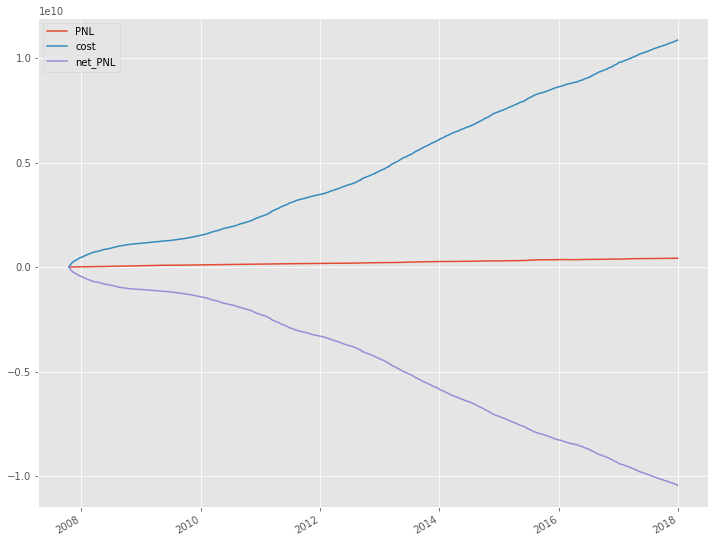

In [247]:
cumpnl_df = PNL_cost.cumsum()
cumpnl_df.plot(figsize=(12,10))
#pnl_df.to_csv('pnl_df.csv')
#cumpnl_df.to_csv('cumpnl_df.csv')

## Analysis : 

- The net PNL is negative here, because we only do optimization to the pnl but not include the cost. So the performace is bad.


- To find out what's wrong here, I tried 2 different kappa value: 0.05 and 1, which significantly reduce the cost and make the net pnl positive.


- Further improvement : do optimization to net pnl (including cost).

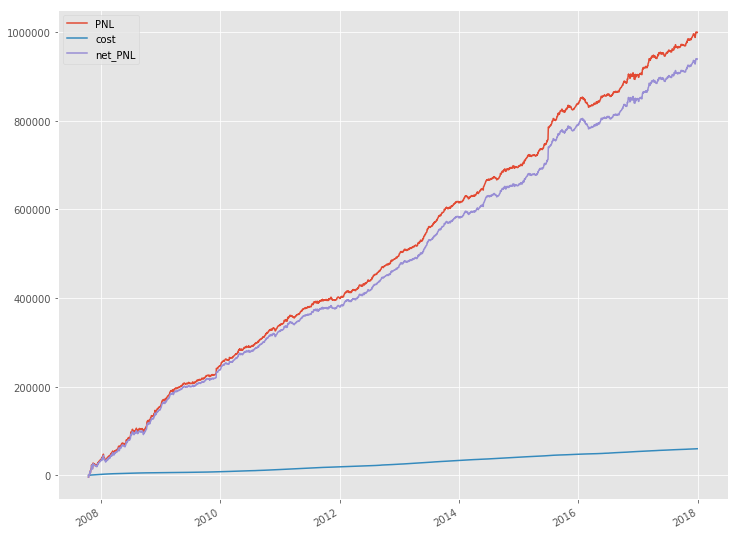

In [248]:
pc2=pnl_cost(holding_df, data_t_i, factor_return_ols,k=0.05)
pc2["net_PNL"]=pc2["PNL"]-pc2["cost"]
pc2_df = pc2.cumsum()
pc2_df.plot(figsize=(12,10))

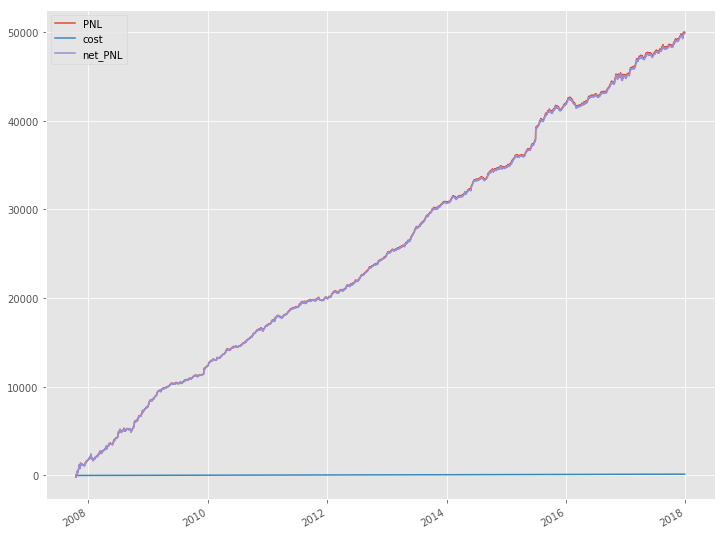

In [249]:
pc3=pnl_cost(holding_df, data_t_i, factor_return_ols,k=1)
pc3["net_PNL"]=pc3["PNL"]-pc3["cost"]
pc3_df = pc3.cumsum()
pc3_df.plot(figsize=(12,10))

### (e) Risk decomposition

In [250]:
print(factor_return_ols.columns.values.tolist().index('td'),factor_return_ols.columns.values.tolist().index('tir'))

5 4


In [251]:
allrisk_df = pd.DataFrame(columns=np.append(factor_return_ols.columns,['alpha_risk','nonalphafactor_risk','idio_risk']))

In [266]:
for dt in holding_df.index:
    # get h: (n,1)
    holding = holding_df.loc[dt,:].dropna().astype(float)
    h = holding.values
    
    # get X: (n,k)
    df = data_t_i.loc[dt, :]
    df = df.loc[holding.index,]
    
    df_X = df[Xname]
    X = df_X.values

    # get F: (k, k)
    factor = factor_return_ols.loc[:dt, df_X.columns.values].astype(float).cov().fillna(0)
    F = factor.values

    # get D: (n, n)
    df.loc[df['RESVOL'] < 0.005, 'RESVOL'] = 0.005
    D = np.diagflat(df['RESVOL'].values ** 2)
    
    
    # risk
    sigma = X @ F @ X.T + D

    
    total_risk = h.T @ sigma @ h
    factor_risk=h.T @(X @ F @ X.T)@ h
    
    
    idio_risk = h.T @ D @ h
    idio_risk_rate = idio_risk / total_risk
    
    #alphafactor_risk =h.T @ (X_alpha @ F_alpha @ X_alpha.T)@ h 
    alphafactor_risk=(h.T @ X)[4:6] @(F @ X.T @ h)[4:6]
    
    print(factor_risk,alphafactor_risk)
    
    alphafactor_risk_rate= alphafactor_risk/total_risk
    nonalphafactor_risk_rate=1-idio_risk_rate-alphafactor_risk_rate
    
    # store
    allrisk_df.loc[dt, 'alpha_risk']= alphafactor_risk_rate
    allrisk_df.loc[dt, 'idio_risk'] = idio_risk_rate
    allrisk_df.loc[dt, 'nonalphafactor_risk']=nonalphafactor_risk_rate

56670386290276.94 6911.892126661662
-30707236085751.625 7398.654770444513
-73626595087983.5 9367.412711866771
1230008918878.5 9622.57380583329
3383765638584.5 9864.38067490525
-49192960259079.25 9696.50687412651
6272466241073.0 11199.736081937823
-29132395218710.75 9732.852821143328
-5216939214181.875 12468.609120205583
-23072568640612.625 11050.75129025212
43022689019315.97 10284.588006943224
27085207581685.938 10134.958822432078
-8605710390639.875 8689.443308591557
2672466521861.0625 9007.12090420591
-44049713448393.31 8063.391785107658
-26481932344812.0 8847.622569553361
29902627580497.406 8975.196344862847
-9052616062874.719 8894.596744075967
-35360976843191.0 8535.027434064257
-9697728021637.938 8197.47701404466
-21209655341341.625 7244.2602613574345
1665780731127.6406 5784.411818256714
-8518872602633.5625 3979.935960480102
-9963885807523.844 4170.867607282951
-7666295701882.328 4130.053898413586
11371873825790.719 3775.605644046027
-1052828200310.9414 4691.550684033957
-464503059

1124595796757.0938 2943.7073501771265
-4560973559712.75 4136.311396759624
-2697061045147.8438 4470.478224525543
18833134898524.36 4137.203322508729
-6311667233356.32 3896.887832349514
1884452639071.5 3768.590407451248
10019198411207.781 3775.811728215915
7451064238525.469 4281.386967180846
-4223959925042.172 5472.085742296708
5389086966775.633 5351.324263788877
3161644344381.0625 5300.032297170732
3261623921465.7344 5492.413369109658
3837668739096.3125 4993.726526517482
-831431543069.1602 5261.945231860705
8458070716141.719 5643.184268800565
-2721831126351.1797 6572.025855120599
2145218201614.75 7122.9238544880645
-3909092149729.3438 7254.887910436204
-21545042382645.0 7306.6516551292425
2632810596594.5312 6123.447817067344
1578048805484.3438 5769.481974160162
1219044313775.0312 6180.846641305769
-7557278889383.078 6131.511121988053
106900222696.38867 6545.0421852735735
-1524714009413.9082 6659.37634121179
-8406746774221.811 7596.681096004331
-7306768660454.18 7656.5283117318795
207350

1552252355666.961 4247.93359762229
5845669627440.094 4309.435332216646
2014165660322.25 4778.274475632803
-4322183371613.297 4777.537500024235
3354281106149.789 4904.355545263952
-5436620729668.461 5892.867524282422
5500785135088.547 5789.0097028620985
665628997345.7188 5863.897077334752
4455699042674.625 5921.530656370498
-21270165202725.75 5499.45093783968
-4056558678785.379 5048.2166883609525
-1116837593120.1953 5146.141463157638
-143590710192.01562 4745.287458947185
1930213421835.9375 4634.68920163156
2524121939478.66 4036.0108762554164
418138742644.9883 4436.631670926965
-2682717061456.3125 4447.133849246237
8820367315105.973 3978.7434241751153
-3073800714036.375 4122.891772342845
6427704073956.367 3734.8478770311954
-54747718138.0 2701.201866782864
2701591776384.8574 3041.011009622105
-7523775110627.215 2509.9475708936325
22552601903.421875 2917.8174428026973
3052063078921.0625 2397.537279439303
618424803144.8125 2542.0458389100268
-381220043603.5078 2777.2992338793565
-845978242

-5322875846949.926 5493.1414748885
6936894715774.453 5479.928758012595
-2111114337839.1406 4813.558501542218
-8484337215631.586 5079.619872897804
1143823449206.9375 5017.364844576799
759680486005.5234 4847.916276315851
15465785634018.062 4569.85632963241
-15335449988405.95 4600.55436225409
34361026553386.14 4141.785783995895
-5484525731900.719 4580.6348199741615
-7449474222219.867 4220.893947256398
10208081108163.828 4510.088532283482
2460863462640.6035 4541.514661661835
-1308503811258.7383 5115.715579982726
10497251708693.559 5869.754500392624
-4150083310872.672 6176.25708736613
4990229863005.422 6311.213376067785
4190669300147.875 5887.485008781732
-7963646908204.094 6242.464342840494
3103095945169.539 6829.9503509163
35376664379021.75 6977.421988102293
-6955012107965.9375 6894.631435526631
-13471397512867.734 6659.995223872058
8911626515494.154 7384.634150391639
-7226150253050.461 7225.901722644523
3314117006464.7617 6615.334754648903
-1714086866473.8438 6565.576254107609
-281054992

-12049834357801.61 8125.022881597277
-6254832838716.156 8147.966453221555
5650902694748.582 8439.626573025585
-1049104093808.2344 8621.518143157553
3653693855113.125 8279.004720190811
1692442813294.5 7697.722009347705
-3237496513991.8594 7495.876971712815
11070622689378.148 7328.083098311532
-3738607185666.7734 6898.544946364165
-8840534511582.75 7064.804920223154
-6093157807146.016 6421.191679445163
1054474141404.3164 6440.983142922006
-5509455977348.375 5878.736295487422
2418682122826.5312 5123.169561039764
1818613289374.793 4934.426703078166
-2725617645354.703 4839.794929165328
6858240205771.055 4826.005583581725
423669383270.6719 5061.538177688264
-670379516151.375 4894.867348036799
27797555554388.953 4842.866261517168
11438506495818.938 4951.055757944223
-5513963034519.551 4113.670427931377
3508309496118.078 4335.623223993787
-29024426850698.266 3887.433082219178
23385296999500.33 3662.8454220882886
11344487645632.367 5287.348432978404
-7975976642771.375 5260.010638273642
83415014

-2141149822960.039 6352.419175785719
7475445799915.297 5897.9227281611775
1754174243172.6738 5734.151826794946
-7418765113045.031 5267.883924424237
-6710017920201.766 5155.986933181438
-835752014482.5938 4971.7609931625775
5982335692147.078 5397.74470507898
-1516675768019.789 5203.409234930422
-11524534158281.219 6446.570926293984
12059483764213.938 6686.3798384738875
-3463946925133.7812 6335.656733576123
-10590685280788.492 6800.066007827767
251355927324.90234 6892.410421149436
-7463729657932.3125 6910.976050650279
8279448197920.875 6420.16005948467
-2046687376060.1016 6958.306608960981
-22784900028961.195 6837.8649879366985
-4168936669339.0625 7341.528727172742
-36358959485319.8 7274.439903993525
3966121817696.0938 6989.365538067719
-2397303501345.6875 6611.147835343136
8302897941434.578 6486.5640582808755
14754982003044.21 6089.54749430188
-9275784829317.11 6799.751286916908
-29311495360464.5 7032.482796216464
1143284420298.2344 7448.161137958109
363613924434.03906 7807.579448785438

641492946719.1562 7886.9996766572
2894299448430.6846 8219.078491796066
-11161106095999.125 8152.092371152392
-13034878552968.844 7843.697907491189
4665702994501.219 8209.600573596448
13224910197369.625 7741.093158794348
-8710875248140.59 7923.257195576536
471668755259.5156 7845.294877475248
10988180556190.535 7335.016403071637
1726306698081.4785 7489.36238743178
1487593059348.039 7324.064346007806
-1226132198335.9492 7709.677289691575
-1760258283050.793 7506.352960312918
380511698479.59375 7399.203407137897
-3402495015660.6875 7098.658696127964
-3717066379352.6016 7425.2866189564775
10655356743962.86 7306.346698214735
-8651679595689.68 6971.633487157462
13317572037105.867 7111.782473476463
7338880933244.594 7148.275169924722
11449714347952.777 7020.799642124843
-733959984605.9414 6779.8082575414055
-3194383082683.5312 7612.575589552881
-6210815140352.8125 7631.805086523767
-16248512294582.156 7973.176700263113
9428862244494.562 7353.329903219184
3671563291742.4688 7038.392065542283
158

-2018622471239.3516 4421.668263018818
-24618050349039.066 5240.376129872235
-11932110037006.871 7075.718169202504
-6272538297791.633 7687.008065031321
2299427360155.9805 8235.012772216458
-18780655301661.508 8502.01591320536
3690738768504.6562 8705.972636483793
-1293250159741.7031 8971.996522134474
5517566147316.023 8728.92809452262
-3200737174408.1094 8933.67183686045
-41540203855583.64 8945.32159599906
-2372004725990.7812 8667.541286615497
-4991423932225.281 8655.39641953288
7050699614240.383 8596.915328061748
-46142443386098.36 8174.669680081079
703169873850.125 8133.67773344162
8833177446773.531 8224.458432115358
34115707382286.89 8149.94184283552
25621720398456.65 8175.001158904779
-11715022343445.516 8570.686829064323
-5208841967342.555 7694.308421805153
-8814582853275.625 7494.648756502626
-19321886020137.72 7537.983692006718
-1201531978354.4062 7509.0694234412285
17226233718156.61 7453.239513612631
3571588901374.0703 7313.3610485885165
-6923519274553.078 7380.609293871761
14621

-4007449755748.5938 7045.153340003832
-12041287331713.344 6902.007432618072
-321130716403.71875 6988.971209291992
-71012759723.25 7757.292908028105
-1163144502177.9062 7824.3677125508475
2800144231956.119 8201.469568984245
-3916524031573.578 7918.976508305939
-1309629327502.6484 7379.607795642318
38407886903454.33 7224.896386247676
18893814977863.64 7049.824044747193
-9921126760054.117 7138.837654171282
3010581934340.5625 7556.732593807705
-7473713151110.215 7483.976654446891
8726595375946.9375 7281.446413874346
-32256228649745.42 7417.330843840167
-12606818738308.055 8286.759170526746
-6974238670777.453 8220.054268412161
8596199674973.828 8396.314740608217
-2456705475554.0664 8948.335973129346
3050816325152.289 8877.413854737828
1272768030232.6562 8691.16596904466
4309545592233.297 8427.026119132835
-11853902297465.281 8044.763248596645
193532726638.10156 8217.955459503919
4065034869937.9277 7007.608016251455
-1096018897877.8828 6300.548472078903
270582844416.69922 5897.731603798584
5

-1594454019016.7227 8505.939010544556
1316816371779.2188 8566.466414613755
8282106137848.016 8667.39855370715
-14744829608248.0 8756.357953373139
-5510963703057.625 8616.834969853413
11553337637002.367 8561.10501957332
-11090797804285.992 8882.660588539851
7291458646160.802 8821.965344945647
-8917343042551.445 8859.203582653226
-5353544922613.141 9024.012030675913
-3623255914901.867 9186.934843643185
1279565586879.711 8970.435202825114
-2785793007133.953 9060.143107608135
-1635970130990.5781 9343.692073757096
2152784253534.0469 8801.864917251114
125700942186.40625 8724.456722009347
1429813731559.6836 8711.198295549972
-2317016075864.883 9029.25545953291
-599793152635.1562 9201.948249343499
-5666866022309.102 9216.149137550994
-12434449247690.52 8959.91704838679
15683804503899.39 9166.4748976371
-8135558300004.617 9031.949492803586
8042821582243.215 8816.510379124371
-4569788010527.922 8332.27022270309
-2247606076733.586 8098.501321467518
-1410979576623.127 7804.968791334151
-3920746339

2078246327562.3164 4610.9146767794555
-1778025226939.8906 4405.23725746432
-978846754734.6523 5523.2907303017355
-1616547160610.6484 6363.38929699829
93166217130.72461 6743.557907177063
10561240783311.469 7194.858033639792
1524432480485.8281 7530.753616795739
-5595403915115.281 7255.440059912325
13929695872434.32 7075.416843727607
-12882469035748.82 6738.282304914649
-13242187769696.938 6400.999429706531
13457464455707.234 6613.296073263287
12542966205386.61 7371.975852170979
7605410533435.5625 7340.264552590124
10522958141279.0 6721.384075038022
-3019368605133.672 6546.202964631537
-10565126586014.086 6688.6105561592085
-1591691731826.1406 7205.509329330986
-4266998834488.086 7256.789288530953
2410656531547.5195 7126.897897156446
21613066645194.5 7717.689638477637
-7318410611743.016 7909.965611107679
-1911826449097.6094 7780.740427212509
11779705026134.031 7542.225682391485
7481723549580.641 7854.218263414756
-694560264738.1875 8096.8961974937265
2517740960552.627 8124.1273846243475
7

8355062270089.781 8790.575045203386
-10603940719223.742 8657.464104466715
2699576666073.293 8676.118189226123
-7390324313127.039 8619.618802687508
13045718141661.863 8825.975787122183
801387762363.2969 8771.940506196093
-3752774355446.5 8840.034608227543
-6662130525486.9375 9153.472563550555
7783398744162.852 9326.045716335586
-645967880323.9688 9237.253507706864
1171521797086.8047 9127.526272312698
-3532897345550.789 9135.164286023453
763464099713.9023 9123.841569196002
-2879051415401.6523 8947.654411975287
960053204650.1641 8728.458130867168
4747184557210.625 8487.115238339798
6458331530395.832 8310.270489519982
742421016276.4023 7604.916226602632
-46215384779.24609 7503.410660341436
-8217401407284.0 6619.42113440588
-614877666400.2363 6314.764965174905
1830266785455.043 6277.398653048409
6430516737853.598 6000.304773662539
3696989825933.7656 5843.239372040275
-1126827849157.9512 6306.293742458356
-1998775975509.4531 6227.409455296481
4812211963266.43 5812.830487005966
-65057356448.6

In [284]:
risk_rate_df[alpha_col].head()

,tir,td
2007-10-18,8.06166e-11,4.14349e-11
2007-10-19,-1.48966e-10,-9.19924e-11
2007-10-22,-8.42761e-11,-4.30975e-11
2007-10-23,4.35861e-09,3.46038e-09
2007-10-24,1.5431e-09,1.36961e-09


In [34]:
allrisk_df.plot(figsize=(12,7))
plt.title('Risk decomposition')

## Analysis:

- The alpha risk take up most of the risk, the idiosyncratic (non-factor) variance remain in a stable level between alpha and non-alpha factors variace.



- This meet my expectation, because our optimization is aim to improve the difference between the portfolio's alpha return and total risk. 
 
 This might make us have more exposure on alpha factors, and hedge the non alpha risk (they don't have return in our model) . 
 
 Since idiosyncratic (non-factor) risk can't be hedged, it will remain between alpha and nonalpha factor risk.



# <table><tr><td bgcolor=orange> <font color=#8A2BE2 size=5>  2.    Mixed-effects Models </font> </td></tr></table>

# Problem 3


### - Estimate the parameters of the factor-return process using a linear mixed- effects (LME) model 


In [128]:
from statsmodels.regression.mixed_linear_model import MixedLM,MixedLMParams

In [129]:
date=[]
for i in range(len(dfs)):
    date.append(dfs[i]['T'][0])

### - Apply EM algorithm

In [130]:
factor_return_lme = pd.DataFrame()
factor_cov = []
factor_sigma = []

rolling_period = 30


for i in range(30,len(dfs),30):
 
    matrix = pd.DataFrame()
    Ymatrix=pd.DataFrame()
    group = np.full(0,0,dtype=int)
    for j in range(i-rolling_period,i):
        df=dfs[j].dropna()
        df = df[df["R"[0]]!=0]
        X=df[['BETA','MOMENTUM', 'SIZE', 'VOL','tir','td','RESVOL','R']+industryfactor]
        
        Y=X[['R']]
    
        # Trimming 
        var=1/(X['RESVOL']**2)
        trimming=var.quantile(q=0.9)
        var[var>trimming]=trimming

        X=X.drop(['RESVOL','R'],axis=1)
        #print(X.shape)
        
        X.index = np.full(len(X),j)
        matrix = matrix.append(X,sort=False)
        Ymatrix=Ymatrix.append(Y,sort=False)
        group = np.append(group,np.full(len(X),j,dtype=int))   
    #print(date[j])
    Ymatrix=Ymatrix.values
    print(matrix.shape)
    matrix = matrix.fillna(0)
    free = MixedLMParams.from_components(
                 fe_params=np.ones(matrix.shape[1]),
                 cov_re=np.eye(6))
    model_mlm = MixedLM(endog=Ymatrix,exog=matrix.iloc[:,:6],groups=group)
    result = model_mlm.fit()
    factor_cov.append(result.cov_re)
    factor_sigma.append(result.resid.std())
    if i<=len(dfs)-rolling_period:
        factor_return_t = pd.DataFrame(np.matlib.repmat(result.fe_params.values,rolling_period,1),columns=result.fe_params.index.values,index=date[i:i+rolling_period])
    else:
        factor_return_t = pd.DataFrame(np.matlib.repmat(result.fe_params.values,len(dfs)-i,1),columns=result.fe_params.index.values,index=date[i:])
    factor_return_lme  = factor_return_lme.append(factor_return_t,sort=False)

(13904, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(13043, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(12841, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(12357, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(13419, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(12430, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(13825, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(12639, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(14135, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(13922, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(14912, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(15708, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(14639, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(15943, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(15276, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(15108, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(13674, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(14829, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(14457, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(14491, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(14597, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(14889, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(14021, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(14444, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(14476, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(16350, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(15824, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(16646, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(13806, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(17000, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(14546, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(16004, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(16158, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(16087, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(17318, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(16717, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(17135, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(17286, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(17306, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(18362, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(16147, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(17927, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(14746, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(17998, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(16437, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(17249, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(16535, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(16781, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(15534, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(17415, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(17921, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(19142, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

(17152, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(19045, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(18943, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(18038, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(20307, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(19639, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

(19247, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(18153, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(17510, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(19113, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(20051, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(18681, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(18025, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(18828, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

(18757, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(20174, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(20528, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(21121, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

(22525, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

(19243, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(21913, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(20575, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(19555, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(21807, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

(21077, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(20787, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(21631, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(22323, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(21283, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

(23220, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(21264, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(21212, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(21926, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(20002, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(21807, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(21243, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(22955, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

(20680, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(21513, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


(19895, 150)


/anaconda3/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2045: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


In [131]:
alpha_return = factor_return_lme.loc[:,['tir','td']]

In [132]:
factor_return_lme.shape

(2738, 6)

Text(0.5, 1.0, 'Alpha factor LME')

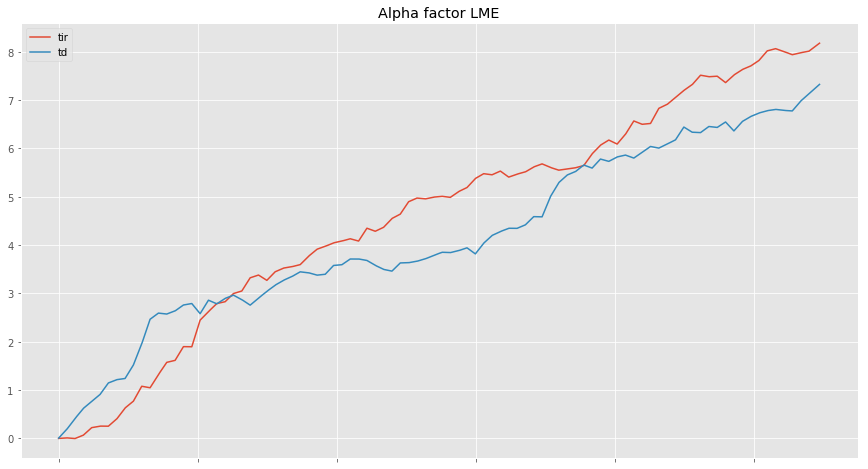

In [141]:
lme_cum=alpha_return.cumsum()
#lme.index=pd.to_datetime(lme.index)
lme_cum.plot(figsize=(15,8))
plt.title('Alpha factor LME')

### - Cumulated return of different methods

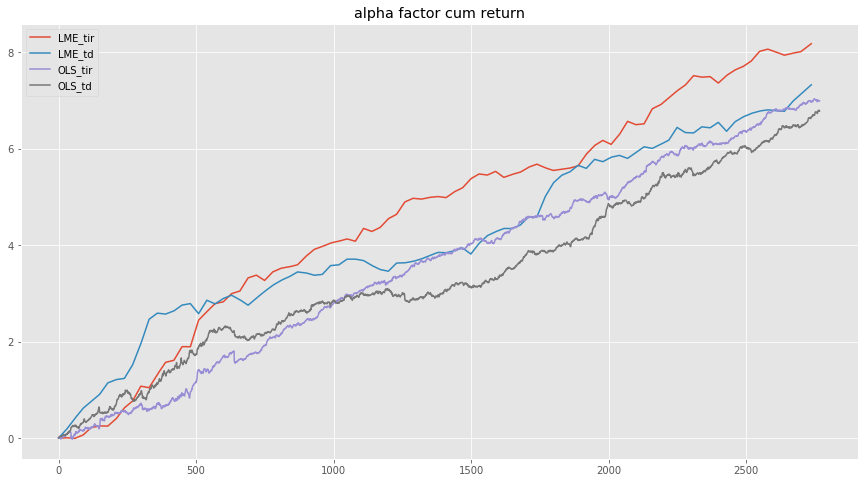

In [140]:
plt.figure(figsize=(15, 8))
plt.title('alpha factor cum return')
plt.plot(figsize=(12,10))
plt.plot(np.cumsum(alpha_return.loc[:,'tir'].values),label='LME_tir')
plt.plot(np.cumsum(alpha_return.loc[:,'td'].values),label='LME_td')
plt.plot(np.cumsum(factor_return_ols.loc[:,'tir'].values),label='OLS_tir')
plt.plot(np.cumsum(factor_return_ols.loc[:,'td'].values),label='OLS_td')
plt.legend(loc='best')

In [153]:
from scipy.stats import ttest_ind

pvalue_tir = ttest_ind(factor_return_ols['tir'], alpha_return['tir'])[1]
pvalue_td = ttest_ind(factor_return_ols['td'], alpha_return['td'])[1]

print ('The p-value of t-test between OLS tir and WLS tir is: '+str(pvalue_tir))
print ('The p-value of t-test between OLS td and WLS td is: '+str(pvalue_td))

The p-value of t-test between OLS tir and WLS tir is: 0.0891058700630396
The p-value of t-test between OLS td and WLS td is: 0.442613699923909


- From the p-value above, we can't reject the original assumption, which means they are not significantly different.


# <table><tr><td bgcolor=orange> <font color=#8A2BE2 size=5>  3.   Reinforcement Learning  </font> </td></tr></table>

# Problem 4 

## - (Q Learning)

In [38]:
def simulate_OU_price(p_e, half_life, sigma, periods):
    x = 0
    price_list = [p_e]
    lbda=np.log(2) / half_life
    for i in range(periods-1):
        x += - lbda * x + sigma * np.random.normal()
        p = p_e * np.exp(x)
        p = max(0.1, min(100., p))
        p=round(p,1)
        price_list.append(p)
    price_list = np.array(price_list)
 
    return price_list

In [39]:
sigma = 0.1
half_life=5
p_e = 50
periods = 500000

P_price=simulate_OU_price(p_e, half_life, sigma, periods)

T_price=simulate_OU_price(p_e, half_life, sigma, periods)

In [40]:
import random
import itertools

class Qlearning():
    
    # Define the variables, Sharpe ratio and cumulated pnl
    def __init__(self, kappa, gamma, alpha, epsilon, Q):
        
        self.kappa = kappa
        self.gamma =gamma
        self.alpha = alpha
        self.epsilon = epsilon
        self.Q = Q
        self.sharpe = None
        self._C_pnl= None
    
    
    def _cost(self, h_delta):
        spread_cost=0.1 * h_delta if h_delta >= 0 else 0.1 * (- h_delta)
        impact_cost= h_delta ** 2 * 0.1 / 100
        return spread_cost+impact_cost
    
    def _pnl(self, cur_state, action, p_delta):
        ht = list(cur_state)[0] + action
        grosspnl=ht * p_delta 
        pnl=grosspnl-self._cost(action)
        return pnl
    
    def _reward(self, pnl):
        R = pnl - 1/2 * self.kappa * pnl ** 2
        return R
    
    def train(self, price_series):
        
        daily_pnl = []
        cur_state = (0,0)
        pre_state = (0,0)
        for time_tplus1, mkt_price in enumerate(price_series, start=1):
            
            # time 1 
            if time_tplus1 == 1:
                pre_state = list(pre_state)
                pre_state[1] = mkt_price
                pre_state = tuple(pre_state)
            
                cur_state = list(cur_state)
                cur_state[1] = mkt_price
                cur_state = tuple(cur_state)
            
            
            # Epsilon-greedy : find optimal action
            coin = random.uniform(0,1)
            if coin > self.epsilon:
                index = 0
                while True:
                    action = Q[cur_state].nlargest(11).index[index]
                    index += 1
                    if (list(cur_state)[0] + action) <= 1000 and (list(cur_state)[0] + action) >= -1000:
                        break
                    
            
            else:
                while True:
                    action = self.Q.index[random.randint(0,10)]
                    if (list(cur_state)[0] + action) <= 1000 and (list(cur_state)[0] + action) >= -1000:
                        break
            
            # Update pnl and return
            pnl = self._pnl(cur_state, action, price_series[time_tplus1] - mkt_price)
            daily_pnl.append(pnl)
            
            
            # Update next state
            next_state = list(cur_state)
            next_state[0] = list(cur_state)[0] + action
            next_state[1] = price_series[time_tplus1]
            next_state = tuple(next_state)
            
            # Update Q_space 
            self.Q.loc[action][cur_state] = (1 - self.alpha) * self.Q.loc[action][cur_state] + self.alpha * (self._reward(pnl) + self.gamma * (max(self.Q[next_state])))
            
            pre_state = cur_state
            cur_state = next_state
            
            if time_tplus1 == len(price_series) - 1:
    
                self._C_pnl = pd.Series(daily_pnl).cumsum()
                self.sharpe = np.sqrt(252) * np.mean(daily_pnl) / np.std(daily_pnl)
                break
    
    def test(self, price_series):
        
        # Do the same to test set using the Q we get in train part
        
        daily_pnl = []
        cur_state = (0,0)
        pre_state = (0,0)
                
        
        for time_tplus1, mkt_price in enumerate(price_series, start=1):
            
            
            if time_tplus1 == 1:
                pre_state = list(pre_state)
                pre_state[1] = mkt_price
                pre_state = tuple(pre_state)
            
                cur_state = list(cur_state)
                cur_state[1] = mkt_price
                cur_state = tuple(cur_state)
            
            
           
            coin = random.uniform(0,1)
            if coin > self.epsilon:
                index = 0
                while True:
                    action = Q[cur_state].nlargest(11).index[index]
                    index += 1
                    if (list(cur_state)[0] + action) <= 1000 and (list(cur_state)[0] + action) >= -1000:
                        break
                    
            
            else:
                while True:
                    action = self.Q.index[random.randint(0,10)]
                    if (list(cur_state)[0] + action) <= 1000 and (list(cur_state)[0] + action) >= -1000:
                        break
            
            pnl = self._pnl(cur_state, action, price_series[time_tplus1] - mkt_price)
            daily_pnl.append(pnl)

            
            next_state = list(cur_state)
            next_state[0] = list(cur_state)[0] + action
            next_state[1] = price_series[time_tplus1]
            next_state = tuple(next_state)
             
            pre_state = cur_state
            cur_state = next_state
            
            if time_tplus1 == len(price_series) - 1:
                self._C_pnl = pd.Series(daily_pnl).cumsum()
                self.sharpe = np.sqrt(252) * np.mean(daily_pnl) / np.std(daily_pnl)
                break
    
    
    def result(self):
        
        return self._C_pnl,self.sharpe
        

In [41]:
Holding_space = [(-10 + i) * 100 for i in range(21)]
Price_space = [round(0.1 * i,1) for i in range(1,1001)]
Action_space = [(-5 + i) * 100 for i in range(11)]

State_space = list(itertools.product(Holding_space, Price_space))

# Using a nomal distribution to set the orginal Q table
# Becaue if use 0, then we will always choose the first action instead of randomly explore.
Q_0 = np.random.normal(0,1,(11,21000))
Q = pd.DataFrame(Q_0, index=Action_space, columns=State_space)
Q.head()

,"(-1000, 0.1)","(-1000, 0.2)","(-1000, 0.3)","(-1000, 0.4)","(-1000, 0.5)","(-1000, 0.6)","(-1000, 0.7)","(-1000, 0.8)","(-1000, 0.9)","(-1000, 1.0)",...,"(1000, 99.1)","(1000, 99.2)","(1000, 99.3)","(1000, 99.4)","(1000, 99.5)","(1000, 99.6)","(1000, 99.7)","(1000, 99.8)","(1000, 99.9)","(1000, 100.0)"
-500,0.682786,0.524538,-0.273749,0.197747,-0.187003,0.832112,0.952245,1.281596,1.388174,-1.383851,...,-1.680223,0.532600,0.204848,0.822354,-1.185619,1.911835,-0.903949,0.846988,-1.326880,0.750244
-400,-0.835478,-1.200286,1.191357,0.242841,0.279713,-0.502123,-0.216498,-0.580228,-0.507899,-1.348457,...,-0.541779,0.557390,-0.008192,0.213110,1.321070,-0.850526,-0.295531,-0.717393,-0.940710,1.123103
-300,-1.427623,0.710883,1.074639,0.813290,-0.410883,-1.212232,0.647485,-0.021736,0.141085,0.956945,...,-1.637156,-1.486072,1.385622,0.310209,-1.760090,-0.048907,0.349831,-0.443689,0.154065,-0.058739
-200,1.414976,0.505962,0.318453,-1.646802,0.018712,0.201660,0.453829,-0.690794,0.898831,0.765453,...,0.309278,-2.109514,-0.958452,0.584037,0.721612,-0.360610,0.162623,1.005903,-0.865603,0.215512
-100,2.344254,2.079716,1.363862,-0.036267,0.056485,0.032996,0.808358,-0.105318,0.465538,1.005709,...,0.476325,-0.172788,0.537237,0.597765,-1.530036,-0.615433,0.451572,0.201630,-1.694983,0.945718


Train Sharpe ratio is :  1.1937203367903597


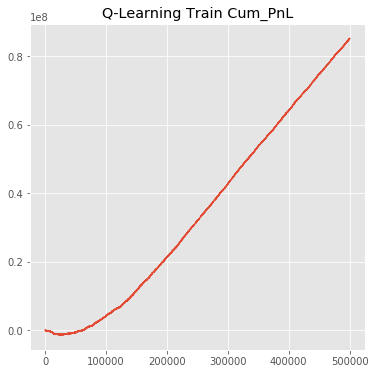

In [42]:
Q_L = Qlearning(Q=Q, kappa=1e-4, gamma=0.999, alpha=0.1, epsilon=0.1)
Q_L.train(P_price)
C_Train_pnl,Train_sharpe=Q_L.result()
C_Train_pnl.plot(figsize=(6,6))
plt.title("Q-Learning Train Cum_PnL")
print('Train Sharpe ratio is : ', Train_sharpe)

Test Sharpe ratio is :  1.9268377867496531


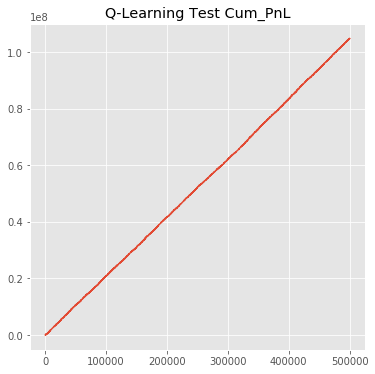

In [45]:
Q_L.test(T_price)
C_pnl,sharpe=Q_L.result()
C_pnl.plot(figsize=(6,6))
plt.title("Q-Learning Test Cum_PnL")
print('Test Sharpe ratio is : ', sharpe )

### --------------------------------------------------------------------------------------------------------------------------------

### The END.

### Thank you !